### Nonlinear interaction of energetic electrons with large amplitude chorus
Bortnik, Thorne and Inan 2008


In [1]:
import numpy as np
import os
import sys
import inspect
import matplotlib.pyplot as plt


current_dir =  os.path.abspath(os.path.dirname('__file__'))

fpath_envi = os.path.abspath(current_dir + "../../..")
fpath_wave = os.path.abspath(current_dir + "../../..")
fpath_wpi = os.path.abspath(current_dir + "../../../wave_particle_interactions")

sys.path.append(fpath_envi)
sys.path.append(fpath_wave)
sys.path.append(fpath_wpi)

print(fpath_envi)
import environment_mod as env
import waveproperties_mod as wave
import whistler_electron_mod as wpi


/home/tourgaidis/Επιφάνεια εργασίας/WPIT_GIT/WPIT


### 1. Define simulation parameters

Here we define all the initial parameters of the simulation in respect with the particle and the wave

In [2]:
ne_0=10**7 #initial electron density in m^-3
L_shell=5 #L-shell of the simulation 
By_wave=100*10**(-12)   # By component of the wave in Tesla
aeq0_deg=68   #initial equatorial pitch angle in deg
aeq0=np.deg2rad(aeq0_deg) #convert pitch angle to rad
Ekev0=168.3 #initial energy in keV
lamda0_deg=-9  # starting electron latitude in deg
lamda0=np.deg2rad(lamda0_deg) #convert latitude to rad
theta0_deg=0.0001 # initial wave normal angle in deg
theta0=np.deg2rad(theta0_deg) #convert wave normal angle to rad
f_wave=2000 # wave frequency in Hz
w_wave=2*np.pi*f_wave #wave angular frequency in rad/s
m_res=1 #WPI resonance number (0=Landau resonance)
eta0_deg=np.linspace(158.66,158.665,96) #initial electron-wave phases in deg
eta0=np.deg2rad(eta0_deg) #convert initial electron-wave phases to rad
t=0.1 #simulation duration (s)
h=0.00001  #simulation stepsize
Nsteps=int(t/h) #number of simulation steps
print(np.rad2deg(eta0))

[158.66       158.66005263 158.66010526 158.66015789 158.66021053
 158.66026316 158.66031579 158.66036842 158.66042105 158.66047368
 158.66052632 158.66057895 158.66063158 158.66068421 158.66073684
 158.66078947 158.66084211 158.66089474 158.66094737 158.661
 158.66105263 158.66110526 158.66115789 158.66121053 158.66126316
 158.66131579 158.66136842 158.66142105 158.66147368 158.66152632
 158.66157895 158.66163158 158.66168421 158.66173684 158.66178947
 158.66184211 158.66189474 158.66194737 158.662      158.66205263
 158.66210526 158.66215789 158.66221053 158.66226316 158.66231579
 158.66236842 158.66242105 158.66247368 158.66252632 158.66257895
 158.66263158 158.66268421 158.66273684 158.66278947 158.66284211
 158.66289474 158.66294737 158.663      158.66305263 158.66310526
 158.66315789 158.66321053 158.66326316 158.66331579 158.66336842
 158.66342105 158.66347368 158.66352632 158.66357895 158.66363158
 158.66368421 158.66373684 158.66378947 158.66384211 158.66389474
 158.66394737 1

### 2. Find initial electron's local pitch angle 

In [3]:

alpha0=env.aeq2alpha(L_shell,lamda0,aeq0)

print('\u03B1:',np.rad2deg(alpha0))
# print('\N{GREEK SMALL LETTER alpha}')

α: 78.37445795337882


### 3. Find initial momentum, velocity and lorentz factor

In [4]:
upar0,uper0,ppar0,pper0,gamma0=env.momentums(Ekev0,alpha0,env.const.me)

print('upar0:',upar0,'m/s')
print('uper0:',uper0,'m/s')
print('ppar0:',ppar0,'Ns')
print('pper0:',pper0,'Ns')
print('gamma0:',gamma0)

upar0: 39805013.39163095 m/s
uper0: 193476979.55557317 m/s
ppar0: 4.820203623516892e-23 Ns
pper0: 2.3429170309410255e-22 Ns
gamma0: 1.3293478962221865


### 5. Calculate all the initial parameters

In [5]:

Bmag0=env.Bmag_dipole(L_shell,lamda0)
ne0=env.densities_denton(ne_0,lamda0)

#assuming 94%H+, 5.4%He+, 0.6%O+
nH0=0.94*ne0
nHe0=0.054*ne0
nO0=0.006*ne0    

S0,D0,P0,R0,L0=wave.stix_parameters(w_wave, ne0, nH0, nHe0, nO0, Bmag0)

eta_sq_plus0,eta_sq_minus0,mu0,kappa0,kappaz0,kappax0=wave.ref_index(theta0,w_wave,S0,P0,R0,L0)

wce0=env.omega_cyclotron(Bmag0,env.const.qe,env.const.me)


Bxw0, Byw0, Bzw0, Exw0, Eyw0, Ezw0=wave.wave_amplitudes_bell(mu0,P0,D0,S0,By_wave,theta0)
dwceds0=env.dwc_ds(wce0,lamda0,L_shell)

gamma0,w10,w20,wtau_sq0,R10,R20,beta0=wpi.wpi_params(m_res,ppar0,pper0,Bxw0, Byw0,Exw0,Eyw0,Ezw0,kappaz0,kappax0,wce0)
v_para_res0, v_per_res0, v_tot_res0, E_res0,gamma_res0=wave.resonant_velocity(m_res,w_wave,kappaz0,wce0,alpha0,env.const.me)


### 4. Allocate outputs


In [6]:
pper=np.zeros((len(eta0),Nsteps+1))
ppar=np.zeros((len(eta0),Nsteps+1))
eta=np.zeros((len(eta0),Nsteps+1))
lamda=np.zeros((len(eta0),Nsteps+1))
time=np.zeros((len(eta0),Nsteps+1))
uper=np.zeros((len(eta0),Nsteps+1))
upar=np.zeros((len(eta0),Nsteps+1))
zeta=np.zeros((len(eta0),Nsteps+1))
alpha=np.zeros((len(eta0),Nsteps+1))
alpha2=np.zeros((len(eta0),Nsteps+1))
aeq=np.zeros((len(eta0),Nsteps+1))
aeq2=np.zeros((len(eta0),Nsteps+1))
Exw_out=np.zeros((len(eta0),Nsteps+1))
Eyw_out=np.zeros((len(eta0),Nsteps+1))
Ezw_out=np.zeros((len(eta0),Nsteps+1))
Bxw_out=np.zeros((len(eta0),Nsteps+1))
Byw_out=np.zeros((len(eta0),Nsteps+1))
Bzw_out=np.zeros((len(eta0),Nsteps+1))
Bw_out=np.zeros((len(eta0),Nsteps+1))
Ew_out=np.zeros((len(eta0),Nsteps+1))
vresz_o=np.zeros((len(eta0),Nsteps+1))
Eres_o=np.zeros((len(eta0),Nsteps+1))

mu_out=np.zeros((len(eta0),Nsteps+1))
deta_dt=np.zeros((len(eta0),Nsteps+1))
S_stix=np.zeros((len(eta0),Nsteps+1))
D_stix=np.zeros((len(eta0),Nsteps+1))
P_stix=np.zeros((len(eta0),Nsteps+1))
R_stix=np.zeros((len(eta0),Nsteps+1))
L_stix=np.zeros((len(eta0),Nsteps+1))
kx_out=np.zeros((len(eta0),Nsteps+1))
kz_out=np.zeros((len(eta0),Nsteps+1))
wh_out=np.zeros((len(eta0),Nsteps+1))
dwh_dt_out=np.zeros((len(eta0),Nsteps+1))
gamma_out=np.zeros((len(eta0),Nsteps+1))
Phi_out=np.zeros((len(eta0),Nsteps+1))
E_kin=np.zeros((len(eta0),Nsteps+1))
v_res_out=np.zeros((len(eta0),Nsteps+1))
E_res_out=np.zeros((len(eta0),Nsteps+1))

Bxw_out=np.zeros((len(eta0),Nsteps+1))
Byw_out=np.zeros((len(eta0),Nsteps+1))
Bzw_out=np.zeros((len(eta0),Nsteps+1))
Exw_out=np.zeros((len(eta0),Nsteps+1))
Eyw_out=np.zeros((len(eta0),Nsteps+1))
Ezw_out=np.zeros((len(eta0),Nsteps+1))
S_out=np.zeros((len(eta0),Nsteps+1))
wtrsq_out=np.zeros((len(eta0),Nsteps+1))
C0_out=np.zeros((len(eta0),Nsteps+1))
C1p_out=np.zeros((len(eta0),Nsteps+1))
C1m_out=np.zeros((len(eta0),Nsteps+1))
kappa_out=np.zeros((len(eta0),Nsteps+1))

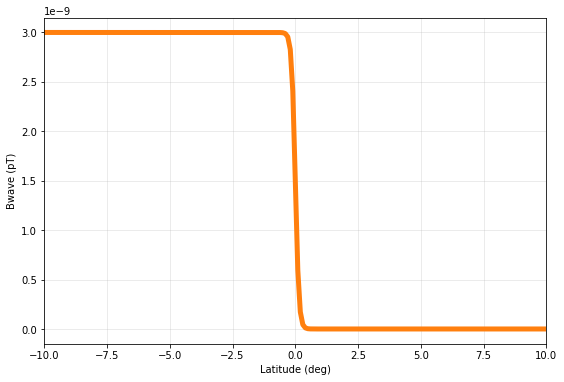

In [7]:
from waveproperties_mod import one_sided_wave_packet

lamda_packet2=np.arange(-10,10,0.1)
lamda_packet_rad2=np.deg2rad(lamda_packet2)

Byw0_packet2=3*10**(-9)
shape=7
direction='south'
location=0
Bw_packet2=[]

for i in range(0,len(lamda_packet2)):

    Bytmp=wave.one_sided_wave_packet(Byw0_packet2,lamda_packet_rad2[i],shape,location,direction)

#     print(Bytmp)
    Bw_packet2.append(Bytmp)

    
fig, ax = plt.subplots(figsize=(9,6))
s=5
ax.plot(lamda_packet2,Bw_packet2,c='tab:orange',linewidth=s)
ax.grid(alpha=.3)
ax.set_xlim(-10,10)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel('Bwave (pT)')

# ax.set_ylim(-2,2)
ticks=np.arange(0,2*np.pi,1)
# cbar=fig.colorbar(cmap, ticks=ticks)
# cbar.set_label('gyro-phase (rad)', rotation=270,labelpad=15)
#     ax.axvline(x=-5,color="black", linestyle="--")
plt.show()


### Runge-Kutta

In [8]:
for k in range(0,len(eta0)):
    i=0
    time[k,0]=0
    pper[k,0]=pper0
    ppar[k,0]=ppar0
    eta[k,0]=eta0[k]
    lamda[k,0]=lamda0
    zeta[k,0]=0
    upar[k,0]=upar0
    uper[k,0]=uper0
    alpha[k,0]=alpha0
    alpha2[k,0]=alpha0
    aeq[k,0]=aeq0
    aeq2[k,0]=aeq0
    mu_out[k,0]=mu0
    deta_dt[k,0]=0
    S_stix[k,0]=S0
    D_stix[k,0]=D0
    P_stix[k,0]=P0
    R_stix[k,0]=R0
    L_stix[k,0]=L0
    kappa_out[k,0]=kappa0
    kx_out[k,0]=kappax0
    kz_out[k,0]=kappaz0
    dwh_dt_out[k,0]=dwceds0
    gamma_out[k,0]=gamma0
    E_kin[k,0]=1.602176487E-16*Ekev0 #from keV to ergs
    v_res_out[k,0]=v_para_res0
    E_res_out[k,0]=E_res0
    Bxw_out[k,0]=Bxw0
    Byw_out[k,0]=Byw0
    Bzw_out[k,0]=Bzw0
    Exw_out[k,0]=Exw0
    Eyw_out[k,0]=Eyw0
    Ezw_out[k,0]=Ezw0
#     print(np.rad2deg(eta[k,0]))
    while i<Nsteps:
    ######################################################################################################
    #First step of Runge Kutta
    ######################################################################################################

        Bmag=env.Bmag_dipole(L_shell,lamda[k,i])
        ne=env.densities_denton(ne_0,lamda[k,i])

        #assuming 94%H+, 5.4%He+, 0.6%O+
        nH=0.94*ne
        nHe=0.054*ne
        nO=0.006*ne    

        S,D,P,R,L=wave.stix_parameters(w_wave, ne, nH, nHe, nO, Bmag)

        eta_sq_plus,eta_sq_minus,mu,kappa,kz,kx=wave.ref_index(theta0,w_wave,S,P,R,L)

        wce=env.omega_cyclotron(Bmag,env.const.qe,env.const.me)
        By_packet=one_sided_wave_packet(By_wave,lamda[k,i],shape,location,direction)

        Bxw, Byw, Bzw, Exw, Eyw, Ezw=wave.wave_amplitudes_bell(mu,P,D,S,By_packet,theta0)
        dwceds=env.dwc_ds(wce,lamda[k,i],L_shell)

        gamma,w1,w2,wtau_sq,R1,R2,beta=wpi.wpi_params(m_res,ppar[k,i],pper[k,i],Bxw, Byw,Exw,Eyw,Ezw,kz,kx,wce)
        v_para_res, v_per_res, v_tot_res, E_res,gamma_res=wave.resonant_velocity(m_res,w_wave,kz,wce,alpha[k,i],env.const.me)
        
        
        k1=wpi.dzdt(ppar[k,i],gamma,env.const.me)
        l1=wpi.dppardt(pper[k,i],eta[k,i],wtau_sq,kz,gamma,wce,dwceds)
        m1=wpi.dpperdt(ppar[k,i],pper[k,i],eta[k,i],w1,w2,beta,gamma,R1,R2,m_res,wce,dwceds)
        n1=wpi.detadt(ppar[k,i],m_res,wce,w_wave,gamma,kz)
        o1=wpi.dlamdadt(ppar[k,i],lamda[k,i],gamma,L_shell)
        p1=wpi.dalphadt(pper[k,i],ppar[k,i],eta[k,i],w1,w2,R1,R2,wtau_sq,kz,beta,m_res,gamma,wce,dwceds)
        q1=wpi.daeqdt(ppar[k,i],pper[k,i],alpha[k,i],aeq[k,i],eta[k,i],w1,R1,w2,R2,gamma,beta,wtau_sq,kz,m_res)
        r1=wpi.dgammadt(pper[k,i],ppar[k,i],eta[k,i],m_res,Exw,Eyw,Ezw,beta,gamma)
        s1=wpi.dEkdt(pper[k,i],ppar[k,i],eta[k,i],m_res,Exw,Eyw,Ezw,beta,gamma)
        

#     ######################################################################################################
#     #Second step of Runge Kutta
#     ######################################################################################################

        Bmag=env.Bmag_dipole(L_shell,lamda[k,i]+0.5*h*o1)
        ne=env.densities_denton(ne_0,lamda[k,i]+0.5*h*o1)

        #assuming 94%H+, 5.4%He+, 0.6%O+
        nH=0.94*ne
        nHe=0.054*ne
        nO=0.006*ne    

        S,D,P,R,L=wave.stix_parameters(w_wave, ne, nH, nHe, nO, Bmag)

        eta_sq_plus,eta_sq_minus,mu,kappa,kz,kx=wave.ref_index(theta0,w_wave,S,P,R,L)

        wce=env.omega_cyclotron(Bmag,env.const.qe,env.const.me)
        By_packet=one_sided_wave_packet(By_wave,lamda[k,i]+0.5*h*o1,shape,location,direction)

        Bxw, Byw, Bzw, Exw, Eyw, Ezw=wave.wave_amplitudes_bell(mu,P,D,S,By_packet,theta0)
        dwceds=env.dwc_ds(wce,lamda[k,i]+0.5*h*o1,L_shell)

        gamma,w1,w2,wtau_sq,R1,R2,beta=wpi.wpi_params(m_res,ppar[k,i]+0.5*h*l1,pper[k,i]+0.5*h*m1,Bxw, Byw,Exw,Eyw,Ezw,kz,kx,wce)
        v_para_res, v_per_res, v_tot_res, E_res,gamma_res=wave.resonant_velocity(m_res,w_wave,kz,wce,alpha[k,i]+0.5*h*p1,env.const.me)
        
        
        k2=wpi.dzdt(ppar[k,i]+0.5*h*l1,gamma,env.const.me)
        l2=wpi.dppardt(pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,wtau_sq,kz,gamma,wce,dwceds)
        m2=wpi.dpperdt(ppar[k,i]+0.5*h*l1,pper[k,i]+0.5*h*m1,eta[k,i]+0.5*h*n1,w1,w2,beta,gamma,R1,R2,m_res,wce,dwceds)
        n2=wpi.detadt(ppar[k,i]+0.5*h*l1,m_res,wce,w_wave,gamma,kz)
        o2=wpi.dlamdadt(ppar[k,i]+0.5*h*l1,lamda[k,i]+0.5*h*o1,gamma,L_shell)
        p2=wpi.dalphadt(pper[k,i]+0.5*h*m1,ppar[k,i]+0.5*h*l1,eta[k,i]+0.5*h*n1,w1,w2,R1,R2,wtau_sq,kz,beta,m_res,gamma,wce,dwceds)
        q2=wpi.daeqdt(ppar[k,i]+0.5*h*l1,pper[k,i]+0.5*h*m1,alpha[k,i]+0.5*h*p1,aeq[k,i]+0.5*h*q1,eta[k,i]+0.5*h*n1,w1,R1,w2,R2,gamma,beta,wtau_sq,kz,m_res)
        r2=wpi.dgammadt(pper[k,i]+0.5*h*m1,ppar[k,i]+0.5*h*l1,eta[k,i]+0.5*h*n1,m_res,Exw,Eyw,Ezw,beta,gamma)
        s2=wpi.dEkdt(pper[k,i]+0.5*h*m1,ppar[k,i]+0.5*h*l1,eta[k,i]+0.5*h*n1,m_res,Exw,Eyw,Ezw,beta,gamma)
        
#     ######################################################################################################
#     #Third step of Runge Kutta
#     ######################################################################################################

        Bmag=env.Bmag_dipole(L_shell,lamda[k,i]+0.5*h*o2)
        ne=env.densities_denton(ne_0,lamda[k,i]+0.5*h*o2)

        #assuming 94%H+, 5.4%He+, 0.6%O+
        nH=0.94*ne
        nHe=0.054*ne
        nO=0.006*ne    

        S,D,P,R,L=wave.stix_parameters(w_wave, ne, nH, nHe, nO, Bmag)

        eta_sq_plus,eta_sq_minus,mu,kappa,kz,kx=wave.ref_index(theta0,w_wave,S,P,R,L)


        wce=env.omega_cyclotron(Bmag,env.const.qe,env.const.me)

        By_packet=wave.one_sided_wave_packet(By_wave,lamda[k,i]+0.5*h*o2,shape,location,direction)
        Bxw, Byw, Bzw, Exw, Eyw, Ezw=wave.wave_amplitudes_bell(mu,P,D,S,By_packet,theta0)
        dwceds=env.dwc_ds(wce,lamda[k,i]+0.5*h*o2,L_shell)

        gamma,w1,w2,wtau_sq,R1,R2,beta=wpi.wpi_params(m_res,ppar[k,i]+0.5*h*l2,pper[k,i]+0.5*h*m2,Bxw, Byw,Exw,Eyw,Ezw,kz,kx,wce)
        v_para_res, v_per_res, v_tot_res, E_res,gamma_res=wave.resonant_velocity(m_res,w_wave,kz,wce,alpha[k,i]+0.5*h*p2,env.const.me)
        
        
        k3=wpi.dzdt(ppar[k,i]+0.5*h*l2,gamma,env.const.me)
        l3=wpi.dppardt(pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,wtau_sq,kz,gamma,wce,dwceds)
        m3=wpi.dpperdt(ppar[k,i]+0.5*h*l2,pper[k,i]+0.5*h*m2,eta[k,i]+0.5*h*n2,w1,w2,beta,gamma,R1,R2,m_res,wce,dwceds)
        n3=wpi.detadt(ppar[k,i]+0.5*h*l2,m_res,wce,w_wave,gamma,kz)
        o3=wpi.dlamdadt(ppar[k,i]+0.5*h*l2,lamda[k,i]+0.5*h*o2,gamma,L_shell)
        p3=wpi.dalphadt(pper[k,i]+0.5*h*m2,ppar[k,i]+0.5*h*l2,eta[k,i]+0.5*h*n2,w1,w2,R1,R2,wtau_sq,kz,beta,m_res,gamma,wce,dwceds)
        q3=wpi.daeqdt(ppar[k,i]+0.5*h*l2,pper[k,i]+0.5*h*m2,alpha[k,i]+0.5*h*p2,aeq[k,i]+0.5*h*q2,eta[k,i]+0.5*h*n2,w1,R1,w2,R2,gamma,beta,wtau_sq,kz,m_res)
        r3=wpi.dgammadt(pper[k,i]+0.5*h*m2,ppar[k,i]+0.5*h*l2,eta[k,i]+0.5*h*n2,m_res,Exw,Eyw,Ezw,beta,gamma)
        s3=wpi.dEkdt(pper[k,i]+0.5*h*m2,ppar[k,i]+0.5*h*l2,eta[k,i]+0.5*h*n2,m_res,Exw,Eyw,Ezw,beta,gamma)
#     ######################################################################################################
#     #Fourth step of Runge Kutta
#     ######################################################################################################

        Bmag=env.Bmag_dipole(L_shell,lamda[k,i]+h*o3)
        ne=env.densities_denton(ne_0,lamda[k,i]+h*o3)

        #assuming 94%H+, 5.4%He+, 0.6%O+
        nH=0.94*ne
        nHe=0.054*ne
        nO=0.006*ne    

        S,D,P,R,L=wave.stix_parameters(w_wave, ne, nH, nHe, nO, Bmag)

        eta_sq_plus,eta_sq_minus,mu,kappa,kz,kx=wave.ref_index(theta0,w_wave,S,P,R,L)


        wce=env.omega_cyclotron(Bmag,env.const.qe,env.const.me)

        By_packet=wave.one_sided_wave_packet(By_wave,lamda[k,i]+h*o3,shape,location,direction)
        Bxw, Byw, Bzw, Exw, Eyw, Ezw=wave.wave_amplitudes_bell(mu,P,D,S,By_packet,theta0)
        dwceds=env.dwc_ds(wce,lamda[k,i]+h*o3,L_shell)

        gamma,w1,w2,wtau_sq,R1,R2,beta=wpi.wpi_params(m_res,ppar[k,i]+h*l3,pper[k,i]+h*m3,Bxw, Byw,Exw,Eyw,Ezw,kz,kx,wce)
        v_para_res, v_per_res, v_tot_res, E_res,gamma_res=wave.resonant_velocity(m_res,w_wave,kz,wce,alpha[k,i]+h*p3,env.const.me)
        
        
        k4=wpi.dzdt(ppar[k,i]+h*l3,gamma,env.const.me)
        l4=wpi.dppardt(pper[k,i]+h*m3,eta[k,i]+h*n3,wtau_sq,kz,gamma,wce,dwceds)
        m4=wpi.dpperdt(ppar[k,i]+h*l3,pper[k,i]+h*m3,eta[k,i]+h*n3,w1,w2,beta,gamma,R1,R2,m_res,wce,dwceds)
        n4=wpi.detadt(ppar[k,i]+h*l3,m_res,wce,w_wave,gamma,kz)
        o4=wpi.dlamdadt(ppar[k,i]+h*l3,lamda[k,i]+h*o3,gamma,L_shell)
        p4=wpi.dalphadt(pper[k,i]+h*m3,ppar[k,i]+h*l3,eta[k,i]+h*n3,w1,w2,R1,R2,wtau_sq,kz,beta,m_res,gamma,wce,dwceds)
        q4=wpi.daeqdt(ppar[k,i]+h*l3,pper[k,i]+h*m3,alpha[k,i]+h*p3,aeq[k,i]+h*q3,eta[k,i]+h*n3,w1,R1,w2,R2,gamma,beta,wtau_sq,kz,m_res)
        r4=wpi.dgammadt(pper[k,i]+h*m3,ppar[k,i]+h*l3,eta[k,i]+h*n3,m_res,Exw,Eyw,Ezw,beta,gamma)
        s4=wpi.dEkdt(pper[k,i]+h*m3,ppar[k,i]+h*l3,eta[k,i]+h*n3,m_res,Exw,Eyw,Ezw,beta,gamma)
        
        ####################################################################################################
        #calculate the final parameters 
        zeta[k,i+1]=zeta[k,i]+(h/6)*(k1+2*k2+2*k3+k4)
        ppar[k,i+1]=ppar[k,i]+(h/6)*(l1+2*l2+2*l3+l4)
        pper[k,i+1]=pper[k,i]+(h/6)*(m1+2*m2+2*m3+m4)
        eta[k,i+1]=(eta[k,i]+(h/6)*(n1+2*n2+2*n3+n4))
        lamda[k,i+1]=lamda[k,i]+(h/6)*(o1+2*o2+2*o3+o4)
        alpha[k,i+1]=alpha[k,i]+(h/6)*(p1+2*p2+2*p3+p4)
        aeq[k,i+1]=aeq[k,i]+(h/6)*(q1+2*q2+2*q3+q4)
        deta_dt[k,i+1]=(1/6)*(n1+2*n2+2*n3+n4)
        gamma_out[k,i+1]=gamma_out[k,i]+(h/6)*(r1+2*r2+2*r3+r4)
        E_kin[k,i+1]=E_kin[k,i]+(h/6)*(s1+2*s2+2*s3+s4)

        upar[k,i+1]=ppar[k,i+1]/(env.const.me*gamma)
        uper[k,i+1]=pper[k,i+1]/(env.const.me*gamma)
        u_mag=np.sqrt(upar[k,i+1]+uper[k,i+1]**2)

#         #############################################################################################
#         Calculate parameters at final step

        Bmag=env.Bmag_dipole(L_shell,lamda[k,i+1])
        ne=env.densities_denton(ne_0,lamda[k,i+1])
        #assuming 94%H+, 5.4%He+, 0.6%O+
        nH=0.94*ne
        nHe=0.054*ne
        nO=0.006*ne    
        S,D,P,R,L=wave.stix_parameters(w_wave, ne, nH, nHe, nO, Bmag)
        eta_sq_plus,eta_sq_minus,mu,kappa,kz,kx=wave.ref_index(theta0,w_wave,S,P,R,L)
        wce=env.omega_cyclotron(Bmag,env.const.qe,env.const.me)
        By_packet=wave.one_sided_wave_packet(By_wave,lamda[k,i+1],shape,location,direction)
        Bxw, Byw, Bzw, Exw, Eyw, Ezw=wave.wave_amplitudes_bell(mu,P,D,S,By_packet,theta0)
        dwceds=env.dwc_ds(wce,lamda[k,i+1],L_shell)
        gamma,w1,w2,wtau_sq,R1,R2,beta=wpi.wpi_params(m_res,ppar[k,i+1],pper[k,i+1],Bxw, Byw,Exw,Eyw,Ezw,kz,kx,wce)
        v_para_res, v_per_res, v_tot_res, E_res,gamma_res=wave.resonant_velocity(m_res,w_wave,kz,wce,alpha[k,i+1],env.const.me)
        
        
        mu_out[k,i+1]=mu
        S_stix[k,i+1]=S
        D_stix[k,i+1]=D
        P_stix[k,i+1]=P
        R_stix[k,i+1]=R
        L_stix[k,i+1]=L
        kx_out[k,i+1]=kx
        kz_out[k,i+1]=kz
        dwh_dt_out[k,i+1]=dwceds
        kappa_out[k,i+1]=kappa
        
        Bxw_out[k,i+1]=Bxw
        Byw_out[k,i+1]=Byw
        Bzw_out[k,i+1]=Bzw
        Exw_out[k,i+1]=Exw
        Eyw_out[k,i+1]=Eyw
        Ezw_out[k,i+1]=Ezw

        v_res_out[k,i+1]=v_para_res
        E_res_out[k,i+1]=E_res
        
        ##############
        
        C0_rk=wpi.nonlinear_C0(ppar[k,i+1],m_res,wce,kz,gamma,Ezw)
        C1p_rk=wpi.nonlinear_C1p(pper[k,i+1],ppar[k,i+1],w2,Exw,Eyw,m_res,wce,kz,gamma)
        C1m_rk=wpi.nonlinear_C1m(pper[k,i+1],ppar[k,i+1],w1,Exw,Eyw,m_res,wce,kz,gamma)
        
        th_rk,wtr_rk=wpi.nonlinear_theta(C0_rk,C1p_rk,C1m_rk,m_res,beta)
        
        dkpar_dt=(kappa_out[k,i]-kappa_out[k,i-1])/h

        H_rk=wpi.nonlinear_H(pper[k,i+1],ppar[k,i+1],kz,gamma,m_res,env.const.me,wce,dkpar_dt,dwceds,0)
        
        S_rk=wpi.nonlinear_S(H_rk,wtr_rk)
        
        S_out[k,i+1]=S_rk
        wtrsq_out[k,i+1]=wtr_rk
        C0_out[k,i+1]=C0_rk
        C1p_out[k,i+1]=C1p_rk
        C1m_out[k,i+1]=C1m_rk
        ##############
        
        i=i+1
        time[k,i]=time[k,i-1]+h

        print(time[k,i],np.rad2deg(lamda[k,i]))
        


1e-05 -8.999300989178387
2e-05 -8.998601713878012
3.0000000000000004e-05 -8.997902218253145
4e-05 -8.997202547210232
5e-05 -8.996502745969355
6e-05 -8.995802859623737
7.000000000000001e-05 -8.99510293270116
8e-05 -8.994403008731268
9e-05 -8.993703129822539
0.0001 -8.993003336252752
0.00011 -8.992303666076644
0.00012 -8.991604154754299
0.00013000000000000002 -8.990904834803748
0.00014000000000000001 -8.990205735481052
0.00015000000000000001 -8.989506882490952
0.00016 -8.98880829773095
0.00017 -8.988109999071472
0.00018 -8.987412000174432
0.00019 -8.98671431035224
0.0002 -8.98601693446895
0.00021 -8.98531987288484
0.00022 -8.984623121445397
0.00023 -8.983926671515123
0.00024 -8.983230510056252
0.00025 -8.98253461975194
0.00026000000000000003 -8.98183897917299
0.00027000000000000006 -8.981143562986757
0.0002800000000000001 -8.980448342206307
0.0002900000000000001 -8.97975328447751
0.00030000000000000014 -8.979058354401216
0.00031000000000000016 -8.978363513887274
0.0003200000000000002 -8.

0.0031000000000000073 -8.777937283114401
0.0031100000000000073 -8.777202933382668
0.0031200000000000073 -8.776468116494192
0.0031300000000000073 -8.775732805491089
0.0031400000000000074 -8.774996976313346
0.0031500000000000074 -8.774260607982905
0.0031600000000000074 -8.773523682761102
0.0031700000000000074 -8.772786186278447
0.0031800000000000075 -8.772048107636033
0.0031900000000000075 -8.771309439478129
0.0032000000000000075 -8.770570178035744
0.0032100000000000076 -8.769830323141239
0.0032200000000000076 -8.769089878214322
0.0032300000000000076 -8.768348850219928
0.0032400000000000076 -8.767607249598772
0.0032500000000000077 -8.766865090171489
0.0032600000000000077 -8.76612238901753
0.0032700000000000077 -8.76537916633005
0.0032800000000000077 -8.764635445248235
0.0032900000000000078 -8.76389125166863
0.003300000000000008 -8.76314661403708
0.003310000000000008 -8.762401563123051
0.003320000000000008 -8.761656131778121
0.003330000000000008 -8.760910354680538
0.003340000000000008 -8.

0.007129999999999878 -8.469452697024662
0.007139999999999877 -8.468655351590925
0.007149999999999877 -8.467857588215413
0.0071599999999998765 -8.46705943398459
0.007169999999999876 -8.466260917361655
0.007179999999999876 -8.465462068028732
0.007189999999999875 -8.464662916723768
0.007199999999999875 -8.463863495072987
0.0072099999999998745 -8.463063835419675
0.007219999999999874 -8.462263970650142
0.007229999999999874 -8.461463934017669
0.007239999999999873 -8.46066375896524
0.007249999999999873 -8.459863478947863
0.0072599999999998725 -8.45906312725529
0.007269999999999872 -8.458262736835895
0.007279999999999872 -8.457462340122536
0.007289999999999871 -8.456661968861138
0.007299999999999871 -8.455861653942788
0.00730999999999987 -8.455061425240102
0.00731999999999987 -8.454261311448606
0.00732999999999987 -8.45346133993389
0.007339999999999869 -8.45266153658524
0.007349999999999869 -8.451861925676502
0.007359999999999868 -8.451062529734845
0.007369999999999868 -8.450263369418131
0.007

0.010959999999999722 -8.156088215456572
0.010969999999999721 -8.155238457855843
0.010979999999999721 -8.154388739538541
0.01098999999999972 -8.153539085787306
0.01099999999999972 -8.152689521180738
0.01100999999999972 -8.15184006950523
0.01101999999999972 -8.15099075366932
0.011029999999999719 -8.150141595620793
0.011039999999999718 -8.149292616266823
0.011049999999999718 -8.148443835397396
0.011059999999999718 -8.147595271612284
0.011069999999999717 -8.146746942251816
0.011079999999999717 -8.145898863331714
0.011089999999999716 -8.145051049482229
0.011099999999999716 -8.144203513891835
0.011109999999999716 -8.143356268255715
0.011119999999999715 -8.142509322729278
0.011129999999999715 -8.14166268588693
0.011139999999999714 -8.140816364686298
0.011149999999999714 -8.139970364438144
0.011159999999999714 -8.139124688782116
0.011169999999999713 -8.138279339668541
0.011179999999999713 -8.13743431734639
0.011189999999999712 -8.136589620357562
0.011199999999999712 -8.135745245537596
0.011209

0.014619999999999573 -7.838967077330976
0.014629999999999572 -7.838080983963411
0.014639999999999572 -7.837195199049693
0.014649999999999571 -7.836309714931689
0.014659999999999571 -7.835424522870496
0.01466999999999957 -7.8345396130656075
0.01467999999999957 -7.833654974677102
0.01468999999999957 -7.8327705958507865
0.01469999999999957 -7.831886463746296
0.014709999999999569 -7.8310025645680685
0.014719999999999568 -7.8301188835991535
0.014729999999999568 -7.829235405237771
0.014739999999999568 -7.828352113036543
0.014749999999999567 -7.82746898974428
0.014759999999999567 -7.826586017350233
0.014769999999999566 -7.825703177130669
0.014779999999999566 -7.824820449697644
0.014789999999999566 -7.82393781504983
0.014799999999999565 -7.823055252625223
0.014809999999999565 -7.822172741355579
0.014819999999999564 -7.821290259722406
0.014829999999999564 -7.820407785814302
0.014839999999999564 -7.819525297385484
0.014849999999999563 -7.818642771915271
0.014859999999999563 -7.817760186668349
0.

0.018229999999999427 -7.510525037857659
0.018239999999999427 -7.509587260017222
0.018249999999999426 -7.508648956749262
0.018259999999999426 -7.507710135719985
0.018269999999999426 -7.506770805107509
0.018279999999999425 -7.505830973586455
0.018289999999999425 -7.5048906503121575
0.018299999999999424 -7.50394984490457
0.018309999999999424 -7.50300856743187
0.018319999999999424 -7.502066828393815
0.018329999999999423 -7.5011246387048605
0.018339999999999423 -7.500182009677087
0.018349999999999422 -7.4992389530029495
0.018359999999999422 -7.498295480737879
0.01836999999999942 -7.497351605282762
0.01837999999999942 -7.496407339366315
0.01838999999999942 -7.4954626960273885
0.01839999999999942 -7.494517688597195
0.01840999999999942 -7.493572330681504
0.01841999999999942 -7.492626636142807
0.01842999999999942 -7.491680619082471
0.01843999999999942 -7.490734293822894
0.018449999999999418 -7.4897876748896755
0.018459999999999418 -7.4888407769938174
0.018469999999999417 -7.487893615013953
0.01

0.021009999999999314 -7.245820725731443
0.021019999999999314 -7.244858685585439
0.021029999999999313 -7.243896980840005
0.021039999999999313 -7.242935609501263
0.021049999999999312 -7.241974569176047
0.021059999999999312 -7.241013857071726
0.02106999999999931 -7.240053469996447
0.02107999999999931 -7.239093404359776
0.02108999999999931 -7.238133656173776
0.02109999999999931 -7.237174221054519
0.02110999999999931 -7.236215094224035
0.02111999999999931 -7.235256270512714
0.02112999999999931 -7.234297744362158
0.02113999999999931 -7.233339509828505
0.021149999999999308 -7.232381560586204
0.021159999999999308 -7.2314238899322785
0.021169999999999307 -7.230466490791044
0.021179999999999307 -7.2295093557193075
0.021189999999999307 -7.228552476912048
0.021199999999999306 -7.227595846208561
0.021209999999999306 -7.226639455099081
0.021219999999999305 -7.225683294731878
0.021229999999999305 -7.224727355920817
0.021239999999999305 -7.223771629153377
0.021249999999999304 -7.222816104599128
0.0212

0.024609999999999167 -6.892256584021663
0.024619999999999167 -6.891265350730339
0.024629999999999166 -6.890273641357429
0.024639999999999166 -6.889281450515224
0.024649999999999166 -6.8882887730017615
0.024659999999999165 -6.887295603800846
0.024669999999999165 -6.8863019380819175
0.024679999999999164 -6.885307771199752
0.024689999999999164 -6.884313098694019
0.024699999999999164 -6.883317916288678
0.024709999999999163 -6.882322219891238
0.024719999999999163 -6.881326005591876
0.024729999999999162 -6.880329269662418
0.024739999999999162 -6.879332008555194
0.02474999999999916 -6.878334218901761
0.02475999999999916 -6.877335897511517
0.02476999999999916 -6.876337041370189
0.02477999999999916 -6.875337647638219
0.02478999999999916 -6.874337713649039
0.02479999999999916 -6.873337236907255
0.02480999999999916 -6.8723362150867295
0.02481999999999916 -6.871334646028576
0.02482999999999916 -6.8703325277390705
0.024839999999999158 -6.8693298583874896
0.024849999999999157 -6.868326636303859
0.02

0.03139999999999894 -6.17112870156125
0.031409999999998946 -6.170061992374066
0.03141999999999895 -6.168995319976533
0.03142999999999895 -6.1679286843744405
0.031439999999998955 -6.166862085573366
0.03144999999999896 -6.16579552357868
0.03145999999999896 -6.164728998395544
0.031469999999998964 -6.163662510028912
0.03147999999999897 -6.162596058483534
0.03148999999999897 -6.161529643763956
0.03149999999999897 -6.160463265874518
0.031509999999998976 -6.159396924819361
0.03151999999999898 -6.158330620602423
0.03152999999999898 -6.157264353227444
0.031539999999998986 -6.1561981226979645
0.03154999999999899 -6.155131929017325
0.03155999999999899 -6.154065772188674
0.031569999999998995 -6.152999652214961
0.031579999999999 -6.15193356909894
0.031589999999999 -6.150867522843176
0.031599999999999004 -6.149801513450037
0.03160999999999901 -6.148735540921702
0.03161999999999901 -6.147669605260159
0.03162999999999901 -6.146603706467204
0.031639999999999016 -6.145537844544445
0.03164999999999902 -6

0.034609999999999926 -5.830555945609922
0.03461999999999993 -5.829500294070476
0.03462999999999993 -5.828444670123292
0.034639999999999935 -5.8273890736779235
0.03464999999999994 -5.826333504643127
0.03465999999999994 -5.825277962926855
0.034669999999999944 -5.824222448436251
0.03467999999999995 -5.823166961077634
0.03468999999999995 -5.822111500756503
0.03469999999999995 -5.821056067377521
0.034709999999999956 -5.8200006608445065
0.03471999999999996 -5.818945281060432
0.03472999999999996 -5.817889927927411
0.034739999999999965 -5.816834601346689
0.03474999999999997 -5.8157793012186385
0.03475999999999997 -5.814724027442749
0.034769999999999975 -5.813668779917622
0.03477999999999998 -5.812613558540957
0.03478999999999998 -5.811558363209546
0.034799999999999984 -5.810503193819266
0.03480999999999999 -5.8094480502650665
0.03481999999999999 -5.8083929324409675
0.03482999999999999 -5.807337840240043
0.034839999999999996 -5.806282773554417
0.03485 -5.805227732275252
0.03486 -5.8041727162927

0.03770000000000087 -5.504623939541063
0.037710000000000875 -5.503562766941756
0.03772000000000088 -5.502501461996516
0.03773000000000088 -5.501440023102584
0.037740000000000884 -5.50037844864252
0.03775000000000089 -5.499316736984092
0.03776000000000089 -5.498254886480169
0.03777000000000089 -5.497192895468617
0.037780000000000896 -5.496130762272192
0.0377900000000009 -5.495068485198434
0.0378000000000009 -5.494006062539563
0.037810000000000905 -5.492943492572373
0.03782000000000091 -5.491880773558129
0.03783000000000091 -5.490817903742462
0.037840000000000915 -5.489754881355271
0.03785000000000092 -5.488691704610615
0.03786000000000092 -5.487628371706616
0.037870000000000924 -5.486564880825355
0.03788000000000093 -5.485501230132782
0.03789000000000093 -5.484437417778606
0.03790000000000093 -5.483373441896205
0.037910000000000936 -5.482309300602531
0.03792000000000094 -5.481244991998011
0.03793000000000094 -5.480180514166459
0.037940000000000945 -5.479115865174979
0.03795000000000095 

0.04210000000000222 -5.01505269813069
0.04211000000000222 -5.013928905243607
0.042120000000002225 -5.01280476206751
0.04213000000000223 -5.011680261674315
0.04214000000000223 -5.010555397212403
0.042150000000002234 -5.009430161910016
0.04216000000000224 -5.008304549078732
0.04217000000000224 -5.007178552116992
0.042180000000002243 -5.006052164513698
0.04219000000000225 -5.00492537985187
0.04220000000000225 -5.003798191812368
0.04221000000000225 -5.002670594177678
0.042220000000002256 -5.001542580835747
0.04223000000000226 -5.0004141457838935
0.04224000000000226 -4.999285283132769
0.042250000000002265 -4.998155987110372
0.04226000000000227 -4.997026252066127
0.04227000000000227 -4.9958960724750066
0.042280000000002274 -4.994765442941715
0.04229000000000228 -4.993634358204911
0.04230000000000228 -4.992502813141482
0.04231000000000228 -4.991370802770864
0.042320000000002286 -4.990238322259393
0.04233000000000229 -4.989105366924707
0.04234000000000229 -4.987971932240166
0.04235000000000229

0.04710000000000375 -4.435488053741162
0.04711000000000375 -4.434303070465913
0.047120000000003756 -4.433117629911194
0.04713000000000376 -4.431931740437858
0.04714000000000376 -4.4307454108935485
0.047150000000003765 -4.429558650605138
0.04716000000000377 -4.428371469370326
0.04717000000000377 -4.427183877448385
0.047180000000003774 -4.425995885550055
0.04719000000000378 -4.424807504826592
0.04720000000000378 -4.423618746857976
0.047210000000003784 -4.422429623640284
0.04722000000000379 -4.421240147572243
0.04723000000000379 -4.420050331440974
0.04724000000000379 -4.418860188406936
0.047250000000003796 -4.41766973198811
0.0472600000000038 -4.416478976043415
0.0472700000000038 -4.415287934755405
0.047280000000003805 -4.414096622612266
0.04729000000000381 -4.412905054389133
0.04730000000000381 -4.411713245128765
0.047310000000003814 -4.410521210121633
0.04732000000000382 -4.409328964885409
0.04733000000000382 -4.4081365251439495
0.04734000000000382 -4.406943906805774
0.04735000000000382

0.05210000000000528 -3.8378849553525862
0.052110000000005284 -3.836665589069912
0.05212000000000529 -3.8354458883946476
0.05213000000000529 -3.8342258696534453
0.05214000000000529 -3.8330055497149536
0.052150000000005296 -3.831784945956881
0.0521600000000053 -3.830564076231596
0.0521700000000053 -3.829342958830344
0.052180000000005305 -3.8281216124461803
0.05219000000000531 -3.8269000561356985
0.05220000000000531 -3.8256783092796547
0.052210000000005315 -3.824456391542606
0.05222000000000532 -3.8232343228316497
0.05223000000000532 -3.822012123254401
0.052240000000005324 -3.8207898130763067
0.05225000000000533 -3.81956741267743
0.05226000000000533 -3.818344942508823
0.05227000000000533 -3.817122423048619
0.052280000000005336 -3.8158998747579633
0.05229000000000534 -3.8146773180369227
0.05230000000000534 -3.8134547731804926
0.052310000000005345 -3.812232260334839
0.05232000000000535 -3.811009799453893
0.05233000000000535 -3.809787410256434
0.052340000000005354 -3.80856511218378
0.0523500

0.05754000000000695 -3.1703445131859525
0.05755000000000695 -3.1690943653737085
0.05756000000000695 -3.167844259187237
0.057570000000006956 -3.166594218155533
0.05758000000000696 -3.1653442654699924
0.05759000000000696 -3.1640944239157545
0.057600000000006965 -3.162844715804471
0.05761000000000697 -3.1615951629087315
0.05762000000000697 -3.1603457863983873
0.057630000000006974 -3.1590966067789936
0.05764000000000698 -3.157847643832579
0.05765000000000698 -3.1565989165609425
0.05766000000000698 -3.155350443131656
0.057670000000006987 -3.1541022408269517
0.05768000000000699 -3.1528543259956314
0.05769000000000699 -3.1516067140081514
0.057700000000006996 -3.150359419214993
0.057710000000007 -3.1491124549084235
0.057720000000007 -3.1478658332877445
0.057730000000007005 -3.1466195654280873
0.05774000000000701 -3.1453736612528167
0.05775000000000701 -3.144128129509581
0.057760000000007014 -3.1428829777500344
0.05777000000000702 -3.141638212313231
0.05778000000000702 -3.140393838312696
0.0577

0.06059000000000788 -2.789548267362389
0.060600000000007884 -2.7882964567840545
0.06061000000000789 -2.7870442200934256
0.06062000000000789 -2.785791544715807
0.06063000000000789 -2.7845384192765583
0.060640000000007896 -2.783284833642104
0.0606500000000079 -2.782030778957614
0.0606600000000079 -2.7807762476811853
0.060670000000007905 -2.779521233614344
0.06068000000000791 -2.7782657319287
0.06069000000000791 -2.7770097391885904
0.060700000000007914 -2.7757532533695524
0.06071000000000792 -2.774496273872485
0.06072000000000792 -2.7732388015333567
0.060730000000007923 -2.7719808386283398
0.06074000000000793 -2.7707223888742574
0.06075000000000793 -2.769463457424254
0.06076000000000793 -2.768204050858601
0.060770000000007936 -2.766944177170588
0.06078000000000794 -2.765683845747448
0.06079000000000794 -2.7644230673463075
0.060800000000007945 -2.7631618540651517
0.06081000000000795 -2.761900219308837
0.06082000000000795 -2.7606381777501996
0.060830000000007954 -2.7593757452863237
0.060840

0.06459000000000766 -2.2835753391877622
0.06460000000000765 -2.282309080285465
0.06461000000000765 -2.281043018349196
0.06462000000000764 -2.2797771300051197
0.06463000000000764 -2.278511391137881
0.06464000000000764 -2.277245776976273
0.06465000000000763 -2.2759802621807954
0.06466000000000763 -2.2747148209328607
0.06467000000000762 -2.273449427025383
0.06468000000000762 -2.2721840539545064
0.06469000000000762 -2.2709186750122194
0.06470000000000761 -2.2696532633796047
0.06471000000000761 -2.268387792220479
0.0647200000000076 -2.2671222347751634
0.0647300000000076 -2.265856564454145
0.0647400000000076 -2.2645907549313664
0.0647500000000076 -2.2633247802368976
0.06476000000000759 -2.2620586148487303
0.06477000000000759 -2.260792233783438
0.06478000000000758 -2.2595256126854375
0.06479000000000758 -2.2582587279145994
0.06480000000000757 -2.256991556631924
0.06481000000000757 -2.255724076883033
0.06482000000000757 -2.2544562676791893
0.06483000000000756 -2.2531881090755816
0.064840000000

0.06959000000000572 -1.6433242070755445
0.06960000000000571 -1.6420428235738374
0.06961000000000571 -1.6407614831295794
0.0696200000000057 -1.6394801570325648
0.0696300000000057 -1.6381988164038273
0.0696400000000057 -1.6369174323133866
0.0696500000000057 -1.6356359758982362
0.06966000000000569 -1.6343544184801873
0.06967000000000569 -1.633072731683185
0.06968000000000568 -1.6317908875497045
0.06969000000000568 -1.630508858655843
0.06970000000000567 -1.6292266182247122
0.06971000000000567 -1.6279441402377426
0.06972000000000567 -1.6266613995435
0.06973000000000566 -1.6253783719636221
0.06974000000000566 -1.6240950343954763
0.06975000000000565 -1.6228113649111389
0.06976000000000565 -1.6215273428522996
0.06977000000000565 -1.6202429489206944
0.06978000000000564 -1.6189581652636704
0.06979000000000564 -1.6176729755544947
0.06980000000000564 -1.616387365067021
0.06981000000000563 -1.6151013207443392
0.06982000000000563 -1.6138148312610379
0.06983000000000562 -1.6125278870787292
0.06984000

0.07447000000000382 -1.0121502115630199
0.07448000000000382 -1.0108533153232249
0.07449000000000382 -1.0095559645798196
0.07450000000000381 -1.0082581538791195
0.07451000000000381 -1.006959879860662
0.0745200000000038 -1.0056611412816712
0.0745300000000038 -1.0043619390316358
0.0745400000000038 -1.0030622761367713
0.0745500000000038 -1.0017621577541789
0.07456000000000379 -1.0004615911555783
0.07457000000000379 -0.9991605857005317
0.07458000000000378 -0.9978591527991411
0.07459000000000378 -0.996557305864262
0.07460000000000377 -0.9952550602533338
0.07461000000000377 -0.9939524331999974
0.07462000000000377 -0.9926494437357373
0.07463000000000376 -0.9913461126018464
0.07464000000000376 -0.9900424621520872
0.07465000000000376 -0.9887385162464826
0.07466000000000375 -0.9874343001367412
0.07467000000000375 -0.9861298403438781
0.07468000000000374 -0.9848251645286594
0.07469000000000374 -0.9835203013555496
0.07470000000000374 -0.982215280350895
0.07471000000000373 -0.9809101317561244
0.07472

0.07850000000000226 -0.4876330850471621
0.07851000000000226 -0.4863274266031782
0.07852000000000225 -0.4850221825779007
0.07853000000000225 -0.48371736249519903
0.07854000000000225 -0.482412973708676
0.07855000000000224 -0.48110902137262024
0.07856000000000224 -0.47980550842430936
0.07857000000000224 -0.4785024355775918
0.07858000000000223 -0.47719980132762185
0.07859000000000223 -0.47589760196655934
0.07860000000000222 -0.4745958316099972
0.07861000000000222 -0.47329448223382875
0.07862000000000222 -0.471993543721225
0.07863000000000221 -0.47069300391935126
0.07864000000000221 -0.4693928487054193
0.0786500000000022 -0.4680930620616377
0.0786600000000022 -0.4667936261585997
0.0786700000000022 -0.4654945214466232
0.07868000000000219 -0.46419572675453935
0.07869000000000219 -0.46289721939540984
0.07870000000000218 -0.4615989752786398
0.07871000000000218 -0.4603009690279459
0.07872000000000218 -0.45900317410462704
0.07873000000000217 -0.4577055629355827
0.07874000000000217 -0.456408107045

0.08268000000000064 0.05744852482276423
0.08269000000000064 0.05875451859294581
0.08270000000000063 0.06006059439678295
0.08271000000000063 0.061366743323647194
0.08272000000000063 0.06267295629879499
0.08273000000000062 0.063979224136003
0.08274000000000062 0.06528553758956479
0.08275000000000061 0.06659188740535994
0.08276000000000061 0.06789826437071954
0.08277000000000061 0.06920465936282474
0.0827800000000006 0.07051106339539179
0.0827900000000006 0.07181746766341196
0.0828000000000006 0.0731238635857345
0.08281000000000059 0.07443024284529787
0.08282000000000059 0.07573659742683568
0.08283000000000058 0.07704291965190346
0.08284000000000058 0.0783492022110933
0.08285000000000058 0.07965543819332506
0.08286000000000057 0.08096162111212375
0.08287000000000057 0.08226774492881447
0.08288000000000056 0.08357380407258691
0.08289000000000056 0.08487979345740262
0.08290000000000056 0.08618570849573849
0.08291000000000055 0.08749154510917917
0.08292000000000055 0.08879729973589048
0.0829

0.08784999999999864 0.7314227167985545
0.08785999999999863 0.7327241923026651
0.08786999999999863 0.7340256561003307
0.08787999999999863 0.7353271081707867
0.08788999999999862 0.7366285484931908
0.08789999999999862 0.7379299770466257
0.08790999999999861 0.7392313938101024
0.08791999999999861 0.7405327987625638
0.0879299999999986 0.7418341918828887
0.0879399999999986 0.743135573149895
0.0879499999999986 0.7444369425423444
0.0879599999999986 0.7457383000389464
0.08796999999999859 0.7470396456183627
0.08797999999999859 0.7483409792592112
0.08798999999999858 0.7496423009400712
0.08799999999999858 0.7509436106394877
0.08800999999999858 0.7522449083359753
0.08801999999999857 0.7535461940080238
0.08802999999999857 0.7548474676341017
0.08803999999999856 0.7561487291926615
0.08804999999999856 0.7574499786621434
0.08805999999999856 0.75875121602098
0.08806999999999855 0.7600524412476003
0.08807999999999855 0.7613536543204338
0.08808999999999854 0.7626548552179143
0.08809999999999854 0.7639560439

0.092079999999997 1.280640400519301
0.092089999999997 1.281935063729692
0.09209999999999699 1.2832297064396752
0.09210999999999699 1.2845243286285668
0.09211999999999698 1.2858189302756835
0.09212999999999698 1.287113511360343
0.09213999999999697 1.288408071861862
0.09214999999999697 1.2897026117595591
0.09215999999999697 1.2909971310327524
0.09216999999999696 1.2922916296607603
0.09217999999999696 1.2935861076229025
0.09218999999999695 1.294880564898498
0.09219999999999695 1.2961750014668671
0.09220999999999695 1.29746941730733
0.09221999999999694 1.2987638123992071
0.09222999999999694 1.3000581867218195
0.09223999999999694 1.301352540254489
0.09224999999999693 1.3026468729765368
0.09225999999999693 1.3039411848672855
0.09226999999999692 1.3052354759060576
0.09227999999999692 1.3065297460721759
0.09228999999999692 1.307823995344964
0.09229999999999691 1.309118223703745
0.09230999999999691 1.3104124311278436
0.0923199999999969 1.3117066175965837
0.0923299999999969 1.3130007830892905
0.

0.0982499999999946 2.0747485796337557
0.0982599999999946 2.0760266806994294
0.0982699999999946 2.0773047485907723
0.0982799999999946 2.078582783287409
0.09828999999999459 2.0798607847689667
0.09829999999999459 2.0811387530150722
0.09830999999999458 2.082416688005353
0.09831999999999458 2.083694589719437
0.09832999999999457 2.0849724581369538
0.09833999999999457 2.0862502932375317
0.09834999999999457 2.0875280950008017
0.09835999999999456 2.0888058634063933
0.09836999999999456 2.090083598433939
0.09837999999999456 2.09136130006307
0.09838999999999455 2.0926389682734183
0.09839999999999455 2.0939166030446184
0.09840999999999454 2.0951942043563028
0.09841999999999454 2.096471772188106
0.09842999999999454 2.0977493065196637
0.09843999999999453 2.099026807330611
0.09844999999999453 2.100304274600584
0.09845999999999452 2.10158170830922
0.09846999999999452 2.102859108436156
0.09847999999999452 2.1041364749610305
0.09848999999999451 2.105413807863482
0.09849999999999451 2.106691107123149
0.09

0.004569999999999982 -8.667977995002028
0.004579999999999982 -8.667223036532596
0.004589999999999981 -8.666467566455118
0.004599999999999981 -8.665711564287497
0.00460999999999998 -8.664955012396623
0.00461999999999998 -8.664197896112874
0.00462999999999998 -8.66344020382215
0.004639999999999979 -8.66268192703512
0.004649999999999979 -8.661923060433487
0.004659999999999978 -8.661163601893273
0.004669999999999978 -8.660403552485338
0.004679999999999978 -8.659642916453473
0.004689999999999977 -8.658881701170571
0.004699999999999977 -8.658119917073552
0.004709999999999976 -8.657357577577807
0.004719999999999976 -8.656594698972073
0.0047299999999999755 -8.655831300294727
0.004739999999999975 -8.655067403192621
0.004749999999999975 -8.654303031763604
0.004759999999999974 -8.653538212383978
0.004769999999999974 -8.652772973522193
0.0047799999999999735 -8.652007345540094
0.004789999999999973 -8.651241360483127
0.004799999999999973 -8.650475051860862
0.004809999999999972 -8.649708454419306
0.0

0.010159999999999754 -8.223036179478509
0.010169999999999754 -8.222203660657287
0.010179999999999753 -8.221371467462214
0.010189999999999753 -8.220539598388221
0.010199999999999753 -8.219708050029812
0.010209999999999752 -8.218876817090417
0.010219999999999752 -8.218045892399871
0.010229999999999751 -8.217215266940073
0.010239999999999751 -8.216384929878759
0.01024999999999975 -8.215554868611392
0.01025999999999975 -8.214725068811028
0.01026999999999975 -8.213895514486017
0.01027999999999975 -8.213066188045389
0.010289999999999749 -8.21223707037162
0.010299999999999749 -8.211408140900568
0.010309999999999748 -8.210579377708184
0.010319999999999748 -8.20975075760369
0.010329999999999747 -8.208922256228748
0.010339999999999747 -8.208093848162203
0.010349999999999747 -8.207265507029899
0.010359999999999746 -8.206437205619011
0.010369999999999746 -8.205608915996367
0.010379999999999745 -8.204780609630138
0.010389999999999745 -8.203952257514292
0.010399999999999745 -8.203123830295187
0.0104

0.015339999999999543 -7.774966994868476
0.015349999999999543 -7.77406292902306
0.015359999999999542 -7.773158400507753
0.015369999999999542 -7.77225342351492
0.015379999999999542 -7.771348012890532
0.015389999999999541 -7.770442184099778
0.01539999999999954 -7.769535953191949
0.01540999999999954 -7.768629336764647
0.01541999999999954 -7.767722351927411
0.01542999999999954 -7.766815016264813
0.01543999999999954 -7.76590734779911
0.015449999999999539 -7.764999364952499
0.015459999999999538 -7.764091086509036
0.015469999999999538 -7.763182531576293
0.015479999999999538 -7.762273719546788
0.015489999999999537 -7.761364670059255
0.015499999999999537 -7.760455402959795
0.015509999999999536 -7.759545938262965
0.015519999999999536 -7.758636296112847
0.015529999999999535 -7.757726496744131
0.015539999999999535 -7.756816560443279
0.015549999999999535 -7.755906507509787
0.015559999999999534 -7.754996358217601
0.015569999999999534 -7.754086132776724
0.015579999999999533 -7.753175851295041
0.015589

0.021469999999999295 -7.201822490035395
0.021479999999999295 -7.200868331277357
0.021489999999999294 -7.199914072284911
0.021499999999999294 -7.198959699100486
0.021509999999999294 -7.1980051977814
0.021519999999999293 -7.197050554414324
0.021529999999999293 -7.196095755129651
0.021539999999999292 -7.195140786115724
0.021549999999999292 -7.194185633632908
0.02155999999999929 -7.193230284027475
0.02156999999999929 -7.192274723745295
0.02157999999999929 -7.191318939345281
0.02158999999999929 -7.1903629175126
0.02159999999999929 -7.1894066450715925
0.02160999999999929 -7.188450108998423
0.02161999999999929 -7.187493296433399
0.02162999999999929 -7.186536194692962
0.02163999999999929 -7.185578791281341
0.021649999999999288 -7.18462107390183
0.021659999999999287 -7.1836630304676925
0.021669999999999287 -7.182704649112668
0.021679999999999287 -7.181745918201078
0.021689999999999286 -7.1807868263375125
0.021699999999999286 -7.179827362376081
0.021709999999999285 -7.178867515429236
0.021719999

0.024989999999999152 -6.854222920149636
0.02499999999999915 -6.8532113084204225
0.02500999999999915 -6.8521991370583155
0.02501999999999915 -6.851186406733776
0.02502999999999915 -6.850173118230153
0.02503999999999915 -6.849159272440862
0.02504999999999915 -6.848144870366566
0.02505999999999915 -6.847129913112364
0.02506999999999915 -6.846114401884992
0.025079999999999148 -6.845098337990036
0.025089999999999148 -6.844081722829161
0.025099999999999147 -6.843064557897355
0.025109999999999147 -6.842046844780197
0.025119999999999146 -6.841028585151144
0.025129999999999146 -6.840009780768841
0.025139999999999146 -6.838990433474457
0.025149999999999145 -6.8379705451890525
0.025159999999999145 -6.836950117910966
0.025169999999999144 -6.83592915371324
0.025179999999999144 -6.8349076547410705
0.025189999999999144 -6.833885623209297
0.025199999999999143 -6.8328630613999195
0.025209999999999143 -6.8318399716596545
0.025219999999999142 -6.8308163563975235
0.025229999999999142 -6.829792218082481
0.

0.029119999999998984 -6.415251333626506
0.029129999999998983 -6.41417708717084
0.029139999999998983 -6.413102865080547
0.029149999999998982 -6.412028667502839
0.029159999999998982 -6.410954494583464
0.02916999999999898 -6.409880346466713
0.02917999999999898 -6.40880622329544
0.02918999999999898 -6.407732125211071
0.02919999999999898 -6.406658052353623
0.02920999999999898 -6.405584004861711
0.02921999999999898 -6.404509982872565
0.02922999999999898 -6.403435986522041
0.02923999999999898 -6.402362015944635
0.029249999999998978 -6.401288071273497
0.029259999999998978 -6.400214152640443
0.029269999999998977 -6.399140260175962
0.029279999999998977 -6.398066394009236
0.029289999999998977 -6.396992554268151
0.029299999999998976 -6.3959187410793055
0.029309999999998976 -6.394844954568025
0.029319999999998975 -6.39377119485837
0.029329999999998975 -6.392697462073159
0.029339999999998975 -6.391623756333965
0.029349999999998974 -6.390550077761139
0.029359999999998974 -6.389476426473814
0.02936999

0.032059999999999145 -6.100805553992828
0.03206999999999915 -6.099741282331722
0.03207999999999915 -6.098677047490851
0.032089999999999154 -6.097612849464535
0.03209999999999916 -6.096548688246939
0.03210999999999916 -6.095484563832064
0.03211999999999916 -6.094420476213757
0.032129999999999166 -6.093356425385705
0.03213999999999917 -6.09229241134144
0.03214999999999917 -6.091228434074332
0.032159999999999175 -6.090164493577597
0.03216999999999918 -6.089100589844294
0.03217999999999918 -6.0880367228673204
0.032189999999999185 -6.086972892639422
0.03219999999999919 -6.085909099153185
0.03220999999999919 -6.084845342401041
0.032219999999999194 -6.0837816223752625
0.0322299999999992 -6.082717939067965
0.0322399999999992 -6.081654292471111
0.0322499999999992 -6.080590682576504
0.032259999999999206 -6.07952710937579
0.03226999999999921 -6.0784635728604615
0.03227999999999921 -6.077400073021853
0.032289999999999215 -6.076336609851144
0.03229999999999922 -6.075273183339355
0.03230999999999922

0.03705000000000067 -5.573450188953733
0.037060000000000676 -5.57239544717158
0.03707000000000068 -5.571340656999927
0.03708000000000068 -5.570285817631385
0.037090000000000685 -5.569230928250798
0.03710000000000069 -5.568175988035164
0.03711000000000069 -5.567120996153557
0.037120000000000694 -5.566065951767056
0.0371300000000007 -5.565010854028668
0.0371400000000007 -5.5639557020832475
0.0371500000000007 -5.562900495067422
0.037160000000000706 -5.561845232109512
0.03717000000000071 -5.5607899123294535
0.03718000000000071 -5.559734534838719
0.037190000000000716 -5.558679098740231
0.03720000000000072 -5.557623603128292
0.03721000000000072 -5.556568047088491
0.037220000000000725 -5.5555124296976315
0.03723000000000073 -5.5544567500236415
0.03724000000000073 -5.553401007125492
0.037250000000000734 -5.552345200053115
0.03726000000000074 -5.551289327847318
0.03727000000000074 -5.550233389539693
0.03728000000000074 -5.549177384152542
0.037290000000000746 -5.548121310698774
0.037300000000000

0.04247000000000233 -4.9740372565343645
0.042480000000002335 -4.972900996801421
0.04249000000000234 -4.971764229870541
0.04250000000000234 -4.97062695268483
0.042510000000002345 -4.969489162384959
0.04252000000000235 -4.968350856313668
0.04253000000000235 -4.967212032020242
0.042540000000002354 -4.966072687264956
0.04255000000000236 -4.964932820023482
0.04256000000000236 -4.963792428491255
0.04257000000000236 -4.96265151108777
0.042580000000002366 -4.961510066460841
0.04259000000000237 -4.960368093490769
0.04260000000000237 -4.959225591294442
0.042610000000002375 -4.958082559229349
0.04262000000000238 -4.956938996897495
0.04263000000000238 -4.955794904149216
0.042640000000002384 -4.954650281086873
0.04265000000000239 -4.953505128068432
0.04266000000000239 -4.952359445710909
0.042670000000002394 -4.951213234893666
0.0426800000000024 -4.950066496761568
0.0426900000000024 -4.948919232727968
0.0427000000000024 -4.947771444477521
0.042710000000002406 -4.946623133968827
0.04272000000000241 -

0.047050000000003735 -4.442721249401847
0.04706000000000374 -4.44154304466875
0.04707000000000374 -4.440364320351485
0.047080000000003744 -4.439185078181711
0.04709000000000375 -4.438005320402977
0.04710000000000375 -4.4368250497731
0.04711000000000375 -4.435644269565882
0.047120000000003756 -4.43446298357216
0.04713000000000376 -4.433281196100148
0.04714000000000376 -4.432098911975069
0.047150000000003765 -4.430916136538045
0.04716000000000377 -4.429732875644225
0.04717000000000377 -4.428549135660148
0.047180000000003774 -4.427364923460303
0.04719000000000378 -4.426180246422893
0.04720000000000378 -4.424995112424782
0.047210000000003784 -4.423809529835608
0.04722000000000379 -4.4226235075110605
0.04723000000000379 -4.421437054785326
0.04724000000000379 -4.420250181462671
0.047250000000003796 -4.419062897808187
0.0472600000000038 -4.417875214537687
0.0472700000000038 -4.4166871428067465
0.047280000000003805 -4.415498694198924
0.04729000000000381 -4.414309880713129
0.04730000000000381 -

0.05455000000000603 -3.5412877970760617
0.054560000000006034 -3.540070965338181
0.05457000000000604 -3.5388538190045713
0.05458000000000604 -3.537636341538241
0.05459000000000604 -3.5364185169504148
0.054600000000006046 -3.535200329835709
0.05461000000000605 -3.5339817654065677
0.05462000000000605 -3.5327628095268757
0.054630000000006056 -3.5315434487446846
0.05464000000000606 -3.530323670323971
0.05465000000000606 -3.5291034622753465
0.054660000000006065 -3.5278828133856397
0.05467000000000607 -3.5266617132462668
0.05468000000000607 -3.5254401522803063
0.054690000000006074 -3.5242181217681923
0.05470000000000608 -3.5229956138719363
0.05471000000000608 -3.52177262165779
0.05472000000000608 -3.520549139117267
0.054730000000006086 -3.519325161186423
0.05474000000000609 -3.5181006837633166
0.05475000000000609 -3.51687570372356
0.054760000000006095 -3.515650218933875
0.0547700000000061 -3.514424228263568
0.0547800000000061 -3.5131977315938516
0.054790000000006105 -3.511970729824925
0.05480

0.05778000000000702 -3.1426480186843624
0.05779000000000702 -3.141401181944707
0.057800000000007026 -3.1401546781015512
0.05781000000000703 -3.138908519146668
0.05782000000000703 -3.137662715944429
0.057830000000007035 -3.1364172782049304
0.05784000000000704 -3.1351722144607623
0.05785000000000704 -3.133927532047431
0.057860000000007045 -3.132683237087454
0.05787000000000705 -3.1314393344781086
0.05788000000000705 -3.1301958278828113
0.057890000000007054 -3.1289527197261022
0.05790000000000706 -3.1277100111921774
0.05791000000000706 -3.1264677022269205
0.05792000000000706 -3.125225791543352
0.057930000000007066 -3.1239842766304387
0.05794000000000707 -3.122743153765153
0.05795000000000707 -3.1215024180277147
0.057960000000007075 -3.120262063319894
0.05797000000000708 -3.119022082386285
0.05798000000000708 -3.117782466838434
0.057990000000007084 -3.116543207181709
0.05800000000000709 -3.115304292844799
0.05801000000000709 -3.1140657122117186
0.058020000000007094 -3.1128274526562003
0.05

0.062040000000008325 -2.6095093830423317
0.06205000000000833 -2.6082416770764145
0.06206000000000833 -2.606973663753709
0.062070000000008334 -2.605705365036452
0.06208000000000834 -2.604436803767597
0.06209000000000834 -2.6031680035910747
0.06210000000000834 -2.601898988868538
0.062110000000008346 -2.6006297845929356
0.06212000000000835 -2.5993604162992585
0.06213000000000835 -2.5980909099728327
0.062140000000008355 -2.596821291955553
0.06215000000000836 -2.5955515888504532
0.06216000000000836 -2.594281827425036
0.062170000000008364 -2.593012034513778
0.06218000000000837 -2.591742236920248
0.06219000000000837 -2.590472461319268
0.062200000000008374 -2.589202734159547
0.06221000000000838 -2.587933081567226
0.06222000000000838 -2.5866635292507496
0.06223000000000838 -2.5853941024074882
0.062240000000008386 -2.584124825632508
0.06225000000000839 -2.582855722829881
0.06226000000000839 -2.5815868171269147
0.062270000000008395 -2.580318130791641
0.0622800000000084 -2.579049685153915
0.062290

0.06762000000000648 -1.8994923005212656
0.06763000000000648 -1.8982140144035073
0.06764000000000647 -1.8969360802357713
0.06765000000000647 -1.8956584823989442
0.06766000000000646 -1.8943812038239922
0.06767000000000646 -1.8931042260635158
0.06768000000000646 -1.8918275293680769
0.06769000000000645 -1.8905510927669844
0.06770000000000645 -1.8892748941532036
0.06771000000000645 -1.8879989103720627
0.06772000000000644 -1.8867231173134265
0.06773000000000644 -1.8854474900069993
0.06774000000000643 -1.8841720027204312
0.06775000000000643 -1.8828966290598899
0.06776000000000643 -1.8816213420727705
0.06777000000000642 -1.880346114352211
0.06778000000000642 -1.8790709181430802
0.06779000000000641 -1.8777957254491149
0.06780000000000641 -1.8765205081408718
0.0678100000000064 -1.8752452380641633
0.0678200000000064 -1.8739698871486572
0.0678300000000064 -1.8726944275162953
0.0678400000000064 -1.8714188315892117
0.06785000000000639 -1.8701430721968129
0.06786000000000639 -1.868867122681682
0.0678

0.0727200000000045 -1.2425414040311704
0.0727300000000045 -1.241249321453684
0.0727400000000045 -1.2399567977547503
0.07275000000000449 -1.2386638235253027
0.07276000000000449 -1.2373703913068175
0.07277000000000448 -1.2360764956332984
0.07278000000000448 -1.2347821330645599
0.07279000000000448 -1.2334873022105133
0.07280000000000447 -1.2321920037461982
0.07281000000000447 -1.2308962404173356
0.07282000000000446 -1.229600017036226
0.07283000000000446 -1.228303340467855
0.07284000000000446 -1.2270062196061238
0.07285000000000445 -1.22570866534017
0.07286000000000445 -1.2244106905108023
0.07287000000000445 -1.2231123098571255
0.07288000000000444 -1.2218135399534986
0.07289000000000444 -1.2205143991370224
0.07290000000000443 -1.2192149074258198
0.07291000000000443 -1.2179150864284318
0.07292000000000443 -1.2166149592447164
0.07293000000000442 -1.2153145503586953
0.07294000000000442 -1.2140138855238547
0.07295000000000441 -1.2127129916414625
0.07296000000000441 -1.2114118966325176
0.072970

0.07953000000000186 -0.3573092850890585
0.07954000000000186 -0.3560046086346014
0.07955000000000186 -0.35470036426910795
0.07956000000000185 -0.3533965566284428
0.07957000000000185 -0.3520931881370444
0.07958000000000184 -0.3507902590044832
0.07959000000000184 -0.3494877672331293
0.07960000000000184 -0.348185708636728
0.07961000000000183 -0.3468840768696289
0.07962000000000183 -0.34558286346636985
0.07963000000000182 -0.34428205789127014
0.07964000000000182 -0.3429816475976527
0.07965000000000182 -0.3416816180962783
0.07966000000000181 -0.34038195303254587
0.07967000000000181 -0.3390826342719881
0.0796800000000018 -0.3377836419935684
0.0796900000000018 -0.3364849547902674
0.0797000000000018 -0.335186549776432
0.0797100000000018 -0.33388840270134884
0.07972000000000179 -0.3325904880684925
0.07973000000000179 -0.3312927792598929
0.07974000000000178 -0.32999524866506064
0.07975000000000178 -0.3286978678139047
0.07976000000000177 -0.32740060751307487
0.07977000000000177 -0.3261034379851588

0.08288000000000056 0.07936267782832808
0.08289000000000056 0.08066814901871139
0.08290000000000056 0.08197363040138711
0.08291000000000055 0.08327911415056165
0.08292000000000055 0.08458459263479874
0.08293000000000054 0.08589005845245977
0.08294000000000054 0.08719550446490874
0.08295000000000054 0.08850092382735171
0.08296000000000053 0.08980631001719855
0.08297000000000053 0.09111165685985323
0.08298000000000053 0.0924169585518576
0.08299000000000052 0.09372220968133166
0.08300000000000052 0.09502740524567181
0.08301000000000051 0.09633254066648607
0.08302000000000051 0.09763761180176321
0.0830300000000005 0.09894261495528878
0.0830400000000005 0.10024754688333806
0.0830500000000005 0.10155240479869039
0.0830600000000005 0.10285718637202478
0.08307000000000049 0.10416188973076963
0.08308000000000049 0.10546651345549249
0.08309000000000048 0.10677105657392716
0.08310000000000048 0.10807551855274615
0.08311000000000048 0.10937989928719603
0.08312000000000047 0.11068419908872161
0.083

0.08688999999999901 0.6019579837163557
0.086899999999999 0.6032598055111932
0.086909999999999 0.6045616176415216
0.086919999999999 0.6058634200933326
0.086929999999999 0.6071652128524023
0.08693999999999899 0.6084669959042656
0.08694999999999899 0.609768769234191
0.08695999999999898 0.6110705328271603
0.08696999999999898 0.6123722866678478
0.08697999999999897 0.6136740307406039
0.08698999999999897 0.6149757650294396
0.08699999999999897 0.6162774895180142
0.08700999999999896 0.6175792041896248
0.08701999999999896 0.6188809090271977
0.08702999999999896 0.6201826040132837
0.08703999999999895 0.6214842891300526
0.08704999999999895 0.6227859643592928
0.08705999999999894 0.6240876296824108
0.08706999999999894 0.6253892850804341
0.08707999999999894 0.6266909305340149
0.08708999999999893 0.6279925660234361
0.08709999999999893 0.6292941915286187
0.08710999999999892 0.6305958070291315
0.08711999999999892 0.6318974125042013
0.08712999999999892 0.6331990079327251
0.08713999999999891 0.634500593293

0.09202999999999702 1.2693545299896536
0.09203999999999701 1.2706486515388327
0.09204999999999701 1.2719427527650353
0.092059999999997 1.2732368336475826
0.092069999999997 1.2745308941657958
0.092079999999997 1.2758249342989967
0.092089999999997 1.2771189540265075
0.09209999999999699 1.2784129533276507
0.09210999999999699 1.2797069321817494
0.09211999999999698 1.281000890568127
0.09212999999999698 1.2822948284661073
0.09213999999999697 1.2835887458550144
0.09214999999999697 1.2848826427141735
0.09215999999999697 1.286176519022909
0.09216999999999696 1.2874703747605472
0.09217999999999696 1.2887642099064134
0.09218999999999695 1.2900580244398343
0.09219999999999695 1.2913518183401365
0.09220999999999695 1.2926455915866473
0.09221999999999694 1.2939393441586942
0.09222999999999694 1.2952330760356054
0.09223999999999694 1.296526787196709
0.09224999999999693 1.2978204776213338
0.09225999999999693 1.2991141472888093
0.09226999999999692 1.300407796178465
0.09227999999999692 1.301701424269631

0.09607999999999545 1.7915843354010619
0.09608999999999544 1.7928685390402803
0.09609999999999544 1.7941527140171003
0.09610999999999544 1.795436860311029
0.09611999999999543 1.7967209779015734
0.09612999999999543 1.7980050667682428
0.09613999999999542 1.7992891268905453
0.09614999999999542 1.8005731582479905
0.09615999999999542 1.8018571608200884
0.09616999999999541 1.8031411345863493
0.09617999999999541 1.8044250795262844
0.0961899999999954 1.8057089956194046
0.0961999999999954 1.8069928828452224
0.0962099999999954 1.8082767411832505
0.09621999999999539 1.8095605706130016
0.09622999999999539 1.8108443711139894
0.09623999999999538 1.8121281426657283
0.09624999999999538 1.813411885247733
0.09625999999999538 1.8146955988395186
0.09626999999999537 1.8159792834206014
0.09627999999999537 1.8172629389704973
0.09628999999999537 1.818546565468723
0.09629999999999536 1.8198301628947966
0.09630999999999536 1.8211137312282355
0.09631999999999535 1.8223972704485585
0.09632999999999535 1.823680780

0.09951999999999411 2.231521916384917
0.09952999999999411 2.2327950549755777
0.0995399999999941 2.2340681578883514
0.0995499999999941 2.235341225102951
0.0995599999999941 2.2366142565990894
0.0995699999999941 2.2378872523564812
0.09957999999999409 2.2391602123548418
0.09958999999999409 2.2404331365738854
0.09959999999999408 2.241706024993329
0.09960999999999408 2.242978877592889
0.09961999999999407 2.244251694352283
0.09962999999999407 2.245524475251229
0.09963999999999407 2.2467972202694457
0.09964999999999406 2.248069929386653
0.09965999999999406 2.2493426025825705
0.09966999999999406 2.2506152398369186
0.09967999999999405 2.2518878411294194
0.09968999999999405 2.2531604064397945
0.09969999999999404 2.2544329357477673
0.09970999999999404 2.255705429033061
0.09971999999999404 2.2569778862753993
0.09972999999999403 2.2582503074545066
0.09973999999999403 2.2595226925501093
0.09974999999999402 2.2607950415419324
0.09975999999999402 2.2620673544097034
0.09976999999999402 2.263339631133149

0.005159999999999958 -8.622925842748987
0.005169999999999958 -8.622164545874117
0.005179999999999957 -8.621403306962003
0.005189999999999957 -8.620642091194103
0.005199999999999956 -8.619880862661958
0.005209999999999956 -8.619119584617406
0.005219999999999956 -8.618358219728764
0.005229999999999955 -8.617596730341022
0.005239999999999955 -8.616835078738019
0.005249999999999954 -8.616073227404554
0.005259999999999954 -8.615311139286403
0.0052699999999999535 -8.614548778046261
0.005279999999999953 -8.613786108313601
0.005289999999999953 -8.613023095926614
0.005299999999999952 -8.612259708164402
0.005309999999999952 -8.611495913967724
0.0053199999999999515 -8.610731684146742
0.005329999999999951 -8.6099669915743
0.005339999999999951 -8.609201811363466
0.00534999999999995 -8.608436121028173
0.00535999999999995 -8.607669900626009
0.0053699999999999495 -8.606903132882307
0.005379999999999949 -8.606135803294944
0.005389999999999949 -8.605367900219317
0.005399999999999948 -8.604599414933233
0

0.009399999999999785 -8.286013004828597
0.009409999999999785 -8.285196824695326
0.009419999999999784 -8.28438063057857
0.009429999999999784 -8.283564392089273
0.009439999999999784 -8.282748078442538
0.009449999999999783 -8.281931658605126
0.009459999999999783 -8.28111510144404
0.009469999999999782 -8.28029837587528
0.009479999999999782 -8.27948145101199
0.009489999999999782 -8.27866429631115
0.009499999999999781 -8.277846881718027
0.00950999999999978 -8.277029177807547
0.00951999999999978 -8.276211155921889
0.00952999999999978 -8.275392788303522
0.00953999999999978 -8.27457404822303
0.00954999999999978 -8.273754910101038
0.009559999999999779 -8.272935349623681
0.009569999999999778 -8.272115343851038
0.009579999999999778 -8.271294871318037
0.009589999999999778 -8.270473912127427
0.009599999999999777 -8.269652448034389
0.009609999999999777 -8.268830462522502
0.009619999999999776 -8.268007940870795
0.009629999999999776 -8.267184870211691
0.009639999999999775 -8.266361239579679
0.009649999

0.012279999999999668 -8.04362857109144
0.012289999999999668 -8.042771736956581
0.012299999999999667 -8.0419151988684
0.012309999999999667 -8.041058946371159
0.012319999999999666 -8.040202967609343
0.012329999999999666 -8.039347249364788
0.012339999999999665 -8.038491777098884
0.012349999999999665 -8.037636534999722
0.012359999999999665 -8.036781506034096
0.012369999999999664 -8.035926672004152
0.012379999999999664 -8.03507201360853
0.012389999999999663 -8.034217510507807
0.012399999999999663 -8.033363141393947
0.012409999999999663 -8.032508884063573
0.012419999999999662 -8.031654715494728
0.012429999999999662 -8.03080061192686
0.012439999999999661 -8.029946548943666
0.012449999999999661 -8.029092501558512
0.01245999999999966 -8.028238444302026
0.01246999999999966 -8.027384351311524
0.01247999999999966 -8.026530196421874
0.01248999999999966 -8.025675953257418
0.012499999999999659 -8.024821595324548
0.012509999999999659 -8.023967096104558
0.012519999999999658 -8.023112429146328
0.0125299

0.019509999999999375 -7.389982963959584
0.019519999999999375 -7.38904802299551
0.019529999999999374 -7.388112836676328
0.019539999999999374 -7.38717738931973
0.019549999999999373 -7.386241665459625
0.019559999999999373 -7.385305649866733
0.019569999999999373 -7.384369327568606
0.019579999999999372 -7.38343268386904
0.019589999999999372 -7.382495704366829
0.01959999999999937 -7.381558374973847
0.01960999999999937 -7.380620681932411
0.01961999999999937 -7.379682611831922
0.01962999999999937 -7.378744151624726
0.01963999999999937 -7.377805288641216
0.01964999999999937 -7.376866010604114
0.01965999999999937 -7.375926305641951
0.01966999999999937 -7.374986162301711
0.019679999999999368 -7.374045569560643
0.019689999999999368 -7.373104516837216
0.019699999999999367 -7.372162994001238
0.019709999999999367 -7.371220991383102
0.019719999999999367 -7.370278499782198
0.019729999999999366 -7.369335510474458
0.019739999999999366 -7.36839201521907
0.019749999999999365 -7.367448006264339
0.0197599999

0.023459999999999214 -7.005297782523283
0.023469999999999214 -7.004305106932984
0.023479999999999213 -7.003312771121085
0.023489999999999213 -7.002320776142912
0.023499999999999212 -7.001329122847755
0.023509999999999212 -7.0003378118767285
0.02351999999999921 -6.999346843660699
0.02352999999999921 -6.998356218418308
0.02353999999999921 -6.997365936154071
0.02354999999999921 -6.99637599665659
0.02355999999999921 -6.9953863994968435
0.02356999999999921 -6.994397144026596
0.02357999999999921 -6.993408229376913
0.02358999999999921 -6.992419654456784
0.02359999999999921 -6.991431417951876
0.023609999999999208 -6.990443518323403
0.023619999999999208 -6.9894559538071235
0.023629999999999207 -6.988468722412483
0.023639999999999207 -6.9874818219218815
0.023649999999999206 -6.986495249890095
0.023659999999999206 -6.9855090036438385
0.023669999999999206 -6.984523080281489
0.023679999999999205 -6.983537476672959
0.023689999999999205 -6.982552189459732
0.023699999999999204 -6.981567215055074
0.023

0.02700999999999907 -6.642028540596836
0.02701999999999907 -6.640956684690698
0.02702999999999907 -6.639884748675161
0.027039999999999068 -6.6388127337120535
0.027049999999999068 -6.63774064095203
0.027059999999999067 -6.636668471534675
0.027069999999999067 -6.635596226588601
0.027079999999999067 -6.634523907231553
0.027089999999999066 -6.633451514570506
0.027099999999999066 -6.632379049701768
0.027109999999999065 -6.631306513711074
0.027119999999999065 -6.630233907673687
0.027129999999999065 -6.629161232654495
0.027139999999999064 -6.628088489708108
0.027149999999999064 -6.6270156798789515
0.027159999999999063 -6.625942804201365
0.027169999999999063 -6.624869863699695
0.027179999999999063 -6.623796859388387
0.027189999999999062 -6.622723792272079
0.02719999999999906 -6.621650663345696
0.02720999999999906 -6.62057747359454
0.02721999999999906 -6.619504223994381
0.02722999999999906 -6.618430915511546
0.02723999999999906 -6.617357549103008
0.02724999999999906 -6.616284125716477
0.0272599

0.03449999999999989 -5.842182216698015
0.034509999999999895 -5.841126371401999
0.0345199999999999 -5.840070555733629
0.0345299999999999 -5.839014769621087
0.034539999999999904 -5.837959012991939
0.03454999999999991 -5.8369032857731264
0.03455999999999991 -5.835847587890957
0.03456999999999991 -5.834791919271101
0.034579999999999916 -5.833736279838589
0.03458999999999992 -5.832680669517799
0.03459999999999992 -5.8316250882324585
0.034609999999999926 -5.830569535905629
0.03461999999999993 -5.829514012459709
0.03462999999999993 -5.828458517816422
0.034639999999999935 -5.827403051896811
0.03464999999999994 -5.826347614621233
0.03465999999999994 -5.8252922059093555
0.034669999999999944 -5.824236825680143
0.03467999999999995 -5.823181473851857
0.03468999999999995 -5.822126150342047
0.03469999999999995 -5.821070855067543
0.034709999999999956 -5.8200155879444475
0.03471999999999996 -5.818960348888136
0.03472999999999996 -5.81790513781324
0.034739999999999965 -5.816849954633645
0.03474999999999

0.03935000000000138 -5.327229938116983
0.03936000000000138 -5.326123384042236
0.03937000000000138 -5.325016315518395
0.039380000000001386 -5.323908730647742
0.03939000000000139 -5.322800627602549
0.03940000000000139 -5.3216920046274225
0.039410000000001395 -5.3205828600416805
0.0394200000000014 -5.319473192241738
0.0394300000000014 -5.318362999703533
0.039440000000001404 -5.317252280984967
0.03945000000000141 -5.316141034728369
0.03946000000000141 -5.315029259662974
0.039470000000001414 -5.313916954607428
0.03948000000000142 -5.312804118472296
0.03949000000000142 -5.3116907502625965
0.03950000000000142 -5.310576849080338
0.039510000000001426 -5.309462414127072
0.03952000000000143 -5.308347444706447
0.03953000000000143 -5.307231940226775
0.039540000000001435 -5.30611590020359
0.03955000000000144 -5.304999324262217
0.03956000000000144 -5.303882212140331
0.039570000000001444 -5.302764563690517
0.03958000000000145 -5.301646378882815
0.03959000000000145 -5.3005276578072555
0.039600000000001

0.04341000000000262 -4.86651333976821
0.04342000000000262 -4.865347623801295
0.043430000000002626 -4.864181985591405
0.04344000000000263 -4.863016437193772
0.04345000000000263 -4.861850990522777
0.043460000000002635 -4.860685657341467
0.04347000000000264 -4.859520449251255
0.04348000000000264 -4.858355377681861
0.043490000000002645 -4.857190453881478
0.04350000000000265 -4.856025688907185
0.04351000000000265 -4.854861093615631
0.043520000000002654 -4.8536966786539875
0.04353000000000266 -4.852532454451186
0.04354000000000266 -4.851368431209452
0.04355000000000266 -4.850204618896147
0.043560000000002666 -4.849041027235927
0.04357000000000267 -4.847877665703213
0.04358000000000267 -4.846714543515004
0.043590000000002675 -4.845551669624023
0.04360000000000268 -4.8443890527121996
0.04361000000000268 -4.843226701184505
0.043620000000002684 -4.842064623163134
0.04363000000000269 -4.840902826482046
0.04364000000000269 -4.839741318681849
0.043650000000002694 -4.838580107005059
0.04366000000000

0.04863000000000422 -4.257253451555843
0.04864000000000422 -4.256076911136842
0.048650000000004225 -4.25490004698014
0.04866000000000423 -4.253722846570063
0.04867000000000423 -4.252545297678945
0.048680000000004234 -4.251367388382737
0.04869000000000424 -4.250189107076522
0.04870000000000424 -4.249010442489942
0.04871000000000424 -4.247831383702504
0.048720000000004246 -4.246651920158757
0.04873000000000425 -4.24547204168331
0.04874000000000425 -4.244291738495675
0.048750000000004255 -4.243111001224927
0.04876000000000426 -4.241929820924122
0.04877000000000426 -4.2407481890844885
0.048780000000004264 -4.239566097649339
0.04879000000000427 -4.2383835390276845
0.04880000000000427 -4.237200506107526
0.048810000000004274 -4.2360169922687865
0.04882000000000428 -4.234832991395861
0.04883000000000428 -4.233648497889749
0.04884000000000428 -4.232463506679736
0.048850000000004286 -4.231278013234592
0.04886000000000429 -4.230092013573262
0.04887000000000429 -4.228905504274994
0.048880000000004

0.05449000000000601 -3.550580170806013
0.054500000000006016 -3.5493662326700597
0.05451000000000602 -3.5481522720522345
0.05452000000000602 -3.5469382687564317
0.054530000000006025 -3.5457242025522753
0.05454000000000603 -3.5445100532143
0.05455000000000603 -3.543295800561206
0.054560000000006034 -3.5420814244951466
0.05457000000000604 -3.540866905041007
0.05458000000000604 -3.5396522223856244
0.05459000000000604 -3.5384373569169107
0.054600000000006046 -3.5372222892628207
0.05461000000000605 -3.536007000330129
0.05462000000000605 -3.5347914713429573
0.054630000000006056 -3.533575683881001
0.05464000000000606 -3.5323596199174063
0.05465000000000606 -3.531143261856229
0.054660000000006065 -3.5299265925694354
0.05467000000000607 -3.5287095954333685
0.05468000000000607 -3.527492254364618
0.054690000000006074 -3.5262745538552376
0.05470000000000608 -3.525056479007232
0.05471000000000608 -3.5238380155662465
0.05472000000000608 -3.5226191499543815
0.054730000000006086 -3.5213998693020643
0.0

0.059330000000007495 -2.9521165886168745
0.0593400000000075 -2.9508742398321153
0.0593500000000075 -2.949632122210731
0.059360000000007504 -2.9483902166784652
0.05937000000000751 -2.9471485034477185
0.05938000000000751 -2.9459069620730283
0.05939000000000751 -2.9446655715079606
0.059400000000007516 -2.9434243101632838
0.05941000000000752 -2.942183155966298
0.05942000000000752 -2.940942086421192
0.059430000000007525 -2.9397010786703035
0.05944000000000753 -2.9384601095561607
0.05945000000000753 -2.937219155684182
0.059460000000007535 -2.935978193485915
0.05947000000000754 -2.934737199282691
0.05948000000000754 -2.9334961493495775
0.059490000000007544 -2.9322550199795128
0.05950000000000755 -2.9310137875474918
0.05951000000000755 -2.9297724285746938
0.05952000000000755 -2.9285309197924256
0.059530000000007556 -2.927289238205752
0.05954000000000756 -2.9260473611566966
0.05955000000000756 -2.9248052663868775
0.059560000000007565 -2.923562932099457
0.05957000000000757 -2.9223203370202637
0.

0.06315000000000821 -2.472125559158894
0.06316000000000821 -2.4708564225479046
0.0631700000000082 -2.4695868677402726
0.0631800000000082 -2.4683169099389226
0.0631900000000082 -2.467046565680935
0.0632000000000082 -2.465775852782179
0.06321000000000819 -2.4645047902765618
0.06322000000000819 -2.4632333983500736
0.06323000000000818 -2.461961698269859
0.06324000000000818 -2.460689712308558
0.06325000000000817 -2.459417463664203
0.06326000000000817 -2.4581449763759844
0.06327000000000817 -2.456872275236212
0.06328000000000816 -2.455599385698847
0.06329000000000816 -2.4543263337849845
0.06330000000000816 -2.4530531459856975
0.06331000000000815 -2.4517798491626612
0.06332000000000815 -2.450506470447011
0.06333000000000814 -2.449233037136879
0.06334000000000814 -2.447959576594075
0.06335000000000814 -2.44668611614039
0.06336000000000813 -2.445412682953982
0.06337000000000813 -2.444139303966333
0.06338000000000812 -2.4428660057602363
0.06339000000000812 -2.441592814469281
0.06340000000000812 

0.06699000000000672 -1.9835312139110277
0.06700000000000672 -1.9822584861290384
0.06701000000000672 -1.9809854918527938
0.06702000000000671 -1.9797122078103895
0.06703000000000671 -1.9784386117037518
0.0670400000000067 -1.9771646822963997
0.0670500000000067 -1.975890399497916
0.0670600000000067 -1.974615744444806
0.0670700000000067 -1.9733406995774203
0.06708000000000669 -1.9720652487126213
0.06709000000000669 -1.970789377111879
0.06710000000000668 -1.9695130715444733
0.06711000000000668 -1.968236320345508
0.06712000000000667 -1.966959113468421
0.06713000000000667 -1.965681442531711
0.06714000000000667 -1.9644033008595922
0.06715000000000666 -1.9631246835163205
0.06716000000000666 -1.9618455873339344
0.06717000000000665 -1.9605660109331868
0.06718000000000665 -1.9592859547374553
0.06719000000000665 -1.9580054209794542
0.06720000000000664 -1.9567244137005853
0.06721000000000664 -1.9554429387428078
0.06722000000000664 -1.9541610037329291
0.06723000000000663 -1.9528786180592603
0.06724000

0.07191000000000482 -1.350955101086398
0.07192000000000481 -1.3496652364181523
0.07193000000000481 -1.3483749215633094
0.0719400000000048 -1.3470841486413134
0.0719500000000048 -1.3457929117142526
0.0719600000000048 -1.3445012068216289
0.0719700000000048 -1.3432090320065655
0.07198000000000479 -1.3419163873331985
0.07199000000000479 -1.3406232748950198
0.07200000000000478 -1.3393296988139896
0.07201000000000478 -1.338035665230268
0.07202000000000477 -1.3367411822824713
0.07203000000000477 -1.3354462600783925
0.07204000000000477 -1.3341509106561917
0.07205000000000476 -1.3328551479361073
0.07206000000000476 -1.331558987662794
0.07207000000000476 -1.330262447338455
0.07208000000000475 -1.328965546146995
0.07209000000000475 -1.3276683048694693
0.07210000000000474 -1.3263707457911846
0.07211000000000474 -1.325072892600837
0.07212000000000474 -1.3237747702821576
0.07213000000000473 -1.3224764049985713
0.07214000000000473 -1.3211778239714376
0.07215000000000472 -1.3198790553524855
0.07216000

0.076610000000003 -0.7416963703686826
0.07662000000000299 -0.7403937822874969
0.07663000000000299 -0.7390907809960309
0.07664000000000298 -0.7377873815244218
0.07665000000000298 -0.7364836008230787
0.07666000000000298 -0.7351794576846082
0.07667000000000297 -0.7338749726557244
0.07668000000000297 -0.7325701679395167
0.07669000000000296 -0.7312650672885137
0.07670000000000296 -0.7299596958890565
0.07671000000000296 -0.7286540802375517
0.07672000000000295 -0.7273482480092451
0.07673000000000295 -0.7260422279202123
0.07674000000000294 -0.7247360495833162
0.07675000000000294 -0.7234297433589347
0.07676000000000294 -0.7221233402013003
0.07677000000000293 -0.7208168715013334
0.07678000000000293 -0.7195103689268794
0.07679000000000293 -0.718203864261283
0.07680000000000292 -0.716897389241246
0.07681000000000292 -0.7155909753949217
0.07682000000000291 -0.7142846538811982
0.07683000000000291 -0.712978455331112
0.0768400000000029 -0.7116724096923159
0.0768500000000029 -0.710366546077499
0.076860

0.07948000000000188 -0.36814592622626263
0.07949000000000188 -0.3668371927286285
0.07950000000000187 -0.36552851354983285
0.07951000000000187 -0.364219920111764
0.07952000000000187 -0.3629114433540622
0.07953000000000186 -0.3616031135738702
0.07954000000000186 -0.3602949602694101
0.07955000000000186 -0.3589870119882995
0.07956000000000185 -0.3576792961814789
0.07957000000000185 -0.3563718390635757
0.07958000000000184 -0.3550646654804795
0.07959000000000184 -0.35375779878484154
0.07960000000000184 -0.3524512607201527
0.07961000000000183 -0.3511450713139837
0.07962000000000183 -0.34983924878090517
0.07963000000000182 -0.34853380943553053
0.07964000000000182 -0.3472287676160535
0.07965000000000182 -0.3459241356185782
0.07966000000000181 -0.34461992364246613
0.07967000000000181 -0.3433161397468534
0.0796800000000018 -0.3420127898184199
0.0796900000000018 -0.3407098775504263
0.0797000000000018 -0.339407404432968
0.0797100000000018 -0.338105369754335
0.07972000000000179 -0.33680377061330813


0.08447999999999994 0.283361734007951
0.08448999999999994 0.28466442668959213
0.08449999999999994 0.2859671207523019
0.08450999999999993 0.2872698164444027
0.08451999999999993 0.28857251397257216
0.08452999999999992 0.2898752135021266
0.08453999999999992 0.2911779151575093
0.08454999999999992 0.2924806190229746
0.08455999999999991 0.29378332514345723
0.08456999999999991 0.29508603352561497
0.0845799999999999 0.29638874413903454
0.0845899999999999 0.29769145691758786
0.0845999999999999 0.29899417176092596
0.0846099999999999 0.300296888536099
0.08461999999999989 0.3015996070792879
0.08462999999999989 0.30290232719763693
0.08463999999999988 0.3042050486711714
0.08464999999999988 0.3055077712547898
0.08465999999999987 0.3068104946803159
0.08466999999999987 0.30811321865859864
0.08467999999999987 0.30941594288164703
0.08468999999999986 0.3107186670247877
0.08469999999999986 0.31202139074883256
0.08470999999999985 0.3133241137022464
0.08471999999999985 0.3146268355233007
0.08472999999999985 

0.08755999999999875 0.6843058652602102
0.08756999999999875 0.6856062684425341
0.08757999999999874 0.6869066606417702
0.08758999999999874 0.6882070418354533
0.08759999999999873 0.6895074120012481
0.08760999999999873 0.6908077711169516
0.08761999999999873 0.6921081191604962
0.08762999999999872 0.693408456109951
0.08763999999999872 0.694708781943523
0.08764999999999872 0.6960090966395568
0.08765999999999871 0.697309400176534
0.08766999999999871 0.6986096925330724
0.0876799999999987 0.6999099736879235
0.0876899999999987 0.7012102436199705
0.0876999999999987 0.7025105023082249
0.08770999999999869 0.7038107497318228
0.08771999999999869 0.705110985870021
0.08772999999999868 0.7064112107021924
0.08773999999999868 0.7077114242078204
0.08774999999999868 0.7090116263664944
0.08775999999999867 0.7103118171579031
0.08776999999999867 0.7116119965618294
0.08777999999999866 0.7129121645581433
0.08778999999999866 0.7142123211267957
0.08779999999999866 0.7155124662478115
0.08780999999999865 0.7168125999

0.09446999999999607 1.5791322082769932
0.09447999999999607 1.5804200857933473
0.09448999999999606 1.5817079380347066
0.09449999999999606 1.5829957649805044
0.09450999999999606 1.5842835666101744
0.09451999999999605 1.5855713429031508
0.09452999999999605 1.586859093838868
0.09453999999999604 1.5881468193967612
0.09454999999999604 1.589434519556266
0.09455999999999604 1.5907221942968182
0.09456999999999603 1.5920098435978545
0.09457999999999603 1.5932974674388116
0.09458999999999602 1.5945850657991272
0.09459999999999602 1.5958726386582394
0.09460999999999602 1.5971601859955862
0.09461999999999601 1.5984477077906065
0.09462999999999601 1.59973520402274
0.094639999999996 1.601022674671426
0.094649999999996 1.6023101197161054
0.094659999999996 1.6035975391362185
0.094669999999996 1.604884932911207
0.09467999999999599 1.606172301020512
0.09468999999999599 1.6074596434435766
0.09469999999999598 1.608746960159843
0.09470999999999598 1.6100342511487542
0.09471999999999597 1.6113215163897545
0.

0.000610000000000001 -8.957375110601099
0.000620000000000001 -8.956667850532785
0.000630000000000001 -8.955960227675773
0.000640000000000001 -8.955252281738385
0.0006500000000000011 -8.954544054115946
0.0006600000000000011 -8.953835587501272
0.0006700000000000011 -8.95312692548487
0.0006800000000000011 -8.952418112148225
0.0006900000000000012 -8.951709191653729
0.0007000000000000012 -8.95100020783469
0.0007100000000000012 -8.95029120378891
0.0007200000000000012 -8.949582221479249
0.0007300000000000013 -8.948873301344562
0.0007400000000000013 -8.948164481924332
0.0007500000000000013 -8.947455799500217
0.0007600000000000013 -8.946747287757647
0.0007700000000000014 -8.946038977470486
0.0007800000000000014 -8.945330896211583
0.0007900000000000014 -8.94462306809194
0.0008000000000000014 -8.943915513530968
0.0008100000000000015 -8.943208249060122
0.0008200000000000015 -8.94250128716193
0.0008300000000000015 -8.941794636146186
0.0008400000000000016 -8.941088300064752
0.0008500000000000016 -8.

0.004489999999999985 -8.674002517804466
0.004499999999999985 -8.673250627206803
0.0045099999999999845 -8.672498470908023
0.004519999999999984 -8.671746012170551
0.004529999999999984 -8.670993215491242
0.004539999999999983 -8.670240046858629
0.004549999999999983 -8.669486473997646
0.0045599999999999825 -8.668732466599952
0.004569999999999982 -8.667977996538161
0.004579999999999982 -8.667223038062438
0.004589999999999981 -8.666467567978115
0.004599999999999981 -8.665711565803166
0.00460999999999998 -8.664955013904553
0.00461999999999998 -8.66419789761273
0.00462999999999998 -8.663440205313675
0.004639999999999979 -8.66268192851814
0.004649999999999979 -8.661923061907904
0.004659999999999978 -8.661163603359075
0.004669999999999978 -8.660403553942592
0.004679999999999978 -8.659642917902326
0.004689999999999977 -8.65888170261125
0.004699999999999977 -8.658119918506364
0.004709999999999976 -8.657357579003131
0.004719999999999976 -8.656594700390357
0.0047299999999999755 -8.655831301706494
0.0

0.007339999999999869 -8.45266153980589
0.007349999999999869 -8.451861928917344
0.007359999999999868 -8.451062532996882
0.007369999999999868 -8.450263372702278
0.007379999999999868 -8.449464466708616
0.007389999999999867 -8.448665831604824
0.007399999999999867 -8.447867481800696
0.007409999999999866 -8.447069429445003
0.007419999999999866 -8.446271684355217
0.0074299999999998655 -8.445474253959336
0.007439999999999865 -8.444677143250255
0.007449999999999865 -8.443880354753086
0.007459999999999864 -8.443083888505724
0.007469999999999864 -8.442287742052935
0.0074799999999998635 -8.441491910454182
0.007489999999999863 -8.440696386305245
0.007499999999999863 -8.439901159773726
0.007509999999999862 -8.439106218648359
0.007519999999999862 -8.43831154840198
0.0075299999999998615 -8.437517132267946
0.007539999999999861 -8.43672295132964
0.007549999999999861 -8.43592898462271
0.00755999999999986 -8.435135209249445
0.00756999999999986 -8.434341600504744
0.007579999999999859 -8.43354813201296
0.00

0.01220999999999967 -8.04963527315638
0.01221999999999967 -8.048776196927559
0.01222999999999967 -8.047917448713301
0.01223999999999967 -8.047059028459339
0.01224999999999967 -8.04620093459737
0.012259999999999669 -8.045343164045796
0.012269999999999668 -8.044485712215579
0.012279999999999668 -8.043628573021318
0.012289999999999668 -8.042771738897526
0.012299999999999667 -8.041915200820196
0.012309999999999667 -8.04105894833355
0.012319999999999666 -8.040202969582046
0.012329999999999666 -8.039347251347488
0.012339999999999665 -8.038491779091233
0.012349999999999665 -8.037636537001351
0.012359999999999665 -8.036781508044601
0.012369999999999664 -8.035926674023106
0.012379999999999664 -8.035072015635482
0.012389999999999663 -8.03421751254228
0.012399999999999663 -8.033363143435446
0.012409999999999663 -8.032508886111579
0.012419999999999662 -8.031654717548708
0.012429999999999662 -8.030800613986262
0.012439999999999661 -8.029946551007923
0.012449999999999661 -8.029092503627046
0.0124599

0.01695999999999948 -7.6277312897456575
0.01696999999999948 -7.626802929443839
0.016979999999999478 -7.625874471986969
0.016989999999999478 -7.624945935388263
0.016999999999999477 -7.624017337585247
0.017009999999999477 -7.623088696413286
0.017019999999999477 -7.622160029579295
0.017029999999999476 -7.6212313546356585
0.017039999999999476 -7.6203026889543795
0.017049999999999475 -7.619374049701459
0.017059999999999475 -7.6184454538115345
0.017069999999999474 -7.617516917962804
0.017079999999999474 -7.616588458552217
0.017089999999999474 -7.615660091671
0.017099999999999473 -7.614731833080501
0.017109999999999473 -7.613803698188387
0.017119999999999472 -7.612875702025212
0.017129999999999472 -7.611947859221382
0.01713999999999947 -7.6110201839845395
0.01714999999999947 -7.610092690077394
0.01715999999999947 -7.6091653907960195
0.01716999999999947 -7.608238298948653
0.01717999999999947 -7.607311426835009
0.01718999999999947 -7.606384786226181
0.01719999999999947 -7.605458388345091
0.0172

0.020769999999999324 -7.26900868161694
0.020779999999999323 -7.268038994281882
0.020789999999999323 -7.267069576881023
0.020799999999999323 -7.26610043609596
0.020809999999999322 -7.265131578305006
0.02081999999999932 -7.264163009576754
0.02082999999999932 -7.263194735663767
0.02083999999999932 -7.262226761996399
0.02084999999999932 -7.261259093676801
0.02085999999999932 -7.260291735473047
0.02086999999999932 -7.259324691813468
0.02087999999999932 -7.258357966781144
0.02088999999999932 -7.257391564108611
0.02089999999999932 -7.256425487172754
0.020909999999999318 -7.255459738989932
0.020919999999999318 -7.2544943222113245
0.020929999999999317 -7.253529239118516
0.020939999999999317 -7.2525644916193475
0.020949999999999316 -7.2516000812440105
0.020959999999999316 -7.250636009141437
0.020969999999999316 -7.249672276075976
0.020979999999999315 -7.248708882424366
0.020989999999999315 -7.247745828173025
0.020999999999999314 -7.246783112915672
0.021009999999999314 -7.2458207358512805
0.02101

0.024449999999999174 -6.908056691962769
0.024459999999999173 -6.907072194433157
0.024469999999999173 -6.906087331576452
0.024479999999999173 -6.905102095182884
0.024489999999999172 -6.904116477203199
0.024499999999999172 -6.903130469751684
0.02450999999999917 -6.902144065109007
0.02451999999999917 -6.90115725572485
0.02452999999999917 -6.900170034220344
0.02453999999999917 -6.89918239339031
0.02454999999999917 -6.898194326205298
0.02455999999999917 -6.8972058258134314
0.02456999999999917 -6.89621688554206
0.02457999999999917 -6.895227498899218
0.024589999999999168 -6.894237659574891
0.024599999999999168 -6.893247361442103
0.024609999999999167 -6.8922565985578075
0.024619999999999167 -6.891265365163611
0.024629999999999166 -6.890273655686303
0.024639999999999166 -6.889281464738225
0.024649999999999166 -6.888288787117465
0.024659999999999165 -6.887295617807875
0.024669999999999165 -6.886301951978946
0.024679999999999164 -6.885307784985505
0.024689999999999164 -6.884313112367269
0.0246999

0.02752999999999905 -6.586208716043733
0.027539999999999048 -6.585134013997187
0.027549999999999047 -6.584059279506627
0.027559999999999047 -6.582984513272598
0.027569999999999047 -6.581909715988843
0.027579999999999046 -6.580834888342365
0.027589999999999046 -6.5797600310135005
0.027599999999999045 -6.5786851446759735
0.027609999999999045 -6.577610229996969
0.027619999999999045 -6.576535287637192
0.027629999999999044 -6.575460318250929
0.027639999999999044 -6.5743853224861155
0.027649999999999043 -6.573310300984391
0.027659999999999043 -6.572235254381169
0.027669999999999043 -6.571160183305684
0.027679999999999042 -6.570085088381068
0.027689999999999042 -6.569009970224398
0.02769999999999904 -6.567934829446755
0.02770999999999904 -6.566859666653292
0.02771999999999904 -6.565784482443279
0.02772999999999904 -6.564709277410171
0.02773999999999904 -6.563634052141658
0.02774999999999904 -6.562558807219722
0.02775999999999904 -6.561483543220697
0.02776999999999904 -6.560408260715314
0.0277

0.033689999999999644 -5.9278125152003
0.03369999999999965 -5.926754106037663
0.03370999999999965 -5.925695730950095
0.03371999999999965 -5.924637389903629
0.033729999999999656 -5.92357908286402
0.03373999999999966 -5.922520809796738
0.03374999999999966 -5.921462570666969
0.033759999999999665 -5.9204043654396115
0.03376999999999967 -5.919346194079278
0.03377999999999967 -5.918288056550283
0.033789999999999674 -5.917229952816654
0.03379999999999968 -5.916171882842115
0.03380999999999968 -5.9151138465900965
0.033819999999999684 -5.914055844023723
0.03382999999999969 -5.912997875105819
0.03383999999999969 -5.9119399397988985
0.03384999999999969 -5.910882038065168
0.033859999999999696 -5.909824169866522
0.0338699999999997 -5.9087663351645405
0.0338799999999997 -5.907708533920487
0.033889999999999705 -5.9066507660953045
0.03389999999999971 -5.905593031649613
0.03390999999999971 -5.904535330543708
0.033919999999999714 -5.903477662737557
0.03392999999999972 -5.902420028190796
0.033939999999999

0.03945000000000141 -5.316769244190214
0.03946000000000141 -5.315662388184013
0.039470000000001414 -5.314555015588127
0.03948000000000142 -5.313447124588469
0.03949000000000142 -5.312338713443689
0.03950000000000142 -5.311229780487539
0.039510000000001426 -5.310120324131283
0.03952000000000143 -5.309010342866115
0.03953000000000143 -5.3078998352656
0.039540000000001435 -5.306788799988146
0.03955000000000144 -5.305677235779482
0.03956000000000144 -5.304565141475163
0.039570000000001444 -5.303452516003085
0.03958000000000145 -5.302339358386013
0.03959000000000145 -5.301225667744129
0.039600000000001453 -5.30011144329757
0.03961000000000146 -5.298996684368996
0.03962000000000146 -5.297881390386147
0.03963000000000146 -5.296765560884406
0.039640000000001466 -5.295649195509366
0.03965000000000147 -5.2945322940193815
0.03966000000000147 -5.293414856288131
0.039670000000001475 -5.29229688230716
0.03968000000000148 -5.291178372188408
0.03969000000000148 -5.290059326166736
0.039700000000001484 

0.04456000000000297 -4.735251126969534
0.044570000000002975 -4.73411105052554
0.04458000000000298 -4.7329709126003
0.04459000000000298 -4.731830702283778
0.044600000000002984 -4.730690408654775
0.04461000000000299 -4.729550020786373
0.04462000000000299 -4.728409527751412
0.044630000000002994 -4.727268918628013
0.044640000000003 -4.726128182505131
0.044650000000003 -4.7249873084881555
0.044660000000003 -4.723846285704558
0.044670000000003006 -4.722705103309587
0.04468000000000301 -4.721563750492008
0.04469000000000301 -4.720422216479903
0.044700000000003015 -4.719280490546515
0.04471000000000302 -4.718138562016164
0.04472000000000302 -4.716996420270202
0.044730000000003024 -4.715854054753043
0.04474000000000303 -4.714711454978247
0.04475000000000303 -4.713568610534667
0.044760000000003033 -4.712425511092663
0.04477000000000304 -4.711282146410379
0.04478000000000304 -4.7101385063400825
0.04479000000000304 -4.708994580834575
0.044800000000003046 -4.707850359953664
0.04481000000000305 -4.7

0.049440000000004466 -4.162445588135582
0.04945000000000447 -4.161242340284844
0.04946000000000447 -4.160039089997565
0.049470000000004476 -4.158835855053748
0.04948000000000448 -4.1576326531045265
0.04949000000000448 -4.156429501642493
0.049500000000004485 -4.1552264179723375
0.04951000000000449 -4.154023419181894
0.04952000000000449 -4.1528205221136405
0.049530000000004494 -4.151617743336729
0.0495400000000045 -4.150415099119614
0.0495500000000045 -4.149212605403325
0.0495600000000045 -4.148010277775474
0.049570000000004506 -4.146808131445008
0.04958000000000451 -4.145606181217808
0.04959000000000451 -4.144404441473149
0.049600000000004515 -4.143202926141088
0.04961000000000452 -4.142001648680812
0.04962000000000452 -4.1408006220599844
0.049630000000004525 -4.139599858735142
0.04964000000000453 -4.138399370633147
0.04965000000000453 -4.1371991691337415
0.049660000000004534 -4.13599926505323
0.04967000000000454 -4.134799668629288
0.04968000000000454 -4.133600389506939
0.04969000000000

0.054440000000006 -3.5588122257959434
0.054450000000006 -3.5575968059455767
0.054460000000006004 -3.556381635634916
0.05447000000000601 -3.5551666996707976
0.05448000000000601 -3.5539519822806485
0.05449000000000601 -3.5527374671450915
0.054500000000006016 -3.5515231374313307
0.05451000000000602 -3.550308975827253
0.05452000000000602 -3.549094964576203
0.054530000000006025 -3.547881085512367
0.05454000000000603 -3.5466673200967214
0.05455000000000603 -3.5454536494534987
0.054560000000006034 -3.544240054407114
0.05457000000000604 -3.5430265155195166
0.05458000000000604 -3.5418130131279097
0.05459000000000604 -3.540599527382805
0.054600000000006046 -3.53938603828636
0.05461000000000605 -3.5381725257309595
0.05462000000000605 -3.5369589695379986
0.054630000000006056 -3.5357453494968207
0.05464000000000606 -3.5345316454037756
0.05465000000000606 -3.533317837101348
0.054660000000006065 -3.532103904517317
0.05467000000000607 -3.530889827703904
0.05468000000000607 -3.529675586876862
0.0546900

0.05944000000000753 -2.9411191585652965
0.05945000000000753 -2.93987743132665
0.059460000000007535 -2.9386359252137937
0.05947000000000754 -2.937394620782506
0.05948000000000754 -2.9361534979065884
0.059490000000007544 -2.934912535833923
0.05950000000000755 -2.9336717132438688
0.05951000000000755 -2.932431008305859
0.05952000000000755 -2.9311903987390844
0.059530000000007556 -2.9299498618731286
0.05954000000000756 -2.928709374709438
0.05955000000000756 -2.9274689139835033
0.059560000000007565 -2.9262284562276273
0.05957000000000757 -2.9249879778341725
0.05958000000000757 -2.923747455119153
0.059590000000007574 -2.922506864386064
0.05960000000000758 -2.921266181989823
0.05961000000000758 -2.9200253844007102
0.059620000000007584 -2.9187844482681777
0.05963000000000759 -2.9175433504844124
0.05964000000000759 -2.9163020682475307
0.05965000000000759 -2.9150605791242734
0.059660000000007596 -2.913818861112075
0.0596700000000076 -2.912576892700385
0.0596800000000076 -2.911334652931092
0.05969

0.06443000000000772 -2.313019176973354
0.06444000000000771 -2.311742942619953
0.06445000000000771 -2.310466550287298
0.0644600000000077 -2.3091900269727486
0.0644700000000077 -2.307913400046611
0.0644800000000077 -2.3066366971453967
0.0644900000000077 -2.3053599460637515
0.06450000000000769 -2.304083174645552
0.06451000000000769 -2.302806410674676
0.06452000000000768 -2.3015296817659667
0.06453000000000768 -2.3002530152569043
0.06454000000000767 -2.2989764381004845
0.06455000000000767 -2.297699976759814
0.06456000000000767 -2.296423657104901
0.06457000000000766 -2.2951475043121206
0.06458000000000766 -2.2938715427668055
0.06459000000000766 -2.292595795969396
0.06460000000000765 -2.2913202864455564
0.06461000000000765 -2.290045035660637
0.06462000000000764 -2.2887700639388475
0.06463000000000764 -2.287495390387443
0.06464000000000764 -2.2862210328262367
0.06465000000000763 -2.2849470077226774
0.06466000000000763 -2.28367333013273
0.06467000000000762 -2.2824000136477354
0.064680000000007

0.06877000000000603 -1.758883619813824
0.06878000000000603 -1.7576016471318345
0.06879000000000603 -1.7563200830383427
0.06880000000000602 -1.7550389199793415
0.06881000000000602 -1.7537581486386495
0.06882000000000602 -1.7524777579823128
0.06883000000000601 -1.7511977353095671
0.06884000000000601 -1.7499180663100649
0.068850000000006 -1.7486387351270631
0.068860000000006 -1.747359724426252
0.068870000000006 -1.7460810154698958
0.06888000000000599 -1.7448025881959508
0.06889000000000599 -1.7435244213018195
0.06890000000000598 -1.7422464923323935
0.06891000000000598 -1.7409687777720377
0.06892000000000598 -1.7396912531401643
0.06893000000000597 -1.7384138930900443
0.06894000000000597 -1.7371366715105063
0.06895000000000596 -1.7358595616301682
0.06896000000000596 -1.7345825361238514
0.06897000000000596 -1.7333055672208275
0.06898000000000595 -1.732028626814544
0.06899000000000595 -1.7307516865734822
0.06900000000000595 -1.7294747180527965
0.06901000000000594 -1.7281976928063834
0.0690200

0.07115000000000511 -1.4529325228195742
0.07116000000000511 -1.451642666458396
0.0711700000000051 -1.4503523401246419
0.0711800000000051 -1.4490615476371946
0.0711900000000051 -1.4477702947919244
0.07120000000000509 -1.4464785893440917
0.07121000000000509 -1.4451864409816153
0.07122000000000508 -1.4438938612891958
0.07123000000000508 -1.4426008637033298
0.07124000000000508 -1.441307463458305
0.07125000000000507 -1.4400136775233194
0.07126000000000507 -1.4387195245309248
0.07127000000000507 -1.4374250246970457
0.07128000000000506 -1.4361301997328886
0.07129000000000506 -1.4348350727491017
0.07130000000000505 -1.4335396681526118
0.07131000000000505 -1.4322440115366066
0.07132000000000505 -1.430948129564189
0.07133000000000504 -1.4296520498462735
0.07134000000000504 -1.428355800814339
0.07135000000000503 -1.4270594115886972
0.07136000000000503 -1.4257629118429602
0.07137000000000503 -1.4244663316654385
0.07138000000000502 -1.4231697014182028
0.07139000000000502 -1.4218730515945877
0.07140

0.07443000000000384 -1.028701927341827
0.07444000000000384 -1.0274075573254093
0.07445000000000383 -1.0261136019653345
0.07446000000000383 -1.0248200518511128
0.07447000000000382 -1.0235268956351307
0.07448000000000382 -1.022234120091286
0.07449000000000382 -1.0209417101816278
0.07450000000000381 -1.019649649130607
0.07451000000000381 -1.0183579185065157
0.0745200000000038 -1.0170664983096913
0.0745300000000038 -1.0157753670670329
0.0745400000000038 -1.0144845019323803
0.0745500000000038 -1.0131938787922867
0.07456000000000379 -1.0119034723767195
0.07457000000000379 -1.0106132563742114
0.07458000000000378 -1.0093232035509856
0.07459000000000378 -1.0080332858735725
0.07460000000000377 -1.0067434746344408
0.07461000000000377 -1.0054537405801545
0.07462000000000377 -1.0041640540415793
0.07463000000000376 -1.0028743850656512
0.07464000000000376 -1.0015847035482268
0.07465000000000376 -1.0002949793675298
0.07466000000000375 -0.9990051825177113
0.07467000000000375 -0.9977152832420431
0.07468

0.0794200000000019 -0.3806270571037402
0.0794300000000019 -0.37932374501824606
0.0794400000000019 -0.3780200021333751
0.0794500000000019 -0.3767158392163566
0.07946000000000189 -0.375411269108324
0.07947000000000189 -0.374106306666565
0.07948000000000188 -0.3728009686959312
0.07949000000000188 -0.3714952738696493
0.07950000000000187 -0.37018924263984937
0.07951000000000187 -0.36888289713819616
0.07952000000000187 -0.36757626106708413
0.07953000000000186 -0.3662693595819235
0.07954000000000186 -0.36496221916511606
0.07955000000000186 -0.36365486749238257
0.07956000000000185 -0.3623473332921646
0.07957000000000185 -0.36103964619888046
0.07958000000000184 -0.35973183660086455
0.07959000000000184 -0.3584239354838647
0.07960000000000184 -0.35711597427100894
0.07961000000000183 -0.35580798466018315
0.07962000000000183 -0.35449999845978364
0.07963000000000182 -0.3531920474238225
0.07964000000000182 -0.35188416308736903
0.07965000000000182 -0.3505763766033087
0.07966000000000181 -0.34926871858

0.08326000000000042 0.11950001908230921
0.08327000000000041 0.12080330454861393
0.08328000000000041 0.12210654744723462
0.0832900000000004 0.12340974454222338
0.0833000000000004 0.12471289292271379
0.0833100000000004 0.12601599000816863
0.0833200000000004 0.12731903355168556
0.08333000000000039 0.12862202164140468
0.08334000000000039 0.12992495270007137
0.08335000000000038 0.13122782548281658
0.08336000000000038 0.13253063907322465
0.08337000000000037 0.13383339287776636
0.08338000000000037 0.13513608661868115
0.08339000000000037 0.13643872032539875
0.08340000000000036 0.13774129432459478
0.08341000000000036 0.13904380922898057
0.08342000000000035 0.14034626592492944
0.08343000000000035 0.14164866555904526
0.08344000000000035 0.14295100952378217
0.08345000000000034 0.1442532994422236
0.08346000000000034 0.14555553715213154
0.08347000000000034 0.14685772468937647
0.08348000000000033 0.14815986427085673
0.08349000000000033 0.14946195827701697
0.08350000000000032 0.1507640092340721
0.0835

0.086919999999999 0.5958672417821359
0.086929999999999 0.597167511480152
0.08693999999999899 0.5984677715247942
0.08694999999999899 0.5997680218942625
0.08695999999999898 0.6010682625672851
0.08696999999999898 0.6023684935231024
0.08697999999999897 0.6036687147414477
0.08698999999999897 0.6049689262025272
0.08699999999999897 0.6062691278869977
0.08700999999999896 0.6075693197759432
0.08701999999999896 0.6088695018508498
0.08702999999999896 0.6101696740935795
0.08703999999999895 0.6114698364863436
0.08704999999999895 0.6127699890116741
0.08705999999999894 0.6140701316523961
0.08706999999999894 0.6153702643915978
0.08707999999999894 0.6166703872126019
0.08708999999999893 0.6179705000989361
0.08709999999999893 0.6192706030343036
0.08710999999999892 0.6205706960025538
0.08711999999999892 0.6218707789876534
0.08712999999999892 0.6231708519736582
0.08713999999999891 0.6244709149446844
0.08714999999999891 0.6257709678848822
0.0871599999999989 0.6270710107784092
0.0871699999999989 0.6283710436

0.09246999999999685 1.3154582804111645
0.09247999999999684 1.3167500526147198
0.09248999999999684 1.318041803751967
0.09249999999999683 1.3193335338022607
0.09250999999999683 1.3206252427449556
0.09251999999999683 1.3219169305594067
0.09252999999999682 1.3232085972249696
0.09253999999999682 1.3245002427210002
0.09254999999999682 1.325791867026855
0.09255999999999681 1.3270834701218905
0.09256999999999681 1.3283750519854642
0.0925799999999968 1.3296666125969336
0.0925899999999968 1.3309581519356566
0.0925999999999968 1.3322496699809916
0.09260999999999679 1.3335411667122974
0.09261999999999679 1.3348326421089332
0.09262999999999678 1.3361240961502587
0.09263999999999678 1.3374155288156342
0.09264999999999678 1.3387069400844194
0.09265999999999677 1.339998329935976
0.09266999999999677 1.3412896983496645
0.09267999999999676 1.3425810453048468
0.09268999999999676 1.343872370780885
0.09269999999999676 1.3451636747571416
0.09270999999999675 1.3464549572129794
0.09271999999999675 1.3477462181

0.09716999999999502 1.9199152862187714
0.09717999999999502 1.9211948893619477
0.09718999999999502 1.9224744617854959
0.09719999999999501 1.9237540034689975
0.09720999999999501 1.9250335143920358
0.097219999999995 1.9263129945341935
0.097229999999995 1.9275924438750545
0.097239999999995 1.9288718623942027
0.097249999999995 1.930151250071224
0.09725999999999499 1.9314306068857028
0.09726999999999499 1.9327099328172255
0.09727999999999498 1.9339892278453787
0.09728999999999498 1.93526849194975
0.09729999999999497 1.9365477251099266
0.09730999999999497 1.937826927305497
0.09731999999999497 1.9391060985160504
0.09732999999999496 1.9403852387211762
0.09733999999999496 1.941664347900464
0.09734999999999495 1.942943426033505
0.09735999999999495 1.9442224730998903
0.09736999999999495 1.9455014890792115
0.09737999999999494 1.946780473951061
0.09738999999999494 1.9480594276950318
0.09739999999999494 1.9493383502907178
0.09740999999999493 1.9506172417177126
0.09741999999999493 1.9518961019556114
0

0.001760000000000004 -8.875589807087763
0.001770000000000004 -8.8748727407058
0.001780000000000004 -8.874155126720193
0.001790000000000004 -8.873436947787745
0.001800000000000004 -8.872718190359668
0.001810000000000004 -8.87199884478721
0.0018200000000000041 -8.871278905391609
0.0018300000000000041 -8.870558370498248
0.0018400000000000042 -8.869837242435203
0.0018500000000000042 -8.869115527496689
0.0018600000000000042 -8.868393235872254
0.0018700000000000043 -8.867670381542792
0.0018800000000000043 -8.86694698214474
0.0018900000000000043 -8.866223058804053
0.0019000000000000043 -8.865498635941762
0.0019100000000000044 -8.864773741053048
0.0019200000000000044 -8.864048404462016
0.0019300000000000044 -8.863322659054388
0.0019400000000000044 -8.862596539990522
0.0019500000000000045 -8.861870084401211
0.0019600000000000043 -8.861143331068787
0.0019700000000000043 -8.86041632009616
0.0019800000000000043 -8.859689092566393
0.0019900000000000044 -8.858961690195496
0.0020000000000000044 -8.85

0.004409999999999989 -8.680012675910833
0.004419999999999988 -8.679261531451266
0.004429999999999988 -8.678510426300987
0.004439999999999987 -8.677759323907292
0.004449999999999987 -8.677008186701961
0.0044599999999999865 -8.676256976379701
0.004469999999999986 -8.675505654182059
0.004479999999999986 -8.674754181184495
0.004489999999999985 -8.67400251858425
0.004499999999999985 -8.673250627986643
0.0045099999999999845 -8.67249847168745
0.004519999999999984 -8.671746012949109
0.004529999999999984 -8.67099321626849
0.004539999999999983 -8.670240047634147
0.004549999999999983 -8.669486474771041
0.0045599999999999825 -8.668732467370853
0.004569999999999982 -8.66797799730623
0.004579999999999982 -8.667223038827359
0.004589999999999981 -8.666467568739614
0.004599999999999981 -8.665711566560999
0.00460999999999998 -8.664955014658517
0.00461999999999998 -8.664197898362655
0.00462999999999998 -8.663440206059436
0.004639999999999979 -8.662681929259648
0.004649999999999979 -8.661923062645112
0.00

0.009409999999999785 -8.285196827820183
0.009419999999999784 -8.284380633709842
0.009429999999999784 -8.28356439522586
0.009439999999999784 -8.282748081583316
0.009449999999999783 -8.281931661748978
0.009459999999999783 -8.281115104589839
0.009469999999999782 -8.2802983790219
0.009479999999999782 -8.27948145415832
0.009489999999999782 -8.278664299456095
0.009499999999999781 -8.277846884860505
0.00950999999999978 -8.277029180946501
0.00951999999999978 -8.276211159056295
0.00952999999999978 -8.27539279143239
0.00953999999999978 -8.27457405134541
0.00954999999999978 -8.273754913216019
0.009559999999999779 -8.272935352730403
0.009569999999999778 -8.27211534694869
0.009579999999999778 -8.271294874405864
0.009589999999999778 -8.270473915204732
0.009599999999999777 -8.269652451100537
0.009609999999999777 -8.268830465576922
0.009619999999999776 -8.26800794391298
0.009629999999999776 -8.267184873241202
0.009639999999999775 -8.266361242596151
0.009649999999999775 -8.265537042953808
0.00965999999

0.014399999999999582 -7.858540617823097
0.014409999999999581 -7.857648038494356
0.01441999999999958 -7.856755660477306
0.01442999999999958 -7.855863498992546
0.01443999999999958 -7.854971568450556
0.01444999999999958 -7.854079882415909
0.014459999999999579 -7.853188453573139
0.014469999999999579 -7.852297293694377
0.014479999999999578 -7.851406413608824
0.014489999999999578 -7.850515823174167
0.014499999999999577 -7.849625531250021
0.014509999999999577 -7.848735545673505
0.014519999999999577 -7.847845873237014
0.014529999999999576 -7.8469565196683035
0.014539999999999576 -7.84606748961295
0.014549999999999575 -7.845178786619292
0.014559999999999575 -7.844290413125911
0.014569999999999575 -7.8434023704517495
0.014579999999999574 -7.842514658788916
0.014589999999999574 -7.841627277198261
0.014599999999999573 -7.840740223607776
0.014609999999999573 -7.839853494813864
0.014619999999999573 -7.83896708648554
0.014629999999999572 -7.838080993171581
0.014639999999999572 -7.83719520831068
0.014

0.01939999999999938 -7.40025576399356
0.01940999999999938 -7.399322447093823
0.01941999999999938 -7.398389065269904
0.01942999999999938 -7.397455601943133
0.019439999999999378 -7.396522040498793
0.019449999999999378 -7.395588364310122
0.019459999999999377 -7.394654556762239
0.019469999999999377 -7.393720601275972
0.019479999999999376 -7.392786481331512
0.019489999999999376 -7.391852180491862
0.019499999999999375 -7.3909176824260125
0.019509999999999375 -7.389982970931803
0.019519999999999375 -7.3890480299584285
0.019529999999999374 -7.38811284362852
0.019539999999999374 -7.387177396259791
0.019549999999999373 -7.386241672386167
0.019559999999999373 -7.385305656778388
0.019569999999999373 -7.384369334464031
0.019579999999999372 -7.383432690746916
0.019589999999999372 -7.382495711225862
0.01959999999999937 -7.381558381812772
0.01960999999999937 -7.380620688749994
0.01961999999999937 -7.379682618626956
0.01962999999999937 -7.378744158396041
0.01963999999999937 -7.377805295387674
0.0196499

0.024399999999999176 -6.9129740032786895
0.024409999999999175 -6.911991203837322
0.024419999999999175 -6.911008082404543
0.024429999999999175 -6.910024630020457
0.024439999999999174 -6.909040837867554
0.024449999999999174 -6.908056697274725
0.024459999999999173 -6.907072199721087
0.024469999999999173 -6.906087336839604
0.024479999999999173 -6.90510210042052
0.024489999999999172 -6.904116482414595
0.024499999999999172 -6.9031304749361295
0.02450999999999917 -6.902144070265806
0.02451999999999917 -6.901157260853322
0.02452999999999917 -6.900170039319821
0.02453999999999917 -6.899182398460143
0.02454999999999917 -6.8981943312448495
0.02455999999999917 -6.897205830822081
0.02456999999999917 -6.896216890519203
0.02457999999999917 -6.895227503844265
0.024589999999999168 -6.894237664487269
0.024599999999999168 -6.893247366321255
0.024609999999999167 -6.892256603403193
0.024619999999999167 -6.891265369974705
0.024629999999999166 -6.890273660462597
0.024639999999999166 -6.889281469479228
0.0246

0.029399999999998972 -6.385182239865371
0.02940999999999897 -6.384108728224567
0.02941999999999897 -6.383035244573028
0.02942999999999897 -6.381961789021821
0.02943999999999897 -6.380888361680889
0.02944999999999897 -6.379814962659061
0.02945999999999897 -6.378741592064055
0.02946999999999897 -6.377668250002503
0.02947999999999897 -6.376594936579945
0.02948999999999897 -6.375521651900849
0.029499999999998968 -6.374448396068618
0.029509999999998968 -6.373375169185601
0.029519999999998967 -6.372301971353101
0.029529999999998967 -6.371228802671389
0.029539999999998966 -6.370155663239705
0.029549999999998966 -6.369082553156279
0.029559999999998966 -6.36800947251833
0.029569999999998965 -6.366936421422083
0.029579999999998965 -6.365863399962771
0.029589999999998964 -6.364790408234654
0.029599999999998964 -6.363717446331018
0.029609999999998964 -6.36264451434419
0.029619999999998963 -6.3615716123655455
0.029629999999998963 -6.360498740485516
0.029639999999998962 -6.3594258987936
0.0296499999

0.03393999999999972 -5.901366052001262
0.03394999999999972 -5.900308517974376
0.033959999999999727 -5.899251017405288
0.03396999999999973 -5.8981935502553196
0.03397999999999973 -5.897136116485478
0.033989999999999736 -5.89607871605645
0.03399999999999974 -5.895021348928599
0.03400999999999974 -5.893964015061966
0.034019999999999745 -5.892906714416264
0.03402999999999975 -5.891849446950875
0.03403999999999975 -5.890792212624848
0.034049999999999754 -5.889735011396896
0.03405999999999976 -5.888677843225392
0.03406999999999976 -5.8876207080683685
0.03407999999999976 -5.886563605883512
0.034089999999999766 -5.885506536628162
0.03409999999999977 -5.884449500259305
0.03410999999999977 -5.883392496733576
0.034119999999999776 -5.88233552600725
0.03412999999999978 -5.881278588036244
0.03413999999999978 -5.880221682776111
0.034149999999999785 -5.8791648101820355
0.03415999999999979 -5.878107970208834
0.03416999999999979 -5.8770511628109485
0.034179999999999794 -5.875994387942446
0.0341899999999

0.03939000000000139 -5.324005335362606
0.03940000000000139 -5.322906596693208
0.039410000000001395 -5.321807377589025
0.0394200000000014 -5.320707675386529
0.0394300000000014 -5.3196074874618064
0.039440000000001404 -5.318506811232434
0.03945000000000141 -5.317405644159376
0.03946000000000141 -5.316303983748929
0.039470000000001414 -5.315201827554692
0.03948000000000142 -5.3140991731795895
0.03949000000000142 -5.312996018277905
0.03950000000000142 -5.311892360557369
0.039510000000001426 -5.310788197781272
0.03952000000000143 -5.309683527770609
0.03953000000000143 -5.308578348406264
0.039540000000001435 -5.307472657631219
0.03955000000000144 -5.306366453452796
0.03956000000000144 -5.3052597339449346
0.039570000000001444 -5.3041524972504845
0.03958000000000145 -5.303044741583549
0.03959000000000145 -5.301936465231827
0.039600000000001453 -5.300827666559008
0.03961000000000146 -5.299718344007171
0.03962000000000146 -5.2986084960992175
0.03963000000000146 -5.297498121441323
0.0396400000000

0.04439000000000292 -4.7558083671344615
0.04440000000000292 -4.754666432299621
0.044410000000002926 -4.753524706189885
0.04442000000000293 -4.7523831801798515
0.04443000000000293 -4.751241845491979
0.044440000000002935 -4.750100693201838
0.04445000000000294 -4.748959714243343
0.04446000000000294 -4.74781889941399
0.044470000000002945 -4.746678239380082
0.04448000000000295 -4.745537724681954
0.04449000000000295 -4.744397345739184
0.044500000000002954 -4.743257092855807
0.04451000000000296 -4.742116956225519
0.04452000000000296 -4.740976925936875
0.04453000000000296 -4.739836991978485
0.044540000000002966 -4.7386971442442105
0.04455000000000297 -4.737557372538353
0.04456000000000297 -4.736417666580845
0.044570000000002975 -4.735278016012444
0.04458000000000298 -4.7341384103999244
0.04459000000000298 -4.732998839241282
0.044600000000002984 -4.731859291970934
0.04461000000000299 -4.730719757964939
0.04462000000000299 -4.729580226546219
0.044630000000002994 -4.728440686989799
0.044640000000

0.04756000000000389 -4.387114144977711
0.047570000000003894 -4.385926463235065
0.0475800000000039 -4.384738428713736
0.0475900000000039 -4.383550054158212
0.0476000000000039 -4.3823613526850425
0.047610000000003906 -4.381172337767168
0.04762000000000391 -4.379983023217499
0.04763000000000391 -4.378793423171764
0.047640000000003915 -4.377603552070675
0.04765000000000392 -4.3764134246414095
0.04766000000000392 -4.375223055878466
0.047670000000003925 -4.374032461023917
0.04768000000000393 -4.372841655547083
0.04769000000000393 -4.3716506551236956
0.047700000000003934 -4.3704594756145605
0.04771000000000394 -4.369268133043775
0.04772000000000394 -4.368076643576547
0.04773000000000394 -4.366885023496657
0.047740000000003946 -4.36569328918361
0.04775000000000395 -4.364501457089521
0.04776000000000395 -4.3633095437158005
0.047770000000003955 -4.362117565589666
0.04778000000000396 -4.360925539240553
0.04779000000000396 -4.359733481176455
0.047800000000003964 -4.358541407860274
0.04781000000000

0.052110000000005284 -3.8444867984183815
0.05212000000000529 -3.843286058455126
0.05213000000000529 -3.842084899669192
0.05214000000000529 -3.8408833111278833
0.052150000000005296 -3.8396812824982196
0.0521600000000053 -3.8384788040682225
0.0521700000000053 -3.8372758667675027
0.052180000000005305 -3.8360724621870963
0.05219000000000531 -3.834868582598498
0.05220000000000531 -3.8336642209718264
0.052210000000005315 -3.8324593709930808
0.05222000000000532 -3.831254027080418
0.05223000000000532 -3.830048184399393
0.052240000000005324 -3.828841838877116
0.05225000000000533 -3.8276349872152466
0.05226000000000533 -3.826427626901791
0.05227000000000533 -3.825219756221621
0.052280000000005336 -3.824011374265674
0.05229000000000534 -3.822802480938768
0.05230000000000534 -3.8215930769659816
0.052310000000005345 -3.82038316389754
0.05232000000000535 -3.819172744112164
0.05233000000000535 -3.817961820818829
0.052340000000005354 -3.8167503980568838
0.05235000000000536 -3.8155384806944976
0.052360

0.056880000000006745 -3.261676868078613
0.05689000000000675 -3.2604381365528403
0.05690000000000675 -3.2591997567982305
0.056910000000006754 -3.2579617384291777
0.05692000000000676 -3.256724089972708
0.05693000000000676 -3.255486818850401
0.05694000000000676 -3.2542499313634767
0.056950000000006766 -3.2530134326810516
0.05696000000000677 -3.2517773268315353
0.05697000000000677 -3.250541616697143
0.056980000000006775 -3.249306304011481
0.05699000000000678 -3.248071389360165
0.05700000000000678 -3.2468368721843976
0.057010000000006784 -3.2456027507874614
0.05702000000000679 -3.2443690223440376
0.05703000000000679 -3.2431356829122806
0.057040000000006794 -3.241902727448571
0.0570500000000068 -3.2406701498248434
0.0570600000000068 -3.2394379428484146
0.0570700000000068 -3.2382060982842056
0.057080000000006806 -3.2369746068792655
0.05709000000000681 -3.2357434583894986
0.05710000000000681 -3.234512641608487
0.057110000000006815 -3.2332821443983195
0.05712000000000682 -3.2320519537223165
0.0

0.0629400000000083 -2.504928550924986
0.06295000000000829 -2.503673129413823
0.06296000000000829 -2.502417845129091
0.06297000000000828 -2.50116267422964
0.06298000000000828 -2.4999075923820935
0.06299000000000828 -2.4986525748385793
0.06300000000000827 -2.497397596515533
0.06301000000000827 -2.496142632073386
0.06302000000000826 -2.4948876559969535
0.06303000000000826 -2.493632642676317
0.06304000000000826 -2.492377566488024
0.06305000000000825 -2.4911224018764124
0.06306000000000825 -2.48986712343486
0.06307000000000824 -2.488611705986775
0.06308000000000824 -2.487356124666133
0.06309000000000824 -2.4861003549973604
0.06310000000000823 -2.4848443729743663
0.06311000000000823 -2.4835881551385297
0.06312000000000823 -2.4823316786554273
0.06313000000000822 -2.4810749213901064
0.06314000000000822 -2.479817861980686
0.06315000000000821 -2.4785604799100764
0.06316000000000821 -2.477302755575601
0.0631700000000082 -2.4760446703563073
0.0631800000000082 -2.474786206677734
0.0631900000000082 

0.06813000000000628 -1.8449248145919146
0.06814000000000628 -1.8436514178791799
0.06815000000000628 -1.8423779928918118
0.06816000000000627 -1.8411045116031377
0.06817000000000627 -1.8398309460851092
0.06818000000000626 -1.8385572686151948
0.06819000000000626 -1.8372834517827292
0.06820000000000626 -1.8360094685944004
0.06821000000000625 -1.8347352925785434
0.06822000000000625 -1.8334608978879134
0.06823000000000624 -1.8321862594006055
0.06824000000000624 -1.8309113528187928
0.06825000000000624 -1.8296361547649393
0.06826000000000623 -1.8283606428751584
0.06827000000000623 -1.827084795889369
0.06828000000000622 -1.825808593737918
0.06829000000000622 -1.8245320176243218
0.06830000000000622 -1.823255050103791
0.06831000000000621 -1.8219776751572
0.06832000000000621 -1.8206998782601667
0.0683300000000062 -1.8194216464469155
0.0683400000000062 -1.8181429683686
0.0683500000000062 -1.816863834345772
0.0683600000000062 -1.8155842364146995
0.06837000000000619 -1.8143041683672396
0.068380000000

0.07318000000000432 -1.1951177359759984
0.07319000000000432 -1.1938235981603962
0.07320000000000432 -1.1925290057273357
0.07321000000000431 -1.191233967027293
0.07322000000000431 -1.1899384923957943
0.0732300000000043 -1.1886425941130345
0.0732400000000043 -1.187346286353845
0.0732500000000043 -1.1860495851281376
0.0732600000000043 -1.1847525082119983
0.07327000000000429 -1.1834550750696693
0.07328000000000429 -1.1821573067667188
0.07329000000000428 -1.1808592258747543
0.07330000000000428 -1.179560856368104
0.07331000000000427 -1.1782622235129365
0.07332000000000427 -1.1769633537493553
0.07333000000000427 -1.1756642745670542
0.07334000000000426 -1.174365014375165
0.07335000000000426 -1.1730656023669859
0.07336000000000426 -1.171766068380305
0.07337000000000425 -1.170466442754082
0.07338000000000425 -1.169166756182272
0.07339000000000424 -1.167867039565604
0.07340000000000424 -1.1665673238621408
0.07341000000000424 -1.1652676399374604
0.07342000000000423 -1.1639680184152987
0.0734300000

0.07862000000000222 -0.48962721946812765
0.07863000000000221 -0.488327535301564
0.07864000000000221 -0.48702739546296636
0.0786500000000022 -0.4857268001658526
0.0786600000000022 -0.48442575180648456
0.0786700000000022 -0.48312425496058936
0.07868000000000219 -0.481822316369226
0.07869000000000219 -0.4805199449137079
0.07870000000000218 -0.4792171515795535
0.07871000000000218 -0.4779139494094981
0.07872000000000218 -0.4766103534456686
0.07873000000000217 -0.47530638066109004
0.07874000000000217 -0.47400204988076206
0.07875000000000217 -0.472697381692616
0.07876000000000216 -0.471392398348732
0.07877000000000216 -0.4700871236572682
0.07878000000000215 -0.4687815828656212
0.07879000000000215 -0.46747580253540433
0.07880000000000215 -0.4661698104098935
0.07881000000000214 -0.46486363527465174
0.07882000000000214 -0.4635573068120952
0.07883000000000213 -0.46225085545081673
0.07884000000000213 -0.46094431221052434
0.07885000000000213 -0.4596377085434892
0.07886000000000212 -0.45833107617342

0.08236000000000077 -0.002998184445119013
0.08237000000000076 -0.0016941159943460065
0.08238000000000076 -0.00038993338349903366
0.08239000000000075 0.0009143483231612472
0.08240000000000075 0.002218713821685139
0.08241000000000075 0.003523147653742885
0.08242000000000074 0.004827634291419828
0.08243000000000074 0.006132158220997923
0.08244000000000073 0.007436704025237059
0.08245000000000073 0.008741256463686531
0.08246000000000073 0.010045800550577175
0.08247000000000072 0.011350321629868041
0.08248000000000072 0.012654805447047703
0.08249000000000072 0.01395923821731906
0.08250000000000071 0.015263606689827621
0.08251000000000071 0.016567898207626195
0.0825200000000007 0.017872100763103554
0.0825300000000007 0.01917620304864047
0.0825400000000007 0.02048019450229322
0.08255000000000069 0.021784065348341958
0.08256000000000069 0.023087806632578655
0.08257000000000068 0.02439141025224676
0.08258000000000068 0.02569486898058135
0.08259000000000068 0.026998176485934628
0.082600000000000

0.08936999999999805 0.9082422269403121
0.08937999999999804 0.9095386900284711
0.08938999999999804 0.910835138559999
0.08939999999999804 0.9121315725141617
0.08940999999999803 0.9134279918702188
0.08941999999999803 0.9147243966074243
0.08942999999999802 0.9160207867050264
0.08943999999999802 0.917317162142268
0.08944999999999802 0.918613522898387
0.08945999999999801 0.9199098689526163
0.08946999999999801 0.9212062002841845
0.089479999999998 0.922502516872316
0.089489999999998 0.9237988186962316
0.089499999999998 0.9250951057351483
0.089509999999998 0.9263913779682805
0.08951999999999799 0.9276876353748396
0.08952999999999799 0.9289838779340346
0.08953999999999798 0.9302801056250725
0.08954999999999798 0.9315763184271592
0.08955999999999797 0.9328725163194983
0.08956999999999797 0.9341686992812935
0.08957999999999797 0.9354648672917473
0.08958999999999796 0.936761020330062
0.08959999999999796 0.9380571583754405
0.08960999999999796 0.9393532814070852
0.08961999999999795 0.9406493894042001

0.09435999999999611 1.5529423535870828
0.09436999999999611 1.5542289819163262
0.0943799999999961 1.555515585380267
0.0943899999999961 1.55680216395835
0.0943999999999961 1.55808871763002
0.0944099999999961 1.5593752463747226
0.09441999999999609 1.5606617501719036
0.09442999999999609 1.5619482290010096
0.09443999999999608 1.5632346828414871
0.09444999999999608 1.5645211116727842
0.09445999999999607 1.565807515474348
0.09446999999999607 1.5670938942256272
0.09447999999999607 1.5683802479060704
0.09448999999999606 1.569666576495127
0.09449999999999606 1.5709528799722463
0.09450999999999606 1.5722391583168789
0.09451999999999605 1.5735254115084751
0.09452999999999605 1.5748116395264862
0.09453999999999604 1.576097842350364
0.09454999999999604 1.5773840199595601
0.09455999999999604 1.5786701723335275
0.09456999999999603 1.579956299451719
0.09457999999999603 1.5812424012935877
0.09458999999999602 1.5825284778385882
0.09459999999999602 1.5838145290661747
0.09460999999999602 1.5851005549558022

0.09935999999999418 2.1927301937335777
0.09936999999999417 2.1940018357291082
0.09937999999999417 2.195273442647439
0.09938999999999416 2.196545014468293
0.09939999999999416 2.197816551171396
0.09940999999999416 2.1990880527364722
0.09941999999999415 2.200359519143247
0.09942999999999415 2.2016309503714466
0.09943999999999414 2.2029023464007977
0.09944999999999414 2.204173707211029
0.09945999999999414 2.205445032781867
0.09946999999999413 2.206716323093042
0.09947999999999413 2.2079875781242837
0.09948999999999412 2.2092587978553206
0.09949999999999412 2.210529982265885
0.09950999999999412 2.211801131335707
0.09951999999999411 2.21307224504452
0.09952999999999411 2.214343323372056
0.0995399999999941 2.2156143662980488
0.0995499999999941 2.2168853738022323
0.0995599999999941 2.218156345864341
0.0995699999999941 2.2194272824641113
0.09957999999999409 2.220698183581278
0.09958999999999409 2.221969049195578
0.09959999999999408 2.223239879286749
0.09960999999999408 2.224510673834529
0.09961

0.006859999999999889 -8.490780547875971
0.006869999999999888 -8.489996950619165
0.006879999999999888 -8.489213032074648
0.0068899999999998875 -8.488428760873935
0.006899999999999887 -8.487644106978138
0.006909999999999887 -8.486859041853776
0.006919999999999886 -8.486073538638156
0.006929999999999886 -8.485287572293336
0.0069399999999998855 -8.484501119747799
0.006949999999999885 -8.483714160025055
0.006959999999999885 -8.482926674358483
0.006969999999999884 -8.482138646291887
0.006979999999999884 -8.48135006176533
0.0069899999999998835 -8.480560909185902
0.006999999999999883 -8.479771179483254
0.007009999999999883 -8.478980866149767
0.007019999999999882 -8.47818996526538
0.007029999999999882 -8.477398475507197
0.007039999999999881 -8.476606398144074
0.007049999999999881 -8.475813737016457
0.007059999999999881 -8.475020498501882
0.00706999999999988 -8.474226691466564
0.00707999999999988 -8.473432327203598
0.007089999999999879 -8.472637419358344
0.007099999999999879 -8.471841983841612
0

0.011859999999999685 -8.079814799423024
0.011869999999999685 -8.078953557316698
0.011879999999999684 -8.078091988294647
0.011889999999999684 -8.077230116140582
0.011899999999999683 -8.076367965187632
0.011909999999999683 -8.075505560238689
0.011919999999999683 -8.074642926485843
0.011929999999999682 -8.073780089429167
0.011939999999999682 -8.072917074795045
0.011949999999999681 -8.07205390845421
0.011959999999999681 -8.071190616339733
0.01196999999999968 -8.070327224365121
0.01197999999999968 -8.06946375834272
0.01198999999999968 -8.068600243902617
0.01199999999999968 -8.067736706412234
0.012009999999999679 -8.066873170896761
0.012019999999999679 -8.066009661960665
0.012029999999999678 -8.065146203710418
0.012039999999999678 -8.06428281967864
0.012049999999999677 -8.06341953274985
0.012059999999999677 -8.062556365087987
0.012069999999999676 -8.061693338065925
0.012079999999999676 -8.060830472197114
0.012089999999999676 -8.059967787069585
0.012099999999999675 -8.059105301282475
0.012109

0.01617999999999951 -7.698917815125602
0.01618999999999951 -7.698019746826726
0.01619999999999951 -7.697121636289018
0.01620999999999951 -7.696223462645484
0.01621999999999951 -7.69532520491309
0.01622999999999951 -7.694426842040163
0.01623999999999951 -7.693528352953861
0.016249999999999508 -7.69262971660755
0.016259999999999507 -7.69173091202796
0.016269999999999507 -7.690831918361969
0.016279999999999507 -7.689932714922882
0.016289999999999506 -7.68903328123606
0.016299999999999506 -7.688133597083767
0.016309999999999505 -7.687233642549118
0.016319999999999505 -7.68633339805898
0.016329999999999505 -7.685432844425732
0.016339999999999504 -7.684531962887753
0.016349999999999504 -7.683630735148547
0.016359999999999503 -7.682729143414386
0.016369999999999503 -7.6818271704304015
0.016379999999999503 -7.680924799515023
0.016389999999999502 -7.6800220145927005
0.016399999999999502 -7.679118800224827
0.0164099999999995 -7.6782151416388205
0.0164199999999995 -7.677311024755297
0.01642999999

0.02184999999999928 -7.165384040528265
0.02185999999999928 -7.164417339571746
0.02186999999999928 -7.163450121990688
0.02187999999999928 -7.162482382196062
0.021889999999999278 -7.161514114938018
0.021899999999999278 -7.160545315306234
0.021909999999999277 -7.159575978729878
0.021919999999999277 -7.158606100977193
0.021929999999999276 -7.157635678154721
0.021939999999999276 -7.156664706706183
0.021949999999999276 -7.155693183411012
0.021959999999999275 -7.1547211053825714
0.021969999999999275 -7.153748470066052
0.021979999999999274 -7.15277527523608
0.021989999999999274 -7.151801518994036
0.021999999999999274 -7.150827199765101
0.022009999999999273 -7.149852316295053
0.022019999999999273 -7.148876867646811
0.022029999999999272 -7.147900853196751
0.022039999999999272 -7.146924272630813
0.02204999999999927 -7.145947125940391
0.02205999999999927 -7.144969413418051
0.02206999999999927 -7.143991135653051
0.02207999999999927 -7.143012293526722
0.02208999999999927 -7.142032888207677
0.0220999

0.02550999999999913 -6.800915466578221
0.02551999999999913 -6.799877427020727
0.02552999999999913 -6.798838956199723
0.02553999999999913 -6.797800057482137
0.02554999999999913 -6.796760734239892
0.02555999999999913 -6.7957209898488244
0.025569999999999128 -6.794680827687631
0.025579999999999128 -6.793640251136845
0.025589999999999127 -6.7925992635778565
0.025599999999999127 -6.791557868391947
0.025609999999999127 -6.790516068959369
0.025619999999999126 -6.789473868658455
0.025629999999999126 -6.788431270864744
0.025639999999999125 -6.787388278950156
0.025649999999999125 -6.786344896282182
0.025659999999999124 -6.785301126223105
0.025669999999999124 -6.784256972129251
0.025679999999999124 -6.783212437350267
0.025689999999999123 -6.78216752522842
0.025699999999999123 -6.781122239097931
0.025709999999999122 -6.780076582284326
0.025719999999999122 -6.779030558103816
0.02572999999999912 -6.7779841698627
0.02573999999999912 -6.7769374208567905
0.02574999999999912 -6.775890314370866
0.0257599

0.029349999999998974 -6.390550259333907
0.029359999999998974 -6.389476609921784
0.029369999999998973 -6.38840298793072
0.029379999999998973 -6.387329393477615
0.029389999999998973 -6.386255826678194
0.029399999999998972 -6.385182287647007
0.02940999999999897 -6.384108776497451
0.02941999999999897 -6.3830352933417736
0.02942999999999897 -6.381961838291088
0.02943999999999897 -6.380888411455378
0.02944999999999897 -6.379815012943518
0.02945999999999897 -6.378741642863272
0.02946999999999897 -6.377668301321312
0.02947999999999897 -6.376594988423225
0.02948999999999897 -6.375521704273526
0.029499999999998968 -6.374448448975661
0.029509999999998968 -6.373375222632029
0.029519999999998967 -6.372302025343976
0.029529999999998967 -6.371228857211822
0.029539999999998966 -6.370155718334856
0.029549999999998966 -6.369082608811353
0.029559999999998966 -6.368009528738582
0.029569999999998965 -6.366936478212817
0.029579999999998965 -6.3658634573293424
0.029589999999998964 -6.364790466182464
0.029599

0.03433999999999984 -5.859095648213329
0.034349999999999846 -5.858039468590809
0.03435999999999985 -5.856983321070837
0.03436999999999985 -5.855927205604084
0.034379999999999855 -5.85487112214081
0.03438999999999986 -5.853815070630861
0.03439999999999986 -5.852759051023672
0.034409999999999864 -5.851703063268257
0.03441999999999987 -5.850647107313205
0.03442999999999987 -5.849591183106682
0.034439999999999873 -5.848535290596419
0.03444999999999988 -5.847479429729715
0.03445999999999988 -5.846423600453429
0.03446999999999988 -5.845367802713978
0.034479999999999886 -5.8443120364573335
0.03448999999999989 -5.843256301629013
0.03449999999999989 -5.842200598174081
0.034509999999999895 -5.841144926037143
0.0345199999999999 -5.840089285162342
0.0345299999999999 -5.839033675493351
0.034539999999999904 -5.837978096973372
0.03454999999999991 -5.836922549545133
0.03455999999999991 -5.835867033150881
0.03456999999999991 -5.834811547732375
0.034579999999999916 -5.833756093230887
0.03458999999999992

0.03832000000000106 -5.439648325874516
0.038330000000001065 -5.438586161514456
0.03834000000000107 -5.437523834856501
0.03835000000000107 -5.436461344031843
0.038360000000001074 -5.435398687155245
0.03837000000000108 -5.434335862324955
0.03838000000000108 -5.433272867622608
0.03839000000000108 -5.432209701113135
0.038400000000001086 -5.431146360844676
0.03841000000000109 -5.430082844848489
0.03842000000000109 -5.42901915113887
0.038430000000001095 -5.427955277713064
0.0384400000000011 -5.426891222551184
0.0384500000000011 -5.425826983616133
0.038460000000001104 -5.424762558853525
0.03847000000000111 -5.423697946191607
0.03848000000000111 -5.422633143541189
0.038490000000001114 -5.421568148795574
0.03850000000000112 -5.420502959830485
0.03851000000000112 -5.419437574504007
0.03852000000000112 -5.41837199065652
0.038530000000001126 -5.417306206110638
0.03854000000000113 -5.416240218671157
0.03855000000000113 -5.415174026125001
0.038560000000001135 -5.414107626241171
0.03857000000000114 -

0.04304000000000251 -4.913311959228517
0.04305000000000251 -4.9121670849662715
0.04306000000000251 -4.911021684025544
0.043070000000002516 -4.909875757858815
0.04308000000000252 -4.908729308189137
0.04309000000000252 -4.9075823370127365
0.043100000000002525 -4.906434846601421
0.04311000000000253 -4.905286839504794
0.04312000000000253 -4.904138318552253
0.043130000000002534 -4.902989286854761
0.04314000000000254 -4.901839747806403
0.04315000000000254 -4.9006897050856875
0.043160000000002544 -4.899539162656603
0.04317000000000255 -4.89838812476942
0.04318000000000255 -4.897236595961224
0.04319000000000255 -4.896084581056165
0.043200000000002556 -4.89493208516543
0.04321000000000256 -4.893779113686922
0.04322000000000256 -4.892625672304635
0.043230000000002565 -4.891471766987717
0.04324000000000257 -4.890317403989234
0.04325000000000257 -4.889162589844592
0.043260000000002574 -4.888007331369646
0.04327000000000258 -4.886851635658478
0.04328000000000258 -4.8856955100808195
0.04329000000000

0.04684000000000367 -4.47300861334214
0.04685000000000367 -4.471851460078942
0.046860000000003676 -4.470694315508017
0.04687000000000368 -4.469537166699173
0.04688000000000368 -4.468380000662407
0.046890000000003686 -4.4672228043577125
0.04690000000000369 -4.466065564704929
0.04691000000000369 -4.46490826859363
0.046920000000003695 -4.463750902893056
0.0469300000000037 -4.462593454462094
0.0469400000000037 -4.461435910159296
0.046950000000003704 -4.460278256852956
0.04696000000000371 -4.459120481431226
0.04697000000000371 -4.457962570812286
0.04698000000000371 -4.456804511954568
0.046990000000003716 -4.455646291867031
0.04700000000000372 -4.454487897619486
0.04701000000000372 -4.453329316352984
0.047020000000003725 -4.452170535290245
0.04703000000000373 -4.451011541746153
0.04704000000000373 -4.4498523231383045
0.047050000000003735 -4.448692866997601
0.04706000000000374 -4.447533160978904
0.04707000000000374 -4.446373192871733
0.047080000000003744 -4.4452129506110225
0.0470900000000037

0.0518300000000052 -3.880229536789959
0.0518400000000052 -3.8790333449324415
0.051850000000005204 -3.877837370640599
0.05186000000000521 -3.8766415996202355
0.05187000000000521 -3.8754460171686578
0.051880000000005214 -3.8742506081979973
0.05189000000000522 -3.873055357258896
0.05190000000000522 -3.871860248564537
0.05191000000000522 -3.8706652660149907
0.051920000000005226 -3.869470393221863
0.05193000000000523 -3.868275613533203
0.05194000000000523 -3.8670809100586756
0.051950000000005235 -3.865886265694954
0.05196000000000524 -3.864691663151329
0.05197000000000524 -3.863497084975506
0.051980000000005244 -3.8623025135795808
0.05199000000000525 -3.8611079312661696
0.05200000000000525 -3.859913320254679
0.05201000000000525 -3.858718662707696
0.052020000000005256 -3.857523940757491
0.05203000000000526 -3.8563291365326013
0.05204000000000526 -3.8551342321844944
0.052050000000005266 -3.853939209914283
0.05206000000000527 -3.8527440519994816
0.05207000000000527 -3.851548740820781
0.0520800

0.056720000000006696 -3.2845712301843344
0.0567300000000067 -3.2833303916523997
0.0567400000000067 -3.2820893513149305
0.056750000000006705 -3.280848131228877
0.05676000000000671 -3.27960675380621
0.05677000000000671 -3.278365241753277
0.056780000000006714 -3.2771236180090435
0.05679000000000672 -3.2758819056824344
0.05680000000000672 -3.2746401279889956
0.05681000000000672 -3.273398308187085
0.056820000000006726 -3.272156469513832
0.05683000000000673 -3.270914635121085
0.05684000000000673 -3.2696728280115672
0.056850000000006735 -3.26843107097548
0.05686000000000674 -3.267189386527762
0.05687000000000674 -3.265947796846233
0.056880000000006745 -3.2647063237108354
0.05689000000000675 -3.263464988444172
0.05690000000000675 -3.2622238118535622
0.056910000000006754 -3.2609828141747816
0.05692000000000676 -3.2597420150176943
0.05693000000000676 -3.2585014333139313
0.05694000000000676 -3.2572610872667918
0.056950000000006766 -3.256020994303506
0.05696000000000677 -3.2547811710300087
0.05697

0.059330000000007495 -2.9610630619815064
0.0593400000000075 -2.9598106131347537
0.0593500000000075 -2.9585583777439317
0.059360000000007504 -2.9573063755592965
0.05937000000000751 -2.95605462547046
0.05938000000000751 -2.9548031454503043
0.05939000000000751 -2.9535519525021816
0.059400000000007516 -2.952301062610563
0.05941000000000752 -2.9510504906952733
0.05942000000000752 -2.949800250569443
0.059430000000007525 -2.9485503549012715
0.05944000000000753 -2.9473008151796947
0.05945000000000753 -2.9460516416840217
0.059460000000007535 -2.944802843457589
0.05947000000000754 -2.943554428285458
0.05948000000000754 -2.942306402676182
0.059490000000007544 -2.9410587718476204
0.05950000000000755 -2.939811539716798
0.05951000000000755 -2.9385647088937694
0.05952000000000755 -2.937318280679432
0.059530000000007556 -2.9360722550672422
0.05954000000000756 -2.934826630748747
0.05955000000000756 -2.933581405122856
0.059560000000007565 -2.9323365743087546
0.05957000000000757 -2.9310921331623585
0.059

0.06433000000000776 -2.3330474772568692
0.06434000000000775 -2.3317865777065587
0.06435000000000775 -2.3305253399243333
0.06436000000000774 -2.3292637448433835
0.06437000000000774 -2.328001774481663
0.06438000000000774 -2.32673941200763
0.06439000000000773 -2.325476641802743
0.06440000000000773 -2.3242134495204554
0.06441000000000772 -2.322949822141481
0.06442000000000772 -2.321685748025075
0.06443000000000772 -2.3204212169560985
0.06444000000000771 -2.31915622018763
0.06445000000000771 -2.3178907504789006
0.0644600000000077 -2.316624802128328
0.0644700000000077 -2.315358371001443
0.0644800000000077 -2.3140914545535103
0.0644900000000077 -2.3128240518466576
0.06450000000000769 -2.311556163561348
0.06451000000000769 -2.3102877920020393
0.06452000000000768 -2.309018941096904
0.06453000000000768 -2.3077496163914972
0.06454000000000767 -2.306479825036287
0.06455000000000767 -2.3052095757679876
0.06456000000000767 -2.3039388788846646
0.06457000000000766 -2.3026677462146012
0.064580000000007

0.06932000000000582 -1.6967824314955844
0.06933000000000582 -1.6955060738962153
0.06934000000000581 -1.6942294922497954
0.06935000000000581 -1.6929526613897365
0.0693600000000058 -1.691675557024111
0.0693700000000058 -1.690398155834272
0.0693800000000058 -1.6891204355703384
0.0693900000000058 -1.68784237514319
0.06940000000000579 -1.6865639547126106
0.06941000000000579 -1.6852851557712178
0.06942000000000578 -1.6840059612238274
0.06943000000000578 -1.6827263554618919
0.06944000000000577 -1.6814463244326685
0.06945000000000577 -1.6801658557027723
0.06946000000000577 -1.6788849385157814
0.06947000000000576 -1.6776035638435693
0.06948000000000576 -1.6763217244310582
0.06949000000000576 -1.6750394148340992
0.06950000000000575 -1.6737566314502024
0.06951000000000575 -1.6724733725418701
0.06952000000000574 -1.6711896382523008
0.06953000000000574 -1.669905430613265
0.06954000000000574 -1.6686207535449855
0.06955000000000573 -1.667335612847886
0.06956000000000573 -1.666050016186107
0.069570000

0.07363000000000415 -1.141616291162136
0.07364000000000415 -1.14031872009559
0.07365000000000414 -1.1390214327245145
0.07366000000000414 -1.1377244510893685
0.07367000000000413 -1.1364277956930242
0.07368000000000413 -1.1351314854077128
0.07369000000000413 -1.1338355373904718
0.07370000000000412 -1.1325399670074479
0.07371000000000412 -1.1312447877673486
0.07372000000000412 -1.1299500112642684
0.07373000000000411 -1.128655647130067
0.07374000000000411 -1.1273617029964096
0.0737500000000041 -1.1260681844665261
0.0737600000000041 -1.1247750950966946
0.0737700000000041 -1.123482436387396
0.07378000000000409 -1.1221902077840442
0.07379000000000409 -1.1208984066871437
0.07380000000000408 -1.1196070284716908
0.07381000000000408 -1.118316066515589
0.07382000000000408 -1.1170255122368153
0.07383000000000407 -1.115735355139048
0.07384000000000407 -1.114445582865425
0.07385000000000407 -1.1131561812600923
0.07386000000000406 -1.1118671344371673
0.07387000000000406 -1.1105784248567325
0.073880000

0.07803000000000244 -0.5715801823592761
0.07804000000000244 -0.5702761810034304
0.07805000000000244 -0.568971945824939
0.07806000000000243 -0.5676675047459249
0.07807000000000243 -0.5663628866833645
0.07808000000000243 -0.5650581214044592
0.07809000000000242 -0.563753239377066
0.07810000000000242 -0.5624482716160352
0.07811000000000241 -0.5611432495263347
0.07812000000000241 -0.5598382047438677
0.0781300000000024 -0.5585331689749136
0.0781400000000024 -0.5572281738351271
0.0781500000000024 -0.555923250689043
0.0781600000000024 -0.5546184304910211
0.07817000000000239 -0.5533137436285624
0.07818000000000239 -0.5520092197689004
0.07819000000000238 -0.550704887709748
0.07820000000000238 -0.5494007752350475
0.07821000000000237 -0.5480969089765241
0.07822000000000237 -0.5467933142818039
0.07823000000000237 -0.5454900150897993
0.07824000000000236 -0.5441870338140096
0.07825000000000236 -0.5428843912343247
0.07826000000000236 -0.5415821063978526
0.07827000000000235 -0.540280196529228
0.0782800

0.08391000000000017 0.1928712322686565
0.08392000000000016 0.19417123294912592
0.08393000000000016 0.19547122245482965
0.08394000000000015 0.19677120274394466
0.08395000000000015 0.1980711757391351
0.08396000000000015 0.19937114331877118
0.08397000000000014 0.2006711073086732
0.08398000000000014 0.20197106947440613
0.08399000000000013 0.20327103151414488
0.08400000000000013 0.2045709950521288
0.08401000000000013 0.20587096163271823
0.08402000000000012 0.2071709327150639
0.08403000000000012 0.20847090966839596
0.08404000000000011 0.20977089376793548
0.08405000000000011 0.21107088619142877
0.0840600000000001 0.21237088801630133
0.0840700000000001 0.21367090021742471
0.0840800000000001 0.21497092366548767
0.0840900000000001 0.216270959125959
0.08410000000000009 0.21757100725862757
0.08411000000000009 0.21887106861770256
0.08412000000000008 0.22017114365245402
0.08413000000000008 0.2214712327083726
0.08414000000000008 0.22277133602882435
0.08415000000000007 0.22407145375717574
0.0841600000

0.08930999999999807 0.8940492518388189
0.08931999999999807 0.8953448747406992
0.08932999999999806 0.8966404833081375
0.08933999999999806 0.8979360775205117
0.08934999999999806 0.8992316573572005
0.08935999999999805 0.9005272227975809
0.08936999999999805 0.9018227738210294
0.08937999999999804 0.9031183104069206
0.08938999999999804 0.904413832534627
0.08939999999999804 0.9057093401835189
0.08940999999999803 0.9070048333329632
0.08941999999999803 0.9083003119623236
0.08942999999999802 0.9095957760509605
0.08943999999999802 0.9108912255782301
0.08944999999999802 0.9121866605234845
0.08945999999999801 0.9134820808660712
0.08946999999999801 0.9147774865853332
0.089479999999998 0.9160728776606087
0.089489999999998 0.9173682540712311
0.089499999999998 0.9186636157965286
0.089509999999998 0.919958962815824
0.08951999999999799 0.9212542951084353
0.08952999999999799 0.922549612653675
0.08953999999999798 0.9238449154308506
0.08954999999999798 0.925140203419264
0.08955999999999797 0.926435476598212

0.0941499999999962 1.5190667035882741
0.09415999999999619 1.5203529717415183
0.09416999999999619 1.5216392155658947
0.09417999999999618 1.5229254350408474
0.09418999999999618 1.5242116301458215
0.09419999999999618 1.5254978008602624
0.09420999999999617 1.5267839471636155
0.09421999999999617 1.528070069035328
0.09422999999999616 1.5293561664548456
0.09423999999999616 1.530642239401616
0.09424999999999616 1.5319282878550866
0.09425999999999615 1.5332143117947057
0.09426999999999615 1.5345003111999218
0.09427999999999614 1.5357862860501836
0.09428999999999614 1.5370722363249412
0.09429999999999614 1.5383581620036437
0.09430999999999613 1.5396440630657422
0.09431999999999613 1.5409299394906875
0.09432999999999613 1.5422157912579304
0.09433999999999612 1.543501618346923
0.09434999999999612 1.5447874207371175
0.09435999999999611 1.5460731984079665
0.09436999999999611 1.5473589513389234
0.0943799999999961 1.5486446795094417
0.0943899999999961 1.5499303828989754
0.0943999999999961 1.5512160614

0.09742999999999492 1.9395383876703831
0.09743999999999492 1.9408155764364787
0.09744999999999492 1.9420927341581207
0.09745999999999491 1.9433698608149224
0.09746999999999491 1.9446469563864983
0.0974799999999949 1.9459240208524644
0.0974899999999949 1.9472010541924358
0.0974999999999949 1.9484780563860291
0.09750999999999489 1.949755027412861
0.09751999999999489 1.9510319672525493
0.09752999999999488 1.9523088758847118
0.09753999999999488 1.9535857532889669
0.09754999999999488 1.9548625994449345
0.09755999999999487 1.956139414332234
0.09756999999999487 1.957416197930486
0.09757999999999487 1.9586929502193113
0.09758999999999486 1.9599696711783317
0.09759999999999486 1.961246360787169
0.09760999999999485 1.9625230190254463
0.09761999999999485 1.9637996458727867
0.09762999999999485 1.9650762413088139
0.09763999999999484 1.9663528053131527
0.09764999999999484 1.9676293378654277
0.09765999999999483 1.9689058389452652
0.09766999999999483 1.970182308532291
0.09767999999999483 1.97145874660

0.001810000000000004 -8.871998845418398
0.0018200000000000041 -8.871278906016268
0.0018300000000000041 -8.870558371116385
0.0018400000000000042 -8.869837243046904
0.0018500000000000042 -8.86911552810213
0.0018600000000000042 -8.868393236471688
0.0018700000000000043 -8.867670382136549
0.0018800000000000043 -8.866946982733227
0.0018900000000000043 -8.866223059387751
0.0019000000000000043 -8.865498636521217
0.0019100000000000044 -8.864773741628866
0.0019200000000000044 -8.864048405034865
0.0019300000000000044 -8.863322659624986
0.0019400000000000044 -8.86259654055963
0.0019500000000000045 -8.861870084969631
0.0019600000000000043 -8.861143331637352
0.0019700000000000043 -8.860416320665731
0.0019800000000000043 -8.859689093137845
0.0019900000000000044 -8.858961690769714
0.0020000000000000044 -8.85823415555898
0.0020100000000000044 -8.85750652943215
0.0020200000000000044 -8.856778853893102
0.0020300000000000045 -8.856051169675451
0.0020400000000000045 -8.855323516401471
0.0020500000000000045

0.006799999999999891 -8.495477261475873
0.006809999999999891 -8.494694882996438
0.00681999999999989 -8.493912388495835
0.00682999999999989 -8.493129742755588
0.00683999999999989 -8.492346910679885
0.006849999999999889 -8.491563857508266
0.006859999999999889 -8.490780549025562
0.006869999999999888 -8.489996951767623
0.006879999999999888 -8.489213033221494
0.0068899999999998875 -8.488428762018712
0.006899999999999887 -8.487644108120408
0.006909999999999887 -8.486859042993125
0.006919999999999886 -8.48607353977419
0.006929999999999886 -8.485287573425698
0.0069399999999998855 -8.484501120876159
0.006949999999999885 -8.483714161149114
0.006959999999999885 -8.482926675477977
0.006969999999999884 -8.482138647406586
0.006979999999999884 -8.48135006287504
0.0069899999999998835 -8.48056091029047
0.006999999999999883 -8.479771180582562
0.007009999999999883 -8.478980867243733
0.007019999999999882 -8.478189966353964
0.007029999999999882 -8.477398476590404
0.007039999999999881 -8.476606399221938
0.0

0.01172999999999969 -8.090971843464082
0.01173999999999969 -8.09011663002429
0.01174999999999969 -8.089260863784093
0.011759999999999689 -8.088404554934117
0.011769999999999689 -8.087547715068931
0.011779999999999688 -8.086690357139421
0.011789999999999688 -8.085832495401277
0.011799999999999687 -8.084974145359789
0.011809999999999687 -8.084115323711229
0.011819999999999687 -8.083256048281058
0.011829999999999686 -8.082396337959192
0.011839999999999686 -8.081536212632598
0.011849999999999685 -8.08067569311543
0.011859999999999685 -8.079814801076974
0.011869999999999685 -8.078953558967614
0.011879999999999684 -8.078091989943044
0.011889999999999684 -8.07723011778698
0.011899999999999683 -8.076367966832574
0.011909999999999683 -8.07550556188272
0.011919999999999683 -8.074642928129517
0.011929999999999682 -8.073780091073049
0.011939999999999682 -8.0729170764397
0.011949999999999681 -8.072053910100205
0.011959999999999681 -8.071190617987641
0.01196999999999968 -8.070327226015511
0.01197999

0.016799999999999485 -7.642557274142318
0.016809999999999485 -7.64163287514965
0.016819999999999485 -7.640708102589528
0.016829999999999484 -7.6397829719945145
0.016839999999999484 -7.638857499256922
0.016849999999999483 -7.637931700601792
0.016859999999999483 -7.637005592559726
0.016869999999999483 -7.6360791919396025
0.016879999999999482 -7.635152515801203
0.016889999999999482 -7.634225581427791
0.01689999999999948 -7.63329840629864
0.01690999999999948 -7.632371008061576
0.01691999999999948 -7.631443404505512
0.01692999999999948 -7.630515613533028
0.01693999999999948 -7.629587653133016
0.01694999999999948 -7.628659541353382
0.01695999999999948 -7.627731296273853
0.01696999999999948 -7.626802935978892
0.016979999999999478 -7.6258744785307435
0.016989999999999478 -7.624945941942615
0.016999999999999477 -7.624017344152027
0.017009999999999477 -7.623088702994332
0.017019999999999477 -7.622160036176434
0.017029999999999476 -7.621231361250705
0.017039999999999476 -7.620302695589125
0.01704

0.021799999999999282 -7.170210018968389
0.02180999999999928 -7.169245805481523
0.02181999999999928 -7.1682811083621605
0.02182999999999928 -7.167315920344777
0.02183999999999928 -7.166350234495167
0.02184999999999928 -7.165384044212861
0.02185999999999928 -7.1644173432331195
0.02186999999999928 -7.163450125628493
0.02187999999999928 -7.16248238580997
0.021889999999999278 -7.161514118527724
0.021899999999999278 -7.160545318871451
0.021909999999999277 -7.159575982270339
0.021919999999999277 -7.158606104492652
0.021929999999999276 -7.157635681644951
0.021939999999999276 -7.156664710170978
0.021949999999999276 -7.155693186850186
0.021959999999999275 -7.154721108795958
0.021969999999999275 -7.153748473453505
0.021979999999999274 -7.152775278597472
0.021989999999999274 -7.151801522329261
0.021999999999999274 -7.150827203074072
0.022009999999999273 -7.149852319577701
0.022019999999999273 -7.148876870903088
0.022029999999999272 -7.147900856426627
0.022039999999999272 -7.146924275834277
0.02204

0.02678999999999908 -6.6655866077497175
0.026799999999999078 -6.664516832262241
0.026809999999999078 -6.663446948064839
0.026819999999999077 -6.662376956592382
0.026829999999999077 -6.661306859266159
0.026839999999999076 -6.660236657493986
0.026849999999999076 -6.659166352670323
0.026859999999999076 -6.658095946176393
0.026869999999999075 -6.657025439380287
0.026879999999999075 -6.655954833637089
0.026889999999999074 -6.654884130288979
0.026899999999999074 -6.65381333066535
0.026909999999999074 -6.652742436082919
0.026919999999999073 -6.651671447845841
0.026929999999999073 -6.650600367245814
0.026939999999999072 -6.649529195562195
0.026949999999999072 -6.648457934062107
0.02695999999999907 -6.647386584000547
0.02696999999999907 -6.646315146620494
0.02697999999999907 -6.645243623153022
0.02698999999999907 -6.644172014817402
0.02699999999999907 -6.643100322821207
0.02700999999999907 -6.642028548360422
0.02701999999999907 -6.6409566926195485
0.02702999999999907 -6.639884756771707
0.027039

0.03178999999999906 -6.1295572361011175
0.031799999999999065 -6.128491991567138
0.03180999999999907 -6.127426784159604
0.03181999999999907 -6.126361613879276
0.031829999999999074 -6.125296480726765
0.03183999999999908 -6.12423138470253
0.03184999999999908 -6.123166325806882
0.031859999999999083 -6.1221013040399805
0.03186999999999909 -6.1210363194018385
0.03187999999999909 -6.119971371892318
0.03188999999999909 -6.118906461511137
0.031899999999999096 -6.117841588257864
0.0319099999999991 -6.116776752131926
0.0319199999999991 -6.115711953132602
0.031929999999999105 -6.11464719125903
0.03193999999999911 -6.113582466510198
0.03194999999999911 -6.112517778884957
0.031959999999999114 -6.111453128382015
0.03196999999999912 -6.110388514999936
0.03197999999999912 -6.109323938737146
0.03198999999999912 -6.108259399591929
0.031999999999999126 -6.107194897562429
0.03200999999999913 -6.106130432646651
0.03201999999999913 -6.105066004842464
0.032029999999999136 -6.104001614147596
0.0320399999999991

0.037480000000000804 -5.528551067052033
0.03749000000000081 -5.527498287111764
0.03750000000000081 -5.526445463122313
0.037510000000000814 -5.525392594321675
0.03752000000000082 -5.524339679940512
0.03753000000000082 -5.523286719202081
0.03754000000000082 -5.522233711322162
0.037550000000000826 -5.521180655508986
0.03756000000000083 -5.520127550963162
0.03757000000000083 -5.519074396877606
0.037580000000000835 -5.518021192437466
0.03759000000000084 -5.516967936820046
0.03760000000000084 -5.515914629194731
0.037610000000000844 -5.5148612687229175
0.03762000000000085 -5.513807854557928
0.03763000000000085 -5.512754385844939
0.03764000000000085 -5.511700861720903
0.037650000000000856 -5.51064728131447
0.03766000000000086 -5.509593643745908
0.03767000000000086 -5.508539948127024
0.037680000000000866 -5.507486193561084
0.03769000000000087 -5.506432379142732
0.03770000000000087 -5.505378503957906
0.037710000000000875 -5.504324567083761
0.03772000000000088 -5.503270567588582
0.037730000000000

0.041790000000002124 -5.054673448434836
0.04180000000000213 -5.053553215813269
0.04181000000000213 -5.052433264684574
0.04182000000000213 -5.051313590063462
0.041830000000002136 -5.050194186859351
0.04184000000000214 -5.049075049878726
0.04185000000000214 -5.047956173827443
0.041860000000002145 -5.0468375533130345
0.04187000000000215 -5.04571918284698
0.04188000000000215 -5.044601056846952
0.041890000000002155 -5.0434831696390425
0.04190000000000216 -5.042365515459954
0.04191000000000216 -5.041248088459176
0.041920000000002164 -5.040130882701126
0.04193000000000217 -5.039013892167271
0.04194000000000217 -5.037897110758218
0.04195000000000217 -5.0367805322957775
0.041960000000002176 -5.035664150525009
0.04197000000000218 -5.034547959116232
0.04198000000000218 -5.033431951667008
0.041990000000002185 -5.032316121704113
0.04200000000000219 -5.0312004626854705
0.04201000000000219 -5.030084968002059
0.042020000000002194 -5.028969630979809
0.0420300000000022 -5.027854444881463
0.0420400000000

0.04678000000000365 -4.4817036604764
0.046790000000003655 -4.4805447019166795
0.04680000000000366 -4.479385966768932
0.04681000000000366 -4.4782274448964845
0.046820000000003664 -4.477069125930413
0.04683000000000367 -4.4759109992786055
0.04684000000000367 -4.474753054134884
0.04685000000000367 -4.4735952794881735
0.046860000000003676 -4.472437664131724
0.04687000000000368 -4.471280196672367
0.04688000000000368 -4.470122865539823
0.046890000000003686 -4.468965658996035
0.04690000000000369 -4.467808565144556
0.04691000000000369 -4.466651571939954
0.046920000000003695 -4.465494667197262
0.0469300000000037 -4.4643378386014625
0.0469400000000037 -4.463181073716996
0.046950000000003704 -4.462024359997307
0.04696000000000371 -4.460867684794433
0.04697000000000371 -4.459711035368607
0.04698000000000371 -4.458554398897912
0.046990000000003716 -4.457397762487965
0.04700000000000372 -4.456241113181632
0.04701000000000372 -4.455084437968794
0.047020000000003725 -4.453927723796136
0.04703000000000

0.051170000000004996 -3.9624568290657867
0.051180000000005 -3.9612503558991414
0.051190000000005 -3.9600434908238853
0.051200000000005005 -3.9588362469802076
0.05121000000000501 -3.9576286380826153
0.05122000000000501 -3.9564206783982825
0.051230000000005015 -3.9552123827240284
0.05124000000000502 -3.9540037663619807
0.05125000000000502 -3.952794845093942
0.051260000000005024 -3.951585635154528
0.05127000000000503 -3.95037615320312
0.05128000000000503 -3.9491664162946853
0.05129000000000503 -3.9479564418495445
0.051300000000005036 -3.946746247622134
0.05131000000000504 -3.9455358516688506
0.05132000000000504 -3.944325272315046
0.051330000000005045 -3.943114528121257
0.05134000000000505 -3.9419036378487484
0.05135000000000505 -3.9406926204244637
0.051360000000005054 -3.939481494905469
0.05137000000000506 -3.9382702804429837
0.05138000000000506 -3.93705899624609
0.051390000000005064 -3.9358476615452207
0.05140000000000507 -3.9346362955555225
0.05141000000000507 -3.9334249174401874
0.0514

0.056780000000006714 -3.2804768484790023
0.05679000000000672 -3.2792387781033083
0.05680000000000672 -3.278000357390338
0.05681000000000672 -3.276761603929486
0.056820000000006726 -3.2755225360642464
0.05683000000000673 -3.2742831728460513
0.05684000000000673 -3.2730435339857045
0.056850000000006735 -3.271803639802536
0.05686000000000674 -3.270563511171434
0.05687000000000674 -3.2693231694679126
0.056880000000006745 -3.2680826365113873
0.05689000000000675 -3.2668419345068456
0.05690000000000675 -3.265601085985096
0.056910000000006754 -3.264360113741804
0.05692000000000676 -3.263119040775515
0.05693000000000676 -3.261877890224887
0.05694000000000676 -3.260636685305337
0.056950000000006766 -3.2593954492453387
0.05696000000000677 -3.258154205222584
0.05697000000000677 -3.2569129763002356
0.056980000000006775 -3.255671785363502
0.05699000000000678 -3.2544306550567486
0.05700000000000678 -3.2531896077213687
0.057010000000006784 -3.251948665334636
0.05702000000000679 -3.250707849449737
0.057

0.061780000000008245 -2.6584662573146804
0.06179000000000825 -2.6572052360200846
0.06180000000000825 -2.6559444881982697
0.061810000000008254 -2.654684031782514
0.06182000000000826 -2.653423883580132
0.06183000000000826 -2.6521640592190088
0.06184000000000826 -2.6509045730986376
0.061850000000008266 -2.6496454383457864
0.06186000000000827 -2.648386666774912
0.06187000000000827 -2.6471282688534092
0.061880000000008276 -2.6458702536717538
0.06189000000000828 -2.6446126289185856
0.06190000000000828 -2.6433554008607474
0.061910000000008285 -2.6420985743282714
0.06192000000000829 -2.6408421527042982
0.06193000000000829 -2.639586137919874
0.061940000000008294 -2.6383305304535716
0.0619500000000083 -2.6370753293358526
0.0619600000000083 -2.6358205321580765
0.0619700000000083 -2.634566135086051
0.061980000000008306 -2.6333121328779967
0.06199000000000831 -2.632058518906796
0.06200000000000831 -2.630805285186388
0.062010000000008315 -2.629552422402149
0.06202000000000832 -2.6282999199451105
0.0

0.06677000000000681 -2.027498435355497
0.0667800000000068 -2.026220810718348
0.0667900000000068 -2.024942776331499
0.0668000000000068 -2.023664348292775
0.0668100000000068 -2.022385544154865
0.06682000000000679 -2.021106382859967
0.06683000000000679 -2.019826884668088
0.06684000000000678 -2.0185470710792375
0.06685000000000678 -2.0172669647498185
0.06686000000000678 -2.015986589403543
0.06687000000000677 -2.014705969737246
0.06688000000000677 -2.013425131322002
0.06689000000000676 -2.012144100499978
0.06690000000000676 -2.010862904277493
0.06691000000000676 -2.009581570214785
0.06692000000000675 -2.008300126312996
0.06693000000000675 -2.0070186008989217
0.06694000000000674 -2.005737022508086
0.06695000000000674 -2.004455419766699
0.06696000000000674 -2.0031738212730943
0.06697000000000673 -2.0018922554792122
0.06698000000000673 -2.000610750572726
0.06699000000000672 -1.9993293343603828
0.06700000000000672 -1.9980480341531273
0.06701000000000672 -1.9967668766535749
0.06702000000000671 -

0.0742700000000039 -1.064422486764526
0.0742800000000039 -1.063134942901761
0.0742900000000039 -1.0618470689603994
0.07430000000000389 -1.0605588442043539
0.07431000000000389 -1.0592702493660284
0.07432000000000388 -1.0579812667363948
0.07433000000000388 -1.0566918802489933
0.07434000000000388 -1.0554020755574256
0.07435000000000387 -1.0541118401059297
0.07436000000000387 -1.0528211631926283
0.07437000000000386 -1.0515300360250703
0.07438000000000386 -1.0502384517677
0.07439000000000386 -1.0489464055809137
0.07440000000000385 -1.0476538946513916
0.07441000000000385 -1.0463609182134268
0.07442000000000384 -1.0450674775610007
0.07443000000000384 -1.0437735760504037
0.07444000000000384 -1.042479219093232
0.07445000000000383 -1.0411844141396447
0.07446000000000383 -1.0398891706518139
0.07447000000000382 -1.038593500067545
0.07448000000000382 -1.0372974157541135
0.07449000000000382 -1.0360009329524065
0.07450000000000381 -1.0347040687115296
0.07451000000000381 -1.0334068418140925
0.07452000

0.081770000000001 -0.09179638551574525
0.08178000000000099 -0.09049413341909873
0.08179000000000099 -0.08919160895168987
0.08180000000000098 -0.08788882941205645
0.08181000000000098 -0.08658581324087712
0.08182000000000098 -0.08528257991900245
0.08183000000000097 -0.08397914986020374
0.08184000000000097 -0.0826755442992695
0.08185000000000096 -0.08137178517611374
0.08186000000000096 -0.0800678950165897
0.08187000000000096 -0.07876389681072714
0.08188000000000095 -0.0774598138891292
0.08189000000000095 -0.07615566979827833
0.08190000000000094 -0.07485148817550674
0.08191000000000094 -0.07354729262438768
0.08192000000000094 -0.0722431065912977
0.08193000000000093 -0.07093895324388852
0.08194000000000093 -0.0696348553521888
0.08195000000000092 -0.0683308351730327
0.08196000000000092 -0.06702691433848257
0.08197000000000092 -0.06572311374887894
0.08198000000000091 -0.06441945347111205
0.08199000000000091 -0.06311595264266529
0.0820000000000009 -0.06181262938193461
0.0820100000000009 -0.060

0.08926999999999809 0.8817700485733662
0.08927999999999808 0.8830646990001403
0.08928999999999808 0.8843593352852467
0.08929999999999808 0.8856539574079102
0.08930999999999807 0.8869485653473653
0.08931999999999807 0.8882431590828557
0.08932999999999806 0.8895377385936348
0.08933999999999806 0.8908323038589651
0.08934999999999806 0.8921268548581177
0.08935999999999805 0.8934213915703727
0.08936999999999805 0.8947159139750183
0.08937999999999804 0.8960104220513511
0.08938999999999804 0.8973049157786748
0.08939999999999804 0.8985993951363009
0.08940999999999803 0.8998938601035477
0.08941999999999803 0.9011883106597396
0.08942999999999802 0.9024827467842077
0.08943999999999802 0.9037771684562881
0.08944999999999802 0.9050715756553225
0.08945999999999801 0.906365968360657
0.08946999999999801 0.9076603465516422
0.089479999999998 0.9089547102076322
0.089489999999998 0.9102490593079846
0.089499999999998 0.9115433938320597
0.089509999999998 0.9128377137592201
0.08951999999999799 0.914132019068

0.09425999999999615 1.525617915415883
0.09426999999999615 1.5269029417207218
0.09427999999999614 1.5281879435866614
0.09428999999999614 1.529472920993162
0.09429999999999614 1.5307578739196834
0.09430999999999613 1.5320428023456876
0.09431999999999613 1.5333277062506352
0.09432999999999613 1.5346125856139887
0.09433999999999612 1.5358974404152106
0.09434999999999612 1.5371822706337632
0.09435999999999611 1.5384670762491104
0.09436999999999611 1.5397518572407156
0.0943799999999961 1.5410366135880433
0.0943899999999961 1.542321345270558
0.0943999999999961 1.5436060522677248
0.0944099999999961 1.5448907345590095
0.09441999999999609 1.546175392123878
0.09442999999999609 1.547460024941797
0.09443999999999608 1.5487446329922334
0.09444999999999608 1.550029216254655
0.09445999999999607 1.5513137747085293
0.09446999999999607 1.5525983083333248
0.09447999999999607 1.5538828171085106
0.09448999999999606 1.5551673010135556
0.09449999999999606 1.5564517600279302
0.09450999999999606 1.5577361941311

0.09925999999999421 2.1646582383984287
0.09926999999999421 2.1659284933446026
0.0992799999999942 2.1671987136467576
0.0992899999999942 2.1684688992846293
0.0992999999999942 2.1697390502379537
0.0993099999999942 2.171009166486467
0.09931999999999419 2.1722792480099065
0.09932999999999419 2.17354929478801
0.09933999999999418 2.1748193068005155
0.09934999999999418 2.1760892840271624
0.09935999999999418 2.177359226447691
0.09936999999999417 2.178629134041841
0.09937999999999417 2.1798990067893538
0.09938999999999416 2.1811688446699704
0.09939999999999416 2.182438647663434
0.09940999999999416 2.183708415749487
0.09941999999999415 2.184978148907873
0.09942999999999415 2.186247847118336
0.09943999999999414 2.1875175103606215
0.09944999999999414 2.1887871386144746
0.09945999999999414 2.190056731859642
0.09946999999999413 2.1913262900758697
0.09947999999999413 2.1925958132429058
0.09948999999999412 2.1938653013404976
0.09949999999999412 2.1951347543483952
0.09950999999999412 2.1964041722463468


0.003710000000000009 -8.73261397880355
0.003720000000000009 -8.731872705556325
0.003730000000000009 -8.731131346451035
0.003740000000000009 -8.730389861479175
0.003750000000000009 -8.72964821055826
0.003760000000000009 -8.728906353845773
0.003770000000000009 -8.728164252050414
0.003780000000000009 -8.727421866738016
0.003790000000000009 -8.726679160629484
0.003800000000000009 -8.725936097888281
0.003810000000000009 -8.72519264439505
0.003820000000000009 -8.724448768007155
0.003830000000000009 -8.723704438801091
0.003840000000000009 -8.722959629295843
0.0038500000000000092 -8.722214314655593
0.0038600000000000093 -8.721468472870297
0.0038700000000000093 -8.720722084912913
0.0038800000000000093 -8.719975134872326
0.0038900000000000093 -8.719227610061202
0.0039000000000000094 -8.718479501098265
0.003910000000000009 -8.717730801964741
0.0039200000000000085 -8.716981510034865
0.003930000000000008 -8.716231626080651
0.003940000000000008 -8.715481154251274
0.003950000000000007 -8.714730102027

0.006759999999999893 -8.498606313010791
0.006769999999999892 -8.497824051457645
0.006779999999999892 -8.497041811715002
0.006789999999999892 -8.49625956020455
0.006799999999999891 -8.495477262621588
0.006809999999999891 -8.494694884144096
0.00681999999999989 -8.493912389644915
0.00682999999999989 -8.493129743905566
0.00683999999999989 -8.49234691183024
0.006849999999999889 -8.491563858658486
0.006859999999999889 -8.49078055017514
0.006869999999999888 -8.489996952916066
0.006879999999999888 -8.48921303436833
0.0068899999999998875 -8.488428763163476
0.006899999999999887 -8.487644109262664
0.006909999999999887 -8.486859044132459
0.006919999999999886 -8.486073540910214
0.006929999999999886 -8.485287574558049
0.0069399999999998855 -8.48450112200451
0.006949999999999885 -8.483714162273163
0.006959999999999885 -8.482926676597462
0.006969999999999884 -8.482138648521277
0.006979999999999884 -8.481350063984744
0.0069899999999998835 -8.48056091139503
0.006999999999999883 -8.47977118168186
0.00700

0.01174999999999969 -8.089260865499803
0.011759999999999689 -8.088404556642482
0.011769999999999689 -8.087547716770215
0.011779999999999688 -8.08669035883392
0.011789999999999688 -8.085832497089314
0.011799999999999687 -8.084974147041711
0.011809999999999687 -8.084115325387412
0.011819999999999687 -8.0832560499519
0.011829999999999686 -8.082396339625117
0.011839999999999686 -8.081536214294045
0.011849999999999685 -8.080675694772866
0.011859999999999685 -8.07981480273088
0.011869999999999685 -8.078953560618483
0.011879999999999684 -8.078091991591391
0.011889999999999684 -8.077230119433333
0.011899999999999683 -8.076367968477468
0.011909999999999683 -8.075505563526704
0.011919999999999683 -8.074642929773146
0.011929999999999682 -8.073780092716886
0.011939999999999682 -8.072917078084307
0.011949999999999681 -8.072053911746156
0.011959999999999681 -8.071190619635505
0.01196999999999968 -8.070327227665857
0.01197999999999968 -8.069463761649553
0.01198999999999968 -8.068600247216672
0.011999

0.016749999999999488 -7.647173152763262
0.016759999999999487 -7.646250840129849
0.016769999999999487 -7.6453280825939585
0.016779999999999486 -7.644404893491688
0.016789999999999486 -7.643481286650547
0.016799999999999485 -7.642557276363715
0.016809999999999485 -7.6416328773639615
0.016819999999999485 -7.640708104797272
0.016829999999999484 -7.639782974196223
0.016839999999999484 -7.6388575014531375
0.016849999999999483 -7.63793170279307
0.016859999999999483 -7.6370055947466335
0.016869999999999483 -7.636079194122714
0.016879999999999482 -7.635152517981105
0.016889999999999482 -7.6342255836050725
0.01689999999999948 -7.633298408473903
0.01690999999999948 -7.632371010235424
0.01691999999999948 -7.631443406678552
0.01692999999999948 -7.630515615705878
0.01693999999999948 -7.629587655306291
0.01694999999999948 -7.628659543527702
0.01695999999999948 -7.627731298449837
0.01696999999999948 -7.626802938157164
0.016979999999999478 -7.625874480711922
0.016989999999999478 -7.624945944127319
0.01

0.021749999999999284 -7.175024112895717
0.021759999999999283 -7.174062197199249
0.021769999999999283 -7.173099839051181
0.021779999999999283 -7.172137029581377
0.021789999999999282 -7.171173760232182
0.021799999999999282 -7.170210022763105
0.02180999999999928 -7.169245809255046
0.02181999999999928 -7.168281112114045
0.02182999999999928 -7.167315924074598
0.02183999999999928 -7.166350238202516
0.02184999999999928 -7.165384047897354
0.02185999999999928 -7.164417346894391
0.02186999999999928 -7.163450129266196
0.02187999999999928 -7.1624823894237775
0.021889999999999278 -7.161514122117327
0.021899999999999278 -7.160545322436565
0.021909999999999277 -7.159575985810697
0.021919999999999277 -7.158606108008007
0.021929999999999276 -7.157635685135078
0.021939999999999276 -7.156664713635671
0.021949999999999276 -7.155693190289258
0.021959999999999275 -7.154721112209243
0.021969999999999275 -7.153748476840856
0.021979999999999274 -7.152775281958764
0.021989999999999274 -7.151801525664385
0.02199

0.029249999999998978 -6.4012883169063866
0.029259999999998978 -6.400214400834762
0.029269999999998977 -6.3991405109558155
0.029279999999998977 -6.398066647398952
0.029289999999998977 -6.396992810292284
0.029299999999998976 -6.395918999762635
0.029309999999998976 -6.394845215935565
0.029319999999998975 -6.393771458935366
0.029329999999998975 -6.392697728885089
0.029339999999998975 -6.391624025906545
0.029349999999998974 -6.390550350120323
0.029359999999998974 -6.389476701645799
0.029369999999998973 -6.3884030806011465
0.029379999999998973 -6.38732948710335
0.029389999999998973 -6.386255921268213
0.029399999999998972 -6.385182383210373
0.02940999999999897 -6.38410887304331
0.02941999999999897 -6.383035390879357
0.02942999999999897 -6.381961936829711
0.02943999999999897 -6.3808885110044455
0.02944999999999897 -6.37981511351252
0.02945999999999897 -6.378741744461788
0.02946999999999897 -6.377668403959011
0.02947999999999897 -6.376595092109866
0.02948999999999897 -6.375521809018958
0.029499

0.0338699999999997 -5.908779913910652
0.0338799999999997 -5.9077222404635465
0.033889999999999705 -5.9066646016389415
0.03389999999999971 -5.905606997408825
0.03390999999999971 -5.9045494277449695
0.033919999999999714 -5.903491892618925
0.03392999999999972 -5.902434392002022
0.03393999999999972 -5.901376925865369
0.03394999999999972 -5.900319494179849
0.033959999999999727 -5.899262096916119
0.03396999999999973 -5.898204734044606
0.03397999999999973 -5.8971474055355095
0.033989999999999736 -5.896090111358795
0.03399999999999974 -5.895032851484194
0.03400999999999974 -5.893975625881204
0.034019999999999745 -5.892918434519082
0.03402999999999975 -5.891861277366848
0.03403999999999975 -5.890804154393277
0.034049999999999754 -5.889747065566904
0.03405999999999976 -5.888690010856013
0.03406999999999976 -5.887632990228646
0.03407999999999976 -5.88657600365259
0.034089999999999766 -5.885519051095383
0.03409999999999977 -5.884462132524307
0.03410999999999977 -5.8834052479063885
0.03411999999999

0.03924000000000134 -5.342045188180374
0.039250000000001346 -5.3409680236676795
0.03926000000000135 -5.339890533094028
0.03927000000000135 -5.338812713454572
0.039280000000001355 -5.337734561732051
0.03929000000000136 -5.3366560748971965
0.03930000000000136 -5.33557724990914
0.039310000000001365 -5.334498083715847
0.03932000000000137 -5.333418573254566
0.03933000000000137 -5.332338715452302
0.039340000000001374 -5.331258507226305
0.03935000000000138 -5.330177945484575
0.03936000000000138 -5.3290970271264
0.03937000000000138 -5.3280157490429
0.039380000000001386 -5.326934108117606
0.03939000000000139 -5.325852101227049
0.03940000000000139 -5.324769725241382
0.039410000000001395 -5.323686977025019
0.0394200000000014 -5.322603853437296
0.0394300000000014 -5.321520351333166
0.039440000000001404 -5.320436467563906
0.03945000000000141 -5.319352198977853
0.03946000000000141 -5.318267542421177
0.039470000000001414 -5.317182494738659
0.03948000000000142 -5.3160970527745155
0.03949000000000142 -

0.04358000000000267 -4.854340209218933
0.043590000000002675 -4.853182791989906
0.04360000000000268 -4.85202499980888
0.04361000000000268 -4.850866841990803
0.043620000000002684 -4.8497083280897675
0.04363000000000269 -4.848549467893142
0.04364000000000269 -4.847390271415372
0.043650000000002694 -4.84623074889142
0.0436600000000027 -4.845070910769889
0.0436700000000027 -4.843910767705801
0.0436800000000027 -4.842750330553068
0.043690000000002706 -4.841589610356626
0.04370000000000271 -4.840428618344273
0.04371000000000271 -4.839267365918209
0.043720000000002715 -4.83810586464628
0.04373000000000272 -4.836944126252938
0.04374000000000272 -4.835782162609945
0.043750000000002724 -4.834619985726811
0.04376000000000273 -4.83345760774099
0.04377000000000273 -4.8322950409078445
0.04378000000000273 -4.8311322975904
0.043790000000002736 -4.829969390248892
0.04380000000000274 -4.828806331430127
0.04381000000000274 -4.8276431337566805
0.043820000000002746 -4.826479809915929
0.04383000000000275 -4.

0.04674000000000364 -4.488359231924697
0.04675000000000364 -4.487195457928965
0.046760000000003646 -4.486032039660474
0.04677000000000365 -4.4848689725440245
0.04678000000000365 -4.483706251628516
0.046790000000003655 -4.482543871593722
0.04680000000000366 -4.4813818267572865
0.04681000000000366 -4.48022011108192
0.046820000000003664 -4.479058718182793
0.04683000000000367 -4.4778976413351055
0.04684000000000367 -4.476736873481823
0.04685000000000367 -4.475576407241566
0.046860000000003676 -4.47441623491665
0.04687000000000368 -4.473256348501252
0.04688000000000368 -4.472096739689699
0.046890000000003686 -4.470937399884883
0.04690000000000369 -4.469778320206763
0.04691000000000369 -4.46861949150098
0.046920000000003695 -4.467460904347546
0.0469300000000037 -4.46630254906963
0.0469400000000037 -4.4651444157424045
0.046950000000003704 -4.463986494201967
0.04696000000000371 -4.462828774054325
0.04697000000000371 -4.46167124468444
0.04698000000000371 -4.4605138952653185
0.046990000000003716

0.05423000000000593 -3.595989914568173
0.054240000000005936 -3.594768428232919
0.05425000000000594 -3.593546515592586
0.05426000000000594 -3.592324189031984
0.054270000000005945 -3.5911014617269545
0.05428000000000595 -3.589878347619471
0.05429000000000595 -3.5886548613906095
0.054300000000005955 -3.5874310184314395
0.05431000000000596 -3.5862068348118705
0.05432000000000596 -3.5849823272475305
0.054330000000005964 -3.583757513064734
0.05434000000000597 -3.582532410163631
0.05435000000000597 -3.581307036979608
0.05436000000000597 -3.580081412443051
0.054370000000005976 -3.578855555937569
0.05438000000000598 -3.5776294872567878
0.05439000000000598 -3.576403226559835
0.054400000000005985 -3.575176794325643
0.05441000000000599 -3.573950211306199
0.05442000000000599 -3.5727234984788825
0.054430000000005994 -3.5714966769980285
0.054440000000006 -3.5702697681458706
0.054450000000006 -3.569042793283004
0.054460000000006004 -3.56781577379853
0.05447000000000601 -3.566588731060033
0.05448000000

0.058710000000007305 -3.045513141638438
0.05872000000000731 -3.04427733266645
0.05873000000000731 -3.0430418675683306
0.058740000000007314 -3.0418067345713284
0.05875000000000732 -3.040571920916678
0.05876000000000732 -3.039337412895967
0.05877000000000732 -3.0381031958895464
0.058780000000007326 -3.036869254406865
0.05879000000000733 -3.035635572128614
0.05880000000000733 -3.034402131950565
0.058810000000007336 -3.0331689160289916
0.05882000000000734 -3.03193590582756
0.05883000000000734 -3.030703082165579
0.058840000000007345 -3.0294704252675073
0.05885000000000735 -3.028237914813598
0.05886000000000735 -3.0270055299915986
0.058870000000007354 -3.025773249549383
0.05888000000000736 -3.024541051848429
0.05889000000000736 -3.0233089149180374
0.05890000000000736 -3.0220768165102023
0.058910000000007366 -3.0208447341550206
0.05892000000000737 -3.0196126452165704
0.05893000000000737 -3.018380526949144
0.058940000000007375 -3.0171483565537502
0.05895000000000738 -3.015916111234796
0.058960

0.0642300000000078 -2.354415324423898
0.06424000000000779 -2.3531506370639934
0.06425000000000779 -2.3518863589060306
0.06426000000000778 -2.350622492027929
0.06427000000000778 -2.349359036927802
0.06428000000000778 -2.3480959925284655
0.06429000000000777 -2.3468333561874504
0.06430000000000777 -2.3455711237123933
0.06431000000000776 -2.344309289381656
0.06432000000000776 -2.343047845970021
0.06433000000000776 -2.341786784779294
0.06434000000000775 -2.3405260956736273
0.06435000000000775 -2.339265767119375
0.06436000000000774 -2.338005786229277
0.06437000000000774 -2.3367461388107724
0.06438000000000774 -2.335486809418222
0.06439000000000773 -2.3342277814088304
0.06440000000000773 -2.3329690370020453
0.06441000000000772 -2.3317105573422197
0.06442000000000772 -2.330452322564305
0.06443000000000772 -2.329194311862366
0.06444000000000771 -2.327936503560687
0.06445000000000771 -2.3266788751872545
0.0644600000000077 -2.3254214035493925
0.0644700000000077 -2.324164064811337
0.06448000000000

0.06923000000000586 -1.7184347930862869
0.06924000000000585 -1.7171503958078103
0.06925000000000585 -1.7158663244929697
0.06926000000000584 -1.714582596375731
0.06927000000000584 -1.7132992271157712
0.06928000000000584 -1.7120162307369495
0.06929000000000583 -1.710733619573329
0.06930000000000583 -1.7094514042228972
0.06931000000000583 -1.7081695935091041
0.06932000000000582 -1.7068881944502816
0.06933000000000582 -1.7056072122369732
0.06934000000000581 -1.7043266502171568
0.06935000000000581 -1.7030465098893128
0.0693600000000058 -1.7017667909032452
0.0693700000000058 -1.7004874910685337
0.0693800000000058 -1.6992086063704663
0.0693900000000058 -1.697930130993269
0.06940000000000579 -1.6966520573504251
0.06941000000000579 -1.6953743761218512
0.06942000000000578 -1.6940970762976857
0.06943000000000578 -1.6928201452284122
0.06944000000000577 -1.6915435686810403
0.06945000000000577 -1.6902673309010414
0.06946000000000577 -1.6889914146797365
0.06947000000000576 -1.6877158014268128
0.06948

0.07422000000000392 -1.0768210046037903
0.07423000000000392 -1.0755344000624616
0.07424000000000391 -1.0742481022767483
0.07425000000000391 -1.0729620899290166
0.0742600000000039 -1.0716763403851088
0.0742700000000039 -1.0703908297956812
0.0742800000000039 -1.0691055332020811
0.0742900000000039 -1.0678204246463272
0.07430000000000389 -1.0665354772847555
0.07431000000000389 -1.0652506635048866
0.07432000000000388 -1.0639659550450786
0.07433000000000388 -1.0626813231165195
0.07434000000000388 -1.061396738527123
0.07435000000000387 -1.0601121718068804
0.07436000000000387 -1.058827593334234
0.07437000000000386 -1.0575429734630273
0.07438000000000386 -1.0562582826495919
0.07439000000000386 -1.0549734915795297
0.07440000000000385 -1.0536885712937474
0.07441000000000385 -1.0524034933132984
0.07442000000000384 -1.0511182297625923
0.07443000000000384 -1.0498327534905179
0.07444000000000384 -1.048547038189041
0.07445000000000383 -1.047261058508823
0.07446000000000383 -1.045974790171412
0.0744700

0.07922000000000198 -0.42977555693243974
0.07923000000000198 -0.42847631215136484
0.07924000000000198 -0.4271766439023167
0.07925000000000197 -0.42587656462851037
0.07926000000000197 -0.4245760887524658
0.07927000000000196 -0.42327523261177
0.07928000000000196 -0.4219740143846831
0.07929000000000196 -0.4206724540058656
0.07930000000000195 -0.4193705730725764
0.07931000000000195 -0.41806839474175406
0.07932000000000194 -0.4167659436184628
0.07933000000000194 -0.41546324563624915
0.07934000000000194 -0.4141603279300153
0.07935000000000193 -0.4128572187020758
0.07936000000000193 -0.4115539470821165
0.07937000000000193 -0.41025054298182423
0.07938000000000192 -0.4089470369450006
0.07939000000000192 -0.4076434599940091
0.07940000000000191 -0.4063398434734351
0.07941000000000191 -0.4050362188918645
0.0794200000000019 -0.40373261776269853
0.0794300000000019 -0.40242907144493556
0.0794400000000019 -0.4011256109848456
0.0794500000000019 -0.3998222669594611
0.07946000000000189 -0.398519069322788

0.08422000000000004 0.21926558433699075
0.08423000000000004 0.22056343294557987
0.08424000000000004 0.22186126133697318
0.08425000000000003 0.22315907051422257
0.08426000000000003 0.22445686152431907
0.08427000000000003 0.22575463545127158
0.08428000000000002 0.2270523934092362
0.08429000000000002 0.22835013653572916
0.08430000000000001 0.22964786598495543
0.08431000000000001 0.2309455829212827
0.08432 0.23224328851288947
0.08433 0.23354098392561315
0.08434 0.23483867031702257
0.08435 0.2361363488307379
0.08435999999999999 0.2374340205910171
0.08436999999999999 0.2387316866976287
0.08437999999999998 0.2400293482210257
0.08438999999999998 0.2413270061978355
0.08439999999999998 0.24262466162667737
0.08440999999999997 0.2439223154643177
0.08441999999999997 0.24521996862217038
0.08442999999999996 0.2465176219631487
0.08443999999999996 0.24781527629887204
0.08444999999999996 0.2491129323872294
0.08445999999999995 0.25041059093029994
0.08446999999999995 0.2517082525726286
0.08447999999999994

0.0892199999999981 0.867351537490227
0.0892299999999981 0.8686451013186475
0.0892399999999981 0.8699386512363576
0.0892499999999981 0.8712321872225374
0.08925999999999809 0.8725257092563613
0.08926999999999809 0.8738192173169992
0.08927999999999808 0.8751127113836166
0.08928999999999808 0.8764061914353759
0.08929999999999808 0.877699657451437
0.08930999999999807 0.8789931094109581
0.08931999999999807 0.8802865472930962
0.08932999999999806 0.8815799710770081
0.08933999999999806 0.882873380741851
0.08934999999999806 0.8841667762667828
0.08935999999999805 0.8854601576309634
0.08936999999999805 0.886753524813555
0.08937999999999804 0.8880468777937223
0.08938999999999804 0.8893402165506334
0.08939999999999804 0.8906335410634606
0.08940999999999803 0.8919268513113803
0.08941999999999803 0.8932201472735736
0.08942999999999802 0.8945134289292269
0.08943999999999802 0.8958066962575321
0.08944999999999802 0.8970999492376869
0.08945999999999801 0.8983931878488952
0.08946999999999801 0.89968641207

0.09420999999999617 1.5106856865367297
0.09421999999999617 1.511969741107579
0.09422999999999616 1.5132537714722831
0.09423999999999616 1.5145377776103124
0.09424999999999616 1.5158217595011367
0.09425999999999615 1.5171057171242266
0.09426999999999615 1.5183896504590535
0.09427999999999614 1.5196735594850888
0.09428999999999614 1.5209574441818043
0.09429999999999614 1.5222413045286731
0.09430999999999613 1.523525140505168
0.09431999999999613 1.5248089520907622
0.09432999999999613 1.5260927392649295
0.09433999999999612 1.5273765020071446
0.09434999999999612 1.5286602402968819
0.09435999999999611 1.5299439541136168
0.09436999999999611 1.531227643436825
0.0943799999999961 1.5325113082459827
0.0943899999999961 1.5337949485205664
0.0943999999999961 1.5350785642400535
0.0944099999999961 1.536362155383921
0.09441999999999609 1.5376457219316475
0.09442999999999609 1.538929263862711
0.09443999999999608 1.5402127811565907
0.09444999999999608 1.5414962737927658
0.09445999999999607 1.542779741750

0.0017100000000000038 -8.879167778352363
0.0017200000000000039 -8.878453068768426
0.0017300000000000039 -8.877737949112813
0.001740000000000004 -8.877022385847113
0.001750000000000004 -8.8763063481947
0.001760000000000004 -8.875589808409826
0.001770000000000004 -8.87487274201721
0.001780000000000004 -8.874155128020153
0.001790000000000004 -8.873436949075606
0.001800000000000004 -8.872718191634945
0.001810000000000004 -8.871998846049582
0.0018200000000000041 -8.87127890664092
0.0018300000000000041 -8.870558371734514
0.0018400000000000042 -8.8698372436586
0.0018500000000000042 -8.869115528707564
0.0018600000000000042 -8.868393237071116
0.0018700000000000043 -8.867670382730301
0.0018800000000000043 -8.86694698332171
0.0018900000000000043 -8.866223059971444
0.0019000000000000043 -8.865498637100666
0.0019100000000000044 -8.864773742204683
0.0019200000000000044 -8.864048405607711
0.0019300000000000044 -8.86332266019558
0.0019400000000000044 -8.862596541128738
0.0019500000000000045 -8.8618700

0.006709999999999895 -8.50251904821039
0.0067199999999998945 -8.501736213306987
0.006729999999999894 -8.500953550286592
0.006739999999999894 -8.500171032132195
0.006749999999999893 -8.499388630150248
0.006759999999999893 -8.498606314143643
0.006769999999999892 -8.497824052594467
0.006779999999999892 -8.497041812855306
0.006789999999999892 -8.496259561347832
0.006799999999999891 -8.495477263767334
0.006809999999999891 -8.494694885291787
0.00681999999999989 -8.493912390794026
0.00682999999999989 -8.493129745055574
0.00683999999999989 -8.492346912980624
0.006849999999999889 -8.491563859808734
0.006859999999999889 -8.490780551324745
0.006869999999999888 -8.489996954064537
0.006879999999999888 -8.48921303551519
0.0068899999999998875 -8.488428764308267
0.006899999999999887 -8.487644110404947
0.006909999999999887 -8.48685904527182
0.006919999999999886 -8.486073542046263
0.006929999999999886 -8.485287575690426
0.0069399999999998855 -8.484501123132883
0.006949999999999885 -8.483714163397238
0.0

0.011709999999999691 -8.092680581950173
0.01171999999999969 -8.09182649883836
0.01172999999999969 -8.09097184692632
0.01173999999999969 -8.09011663347096
0.01174999999999969 -8.089260867215598
0.011759999999999689 -8.088404558350932
0.011769999999999689 -8.087547718471587
0.011779999999999688 -8.086690360528507
0.011789999999999688 -8.085832498777437
0.011799999999999687 -8.084974148723722
0.011809999999999687 -8.084115327063683
0.011819999999999687 -8.083256051622831
0.011829999999999686 -8.082396341291128
0.011839999999999686 -8.081536215955582
0.011849999999999685 -8.08067569643039
0.011859999999999685 -8.079814804384872
0.011869999999999685 -8.078953562269444
0.011879999999999684 -8.078091993239829
0.011889999999999684 -8.077230121079774
0.011899999999999683 -8.076367970122451
0.011909999999999683 -8.075505565170776
0.011919999999999683 -8.074642931416864
0.011929999999999682 -8.073780094360808
0.011939999999999682 -8.072917079729004
0.011949999999999681 -8.072053913392196
0.011959

0.01669999999999949 -7.651777615504517
0.01670999999999949 -7.65085770846381
0.01671999999999949 -7.649937298083501
0.01672999999999949 -7.649016394871438
0.016739999999999488 -7.648095009948943
0.016749999999999488 -7.6471731550274535
0.016759999999999487 -7.646250842384591
0.016769999999999487 -7.645328084839689
0.016779999999999486 -7.644404895728865
0.016789999999999486 -7.643481288879644
0.016799999999999485 -7.642557278585222
0.016809999999999485 -7.641632879578381
0.016819999999999485 -7.640708107005124
0.016829999999999484 -7.639782976398038
0.016839999999999484 -7.6388575036494615
0.016849999999999483 -7.6379317049844575
0.016859999999999483 -7.63700559693365
0.016869999999999483 -7.636079196305936
0.016879999999999482 -7.635152520161116
0.016889999999999482 -7.634225585782465
0.01689999999999948 -7.633298410649275
0.01690999999999948 -7.63237101240938
0.01691999999999948 -7.6314434088517045
0.01692999999999948 -7.630515617878838
0.01693999999999948 -7.629587657479677
0.016949

0.021699999999999286 -7.179827390223973
0.021709999999999285 -7.178867543166813
0.021719999999999285 -7.177907302499075
0.021729999999999285 -7.176946657874683
0.021739999999999284 -7.175985599229667
0.021749999999999284 -7.175024116789176
0.021759999999999283 -7.174062201074014
0.021769999999999283 -7.1730998429067165
0.021779999999999283 -7.172137033417163
0.021789999999999282 -7.171173764047718
0.021799999999999282 -7.170210026557911
0.02180999999999928 -7.169245813028656
0.02181999999999928 -7.168281115866016
0.02182999999999928 -7.167315927804504
0.02183999999999928 -7.166350241909954
0.02184999999999928 -7.1653840515819365
0.02185999999999928 -7.16441735055575
0.02186999999999928 -7.163450132903986
0.02187999999999928 -7.1624823930376715
0.021889999999999278 -7.161514125707019
0.021899999999999278 -7.160545326001768
0.021909999999999277 -7.1595759893511435
0.021919999999999277 -7.158606111523452
0.021929999999999276 -7.1576356886252945
0.021939999999999276 -7.156664717100452
0.02

0.026699999999999082 -6.675209453448892
0.02670999999999908 -6.67414072326737
0.02671999999999908 -6.673071870832514
0.02672999999999908 -6.67200289770673
0.02673999999999908 -6.670933805437782
0.02674999999999908 -6.669864595558908
0.02675999999999908 -6.668795269588948
0.02676999999999908 -6.66772582903245
0.02677999999999908 -6.666656275379796
0.02678999999999908 -6.665586610107317
0.026799999999999078 -6.6645168346774115
0.026809999999999078 -6.663446950538656
0.026819999999999077 -6.66237695912593
0.026829999999999077 -6.661306861860524
0.026839999999999076 -6.660236660150261
0.026849999999999076 -6.659166355389607
0.026859999999999076 -6.65809594895979
0.026869999999999075 -6.6570254422289095
0.026879999999999075 -6.655954836552051
0.026889999999999074 -6.654884133271403
0.026899999999999074 -6.653813333716364
0.026909999999999074 -6.652742439203658
0.026919999999999073 -6.651671451037444
0.026929999999999073 -6.650600370509429
0.026939999999999072 -6.649529198898975
0.0269499999

0.0341999999999998 -5.87389943216928
0.0342099999999998 -5.8728429287294475
0.034219999999999806 -5.87178645927256
0.03422999999999981 -5.870730023766262
0.03423999999999981 -5.869673622177951
0.034249999999999815 -5.868617254474774
0.03425999999999982 -5.867560920623622
0.03426999999999982 -5.86650462059113
0.034279999999999825 -5.865448354343675
0.03428999999999983 -5.864392121847372
0.03429999999999983 -5.863335923068074
0.034309999999999834 -5.8622797579713675
0.03431999999999984 -5.861223626522575
0.03432999999999984 -5.860167528686744
0.03433999999999984 -5.859111464428652
0.034349999999999846 -5.858055433712803
0.03435999999999985 -5.856999436503422
0.03436999999999985 -5.855943472764457
0.034379999999999855 -5.85488754245957
0.03438999999999986 -5.853831645552142
0.03439999999999986 -5.852775782005267
0.034409999999999864 -5.851719951781747
0.03441999999999987 -5.850664154844092
0.03442999999999987 -5.849608391154521
0.034439999999999873 -5.848552660674954
0.03444999999999988 -

0.037510000000000814 -5.525601247635919
0.03752000000000082 -5.524550325371131
0.03753000000000082 -5.523499375940694
0.03754000000000082 -5.522448398747054
0.037550000000000826 -5.521397393186918
0.03756000000000083 -5.520346358651205
0.03757000000000083 -5.519295294524978
0.037580000000000835 -5.518244200187398
0.03759000000000084 -5.517193075011659
0.03760000000000084 -5.516141918364933
0.037610000000000844 -5.5150907296083105
0.03762000000000085 -5.51403950809674
0.03763000000000085 -5.51298825317897
0.03764000000000085 -5.51193696419749
0.037650000000000856 -5.510885640488463
0.03766000000000086 -5.509834281381671
0.03767000000000086 -5.508782886200451
0.037680000000000866 -5.507731454261629
0.03769000000000087 -5.50667998487546
0.03770000000000087 -5.5056284773455655
0.037710000000000875 -5.504576930968864
0.03772000000000088 -5.503525345035512
0.03773000000000088 -5.502473718828832
0.037740000000000884 -5.501422051625253
0.03775000000000089 -5.500370342694238
0.03776000000000089

0.04419000000000286 -4.785593272213455
0.04420000000000286 -4.784431026360736
0.044210000000002865 -4.783268944230613
0.04422000000000287 -4.782107036573234
0.04423000000000287 -4.780945313927603
0.044240000000002874 -4.779783786613014
0.04425000000000288 -4.778622464720793
0.04426000000000288 -4.777461358106338
0.04427000000000288 -4.7763004763814765
0.044280000000002886 -4.7751398289071405
0.04429000000000289 -4.77397942478638
0.04430000000000289 -4.772819272857701
0.044310000000002896 -4.77165938168875
0.0443200000000029 -4.770499759570337
0.0443300000000029 -4.7693404145108165
0.044340000000002905 -4.768181354230801
0.04435000000000291 -4.767022586158248
0.04436000000000291 -4.765864117423879
0.044370000000002914 -4.76470595485697
0.04438000000000292 -4.76354810498148
0.04439000000000292 -4.76239057401254
0.04440000000000292 -4.761233367853289
0.044410000000002926 -4.760076492092056
0.04442000000000293 -4.758919951999882
0.04443000000000293 -4.757763752528392
0.044440000000002935 -

0.046690000000003624 -4.496586111797161
0.04670000000000363 -4.495415235912708
0.04671000000000363 -4.494244717489126
0.046720000000003634 -4.493074560753904
0.04673000000000364 -4.4919047694938135
0.04674000000000364 -4.490735347053789
0.04675000000000364 -4.489566296336327
0.046760000000003646 -4.488397619801398
0.04677000000000365 -4.487229319466851
0.04678000000000365 -4.486061396909303
0.046790000000003655 -4.484893853265494
0.04680000000000366 -4.4837266892341
0.04681000000000366 -4.4825599050779905
0.046820000000003664 -4.4813935006269014
0.04683000000000367 -4.48022747528053
0.04684000000000367 -4.479061828012014
0.04685000000000367 -4.477896557371801
0.046860000000003676 -4.476731661491868
0.04687000000000368 -4.475567138090308
0.04688000000000368 -4.474402984476225
0.046890000000003686 -4.47323919755497
0.04690000000000369 -4.4720757738336605
0.04691000000000369 -4.4709127094269885
0.046920000000003695 -4.469750000063314
0.0469300000000037 -4.468587641090991
0.046940000000003

0.051690000000005155 -3.905923265052888
0.05170000000000516 -3.904713194757009
0.05171000000000516 -3.9035030956636163
0.051720000000005165 -3.9022929868833507
0.05173000000000517 -3.9010828874349484
0.05174000000000517 -3.8998728162091036
0.051750000000005174 -3.8986627919326007
0.05176000000000518 -3.897452833132812
0.05177000000000518 -3.8962429581026607
0.05178000000000518 -3.895033184866135
0.051790000000005186 -3.893823531144439
0.05180000000000519 -3.8926140143228745
0.05181000000000519 -3.891404651418532
0.051820000000005195 -3.890195459048864
0.0518300000000052 -3.888986453401228
0.0518400000000052 -3.8877776502034567
0.051850000000005204 -3.8865690646955335
0.05186000000000521 -3.8853607116024236
0.05187000000000521 -3.8841526051081305
0.051880000000005214 -3.882944758831015
0.05189000000000522 -3.881737185800435
0.05190000000000522 -3.8805298984347423
0.05191000000000522 -3.879322908520674
0.051920000000005226 -3.8781162271941665
0.05193000000000523 -3.876909864922625
0.0519

0.05668000000000668 -3.300409274538414
0.056690000000006686 -3.2991903617916525
0.05670000000000669 -3.297971246301802
0.05671000000000669 -3.296751908292641
0.056720000000006696 -3.295532328343781
0.0567300000000067 -3.294312487433481
0.0567400000000067 -3.2930923669809937
0.056750000000006705 -3.2918719488883608
0.05676000000000671 -3.29065121558159
0.05677000000000671 -3.2894301500511367
0.056780000000006714 -3.288208735891613
0.05679000000000672 -3.286986957340637
0.05680000000000672 -3.2857647993167465
0.05681000000000672 -3.284542247456282
0.056820000000006726 -3.2833192881491575
0.05683000000000673 -3.282095908573418
0.05684000000000673 -3.2808720967284972
0.056850000000006735 -3.2796478414670815
0.05686000000000674 -3.2784231325254676
0.05687000000000674 -3.277197960552332
0.056880000000006745 -3.275972317135803
0.05689000000000675 -3.2747461948287326
0.05690000000000675 -3.2735195871720753
0.056910000000006754 -3.2722924887162623
0.05692000000000676 -3.2710648950404813
0.05693

0.061680000000008214 -2.680507837034843
0.06169000000000822 -2.679257859747347
0.06170000000000822 -2.678007397864337
0.061710000000008224 -2.6767564474114236
0.06172000000000823 -2.6755050057869942
0.06173000000000823 -2.6742530717778457
0.06174000000000823 -2.6730006455706294
0.061750000000008236 -2.6717477287589673
0.06176000000000824 -2.670494324346139
0.06177000000000824 -2.6692404367432383
0.061780000000008245 -2.6679860717627064
0.06179000000000825 -2.666731236607186
0.06180000000000825 -2.665475939853638
0.061810000000008254 -2.6642201914326926
0.06182000000000826 -2.662964002603222
0.06183000000000826 -2.6617073859221434
0.06184000000000826 -2.660450355209488
0.061850000000008266 -2.6591929255087856
0.06186000000000827 -2.657935113042849
0.06187000000000827 -2.6566769351650494
0.061880000000008276 -2.6554184103062246
0.06189000000000828 -2.6541595579173514
0.06190000000000828 -2.652900398408174
0.061910000000008285 -2.6516409530819716
0.06192000000000829 -2.650381244066697
0.0

0.06456000000000767 -2.318117264340526
0.06457000000000766 -2.316858892630154
0.06458000000000766 -2.3156008208090886
0.06459000000000766 -2.3143430310207846
0.06460000000000765 -2.31308550434517
0.06461000000000765 -2.3118282208642027
0.06462000000000764 -2.310571159730188
0.06463000000000764 -2.3093142992366467
0.06464000000000764 -2.3080576168915043
0.06465000000000763 -2.3068010894923985
0.06466000000000763 -2.30554469320388
0.06467000000000762 -2.3042884036362943
0.06468000000000762 -2.3030321959261433
0.06469000000000762 -2.3017760448177
0.06470000000000761 -2.3005199247456836
0.06471000000000761 -2.299263809918773
0.0647200000000076 -2.2980076744037676
0.0647300000000076 -2.2967514922101695
0.0647400000000076 -2.2954952373750013
0.0647500000000076 -2.2942388840476355
0.06476000000000759 -2.292982406574437
0.06477000000000759 -2.291725779583004
0.06478000000000758 -2.2904689780658054
0.06479000000000758 -2.2892119774629895
0.06480000000000757 -2.2879547537441574
0.064810000000007

0.06918000000000588 -1.7311221640338224
0.06919000000000587 -1.7298388720137021
0.06920000000000587 -1.7285552549203933
0.06921000000000586 -1.7272713351766653
0.06922000000000586 -1.7259871363808563
0.06923000000000586 -1.724702683209253
0.06924000000000585 -1.723418001313101
0.06925000000000585 -1.7221331172107233
0.06926000000000584 -1.7208480581752386
0.06927000000000584 -1.719562852118426
0.06928000000000584 -1.7182775274712958
0.06929000000000583 -1.7169921130619556
0.06930000000000583 -1.7157066379913881
0.06931000000000583 -1.7144211315077618
0.06932000000000582 -1.713135622879915
0.06933000000000582 -1.7118501412706628
0.06934000000000581 -1.7105647156105677
0.06935000000000581 -1.7092793744728214
0.0693600000000058 -1.7079941459498755
0.0693700000000058 -1.706709057532439
0.0693800000000058 -1.7054241359914524
0.0693900000000058 -1.70413940726362
0.06940000000000579 -1.7028548963410575
0.06941000000000579 -1.701570627165581
0.06942000000000578 -1.7002866225281368
0.0694300000

0.07667000000000297 -0.7675141922733217
0.07668000000000297 -0.7662202419658085
0.07669000000000296 -0.764925835642933
0.07670000000000296 -0.7636309789587068
0.07671000000000296 -0.7623356796270905
0.07672000000000295 -0.7610399473936855
0.07673000000000295 -0.7597437939973835
0.07674000000000294 -0.7584472331220213
0.07675000000000294 -0.7571502803381532
0.07676000000000294 -0.7558529530351081
0.07677000000000293 -0.7545552703435675
0.07678000000000293 -0.753257253048958
0.07679000000000293 -0.75195892349602
0.07680000000000292 -0.7506603054849725
0.07681000000000292 -0.7493614241597574
0.07682000000000291 -0.7480623058889042
0.07683000000000291 -0.7467629781396152
0.0768400000000029 -0.7454634693457184
0.0768500000000029 -0.7441638087701886
0.0768600000000029 -0.7428640263629787
0.0768700000000029 -0.7415641526149398
0.07688000000000289 -0.740264218408645
0.07689000000000289 -0.7389642548669517
0.07690000000000288 -0.7376642932001616
0.07691000000000288 -0.7363643645526449
0.0769200

0.08167000000000103 -0.11968422386847315
0.08168000000000103 -0.1183872174978441
0.08169000000000103 -0.11709058598103278
0.08170000000000102 -0.11579432665792354
0.08171000000000102 -0.1144984350839014
0.08172000000000101 -0.11320290506755296
0.08173000000000101 -0.11190772871659478
0.081740000000001 -0.11061289649166045
0.081750000000001 -0.10931839726754848
0.081760000000001 -0.10802421840150718
0.081770000000001 -0.10673034580811011
0.08178000000000099 -0.1054367640402567
0.08179000000000099 -0.10414345637581669
0.08180000000000098 -0.10285040490942436
0.08181000000000098 -0.1015575906489178
0.08182000000000098 -0.1002649936159115
0.08183000000000097 -0.09897259294998474
0.08184000000000097 -0.09768036701596518
0.08185000000000096 -0.0963882935137855
0.08186000000000096 -0.09509634959039157
0.08187000000000096 -0.09380451195318186
0.08188000000000095 -0.09251275698446124
0.08189000000000095 -0.09122106085639636
0.08190000000000094 -0.0899293996459651
0.08191000000000094 -0.08863774

0.0866699999999991 0.5283994994797551
0.08667999999999909 0.5296945785916946
0.08668999999999909 0.5309896494860183
0.08669999999999908 0.5322847121365136
0.08670999999999908 0.5335797665158512
0.08671999999999908 0.534874812595658
0.08672999999999907 0.5361698503465925
0.08673999999999907 0.5374648797384217
0.08674999999999906 0.5387599007400999
0.08675999999999906 0.5400549133198493
0.08676999999999906 0.5413499174452397
0.08677999999999905 0.5426449130832713
0.08678999999999905 0.5439399002004546
0.08679999999999904 0.5452348787628911
0.08680999999999904 0.5465298487363541
0.08681999999999904 0.5478248100863663
0.08682999999999903 0.549119762778277
0.08683999999999903 0.5504147067773374
0.08684999999999903 0.5517096420487736
0.08685999999999902 0.5530045685578568
0.08686999999999902 0.5542994862699709
0.08687999999999901 0.5555943951506778
0.08688999999999901 0.556889295165778
0.086899999999999 0.5581841862813695
0.086909999999999 0.559479068463902
0.086919999999999 0.56077394168022

0.09166999999999716 1.1744516916837917
0.09167999999999715 1.1757399441781755
0.09168999999999715 1.1770281778392055
0.09169999999999714 1.1783163926462625
0.09170999999999714 1.1796045885787267
0.09171999999999714 1.1808927656159798
0.09172999999999713 1.1821809237374037
0.09173999999999713 1.1834690629223803
0.09174999999999713 1.184757183150293
0.09175999999999712 1.186045284400525
0.09176999999999712 1.1873333666524595
0.09177999999999711 1.1886214298854816
0.09178999999999711 1.1899094740789755
0.0917999999999971 1.191197499212327
0.0918099999999971 1.1924855052649215
0.0918199999999971 1.193773492216145
0.0918299999999971 1.1950614600453844
0.09183999999999709 1.1963494087320263
0.09184999999999709 1.1976373382554586
0.09185999999999708 1.198925248595069
0.09186999999999708 1.2002131397302458
0.09187999999999708 1.2015010116403777
0.09188999999999707 1.2027888643048539
0.09189999999999707 1.204076697703064
0.09190999999999706 1.2053645118143976
0.09191999999999706 1.2066523066182

0.09665999999999522 1.814526203438188
0.09666999999999522 1.815802504455071
0.09667999999999521 1.8170787764016803
0.09668999999999521 1.818355019257621
0.0966999999999952 1.819631233002498
0.0967099999999952 1.8209074176159181
0.0967199999999952 1.8221835730774876
0.0967299999999952 1.823459699366814
0.09673999999999519 1.824735796463505
0.09674999999999519 1.826011864347169
0.09675999999999518 1.8272879029974147
0.09676999999999518 1.8285639123938517
0.09677999999999518 1.82983989251609
0.09678999999999517 1.83111584334374
0.09679999999999517 1.8323917648564125
0.09680999999999516 1.8336676570337194
0.09681999999999516 1.8349435198552726
0.09682999999999516 1.8362193533006852
0.09683999999999515 1.83749515734957
0.09684999999999515 1.838770931981541
0.09685999999999514 1.8400466771762127
0.09686999999999514 1.8413223929131994
0.09687999999999514 1.842598079172117
0.09688999999999513 1.8438737359325812
0.09689999999999513 1.845149363174209
0.09690999999999513 1.846424960876617
0.09691

0.0016600000000000037 -8.88273650342126
0.0016700000000000037 -8.882023266487382
0.0016800000000000038 -8.881309817435058
0.0016900000000000038 -8.88059611380633
0.0017000000000000038 -8.879882114208913
0.0017100000000000038 -8.879167778691958
0.0017200000000000039 -8.878453069106868
0.0017300000000000039 -8.877737949449742
0.001740000000000004 -8.877022386182192
0.001750000000000004 -8.876306348527626
0.001760000000000004 -8.87558980874033
0.001770000000000004 -8.87487274234505
0.001780000000000004 -8.874155128345128
0.001790000000000004 -8.873436949397556
0.001800000000000004 -8.87271819195375
0.001810000000000004 -8.871998846365159
0.0018200000000000041 -8.871278906953235
0.0018300000000000041 -8.870558372043563
0.0018400000000000042 -8.869837243964433
0.0018500000000000042 -8.869115529010267
0.0018600000000000042 -8.868393237370814
0.0018700000000000043 -8.867670383027162
0.0018800000000000043 -8.86694698361594
0.0018900000000000043 -8.866223060263279
0.0019000000000000043 -8.86549

0.006659999999999897 -8.506436610886137
0.0066699999999998965 -8.505652580655793
0.006679999999999896 -8.504868827006218
0.006689999999999896 -8.504085333483651
0.006699999999999895 -8.503302081274864
0.006709999999999895 -8.502519049316598
0.0067199999999998945 -8.501736214419337
0.006729999999999894 -8.500953551404693
0.006739999999999894 -8.500171033255636
0.006749999999999893 -8.499388631278592
0.006759999999999893 -8.498606315276433
0.006769999999999892 -8.49782405373123
0.006779999999999892 -8.49704181399555
0.006789999999999892 -8.496259562491053
0.006799999999999891 -8.49547726491302
0.006809999999999891 -8.494694886439417
0.00681999999999989 -8.493912391943079
0.00682999999999989 -8.493129746205524
0.00683999999999989 -8.492346914130952
0.006849999999999889 -8.491563860958923
0.006859999999999889 -8.490780552474295
0.006869999999999888 -8.489996955212954
0.006879999999999888 -8.489213036661996
0.0068899999999998875 -8.488428765453001
0.006899999999999887 -8.487644111547173
0.0

0.011659999999999693 -8.096942321270918
0.011669999999999693 -8.096091136850745
0.011679999999999692 -8.095239370671631
0.011689999999999692 -8.09438702214275
0.011699999999999692 -8.093534092280995
0.011709999999999691 -8.092680583697291
0.01171999999999969 -8.091826500577382
0.01172999999999969 -8.090971848657386
0.01173999999999969 -8.09011663519424
0.01174999999999969 -8.0892608689313
0.011759999999999689 -8.08840456005929
0.011769999999999689 -8.087547720172864
0.011779999999999688 -8.086690362222999
0.011789999999999688 -8.085832500465466
0.011799999999999687 -8.084974150405635
0.011809999999999687 -8.084115328739859
0.011819999999999687 -8.083256053293667
0.011829999999999686 -8.082396342957043
0.011839999999999686 -8.081536217617023
0.011849999999999685 -8.080675698087816
0.011859999999999685 -8.079814806038767
0.011869999999999685 -8.078953563920305
0.011879999999999684 -8.078091994888167
0.011889999999999684 -8.077230122726117
0.011899999999999683 -8.076367971767336
0.0119099

0.01664999999999949 -7.6563692809635855
0.01665999999999949 -7.655452025204212
0.01666999999999949 -7.654534223538095
0.01667999999999949 -7.653615883079667
0.01668999999999949 -7.652697011662913
0.01669999999999949 -7.6517776178217805
0.01670999999999949 -7.650857710769714
0.01671999999999949 -7.6499373003783875
0.01672999999999949 -7.64901639715567
0.016739999999999488 -7.648095012222901
0.016749999999999488 -7.64717315729154
0.016759999999999487 -7.646250844639226
0.016769999999999487 -7.645328087085315
0.016779999999999486 -7.644404897965937
0.016789999999999486 -7.643481291108635
0.016799999999999485 -7.642557280806622
0.016809999999999485 -7.641632881792698
0.016819999999999485 -7.640708109212873
0.016829999999999484 -7.639782978599752
0.016839999999999484 -7.638857505845683
0.016849999999999483 -7.637931707175744
0.016859999999999483 -7.637005599120566
0.016869999999999483 -7.636079198489056
0.016879999999999482 -7.6351525223410235
0.016889999999999482 -7.634225587959754
0.01689

0.021649999999999288 -7.1846211062798515
0.021659999999999287 -7.183663062746157
0.021669999999999287 -7.182704681286055
0.021679999999999287 -7.18174595026397
0.021689999999999286 -7.180786858284601
0.021699999999999286 -7.179827394202171
0.021709999999999285 -7.178867547129252
0.021719999999999285 -7.177907306445135
0.021729999999999285 -7.17694666180376
0.021739999999999284 -7.175985603141175
0.021749999999999284 -7.175024120682544
0.021759999999999283 -7.174062204948686
0.021769999999999283 -7.173099846762158
0.021779999999999283 -7.172137037252855
0.021789999999999282 -7.171173767863161
0.021799999999999282 -7.170210030352623
0.02180999999999928 -7.169245816802174
0.02181999999999928 -7.1682811196178955
0.02182999999999928 -7.167315931534319
0.02183999999999928 -7.166350245617299
0.02184999999999928 -7.165384055266426
0.02185999999999928 -7.164417354217017
0.02186999999999928 -7.163450136541683
0.02187999999999928 -7.162482396651473
0.021889999999999278 -7.161514129296618
0.021899

0.026649999999999084 -6.680551215663526
0.026659999999999084 -6.679483120726952
0.026669999999999083 -6.678414895501769
0.026679999999999083 -6.677346541625367
0.026689999999999083 -6.6762780607199
0.026699999999999082 -6.67520945439241
0.02670999999999908 -6.674140724234939
0.02671999999999908 -6.673071871824652
0.02672999999999908 -6.672002898723956
0.02673999999999908 -6.670933806480614
0.02674999999999908 -6.669864596627872
0.02675999999999908 -6.668795270684568
0.02676999999999908 -6.6677258301552556
0.02677999999999908 -6.6666562765303174
0.02678999999999908 -6.665586611286089
0.026799999999999078 -6.664516835884967
0.026809999999999078 -6.663446951775536
0.026819999999999077 -6.662376960392674
0.026829999999999077 -6.6613068631576775
0.026839999999999076 -6.66023666147837
0.026849999999999076 -6.659166356749221
0.026859999999999076 -6.658095950351461
0.026869999999999075 -6.657025443653192
0.026879999999999075 -6.655954838009504
0.026889999999999074 -6.654884134762587
0.02689999

0.030739999999998917 -6.241613965083015
0.030749999999998917 -6.24054486786855
0.030759999999998917 -6.239475806661306
0.030769999999998916 -6.238406781486096
0.030779999999998916 -6.237337792367402
0.030789999999998915 -6.236268839329385
0.030799999999998915 -6.235199922395881
0.030809999999998915 -6.234131041590411
0.030819999999998914 -6.23306219693618
0.030829999999998914 -6.231993388456077
0.030839999999998913 -6.230924616172685
0.030849999999998913 -6.229855880108277
0.030859999999998913 -6.228787180284821
0.030869999999998912 -6.227718516723987
0.030879999999998912 -6.22664988944714
0.03088999999999891 -6.225581298475351
0.03089999999999891 -6.224512743829399
0.03090999999999891 -6.223444225529768
0.03091999999999891 -6.222375743596654
0.03092999999999891 -6.221307298049967
0.03093999999999891 -6.220238888909335
0.03094999999999891 -6.219170516194099
0.03095999999999891 -6.218102179923327
0.030969999999998908 -6.217033880115807
0.030979999999998908 -6.2159656167900526
0.03098999

0.03664000000000055 -5.617028681766871
0.03665000000000055 -5.615978798705901
0.03666000000000055 -5.614928927830807
0.036670000000000556 -5.613879068918439
0.03668000000000056 -5.612829221743577
0.03669000000000056 -5.611779386078914
0.036700000000000566 -5.610729561695033
0.03671000000000057 -5.609679748360387
0.03672000000000057 -5.608629945841281
0.036730000000000575 -5.607580153901849
0.03674000000000058 -5.606530372304031
0.03675000000000058 -5.605480600807556
0.036760000000000584 -5.604430839169915
0.03677000000000059 -5.603381087146344
0.03678000000000059 -5.602331344489801
0.03679000000000059 -5.60128161095094
0.036800000000000596 -5.600231886278094
0.0368100000000006 -5.59918217021725
0.0368200000000006 -5.598132462512025
0.036830000000000605 -5.597082762903642
0.03684000000000061 -5.596033071130911
0.03685000000000061 -5.594983386930203
0.036860000000000614 -5.593933710035423
0.03687000000000062 -5.592884040177993
0.03688000000000062 -5.59183437708682
0.036890000000000624 -5

0.04164000000000208 -5.0762128151226
0.04165000000000208 -5.075073285696718
0.041660000000002084 -5.073934051162045
0.04167000000000209 -5.072795116972907
0.04168000000000209 -5.071656488386833
0.04169000000000209 -5.0705181704631395
0.041700000000002097 -5.069380168061674
0.0417100000000021 -5.0682424858417265
0.0417200000000021 -5.067105128261106
0.041730000000002106 -5.06596809957537
0.04174000000000211 -5.064831403837216
0.04175000000000211 -5.0636950448960265
0.041760000000002115 -5.062559026397565
0.04177000000000212 -5.061423351783823
0.04178000000000212 -5.060288024293001
0.041790000000002124 -5.05915304695965
0.04180000000000213 -5.058018422614928
0.04181000000000213 -5.056884153887007
0.04182000000000213 -5.055750243201608
0.041830000000002136 -5.054616692782647
0.04184000000000214 -5.0534835046530215
0.04185000000000214 -5.052350680635505
0.041860000000002145 -5.051218222353757
0.04187000000000215 -5.050086131233439
0.04188000000000215 -5.048954408503437
0.041890000000002155

0.04664000000000361 -4.5053595372741615
0.04665000000000361 -4.504183209744478
0.046660000000003615 -4.503007027448996
0.04667000000000362 -4.501831003231613
0.04668000000000362 -4.500655149680836
0.046690000000003624 -4.499479479116011
0.04670000000000363 -4.498304003573986
0.04671000000000363 -4.497128734796239
0.046720000000003634 -4.495953684216488
0.04673000000000364 -4.494778862948789
0.04674000000000364 -4.493604281776155
0.04675000000000364 -4.492429951139696
0.046760000000003646 -4.491255881128295
0.04677000000000365 -4.490082081468837
0.04678000000000365 -4.488908561516987
0.046790000000003655 -4.487735330248545
0.04680000000000366 -4.4865623962513554
0.04681000000000366 -4.485389767717805
0.046820000000003664 -4.4842174524378935
0.04683000000000367 -4.483045457792873
0.04684000000000367 -4.4818737907494866
0.04685000000000367 -4.480702457854763
0.046860000000003676 -4.4795314652314016
0.04687000000000368 -4.478360818573713
0.04688000000000368 -4.477190523144138
0.04689000000

0.05164000000000514 -3.915877379935017
0.05165000000000514 -3.9146742297421606
0.051660000000005146 -3.9134706522159846
0.05167000000000515 -3.9122666585970154
0.05168000000000515 -3.911062260751999
0.051690000000005155 -3.909857471156787
0.05170000000000516 -3.9086523028777975
0.05171000000000516 -3.907446769552073
0.051720000000005165 -3.9062408853659694
0.05173000000000517 -3.90503466503249
0.05174000000000517 -3.903828123767319
0.051750000000005174 -3.902621277263576
0.05176000000000518 -3.901414141665359
0.05177000000000518 -3.9002067335401063
0.05178000000000518 -3.898999069849851
0.051790000000005186 -3.897791167921423
0.05180000000000519 -3.8965830454156563
0.05181000000000519 -3.8953747202956888
0.051820000000005195 -3.894166210794415
0.0518300000000052 -3.8929575353811794
0.0518400000000052 -3.8917487127277814
0.051850000000005204 -3.890539761673896
0.05186000000000521 -3.889330701191974
0.05187000000000521 -3.888121550351737
0.051880000000005214 -3.886912328284337
0.05189000

0.05663000000000667 -3.3110575631605745
0.05664000000000667 -3.309838009180306
0.056650000000006674 -3.308618737484685
0.05666000000000668 -3.307399733586764
0.05667000000000668 -3.3061809823064823
0.05668000000000668 -3.3049624678052982
0.056690000000006686 -3.3037441736218884
0.05670000000000669 -3.3025260827088374
0.05671000000000669 -3.3013081774702533
0.056720000000006696 -3.3000904398002318
0.0567300000000067 -3.298872851122111
0.0567400000000067 -3.2976553924284446
0.056750000000006705 -3.296438044321633
0.05676000000000671 -3.29522078705515
0.05677000000000671 -3.294003600575306
0.056780000000006714 -3.292786464563486
0.05679000000000672 -3.291569358478809
0.05680000000000672 -3.2903522616011474
0.05681000000000672 -3.2891351530744544
0.056820000000006726 -3.2879180119503424
0.05683000000000673 -3.2867008172318584
0.05684000000000673 -3.285483547917399
0.056850000000006735 -3.2842661830447164
0.05686000000000674 -3.2830487017349514
0.05687000000000674 -3.281831083236646
0.05688

0.0616300000000082 -2.6922965610961276
0.0616400000000082 -2.691055164492806
0.061650000000008205 -2.6898137470360353
0.06166000000000821 -2.68857228458463
0.06167000000000821 -2.687330752997293
0.061680000000008214 -2.686089128200293
0.06169000000000822 -2.6848473862550923
0.06170000000000822 -2.683605503425797
0.061710000000008224 -2.682363456246285
0.06172000000000823 -2.681121221586881
0.06173000000000823 -2.6798787767204346
0.06174000000000823 -2.6786360993876595
0.061750000000008236 -2.677393167861589
0.06176000000000824 -2.6761499610110016
0.06177000000000824 -2.6749064583626603
0.061780000000008245 -2.6736626401622225
0.06179000000000825 -2.672418487433648
0.06180000000000825 -2.6711739820369598
0.061810000000008254 -2.6699291067241853
0.06182000000000826 -2.6686838451933124
0.06183000000000826 -2.6674381821401014
0.06184000000000826 -2.666192103307569
0.061850000000008266 -2.664945595532983
0.06186000000000827 -2.6636986467921906
0.06187000000000827 -2.662451246241111
0.061880

0.06663000000000686 -2.062546969227521
0.06664000000000686 -2.061273210466429
0.06665000000000686 -2.0599997492399678
0.06666000000000685 -2.0587266037826835
0.06667000000000685 -2.057453790975753
0.06668000000000684 -2.0561813262855386
0.06669000000000684 -2.0549092237082207
0.06670000000000684 -2.0536374957206784
0.06671000000000683 -2.052366153237749
0.06672000000000683 -2.051095205575958
0.06673000000000683 -2.049824660423791
0.06674000000000682 -2.0485545238185248
0.06675000000000682 -2.047284800129633
0.06676000000000681 -2.046015492048715
0.06677000000000681 -2.044746600585899
0.0667800000000068 -2.043478125072633
0.0667900000000068 -2.042210063170736
0.0668000000000068 -2.040942410887599
0.0668100000000068 -2.0396751625973533
0.06682000000000679 -2.0384083110678524
0.06683000000000679 -2.0371418474932628
0.06684000000000678 -2.035875761532068
0.06685000000000678 -2.034610041350257
0.06686000000000678 -2.0333446736694785
0.06687000000000677 -2.0320796438199196
0.0668800000000067

0.07163000000000493 -1.4245954831333505
0.07164000000000492 -1.4233089838333821
0.07165000000000492 -1.4220228390108438
0.07166000000000491 -1.4207370638979324
0.07167000000000491 -1.419451672012018
0.0716800000000049 -1.4181666751023767
0.0716900000000049 -1.4168820831051863
0.0717000000000049 -1.4155979041068965
0.0717100000000049 -1.4143141443160183
0.07172000000000489 -1.4130308080433536
0.07173000000000489 -1.4117478976906213
0.07174000000000488 -1.410465413747414
0.07175000000000488 -1.4091833547963695
0.07176000000000488 -1.407901717526408
0.07177000000000487 -1.4066204967538563
0.07178000000000487 -1.405339685451249
0.07179000000000486 -1.4040592747835654
0.07180000000000486 -1.4027792541516433
0.07181000000000486 -1.4014996112424876
0.07182000000000485 -1.4002203320861697
0.07183000000000485 -1.3989414011190022
0.07184000000000484 -1.3976628012526615
0.07185000000000484 -1.396384513948912
0.07186000000000484 -1.3951065192995862
0.07187000000000483 -1.393828796111466
0.07188000

0.07662000000000299 -0.7822706935099917
0.07663000000000299 -0.7809854846977188
0.07664000000000298 -0.7797004179329994
0.07665000000000298 -0.7784154648753094
0.07666000000000298 -0.7771305966349951
0.07667000000000297 -0.7758457838990647
0.07668000000000297 -0.7745609970585207
0.07669000000000296 -0.7732762063367723
0.07670000000000296 -0.7719913819186781
0.07671000000000296 -0.7707064940797612
0.07672000000000295 -0.7694215133151425
0.07673000000000295 -0.7681364104677375
0.07674000000000294 -0.7668511568552583
0.07675000000000294 -0.7655657243955644
0.07676000000000294 -0.7642800857299026
0.07677000000000293 -0.7629942143435786
0.07678000000000293 -0.7617080846835964
0.07679000000000293 -0.7604216722728087
0.07680000000000292 -0.7591349538201144
0.07681000000000292 -0.7578479073262474
0.07682000000000291 -0.756560512184697
0.07683000000000291 -0.7552727492773094
0.0768400000000029 -0.7539846010641205
0.0768500000000029 -0.7526960516669831
0.0768600000000029 -0.7514070869465548
0.07

0.07963000000000182 -0.39324575438067
0.07964000000000182 -0.39195341926735466
0.07965000000000182 -0.39066064581800564
0.07966000000000181 -0.3893674272704502
0.07967000000000181 -0.38807375890781876
0.0796800000000018 -0.38677963808838917
0.0796900000000018 -0.38548506426592
0.0797000000000018 -0.3841900390002273
0.0797100000000018 -0.38289456595780247
0.07972000000000179 -0.3815986509023164
0.07973000000000179 -0.3803023016749047
0.07974000000000178 -0.37900552816418037
0.07975000000000178 -0.37770834226598193
0.07976000000000177 -0.3764107578329183
0.07977000000000177 -0.3751127906138383
0.07978000000000177 -0.3738144581834129
0.07979000000000176 -0.37251577986208484
0.07980000000000176 -0.37121677662670277
0.07981000000000175 -0.3699174710122259
0.07982000000000175 -0.36861788700494347
0.07983000000000175 -0.36731804992772166
0.07984000000000174 -0.36601798631784566
0.07985000000000174 -0.36471772379808415
0.07986000000000174 -0.3634172909416558
0.07987000000000173 -0.362116717131

0.08412000000000008 0.18824815463275885
0.08413000000000008 0.1895427418474356
0.08414000000000008 0.190837347539846
0.08415000000000007 0.19213197264320264
0.08416000000000007 0.1934266179477349
0.08417000000000006 0.19472128410138762
0.08418000000000006 0.1960159716112099
0.08419000000000006 0.19731068084540465
0.08420000000000005 0.19860541203600604
0.08421000000000005 0.19990016528215132
0.08422000000000004 0.20119494055391088
0.08423000000000004 0.2024897376966382
0.08424000000000004 0.2037845564358015
0.08425000000000003 0.20507939638225609
0.08426000000000003 0.20637425703791634
0.08427000000000003 0.2076691378017858
0.08428000000000002 0.20896403797630259
0.08429000000000002 0.21025895677395767
0.08430000000000001 0.21155389332414384
0.08431000000000001 0.21284884668019244
0.08432 0.2141438158265563
0.08433 0.2154387996860978
0.08434 0.2167337971274411
0.08435 0.2180288069723496
0.08435999999999999 0.2193238280030903
0.08436999999999999 0.22061885896974767
0.08437999999999998 0

0.08756999999999875 0.6346859893318917
0.08757999999999874 0.6359786583614638
0.08758999999999874 0.6372713171600695
0.08759999999999873 0.6385639657109693
0.08760999999999873 0.6398566039974467
0.08761999999999873 0.6411492320027868
0.08762999999999872 0.6424418497102579
0.08763999999999872 0.6437344571030912
0.08764999999999872 0.6450270541644643
0.08765999999999871 0.6463196408774833
0.08766999999999871 0.6476122172251668
0.0876799999999987 0.6489047831904312
0.0876899999999987 0.6501973387560761
0.0876999999999987 0.6514898839047716
0.08770999999999869 0.6527824186190466
0.08771999999999869 0.6540749428812777
0.08772999999999868 0.6553674566736797
0.08773999999999868 0.6566599599782971
0.08774999999999868 0.657952452776997
0.08775999999999867 0.6592449350514623
0.08776999999999867 0.660537406783187
0.08777999999999866 0.661829867953472
0.08778999999999866 0.6631223185434225
0.08779999999999866 0.6644147585339458
0.08780999999999865 0.6657071879057506
0.08781999999999865 0.666999606

0.09410999999999621 1.4769557966410656
0.0941199999999962 1.4782373884966078
0.0941299999999962 1.4795189566710554
0.0941399999999962 1.4808005011439032
0.0941499999999962 1.4820820218946467
0.09415999999999619 1.4833635189027814
0.09416999999999619 1.4846449921478042
0.09417999999999618 1.4859264416092117
0.09418999999999618 1.4872078672665008
0.09419999999999618 1.4884892690991691
0.09420999999999617 1.4897706470867151
0.09421999999999617 1.4910520012086372
0.09422999999999616 1.4923333314444343
0.09423999999999616 1.493614637773606
0.09424999999999616 1.4948959201756518
0.09425999999999615 1.4961771786300722
0.09426999999999615 1.4974584131163682
0.09427999999999614 1.4987396236140407
0.09428999999999614 1.5000208101025914
0.09429999999999614 1.5013019725615226
0.09430999999999613 1.502583110970337
0.09431999999999613 1.5038642253085375
0.09432999999999613 1.5051453155556271
0.09433999999999612 1.5064263816911103
0.09434999999999612 1.5077074236944914
0.09435999999999611 1.508988441

0.0977499999999948 1.9417275901196995
0.0977599999999948 1.9429992111778496
0.09776999999999479 1.9442708011233656
0.09777999999999479 1.945542359935929
0.09778999999999478 1.9468138875952206
0.09779999999999478 1.9480853840809234
0.09780999999999478 1.9493568493727196
0.09781999999999477 1.9506282834502928
0.09782999999999477 1.951899686293327
0.09783999999999476 1.9531710578815071
0.09784999999999476 1.954442398194518
0.09785999999999476 1.955713707212045
0.09786999999999475 1.9569849849137746
0.09787999999999475 1.9582562312793939
0.09788999999999475 1.9595274462885903
0.09789999999999474 1.9607986299210516
0.09790999999999474 1.9620697821564665
0.09791999999999473 1.9633409029745246
0.09792999999999473 1.964611992354915
0.09793999999999473 1.9658830502773283
0.09794999999999472 1.9671540767214557
0.09795999999999472 1.9684250716669884
0.09796999999999471 1.969696035093619
0.09797999999999471 1.9709669669810397
0.0979899999999947 1.9722378673089442
0.0979999999999947 1.9735087360570

0.0016400000000000037 -8.884162514100256
0.0016500000000000037 -8.88344957171113
0.0016600000000000037 -8.882736503760478
0.0016700000000000037 -8.882023266827543
0.0016800000000000038 -8.88130981777572
0.0016900000000000038 -8.880596114147055
0.0017000000000000038 -8.879882114549279
0.0017100000000000038 -8.879167779031558
0.0017200000000000039 -8.87845306944532
0.0017300000000000039 -8.877737949786681
0.001740000000000004 -8.877022386517284
0.001750000000000004 -8.876306348860563
0.001760000000000004 -8.87558980907084
0.001770000000000004 -8.874872742672899
0.001780000000000004 -8.874155128670116
0.001790000000000004 -8.873436949719519
0.001800000000000004 -8.872718192272565
0.001810000000000004 -8.871998846680748
0.0018200000000000041 -8.871278907265557
0.0018300000000000041 -8.870558372352624
0.0018400000000000042 -8.869837244270277
0.0018500000000000042 -8.869115529312982
0.0018600000000000042 -8.868393237670524
0.0018700000000000043 -8.867670383324034
0.0018800000000000043 -8.866

0.007539999999999861 -8.436722959955356
0.007549999999999861 -8.435928993295292
0.00755999999999986 -8.435135217966277
0.00756999999999986 -8.43434160926302
0.007579999999999859 -8.433548140809691
0.007589999999999859 -8.432754784706868
0.007599999999999859 -8.431961511687676
0.007609999999999858 -8.431168291282248
0.007619999999999858 -8.430375091989413
0.007629999999999857 -8.429581881454617
0.007639999999999857 -8.428788626652898
0.007649999999999857 -8.427995294075757
0.007659999999999856 -8.427201849920747
0.007669999999999856 -8.426408260282516
0.007679999999999855 -8.425614491344094
0.007689999999999855 -8.42482050956721
0.0076999999999998545 -8.424026281880368
0.007709999999999854 -8.423231775863515
0.007719999999999854 -8.422436959928156
0.007729999999999853 -8.421641803491745
0.007739999999999853 -8.420846277145332
0.0077499999999998525 -8.42005035281345
0.007759999999999852 -8.41925400390529
0.007769999999999852 -8.418457205456363
0.007779999999999851 -8.4176599342598
0.0077

0.011529999999999698 -8.107957951387165
0.011539999999999698 -8.107113556052745
0.011549999999999698 -8.106268728399083
0.011559999999999697 -8.105423448400957
0.011569999999999697 -8.10457769727221
0.011579999999999696 -8.103731457530513
0.011589999999999696 -8.10288471305635
0.011599999999999696 -8.102037449146069
0.011609999999999695 -8.10118965255886
0.011619999999999695 -8.10034131155758
0.011629999999999694 -8.099492415943342
0.011639999999999694 -8.09864295708386
0.011649999999999694 -8.097792927935568
0.011659999999999693 -8.096942323059501
0.011669999999999693 -8.096091138631039
0.011679999999999692 -8.095239372443604
0.011689999999999692 -8.094387023906405
0.011699999999999692 -8.093534094036377
0.011709999999999691 -8.092680585444468
0.01171999999999969 -8.091826502316462
0.01172999999999969 -8.090971850388508
0.01173999999999969 -8.090116636917577
0.01174999999999969 -8.089260870647054
0.011759999999999689 -8.0884045617677
0.011769999999999689 -8.087547721874193
0.011779999

0.01468999999999957 -7.832770619623297
0.01469999999999957 -7.831886487632843
0.014709999999999569 -7.831002588564679
0.014719999999999568 -7.830118907701599
0.014729999999999568 -7.829235429441581
0.014739999999999568 -7.82835213733701
0.014749999999999567 -7.827469014136476
0.014759999999999567 -7.826586041829019
0.014769999999999566 -7.82570320169071
0.014779999999999566 -7.824820474333422
0.014789999999999566 -7.823937839755657
0.014799999999999565 -7.8230552773952535
0.014809999999999565 -7.822172766183833
0.014819999999999564 -7.821290284602778
0.014829999999999564 -7.820407810740581
0.014839999999999564 -7.819525322351366
0.014849999999999563 -7.818642796914377
0.014859999999999563 -7.817760211694242
0.014869999999999562 -7.816877543801803
0.014879999999999562 -7.815994770255276
0.014889999999999562 -7.815111868041585
0.014899999999999561 -7.814228814177595
0.01490999999999956 -7.81334558577108
0.01491999999999956 -7.812462160081189
0.01492999999999956 -7.811578514578219
0.01493

0.02159999999999929 -7.189406681959923
0.02160999999999929 -7.18845014580738
0.02161999999999929 -7.187493333156267
0.02162999999999929 -7.186536231323116
0.02163999999999929 -7.185578827812249
0.021649999999999288 -7.184621110327063
0.021659999999999287 -7.183663066780923
0.021669999999999287 -7.182704685307685
0.021679999999999287 -7.181745954271789
0.021689999999999286 -7.180786862277943
0.021699999999999286 -7.179827398180388
0.021709999999999285 -7.178867551091709
0.021719999999999285 -7.177907310391214
0.021729999999999285 -7.176946665732857
0.021739999999999284 -7.175985607052702
0.021749999999999284 -7.17502412457593
0.021759999999999283 -7.174062208823377
0.021769999999999283 -7.17309985061762
0.021779999999999283 -7.172137041088568
0.021789999999999282 -7.171173771678624
0.021799999999999282 -7.170210034147353
0.02180999999999928 -7.169245820575711
0.02181999999999928 -7.168281123369792
0.02182999999999928 -7.167315935264153
0.02183999999999928 -7.166350249324664
0.0218499999

0.025219999999999142 -6.830816377794437
0.025229999999999142 -6.829792239131594
0.02523999999999914 -6.828767579944773
0.02524999999999914 -6.827742402815883
0.02525999999999914 -6.826716710379868
0.02526999999999914 -6.825690505322496
0.02527999999999914 -6.824663790378171
0.02528999999999914 -6.823636568327798
0.02529999999999914 -6.822608841996679
0.02530999999999914 -6.8215806142524595
0.02531999999999914 -6.820551888003107
0.025329999999999138 -6.819522666194937
0.025339999999999138 -6.8184929518106765
0.025349999999999137 -6.8174627478675704
0.025359999999999137 -6.81643205741553
0.025369999999999136 -6.815400883535317
0.025379999999999136 -6.814369229336779
0.025389999999999135 -6.813337097957118
0.025399999999999135 -6.8123044925591945
0.025409999999999135 -6.811271416329893
0.025419999999999134 -6.810237872478501
0.025429999999999134 -6.809203864235148
0.025439999999999133 -6.8081693948492745
0.025449999999999133 -6.807134467588145
0.025459999999999133 -6.806099085735396
0.025

0.029089999999998985 -6.418474529321431
0.029099999999998984 -6.417400213974635
0.029109999999998984 -6.416325922573827
0.029119999999998984 -6.415251655270991
0.029129999999998983 -6.414177412216606
0.029139999999998983 -6.413103193559662
0.029149999999998982 -6.412028999447666
0.029159999999998982 -6.4109548300266646
0.02916999999999898 -6.409880685441254
0.02917999999999898 -6.408806565834592
0.02918999999999898 -6.407732471348416
0.02919999999999898 -6.406658402123051
0.02920999999999898 -6.4055843582974274
0.02921999999999898 -6.404510340009094
0.02922999999999898 -6.4034363473942255
0.02923999999999898 -6.402362380587643
0.029249999999998978 -6.401288439722824
0.029259999999998978 -6.400214524931909
0.029269999999998977 -6.399140636345723
0.029279999999998977 -6.3980667740937855
0.029289999999998977 -6.396992938304319
0.029299999999998976 -6.395919129104263
0.029309999999998976 -6.394845346619291
0.029319999999998975 -6.393771590973813
0.029329999999998975 -6.392697862290996
0.02

0.03537000000000016 -5.750536116151439
0.03538000000000016 -5.749483544819451
0.035390000000000164 -5.748431003690872
0.03540000000000017 -5.747378492705192
0.03541000000000017 -5.746326011801402
0.035420000000000174 -5.745273560917985
0.03543000000000018 -5.744221139992911
0.03544000000000018 -5.743168748963634
0.03545000000000018 -5.742116387767087
0.035460000000000186 -5.741064056339676
0.03547000000000019 -5.740011754617275
0.03548000000000019 -5.738959482535223
0.035490000000000195 -5.737907240028315
0.0355000000000002 -5.7368550270308045
0.0355100000000002 -5.735802843476386
0.035520000000000204 -5.734750689298203
0.03553000000000021 -5.733698564428835
0.03554000000000021 -5.73264646880029
0.03555000000000021 -5.73159440234401
0.035560000000000216 -5.730542364990853
0.03557000000000022 -5.729490356671096
0.03558000000000022 -5.728438377314427
0.035590000000000226 -5.727386426849936
0.03560000000000023 -5.726334505206115
0.03561000000000023 -5.725282612310849
0.035620000000000235 

0.0390900000000013 -5.359572539207451
0.0391000000000013 -5.358513333668012
0.0391100000000013 -5.357453969057666
0.039120000000001307 -5.35639444354208
0.03913000000000131 -5.355334755270722
0.03914000000000131 -5.354274902376761
0.039150000000001316 -5.353214882976986
0.03916000000000132 -5.3521546951716985
0.03917000000000132 -5.351094337044628
0.039180000000001325 -5.350033806662843
0.03919000000000133 -5.34897310207666
0.03920000000000133 -5.347912221319558
0.039210000000001334 -5.346851162408094
0.03922000000000134 -5.345789923341815
0.03923000000000134 -5.3447285021031865
0.03924000000000134 -5.343666896657505
0.039250000000001346 -5.342605104952822
0.03926000000000135 -5.341543124919875
0.03927000000000135 -5.34048095447201
0.039280000000001355 -5.3394185915051136
0.03929000000000136 -5.338356033897545
0.03930000000000136 -5.3372932795100745
0.039310000000001365 -5.336230326185819
0.03932000000000137 -5.335167171750186
0.03933000000000137 -5.334103814010816
0.039340000000001374

0.04409000000000283 -4.802629855190026
0.04410000000000283 -4.801476022425601
0.044110000000002834 -4.800321780865191
0.04412000000000284 -4.799167138801571
0.04413000000000284 -4.798012104785193
0.044140000000002844 -4.796856687619756
0.04415000000000285 -4.795700896357419
0.04416000000000285 -4.794544740293675
0.04417000000000285 -4.793388228961879
0.044180000000002856 -4.792231372127421
0.04419000000000286 -4.7910741797815675
0.04420000000000286 -4.789916662134971
0.044210000000002865 -4.78875882961083
0.04422000000000287 -4.787600692837738
0.04423000000000287 -4.786442262642198
0.044240000000002874 -4.7852835500408375
0.04425000000000288 -4.784124566232303
0.04426000000000288 -4.7829653225888675
0.04427000000000288 -4.78180583064774
0.044280000000002886 -4.780646102102112
0.04429000000000289 -4.779486148791923
0.04430000000000289 -4.778325982694378
0.044310000000002896 -4.777165615914228
0.0443200000000029 -4.776005060673811
0.0443300000000029 -4.774844329302888
0.04434000000000290

0.05095000000000493 -4.001979731452866
0.05096000000000493 -4.000792735685828
0.050970000000004935 -3.999606106893291
0.05098000000000494 -3.9984198398049364
0.05099000000000494 -3.9972339285660414
0.051000000000004944 -3.9960483667485938
0.05101000000000495 -3.9948631473630334
0.05102000000000495 -3.993678262870582
0.05103000000000495 -3.992493705196136
0.051040000000004956 -3.991309465741691
0.05105000000000496 -3.9901255354002685
0.05106000000000496 -3.9889419045703183
0.051070000000004966 -3.9877585631705665
0.05108000000000497 -3.986575500655288
0.05109000000000497 -3.9853927060299688
0.051100000000004975 -3.9842101678673485
0.05111000000000498 -3.9830278743238017
0.05112000000000498 -3.9818458131560535
0.051130000000004984 -3.980663971738196
0.05114000000000499 -3.9794823370789922
0.05115000000000499 -3.978300895839445
0.05116000000000499 -3.9771196343506166
0.051170000000004996 -3.9759385386316786
0.051180000000005 -3.974757594408182
0.051190000000005 -3.9735767871305234
0.05120

0.05658000000000665 -3.3227850297746797
0.056590000000006656 -3.3215559997242456
0.05660000000000666 -3.3203272702410507
0.05661000000000666 -3.3190988545388618
0.056620000000006665 -3.3178707649421977
0.05663000000000667 -3.3166430128596143
0.05664000000000667 -3.315415608759547
0.056650000000006674 -3.3141885621487583
0.05666000000000668 -3.3129618815533948
0.05667000000000668 -3.311735574502681
0.05668000000000668 -3.310509647515245
0.056690000000006686 -3.3092841060880693
0.05670000000000669 -3.3080589546880534
0.05671000000000669 -3.306834196746163
0.056720000000006696 -3.3056098346541325
0.0567300000000067 -3.3043858697636868
0.0567400000000067 -3.3031623023882295
0.056750000000006705 -3.301939131806952
0.05676000000000671 -3.3007163562713018
0.05677000000000671 -3.2994939730137505
0.056780000000006714 -3.298271978258794
0.05679000000000672 -3.2970503672361136
0.05680000000000672 -3.2958291341958272
0.05681000000000672 -3.2946082724257524
0.056820000000006726 -3.293387774270607
0

0.06216000000000836 -2.633063580466667
0.062170000000008364 -2.631815319682855
0.06218000000000837 -2.6305665708668196
0.06219000000000837 -2.6293173314345926
0.062200000000008374 -2.6280676001762564
0.06221000000000838 -2.6268173772672876
0.06222000000000838 -2.6255666642756634
0.06223000000000838 -2.624315464164635
0.062240000000008386 -2.623063781291056
0.06225000000000839 -2.6218116213991918
0.06226000000000839 -2.620558991609938
0.062270000000008395 -2.6193059004054033
0.0622800000000084 -2.618052357608809
0.0622900000000084 -2.616798374359717
0.062300000000008404 -2.6155439630845696
0.06231000000000841 -2.6142891374625847
0.06232000000000841 -2.613033912387054
0.06233000000000841 -2.611778303922117
0.062340000000008416 -2.610522329255109
0.06235000000000842 -2.609266006644603
0.06236000000000842 -2.6080093553642922
0.062370000000008426 -2.6067523956428786
0.06238000000000843 -2.6054951486001574
0.06239000000000843 -2.6042376361795117
0.062400000000008435 -2.6029798810770566
0.062

0.06778000000000642 -1.9247087481486862
0.06779000000000641 -1.923431517056918
0.06780000000000641 -1.9221542102467446
0.0678100000000064 -1.9208768559995355
0.0678200000000064 -1.9195994826683018
0.0678300000000064 -1.9183221185625896
0.0678400000000064 -1.9170447918335087
0.06785000000000639 -1.9157675303594477
0.06786000000000639 -1.914490361633031
0.06787000000000638 -1.913213312649857
0.06788000000000638 -1.9119364097995513
0.06789000000000638 -1.9106596787596482
0.06790000000000637 -1.9093831443927902
0.06791000000000637 -1.9081068306477225
0.06792000000000636 -1.9068307604645205
0.06793000000000636 -1.9055549556844689
0.06794000000000636 -1.9042794369649754
0.06795000000000635 -1.9030042236998674
0.06796000000000635 -1.9017293339453891
0.06797000000000634 -1.9004547843521742
0.06798000000000634 -1.8991805901034413
0.06799000000000634 -1.8979067648596093
0.06800000000000633 -1.896633320709502
0.06801000000000633 -1.895360268128272
0.06802000000000633 -1.8940876159421332
0.0680300

0.07157000000000495 -1.4414546508209258
0.07158000000000495 -1.4401727493466292
0.07159000000000494 -1.438890391602106
0.07160000000000494 -1.4376075862527977
0.07161000000000493 -1.4363243437764004
0.07162000000000493 -1.4350406764254784
0.07163000000000493 -1.4337565981819183
0.07164000000000492 -1.4324721247033172
0.07165000000000492 -1.4311872732614497
0.07166000000000491 -1.4299020626730032
0.07167000000000491 -1.4286165132228232
0.0716800000000049 -1.4273306465799558
0.0716900000000049 -1.4260444857068237
0.0717000000000049 -1.42475805476192
0.0717100000000049 -1.4234713789964468
0.07172000000000489 -1.4221844846453726
0.07173000000000489 -1.420897398813421
0.07174000000000488 -1.4196101493565403
0.07175000000000488 -1.4183227647594392
0.07176000000000488 -1.417035274009805
0.07177000000000487 -1.4157477064698407
0.07178000000000487 -1.4144600917457877
0.07179000000000486 -1.4131724595561068
0.07180000000000486 -1.4118848395990087
0.07181000000000486 -1.4105972614200273
0.0718200

0.07657000000000301 -0.7987723827264467
0.076580000000003 -0.7974768495978098
0.076590000000003 -0.7961814615173678
0.076600000000003 -0.7948862469213375
0.076610000000003 -0.7935912333584254
0.07662000000000299 -0.7922964473599888
0.07663000000000299 -0.7910019143157084
0.07664000000000298 -0.7897076583554081
0.07665000000000298 -0.7884137022376176
0.07666000000000298 -0.7871200672454157
0.07667000000000297 -0.7858267730900427
0.07668000000000297 -0.7845338378227147
0.07669000000000296 -0.7832412777550132
0.07670000000000296 -0.7819491073881646
0.07671000000000296 -0.7806573393514689
0.07672000000000295 -0.7793659843500713
0.07673000000000295 -0.7780750511222224
0.07674000000000294 -0.7767845464061036
0.07675000000000294 -0.7754944749162525
0.07676000000000294 -0.7742048393295611
0.07677000000000293 -0.7729156402807743
0.07678000000000293 -0.771626876367368
0.07679000000000293 -0.7703385441636439
0.07680000000000292 -0.7690506382438344
0.07681000000000292 -0.7677631512139784
0.0768200

0.08111000000000125 -0.21254825935875316
0.08112000000000125 -0.211249314943538
0.08113000000000124 -0.2099502783066409
0.08114000000000124 -0.20865117877765116
0.08115000000000124 -0.20735204592721437
0.08116000000000123 -0.20605290941968551
0.08117000000000123 -0.2047537988654412
0.08118000000000122 -0.20345474367370356
0.08119000000000122 -0.2021557729067235
0.08120000000000122 -0.20085691513616127
0.08121000000000121 -0.19955819830248184
0.08122000000000121 -0.19825964957816036
0.0812300000000012 -0.1969612952354599
0.0812400000000012 -0.19566316051950777
0.0812500000000012 -0.19436526952735442
0.08126000000000119 -0.19306764509365132
0.08127000000000119 -0.19177030868353376
0.08128000000000118 -0.1904732802932384
0.08129000000000118 -0.18917657835892912
0.08130000000000118 -0.1878802196741438
0.08131000000000117 -0.18658421931621333
0.08132000000000117 -0.18528859058194241
0.08133000000000117 -0.18399334493277894
0.08134000000000116 -0.18269849194963683
0.08135000000000116 -0.1814

0.08435 0.2064410924957105
0.08435999999999999 0.20773371081729625
0.08436999999999999 0.20902632557682732
0.08437999999999998 0.21031893831789725
0.08438999999999998 0.2116115505247272
0.08439999999999998 0.21290416361676057
0.08440999999999997 0.21419677894376077
0.08441999999999997 0.2154893977814194
0.08442999999999996 0.21678202132747956
0.08443999999999996 0.21807465069837553
0.08444999999999996 0.2193672869263882
0.08445999999999995 0.2206599309573131
0.08446999999999995 0.22195258364863446
0.08447999999999994 0.22324524576819796
0.08448999999999994 0.2245379179933714
0.08449999999999994 0.225830600910681
0.08450999999999993 0.227123295015909
0.08451999999999993 0.2284160007146366
0.08452999999999992 0.22970871832321418
0.08453999999999992 0.23100144807013948
0.08454999999999992 0.2322941900978238
0.08455999999999991 0.23358694446472297
0.08456999999999991 0.23487971114781156
0.0845799999999999 0.23617249004537547
0.0845899999999999 0.23746528098009834
0.0845999999999999 0.23875

0.08905999999999817 0.8146847122953231
0.08906999999999816 0.8159737876746355
0.08907999999999816 0.8172628499741508
0.08908999999999816 0.8185518991734252
0.08909999999999815 0.8198409352519932
0.08910999999999815 0.821129958189368
0.08911999999999815 0.8224189679650409
0.08912999999999814 0.823707964558482
0.08913999999999814 0.8249969479491404
0.08914999999999813 0.8262859181164434
0.08915999999999813 0.8275748750397978
0.08916999999999813 0.8288638186985904
0.08917999999999812 0.830152749072188
0.08918999999999812 0.8314416661399384
0.08919999999999811 0.8327305698811707
0.08920999999999811 0.8340194602751961
0.0892199999999981 0.8353083373013095
0.0892299999999981 0.8365972009387889
0.0892399999999981 0.8378860511668976
0.0892499999999981 0.8391748879648843
0.08925999999999809 0.8404637113119845
0.08926999999999809 0.8417525211874215
0.08927999999999808 0.8430413175704072
0.08928999999999808 0.8443301004401431
0.08929999999999808 0.8456188697758219
0.08930999999999807 0.8469076255

0.09405999999999623 1.457163298983594
0.09406999999999623 1.4584432620083483
0.09407999999999622 1.4597232016596358
0.09408999999999622 1.461003117916969
0.09409999999999621 1.4622830107598601
0.09410999999999621 1.463562880167822
0.0941199999999962 1.464842726120368
0.0941299999999962 1.4661225485970117
0.0941399999999962 1.4674023475772677
0.0941499999999962 1.4686821230406502
0.09415999999999619 1.4699618749666743
0.09416999999999619 1.4712416033348554
0.09417999999999618 1.4725213081247097
0.09418999999999618 1.4738009893157535
0.09419999999999618 1.4750806468875035
0.09420999999999617 1.4763602808194771
0.09421999999999617 1.4776398910911916
0.09422999999999616 1.4789194776821657
0.09423999999999616 1.4801990405719174
0.09424999999999616 1.4814785797399663
0.09425999999999615 1.482758095165832
0.09426999999999615 1.4840375868290336
0.09427999999999614 1.485317054709092
0.09428999999999614 1.4865964987855278
0.09429999999999614 1.4878759190378628
0.09430999999999613 1.4891553154456

0.09905999999999429 2.09380591829015
0.09906999999999429 2.095071648735239
0.09907999999999428 2.0963373456252095
0.09908999999999428 2.097603008939839
0.09909999999999428 2.0988686386589044
0.09910999999999427 2.100134234762184
0.09911999999999427 2.1013997972294582
0.09912999999999426 2.1026653260405053
0.09913999999999426 2.103930821175106
0.09914999999999426 2.1051962826130413
0.09915999999999425 2.106461710334093
0.09916999999999425 2.1077271043180428
0.09917999999999424 2.1089924645446736
0.09918999999999424 2.110257790993769
0.09919999999999424 2.111523083645113
0.09920999999999423 2.1127883424784897
0.09921999999999423 2.114053567473685
0.09922999999999423 2.115318758610485
0.09923999999999422 2.1165839158686754
0.09924999999999422 2.117849039228044
0.09925999999999421 2.119114128668379
0.09926999999999421 2.1203791841694675
0.0992799999999942 2.121644205711099
0.0992899999999942 2.122909193273064
0.0992999999999942 2.1241741468351525
0.0993099999999942 2.125439066377155
0.0993

0.0050499999999999625 -8.631312140046557
0.005059999999999962 -8.63054843749004
0.005069999999999962 -8.629785043690113
0.005079999999999961 -8.629021948893858
0.005089999999999961 -8.628259140376414
0.0050999999999999605 -8.627496602522834
0.00510999999999996 -8.626734316930468
0.00511999999999996 -8.625972262531297
0.005129999999999959 -8.625210415733493
0.005139999999999959 -8.624448750581317
0.005149999999999958 -8.623687238932249
0.005159999999999958 -8.622925850650198
0.005169999999999958 -8.622164553813352
0.005179999999999957 -8.621403314935199
0.005189999999999957 -8.620642099197047
0.005199999999999956 -8.619880870690318
0.005209999999999956 -8.619119592666763
0.005219999999999956 -8.618358227794642
0.005229999999999955 -8.617596738418921
0.005239999999999955 -8.616835086823441
0.005249999999999954 -8.616073235493038
0.005259999999999954 -8.615311147373559
0.0052699999999999535 -8.614548786127791
0.005279999999999953 -8.613786116385338
0.005289999999999953 -8.613023103984549


0.0090499999999998 -8.314711915414179
0.009059999999999799 -8.313887912341924
0.009069999999999799 -8.313063998708431
0.009079999999999798 -8.312240200794163
0.009089999999999798 -8.311416543771022
0.009099999999999797 -8.31059305158958
0.009109999999999797 -8.309769746871202
0.009119999999999797 -8.308946650805536
0.009129999999999796 -8.308123783053775
0.009139999999999796 -8.307301161658154
0.009149999999999795 -8.306478802958104
0.009159999999999795 -8.305656721513424
0.009169999999999795 -8.304834930034943
0.009179999999999794 -8.304013439322976
0.009189999999999794 -8.303192258213958
0.009199999999999793 -8.302371393535603
0.009209999999999793 -8.301550850070853
0.009219999999999793 -8.300730630530913
0.009229999999999792 -8.299910735537622
0.009239999999999792 -8.299091163615326
0.009249999999999791 -8.298271911192437
0.009259999999999791 -8.297452972612797
0.00926999999999979 -8.296634340156887
0.00927999999999979 -8.295816004072938
0.00928999999999979 -8.29499795261786
0.00929

0.016549999999999496 -7.66551080208455
0.016559999999999495 -7.6645992264389005
0.016569999999999495 -7.663687076867578
0.016579999999999494 -7.662774352452368
0.016589999999999494 -7.661861053127709
0.016599999999999494 -7.660947179673519
0.016609999999999493 -7.660032733706473
0.016619999999999493 -7.659117717669819
0.016629999999999492 -7.658202134821782
0.016639999999999492 -7.657285989222618
0.01664999999999949 -7.656369285720398
0.01665999999999949 -7.655452029935588
0.01666999999999949 -7.65453422824448
0.01667999999999949 -7.6536158877615605
0.01668999999999949 -7.652697016320861
0.01669999999999949 -7.651777622456373
0.01670999999999949 -7.650857715381591
0.01671999999999949 -7.649937304968229
0.01672999999999949 -7.6490164017241975
0.016739999999999488 -7.648095016770881
0.016749999999999488 -7.647173161819778
0.016759999999999487 -7.646250849148565
0.016769999999999487 -7.645328091576632
0.016779999999999486 -7.644404902440147
0.016789999999999486 -7.643481295566687
0.016799

0.021549999999999292 -7.194185674946023
0.02155999999999929 -7.1932303252909175
0.02156999999999929 -7.192274764951224
0.02157999999999929 -7.1913189804859154
0.02158999999999929 -7.190362958580227
0.02159999999999929 -7.189406686058578
0.02160999999999929 -7.188450149897217
0.02161999999999929 -7.187493337236538
0.02162999999999929 -7.186536235393086
0.02163999999999929 -7.185578831871192
0.021649999999999288 -7.184621114374263
0.021659999999999287 -7.18366307081568
0.021669999999999287 -7.182704689329307
0.021679999999999287 -7.181745958279598
0.021689999999999286 -7.180786866271277
0.021699999999999286 -7.1798274021585975
0.021709999999999285 -7.1788675550541585
0.021719999999999285 -7.177907314337285
0.021729999999999285 -7.1769466696619455
0.021739999999999284 -7.17598561096422
0.021749999999999284 -7.175024128469307
0.021759999999999283 -7.174062212698061
0.021769999999999283 -7.173099854473072
0.021779999999999283 -7.1721370449242725
0.021789999999999282 -7.171173775494079
0.021

0.025219999999999142 -6.830816380171812
0.025229999999999142 -6.829792241470325
0.02523999999999914 -6.828767582245124
0.02524999999999914 -6.827742405078124
0.02525999999999914 -6.826716712604279
0.02526999999999914 -6.82569050750936
0.02527999999999914 -6.824663792527776
0.02528999999999914 -6.823636570440439
0.02529999999999914 -6.822608844072658
0.02530999999999914 -6.82158061629208
0.02531999999999914 -6.820551890006681
0.025329999999999138 -6.819522668162779
0.025339999999999138 -6.8184929537431085
0.025349999999999137 -6.8174627497649185
0.025359999999999137 -6.816432059278123
0.025369999999999136 -6.81540088536349
0.025379999999999136 -6.814369231130871
0.025389999999999135 -6.8133370997174705
0.025399999999999135 -6.812304494286156
0.025409999999999135 -6.811271418023812
0.025419999999999134 -6.810237874139732
0.025429999999999134 -6.809203865864049
0.025439999999999133 -6.808169396446208
0.025449999999999133 -6.807134469153474
0.025459999999999133 -6.806099087269488
0.0254699

0.029039999999998987 -6.423846492657766
0.029049999999998986 -6.422772060265125
0.029059999999998986 -6.42169765103875
0.029069999999998986 -6.420623265138406
0.029079999999998985 -6.419548902722282
0.029089999999998985 -6.418474563946998
0.029099999999998984 -6.4174002489676285
0.029109999999998984 -6.416325957937711
0.029119999999998984 -6.415251691009264
0.029129999999998983 -6.414177448332797
0.029139999999998983 -6.413103230057334
0.029149999999998982 -6.4120290363304155
0.029159999999998982 -6.410954867298122
0.02916999999999898 -6.40988072310508
0.02917999999999898 -6.408806603894484
0.02918999999999898 -6.407732509808105
0.02919999999999898 -6.406658440986304
0.02920999999999898 -6.405584397568044
0.02921999999999898 -6.40451037969091
0.02922999999999898 -6.403436387491114
0.02923999999999898 -6.40236242110351
0.029249999999998978 -6.401288480661613
0.029259999999998978 -6.4002145662976
0.029269999999998977 -6.399140678142334
0.029279999999998977 -6.398066816325371
0.0292899999

0.03403999999999975 -5.890820072356174
0.034049999999999754 -5.889763133316031
0.03405999999999976 -5.888706229801877
0.03406999999999976 -5.887649361795064
0.03407999999999976 -5.886592529276822
0.034089999999999766 -5.885535732228256
0.03409999999999977 -5.884478970630343
0.03410999999999977 -5.883422244463937
0.034119999999999776 -5.882365553709761
0.03412999999999978 -5.8813088983484105
0.03413999999999978 -5.880252278360353
0.034149999999999785 -5.879195693725923
0.03415999999999979 -5.878139144425326
0.03416999999999979 -5.877082630438632
0.034179999999999794 -5.876026151745778
0.0341899999999998 -5.87496970832657
0.0341999999999998 -5.873913300160674
0.0342099999999998 -5.872856927227623
0.034219999999999806 -5.871800589506809
0.03422999999999981 -5.870744286977487
0.03423999999999981 -5.869688019618772
0.034249999999999815 -5.868631787409638
0.03425999999999982 -5.867575590328916
0.03426999999999982 -5.8665194283552955
0.034279999999999825 -5.8654633014673205
0.0342899999999998

0.03904000000000128 -5.365311002391983
0.039050000000001285 -5.364256836665877
0.03906000000000129 -5.363202561783325
0.03907000000000129 -5.362148176367889
0.039080000000001294 -5.361093679030233
0.0390900000000013 -5.360039068368024
0.0391000000000013 -5.358984342965815
0.0391100000000013 -5.357929501394948
0.039120000000001307 -5.3568745422134425
0.03913000000000131 -5.355819463965891
0.03914000000000131 -5.354764265183351
0.039150000000001316 -5.353708944383241
0.03916000000000132 -5.352653500069231
0.03917000000000132 -5.351597930731135
0.039180000000001325 -5.350542234844805
0.03919000000000133 -5.349486410872027
0.03920000000000133 -5.3484304572604096
0.039210000000001334 -5.347374372443279
0.03922000000000134 -5.346318154839573
0.03923000000000134 -5.3452618028537335
0.03924000000000134 -5.3442053148756
0.039250000000001346 -5.343148689280305
0.03926000000000135 -5.342091924428166
0.03927000000000135 -5.3410350186645825
0.039280000000001355 -5.3399779703199295
0.039290000000001

0.04194000000000217 -5.047268407769508
0.04195000000000217 -5.04612641013538
0.041960000000002176 -5.0449845812118905
0.04197000000000218 -5.043842929511926
0.04198000000000218 -5.042701463405395
0.041990000000002185 -5.041560191114848
0.04200000000000219 -5.040419120711249
0.04201000000000219 -5.039278260109901
0.042020000000002194 -5.03813761706654
0.0420300000000022 -5.036997199173582
0.0420400000000022 -5.035857013856544
0.042050000000002204 -5.0347170683706235
0.04206000000000221 -5.033577369797455
0.04207000000000221 -5.032437925042035
0.04208000000000221 -5.031298740829813
0.042090000000002216 -5.030159823703963
0.04210000000000222 -5.029021180022818
0.04211000000000222 -5.027882815957491
0.042120000000002225 -5.0267447374896514
0.04213000000000223 -5.0256069504094905
0.04214000000000223 -5.024469460313844
0.042150000000002234 -5.0233322726044936
0.04216000000000224 -5.022195392486637
0.04217000000000224 -5.0210588249675165
0.042180000000002243 -5.0199225748552285
0.042190000000

0.046530000000003575 -4.5259013050774755
0.04654000000000358 -4.524742216561919
0.04655000000000358 -4.523582609615789
0.046560000000003585 -4.522422486508723
0.04657000000000359 -4.5212618499011485
0.04658000000000359 -4.520100702846206
0.046590000000003594 -4.518939048791282
0.0466000000000036 -4.517776891579096
0.0466100000000036 -4.516614235448378
0.0466200000000036 -4.515451085034066
0.046630000000003606 -4.514287445367058
0.04664000000000361 -4.51312332187348
0.04665000000000361 -4.5119587203734515
0.046660000000003615 -4.510793647079365
0.04667000000000362 -4.509628108593637
0.04668000000000362 -4.5084621119059465
0.046690000000003624 -4.507295664389929
0.04670000000000363 -4.506128773799339
0.04671000000000363 -4.504961448263663
0.046720000000003634 -4.503793696283177
0.04673000000000364 -4.5026255267234445
0.04674000000000364 -4.501456948809266
0.04675000000000364 -4.500287972118049
0.046760000000003646 -4.499118606572631
0.04677000000000365 -4.497948862433534
0.04678000000000

0.05403000000000587 -3.638969839891764
0.054040000000005875 -3.637755043869897
0.05405000000000588 -3.636540430115109
0.05406000000000588 -3.635326015436623
0.054070000000005884 -3.6341118161180717
0.05408000000000589 -3.6328978478851823
0.05409000000000589 -3.6316841258749
0.05410000000000589 -3.630470664606015
0.054110000000005896 -3.629257477951355
0.0541200000000059 -3.6280445791116094
0.0541300000000059 -3.626831980590819
0.054140000000005906 -3.625619694173581
0.05415000000000591 -3.6244077309040055
0.05416000000000591 -3.6231961010664495
0.054170000000005915 -3.621984814168048
0.05418000000000592 -3.620773878923068
0.05419000000000592 -3.619563303239076
0.054200000000005924 -3.618353094204943
0.05421000000000593 -3.6171432580806653
0.05422000000000593 -3.6159338002890076
0.05423000000000593 -3.6147247254089416
0.054240000000005936 -3.6135160371708706
0.05425000000000594 -3.61230773845361
0.05426000000000594 -3.6110998312831035
0.054270000000005945 -3.609892316832825
0.0542800000

0.0590300000000074 -3.0295865044372996
0.059040000000007406 -3.0283507764418207
0.05905000000000741 -3.0271145851942856
0.05906000000000741 -3.0258779402795692
0.059070000000007415 -3.02464085237661
0.05908000000000742 -3.0234033332354078
0.05909000000000742 -3.022165395650677
0.059100000000007424 -3.020927053432196
0.05911000000000743 -3.0196883213718833
0.05912000000000743 -3.0184492152076645
0.059130000000007434 -3.017209751584197
0.05914000000000744 -3.015969948010543
0.05915000000000744 -3.014729822814889
0.05916000000000744 -3.0134893950964323
0.059170000000007446 -3.012248684674567
0.05918000000000745 -3.011007712035515
0.05919000000000745 -3.009766498276563
0.059200000000007455 -3.0085250650480804
0.05921000000000746 -3.0072834344935067
0.05922000000000746 -3.0060416291875045
0.059230000000007464 -3.00479967207249
0.05924000000000747 -3.003557586393758
0.05925000000000747 -3.002315395633431
0.05926000000000747 -3.0010731234434687
0.059270000000007476 -2.999830793577971
0.059280

0.06403000000000787 -2.4075233853607205
0.06404000000000787 -2.406263324982975
0.06405000000000786 -2.405003539393459
0.06406000000000786 -2.403744046872245
0.06407000000000786 -2.4024848645588044
0.06408000000000785 -2.4012260083963484
0.06409000000000785 -2.3999674930808146
0.06410000000000785 -2.398709332014656
0.06411000000000784 -2.397451537265547
0.06412000000000784 -2.396194119530103
0.06413000000000783 -2.394937088102684
0.06414000000000783 -2.3936804508493217
0.06415000000000783 -2.3924242141868
0.06416000000000782 -2.39116838306688
0.06417000000000782 -2.389912960965648
0.06418000000000781 -2.3886579498779468
0.06419000000000781 -2.387403350316813
0.0642000000000078 -2.386149161317859
0.0642100000000078 -2.384895380448484
0.0642200000000078 -2.3836420038218074
0.0642300000000078 -2.3823890261152023
0.06424000000000779 -2.381136440593282
0.06425000000000779 -2.3798842391351966
0.06426000000000778 -2.3786324122660787
0.06427000000000778 -2.3773809491924704
0.06428000000000778 -

0.06902000000000594 -1.7775079546417152
0.06903000000000593 -1.7762324711604274
0.06904000000000593 -1.7749566167525197
0.06905000000000593 -1.7736804104734019
0.06906000000000592 -1.772403872689166
0.06907000000000592 -1.7711270249983242
0.06908000000000591 -1.76984989014778
0.06909000000000591 -1.768572491943377
0.0691000000000059 -1.7672948551553895
0.0691100000000059 -1.7660170054193682
0.0691200000000059 -1.7647389691327764
0.0691300000000059 -1.76346077334789
0.06914000000000589 -1.7621824456614557
0.06915000000000589 -1.7609040141016317
0.06916000000000588 -1.759625507012747
0.06917000000000588 -1.7583469529384421
0.06918000000000588 -1.7570683805037564
0.06919000000000587 -1.7557898182967433
0.06920000000000587 -1.7545112947501953
0.06921000000000586 -1.7532328380240563
0.06922000000000586 -1.7519544758891037
0.06923000000000586 -1.7506762356124639
0.06924000000000585 -1.7493981438455155
0.06925000000000585 -1.7481202265147207
0.06926000000000584 -1.7468425087158965
0.069270000

0.07342000000000423 -1.2156619610167225
0.07343000000000423 -1.2143836764451077
0.07344000000000422 -1.2131057604010296
0.07345000000000422 -1.2118281974894527
0.07346000000000422 -1.2105509707818611
0.07347000000000421 -1.2092740618904907
0.07348000000000421 -1.2079974510478546
0.0734900000000042 -1.2067211171912062
0.0735000000000042 -1.2054450380515733
0.0735100000000042 -1.2041691902470033
0.0735200000000042 -1.2028935493796469
0.07353000000000419 -1.201618090136312
0.07354000000000419 -1.2003427863921179
0.07355000000000418 -1.1990676113168792
0.07356000000000418 -1.1977925374838478
0.07357000000000417 -1.196517536980447
0.07358000000000417 -1.1952425815206262
0.07359000000000417 -1.1939676425584678
0.07360000000000416 -1.1926926914026827
0.07361000000000416 -1.1914176993316214
0.07362000000000415 -1.190142637708439
0.07363000000000415 -1.1888674780960413
0.07364000000000415 -1.1875921923714459
0.07365000000000414 -1.1863167528391878
0.07366000000000414 -1.1850411323433976
0.07367

0.07652000000000303 -0.8177196040988236
0.07653000000000303 -0.816438865799146
0.07654000000000302 -0.8151578772898703
0.07655000000000302 -0.8138766140720669
0.07656000000000301 -0.8125950527554796
0.07657000000000301 -0.8113131711610947
0.076580000000003 -0.8100309484193456
0.076590000000003 -0.8087483650635328
0.076600000000003 -0.8074654031180426
0.076610000000003 -0.8061820461809555
0.07662000000000299 -0.8048982795006364
0.07663000000000299 -0.8036140900459177
0.07664000000000298 -0.8023294665694878
0.07665000000000298 -0.8010443996641214
0.07666000000000298 -0.7997588818113984
0.07667000000000297 -0.7984729074225843
0.07668000000000297 -0.7971864728713639
0.07669000000000296 -0.7958995765181539
0.07670000000000296 -0.7946122187257417
0.07671000000000296 -0.7933244018660424
0.07672000000000295 -0.792036130317794
0.07673000000000295 -0.7907474104550595
0.07674000000000294 -0.7894582506264427
0.07675000000000294 -0.7881686611249766
0.07676000000000294 -0.7868786541486892
0.07677000

0.0794500000000019 -0.4403422803266964
0.07946000000000189 -0.43905405978640705
0.07947000000000189 -0.437765390564896
0.07948000000000188 -0.4364762685880141
0.07949000000000188 -0.4351866918097797
0.07950000000000187 -0.43389666022979145
0.07951000000000187 -0.4326061759013552
0.07952000000000187 -0.43131524293014073
0.07953000000000186 -0.4300238674632265
0.07954000000000186 -0.42873205766843764
0.07955000000000186 -0.42743982370393335
0.07956000000000185 -0.4261471776780517
0.07957000000000185 -0.42485413359947605
0.07958000000000184 -0.4235607073178446
0.07959000000000184 -0.4222669164549841
0.07960000000000184 -0.4209727803270079
0.07961000000000183 -0.4196783198575806
0.07962000000000183 -0.4183835574827103
0.07963000000000182 -0.41708851704749167
0.07964000000000182 -0.4157932236952777
0.07965000000000182 -0.4144977037498176
0.07966000000000181 -0.4132019845909483
0.07967000000000181 -0.41190609452447957
0.0796800000000018 -0.41061006264695554
0.0796900000000018 -0.409313918706

0.0838300000000002 0.12495082044422245
0.08384000000000019 0.12624064284389924
0.08385000000000019 0.12753044698146648
0.08386000000000018 0.12882023735619016
0.08387000000000018 0.1301100183857647
0.08388000000000018 0.1313997943872012
0.08389000000000017 0.13268956955879738
0.08390000000000017 0.13397934796324476
0.08391000000000017 0.13526913351192082
0.08392000000000016 0.13655892995040672
0.08393000000000016 0.13784874084526397
0.08394000000000015 0.1391385695720964
0.08395000000000015 0.1404284193049161
0.08396000000000015 0.1417182930068258
0.08397000000000014 0.14300819342202303
0.08398000000000014 0.14429812306912418
0.08399000000000013 0.1455880842358019
0.08400000000000013 0.1468780789747208
0.08401000000000013 0.14816810910075207
0.08402000000000012 0.14945817618944204
0.08403000000000012 0.15074828157670284
0.08404000000000011 0.15203842635969
0.08405000000000011 0.15332861139882595
0.0840600000000001 0.15461883732092402
0.0840700000000001 0.15590910452336426
0.08408000000

0.0871799999999989 0.55706817535326
0.0871899999999989 0.5583569954430587
0.08719999999999889 0.559645806495434
0.08720999999999889 0.5609346084805924
0.08721999999999888 0.5622234013694904
0.08722999999999888 0.5635121851338486
0.08723999999999887 0.5648009597461601
0.08724999999999887 0.5660897251796965
0.08725999999999887 0.567378481408509
0.08726999999999886 0.5686672284074258
0.08727999999999886 0.5699559661520464
0.08728999999999885 0.5712446946187315
0.08729999999999885 0.5725334137845907
0.08730999999999885 0.573822123627466
0.08731999999999884 0.5751108241259133
0.08732999999999884 0.5763995152591805
0.08733999999999884 0.5776881970071839
0.08734999999999883 0.5789768693504802
0.08735999999999883 0.5802655322702397
0.08736999999999882 0.5815541857482143
0.08737999999999882 0.5828428297667058
0.08738999999999882 0.5841314643085326
0.08739999999999881 0.5854200893569936
0.08740999999999881 0.5867087048958333
0.0874199999999988 0.587997310909204
0.0874299999999988 0.5892859073816

0.09150999999999722 1.114010925495064
0.09151999999999721 1.1152939339079564
0.09152999999999721 1.1165769244337318
0.0915399999999972 1.1178598970518296
0.0915499999999972 1.1191428517416886
0.0915599999999972 1.1204257884827478
0.0915699999999972 1.1217087072544463
0.09157999999999719 1.122991608036223
0.09158999999999719 1.1242744908075175
0.09159999999999718 1.1255573555477687
0.09160999999999718 1.1268402022364157
0.09161999999999718 1.128123030852898
0.09162999999999717 1.1294058413766552
0.09163999999999717 1.1306886337871267
0.09164999999999716 1.1319714080637522
0.09165999999999716 1.1332541641859715
0.09166999999999716 1.1345369021332246
0.09167999999999715 1.1358196218849517
0.09168999999999715 1.137102323420593
0.09169999999999714 1.1383850067195895
0.09170999999999714 1.1396676717613818
0.09171999999999714 1.140950318525411
0.09172999999999713 1.1422329469911185
0.09173999999999713 1.143515557137946
0.09174999999999713 1.1447981489453354
0.09175999999999712 1.1460807223927

0.09650999999999528 1.7528588607468436
0.09651999999999528 1.754130368404774
0.09652999999999527 1.7554018479443565
0.09653999999999527 1.756673299345244
0.09654999999999526 1.7579447225870908
0.09655999999999526 1.759216117649551
0.09656999999999526 1.7604874845122802
0.09657999999999525 1.7617588231549337
0.09658999999999525 1.7630301335571672
0.09659999999999525 1.7643014156986379
0.09660999999999524 1.7655726695590022
0.09661999999999524 1.7668438951179182
0.09662999999999523 1.768115092355044
0.09663999999999523 1.7693862612500382
0.09664999999999523 1.77065740178256
0.09665999999999522 1.7719285139322694
0.09666999999999522 1.7731995976788262
0.09667999999999521 1.7744706530018919
0.09668999999999521 1.7757416798811272
0.0966999999999952 1.7770126782961944
0.0967099999999952 1.7782836482267554
0.0967199999999952 1.7795545896524738
0.0967299999999952 1.7808255025530126
0.09673999999999519 1.7820963869080357
0.09674999999999519 1.783367242697208
0.09675999999999518 1.78463806990019

0.0008500000000000016 -8.940382280245304
0.0008600000000000016 -8.939676569022502
0.0008700000000000016 -8.93897115908949
0.0008800000000000017 -8.938266037418282
0.0008900000000000017 -8.937561186902895
0.0009000000000000017 -8.936856586516484
0.0009100000000000017 -8.93615221150691
0.0009200000000000018 -8.935448033629097
0.0009300000000000018 -8.934744021412042
0.0009400000000000018 -8.934040140458025
0.0009500000000000018 -8.933336353771077
0.0009600000000000019 -8.93263262211152
0.0009700000000000019 -8.931928904372981
0.000980000000000002 -8.93122515797806
0.000990000000000002 -8.930521339288552
0.001000000000000002 -8.929817404025977
0.001010000000000002 -8.929113307698062
0.001020000000000002 -8.92840900602666
0.001030000000000002 -8.9277044553727
0.001040000000000002 -8.926999613153727
0.001050000000000002 -8.926294438249753
0.0010600000000000021 -8.92558889139324
0.0010700000000000022 -8.924882935539353
0.0010800000000000022 -8.924176536212796
0.0010900000000000022 -8.9234696

0.00437999999999999 -8.682266695809636
0.004389999999999989 -8.681515228300386
0.004399999999999989 -8.680763901007401
0.004409999999999989 -8.680012682006511
0.004419999999999988 -8.679261537577958
0.004429999999999988 -8.67851043245509
0.004439999999999987 -8.677759330085083
0.004449999999999987 -8.677008192899626
0.0044599999999999865 -8.676256982593364
0.004469999999999986 -8.67550566040781
0.004479999999999986 -8.67475418741842
0.004489999999999985 -8.67400252482246
0.004499999999999985 -8.673250634225298
0.0045099999999999845 -8.672498477922794
0.004519999999999984 -8.671746019177494
0.004529999999999984 -8.670993222486402
0.004539999999999983 -8.670240053838238
0.004549999999999983 -8.66948648095814
0.0045599999999999825 -8.668732473538002
0.004569999999999982 -8.667978003450694
0.004579999999999982 -8.667223044946661
0.004589999999999981 -8.666467574831536
0.004599999999999981 -8.665711572623602
0.00460999999999998 -8.66495502069016
0.00461999999999998 -8.664197904362002
0.0046

0.007769999999999852 -8.418457207988128
0.007779999999999851 -8.41765993678324
0.007789999999999851 -8.416862171501158
0.0077999999999998505 -8.41606389279972
0.00780999999999985 -8.415265083420095
0.00781999999999985 -8.414465728270931
0.00782999999999985 -8.413665814499703
0.007839999999999849 -8.412865331551039
0.007849999999999848 -8.412064271211912
0.007859999999999848 -8.411262627643636
0.007869999999999848 -8.41046039740075
0.007879999999999847 -8.409657579436875
0.007889999999999847 -8.408854175097781
0.007899999999999846 -8.408050188101914
0.007909999999999846 -8.407245624508706
0.007919999999999846 -8.406440492675095
0.007929999999999845 -8.405634803200664
0.007939999999999845 -8.404828568861886
0.007949999999999844 -8.404021804536022
0.007959999999999844 -8.403214527115214
0.007969999999999844 -8.402406755411363
0.007979999999999843 -8.401598510052395
0.007989999999999843 -8.400789813370567
0.007999999999999842 -8.399980689283415
0.008009999999999842 -8.399171163168035
0.008

0.0114999999999997 -8.110488764579175
0.0115099999999997 -8.109645534740405
0.011519999999999699 -8.108801939361664
0.011529999999999698 -8.107957955143675
0.011539999999999698 -8.107113559799473
0.011549999999999698 -8.10626873213515
0.011559999999999697 -8.105423452125539
0.011569999999999697 -8.104577700984532
0.011579999999999696 -8.103731461229854
0.011589999999999696 -8.102884716742054
0.011599999999999696 -8.10203745281754
0.011609999999999695 -8.101189656215562
0.011619999999999695 -8.100341315199042
0.011629999999999694 -8.09949241956916
0.011639999999999694 -8.098642960693699
0.011649999999999694 -8.09779293152916
0.011659999999999693 -8.096942326636643
0.011669999999999693 -8.096091142191604
0.011679999999999692 -8.09523937598753
0.011689999999999692 -8.094387027433699
0.011699999999999692 -8.093534097547117
0.011709999999999691 -8.0926805889388
0.01171999999999969 -8.091826505794597
0.01172999999999969 -8.090971853850728
0.01173999999999969 -8.090116640364228
0.011749999999

0.017059999999999475 -7.618445473849686
0.017069999999999474 -7.617516938075792
0.017079999999999474 -7.6165884787451255
0.017089999999999474 -7.61566011194882
0.017099999999999473 -7.614731853448122
0.017109999999999473 -7.613803718650586
0.017119999999999472 -7.612875722586649
0.017129999999999472 -7.611947879886594
0.01713999999999947 -7.611020204757933
0.01714999999999947 -7.610092710963237
0.01715999999999947 -7.609165411798429
0.01716999999999947 -7.608238320071595
0.01717999999999947 -7.607311448082293
0.01718999999999947 -7.606384807601445
0.01719999999999947 -7.605458409851801
0.01720999999999947 -7.604532265489035
0.01721999999999947 -7.603606384583484
0.017229999999999468 -7.602680776602591
0.017239999999999468 -7.601755450394052
0.017249999999999467 -7.600830414169751
0.017259999999999467 -7.5999056754904695
0.017269999999999466 -7.598981241251447
0.017279999999999466 -7.598057117668812
0.017289999999999466 -7.597133310266934
0.017299999999999465 -7.596209823866717
0.017309

0.022219999999999265 -7.129250410540015
0.022229999999999264 -7.128263391594234
0.022239999999999264 -7.127275857885341
0.022249999999999263 -7.126287814450104
0.022259999999999263 -7.125299266519104
0.022269999999999263 -7.124310219511054
0.022279999999999262 -7.123320679027159
0.022289999999999262 -7.1223306508454955
0.02229999999999926 -7.121340140915438
0.02230999999999926 -7.120349155352129
0.02231999999999926 -7.119357700430992
0.02232999999999926 -7.118365782582298
0.02233999999999926 -7.117373408385793
0.02234999999999926 -7.1163805845653805
0.02235999999999926 -7.115387317983862
0.02236999999999926 -7.114393615637755
0.022379999999999258 -7.1133994846521675
0.022389999999999258 -7.112404932275746
0.022399999999999257 -7.111409965875697
0.022409999999999257 -7.11041459293288
0.022419999999999256 -7.109418821036978
0.022429999999999256 -7.108422657881739
0.022439999999999256 -7.107426111260303
0.022449999999999255 -7.106429189060596
0.022459999999999255 -7.10543189926081
0.02246

0.025479999999999132 -6.8040269744085755
0.02548999999999913 -6.8029902485653295
0.02549999999999913 -6.801953081401827
0.02550999999999913 -6.800915476263151
0.02551999999999913 -6.79987743650285
0.02552999999999913 -6.798838965481748
0.02553999999999913 -6.797800066566783
0.02554999999999913 -6.796760743129897
0.02555999999999913 -6.7957209985469405
0.025569999999999128 -6.7946808361966236
0.025579999999999128 -6.793640259459495
0.025589999999999127 -6.792599271716956
0.025599999999999127 -6.791557876350301
0.025609999999999127 -6.790516076739797
0.025619999999999126 -6.7894738762637825
0.025629999999999126 -6.788431278297813
0.025639999999999125 -6.787388286213817
0.025649999999999125 -6.7863449033792955
0.025659999999999124 -6.785301133156541
0.025669999999999124 -6.78425697890189
0.025679999999999124 -6.783212443964997
0.025689999999999123 -6.782167531688137
0.025699999999999123 -6.78112224540554
0.025709999999999122 -6.78007658844274
0.025719999999999122 -6.7790305641159545
0.025

0.030759999999998917 -6.239476352026909
0.030769999999998916 -6.23840733209201
0.030779999999998916 -6.2373383482627105
0.030789999999998915 -6.236269400563629
0.030799999999998915 -6.235200489019069
0.030809999999998915 -6.234131613653018
0.030819999999998914 -6.233062774489153
0.030829999999998914 -6.231993971550844
0.030839999999998913 -6.230925204861154
0.030849999999998913 -6.229856474442844
0.030859999999998913 -6.228787780318372
0.030869999999998912 -6.227719122509904
0.030879999999998912 -6.226650501039305
0.03088999999999891 -6.225581915928154
0.03089999999999891 -6.224513367197737
0.03090999999999891 -6.2234448548690535
0.03091999999999891 -6.222376378962821
0.03092999999999891 -6.2213079394994715
0.03093999999999891 -6.220239536499162
0.03094999999999891 -6.21917116998177
0.03095999999999891 -6.218102839966902
0.030969999999998908 -6.21703454647389
0.030979999999998908 -6.215966289521798
0.030989999999998907 -6.214898069129425
0.030999999999998907 -6.213829885315302
0.031009

0.03495000000000003 -5.7947907832158
0.03496000000000003 -5.793737070484843
0.034970000000000036 -5.792683391759359
0.03498000000000004 -5.791629747011903
0.03499000000000004 -5.790576136214839
0.035000000000000045 -5.78952255934034
0.03501000000000005 -5.788469016360382
0.03502000000000005 -5.787415507246745
0.035030000000000054 -5.786362031971012
0.03504000000000006 -5.785308590504565
0.03505000000000006 -5.784255182818583
0.03506000000000006 -5.783201808884044
0.035070000000000066 -5.782148468671719
0.03508000000000007 -5.781095162152169
0.03509000000000007 -5.78004188929575
0.035100000000000076 -5.778988650072605
0.03511000000000008 -5.777935444452663
0.03512000000000008 -5.776882272405641
0.035130000000000085 -5.775829133901036
0.03514000000000009 -5.774776028908127
0.03515000000000009 -5.7737229573959725
0.035160000000000094 -5.772669919333407
0.0351700000000001 -5.771616914689043
0.0351800000000001 -5.770563943431262
0.0351900000000001 -5.769511005528219
0.035200000000000106 -5.

0.03850000000000112 -5.422371994796146
0.03851000000000112 -5.421324526413092
0.03852000000000112 -5.420277031194142
0.038530000000001126 -5.419229508552318
0.03854000000000113 -5.41818195789501
0.03855000000000113 -5.417134378623915
0.038560000000001135 -5.416086770134988
0.03857000000000114 -5.415039131818375
0.03858000000000114 -5.41399146305837
0.038590000000001144 -5.412943763233346
0.03860000000000115 -5.411896031715703
0.03861000000000115 -5.410848267871811
0.03862000000000115 -5.4098004710619465
0.038630000000001156 -5.408752640640236
0.03864000000000116 -5.407704775954596
0.03865000000000116 -5.406656876346673
0.038660000000001166 -5.405608941151781
0.03867000000000117 -5.4045609696988395
0.03868000000000117 -5.403512961310315
0.038690000000001175 -5.4024649153021524
0.03870000000000118 -5.4014168309837185
0.03871000000000118 -5.400368707657732
0.038720000000001184 -5.399320544620203
0.03873000000000119 -5.398272341160365
0.03874000000000119 -5.397224096560613
0.03875000000000

0.04148000000000203 -5.103372958487652
0.04149000000000203 -5.102249442814886
0.041500000000002035 -5.101125427311695
0.04151000000000204 -5.100000915305359
0.04152000000000204 -5.098875910289219
0.041530000000002044 -5.097750415923796
0.04154000000000205 -5.0966244360378
0.04155000000000205 -5.09549797462901
0.041560000000002054 -5.094371035865056
0.04157000000000206 -5.0932436240840575
0.04158000000000206 -5.092115743795152
0.04159000000000206 -5.090987399678882
0.041600000000002066 -5.089858596587454
0.04161000000000207 -5.08872933954485
0.04162000000000207 -5.08759963374681
0.041630000000002075 -5.0864694845606575
0.04164000000000208 -5.085338897524986
0.04165000000000208 -5.084207878349181
0.041660000000002084 -5.0830764329128
0.04167000000000209 -5.081944567264789
0.04168000000000209 -5.080812287622539
0.04169000000000209 -5.0796796003707785
0.041700000000002097 -5.078546512060303
0.0417100000000021 -5.07741302940654
0.0417200000000021 -5.076279159287942
0.041730000000002106 -5.0

0.04707000000000374 -4.4685131996954475
0.047080000000003744 -4.467347141174537
0.04709000000000375 -4.46618065898084
0.04710000000000375 -4.465013762055368
0.04711000000000375 -4.46384645969507
0.047120000000003756 -4.4626787615461225
0.04713000000000376 -4.461510677596657
0.04714000000000376 -4.460342218168932
0.047150000000003765 -4.459173393910961
0.04716000000000377 -4.458004215787578
0.04717000000000377 -4.45683469507097
0.047180000000003774 -4.455664843330673
0.04719000000000378 -4.454494672423043
0.04720000000000378 -4.453324194480206
0.047210000000003784 -4.452153421898519
0.04722000000000379 -4.450982367326521
0.04723000000000379 -4.449811043652436
0.04724000000000379 -4.448639463991199
0.047250000000003796 -4.447467641671058
0.0472600000000038 -4.446295590219742
0.0472700000000038 -4.445123323350249
0.047280000000003805 -4.443950854946252
0.04729000000000381 -4.442778199047146
0.04730000000000381 -4.441605369832788
0.047310000000003814 -4.440432381607917
0.04732000000000382 

0.05147000000000509 -3.9524595289749507
0.05148000000000509 -3.951269645966252
0.051490000000005094 -3.9500801362014424
0.0515000000000051 -3.948891003763325
0.0515100000000051 -3.947702252086168
0.0515200000000051 -3.946513883954207
0.051530000000005106 -3.945325901501178
0.05154000000000511 -3.9441383062108533
0.05155000000000511 -3.9429510989185714
0.051560000000005116 -3.94176427981372
0.05157000000000512 -3.940577848443154
0.05158000000000512 -3.9393918037155222
0.051590000000005125 -3.9382061439064575
0.05160000000000513 -3.9370208666646302
0.05161000000000513 -3.9358359690185987
0.051620000000005134 -3.9346514473844616
0.05163000000000514 -3.9334672975742495
0.05164000000000514 -3.932283514805047
0.05165000000000514 -3.931100093708799
0.051660000000005146 -3.929917028342783
0.05167000000000515 -3.9287343122007026
0.05168000000000515 -3.927551938224384
0.051690000000005155 -3.9263698988160365
0.05170000000000516 -3.925188185851052
0.05171000000000516 -3.924006790691311
0.05172000

0.05647000000000662 -3.35228429115663
0.05648000000000662 -3.351078509702941
0.056490000000006625 -3.349872586736711
0.05650000000000663 -3.348666502840803
0.05651000000000663 -3.347460238791561
0.056520000000006634 -3.3462537755953665
0.05653000000000664 -3.34504709452502
0.05654000000000664 -3.3438401771559083
0.056550000000006644 -3.3426330054019076
0.05656000000000665 -3.3414255615509827
0.05657000000000665 -3.3402178283004216
0.05658000000000665 -3.3390097887916643
0.056590000000006656 -3.3378014266446665
0.05660000000000666 -3.3365927259917427
0.05661000000000666 -3.33538367151083
0.056620000000006665 -3.334174248458113
0.05663000000000667 -3.3329644426999474
0.05664000000000667 -3.3317542407440097
0.056650000000006674 -3.3305436297696134
0.05666000000000668 -3.329332597657116
0.05667000000000668 -3.3281211330163494
0.05668000000000668 -3.3269092252139862
0.056690000000006686 -3.3256968643997866
0.05670000000000669 -3.324484041531627
0.05671000000000669 -3.3232707483992425
0.0567

0.0613100000000081 -2.757984943287335
0.061320000000008104 -2.756750940745853
0.06133000000000811 -2.755517240156621
0.06134000000000811 -2.7542838261200124
0.06135000000000811 -2.7530506823610708
0.061360000000008116 -2.7518177917749425
0.06137000000000812 -2.7505851364740597
0.06138000000000812 -2.749352697836946
0.061390000000008126 -2.748120456558531
0.06140000000000813 -2.7468883927018464
0.06141000000000813 -2.745656485750994
0.061420000000008135 -2.744424714665269
0.06143000000000814 -2.7431930579343233
0.06144000000000814 -2.7419614936342573
0.061450000000008144 -2.7407299994845413
0.06146000000000815 -2.7394985529056415
0.06147000000000815 -2.738267131077262
0.06148000000000815 -2.7370357109970858
0.061490000000008156 -2.735804269539915
0.06150000000000816 -2.7345727835171108
0.06151000000000816 -2.733341229736216
0.061520000000008165 -2.732109585060679
0.06153000000000817 -2.7308778264695475
0.06154000000000817 -2.7296459311170542
0.061550000000008175 -2.728413876391966
0.061

0.06486000000000755 -2.315580315021805
0.06487000000000755 -2.314334450357572
0.06488000000000754 -2.31308861456171
0.06489000000000754 -2.311842782748481
0.06490000000000753 -2.3105969299033395
0.06491000000000753 -2.3093510309585112
0.06492000000000753 -2.3081050608687685
0.06493000000000752 -2.306858994687234
0.06494000000000752 -2.305612807641053
0.06495000000000752 -2.304366475206756
0.06496000000000751 -2.3031199731851477
0.06497000000000751 -2.3018732777755506
0.0649800000000075 -2.300626365649228
0.0649900000000075 -2.299379214021805
0.0650000000000075 -2.29813180072452
0.06501000000000749 -2.296884104274112
0.06502000000000749 -2.2956361039411624
0.06503000000000748 -2.294387779816708
0.06504000000000748 -2.293139112876927
0.06505000000000748 -2.2918900850457047
0.06506000000000747 -2.2906406792548872
0.06507000000000747 -2.28939087950202
0.06508000000000747 -2.288140670905369
0.06509000000000746 -2.2868900397560297
0.06510000000000746 -2.2856389735669187
0.06511000000000745 -

0.06842000000000617 -1.86726451797382
0.06843000000000617 -1.865995903103606
0.06844000000000616 -1.8647268537125334
0.06845000000000616 -1.8634573826532626
0.06846000000000615 -1.8621875042818674
0.06847000000000615 -1.8609172344087959
0.06848000000000615 -1.8596465902435788
0.06849000000000614 -1.8583755903334436
0.06850000000000614 -1.8571042544960272
0.06851000000000614 -1.8558326037464128
0.06852000000000613 -1.8545606602187599
0.06853000000000613 -1.8532884470828215
0.06854000000000612 -1.852015988455682
0.06855000000000612 -1.8507433093090824
0.06856000000000612 -1.8494704353727236
0.06857000000000611 -1.848197393033974
0.06858000000000611 -1.8469242092344238
0.0685900000000061 -1.8456509113637658
0.0686000000000061 -1.844377527151479
0.0686100000000061 -1.8431040845568347
0.06862000000000609 -1.8418306116577343
0.06863000000000609 -1.8405571365389077
0.06864000000000609 -1.839283687180008
0.06865000000000608 -1.8380102913441325
0.06866000000000608 -1.8367369764672998
0.06867000

0.07200000000000478 -1.4122616903156717
0.07201000000000478 -1.4109915728184643
0.07202000000000477 -1.4097217471926382
0.07203000000000477 -1.4084521927485707
0.07204000000000477 -1.407182887663517
0.07205000000000476 -1.4059138090681953
0.07206000000000476 -1.4046449331367583
0.07207000000000476 -1.4033762351798347
0.07208000000000475 -1.4021076897403135
0.07209000000000475 -1.400839270691555
0.07210000000000474 -1.3995709513377035
0.07211000000000474 -1.398302704515787
0.07212000000000474 -1.397034502699282
0.07213000000000473 -1.3957663181028295
0.07214000000000473 -1.394498122787783
0.07215000000000472 -1.3932298887682752
0.07216000000000472 -1.3919615881174827
0.07217000000000472 -1.3906931930737776
0.07218000000000471 -1.389424676146444
0.07219000000000471 -1.3881560102206425
0.0722000000000047 -1.3868871686613042
0.0722100000000047 -1.3856181254156272
0.0722200000000047 -1.3843488551138574
0.0722300000000047 -1.3830793331680222
0.07224000000000469 -1.3818095358682922
0.07225000

0.07646000000000305 -0.8418017054918746
0.07647000000000305 -0.8405119439575961
0.07648000000000305 -0.8392221187868708
0.07649000000000304 -0.8379322601704245
0.07650000000000304 -0.836642398393128
0.07651000000000303 -0.835352563694008
0.07652000000000303 -0.8340627861264664
0.07653000000000303 -0.8327730954194636
0.07654000000000302 -0.8314835208404114
0.07655000000000302 -0.8301940910605118
0.07656000000000301 -0.8289048340232543
0.07657000000000301 -0.8276157768167641
0.076580000000003 -0.8263269455506597
0.076590000000003 -0.8250383652380466
0.076600000000003 -0.8237500596832349
0.076610000000003 -0.8224620513757225
0.07662000000000299 -0.8211743613909456
0.07663000000000299 -0.8198870092982433
0.07664000000000298 -0.8186000130764374
0.07665000000000298 -0.817313389037372
0.07666000000000298 -0.8160271517577095
0.07667000000000297 -0.8147413140192182
0.07668000000000297 -0.8134558867577437
0.07669000000000296 -0.8121708790209926
0.07670000000000296 -0.8108862979352145
0.076710000

0.07954000000000186 -0.44598308511470475
0.07955000000000186 -0.4446964827903986
0.07956000000000185 -0.44341032162960486
0.07957000000000185 -0.4421246010626919
0.07958000000000184 -0.4408393185173575
0.07959000000000184 -0.4395544694380272
0.07960000000000184 -0.43827004731389824
0.07961000000000183 -0.43698604371537386
0.07962000000000183 -0.435702448338598
0.07963000000000182 -0.4344192490577776
0.07964000000000182 -0.43313643198495516
0.07965000000000182 -0.4318539815368735
0.07966000000000181 -0.4305718805085599
0.07967000000000181 -0.42929011015324
0.0796800000000018 -0.42800865026818213
0.0796900000000018 -0.4267274792860635
0.0797000000000018 -0.4254465743714409
0.0797100000000018 -0.42416591152190536
0.07972000000000179 -0.42288546567349616
0.07973000000000179 -0.4216052108099451
0.07974000000000178 -0.420325120075324
0.07975000000000178 -0.41904516588966456
0.07976000000000177 -0.4177653200671223
0.07977000000000177 -0.41648555393625525
0.07978000000000177 -0.415205838461989

0.08644999999999918 0.4432680126389773
0.08645999999999918 0.44455426644325513
0.08646999999999917 0.4458405137875401
0.08647999999999917 0.4471267546755173
0.08648999999999916 0.44841298910670224
0.08649999999999916 0.4496992170764923
0.08650999999999916 0.4509854385762372
0.08651999999999915 0.4522716535933254
0.08652999999999915 0.4535578621112865
0.08653999999999915 0.4548440641099077
0.08654999999999914 0.4561302595653647
0.08655999999999914 0.45741644845036405
0.08656999999999913 0.4587026307342978
0.08657999999999913 0.4599888063834075
0.08658999999999913 0.4612749753609582
0.08659999999999912 0.46256113762741913
0.08660999999999912 0.46384729314065243
0.08661999999999911 0.4651334418561069
0.08662999999999911 0.466419583727016
0.0866399999999991 0.46770571870459987
0.0866499999999991 0.4689918467382697
0.0866599999999991 0.47027796777583286
0.0866699999999991 0.47156408176369874
0.08667999999999909 0.4728501886470838
0.08668999999999909 0.4741362883702151
0.08669999999999908 0.

0.0897399999999979 0.8659427423325103
0.0897499999999979 0.8672255461413523
0.0897599999999979 0.8685083360290339
0.0897699999999979 0.8697911119748949
0.08977999999999789 0.8710738739582865
0.08978999999999789 0.8723566219585706
0.08979999999999788 0.8736393559551199
0.08980999999999788 0.8749220759273179
0.08981999999999787 0.8762047818545585
0.08982999999999787 0.877487473716246
0.08983999999999787 0.8787701514917946
0.08984999999999786 0.8800528151606279
0.08985999999999786 0.8813354647021793
0.08986999999999785 0.8826181000958907
0.08987999999999785 0.8839007213212127
0.08988999999999785 0.885183328357604
0.08989999999999784 0.8864659211845312
0.08990999999999784 0.8877484997814677
0.08991999999999783 0.8890310641278941
0.08992999999999783 0.8903136142032968
0.08993999999999783 0.8915961499871681
0.08994999999999782 0.8928786714590057
0.08995999999999782 0.8941611785983118
0.08996999999999782 0.895443671384593
0.08997999999999781 0.8967261497973595
0.08998999999999781 0.8980086138

0.09394999999999627 1.404518760609478
0.09395999999999627 1.4057938884771994
0.09396999999999626 1.4070689937889138
0.09397999999999626 1.408344076524185
0.09398999999999626 1.4096191366625777
0.09399999999999625 1.4108941741836563
0.09400999999999625 1.4121691890669854
0.09401999999999625 1.4134441812921312
0.09402999999999624 1.4147191508386594
0.09403999999999624 1.415994097686136
0.09404999999999623 1.4172690218141284
0.09405999999999623 1.4185439232022032
0.09406999999999623 1.4198188018299285
0.09407999999999622 1.421093657676872
0.09408999999999622 1.4223684907226024
0.09409999999999621 1.423643300946688
0.09410999999999621 1.4249180883286987
0.0941199999999962 1.4261928528482042
0.0941299999999962 1.4274675944847746
0.0941399999999962 1.42874231321798
0.0941499999999962 1.430017009027392
0.09415999999999619 1.4312916818925818
0.09416999999999619 1.4325663317931212
0.09417999999999618 1.4338409587085825
0.09418999999999618 1.4351155626185383
0.09419999999999618 1.436390143502562

0.09894999999999433 2.0388468111458207
0.09895999999999433 2.040108121297813
0.09896999999999433 2.0413693987360855
0.09897999999999432 2.0426306434404604
0.09898999999999432 2.0438918553907586
0.09899999999999431 2.0451530345668028
0.09900999999999431 2.0464141809484158
0.09901999999999431 2.0476752945154217
0.0990299999999943 2.0489363752476444
0.0990399999999943 2.0501974231249087
0.0990499999999943 2.0514584381270398
0.09905999999999429 2.052719420233864
0.09906999999999429 2.053980369425208
0.09907999999999428 2.055241285680899
0.09908999999999428 2.0565021689807654
0.09909999999999428 2.0577630193046343
0.09910999999999427 2.059023836632336
0.09911999999999427 2.0602846209437002
0.09912999999999426 2.061545372218557
0.09913999999999426 2.062806090436737
0.09914999999999426 2.064066775578072
0.09915999999999425 2.0653274276223934
0.09916999999999425 2.066588046549535
0.09917999999999424 2.0678486323393304
0.09918999999999424 2.0691091849716123
0.09919999999999424 2.070369704426216

0.0020200000000000044 -8.856778855950466
0.0020300000000000045 -8.85605117175475
0.0020400000000000045 -8.855323518505598
0.0020500000000000045 -8.854595934381825
0.0020600000000000045 -8.85386845579854
0.0020700000000000046 -8.853141117100916
0.0020800000000000046 -8.852413950274483
0.0020900000000000046 -8.85168698467427
0.0021000000000000046 -8.850960246774983
0.0021100000000000047 -8.850233759944343
0.0021200000000000047 -8.849507544241522
0.0021300000000000047 -8.848781616242512
0.0021400000000000047 -8.848055988894021
0.0021500000000000048 -8.84733067139738
0.002160000000000005 -8.846605669123663
0.002170000000000005 -8.845880983561022
0.002180000000000005 -8.845156612294979
0.002190000000000005 -8.84443254902216
0.002200000000000005 -8.843708783597643
0.002210000000000005 -8.84298530211581
0.002220000000000005 -8.842262087024283
0.002230000000000005 -8.841539117270203
0.002240000000000005 -8.840816368477775
0.002250000000000005 -8.8400938131557
0.002260000000000005 -8.8393714209

0.006439999999999906 -8.523756099113298
0.0064499999999999055 -8.52296696336089
0.006459999999999905 -8.522177842465384
0.006469999999999905 -8.52138876882223
0.006479999999999904 -8.520599773771961
0.006489999999999904 -8.519810887420215
0.006499999999999903 -8.519022138464361
0.006509999999999903 -8.51823355402762
0.006519999999999903 -8.517445159501552
0.006529999999999902 -8.516656978397794
0.006539999999999902 -8.515869032209865
0.006549999999999901 -8.515081340285851
0.006559999999999901 -8.51429391971274
0.006569999999999901 -8.51350678521313
0.0065799999999999 -8.512719949055011
0.0065899999999999 -8.511933420975238
0.006599999999999899 -8.511147208117285
0.006609999999999899 -8.51036131498377
0.0066199999999998985 -8.509575743404216
0.006629999999999898 -8.508790492518374
0.006639999999999898 -8.508005558775421
0.006649999999999897 -8.507220935949181
0.006659999999999897 -8.506436615169466
0.0066699999999998965 -8.505652584969523
0.006679999999999896 -8.50486883134945
0.006689

0.011439999999999702 -8.11554187904861
0.011449999999999702 -8.114700307776038
0.011459999999999701 -8.113858526939723
0.011469999999999701 -8.11301650910388
0.0114799999999997 -8.112174227273291
0.0114899999999997 -8.111331654996986
0.0114999999999997 -8.11048876646919
0.0115099999999997 -8.10964553662698
0.011519999999999699 -8.108801941244295
0.011529999999999698 -8.107957957021878
0.011539999999999698 -8.107113561672785
0.011549999999999698 -8.106268734003134
0.011559999999999697 -8.105423453987777
0.011569999999999697 -8.104577702840638
0.011579999999999696 -8.103731463079473
0.011589999999999696 -8.102884718584855
0.011599999999999696 -8.102037454653221
0.011609999999999695 -8.10118965804386
0.011619999999999695 -8.10034131701972
0.011629999999999694 -8.099492421382013
0.011639999999999694 -8.098642962498563
0.011649999999999694 -8.097792933325898
0.011659999999999693 -8.096942328425158
0.011669999999999693 -8.096091143971828
0.011679999999999692 -8.095239377759434
0.011689999999

0.014789999999999566 -7.823937847167313
0.014799999999999565 -7.823055284826172
0.014809999999999565 -7.822172773632219
0.014819999999999564 -7.821290292066798
0.014829999999999564 -7.820407818218372
0.014839999999999564 -7.819525329841036
0.014849999999999563 -7.818642804414013
0.014859999999999563 -7.817760219201917
0.014869999999999562 -7.816877551315571
0.014879999999999562 -7.815994777773188
0.014889999999999562 -7.81511187556169
0.014899999999999561 -7.814228821697946
0.01490999999999956 -7.813345593289737
0.01491999999999956 -7.812462167596229
0.01492999999999956 -7.811578522087735
0.01493999999999956 -7.810694634504589
0.014949999999999559 -7.809810482914927
0.014959999999999559 -7.808926045771164
0.014969999999999558 -7.808041301965021
0.014979999999999558 -7.807156230880906
0.014989999999999557 -7.806270812447491
0.014999999999999557 -7.805385027187327
0.015009999999999557 -7.804498856264369
0.015019999999999556 -7.803612281529265
0.015029999999999556 -7.802725285562289
0.015

0.0189299999999994 -7.444295424504263
0.0189399999999994 -7.443351837385413
0.018949999999999398 -7.442408573308406
0.018959999999999397 -7.441465635897652
0.018969999999999397 -7.44052302823487
0.018979999999999397 -7.439580752852636
0.018989999999999396 -7.438638811728509
0.018999999999999396 -7.437697206279813
0.019009999999999395 -7.436755937359038
0.019019999999999395 -7.435815005249935
0.019029999999999395 -7.4348744096643005
0.019039999999999394 -7.43393414973946
0.019049999999999394 -7.432994224036509
0.019059999999999393 -7.432054630539306
0.019069999999999393 -7.431115366654231
0.019079999999999393 -7.430176429210745
0.019089999999999392 -7.42923781446277
0.019099999999999392 -7.428299518090876
0.01910999999999939 -7.427361535205325
0.01911999999999939 -7.426423860349956
0.01912999999999939 -7.4254864875069435
0.01913999999999939 -7.424549410102418
0.01914999999999939 -7.423612621012975
0.01915999999999939 -7.422676112573055
0.01916999999999939 -7.421739876583225
0.0191799999

0.02181999999999928 -7.168281134625489
0.02182999999999928 -7.167315946453657
0.02183999999999928 -7.166350260446758
0.02184999999999928 -7.165384070004461
0.02185999999999928 -7.164417368862162
0.02186999999999928 -7.163450151092552
0.02187999999999928 -7.162482411106759
0.021889999999999278 -7.1615141436550935
0.021899999999999278 -7.160545343827396
0.021909999999999277 -7.159576007052994
0.021919999999999277 -7.15860612910029
0.021929999999999276 -7.1576357060759905
0.021939999999999276 -7.156664734423974
0.021949999999999276 -7.155693210923836
0.021959999999999275 -7.154721132689098
0.021969999999999275 -7.15374849716511
0.021979999999999274 -7.152775302126657
0.021989999999999274 -7.1518015456752755
0.021999999999999274 -7.150827226236306
0.022009999999999273 -7.149852342555677
0.022019999999999273 -7.148876893696464
0.022029999999999272 -7.147900879035196
0.022039999999999272 -7.14692429825796
0.02204999999999927 -7.145947151356302
0.02205999999999927 -7.144969438622933
0.0220699

0.028849999999998995 -6.44426493868341
0.028859999999998994 -6.4431900992880395
0.028869999999998994 -6.44211527970794
0.028879999999998993 -6.441040480135971
0.028889999999998993 -6.439965700763103
0.028899999999998992 -6.438890941778431
0.028909999999998992 -6.437816203369193
0.02891999999999899 -6.436741485720793
0.02892999999999899 -6.435666789016808
0.02893999999999899 -6.434592113439015
0.02894999999999899 -6.433517459167403
0.02895999999999899 -6.432442826380194
0.02896999999999899 -6.431368215253853
0.02897999999999899 -6.430293625963111
0.02898999999999899 -6.429219058680982
0.02899999999999899 -6.4281445135787685
0.029009999999998988 -6.427069990826094
0.029019999999998988 -6.425995490590909
0.029029999999998987 -6.424921013039503
0.029039999999998987 -6.423846558336534
0.029049999999998986 -6.422772126645029
0.029059999999998986 -6.421697718126409
0.029069999999998986 -6.420623332940502
0.029079999999998985 -6.419548971245556
0.029089999999998985 -6.4184746331982545
0.029099

0.03155999999999899 -6.154070822561133
0.031569999999998995 -6.1530047504774386
0.031579999999999 -6.151938715700441
0.031589999999999 -6.150872718236919
0.031599999999999004 -6.1498067580935
0.03160999999999901 -6.148740835276656
0.03161999999999901 -6.1476749497927115
0.03162999999999901 -6.146609101647843
0.031639999999999016 -6.145543290848076
0.03164999999999902 -6.144477517399292
0.03165999999999902 -6.143411781307227
0.031669999999999025 -6.1423460825774745
0.03167999999999903 -6.141280421215484
0.03168999999999903 -6.140214797226562
0.031699999999999035 -6.139149210615877
0.03170999999999904 -6.13808366138846
0.03171999999999904 -6.137018149549203
0.031729999999999044 -6.135952675102858
0.03173999999999905 -6.134887238054046
0.03174999999999905 -6.133821838407255
0.03175999999999905 -6.1327564761668345
0.031769999999999056 -6.131691151337007
0.03177999999999906 -6.130625863921862
0.03178999999999906 -6.129560613925361
0.031799999999999065 -6.1284954013513335
0.03180999999999907

0.037250000000000734 -5.553323158677558
0.03726000000000074 -5.552276599674377
0.03727000000000074 -5.55123006394832
0.03728000000000074 -5.550183551387061
0.037290000000000746 -5.5491370618772775
0.03730000000000075 -5.548090595304641
0.03731000000000075 -5.54704415155381
0.037320000000000755 -5.545997730508415
0.03733000000000076 -5.544951332051056
0.03734000000000076 -5.543904956063286
0.037350000000000765 -5.542858602425602
0.03736000000000077 -5.541812271017439
0.03737000000000077 -5.540765961717155
0.037380000000000774 -5.539719674402023
0.03739000000000078 -5.538673408948221
0.03740000000000078 -5.53762716523082
0.03741000000000078 -5.536580943123772
0.037420000000000786 -5.5355347424999035
0.03743000000000079 -5.5344885632309
0.03744000000000079 -5.5334424051873
0.037450000000000795 -5.532396268238478
0.0374600000000008 -5.531350152252639
0.0374700000000008 -5.530304057096801
0.037480000000000804 -5.52925798263679
0.03749000000000081 -5.528211928737225
0.03750000000000081 -5.52

0.04142000000000201 -5.114044737383586
0.041430000000002014 -5.112953704732775
0.04144000000000202 -5.111862198184293
0.04145000000000202 -5.110770215034697
0.04146000000000202 -5.109677752616738
0.041470000000002026 -5.108584808301145
0.04148000000000203 -5.107491379498444
0.04149000000000203 -5.106397463660819
0.041500000000002035 -5.105303058284009
0.04151000000000204 -5.1042081609092245
0.04152000000000204 -5.103112769125122
0.041530000000002044 -5.102016880569798
0.04154000000000205 -5.100920492932821
0.04155000000000205 -5.099823603957299
0.041560000000002054 -5.098726211441976
0.04157000000000206 -5.0976283132433675
0.04158000000000206 -5.0965299072779215
0.04159000000000206 -5.095430991524214
0.041600000000002066 -5.094331564025176
0.04161000000000207 -5.093231622890348
0.04162000000000207 -5.092131166298157
0.041630000000002075 -5.091030192498237
0.04164000000000208 -5.08992869981376
0.04165000000000208 -5.0888266866438
0.041660000000002084 -5.087724151465716
0.041670000000002

0.043980000000002795 -4.826736650652305
0.0439900000000028 -4.825629725095762
0.0440000000000028 -4.824522862260959
0.044010000000002804 -4.823416054839835
0.04402000000000281 -4.822309295488217
0.04403000000000281 -4.821202576827328
0.04404000000000281 -4.820095891445283
0.044050000000002816 -4.8189892318985885
0.04406000000000282 -4.81788259071363
0.04407000000000282 -4.816775960388157
0.044080000000002825 -4.8156693333927665
0.04409000000000283 -4.814562702172388
0.04410000000000283 -4.813456059147763
0.044110000000002834 -4.8123493967169315
0.04412000000000284 -4.81124270725672
0.04413000000000284 -4.810135983124237
0.044140000000002844 -4.809029216658367
0.04415000000000285 -4.807922400181282
0.04416000000000285 -4.80681552599996
0.04417000000000285 -4.805708586407708
0.044180000000002856 -4.804601573685706
0.04419000000000286 -4.8034944801045585
0.04420000000000286 -4.8023872979258675
0.044210000000002865 -4.801280019403818
0.04422000000000287 -4.8001726367867885
0.04423000000000

0.04892000000000431 -4.261724378990748
0.04893000000000431 -4.260575487069291
0.04894000000000431 -4.25942655139426
0.048950000000004316 -4.258277559102019
0.04896000000000432 -4.257128497311812
0.04897000000000432 -4.25597935313511
0.048980000000004326 -4.254830113684997
0.04899000000000433 -4.253680766085598
0.04900000000000433 -4.252531297481561
0.049010000000004335 -4.251381695047575
0.04902000000000434 -4.250231945997952
0.04903000000000434 -4.249082037596242
0.049040000000004344 -4.247931957164918
0.04905000000000435 -4.246781692095099
0.04906000000000435 -4.245631229856335
0.04907000000000435 -4.244480558006445
0.049080000000004356 -4.243329664201403
0.04909000000000436 -4.242178536205288
0.04910000000000436 -4.241027161900277
0.049110000000004365 -4.239875529296697
0.04912000000000437 -4.238723626543124
0.04913000000000437 -4.2375714419365345
0.049140000000004375 -4.236418963932501
0.04915000000000438 -4.2352661811554295
0.04916000000000438 -4.234113082408843
0.0491700000000043

0.053480000000005704 -3.7245308762009097
0.05349000000000571 -3.7233282879817042
0.05350000000000571 -3.7221258647591293
0.05351000000000571 -3.720923622726441
0.053520000000005716 -3.7197215776440546
0.05353000000000572 -3.7185197448118616
0.05354000000000572 -3.7173181390426153
0.053550000000005725 -3.7161167746364585
0.05356000000000573 -3.7149156653566293
0.05357000000000573 -3.7137148244064044
0.053580000000005734 -3.7125142644073064
0.05359000000000574 -3.7113139973786256
0.05360000000000574 -3.7101140347182793
0.05361000000000574 -3.708914387185033
0.053620000000005746 -3.7077150648821116
0.05363000000000575 -3.7065160772422163
0.05364000000000575 -3.705317433013949
0.053650000000005756 -3.704119140249666
0.05366000000000576 -3.7029212062947514
0.05367000000000576 -3.701723637778317
0.053680000000005765 -3.700526440605315
0.05369000000000577 -3.6993296199500625
0.05370000000000577 -3.698133180251152
0.053710000000005774 -3.6969371252077465
0.05372000000000578 -3.695741457777221


0.056550000000006644 -3.3556899844870265
0.05656000000000665 -3.354474097409458
0.05657000000000665 -3.3532585338476655
0.05658000000000665 -3.3520433047951643
0.056590000000006656 -3.350828420408811
0.05660000000000666 -3.349613889990292
0.05661000000000666 -3.348399721969745
0.056620000000006665 -3.3471859238914994
0.05663000000000667 -3.3459725024019518
0.05664000000000667 -3.3447594632395647
0.056650000000006674 -3.343546811226971
0.05666000000000668 -3.342334550265173
0.05667000000000668 -3.3411226833298064
0.05668000000000668 -3.339911212469435
0.056690000000006686 -3.3387001388058426
0.05670000000000669 -3.337489462536288
0.05671000000000669 -3.336279182937663
0.056720000000006696 -3.33506929837252
0.0567300000000067 -3.333859806296906
0.0567400000000067 -3.332650703269956
0.056750000000006705 -3.331441984965183
0.05676000000000671 -3.330233646183405
0.05677000000000671 -3.329025680867255
0.056780000000006714 -3.3278180821172034
0.05679000000000672 -3.3266108422090337
0.05680000

0.06024000000000777 -2.905978428722145
0.060250000000007777 -2.904741405984929
0.06026000000000778 -2.903504204733484
0.06027000000000778 -2.902266847604298
0.060280000000007786 -2.901029357546134
0.06029000000000779 -2.89979175775622
0.06030000000000779 -2.8985540716154796
0.060310000000007795 -2.8973163226230256
0.0603200000000078 -2.8960785343301505
0.0603300000000078 -2.89484073027405
0.060340000000007804 -2.8936029339115215
0.06035000000000781 -2.892365168552867
0.06036000000000781 -2.8911274572962493
0.06037000000000781 -2.8898898229627252
0.060380000000007816 -2.8886522880321968
0.06039000000000782 -2.887414874580497
0.06040000000000782 -2.886177604217839
0.060410000000007825 -2.8849404980288313
0.06042000000000783 -2.883703576514269
0.06043000000000783 -2.882466859534891
0.060440000000007835 -2.8812303662572836
0.06045000000000784 -2.8799941151021087
0.06046000000000784 -2.8787581236948006
0.060470000000007844 -2.877522408818894
0.06048000000000785 -2.8762869863720986
0.0604900

0.06391000000000792 -2.4520720416648505
0.06392000000000791 -2.450819690191236
0.06393000000000791 -2.449567403615506
0.06394000000000791 -2.448315206572651
0.0639500000000079 -2.4470631232790017
0.0639600000000079 -2.4458111774531055
0.0639700000000079 -2.4445593922385283
0.06398000000000789 -2.4433077901288764
0.06399000000000789 -2.4420563928953363
0.06400000000000788 -2.4408052215169924
0.06401000000000788 -2.4395542961141836
0.06402000000000788 -2.4383036358851333
0.06403000000000787 -2.437053259046071
0.06404000000000787 -2.4358031827750395
0.06405000000000786 -2.434553423159569
0.06406000000000786 -2.433303995148369
0.06407000000000786 -2.4320549125071738
0.06408000000000785 -2.430806187778854
0.06409000000000785 -2.42955783224788
0.06410000000000785 -2.4283098559092156
0.06411000000000784 -2.4270622674416784
0.06412000000000784 -2.4258150741858038
0.06413000000000783 -2.424568282126217
0.06414000000000783 -2.4233218958784994
0.06415000000000783 -2.422075918680528
0.064160000000

0.06822000000000625 -1.9124635261070164
0.06823000000000624 -1.911196716644421
0.06824000000000624 -1.9099297892642026
0.06825000000000624 -1.9086627710465738
0.06826000000000623 -1.907395689304741
0.06827000000000623 -1.9061285714811458
0.06828000000000622 -1.9048614450430443
0.06829000000000622 -1.9035943373778983
0.06830000000000622 -1.9023272756890603
0.06831000000000621 -1.901060286892232
0.06832000000000621 -1.8997933975131651
0.0683300000000062 -1.898526633587076
0.0683400000000062 -1.897260020560219
0.0683500000000062 -1.8959935831940655
0.0683600000000062 -1.8947273454724993
0.06837000000000619 -1.8934613305124375
0.06838000000000619 -1.8921955604782499
0.06839000000000618 -1.8909300565003266
0.06840000000000618 -1.8896648385981265
0.06841000000000617 -1.8883999256079946
0.06842000000000617 -1.887135335116023
0.06843000000000617 -1.8858710833961843
0.06844000000000616 -1.884607185353951
0.06845000000000616 -1.8833436544755646
0.06846000000000615 -1.8820805027831
0.068470000000

0.07116000000000511 -1.5410437460093556
0.0711700000000051 -1.539773702898569
0.0711800000000051 -1.5385032151474969
0.0711900000000051 -1.5372322936590503
0.07120000000000509 -1.5359609509511647
0.07121000000000509 -1.534689201113946
0.07122000000000508 -1.533417059759983
0.07123000000000508 -1.5321445439679509
0.07124000000000508 -1.5308716722196622
0.07125000000000507 -1.5295984643307765
0.07126000000000507 -1.528324941375398
0.07127000000000507 -1.527051125604851
0.07128000000000506 -1.5257770403609443
0.07129000000000506 -1.524502709984082
0.07130000000000505 -1.5232281597166077
0.07131000000000505 -1.5219534156018066
0.07132000000000505 -1.5206785043790185
0.07133000000000504 -1.519403453375341
0.07134000000000504 -1.5181282903944318
0.07135000000000503 -1.5168530436029326
0.07136000000000503 -1.5155777414150675
0.07137000000000503 -1.5143024123759647
0.07138000000000502 -1.513027085044279
0.07139000000000502 -1.5117517878746836
0.07140000000000502 -1.5104765491008072
0.071410000

0.07521000000000354 -1.0258499894894835
0.07522000000000353 -1.0245689355784031
0.07523000000000353 -1.0232875677356454
0.07524000000000353 -1.022005908671047
0.07525000000000352 -1.0207239822934615
0.07526000000000352 -1.0194418136094618
0.07527000000000351 -1.018159428616499
0.07528000000000351 -1.016876854191016
0.0752900000000035 -1.0155941179720527
0.0753000000000035 -1.0143112482409076
0.0753100000000035 -1.0130282737974576
0.0753200000000035 -1.0117452238337594
0.07533000000000349 -1.0104621278055745
0.07534000000000349 -1.0091790153024833
0.07535000000000348 -1.0078959159172596
0.07536000000000348 -1.0066128591151802
0.07537000000000348 -1.0053298741039558
0.07538000000000347 -1.0040469897049513
0.07539000000000347 -1.002764234226364
0.07540000000000346 -1.0014816353390086
0.07541000000000346 -1.0001992199553396
0.07542000000000346 -0.9989170141123158
0.07543000000000345 -0.9976350428586857
0.07544000000000345 -0.9963533301472365
0.07545000000000344 -0.9950718987325161
0.075460

0.07948000000000188 -0.47963244653593423
0.07949000000000188 -0.4783541326221625
0.07950000000000187 -0.4770762122360519
0.07951000000000187 -0.4757986713916282
0.07952000000000187 -0.47452149447166475
0.07953000000000186 -0.4732446642989222
0.07954000000000186 -0.4719681622132414
0.07955000000000186 -0.4706919681541178
0.07956000000000185 -0.4694160607483784
0.07957000000000185 -0.4681404174025776
0.07958000000000184 -0.46686501439972256
0.07959000000000184 -0.46558982699993656
0.07960000000000184 -0.46431482954466957
0.07961000000000183 -0.46303999556406167
0.07962000000000183 -0.4617652978870663
0.07963000000000182 -0.4604907087539413
0.07964000000000182 -0.4592161999307159
0.07965000000000182 -0.45794174282524247
0.07966000000000181 -0.4566673086044439
0.07967000000000181 -0.4553928683123662
0.0796800000000018 -0.45411839298864864
0.0796900000000018 -0.4528438537870217
0.0797000000000018 -0.45156922209344547
0.0797100000000018 -0.4502944696434974
0.07972000000000179 -0.449019568638

0.08389000000000017 0.08567333895202445
0.08390000000000017 0.08695727852533258
0.08391000000000017 0.08824123642994644
0.08392000000000016 0.08952520571520145
0.08393000000000016 0.09080917956141152
0.08394000000000015 0.09209315130857548
0.08395000000000015 0.09337711448351976
0.08396000000000015 0.09466106282538068
0.08397000000000014 0.09594499030934145
0.08398000000000014 0.09722889116855038
0.08399000000000013 0.09851275991415973
0.08400000000000013 0.09979659135343578
0.08401000000000013 0.10108038060590338
0.08402000000000012 0.1023641231174993
0.08403000000000012 0.10364781467272127
0.08404000000000011 0.10493145140476981
0.08405000000000011 0.1062150298036914
0.0840600000000001 0.10749854672254223
0.0840700000000001 0.10878199938160131
0.0840800000000001 0.11006538537067115
0.0840900000000001 0.11134870264951391
0.08410000000000009 0.1126319495464782
0.08411000000000009 0.11391512475538029
0.08412000000000008 0.11519822733070989
0.08413000000000008 0.11648125668123752
0.08414

0.08888999999999823 0.7263600041545939
0.08889999999999823 0.7276392818008974
0.08890999999999823 0.7289185477395421
0.08891999999999822 0.7301978019501136
0.08892999999999822 0.7314770444122674
0.08893999999999821 0.7327562751057256
0.08894999999999821 0.7340354940102737
0.08895999999999821 0.7353147011057563
0.0889699999999982 0.7365938963720734
0.0889799999999982 0.737873079789177
0.0889899999999982 0.7391522513370662
0.08899999999999819 0.7404314109957836
0.08900999999999819 0.7417105587454107
0.08901999999999818 0.7429896945660643
0.08902999999999818 0.7442688184378918
0.08903999999999818 0.7455479303410673
0.08904999999999817 0.746827030255787
0.08905999999999817 0.7481061181622656
0.08906999999999816 0.7493851940407317
0.08907999999999816 0.7506642578714244
0.08908999999999816 0.7519433096345891
0.08909999999999815 0.7532223493104736
0.08910999999999815 0.7545013768793247
0.08911999999999815 0.7557803923213846
0.08912999999999814 0.7570593956168875
0.08913999999999814 0.75833838

0.09216999999999696 1.1452164382967829
0.09217999999999696 1.1464907807072386
0.09218999999999695 1.1477651047011255
0.09219999999999695 1.1490394102579904
0.09220999999999695 1.1503136973573806
0.09221999999999694 1.151587965978844
0.09222999999999694 1.152862216101928
0.09223999999999694 1.15413644770618
0.09224999999999693 1.1554106607711483
0.09225999999999693 1.1566848552763809
0.09226999999999692 1.1579590312014258
0.09227999999999692 1.1592331885258318
0.09228999999999692 1.160507327229147
0.09229999999999691 1.161781447290921
0.09230999999999691 1.1630555486907015
0.0923199999999969 1.1643296314080385
0.0923299999999969 1.165603695422481
0.0923399999999969 1.1668777407135789
0.09234999999999689 1.1681517672608812
0.09235999999999689 1.1694257750439385
0.09236999999999689 1.170699764042301
0.09237999999999688 1.1719737342355185
0.09238999999999688 1.1732476856031424
0.09239999999999687 1.1745216181247233
0.09240999999999687 1.1757955317798126
0.09241999999999687 1.17706942654796

0.09638999999999533 1.6810990808049666
0.09639999999999532 1.6823638391916105
0.09640999999999532 1.6836285705651783
0.09641999999999532 1.6848932749053946
0.09642999999999531 1.686157952191985
0.09643999999999531 1.6874226024046746
0.0964499999999953 1.68868722552319
0.0964599999999953 1.6899518215272575
0.0964699999999953 1.6912163903966044
0.09647999999999529 1.6924809321109584
0.09648999999999529 1.6937454466500477
0.09649999999999528 1.695009933993601
0.09650999999999528 1.6962743941213472
0.09651999999999528 1.6975388270130163
0.09652999999999527 1.6988032326483384
0.09653999999999527 1.700067611007044
0.09654999999999526 1.7013319620688647
0.09655999999999526 1.7025962858135324
0.09656999999999526 1.7038605822207786
0.09657999999999525 1.7051248512703365
0.09658999999999525 1.7063890929419392
0.09659999999999525 1.7076533072153208
0.09660999999999524 1.708917494070215
0.09661999999999524 1.710181653486357
0.09662999999999523 1.711445785443482
0.09663999999999523 1.71270988992132

0.001380000000000003 -8.902754659251922
0.001390000000000003 -8.902036581368908
0.001400000000000003 -8.901318635565977
0.001410000000000003 -8.900600855167575
0.001420000000000003 -8.899883270779648
0.001430000000000003 -8.899165910015784
0.0014400000000000031 -8.898448797248678
0.0014500000000000032 -8.897731953389261
0.0014600000000000032 -8.897015395695494
0.0014700000000000032 -8.896299137612711
0.0014800000000000032 -8.895583188647178
0.0014900000000000033 -8.894867554274231
0.0015000000000000033 -8.894152235882105
0.0015100000000000033 -8.893437230752303
0.0015200000000000033 -8.892722532076993
0.0015300000000000034 -8.8920081290136
0.0015400000000000034 -8.891294006776423
0.0015500000000000034 -8.890580146764735
0.0015600000000000034 -8.889866526726461
0.0015700000000000035 -8.889153120956125
0.0015800000000000035 -8.88843990052546
0.0015900000000000035 -8.887726833544612
0.0016000000000000035 -8.887013885451621
0.0016100000000000036 -8.886301019327481
0.0016200000000000036 -8.

0.006379999999999908 -8.528489327136233
0.006389999999999908 -8.52770081771261
0.0063999999999999075 -8.526912117295845
0.006409999999999907 -8.526123260579402
0.006419999999999907 -8.52533428236788
0.006429999999999906 -8.524545217377176
0.006439999999999906 -8.523756100035557
0.0064499999999999055 -8.522966964286608
0.006459999999999905 -8.522177843395038
0.006469999999999905 -8.52138876975628
0.006479999999999904 -8.520599774710854
0.006489999999999904 -8.519810888364376
0.006499999999999903 -8.519022139414197
0.006509999999999903 -8.51823355498351
0.006519999999999903 -8.517445160463854
0.006529999999999902 -8.516656979366834
0.006539999999999902 -8.51586903318594
0.006549999999999901 -8.515081341269228
0.006559999999999901 -8.51429392070365
0.006569999999999901 -8.513506786211769
0.0065799999999999 -8.51271995006154
0.0065899999999999 -8.511933421989783
0.006599999999999899 -8.511147209139928
0.006609999999999899 -8.51036131601456
0.0066199999999998985 -8.509575744443156
0.0066299

0.011379999999999705 -8.120588472594427
0.011389999999999704 -8.11974757143782
0.011399999999999704 -8.118906628543536
0.011409999999999703 -8.118065616106371
0.011419999999999703 -8.11722450610785
0.011429999999999703 -8.116383270426413
0.011439999999999702 -8.115541880947802
0.011449999999999702 -8.114700309675136
0.011459999999999701 -8.113858528838138
0.011469999999999701 -8.11301651100104
0.0114799999999997 -8.112174229168627
0.0114899999999997 -8.111331656889947
0.0114999999999997 -8.110488768359236
0.0115099999999997 -8.109645538513588
0.011519999999999699 -8.10880194312696
0.011529999999999698 -8.107957958900114
0.011539999999999698 -8.107113563546129
0.011549999999999698 -8.106268735871149
0.011559999999999697 -8.105423455850048
0.011569999999999697 -8.104577704696778
0.011579999999999696 -8.103731464929124
0.011589999999999696 -8.102884720427685
0.011599999999999696 -8.102037456488935
0.011609999999999695 -8.101189659872187
0.011619999999999695 -8.100341318840428
0.0116299999

0.015339999999999543 -7.774967022494001
0.015349999999999543 -7.774062956536717
0.015359999999999542 -7.77315842791484
0.015369999999999542 -7.7722534508209975
0.015379999999999542 -7.771348040101408
0.015389999999999541 -7.7704422112215
0.01539999999999954 -7.769535980230786
0.01540999999999954 -7.768629363727079
0.01541999999999954 -7.767722378820113
0.01542999999999954 -7.7668150430946445
0.01543999999999954 -7.765907374573098
0.015449999999999539 -7.764999391677825
0.015459999999999538 -7.764091113193022
0.015469999999999538 -7.763182558226383
0.015479999999999538 -7.76227374617054
0.015489999999999537 -7.76136469666432
0.015499999999999537 -7.760455429553907
0.015509999999999536 -7.759545964853924
0.015519999999999536 -7.758636322708501
0.015529999999999535 -7.757726523352364
0.015539999999999535 -7.756816587071996
0.015549999999999535 -7.7559065341669
0.015559999999999534 -7.754996384911012
0.015569999999999534 -7.7540861595143085
0.015579999999999533 -7.753175878084638
0.0155899

0.0188699999999994 -7.449963464270265
0.0188799999999994 -7.449018044466963
0.0188899999999994 -7.448072914994758
0.0188999999999994 -7.447128082567681
0.0189099999999994 -7.44618355340719
0.0189199999999994 -7.445239333232579
0.0189299999999994 -7.4442954272518564
0.0189399999999994 -7.443351840153108
0.018949999999999398 -7.442408576096368
0.018959999999999397 -7.441465638706021
0.018969999999999397 -7.440523031063769
0.018979999999999397 -7.439580755702156
0.018989999999999396 -7.438638814598725
0.018999999999999396 -7.4376972091707705
0.019009999999999395 -7.436755940270761
0.019019999999999395 -7.435815008182426
0.019029999999999395 -7.434874412617532
0.019039999999999394 -7.433934152713381
0.019049999999999394 -7.432994227031047
0.019059999999999393 -7.432054633554361
0.019069999999999393 -7.431115369689677
0.019079999999999393 -7.430176432266434
0.019089999999999392 -7.429237817538527
0.019099999999999392 -7.428299521186502
0.01910999999999939 -7.4273615383205955
0.0191199999999

0.022219999999999265 -7.129250416032156
0.022229999999999264 -7.128263397039628
0.022239999999999264 -7.127275863284613
0.022249999999999263 -7.126287819803902
0.022259999999999263 -7.1252992718281
0.022269999999999263 -7.124310224775947
0.022279999999999262 -7.123320684248671
0.022289999999999262 -7.1223306560243715
0.02229999999999926 -7.121340146052447
0.02230999999999926 -7.120349160448061
0.02231999999999926 -7.119357705486658
0.02232999999999926 -7.118365787598532
0.02233999999999926 -7.117373413363449
0.02234999999999926 -7.116380589505329
0.02235999999999926 -7.115387322886998
0.02236999999999926 -7.1143936205049885
0.022379999999999258 -7.113399489484427
0.022389999999999258 -7.112404937073976
0.022399999999999257 -7.111409970640862
0.022409999999999257 -7.110414597665959
0.022419999999999256 -7.109418825738966
0.022429999999999256 -7.108422662553647
0.022439999999999256 -7.107426115903154
0.022449999999999255 -7.106429193675429
0.022459999999999255 -7.105431903848676
0.022469

0.026369999999999096 -6.71039782791489
0.026379999999999095 -6.709334111434924
0.026389999999999095 -6.708270212161443
0.026399999999999094 -6.707206132205365
0.026409999999999094 -6.7061418736592335
0.026419999999999094 -6.705077438597316
0.026429999999999093 -6.7040128290757
0.026439999999999093 -6.7029480471323994
0.026449999999999092 -6.70188309478745
0.026459999999999092 -6.700817974043019
0.02646999999999909 -6.699752686883509
0.02647999999999909 -6.698687235275661
0.02648999999999909 -6.697621621168667
0.02649999999999909 -6.696555846494278
0.02650999999999909 -6.695489913166914
0.02651999999999909 -6.694423823083775
0.02652999999999909 -6.693357578124954
0.02653999999999909 -6.69229118015355
0.026549999999999088 -6.691224631015782
0.026559999999999088 -6.690157932541102
0.026569999999999087 -6.689091086542314
0.026579999999999087 -6.688024094815688
0.026589999999999087 -6.6869569591410745
0.026599999999999086 -6.685889681282026
0.026609999999999086 -6.684822262985911
0.02661999

0.03373999999999966 -5.922553863215386
0.03374999999999966 -5.921495935082251
0.033759999999999665 -5.920438043778406
0.03376999999999967 -5.919380189296067
0.03377999999999967 -5.918322371627423
0.033789999999999674 -5.91726459076463
0.03379999999999968 -5.916206846699816
0.03380999999999968 -5.915149139425075
0.033819999999999684 -5.914091468932472
0.03382999999999969 -5.913033835214045
0.03383999999999969 -5.911976238261795
0.03384999999999969 -5.9109186780677
0.033859999999999696 -5.909861154623703
0.0338699999999997 -5.908803667921719
0.0338799999999997 -5.907746217953631
0.033889999999999705 -5.906688804711294
0.03389999999999971 -5.905631428186533
0.03390999999999971 -5.904574088371142
0.033919999999999714 -5.903516785256884
0.03392999999999972 -5.902459518835494
0.03393999999999972 -5.901402289098678
0.03394999999999972 -5.90034509603811
0.033959999999999727 -5.899287939645434
0.03396999999999973 -5.898230819912266
0.03397999999999973 -5.897173736830191
0.033989999999999736 -5.

0.03636000000000046 -5.646606429849087
0.036370000000000464 -5.645557777826618
0.03638000000000047 -5.6445091591561924
0.03639000000000047 -5.643460573814467
0.036400000000000474 -5.6424120217779565
0.03641000000000048 -5.641363503023029
0.03642000000000048 -5.640315017525903
0.03643000000000048 -5.639266565262648
0.036440000000000486 -5.638218146209185
0.03645000000000049 -5.637169760341282
0.03646000000000049 -5.636121407634551
0.036470000000000495 -5.635073088064453
0.0364800000000005 -5.63402480160629
0.0364900000000005 -5.632976548235208
0.036500000000000504 -5.631928327926191
0.03651000000000051 -5.6308801406540665
0.03652000000000051 -5.629831986393497
0.03653000000000051 -5.628783865118979
0.036540000000000517 -5.627735776804849
0.03655000000000052 -5.626687721425271
0.03656000000000052 -5.625639698954245
0.036570000000000526 -5.624591709365599
0.03658000000000053 -5.623543752632989
0.03659000000000053 -5.622495828729896
0.036600000000000535 -5.621447937629631
0.036610000000000

0.04136000000000199 -5.1245463399630715
0.041370000000001995 -5.1234948570885335
0.041380000000002 -5.12244321777609
0.041390000000002 -5.121391420231867
0.041400000000002005 -5.120339462646106
0.04141000000000201 -5.119287343193064
0.04142000000000201 -5.118235060030925
0.041430000000002014 -5.117182611301708
0.04144000000000202 -5.116129995131162
0.04145000000000202 -5.115077209628693
0.04146000000000202 -5.114024252887259
0.041470000000002026 -5.1129711229832955
0.04148000000000203 -5.111917817976615
0.04149000000000203 -5.110864335910337
0.041500000000002035 -5.109810674810793
0.04151000000000204 -5.1087568326874555
0.04152000000000204 -5.107702807532849
0.041530000000002044 -5.106648597322484
0.04154000000000205 -5.105594200014774
0.04155000000000205 -5.104539613550968
0.041560000000002054 -5.1034848358550775
0.04157000000000206 -5.102429864833813
0.04158000000000206 -5.1013746983765165
0.04159000000000206 -5.100319334355099
0.041600000000002066 -5.099263770623984
0.04161000000000

0.04636000000000352 -4.571870059906425
0.046370000000003526 -4.570727342986336
0.04638000000000353 -4.569584173205961
0.04639000000000353 -4.56844055704271
0.046400000000003536 -4.5672965012456785
0.04641000000000354 -4.566152012833544
0.04642000000000354 -4.565007099092129
0.046430000000003545 -4.563861767571645
0.04644000000000355 -4.5627160260836055
0.04645000000000355 -4.561569882697416
0.046460000000003554 -4.560423345736619
0.04647000000000356 -4.559276423774819
0.04648000000000356 -4.558129125631265
0.04649000000000356 -4.556981460366093
0.046500000000003566 -4.555833437275251
0.04651000000000357 -4.554685065885078
0.04652000000000357 -4.5535363559465525
0.046530000000003575 -4.552387317429226
0.04654000000000358 -4.551237960514819
0.04655000000000358 -4.550088295590507
0.046560000000003585 -4.548938333241893
0.04657000000000359 -4.547788084245669
0.04658000000000359 -4.546637559561977
0.046590000000003594 -4.545486770326487
0.0466000000000036 -4.544335727842182
0.04661000000000

0.051360000000005054 -3.9962314652079516
0.05137000000000506 -3.9950552444685066
0.05138000000000506 -3.9938793034614637
0.051390000000005064 -3.992703652334258
0.05140000000000507 -3.991528300780609
0.05141000000000507 -3.9903532580300114
0.05142000000000507 -3.9891785328380105
0.051430000000005076 -3.988004133477269
0.05144000000000508 -3.9868300677294184
0.05145000000000508 -3.985656342877701
0.051460000000005085 -3.9844829657004057
0.05147000000000509 -3.983309942465082
0.05148000000000509 -3.982137278923542
0.051490000000005094 -3.980964980307627
0.0515000000000051 -3.979793051325744
0.0515100000000051 -3.9786214961601543
0.0515200000000051 -3.977450318464999
0.051530000000005106 -3.9762795213650577
0.05154000000000511 -3.9751091074552165
0.05155000000000511 -3.9739390788006332
0.051560000000005116 -3.9727694369375843
0.05157000000000512 -3.971600182874969
0.05158000000000512 -3.9704313170964616
0.051590000000005125 -3.9692628395632807
0.05160000000000513 -3.968094749717568
0.0516

0.05635000000000658 -3.406559755232008
0.056360000000006585 -3.405355772828387
0.05637000000000659 -3.4041520786883863
0.05638000000000659 -3.4029486852651902
0.056390000000006595 -3.4017456043264818
0.0564000000000066 -3.40054284693431
0.0564100000000066 -3.3993404234266085
0.056420000000006604 -3.3981383434003734
0.05643000000000661 -3.3969366156965295
0.05644000000000661 -3.3957352483864827
0.05645000000000661 -3.394534248760366
0.056460000000006616 -3.3933336233169733
0.05647000000000662 -3.392133377755383
0.05648000000000662 -3.3909335169682433
0.056490000000006625 -3.389734045036717
0.05650000000000663 -3.3885349652270533
0.05651000000000663 -3.38733627998877
0.056520000000006634 -3.3861379909544094
0.05653000000000664 -3.384940098940838
0.05654000000000664 -3.383742603952058
0.056550000000006644 -3.3825455051834843
0.05656000000000665 -3.3813488010276527
0.05657000000000665 -3.380152489081312
0.05658000000000665 -3.378956566153864
0.056590000000006656 -3.377761028277087
0.056600

0.061000000000008006 -2.844762197739974
0.06101000000000801 -2.8435514194766762
0.06102000000000801 -2.842340590675008
0.061030000000008015 -2.841129690148092
0.06104000000000802 -2.8399186967584966
0.06105000000000802 -2.838707589463318
0.061060000000008025 -2.837496347359213
0.06107000000000803 -2.8362849497273173
0.06108000000000803 -2.835073376077995
0.061090000000008034 -2.8338616061953554
0.06110000000000804 -2.8326496201814675
0.06111000000000804 -2.8314373985002184
0.06112000000000804 -2.8302249220207316
0.061130000000008046 -2.829012172060292
0.06114000000000805 -2.827799130426692
0.06115000000000805 -2.826585779459929
0.061160000000008055 -2.8253721020731817
0.06117000000000806 -2.8241580817929686
0.06118000000000806 -2.822943702798429
0.061190000000008064 -2.8217289499596188
0.06120000000000807 -2.820513808874745
0.06121000000000807 -2.8192982659062484
0.061220000000008074 -2.8180823082156334
0.06123000000000808 -2.816865923796954
0.06124000000000808 -2.815649101508862
0.061

0.06385000000000794 -2.4954748823754573
0.06386000000000794 -2.494240301805676
0.06387000000000793 -2.493005249119493
0.06388000000000793 -2.4917697317664502
0.06389000000000793 -2.490533758405946
0.06390000000000792 -2.489297338888949
0.06391000000000792 -2.4880604842359197
0.06392000000000791 -2.4868232066109495
0.06393000000000791 -2.4855855192921292
0.06394000000000791 -2.4843474366381972
0.0639500000000079 -2.483108974051513
0.0639600000000079 -2.4818701479374283
0.0639700000000079 -2.4806309756601577
0.06398000000000789 -2.4793914754952375
0.06399000000000789 -2.478151666578719
0.06400000000000788 -2.4769115688532284
0.06401000000000788 -2.4756712030110553
0.06402000000000788 -2.4744305904344523
0.06403000000000787 -2.4731897531333367
0.06404000000000787 -2.4719487136805993
0.06405000000000786 -2.4707074951452537
0.06406000000000786 -2.4694661210236513
0.06407000000000786 -2.4682246151690164
0.06408000000000785 -2.466983001719557
0.06409000000000785 -2.465741305025424
0.064100000

0.068850000000006 -1.8745012989250587
0.068860000000006 -1.8732484722681813
0.068870000000006 -1.871996038890784
0.06888000000000599 -1.8707440070281491
0.06889000000000599 -1.8694923834483173
0.06890000000000598 -1.8682411734350255
0.06891000000000598 -1.8669903807759225
0.06892000000000598 -1.8657400077560207
0.06893000000000597 -1.8644900551563193
0.06894000000000597 -1.8632405222575195
0.06895000000000596 -1.8619914068487258
0.06896000000000596 -1.8607427052410284
0.06897000000000596 -1.8594944122858255
0.06898000000000595 -1.8582465213977497
0.06899000000000595 -1.8569990245820422
0.06900000000000595 -1.8557519124662152
0.06901000000000594 -1.8545051743358212
0.06902000000000594 -1.853258798174162
0.06903000000000593 -1.852012770705745
0.06904000000000593 -1.8507670774433032
0.06905000000000593 -1.8495217027381816
0.06906000000000592 -1.8482766298339044
0.06907000000000592 -1.847031840922719
0.06908000000000591 -1.845787317204929
0.06909000000000591 -1.8445430389508153
0.069100000

0.07219000000000471 -1.4555284347749564
0.0722000000000047 -1.4542729930635578
0.0722100000000047 -1.4530179213929653
0.0722200000000047 -1.451763206056389
0.0722300000000047 -1.450508832018968
0.07224000000000469 -1.4492547829747005
0.07225000000000469 -1.4480010414072237
0.07226000000000468 -1.4467475886542045
0.07227000000000468 -1.4454944049750893
0.07228000000000467 -1.4442414696219812
0.07229000000000467 -1.442988760913393
0.07230000000000467 -1.4417362563106362
0.07231000000000466 -1.440483932496605
0.07232000000000466 -1.4392317654567142
0.07233000000000465 -1.437979730561752
0.07234000000000465 -1.4367278026524126
0.07235000000000465 -1.4354759561252701
0.07236000000000464 -1.434224165019966
0.07237000000000464 -1.4329724031073723
0.07238000000000464 -1.4317206439785026
0.07239000000000463 -1.4304688611339398
0.07240000000000463 -1.4292170280735517
0.07241000000000462 -1.427965118386263
0.07242000000000462 -1.4267131058396545
0.07243000000000462 -1.4254609644691583
0.072440000

0.0763400000000031 -0.9314112736868727
0.0763500000000031 -0.9301499925082884
0.07636000000000309 -0.9288889733322356
0.07637000000000309 -0.9276281938471385
0.07638000000000308 -0.9263676307960504
0.07639000000000308 -0.9251072600647844
0.07640000000000308 -0.9238470567726471
0.07641000000000307 -0.9225869953654797
0.07642000000000307 -0.9213270497107119
0.07643000000000306 -0.920067193194136
0.07644000000000306 -0.9188073988181105
0.07645000000000306 -0.9175476393009028
0.07646000000000305 -0.9162878871768824
0.07647000000000305 -0.9150281148972766
0.07648000000000305 -0.9137682949312023
0.07649000000000304 -0.912508399866683
0.07650000000000304 -0.911248402511367
0.07651000000000303 -0.9099882759926553
0.07652000000000303 -0.908727993856949
0.07653000000000303 -0.9074675301677264
0.07654000000000302 -0.9062068596021529
0.07655000000000302 -0.9049459575459314
0.07656000000000301 -0.9036848001860929
0.07657000000000301 -0.9024233646014276
0.076580000000003 -0.9011616288502549
0.076590

0.08134000000000116 -0.2966345134902779
0.08135000000000116 -0.295369233999892
0.08136000000000115 -0.29410409631473405
0.08137000000000115 -0.2928390738975832
0.08138000000000115 -0.2915741397621818
0.08139000000000114 -0.2903092665784108
0.08140000000000114 -0.2890444267784791
0.08141000000000113 -0.2877795926637947
0.08142000000000113 -0.2865147365121856
0.08143000000000113 -0.2852498306851385
0.08144000000000112 -0.28398484773472515
0.08145000000000112 -0.28271976050988595
0.08146000000000111 -0.28145454226173716
0.08147000000000111 -0.2801891667475726
0.08148000000000111 -0.27892360833322544
0.0814900000000011 -0.2776578420934563
0.0815000000000011 -0.2763918439100347
0.0815100000000011 -0.275125590567176
0.08152000000000109 -0.2738590598440008
0.08153000000000109 -0.27259223060367777
0.08154000000000108 -0.27132508287891766
0.08155000000000108 -0.27005759795348144
0.08156000000000108 -0.26878975843937336
0.08157000000000107 -0.26752154834938907
0.08158000000000107 -0.266252953164

0.086919999999999 0.4130978682371349
0.086929999999999 0.4143691185308031
0.08693999999999899 0.415640361075179
0.08694999999999899 0.41691159581915366
0.08695999999999898 0.418182822717485
0.08696999999999898 0.4194540417307003
0.08697999999999897 0.42072525282497636
0.08698999999999897 0.4219964559720006
0.08699999999999897 0.4232676511488116
0.08700999999999896 0.4245388383376233
0.08701999999999896 0.4258100175256322
0.08702999999999896 0.42708118870480993
0.08703999999999895 0.4283523518716827
0.08704999999999895 0.42962350702709806
0.08705999999999894 0.4308946541759818
0.08706999999999894 0.432165793327085
0.08707999999999894 0.43343692449272436
0.08708999999999893 0.43470804768851495
0.08709999999999893 0.4359791629330992
0.08710999999999892 0.4372502702478713
0.08711999999999892 0.43852136965670013
0.08712999999999892 0.43979246118565074
0.08713999999999891 0.44106354486270616
0.08714999999999891 0.44233462071749075
0.0871599999999989 0.4436056887809959
0.0871699999999989 0.44

0.09132999999999729 0.972774129469432
0.09133999999999728 0.9740404375130087
0.09134999999999728 0.975306729877527
0.09135999999999728 0.9765730065426358
0.09136999999999727 0.9778392674879828
0.09137999999999727 0.9791055126932134
0.09138999999999727 0.980371742137972
0.09139999999999726 0.9816379558019003
0.09140999999999726 0.9829041536646387
0.09141999999999725 0.984170335705826
0.09142999999999725 0.985436501905099
0.09143999999999725 0.9867026522420929
0.09144999999999724 0.9879687866964412
0.09145999999999724 0.9892349052477761
0.09146999999999723 0.9905010078757281
0.09147999999999723 0.9917670945599265
0.09148999999999723 0.9930331652799987
0.09149999999999722 0.9942992200155713
0.09150999999999722 0.9955652587462691
0.09151999999999721 0.9968312814517164
0.09152999999999721 0.9980972881115361
0.0915399999999972 0.9993632787053501
0.0915499999999972 1.0006292532127796
0.0915599999999972 1.0018952116134445
0.0915699999999972 1.003161153886965
0.09157999999999719 1.0044270800129

0.09632999999999535 1.603551120059302
0.09633999999999535 1.6048070539974262
0.09634999999999534 1.6060629621143405
0.09635999999999534 1.6073188443898667
0.09636999999999533 1.6085747008038265
0.09637999999999533 1.609830531336042
0.09638999999999533 1.6110863359663359
0.09639999999999532 1.6123421146745314
0.09640999999999532 1.6135978674404527
0.09641999999999532 1.6148535942439237
0.09642999999999531 1.616109295064769
0.09643999999999531 1.617364969882814
0.0964499999999953 1.6186206186778846
0.0964599999999953 1.6198762414298065
0.0964699999999953 1.6211318381184063
0.09647999999999529 1.6223874087235115
0.09648999999999529 1.6236429532249497
0.09649999999999528 1.6248984716025487
0.09650999999999528 1.626153963836137
0.09651999999999528 1.6274094299055442
0.09652999999999527 1.6286648697905994
0.09653999999999527 1.6299202834711326
0.09654999999999526 1.631175670926975
0.09655999999999526 1.6324310321379567
0.09656999999999526 1.6336863670839097
0.09657999999999525 1.634941675744

0.003830000000000009 -8.723704444045987
0.003840000000000009 -8.722959634518253
0.0038500000000000092 -8.72221431985326
0.0038600000000000093 -8.721468478041238
0.0038700000000000093 -8.720722090055443
0.0038800000000000093 -8.719975139985063
0.0038900000000000093 -8.719227615143078
0.0039000000000000094 -8.718479506148537
0.003910000000000009 -8.717730806982987
0.0039200000000000085 -8.716981515020993
0.003930000000000008 -8.7162316310349
0.003940000000000008 -8.715481159174205
0.003950000000000007 -8.714730106920078
0.003960000000000007 -8.713978485015748
0.0039700000000000065 -8.713226307373658
0.003980000000000006 -8.712473590960379
0.003990000000000006 -8.711720355660443
0.004000000000000005 -8.710966624120385
0.004010000000000005 -8.71021242157431
0.0040200000000000045 -8.709457775652455
0.004030000000000004 -8.708702716174253
0.004040000000000004 -8.707947274927452
0.004050000000000003 -8.707191485434922
0.004060000000000003 -8.70643538271079
0.0040700000000000024 -8.70567900300

0.006909999999999887 -8.486859053247095
0.006919999999999886 -8.48607354999836
0.006929999999999886 -8.485287583616822
0.0069399999999998855 -8.484501131031264
0.006949999999999885 -8.483714171265515
0.006959999999999885 -8.48292668555329
0.006969999999999884 -8.482138657438748
0.006979999999999884 -8.48135007286231
0.0069899999999998835 -8.480560920231449
0.006999999999999883 -8.479771190476193
0.007009999999999883 -8.478980877089306
0.007019999999999882 -8.478189976151121
0.007029999999999882 -8.477398486339137
0.007039999999999881 -8.476606408922596
0.007049999999999881 -8.475813747742329
0.007059999999999881 -8.475020509176254
0.00706999999999988 -8.47422670209096
0.00707999999999988 -8.473432337779906
0.007089999999999879 -8.472637429888797
0.007099999999999879 -8.471841994328788
0.007109999999999879 -8.47104604917814
0.007119999999999878 -8.470249614573092
0.007129999999999878 -8.469452712588637
0.007139999999999877 -8.468655367110006
0.007149999999999877 -8.467857603695604
0.007

0.011319999999999707 -8.125634507857505
0.011329999999999707 -8.124793298759233
0.011339999999999706 -8.123952204261334
0.011349999999999706 -8.12311120007557
0.011359999999999705 -8.122270261072387
0.011369999999999705 -8.121429361379185
0.011379999999999705 -8.120588474481783
0.011389999999999704 -8.119747573328619
0.011399999999999704 -8.118906630437193
0.011409999999999703 -8.118065618002298
0.011419999999999703 -8.117224508005455
0.011429999999999703 -8.116383272325104
0.011439999999999702 -8.115541882846987
0.011449999999999702 -8.114700311574222
0.011459999999999701 -8.113858530736543
0.011469999999999701 -8.113016512898191
0.0114799999999997 -8.112174231063955
0.0114899999999997 -8.111331658782898
0.0114999999999997 -8.110488770249273
0.0115099999999997 -8.109645540400184
0.011519999999999699 -8.108801945009612
0.011529999999999698 -8.107957960778338
0.011539999999999698 -8.107113565419462
0.011549999999999698 -8.106268737739152
0.011559999999999697 -8.105423457712309
0.0115699

0.016319999999999505 -7.68633342553876
0.016329999999999505 -7.685432871853365
0.016339999999999504 -7.684531990257248
0.016349999999999504 -7.683630762454064
0.016359999999999503 -7.682729170650249
0.016369999999999503 -7.681827197591107
0.016379999999999503 -7.680924826595258
0.016389999999999502 -7.680022041587346
0.016399999999999502 -7.679118827128971
0.0164099999999995 -7.678215168447769
0.0164199999999995 -7.677311051464582
0.0164299999999995 -7.676406462818687
0.0164399999999995 -7.675501389891057
0.0164499999999995 -7.674595820825596
0.0164599999999995 -7.673689744548366
0.0164699999999995 -7.672783150784771
0.0164799999999995 -7.67187603007471
0.016489999999999498 -7.670968373785699
0.016499999999999498 -7.670060174123957
0.016509999999999497 -7.66915142414352
0.016519999999999497 -7.668242117753345
0.016529999999999496 -7.667332249722493
0.016539999999999496 -7.6664218156833925
0.016549999999999496 -7.665510812133235
0.016559999999999495 -7.664599236433552
0.0165699999999994

0.021219999999999305 -7.225683352678456
0.021229999999999305 -7.224727414153329
0.021239999999999305 -7.223771687663682
0.021249999999999304 -7.222816163378813
0.021259999999999304 -7.221860831159044
0.021269999999999303 -7.220905680565087
0.021279999999999303 -7.219950700867838
0.021289999999999303 -7.218995881058586
0.021299999999999302 -7.218041209859637
0.0213099999999993 -7.217086675735321
0.0213199999999993 -7.21613226690338
0.0213299999999993 -7.215177971346724
0.0213399999999993 -7.214223776825515
0.0213499999999993 -7.213269670889604
0.0213599999999993 -7.212315640891244
0.0213699999999993 -7.211361673998127
0.0213799999999993 -7.210407757206647
0.0213899999999993 -7.209453877355444
0.021399999999999298 -7.2085000211391534
0.021409999999999298 -7.207546175122349
0.021419999999999297 -7.206592325753679
0.021429999999999297 -7.205638459380133
0.021439999999999296 -7.204684562261446
0.021449999999999296 -7.203730620584604
0.021459999999999296 -7.202776620478419
0.0214699999999992

0.026319999999999098 -6.715713593625499
0.026329999999999097 -6.714650823432235
0.026339999999999097 -6.713587859612465
0.026349999999999096 -6.7125247043703595
0.026359999999999096 -6.711461359891262
0.026369999999999096 -6.710397828341774
0.026379999999999095 -6.709334111869848
0.026389999999999095 -6.7082702126048686
0.026399999999999094 -6.707206132657755
0.026409999999999094 -6.7061418741210534
0.026419999999999094 -6.70507743906903
0.026429999999999093 -6.704012829557776
0.026439999999999093 -6.702948047625303
0.026449999999999092 -6.701883095291652
0.026459999999999092 -6.70081797455899
0.02646999999999909 -6.69975268741172
0.02647999999999909 -6.698687235816585
0.02648999999999909 -6.69762162172278
0.02649999999999909 -6.696555847062054
0.02650999999999909 -6.695489913748832
0.02651999999999909 -6.694423823680315
0.02652999999999909 -6.693357578736594
0.02653999999999909 -6.6922911807807735
0.026549999999999088 -6.691224631659072
0.026559999999999088 -6.690157933200944
0.026569

0.029159999999998982 -6.4109550163841895
0.02916999999999898 -6.409880873760626
0.02917999999999898 -6.408806756134294
0.02918999999999898 -6.407732663647103
0.02919999999999898 -6.406658596439552
0.02920999999999898 -6.405584554650746
0.02921999999999898 -6.404510538418409
0.02922999999999898 -6.403436547878895
0.02923999999999898 -6.4023625831672035
0.029249999999998978 -6.401288644416993
0.029259999999998978 -6.400214731760588
0.029269999999998977 -6.399140845328999
0.029279999999998977 -6.398066985251931
0.029289999999998977 -6.396993151657794
0.029299999999998976 -6.395919344673721
0.029309999999998976 -6.394845564425573
0.029319999999998975 -6.393771811037957
0.029329999999998975 -6.392698084634233
0.029339999999998975 -6.391624385336531
0.029349999999998974 -6.390550713265756
0.029359999999998974 -6.389477068541607
0.029369999999998973 -6.388403451282583
0.029379999999998973 -6.387329861605994
0.029389999999998973 -6.386256299627977
0.029399999999998972 -6.385182765463503
0.0294

0.03380999999999968 -5.915152346641145
0.033819999999999684 -5.914094706313945
0.03382999999999969 -5.913037103044639
0.03383999999999969 -5.911979536827905
0.03384999999999969 -5.910922007658416
0.033859999999999696 -5.909864515530842
0.0338699999999997 -5.908807060439843
0.0338799999999997 -5.90774964238008
0.033889999999999705 -5.906692261346208
0.03389999999999971 -5.90563491733288
0.03390999999999971 -5.9045776103347425
0.033919999999999714 -5.903520340346443
0.03392999999999972 -5.902463107362624
0.03393999999999972 -5.901405911377925
0.03394999999999972 -5.900348752386985
0.033959999999999727 -5.89929163038444
0.03396999999999973 -5.898234545364925
0.03397999999999973 -5.897177497323074
0.033989999999999736 -5.89612048625352
0.03399999999999974 -5.895063512150894
0.03400999999999974 -5.8940065750098265
0.034019999999999745 -5.8929496748249495
0.03402999999999975 -5.891892811590894
0.03403999999999975 -5.890835985302292
0.034049999999999754 -5.889779195953775
0.03405999999999976 

0.03717000000000071 -5.5618462209042105
0.03718000000000071 -5.56080088576325
0.037190000000000716 -5.5597555881437914
0.03720000000000072 -5.558710328068103
0.03721000000000072 -5.557665105558742
0.037220000000000725 -5.5566199206385525
0.03723000000000073 -5.555574773330673
0.03724000000000073 -5.5545296636585375
0.037250000000000734 -5.553484591645876
0.03726000000000074 -5.552439557316724
0.03727000000000074 -5.551394560695416
0.03728000000000074 -5.550349601806595
0.037290000000000746 -5.549304680675217
0.03730000000000075 -5.548259797326544
0.03731000000000075 -5.547214951786159
0.037320000000000755 -5.546170144079959
0.03733000000000076 -5.545125374234168
0.03734000000000076 -5.544080642275329
0.037350000000000765 -5.543035948230317
0.03736000000000077 -5.541991292126335
0.03737000000000077 -5.54094667399092
0.037380000000000774 -5.539902093851946
0.03739000000000078 -5.538857551737628
0.03740000000000078 -5.537813047676525
0.03741000000000078 -5.5367685816975385
0.0374200000000

0.04131000000000198 -5.1334870741606204
0.04132000000000198 -5.13247115647946
0.04133000000000198 -5.131455416913653
0.041340000000001986 -5.130439856700343
0.04135000000000199 -5.129424477085119
0.04136000000000199 -5.128409279322017
0.041370000000001995 -5.127394264673518
0.041380000000002 -5.126379434410556
0.041390000000002 -5.125364789812508
0.041400000000002005 -5.124350332167196
0.04141000000000201 -5.123336062770878
0.04142000000000201 -5.122321982928248
0.041430000000002014 -5.121308093952416
0.04144000000000202 -5.120294397164907
0.04145000000000202 -5.11928089389564
0.04146000000000202 -5.118267585482918
0.041470000000002026 -5.117254473273404
0.04148000000000203 -5.116241558622109
0.04149000000000203 -5.1152288428923605
0.041500000000002035 -5.1142163274557815
0.04151000000000204 -5.113204013692265
0.04152000000000204 -5.112191902989939
0.041530000000002044 -5.11117999674514
0.04154000000000205 -5.110168296362368
0.04155000000000205 -5.109156803254259
0.041560000000002054 -

0.045970000000003404 -4.675274821758937
0.04598000000000341 -4.674235303209926
0.04599000000000341 -4.67319525825153
0.04600000000000341 -4.672154687235172
0.046010000000003416 -4.671113590529094
0.04602000000000342 -4.670071968519011
0.04603000000000342 -4.669029821608786
0.046040000000003425 -4.667987150221116
0.04605000000000343 -4.666943954798224
0.04606000000000343 -4.6659002358025825
0.046070000000003435 -4.6648559937176355
0.04608000000000344 -4.663811229048543
0.04609000000000344 -4.662765942322933
0.046100000000003444 -4.661720134091673
0.04611000000000345 -4.660673804929647
0.04612000000000345 -4.659626955436551
0.04613000000000345 -4.6585795862377
0.046140000000003456 -4.65753169798484
0.04615000000000346 -4.656483291356985
0.04616000000000346 -4.6554343670612495
0.046170000000003465 -4.654384925833704
0.04618000000000347 -4.653334968440235
0.04619000000000347 -4.6522844956774145
0.046200000000003474 -4.651233508373386
0.04621000000000348 -4.650182007388746
0.046220000000003

0.051300000000005036 -4.117408467081809
0.05131000000000504 -4.116419627923945
0.05132000000000504 -4.115431036528137
0.051330000000005045 -4.1144426939895755
0.05134000000000505 -4.113454601415309
0.05135000000000505 -4.112466759924162
0.051360000000005054 -4.111479170646659
0.05137000000000506 -4.1104918347249315
0.05138000000000506 -4.109504753312636
0.051390000000005064 -4.1085179275748605
0.05140000000000507 -4.107531358688028
0.05141000000000507 -4.106545047839802
0.05142000000000507 -4.105558996228978
0.051430000000005076 -4.104573205065384
0.05144000000000508 -4.103587675569761
0.05145000000000508 -4.102602408973664
0.051460000000005085 -4.101617406519325
0.05147000000000509 -4.100632669459546
0.05148000000000509 -4.099648199057564
0.051490000000005094 -4.098663996586924
0.0515000000000051 -4.097680063331339
0.0515100000000051 -4.096696400584552
0.0515200000000051 -4.095713009650191
0.051530000000005106 -4.094729891841619
0.05154000000000511 -4.093747048481778
0.051550000000005

0.05429000000000595 -3.8343494436029033
0.054300000000005955 -3.8334097698743146
0.05431000000000596 -3.8324696614474028
0.05432000000000596 -3.8315291151655986
0.054330000000005964 -3.8305881279489187
0.05434000000000597 -3.8296466967933203
0.05435000000000597 -3.828704818770025
0.05436000000000597 -3.827762491024816
0.054370000000005976 -3.826819710777295
0.05438000000000598 -3.825876475320126
0.05439000000000598 -3.824932782018238
0.054400000000005985 -3.8239886283080127
0.05441000000000599 -3.8230440116964406
0.05442000000000599 -3.8220989297602608
0.054430000000005994 -3.8211533801450708
0.054440000000006 -3.820207360564424
0.054450000000006 -3.8192608687989034
0.054460000000006004 -3.8183139026951767
0.05447000000000601 -3.817366460165036
0.05448000000000601 -3.816418539184423
0.05449000000000601 -3.815470137792436
0.054500000000006016 -3.8145212540903284
0.05451000000000602 -3.813571886240488
0.05452000000000602 -3.8126220324654136
0.054530000000006025 -3.811671691046673
0.05454

0.0570600000000068 -3.555031177282721
0.0570700000000068 -3.55396344074127
0.057080000000006806 -3.552895572563799
0.05709000000000681 -3.551827579718116
0.05710000000000681 -3.5507594692010667
0.057110000000006815 -3.5496912480363276
0.05712000000000682 -3.5486229232721653
0.05713000000000682 -3.5475545019791723
0.057140000000006824 -3.5464859912479776
0.05715000000000683 -3.54541739818693
0.05716000000000683 -3.5443487299197676
0.05717000000000683 -3.543279993583261
0.057180000000006836 -3.5422111963248466
0.05719000000000684 -3.5411423453002384
0.05720000000000684 -3.5400734476710323
0.057210000000006846 -3.5390045106023007
0.05722000000000685 -3.537935541260175
0.05723000000000685 -3.536866546809425
0.057240000000006855 -3.5357975344110373
0.05725000000000686 -3.534728511219786
0.05726000000000686 -3.533659484381812
0.057270000000006864 -3.5325904610322034
0.05728000000000687 -3.5315214482925747
0.05729000000000687 -3.5304524532686665
0.05730000000000687 -3.529383483047946
0.057310

0.061290000000008095 -3.127051653444086
0.0613000000000081 -3.126106918008563
0.0613100000000081 -3.125162570845406
0.061320000000008104 -3.1242186130634986
0.06133000000000811 -3.1232750457529734
0.06134000000000811 -3.1223318699843507
0.06135000000000811 -3.121389086807666
0.061360000000008116 -3.12044669725158
0.06137000000000812 -3.119504702322477
0.06138000000000812 -3.1185631030035528
0.061390000000008126 -3.117621900253883
0.06140000000000813 -3.1166810950074852
0.06141000000000813 -3.1157406881723624
0.061420000000008135 -3.114800680629539
0.06143000000000814 -3.11386107323208
0.06144000000000814 -3.112921866804098
0.061450000000008144 -3.1119830621397506
0.06146000000000815 -3.111044660002226
0.06147000000000815 -3.1101066611227104
0.06148000000000815 -3.1091690661993523
0.061490000000008156 -3.1082318758962098
0.06150000000000816 -3.107295090842191
0.06151000000000816 -3.1063587116299787
0.061520000000008165 -3.10542273881495
0.06153000000000817 -3.1044871729140824
0.06154000

0.066290000000007 -2.6473016422715623
0.06630000000000699 -2.6462489068046904
0.06631000000000699 -2.6451960432208836
0.06632000000000698 -2.644143058601308
0.06633000000000698 -2.6430899600585076
0.06634000000000698 -2.6420367547341077
0.06635000000000697 -2.6409834497964892
0.06636000000000697 -2.6399300524384333
0.06637000000000697 -2.638876569874735
0.06638000000000696 -2.6378230093398036
0.06639000000000696 -2.6367693780852273
0.06640000000000695 -2.6357156833773296
0.06641000000000695 -2.634661932494702
0.06642000000000695 -2.6336081327257204
0.06643000000000694 -2.6325542913660556
0.06644000000000694 -2.631500415716164
0.06645000000000693 -2.630446513078777
0.06646000000000693 -2.6293925907563818
0.06647000000000693 -2.628338656048699
0.06648000000000692 -2.6272847162501605
0.06649000000000692 -2.626230778647384
0.06650000000000691 -2.6251768505166604
0.06651000000000691 -2.6241229391214382
0.0665200000000069 -2.623069051709822
0.0665300000000069 -2.622015195512078
0.06654000000

0.07036000000000542 -2.2424134484993066
0.07037000000000541 -2.2414921735711135
0.07038000000000541 -2.240571323392439
0.0703900000000054 -2.239650898068833
0.0704000000000054 -2.238730897658742
0.0704100000000054 -2.2378113221723113
0.0704200000000054 -2.2368921715701804
0.07043000000000539 -2.2359734457622746
0.07044000000000539 -2.235055144606593
0.07045000000000538 -2.2341372679079914
0.07046000000000538 -2.233219815416967
0.07047000000000538 -2.2323027868284355
0.07048000000000537 -2.2313861817805134
0.07049000000000537 -2.230469999853296
0.07050000000000536 -2.22955424056764
0.07051000000000536 -2.228638903383943
0.07052000000000536 -2.227723987700931
0.07053000000000535 -2.2268094928544477
0.07054000000000535 -2.2258954181162447
0.07055000000000534 -2.2249817626927837
0.07056000000000534 -2.22406852572404
0.07057000000000534 -2.2231557062823173
0.07058000000000533 -2.2222433033710707
0.07059000000000533 -2.2213313159237362
0.07060000000000533 -2.2204197428025774
0.07061000000000

0.07379000000000409 -1.9265106960912444
0.07380000000000408 -1.9255255775503302
0.07381000000000408 -1.9245399703507278
0.07382000000000408 -1.9235538742741387
0.07383000000000407 -1.9225672891028156
0.07384000000000407 -1.9215802146201155
0.07385000000000407 -1.9205926506110744
0.07386000000000406 -1.9196045968629922
0.07387000000000406 -1.9186160531660357
0.07388000000000405 -1.9176270193138538
0.07389000000000405 -1.9166374951042116
0.07390000000000405 -1.9156474803396355
0.07391000000000404 -1.9146569748280762
0.07392000000000404 -1.9136659783835852
0.07393000000000403 -1.9126744908270084
0.07394000000000403 -1.9116825119866923
0.07395000000000403 -1.9106900416992065
0.07396000000000402 -1.9096970798100819
0.07397000000000402 -1.9087036261745622
0.07398000000000401 -1.907709680658372
0.07399000000000401 -1.9067152431384984
0.07400000000000401 -1.9057203135039884
0.074010000000004 -1.9047248916567616
0.074020000000004 -1.9037289775124344
0.074030000000004 -1.9027325710011636
0.07404

0.07726000000000274 -1.5731256117336374
0.07727000000000274 -1.5721459111804381
0.07728000000000274 -1.5711665872240361
0.07729000000000273 -1.5701876391456893
0.07730000000000273 -1.569209066239219
0.07731000000000272 -1.56823086781128
0.07732000000000272 -1.5672530431816203
0.07733000000000272 -1.5662755916833353
0.07734000000000271 -1.5652985126631125
0.07735000000000271 -1.5643218054814692
0.0773600000000027 -1.563345469512984
0.0773700000000027 -1.5623695041465206
0.0773800000000027 -1.5613939087854427
0.07739000000000269 -1.5604186828478246
0.07740000000000269 -1.559443825766652
0.07741000000000268 -1.55846933699002
0.07742000000000268 -1.5574952159813193
0.07743000000000268 -1.5565214622194201
0.07744000000000267 -1.555548075198847
0.07745000000000267 -1.5545750544299495
0.07746000000000267 -1.5536023994390622
0.07747000000000266 -1.552630109768665
0.07748000000000266 -1.5516581849775313
0.07749000000000265 -1.5506866246408728
0.07750000000000265 -1.549715428350479
0.07751000000

0.08128000000000118 -1.2043302176634731
0.08129000000000118 -1.2034087316271014
0.08130000000000118 -1.202486761769953
0.08131000000000117 -1.2015643080952925
0.08132000000000117 -1.2006413706344699
0.08133000000000117 -1.1997179494458476
0.08134000000000116 -1.1987940446137362
0.08135000000000116 -1.197869656247343
0.08136000000000115 -1.196944784479738
0.08137000000000115 -1.196019429466829
0.08138000000000115 -1.195093591386351
0.08139000000000114 -1.1941672704368729
0.08140000000000114 -1.1932404668368148
0.08141000000000113 -1.1923131808234797
0.08142000000000113 -1.1913854126521028
0.08143000000000113 -1.1904571625949119
0.08144000000000112 -1.1895284309402034
0.08145000000000112 -1.1885992179914362
0.08146000000000111 -1.1876695240663349
0.08147000000000111 -1.1867393494960132
0.08148000000000111 -1.1858086946241095
0.0814900000000011 -1.1848775598059387
0.0815000000000011 -1.183945945407659
0.0815100000000011 -1.183013851805454
0.08152000000000109 -1.1820812793847295
0.08153000

0.08627999999999925 -0.7072445879162002
0.08628999999999924 -0.7062844054528762
0.08629999999999924 -0.7053246184688173
0.08630999999999923 -0.7043652268901917
0.08631999999999923 -0.7034062306605722
0.08632999999999923 -0.7024476297409733
0.08633999999999922 -0.70148942410988
0.08634999999999922 -0.7005316137632713
0.08635999999999922 -0.6995741987146346
0.08636999999999921 -0.6986171789949741
0.08637999999999921 -0.6976605546528134
0.0863899999999992 -0.6967043257541883
0.0863999999999992 -0.6957484923826346
0.0864099999999992 -0.694793054639169
0.08641999999999919 -0.693838012642261
0.08642999999999919 -0.6928833665277999
0.08643999999999918 -0.6919291164490535
0.08644999999999918 -0.6909752625766197
0.08645999999999918 -0.6900218050983709
0.08646999999999917 -0.6890687442193923
0.08647999999999917 -0.6881160801619113
0.08648999999999916 -0.6871638131652205
0.08649999999999916 -0.6862119434855934
0.08650999999999916 -0.6852604713961928
0.08651999999999915 -0.6843093971869714
0.08652

0.08935999999999805 -0.42823358981830767
0.08936999999999805 -0.4273367957303411
0.08937999999999804 -0.4264395679482847
0.08938999999999804 -0.42554190434930705
0.08939999999999804 -0.42464380288946635
0.08940999999999803 -0.4237452616026829
0.08941999999999803 -0.4228462785996888
0.08942999999999802 -0.42194685206695637
0.08943999999999802 -0.4210469802656059
0.08944999999999802 -0.42014666153029523
0.08945999999999801 -0.4192458942680918
0.08946999999999801 -0.4183446769573281
0.089479999999998 -0.4174430081464426
0.089489999999998 -0.4165408864528073
0.089499999999998 -0.4156383105615424
0.089509999999998 -0.4147352792243202
0.08951999999999799 -0.4138317912581588
0.08952999999999799 -0.41292784554420725
0.08953999999999798 -0.4120234410265226
0.08954999999999798 -0.4111185767108408
0.08955999999999797 -0.41021325166334177
0.08956999999999797 -0.40930746500941007
0.08957999999999797 -0.4084012159323919
0.08958999999999796 -0.40749450367235035
0.08959999999999796 -0.4065873275248178

0.09404999999999623 0.03407277623485378
0.09405999999999623 0.03508457003052365
0.09406999999999623 0.0360961892369432
0.09407999999999622 0.03710763557445784
0.09408999999999622 0.03811891077530008
0.09409999999999621 0.039130016582705276
0.09410999999999621 0.040140954750043444
0.0941199999999962 0.04115172703996728
0.0941299999999962 0.042162335223576396
0.0941399999999962 0.04317278107959791
0.0941499999999962 0.04418306639358342
0.09415999999999619 0.045193192957122354
0.09416999999999619 0.046203162567071715
0.09417999999999618 0.04721297702480234
0.09418999999999618 0.04822263813546145
0.09419999999999618 0.04923214770725174
0.09420999999999617 0.0502415075507267
0.09421999999999617 0.05125071947810233
0.09422999999999616 0.05225978530258511
0.09423999999999616 0.05326870683771619
0.09424999999999616 0.0542774858967316
0.09425999999999615 0.05528612429193867
0.09426999999999615 0.05629462383410825
0.09427999999999614 0.057302986331882834
0.09428999999999614 0.058311213591200416


0.09742999999999492 0.3731274377843826
0.09743999999999492 0.3741293465197117
0.09744999999999492 0.3751312513410322
0.09745999999999491 0.3761331521939357
0.09746999999999491 0.37713504902439415
0.0974799999999949 0.3781369417787591
0.0974899999999949 0.3791388304037622
0.0974999999999949 0.38014071484651474
0.09750999999999489 0.38114259505450737
0.09751999999999489 0.3821444709756094
0.09752999999999488 0.38314634255806873
0.09753999999999488 0.3841482097505109
0.09754999999999488 0.38515007250193845
0.09755999999999487 0.38615193076173016
0.09756999999999487 0.38715378447964005
0.09757999999999487 0.3881556336057967
0.09758999999999486 0.38915747809070184
0.09759999999999486 0.39015931788522945
0.09760999999999485 0.39116115294062437
0.09761999999999485 0.3921629832085014
0.09762999999999485 0.39316480864084347
0.09763999999999484 0.39416662919000056
0.09764999999999484 0.39516844480868824
0.09765999999999483 0.39617025544998585
0.09766999999999483 0.3971720610673351
0.097679999999

0.003750000000000009 -8.72964821653931
0.003760000000000009 -8.728906359830411
0.003770000000000009 -8.72816425803445
0.003780000000000009 -8.727421872717366
0.003790000000000009 -8.726679166600201
0.003800000000000009 -8.725936103846584
0.003810000000000009 -8.725192650337355
0.003820000000000009 -8.724448773930108
0.003830000000000009 -8.723704444701582
0.003840000000000009 -8.722959635171035
0.0038500000000000092 -8.722214320502948
0.0038600000000000093 -8.721468478687585
0.0038700000000000093 -8.720722090698239
0.0038800000000000093 -8.719975140624134
0.0038900000000000093 -8.719227615778292
0.0039000000000000094 -8.7184795067798
0.003910000000000009 -8.717730807610248
0.0039200000000000085 -8.71698151564424
0.003930000000000008 -8.716231631654162
0.003940000000000008 -8.715481159789553
0.003950000000000007 -8.714730107531619
0.003960000000000007 -8.713978485623635
0.0039700000000000065 -8.713226307978077
0.003980000000000006 -8.712473591561553
0.003990000000000006 -8.7117203562586

0.006269999999999913 -8.53714110427993
0.006279999999999912 -8.536356758883457
0.006289999999999912 -8.535571903300514
0.006299999999999912 -8.53478655854244
0.006309999999999911 -8.53400074770672
0.006319999999999911 -8.533214495832603
0.00632999999999991 -8.532427829746698
0.00633999999999991 -8.531640777899591
0.0063499999999999095 -8.530853370194398
0.006359999999999909 -8.530065637808285
0.006369999999999909 -8.529277613007935
0.006379999999999908 -8.528489328959965
0.006389999999999908 -8.527700819537298
0.0063999999999999075 -8.526912119122487
0.006409999999999907 -8.526123262409
0.006419999999999907 -8.525334284201437
0.006429999999999906 -8.524545219215693
0.006439999999999906 -8.52375610188002
0.0064499999999999055 -8.522966966137991
0.006459999999999905 -8.522177845254289
0.006469999999999905 -8.521388771624327
0.006479999999999904 -8.520599776588583
0.006489999999999904 -8.519810890252641
0.006499999999999903 -8.51902214131381
0.006509999999999903 -8.518233556895236
0.00651

0.01125999999999971 -8.130685402051288
0.011269999999999709 -8.12984305379888
0.011279999999999709 -8.129000943215118
0.011289999999999708 -8.128159052891354
0.011299999999999708 -8.127317364078234
0.011309999999999707 -8.126475856756398
0.011319999999999707 -8.125634509712603
0.011329999999999707 -8.12479330062101
0.011339999999999706 -8.123952206129289
0.011349999999999706 -8.123111201949186
0.011359999999999705 -8.122270262951131
0.011369999999999705 -8.121429363262507
0.011379999999999705 -8.12058847636912
0.011389999999999704 -8.119747575219392
0.011399999999999704 -8.118906632330825
0.011409999999999703 -8.1180656198982
0.011419999999999703 -8.117224509903036
0.011429999999999703 -8.11638327422377
0.011439999999999702 -8.115541884746145
0.011449999999999702 -8.114700313473284
0.011459999999999701 -8.113858532634927
0.011469999999999701 -8.113016514795317
0.0114799999999997 -8.112174232959259
0.0114899999999997 -8.111331660675827
0.0114999999999997 -8.110488772139284
0.01150999999

0.013759999999999608 -7.915240253613452
0.013769999999999607 -7.914368698327022
0.013779999999999607 -7.913496725702825
0.013789999999999606 -7.912624317487976
0.013799999999999606 -7.911751456358139
0.013809999999999606 -7.910878125963519
0.013819999999999605 -7.910004310971316
0.013829999999999605 -7.909129997104545
0.013839999999999604 -7.908255171177146
0.013849999999999604 -7.907379821125346
0.013859999999999604 -7.906503936035208
0.013869999999999603 -7.905627506166374
0.013879999999999603 -7.904750522971981
0.013889999999999602 -7.903872979114787
0.013899999999999602 -7.9029948684794995
0.013909999999999602 -7.902116186181392
0.013919999999999601 -7.901236928571236
0.0139299999999996 -7.900357093236627
0.0139399999999996 -7.899476678999796
0.0139499999999996 -7.898595685911976
0.0139599999999996 -7.897714115244457
0.013969999999999599 -7.896831969476395
0.013979999999999599 -7.895949252279536
0.013989999999999598 -7.895065968499941
0.013999999999999598 -7.894182124136864
0.01400

0.018759999999999406 -7.460379867667786
0.018769999999999405 -7.459431827434596
0.018779999999999405 -7.458483974311847
0.018789999999999404 -7.457536319687409
0.018799999999999404 -7.45658887458676
0.018809999999999404 -7.455641649659618
0.018819999999999403 -7.4546946551668265
0.018829999999999403 -7.45374790096752
0.018839999999999402 -7.452801396506562
0.018849999999999402 -7.4518551508023085
0.0188599999999994 -7.450909172434672
0.0188699999999994 -7.4499634695335395
0.0188799999999994 -7.449018049767552
0.0188899999999994 -7.448072920333248
0.0188999999999994 -7.447128087944617
0.0189099999999994 -7.446183558823076
0.0189199999999994 -7.445239338687876
0.0189299999999994 -7.444295432746983
0.0189399999999994 -7.443351845688437
0.018949999999999398 -7.44240858167223
0.018959999999999397 -7.441465644322702
0.018969999999999397 -7.440523036721503
0.018979999999999397 -7.439580761401138
0.018989999999999396 -7.438638820339096
0.018999999999999396 -7.437697214952627
0.0190099999999993

0.021449999999999296 -7.20373062472159
0.021459999999999296 -7.202776624618437
0.021469999999999295 -7.201822552170392
0.021479999999999295 -7.200868393433799
0.021489999999999294 -7.199914134450738
0.021499999999999294 -7.198959761263632
0.021509999999999294 -7.198005259929804
0.021519999999999293 -7.197050616535945
0.021529999999999293 -7.1960958172124805
0.021539999999999292 -7.195140848147795
0.021549999999999292 -7.19418569560231
0.02155999999999929 -7.193230345922367
0.02156999999999929 -7.192274785553913
0.02157999999999929 -7.191319001055955
0.02158999999999929 -7.190362979113762
0.02159999999999929 -7.18940670655179
0.02160999999999929 -7.188450170346331
0.02161999999999929 -7.187493357637825
0.02162999999999929 -7.186536255742863
0.02163999999999929 -7.185578852165832
0.021649999999999288 -7.184621134610192
0.021659999999999287 -7.183663090989384
0.021669999999999287 -7.182704709437337
0.021679999999999287 -7.181745978318568
0.021689999999999286 -7.180786886237869
0.021699999

0.0262499999999991 -6.723147374660859
0.0262599999999991 -6.722086023170826
0.0262699999999991 -6.7210244620917186
0.0262799999999991 -6.719962693761675
0.0262899999999991 -6.718900720499488
0.0262999999999991 -6.7178385446046605
0.026309999999999098 -6.716776168357481
0.026319999999999098 -6.715713594019095
0.026329999999999097 -6.714650823831576
0.026339999999999097 -6.713587860018008
0.026349999999999096 -6.712524704782562
0.026359999999999096 -6.711461360310584
0.026369999999999096 -6.710397828768675
0.026379999999999095 -6.709334112304789
0.026389999999999095 -6.708270213048311
0.026399999999999094 -6.707206133110163
0.026409999999999094 -6.70614187458289
0.026419999999999094 -6.705077439540761
0.026429999999999093 -6.7040128300398685
0.026439999999999093 -6.702948048118226
0.026449999999999092 -6.701883095795874
0.026459999999999092 -6.700817975074981
0.02646999999999909 -6.6997526879399505
0.02647999999999909 -6.698687236357529
0.02648999999999909 -6.697621622276912
0.0264999999

0.031249999999998897 -6.187138386059402
0.0312599999999989 -6.186071170006435
0.0312699999999989 -6.185003991043762
0.031279999999998906 -6.183936849184371
0.03128999999999891 -6.1828697444410565
0.03129999999999891 -6.181802676826421
0.031309999999998915 -6.180735646352873
0.03131999999999892 -6.179668653032634
0.03132999999999892 -6.1786016968777355
0.031339999999998924 -6.177534777900027
0.03134999999999893 -6.176467896111172
0.03135999999999893 -6.175401051522651
0.03136999999999893 -6.174334244145767
0.031379999999998937 -6.173267473991642
0.03138999999999894 -6.172200741071223
0.03139999999999894 -6.171134045395282
0.031409999999998946 -6.170067386974416
0.03141999999999895 -6.1690007658190495
0.03142999999999895 -6.167934181939441
0.031439999999998955 -6.166867635345676
0.03144999999999896 -6.165801126047677
0.03145999999999896 -6.1647346540551995
0.031469999999998964 -6.163668219377835
0.03147999999999897 -6.162601822025016
0.03148999999999897 -6.16153546200601
0.03149999999999

0.03445999999999988 -5.8464884656558835
0.03446999999999988 -5.845433278431218
0.034479999999999886 -5.844378128442239
0.03448999999999989 -5.843323015688805
0.03449999999999989 -5.842267940170837
0.034509999999999895 -5.841212901888315
0.0345199999999999 -5.840157900841283
0.0345299999999999 -5.839102937029844
0.034539999999999904 -5.838048010454169
0.03454999999999991 -5.836993121114486
0.03455999999999991 -5.835938269011094
0.03456999999999991 -5.834883454144353
0.034579999999999916 -5.833828676514692
0.03458999999999992 -5.832773936122604
0.03459999999999992 -5.831719232968653
0.034609999999999926 -5.830664567053469
0.03461999999999993 -5.829609938377751
0.03462999999999993 -5.828555346942272
0.034639999999999935 -5.827500792747871
0.03464999999999994 -5.826446275795461
0.03465999999999994 -5.825391796086029
0.034669999999999944 -5.824337353620633
0.03467999999999995 -5.823282948400406
0.03468999999999995 -5.822228580426557
0.03469999999999995 -5.821174249700371
0.03470999999999995

0.04125000000000196 -5.142775437424812
0.04126000000000196 -5.141785224689467
0.041270000000001965 -5.140795360919308
0.04128000000000197 -5.13980584738288
0.04129000000000197 -5.1388166853262
0.041300000000001974 -5.1378278759719755
0.04131000000000198 -5.136839420518812
0.04132000000000198 -5.1358513201404
0.04133000000000198 -5.1348635759847
0.041340000000001986 -5.133876189173106
0.04135000000000199 -5.132889160799609
0.04136000000000199 -5.13190249192994
0.041370000000001995 -5.130916183600706
0.041380000000002 -5.129930236818518
0.041390000000002 -5.128944652559097
0.041400000000002005 -5.127959431766387
0.04141000000000201 -5.12697457535164
0.04142000000000201 -5.1259900841925035
0.041430000000002014 -5.125005959132094
0.04144000000000202 -5.124022200978057
0.04145000000000202 -5.123038810501627
0.04146000000000202 -5.122055788436667
0.041470000000002026 -5.121073135478707
0.04148000000000203 -5.120090852283977
0.04149000000000203 -5.119108939468423
0.041500000000002035 -5.11812

0.04624000000000349 -4.6395798366408485
0.04625000000000349 -4.638486462081098
0.04626000000000349 -4.6373931243997015
0.046270000000003496 -4.63629983033428
0.0462800000000035 -4.635206586593611
0.0462900000000035 -4.634113399855503
0.046300000000003505 -4.6330202767646815
0.04631000000000351 -4.631927223930712
0.04632000000000351 -4.6308342479259395
0.046330000000003514 -4.629741355283458
0.04634000000000352 -4.628648552495108
0.04635000000000352 -4.627555846009516
0.04636000000000352 -4.626463242230145
0.046370000000003526 -4.625370747513399
0.04638000000000353 -4.624278368166755
0.04639000000000353 -4.62318611044693
0.046400000000003536 -4.6220939805580885
0.04641000000000354 -4.621001984650093
0.04642000000000354 -4.619910128816787
0.046430000000003545 -4.618818419094335
0.04644000000000355 -4.617726861459584
0.04645000000000355 -4.616635461828491
0.046460000000003554 -4.615544226054581
0.04647000000000356 -4.614453159927464
0.04648000000000356 -4.613362269171383
0.046490000000003

0.049990000000004635 -4.249072050554643
0.05000000000000464 -4.248077558068066
0.05001000000000464 -4.247083301625774
0.050020000000004644 -4.246089282178427
0.05003000000000465 -4.2450955006890725
0.05004000000000465 -4.2441019581331
0.05005000000000465 -4.243108655498182
0.050060000000004656 -4.242115593784228
0.05007000000000466 -4.2411227740033235
0.05008000000000466 -4.240130197179672
0.050090000000004666 -4.2391378643495345
0.05010000000000467 -4.238145776561163
0.05011000000000467 -4.237153934874739
0.050120000000004675 -4.236162340362298
0.05013000000000468 -4.23517099410766
0.05014000000000468 -4.234179897206359
0.050150000000004684 -4.233189050765553
0.05016000000000469 -4.232198455903957
0.05017000000000469 -4.2312081137517445
0.05018000000000469 -4.230218025450474
0.050190000000004696 -4.229228192152986
0.0502000000000047 -4.228238615023315
0.0502100000000047 -4.2272492952365885
0.050220000000004705 -4.226260233978925
0.05023000000000471 -4.225271432447333
0.050240000000004

0.05624000000000655 -3.633363783534916
0.05625000000000655 -3.632294179476763
0.056260000000006555 -3.631224718445724
0.05627000000000656 -3.6301554067323676
0.05628000000000656 -3.629086250567674
0.056290000000006564 -3.6280172561213173
0.05630000000000657 -3.6269484294999956
0.05631000000000657 -3.6258797767458186
0.05632000000000657 -3.6248113038347363
0.056330000000006576 -3.6237430166750237
0.05634000000000658 -3.622674921105817
0.05635000000000658 -3.6216070228957
0.056360000000006585 -3.6205393277413473
0.05637000000000659 -3.6194718412662192
0.05638000000000659 -3.6184045690193125
0.056390000000006595 -3.6173375164739667
0.0564000000000066 -3.616270689026723
0.0564100000000066 -3.615204091996243
0.056420000000006604 -3.6141377306222826
0.05643000000000661 -3.613071610064719
0.05644000000000661 -3.6120057354026374
0.05645000000000661 -3.610940111633475
0.056460000000006616 -3.6098747436722185
0.05647000000000662 -3.6088096363506597
0.05648000000000662 -3.607744794416705
0.056490

0.06029000000000779 -3.2264269788995588
0.06030000000000779 -3.225488180780994
0.060310000000007795 -3.224549786986471
0.0603200000000078 -3.2236117980258845
0.0603300000000078 -3.2226742143700853
0.060340000000007804 -3.2217370364497864
0.06035000000000781 -3.2208002646544576
0.06036000000000781 -3.2198638993312128
0.06037000000000781 -3.2189279407836913
0.060380000000007816 -3.217992389270928
0.06039000000000782 -3.2170572450062203
0.06040000000000782 -3.2161225081559883
0.060410000000007825 -3.2151881788386274
0.06042000000000783 -3.21425425712336
0.06043000000000783 -3.2133207430290778
0.060440000000007835 -3.212387636523184
0.06045000000000784 -3.2114549375204327
0.06046000000000784 -3.210522645881761
0.060470000000007844 -3.2095907614131276
0.06048000000000785 -3.2086592838643435
0.06049000000000785 -3.2077282129279054
0.06050000000000785 -3.206797548237831
0.060510000000007856 -3.2058672893684936
0.06052000000000786 -3.2049374358334592
0.06053000000000786 -3.204007987084332
0.06

0.06373000000000799 -2.9045007165881658
0.06374000000000798 -2.903500630438407
0.06375000000000798 -2.9025000363275946
0.06376000000000798 -2.90149893424975
0.06377000000000797 -2.9004973242062118
0.06378000000000797 -2.8994952062062653
0.06379000000000797 -2.898492580267792
0.06380000000000796 -2.8974894464179295
0.06381000000000796 -2.8964858046937505
0.06382000000000795 -2.895481655142957
0.06383000000000795 -2.894476997824586
0.06384000000000795 -2.8934718328097375
0.06385000000000794 -2.8924661601823085
0.06386000000000794 -2.8914599800397496
0.06387000000000793 -2.890453292493833
0.06388000000000793 -2.889446097671435
0.06389000000000793 -2.888438395715335
0.06390000000000792 -2.8874301867850267
0.06391000000000792 -2.8864214710575453
0.06392000000000791 -2.885412248728307
0.06393000000000791 -2.8844025200119643
0.06394000000000791 -2.883392285143275
0.0639500000000079 -2.8823815443779814
0.0639600000000079 -2.881370297993707
0.0639700000000079 -2.880358546290864
0.06398000000000

0.06776000000000643 -2.4919506375164526
0.06777000000000642 -2.4909774840048975
0.06778000000000642 -2.490004647407724
0.06779000000000641 -2.4890321278003427
0.06780000000000641 -2.4880599252760307
0.0678100000000064 -2.487088039945926
0.0678200000000064 -2.486116471939016
0.0678300000000064 -2.485145221402119
0.0678400000000064 -2.484174288499873
0.06785000000000639 -2.4832036734147085
0.06786000000000639 -2.482233376346828
0.06787000000000638 -2.481263397514177
0.06788000000000638 -2.480293737152415
0.06789000000000638 -2.4793243955148823
0.06790000000000637 -2.4783553728725596
0.06791000000000637 -2.4773866695140336
0.06792000000000636 -2.476418285745447
0.06793000000000636 -2.4754502218904566
0.06794000000000636 -2.4744824782901804
0.06795000000000635 -2.4735150553031464
0.06796000000000635 -2.4725479533052317
0.06797000000000634 -2.471581172689605
0.06798000000000634 -2.4706147138666608
0.06799000000000634 -2.4696485772639516
0.06800000000000633 -2.468682763326117
0.0680100000000

0.07373000000000411 -1.9266160842472104
0.07374000000000411 -1.9255772059012033
0.0737500000000041 -1.924538056067082
0.0737600000000041 -1.923498640592444
0.0737700000000041 -1.9224589653982067
0.07378000000000409 -1.9214190364774015
0.07379000000000409 -1.92037885989391
0.07380000000000408 -1.9193384417811388
0.07381000000000408 -1.9182977883406345
0.07382000000000408 -1.9172569058406426
0.07383000000000407 -1.9162158006146055
0.07384000000000407 -1.9151744790596053
0.07385000000000407 -1.9141329476347482
0.07386000000000406 -1.9130912128594941
0.07387000000000406 -1.912049281311933
0.07388000000000405 -1.911007159627006
0.07389000000000405 -1.9099648544946746
0.07390000000000405 -1.9089223726580393
0.07391000000000404 -1.9078797209114087
0.07392000000000404 -1.9068369060983188
0.07393000000000403 -1.905793935109507
0.07394000000000403 -1.9047508148808414
0.07395000000000403 -1.9037075523912037
0.07396000000000402 -1.902664154660333
0.07397000000000402 -1.9016206287466277
0.073980000

0.0768400000000029 -1.6134130065102164
0.0768500000000029 -1.612462316592208
0.0768600000000029 -1.6115119973653265
0.0768700000000029 -1.6105620494854551
0.07688000000000289 -1.609612473622892
0.07689000000000289 -1.6086632704621344
0.07690000000000288 -1.6077144407016544
0.07691000000000288 -1.6067659850536695
0.07692000000000287 -1.6058179042439031
0.07693000000000287 -1.6048701990113394
0.07694000000000287 -1.6039228701079677
0.07695000000000286 -1.6029759182985226
0.07696000000000286 -1.6020293443602123
0.07697000000000286 -1.6010831490824409
0.07698000000000285 -1.6001373332665223
0.07699000000000285 -1.5991918977253838
0.07700000000000284 -1.5982468432832635
0.07701000000000284 -1.5973021707753963
0.07702000000000284 -1.5963578810476933
0.07703000000000283 -1.5954139749564116
0.07704000000000283 -1.5944704533678125
0.07705000000000282 -1.593527317157814
0.07706000000000282 -1.5925845672116312
0.07707000000000282 -1.5916422044234078
0.07708000000000281 -1.5907002296958375
0.07709

0.08122000000000121 -1.211168202982061
0.0812300000000012 -1.2101894796162198
0.0812400000000012 -1.2092102836626026
0.0812500000000012 -1.208230614797332
0.08126000000000119 -1.2072504726945874
0.08127000000000119 -1.2062698570271335
0.08128000000000118 -1.2052887674668609
0.08129000000000118 -1.2043072036853424
0.08130000000000118 -1.203325165354403
0.08131000000000117 -1.2023426521467047
0.08132000000000117 -1.2013596637363433
0.08133000000000117 -1.2003761997994649
0.08134000000000116 -1.1993922600148903
0.08135000000000116 -1.1984078440647592
0.08136000000000115 -1.1974229516351862
0.08137000000000115 -1.1964375824169318
0.08138000000000115 -1.1954517361060883
0.08139000000000114 -1.1944654124047807
0.08140000000000114 -1.1934786110218814
0.08141000000000113 -1.1924913316737393
0.08142000000000113 -1.1915035740849251
0.08143000000000113 -1.1905153379889892
0.08144000000000112 -1.1895266231292358
0.08145000000000112 -1.1885374292595103
0.08146000000000111 -1.1875477561450023
0.0814

0.09100999999999741 -0.26831614233148443
0.09101999999999741 -0.26728908864009127
0.0910299999999974 -0.266261734110734
0.0910399999999974 -0.26523408380230623
0.0910499999999974 -0.2642061428537668
0.09105999999999739 -0.2631779164833343
0.09106999999999739 -0.2621494099876191
0.09107999999999739 -0.26112062874069475
0.09108999999999738 -0.26009157819310635
0.09109999999999738 -0.25906226387081716
0.09110999999999737 -0.2580326913740936
0.09111999999999737 -0.25700286637632863
0.09112999999999737 -0.25597279462280326
0.09113999999999736 -0.25494248192938723
0.09114999999999736 -0.2539119341811793
0.09115999999999735 -0.25288115733108657
0.09116999999999735 -0.2518501573983454
0.09117999999999735 -0.2508189404669821
0.09118999999999734 -0.24978751268421656
0.09119999999999734 -0.24875588025880788
0.09120999999999733 -0.24772404945934412
0.09121999999999733 -0.24669202661247616
0.09122999999999733 -0.245659818101098
0.09123999999999732 -0.24462743036247306
0.09124999999999732 -0.2435948

0.09492999999999589 0.12229551264299182
0.09493999999999589 0.12325719780101407
0.09494999999999588 0.12421883863631143
0.09495999999999588 0.12518043567433926
0.09496999999999588 0.12614198943417754
0.09497999999999587 0.12710350042859186
0.09498999999999587 0.12806496916409432
0.09499999999999587 0.1290263961410039
0.09500999999999586 0.1299877818535068
0.09501999999999586 0.13094912678971632
0.09502999999999585 0.1319104314317326
0.09503999999999585 0.13287169625570197
0.09504999999999585 0.13383292173187616
0.09505999999999584 0.13479410832467092
0.09506999999999584 0.13575525649272463
0.09507999999999583 0.13671636668895645
0.09508999999999583 0.13767743936062413
0.09509999999999583 0.1386384749493817
0.09510999999999582 0.13959947389133642
0.09511999999999582 0.140560436617106
0.09512999999999582 0.14152136355187478
0.09513999999999581 0.1424822551154502
0.09514999999999581 0.14344311172231863
0.0951599999999958 0.14440393378170074
0.0951699999999958 0.14536472169760675
0.0951799

0.09871999999999442 0.48551015839360456
0.09872999999999442 0.486466736954996
0.09873999999999442 0.4874233070229315
0.09874999999999441 0.48837986858442045
0.09875999999999441 0.4893364216264287
0.0987699999999944 0.49029296613587936
0.0987799999999944 0.4912495020996532
0.0987899999999944 0.49220602950458925
0.09879999999999439 0.49316254833748563
0.09880999999999439 0.49411905858509986
0.09881999999999438 0.4950755602341495
0.09882999999999438 0.4960320532713127
0.09883999999999438 0.4969885376832288
0.09884999999999437 0.4979450134564987
0.09885999999999437 0.4989014805776857
0.09886999999999437 0.49985793903331543
0.09887999999999436 0.5008143888098773
0.09888999999999436 0.5017708298938238
0.09889999999999435 0.5027272622715724
0.09890999999999435 0.5036836859295046
0.09891999999999435 0.5046401008539678
0.09892999999999434 0.5055965070312743
0.09893999999999434 0.5065529044477034
0.09894999999999433 0.5075092930895005
0.09895999999999433 0.5084656729428783
0.09896999999999433 0.

0.003030000000000007 -8.78306742612039
0.003040000000000007 -8.782335397837409
0.003050000000000007 -8.781603151887417
0.003060000000000007 -8.78087064808659
0.003070000000000007 -8.780137847254064
0.003080000000000007 -8.77940471153257
0.0030900000000000072 -8.778671204696549
0.0031000000000000073 -8.777937292445097
0.0031100000000000073 -8.777202942677203
0.0031200000000000073 -8.776468125747058
0.0031300000000000073 -8.775732814697314
0.0031400000000000074 -8.774996985468539
0.0031500000000000074 -8.774260617083288
0.0031600000000000074 -8.773523691803538
0.0031700000000000074 -8.772786195260467
0.0031800000000000075 -8.772048116555851
0.0031900000000000075 -8.771309448334655
0.0032000000000000075 -8.770570186828587
0.0032100000000000076 -8.769830331870716
0.0032200000000000076 -8.769089886881448
0.0032300000000000076 -8.768348858826405
0.0032400000000000076 -8.767607258146976
0.0032500000000000077 -8.766865098664455
0.0032600000000000077 -8.766122397458915
0.0032700000000000077 -8.

0.006209999999999915 -8.541835580978258
0.006219999999999915 -8.54105460585253
0.006229999999999914 -8.5402730448808
0.006239999999999914 -8.53949090419817
0.006249999999999914 -8.53870819263247
0.006259999999999913 -8.537924921638245
0.006269999999999913 -8.537141105215687
0.006279999999999912 -8.536356759815222
0.006289999999999912 -8.535571904228572
0.006299999999999912 -8.534786559467106
0.006309999999999911 -8.534000748628342
0.006319999999999911 -8.53321449675155
0.00632999999999991 -8.532427830663366
0.00633999999999991 -8.5316407788144
0.0063499999999999095 -8.530853371107785
0.006359999999999909 -8.530065638720707
0.006369999999999909 -8.529277613919863
0.006379999999999908 -8.52848932987188
0.006389999999999908 -8.527700820449692
0.0063999999999999075 -8.526912120035856
0.006409999999999907 -8.526123263323846
0.006419999999999907 -8.525334285118262
0.006429999999999906 -8.524545220134996
0.006439999999999906 -8.523756102802299
0.0064499999999999055 -8.522966967063727
0.006459

0.01295999999999964 -7.985076127735339
0.01296999999999964 -7.98420056052385
0.01297999999999964 -7.983324661710847
0.012989999999999639 -7.982448453330935
0.012999999999999639 -7.981571957916741
0.013009999999999638 -7.980695198434401
0.013019999999999638 -7.979818198218419
0.013029999999999637 -7.978940980906023
0.013039999999999637 -7.978063570371154
0.013049999999999637 -7.977185990658236
0.013059999999999636 -7.9763082659158435
0.013069999999999636 -7.975430420330407
0.013079999999999635 -7.974552478060067
0.013089999999999635 -7.973674463168815
0.013099999999999635 -7.972796399561046
0.013109999999999634 -7.971918310916629
0.013119999999999634 -7.971040220626626
0.013129999999999633 -7.970162151729783
0.013139999999999633 -7.969284126849913
0.013149999999999632 -7.968406168134284
0.013159999999999632 -7.967528297193149
0.013169999999999632 -7.966650535040526
0.013179999999999631 -7.96577290203636
0.01318999999999963 -7.964895417830195
0.01319999999999963 -7.964018101306481
0.0132

0.01620999999999951 -7.6962234957992415
0.01621999999999951 -7.695325238090672
0.01622999999999951 -7.694426875233479
0.01623999999999951 -7.693528386154811
0.016249999999999508 -7.692629749808049
0.016259999999999507 -7.691730945219949
0.016269999999999507 -7.690831951537441
0.016279999999999507 -7.689932748073896
0.016289999999999506 -7.689033314354756
0.016299999999999506 -7.688133630162388
0.016309999999999505 -7.687233675580022
0.016319999999999505 -7.686333431034662
0.016329999999999505 -7.685432877338837
0.016339999999999504 -7.684531995731093
0.016349999999999504 -7.683630767915112
0.016359999999999503 -7.682729176097365
0.016369999999999503 -7.681827203023193
0.016379999999999503 -7.680924832011249
0.016389999999999502 -7.680022046986219
0.016399999999999502 -7.6791188325097455
0.0164099999999995 -7.678215173809504
0.0164199999999995 -7.677311056806382
0.0164299999999995 -7.6764064681397075
0.0164399999999995 -7.675501395190499
0.0164499999999995 -7.674595826102709
0.016459999

0.021199999999999306 -7.227595911206714
0.021209999999999306 -7.226639520438785
0.021219999999999305 -7.225683360404548
0.021229999999999305 -7.224727421917544
0.021239999999999305 -7.2237716954649365
0.021249999999999304 -7.222816171215984
0.021259999999999304 -7.221860839030976
0.021269999999999303 -7.2209056884705864
0.021279999999999303 -7.21995070880568
0.021289999999999303 -7.218995889027515
0.021299999999999302 -7.218041217858365
0.0213099999999993 -7.2170866837625285
0.0213199999999993 -7.2161322749577215
0.0213299999999993 -7.215177979426823
0.0213399999999993 -7.214223784929974
0.0213499999999993 -7.213269679016996
0.0213599999999993 -7.212315649040125
0.0213699999999993 -7.2113616821670234
0.0213799999999993 -7.210407765394071
0.0213899999999993 -7.209453885559887
0.021399999999999298 -7.208500029359088
0.021409999999999298 -7.207546183356237
0.021419999999999297 -7.206592333999962
0.021429999999999297 -7.205638467637242
0.021439999999999296 -7.204684570527804
0.021449999999

0.025849999999999117 -6.76540030938442
0.025859999999999116 -6.764349483591276
0.025869999999999116 -6.763298338708374
0.025879999999999116 -6.7622468778364
0.025889999999999115 -6.761195104059408
0.025899999999999115 -6.760143020444552
0.025909999999999114 -6.759090630041832
0.025919999999999114 -6.75803793588385
0.025929999999999113 -6.756984940985591
0.025939999999999113 -6.7559316483442045
0.025949999999999113 -6.75487806093881
0.025959999999999112 -6.753824181730308
0.025969999999999112 -6.752770013661209
0.02597999999999911 -6.751715559655469
0.02598999999999911 -6.75066082261834
0.02599999999999911 -6.749605805436234
0.02600999999999911 -6.74855051097659
0.02601999999999911 -6.747494942087759
0.02602999999999911 -6.746439101598899
0.02603999999999911 -6.745382992319874
0.02604999999999911 -6.744326617041169
0.026059999999999108 -6.743269978533809
0.026069999999999108 -6.742213079549293
0.026079999999999107 -6.7411559228195275
0.026089999999999107 -6.740098511056777
0.02609999999

0.028699999999999 -6.460389861049439
0.028709999999999 -6.459314749929421
0.028719999999999 -6.458239655501635
0.028729999999999 -6.457164577989693
0.028739999999999 -6.456089517615022
0.028749999999999 -6.455014474596889
0.028759999999998998 -6.453939449152417
0.028769999999998998 -6.452864441496609
0.028779999999998997 -6.451789451842368
0.028789999999998997 -6.450714480400514
0.028799999999998997 -6.449639527379807
0.028809999999998996 -6.448564592986968
0.028819999999998996 -6.4474896774266925
0.028829999999998995 -6.446414780901674
0.028839999999998995 -6.445339903612624
0.028849999999998995 -6.444265045758289
0.028859999999998994 -6.443190207535469
0.028869999999998994 -6.442115389139037
0.028879999999998993 -6.441040590761955
0.028889999999998993 -6.439965812595298
0.028899999999998992 -6.438891054828264
0.028909999999998992 -6.437816317648198
0.02891999999999899 -6.436741601240608
0.02892999999999899 -6.435666905789181
0.02893999999999899 -6.4345922314758
0.02894999999999899 -6

0.03369999999999965 -5.926794623832905
0.03370999999999965 -5.92573662993752
0.03371999999999965 -5.924678673669824
0.033729999999999656 -5.9236207550293845
0.03373999999999966 -5.92256287401581
0.03374999999999966 -5.921505030628744
0.033759999999999665 -5.920447224867869
0.03376999999999967 -5.919389456732906
0.03377999999999967 -5.91833172622362
0.033789999999999674 -5.917274033339814
0.03379999999999968 -5.916216378081332
0.03380999999999968 -5.915158760448062
0.033819999999999684 -5.914101180439934
0.03382999999999969 -5.913043638056922
0.03383999999999969 -5.911986133299046
0.03384999999999969 -5.910928666166369
0.033859999999999696 -5.909871236659003
0.0338699999999997 -5.908813844777104
0.0338799999999997 -5.907756490520877
0.033889999999999705 -5.906699173890575
0.03389999999999971 -5.905641894886503
0.03390999999999971 -5.904584653509009
0.033919999999999714 -5.903527449758501
0.03392999999999972 -5.902470283635432
0.03393999999999972 -5.901413155140308
0.03394999999999972 -5

0.037450000000000795 -5.532785203184211
0.0374600000000008 -5.531742755201196
0.0374700000000008 -5.530700362654208
0.037480000000000804 -5.529658025735319
0.03749000000000081 -5.52861574463846
0.03750000000000081 -5.527573519559436
0.037510000000000814 -5.526531350695947
0.03752000000000082 -5.525489238247602
0.03753000000000082 -5.524447182415937
0.03754000000000082 -5.52340518340443
0.037550000000000826 -5.5223632414185255
0.03756000000000083 -5.521321356665645
0.03757000000000083 -5.520279529355208
0.037580000000000835 -5.519237759698649
0.03759000000000084 -5.5181960479094405
0.03760000000000084 -5.517154394203102
0.037610000000000844 -5.516112798797226
0.03762000000000085 -5.515071261911495
0.03763000000000085 -5.5140297837677
0.03764000000000085 -5.5129883645897575
0.037650000000000856 -5.511947004603732
0.03766000000000086 -5.510905704037853
0.03767000000000086 -5.509864463122535
0.037680000000000866 -5.508823282090398
0.03769000000000087 -5.507782161176285
0.03770000000000087 

0.04119000000000194 -5.151396911114474
0.04120000000000194 -5.1504227324570255
0.041210000000001946 -5.149448921116252
0.04122000000000195 -5.148475476187401
0.04123000000000195 -5.147502396696638
0.041240000000001956 -5.146529681600099
0.04125000000000196 -5.14555732978297
0.04126000000000196 -5.144585340058565
0.041270000000001965 -5.143613711167428
0.04128000000000197 -5.142642441776456
0.04129000000000197 -5.14167153047803
0.041300000000001974 -5.140700975789169
0.04131000000000198 -5.139730776150705
0.04132000000000198 -5.138760929926478
0.04133000000000198 -5.13779143540255
0.041340000000001986 -5.136822290786445
0.04135000000000199 -5.135853494206415
0.04136000000000199 -5.134885043710728
0.041370000000001995 -5.133916937266979
0.041380000000002 -5.132949172761436
0.041390000000002 -5.131981747998414
0.041400000000002005 -5.131014660699673
0.04141000000000201 -5.13004790850385
0.04142000000000201 -5.129081488965924
0.041430000000002014 -5.128115399556713
0.04144000000000202 -5.1

0.044860000000003064 -4.785896057422796
0.04487000000000307 -4.784820094580377
0.04488000000000307 -4.783743701415964
0.04489000000000307 -4.782666881146943
0.044900000000003076 -4.781589637060301
0.04491000000000308 -4.780511972513099
0.04492000000000308 -4.779433890932906
0.044930000000003086 -4.778355395818198
0.04494000000000309 -4.777276490738737
0.04495000000000309 -4.7761971793359015
0.044960000000003095 -4.775117465322988
0.0449700000000031 -4.7740373524854745
0.0449800000000031 -4.7729568446812465
0.044990000000003104 -4.771875945840786
0.04500000000000311 -4.770794659967317
0.04501000000000311 -4.769712991136916
0.04502000000000311 -4.768630943498574
0.045030000000003116 -4.767548521274227
0.04504000000000312 -4.766465728758728
0.04505000000000312 -4.765382570319793
0.045060000000003125 -4.764299050397884
0.04507000000000313 -4.763215173506066
0.04508000000000313 -4.762130944229798
0.045090000000003135 -4.761046367226696
0.04510000000000314 -4.759961447226228
0.04511000000000

0.04869000000000424 -4.379857342657712
0.04870000000000424 -4.378845538088811
0.04871000000000424 -4.377833935144437
0.048720000000004246 -4.376822533798593
0.04873000000000425 -4.375811334038348
0.04874000000000425 -4.37480033586385
0.048750000000004255 -4.373789539288329
0.04876000000000426 -4.372778944338092
0.04877000000000426 -4.371768551052535
0.048780000000004264 -4.37075835948414
0.04879000000000427 -4.369748369698481
0.04880000000000427 -4.368738581774228
0.048810000000004274 -4.367728995803148
0.04882000000000428 -4.366719611890103
0.04883000000000428 -4.365710430153063
0.04884000000000428 -4.364701450723101
0.048850000000004286 -4.363692673744396
0.04886000000000429 -4.3626840993742375
0.04887000000000429 -4.361675727783028
0.048880000000004295 -4.360667559154282
0.0488900000000043 -4.359659593684634
0.0489000000000043 -4.358651831583829
0.048910000000004304 -4.357644273074741
0.04892000000000431 -4.356636918393358
0.04893000000000431 -4.355629767788795
0.04894000000000431 -

0.05206000000000527 -4.054067390288298
0.05207000000000527 -4.053138739633108
0.052080000000005275 -4.052209902716727
0.05209000000000528 -4.051280872873064
0.05210000000000528 -4.050351643483916
0.052110000000005284 -4.049422207980806
0.05212000000000529 -4.048492559846774
0.05213000000000529 -4.047562692618118
0.05214000000000529 -4.046632599886081
0.052150000000005296 -4.045702275298496
0.0521600000000053 -4.044771712561371
0.0521700000000053 -4.043840905440417
0.052180000000005305 -4.04290984776254
0.05219000000000531 -4.0419785334172555
0.05220000000000531 -4.041046956358062
0.052210000000005315 -4.040115110603758
0.05222000000000532 -4.039182990239695
0.05223000000000532 -4.038250589418979
0.052240000000005324 -4.037317902363614
0.05225000000000533 -4.036384923365589
0.05226000000000533 -4.035451646787904
0.05227000000000533 -4.034518067065541
0.052280000000005336 -4.0335841787063735
0.05229000000000534 -4.032649976292027
0.05230000000000534 -4.0317154544786655
0.0523100000000053

0.05618000000000653 -3.6357892706161095
0.05619000000000653 -3.6347320004808576
0.056200000000006536 -3.633675092046531
0.05621000000000654 -3.632618547574271
0.05622000000000654 -3.6315623692441816
0.056230000000006546 -3.6305065591560237
0.05624000000000655 -3.6294511193299437
0.05625000000000655 -3.628396051707226
0.056260000000006555 -3.62734135815107
0.05627000000000656 -3.626287040447397
0.05628000000000656 -3.6252331003056764
0.056290000000006564 -3.6241795393597753
0.05630000000000657 -3.623126359168833
0.05631000000000657 -3.622073561218149
0.05632000000000657 -3.6210211469200955
0.056330000000006576 -3.619969117615048
0.05634000000000658 -3.6189174745723305
0.05635000000000658 -3.6178662189911734
0.056360000000006585 -3.6168153520016975
0.05637000000000659 -3.615764874665896
0.05638000000000659 -3.614714787978643
0.056390000000006595 -3.6136650928687066
0.0564000000000066 -3.612615790199773
0.0564100000000066 -3.611566880771483
0.056420000000006604 -3.610518365320474
0.056430

0.06118000000000806 -3.148649790619741
0.061190000000008064 -3.1477404875743256
0.06120000000000807 -3.146830979728445
0.06121000000000807 -3.145921260475913
0.061220000000008074 -3.1450113232674712
0.06123000000000808 -3.144101161612538
0.06124000000000808 -3.143190769080899
0.06125000000000808 -3.1422801393043427
0.061260000000008086 -3.141369265978241
0.06127000000000809 -3.1404581428630736
0.06128000000000809 -3.13954676378589
0.061290000000008095 -3.138635122641716
0.0613000000000081 -3.1377232133949002
0.0613100000000081 -3.1368110300803984
0.061320000000008104 -3.135898566805002
0.06133000000000811 -3.1349858177485013
0.06134000000000811 -3.1340727771647896
0.06135000000000811 -3.133159439382906
0.061360000000008116 -3.132245798808018
0.06137000000000812 -3.1313318499223413
0.06138000000000812 -3.1304175872859963
0.061390000000008126 -3.129503005537811
0.06140000000000813 -3.1285880993960524
0.06141000000000813 -3.127672863659108
0.061420000000008135 -3.126757293206096
0.0614300

0.06512000000000745 -2.7567421777987846
0.06513000000000745 -2.7556927515637315
0.06514000000000744 -2.7546436063912227
0.06515000000000744 -2.753594746945535
0.06516000000000743 -2.7525461778039806
0.06517000000000743 -2.7514979034564586
0.06518000000000743 -2.7504499283050565
0.06519000000000742 -2.74940225666371
0.06520000000000742 -2.7483548927579213
0.06521000000000741 -2.7473078407245284
0.06522000000000741 -2.746261104611528
0.06523000000000741 -2.7452146883779567
0.0652400000000074 -2.744168595893818
0.0652500000000074 -2.7431228309400666
0.0652600000000074 -2.7420773972086376
0.06527000000000739 -2.741032298302532
0.06528000000000739 -2.7399875377359457
0.06529000000000738 -2.7389431189344466
0.06530000000000738 -2.737899045235202
0.06531000000000738 -2.736855319887248
0.06532000000000737 -2.735811946051805
0.06533000000000737 -2.7347689268026336
0.06534000000000736 -2.7337262651264402
0.06535000000000736 -2.732683963923313
0.06536000000000736 -2.731642026007205
0.065370000000

0.06867000000000607 -2.407060497583597
0.06868000000000607 -2.406140667893851
0.06869000000000607 -2.4052212587489734
0.06870000000000606 -2.4043022697474883
0.06871000000000606 -2.4033837004299343
0.06872000000000605 -2.402465550277666
0.06873000000000605 -2.401547818711664
0.06874000000000605 -2.4006305050913412
0.06875000000000604 -2.399713608713359
0.06876000000000604 -2.398797128810445
0.06877000000000603 -2.3978810645502175
0.06878000000000603 -2.39696541503402
0.06879000000000603 -2.3960501792957585
0.06880000000000602 -2.395135356300754
0.06881000000000602 -2.394220944944601
0.06882000000000602 -2.3933069440520405
0.06883000000000601 -2.392393352375842
0.06884000000000601 -2.3914801685957037
0.068850000000006 -2.3905673913171652
0.068860000000006 -2.389655019070537
0.068870000000006 -2.3887430503098455
0.06888000000000599 -2.3878314834118015
0.06889000000000599 -2.3869203166747845
0.06890000000000598 -2.386009548317849
0.06891000000000598 -2.3850991764797547
0.06892000000000598

0.074030000000004 -1.8909513589289924
0.07404000000000399 -1.8899139205146172
0.07405000000000399 -1.8888767832062918
0.07406000000000398 -1.8878399515742361
0.07407000000000398 -1.8868034300999963
0.07408000000000398 -1.8857672231761198
0.07409000000000397 -1.8847313351058874
0.07410000000000397 -1.883695770103103
0.07411000000000396 -1.8826605322919363
0.07412000000000396 -1.8816256257068227
0.07413000000000396 -1.8805910542924154
0.07414000000000395 -1.8795568219035907
0.07415000000000395 -1.8785229323055062
0.07416000000000394 -1.8774893891737077
0.07417000000000394 -1.876456196094289
0.07418000000000394 -1.875423356564098
0.07419000000000393 -1.8743908739909922
0.07420000000000393 -1.8733587516941386
0.07421000000000393 -1.8723269929043609
0.07422000000000392 -1.8712956007645307
0.07423000000000392 -1.8702645783300014
0.07424000000000391 -1.8692339285690827
0.07425000000000391 -1.8682036543635578
0.0742600000000039 -1.8671737585092378
0.0742700000000039 -1.8661442437165563
0.07428

0.07861000000000222 -1.4558384743833734
0.07862000000000222 -1.4549507524974383
0.07863000000000221 -1.4540627709396028
0.07864000000000221 -1.4531745236970373
0.0786500000000022 -1.452286004834256
0.0786600000000022 -1.4513972084943294
0.0786700000000022 -1.450508128900031
0.07868000000000219 -1.4496187603549202
0.07869000000000219 -1.4487290972443574
0.07870000000000218 -1.4478391340364556
0.07871000000000218 -1.4469488652829652
0.07872000000000218 -1.4460582856200952
0.07873000000000217 -1.4451673897692672
0.07874000000000217 -1.444276172537806
0.07875000000000217 -1.4433846288195658
0.07876000000000216 -1.4424927535954923
0.07877000000000216 -1.4416005419341213
0.07878000000000215 -1.4407079889920145
0.07879000000000215 -1.439815090014133
0.07880000000000215 -1.4389218403341513
0.07881000000000214 -1.4380282353747065
0.07882000000000214 -1.4371342706475922
0.07883000000000213 -1.436239941753892
0.07884000000000213 -1.435345244384053
0.07885000000000213 -1.4344501743179061
0.0788600

0.081770000000001 -1.1531955681818995
0.08178000000000099 -1.1521657854271048
0.08179000000000099 -1.151135683378787
0.08180000000000098 -1.1501052670923269
0.08181000000000098 -1.149074541706813
0.08182000000000098 -1.148043512444426
0.08183000000000097 -1.1470121846097638
0.08184000000000097 -1.1459805635891027
0.08185000000000096 -1.1449486548495995
0.08186000000000096 -1.1439164639384285
0.08187000000000096 -1.1428839964818605
0.08188000000000095 -1.1418512581842755
0.08189000000000095 -1.1408182548271169
0.08190000000000094 -1.139784992267781
0.08191000000000094 -1.1387514764384463
0.08192000000000094 -1.1377177133448417
0.08193000000000093 -1.1366837090649522
0.08194000000000093 -1.1356494697476656
0.08195000000000092 -1.1346150016113565
0.08196000000000092 -1.1335803109424154
0.08197000000000092 -1.1325454040937135
0.08198000000000091 -1.131510287483014
0.08199000000000091 -1.1304749675913246
0.0820000000000009 -1.1294394509611925
0.0820100000000009 -1.1284037441949475
0.0820200

0.08735999999999883 -0.6185669537946938
0.08736999999999882 -0.6176752723734504
0.08737999999999882 -0.616783198963481
0.08738999999999882 -0.6158907301008748
0.08739999999999881 -0.6149978624108697
0.08740999999999881 -0.6141045926073635
0.0874199999999988 -0.6132109174923811
0.0874299999999988 -0.6123168339554993
0.0874399999999988 -0.6114223389732301
0.08744999999999879 -0.6105274296083628
0.08745999999999879 -0.609632103009269
0.08746999999999878 -0.6087363564091691
0.08747999999999878 -0.6078401871253635
0.08748999999999878 -0.6069435925584296
0.08749999999999877 -0.6060465701913852
0.08750999999999877 -0.6051491175888214
0.08751999999999877 -0.6042512323960046
0.08752999999999876 -0.6033529123379504
0.08753999999999876 -0.6024541552184695
0.08754999999999875 -0.601554958919189
0.08755999999999875 -0.6006553213985479
0.08756999999999875 -0.5997552406907711
0.08757999999999874 -0.5988547149048202
0.08758999999999874 -0.5979537422233245
0.08759999999999873 -0.5970523209014937
0.0876

0.09115999999999735 -0.24817600147688784
0.09116999999999735 -0.24714387670216242
0.09117999999999735 -0.24611194706551995
0.09118999999999734 -0.24508021863856747
0.09119999999999734 -0.2440486974214622
0.09120999999999733 -0.2430173893413526
0.09121999999999733 -0.24198630025087858
0.09122999999999733 -0.2409554359267306
0.09123999999999732 -0.23992480206826947
0.09124999999999732 -0.23889440429620612
0.09125999999999732 -0.23786424815134277
0.09126999999999731 -0.23683433909337553
0.09127999999999731 -0.23580468249975828
0.0912899999999973 -0.23477528366462894
0.0912999999999973 -0.23374614779779748
0.0913099999999973 -0.23271728002379596
0.09131999999999729 -0.23168868538099088
0.09132999999999729 -0.23066036882075702
0.09133999999999728 -0.22963233520671336
0.09134999999999728 -0.2286045893140202
0.09135999999999728 -0.22757713582873754
0.09136999999999727 -0.22654997934724438
0.09137999999999727 -0.2255231243757177
0.09138999999999727 -0.2244965753296718
0.09139999999999726 -0.22

0.09615999999999542 0.2332270590800639
0.09616999999999541 0.2341564534389134
0.09617999999999541 0.23508582867091918
0.0961899999999954 0.23601518498911925
0.0961999999999954 0.2369445226037569
0.0962099999999954 0.23787384172230575
0.09621999999999539 0.2388031425494946
0.09622999999999539 0.23973242528733224
0.09623999999999538 0.24066169013513233
0.09624999999999538 0.24159093728953793
0.09625999999999538 0.24252016694454626
0.09626999999999537 0.24344937929153312
0.09627999999999537 0.24437857451927736
0.09628999999999537 0.24530775281398517
0.09629999999999536 0.24623691435931447
0.09630999999999536 0.2471660593363989
0.09631999999999535 0.24809518792387206
0.09632999999999535 0.24902430029789116
0.09633999999999535 0.24995339663216126
0.09634999999999534 0.2508824770979588
0.09635999999999534 0.25181154186415533
0.09636999999999533 0.25274059109724095
0.09637999999999533 0.2536696249613478
0.09638999999999533 0.25459864361827356
0.09639999999999532 0.25552764722750426
0.09640999

0.09959999999999408 0.5523523331765392
0.09960999999999408 0.5532786240009099
0.09961999999999407 0.5542049055641137
0.09962999999999407 0.5551311778490945
0.09963999999999407 0.5560574408387973
0.09964999999999406 0.5569836945161684
0.09965999999999406 0.5579099388641561
0.09966999999999406 0.5588361738657102
0.09967999999999405 0.5597623995037828
0.09968999999999405 0.5606886157613283
0.09969999999999404 0.5616148226213037
0.09970999999999404 0.5625410200666683
0.09971999999999404 0.5634672080803848
0.09972999999999403 0.5643933866454182
0.09973999999999403 0.5653195557447376
0.09974999999999402 0.5662457153613148
0.09975999999999402 0.5671718654781257
0.09976999999999402 0.5680980060781495
0.09977999999999401 0.5690241371443697
0.09978999999999401 0.5699502586597734
0.099799999999994 0.5708763706073523
0.099809999999994 0.5718024729701021
0.099819999999994 0.5727285657310233
0.09982999999999399 0.5736546488731206
0.09983999999999399 0.5745807223794037
0.09984999999999399 0.575506786

0.0036500000000000087 -8.737061975201511
0.0036600000000000087 -8.736320420102302
0.0036700000000000088 -8.735579000401096
0.003680000000000009 -8.734837682935899
0.003690000000000009 -8.734096432681433
0.003700000000000009 -8.733355213023057
0.003710000000000009 -8.732613986043784
0.003720000000000009 -8.731872712821916
0.003730000000000009 -8.73113135373675
0.003740000000000009 -8.730389868779744
0.003750000000000009 -8.729648217868426
0.003760000000000009 -8.728906361160325
0.003770000000000009 -8.728164259364233
0.003780000000000009 -8.727421874046106
0.003790000000000009 -8.726679167927022
0.003800000000000009 -8.725936105170646
0.003810000000000009 -8.725192651657864
0.003820000000000009 -8.724448775246314
0.003830000000000009 -8.723704446012794
0.003840000000000009 -8.722959636476627
0.0038500000000000092 -8.722214321802353
0.0038600000000000093 -8.721468479980311
0.0038700000000000093 -8.72072209198386
0.0038800000000000093 -8.719975141902308
0.0038900000000000093 -8.7192276170

0.008649999999999816 -8.347443959061252
0.008659999999999815 -8.346635286019735
0.008669999999999815 -8.345826122585265
0.008679999999999815 -8.345016449934482
0.008689999999999814 -8.34420625114825
0.008699999999999814 -8.343395511287252
0.008709999999999813 -8.342584217456684
0.008719999999999813 -8.341772358859927
0.008729999999999813 -8.340959926841055
0.008739999999999812 -8.340146914916165
0.008749999999999812 -8.339333318793559
0.008759999999999811 -8.338519136382878
0.008769999999999811 -8.33770436779335
0.00877999999999981 -8.336889015321338
0.00878999999999981 -8.3360730834275
0.00879999999999981 -8.335256578703836
0.00880999999999981 -8.33443950983097
0.008819999999999809 -8.333621887526085
0.008829999999999808 -8.332803724481913
0.008839999999999808 -8.331985035297208
0.008849999999999808 -8.331165836399215
0.008859999999999807 -8.330346145958577
0.008869999999999807 -8.329525983797218
0.008879999999999806 -8.328705371289688
0.008889999999999806 -8.32788433125851
0.00889999

0.01172999999999969 -8.090971864237142
0.01173999999999969 -8.09011665070393
0.01174999999999969 -8.089260884372763
0.011759999999999689 -8.088404575434646
0.011769999999999689 -8.087547735484502
0.011779999999999688 -8.08669037747357
0.011789999999999688 -8.08583251565787
0.011799999999999687 -8.084974165543017
0.011809999999999687 -8.084115343825589
0.011819999999999687 -8.083256068331336
0.011829999999999686 -8.082396357950447
0.011839999999999686 -8.081536232570146
0.011849999999999685 -8.080675713004826
0.011859999999999685 -8.07981482092399
0.011869999999999685 -8.078953578778219
0.011879999999999684 -8.07809200972339
0.011889999999999684 -8.077230137543381
0.011899999999999683 -8.076367986571478
0.011909999999999683 -8.075505581610697
0.011919999999999683 -8.074642947853235
0.011929999999999682 -8.073780110799248
0.011939999999999682 -8.072917096175177
0.011949999999999681 -8.072053929851796
0.011959999999999681 -8.071190637762184
0.01196999999999968 -8.070327245819838
0.0119799

0.01864999999999941 -7.470817086459302
0.01865999999999941 -7.469867829216175
0.01866999999999941 -7.468918613944154
0.01867999999999941 -7.467969455073657
0.01868999999999941 -7.467020366833367
0.018699999999999408 -7.466071363234765
0.018709999999999408 -7.465122458056831
0.018719999999999407 -7.464173664830874
0.018729999999999407 -7.463224996825545
0.018739999999999406 -7.462276467032009
0.018749999999999406 -7.461328088149288
0.018759999999999406 -7.460379872569803
0.018769999999999405 -7.459431832365106
0.018779999999999405 -7.458483979271813
0.018789999999999404 -7.457536324677763
0.018799999999999404 -7.456588879608406
0.018809999999999404 -7.455641654713428
0.018819999999999403 -7.454694660253644
0.018829999999999403 -7.453747906088149
0.018839999999999402 -7.4528014016617785
0.018849999999999402 -7.451855155992848
0.0188599999999994 -7.450909177661237
0.0188699999999994 -7.449963474796796
0.0188799999999994 -7.449018055068124
0.0188899999999994 -7.4480729256717195
0.018899999

0.022429999999999256 -7.108422671897403
0.022439999999999256 -7.107426125188797
0.022449999999999255 -7.106429202905037
0.022459999999999255 -7.105431913024355
0.022469999999999254 -7.104434263610803
0.022479999999999254 -7.103436262809888
0.022489999999999254 -7.1024379188442825
0.022499999999999253 -7.101439240009619
0.022509999999999253 -7.100440234670353
0.022519999999999252 -7.099440911255706
0.022529999999999252 -7.098441278255694
0.02253999999999925 -7.097441344217216
0.02254999999999925 -7.096441117740226
0.02255999999999925 -7.095440607473975
0.02256999999999925 -7.094439822113325
0.02257999999999925 -7.093438770395133
0.02258999999999925 -7.092437461094705
0.02259999999999925 -7.091435903022308
0.02260999999999925 -7.090434105019766
0.02261999999999925 -7.089432075957101
0.022629999999999248 -7.08842982472924
0.022639999999999248 -7.087427360252795
0.022649999999999247 -7.086424691462881
0.022659999999999247 -7.085421827310004
0.022669999999999246 -7.084418776756998
0.0226799

0.026139999999999105 -6.734807720664849
0.026149999999999105 -6.733748834554772
0.026159999999999104 -6.732689711845206
0.026169999999999104 -6.731630355090282
0.026179999999999103 -6.730570766824343
0.026189999999999103 -6.7295109495619565
0.026199999999999102 -6.72845090579794
0.026209999999999102 -6.727390638007382
0.0262199999999991 -6.726330148645676
0.0262299999999991 -6.725269440148559
0.0262399999999991 -6.724208514932148
0.0262499999999991 -6.723147375392989
0.0262599999999991 -6.722086023908103
0.0262699999999991 -6.721024462835043
0.0262799999999991 -6.719962694511951
0.0262899999999991 -6.718900721257619
0.0262999999999991 -6.717838545371552
0.026309999999999098 -6.716776169134043
0.026319999999999098 -6.715713594806236
0.026329999999999097 -6.714650824630209
0.026339999999999097 -6.713587860829046
0.026349999999999096 -6.712524705606921
0.026359999999999096 -6.71146136114918
0.026369999999999096 -6.71039782962243
0.026379999999999095 -6.709334113174622
0.026389999999999095

0.03276999999999936 -6.025353877027526
0.032779999999999365 -6.024292390372016
0.03278999999999937 -6.023230941561141
0.03279999999999937 -6.022169530594915
0.032809999999999374 -6.021108157473337
0.03281999999999938 -6.0200468221963925
0.03282999999999938 -6.018985524764054
0.032839999999999384 -6.017924265176283
0.03284999999999939 -6.016863043433029
0.03285999999999939 -6.01580185953423
0.03286999999999939 -6.014740713479816
0.032879999999999396 -6.013679605269709
0.0328899999999994 -6.012618534903818
0.0328999999999994 -6.0115575023820504
0.032909999999999405 -6.010496507704302
0.03291999999999941 -6.009435550870468
0.03292999999999941 -6.008374631880432
0.032939999999999414 -6.007313750734078
0.03294999999999942 -6.006252907431285
0.03295999999999942 -6.005192101971927
0.03296999999999942 -6.004131334355878
0.032979999999999426 -6.003070604583011
0.03298999999999943 -6.002009912653197
0.03299999999999943 -6.000949258566306
0.033009999999999436 -5.999888642322211
0.0330199999999994

0.036110000000000385 -5.672944202392146
0.03612000000000039 -5.671895750483789
0.03613000000000039 -5.670847342275704
0.036140000000000394 -5.669798977840158
0.0361500000000004 -5.66875065725017
0.0361600000000004 -5.667702380579521
0.0361700000000004 -5.666654147902759
0.036180000000000406 -5.665605959295206
0.03619000000000041 -5.664557814832968
0.03620000000000041 -5.66350971459294
0.036210000000000415 -5.662461658652812
0.03622000000000042 -5.661413647091079
0.03623000000000042 -5.66036567998705
0.036240000000000425 -5.65931775742085
0.03625000000000043 -5.658269879473433
0.03626000000000043 -5.657222046226588
0.036270000000000434 -5.656174257762945
0.03628000000000044 -5.655126514165985
0.03629000000000044 -5.654078815520048
0.03630000000000044 -5.653031161910339
0.036310000000000446 -5.651983553422938
0.03632000000000045 -5.650935990144809
0.03633000000000045 -5.649888472163805
0.036340000000000455 -5.648840999568678
0.03635000000000046 -5.64779357244909
0.03636000000000046 -5.64

0.04113000000000192 -5.159468480654024
0.041140000000001925 -5.158503359348155
0.04115000000000193 -5.157538544571196
0.04116000000000193 -5.156574033036192
0.041170000000001934 -5.155609821369424
0.04118000000000194 -5.1546459061103285
0.04119000000000194 -5.153682283711476
0.04120000000000194 -5.152718950538592
0.041210000000001946 -5.151755902870618
0.04122000000000195 -5.150793136899831
0.04123000000000195 -5.149830648732005
0.041240000000001956 -5.148868434386618
0.04125000000000196 -5.147906489797122
0.04126000000000196 -5.146944810811246
0.041270000000001965 -5.145983393191364
0.04128000000000197 -5.145022232614908
0.04129000000000197 -5.14406132467483
0.041300000000001974 -5.143100664880126
0.04131000000000198 -5.142140248656403
0.04132000000000198 -5.141180071346506
0.04133000000000198 -5.140220128211192
0.041340000000001986 -5.139260414429863
0.04135000000000199 -5.13830092510135
0.04136000000000199 -5.137341655244753
0.041370000000001995 -5.136382599800328
0.041380000000002 

0.04613000000000345 -4.645169289947442
0.046140000000003456 -4.644093308097355
0.04615000000000346 -4.643017697400784
0.04616000000000346 -4.6419424588841505
0.046170000000003465 -4.640867593507615
0.04618000000000347 -4.639793102166009
0.04619000000000347 -4.638718985689781
0.046200000000003474 -4.637645244845949
0.04621000000000348 -4.6365718803390665
0.04622000000000348 -4.635498892812195
0.046230000000003484 -4.6344262828478815
0.04624000000000349 -4.633354050969148
0.04625000000000349 -4.632282197640479
0.04626000000000349 -4.6312107232688255
0.046270000000003496 -4.6301396282046
0.0462800000000035 -4.6290689127426825
0.0462900000000035 -4.62799857712343
0.046300000000003505 -4.626928621533684
0.04631000000000351 -4.62585904610778
0.04632000000000351 -4.624789850928563
0.046330000000003514 -4.623721036028394
0.04634000000000352 -4.622652601390161
0.04635000000000352 -4.6215845469482915
0.04636000000000352 -4.6205168725897545
0.046370000000003526 -4.619449578155067
0.04638000000000

0.051130000000004984 -4.143086498981504
0.05114000000000499 -4.142155990049696
0.05115000000000499 -4.141225680611155
0.05116000000000499 -4.140295564973063
0.051170000000004996 -4.139365637368605
0.051180000000005 -4.138435891958353
0.051190000000005 -4.137506322831698
0.051200000000005005 -4.1365769240083425
0.05121000000000501 -4.135647689439836
0.05122000000000501 -4.13471861301118
0.051230000000005015 -4.133789688542466
0.05124000000000502 -4.132860909790579
0.05125000000000502 -4.131932270450945
0.051260000000005024 -4.1310037641593285
0.05127000000000503 -4.130075384493672
0.05128000000000503 -4.129147124975991
0.05129000000000503 -4.128218979074304
0.051300000000005036 -4.127290940204616
0.05131000000000504 -4.126363001732932
0.05132000000000504 -4.125435156977319
0.051330000000005045 -4.124507399210003
0.05134000000000505 -4.1235797216595085
0.05135000000000505 -4.122652117512818
0.051360000000005054 -4.121724579917581
0.05137000000000506 -4.1207971019843495
0.0513800000000050

0.05421000000000593 -3.8430667899677604
0.05422000000000593 -3.842018729994138
0.05423000000000593 -3.840970204252243
0.054240000000005936 -3.839921215002831
0.05425000000000594 -3.8388717645703827
0.05426000000000594 -3.8378218553439702
0.054270000000005945 -3.8367714897780996
0.05428000000000595 -3.835720670393535
0.05429000000000595 -3.834669399778104
0.054300000000005955 -3.8336176805874795
0.05431000000000596 -3.8325655155459413
0.05432000000000596 -3.8315129074471113
0.054330000000005964 -3.830459859154665
0.05434000000000597 -3.829406373603019
0.05435000000000597 -3.8283524537979847
0.05436000000000597 -3.8272981028174007
0.054370000000005976 -3.826243323811733
0.05438000000000598 -3.8251881200046407
0.05439000000000598 -3.8241324946935165
0.054400000000005985 -3.8230764512499866
0.05441000000000599 -3.8220199931203833
0.05442000000000599 -3.8209631238261768
0.054430000000005994 -3.8199058469643736
0.054440000000006 -3.818848166207875
0.054450000000006 -3.817790085305798
0.05446

0.05942000000000752 -3.3124889709283516
0.059430000000007525 -3.311550322251313
0.05944000000000753 -3.3106120784698616
0.05945000000000753 -3.3096742398803776
0.059460000000007535 -3.3087368067349563
0.05947000000000754 -3.3077997792402853
0.05948000000000754 -3.306863157556519
0.059490000000007544 -3.3059269417961406
0.05950000000000755 -3.304991132022826
0.05951000000000755 -3.304055728250299
0.05952000000000755 -3.3031207304411887
0.059530000000007556 -3.3021861385058733
0.05954000000000756 -3.301251952301335
0.05955000000000756 -3.300318171630001
0.059560000000007565 -3.2993847962385936
0.05957000000000757 -3.298451825816973
0.05958000000000757 -3.2975192599969847
0.059590000000007574 -3.2965870983513073
0.05960000000000758 -3.2956553403923046
0.05961000000000758 -3.2947239855708768
0.059620000000007584 -3.2937930332753207
0.05963000000000759 -3.2928624828301905
0.05964000000000759 -3.2919323334951702
0.05965000000000759 -3.2910025844639463
0.059660000000007596 -3.2900732348630943

0.0629100000000083 -2.984561046139472
0.0629200000000083 -2.9835538698884094
0.0629300000000083 -2.9825461850648605
0.0629400000000083 -2.9815379918202383
0.06295000000000829 -2.9805292903218112
0.06296000000000829 -2.979520080753497
0.06297000000000828 -2.9785103633166745
0.06298000000000828 -2.9775001382310085
0.06299000000000828 -2.9764894057352898
0.06300000000000827 -2.975478166088285
0.06301000000000827 -2.9744664195696053
0.06302000000000826 -2.9734541664805834
0.06303000000000826 -2.9724414071451664
0.06304000000000826 -2.9714281419108213
0.06305000000000825 -2.9704143711494497
0.06306000000000825 -2.969400095258321
0.06307000000000824 -2.9683853146610106
0.06308000000000824 -2.967370029808352
0.06309000000000824 -2.966354241179402
0.06310000000000823 -2.9653379492824152
0.06311000000000823 -2.9643211546558272
0.06312000000000823 -2.9633038578692505
0.06313000000000822 -2.9622860595244793
0.06314000000000822 -2.9612677602565007
0.06315000000000821 -2.960248960734519
0.063160000

0.06729000000000661 -2.5380817570617826
0.0673000000000066 -2.537122269762986
0.0673100000000066 -2.536163119897019
0.0673200000000066 -2.5352043082976268
0.06733000000000659 -2.534245835812065
0.06734000000000659 -2.5332877033009007
0.06735000000000659 -2.5323299116378037
0.06736000000000658 -2.5313724617093305
0.06737000000000658 -2.5304153544147066
0.06738000000000657 -2.5294585906655978
0.06739000000000657 -2.528502171385875
0.06740000000000657 -2.527546097511374
0.06741000000000656 -2.52659036998965
0.06742000000000656 -2.5256349897797192
0.06743000000000655 -2.5246799578517973
0.06744000000000655 -2.523725275187031
0.06745000000000655 -2.5227709427772202
0.06746000000000654 -2.5218169616245305
0.06747000000000654 -2.520863332741205
0.06748000000000653 -2.5199100571492585
0.06749000000000653 -2.518957135880172
0.06750000000000653 -2.5180045699745732
0.06751000000000652 -2.517052360481912
0.06752000000000652 -2.5161005084601253
0.06753000000000652 -2.515149014975294
0.0675400000000

0.0717000000000049 -2.1283254452623552
0.0717100000000049 -2.127333305253008
0.07172000000000489 -2.1263406698483154
0.07173000000000489 -2.1253475389458316
0.07174000000000488 -2.124353912451309
0.07175000000000488 -2.1233597902794075
0.07176000000000488 -2.122365172354413
0.07177000000000487 -2.121370058610977
0.07178000000000487 -2.120374448994867
0.07179000000000486 -2.1193783434637314
0.07180000000000486 -2.1183817419878825
0.07181000000000486 -2.11738464455109
0.07182000000000485 -2.116387051151394
0.07183000000000485 -2.1153889618019237
0.07184000000000484 -2.1143903765317438
0.07185000000000484 -2.1133912953866996
0.07186000000000484 -2.1123917184302896
0.07187000000000483 -2.1113916457445434
0.07188000000000483 -2.110391077430915
0.07189000000000483 -2.1093900136111916
0.07190000000000482 -2.1083884544284155
0.07191000000000482 -2.1073864000478157
0.07192000000000481 -2.1063838506577546
0.07193000000000481 -2.1053808064706887
0.0719400000000048 -2.104377267724139
0.07195000000

0.07611000000000319 -1.6841271017357697
0.07612000000000319 -1.6831837029679326
0.07613000000000318 -1.6822406906923977
0.07614000000000318 -1.681298065811527
0.07615000000000317 -1.6803558292354948
0.07616000000000317 -1.679413981881882
0.07617000000000317 -1.6784725246752668
0.07618000000000316 -1.677531458546799
0.07619000000000316 -1.6765907844337675
0.07620000000000315 -1.6756505032791558
0.07621000000000315 -1.6747106160311855
0.07622000000000315 -1.6737711236428516
0.07623000000000314 -1.6728320270714432
0.07624000000000314 -1.6718933272780554
0.07625000000000313 -1.6709550252270884
0.07626000000000313 -1.6700171218857356
0.07627000000000313 -1.6690796182234593
0.07628000000000312 -1.6681425152114548
0.07629000000000312 -1.6672058138221024
0.07630000000000312 -1.6662695150284077
0.07631000000000311 -1.6653336198034274
0.07632000000000311 -1.6643981291196865
0.0763300000000031 -1.6634630439485791
0.0763400000000031 -1.6625283652597576
0.0763500000000031 -1.6615940940205098
0.0763

0.08295000000000054 -1.0290352911281804
0.08296000000000053 -1.028028456677203
0.08297000000000053 -1.027022065072528
0.08298000000000053 -1.0260161165608885
0.08299000000000052 -1.0250106113447108
0.08300000000000052 -1.0240055495832714
0.08301000000000051 -1.0230009313938504
0.08302000000000051 -1.021996756852877
0.0830300000000005 -1.0209930259970703
0.0830400000000005 -1.0199897388245716
0.0830500000000005 -1.0189868952960688
0.0830600000000005 -1.0179844953359154
0.08307000000000049 -1.0169825388332374
0.08308000000000049 -1.015981025643033
0.08309000000000048 -1.0149799555872643
0.08310000000000048 -1.0139793284559357
0.08311000000000048 -1.0129791440081668
0.08312000000000047 -1.0119794019732498
0.08313000000000047 -1.0109801020517006
0.08314000000000046 -1.0099812439162974
0.08315000000000046 -1.0089828272131054
0.08316000000000046 -1.0079848515624945
0.08317000000000045 -1.006987316560141
0.08318000000000045 -1.005990221778021
0.08319000000000044 -1.004993566765388
0.083200000

0.08668999999999909 -0.6806488763542302
0.08669999999999908 -0.679766358244249
0.08670999999999908 -0.6788835868894538
0.08671999999999908 -0.6780005562847201
0.08672999999999907 -0.6771172605037004
0.08673999999999907 -0.6762336937000537
0.08674999999999906 -0.6753498501086078
0.08675999999999906 -0.674465724046456
0.08676999999999906 -0.6735813099139869
0.08677999999999905 -0.6726966021958497
0.08678999999999905 -0.671811595461852
0.08679999999999904 -0.6709262843677912
0.08680999999999904 -0.670040663656222
0.08681999999999904 -0.6691547281571565
0.08682999999999903 -0.6682684727887006
0.08683999999999903 -0.6673818925576246
0.08684999999999903 -0.6664949825598706
0.08685999999999902 -0.6656077379809964
0.08686999999999902 -0.664720154096555
0.08687999999999901 -0.6638322262724149
0.08688999999999901 -0.6629439499650157
0.086899999999999 -0.6620553207215659
0.086909999999999 -0.6611663341801797
0.086919999999999 -0.6602769860699554
0.086929999999999 -0.6593872722109966
0.08693999999

0.09024999999999771 -0.33919400509029646
0.0902599999999977 -0.3381610302517093
0.0902699999999977 -0.33712789209388616
0.0902799999999977 -0.33609459737882535
0.09028999999999769 -0.33506115291789035
0.09029999999999769 -0.33402756556971447
0.09030999999999768 -0.33299384223806155
0.09031999999999768 -0.33195998986964237
0.09032999999999768 -0.3309260154518908
0.09033999999999767 -0.3298919260106999
0.09034999999999767 -0.3288577286081207
0.09035999999999766 -0.3278234303400254
0.09036999999999766 -0.32678903833373735
0.09037999999999766 -0.3257545597456289
0.09038999999999765 -0.3247200017586911
0.09039999999999765 -0.3236853715800756
0.09040999999999765 -0.3226506764386118
0.09041999999999764 -0.32161592358230223
0.09042999999999764 -0.32058112027579705
0.09043999999999763 -0.31954627379785117
0.09044999999999763 -0.31851139143876595
0.09045999999999763 -0.3174764804978181
0.09046999999999762 -0.31644154828067805
0.09047999999999762 -0.31540660209682003
0.09048999999999761 -0.314371

0.09597999999999549 0.21102803482403654
0.09598999999999548 0.21194066714964854
0.09599999999999548 0.21285329370780368
0.09600999999999547 0.21376591470801481
0.09601999999999547 0.2146785303548642
0.09602999999999547 0.2155911408480666
0.09603999999999546 0.21650374638253225
0.09604999999999546 0.21741634714842964
0.09605999999999545 0.21832894333124794
0.09606999999999545 0.21924153511185918
0.09607999999999545 0.22015412266658022
0.09608999999999544 0.2210667061672344
0.09609999999999544 0.2219792857812129
0.09610999999999544 0.22289186167153585
0.09611999999999543 0.22380443399691294
0.09612999999999543 0.22471700291180396
0.09613999999999542 0.2256295685664788
0.09614999999999542 0.22654213110707724
0.09615999999999542 0.2274546906756682
0.09616999999999541 0.22836724741030903
0.09617999999999541 0.2292798014451038
0.0961899999999954 0.2301923529102619
0.0961999999999954 0.23110490193215572
0.0962099999999954 0.23201744863337817
0.09621999999999539 0.23292999313279988
0.096229999

0.09919999999999424 0.5047724501698889
0.09920999999999423 0.5056838619123842
0.09921999999999423 0.506595265151796
0.09922999999999423 0.5075066598676051
0.09923999999999422 0.5084180460393875
0.09924999999999422 0.5093294236468129
0.09925999999999421 0.510240792669644
0.09926999999999421 0.5111521530877353
0.0992799999999942 0.5120635048810316
0.0992899999999942 0.5129748480295668
0.0992999999999942 0.5138861825134636
0.0993099999999942 0.5147975083129309
0.09931999999999419 0.515708825408264
0.09932999999999419 0.5166201337798428
0.09933999999999418 0.5175314334081309
0.09934999999999418 0.5184427242736741
0.09935999999999418 0.5193540063570999
0.09936999999999417 0.5202652796391161
0.09937999999999417 0.5211765441005093
0.09938999999999416 0.5220877997221447
0.09939999999999416 0.5229990464849642
0.09940999999999416 0.523910284369986
0.09941999999999415 0.5248215133583028
0.09942999999999415 0.5257327334310817
0.09943999999999414 0.5266439445695622
0.09944999999999414 0.52755514675

0.0036000000000000086 -8.740772781470053
0.0036100000000000086 -8.74003013424013
0.0036200000000000086 -8.739287751870288
0.0036300000000000087 -8.738545614015647
0.0036400000000000087 -8.7378036973686
0.0036500000000000087 -8.737061975836518
0.0036600000000000087 -8.736320420742201
0.0036700000000000088 -8.735579001045505
0.003680000000000009 -8.734837683584411
0.003690000000000009 -8.73409643333362
0.003700000000000009 -8.733355213678477
0.003710000000000009 -8.73261398670198
0.003720000000000009 -8.731872713482415
0.003730000000000009 -8.731131354399077
0.003740000000000009 -8.730389869443423
0.003750000000000009 -8.72964821853298
0.003760000000000009 -8.728906361825274
0.003770000000000009 -8.728164260029114
0.003780000000000009 -8.727421874710467
0.003790000000000009 -8.726679168590424
0.003800000000000009 -8.725936105832668
0.003810000000000009 -8.725192652318107
0.003820000000000009 -8.724448775904408
0.003830000000000009 -8.723704446668393
0.003840000000000009 -8.72295963712941

0.008599999999999818 -8.351480750198995
0.008609999999999817 -8.350674186719317
0.008619999999999817 -8.349867252158477
0.008629999999999817 -8.349059919664242
0.008639999999999816 -8.348252163759117
0.008649999999999816 -8.347443960465002
0.008659999999999815 -8.346635287418971
0.008669999999999815 -8.345826123979652
0.008679999999999815 -8.345016451323714
0.008689999999999814 -8.344206252532057
0.008699999999999814 -8.343395512665396
0.008709999999999813 -8.342584218828963
0.008719999999999813 -8.341772360226175
0.008729999999999813 -8.34095992820114
0.008739999999999812 -8.340146916269996
0.008749999999999812 -8.339333320141078
0.008759999999999811 -8.338519137724072
0.008769999999999811 -8.337704369128234
0.00877999999999981 -8.336889016649975
0.00878999999999981 -8.336073084749984
0.00879999999999981 -8.335256580020296
0.00880999999999981 -8.334439511141571
0.008819999999999809 -8.333621888831033
0.008829999999999808 -8.332803725781439
0.008839999999999808 -8.33198503659158
0.0088

0.013589999999999615 -7.930013869401537
0.013599999999999614 -7.929145999980556
0.013609999999999614 -7.92827810707854
0.013619999999999613 -7.92741016631917
0.013629999999999613 -7.9265421531039495
0.013639999999999613 -7.925674042688254
0.013649999999999612 -7.924805810257723
0.013659999999999612 -7.923937431004726
0.013669999999999611 -7.923068880204559
0.013679999999999611 -7.922200133291147
0.01368999999999961 -7.921331165931891
0.01369999999999961 -7.920461954101423
0.01370999999999961 -7.919592474153968
0.01371999999999961 -7.918722702894062
0.013729999999999609 -7.9178526176453445
0.013739999999999608 -7.916982196317216
0.013749999999999608 -7.916111417469098
0.013759999999999608 -7.915240260372089
0.013769999999999607 -7.914368705067827
0.013779999999999607 -7.9134967324243615
0.013789999999999606 -7.912624324188875
0.013799999999999606 -7.9117514630371035
0.013809999999999606 -7.910878132619327
0.013819999999999605 -7.910004317602826
0.013829999999999605 -7.909130003710693
0.

0.018589999999999413 -7.476512684041707
0.018599999999999412 -7.475563487329942
0.018609999999999412 -7.474614242653902
0.01861999999999941 -7.473664965322168
0.01862999999999941 -7.472715670537153
0.01863999999999941 -7.471766373378864
0.01864999999999941 -7.47081708878878
0.01865999999999941 -7.469867831553848
0.01866999999999941 -7.468918616290617
0.01867999999999941 -7.467969457429501
0.01868999999999941 -7.4670203691991714
0.018699999999999408 -7.466071365611104
0.018709999999999408 -7.465122460444266
0.018719999999999407 -7.46417366722996
0.018729999999999407 -7.463224999236825
0.018739999999999406 -7.462276469456013
0.018749999999999406 -7.461328090586536
0.018759999999999406 -7.460379875020804
0.018769999999999405 -7.459431834830354
0.018779999999999405 -7.4584839817517885
0.018789999999999404 -7.457536327172933
0.018799999999999404 -7.456588882119223
0.018809999999999404 -7.455641657240328
0.018819999999999403 -7.454694662797046
0.018829999999999403 -7.4537479086484595
0.01883

0.021749999999999284 -7.175024159616041
0.021759999999999283 -7.174062243695242
0.021769999999999283 -7.173099885316409
0.021779999999999283 -7.1721370756096166
0.021789999999999282 -7.171173806017428
0.021799999999999282 -7.1702100682995775
0.02180999999999928 -7.169245854537183
0.02181999999999928 -7.168281157136515
0.02182999999999928 -7.167315968832299
0.02183999999999928 -7.1663502826905825
0.02184999999999928 -7.165384092111149
0.02185999999999928 -7.164417390829516
0.02186999999999928 -7.16345017291849
0.02187999999999928 -7.162482432789322
0.021889999999999278 -7.161514165192441
0.021899999999999278 -7.160545365217809
0.021909999999999277 -7.159576028294873
0.021919999999999277 -7.158606150192156
0.021929999999999276 -7.157635727016486
0.021939999999999276 -7.156664755211862
0.021949999999999276 -7.155693231557999
0.021959999999999275 -7.154721153168538
0.021969999999999275 -7.15374851748895
0.021979999999999274 -7.152775322294136
0.021989999999999274 -7.151801565685753
0.02199

0.026089999999999107 -6.740098511827964
0.026099999999999107 -6.73904084771572
0.026109999999999106 -6.737982933936806
0.026119999999999106 -6.736924773144323
0.026129999999999105 -6.735866367971595
0.026139999999999105 -6.7348077210321575
0.026149999999999105 -6.733748834919743
0.026159999999999104 -6.732689712208284
0.026169999999999104 -6.731630355451911
0.026179999999999103 -6.730570767184966
0.026189999999999103 -6.72951094992202
0.026199999999999102 -6.728450906157887
0.026209999999999102 -6.727390638367661
0.0262199999999991 -6.726330149006733
0.0262299999999991 -6.725269440510842
0.0262399999999991 -6.724208515296105
0.0262499999999991 -6.723147375759068
0.0262599999999991 -6.722086024276755
0.0262699999999991 -6.721024463206719
0.0262799999999991 -6.719962694887102
0.0262899999999991 -6.718900721636697
0.0262999999999991 -6.717838545755011
0.026309999999999098 -6.716776169522336
0.026319999999999098 -6.715713595199819
0.026329999999999097 -6.714650825029538
0.02633999999999909

0.031079999999998904 -6.205287460030096
0.031089999999998903 -6.20421962268934
0.031099999999998903 -6.203151822252515
0.031109999999998902 -6.202084058736845
0.031119999999998902 -6.201016332159333
0.0311299999999989 -6.199948642536759
0.0311399999999989 -6.1988809898856845
0.0311499999999989 -6.197813374222454
0.0311599999999989 -6.1967457955631975
0.0311699999999989 -6.195678253923832
0.0311799999999989 -6.194610749320064
0.0311899999999989 -6.193543281767392
0.0311999999999989 -6.192475851281108
0.0312099999999989 -6.1914084578763
0.031219999999998898 -6.190341101567854
0.031229999999998898 -6.189273782370455
0.031239999999998897 -6.188206500298592
0.031249999999998897 -6.187139255366557
0.0312599999999989 -6.186072047588448
0.0312699999999989 -6.185004876978172
0.031279999999998906 -6.183937743549444
0.03128999999999891 -6.182870647315793
0.03129999999999891 -6.1818035882905615
0.031309999999998915 -6.180736566486907
0.03131999999999892 -6.179669581917805
0.03132999999999892 -6.17

0.0361500000000004 -5.668779314190322
0.0361600000000004 -5.667731306971804
0.0361700000000004 -5.6666833462782416
0.036180000000000406 -5.665635432208657
0.03619000000000041 -5.664587564863071
0.03620000000000041 -5.663539744342517
0.036210000000000415 -5.6624919707490475
0.03622000000000042 -5.661444244185749
0.03623000000000042 -5.660396564756744
0.036240000000000425 -5.659348932567205
0.03625000000000043 -5.658301347723366
0.03626000000000043 -5.657253810332528
0.036270000000000434 -5.656206320503072
0.03628000000000044 -5.655158878344466
0.03629000000000044 -5.65411148396728
0.03630000000000044 -5.653064137483191
0.036310000000000446 -5.652016839004996
0.03632000000000045 -5.650969588646623
0.03633000000000045 -5.649922386523139
0.036340000000000455 -5.648875232750763
0.03635000000000046 -5.647828127446876
0.03636000000000046 -5.646781070730027
0.036370000000000464 -5.645734062719955
0.03638000000000047 -5.644687103537588
0.03639000000000047 -5.643640193305061
0.036400000000000474

0.04108000000000191 -5.166153203389707
0.04109000000000191 -5.16519295062721
0.04110000000000191 -5.1642329131083615
0.041110000000001916 -5.163273085723345
0.04112000000000192 -5.162313463285434
0.04113000000000192 -5.161354040532022
0.041140000000001925 -5.160394812125717
0.04115000000000193 -5.159435772655477
0.04116000000000193 -5.158476916637808
0.041170000000001934 -5.157518238518008
0.04118000000000194 -5.15655973267146
0.04119000000000194 -5.155601393404984
0.04120000000000194 -5.154643214958233
0.041210000000001946 -5.153685191505137
0.04122000000000195 -5.152727317155401
0.04123000000000195 -5.151769585956047
0.041240000000001956 -5.1508119918930015
0.04125000000000196 -5.149854528892734
0.04126000000000196 -5.148897190823936
0.041270000000001965 -5.147939971499243
0.04128000000000197 -5.146982864677001
0.04129000000000197 -5.146025864063074
0.041300000000001974 -5.145068963312692
0.04131000000000198 -5.144112156032332
0.04132000000000198 -5.143155435781645
0.0413300000000019

0.04608000000000344 -4.6490570524990025
0.04609000000000344 -4.64798872528048
0.046100000000003444 -4.6469207775012205
0.04611000000000345 -4.645853208955086
0.04612000000000345 -4.644786019391676
0.04613000000000345 -4.643719208517309
0.046140000000003456 -4.642652775996019
0.04615000000000346 -4.641586721450525
0.04616000000000346 -4.640521044463213
0.046170000000003465 -4.639455744577101
0.04618000000000347 -4.638390821296804
0.04619000000000347 -4.637326274089487
0.046200000000003474 -4.636262102385817
0.04621000000000348 -4.635198305580897
0.04622000000000348 -4.6341348830352125
0.046230000000003484 -4.633071834075544
0.04624000000000349 -4.632009157995888
0.04625000000000349 -4.630946854058369
0.04626000000000349 -4.629884921494133
0.046270000000003496 -4.628823359504245
0.0462800000000035 -4.627762167260558
0.0462900000000035 -4.626701343906599
0.046300000000003505 -4.625640888558417
0.04631000000000351 -4.6245808003054405
0.04632000000000351 -4.62352107821132
0.0463300000000035

0.049370000000004445 -4.312718860089201
0.04938000000000445 -4.311736377808154
0.04939000000000445 -4.310754200701395
0.049400000000004454 -4.309772330227642
0.04941000000000446 -4.308790767849049
0.04942000000000446 -4.307809515030878
0.04943000000000446 -4.306828573241167
0.049440000000004466 -4.305847943950376
0.04945000000000447 -4.304867628631041
0.04946000000000447 -4.30388762875741
0.049470000000004476 -4.302907945805067
0.04948000000000448 -4.3019285812505546
0.04949000000000448 -4.300949536570979
0.049500000000004485 -4.299970813243616
0.04951000000000449 -4.298992412745492
0.04952000000000449 -4.2980143365529715
0.049530000000004494 -4.297036586141324
0.0495400000000045 -4.2960591629842835
0.0495500000000045 -4.295082068553598
0.0495600000000045 -4.2941053043185695
0.049570000000004506 -4.293128871745579
0.04958000000000451 -4.292152772297608
0.04959000000000451 -4.291177007433745
0.049600000000004515 -4.290201578608679
0.04961000000000452 -4.2892264872721855
0.04962000000000

0.0560700000000065 -3.6438569004261367
0.0560800000000065 -3.6428190372797453
0.0560900000000065 -3.641781564573583
0.056100000000006506 -3.6407444815992327
0.05611000000000651 -3.6397077876197024
0.05612000000000651 -3.6386714818703516
0.056130000000006515 -3.637635563559805
0.05614000000000652 -3.6366000318708562
0.05615000000000652 -3.6355648859613625
0.056160000000006524 -3.634530124965123
0.05617000000000653 -3.633495747992754
0.05618000000000653 -3.6324617541325446
0.05619000000000653 -3.631428142451304
0.056200000000006536 -3.630394911995201
0.05621000000000654 -3.629362061790585
0.05622000000000654 -3.6283295908447983
0.056230000000006546 -3.6272974981469797
0.05624000000000655 -3.6262657826688507
0.05625000000000655 -3.625234443365494
0.056260000000006555 -3.624203479176115
0.05627000000000656 -3.6231728890247985
0.05628000000000656 -3.622142671821248
0.056290000000006564 -3.6211128264615136
0.05630000000000657 -3.62008335182871
0.05631000000000657 -3.619054246793721
0.0563200

0.06107000000000803 -3.1629410317098485
0.06108000000000803 -3.162012306046034
0.061090000000008034 -3.161083129373016
0.06110000000000804 -3.160153499108601
0.06111000000000804 -3.159223412743158
0.06112000000000804 -3.158292867838759
0.061130000000008046 -3.157361862028286
0.06114000000000805 -3.156430393014522
0.06115000000000805 -3.155498458569222
0.061160000000008055 -3.154566056532157
0.06117000000000806 -3.153633184810152
0.06118000000000806 -3.1526998413760934
0.061190000000008064 -3.1517660242679297
0.06120000000000807 -3.150831731587654
0.06121000000000807 -3.149896961500274
0.061220000000008074 -3.1489617122327678
0.06123000000000808 -3.14802598207303
0.06124000000000808 -3.147089769368807
0.06125000000000808 -3.146153072526624
0.061260000000008086 -3.1452158900106997
0.06127000000000809 -3.1442782203418624
0.06128000000000809 -3.1433400620964496
0.061290000000008095 -3.1424014139052114
0.0613000000000081 -3.1414622744522043
0.0613100000000081 -3.1405226424736834
0.061320000

0.06607000000000708 -2.6570491456363885
0.06608000000000708 -2.6560588277410755
0.06609000000000707 -2.655068842320862
0.06610000000000707 -2.6540791886531063
0.06611000000000707 -2.6530898660293087
0.06612000000000706 -2.6521008737552796
0.06613000000000706 -2.6511122111513075
0.06614000000000705 -2.6501238775523137
0.06615000000000705 -2.649135872308011
0.06616000000000705 -2.6481481947830483
0.06617000000000704 -2.647160844357159
0.06618000000000704 -2.646173820425297
0.06619000000000703 -2.6451871223977768
0.06620000000000703 -2.6442007497003988
0.06621000000000703 -2.643214701774577
0.06622000000000702 -2.6422289780774637
0.06623000000000702 -2.6412435780820616
0.06624000000000702 -2.6402585012773416
0.06625000000000701 -2.639273747168349
0.06626000000000701 -2.638289315276309
0.066270000000007 -2.6373052051387282
0.066280000000007 -2.63632141630949
0.066290000000007 -2.6353379483589503
0.06630000000000699 -2.6343548008740236
0.06631000000000699 -2.633371973458271
0.06632000000000

0.07106000000000515 -2.190828189370322
0.07107000000000514 -2.1898535547215503
0.07108000000000514 -2.188878428306069
0.07109000000000514 -2.1879028100740148
0.07110000000000513 -2.186926699968461
0.07111000000000513 -2.185950097925589
0.07112000000000512 -2.1849730038748723
0.07113000000000512 -2.183995417739276
0.07114000000000512 -2.183017339435468
0.07115000000000511 -2.1820387688740506
0.07116000000000511 -2.1810597059597985
0.0711700000000051 -2.18008015059192
0.0711800000000051 -2.179100102664324
0.0711900000000051 -2.1781195620659104
0.07120000000000509 -2.177138528680867
0.07121000000000509 -2.176157002388987
0.07122000000000508 -2.175174983065999
0.07123000000000508 -2.17419247058391
0.07124000000000508 -2.173209464811367
0.07125000000000507 -2.1722259656140306
0.07126000000000507 -2.171241972854963
0.07127000000000507 -2.170257486395033
0.07128000000000506 -2.1692725060933364
0.07129000000000506 -2.1682870318076275
0.07130000000000505 -2.1673010633947687
0.07131000000000505 

0.07599000000000324 -1.6960731396289719
0.07600000000000323 -1.6951357426506894
0.07601000000000323 -1.6941987468680706
0.07602000000000322 -1.6932621532520566
0.07603000000000322 -1.6923259627736487
0.07604000000000322 -1.6913901764033223
0.07605000000000321 -1.6904547951104334
0.07606000000000321 -1.6895198198626085
0.0760700000000032 -1.6885852516251239
0.0760800000000032 -1.6876510913602705
0.0760900000000032 -1.6867173400267068
0.07610000000000319 -1.6857839985787983
0.07611000000000319 -1.6848510679659432
0.07612000000000319 -1.6839185491318853
0.07613000000000318 -1.6829864430140131
0.07614000000000318 -1.6820547505426455
0.07615000000000317 -1.681123472640304
0.07616000000000317 -1.6801926102209706
0.07617000000000317 -1.6792621641893328
0.07618000000000316 -1.678332135440014
0.07619000000000316 -1.677402524856791
0.07620000000000315 -1.6764733333117958
0.07621000000000315 -1.6755445616647064
0.07622000000000315 -1.6746162107619198
0.07623000000000314 -1.6736882814357152
0.0762

0.07954000000000186 -1.3727854630289589
0.07955000000000186 -1.3718264710265784
0.07956000000000185 -1.3708670083881187
0.07957000000000185 -1.3699070751916629
0.07958000000000184 -1.3689466715040455
0.07959000000000184 -1.367985797380816
0.07960000000000184 -1.3670244528662152
0.07961000000000183 -1.3660626379931617
0.07962000000000183 -1.3651003527832537
0.07963000000000182 -1.3641375972467817
0.07964000000000182 -1.363174371382754
0.07965000000000182 -1.3622106751789342
0.07966000000000181 -1.3612465086118937
0.07967000000000181 -1.3602818716470717
0.0796800000000018 -1.3593167642388544
0.0796900000000018 -1.3583511863306597
0.0797000000000018 -1.3573851378550401
0.0797100000000018 -1.3564186187337957
0.07972000000000179 -1.3554516288780993
0.07973000000000179 -1.354484168188635
0.07974000000000178 -1.3535162365557507
0.07975000000000178 -1.3525478338596197
0.07976000000000177 -1.3515789599704195
0.07977000000000177 -1.3506096147485196
0.07978000000000177 -1.3496397980446846
0.07979

0.0835600000000003 -0.9679585600860344
0.0835700000000003 -0.9669895663388327
0.08358000000000029 -0.9660209692050895
0.08359000000000029 -0.9650527682951955
0.08360000000000029 -0.9640849632345135
0.08361000000000028 -0.9631175536635559
0.08362000000000028 -0.9621505392381544
0.08363000000000027 -0.961183919629623
0.08364000000000027 -0.9602176945249117
0.08365000000000027 -0.9592518636267543
0.08366000000000026 -0.9582864266538075
0.08367000000000026 -0.9573213833407834
0.08368000000000025 -0.9563567334385741
0.08369000000000025 -0.9553924767143687
0.08370000000000025 -0.9544286129517643
0.08371000000000024 -0.9534651419508682
0.08372000000000024 -0.9525020635283944
0.08373000000000023 -0.951539377517752
0.08374000000000023 -0.9505770837691265
0.08375000000000023 -0.9496151821495551
0.08376000000000022 -0.9486536725429934
0.08377000000000022 -0.947692554850377
0.08378000000000022 -0.9467318289896741
0.08379000000000021 -0.9457714948959334
0.08380000000000021 -0.9448115525213228
0.083

0.08854999999999837 -0.5089451826314113
0.08855999999999836 -0.5079688478803607
0.08856999999999836 -0.5069920573471044
0.08857999999999835 -0.5060148106064069
0.08858999999999835 -0.5050371072302363
0.08859999999999835 -0.5040589467882906
0.08860999999999834 -0.5030803288485356
0.08861999999999834 -0.5021012529777581
0.08862999999999834 -0.5011217187421304
0.08863999999999833 -0.5001417257077901
0.08864999999999833 -0.49916127344143285
0.08865999999999832 -0.49818036151091843
0.08866999999999832 -0.4971989894858914
0.08867999999999832 -0.49621715693841506
0.08868999999999831 -0.49523486344361906
0.08869999999999831 -0.49425210858036167
0.0887099999999983 -0.4932688919319051
0.0887199999999983 -0.4922852130866058
0.0887299999999983 -0.4913010716386176
0.08873999999999829 -0.49031646718861027
0.08874999999999829 -0.4893313993445007
0.08875999999999828 -0.48834586772219957
0.08876999999999828 -0.48735987194637076
0.08877999999999828 -0.486373411651206
0.08878999999999827 -0.4853864864812

0.0910499999999974 -0.25476635723706265
0.09105999999999739 -0.25375345417111295
0.09106999999999739 -0.2527409732148773
0.09107999999999739 -0.25172891577529044
0.09108999999999738 -0.2507172831886513
0.09109999999999738 -0.2497060767216833
0.09110999999999737 -0.24869529757260733
0.09111999999999737 -0.24768494687222664
0.09112999999999737 -0.24667502568502217
0.09113999999999736 -0.2456655350102579
0.09114999999999736 -0.24465647578309427
0.09115999999999735 -0.2436478488757093
0.09116999999999735 -0.24263965509842625
0.09117999999999735 -0.2416318952008464
0.09118999999999734 -0.2406245698729867
0.09119999999999734 -0.23961767974642068
0.09120999999999733 -0.23861122539542223
0.09121999999999733 -0.23760520733811097
0.09122999999999733 -0.23659962603759846
0.09123999999999732 -0.2355944819031346
0.09124999999999732 -0.23458977529125305
0.09125999999999732 -0.23358550650691548
0.09126999999999731 -0.23258167580465308
0.09127999999999731 -0.23157828338970524
0.0912899999999973 -0.230

0.09604999999999546 0.21320053004654316
0.09605999999999545 0.21410473056847948
0.09606999999999545 0.21500894373884144
0.09607999999999545 0.21591316950197587
0.09608999999999544 0.21681740779888006
0.09609999999999544 0.21772165856729414
0.09610999999999544 0.21862592174179188
0.09611999999999543 0.21953019725387057
0.09612999999999543 0.22043448503203936
0.09613999999999542 0.2213387850019066
0.09614999999999542 0.22224309708626577
0.09615999999999542 0.2231474212051803
0.09616999999999541 0.22405175727606694
0.09617999999999541 0.224956105213778
0.0961899999999954 0.22586046493068246
0.0961999999999954 0.22676483633674568
0.0962099999999954 0.227669219339608
0.09621999999999539 0.2285736138446619
0.09622999999999539 0.22947801975512822
0.09623999999999538 0.230382436972131
0.09624999999999538 0.2312868653947712
0.09625999999999538 0.23219130492019902
0.09626999999999537 0.23309575544368527
0.09627999999999537 0.23400021685869135
0.09628999999999537 0.23490468905693823
0.09629999999

0.0035500000000000084 -8.744490478545458
0.0035600000000000085 -8.743746314874809
0.0035700000000000085 -8.743002468863281
0.0035800000000000085 -8.742258936771677
0.0035900000000000085 -8.741515711387843
0.0036000000000000086 -8.740772782075897
0.0036100000000000086 -8.740030134852322
0.0036200000000000086 -8.739287752488604
0.0036300000000000087 -8.73854561463983
0.0036400000000000087 -8.737803697998356
0.0036500000000000087 -8.737061976471521
0.0036600000000000087 -8.736320421382096
0.0036700000000000088 -8.735579001689906
0.003680000000000009 -8.734837684232918
0.003690000000000009 -8.734096433985805
0.003700000000000009 -8.733355214333894
0.003710000000000009 -8.73261398736017
0.003720000000000009 -8.731872714142911
0.003730000000000009 -8.731131355061404
0.003740000000000009 -8.730389870107102
0.003750000000000009 -8.729648219197529
0.003760000000000009 -8.728906362490223
0.003770000000000009 -8.728164260693996
0.003780000000000009 -8.727421875374828
0.003790000000000009 -8.72667

0.00853999999999982 -8.35631398176274
0.00854999999999982 -8.355509021516186
0.00855999999999982 -8.354703872245391
0.008569999999999819 -8.35389850187662
0.008579999999999819 -8.353092878816357
0.008589999999999818 -8.352286972113822
0.008599999999999818 -8.351480751619267
0.008609999999999817 -8.350674188137168
0.008619999999999817 -8.349867253573443
0.008629999999999817 -8.349059921075876
0.008639999999999816 -8.348252165166999
0.008649999999999816 -8.347443961868738
0.008659999999999815 -8.346635288818195
0.008669999999999815 -8.345826125374028
0.008679999999999815 -8.345016452712935
0.008689999999999814 -8.344206253915853
0.008699999999999814 -8.343395514043529
0.008709999999999813 -8.342584220201228
0.008719999999999813 -8.341772361592408
0.008729999999999813 -8.34095992956121
0.008739999999999812 -8.34014691762381
0.008749999999999812 -8.339333321488585
0.008759999999999811 -8.33851913906525
0.008769999999999811 -8.337704370463108
0.00877999999999981 -8.336889017978597
0.0087899

0.013539999999999617 -7.934353694735988
0.013549999999999616 -7.9334855900755015
0.013559999999999616 -7.932617577882489
0.013569999999999615 -7.931749635999339
0.013579999999999615 -7.930881741681532
0.013589999999999615 -7.930013871667576
0.013599999999999614 -7.929146002250733
0.013609999999999614 -7.9282781093522425
0.013619999999999613 -7.927410168595778
0.013629999999999613 -7.9265421553828395
0.013639999999999613 -7.925674044968797
0.013649999999999612 -7.924805812539291
0.013659999999999612 -7.923937433286688
0.013669999999999611 -7.92306888248629
0.013679999999999611 -7.922200135572027
0.01368999999999961 -7.921331168211304
0.01369999999999961 -7.920461956378761
0.01370999999999961 -7.919592476428636
0.01371999999999961 -7.9187227051654725
0.013729999999999609 -7.917852619912927
0.013739999999999608 -7.916982198580416
0.013749999999999608 -7.916111419727375
0.013759999999999608 -7.915240262624923
0.013769999999999607 -7.914368707314718
0.013779999999999607 -7.9134967346648315


0.016979999999999478 -7.625874509067498
0.016989999999999478 -7.624945972528731
0.016999999999999477 -7.624017374796137
0.017009999999999477 -7.623088733705024
0.017019999999999477 -7.622160066962235
0.017029999999999476 -7.621231392120068
0.017039999999999476 -7.620302726550423
0.017049999999999475 -7.619374087419183
0.017059999999999475 -7.618445491660855
0.017069999999999474 -7.617516955953483
0.017079999999999474 -7.6165884966938595
0.017089999999999474 -7.6156601299730315
0.017099999999999473 -7.614731871552156
0.017109999999999473 -7.6138037368386895
0.017119999999999472 -7.612875740862967
0.017129999999999472 -7.611947898255159
0.01713999999999947 -7.611020223222659
0.01714999999999947 -7.610092729527914
0.01715999999999947 -7.609165430466723
0.01716999999999947 -7.608238338847028
0.01717999999999947 -7.60731146696825
0.01718999999999947 -7.606384826601162
0.01719999999999947 -7.60545842896836
0.01720999999999947 -7.604532284725357
0.01721999999999947 -7.603606403942328
0.017229

0.02231999999999926 -7.1193577206534995
0.02232999999999926 -7.1183658026470775
0.02233999999999926 -7.117373428296259
0.02234999999999926 -7.116380604325023
0.02235999999999926 -7.1153873375962515
0.02236999999999926 -7.114393635106534
0.022379999999999258 -7.113399503981052
0.022389999999999258 -7.112404951468518
0.022399999999999257 -7.111409984936209
0.022409999999999257 -7.110414611865049
0.022419999999999256 -7.109418839844783
0.022429999999999256 -7.108422676569221
0.022439999999999256 -7.10742612983156
0.022449999999999255 -7.106429207519782
0.022459999999999255 -7.105431917612134
0.022469999999999254 -7.104434268172682
0.022479999999999254 -7.103436267346945
0.022489999999999254 -7.102437923357607
0.022499999999999253 -7.101439244500313
0.022509999999999253 -7.100440239139528
0.022519999999999252 -7.099440915704485
0.022529999999999252 -7.09844128268521
0.02253999999999925 -7.097441348628611
0.02254999999999925 -7.096441122134651
0.02255999999999925 -7.095440611852592
0.022569

0.02602999999999911 -6.746439102865107
0.02603999999999911 -6.745382993564557
0.02604999999999911 -6.744326618265638
0.026059999999999108 -6.743269979739378
0.026069999999999108 -6.742213080737277
0.026079999999999107 -6.741155923991242
0.026089999999999107 -6.7400985122135415
0.026099999999999107 -6.739040848096755
0.026109999999999106 -6.737982934313737
0.026119999999999106 -6.7369247735175914
0.026129999999999105 -6.735866368341643
0.026139999999999105 -6.734807721399426
0.026149999999999105 -6.7337488352846755
0.026159999999999104 -6.7326897125713225
0.026169999999999104 -6.731630355813499
0.026179999999999103 -6.730570767545548
0.026189999999999103 -6.729510950282041
0.026199999999999102 -6.728450906517794
0.026209999999999102 -6.727390638727897
0.0262199999999991 -6.726330149367748
0.0262299999999991 -6.725269440873083
0.0262399999999991 -6.72420851566002
0.0262499999999991 -6.723147376125108
0.0262599999999991 -6.7220860246453675
0.0262699999999991 -6.721024463578356
0.026279999

0.031229999999998898 -6.189274066696486
0.031239999999998897 -6.1882067873318745
0.031249999999998897 -6.1871395451324585
0.0312599999999989 -6.186072340112573
0.0312699999999989 -6.185005172286364
0.031279999999998906 -6.183938041667791
0.03128999999999891 -6.182870948270628
0.03129999999999891 -6.181803892108463
0.031309999999998915 -6.180736873194704
0.03131999999999892 -6.179669891542578
0.03132999999999892 -6.178602947165135
0.031339999999998924 -6.17753604007525
0.03134999999999893 -6.17646917028562
0.03135999999999893 -6.175402337808775
0.03136999999999893 -6.17433554265707
0.031379999999998937 -6.173268784842692
0.03138999999999894 -6.172202064377665
0.03139999999999894 -6.171135381273845
0.031409999999998946 -6.170068735542923
0.03141999999999895 -6.169002127196433
0.03142999999999895 -6.167935556245746
0.031439999999998955 -6.166869022702077
0.03144999999999896 -6.165802526576484
0.03145999999999896 -6.16473606787987
0.031469999999998964 -6.163669646622988
0.03147999999999897

0.03603000000000036 -5.681384594449042
0.03604000000000036 -5.6803362769015475
0.036050000000000366 -5.67928800702401
0.03606000000000037 -5.678239784925239
0.03607000000000037 -5.6771916107151315
0.036080000000000376 -5.6761434845046885
0.03609000000000038 -5.675095406406023
0.03610000000000038 -5.674047376532372
0.036110000000000385 -5.672999394998103
0.03612000000000039 -5.671951461918728
0.03613000000000039 -5.670903577410914
0.036140000000000394 -5.669855741592492
0.0361500000000004 -5.668807954582469
0.0361600000000004 -5.667760216501038
0.0361700000000004 -5.66671252746959
0.036180000000000406 -5.665664887610724
0.03619000000000041 -5.664617297048258
0.03620000000000041 -5.663569755907242
0.036210000000000415 -5.662522264313969
0.03622000000000042 -5.661474822395984
0.03623000000000042 -5.660427430282099
0.036240000000000425 -5.6593800881024015
0.03625000000000043 -5.658332795988269
0.03626000000000043 -5.657285554072378
0.036270000000000434 -5.656238362488719
0.0362800000000004

0.04103000000000189 -5.172518688033762
0.041040000000001894 -5.171560519141536
0.0410500000000019 -5.170602472827486
0.0410600000000019 -5.169644542894652
0.041070000000001904 -5.168686723092528
0.04108000000000191 -5.167729007118875
0.04109000000000191 -5.166771388621569
0.04110000000000191 -5.165813861200502
0.041110000000001916 -5.164856418409501
0.04112000000000192 -5.163899053758297
0.04113000000000192 -5.16294176071452
0.041140000000001925 -5.1619845327057226
0.04115000000000193 -5.161027363121443
0.04116000000000193 -5.160070245315286
0.041170000000001934 -5.159113172607039
0.04118000000000194 -5.158156138284807
0.04119000000000194 -5.157199135607168
0.04120000000000194 -5.1562421578053605
0.041210000000001946 -5.155285198085478
0.04122000000000195 -5.154328249630685
0.04123000000000195 -5.15337130560345
0.041240000000001956 -5.152414359147791
0.04125000000000196 -5.151457403391526
0.04126000000000196 -5.15050043144854
0.041270000000001965 -5.149543436421059
0.04128000000000197 

0.04602000000000342 -4.654420942872989
0.04603000000000342 -4.653357938418448
0.046040000000003425 -4.6522953053058025
0.04605000000000343 -4.651233042750751
0.04606000000000343 -4.650171149939486
0.046070000000003435 -4.649109626029566
0.04608000000000344 -4.648048470150781
0.04609000000000344 -4.646987681406
0.046100000000003444 -4.645927258872022
0.04611000000000345 -4.6448672016004
0.04612000000000345 -4.64380750861827
0.04613000000000345 -4.642748178929158
0.046140000000003456 -4.641689211513784
0.04615000000000346 -4.64063060533085
0.04616000000000346 -4.639572359317822
0.046170000000003465 -4.638514472391697
0.04618000000000347 -4.6374569434497595
0.04619000000000347 -4.636399771370331
0.046200000000003474 -4.6353429550135035
0.04621000000000348 -4.634286493221862
0.04622000000000348 -4.633230384821201
0.046230000000003484 -4.632174628621223
0.04624000000000349 -4.631119223416231
0.04625000000000349 -4.630064167985808
0.04626000000000349 -4.629009461095485
0.046270000000003496 -

0.05102000000000495 -4.156985352383324
0.05103000000000495 -4.156056602618304
0.051040000000004956 -4.155127803669121
0.05105000000000496 -4.154198948396128
0.05106000000000496 -4.153270029664022
0.051070000000004966 -4.1523410403442504
0.05108000000000497 -4.151411973317406
0.05109000000000497 -4.150482821475613
0.051100000000004975 -4.14955357772489
0.05111000000000498 -4.1486242349875
0.05112000000000498 -4.14769478620428
0.051130000000004984 -4.146765224336944
0.05114000000000499 -4.145835542370367
0.05115000000000499 -4.144905733314841
0.05116000000000499 -4.1439757902083
0.051170000000004996 -4.143045706118517
0.051180000000005 -4.142115474145274
0.051190000000005 -4.141185087422481
0.051200000000005005 -4.140254539120285
0.05121000000000501 -4.139323822447119
0.05122000000000501 -4.138392930651722
0.051230000000005015 -4.1374618570251185
0.05124000000000502 -4.136530594902549
0.05125000000000502 -4.1355991376653725
0.051260000000005024 -4.134667478742902
0.05127000000000503 -4.1

0.05527000000000625 -3.7266331395698775
0.055280000000006255 -3.7255724533023287
0.05529000000000626 -3.724512114099934
0.05530000000000626 -3.7234521246460077
0.055310000000006264 -3.7223924875403633
0.05532000000000627 -3.721333205299842
0.05533000000000627 -3.7202742803588675
0.05534000000000627 -3.7192157150700393
0.055350000000006276 -3.718157511704756
0.05536000000000628 -3.7170996724538656
0.05537000000000628 -3.7160421994283537
0.055380000000006285 -3.71498509466005
0.05539000000000629 -3.71392836010237
0.05540000000000629 -3.712871997631078
0.055410000000006294 -3.7118160090450765
0.0554200000000063 -3.710760396067219
0.0554300000000063 -3.7097051603451465
0.055440000000006304 -3.7086503034521443
0.05545000000000631 -3.7075958268880163
0.05546000000000631 -3.706541732079986
0.05547000000000631 -3.705488020383608
0.055480000000006316 -3.7044346930836993
0.05549000000000632 -3.703381751395288
0.05550000000000632 -3.7023291964645746
0.055510000000006325 -3.701277029369909
0.05552

0.05852000000000725 -3.399751581596415
0.05853000000000725 -3.3987959683763194
0.05854000000000725 -3.3978407216111237
0.058550000000007256 -3.396885842564185
0.05856000000000726 -3.3959313324914513
0.05857000000000726 -3.39497719264082
0.058580000000007265 -3.3940234242514804
0.05859000000000727 -3.393070028553247
0.05860000000000727 -3.3921170067658797
0.058610000000007274 -3.3911643600983874
0.05862000000000728 -3.390212089748326
0.05863000000000728 -3.389260196901075
0.058640000000007284 -3.3883086827291065
0.05865000000000729 -3.387357548391241
0.05866000000000729 -3.3864067950318875
0.05867000000000729 -3.385456423780274
0.058680000000007296 -3.38450643574966
0.0586900000000073 -3.3835568320365423
0.0587000000000073 -3.382607613719842
0.058710000000007305 -3.381658781860081
0.05872000000000731 -3.380710337498546
0.05873000000000731 -3.379762281656438
0.058740000000007314 -3.378814615334011
0.05875000000000732 -3.377867339509693
0.05876000000000732 -3.3769204551392016
0.0587700000

0.06177000000000824 -3.0970403991288893
0.061780000000008245 -3.0960653464900285
0.06179000000000825 -3.095089782814412
0.06180000000000825 -3.094113708185245
0.061810000000008254 -3.093137122683502
0.06182000000000826 -3.092160026387715
0.06183000000000826 -3.0911824193737667
0.06184000000000826 -3.0902043017147065
0.061850000000008266 -3.0892256734805827
0.06186000000000827 -3.0882465347382864
0.06187000000000827 -3.0872668855514145
0.061880000000008276 -3.0862867259801483
0.06189000000000828 -3.0853060560811483
0.06190000000000828 -3.0843248759074617
0.061910000000008285 -3.0833431855084505
0.06192000000000829 -3.0823609849297333
0.06193000000000829 -3.081378274213141
0.061940000000008294 -3.080395053396692
0.0619500000000083 -3.0794113225145803
0.0619600000000083 -3.0784270815971806
0.0619700000000083 -3.07744233067107
0.061980000000008306 -3.0764570697590656
0.06199000000000831 -3.075471298880273
0.06200000000000831 -3.0744850180501593
0.062010000000008315 -3.073498227280635
0.062

0.06851000000000614 -2.427213129645177
0.06852000000000613 -2.4263163252102977
0.06853000000000613 -2.425419720881861
0.06854000000000612 -2.4245233105044197
0.06855000000000612 -2.4236270878506945
0.06856000000000612 -2.422731046623205
0.06857000000000611 -2.4218351804559592
0.06858000000000611 -2.4209394829162005
0.0685900000000061 -2.4200439475062088
0.0686000000000061 -2.4191485676651583
0.0686100000000061 -2.4182533367710253
0.06862000000000609 -2.4173582481425533
0.06863000000000609 -2.4164632950412632
0.06864000000000609 -2.415568470673516
0.06865000000000608 -2.4146737681926225
0.06866000000000608 -2.413779180700995
0.06867000000000607 -2.412884701252351
0.06868000000000607 -2.4119903228539505
0.06869000000000607 -2.4110960384688793
0.06870000000000606 -2.4102018410183677
0.06871000000000606 -2.4093077233841473
0.06872000000000605 -2.4084136784108408
0.06873000000000605 -2.407519698908385
0.06874000000000605 -2.4066257776544817
0.06875000000000604 -2.405731907397079
0.068760000

0.0719600000000048 -2.099881400510822
0.0719700000000048 -2.098852411555012
0.07198000000000479 -2.09782300961995
0.07199000000000479 -2.09679319800417
0.07200000000000478 -2.0957629800868136
0.07201000000000478 -2.09473235932812
0.07202000000000477 -2.0937013392698636
0.07203000000000477 -2.092669923535759
0.07204000000000477 -2.0916381158318162
0.07205000000000476 -2.09060591994666
0.07206000000000476 -2.0895733397517966
0.07207000000000476 -2.088540379201839
0.07208000000000475 -2.087507042334684
0.07209000000000475 -2.0864733332716416
0.07210000000000474 -2.0854392562175126
0.07211000000000474 -2.0844048154606205
0.07212000000000474 -2.083370015372787
0.07213000000000473 -2.082334860409259
0.07214000000000473 -2.081299355108579
0.07215000000000472 -2.0802635040924082
0.07216000000000472 -2.079227312065285
0.07217000000000472 -2.0781907838143376
0.07218000000000471 -2.0771539242089325
0.07219000000000471 -2.076116738200271
0.0722000000000047 -2.0750792308209274
0.0722100000000047 -2

0.07601000000000323 -1.6949090428414801
0.07602000000000322 -1.6939814315796418
0.07603000000000322 -1.6930542434030602
0.07604000000000322 -1.6921274790896055
0.07605000000000321 -1.6912011393992799
0.07606000000000321 -1.690275225073307
0.0760700000000032 -1.6893497368332084
0.0760800000000032 -1.6884246753798635
0.0760900000000032 -1.68750004139256
0.07610000000000319 -1.686575835528028
0.07611000000000319 -1.6856520584194623
0.07612000000000319 -1.6847287106755306
0.07613000000000318 -1.6838057928793708
0.07614000000000318 -1.6828833055875714
0.07615000000000317 -1.6819612493291443
0.07616000000000317 -1.6810396246044816
0.07617000000000317 -1.680118431884303
0.07618000000000316 -1.6791976716085883
0.07619000000000316 -1.678277344185501
0.07620000000000315 -1.6773574499902997
0.07621000000000315 -1.6764379893642383
0.07622000000000315 -1.6755189626134557
0.07623000000000314 -1.6746003700078556
0.07624000000000314 -1.6736822117799766
0.07625000000000313 -1.6727644881238517
0.0762600

0.07920000000000199 -1.405390071554622
0.07921000000000199 -1.4044363221925584
0.07922000000000198 -1.4034820997064301
0.07923000000000198 -1.4025274042938936
0.07924000000000198 -1.4015722361428544
0.07925000000000197 -1.400616595431284
0.07926000000000197 -1.3996604823270475
0.07927000000000196 -1.3987038969877486
0.07928000000000196 -1.3977468395605825
0.07929000000000196 -1.3967893101822058
0.07930000000000195 -1.3958313089786172
0.07931000000000195 -1.3948728360650502
0.07932000000000194 -1.393913891545881
0.07933000000000194 -1.3929544755145469
0.07934000000000194 -1.3919945880534779
0.07935000000000193 -1.3910342292340419
0.07936000000000193 -1.390073399116501
0.07937000000000193 -1.3891120977499822
0.07938000000000192 -1.3881503251724585
0.07939000000000192 -1.387188081410745
0.07940000000000191 -1.3862253664805049
0.07941000000000191 -1.3852621803862712
0.0794200000000019 -1.384298523121478
0.0794300000000019 -1.3833343946685064
0.0794400000000019 -1.3823697949987417
0.0794500

0.08350000000000032 -0.9735893264664612
0.08351000000000032 -0.9726268257305187
0.08352000000000032 -0.9716647168335787
0.08353000000000031 -0.9707029996558294
0.08354000000000031 -0.969741674094396
0.0835500000000003 -0.9687807400633969
0.0835600000000003 -0.9678201974939908
0.0835700000000003 -0.9668600463344195
0.08358000000000029 -0.9659002865500408
0.08359000000000029 -0.9649409181233576
0.08360000000000029 -0.9639819410540379
0.08361000000000028 -0.9630233553589285
0.08362000000000028 -0.9620651610720626
0.08363000000000027 -0.9611073582446604
0.08364000000000027 -0.9601499469451215
0.08365000000000027 -0.959192927259012
0.08366000000000026 -0.9582362992890442
0.08367000000000026 -0.9572800631550493
0.08368000000000025 -0.9563242189939432
0.08369000000000025 -0.9553687669596856
0.08370000000000025 -0.9544137072232318
0.08371000000000024 -0.9534590399724779
0.08372000000000024 -0.952504765412199
0.08373000000000023 -0.9515508837639791
0.08374000000000023 -0.9505973952661364
0.0837

0.08635999999999922 -0.7135344447482083
0.08636999999999921 -0.71264612375228
0.08637999999999921 -0.711757453872546
0.0863899999999992 -0.7108684306628873
0.0863999999999992 -0.7099790497676658
0.0864099999999992 -0.7090893069217995
0.08641999999999919 -0.70819919795078
0.08642999999999919 -0.707308718770634
0.08643999999999918 -0.7064178653878295
0.08644999999999918 -0.7055266338991285
0.08645999999999918 -0.7046350204913864
0.08646999999999917 -0.7037430214413003
0.08647999999999917 -0.7028506331151062
0.08648999999999916 -0.7019578519682286
0.08649999999999916 -0.7010646745448804
0.08650999999999916 -0.7001710974776186
0.08651999999999915 -0.699277117486853
0.08652999999999915 -0.6983827313803119
0.08653999999999915 -0.6974879360524663
0.08654999999999914 -0.6965927284839118
0.08655999999999914 -0.6956971057407119
0.08656999999999913 -0.6948010649737022
0.08657999999999913 -0.69390460341776
0.08658999999999913 -0.6930077183910353
0.08659999999999912 -0.6921104072941519
0.0866099999

0.09099999999999742 -0.25857340145963653
0.09100999999999741 -0.2575685905642441
0.09101999999999741 -0.2565642212128785
0.0910299999999974 -0.2555602937528218
0.0910399999999974 -0.2545568084820151
0.0910499999999974 -0.2535537656502015
0.09105999999999739 -0.25255116546006545
0.09106999999999739 -0.2515490080683677
0.09107999999999739 -0.25054729358707495
0.09108999999999738 -0.24954602208448365
0.09109999999999738 -0.2485451935863373
0.09110999999999737 -0.24754480807693713
0.09111999999999737 -0.24654486550024488
0.09112999999999737 -0.24554536576097796
0.09113999999999736 -0.24454630872569585
0.09114999999999736 -0.24354769422387754
0.09115999999999735 -0.2425495220489897
0.09116999999999735 -0.241551791959545
0.09117999999999735 -0.24055450368015002
0.09118999999999734 -0.23955765690254294
0.09119999999999734 -0.23856125128661967
0.09120999999999733 -0.2375652864614494
0.09121999999999733 -0.23656976202627802
0.09122999999999733 -0.23557467755151987
0.09123999999999732 -0.2345800

0.09598999999999548 0.204676568474177
0.09599999999999548 0.20557694799337908
0.09600999999999547 0.20647734836932974
0.09601999999999547 0.20737776934254332
0.09602999999999547 0.20827821065258162
0.09603999999999546 0.20917867203814947
0.09604999999999546 0.21007915323718826
0.09605999999999545 0.21097965398696747
0.09606999999999545 0.21188017402417403
0.09607999999999545 0.21278071308499966
0.09608999999999544 0.21368127090522637
0.09609999999999544 0.2145818472203097
0.09610999999999544 0.21548244176546028
0.09611999999999543 0.21638305427572313
0.09612999999999543 0.21728368448605534
0.09613999999999542 0.2181843321314016
0.09614999999999542 0.21908499694676806
0.09615999999999542 0.2199856786672942
0.09616999999999541 0.2208863770283229
0.09617999999999541 0.22178709176546862
0.0961899999999954 0.22268782261468398
0.0961999999999954 0.22358856931232443
0.0962099999999954 0.2244893315952112
0.09621999999999539 0.22539010920069247
0.09622999999999539 0.22629090186670314
0.09623999

0.0995499999999941 0.5253017200945705
0.0995599999999941 0.5262011455986125
0.0995699999999941 0.5271005618980542
0.09957999999999409 0.5279999689825431
0.09958999999999409 0.5288993668416638
0.09959999999999408 0.5297987554649379
0.09960999999999408 0.5306981348418243
0.09961999999999407 0.5315975049617191
0.09962999999999407 0.5324968658139562
0.09963999999999407 0.5333962173878073
0.09964999999999406 0.5342955596724819
0.09965999999999406 0.5351948926571277
0.09966999999999406 0.536094216330831
0.09967999999999405 0.5369935306826165
0.09968999999999405 0.5378928357014477
0.09969999999999404 0.5387921313762278
0.09970999999999404 0.539691417695799
0.09971999999999404 0.5405906946489433
0.09972999999999403 0.5414899622243826
0.09973999999999403 0.5423892204107793
0.09974999999999402 0.5432884691967365
0.09975999999999402 0.5441877085707979
0.09976999999999402 0.5450869385214488
0.09977999999999401 0.5459861590371162
0.09978999999999401 0.5468853701061686
0.099799999999994 0.5477845717

0.0034900000000000083 -8.748961903775932
0.0035000000000000083 -8.748215949548214
0.0035100000000000083 -8.747470263106004
0.0035200000000000084 -8.746724861084582
0.0035300000000000084 -8.745979756908637
0.0035400000000000084 -8.745234960684604
0.0035500000000000084 -8.744490479117594
0.0035600000000000085 -8.743746315453816
0.0035700000000000085 -8.743002469449138
0.0035800000000000085 -8.742258937364316
0.0035900000000000085 -8.74151571198716
0.0036000000000000086 -8.740772782681747
0.0036100000000000086 -8.740030135464517
0.0036200000000000086 -8.739287753106925
0.0036300000000000087 -8.738545615264018
0.0036400000000000087 -8.737803698628113
0.0036500000000000087 -8.737061977106524
0.0036600000000000087 -8.73632042202199
0.0036700000000000088 -8.73557900233431
0.003680000000000009 -8.734837684881425
0.003690000000000009 -8.734096434637989
0.003700000000000009 -8.73335521498931
0.003710000000000009 -8.73261398801836
0.003720000000000009 -8.731872714803405
0.003730000000000009 -8.73

0.01098999999999972 -8.153539118280012
0.01099999999999972 -8.152689553804525
0.01100999999999972 -8.151840102270093
0.01101999999999972 -8.15099078658487
0.011029999999999719 -8.15014162869622
0.011039999999999718 -8.14929264951086
0.011049999999999718 -8.148443868818285
0.011059999999999718 -8.14759530521775
0.011069999999999717 -8.146746976049034
0.011079999999999717 -8.14589889732728
0.011089999999999716 -8.145051083682135
0.011099999999999716 -8.144203548301444
0.011109999999999716 -8.143356302879742
0.011119999999999715 -8.142509357571766
0.011129999999999715 -8.141662720951231
0.011139999999999714 -8.140816399975064
0.011149999999999714 -8.13997039995331
0.011159999999999714 -8.139124724524887
0.011169999999999713 -8.138279375639389
0.011179999999999713 -8.137434353545048
0.011189999999999712 -8.136589656783018
0.011199999999999712 -8.1357452821881
0.011209999999999712 -8.134901224895962
0.011219999999999711 -8.134057478356944
0.01122999999999971 -8.133214034356472
0.01123999999

0.01597999999999952 -7.7168995468003025
0.01598999999999952 -7.7159985129117175
0.015999999999999518 -7.715097763069079
0.016009999999999518 -7.714197287406299
0.016019999999999517 -7.713297075204396
0.016029999999999517 -7.712397114912382
0.016039999999999516 -7.711497394170227
0.016049999999999516 -7.710597899833892
0.016059999999999516 -7.7096986180023634
0.016069999999999515 -7.708799534046652
0.016079999999999515 -7.7079006326406905
0.016089999999999514 -7.70700189779406
0.016099999999999514 -7.706103312886488
0.016109999999999514 -7.705204860704005
0.016119999999999513 -7.704306523476699
0.016129999999999513 -7.703408282917947
0.016139999999999512 -7.702510120265032
0.016149999999999512 -7.701612016321019
0.01615999999999951 -7.700713951497805
0.01616999999999951 -7.6998159058601665
0.01617999999999951 -7.698917859170731
0.01618999999999951 -7.698019790935703
0.01619999999999951 -7.697121680451222
0.01620999999999951 -7.696223506850213
0.01621999999999951 -7.695325249149586
0.016

0.020979999999999315 -7.248708941747447
0.020989999999999315 -7.247745887961774
0.020999999999999314 -7.246783173169485
0.021009999999999314 -7.245820796569162
0.021019999999999314 -7.2448587569629534
0.021029999999999313 -7.243897052755239
0.021039999999999313 -7.242935681951678
0.021049999999999312 -7.24197464215864
0.021059999999999312 -7.2410139305830326
0.02106999999999931 -7.240053544032537
0.02107999999999931 -7.239093478916254
0.02108999999999931 -7.238133731245784
0.02109999999999931 -7.237174296636734
0.02110999999999931 -7.236215170310674
0.02111999999999931 -7.235256347097532
0.02112999999999931 -7.234297821438457
0.02113999999999931 -7.2333395873891275
0.021149999999999308 -7.232381638623548
0.021159999999999308 -7.231423968438292
0.021169999999999307 -7.230466569757234
0.021179999999999307 -7.229509435136747
0.021189999999999307 -7.22855255677138
0.021199999999999306 -7.227595926500002
0.021209999999999306 -7.226639535812437
0.021219999999999305 -7.225683375856543
0.02122

0.02597999999999911 -6.751715561513469
0.02598999999999911 -6.750660824438921
0.02599999999999911 -6.749605807221134
0.02600999999999911 -6.748550512727551
0.02601999999999911 -6.747494943806525
0.02602999999999911 -6.746439103287217
0.02603999999999911 -6.745382993979491
0.02604999999999911 -6.744326618673834
0.026059999999999108 -6.743269980141274
0.026069999999999108 -6.74221308113331
0.026079999999999107 -6.741155924381853
0.026089999999999107 -6.740098512599169
0.026099999999999107 -6.739040848477838
0.026109999999999106 -6.737982934690717
0.026119999999999106 -6.736924773890909
0.026129999999999105 -6.735866368711739
0.026139999999999105 -6.734807721766743
0.026149999999999105 -6.7337488356496555
0.026159999999999104 -6.732689712934409
0.026169999999999104 -6.731630356175136
0.026179999999999103 -6.73057076790618
0.026189999999999103 -6.729510950642112
0.026199999999999102 -6.72845090687775
0.026209999999999102 -6.727390639088186
0.0262199999999991 -6.726330149728814
0.0262299999

0.030979999999998908 -6.215968307671483
0.030989999999998907 -6.2149001065782565
0.030999999999998907 -6.213831942244068
0.031009999999998906 -6.212763814688885
0.031019999999998906 -6.211695723932429
0.031029999999998906 -6.210627669994183
0.031039999999998905 -6.209559652893389
0.031049999999998905 -6.208491672649052
0.031059999999998904 -6.207423729279949
0.031069999999998904 -6.2063558228046185
0.031079999999998904 -6.205287953241373
0.031089999999998903 -6.2042201206083
0.031099999999998903 -6.20315232492326
0.031109999999998902 -6.202084566203891
0.031119999999998902 -6.201016844467614
0.0311299999999989 -6.199949159731631
0.0311399999999989 -6.198881512012928
0.0311499999999989 -6.19781390132828
0.0311599999999989 -6.196746327694249
0.0311699999999989 -6.19567879112719
0.0311799999999989 -6.194611291643252
0.0311899999999989 -6.193543829258378
0.0311999999999989 -6.192476403988311
0.0312099999999989 -6.191409015848594
0.031219999999998898 -6.190341664854569
0.031229999999998898 

0.03597000000000034 -5.687699685108583
0.035980000000000345 -5.686651311022881
0.03599000000000035 -5.685602986108022
0.03600000000000035 -5.6845547104863625
0.036010000000000354 -5.683506484281474
0.03602000000000036 -5.682458307618159
0.03603000000000036 -5.681410180622455
0.03604000000000036 -5.680362103421655
0.036050000000000366 -5.67931407614431
0.03606000000000037 -5.678266098920249
0.03607000000000037 -5.677218171880581
0.036080000000000376 -5.676170295157717
0.03609000000000038 -5.675122468885375
0.03610000000000038 -5.6740746931985955
0.036110000000000385 -5.673026968233752
0.03612000000000039 -5.6719792941285645
0.03613000000000039 -5.67093167102211
0.036140000000000394 -5.669884099054839
0.0361500000000004 -5.668836578368581
0.0361600000000004 -5.667789109106565
0.0361700000000004 -5.666741691413428
0.036180000000000406 -5.665694325435229
0.03619000000000041 -5.6646470113194605
0.03620000000000041 -5.6635997492150665
0.036210000000000415 -5.66255253927245
0.0362200000000004

0.04247000000000233 -5.033227592457853
0.042480000000002335 -5.032218775671947
0.04249000000000234 -5.031209429340407
0.04250000000000234 -5.030199553153443
0.042510000000002345 -5.0291891468179655
0.04252000000000235 -5.028178210057015
0.04253000000000235 -5.027166742609203
0.042540000000002354 -5.026154744228167
0.04255000000000236 -5.025142214682047
0.04256000000000236 -5.02412915375297
0.04257000000000236 -5.02311556123656
0.042580000000002366 -5.022101436941456
0.04259000000000237 -5.021086780688852
0.04260000000000237 -5.0200715923120525
0.042610000000002375 -5.019055871656042
0.04262000000000238 -5.0180396185770775
0.04263000000000238 -5.017022832942287
0.042640000000002384 -5.0160055146292954
0.04265000000000239 -5.014987663525868
0.04266000000000239 -5.0139692795295545
0.042670000000002394 -5.012950362547377
0.0426800000000024 -5.01193091249551
0.0426900000000024 -5.010910929298989
0.0427000000000024 -5.009890412891441
0.042710000000002406 -5.008869363214822
0.0427200000000024

0.045970000000003404 -4.658957771743661
0.04598000000000341 -4.657899051087387
0.04599000000000341 -4.65684068929382
0.04600000000000341 -4.65578268526341
0.046010000000003416 -4.654725037877643
0.04602000000000342 -4.653667745999775
0.04603000000000342 -4.65261080847555
0.046040000000003425 -4.651554224133915
0.04605000000000343 -4.650497991787724
0.04606000000000343 -4.649442110234421
0.046070000000003435 -4.648386578256723
0.04608000000000344 -4.6473313946232855
0.04609000000000344 -4.646276558089356
0.046100000000003444 -4.645222067397424
0.04611000000000345 -4.644167921277851
0.04612000000000345 -4.643114118449493
0.04613000000000345 -4.642060657620311
0.046140000000003456 -4.641007537487978
0.04615000000000346 -4.639954756740458
0.04616000000000346 -4.638902314056595
0.046170000000003465 -4.637850208106673
0.04618000000000347 -4.636798437552978
0.04619000000000347 -4.63574700105034
0.046200000000003474 -4.634695897246675
0.04621000000000348 -4.633645124783504
0.04622000000000348 

0.050970000000004935 -4.162983780762088
0.05098000000000494 -4.1620533535579085
0.05099000000000494 -4.161122786415287
0.051000000000004944 -4.160192072436224
0.05101000000000495 -4.159261204756435
0.05102000000000495 -4.158330176547455
0.05103000000000495 -4.157398981018695
0.051040000000004956 -4.1564676114194565
0.05105000000000496 -4.155536061040916
0.05106000000000496 -4.154604323218062
0.051070000000004966 -4.153672391331588
0.05108000000000497 -4.1527402588097395
0.05109000000000497 -4.151807919130123
0.051100000000004975 -4.150875365821456
0.05111000000000498 -4.149942592465282
0.05112000000000498 -4.149009592697623
0.051130000000004984 -4.148076360210587
0.05114000000000499 -4.147142888753929
0.05115000000000499 -4.146209172136551
0.05116000000000499 -4.145275204227952
0.051170000000004996 -4.144340978959629
0.051180000000005 -4.143406490326416
0.051190000000005 -4.142471732387771
0.051200000000005005 -4.141536699269008
0.05121000000000501 -4.140601385162476
0.0512200000000050

0.05596000000000646 -3.653668525562032
0.055970000000006466 -3.6526407989309795
0.05598000000000647 -3.651613433325618
0.05599000000000647 -3.6505864275487383
0.056000000000006475 -3.6495597803966446
0.05601000000000648 -3.6485334906597413
0.05602000000000648 -3.6475075571231064
0.056030000000006484 -3.6464819785670564
0.05604000000000649 -3.6454567537676987
0.05605000000000649 -3.6444318814974745
0.056060000000006494 -3.64340736052569
0.0560700000000065 -3.6423831896190353
0.0560800000000065 -3.6413593675420954
0.0560900000000065 -3.64033589305785
0.056100000000006506 -3.63931276492816
0.05611000000000651 -3.638289981914248
0.05612000000000651 -3.637267542777167
0.056130000000006515 -3.6362454462782567
0.05614000000000652 -3.635223691179594
0.05615000000000652 -3.6342022762444293
0.056160000000006524 -3.6331812002376185
0.05617000000000653 -3.63216046192604
0.05618000000000653 -3.6311400600790065
0.05619000000000653 -3.6301199934686648
0.056200000000006536 -3.6291002608703877
0.056210

0.060960000000007994 -3.1751448773766566
0.060970000000008 -3.174201573814859
0.060980000000008 -3.1732577704931666
0.060990000000008 -3.172313466498537
0.061000000000008006 -3.171368660960454
0.06101000000000801 -3.170423353049838
0.06102000000000801 -3.169477541977959
0.061030000000008015 -3.1685312269953636
0.06104000000000802 -3.1675844073907964
0.06105000000000802 -3.1666370824901398
0.061060000000008025 -3.1656892516553525
0.06107000000000803 -3.164740914283423
0.06108000000000803 -3.1637920698053246
0.061090000000008034 -3.162842717684988
0.06110000000000804 -3.1618928574182736
0.06111000000000804 -3.1609424885319637
0.06112000000000804 -3.1599916105827552
0.061130000000008046 -3.159040223156274
0.06114000000000805 -3.158088325866091
0.06115000000000805 -3.157135918352753
0.061160000000008055 -3.1561830002828315
0.06117000000000806 -3.1552295713479723
0.06118000000000806 -3.154275631263968
0.061190000000008064 -3.1533211797698373
0.06120000000000807 -3.1523662166269206
0.0612100

0.06596000000000712 -2.6675031753317215
0.06597000000000712 -2.666521775648836
0.06598000000000712 -2.6655406932831935
0.06599000000000711 -2.6645599279804757
0.06600000000000711 -2.663579479503571
0.0660100000000071 -2.6625993476326273
0.0660200000000071 -2.6616195321650946
0.0660300000000071 -2.6606400329157687
0.06604000000000709 -2.6596608497168335
0.06605000000000709 -2.658681982417894
0.06606000000000709 -2.6577034308860146
0.06607000000000708 -2.656725195005743
0.06608000000000708 -2.655747274679144
0.06609000000000707 -2.654769669825821
0.06610000000000707 -2.6537923803829364
0.06611000000000707 -2.652815406305232
0.06612000000000706 -2.651838747565043
0.06613000000000706 -2.6508624041523086
0.06614000000000705 -2.649886376074585
0.06615000000000705 -2.6489106633570487
0.06616000000000705 -2.6479352660424995
0.06617000000000704 -2.646960184191362
0.06618000000000704 -2.6459854178816826
0.06619000000000703 -2.645010967209122
0.06620000000000703 -2.6440368322869485
0.066210000000

0.07096000000000519 -2.200095924656455
0.07097000000000518 -2.1991056489764915
0.07098000000000518 -2.198114877086716
0.07099000000000517 -2.197123608876179
0.07100000000000517 -2.1961318442391424
0.07101000000000517 -2.1951395830757034
0.07102000000000516 -2.1941468252924405
0.07103000000000516 -2.19315357080307
0.07104000000000515 -2.1921598195291163
0.07105000000000515 -2.191165571400604
0.07106000000000515 -2.1901708263567574
0.07107000000000514 -2.1891755843467195
0.07108000000000514 -2.1881798453302848
0.07109000000000514 -2.187183609278646
0.07110000000000513 -2.1861868761751566
0.07111000000000513 -2.1851896460161084
0.07112000000000512 -2.1841919188115213
0.07113000000000512 -2.1831936945859507
0.07114000000000512 -2.1821949733793073
0.07115000000000511 -2.1811957552476904
0.07116000000000511 -2.180196040264237
0.0711700000000051 -2.179195828519984
0.0711800000000051 -2.178195120124745
0.0711900000000051 -2.177193915207998
0.07120000000000509 -2.1761922139197893
0.071210000000

0.07595000000000325 -1.7011832654277592
0.07596000000000325 -1.7002608179287437
0.07597000000000324 -1.6993388014378616
0.07598000000000324 -1.6984172164381202
0.07599000000000324 -1.6974960633822997
0.07600000000000323 -1.6965753426918848
0.07601000000000323 -1.6956550547559819
0.07602000000000322 -1.6947351999302265
0.07603000000000322 -1.6938157785356796
0.07604000000000322 -1.6928967908577137
0.07605000000000321 -1.6919782371448897
0.07606000000000321 -1.6910601176078217
0.0760700000000032 -1.6901424324180363
0.0760800000000032 -1.68922518170682
0.0760900000000032 -1.6883083655640605
0.07610000000000319 -1.687391984037078
0.07611000000000319 -1.6864760371294523
0.07612000000000319 -1.6855605247998406
0.07613000000000318 -1.6846454469607914
0.07614000000000318 -1.6837308034775507
0.07615000000000317 -1.6828165941668645
0.07616000000000317 -1.6819028187957785
0.07617000000000317 -1.6809894770804321
0.07618000000000316 -1.68007656868485
0.07619000000000316 -1.6791640932197338
0.076200

0.07878000000000215 -1.4454448359324708
0.07879000000000215 -1.444502040834893
0.07880000000000215 -1.4435587653331627
0.07881000000000214 -1.4426150097623607
0.07882000000000214 -1.44167077445606
0.07883000000000213 -1.4407260597458211
0.07884000000000213 -1.439780865960702
0.07885000000000213 -1.4388351934267816
0.07886000000000212 -1.4378890424666977
0.07887000000000212 -1.4369424133992001
0.07888000000000212 -1.4359953065387185
0.07889000000000211 -1.435047722194942
0.07890000000000211 -1.4340996606724168
0.0789100000000021 -1.4331511222701538
0.0789200000000021 -1.4322021072812532
0.0789300000000021 -1.4312526159925425
0.07894000000000209 -1.4303026486842267
0.07895000000000209 -1.4293522056295542
0.07896000000000208 -1.4284012870944962
0.07897000000000208 -1.4274498933374382
0.07898000000000208 -1.4264980246088872
0.07899000000000207 -1.4255456811511906
0.07900000000000207 -1.4245928631982703
0.07901000000000206 -1.4236395709753684
0.07902000000000206 -1.4226858046988071
0.079030

0.08345000000000034 -0.9783649992306435
0.08346000000000034 -0.977407853288163
0.08347000000000034 -0.9764510987901156
0.08348000000000033 -0.9754947358550847
0.08349000000000033 -0.9745387646187177
0.08350000000000032 -0.973583185233684
0.08351000000000032 -0.9726279978696293
0.08352000000000032 -0.971673202713119
0.08353000000000031 -0.9707187999675786
0.08354000000000031 -0.9697647898532242
0.0835500000000003 -0.9688111726069877
0.0835600000000003 -0.967857948482433
0.0835700000000003 -0.9669051177496677
0.08358000000000029 -0.9659526806952445
0.08359000000000029 -0.965000637622058
0.08360000000000029 -0.9640489888492323
0.08361000000000028 -0.9630977347120024
0.08362000000000028 -0.9621468755615877
0.08363000000000027 -0.9611964117650577
0.08364000000000027 -0.9602463437051899
0.08365000000000027 -0.9592966717803219
0.08366000000000026 -0.9583473964041929
0.08367000000000026 -0.9573985180057797
0.08368000000000025 -0.9564500370291235
0.08369000000000025 -0.9555019539331492
0.083700

0.08828999999999847 -0.5333992360030813
0.08829999999999846 -0.5324152226905001
0.08830999999999846 -0.5314307451336526
0.08831999999999846 -0.5304458029529161
0.08832999999999845 -0.5294603957765424
0.08833999999999845 -0.5284745232414135
0.08834999999999844 -0.5274881849938119
0.08835999999999844 -0.5265013806902037
0.08836999999999844 -0.5255141099980375
0.08837999999999843 -0.5245263725965559
0.08838999999999843 -0.5235381681776214
0.08839999999999842 -0.5225494964465566
0.08840999999999842 -0.5215603571229979
0.08841999999999842 -0.5205707499417626
0.08842999999999841 -0.5195806746537305
0.08843999999999841 -0.5185901310267383
0.0884499999999984 -0.5175991188464883
0.0884599999999984 -0.5166076379174692
0.0884699999999984 -0.5156156880638909
0.0884799999999984 -0.5146232691306326
0.08848999999999839 -0.513630380984203
0.08849999999999839 -0.5126370235137132
0.08850999999999838 -0.5116431966318624
0.08851999999999838 -0.510648900275936
0.08852999999999837 -0.5096541344088144
0.0885

0.09093999999999744 -0.2636960465098507
0.09094999999999744 -0.2626973225687792
0.09095999999999743 -0.26169904404006944
0.09096999999999743 -0.260701210747752
0.09097999999999742 -0.2597038224818801
0.09098999999999742 -0.25870687899957817
0.09099999999999742 -0.25771038002607977
0.09100999999999741 -0.25671432525575505
0.09101999999999741 -0.25571871435312615
0.0910299999999974 -0.2547235469538718
0.0910399999999974 -0.25372882266581903
0.0910499999999974 -0.25273454106992366
0.09105999999999739 -0.25174070172123775
0.09106999999999739 -0.25074730414986457
0.09107999999999739 -0.2497543478619007
0.09108999999999738 -0.24876183234036517
0.09109999999999738 -0.2477697570461152
0.09110999999999737 -0.24677812141874866
0.09111999999999737 -0.2457869248774931
0.09112999999999737 -0.24479616682208066
0.09113999999999736 -0.2438058466336098
0.09114999999999736 -0.24281596367539277
0.09115999999999735 -0.24182651729378918
0.09116999999999735 -0.2408375068190255
0.09117999999999735 -0.2398489

0.09391999999999628 0.016925374725052893
0.09392999999999628 0.017822213138514387
0.09393999999999628 0.018718924089541813
0.09394999999999627 0.01961551038075769
0.09395999999999627 0.020511974808271025
0.09396999999999626 0.02140832016095015
0.09397999999999626 0.022304549219700154
0.09398999999999626 0.023200664756745527
0.09399999999999625 0.024096669534918402
0.09400999999999625 0.02499256630695294
0.09401999999999625 0.02588835781478629
0.09402999999999624 0.026784046788866644
0.09403999999999624 0.027679635947468778
0.09404999999999623 0.0285751279960176
0.09405999999999623 0.029470525626420066
0.09406999999999623 0.030365831516405976
0.09407999999999622 0.031261048328877994
0.09408999999999622 0.03215617871127133
0.09409999999999621 0.03305122529492344
0.09410999999999621 0.03394619069445427
0.0941199999999962 0.03484107750715712
0.0941299999999962 0.03573588831240084
0.0941399999999962 0.036630625671043415
0.0941499999999962 0.0375252921248574
0.09415999999999619 0.03841989019

0.09843999999999453 0.4226897636180128
0.09844999999999453 0.42358830519542573
0.09845999999999452 0.4244868383026059
0.09846999999999452 0.42538536293996015
0.09847999999999452 0.42628387910786275
0.09848999999999451 0.42718238680665244
0.09849999999999451 0.4280808860366283
0.0985099999999945 0.4289793767980462
0.0985199999999945 0.42987785909111553
0.0985299999999945 0.4307763329159959
0.0985399999999945 0.43167479827279337
0.09854999999999449 0.4325732551615581
0.09855999999999449 0.4334717035822805
0.09856999999999448 0.4343701435348887
0.09857999999999448 0.4352685750192455
0.09858999999999447 0.43616699803514564
0.09859999999999447 0.43706541258231296
0.09860999999999447 0.4379638186603979
0.09861999999999446 0.438862216268975
0.09862999999999446 0.43976060540754014
0.09863999999999445 0.44065898607550846
0.09864999999999445 0.44155735827221204
0.09865999999999445 0.44245572199689753
0.09866999999999444 0.443354077248724
0.09867999999999444 0.44425242402676113
0.0986899999999944

0.003440000000000008 -8.752694903607155
0.003450000000000008 -8.751947961946453
0.003460000000000008 -8.751201162089098
0.0034700000000000082 -8.750454534325105
0.0034800000000000083 -8.749708106601338
0.0034900000000000083 -8.748961904308617
0.0035000000000000083 -8.748215950087069
0.0035100000000000083 -8.747470263651241
0.0035200000000000084 -8.746724861636375
0.0035300000000000084 -8.745979757467127
0.0035400000000000084 -8.74523496124989
0.0035500000000000084 -8.744490479689736
0.0035600000000000085 -8.743746316032832
0.0035700000000000085 -8.743002470035002
0.0035800000000000085 -8.742258937956963
0.0035900000000000085 -8.741515712586486
0.0036000000000000086 -8.740772783287605
0.0036100000000000086 -8.740030136076722
0.0036200000000000086 -8.739287753725256
0.0036300000000000087 -8.738545615888212
0.0036400000000000087 -8.73780369925788
0.0036500000000000087 -8.737061977741538
0.0036600000000000087 -8.736320422661896
0.0036700000000000088 -8.735579002978726
0.003680000000000009 

0.006319999999999911 -8.533214501346068
0.00632999999999991 -8.53242783524649
0.00633999999999991 -8.531640783388223
0.0063499999999999095 -8.530853375674498
0.006359999999999909 -8.53006564328259
0.006369999999999909 -8.52927761847927
0.006379999999999908 -8.528489334431223
0.006389999999999908 -8.527700825011427
0.0063999999999999075 -8.526912124602475
0.006409999999999907 -8.526123267897853
0.006419999999999907 -8.525334289702167
0.006429999999999906 -8.524545224731296
0.006439999999999906 -8.523756107413464
0.0064499999999999055 -8.52296697169219
0.006459999999999905 -8.522177850832097
0.006469999999999905 -8.521388777228513
0.006479999999999904 -8.52059978222182
0.006489999999999904 -8.519810895917493
0.006499999999999903 -8.519022147012706
0.006509999999999903 -8.518233562630463
0.006519999999999903 -8.517445168162093
0.006529999999999902 -8.516656987118981
0.006539999999999902 -8.515869040994374
0.006549999999999901 -8.515081349136072
0.006559999999999901 -8.514293928630758
0.00

0.012569999999999656 -8.018835710204147
0.012579999999999656 -8.017979496523282
0.012589999999999655 -8.017122939405274
0.012599999999999655 -8.016266016132741
0.012609999999999654 -8.01540870482102
0.012619999999999654 -8.014550984489198
0.012629999999999654 -8.013692835127241
0.012639999999999653 -8.01283423775905
0.012649999999999653 -8.011975174501227
0.012659999999999652 -8.011115628617384
0.012669999999999652 -8.01025558456784
0.012679999999999652 -8.009395028054593
0.012689999999999651 -8.008533946061474
0.01269999999999965 -8.007672326889416
0.01270999999999965 -8.006810160186781
0.01271999999999965 -8.005947436974742
0.01272999999999965 -8.005084149667717
0.01273999999999965 -8.004220292088885
0.012749999999999649 -8.003355859480827
0.012759999999999648 -8.002490848511362
0.012769999999999648 -8.001625257274668
0.012779999999999648 -8.00075908528777
0.012789999999999647 -7.999892333482551
0.012799999999999647 -7.999025004193375
0.012809999999999646 -7.998157101140495
0.0128199

0.01592999999999952 -7.721409262837118
0.01593999999999952 -7.720506691787995
0.01594999999999952 -7.719604440739675
0.01595999999999952 -7.718702504329236
0.01596999999999952 -7.71780087626843
0.01597999999999952 -7.716899549353884
0.01598999999999952 -7.715998515479441
0.015999999999999518 -7.71509776565065
0.016009999999999518 -7.714197290001393
0.016019999999999517 -7.713297077812663
0.016029999999999517 -7.712397117533445
0.016039999999999516 -7.711497396803685
0.016049999999999516 -7.710597902479318
0.016059999999999516 -7.709698620659308
0.016069999999999515 -7.708799536714643
0.016079999999999515 -7.707900635319231
0.016089999999999514 -7.707001900482636
0.016099999999999514 -7.706103315584562
0.016109999999999514 -7.705204863411024
0.016119999999999513 -7.704306526192091
0.016129999999999513 -7.703408285641124
0.016139999999999512 -7.70251012299539
0.016149999999999512 -7.701612019057944
0.01615999999999951 -7.700713954240666
0.01616999999999951 -7.699815908608325
0.0161799999

0.02037999999999934 -7.306938745283568
0.02038999999999934 -7.305966171261143
0.02039999999999934 -7.304993447791174
0.02040999999999934 -7.304020587559786
0.020419999999999338 -7.303047603253647
0.020429999999999338 -7.302074507551199
0.020439999999999337 -7.301101313113939
0.020449999999999337 -7.30012803257778
0.020459999999999336 -7.299154678544467
0.020469999999999336 -7.298181263573053
0.020479999999999336 -7.297207800171435
0.020489999999999335 -7.296234300787952
0.020499999999999335 -7.295260777803021
0.020509999999999334 -7.294287243520839
0.020519999999999334 -7.293313710161129
0.020529999999999334 -7.292340189850932
0.020539999999999333 -7.291366694616442
0.020549999999999333 -7.290393236374893
0.020559999999999332 -7.2894198269264825
0.020569999999999332 -7.2884464779463345
0.02057999999999933 -7.287473200976509
0.02058999999999933 -7.286500007418039
0.02059999999999933 -7.285526908523027
0.02060999999999933 -7.284553915386759
0.02061999999999933 -7.283581038939868
0.020629

0.024879999999999156 -6.865313722682282
0.024889999999999156 -6.864308275172849
0.024899999999999155 -6.863302268907974
0.024909999999999155 -6.86229570313189
0.024919999999999155 -6.861288577232212
0.024929999999999154 -6.860280890737274
0.024939999999999154 -6.859272643313425
0.024949999999999153 -6.858263834762312
0.024959999999999153 -6.857254465018115
0.024969999999999153 -6.856244534144787
0.024979999999999152 -6.855234042333252
0.024989999999999152 -6.85422298989861
0.02499999999999915 -6.853211377277314
0.02500999999999915 -6.852199205024355
0.02501999999999915 -6.8511864738104356
0.02502999999999915 -6.850173184419138
0.02503999999999915 -6.8491593377441085
0.02504999999999915 -6.848144934786235
0.02505999999999915 -6.847129976650837
0.02506999999999915 -6.846114464544868
0.025079999999999148 -6.845098399774123
0.025089999999999148 -6.8440817837404735
0.025099999999999147 -6.843064617939109
0.025109999999999147 -6.842046903955804
0.025119999999999146 -6.8410286434642105
0.0251

0.03091999999999891 -6.222378496801931
0.03092999999999891 -6.221310077615339
0.03093999999999891 -6.22024169508172
0.03094999999999891 -6.219173349222733
0.03095999999999891 -6.218105040059782
0.030969999999998908 -6.2170367676140135
0.030979999999998908 -6.215968531906324
0.030989999999998907 -6.214900332957358
0.030999999999998907 -6.213832170787517
0.031009999999998906 -6.212764045416954
0.031019999999998906 -6.211695956865583
0.031029999999998906 -6.2106279051530775
0.031039999999998905 -6.209559890298873
0.031049999999998905 -6.208491912322174
0.031059999999998904 -6.207423971241949
0.031069999999998904 -6.206356067076938
0.031079999999998904 -6.205288199845657
0.031089999999998903 -6.204220369566393
0.031099999999998903 -6.203152576257213
0.031109999999998902 -6.202084819935962
0.031119999999998902 -6.201017100620269
0.0311299999999989 -6.199949418327547
0.0311399999999989 -6.198881773074995
0.0311499999999989 -6.197814164879603
0.0311599999999989 -6.1967465937581485
0.031169999

0.03592000000000033 -5.692965363343955
0.03593000000000033 -5.691916961882694
0.03594000000000033 -5.690868611028948
0.035950000000000336 -5.689820310918079
0.03596000000000034 -5.688772061686784
0.03597000000000034 -5.687723863473107
0.035980000000000345 -5.686675716416457
0.03599000000000035 -5.685627620657611
0.03600000000000035 -5.684579576338735
0.036010000000000354 -5.683531583603393
0.03602000000000036 -5.682483642596557
0.03603000000000036 -5.681435753464626
0.03604000000000036 -5.6803879163554365
0.036050000000000366 -5.679340131418273
0.03606000000000037 -5.678292398803888
0.03607000000000037 -5.677244718664506
0.036080000000000376 -5.6761970911538455
0.03609000000000038 -5.675149516427128
0.03610000000000038 -5.674101994641094
0.036110000000000385 -5.673054525954017
0.03612000000000039 -5.672007110525714
0.03613000000000039 -5.6709597485175625
0.036140000000000394 -5.669912440092517
0.0361500000000004 -5.66886518541512
0.0361600000000004 -5.667817984651515
0.0361700000000004

0.03891000000000124 -5.383153268648216
0.038920000000001245 -5.382138721744615
0.03893000000000125 -5.381124425324336
0.03894000000000125 -5.380110380967576
0.038950000000001254 -5.379096590259229
0.03896000000000126 -5.378083054788715
0.03897000000000126 -5.377069776149794
0.038980000000001264 -5.376056755940381
0.03899000000000127 -5.375043995762348
0.03900000000000127 -5.374031497221326
0.03901000000000127 -5.373019261926493
0.039020000000001276 -5.372007291490366
0.03903000000000128 -5.370995587528576
0.03904000000000128 -5.369984151659638
0.039050000000001285 -5.3689729855047235
0.03906000000000129 -5.367962090687412
0.03907000000000129 -5.366951468833443
0.039080000000001294 -5.365941121570465
0.0390900000000013 -5.3649310505277645
0.0391000000000013 -5.363921257335997
0.0391100000000013 -5.36291174362691
0.039120000000001307 -5.36190251103305
0.03913000000000131 -5.360893561187476
0.03914000000000131 -5.359884895723446
0.039150000000001316 -5.358876516274113
0.03916000000000132 

0.04341000000000262 -4.935498703864255
0.04342000000000262 -4.934432008782435
0.043430000000002626 -4.933364822591032
0.04344000000000263 -4.93229714695049
0.04345000000000263 -4.931228983570538
0.043460000000002635 -4.930160334211081
0.04347000000000264 -4.929091200683089
0.04348000000000264 -4.928021584849479
0.043490000000002645 -4.92695148862599
0.04350000000000265 -4.925880913982049
0.04351000000000265 -4.924809862941635
0.043520000000002654 -4.923738337584125
0.04353000000000266 -4.922666340045144
0.04354000000000266 -4.921593872517382
0.04355000000000266 -4.920520937251421
0.043560000000002666 -4.91944753655654
0.04357000000000267 -4.918373672801504
0.04358000000000267 -4.917299348415336
0.043590000000002675 -4.916224565888086
0.04360000000000268 -4.915149327771571
0.04361000000000268 -4.914073636680096
0.043620000000002684 -4.912997495291169
0.04363000000000269 -4.911920906346178
0.04364000000000269 -4.910843872651065
0.043650000000002694 -4.909766397076966
0.0436600000000027 -

0.04841000000000415 -4.408858722349378
0.048420000000004154 -4.407863417891713
0.04843000000000416 -4.406868364377548
0.04844000000000416 -4.405873562921947
0.04845000000000416 -4.404879014651124
0.048460000000004166 -4.40388472070235
0.04847000000000417 -4.402890682223858
0.04848000000000417 -4.401896900374749
0.048490000000004176 -4.400903376324885
0.04850000000000418 -4.399910111254786
0.04851000000000418 -4.398917106355523
0.048520000000004185 -4.3979243628286
0.04853000000000419 -4.396931881885841
0.04854000000000419 -4.395939664749268
0.048550000000004194 -4.394947712650975
0.0485600000000042 -4.3939560268329965
0.0485700000000042 -4.392964608547178
0.0485800000000042 -4.391973459055034
0.048590000000004206 -4.390982579627604
0.04860000000000421 -4.3899919715453075
0.04861000000000421 -4.389001636097788
0.048620000000004215 -4.38801157458376
0.04863000000000422 -4.387021788310837
0.04864000000000422 -4.3860322785953745
0.048650000000004225 -4.385043046762287
0.04866000000000423 -

0.05341000000000568 -3.9227789236105273
0.053420000000005685 -3.9217279601495227
0.05343000000000569 -3.9206765384403566
0.05344000000000569 -3.9196246609501775
0.053450000000005694 -3.9185723302118562
0.0534600000000057 -3.917519548824776
0.0534700000000057 -3.9164663194556004
0.053480000000005704 -3.9154126448390243
0.05349000000000571 -3.914358527778492
0.05350000000000571 -3.9133039711469
0.05351000000000571 -3.9122489778872676
0.053520000000005716 -3.9111935510133833
0.05353000000000572 -3.9101376936104226
0.05354000000000572 -3.9090814088355343
0.053550000000005725 -3.908024699918399
0.05356000000000573 -3.9069675701617563
0.05357000000000573 -3.9059100229418955
0.053580000000005734 -3.904852061709117
0.05359000000000574 -3.903793689988152
0.05360000000000574 -3.902734911378556
0.05361000000000574 -3.901675729555055
0.053620000000005746 -3.9006161482678596
0.05363000000000575 -3.8995561713429363
0.05364000000000575 -3.8984958026822407
0.053650000000005756 -3.8974350462639076
0.05

0.05841000000000721 -3.4114707993082467
0.058420000000007216 -3.4105230312579207
0.05843000000000722 -3.4095756546442697
0.05844000000000722 -3.4086286703825
0.058450000000007225 -3.4076820793628544
0.05846000000000723 -3.4067358824496794
0.05847000000000723 -3.4057900804804873
0.058480000000007235 -3.4048446742649996
0.05849000000000724 -3.4038996645841837
0.05850000000000724 -3.4029550521892746
0.058510000000007244 -3.4020108378007863
0.05852000000000725 -3.4010670221075143
0.05853000000000725 -3.4001236057655224
0.05854000000000725 -3.3991805893971225
0.058550000000007256 -3.3982379735898443
0.05856000000000726 -3.3972957588953916
0.05857000000000726 -3.3963539458285927
0.058580000000007265 -3.3954125348663378
0.05859000000000727 -3.3944715264465115
0.05860000000000727 -3.3935309209669136
0.058610000000007274 -3.3925907187841715
0.05862000000000728 -3.3916509202126486
0.05863000000000728 -3.39071152552334
0.058640000000007284 -3.389772534942767
0.05865000000000729 -3.388833948651861

0.06340000000000812 -2.9289724562621866
0.06341000000000811 -2.927915067671473
0.06342000000000811 -2.926857635198321
0.0634300000000081 -2.9258001660306667
0.0634400000000081 -2.9247426673586028
0.0634500000000081 -2.9236851463719526
0.0634600000000081 -2.922627610257836
0.06347000000000809 -2.9215700661982362
0.06348000000000809 -2.9205125213675673
0.06349000000000808 -2.9194549829302474
0.06350000000000808 -2.918397458038271
0.06351000000000807 -2.9173399538287965
0.06352000000000807 -2.91628247742174
0.06353000000000807 -2.91522503591738
0.06354000000000806 -2.914167636393981
0.06355000000000806 -2.91311028590543
0.06356000000000805 -2.9120529914788946
0.06357000000000805 -2.9109957601124994
0.06358000000000805 -2.909938598773028
0.06359000000000804 -2.9088815143936504
0.06360000000000804 -2.9078245138716747
0.06361000000000804 -2.906767604066333
0.06362000000000803 -2.9057107917965905
0.06363000000000803 -2.904654083838999
0.06364000000000802 -2.903597486925575
0.06365000000000802

0.0701400000000055 -2.2798714327015737
0.0701500000000055 -2.278913679696805
0.0701600000000055 -2.277955430359641
0.07017000000000549 -2.2769966848738314
0.07018000000000549 -2.27603744341986
0.07019000000000548 -2.2750777061746006
0.07020000000000548 -2.27411747331098
0.07021000000000548 -2.2731567449976646
0.07022000000000547 -2.272195521398753
0.07023000000000547 -2.2712338026734904
0.07024000000000546 -2.2702715889759952
0.07025000000000546 -2.2693088804550006
0.07026000000000546 -2.2683456772536092
0.07027000000000545 -2.2673819795090684
0.07028000000000545 -2.266417787352553
0.07029000000000545 -2.2654531009089687
0.07030000000000544 -2.264487920296766
0.07031000000000544 -2.263522245627771
0.07032000000000543 -2.2625560770070314
0.07033000000000543 -2.2615894145326743
0.07034000000000543 -2.2606222582957822
0.07035000000000542 -2.25965460838028
0.07036000000000542 -2.258686464862839
0.07037000000000541 -2.2577178278127943
0.07038000000000541 -2.2567486972920787
0.07039000000000

0.07590000000000327 -1.7064817034192783
0.07591000000000327 -1.7055637940609414
0.07592000000000326 -1.7046463188980627
0.07593000000000326 -1.703729278024794
0.07594000000000325 -1.702812671492903
0.07595000000000325 -1.7018964993106023
0.07596000000000325 -1.7009807614413694
0.07597000000000324 -1.7000654578027634
0.07598000000000324 -1.6991505882652336
0.07599000000000324 -1.698236152650925
0.07600000000000323 -1.697322150732479
0.07601000000000323 -1.69640858223183
0.07602000000000322 -1.6954954468190009
0.07603000000000322 -1.6945827441108932
0.07604000000000322 -1.69367047367008
0.07605000000000321 -1.692758635003596
0.07606000000000321 -1.6918472275617267
0.0760700000000032 -1.690936250736802
0.0760800000000032 -1.6900257038619892
0.0760900000000032 -1.6891155862100906
0.07610000000000319 -1.6882058969923437
0.07611000000000319 -1.6872966353572265
0.07612000000000319 -1.6863878003892705
0.07613000000000318 -1.6854793911078774
0.07614000000000318 -1.684571406466147
0.076150000000

0.08340000000000036 -0.9831987502889451
0.08341000000000036 -0.9822459120346192
0.08342000000000035 -0.9812934672928249
0.08343000000000035 -0.9803414163695384
0.08344000000000035 -0.9793897595869225
0.08345000000000034 -0.9784384972832051
0.08346000000000034 -0.977487629812552
0.08347000000000034 -0.9765371575449315
0.08348000000000033 -0.9755870808659713
0.08349000000000033 -0.9746374001768074
0.08350000000000032 -0.9736881158939266
0.08351000000000032 -0.972739228448999
0.08352000000000032 -0.9717907382887047
0.08353000000000031 -0.9708426458745513
0.08354000000000031 -0.9698949516826837
0.0835500000000003 -0.9689476562036853
0.0835600000000003 -0.9680007599423717
0.0835700000000003 -0.9670542634175753
0.08358000000000029 -0.9661081671619214
0.08359000000000029 -0.9651624717215965
0.08360000000000029 -0.9642171776561068
0.08361000000000028 -0.9632722855380288
0.08362000000000028 -0.9623277959527505
0.08363000000000027 -0.9613837094982035
0.08364000000000027 -0.9604400267845865
0.083

0.08838999999999843 -0.5229356163881194
0.08839999999999842 -0.521939146814427
0.08840999999999842 -0.5209422075968284
0.08841999999999842 -0.5199447988677677
0.08842999999999841 -0.518946920792262
0.08843999999999841 -0.5179485735689914
0.0884499999999984 -0.5169497574313978
0.0884599999999984 -0.5159504726487927
0.0884699999999984 -0.5149507195274727
0.0884799999999984 -0.5139504984118428
0.08848999999999839 -0.5129498096855472
0.08849999999999839 -0.511948653772605
0.08850999999999838 -0.510947031138555
0.08851999999999838 -0.5099449422916023
0.08852999999999837 -0.5089423877837721
0.08853999999999837 -0.5079393682120672
0.08854999999999837 -0.5069358842196282
0.08855999999999836 -0.5059319364968977
0.08856999999999836 -0.504927525782785
0.08857999999999835 -0.5039226528658339
0.08858999999999835 -0.50291731858539
0.08859999999999835 -0.5019115238327679
0.08860999999999834 -0.5009052695524174
0.08861999999999834 -0.49989855674308814
0.08862999999999834 -0.49889138645899095
0.0886399

0.09338999999999649 -0.031998464160823706
0.09339999999999649 -0.03109817464043108
0.09340999999999648 -0.030198126727341647
0.09341999999999648 -0.02929831757912811
0.09342999999999647 -0.028398744328492178
0.09343999999999647 -0.02749940408389809
0.09344999999999647 -0.026600293930224242
0.09345999999999646 -0.025701410929432435
0.09346999999999646 -0.02480275212125452
0.09347999999999645 -0.023904314523895895
0.09348999999999645 -0.02300609513475553
0.09349999999999645 -0.022108090931162006
0.09350999999999644 -0.021210298871125157
0.09351999999999644 -0.02031271589410282
0.09352999999999644 -0.01941533892178216
0.09353999999999643 -0.0185181648588751
0.09354999999999643 -0.017621190593927315
0.09355999999999642 -0.016724413000140194
0.09356999999999642 -0.01582782893620526
0.09357999999999642 -0.014931435247150444
0.09358999999999641 -0.01403522876519759
0.09359999999999641 -0.01313920631063062
0.0936099999999964 -0.012243364692673727
0.0936199999999964 -0.011347700710378923
0.0936

0.09838999999999455 0.4163304258678833
0.09839999999999455 0.41722838228742337
0.09840999999999454 0.4181263303098992
0.09841999999999454 0.41902426994121394
0.09842999999999454 0.41992220118711565
0.09843999999999453 0.42082012405319513
0.09844999999999453 0.4217180385448835
0.09845999999999452 0.4226159446674502
0.09846999999999452 0.42351384242600093
0.09847999999999452 0.4244117318254754
0.09848999999999451 0.42530961287064595
0.09849999999999451 0.4262074855661152
0.0985099999999945 0.42710534991631494
0.0985199999999945 0.428003205925504
0.0985299999999945 0.4289010535977673
0.0985399999999945 0.42979889293701395
0.09854999999999449 0.43069672394697617
0.09855999999999449 0.43159454663120794
0.09856999999999448 0.43249236099308386
0.09857999999999448 0.43339016703579825
0.09858999999999447 0.4342879647623638
0.09859999999999447 0.43518575417561084
0.09860999999999447 0.43608353527818644
0.09861999999999446 0.4369813080725537
0.09862999999999446 0.4378790725609909
0.09863999999999

0.003390000000000008 -8.756430545399876
0.003400000000000008 -8.755683414225883
0.003410000000000008 -8.7549362467807
0.003420000000000008 -8.75418908135331
0.003430000000000008 -8.753441955169572
0.003440000000000008 -8.75269490411335
0.003450000000000008 -8.751947962457262
0.003460000000000008 -8.75120116260489
0.0034700000000000082 -8.75045453484622
0.0034800000000000083 -8.749708107128091
0.0034900000000000083 -8.74896190484129
0.0035000000000000083 -8.748215950625909
0.0035100000000000083 -8.747470264196464
0.0035200000000000084 -8.746724862188156
0.0035300000000000084 -8.745979758025605
0.0035400000000000084 -8.745234961815164
0.0035500000000000084 -8.744490480261865
0.0035600000000000085 -8.74374631661183
0.0035700000000000085 -8.74300247062085
0.0035800000000000085 -8.742258938549595
0.0035900000000000085 -8.741515713185796
0.0036000000000000086 -8.740772783893448
0.0036100000000000086 -8.740030136688913
0.0036200000000000086 -8.739287754343572
0.0036300000000000087 -8.73854561

0.008379999999999827 -8.36919309615358
0.008389999999999826 -8.368387048042145
0.008399999999999826 -8.36758125576346
0.008409999999999826 -8.366775701282723
0.008419999999999825 -8.365970364669488
0.008429999999999825 -8.36516522419765
0.008439999999999824 -8.364360256455404
0.008449999999999824 -8.363555436464603
0.008459999999999824 -8.362750737808886
0.008469999999999823 -8.361946132769909
0.008479999999999823 -8.36114159247087
0.008489999999999822 -8.360337087026569
0.008499999999999822 -8.35953258569909
0.008509999999999822 -8.35872805705822
0.008519999999999821 -8.357923469145632
0.00852999999999982 -8.357118789641858
0.00853999999999982 -8.35631398603507
0.00854999999999982 -8.35550902579061
0.00855999999999982 -8.354703876520276
0.008569999999999819 -8.35389850615035
0.008579999999999819 -8.353092883087344
0.008589999999999818 -8.352286976380514
0.008599999999999818 -8.351480755880154
0.008609999999999817 -8.350674192390793
0.008619999999999817 -8.349867257818405
0.00862999999

0.013379999999999623 -7.948270808863805
0.013389999999999623 -7.947398921282436
0.013399999999999622 -7.946527354174304
0.013409999999999622 -7.945656101992338
0.013419999999999621 -7.944785157892586
0.013429999999999621 -7.943914513750635
0.01343999999999962 -7.943044160182083
0.01344999999999962 -7.942174086567031
0.01345999999999962 -7.941304281078603
0.01346999999999962 -7.940434730715409
0.013479999999999619 -7.939565421337917
0.013489999999999619 -7.938696337708643
0.013499999999999618 -7.9378274635360455
0.013509999999999618 -7.936958781522038
0.013519999999999617 -7.936090273412953
0.013529999999999617 -7.935221920053812
0.013539999999999617 -7.934353701445746
0.013549999999999616 -7.933485596806348
0.013559999999999616 -7.932617584632772
0.013569999999999615 -7.931749642767364
0.013579999999999615 -7.930881748465557
0.013589999999999615 -7.930013878465824
0.013599999999999614 -7.929146009061393
0.013609999999999614 -7.9282781161734786
0.013619999999999613 -7.92741017542573
0.0

0.02087999999999932 -7.258358027576971
0.02088999999999932 -7.257391625405643
0.02089999999999932 -7.256425548974415
0.020909999999999318 -7.255459801299263
0.020919999999999318 -7.25449438503097
0.020929999999999317 -7.253529302450727
0.020939999999999317 -7.252564555465966
0.020949999999999316 -7.251600145606473
0.020959999999999316 -7.250636074020767
0.020969999999999316 -7.2496723414727775
0.020979999999999315 -7.2487089483388205
0.020989999999999315 -7.24774589460489
0.020999999999999314 -7.246783179864273
0.021009999999999314 -7.245820803315513
0.021019999999999314 -7.244858763760712
0.021029999999999313 -7.243897059604207
0.021039999999999313 -7.242935688851615
0.021049999999999312 -7.2419746491092605
0.021059999999999312 -7.241013937584006
0.02106999999999931 -7.240053551083488
0.02107999999999931 -7.239093486016764
0.02108999999999931 -7.238133738395391
0.02109999999999931 -7.237174303834932
0.02110999999999931 -7.236215177556911
0.02111999999999931 -7.235256354391214
0.021129

0.025879999999999116 -6.762246881327691
0.025889999999999115 -6.761195107468622
0.025899999999999115 -6.760143023774271
0.025909999999999114 -6.759090633294639
0.025919999999999114 -6.758037939062334
0.025929999999999113 -6.756984944092341
0.025939999999999113 -6.755931651381815
0.025949999999999113 -6.754878063909876
0.025959999999999112 -6.7538241846374305
0.025969999999999112 -6.7527700165069895
0.02597999999999911 -6.751715562442511
0.02598999999999911 -6.750660825349253
0.02599999999999911 -6.7496058081136265
0.02600999999999911 -6.748550513603075
0.02601999999999911 -6.747494944665952
0.02602999999999911 -6.746439104131419
0.02603999999999911 -6.745382994809342
0.02604999999999911 -6.744326619490209
0.026059999999999108 -6.74326998094505
0.026069999999999108 -6.742213081925363
0.026079999999999107 -6.74115592516306
0.026089999999999107 -6.740098513370409
0.026099999999999107 -6.739040849239991
0.026109999999999106 -6.737982935444664
0.026119999999999106 -6.73692477463753
0.026129

0.030869999999998912 -6.227721343673393
0.030879999999998912 -6.226652743491264
0.03088999999999891 -6.225584179867983
0.03089999999999891 -6.224515652826706
0.03090999999999891 -6.223447162390318
0.03091999999999891 -6.222378708581443
0.03092999999999891 -6.221310291422436
0.03093999999999891 -6.2202419109353935
0.03094999999999891 -6.219173567142154
0.03095999999999891 -6.2181052600642985
0.030969999999998908 -6.217036989723156
0.030979999999998908 -6.215968756139807
0.030989999999998907 -6.2149005593350815
0.030999999999998907 -6.213832399329564
0.031009999999998906 -6.2127642761435995
0.031019999999998906 -6.211696189797291
0.031029999999998906 -6.210628140310503
0.031039999999998905 -6.209560127702865
0.031049999999998905 -6.208492151993776
0.031059999999998904 -6.207424213202405
0.031069999999998904 -6.20635631134769
0.031079999999998904 -6.205288446448346
0.031089999999998903 -6.204220618522865
0.031099999999998903 -6.203152827589517
0.031109999999998902 -6.202085073666357
0.031

0.03577000000000028 -5.708717417320213
0.035780000000000284 -5.707668460344276
0.03579000000000029 -5.706619553861255
0.03580000000000029 -5.705570698004314
0.03581000000000029 -5.7045218929079295
0.035820000000000296 -5.703473138707909
0.0358300000000003 -5.702424435541396
0.0358400000000003 -5.701375783546887
0.035850000000000305 -5.700327182864239
0.03586000000000031 -5.69927863363469
0.03587000000000031 -5.698230136000864
0.035880000000000314 -5.697181690106787
0.03589000000000032 -5.696133296097901
0.03590000000000032 -5.695084954121074
0.035910000000000324 -5.694036664324616
0.03592000000000033 -5.6929884268582915
0.03593000000000033 -5.691940241873329
0.03594000000000033 -5.6908921095224425
0.035950000000000336 -5.689844029959836
0.03596000000000034 -5.688796003341225
0.03597000000000034 -5.687748029823846
0.035980000000000345 -5.686700109566469
0.03599000000000035 -5.685652242729416
0.03600000000000035 -5.684604429474575
0.036010000000000354 -5.683556669965408
0.036020000000000

0.03936000000000138 -5.338281604893236
0.03937000000000138 -5.337283894536709
0.039380000000001386 -5.336286525792042
0.03939000000000139 -5.3352894999733165
0.03940000000000139 -5.334292818375098
0.039410000000001395 -5.333296482271717
0.0394200000000014 -5.332300492916526
0.0394300000000014 -5.331304851541161
0.039440000000001404 -5.3303095593547765
0.03945000000000141 -5.329314617543281
0.03946000000000141 -5.328320027268552
0.039470000000001414 -5.327325789667643
0.03948000000000142 -5.326331905851989
0.03949000000000142 -5.3253383769065765
0.03950000000000142 -5.324345203889133
0.039510000000001426 -5.323352387829282
0.03952000000000143 -5.3223599297277016
0.03953000000000143 -5.32136783055526
0.039540000000001435 -5.320376091252154
0.03955000000000144 -5.3193847127270315
0.03956000000000144 -5.318393695856101
0.039570000000001444 -5.317403041482236
0.03958000000000145 -5.316412750414068
0.03959000000000145 -5.315422823425071
0.039600000000001453 -5.314433261252639
0.0396100000000

0.044650000000003 -4.7995775694855025
0.044660000000003 -4.798483158572877
0.044670000000003006 -4.797388955662779
0.04468000000000301 -4.796294965890102
0.04469000000000301 -4.795201194315676
0.044700000000003015 -4.794107645925327
0.04471000000000302 -4.793014325628986
0.04472000000000302 -4.791921238259846
0.044730000000003024 -4.790828388573573
0.04474000000000303 -4.789735781247562
0.04475000000000303 -4.788643420880257
0.044760000000003033 -4.787551311990503
0.04477000000000304 -4.786459459016961
0.04478000000000304 -4.785367866317573
0.04479000000000304 -4.78427653816907
0.044800000000003046 -4.783185478766537
0.04481000000000305 -4.78209469222302
0.04482000000000305 -4.7810041825691885
0.044830000000003055 -4.779913953753041
0.04484000000000306 -4.778824009639662
0.04485000000000306 -4.777734354011023
0.044860000000003064 -4.776644990565831
0.04487000000000307 -4.775555922919427
0.04488000000000307 -4.7744671546037205
0.04489000000000307 -4.773378689067176
0.044900000000003076 

0.04992000000000461 -4.263006103749515
0.049930000000004617 -4.262066054791497
0.04994000000000462 -4.2611263225324
0.04995000000000462 -4.260186903518065
0.049960000000004626 -4.259247794205251
0.04997000000000463 -4.258308990961565
0.04998000000000463 -4.257370490065449
0.049990000000004635 -4.2564322877062155
0.05000000000000464 -4.255494379984127
0.05001000000000464 -4.2545567629105365
0.050020000000004644 -4.253619432408067
0.05003000000000465 -4.252682384310854
0.05004000000000465 -4.2517456143648396
0.05005000000000465 -4.250809118228114
0.050060000000004656 -4.249872891471318
0.05007000000000466 -4.248936929578098
0.05008000000000466 -4.2480012279456165
0.050090000000004666 -4.247065781885119
0.05010000000000467 -4.246130586622558
0.05011000000000467 -4.245195637299266
0.050120000000004675 -4.244260928972702
0.05013000000000468 -4.243326456617236
0.05014000000000468 -4.2423922151250055
0.050150000000004684 -4.241458199306818
0.05016000000000469 -4.240524403893118
0.050170000000

0.05336000000000567 -3.927314144397696
0.05337000000000567 -3.9262590668472312
0.05338000000000567 -3.9252035546248267
0.053390000000005676 -3.9241476107893885
0.05340000000000568 -3.92309123847147
0.05341000000000568 -3.922034440873836
0.053420000000005685 -3.920977221272005
0.05343000000000569 -3.919919583014746
0.05344000000000569 -3.9188615295245537
0.053450000000005694 -3.9178030642980843
0.0534600000000057 -3.9167441909065523
0.0534700000000057 -3.9156849129960984
0.053480000000005704 -3.9146252342881107
0.05349000000000571 -3.913565158579514
0.05350000000000571 -3.9125046897430162
0.05351000000000571 -3.9114438317273126
0.053520000000005716 -3.910382588557249
0.05353000000000572 -3.9093209643339435
0.05354000000000572 -3.908258963234862
0.053550000000005725 -3.9071965895138505
0.05356000000000573 -3.906133847501119
0.05357000000000573 -3.905070741603181
0.053580000000005734 -3.904007276302745
0.05359000000000574 -3.9029434561585585
0.05360000000000574 -3.901879285805201
0.053610

0.05937000000000751 -3.32327173991504
0.05938000000000751 -3.3223609240376226
0.05939000000000751 -3.321450247833017
0.059400000000007516 -3.320539704751383
0.05941000000000752 -3.3196292881865888
0.05942000000000752 -3.3187189914782063
0.059430000000007525 -3.3178088079135506
0.05944000000000753 -3.316898730729769
0.05945000000000753 -3.315988753115961
0.059460000000007535 -3.3150788682153514
0.05947000000000754 -3.314169069127488
0.05948000000000754 -3.3132593489104862
0.059490000000007544 -3.312349700583304
0.05950000000000755 -3.3114401171280456
0.05951000000000755 -3.310530591492303
0.05952000000000755 -3.30962111659152
0.059530000000007556 -3.3087116853113816
0.05954000000000756 -3.3078022905102347
0.05955000000000756 -3.3068929250215198
0.059560000000007565 -3.305983581656232
0.05957000000000757 -3.3050742532053916
0.05958000000000757 -3.3041649324425357
0.059590000000007574 -3.3032556121262147
0.05960000000000758 -3.3023462850025065
0.05961000000000758 -3.301436943807535
0.0596

0.06336000000000813 -2.932136971818417
0.06337000000000813 -2.9310792849244374
0.06338000000000812 -2.930021624056171
0.06339000000000812 -2.9289639963134664
0.06340000000000812 -2.927906408774732
0.06341000000000811 -2.9268488684945746
0.06342000000000811 -2.925791382501458
0.0634300000000081 -2.9247339577953753
0.0634400000000081 -2.9236766013455515
0.0634500000000081 -2.9226193200881676
0.0634600000000081 -2.9215621209241087
0.06347000000000809 -2.9205050107167474
0.06348000000000809 -2.9194479962897497
0.06349000000000808 -2.918391084424922
0.06350000000000808 -2.917334281860084
0.06351000000000807 -2.9162775952869855
0.06352000000000807 -2.915221031349257
0.06353000000000807 -2.9141645966403975
0.06354000000000806 -2.913108297701811
0.06355000000000806 -2.912052141020877
0.06356000000000805 -2.910996133029071
0.06357000000000805 -2.909940280100128
0.06358000000000805 -2.908884588548256
0.06359000000000804 -2.907829064626391
0.06360000000000804 -2.9067737145245083
0.063610000000008

0.0683500000000062 -2.4452185256212466
0.0683600000000062 -2.4443239907722174
0.06837000000000619 -2.4434294367836027
0.06838000000000619 -2.442534856263308
0.06839000000000618 -2.4416402418191376
0.06840000000000618 -2.440745586061397
0.06841000000000617 -2.439850881605495
0.06842000000000617 -2.4389561210745367
0.06843000000000617 -2.438061297101901
0.06844000000000616 -2.437166402333811
0.06845000000000616 -2.436271429431885
0.06846000000000615 -2.4353763710756695
0.06847000000000615 -2.4344812199651544
0.06848000000000615 -2.433585968823263
0.06849000000000614 -2.4326906103983146
0.06850000000000614 -2.431795137466466
0.06851000000000614 -2.430899542834117
0.06852000000000613 -2.430003819340287
0.06853000000000613 -2.4291079598589573
0.06854000000000612 -2.428211957301378
0.06855000000000612 -2.4273158046183334
0.06856000000000612 -2.4264194948023716
0.06857000000000611 -2.425523020889991
0.06858000000000611 -2.4246263759637814
0.0685900000000061 -2.4237295531545207
0.0686000000000

0.07335000000000426 -1.9526147252078188
0.07336000000000426 -1.951602992689685
0.07337000000000425 -1.9505916868815147
0.07338000000000425 -1.9495808075525805
0.07339000000000424 -1.948570354437429
0.07340000000000424 -1.9475603272369484
0.07341000000000424 -1.9465507256194174
0.07342000000000423 -1.945541549221555
0.07343000000000423 -1.944532797649553
0.07344000000000422 -1.9435244704801
0.07345000000000422 -1.9425165672613969
0.07346000000000422 -1.941509087514158
0.07347000000000421 -1.940502030732605
0.07348000000000421 -1.9394953963854458
0.0734900000000042 -1.9384891839168443
0.0735000000000042 -1.9374833927473785
0.0735100000000042 -1.936478022274984
0.0735200000000042 -1.9354730718758897
0.07353000000000419 -1.9344685409055364
0.07354000000000419 -1.9334644286994884
0.07355000000000418 -1.9324607345743265
0.07356000000000418 -1.931457457828535
0.07357000000000417 -1.9304545977433705
0.07358000000000417 -1.9294521535837212
0.07359000000000417 -1.9284501245989523
0.0736000000000

0.07835000000000232 -1.48649023203584
0.07836000000000232 -1.4855534823441334
0.07837000000000231 -1.4846162472732183
0.07838000000000231 -1.4836785271123043
0.0783900000000023 -1.482740322157276
0.0784000000000023 -1.4818016327099885
0.0784100000000023 -1.4808624590775838
0.0784200000000023 -1.4799228015718167
0.07843000000000229 -1.4789826605083995
0.07844000000000229 -1.478042036206362
0.07845000000000228 -1.477100928987423
0.07846000000000228 -1.476159339175382
0.07847000000000227 -1.4752172670955206
0.07848000000000227 -1.474274713074024
0.07849000000000227 -1.473331677437413
0.07850000000000226 -1.4723881605119946
0.07851000000000226 -1.4714441626233243
0.07852000000000225 -1.4704996840956854
0.07853000000000225 -1.4695547252515813
0.07854000000000225 -1.468609286411245
0.07855000000000224 -1.4676633678921596
0.07856000000000224 -1.466716970008596
0.07857000000000224 -1.4657700930711655
0.07858000000000223 -1.4648227373863827
0.07859000000000223 -1.4638749032562484
0.078600000000

0.08335000000000038 -0.9880615575953674
0.08336000000000038 -0.9871122595734235
0.08337000000000037 -0.9861633582628377
0.08338000000000037 -0.9852148541124034
0.08339000000000037 -0.9842667475856942
0.08340000000000036 -0.9833190391608724
0.08341000000000036 -0.98237172933049
0.08342000000000035 -0.9814248186012804
0.08343000000000035 -0.9804783074939414
0.08344000000000035 -0.9795321965429119
0.08345000000000034 -0.9785864862961372
0.08346000000000034 -0.9776411773148274
0.08347000000000034 -0.9766962701732064
0.08348000000000033 -0.9757517654582517
0.08349000000000033 -0.9748076637694264
0.08350000000000032 -0.9738639657184001
0.08351000000000032 -0.972920671928762
0.08352000000000032 -0.9719777830357239
0.08353000000000031 -0.9710352996858143
0.08354000000000031 -0.970093222536562
0.0835500000000003 -0.9691515522561706
0.0835600000000003 -0.9682102895231823
0.0835700000000003 -0.9672694350261332
0.08358000000000029 -0.966328989463196
0.08359000000000029 -0.9653889535418154
0.083600

0.08833999999999845 -0.5273127031521523
0.08834999999999844 -0.5263117615141895
0.08835999999999844 -0.5253103527166697
0.08836999999999844 -0.5243084772533029
0.08837999999999843 -0.5233061356610783
0.08838999999999843 -0.522303328521419
0.08839999999999842 -0.5213000564613409
0.08840999999999842 -0.5202963201546134
0.08841999999999842 -0.5192921203229233
0.08842999999999841 -0.5182874577370411
0.08843999999999841 -0.5172823332179866
0.0884499999999984 -0.5162767476381958
0.0884599999999984 -0.5152707019226869
0.0884699999999984 -0.5142641970502246
0.0884799999999984 -0.513257234054482
0.08848999999999839 -0.5122498140251993
0.08849999999999839 -0.5112419381093392
0.08850999999999838 -0.5102336075122347
0.08851999999999838 -0.5092248234987343
0.08852999999999837 -0.5082155873943371
0.08853999999999837 -0.5072059005863215
0.08854999999999837 -0.5061957645248644
0.08855999999999836 -0.5051851807241496
0.08856999999999836 -0.5041741507634664
0.08857999999999835 -0.5031626762882936
0.0885

0.09333999999999651 -0.03756052292244223
0.0933499999999965 -0.0366648322836274
0.0933599999999965 -0.03576936348355964
0.0933699999999965 -0.034874113172835446
0.0933799999999965 -0.03397907797894692
0.09338999999999649 -0.03308425450717681
0.09339999999999649 -0.03218963934151217
0.09340999999999648 -0.031295229045575815
0.09341999999999648 -0.03040102016357509
0.09342999999999647 -0.02950700922126722
0.09343999999999647 -0.02861319272694063
0.09344999999999647 -0.027719567172411436
0.09345999999999646 -0.026826129034034543
0.09346999999999646 -0.025932874773728458
0.09347999999999645 -0.025039800840013143
0.09348999999999645 -0.024146903669060155
0.09349999999999645 -0.023254179685754217
0.09350999999999644 -0.02236162530476545
0.09351999999999644 -0.021469236931631466
0.09352999999999644 -0.02057701096384845
0.09353999999999643 -0.019684943791970402
0.09354999999999643 -0.01879303180071568
0.09355999999999642 -0.01790127137007998
0.09356999999999642 -0.01700965887645487
0.093579999

0.0008400000000000016 -8.941088303624674
0.0008500000000000016 -8.940382282350841
0.0008600000000000016 -8.939676571198572
0.0008700000000000016 -8.938971161334804
0.0008800000000000017 -8.938266039731062
0.0008900000000000017 -8.937561189280892
0.0009000000000000017 -8.936856588956994
0.0009100000000000017 -8.936152214006801
0.0009200000000000018 -8.935448036184843
0.0009300000000000018 -8.934744024019746
0.0009400000000000018 -8.93404014311346
0.0009500000000000018 -8.933336356469729
0.0009600000000000019 -8.932632624848626
0.0009700000000000019 -8.931928907143583
0.000980000000000002 -8.931225160777037
0.000990000000000002 -8.930521342110682
0.001000000000000002 -8.929817406865984
0.001010000000000002 -8.92911331055067
0.001020000000000002 -8.928409008886636
0.001030000000000002 -8.927704458234908
0.001040000000000002 -8.926999616013182
0.001050000000000002 -8.926294441101659
0.0010600000000000021 -8.925588894233044
0.0010700000000000022 -8.924882938362789
0.0010800000000000022 -8.9

0.004519999999999984 -8.671746028519843
0.004529999999999984 -8.670993231813043
0.004539999999999983 -8.670240063144142
0.004549999999999983 -8.669486490238555
0.0045599999999999825 -8.668732482788489
0.004569999999999982 -8.66797801266716
0.004579999999999982 -8.667223054125381
0.004589999999999981 -8.666467583969183
0.004599999999999981 -8.665711581717275
0.00460999999999998 -8.664955029737394
0.00461999999999998 -8.66419791336079
0.00462999999999998 -8.663440220974266
0.004639999999999979 -8.662681944089414
0.004649999999999979 -8.661923077388861
0.004659999999999978 -8.661163618749569
0.004669999999999978 -8.660403569243334
0.004679999999999978 -8.659642933114867
0.004689999999999977 -8.658881717737973
0.004699999999999977 -8.658119933550465
0.004709999999999976 -8.657357593968595
0.004719999999999976 -8.656594715281926
0.0047299999999999755 -8.655831316529635
0.004739999999999975 -8.655067419359318
0.004749999999999975 -8.65430304786953
0.004759999999999974 -8.65353822843722
0.004

0.010829999999999727 -8.16712646952791
0.010839999999999727 -8.166278651123443
0.010849999999999726 -8.16543052233129
0.010859999999999726 -8.164582108900271
0.010869999999999725 -8.163733437129798
0.010879999999999725 -8.16288453377316
0.010889999999999725 -8.16203542593987
0.010899999999999724 -8.161186140997271
0.010909999999999724 -8.16033670647176
0.010919999999999723 -8.15948714994986
0.010929999999999723 -8.158637498979411
0.010939999999999723 -8.157787780971196
0.010949999999999722 -8.156938023101208
0.010959999999999722 -8.156088252213872
0.010969999999999721 -8.155238494726458
0.010979999999999721 -8.154388776534963
0.01098999999999972 -8.153539122921712
0.01099999999999972 -8.15268955846495
0.01100999999999972 -8.151840106950674
0.01101999999999972 -8.15099079128698
0.011029999999999719 -8.150141633421168
0.011039999999999718 -8.149292654259893
0.011049999999999718 -8.148443873592583
0.011059999999999718 -8.147595310018417
0.011069999999999717 -8.146746980877094
0.0110799999

0.015059999999999555 -7.800061634547431
0.015069999999999554 -7.799172795309729
0.015079999999999554 -7.798283460008033
0.015089999999999553 -7.797393616359046
0.015099999999999553 -7.796503253036567
0.015109999999999553 -7.795612359692872
0.015119999999999552 -7.794720926977248
0.015129999999999552 -7.793828946551677
0.015139999999999551 -7.792936411103698
0.015149999999999551 -7.7920433143564685
0.01515999999999955 -7.791149651076053
0.01516999999999955 -7.790255417075997
0.01517999999999955 -7.789360609219235
0.01518999999999955 -7.788465225417394
0.015199999999999549 -7.787569264627551
0.015209999999999549 -7.7866727268465485
0.015219999999999548 -7.785775613102901
0.015229999999999548 -7.784877925446424
0.015239999999999547 -7.78397966693564
0.015249999999999547 -7.78308084162307
0.015259999999999546 -7.7821814545385
0.015269999999999546 -7.781281511670314
0.015279999999999546 -7.780381019945002
0.015289999999999545 -7.779479987204927
0.015299999999999545 -7.778578422184456
0.0153

0.018329999999999423 -7.5011246960654345
0.018339999999999423 -7.5001820667820684
0.018349999999999422 -7.499239009863587
0.018359999999999422 -7.4982955373657685
0.01836999999999942 -7.497351661689834
0.01837999999999942 -7.49640739556482
0.01838999999999942 -7.4954627520298756
0.01839999999999942 -7.494517744416499
0.01840999999999942 -7.4935723863307295
0.01841999999999942 -7.492626691635312
0.01842999999999942 -7.49168067443185
0.01843999999999942 -7.490734349042959
0.018449999999999418 -7.489787729994445
0.018459999999999418 -7.488840831997495
0.018469999999999417 -7.487893669930913
0.018479999999999417 -7.486946258823403
0.018489999999999417 -7.485998613835907
0.018499999999999416 -7.485050750243999
0.018509999999999416 -7.484102683420355
0.018519999999999415 -7.483154428817302
0.018529999999999415 -7.4822060019494385
0.018539999999999415 -7.481257418376345
0.018549999999999414 -7.4803086936853855
0.018559999999999414 -7.479359843474599
0.018569999999999413 -7.478410883335702
0.0

0.025149999999999145 -6.837970606247112
0.025159999999999145 -6.836950178042133
0.025169999999999144 -6.835929212922435
0.025179999999999144 -6.834907713033398
0.025189999999999144 -6.833885680590035
0.025199999999999143 -6.832863117874519
0.025209999999999143 -6.83184002723373
0.025219999999999142 -6.830816411076852
0.025229999999999142 -6.829792271872997
0.02523999999999914 -6.8287676121488685
0.02524999999999914 -6.8277424344864635
0.02525999999999914 -6.826716741520818
0.02526999999999914 -6.825690535937783
0.02527999999999914 -6.8246638204718435
0.02528999999999914 -6.823636597903985
0.02529999999999914 -6.822608871059585
0.02530999999999914 -6.8215806428063654
0.02531999999999914 -6.820551916052366
0.025329999999999138 -6.819522693743973
0.025339999999999138 -6.81849297886398
0.025349999999999137 -6.817462774429699
0.025359999999999137 -6.816432083491102
0.025369999999999136 -6.815400909129015
0.025379999999999136 -6.814369254453345
0.025389999999999135 -6.813337122601347
0.02539

0.028559999999999006 -6.475443174401974
0.028569999999999006 -6.474367855902333
0.028579999999999006 -6.473292550737909
0.028589999999999005 -6.472217259165321
0.028599999999999005 -6.471141981438688
0.028609999999999004 -6.470066717809662
0.028619999999999004 -6.468991468527442
0.028629999999999003 -6.467916233838802
0.028639999999999003 -6.46684101398812
0.028649999999999003 -6.465765809217387
0.028659999999999002 -6.464690619766243
0.028669999999999002 -6.463615445871994
0.028679999999999 -6.462540287769635
0.028689999999999 -6.461465145691871
0.028699999999999 -6.460390019869139
0.028709999999999 -6.459314910529633
0.028719999999999 -6.458239817899323
0.028729999999999 -6.457164742201973
0.028739999999999 -6.456089683659169
0.028749999999999 -6.455014642490335
0.028759999999998998 -6.453939618912756
0.028769999999998998 -6.452864613141595
0.028779999999998997 -6.451789625389917
0.028789999999998997 -6.45071465586871
0.028799999999998997 -6.449639704786898
0.028809999999998996 -6.44

0.03331999999999953 -5.967040468402387
0.033329999999999534 -5.965981177466964
0.03333999999999954 -5.964921925449778
0.03334999999999954 -5.963862712361279
0.03335999999999954 -5.962803538212041
0.033369999999999546 -5.961744403012761
0.03337999999999955 -5.960685306774265
0.03338999999999955 -5.959626249507502
0.033399999999999555 -5.958567231223553
0.03340999999999956 -5.957508251933629
0.03341999999999956 -5.956449311649077
0.033429999999999564 -5.955390410381374
0.03343999999999957 -5.954331548142136
0.03344999999999957 -5.953272724943116
0.03345999999999957 -5.9522139407962085
0.033469999999999576 -5.951155195713447
0.03347999999999958 -5.950096489707011
0.03348999999999958 -5.949037822789226
0.033499999999999586 -5.94797919497256
0.03350999999999959 -5.946920606269636
0.03351999999999959 -5.945862056693224
0.033529999999999595 -5.9448035462562485
0.0335399999999996 -5.943745074971786
0.0335499999999996 -5.942686642853074
0.033559999999999604 -5.941628249913505
0.0335699999999996

0.04082000000000183 -5.196980841551208
0.04083000000000183 -5.196020722528318
0.04084000000000183 -5.195060476834276
0.040850000000001836 -5.1941000977187555
0.04086000000000184 -5.193139578457266
0.04087000000000184 -5.1921789123531825
0.040880000000001845 -5.191218092739743
0.04089000000000185 -5.190257112982019
0.04090000000000185 -5.189295966478846
0.040910000000001855 -5.188334646664719
0.04092000000000186 -5.187373147011665
0.04093000000000186 -5.186411461031057
0.040940000000001864 -5.185449582275408
0.04095000000000187 -5.184487504340112
0.04096000000000187 -5.183525220865151
0.04097000000000187 -5.182562725536758
0.040980000000001876 -5.18160001208903
0.04099000000000188 -5.1806370743055075
0.04100000000000188 -5.179673906020697
0.041010000000001885 -5.178710501121556
0.04102000000000189 -5.177746853548926
0.04103000000000189 -5.176782957298916
0.041040000000001894 -5.175818806424241
0.0410500000000019 -5.174854395035511
0.0410600000000019 -5.1738897173024645
0.041070000000001

0.04582000000000336 -4.673298919467646
0.04583000000000336 -4.672247993649714
0.045840000000003364 -4.671197393532578
0.04585000000000337 -4.670147117740223
0.04586000000000337 -4.669097164893065
0.04587000000000337 -4.668047533608411
0.045880000000003376 -4.666998222500898
0.04589000000000338 -4.665949230182929
0.04590000000000338 -4.664900555265104
0.045910000000003386 -4.66385219635663
0.04592000000000339 -4.662804152065732
0.04593000000000339 -4.66175642100005
0.045940000000003395 -4.660709001767031
0.0459500000000034 -4.659661892974304
0.0459600000000034 -4.658615093230058
0.045970000000003404 -4.657568601143401
0.04598000000000341 -4.656522415324718
0.04599000000000341 -4.655476534386011
0.04600000000000341 -4.654430956941248
0.046010000000003416 -4.6533856816066805
0.04602000000000342 -4.6523407070011755
0.04603000000000342 -4.651296031746526
0.046040000000003425 -4.6502516544677555
0.04605000000000343 -4.6492075737934195
0.04606000000000343 -4.648163788355898
0.0460700000000034

0.050810000000004886 -4.180837109846389
0.05082000000000489 -4.179900204515967
0.05083000000000489 -4.178963004133142
0.050840000000004895 -4.178025503143861
0.0508500000000049 -4.177087696065311
0.0508600000000049 -4.176149577486788
0.050870000000004904 -4.175211142070491
0.05088000000000491 -4.1742723845522764
0.05089000000000491 -4.173333299742341
0.050900000000004914 -4.172393882525861
0.05091000000000492 -4.17145412786357
0.05092000000000492 -4.1705140307922814
0.05093000000000492 -4.16957358642536
0.050940000000004926 -4.168632789953131
0.05095000000000493 -4.167691636643247
0.05096000000000493 -4.166750121840996
0.050970000000004935 -4.165808240969551
0.05098000000000494 -4.164865989530179
0.05099000000000494 -4.163923363102394
0.051000000000004944 -4.162980357344057
0.05101000000000495 -4.162036967991431
0.05102000000000495 -4.161093190859186
0.05103000000000495 -4.16014902184036
0.051040000000004956 -4.159204456906264
0.05105000000000496 -4.15825949210635
0.05106000000000496 -

0.05634000000000658 -3.6142091607464697
0.05635000000000658 -3.613205613254083
0.056360000000006585 -3.6122023440919335
0.05637000000000659 -3.611199352654241
0.05638000000000659 -3.6101966383500645
0.056390000000006595 -3.6091942006033775
0.0564000000000066 -3.6081920388531343
0.0564100000000066 -3.6071901525533376
0.056420000000006604 -3.6061885411730996
0.05643000000000661 -3.6051872041967066
0.05644000000000661 -3.604186141123676
0.05645000000000661 -3.6031853514688144
0.056460000000006616 -3.6021848347622707
0.05647000000000662 -3.6011845905495914
0.05648000000000662 -3.60018461839177
0.056490000000006625 -3.599184917865294
0.05650000000000663 -3.598185488562195
0.05651000000000663 -3.5971863300900915
0.056520000000006634 -3.596187442072232
0.05653000000000664 -3.5951888241475367
0.05654000000000664 -3.594190475970635
0.056550000000006644 -3.593192397211906
0.05656000000000665 -3.5921945875575125
0.05657000000000665 -3.5911970467094356
0.05658000000000665 -3.5901997743855065
0.056

0.06081000000000795 -3.190783280482995
0.06082000000000795 -3.18982592865369
0.060830000000007954 -3.188868064050469
0.06084000000000796 -3.1879096865189056
0.06085000000000796 -3.186950795921917
0.06086000000000796 -3.185991392138965
0.060870000000007966 -3.1850314750652666
0.06088000000000797 -3.184071044611023
0.06089000000000797 -3.18311010070066
0.060900000000007976 -3.1821486432720882
0.06091000000000798 -3.181186672275976
0.06092000000000798 -3.1802241876750363
0.060930000000007985 -3.179261189443334
0.06094000000000799 -3.1782976775656038
0.06095000000000799 -3.1773336520365887
0.060960000000007994 -3.1763691128603897
0.060970000000008 -3.1754040600498357
0.060980000000008 -3.174438493625866
0.060990000000008 -3.1734724136169308
0.061000000000008006 -3.1725058200584075
0.06101000000000801 -3.171538712992034
0.06102000000000801 -3.170571092465354
0.061030000000008015 -3.1696029585311862
0.06104000000000802 -3.1686343112471014
0.06105000000000802 -3.1676651506749223
0.06106000000

0.06581000000000718 -2.6821181937037366
0.06582000000000718 -2.6811445626250805
0.06583000000000717 -2.6801712476676784
0.06584000000000717 -2.6791982490416726
0.06585000000000717 -2.6782255669746102
0.06586000000000716 -2.6772532017114132
0.06587000000000716 -2.6762811535143425
0.06588000000000716 -2.6753094226629575
0.06589000000000715 -2.674338009454075
0.06590000000000715 -2.673366914201725
0.06591000000000714 -2.6723961372371017
0.06592000000000714 -2.6714256789085087
0.06593000000000714 -2.6704555395813068
0.06594000000000713 -2.669485719637853
0.06595000000000713 -2.6685162194774406
0.06596000000000712 -2.6675470395162297
0.06597000000000712 -2.666578180187179
0.06598000000000712 -2.6656096419399726
0.06599000000000711 -2.664641425240944
0.06600000000000711 -2.6636735305729933
0.0660100000000071 -2.6627059584355033
0.0660200000000071 -2.66173870934425
0.0660300000000071 -2.6607717838313127
0.06604000000000709 -2.6598051824449724
0.06605000000000709 -2.658838905749616
0.066060000

0.06903000000000593 -2.3847066114134345
0.06904000000000593 -2.383790290088401
0.06905000000000593 -2.382873517037383
0.06906000000000592 -2.381956289919791
0.06907000000000592 -2.3810386064673486
0.06908000000000591 -2.3801204644831393
0.06909000000000591 -2.3792018618406354
0.0691000000000059 -2.378282796482703
0.0691100000000059 -2.3773632664205904
0.0691200000000059 -2.376443269732901
0.0691300000000059 -2.3755228045645462
0.06914000000000589 -2.37460186912569
0.06915000000000589 -2.373680461690672
0.06916000000000588 -2.372758580596926
0.06917000000000588 -2.3718362242438786
0.06918000000000588 -2.3709133910918494
0.06919000000000587 -2.3699900796609294
0.06920000000000587 -2.36906628852986
0.06921000000000586 -2.3681420163349034
0.06922000000000586 -2.3672172617687033
0.06923000000000586 -2.3662920235791467
0.06924000000000585 -2.365366300568217
0.06925000000000585 -2.364440091590845
0.06926000000000584 -2.36351339555376
0.06927000000000584 -2.3625862114143383
0.06928000000000584

0.07330000000000428 -1.9571272590228173
0.07331000000000427 -1.9561185548736126
0.07332000000000427 -1.955110274756665
0.07333000000000427 -1.954102418210363
0.07334000000000426 -1.9530949847460084
0.07335000000000426 -1.952087973848804
0.07336000000000426 -1.951081384978827
0.07337000000000425 -1.9500752175719949
0.07338000000000425 -1.9490694710410146
0.07339000000000424 -1.9480641447763232
0.07340000000000424 -1.9470592381470164
0.07341000000000424 -1.9460547505017634
0.07342000000000423 -1.945050681169709
0.07343000000000423 -1.944047029461365
0.07344000000000422 -1.9430437946694883
0.07345000000000422 -1.942040976069946
0.07346000000000422 -1.9410385729225674
0.07347000000000421 -1.9400365844719842
0.07348000000000421 -1.939035009948458
0.0734900000000042 -1.938033848568693
0.0735000000000042 -1.937033099536639
0.0735100000000042 -1.9360327620442772
0.0735200000000042 -1.9350328352723984
0.07353000000000419 -1.934033318391363
0.07354000000000419 -1.9330342105618523
0.0735500000000

0.0781400000000024 -1.506447674229107
0.0781500000000024 -1.5055149993389425
0.0781600000000024 -1.504581836720804
0.07817000000000239 -1.503648186569538
0.07818000000000239 -1.5027140490934132
0.07819000000000238 -1.5017794245132885
0.07820000000000238 -1.5008443130617948
0.07821000000000237 -1.499908714982534
0.07822000000000237 -1.498972630529292
0.07823000000000237 -1.4980360599652651
0.07824000000000236 -1.497099003562305
0.07825000000000236 -1.4961614616001768
0.07826000000000236 -1.4952234343658317
0.07827000000000235 -1.4942849221526964
0.07828000000000235 -1.493345925259977
0.07829000000000234 -1.492406443991978
0.07830000000000234 -1.491466478657437
0.07831000000000234 -1.4905260295688736
0.07832000000000233 -1.4895850970419546
0.07833000000000233 -1.488643681394873
0.07834000000000232 -1.4877017829477432
0.07835000000000232 -1.4867594020220114
0.07836000000000232 -1.4858165389398794
0.07837000000000231 -1.484873194023745
0.07838000000000231 -1.483929367595656
0.0783900000000

0.0822600000000008 -1.0935166686286775
0.0822700000000008 -1.092528731831241
0.0822800000000008 -1.0915412189497418
0.0822900000000008 -1.0905541292554197
0.08230000000000079 -1.089567462016594
0.08231000000000079 -1.0885812164993032
0.08232000000000078 -1.0875953919679293
0.08233000000000078 -1.086609987685814
0.08234000000000077 -1.0856250029158567
0.08235000000000077 -1.0846404369211047
0.08236000000000077 -1.0836562889653292
0.08237000000000076 -1.0826725583135879
0.08238000000000076 -1.0816892442327786
0.08239000000000075 -1.0807063459921769
0.08240000000000075 -1.0797238628639658
0.08241000000000075 -1.0787417941237503
0.08242000000000074 -1.0777601390510627
0.08243000000000074 -1.0767788969298544
0.08244000000000073 -1.0757980670489782
0.08245000000000073 -1.0748176487026577
0.08246000000000073 -1.0738376411909467
0.08247000000000072 -1.0728580438201762
0.08248000000000072 -1.0718788559033918
0.08249000000000072 -1.0709000767607795
0.08250000000000071 -1.0699217057200814
0.08251

0.08578999999999944 -0.7684119859669337
0.08579999999999943 -0.7675215503002668
0.08580999999999943 -0.7666307458646852
0.08581999999999942 -0.7657395686310196
0.08582999999999942 -0.7648480146599403
0.08583999999999942 -0.7639560801017792
0.08584999999999941 -0.7630637611962986
0.08585999999999941 -0.7621710542724115
0.0858699999999994 -0.7612779557478512
0.0858799999999994 -0.7603844621287935
0.0858899999999994 -0.7594905700094329
0.0858999999999994 -0.7585962760715115
0.08590999999999939 -0.757701577083807
0.08591999999999939 -0.7568064699015754
0.08592999999999938 -0.7559109514659534
0.08593999999999938 -0.7550150188033217
0.08594999999999937 -0.7541186690246287
0.08595999999999937 -0.753221899324678
0.08596999999999937 -0.7523247069813802
0.08597999999999936 -0.7514270893549699
0.08598999999999936 -0.7505290438871908
0.08599999999999935 -0.7496305681004484
0.08600999999999935 -0.7487316595969337
0.08601999999999935 -0.7478323160577178
0.08602999999999934 -0.7469325352418197
0.0860

0.0907899999999975 -0.2769945392477009
0.0907999999999975 -0.27600895587157126
0.09080999999999749 -0.2750238092616442
0.09081999999999749 -0.2740390987378597
0.09082999999999748 -0.2730548236126953
0.09083999999999748 -0.27207098319184303
0.09084999999999747 -0.27108757677487216
0.09085999999999747 -0.27010460365587785
0.09086999999999747 -0.2691220631241165
0.09087999999999746 -0.2681399544646272
0.09088999999999746 -0.2671582769588389
0.09089999999999746 -0.2661770298851652
0.09090999999999745 -0.2651962125195839
0.09091999999999745 -0.2642158241362051
0.09092999999999744 -0.263235864007824
0.09093999999999744 -0.26225633140646165
0.09094999999999744 -0.2612772256038922
0.09095999999999743 -0.2602985458721568
0.09096999999999743 -0.2593202914840647
0.09097999999999742 -0.2583424617136816
0.09098999999999742 -0.2573650558368045
0.09099999999999742 -0.2563880731314251
0.09100999999999741 -0.25541151287817926
0.09101999999999741 -0.25443537436078484
0.0910299999999974 -0.25345965686646

0.09538999999999571 0.14422841011172113
0.09539999999999571 0.14512739372183733
0.0954099999999957 0.146026423012413
0.0954199999999957 0.14692549715411488
0.0954299999999957 0.14782461532279473
0.0954399999999957 0.14872377669962175
0.09544999999999569 0.14962298047120923
0.09545999999999569 0.15052222582973637
0.09546999999999568 0.151421511973065
0.09547999999999568 0.15232083810485114
0.09548999999999568 0.1532202034346518
0.09549999999999567 0.15411960717802714
0.09550999999999567 0.1550190485566374
0.09551999999999566 0.15591852679833598
0.09552999999999566 0.15681804113725722
0.09553999999999566 0.15771759081390035
0.09554999999999565 0.15861717507520873
0.09555999999999565 0.15951679317464484
0.09556999999999564 0.16041644437226144
0.09557999999999564 0.16131612793476813
0.09558999999999564 0.16221584313559434
0.09559999999999563 0.16311558925494815
0.09560999999999563 0.16401536557987137
0.09561999999999563 0.1649151714042909
0.09562999999999562 0.16581500602906638
0.095639999

0.0007900000000000014 -8.944623071178203
0.0008000000000000014 -8.943915516741418
0.0008100000000000015 -8.943208252397877
0.0008200000000000015 -8.942501290629227
0.0008300000000000015 -8.941794639744353
0.0008400000000000016 -8.941088303794196
0.0008500000000000016 -8.940382282526306
0.0008600000000000016 -8.939676571379913
0.0008700000000000016 -8.938971161521915
0.0008800000000000017 -8.938266039923796
0.0008900000000000017 -8.93756118947906
0.0009000000000000017 -8.936856589160373
0.0009100000000000017 -8.936152214215129
0.0009200000000000018 -8.935448036397823
0.0009300000000000018 -8.934744024237057
0.0009400000000000018 -8.93404014333475
0.0009500000000000018 -8.933336356694618
0.0009600000000000019 -8.932632625076721
0.0009700000000000019 -8.931928907374466
0.000980000000000002 -8.931225161010286
0.000990000000000002 -8.930521342345859
0.001000000000000002 -8.929817407102654
0.001010000000000002 -8.929113310788388
0.001020000000000002 -8.928409009124966
0.001030000000000002 -8

0.0032800000000000077 -8.764635457529819
0.0032900000000000078 -8.763891263895571
0.003300000000000008 -8.763146626217953
0.003310000000000008 -8.762401575267077
0.003320000000000008 -8.761656143895094
0.003330000000000008 -8.760910366780749
0.003340000000000008 -8.760164280161884
0.003350000000000008 -8.759417921557878
0.003360000000000008 -8.758671329483956
0.003370000000000008 -8.757924543159417
0.003380000000000008 -8.757177602211733
0.003390000000000008 -8.75643054637854
0.003400000000000008 -8.755683415209537
0.003410000000000008 -8.754936247770246
0.003420000000000008 -8.754189082349631
0.003430000000000008 -8.753441956173521
0.003440000000000008 -8.752694905125749
0.003450000000000008 -8.75194796347889
0.003460000000000008 -8.751201163636486
0.0034700000000000082 -8.750454535888464
0.0034800000000000083 -8.74970810818161
0.0034900000000000083 -8.748961905906647
0.0035000000000000083 -8.748215951703603
0.0035100000000000083 -8.747470265286921
0.0035200000000000084 -8.74672486329

0.010779999999999729 -8.17136005648594
0.010789999999999729 -8.170514150394052
0.010799999999999728 -8.169667816708033
0.010809999999999728 -8.168821077028383
0.010819999999999727 -8.167973953964589
0.010829999999999727 -8.167126471047798
0.010839999999999727 -8.16627865264099
0.010849999999999726 -8.165430523847006
0.010859999999999726 -8.164582110414681
0.010869999999999725 -8.163733438643435
0.010879999999999725 -8.16288453528657
0.010889999999999725 -8.162035427453603
0.010899999999999724 -8.16118614251188
0.010909999999999724 -8.160336707987804
0.010919999999999723 -8.159487151467893
0.010929999999999723 -8.158637500499992
0.010939999999999723 -8.157787782494879
0.010949999999999722 -8.15693802462854
0.010959999999999722 -8.156088253745393
0.010969999999999721 -8.155238496262703
0.010979999999999721 -8.154388778076449
0.01098999999999972 -8.153539124468947
0.01099999999999972 -8.152689560018427
0.01100999999999972 -8.151840108510868
0.01101999999999972 -8.150990792854348
0.0110299

0.015779999999999527 -7.734987013005772
0.015789999999999527 -7.734079634733679
0.015799999999999526 -7.733172545232428
0.015809999999999526 -7.7322657528609104
0.015819999999999525 -7.731359265137815
0.015829999999999525 -7.730453088723647
0.015839999999999525 -7.72954722940427
0.015849999999999524 -7.7286416920760335
0.015859999999999524 -7.727736480732522
0.015869999999999523 -7.726831598453015
0.015879999999999523 -7.725927047392691
0.015889999999999523 -7.725022828774648
0.015899999999999522 -7.724118942883776
0.015909999999999522 -7.723215389062547
0.01591999999999952 -7.722312165708752
0.01592999999999952 -7.721409270275245
0.01593999999999952 -7.720506699271716
0.01594999999999952 -7.71960444826853
0.01595999999999952 -7.718702511902677
0.01596999999999952 -7.717800883885823
0.01597999999999952 -7.716899557014511
0.01598999999999952 -7.715998523182496
0.015999999999999518 -7.715097773395245
0.016009999999999518 -7.714197297786558
0.016019999999999517 -7.713297085637348
0.016029

0.020779999999999323 -7.268039055939611
0.020789999999999323 -7.267069639030605
0.020799999999999323 -7.266100498745006
0.020809999999999322 -7.265131641460782
0.02081999999999932 -7.264163073246167
0.02082999999999932 -7.263194799853358
0.02083999999999932 -7.262226826712341
0.02084999999999932 -7.261259158924882
0.02085999999999932 -7.260291801258666
0.02086999999999932 -7.259324758141625
0.02087999999999932 -7.25835803365644
0.02088999999999932 -7.257391631535231
0.02089999999999932 -7.256425555154467
0.020909999999999318 -7.255459807530082
0.020919999999999318 -7.254494391312821
0.020929999999999317 -7.253529308783833
0.020939999999999317 -7.252564561850513
0.020949999999999316 -7.251600152042604
0.020959999999999316 -7.250636080508584
0.020969999999999316 -7.249672348012341
0.020979999999999315 -7.24870895493015
0.020989999999999315 -7.247745901247958
0.020999999999999314 -7.246783186559014
0.021009999999999314 -7.245820810061816
0.021019999999999314 -7.244858770558424
0.021029999

0.02576999999999912 -6.773795057252371
0.02577999999999912 -6.772746897549443
0.02578999999999912 -6.77169839339348
0.02579999999999912 -6.770649548006601
0.02580999999999912 -6.769600364597038
0.025819999999999118 -6.768550846358734
0.025829999999999118 -6.767500996470945
0.025839999999999117 -6.766450818097888
0.025849999999999117 -6.765400314388377
0.025859999999999116 -6.764349488475499
0.025869999999999116 -6.763298343476292
0.025879999999999116 -6.762246882491445
0.025889999999999115 -6.761195108605017
0.025899999999999115 -6.760143024884169
0.025909999999999114 -6.759090634378901
0.025919999999999114 -6.758037940121821
0.025929999999999113 -6.756984945127918
0.025939999999999113 -6.755931652394346
0.025949999999999113 -6.754878064900227
0.025959999999999112 -6.753824185606468
0.025969999999999112 -6.752770017455579
0.02597999999999911 -6.751715563371523
0.02598999999999911 -6.750660826259554
0.02599999999999911 -6.749605809006088
0.02600999999999911 -6.748550514478568
0.02601999

0.030769999999998916 -6.238409717995167
0.030779999999998916 -6.23734075708535
0.030789999999998915 -6.236271832520409
0.030799999999998915 -6.235202944326661
0.030809999999998915 -6.234134092530122
0.030819999999998914 -6.2330652771565225
0.030829999999998914 -6.2319964982312985
0.030839999999998913 -6.230927755779604
0.030849999999998913 -6.229859049826306
0.030859999999998913 -6.228790380395994
0.030869999999998912 -6.227721747512978
0.030879999999998912 -6.226653151201295
0.03088999999999891 -6.2255845914847106
0.03089999999999891 -6.224516068386721
0.03090999999999891 -6.223447581930555
0.03091999999999891 -6.222379132139181
0.03092999999999891 -6.221310719035304
0.03093999999999891 -6.220242342641375
0.03094999999999891 -6.219174002979586
0.03095999999999891 -6.218105700071879
0.030969999999998908 -6.217037433939947
0.030979999999998908 -6.2159692046052335
0.030989999999998907 -6.21490101208894
0.030999999999998907 -6.213832856412025
0.031009999999998906 -6.212764737595209
0.0310

0.03577000000000028 -5.708757487181954
0.035780000000000284 -5.707708906186069
0.03579000000000029 -5.706660379201123
0.03580000000000029 -5.705611906392967
0.03581000000000029 -5.704563487929063
0.035820000000000296 -5.703515123978501
0.0358300000000003 -5.702466814712013
0.0358400000000003 -5.701418560301991
0.035850000000000305 -5.700370360922499
0.03586000000000031 -5.699322216749288
0.03587000000000031 -5.698274127959815
0.035880000000000314 -5.69722609473325
0.03589000000000032 -5.696178117250505
0.03590000000000032 -5.695130195694238
0.035910000000000324 -5.694082330248875
0.03592000000000033 -5.693034521100623
0.03593000000000033 -5.691986768437488
0.03594000000000033 -5.69093907244929
0.035950000000000336 -5.689891433327684
0.03596000000000034 -5.688843851266167
0.03597000000000034 -5.687796326460106
0.035980000000000345 -5.686748859106745
0.03599000000000035 -5.685701449405231
0.03600000000000035 -5.684654097556624
0.036010000000000354 -5.683606803763917
0.03602000000000036 -

0.04077000000000181 -5.202557203290617
0.040780000000001815 -5.201595902458164
0.04079000000000182 -5.200634437379804
0.04080000000000182 -5.199672801481022
0.040810000000001824 -5.198710988224068
0.04082000000000183 -5.197748991109801
0.04083000000000183 -5.196786803679478
0.04084000000000183 -5.19582441951652
0.040850000000001836 -5.194861832248224
0.04086000000000184 -5.19389903554744
0.04087000000000184 -5.192936023134204
0.040880000000001845 -5.191972788777326
0.04089000000000185 -5.191009326295931
0.04090000000000185 -5.190045629560957
0.040910000000001855 -5.189081692496603
0.04092000000000186 -5.188117509081733
0.04093000000000186 -5.187153073351229
0.040940000000001864 -5.186188379397294
0.04095000000000187 -5.185223421370703
0.04096000000000187 -5.184258193482018
0.04097000000000187 -5.18329269000273
0.040980000000001876 -5.18232690526637
0.04099000000000188 -5.181360833669555
0.04100000000000188 -5.180394469672993
0.041010000000001885 -5.179427807802424
0.04102000000000189 -

0.04576000000000334 -4.679262118100903
0.04577000000000334 -4.6782124437928765
0.045780000000003346 -4.677163088506336
0.04579000000000335 -4.676114050853876
0.04580000000000335 -4.675065329446599
0.045810000000003355 -4.674016922894515
0.04582000000000336 -4.672968829806951
0.04583000000000336 -4.671921048792933
0.045840000000003364 -4.670873578461571
0.04585000000000337 -4.669826417422439
0.04586000000000337 -4.66877956428593
0.04587000000000337 -4.667733017663619
0.045880000000003376 -4.666686776168609
0.04589000000000338 -4.665640838415872
0.04590000000000338 -4.664595203022578
0.045910000000003386 -4.663549868608422
0.04592000000000339 -4.662504833795939
0.04593000000000339 -4.66146009721081
0.045940000000003395 -4.660415657482165
0.0459500000000034 -4.659371513242877
0.0459600000000034 -4.658327663129843
0.045970000000003404 -4.657284105784269
0.04598000000000341 -4.656240839851935
0.04599000000000341 -4.6551978639834655
0.04600000000000341 -4.654155176834583
0.046010000000003416

0.05076000000000487 -4.186249888741517
0.050770000000004874 -4.185310928128593
0.05078000000000488 -4.184371641940469
0.05079000000000488 -4.1834320250403625
0.05080000000000488 -4.182492072366764
0.050810000000004886 -4.181551778933976
0.05082000000000489 -4.1806111398326005
0.05083000000000489 -4.1796701502299705
0.050840000000004895 -4.178728805370529
0.0508500000000049 -4.17778710057615
0.0508600000000049 -4.176845031246418
0.050870000000004904 -4.175902592858837
0.05088000000000491 -4.174959780969014
0.05089000000000491 -4.1740165912107665
0.050900000000004914 -4.173073019296196
0.05091000000000492 -4.172129061015713
0.05092000000000492 -4.171184712238004
0.05093000000000492 -4.170239968909962
0.050940000000004926 -4.1692948270565635
0.05095000000000493 -4.168349282780714
0.05096000000000493 -4.167403332263024
0.050970000000004935 -4.166456971761577
0.05098000000000494 -4.165510197611622
0.05099000000000494 -4.164563006225251
0.051000000000004944 -4.16361539409102
0.05101000000000

0.05826000000000717 -3.4272775261311215
0.05827000000000717 -3.4263374959799617
0.05828000000000717 -3.425397869374084
0.058290000000007176 -3.4244586464756095
0.05830000000000718 -3.423519827399697
0.05831000000000718 -3.4225814122134195
0.058320000000007186 -3.4216434009346397
0.05833000000000719 -3.420705793530877
0.05834000000000719 -3.4197685899181764
0.058350000000007195 -3.418831789959974
0.0583600000000072 -3.4178953934659564
0.0583700000000072 -3.4169594001909265
0.058380000000007204 -3.4160238098336624
0.05839000000000721 -3.4150886220357806
0.05840000000000721 -3.414153836380601
0.05841000000000721 -3.41321945239201
0.058420000000007216 -3.4122854695333324
0.05843000000000722 -3.411351887206202
0.05844000000000722 -3.4104187047494414
0.058450000000007225 -3.4094859214379434
0.05846000000000723 -3.4085535364815636
0.05847000000000723 -3.407621549024016
0.058480000000007235 -3.406689958141781
0.05849000000000724 -3.405758762843023
0.05850000000000724 -3.4048279620665154
0.0585

0.06491000000000753 -2.7708032078862868
0.06492000000000753 -2.769803644765107
0.06493000000000752 -2.7688044332007467
0.06494000000000752 -2.7678055722127146
0.06495000000000752 -2.766807060828944
0.06496000000000751 -2.76580889808611
0.06497000000000751 -2.7648110830299397
0.0649800000000075 -2.7638136147155166
0.0649900000000075 -2.762816492207577
0.0650000000000075 -2.7618197145807986
0.06501000000000749 -2.7608232809200812
0.06502000000000749 -2.75982719032082
0.06503000000000748 -2.7588314418891717
0.06504000000000748 -2.757836034742317
0.06505000000000748 -2.75684096800871
0.06506000000000747 -2.7558462408283257
0.06507000000000747 -2.7548518523528993
0.06508000000000747 -2.75385780174616
0.06509000000000746 -2.752864088184056
0.06510000000000746 -2.751870710854975
0.06511000000000745 -2.7508776689599603
0.06512000000000745 -2.749884961712916
0.06513000000000745 -2.7488925883408113
0.06514000000000744 -2.747900548083876
0.06515000000000744 -2.7469088401957915
0.06516000000000743

0.07075000000000527 -2.219493437545056
0.07076000000000526 -2.21848658667671
0.07077000000000526 -2.2174792420261196
0.07078000000000526 -2.2164714040675904
0.07079000000000525 -2.2154630733082765
0.07080000000000525 -2.2144542502892266
0.07081000000000524 -2.2134449355864407
0.07082000000000524 -2.2124351298119356
0.07083000000000524 -2.2114248336148146
0.07084000000000523 -2.2104140476823484
0.07085000000000523 -2.209402772741058
0.07086000000000522 -2.2083910095578063
0.07087000000000522 -2.2073787589408926
0.07088000000000522 -2.2063660217411547
0.07089000000000521 -2.205352798853072
0.07090000000000521 -2.204339091215872
0.0709100000000052 -2.2033248998146395
0.0709200000000052 -2.2023102256814315
0.0709300000000052 -2.2012950698963865
0.0709400000000052 -2.2002794335888365
0.07095000000000519 -2.199263317938422
0.07096000000000519 -2.1982467241762005
0.07097000000000518 -2.197229653585756
0.07098000000000518 -2.196212107504302
0.07099000000000517 -2.1951940873237876
0.07100000000

0.07508000000000359 -1.7839402054564437
0.07509000000000358 -1.783003076408503
0.07510000000000358 -1.7820663502261644
0.07511000000000358 -1.7811300278714504
0.07512000000000357 -1.780194110304561
0.07513000000000357 -1.7792585984832574
0.07514000000000357 -1.7783234933622296
0.07515000000000356 -1.7773887958924544
0.07516000000000356 -1.7764545070205362
0.07517000000000355 -1.7755206276880398
0.07518000000000355 -1.774587158830805
0.07519000000000355 -1.7736541013782519
0.07520000000000354 -1.7727214562526692
0.07521000000000354 -1.771789224368492
0.07522000000000353 -1.7708574066315643
0.07523000000000353 -1.7699260039383888
0.07524000000000353 -1.7689950171753623
0.07525000000000352 -1.7680644472179983
0.07526000000000352 -1.7671342949301336
0.07527000000000351 -1.7662045611631256
0.07528000000000351 -1.7652752467550306
0.0752900000000035 -1.764346352529771
0.0753000000000035 -1.7634178792962896
0.0753100000000035 -1.7624898278476884
0.0753200000000035 -1.761562198960353
0.07533000

0.07825000000000236 -1.4963936716755908
0.07826000000000236 -1.4954501462866892
0.07827000000000235 -1.4945061391191166
0.07828000000000235 -1.4935616504903308
0.07829000000000234 -1.4926166807163879
0.07830000000000234 -1.4916712301114428
0.07831000000000234 -1.490725298987265
0.07832000000000233 -1.4897788876527691
0.07833000000000233 -1.4888319964135595
0.07834000000000232 -1.4878846255714893
0.07835000000000232 -1.486936775424234
0.07836000000000232 -1.4859884462648791
0.07837000000000231 -1.4850396383815228
0.07838000000000231 -1.484090352056891
0.0783900000000023 -1.4831405875679693
0.0784000000000023 -1.4821903451856453
0.0784100000000023 -1.4812396251743685
0.0784200000000023 -1.480288427791822
0.07843000000000229 -1.479336753288608
0.07844000000000229 -1.4783846019079474
0.07845000000000228 -1.4774319738853945
0.07846000000000228 -1.476478869448562
0.07847000000000227 -1.4755252888168628
0.07848000000000227 -1.474571232201264
0.07849000000000227 -1.4736166998040536
0.078500000

0.08325000000000042 -0.9978169707342787
0.08326000000000042 -0.9968730924464423
0.08327000000000041 -0.9959296180127879
0.08328000000000041 -0.994986548066467
0.0832900000000004 -0.9940438832519569
0.0833000000000004 -0.9931016242247465
0.0833100000000004 -0.9921597716510112
0.0833200000000004 -0.9912183262072808
0.08333000000000039 -0.9902772885800929
0.08334000000000039 -0.9893366594656411
0.08335000000000038 -0.988396439569409
0.08336000000000038 -0.9874566296057957
0.08337000000000037 -0.9865172302977309
0.08338000000000037 -0.985578242376278
0.08339000000000037 -0.9846396665802276
0.08340000000000036 -0.9837015036556798
0.08341000000000036 -0.9827637543556144
0.08342000000000035 -0.9818264194394511
0.08343000000000035 -0.9808894996725988
0.08344000000000035 -0.9799529958259902
0.08345000000000034 -0.9790169086756094
0.08346000000000034 -0.9780812390020038
0.08347000000000034 -0.9771459875897861
0.08348000000000033 -0.9762111552271234
0.08349000000000033 -0.9752767427052149
0.08350

0.08823999999999849 -0.5361792297844994
0.08824999999999848 -0.5351715619697818
0.08825999999999848 -0.5341634386860328
0.08826999999999847 -0.5331548611786553
0.08827999999999847 -0.5321458307531258
0.08828999999999847 -0.5311363487761238
0.08829999999999846 -0.5301264166766535
0.08830999999999846 -0.5291160359471555
0.08831999999999846 -0.5281052081446082
0.08832999999999845 -0.527093934891616
0.08833999999999845 -0.5260822178774865
0.08834999999999844 -0.5250700588592917
0.08835999999999844 -0.5240574596629147
0.08836999999999844 -0.5230444221840804
0.08837999999999843 -0.5220309483893677
0.08838999999999843 -0.5210170403172031
0.08839999999999842 -0.5200027000788343
0.08840999999999842 -0.5189879298592823
0.08841999999999842 -0.5179727319182711
0.08842999999999841 -0.516957108591133
0.08843999999999841 -0.5159410622896891
0.0884499999999984 -0.5149245955031033
0.0884599999999984 -0.5139077107987086
0.0884699999999984 -0.5128904108228035
0.0884799999999984 -0.5118726983014191
0.0884

0.09323999999999655 -0.04839302171028784
0.09324999999999654 -0.04750366369518491
0.09325999999999654 -0.046614480703517355
0.09326999999999654 -0.04572546856663975
0.09327999999999653 -0.044836623101538
0.09328999999999653 -0.04394794011218583
0.09329999999999652 -0.04305941539091519
0.09330999999999652 -0.04217104471979979
0.09331999999999652 -0.041282823872050255
0.09332999999999651 -0.04039474861342017
0.09333999999999651 -0.039506814703621475
0.0933499999999965 -0.038619017897748346
0.0933599999999965 -0.03773135394770818
0.0933699999999965 -0.036843818603658526
0.0933799999999965 -0.03595640761544889
0.09338999999999649 -0.03506911673406593
0.09339999999999649 -0.03418194171308112
0.09340999999999648 -0.03329487831009944
0.09341999999999648 -0.03240792228820791
0.09342999999999647 -0.03152106941742282
0.09343999999999647 -0.030634315476134343
0.09344999999999647 -0.029747656252547293
0.09345999999999646 -0.028861087546116868
0.09346999999999646 -0.027974605168978126
0.09347999999

0.09823999999999461 0.4000966736634973
0.0982499999999946 0.4009964339326329
0.0982599999999946 0.40189618609410355
0.0982699999999946 0.4027959301611926
0.0982799999999946 0.40369566614683017
0.09828999999999459 0.40459539406359346
0.09829999999999459 0.40549511392370774
0.09830999999999458 0.40639482573904684
0.09831999999999458 0.4072945295211342
0.09832999999999457 0.40819422528114385
0.09833999999999457 0.4090939130299011
0.09834999999999457 0.40999359277788416
0.09835999999999456 0.4108932645352248
0.09836999999999456 0.4117929283117097
0.09837999999999456 0.412692584116782
0.09838999999999455 0.4135922319595424
0.09839999999999455 0.4144918718487506
0.09840999999999454 0.41539150379282685
0.09841999999999454 0.4162911277998535
0.09842999999999454 0.41719074387757665
0.09843999999999453 0.41809035203340766
0.09844999999999453 0.4189899522744249
0.09845999999999452 0.4198895446073757
0.09846999999999452 0.4207891290386778
0.09847999999999452 0.4216887055744216
0.09848999999999451 

0.0032400000000000076 -8.76760726267235
0.0032500000000000077 -8.766865103160582
0.0032600000000000077 -8.766122401927735
0.0032700000000000077 -8.765379179167875
0.0032800000000000077 -8.764635458021052
0.0032900000000000078 -8.76389126438462
0.003300000000000008 -8.763146626705161
0.003310000000000008 -8.762401575752811
0.003320000000000008 -8.761656144379746
0.003330000000000008 -8.76091036726473
0.003340000000000008 -8.760164280645625
0.003350000000000008 -8.759417922041818
0.003360000000000008 -8.758671329968548
0.003370000000000008 -8.757924543645121
0.003380000000000008 -8.75717760269901
0.003390000000000008 -8.756430546867852
0.003400000000000008 -8.755683415701345
0.003410000000000008 -8.754936248265
0.003420000000000008 -8.754189082847772
0.003430000000000008 -8.753441956675477
0.003440000000000008 -8.75269490563193
0.003450000000000008 -8.751947963989691
0.003460000000000008 -8.751201164152267
0.0034700000000000082 -8.75045453640957
0.0034800000000000083 -8.749708108708353
0

0.008229999999999833 -8.381320248912234
0.008239999999999833 -8.380509665339877
0.008249999999999832 -8.379699346752446
0.008259999999999832 -8.378889307924483
0.008269999999999831 -8.378079561586093
0.008279999999999831 -8.377270118355487
0.00828999999999983 -8.376460986681538
0.00829999999999983 -8.375652172796691
0.00830999999999983 -8.374843680680614
0.00831999999999983 -8.37403551203488
0.008329999999999829 -8.373227666268958
0.008339999999999828 -8.372420140497706
0.008349999999999828 -8.37161292955052
0.008359999999999828 -8.370806025992252
0.008369999999999827 -8.36999942015588
0.008379999999999827 -8.369193100186953
0.008389999999999826 -8.368387052099633
0.008399999999999826 -8.36758125984421
0.008409999999999826 -8.36677570538578
0.008419999999999825 -8.365970368793807
0.008429999999999825 -8.365165228342097
0.008439999999999824 -8.364360260618763
0.008449999999999824 -8.363555440645584
0.008459999999999824 -8.362750742006124
0.008469999999999823 -8.36194613698198
0.00847999

0.01322999999999963 -7.961387351086784
0.013239999999999629 -7.960510877118326
0.013249999999999628 -7.959634651997504
0.013259999999999628 -7.958758688977199
0.013269999999999628 -7.957883000219007
0.013279999999999627 -7.957007596756319
0.013289999999999627 -7.956132488460228
0.013299999999999626 -7.955257684008377
0.013309999999999626 -7.954383190856874
0.013319999999999626 -7.953509015215413
0.013329999999999625 -7.9526351620257
0.013339999999999625 -7.951761634943303
0.013349999999999624 -7.950888436323047
0.013359999999999624 -7.950015567208035
0.013369999999999624 -7.949143027322388
0.013379999999999623 -7.9482708150678105
0.013389999999999623 -7.947398927524012
0.013399999999999622 -7.946527360453084
0.013409999999999622 -7.94565610830786
0.013419999999999621 -7.94478516424429
0.013429999999999621 -7.943914520137868
0.01343999999999962 -7.943044166604095
0.01344999999999962 -7.942174093022982
0.01345999999999962 -7.941304287567561
0.01346999999999962 -7.940434737236357
0.013479

0.018229999999999427 -7.510525103342008
0.018239999999999427 -7.509587325127286
0.018249999999999426 -7.508649021492545
0.018259999999999426 -7.507710200104525
0.018269999999999426 -7.506770869141873
0.018279999999999425 -7.505831037279711
0.018289999999999425 -7.504890713673868
0.018299999999999424 -7.503949907944776
0.018309999999999424 -7.503008630161074
0.018319999999999424 -7.502066890822961
0.018329999999999423 -7.5011247008453275
0.018339999999999423 -7.500182071540664
0.018349999999999422 -7.49923901460182
0.018359999999999422 -7.498295542084608
0.01836999999999942 -7.497351666390272
0.01837999999999942 -7.496407400247878
0.01838999999999942 -7.4954627566965994
0.01839999999999942 -7.494517749067959
0.01840999999999942 -7.493572390968018
0.01841999999999942 -7.492626696259542
0.01842999999999942 -7.491680679044151
0.01843999999999942 -7.490734353644485
0.018449999999999418 -7.489787734586363
0.018459999999999418 -7.488840836580989
0.018469999999999417 -7.487893674507181
0.01847

0.023229999999999223 -7.028217861207923
0.023239999999999223 -7.027218099790878
0.023249999999999223 -7.026218602789683
0.023259999999999222 -7.0252193752883665
0.023269999999999222 -7.024220422226441
0.02327999999999922 -7.023221748396043
0.02328999999999922 -7.02222335843907
0.02329999999999922 -7.021225256844312
0.02330999999999922 -7.020227447944599
0.02331999999999922 -7.019229935913931
0.02332999999999922 -7.01823272476464
0.02333999999999922 -7.0172358183445285
0.02334999999999922 -7.01623922033406
0.023359999999999218 -7.015242934243525
0.023369999999999218 -7.014246963410255
0.023379999999999217 -7.013251310995839
0.023389999999999217 -7.012255979983375
0.023399999999999217 -7.011260973174745
0.023409999999999216 -7.010266293187925
0.023419999999999216 -7.009271942454325
0.023429999999999215 -7.008277923216177
0.023439999999999215 -7.007284237523956
0.023449999999999215 -7.0062908872338605
0.023459999999999214 -7.005297874005336
0.023469999999999214 -7.004305199298659
0.023479

0.02821999999999902 -6.512009953787355
0.02822999999999902 -6.510934354428856
0.02823999999999902 -6.509858758010752
0.02824999999999902 -6.508783164890651
0.02825999999999902 -6.507707575422693
0.028269999999999018 -6.506631989957584
0.028279999999999018 -6.505556408842629
0.028289999999999017 -6.504480832421763
0.028299999999999017 -6.503405261035583
0.028309999999999017 -6.502329695021386
0.028319999999999016 -6.501254134713193
0.028329999999999016 -6.500178580441787
0.028339999999999015 -6.499103032534741
0.028349999999999015 -6.498027491316448
0.028359999999999014 -6.496951957108158
0.028369999999999014 -6.495876430227999
0.028379999999999014 -6.494800910991014
0.028389999999999013 -6.493725399709186
0.028399999999999013 -6.492649896691475
0.028409999999999012 -6.491574402243837
0.028419999999999012 -6.490498916669263
0.02842999999999901 -6.489423440267798
0.02843999999999901 -6.488347973336577
0.02844999999999901 -6.48727251616985
0.02845999999999901 -6.486197069059009
0.02846999

0.0332199999999995 -5.977639206616628
0.0332299999999995 -5.976579561755881
0.033239999999999506 -5.975519956041143
0.03324999999999951 -5.974460389484793
0.03325999999999951 -5.973400862099345
0.033269999999999515 -5.972341373897447
0.03327999999999952 -5.971281924891891
0.03328999999999952 -5.970222515095606
0.033299999999999524 -5.969163144521665
0.03330999999999953 -5.9681038131832835
0.03331999999999953 -5.967044521093825
0.033329999999999534 -5.9659852682668015
0.03333999999999954 -5.964926054715875
0.03334999999999954 -5.963866880454858
0.03335999999999954 -5.962807745497719
0.033369999999999546 -5.961748649858584
0.03337999999999955 -5.9606895935517334
0.03338999999999955 -5.959630576591611
0.033399999999999555 -5.958571598992818
0.03340999999999956 -5.957512660770126
0.03341999999999956 -5.956453761938469
0.033429999999999564 -5.9553949025129524
0.03343999999999957 -5.9543360825088465
0.03344999999999957 -5.953277301941599
0.03345999999999957 -5.9522185608268305
0.033469999999

0.03822000000000103 -5.454446053704366
0.038230000000001034 -5.453424530933076
0.03824000000000104 -5.45240322324706
0.03825000000000104 -5.4513821320732205
0.03826000000000104 -5.450361258845796
0.038270000000001046 -5.449340605006301
0.03828000000000105 -5.4483201720034495
0.03829000000000105 -5.447299961293081
0.038300000000001055 -5.446279974338082
0.03831000000000106 -5.445260212608306
0.03832000000000106 -5.444240677580487
0.038330000000001065 -5.443221370738144
0.03834000000000107 -5.442202293571495
0.03835000000000107 -5.441183447577353
0.038360000000001074 -5.440164834259024
0.03837000000000108 -5.4391464551262025
0.03838000000000108 -5.438128311694857
0.03839000000000108 -5.437110405487119
0.038400000000001086 -5.436092738031153
0.03841000000000109 -5.43507531086104
0.03842000000000109 -5.434058125516645
0.038430000000001095 -5.433041183543478
0.0384400000000011 -5.432024486492557
0.0384500000000011 -5.43100803592026
0.038460000000001104 -5.429991833388176
0.03847000000000111

0.04322000000000256 -4.953677554284104
0.043230000000002565 -4.9525971236918975
0.04324000000000257 -4.951516267539829
0.04325000000000257 -4.950434989112497
0.043260000000002574 -4.949353291763167
0.04327000000000258 -4.948271178914188
0.04328000000000258 -4.947188654057386
0.04329000000000258 -4.946105720754406
0.043300000000002586 -4.945022382637043
0.04331000000000259 -4.94393864340752
0.04332000000000259 -4.942854506838746
0.043330000000002596 -4.941769976774518
0.0433400000000026 -4.940685057129712
0.0433500000000026 -4.939599751890406
0.043360000000002605 -4.938514065113989
0.04337000000000261 -4.937428000929216
0.04338000000000261 -4.936341563536224
0.043390000000002614 -4.935254757206511
0.04340000000000262 -4.934167586282864
0.04341000000000262 -4.9330800551792535
0.04342000000000262 -4.931992168380678
0.043430000000002626 -4.930903930442965
0.04344000000000263 -4.929815345992523
0.04345000000000263 -4.928726419726058
0.043460000000002635 -4.927637156410227
0.0434700000000026

0.04821000000000409 -4.429604772181098
0.04822000000000409 -4.428615107713041
0.048230000000004096 -4.427625725967092
0.0482400000000041 -4.42663662830117
0.0482500000000041 -4.425647816080582
0.048260000000004105 -4.424659290677808
0.04827000000000411 -4.423671053472282
0.04828000000000411 -4.42268310585017
0.048290000000004114 -4.421695449204131
0.04830000000000412 -4.4207080849330875
0.04831000000000412 -4.419721014441972
0.048320000000004124 -4.418734239141477
0.04833000000000413 -4.4177477604477975
0.04834000000000413 -4.416761579782358
0.04835000000000413 -4.415775698571546
0.048360000000004136 -4.414790118246425
0.04837000000000414 -4.413804840242445
0.04838000000000414 -4.412819865999146
0.048390000000004145 -4.411835196959853
0.04840000000000415 -4.410850834571361
0.04841000000000415 -4.409866780283616
0.048420000000004154 -4.408883035549378
0.04843000000000416 -4.407899601823894
0.04844000000000416 -4.406916480564538
0.04845000000000416 -4.405933673230463
0.048460000000004166

0.05321000000000562 -3.941246966613046
0.053220000000005624 -3.9401840320733523
0.05323000000000563 -3.9391207289683456
0.05324000000000563 -3.938057061692722
0.05325000000000563 -3.9369930347170774
0.053260000000005636 -3.9359286525877546
0.05327000000000564 -3.9348639199266455
0.05328000000000564 -3.9337988414309386
0.053290000000005645 -3.9327334218728196
0.05330000000000565 -3.93166766609912
0.05331000000000565 -3.9306015790309146
0.053320000000005655 -3.9295351656630695
0.05333000000000566 -3.9284684310637337
0.05334000000000566 -3.927401380373782
0.053350000000005664 -3.9263340188062013
0.05336000000000567 -3.9252663516454276
0.05337000000000567 -3.9241983842466253
0.05338000000000567 -3.923130122034915
0.053390000000005676 -3.9220615705045487
0.05340000000000568 -3.920992735218028
0.05341000000000568 -3.91992362180517
0.053420000000005685 -3.918854235962121
0.05343000000000569 -3.9177845834503118
0.05344000000000569 -3.9167146700953657
0.053450000000005694 -3.9156445017859496
0.

0.05821000000000715 -3.4324673738398164
0.058220000000007155 -3.4315290798830285
0.05823000000000716 -3.430591189636654
0.05824000000000716 -3.429653703025285
0.058250000000007164 -3.4287166199211456
0.05826000000000717 -3.4277799401429547
0.05827000000000717 -3.4268436634547923
0.05828000000000717 -3.425907789564961
0.058290000000007176 -3.4249723181248486
0.05830000000000718 -3.424037248727795
0.05831000000000718 -3.423102580907957
0.058320000000007186 -3.422168314139179
0.05833000000000719 -3.4212344478338665
0.05834000000000719 -3.4203009813418643
0.058350000000007195 -3.4193679139493387
0.0583600000000072 -3.4184352448776707
0.0583700000000072 -3.417502973282352
0.058380000000007204 -3.416571098251891
0.05839000000000721 -3.41563961880673
0.05840000000000721 -3.414708533898171
0.05841000000000721 -3.4137778424073146
0.058420000000007216 -3.4128475431440104
0.05843000000000722 -3.411917634845821
0.05844000000000722 -3.410988116177003
0.058450000000007225 -3.410058985727502
0.058460

0.06321000000000819 -2.945438683472905
0.06322000000000819 -2.9443821219476294
0.06323000000000818 -2.9433257101191974
0.06324000000000818 -2.9422694543371968
0.06325000000000817 -2.9412133608914726
0.06326000000000817 -2.940157436010404
0.06327000000000817 -2.9391016858592294
0.06328000000000816 -2.938046116538424
0.06329000000000816 -2.936990734082126
0.06330000000000816 -2.9359355444566164
0.06331000000000815 -2.934880553558853
0.06332000000000815 -2.933825767215057
0.06333000000000814 -2.9327711911793526
0.06334000000000814 -2.9317168311324666
0.06335000000000814 -2.930662692680479
0.06336000000000813 -2.9296087813536333
0.06337000000000813 -2.9285551026051997
0.06338000000000812 -2.9275016618104
0.06339000000000812 -2.9264484642653854
0.06340000000000812 -2.925395515186274
0.06341000000000811 -2.9243428197082477
0.06342000000000811 -2.9232903828847
0.0634300000000081 -2.9222382096864488
0.0634400000000081 -2.9211863050010023
0.0634500000000081 -2.9201346736318827
0.063460000000008

0.06820000000000626 -2.461202352194135
0.06821000000000625 -2.4603057896530123
0.06822000000000625 -2.459409077300089
0.06823000000000624 -2.4585122081361614
0.06824000000000624 -2.4576151752056723
0.06825000000000624 -2.4567179715988465
0.06826000000000623 -2.4558205904537824
0.06827000000000623 -2.4549230249584966
0.06828000000000622 -2.4540252683529196
0.06829000000000622 -2.4531273139308434
0.06830000000000622 -2.4522291550418163
0.06831000000000621 -2.4513307850929853
0.06832000000000621 -2.4504321975508847
0.0683300000000062 -2.4495333859431705
0.0683400000000062 -2.4486343438602987
0.0683500000000062 -2.4477350649571443
0.0683600000000062 -2.4468355429545654
0.06837000000000619 -2.4459357716409085
0.06838000000000619 -2.4450357448734494
0.06839000000000618 -2.4441354565797826
0.06840000000000618 -2.4432349007591396
0.06841000000000617 -2.4423340714836552
0.06842000000000617 -2.4414329628995666
0.06843000000000617 -2.4405315692283542
0.06844000000000616 -2.4396298847678155
0.0684

0.07320000000000432 -1.9663496615623202
0.07321000000000431 -1.9653454989149222
0.07322000000000431 -1.9643417533797989
0.0732300000000043 -1.9633384242468563
0.0732400000000043 -1.9623355107893479
0.0732500000000043 -1.9613330122647221
0.0732600000000043 -1.9603309279154568
0.07327000000000429 -1.959329256969882
0.07328000000000429 -1.9583279986429882
0.07329000000000428 -1.9573271521372235
0.07330000000000428 -1.956326716643276
0.07331000000000427 -1.9553266913408467
0.07332000000000427 -1.954327075399404
0.07333000000000427 -1.9533278679789317
0.07334000000000426 -1.9523290682306589
0.07335000000000426 -1.9513306752977806
0.07336000000000426 -1.950332688316164
0.07337000000000425 -1.9493351064150424
0.07338000000000425 -1.9483379287176965
0.07339000000000424 -1.9473411543421235
0.07340000000000424 -1.9463447824016924
0.07341000000000424 -1.9453488120057894
0.07342000000000423 -1.9443532422604488
0.07343000000000423 -1.9433580722689727
0.07344000000000422 -1.9423633011325376
0.073450

0.07820000000000238 -1.5012867609780312
0.07821000000000237 -1.5003406655874285
0.07822000000000237 -1.4993940897268905
0.07823000000000237 -1.4984470336986708
0.07824000000000236 -1.4974994978012788
0.07825000000000236 -1.4965514823290547
0.07826000000000236 -1.495602987571758
0.07827000000000235 -1.4946540138141737
0.07828000000000235 -1.4937045613357285
0.07829000000000234 -1.4927546304101238
0.07830000000000234 -1.4918042213049825
0.07831000000000234 -1.4908533342815078
0.07832000000000233 -1.4899019695941593
0.07833000000000233 -1.4889501274903392
0.07834000000000232 -1.4879978082100942
0.07835000000000232 -1.4870450119858323
0.07836000000000232 -1.4860917390420503
0.07837000000000231 -1.485137989595077
0.07838000000000231 -1.4841837638528286
0.0783900000000023 -1.4832290620145798
0.0784000000000023 -1.482273884270745
0.0784100000000023 -1.4813182308026753
0.0784200000000023 -1.4803621017824677
0.07843000000000229 -1.4794054973727881
0.07844000000000229 -1.4784484177267079
0.07845

0.08292000000000055 -1.0292281083034707
0.08293000000000054 -1.028275140284778
0.08294000000000054 -1.0273225652145914
0.08295000000000054 -1.026370383403944
0.08296000000000053 -1.0254185951799517
0.08297000000000053 -1.024467200885692
0.08298000000000053 -1.023516200880074
0.08299000000000052 -1.0225655955376987
0.08300000000000052 -1.0216153852487162
0.08301000000000051 -1.0206655704186716
0.08302000000000051 -1.0197161514683446
0.0830300000000005 -1.0187671288335807
0.0830400000000005 -1.0178185029651152
0.0830500000000005 -1.0168702743283895
0.0830600000000005 -1.0159224434033567
0.08307000000000049 -1.0149750106842832
0.08308000000000049 -1.014027976679538
0.08309000000000048 -1.0130813419113762
0.08310000000000048 -1.0121351069157132
0.08311000000000048 -1.0111892722418903
0.08312000000000047 -1.0102438384524313
0.08313000000000047 -1.0092988061227903
0.08314000000000046 -1.0083541758410925
0.08315000000000046 -1.0074099482078618
0.08316000000000046 -1.006466123835744
0.08317000

0.0881899999999985 -0.5406692716491998
0.0881999999999985 -0.5396590873274095
0.0882099999999985 -0.5386484551682806
0.0882199999999985 -0.5376373767686837
0.08822999999999849 -0.5366258537916878
0.08823999999999849 -0.5356138879676273
0.08824999999999848 -0.5346014810951555
0.08825999999999848 -0.53358863504228
0.08826999999999847 -0.5325753517473832
0.08827999999999847 -0.5315616332202231
0.08828999999999847 -0.5305474815429146
0.08829999999999846 -0.5295328988708908
0.08830999999999846 -0.5285178874338413
0.08831999999999846 -0.5275024495366276
0.08832999999999845 -0.526486587560174
0.08833999999999845 -0.5254703039623323
0.08834999999999844 -0.5244536012787195
0.08835999999999844 -0.5234364821235268
0.08836999999999844 -0.5224189491902989
0.08837999999999843 -0.5214010052526818
0.08838999999999843 -0.5203826531651397
0.08839999999999842 -0.5193638958636352
0.08840999999999842 -0.5183447363662773
0.08841999999999842 -0.5173251777739317
0.08842999999999841 -0.5163052232707934
0.08843

0.0956899999999956 0.16969089296455137
0.0956999999999956 0.17059368250585324
0.09570999999999559 0.17149648609631168
0.09571999999999559 0.17239930314506466
0.09572999999999558 0.17330213307021955
0.09573999999999558 0.17420497529880385
0.09574999999999557 0.17510782926671428
0.09575999999999557 0.17601069441866432
0.09576999999999557 0.1769135702081303
0.09577999999999556 0.17781645609729618
0.09578999999999556 0.1787193515569967
0.09579999999999556 0.1796222560666596
0.09580999999999555 0.18052516911424626
0.09581999999999555 0.18142809019619147
0.09582999999999554 0.18233101881734168
0.09583999999999554 0.18323395449089258
0.09584999999999554 0.18413689673832537
0.09585999999999553 0.1850398450893421
0.09586999999999553 0.18594279908180014
0.09587999999999552 0.18684575826164582
0.09588999999999552 0.18774872218284688
0.09589999999999552 0.18865169040732468
0.09590999999999551 0.1895546625048852
0.09591999999999551 0.1904576380531495
0.0959299999999955 0.19136061663748352
0.0959399

0.0006900000000000012 -8.951709194029824
0.0007000000000000012 -8.951000210270701
0.0007100000000000012 -8.950291206294741
0.0007200000000000012 -8.949582224064503
0.0007300000000000013 -8.948873304018448
0.0007400000000000013 -8.948164484695582
0.0007500000000000013 -8.947455802376998
0.0007600000000000013 -8.946747290747496
0.0007700000000000014 -8.946038980580225
0.0007800000000000014 -8.945330899447256
0.0007900000000000014 -8.944623071458762
0.0008000000000000014 -8.94391551703327
0.0008100000000000015 -8.943208252701302
0.0008200000000000015 -8.942501290944428
0.0008300000000000015 -8.94179464007145
0.0008400000000000016 -8.941088304133228
0.0008500000000000016 -8.940382282877227
0.0008600000000000016 -8.939676571742588
0.0008700000000000016 -8.93897116189613
0.0008800000000000017 -8.938266040309255
0.0008900000000000017 -8.93756118987539
0.0009000000000000017 -8.936856589567121
0.0009100000000000017 -8.936152214631775
0.0009200000000000018 -8.935448036823779
0.000930000000000001

0.005689999999999936 -8.582116373287619
0.005699999999999936 -8.58133851243432
0.005709999999999936 -8.580560812518902
0.005719999999999935 -8.57978330002777
0.005729999999999935 -8.57900599943493
0.005739999999999934 -8.578228933047464
0.005749999999999934 -8.577452120863665
0.005759999999999934 -8.576675580444682
0.005769999999999933 -8.575899326800617
0.005779999999999933 -8.575123372291829
0.005789999999999932 -8.574347726546216
0.005799999999999932 -8.573572396393127
0.0058099999999999315 -8.572797385814479
0.005819999999999931 -8.572022695913592
0.005829999999999931 -8.571248324902099
0.00583999999999993 -8.570474268105228
0.00584999999999993 -8.56970051798563
0.0058599999999999295 -8.568927064185752
0.005869999999999929 -8.568153893588713
0.005879999999999929 -8.56738099039743
0.005889999999999928 -8.56660833623163
0.005899999999999928 -8.565835910242264
0.0059099999999999275 -8.565063689242672
0.005919999999999927 -8.564291647855706
0.005929999999999927 -8.563519758675897
0.005

0.010679999999999733 -8.17979173103696
0.010689999999999733 -8.178951011037654
0.010699999999999732 -8.178109719735653
0.010709999999999732 -8.177267864612126
0.010719999999999731 -8.176425454823868
0.010729999999999731 -8.175582501158337
0.01073999999999973 -8.174739015983048
0.01074999999999973 -8.173895013189597
0.01075999999999973 -8.173050508132643
0.01076999999999973 -8.17220551756416
0.010779999999999729 -8.17136005956329
0.010789999999999729 -8.170514153462108
0.010799999999999728 -8.169667819767637
0.010809999999999728 -8.168821080080422
0.010819999999999727 -8.16797395700999
0.010829999999999727 -8.167126474087521
0.010839999999999727 -8.166278655676031
0.010849999999999726 -8.165430526878387
0.010859999999999726 -8.164582113443453
0.010869999999999725 -8.163733441670665
0.010879999999999725 -8.162884538313344
0.010889999999999725 -8.16203543048102
0.010899999999999724 -8.16118614554105
0.010909999999999724 -8.160336711019841
0.010919999999999723 -8.159487154503914
0.01092999

0.01567999999999953 -7.7440742855716325
0.01568999999999953 -7.743164648609155
0.01569999999999953 -7.742255175536293
0.01570999999999953 -7.741345881834832
0.01571999999999953 -7.740436782396257
0.01572999999999953 -7.739527891491913
0.01573999999999953 -7.738619222744076
0.01574999999999953 -7.737710789098031
0.015759999999999528 -7.736802602795163
0.015769999999999527 -7.735894675347161
0.015779999999999527 -7.734987017511366
0.015789999999999527 -7.734079639267339
0.015799999999999526 -7.733172549794692
0.015809999999999526 -7.732265757452269
0.015819999999999525 -7.731359269758702
0.015829999999999525 -7.730453093374446
0.015839999999999525 -7.729547234085312
0.015849999999999524 -7.728641696787593
0.015859999999999524 -7.727736485474815
0.015869999999999523 -7.726831603226202
0.015879999999999523 -7.7259270521968775
0.015889999999999523 -7.72502283360988
0.015899999999999522 -7.724118947750043
0.015909999999999522 -7.723215393959776
0.01591999999999952 -7.722312170636814
0.015929

0.021749999999999284 -7.175024190762174
0.021759999999999283 -7.17406227469182
0.021769999999999283 -7.173099916159141
0.021779999999999283 -7.172137106294357
0.021789999999999282 -7.171173836540174
0.021799999999999282 -7.1702100986564705
0.02180999999999928 -7.169245884724518
0.02181999999999928 -7.168281187150739
0.02182999999999928 -7.16731599867001
0.02183999999999928 -7.166350312348534
0.02184999999999928 -7.1653841215862535
0.02185999999999928 -7.16441742011884
0.02186999999999928 -7.163450202019261
0.02187999999999928 -7.162482461698926
0.021889999999999278 -7.161514193908426
0.021899999999999278 -7.16054539373788
0.021909999999999277 -7.159576056616898
0.021919999999999277 -7.158606178314166
0.021929999999999276 -7.157635754936669
0.021939999999999276 -7.1566647829285674
0.021949999999999276 -7.155693259069738
0.021959999999999275 -7.154721180473982
0.021969999999999275 -7.153748544586927
0.021979999999999274 -7.152775349183635
0.021989999999999274 -7.151801592365918
0.0219999

0.025679999999999124 -6.783212458137953
0.025689999999999123 -6.782167545528937
0.025699999999999123 -6.781122258920408
0.025709999999999122 -6.780076601637915
0.025719999999999122 -6.779030576997695
0.02572999999999912 -6.777984188306068
0.02573999999999912 -6.776937438858868
0.02574999999999912 -6.775890331940893
0.02575999999999912 -6.774842870825376
0.02576999999999912 -6.773795058773477
0.02577999999999912 -6.7727468990338044
0.02578999999999912 -6.771698394841943
0.02579999999999912 -6.770649549420013
0.02580999999999912 -6.769600365976251
0.025819999999999118 -6.768550847704596
0.025829999999999118 -6.76750099778431
0.025839999999999117 -6.766450819379609
0.025849999999999117 -6.76540031563931
0.025859999999999116 -6.764349489696499
0.025869999999999116 -6.763298344668215
0.025879999999999116 -6.762246883655151
0.025889999999999115 -6.761195109741365
0.025899999999999115 -6.760143025994019
0.025909999999999114 -6.759090635463114
0.025919999999999114 -6.758037941181261
0.02592999

0.03066999999999892 -6.249101653600107
0.03067999999999892 -6.2480323339680695
0.03068999999999892 -6.246963050430922
0.03069999999999892 -6.245893803018387
0.03070999999999892 -6.244824591759858
0.03071999999999892 -6.243755416684414
0.030729999999998918 -6.242686277820811
0.030739999999998917 -6.241617175197493
0.030749999999998917 -6.240548108842591
0.030759999999998917 -6.239479078783931
0.030769999999998916 -6.23841008504903
0.030779999999998916 -6.2373411276651085
0.030789999999998915 -6.236272206659084
0.030799999999998915 -6.235203322057582
0.030809999999998915 -6.234134473886934
0.030819999999998914 -6.233065662173181
0.030829999999998914 -6.231996886942081
0.030839999999998913 -6.230928148219108
0.030849999999998913 -6.229859446029452
0.030859999999998913 -6.228790780398032
0.030869999999998912 -6.227722151349487
0.030879999999998912 -6.226653558908188
0.03088999999999891 -6.225585003098238
0.03089999999999891 -6.2245164839434715
0.03090999999999891 -6.223448001467461
0.03091

0.03567000000000025 -5.719282701450262
0.03568000000000025 -5.718233931128514
0.035690000000000256 -5.71718521644159
0.03570000000000026 -5.716136557569628
0.03571000000000026 -5.715087954694512
0.035720000000000265 -5.714039407999882
0.03573000000000027 -5.712990917671154
0.03574000000000027 -5.711942483895529
0.035750000000000275 -5.7108941068620185
0.03576000000000028 -5.7098457867614565
0.03577000000000028 -5.708797523786513
0.035780000000000284 -5.707749318131719
0.03579000000000029 -5.706701169993471
0.03580000000000029 -5.705653079570061
0.03581000000000029 -5.704605047061685
0.035820000000000296 -5.703557072670464
0.0358300000000003 -5.702509156600459
0.0358400000000003 -5.701461299057691
0.035850000000000305 -5.700413500250156
0.03586000000000031 -5.699365760387847
0.03587000000000031 -5.698318079682766
0.035880000000000314 -5.697270458348946
0.03589000000000032 -5.696222896602472
0.03590000000000032 -5.695175394661492
0.035910000000000324 -5.694127952746243
0.0359200000000003

0.04207000000000221 -5.074671231128082
0.04208000000000221 -5.0736443364036035
0.042090000000002216 -5.072616908113162
0.04210000000000222 -5.071588946261985
0.04211000000000222 -5.0705604508626605
0.042120000000002225 -5.069531421935055
0.04213000000000223 -5.068501859506279
0.04214000000000223 -5.0674717636106505
0.042150000000002234 -5.066441134289681
0.04216000000000224 -5.06540997159208
0.04217000000000224 -5.064378275573779
0.042180000000002243 -5.063346046297968
0.04219000000000225 -5.062313283835151
0.04220000000000225 -5.0612799882632205
0.04221000000000225 -5.060246159667553
0.042220000000002256 -5.059211798141112
0.04223000000000226 -5.058176903784575
0.04224000000000226 -5.057141476706481
0.042250000000002265 -5.056105517023387
0.04226000000000227 -5.0550690248600505
0.04227000000000227 -5.0540320003496175
0.042280000000002274 -5.052994443633843
0.04229000000000228 -5.051956354863315
0.04230000000000228 -5.050917734197706
0.04231000000000228 -5.049878581806033
0.04232000000

0.04817000000000408 -4.433769312143677
0.04818000000000408 -4.432780815985525
0.048190000000004084 -4.431792609259416
0.04820000000000409 -4.430804693356451
0.04821000000000409 -4.429817069673991
0.04822000000000409 -4.428829739615423
0.048230000000004096 -4.427842704589892
0.0482400000000041 -4.426855966012059
0.0482500000000041 -4.425869525301822
0.048260000000004105 -4.424883383884046
0.04827000000000411 -4.423897543188286
0.04828000000000411 -4.422912004648491
0.048290000000004114 -4.4219267697027105
0.04830000000000412 -4.420941839792793
0.04831000000000412 -4.419957216364066
0.048320000000004124 -4.418972900865024
0.04833000000000413 -4.417988894746987
0.04834000000000413 -4.417005199463776
0.04835000000000413 -4.416021816471356
0.048360000000004136 -4.415038747227485
0.04837000000000414 -4.41405599319135
0.04838000000000414 -4.413073555823191
0.048390000000004145 -4.41209143658392
0.04840000000000415 -4.411109636934728
0.04841000000000415 -4.410128158336683
0.048420000000004154 

0.053160000000005606 -3.9459869237260365
0.05317000000000561 -3.9449223498285946
0.05318000000000561 -3.9438574257816246
0.053190000000005615 -3.9427921562863157
0.05320000000000562 -3.9417265461187467
0.05321000000000562 -3.9406606001295286
0.053220000000005624 -3.939594323243402
0.05323000000000563 -3.9385277204587803
0.05324000000000563 -3.937460796847239
0.05325000000000563 -3.9363935575529516
0.053260000000005636 -3.9353260077920793
0.05327000000000564 -3.9342581528520983
0.05328000000000564 -3.93318999809108
0.053290000000005645 -3.9321215489369163
0.05330000000000565 -3.9310528108864893
0.05331000000000565 -3.9299837895047878
0.053320000000005655 -3.9289144904239715
0.05333000000000566 -3.9278449193423794
0.05334000000000566 -3.9267750820234872
0.053350000000005664 -3.925704984294809
0.05336000000000567 -3.924634632046744
0.05337000000000567 -3.923564031231378
0.05338000000000567 -3.9224931878612255
0.053390000000005676 -3.921422108007921
0.05340000000000568 -3.9203507978008623


0.05816000000000714 -3.4376231690855925
0.05817000000000714 -3.436686295689825
0.05818000000000714 -3.4357498252216407
0.058190000000007146 -3.434813757388749
0.05820000000000715 -3.433878091841986
0.05821000000000715 -3.432942828174178
0.058220000000007155 -3.432007965919011
0.05823000000000716 -3.4310735045499032
0.05824000000000716 -3.4301394434788754
0.058250000000007164 -3.429205782055435
0.05826000000000717 -3.4282725195654584
0.05827000000000717 -3.4273396552300825
0.05828000000000717 -3.426407188204605
0.058290000000007176 -3.4254751175773923
0.05830000000000718 -3.424543442368794
0.05831000000000718 -3.4236121615300745
0.058320000000007186 -3.4226812739423487
0.05833000000000719 -3.4217507784155363
0.05834000000000719 -3.4208206736873272
0.058350000000007195 -3.4198909584221626
0.0583600000000072 -3.4189616312102316
0.0583700000000072 -3.4180326905664855
0.058380000000007204 -3.417104134929671
0.05839000000000721 -3.416175962661382
0.05840000000000721 -3.4152481720451333
0.058

0.06251000000000846 -3.0187200376219
0.06252000000000846 -3.017667207409526
0.06253000000000845 -3.016614113350203
0.06254000000000845 -3.015560761345677
0.06255000000000845 -3.0145071573640214
0.06256000000000844 -3.0134533074383882
0.06257000000000844 -3.012399217665698
0.06258000000000843 -3.011344894205281
0.06259000000000843 -3.0102903432774575
0.06260000000000843 -3.009235571162071
0.06261000000000842 -3.0081805841969618
0.06262000000000842 -3.007125388776397
0.06263000000000842 -3.006069991349443
0.06264000000000841 -3.0050143984182887
0.06265000000000841 -3.0039586165365235
0.0626600000000084 -3.002902652307364
0.0626700000000084 -3.001846512381834
0.0626800000000084 -3.0007902034569027
0.06269000000000839 -2.9997337322735755
0.06270000000000839 -2.9986771056149433
0.06271000000000838 -2.997620330304191
0.06272000000000838 -2.996563413202566
0.06273000000000838 -2.9955063612073105
0.06274000000000837 -2.994449181249555
0.06275000000000837 -2.9933918802921795
0.06276000000000836

0.06566000000000724 -2.6968445754508976
0.06567000000000724 -2.695875269095699
0.06568000000000723 -2.694906283564039
0.06569000000000723 -2.6939376193216766
0.06570000000000722 -2.692969276850889
0.06571000000000722 -2.692001256650388
0.06572000000000722 -2.69103355923523
0.06573000000000721 -2.690066185136727
0.06574000000000721 -2.6890991349023445
0.0657500000000072 -2.6881324090956054
0.0657600000000072 -2.6871660082959816
0.0657700000000072 -2.686199933098787
0.0657800000000072 -2.6852341841150635
0.06579000000000719 -2.6842687619714627
0.06580000000000719 -2.6833036673101223
0.06581000000000718 -2.6823389007885394
0.06582000000000718 -2.681374463079441
0.06583000000000717 -2.6804103548706424
0.06584000000000717 -2.6794465768649105
0.06585000000000717 -2.678483129779815
0.06586000000000716 -2.677520014347576
0.06587000000000716 -2.6765572313149093
0.06588000000000716 -2.6755947814428622
0.06589000000000715 -2.6746326655066466
0.06590000000000715 -2.673670884295468
0.06591000000000

0.0706500000000053 -2.228811519403276
0.0706600000000053 -2.2277998640973715
0.0706700000000053 -2.226787720796203
0.0706800000000053 -2.225775090333115
0.07069000000000529 -2.2247619735844384
0.07070000000000529 -2.223748371470594
0.07071000000000528 -2.2227342849571996
0.07072000000000528 -2.221719715056174
0.07073000000000527 -2.2207046628268508
0.07074000000000527 -2.219689129377084
0.07075000000000527 -2.218673115864361
0.07076000000000526 -2.2176566234969086
0.07077000000000526 -2.2166396535348025
0.07078000000000526 -2.215622207291069
0.07079000000000525 -2.2146042861327873
0.07080000000000525 -2.2135858914821855
0.07081000000000524 -2.2125670248177323
0.07082000000000524 -2.2115476876752194
0.07083000000000524 -2.210527881648841
0.07084000000000523 -2.2095076083922622
0.07085000000000523 -2.208486869619679
0.07086000000000522 -2.2074656671068658
0.07087000000000522 -2.206444002692216
0.07088000000000522 -2.205421878277767
0.07089000000000521 -2.2043992958302097
0.07090000000000

0.07565000000000337 -1.7322596558535264
0.07566000000000336 -1.7313546317274067
0.07567000000000336 -1.730450017569133
0.07568000000000336 -1.7295458115615574
0.07569000000000335 -1.7286420118088783
0.07570000000000335 -1.727738616335675
0.07571000000000334 -1.7268356230859632
0.07572000000000334 -1.725933029922279
0.07573000000000334 -1.7250308346247882
0.07574000000000333 -1.7241290348904246
0.07575000000000333 -1.723227628332058
0.07576000000000332 -1.722326612477695
0.07577000000000332 -1.721425984769709
0.07578000000000332 -1.7205257425641085
0.07579000000000331 -1.7196258831298363
0.07580000000000331 -1.718726403648109
0.0758100000000033 -1.7178273012117926
0.0758200000000033 -1.7169285728248191
0.0758300000000033 -1.7160302154016425
0.0758400000000033 -1.715132225766737
0.07585000000000329 -1.7142346006541402
0.07586000000000329 -1.7133373367070401
0.07587000000000328 -1.7124404304774075
0.07588000000000328 -1.7115438784256776
0.07589000000000327 -1.7106476769204786
0.0759000000

0.08065000000000143 -1.2552544942593613
0.08066000000000143 -1.254217425275066
0.08067000000000142 -1.2531805157099765
0.08068000000000142 -1.2521437721507789
0.08069000000000141 -1.2511072011254818
0.08070000000000141 -1.2500708091015833
0.0807100000000014 -1.2490346024842904
0.0807200000000014 -1.247998587614789
0.0807300000000014 -1.2469627707685704
0.0807400000000014 -1.2459271581538118
0.08075000000000139 -1.2448917559098116
0.08076000000000139 -1.2438565701054833
0.08077000000000138 -1.2428216067379065
0.08078000000000138 -1.241786871730935
0.08079000000000137 -1.2407523709338661
0.08080000000000137 -1.2397181101201662
0.08081000000000137 -1.2386840949862599
0.08082000000000136 -1.2376503311503764
0.08083000000000136 -1.2366168241514581
0.08084000000000136 -1.2355835794481298
0.08085000000000135 -1.2345506024177273
0.08086000000000135 -1.2335178983553894
0.08087000000000134 -1.2324854724732093
0.08088000000000134 -1.2314533298994463
0.08089000000000134 -1.2304214756778002
0.08090

0.08564999999999949 -0.7828918075640001
0.08565999999999949 -0.78199441367147
0.08566999999999948 -0.7810965946619386
0.08567999999999948 -0.7801983479645743
0.08568999999999947 -0.7792996710890682
0.08569999999999947 -0.7784005616247631
0.08570999999999947 -0.7775010172397545
0.08571999999999946 -0.7766010356799631
0.08572999999999946 -0.7757006147681836
0.08573999999999946 -0.7747997524031067
0.08574999999999945 -0.7738984465583194
0.08575999999999945 -0.7729966952812829
0.08576999999999944 -0.7720944966922902
0.08577999999999944 -0.7711918489834048
0.08578999999999944 -0.7702887504173802
0.08579999999999943 -0.7693851993265652
0.08580999999999943 -0.7684811941117912
0.08581999999999942 -0.7675767332412466
0.08582999999999942 -0.7666718152493391
0.08583999999999942 -0.7657664387355442
0.08584999999999941 -0.7648606023632445
0.08585999999999941 -0.7639543048585593
0.0858699999999994 -0.7630475450091658
0.0858799999999994 -0.7621403216631121
0.0858899999999994 -0.7612326337276256
0.085

0.09063999999999756 -0.29091007169632777
0.09064999999999755 -0.289931939716513
0.09065999999999755 -0.28895423613254617
0.09066999999999754 -0.287976960276645
0.09067999999999754 -0.28700011148385185
0.09068999999999754 -0.2860236890924953
0.09069999999999753 -0.2850476924446394
0.09070999999999753 -0.28407212088652045
0.09071999999999752 -0.2830969737689718
0.09072999999999752 -0.28212225044783656
0.09073999999999752 -0.28114795028436845
0.09074999999999751 -0.28017407264562044
0.09075999999999751 -0.2792006169048224
0.0907699999999975 -0.2782275824417461
0.0907799999999975 -0.2772549686430599
0.0907899999999975 -0.27628277490267084
0.0907999999999975 -0.2753110006220565
0.09080999999999749 -0.27433964521058496
0.09081999999999749 -0.2733687080858241
0.09082999999999748 -0.27239818867383964
0.09083999999999748 -0.2714280864094825
0.09084999999999747 -0.27045840073666555
0.09085999999999747 -0.2694891311086291
0.09086999999999747 -0.2685202769881968
0.09087999999999746 -0.267551837848

0.09563999999999562 0.16463033048388573
0.09564999999999561 0.1655345777533099
0.09565999999999561 0.16643883811967392
0.0956699999999956 0.16734311098054303
0.0956799999999956 0.1682473957430381
0.0956899999999956 0.1691516918237731
0.0956999999999956 0.1700559986487916
0.09570999999999559 0.17096031565350145
0.09571999999999559 0.17186464228260856
0.09572999999999558 0.1727689779900491
0.09573999999999558 0.17367332223892099
0.09574999999999557 0.17457767450141373
0.09575999999999557 0.17548203425873762
0.09576999999999557 0.1763864010010517
0.09577999999999556 0.1772907742273909
0.09578999999999556 0.17819515344559214
0.09579999999999556 0.1790995381722197
0.09580999999999555 0.1800039279324897
0.09581999999999555 0.18090832226019385
0.09582999999999554 0.18181272069762253
0.09583999999999554 0.18271712279548705
0.09584999999999554 0.18362152811284152
0.09585999999999553 0.18452593621700392
0.09586999999999553 0.1854303466834767
0.09587999999999552 0.1863347590958669
0.0958899999999

0.0016300000000000036 -8.8848753802413
0.0016400000000000037 -8.88416252014799
0.0016500000000000037 -8.88344957779199
0.0016600000000000037 -8.882736509866378
0.0016700000000000037 -8.882023272950402
0.0016800000000000038 -8.881309823907548
0.0016900000000000038 -8.880596120280018
0.0017000000000000038 -8.879882120675772
0.0017100000000000038 -8.879167785144272
0.0017200000000000039 -8.878453075537312
0.0017300000000000039 -8.877737955851439
0.001740000000000004 -8.877022392548776
0.001750000000000004 -8.876306354853302
0.001760000000000004 -8.87558981501992
0.001770000000000004 -8.874872748574045
0.001780000000000004 -8.874155134519723
0.001790000000000004 -8.873436955514682
0.001800000000000004 -8.872718198011098
0.001810000000000004 -8.871998852361205
0.0018200000000000041 -8.871278912887242
0.0018300000000000041 -8.870558377915597
0.0018400000000000042 -8.869837249775346
0.0018500000000000042 -8.869115534761699
0.0018600000000000042 -8.868393243065174
0.0018700000000000043 -8.8676

0.0056399999999999385 -8.58600704633595
0.005649999999999938 -8.585228836326632
0.005659999999999938 -8.58445063080482
0.005669999999999937 -8.58367246362887
0.005679999999999937 -8.582894367571651
0.005689999999999936 -8.582116374118094
0.005699999999999936 -8.581338513270193
0.005709999999999936 -8.580560813360549
0.005719999999999935 -8.57978330087554
0.005729999999999935 -8.579006000289146
0.005739999999999934 -8.578228933908417
0.005749999999999934 -8.577452121731612
0.005759999999999934 -8.576675581319847
0.005769999999999933 -8.575899327683189
0.005779999999999933 -8.57512337318196
0.005789999999999932 -8.57434772744402
0.005799999999999932 -8.573572397298678
0.0058099999999999315 -8.572797386727814
0.005819999999999931 -8.572022696834704
0.005829999999999931 -8.571248325830943
0.00583999999999993 -8.57047426904172
0.00584999999999993 -8.569700518929643
0.0058599999999999295 -8.568927065137125
0.005869999999999929 -8.568153894547246
0.005879999999999929 -8.567380991362883
0.0058

0.013129999999999633 -7.970162171590089
0.013139999999999633 -7.969284146776141
0.013149999999999632 -7.968406188132278
0.013159999999999632 -7.967528317268607
0.013169999999999632 -7.9666505551989815
0.013179999999999631 -7.965772922283171
0.01318999999999963 -7.964895438170525
0.01319999999999963 -7.964018121745288
0.01320999999999963 -7.963140991073658
0.01321999999999963 -7.96226406335275
0.01322999999999963 -7.961387354861579
0.013239999999999629 -7.960510880914201
0.013249999999999628 -7.959634655815135
0.013259999999999628 -7.9587586928172085
0.013269999999999628 -7.957883004081964
0.013279999999999627 -7.9570076006427355
0.013289999999999627 -7.956132492370561
0.013299999999999626 -7.955257687943022
0.013309999999999626 -7.9543831948161685
0.013319999999999626 -7.953509019199631
0.013329999999999625 -7.952635166035052
0.013339999999999625 -7.951761638977937
0.013349999999999624 -7.950888440383047
0.013359999999999624 -7.950015571293419
0.013369999999999624 -7.949143031433111
0.

0.01812999999999943 -7.519872700723603
0.01813999999999943 -7.5189404756047535
0.01814999999999943 -7.518007679615324
0.01815999999999943 -7.517074314560598
0.01816999999999943 -7.516140382883878
0.01817999999999943 -7.5152058876567915
0.01818999999999943 -7.51427083256883
0.01819999999999943 -7.5133352219161775
0.018209999999999428 -7.512399060589862
0.018219999999999428 -7.511462354063265
0.018229999999999427 -7.510525108379047
0.018239999999999427 -7.509587330135535
0.018249999999999426 -7.508649026472581
0.018259999999999426 -7.5077102050569655
0.018269999999999426 -7.506770874067376
0.018279999999999425 -7.5058310421789765
0.018289999999999425 -7.504890718547631
0.018299999999999424 -7.503949912793808
0.018309999999999424 -7.503008634986183
0.018319999999999424 -7.502066895624992
0.018329999999999423 -7.501124705625153
0.018339999999999423 -7.50018207629919
0.018349999999999422 -7.499239019339985
0.018359999999999422 -7.498295546803377
0.01836999999999942 -7.497351671090641
0.0183

0.023129999999999228 -7.038228807604948
0.023139999999999227 -7.0372267114669835
0.023149999999999227 -7.036224821580793
0.023159999999999226 -7.035223144320109
0.023169999999999226 -7.034221685942226
0.023179999999999226 -7.033220452585255
0.023189999999999225 -7.032219450265355
0.023199999999999225 -7.031218684873969
0.023209999999999224 -7.030218162175016
0.023219999999999224 -7.029217887802097
0.023229999999999223 -7.028217867255665
0.023239999999999223 -7.0272181059002055
0.023249999999999223 -7.026218608961389
0.023259999999999222 -7.025219381523222
0.023269999999999222 -7.024220428525196
0.02327999999999922 -7.023221754759427
0.02328999999999922 -7.022223364867788
0.02329999999999922 -7.021225263339049
0.02330999999999922 -7.0202274545060135
0.02331999999999922 -7.019229942542661
0.02332999999999922 -7.0182327314612944
0.02333999999999922 -7.017235825109698
0.02334999999999922 -7.016239227168303
0.023359999999999218 -7.015242941147379
0.023369999999999218 -7.014246970384228
0.02

0.027839999999999036 -6.552881008900134
0.027849999999999035 -6.551805600982582
0.027859999999999035 -6.550730179480506
0.027869999999999034 -6.549654744911821
0.027879999999999034 -6.548579297789423
0.027889999999999034 -6.547503838621224
0.027899999999999033 -6.546428367910215
0.027909999999999033 -6.545352886154508
0.027919999999999032 -6.544277393847382
0.027929999999999032 -6.543201891477333
0.02793999999999903 -6.542126379528119
0.02794999999999903 -6.541050858478805
0.02795999999999903 -6.539975328803811
0.02796999999999903 -6.538899790972956
0.02797999999999903 -6.537824245451504
0.02798999999999903 -6.536748692700204
0.02799999999999903 -6.53567313317534
0.02800999999999903 -6.5345975673287695
0.02801999999999903 -6.533521995607968
0.028029999999999028 -6.5324464184560735
0.028039999999999028 -6.531370836311927
0.028049999999999027 -6.530295249610113
0.028059999999999027 -6.529219658781002
0.028069999999999026 -6.528144064250792
0.028079999999999026 -6.527068466441549
0.028089

0.03311999999999947 -5.98824116615669
0.03312999999999947 -5.987181162095189
0.033139999999999475 -5.98612119735966
0.03314999999999948 -5.985061271964018
0.03315999999999948 -5.984001385922321
0.033169999999999485 -5.982941539248774
0.03317999999999949 -5.981881731957729
0.03318999999999949 -5.980821964063684
0.033199999999999494 -5.979762235581293
0.0332099999999995 -5.978702546525361
0.0332199999999995 -5.977642896910849
0.0332299999999995 -5.976583286752874
0.033239999999999506 -5.975523716066713
0.03324999999999951 -5.974464184867809
0.03325999999999951 -5.973404693171762
0.033269999999999515 -5.972345240994342
0.03327999999999952 -5.971285828351485
0.03328999999999952 -5.970226455259301
0.033299999999999524 -5.969167121734067
0.03330999999999953 -5.968107827792239
0.03331999999999953 -5.967048573450447
0.033329999999999534 -5.965989358725502
0.03333999999999954 -5.964930183634394
0.03334999999999954 -5.963871048194298
0.03335999999999954 -5.962811952422573
0.033369999999999546 -5

0.038120000000001 -5.46501850482533
0.038130000000001 -5.463997954442287
0.038140000000001006 -5.462977629383151
0.03815000000000101 -5.461957531123127
0.03816000000000101 -5.460937661144177
0.038170000000001016 -5.459918020934932
0.03818000000000102 -5.45889861199059
0.03819000000000102 -5.457879435812813
0.038200000000001025 -5.45686049390962
0.03821000000000103 -5.455841787795274
0.03822000000000103 -5.454823318990168
0.038230000000001034 -5.453805089020702
0.03824000000000104 -5.452787099419158
0.03825000000000104 -5.451769351723568
0.03826000000000104 -5.450751847477578
0.038270000000001046 -5.449734588230313
0.03828000000000105 -5.448717575536219
0.03829000000000105 -5.447700810954924
0.038300000000001055 -5.446684296051074
0.03831000000000106 -5.445668032394172
0.03832000000000106 -5.4446520215584115
0.038330000000001065 -5.443636265122501
0.03834000000000107 -5.442620764669486
0.03835000000000107 -5.44160552178656
0.038360000000001074 -5.440590538064875
0.03837000000000108 -5.4

0.040980000000001876 -5.1839759464217146
0.04099000000000188 -5.182999444588834
0.04100000000000188 -5.182022528796704
0.041010000000001885 -5.181045195478687
0.04102000000000189 -5.180067441139732
0.04103000000000189 -5.17908926235602
0.041040000000001894 -5.178110655774557
0.0410500000000019 -5.177131618112749
0.0410600000000019 -5.176152146157937
0.041070000000001904 -5.175172236766911
0.04108000000000191 -5.174191886865378
0.04109000000000191 -5.173211093447419
0.04110000000000191 -5.172229853574911
0.041110000000001916 -5.17124816437692
0.04112000000000192 -5.170266023049078
0.04113000000000192 -5.169283426852924
0.041140000000001925 -5.168300373115236
0.04115000000000193 -5.167316859227327
0.04116000000000193 -5.166332882644335
0.041170000000001934 -5.16534844088448
0.04118000000000194 -5.16436353152831
0.04119000000000194 -5.16337815221793
0.04120000000000194 -5.1623923006562125
0.041210000000001946 -5.161405974605991
0.04122000000000195 -5.160419171889245
0.04123000000000195 -5

0.046760000000003646 -4.575525748750956
0.04677000000000365 -4.574506790159472
0.04678000000000365 -4.5734880343413336
0.046790000000003655 -4.572469481119058
0.04680000000000366 -4.571451130327988
0.04681000000000366 -4.570432981816293
0.046820000000003664 -4.569415035444973
0.04683000000000367 -4.568397291087866
0.04684000000000367 -4.567379748631649
0.04685000000000367 -4.566362407975845
0.046860000000003676 -4.565345269032826
0.04687000000000368 -4.564328331727816
0.04688000000000368 -4.563311595998894
0.046890000000003686 -4.562295061797004
0.04690000000000369 -4.561278729085946
0.04691000000000369 -4.560262597842393
0.046920000000003695 -4.559246668055888
0.0469300000000037 -4.558230939728844
0.0469400000000037 -4.557215412876555
0.046950000000003704 -4.556200087527195
0.04696000000000371 -4.5551849637218185
0.04697000000000371 -4.554170041514368
0.04698000000000371 -4.553155320971676
0.046990000000003716 -4.552140802173467
0.04700000000000372 -4.551126485212357
0.047010000000003

0.05311000000000559 -3.9507674901784435
0.05312000000000559 -3.94970160032922
0.053130000000005596 -3.9486353765248285
0.0531400000000056 -3.947568823715975
0.0531500000000056 -3.9465019469267744
0.053160000000005606 -3.9454347512542243
0.05317000000000561 -3.944367241867622
0.05318000000000561 -3.943299424007934
0.053190000000005615 -3.9422313029871043
0.05320000000000562 -3.9411628841873165
0.05321000000000562 -3.940094173060196
0.053220000000005624 -3.939025175125965
0.05323000000000563 -3.9379558959725385
0.05324000000000563 -3.9368863412545707
0.05325000000000563 -3.9358165166924413
0.053260000000005636 -3.934746428071196
0.05327000000000564 -3.9336760812394305
0.05328000000000564 -3.9326054821081198
0.053290000000005645 -3.931534636649399
0.05330000000000565 -3.930463550895288
0.05331000000000565 -3.929392230936367
0.053320000000005655 -3.928320682920401
0.05333000000000566 -3.9272489130509136
0.05334000000000566 -3.92617692758571
0.053350000000005664 -3.9251047328353548
0.053360

0.05811000000000712 -3.4427479963330923
0.058120000000007124 -3.4418122743786195
0.05813000000000713 -3.4408769540148505
0.05814000000000713 -3.439942034756693
0.058150000000007133 -3.439007516058478
0.05816000000000714 -3.4380733973128397
0.05817000000000714 -3.4371396778495975
0.05818000000000714 -3.436206356934643
0.058190000000007146 -3.4352734337688346
0.05820000000000715 -3.4343409074869014
0.05821000000000715 -3.433408777156355
0.058220000000007155 -3.432477041776408
0.05823000000000716 -3.4315457002769114
0.05824000000000716 -3.430614751517294
0.058250000000007164 -3.429684194285522
0.05826000000000717 -3.42875402729707
0.05827000000000717 -3.427824249193908
0.05828000000000717 -3.4268948585435046
0.058290000000007176 -3.4259658538378477
0.05830000000000718 -3.4250372334924832
0.05831000000000718 -3.424108995845577
0.058320000000007186 -3.423181139156993
0.05833000000000719 -3.422253661607399
0.05834000000000719 -3.4213265612973918
0.058350000000007195 -3.420399836246649
0.0583

0.06311000000000823 -2.954669054903597
0.06312000000000823 -2.953613554436322
0.06313000000000822 -2.952558250182594
0.06314000000000822 -2.951503147990828
0.06315000000000821 -2.9504482536379757
0.06316000000000821 -2.9493935728282024
0.0631700000000082 -2.94833911119162
0.0631800000000082 -2.947284874283078
0.0631900000000082 -2.946230867581007
0.0632000000000082 -2.9451770964863226
0.06321000000000819 -2.9441235663213825
0.06322000000000819 -2.9430702823290065
0.06323000000000818 -2.942017249671547
0.06324000000000818 -2.940964473430022
0.06325000000000817 -2.939911958603304
0.06326000000000817 -2.938859710107363
0.06327000000000817 -2.9378077327745733
0.06328000000000816 -2.9367560313530716
0.06329000000000816 -2.935704610506172
0.06330000000000816 -2.934653474811842
0.06331000000000815 -2.9336026287622268
0.06332000000000815 -2.9325520767632387
0.06333000000000814 -2.9315018231341914
0.06334000000000814 -2.930451872107494
0.06335000000000814 -2.929402227828401
0.06336000000000813 

0.06696000000000674 -2.5742897095578163
0.06697000000000673 -2.573372546274643
0.06698000000000673 -2.572455789563347
0.06699000000000672 -2.5715394381469987
0.06700000000000672 -2.5706234906761507
0.06701000000000672 -2.569707945727783
0.06702000000000671 -2.5687928018042605
0.06703000000000671 -2.567878057332309
0.0670400000000067 -2.5669637106620105
0.0670500000000067 -2.5660497600658188
0.0670600000000067 -2.565136203737595
0.0670700000000067 -2.56422303979167
0.06708000000000669 -2.5633102662619236
0.06709000000000669 -2.5623978811008947
0.06710000000000668 -2.5614858821789186
0.06711000000000668 -2.560574267283287
0.06712000000000667 -2.559663034117442
0.06713000000000667 -2.5587521803001976
0.06714000000000667 -2.5578417033649963
0.06715000000000666 -2.5569316007591962
0.06716000000000666 -2.556021869843393
0.06717000000000665 -2.555112507890779
0.06718000000000665 -2.554203512086539
0.06719000000000665 -2.553294879527284
0.06720000000000664 -2.5523866072205266
0.067210000000006

0.07060000000000533 -2.233505010744639
0.07061000000000532 -2.2324915390070017
0.07062000000000532 -2.231477582422819
0.07063000000000531 -2.230463141987167
0.07064000000000531 -2.2294482187420495
0.0706500000000053 -2.2284328137775025
0.0706600000000053 -2.227416928232704
0.0706700000000053 -2.2264005632970836
0.0706800000000053 -2.2253837202114273
0.07069000000000529 -2.2243664002689814
0.07070000000000529 -2.223348604816555
0.07071000000000528 -2.222330335255616
0.07072000000000528 -2.2213115930433838
0.07073000000000527 -2.2202923796939134
0.07074000000000527 -2.2192726967791776
0.07075000000000527 -2.2182525459301368
0.07076000000000526 -2.217231928837801
0.07077000000000526 -2.216210847254282
0.07078000000000526 -2.215189302993838
0.07079000000000525 -2.2141672979339
0.07080000000000525 -2.213144834016088
0.07081000000000524 -2.212121913247216
0.07082000000000524 -2.211098537700275
0.07083000000000524 -2.210074709515408
0.07084000000000523 -2.2090504309008563
0.07085000000000523 

0.07810000000000242 -1.511007708277441
0.07811000000000241 -1.5100576639172727
0.07812000000000241 -1.5091071407769283
0.0781300000000024 -1.5081561391143945
0.0781400000000024 -1.5072046591810728
0.0781500000000024 -1.506252701221467
0.0781600000000024 -1.5053002654728815
0.07817000000000239 -1.5043473521651372
0.07818000000000239 -1.5033939615202974
0.07819000000000238 -1.5024400937524092
0.07820000000000238 -1.5014857490672584
0.07821000000000237 -1.5005309276621375
0.07822000000000237 -1.4995756297256275
0.07823000000000237 -1.498619855437392
0.07824000000000236 -1.4976636049679861
0.07825000000000236 -1.4967068784786788
0.07826000000000236 -1.4957496761212856
0.07827000000000235 -1.4947919980380187
0.07828000000000235 -1.4938338443613464
0.07829000000000234 -1.492875215213869
0.07830000000000234 -1.4919161107082046
0.07831000000000234 -1.4909565309468906
0.07832000000000233 -1.4899964760222961
0.07833000000000233 -1.4890359460165492
0.07834000000000232 -1.4880749410014757
0.078350

0.08385000000000019 -0.9432338585262515
0.08386000000000018 -0.942327973194276
0.08387000000000018 -0.9414225281861489
0.08388000000000018 -0.9405175225968285
0.08389000000000017 -0.9396129554591411
0.08390000000000017 -0.9387088257425865
0.08391000000000017 -0.9378051323521495
0.08392000000000016 -0.9369018741271209
0.08393000000000016 -0.9359990498399264
0.08394000000000015 -0.9350966581949672
0.08395000000000015 -0.934194697827471
0.08396000000000015 -0.9332931673023561
0.08397000000000014 -0.93239206511311
0.08398000000000014 -0.9314913896806813
0.08399000000000013 -0.9305911393523906
0.08400000000000013 -0.9296913124008559
0.08401000000000013 -0.9287919070229398
0.08402000000000012 -0.9278929213387148
0.08403000000000012 -0.9269943533904509
0.08404000000000011 -0.9260962011416258
0.08405000000000011 -0.9251984624759594
0.0840600000000001 -0.9243011351964737
0.0840700000000001 -0.9234042170245798
0.0840800000000001 -0.9225077055991924
0.0840900000000001 -0.9216115984758749
0.084100

0.08809999999999854 -0.5487407504623527
0.08810999999999854 -0.5477263352584061
0.08811999999999853 -0.5467114903362741
0.08812999999999853 -0.5456962179761093
0.08813999999999853 -0.5446805205337008
0.08814999999999852 -0.5436644004413463
0.08815999999999852 -0.5426478602087006
0.08816999999999851 -0.5416309024235931
0.08817999999999851 -0.5406135297528181
0.0881899999999985 -0.5395957449428931
0.0881999999999985 -0.5385775508207867
0.0882099999999985 -0.5375589502946116
0.0882199999999985 -0.5365399463542844
0.08822999999999849 -0.5355205420721488
0.08823999999999849 -0.5345007406035619
0.08824999999999848 -0.5334805451874423
0.08825999999999848 -0.5324599591467781
0.08826999999999847 -0.5314389858890942
0.08827999999999847 -0.5304176289068769
0.08828999999999847 -0.5293958917779559
0.08829999999999846 -0.5283737781658401
0.08830999999999846 -0.5273512918200098
0.08831999999999846 -0.5263284365761592
0.08832999999999845 -0.5253052163563925
0.08833999999999845 -0.5242816351693701
0.08

0.09178999999999711 -0.1813858728436695
0.0917999999999971 -0.18045885635495282
0.0918099999999971 -0.1795322573186797
0.0918199999999971 -0.17860607586599414
0.0918299999999971 -0.17768031211417026
0.09183999999999709 -0.1767549661659111
0.09184999999999709 -0.17583003810863954
0.09185999999999708 -0.17490552801378176
0.09186999999999708 -0.17398143593604382
0.09187999999999708 -0.17305776191268082
0.09188999999999707 -0.17213450596275962
0.09189999999999707 -0.1712116680864147
0.09190999999999706 -0.17028924826409805
0.09191999999999706 -0.16936724645582288
0.09192999999999706 -0.16844566260040142
0.09193999999999705 -0.16752449661467753
0.09194999999999705 -0.166603748392754
0.09195999999999704 -0.16568341780521512
0.09196999999999704 -0.1647635046983444
0.09197999999999704 -0.16384400889333858
0.09198999999999703 -0.16292493018551765
0.09199999999999703 -0.16200626834353124
0.09200999999999702 -0.16108802310856218
0.09201999999999702 -0.16017019419352738
0.09202999999999702 -0.1592

0.09754999999999488 0.3370861977952104
0.09755999999999487 0.33799035100999525
0.09756999999999487 0.3388944944281493
0.09757999999999487 0.3397986280897949
0.09758999999999486 0.34070275203474815
0.09759999999999486 0.34160686630251197
0.09760999999999485 0.3425109709322689
0.09761999999999485 0.34341506596287485
0.09762999999999485 0.34431915143285247
0.09763999999999484 0.3452232273803852
0.09764999999999484 0.3461272938433112
0.09765999999999483 0.34703135085911796
0.09766999999999483 0.3479353984649366
0.09767999999999483 0.3488394366975368
0.09768999999999482 0.349743465593322
0.09769999999999482 0.35064748518832406
0.09770999999999481 0.35155149551819936
0.09771999999999481 0.3524554966182243
0.09772999999999481 0.3533594885232906
0.0977399999999948 0.35426347126790225
0.0977499999999948 0.355167444886171
0.0977599999999948 0.35607140941181337
0.09776999999999479 0.3569753648781468
0.09777999999999479 0.3578793113180869
0.09778999999999478 0.3587832487641442
0.09779999999999478 

0.0030900000000000072 -8.778671211304005
0.0031000000000000073 -8.777937299031267
0.0031100000000000073 -8.777202949237848
0.0031200000000000073 -8.776468132278287
0.0031300000000000073 -8.77573282119562
0.0031400000000000074 -8.77499699193082
0.0031500000000000074 -8.77426062350688
0.0031600000000000074 -8.773523698186226
0.0031700000000000074 -8.772786201600507
0.0031800000000000075 -8.77204812285198
0.0031900000000000075 -8.771309454586106
0.0032000000000000075 -8.770570193035088
0.0032100000000000076 -8.769830338032486
0.0032200000000000076 -8.769089892999204
0.0032300000000000076 -8.768348864901352
0.0032400000000000076 -8.767607264180791
0.0032500000000000077 -8.766865104659276
0.0032600000000000077 -8.766122403417326
0.0032700000000000077 -8.765379180649115
0.0032800000000000077 -8.764635459494793
0.0032900000000000078 -8.763891265851804
0.003300000000000008 -8.763146628166817
0.003310000000000008 -8.762401577210046
0.003320000000000008 -8.761656145833733
0.003330000000000008 -8

0.0076999999999998545 -8.424026306268544
0.007709999999999854 -8.423231800229836
0.007719999999999854 -8.422436984263241
0.007729999999999853 -8.421641827786535
0.007739999999999853 -8.420846301391144
0.0077499999999998525 -8.420050377002017
0.007759999999999852 -8.419254028028814
0.007769999999999852 -8.418457229507545
0.007779999999999851 -8.417659958231894
0.007789999999999851 -8.416862192873529
0.0077999999999998505 -8.416063914090834
0.00780999999999985 -8.415265104625558
0.00781999999999985 -8.414465749386942
0.00782999999999985 -8.413665835523073
0.007839999999999849 -8.41286535247921
0.007849999999999848 -8.412064292042967
0.007859999999999848 -8.411262648376303
0.007869999999999848 -8.410460418034411
0.007879999999999847 -8.40965759997157
0.007889999999999847 -8.408854195534198
0.007899999999999846 -8.408050208441383
0.007909999999999846 -8.407245644753194
0.007919999999999846 -8.406440512827194
0.007929999999999845 -8.40563482326357
0.007939999999999845 -8.404828588839386
0.0

0.010579999999999737 -8.188167123457228
0.010589999999999737 -8.187332139856014
0.010599999999999736 -8.1864966076027
0.010609999999999736 -8.185660516383619
0.010619999999999736 -8.184823857642938
0.010629999999999735 -8.18398662460743
0.010639999999999735 -8.18314881230352
0.010649999999999734 -8.182310417566766
0.010659999999999734 -8.181471439043824
0.010669999999999734 -8.18063187718707
0.010679999999999733 -8.179791734242064
0.010689999999999733 -8.178951014228021
0.010699999999999732 -8.17810972291155
0.010709999999999732 -8.177267867773883
0.010719999999999731 -8.17642545797188
0.010729999999999731 -8.175582504293065
0.01073999999999973 -8.174739019105015
0.01074999999999973 -8.173895016299388
0.01075999999999973 -8.173050511230898
0.01076999999999973 -8.172205520651575
0.010779999999999729 -8.171360062640613
0.010789999999999729 -8.170514156530135
0.010799999999999728 -8.169667822827215
0.010809999999999728 -8.168821083132435
0.010819999999999727 -8.167973960055365
0.010829999

0.0139399999999996 -7.899476706224652
0.0139499999999996 -7.898595713002469
0.0139599999999996 -7.897714142201213
0.013969999999999599 -7.896831996300451
0.013979999999999599 -7.895949278972327
0.013989999999999598 -7.895065995063299
0.013999999999999598 -7.894182150573011
0.014009999999999597 -7.8932977526304295
0.014019999999999597 -7.892412809467407
0.014029999999999597 -7.891527330389769
0.014039999999999596 -7.890641325746083
0.014049999999999596 -7.889754806894253
0.014059999999999595 -7.888867786166051
0.014069999999999595 -7.8879802768297465
0.014079999999999595 -7.887092293050954
0.014089999999999594 -7.886203849851829
0.014099999999999594 -7.885314963068752
0.014109999999999593 -7.884425649308618
0.014119999999999593 -7.883535925903854
0.014129999999999593 -7.882645810866294
0.014139999999999592 -7.881755322840012
0.014149999999999592 -7.880864481053241
0.014159999999999591 -7.879973305269469
0.014169999999999591 -7.879081815737845
0.01417999999999959 -7.878190033142947
0.014

0.017599999999999453 -7.56864826811709
0.017609999999999452 -7.567733121009623
0.017619999999999452 -7.566818070169792
0.01762999999999945 -7.565903098672807
0.01763999999999945 -7.5649881892420785
0.01764999999999945 -7.564073324280881
0.01765999999999945 -7.563158485904727
0.01766999999999945 -7.562243655974375
0.01767999999999945 -7.561328816129387
0.01768999999999945 -7.560413947822138
0.01769999999999945 -7.559499032352215
0.01770999999999945 -7.558584050901094
0.017719999999999448 -7.557668984567005
0.017729999999999448 -7.556753814399908
0.017739999999999447 -7.555838521436478
0.017749999999999447 -7.554923086735005
0.017759999999999446 -7.554007491410128
0.017769999999999446 -7.553091716667297
0.017779999999999446 -7.5521757438368935
0.017789999999999445 -7.551259554407908
0.017799999999999445 -7.550343130061089
0.017809999999999444 -7.549426452701493
0.017819999999999444 -7.548509504490342
0.017829999999999444 -7.547592267876125
0.017839999999999443 -7.54667472562486
0.0178499

0.022249999999999263 -7.126287859956548
0.022259999999999263 -7.125299311644742
0.022269999999999263 -7.12431026426182
0.022279999999999262 -7.12332072340919
0.022289999999999262 -7.122330694865128
0.02229999999999926 -7.1213401845792035
0.02230999999999926 -7.120349198666745
0.02231999999999926 -7.119357743403361
0.02232999999999926 -7.118365825219501
0.02233999999999926 -7.117373450695082
0.02234999999999926 -7.116380626554175
0.02235999999999926 -7.115387359659748
0.02236999999999926 -7.114393657008472
0.022379999999999258 -7.11339952572561
0.022389999999999258 -7.112404973059955
0.022399999999999257 -7.111410006378858
0.022409999999999257 -7.110414633163315
0.022419999999999256 -7.109418861003145
0.022429999999999256 -7.108422697592222
0.022439999999999256 -7.1074261507238115
0.022449999999999255 -7.1064292282859585
0.022459999999999255 -7.10543193825697
0.022469999999999254 -7.104434288700972
0.022479999999999254 -7.103436287763538
0.022489999999999254 -7.102437943667407
0.0224999

0.025959999999999112 -6.75382418754441
0.025969999999999112 -6.752770019352629
0.02597999999999911 -6.751715565229415
0.02598999999999911 -6.750660828080029
0.02599999999999911 -6.749605810790885
0.02600999999999911 -6.748550516229428
0.02601999999999911 -6.747494947244016
0.02602999999999911 -6.7464391066638125
0.02603999999999911 -6.745382997298687
0.02604999999999911 -6.7443266219391305
0.026059999999999108 -6.743269983356173
0.026069999999999108 -6.742213084301318
0.026079999999999107 -6.74115592750648
0.026089999999999107 -6.740098515683929
0.026099999999999107 -6.739040851526251
0.026109999999999106 -6.737982937706305
0.026119999999999106 -6.736924776877199
0.026129999999999105 -6.735866371672262
0.026139999999999105 -6.7348077247050355
0.026149999999999105 -6.733748838569257
0.026159999999999104 -6.732689715838863
0.026169999999999104 -6.731630359067994
0.026179999999999103 -6.7305707707909965
0.026189999999999103 -6.729510953522446
0.026199999999999102 -6.728450909757167
0.0262

0.032219999999999194 -6.083801864974809
0.0322299999999992 -6.082738372642961
0.0322399999999992 -6.081674918813528
0.0322499999999992 -6.080611503495157
0.032259999999999206 -6.079548126696493
0.03226999999999921 -6.078484788426188
0.03227999999999921 -6.077421488692898
0.032289999999999215 -6.076358227505285
0.03229999999999922 -6.07529500487202
0.03230999999999922 -6.074231820801783
0.032319999999999224 -6.073168675303268
0.03232999999999923 -6.072105568385177
0.03233999999999923 -6.0710425000562305
0.032349999999999234 -6.069979470325164
0.03235999999999924 -6.068916479200727
0.03236999999999924 -6.067853526691693
0.03237999999999924 -6.0667906128068525
0.032389999999999246 -6.065727737555018
0.03239999999999925 -6.0646649009450275
0.03240999999999925 -6.063602102985742
0.032419999999999255 -6.062539343686051
0.03242999999999926 -6.061476623054872
0.03243999999999926 -6.060413941101148
0.032449999999999264 -6.059351297833858
0.03245999999999927 -6.058288693262013
0.0324699999999992

0.0358300000000003 -5.7025514609193415
0.0358400000000003 -5.701503999517247
0.035850000000000305 -5.7004566005408535
0.03586000000000031 -5.699409264234106
0.03587000000000031 -5.698361990843267
0.035880000000000314 -5.697314780616934
0.03589000000000032 -5.696267633806062
0.03590000000000032 -5.695220550663982
0.035910000000000324 -5.694173531446426
0.03592000000000033 -5.693126576411544
0.03593000000000033 -5.692079685819929
0.03594000000000033 -5.69103285993464
0.035950000000000336 -5.6899860990212145
0.03596000000000034 -5.6889394033477005
0.03597000000000034 -5.687892773184677
0.035980000000000345 -5.686846208805272
0.03599000000000035 -5.685799710485188
0.03600000000000035 -5.684753278502725
0.036010000000000354 -5.683706913138802
0.03602000000000036 -5.682660614676981
0.03603000000000036 -5.681614383403488
0.03604000000000036 -5.680568219607244
0.036050000000000366 -5.679522123579875
0.03606000000000037 -5.678476095615749
0.03607000000000037 -5.677430136011994
0.036080000000000

0.04057000000000175 -5.224238669342167
0.040580000000001754 -5.22327318474226
0.04059000000000176 -5.222307446541782
0.04060000000000176 -5.2213414488593735
0.04061000000000176 -5.220375185872267
0.040620000000001766 -5.219408651817462
0.04063000000000177 -5.218441840992871
0.04064000000000177 -5.217474747758398
0.040650000000001775 -5.216507366536972
0.04066000000000178 -5.215539691815536
0.04067000000000178 -5.21457171814597
0.040680000000001784 -5.2136034401459765
0.04069000000000179 -5.2126348524999075
0.04070000000000179 -5.21166594995954
0.04071000000000179 -5.2106967273448035
0.040720000000001796 -5.209727179544451
0.0407300000000018 -5.208757301516688
0.0407400000000018 -5.207787088289739
0.040750000000001806 -5.206816534962371
0.04076000000000181 -5.20584563670437
0.04077000000000181 -5.204874388756959
0.040780000000001815 -5.20390278643317
0.04079000000000182 -5.202930825118176
0.04080000000000182 -5.2019585002695585
0.040810000000001824 -5.200985807417545
0.04082000000000183

0.044210000000002865 -4.843608123639956
0.04422000000000287 -4.842515475093716
0.04423000000000287 -4.841423096506509
0.044240000000002874 -4.840330991934419
0.04425000000000288 -4.839239165351508
0.04426000000000288 -4.838147620649552
0.04427000000000288 -4.837056361637823
0.044280000000002886 -4.8359653920429135
0.04429000000000289 -4.834874715508611
0.04430000000000289 -4.833784335595815
0.044310000000002896 -4.8326942557825
0.0443200000000029 -4.831604479463723
0.0443300000000029 -4.83051500995167
0.044340000000002905 -4.829425850475744
0.04435000000000291 -4.828337004182702
0.04436000000000291 -4.827248474136826
0.044370000000002914 -4.826160263320133
0.04438000000000292 -4.825072374632628
0.04439000000000292 -4.823984810892588
0.04440000000000292 -4.8228975748368885
0.044410000000002926 -4.821810669121367
0.04442000000000293 -4.820724096321214
0.04443000000000293 -4.819637858931402
0.044440000000002935 -4.818551959367146
0.04445000000000294 -4.817466399964405
0.04446000000000294 

0.04918000000000439 -4.33656419396619
0.04919000000000439 -4.33561677393604
0.04920000000000439 -4.3346697146146695
0.049210000000004396 -4.333723014003151
0.0492200000000044 -4.3327766700212695
0.0492300000000044 -4.331830680506824
0.049240000000004405 -4.330885043214939
0.04925000000000441 -4.3299397558174135
0.04926000000000441 -4.32899481590211
0.049270000000004414 -4.328050220972365
0.04928000000000442 -4.3271059684464355
0.04929000000000442 -4.326162055656981
0.049300000000004424 -4.32521847985059
0.04931000000000443 -4.324275238187329
0.04932000000000443 -4.323332327740343
0.04933000000000443 -4.322389745495488
0.049340000000004436 -4.321447488351005
0.04935000000000444 -4.320505553117243
0.04936000000000444 -4.319563936516419
0.049370000000004445 -4.318622635182415
0.04938000000000445 -4.317681645660637
0.04939000000000445 -4.3167409644079076
0.049400000000004454 -4.315800587792407
0.04941000000000446 -4.314860512093667
0.04942000000000446 -4.313920733502609
0.04943000000000446

0.053060000000005575 -3.9555847039333623
0.05307000000000558 -3.954517756782331
0.05308000000000558 -3.95345048962109
0.053090000000005584 -3.9523829076009904
0.05310000000000559 -3.951315015945128
0.05311000000000559 -3.9502468199476697
0.05312000000000559 -3.949178324973124
0.053130000000005596 -3.948109536455559
0.0531400000000056 -3.947040459897768
0.0531500000000056 -3.9459711008703806
0.053160000000005606 -3.944901465010919
0.05317000000000561 -3.9438315580228016
0.05318000000000561 -3.9427613856742965
0.053190000000005615 -3.941690953797414
0.05320000000000562 -3.9406202682867533
0.05321000000000562 -3.939549335098297
0.053220000000005624 -3.938478160248146
0.05323000000000563 -3.937406749811208
0.05324000000000563 -3.93633510991984
0.05325000000000563 -3.935263246762428
0.053260000000005636 -3.9341911665819285
0.05327000000000564 -3.933118875674357
0.05328000000000564 -3.932046380387225
0.053290000000005645 -3.9309736871179353
0.05330000000000565 -3.92990080231213
0.05331000000

0.06056000000000787 -3.2158278470555337
0.060570000000007874 -3.214858913269171
0.06058000000000788 -3.213889465432914
0.06059000000000788 -3.2129195035961478
0.060600000000007884 -3.2119490278124494
0.06061000000000789 -3.21097803813912
0.06062000000000789 -3.21000653463673
0.06063000000000789 -3.209034517368676
0.060640000000007896 -3.20806198640076
0.0606500000000079 -3.207088941800784
0.0606600000000079 -3.206115383638159
0.060670000000007905 -3.2051413119835304
0.06068000000000791 -3.20416672690842
0.06069000000000791 -3.2031916284848854
0.060700000000007914 -3.2022160167851967
0.06071000000000792 -3.2012398918815235
0.06072000000000792 -3.200263253845647
0.060730000000007923 -3.1992861027486796
0.06074000000000793 -3.1983084386608076
0.06075000000000793 -3.1973302616510453
0.06076000000000793 -3.1963515717870083
0.060770000000007936 -3.1953723691347036
0.06078000000000794 -3.1943926537583303
0.06079000000000794 -3.1934124257201035
0.060800000000007945 -3.192431685080089
0.0608100

0.06555000000000728 -2.70763290248784
0.06556000000000728 -2.706665031675676
0.06557000000000728 -2.7056974841588204
0.06558000000000727 -2.704730260487836
0.06559000000000727 -2.7037633612292917
0.06560000000000726 -2.7027967869656604
0.06561000000000726 -2.701830538295202
0.06562000000000726 -2.7008646158318537
0.06563000000000725 -2.6998990202051107
0.06564000000000725 -2.698933752059901
0.06565000000000724 -2.6979688120564576
0.06566000000000724 -2.697004200870186
0.06567000000000724 -2.696039919191527
0.06568000000000723 -2.695075967725813
0.06569000000000723 -2.694112347193121
0.06570000000000722 -2.6931490583281206
0.06571000000000722 -2.692186101879914
0.06572000000000722 -2.6912234786118754
0.06573000000000721 -2.690261189301481
0.06574000000000721 -2.689299234740135
0.0657500000000072 -2.68833761573299
0.0657600000000072 -2.6873763330987614
0.0657700000000072 -2.686415387669537
0.0657800000000072 -2.6854547802905775
0.06579000000000719 -2.684494511820116
0.06580000000000719 -

0.06929000000000583 -2.362146389400985
0.06930000000000583 -2.361193911969729
0.06931000000000583 -2.3602409342519595
0.06932000000000582 -2.3592874564136306
0.06933000000000582 -2.3583334786236807
0.06934000000000581 -2.3573790010534883
0.06935000000000581 -2.356424023876345
0.0693600000000058 -2.3554685472669434
0.0693700000000058 -2.354512571400883
0.0693800000000058 -2.3535560964541884
0.0693900000000058 -2.3525991226028435
0.06940000000000579 -2.3516416500223447
0.06941000000000579 -2.3506836788872656
0.06942000000000578 -2.3497252093708387
0.06943000000000578 -2.3487662416445527
0.06944000000000577 -2.347806775877765
0.06945000000000577 -2.346846812237329
0.06946000000000577 -2.34588635088724
0.06947000000000576 -2.344925391988288
0.06948000000000576 -2.3439639356977366
0.06949000000000576 -2.34300198216901
0.06950000000000575 -2.3420395315513947
0.06951000000000575 -2.3410765839897625
0.06952000000000574 -2.340113139624301
0.06953000000000574 -2.3391491985902664
0.06954000000000

0.07305000000000438 -1.9804767366621137
0.07306000000000437 -1.979476779947843
0.07307000000000437 -1.9784772315598567
0.07308000000000436 -1.977478090653291
0.07309000000000436 -1.9764793563750915
0.07310000000000436 -1.9754810278647215
0.07311000000000435 -1.974483104254856
0.07312000000000435 -1.9734855846720663
0.07313000000000434 -1.9724884682374877
0.07314000000000434 -1.9714917540674797
0.07315000000000434 -1.9704954412742697
0.07316000000000433 -1.9694995289665862
0.07317000000000433 -1.9685040162502794
0.07318000000000432 -1.9675089022289312
0.07319000000000432 -1.9665141860044502
0.07320000000000432 -1.9655198666776577
0.07321000000000431 -1.9645259433488595
0.07322000000000431 -1.9635324151184086
0.0732300000000043 -1.9625392810872537
0.0732400000000043 -1.9615465403574779
0.0732500000000043 -1.960554192032826
0.0732600000000043 -1.9595622352192188
0.07327000000000429 -1.9585706690252596
0.07328000000000429 -1.9575794925627266
0.07329000000000428 -1.9565887049470554
0.073300

0.07621000000000315 -1.6834020117141513
0.07622000000000315 -1.6825165416053205
0.07623000000000314 -1.6816311310862597
0.07624000000000314 -1.6807457728404844
0.07625000000000313 -1.6798604595264488
0.07626000000000313 -1.6789751837801108
0.07627000000000313 -1.6780899382175152
0.07628000000000312 -1.677204715437394
0.07629000000000312 -1.6763195080237836
0.07630000000000312 -1.6754343085486516
0.07631000000000311 -1.674549109574533
0.07632000000000311 -1.673663903657176
0.0763300000000031 -1.6727786833481886
0.0763400000000031 -1.671893441197689
0.0763500000000031 -1.6710081697569552
0.07636000000000309 -1.6701228615810702
0.07637000000000309 -1.6692375092315619
0.07638000000000308 -1.668352105279034
0.07639000000000308 -1.667466642305786
0.07640000000000308 -1.6665811129084185
0.07641000000000307 -1.6656955097004245
0.07642000000000307 -1.6648098253147594
0.07643000000000306 -1.6639240524063916
0.07644000000000306 -1.663038183654829
0.07645000000000306 -1.6621522117666188
0.07646000

0.08054000000000147 -1.2653725130461713
0.08055000000000147 -1.2643363974417725
0.08056000000000146 -1.2633004786672208
0.08057000000000146 -1.262264762936971
0.08058000000000146 -1.2612292563969196
0.08059000000000145 -1.2601939651228924
0.08060000000000145 -1.2591588951191879
0.08061000000000144 -1.258124052317179
0.08062000000000144 -1.2570894425739743
0.08063000000000144 -1.2560550716711372
0.08064000000000143 -1.2550209453134662
0.08065000000000143 -1.253987069127834
0.08066000000000143 -1.2529534486620881
0.08067000000000142 -1.2519200893840108
0.08068000000000142 -1.2508869966803415
0.08069000000000141 -1.2498541758558586
0.08070000000000141 -1.2488216321325223
0.0807100000000014 -1.2477893706486791
0.0807200000000014 -1.2467573964583254
0.0807300000000014 -1.245725714530433
0.0807400000000014 -1.2446943297483333
0.08075000000000139 -1.2436632469091622
0.08076000000000139 -1.2426324707233636
0.08077000000000138 -1.2416020058142514
0.08078000000000138 -1.2405718567176307
0.080790

0.08553999999999953 -0.7937586624325679
0.08554999999999953 -0.7928586767322134
0.08555999999999953 -0.7919582522549848
0.08556999999999952 -0.7910573868740504
0.08557999999999952 -0.7901560785376618
0.08558999999999951 -0.7892543252681415
0.08559999999999951 -0.7883521251608474
0.0856099999999995 -0.7874494763831187
0.0856199999999995 -0.7865463771732037
0.0856299999999995 -0.7856428258391707
0.0856399999999995 -0.7847388207578022
0.08564999999999949 -0.7838343603734758
0.08565999999999949 -0.7829294431970312
0.08566999999999948 -0.7820240678046249
0.08567999999999948 -0.7811182328365748
0.08568999999999947 -0.7802119369961936
0.08569999999999947 -0.779305179048615
0.08570999999999947 -0.7783979578196112
0.08571999999999946 -0.7774902721944039
0.08572999999999946 -0.7765821211164707
0.08573999999999946 -0.7756735035863458
0.08574999999999945 -0.7747644186604175
0.08575999999999945 -0.7738548654497238
0.08576999999999944 -0.772944843118745
0.08577999999999944 -0.7720343508841967
0.0857

0.0905399999999976 -0.30032856664939456
0.09054999999999759 -0.2993535821634351
0.09055999999999759 -0.29837902287679374
0.09056999999999758 -0.2974048881766144
0.09057999999999758 -0.29643117745623054
0.09058999999999758 -0.2954578901155441
0.09059999999999757 -0.2944850255613934
0.09060999999999757 -0.2935125832079093
0.09061999999999756 -0.29254056247686006
0.09062999999999756 -0.2915689627979849
0.09063999999999756 -0.29059778360931693
0.09064999999999755 -0.28962702435749427
0.09065999999999755 -0.28865668449806114
0.09066999999999754 -0.2876867634957576
0.09067999999999754 -0.28671726082479876
0.09068999999999754 -0.2857481759691433
0.09069999999999753 -0.28477950842275196
0.09070999999999753 -0.28381125768983495
0.09071999999999752 -0.2828434232850897
0.09072999999999752 -0.28187600473392793
0.09073999999999752 -0.280909001572693
0.09074999999999751 -0.27994241334886677
0.09075999999999751 -0.27897623962126716
0.0907699999999975 -0.27801047996023537
0.0907799999999975 -0.2770451

0.09356999999999642 -0.022356052434980973
0.09357999999999642 -0.021471137591435575
0.09358999999999641 -0.020586089981214063
0.09359999999999641 -0.019700906983453965
0.0936099999999964 -0.018815586048730265
0.0936199999999964 -0.01793012469918888
0.0936299999999964 -0.017044520528638044
0.09363999999999639 -0.01615877120259812
0.09364999999999639 -0.015272874458310435
0.09365999999999639 -0.014386828104705715
0.09366999999999638 -0.013500630022332835
0.09367999999999638 -0.01261427816324848
0.09368999999999637 -0.011727770550868486
0.09369999999999637 -0.010841105279781547
0.09370999999999637 -0.009954280515526095
0.09371999999999636 -0.009067294494331104
0.09372999999999636 -0.008180145522821624
0.09373999999999635 -0.007292831977689917
0.09374999999999635 -0.006405352305332983
0.09375999999999635 -0.00551770502145739
0.09376999999999634 -0.004629888710652268
0.09377999999999634 -0.003741902025931375
0.09378999999999633 -0.0028537436882451342
0.09379999999999633 -0.00196541248596358

0.0005300000000000007 -8.963016204659233
0.0005400000000000008 -8.962312959288369
0.0005500000000000008 -8.961609134884519
0.0005600000000000008 -8.960904745972664
0.0005700000000000008 -8.960199811115526
0.0005800000000000009 -8.959494352722249
0.0005900000000000009 -8.958788396822314
0.0006000000000000009 -8.958081972807165
0.000610000000000001 -8.957375113142286
0.000620000000000001 -8.956667853052608
0.000630000000000001 -8.955960230184308
0.000640000000000001 -8.955252284246207
0.0006500000000000011 -8.954544056634022
0.0006600000000000011 -8.953835590040871
0.0006700000000000011 -8.953126928057443
0.0006800000000000011 -8.95241811476531
0.0006900000000000012 -8.951709194326837
0.0007000000000000012 -8.9510002105752
0.0007100000000000012 -8.95029120660797
0.0007200000000000012 -8.949582224387658
0.0007300000000000013 -8.948873304352682
0.0007400000000000013 -8.948164485041985
0.0007500000000000013 -8.947455802736595
0.0007600000000000013 -8.946747291121225
0.0007700000000000014 -8

0.003390000000000008 -8.756430548825133
0.003400000000000008 -8.755683417668601
0.003410000000000008 -8.754936250244041
0.003420000000000008 -8.754189084840363
0.003430000000000008 -8.753441958683327
0.003440000000000008 -8.75269490765668
0.003450000000000008 -8.751947966032905
0.003460000000000008 -8.751201166215413
0.0034700000000000082 -8.750454538494013
0.0034800000000000083 -8.749708110815344
0.0034900000000000083 -8.748961908569978
0.0035000000000000083 -8.748215954397775
0.0035100000000000083 -8.747470268013002
0.0035200000000000084 -8.746724866050606
0.0035300000000000084 -8.745979761934935
0.0035400000000000084 -8.745234965772067
0.0035500000000000084 -8.74449048426675
0.0035600000000000085 -8.743746320664822
0.0035700000000000085 -8.743002474721782
0.0035800000000000085 -8.742258942698015
0.0035900000000000085 -8.741515717380963
0.0036000000000000086 -8.74077278813434
0.0036100000000000086 -8.740030140974236
0.0036200000000000086 -8.739287758671763
0.0036300000000000087 -8.73

0.008029999999999841 -8.397551033471656
0.00803999999999984 -8.396740466099624
0.00804999999999984 -8.39592961010059
0.00805999999999984 -8.395118496075971
0.00806999999999984 -8.39430715522894
0.008079999999999839 -8.393495619210386
0.008089999999999839 -8.392683919963451
0.008099999999999838 -8.391872089567295
0.008109999999999838 -8.39106016008071
0.008119999999999837 -8.390248163386218
0.008129999999999837 -8.389436131035279
0.008139999999999837 -8.388624094095256
0.008149999999999836 -8.387812082998703
0.008159999999999836 -8.38700012739563
0.008169999999999835 -8.38618825600933
0.008179999999999835 -8.38537649649637
0.008189999999999835 -8.38456487531135
0.008199999999999834 -8.383753417577001
0.008209999999999834 -8.382942146960213
0.008219999999999833 -8.38213108555454
0.008229999999999833 -8.381320253769788
0.008239999999999833 -8.380509670229145
0.008249999999999832 -8.379699351674468
0.008259999999999832 -8.378889312880167
0.008269999999999831 -8.378079566576211
0.0082799999

0.011059999999999718 -8.147595319619617
0.011069999999999717 -8.14674699053308
0.011079999999999717 -8.14589891189633
0.011089999999999716 -8.14505109833876
0.011099999999999716 -8.144203563047942
0.011109999999999716 -8.143356317718132
0.011119999999999715 -8.142509372503781
0.011129999999999715 -8.141662735978308
0.011139999999999714 -8.140816415098339
0.011149999999999714 -8.139970415173611
0.011159999999999714 -8.139124739842734
0.011169999999999713 -8.138279391054983
0.011179999999999713 -8.137434369058271
0.011189999999999712 -8.136589672393441
0.011199999999999712 -8.135745297894971
0.011209999999999712 -8.134901240698213
0.011219999999999711 -8.134057494253193
0.01122999999999971 -8.13321405034503
0.01123999999999971 -8.132370899120957
0.01124999999999971 -8.13152802912394
0.01125999999999971 -8.130685427332812
0.011269999999999709 -8.12984307920885
0.011279999999999709 -8.129000968748654
0.011289999999999708 -8.12815907854317
0.011299999999999708 -8.127317389842664
0.011309999

0.014399999999999582 -7.858540669964931
0.014409999999999581 -7.857648090901105
0.01441999999999958 -7.856755713159966
0.01442999999999958 -7.855863551961567
0.01443999999999958 -7.854971621715814
0.01444999999999958 -7.854079935986674
0.014459999999999579 -7.853188507458062
0.014469999999999579 -7.852297347901454
0.014479999999999578 -7.851406468145382
0.014489999999999578 -7.8505158780468385
0.014499999999999577 -7.849625586464731
0.014509999999999577 -7.848735601235444
0.014519999999999577 -7.847845929150631
0.014529999999999576 -7.846956575937282
0.014539999999999576 -7.846067546240202
0.014549999999999575 -7.845178843606946
0.014559999999999575 -7.844290470475299
0.014569999999999575 -7.843402428163403
0.014579999999999574 -7.842514716862557
0.014589999999999574 -7.841627335632803
0.014599999999999573 -7.840740282401319
0.014609999999999573 -7.839853553963694
0.014619999999999573 -7.838967145988134
0.014629999999999572 -7.8380810530226155
0.014639999999999572 -7.837195268505029
0.

0.01842999999999942 -7.491680688268612
0.01843999999999942 -7.490734362847396
0.018449999999999418 -7.48978774377006
0.018459999999999418 -7.4888408457478395
0.018469999999999417 -7.487893683659578
0.018479999999999417 -7.4869462725340234
0.018489999999999417 -7.485998627532148
0.018499999999999416 -7.4850507639295545
0.018509999999999416 -7.484102697098949
0.018519999999999415 -7.48315444249268
0.018529999999999415 -7.482206015625359
0.018539999999999415 -7.481257432056584
0.018549999999999414 -7.480308707373725
0.018559999999999414 -7.47935985717483
0.018569999999999413 -7.4784108970516145
0.018579999999999413 -7.477461842572548
0.018589999999999413 -7.476512709266057
0.018599999999999412 -7.475563512603824
0.018609999999999412 -7.474614267984199
0.01861999999999941 -7.473664990715726
0.01862999999999941 -7.472715696000775
0.01863999999999941 -7.4717663989193035
0.01864999999999941 -7.470817114412733
0.01865999999999941 -7.469867857267944
0.01866999999999941 -7.468918642101415
0.0186

0.023649999999999206 -6.986495376179405
0.023659999999999206 -6.985509130929348
0.023669999999999206 -6.984523208556215
0.023679999999999205 -6.983537605929384
0.023689999999999205 -6.982552319689802
0.023699999999999204 -6.981567346250194
0.023709999999999204 -6.980582681795436
0.023719999999999204 -6.9795983222831
0.023729999999999203 -6.978614263444176
0.023739999999999203 -6.977630500783983
0.023749999999999202 -6.976647029583248
0.023759999999999202 -6.975663844899383
0.0237699999999992 -6.974680941567952
0.0237799999999992 -6.973698314204312
0.0237899999999992 -6.972715957205474
0.0237999999999992 -6.9717338647521325
0.0238099999999992 -6.9707520308109086
0.0238199999999992 -6.969770449136785
0.0238299999999992 -6.9687891132757365
0.0238399999999992 -6.9678080165675595
0.023849999999999198 -6.966827152148908
0.023859999999999198 -6.965846512956512
0.023869999999999197 -6.964866091730611
0.023879999999999197 -6.963885881018569
0.023889999999999197 -6.96290587317869
0.0238999999999

0.028289999999999017 -6.5044808888165635
0.028299999999999017 -6.503405318117417
0.028309999999999017 -6.502329752796945
0.028319999999999016 -6.501254193189232
0.028329999999999016 -6.500178639625119
0.028339999999999015 -6.499103092432241
0.028349999999999015 -6.4980275519350545
0.028359999999999014 -6.496952018454868
0.028369999999999014 -6.4958764923098755
0.028379999999999014 -6.494800973815181
0.028389999999999013 -6.493725463282836
0.028399999999999013 -6.49264996102186
0.028409999999999012 -6.491574467338279
0.028419999999999012 -6.490498982535146
0.02842999999999901 -6.489423506912576
0.02843999999999901 -6.488348040767772
0.02844999999999901 -6.487272584395048
0.02845999999999901 -6.486197138085867
0.02846999999999901 -6.485121702128861
0.02847999999999901 -6.48404627680986
0.02848999999999901 -6.4829708624119196
0.02849999999999901 -6.481895459215348
0.02850999999999901 -6.480820067497731
0.028519999999999008 -6.479744687533959
0.028529999999999008 -6.4786693195962535
0.0285

0.033009999999999436 -5.999906833992554
0.03301999999999944 -5.998846426740992
0.03302999999999944 -5.997786058938884
0.033039999999999445 -5.9967257306012085
0.03304999999999945 -5.9956654417430935
0.03305999999999945 -5.994605192379814
0.033069999999999454 -5.993544982526796
0.03307999999999946 -5.9924848121996135
0.03308999999999946 -5.991424681414001
0.03309999999999946 -5.990364590185843
0.033109999999999466 -5.9893045385311865
0.03311999999999947 -5.9882445264662385
0.03312999999999947 -5.987184554007367
0.033139999999999475 -5.986124621171108
0.03314999999999948 -5.985064727974161
0.03315999999999948 -5.9840048744334
0.033169999999999485 -5.982945060565866
0.03317999999999949 -5.981885286388775
0.03318999999999949 -5.980825551919519
0.033199999999999494 -5.979765857175672
0.0332099999999995 -5.978706202174984
0.0332199999999995 -5.977646586935391
0.0332299999999995 -5.976587011475013
0.033239999999999506 -5.975527475812158
0.03324999999999951 -5.9744679799653255
0.03325999999999

0.03777000000000089 -5.501120214982677
0.037780000000000896 -5.500094898220192
0.0377900000000009 -5.499069778450977
0.0378000000000009 -5.4980448569970966
0.037810000000000905 -5.497020135188523
0.03782000000000091 -5.495995614363102
0.03783000000000091 -5.494971295866527
0.037840000000000915 -5.493947181052297
0.03785000000000092 -5.492923271281691
0.03786000000000092 -5.491899567923718
0.037870000000000924 -5.490876072355081
0.03788000000000093 -5.489852785960134
0.03789000000000093 -5.48882971013083
0.03790000000000093 -5.487806846266669
0.037910000000000936 -5.486784195774651
0.03792000000000094 -5.48576176006921
0.03793000000000094 -5.484739540572164
0.037940000000000945 -5.483717538712641
0.03795000000000095 -5.482695755927018
0.03796000000000095 -5.481674193658851
0.037970000000000954 -5.480652853358794
0.03798000000000096 -5.4796317364845315
0.03799000000000096 -5.47861084450069
0.038000000000000964 -5.477590178878751
0.03801000000000097 -5.476569741096969
0.03802000000000097 

0.04051000000000173 -5.2305173527636
0.040520000000001735 -5.22955133780972
0.04053000000000174 -5.228585062969106
0.04054000000000174 -5.227618522425935
0.040550000000001744 -5.22665171042418
0.04056000000000175 -5.225684621268749
0.04057000000000175 -5.224717249326554
0.040580000000001754 -5.223749589027552
0.04059000000000176 -5.222781634865711
0.04060000000000176 -5.221813381399946
0.04061000000000176 -5.220844823254991
0.040620000000001766 -5.219875955122218
0.04063000000000177 -5.218906771760417
0.04064000000000177 -5.217937267996514
0.040650000000001775 -5.216967438726236
0.04066000000000178 -5.215997278914739
0.04067000000000178 -5.215026783597169
0.040680000000001784 -5.214055947879183
0.04069000000000179 -5.213084766937418
0.04070000000000179 -5.2121132360199045
0.04071000000000179 -5.211141350446444
0.040720000000001796 -5.210169105608924
0.0407300000000018 -5.209196496971593
0.0407400000000018 -5.208223520071289
0.040750000000001806 -5.207250170517613
0.04076000000000181 -5

0.04415000000000285 -4.8496659300766405
0.04416000000000285 -4.848573416918213
0.04417000000000285 -4.847481178383461
0.044180000000002856 -4.84638921842983
0.04419000000000286 -4.845297540932503
0.04420000000000286 -4.844206149684184
0.044210000000002865 -4.843115048394941
0.04422000000000287 -4.842024240692078
0.04423000000000287 -4.840933730120073
0.044240000000002874 -4.839843520140536
0.04425000000000288 -4.838753614132229
0.04426000000000288 -4.837664015391122
0.04427000000000288 -4.8365747271304915
0.044280000000002886 -4.835485752481055
0.04429000000000289 -4.834397094491154
0.04430000000000289 -4.833308756126971
0.044310000000002896 -4.832220740272791
0.0443200000000029 -4.831133049731286
0.0443300000000029 -4.830045687223853
0.044340000000002905 -4.82895865539098
0.04435000000000291 -4.827871956792641
0.04436000000000291 -4.826785593908738
0.044370000000002914 -4.825699569139561
0.04438000000000292 -4.824613884806292
0.04439000000000292 -4.823528543151526
0.04440000000000292 

0.048000000000004026 -4.451134987573414
0.04801000000000403 -4.450147640667488
0.04802000000000403 -4.449160591524709
0.048030000000004035 -4.448173841567069
0.04804000000000404 -4.447187392221207
0.04805000000000404 -4.446201244918121
0.048060000000004044 -4.445215401092873
0.04807000000000405 -4.444229862184284
0.04808000000000405 -4.443244629634617
0.04809000000000405 -4.4422597048892625
0.048100000000004056 -4.441275089396404
0.04811000000000406 -4.440290784606683
0.04812000000000406 -4.439306791972851
0.048130000000004065 -4.438323112949417
0.04814000000000407 -4.43733974899228
0.04815000000000407 -4.436356701558356
0.048160000000004075 -4.435373972105199
0.04817000000000408 -4.434391562090605
0.04818000000000408 -4.433409472972212
0.048190000000004084 -4.432427706207089
0.04820000000000409 -4.431446263251317
0.04821000000000409 -4.430465145559555
0.04822000000000409 -4.429484354584601
0.048230000000004096 -4.428503891776941
0.0482400000000041 -4.427523758584288
0.0482500000000041

0.05181000000000519 -4.08538407204265
0.051820000000005195 -4.084372724538251
0.0518300000000052 -4.083360852479222
0.0518400000000052 -4.082348455939834
0.051850000000005204 -4.0813355349982166
0.05186000000000521 -4.080322089736626
0.05187000000000521 -4.079308120241728
0.051880000000005214 -4.078293626604902
0.05189000000000522 -4.077278608922557
0.05190000000000522 -4.076263067296467
0.05191000000000522 -4.075247001834127
0.051920000000005226 -4.074230412649112
0.05193000000000523 -4.0732132998614725
0.05194000000000523 -4.072195663598127
0.051950000000005235 -4.071177503993284
0.05196000000000524 -4.070158821188877
0.05197000000000524 -4.069139615335013
0.051980000000005244 -4.06811988659044
0.05199000000000525 -4.067099635123033
0.05200000000000525 -4.0660788611102845
0.05201000000000525 -4.065057564739833
0.052020000000005256 -4.064035746209984
0.05203000000000526 -4.063013405730262
0.05204000000000526 -4.061990543521971
0.052050000000005266 -4.0609671598187775
0.052060000000005

0.05550000000000632 -3.6981762667277835
0.055510000000006325 -3.6971626387449636
0.05552000000000633 -3.6961493142833817
0.05553000000000633 -3.695136292333886
0.055540000000006334 -3.694123571898279
0.05555000000000634 -3.693111151989501
0.05556000000000634 -3.692099031631812
0.055570000000006343 -3.691087209860969
0.05558000000000635 -3.690075685724389
0.05559000000000635 -3.689064458281322
0.05560000000000635 -3.688053526603007
0.055610000000006356 -3.6870428897728282
0.05562000000000636 -3.6860325468864703
0.05563000000000636 -3.685022497052062
0.055640000000006365 -3.6840127393903197
0.05565000000000637 -3.6830032730346876
0.05566000000000637 -3.6819940971314713
0.055670000000006374 -3.68098521083997
0.05568000000000638 -3.679976613332602
0.05569000000000638 -3.6789683037950267
0.05570000000000638 -3.677960281426268
0.055710000000006386 -3.6769525454388257
0.05572000000000639 -3.6759450950587906
0.05573000000000639 -3.6749379295259517
0.055740000000006396 -3.673931048093904
0.0557

0.06037000000000781 -3.234312199784823
0.060380000000007816 -3.2333491796819005
0.06039000000000782 -3.2323856453663478
0.06040000000000782 -3.2314215967946143
0.060410000000007825 -3.2304570339341683
0.06042000000000783 -3.2294919567628364
0.06043000000000783 -3.228526365268158
0.060440000000007835 -3.227560259446754
0.06045000000000784 -3.226593639303716
0.06046000000000784 -3.2256265048520065
0.060470000000007844 -3.2246588561118785
0.06048000000000785 -3.223690693110309
0.06049000000000785 -3.2227220158804517
0.06050000000000785 -3.221752824461102
0.060510000000007856 -3.2207831188961817
0.06052000000000786 -3.219812899234239
0.06053000000000786 -3.2188421655279624
0.060540000000007865 -3.2178709178337144
0.06055000000000787 -3.216899156211079
0.06056000000000787 -3.2159268807224284
0.060570000000007874 -3.2149540914325003
0.06058000000000788 -3.2139807884080005
0.06059000000000788 -3.2130069717172107
0.060600000000007884 -3.212032641429624
0.06061000000000789 -3.211057797615587
0.

0.06299000000000828 -2.9662015534870494
0.06300000000000827 -2.965146490663703
0.06301000000000827 -2.9640916421397048
0.06302000000000826 -2.9630370135279565
0.06303000000000826 -2.961982610365996
0.06304000000000826 -2.9609284381148546
0.06305000000000825 -2.959874502157972
0.06306000000000825 -2.9588208078001648
0.06307000000000824 -2.957767360266656
0.06308000000000824 -2.9567141647021593
0.06309000000000824 -2.9556612261700224
0.06310000000000823 -2.9546085496514247
0.06311000000000823 -2.953556140044636
0.06312000000000823 -2.9525040021643285
0.06313000000000822 -2.951452140740948
0.06314000000000822 -2.9504005604201393
0.06315000000000821 -2.949349265762231
0.06316000000000821 -2.948298261241774
0.0631700000000082 -2.947247551247132
0.0631800000000082 -2.9461971400801343
0.0631900000000082 -2.9451470319557758
0.0632000000000082 -2.944097231001972
0.06321000000000819 -2.9430477412593707
0.06322000000000819 -2.9419985666812103
0.06323000000000818 -2.9409497111332326
0.063240000000

0.06780000000000641 -2.499554996322243
0.0678100000000064 -2.498658762371096
0.0678200000000064 -2.4977624319667506
0.0678300000000064 -2.496865997866944
0.0678400000000064 -2.4959694528557157
0.06785000000000639 -2.495072789745813
0.06786000000000639 -2.4941760013810663
0.06787000000000638 -2.49327908063873
0.06788000000000638 -2.492382020431791
0.06789000000000638 -2.4914848137112386
0.06790000000000637 -2.4905874534682977
0.06791000000000637 -2.4896899327366206
0.06792000000000636 -2.488792244594434
0.06793000000000636 -2.4878943821666475
0.06794000000000636 -2.4869963386269096
0.06795000000000635 -2.486098107199623
0.06796000000000635 -2.4851996811619066
0.06797000000000634 -2.4843010538455066
0.06798000000000634 -2.483402218638661
0.06799000000000634 -2.482503168987905
0.06800000000000633 -2.4816038983998263
0.06801000000000633 -2.4807044004427645
0.06802000000000633 -2.4798046687484523
0.06803000000000632 -2.4789046970136015
0.06804000000000632 -2.4780044790014295
0.0680500000000

0.07049000000000537 -2.2439726191594738
0.07050000000000536 -2.2429568893820733
0.07051000000000536 -2.2419406794509404
0.07052000000000536 -2.2409239905805847
0.07053000000000535 -2.2399068240372673
0.07054000000000535 -2.2388891811400993
0.07055000000000534 -2.2378710632621397
0.07056000000000534 -2.2368524718314884
0.07057000000000534 -2.235833408332373
0.07058000000000533 -2.2348138743062314
0.07059000000000533 -2.2337938713527827
0.07060000000000533 -2.2327734011310967
0.07061000000000532 -2.2317524653606466
0.07062000000000532 -2.230731065822357
0.07063000000000531 -2.2297092043596374
0.07064000000000531 -2.228686882879405
0.0706500000000053 -2.2276641033530926
0.0706600000000053 -2.226640867817643
0.0706700000000053 -2.2256171783764853
0.0706800000000053 -2.2245930372004974
0.07069000000000529 -2.223568446528949
0.07070000000000529 -2.2225434086704245
0.07071000000000528 -2.221517926003724
0.07072000000000528 -2.220492000978747
0.07073000000000527 -2.21946563611735
0.07074000000

0.0735100000000042 -1.9347825767058948
0.0735200000000042 -1.9338031522065458
0.07353000000000419 -1.9328240927974385
0.07354000000000419 -1.9318453979141954
0.07355000000000418 -1.93086706700688
0.07356000000000418 -1.9298890995401878
0.07357000000000417 -1.928911494993629
0.07358000000000417 -1.9279342528617025
0.07359000000000417 -1.9269573726540692
0.07360000000000416 -1.9259808538957128
0.07361000000000416 -1.925004696127099
0.07362000000000415 -1.9240288989043268
0.07363000000000415 -1.923053461799275
0.07364000000000415 -1.9220783843997404
0.07365000000000414 -1.921103666309574
0.07366000000000414 -1.9201293071488081
0.07367000000000413 -1.9191553065537796
0.07368000000000413 -1.918181664177247
0.07369000000000413 -1.9172083796885016
0.07370000000000412 -1.9162354527734757
0.07371000000000412 -1.9152628831348417
0.07372000000000412 -1.9142906704921083
0.07373000000000411 -1.9133188145817108
0.07374000000000411 -1.9123473151570962
0.0737500000000041 -1.9113761719888034
0.07376000

0.07798000000000246 -1.5225822113149117
0.07799000000000246 -1.5216303893493117
0.07800000000000246 -1.520678088956388
0.07801000000000245 -1.5197253103673964
0.07802000000000245 -1.5187720538061036
0.07803000000000244 -1.5178183194885178
0.07804000000000244 -1.5168641076226372
0.07805000000000244 -1.515909418408209
0.07806000000000243 -1.514954252036504
0.07807000000000243 -1.513998608690103
0.07808000000000243 -1.5130424885426978
0.07809000000000242 -1.5120858917589057
0.07810000000000242 -1.511128818494095
0.07811000000000241 -1.5101712688942275
0.07812000000000241 -1.5092132430957108
0.0781300000000024 -1.5082547412252663
0.0781400000000024 -1.507295763399808
0.0781500000000024 -1.5063363097263367
0.0781600000000024 -1.5053763803018458
0.07817000000000239 -1.5044159752132404
0.07818000000000239 -1.5034550945372698
0.07819000000000238 -1.5024937383404733
0.07820000000000238 -1.501531906679137
0.07821000000000237 -1.5005695995992667
0.07822000000000237 -1.4996068171365713
0.078230000

0.08298000000000053 -1.0240168403540397
0.08299000000000052 -1.02307965089541
0.08300000000000052 -1.0221428767048484
0.08301000000000051 -1.021206518556201
0.08302000000000051 -1.0202705772278549
0.0830300000000005 -1.0193350535022416
0.0830400000000005 -1.0183999481653268
0.0830500000000005 -1.0174652620060913
0.0830600000000005 -1.0165309958159965
0.08307000000000049 -1.0155971503884391
0.08308000000000049 -1.0146637265181937
0.08309000000000048 -1.0137307250008405
0.08310000000000048 -1.0127981466321838
0.08311000000000048 -1.0118659922076538
0.08312000000000047 -1.0109342625216982
0.08313000000000047 -1.0100029583671586
0.08314000000000046 -1.0090720805346358
0.08315000000000046 -1.0081416298118409
0.08316000000000046 -1.0072116069829304
0.08317000000000045 -1.006282012827834
0.08318000000000045 -1.0053528481215608
0.08319000000000044 -1.0044241136334995
0.08320000000000044 -1.0034958101266982
0.08321000000000044 -1.0025679383571366
0.08322000000000043 -1.001640499072978
0.0832300

0.08770999999999869 -0.5872507170825675
0.08771999999999869 -0.5862466448943673
0.08772999999999868 -0.5852421089684081
0.08773999999999868 -0.5842371101358901
0.08774999999999868 -0.5832316492789784
0.08775999999999867 -0.5822257273319634
0.08776999999999867 -0.5812193452824189
0.08777999999999866 -0.5802125041723601
0.08778999999999866 -0.5792052050993963
0.08779999999999866 -0.5781974492178813
0.08780999999999865 -0.5771892377400578
0.08781999999999865 -0.5761805719371969
0.08782999999999865 -0.5751714531407294
0.08783999999999864 -0.574161882743371
0.08784999999999864 -0.5731518622002373
0.08785999999999863 -0.5721413930299495
0.08786999999999863 -0.5711304768157281
0.08787999999999863 -0.570119115206477
0.08788999999999862 -0.5691073099178503
0.08789999999999862 -0.5680950627333098
0.08790999999999861 -0.5670823755051618
0.08791999999999861 -0.5660692501555816
0.0879299999999986 -0.5650556886776172
0.0879399999999986 -0.5640416931361751
0.0879499999999986 -0.5630272656689859
0.087

0.09297999999999665 -0.07509334236019989
0.09298999999999664 -0.07421077884910111
0.09299999999999664 -0.07332829272844149
0.09300999999999664 -0.07244587873769226
0.09301999999999663 -0.07156353162613519
0.09302999999999663 -0.07068124615481518
0.09303999999999663 -0.06979901709848804
0.09304999999999662 -0.06891683924756169
0.09305999999999662 -0.06803470741002887
0.09306999999999661 -0.06715261641338978
0.09307999999999661 -0.06627056110656279
0.0930899999999966 -0.06538853636178174
0.0930999999999966 -0.06450653707647776
0.0931099999999966 -0.06362455817514436
0.0931199999999966 -0.06274259461118391
0.09312999999999659 -0.06186064136873388
0.09313999999999659 -0.06097869346447131
0.09314999999999658 -0.060096745949394105
0.09315999999999658 -0.059214793910577324
0.09316999999999658 -0.058332832472903204
0.09317999999999657 -0.0574508568007635
0.09318999999999657 -0.056568862099732525
0.09319999999999656 -0.05568684361820975
0.09320999999999656 -0.05480479664903051
0.093219999999996

0.0956699999999956 0.16629158728070859
0.0956799999999956 0.16720058277883057
0.0956899999999956 0.1681095813472899
0.0956999999999956 0.16901858251757473
0.09570999999999559 0.1699275858302917
0.09571999999999559 0.17083659083506847
0.09572999999999558 0.1717455970904565
0.09573999999999558 0.1726546041638332
0.09574999999999557 0.1735636116313041
0.09575999999999557 0.17447261907760517
0.09576999999999557 0.17538162609600463
0.09577999999999556 0.17629063228820507
0.09578999999999556 0.1771996372642455
0.09579999999999556 0.1781086406424033
0.09580999999999555 0.17901764204909631
0.09581999999999555 0.17992664111878517
0.09582999999999554 0.18083563749387546
0.09583999999999554 0.18174463082462014
0.09584999999999554 0.18265362076902236
0.09585999999999553 0.18356260699273808
0.09586999999999553 0.18447158916897924
0.09587999999999552 0.18538056697841693
0.09588999999999552 0.18628954010908513
0.09589999999999552 0.18719850825628437
0.09590999999999551 0.18810747112248596
0.095919999

0.0004700000000000006 -8.967223243200918
0.0004800000000000006 -8.966523536526404
0.0004900000000000006 -8.965823254294232
0.0005000000000000007 -8.965122384975698
0.0005100000000000007 -8.964420921394042
0.0005200000000000007 -8.963718860777629
0.0005300000000000007 -8.963016204769842
0.0005400000000000008 -8.962312959396234
0.0005500000000000008 -8.961609134989764
0.0005600000000000008 -8.960904746075446
0.0005700000000000008 -8.960199811216043
0.0005800000000000009 -8.959494352820732
0.0005900000000000009 -8.95878839691903
0.0006000000000000009 -8.958081972902411
0.000610000000000001 -8.95737511323639
0.000620000000000001 -8.956667853145918
0.000630000000000001 -8.955960230277201
0.000640000000000001 -8.955252284339075
0.0006500000000000011 -8.95454405672727
0.0006600000000000011 -8.953835590134915
0.0006700000000000011 -8.953126928152708
0.0006800000000000011 -8.952418114862224
0.0006900000000000012 -8.951709194425826
0.0007000000000000012 -8.951000210676687
0.0007100000000000012 -

0.005469999999999945 -8.599203632357423
0.005479999999999945 -8.59843053145808
0.005489999999999945 -8.597656902182468
0.005499999999999944 -8.596882764260073
0.005509999999999944 -8.596108139787725
0.005519999999999943 -8.595333053079877
0.005529999999999943 -8.594557530506313
0.0055399999999999425 -8.593781600318453
0.005549999999999942 -8.593005292465357
0.005559999999999942 -8.592228638400648
0.005569999999999941 -8.591451670881508
0.005579999999999941 -8.590674423760962
0.0055899999999999405 -8.58989693177466
0.00559999999999994 -8.589119230323362
0.00560999999999994 -8.58834135525233
0.005619999999999939 -8.587563342628863
0.005629999999999939 -8.586785228519132
0.0056399999999999385 -8.586007048765556
0.005649999999999938 -8.585228838765872
0.005659999999999938 -8.584450633255104
0.005669999999999937 -8.583672466091564
0.005679999999999937 -8.582894370048075
0.005689999999999936 -8.582116376609513
0.005699999999999936 -8.581338515777805
0.005709999999999936 -8.580560815885484
0.

0.010469999999999742 -8.197320309286026
0.010479999999999741 -8.196490225056037
0.01048999999999974 -8.195659806976115
0.01049999999999974 -8.194829029178171
0.01050999999999974 -8.193997866792847
0.01051999999999974 -8.193166296051698
0.01052999999999974 -8.192334294383674
0.010539999999999739 -8.19150184050551
0.010549999999999738 -8.19066891450569
0.010559999999999738 -8.189835497921631
0.010569999999999738 -8.189001573809813
0.010579999999999737 -8.188167126808658
0.010589999999999737 -8.18733214319396
0.010599999999999736 -8.186496610926723
0.010609999999999736 -8.185660519693343
0.010619999999999736 -8.184823860938062
0.010629999999999735 -8.183986627887718
0.010639999999999735 -8.183148815568812
0.010649999999999734 -8.182310420816972
0.010659999999999734 -8.181471442278925
0.010669999999999734 -8.18063188040712
0.010679999999999733 -8.179791737447186
0.010689999999999733 -8.17895101741841
0.010699999999999732 -8.178109726087467
0.010709999999999732 -8.177267870935658
0.01071999

0.017959999999999438 -7.535634664888459
0.017969999999999438 -7.534711774284567
0.017979999999999437 -7.533788384559599
0.017989999999999437 -7.53286448613402
0.017999999999999437 -7.53194007007424
0.018009999999999436 -7.531015128101937
0.018019999999999436 -7.530089652602024
0.018029999999999435 -7.529163636629286
0.018039999999999435 -7.528237073913687
0.018049999999999435 -7.527309958864389
0.018059999999999434 -7.526382286572499
0.018069999999999434 -7.52545405281257
0.018079999999999433 -7.524525254042892
0.018089999999999433 -7.523595887404608
0.018099999999999433 -7.522665950719683
0.018109999999999432 -7.52173544248778
0.01811999999999943 -7.520804361882058
0.01812999999999943 -7.5198727087439545
0.01813999999999943 -7.518940483576986
0.01814999999999943 -7.5180076875396065
0.01815999999999943 -7.5170743224371765
0.01816999999999943 -7.51614039071307
0.01817999999999943 -7.515205895438987
0.01818999999999943 -7.5142708403044915
0.01819999999999943 -7.5133352296058415
0.0182099

0.023639999999999207 -6.98748195168297
0.023649999999999206 -6.986495380689635
0.023659999999999206 -6.985509135475155
0.023669999999999206 -6.984523213137351
0.023679999999999205 -6.983537610545579
0.023689999999999205 -6.982552324340769
0.023699999999999204 -6.9815673509356255
0.023709999999999204 -6.980582686515008
0.023719999999999204 -6.979598327036464
0.023729999999999203 -6.978614268230969
0.023739999999999203 -6.9776305056038215
0.023749999999999202 -6.976647034435729
0.023759999999999202 -6.975663849784086
0.0237699999999992 -6.974680946484434
0.0237799999999992 -6.973698319152114
0.0237899999999992 -6.972715962184117
0.0237999999999992 -6.9717338697611195
0.0238099999999992 -6.970752035849725
0.0238199999999992 -6.969770454204896
0.0238299999999992 -6.96878911837259
0.0238399999999992 -6.967808021692587
0.023849999999999198 -6.966827157301521
0.023859999999999198 -6.9658465181361064
0.023869999999999197 -6.9648660969365634
0.023879999999999197 -6.9638858862502415
0.0238899999

0.02795999999999903 -6.5399753566419125
0.02796999999999903 -6.538899819183261
0.02797999999999903 -6.537824274037767
0.02798999999999903 -6.536748721666217
0.02799999999999903 -6.535673162524924
0.02800999999999903 -6.5345975970657815
0.02801999999999903 -6.533522025736298
0.028029999999999028 -6.532446448979645
0.028039999999999028 -6.531370867234696
0.028049999999999027 -6.530295280936072
0.028059999999999027 -6.529219690514179
0.028069999999999026 -6.5281440963952475
0.028079999999999026 -6.527068499001382
0.028089999999999025 -6.525992898750589
0.028099999999999025 -6.5249172960568265
0.028109999999999025 -6.5238416913300386
0.028119999999999024 -6.522766084976193
0.028129999999999024 -6.521690477397326
0.028139999999999023 -6.520614868991571
0.028149999999999023 -6.519539260153209
0.028159999999999023 -6.518463651272692
0.028169999999999022 -6.517388042736691
0.028179999999999022 -6.5163124349281265
0.02818999999999902 -6.515236828226209
0.02819999999999902 -6.51416122300647
0.02

0.03275999999999936 -6.026430994573307
0.03276999999999936 -6.025369616856972
0.032779999999999365 -6.0243082783630015
0.03278999999999937 -6.02324697910437
0.03279999999999937 -6.0221857190941614
0.032809999999999374 -6.0211244983455625
0.03281999999999938 -6.020063316871876
0.03282999999999938 -6.019002174686514
0.032839999999999384 -6.017941071803004
0.03284999999999939 -6.01688000823499
0.03285999999999939 -6.015818983996234
0.03286999999999939 -6.014757999100618
0.032879999999999396 -6.013697053562146
0.0328899999999994 -6.0126361473949475
0.0328999999999994 -6.011575280613277
0.032909999999999405 -6.010514453231517
0.03291999999999941 -6.009453665264182
0.03292999999999941 -6.008392916725915
0.032939999999999414 -6.0073322076314986
0.03294999999999942 -6.006271537995848
0.03295999999999942 -6.005210907834017
0.03296999999999942 -6.0041503171612005
0.032979999999999426 -6.003089765992737
0.03298999999999943 -6.002029254344109
0.03299999999999943 -6.000968782230944
0.03300999999999

0.03795000000000095 -5.482842134623422
0.03796000000000095 -5.48182185017264
0.037970000000000954 -5.4808017975153085
0.03798000000000096 -5.479781978152777
0.03799000000000096 -5.478762393592683
0.038000000000000964 -5.477743045348842
0.03801000000000097 -5.476723934941125
0.03802000000000097 -5.475705063895337
0.03803000000000097 -5.474686433743089
0.038040000000000976 -5.473668046021664
0.03805000000000098 -5.472649902273885
0.03806000000000098 -5.471632004047964
0.038070000000000985 -5.470614352897361
0.03808000000000099 -5.469596950380628
0.03809000000000099 -5.4685797980612465
0.038100000000000994 -5.467562897507469
0.038110000000001 -5.466546250292149
0.038120000000001 -5.465529857992557
0.038130000000001 -5.4645137221902065
0.038140000000001006 -5.463497844470665
0.03815000000000101 -5.462482226423357
0.03816000000000101 -5.461466869641366
0.038170000000001016 -5.460451775721226
0.03818000000000102 -5.459436946262708
0.03819000000000102 -5.458422382868604
0.038200000000001025 -

0.04295000000000248 -4.980702851144588
0.04296000000000248 -4.979616577063535
0.042970000000002485 -4.978529921702182
0.04298000000000249 -4.977442889182622
0.04299000000000249 -4.976355483697965
0.043000000000002495 -4.975267709512316
0.0430100000000025 -4.974179570960703
0.0430200000000025 -4.973091072448973
0.043030000000002504 -4.972002218453634
0.04304000000000251 -4.970913013521657
0.04305000000000251 -4.969823462270238
0.04306000000000251 -4.968733569386504
0.043070000000002516 -4.967643339627177
0.04308000000000252 -4.9665527778182
0.04309000000000252 -4.965461888854302
0.043100000000002525 -4.96437067769852
0.04311000000000253 -4.9632791493816795
0.04312000000000253 -4.96218730900182
0.043130000000002534 -4.961095161723569
0.04314000000000254 -4.960002712777478
0.04315000000000254 -4.9589099674593005
0.043160000000002544 -4.957816931129219
0.04317000000000255 -4.956723609211036
0.04318000000000255 -4.955630007191297
0.04319000000000255 -4.954536130618378
0.043200000000002556 -

0.04583000000000336 -4.670830502493196
0.045840000000003364 -4.669795212324398
0.04585000000000337 -4.66876016995355
0.04586000000000337 -4.667725374332319
0.04587000000000337 -4.6666908244230765
0.045880000000003376 -4.665656519198983
0.04589000000000338 -4.664622457644068
0.04590000000000338 -4.663588638753315
0.045910000000003386 -4.662555061532733
0.04592000000000339 -4.6615217249994325
0.04593000000000339 -4.6604886281816995
0.045940000000003395 -4.659455770119059
0.0459500000000034 -4.658423149862345
0.0459600000000034 -4.6573907664737675
0.045970000000003404 -4.656358619026969
0.04598000000000341 -4.655326706607086
0.04599000000000341 -4.654295028310807
0.04600000000000341 -4.653263583246429
0.046010000000003416 -4.652232370533906
0.04602000000000342 -4.651201389304908
0.04603000000000342 -4.65017063870286
0.046040000000003425 -4.649140117883
0.04605000000000343 -4.648109826012418
0.04606000000000343 -4.647079762270104
0.046070000000003435 -4.646049925846982
0.04608000000000344 

0.050450000000004776 -4.218526708176626
0.05046000000000478 -4.217580087007976
0.05047000000000478 -4.216633062940357
0.050480000000004785 -4.215685632173237
0.05049000000000479 -4.214737790983032
0.05050000000000479 -4.213789535722812
0.050510000000004794 -4.212840862821959
0.0505200000000048 -4.211891768785794
0.0505300000000048 -4.210942250195164
0.0505400000000048 -4.209992303705996
0.050550000000004806 -4.209041926048806
0.05056000000000481 -4.20809111402818
0.05057000000000481 -4.2071398645222295
0.050580000000004816 -4.206188174481999
0.05059000000000482 -4.205236040930855
0.05060000000000482 -4.204283460963844
0.050610000000004825 -4.203330431747014
0.05062000000000483 -4.202376950516722
0.05063000000000483 -4.201423014578906
0.050640000000004834 -4.200468621308334
0.05065000000000484 -4.199513768147835
0.05066000000000484 -4.198558452607495
0.05067000000000484 -4.197602672263852
0.050680000000004846 -4.1966464247590505
0.05069000000000485 -4.19568970779999
0.05070000000000485 

0.05692000000000676 -3.557161950897371
0.05693000000000676 -3.5561899033314295
0.05694000000000676 -3.5552181691751725
0.056950000000006766 -3.554246749566841
0.05696000000000677 -3.5532756456542813
0.05697000000000677 -3.5523048585947032
0.056980000000006775 -3.5513343895544356
0.05699000000000678 -3.5503642397086725
0.05700000000000678 -3.5493944102412143
0.057010000000006784 -3.5484249023441996
0.05702000000000679 -3.5474557172178316
0.05703000000000679 -3.5464868560700964
0.057040000000006794 -3.5455183201164737
0.0570500000000068 -3.5445501105796398
0.0570600000000068 -3.5435822286891634
0.0570700000000068 -3.542614675681193
0.057080000000006806 -3.5416474527981348
0.05709000000000681 -3.540680561288325
0.05710000000000681 -3.5397140024056926
0.057110000000006815 -3.5387477774094114
0.05712000000000682 -3.537781887563546
0.05713000000000682 -3.53681633413669
0.057140000000006824 -3.53585111840159
0.05715000000000683 -3.5348862416347653
0.05716000000000683 -3.5339217051161183
0.057

0.060440000000007835 -3.2276711024386566
0.06045000000000784 -3.2267008659788594
0.06046000000000784 -3.225730115360363
0.060470000000007844 -3.2247588506371216
0.06048000000000785 -3.2237870718664627
0.06049000000000785 -3.2228147791086506
0.06050000000000785 -3.2218419724264615
0.060510000000007856 -3.2208686518847798
0.06052000000000786 -3.219894817550207
0.06053000000000786 -3.2189204694906888
0.060540000000007865 -3.2179456077751567
0.06055000000000787 -3.216970232473189
0.06056000000000787 -3.215994343654685
0.060570000000007874 -3.215017941389557
0.06058000000000788 -3.2140410257474388
0.06059000000000788 -3.213063596797408
0.060600000000007884 -3.2120856546077294
0.06061000000000789 -3.211107199245609
0.06062000000000789 -3.210128230776968
0.06063000000000789 -3.2091487492662316
0.060640000000007896 -3.2081687547761355
0.0606500000000079 -3.2071882473675455
0.0606600000000079 -3.206207227099295
0.060670000000007905 -3.205225694028041
0.06068000000000791 -3.2042436482081302
0.06

0.06544000000000733 -2.7184099504234713
0.06545000000000732 -2.7174428753627105
0.06546000000000732 -2.7164761252442395
0.06547000000000731 -2.7155097006677322
0.06548000000000731 -2.7145436022485008
0.0654900000000073 -2.713577830617377
0.0655000000000073 -2.7126123864205893
0.0655100000000073 -2.711647270319633
0.0655200000000073 -2.7106824829911376
0.06553000000000729 -2.7097180251267283
0.06554000000000729 -2.7087538974328824
0.06555000000000728 -2.7077901006307825
0.06556000000000728 -2.7068266354561605
0.06557000000000728 -2.705863502659144
0.06558000000000727 -2.7049007030040872
0.06559000000000727 -2.7039382372694054
0.06560000000000726 -2.702976106247399
0.06561000000000726 -2.702014310744073
0.06562000000000726 -2.701052851578952
0.06563000000000725 -2.7000917295848867
0.06564000000000725 -2.699130945607858
0.06565000000000724 -2.6981705005067718
0.06566000000000724 -2.697210395153248
0.06567000000000724 -2.6962506304314062
0.06568000000000723 -2.6952912072376405
0.0656900000

0.06895000000000596 -2.394691828462409
0.06896000000000596 -2.3937490960270997
0.06897000000000596 -2.3928058613992245
0.06898000000000595 -2.3918621245436706
0.06899000000000595 -2.390917885442384
0.06900000000000595 -2.3899731440935215
0.06901000000000594 -2.3890279005106185
0.06902000000000594 -2.388082154721767
0.06903000000000593 -2.3871359067688154
0.06904000000000593 -2.386189156706578
0.06905000000000593 -2.385241904602061
0.06906000000000592 -2.3842941505337065
0.06907000000000592 -2.3833458945906454
0.06908000000000591 -2.382397136871975
0.06909000000000591 -2.3814478774860435
0.0691000000000059 -2.3804981165497527
0.0691100000000059 -2.379547854187881
0.0691200000000059 -2.378597090532414
0.0691300000000059 -2.377645825721897
0.06914000000000589 -2.376694059900799
0.06915000000000589 -2.375741793218897
0.06916000000000588 -2.3747890258306716
0.06917000000000588 -2.373835757894719
0.06918000000000588 -2.372881989573181
0.06919000000000587 -2.37192772103119
0.06920000000000587

0.07293000000000442 -1.992006669265891
0.07294000000000442 -1.9910075355819663
0.07295000000000441 -1.9900088080031033
0.07296000000000441 -1.9890104856673454
0.0729700000000044 -1.9880125677061993
0.0729800000000044 -1.9870150532453115
0.0729900000000044 -1.9860179414051329
0.0730000000000044 -1.985021231301571
0.07301000000000439 -1.9840249220466306
0.07302000000000439 -1.983029012749041
0.07303000000000438 -1.9820335025148723
0.07304000000000438 -1.981038390448138
0.07305000000000438 -1.9800436756513877
0.07306000000000437 -1.979049357226286
0.07307000000000437 -1.9780554342741807
0.07308000000000436 -1.9770619058966605
0.07309000000000436 -1.9760687711960976
0.07310000000000436 -1.9750760292761824
0.07311000000000435 -1.9740836792424468
0.07312000000000435 -1.9730917202027725
0.07313000000000434 -1.9721001512678944
0.07314000000000434 -1.9711089715518866
0.07315000000000434 -1.970118180172643
0.07316000000000433 -1.9691277762523431
0.07317000000000433 -1.9681377589179112
0.07318000

0.07719000000000277 -1.5965743053958485
0.07720000000000277 -1.5956573900338995
0.07721000000000276 -1.5947399947308702
0.07722000000000276 -1.5938221186177104
0.07723000000000275 -1.5929037608742622
0.07724000000000275 -1.591984920728083
0.07725000000000275 -1.5910655974532673
0.07726000000000274 -1.5901457903692744
0.07727000000000274 -1.5892254988397576
0.07728000000000274 -1.5883047222713988
0.07729000000000273 -1.587383460112749
0.07730000000000273 -1.5864617118530735
0.07731000000000272 -1.5855394770212037
0.07732000000000272 -1.5846167551843966
0.07733000000000272 -1.5836935459472004
0.07734000000000271 -1.58276984895033
0.07735000000000271 -1.5818456638695504
0.0773600000000027 -1.5809209904145682
0.0773700000000027 -1.5799958283279343
0.0773800000000027 -1.5790701773839553
0.07739000000000269 -1.578144037387617
0.07740000000000269 -1.5772174081735157
0.07741000000000268 -1.5762902896048048
0.07742000000000268 -1.5753626815721498
0.07743000000000268 -1.5744345839926963
0.077440

0.08293000000000054 -1.0288572287292381
0.08294000000000054 -1.027920851010941
0.08295000000000054 -1.026984890054494
0.08296000000000053 -1.0260493466421983
0.08297000000000053 -1.0251142215598565
0.08298000000000053 -1.024179515596251
0.08299000000000052 -1.0232452295426102
0.08300000000000052 -1.0223113641920631
0.08301000000000051 -1.02137792033908
0.08302000000000051 -1.020444898778902
0.0830300000000005 -1.0195123003069568
0.0830400000000005 -1.0185801257182612
0.0830500000000005 -1.017648375806812
0.0830600000000005 -1.0167170513649635
0.08307000000000049 -1.0157861531827892
0.08308000000000049 -1.0148556820474353
0.08309000000000048 -1.013925638742455
0.08310000000000048 -1.0129960240471334
0.08311000000000048 -1.0120668387357976
0.08312000000000047 -1.0111380835771122
0.08313000000000047 -1.0102097593333625
0.08314000000000046 -1.009281866759723
0.08315000000000046 -1.0083544066035115
0.08316000000000046 -1.007427379603431
0.08317000000000045 -1.0065007864887963
0.083180000000

0.08774999999999868 -0.5828625045954899
0.08775999999999867 -0.5818532723273411
0.08776999999999867 -0.5808435887704001
0.08777999999999866 -0.5798334553977674
0.08778999999999866 -0.5788228737462981
0.08779999999999866 -0.5778118454176929
0.08780999999999865 -0.5768003720795767
0.08781999999999865 -0.5757884554665631
0.08782999999999865 -0.5747760973813056
0.08783999999999864 -0.5737632996955313
0.08784999999999864 -0.5727500643510584
0.08785999999999863 -0.571736393360796
0.08786999999999863 -0.5707222888097235
0.08787999999999863 -0.5697077528558505
0.08788999999999862 -0.5686927877311532
0.08789999999999862 -0.5676773957424893
0.08790999999999861 -0.5666615792724875
0.08791999999999861 -0.5656453407804114
0.0879299999999986 -0.5646286828029969
0.0879399999999986 -0.5636116079552606
0.0879499999999986 -0.5625941189312786
0.0879599999999986 -0.5615762185049357
0.08796999999999859 -0.5605579095306397
0.08797999999999859 -0.5595391949440058
0.08798999999999858 -0.5585200777625025
0.087

0.09041999999999764 -0.31175256140042945
0.09042999999999764 -0.31077888883602456
0.09043999999999763 -0.3098056407629106
0.09044999999999763 -0.3088328166059944
0.09045999999999763 -0.3078604157976958
0.09046999999999762 -0.3068884377782966
0.09047999999999762 -0.30591688199627765
0.09048999999999761 -0.30494574790864526
0.09049999999999761 -0.3039750349812464
0.0905099999999976 -0.30300474268907335
0.0905199999999976 -0.30203487051655736
0.0905299999999976 -0.3010654179578518
0.0905399999999976 -0.30009638451710463
0.09054999999999759 -0.2991277697087206
0.09055999999999759 -0.29815957305761304
0.09056999999999758 -0.29719179409944496
0.09057999999999758 -0.29622443238086105
0.09058999999999758 -0.2952574874597082
0.09059999999999757 -0.2942909589052475
0.09060999999999757 -0.2933248462983548
0.09061999999999756 -0.2923591492317131
0.09062999999999756 -0.29139386730999367
0.09063999999999756 -0.29042900015002854
0.09064999999999755 -0.2894645473809731
0.09065999999999755 -0.288500508

0.0954199999999957 0.1433162807970599
0.0954299999999957 0.14422664248647182
0.0954399999999957 0.14513701963903844
0.09544999999999569 0.1460474115625637
0.09545999999999569 0.14695781757612966
0.09546999999999568 0.14786823701000856
0.09547999999999568 0.14877866920557362
0.09548999999999568 0.14968911351520878
0.09549999999999567 0.15059956930221735
0.09550999999999567 0.15151003594073
0.09551999999999566 0.15242051281561142
0.09552999999999566 0.1533309993223664
0.09553999999999566 0.1542414948670452
0.09554999999999565 0.15515199886614794
0.09555999999999565 0.15606251074652838
0.09556999999999564 0.15697302994529722
0.09557999999999564 0.15788355590972458
0.09558999999999564 0.15879408809714213
0.09559999999999563 0.15970462597484458
0.09560999999999563 0.16061516901999096
0.09561999999999563 0.16152571671950502
0.09562999999999562 0.16243626856997595
0.09563999999999562 0.1633468240775581
0.09564999999999561 0.1642573827578709
0.09565999999999561 0.16516794413589833
0.0956699999

0.00042000000000000045 -8.970713835759211
0.0004300000000000005 -8.97001669075222
0.0004400000000000005 -8.96931908825258
0.00045000000000000053 -8.968620997261457
0.00046000000000000056 -8.967922390231571
0.0004700000000000006 -8.96722324332816
0.0004800000000000006 -8.966523536651065
0.0004900000000000006 -8.965823254416179
0.0005000000000000007 -8.965122385094842
0.0005100000000000007 -8.964420921510339
0.0005200000000000007 -8.963718860891067
0.0005300000000000007 -8.963016204880462
0.0005400000000000008 -8.962312959504114
0.0005500000000000008 -8.961609135095022
0.0005600000000000008 -8.96090474617824
0.0005700000000000008 -8.96019981131657
0.0005800000000000009 -8.959494352919227
0.0005900000000000009 -8.958788397015757
0.0006000000000000009 -8.958081972997672
0.000610000000000001 -8.957375113330508
0.000620000000000001 -8.956667853239248
0.000630000000000001 -8.955960230370112
0.000640000000000001 -8.955252284431959
0.0006500000000000011 -8.954544056820533
0.0006600000000000011 

0.005419999999999947 -8.603060703122528
0.005429999999999947 -8.602290448505869
0.005439999999999947 -8.601519606606027
0.005449999999999946 -8.600748183581857
0.005459999999999946 -8.599976188483941
0.005469999999999945 -8.599203633182771
0.005479999999999945 -8.598430532279519
0.005489999999999945 -8.597656903000246
0.005499999999999944 -8.59688276507447
0.005509999999999944 -8.596108140599059
0.005519999999999943 -8.595333053888488
0.005529999999999943 -8.594557531312574
0.0055399999999999425 -8.593781601122757
0.005549999999999942 -8.59300529326812
0.005559999999999942 -8.592228639202306
0.005569999999999941 -8.591451671682512
0.005579999999999941 -8.590674424561778
0.0055899999999999405 -8.589896932575765
0.00559999999999994 -8.589119231125242
0.00560999999999994 -8.588341356055475
0.005619999999999939 -8.587563343433763
0.005629999999999939 -8.586785229326278
0.0056399999999999385 -8.586007049575434
0.005649999999999938 -8.585228839578964
0.005659999999999938 -8.584450634071876
0

0.011149999999999714 -8.139970418555865
0.011159999999999714 -8.139124743246663
0.011169999999999713 -8.138279394480632
0.011179999999999713 -8.137434372505618
0.011189999999999712 -8.136589675862385
0.011199999999999712 -8.135745301385349
0.011209999999999712 -8.134901244209784
0.011219999999999711 -8.134057497785655
0.01122999999999971 -8.133214053898005
0.01123999999999971 -8.132370902694003
0.01124999999999971 -8.131528032716545
0.01125999999999971 -8.130685430944403
0.011269999999999709 -8.12984308283879
0.011279999999999709 -8.129000972396247
0.011289999999999708 -8.12815908220766
0.011299999999999708 -8.12731739352324
0.011309999999999707 -8.126475886323208
0.011319999999999707 -8.125634539393927
0.011329999999999707 -8.124793330409197
0.011339999999999706 -8.123952236016354
0.011349999999999706 -8.123111231926837
0.011359999999999705 -8.122270293010805
0.011369999999999705 -8.121429393395402
0.011379999999999705 -8.120588506566229
0.011389999999999704 -8.11974760547154
0.011399

0.017859999999999442 -7.544838666143167
0.017869999999999442 -7.543920107162312
0.01787999999999944 -7.543001177354314
0.01788999999999944 -7.542081861493015
0.01789999999999944 -7.541162144830274
0.01790999999999944 -7.540242013118702
0.01791999999999944 -7.539321452633127
0.01792999999999944 -7.538400450190785
0.01793999999999944 -7.537478993170178
0.01794999999999944 -7.536557069528603
0.017959999999999438 -7.535634667818316
0.017969999999999438 -7.53471177720135
0.017979999999999437 -7.5337883874629314
0.017989999999999437 -7.532864489023549
0.017999999999999437 -7.531940072949638
0.018009999999999436 -7.5310151309629
0.018019999999999436 -7.530089655448275
0.018029999999999435 -7.52916363946057
0.018039999999999435 -7.528237076729778
0.018049999999999435 -7.527309961665086
0.018059999999999434 -7.526382289357627
0.018069999999999434 -7.525454055581978
0.018079999999999433 -7.524525256796458
0.018089999999999433 -7.523595890142232
0.018099999999999433 -7.522665953441296
0.018109999

0.022909999999999237 -7.060312915527828
0.022919999999999236 -7.059308096560573
0.022929999999999236 -7.058303319501578
0.022939999999999235 -7.057298592626636
0.022949999999999235 -7.056293924151278
0.022959999999999234 -7.055289322228346
0.022969999999999234 -7.054284794945575
0.022979999999999234 -7.053280350323155
0.022989999999999233 -7.052275996311292
0.022999999999999233 -7.051271740787755
0.023009999999999232 -7.050267591555418
0.023019999999999232 -7.049263556339777
0.02302999999999923 -7.04825964278647
0.02303999999999923 -7.047255858458771
0.02304999999999923 -7.046252210835071
0.02305999999999923 -7.04524870730635
0.02306999999999923 -7.044245355173624
0.02307999999999923 -7.043242161645377
0.02308999999999923 -7.0422391338349835
0.02309999999999923 -7.041236278758099
0.02310999999999923 -7.040233603330044
0.023119999999999228 -7.039231114363168
0.023129999999999228 -7.038228818564184
0.023139999999999227 -7.037226722531504
0.023149999999999227 -7.03622483275254
0.023159999

0.027909999999999033 -6.545352920864249
0.027919999999999032 -6.54427742902898
0.027929999999999032 -6.543201927135586
0.02793999999999903 -6.542126415667867
0.02794999999999903 -6.541050895104931
0.02795999999999903 -6.53997536592124
0.02796999999999903 -6.538899828586655
0.02797999999999903 -6.537824283566482
0.02798999999999903 -6.536748731321515
0.02799999999999903 -6.535673172308079
0.02800999999999903 -6.534597606978079
0.02801999999999903 -6.533522035779035
0.028029999999999028 -6.532446459154129
0.028039999999999028 -6.531370877542246
0.028049999999999027 -6.530295291378019
0.028059999999999027 -6.529219701091864
0.028069999999999026 -6.528144107110027
0.028079999999999026 -6.52706850985462
0.028089999999999025 -6.525992909743664
0.028099999999999025 -6.524917307191129
0.028109999999999025 -6.52384170260697
0.028119999999999024 -6.522766096397168
0.028129999999999024 -6.521690488963771
0.028139999999999023 -6.520614880704928
0.028149999999999023 -6.519539272014928
0.02815999999

0.0328999999999994 -6.0115766479083135
0.032909999999999405 -6.010515833390479
0.03291999999999941 -6.0094550584077835
0.03292999999999941 -6.008394322976005
0.032939999999999414 -6.007333627111067
0.03294999999999942 -6.00627297082904
0.03295999999999942 -6.005212354146146
0.03296999999999942 -6.004151777078756
0.032979999999999426 -6.003091239643394
0.03298999999999943 -6.002030741856744
0.03299999999999943 -6.000970283735642
0.033009999999999436 -5.99990986529709
0.03301999999999944 -5.998849486558247
0.03302999999999944 -5.997789147536443
0.033039999999999445 -5.99672884824917
0.03304999999999945 -5.995668588714092
0.03305999999999945 -5.994608368949043
0.033069999999999454 -5.993548188972032
0.03307999999999946 -5.9924880488012455
0.03308999999999946 -5.991427948455047
0.03309999999999946 -5.99036788795198
0.033109999999999466 -5.9893078673107745
0.03311999999999947 -5.988247886550343
0.03312999999999947 -5.987187945689789
0.033139999999999475 -5.986128044748406
0.0331499999999994

0.03790000000000093 -5.488086485636313
0.037910000000000936 -5.487066280301598
0.03792000000000094 -5.486046308653845
0.03793000000000094 -5.485026572201553
0.037940000000000945 -5.484007072459357
0.03795000000000095 -5.482987810947908
0.03796000000000095 -5.481968789193751
0.037970000000000954 -5.480950008729193
0.03798000000000096 -5.479931471092171
0.03799000000000096 -5.478913177826112
0.038000000000000964 -5.477895130479789
0.03801000000000097 -5.476877330607172
0.03802000000000097 -5.475859779767274
0.03803000000000097 -5.474842479523987
0.038040000000000976 -5.473825431445923
0.03805000000000098 -5.472808637106234
0.03806000000000098 -5.47179209808244
0.038070000000000985 -5.4707758159562445
0.03808000000000099 -5.4697597923133445
0.03809000000000099 -5.468744028743235
0.038100000000000994 -5.467728526839006
0.038110000000001 -5.466713288197136
0.038120000000001 -5.465698314417276
0.038130000000001 -5.4646836071020255
0.038140000000001006 -5.4636691678567075
0.03815000000000101 

0.04224000000000226 -5.056509896333209
0.042250000000002265 -5.055453831135354
0.04226000000000227 -5.054397246635994
0.04227000000000227 -5.053340143555405
0.042280000000002274 -5.0522825226411
0.04229000000000228 -5.051224384668598
0.04230000000000228 -5.050165730442198
0.04231000000000228 -5.0491065607957655
0.042320000000002286 -5.048046876593534
0.04233000000000229 -5.046986678730903
0.04234000000000229 -5.045925968135259
0.042350000000002296 -5.044864745766796
0.0423600000000023 -5.0438030126193505
0.0423700000000023 -5.042740769721236
0.042380000000002305 -5.0416780181360945
0.04239000000000231 -5.040614758963742
0.04240000000000231 -5.0395509933410345
0.042410000000002314 -5.038486722442729
0.04242000000000232 -5.037421947482353
0.04243000000000232 -5.0363566697130775
0.04244000000000232 -5.035290890428595
0.042450000000002326 -5.034224610963997
0.04246000000000233 -5.033157832696663
0.04247000000000233 -5.0320905570471375
0.042480000000002335 -5.031022785480021
0.0424900000000

0.047900000000003995 -4.4613434927123885
0.047910000000004 -4.46035669105246
0.047920000000004 -4.459370191336888
0.047930000000004004 -4.458383994998951
0.04794000000000401 -4.457398103475671
0.04795000000000401 -4.4564125182074985
0.04796000000000401 -4.455427240637999
0.047970000000004016 -4.454442272213517
0.04798000000000402 -4.4534576143828435
0.04799000000000402 -4.4524732685968695
0.048000000000004026 -4.451489236308225
0.04801000000000403 -4.450505518970922
0.04802000000000403 -4.44952211803998
0.048030000000004035 -4.448539034971044
0.04804000000000404 -4.447556271219987
0.04805000000000404 -4.446573828242521
0.048060000000004044 -4.445591707493774
0.04807000000000405 -4.444609910427879
0.04808000000000405 -4.443628438497536
0.04809000000000405 -4.4426472931535805
0.048100000000004056 -4.4416664758445235
0.04811000000000406 -4.440685988016097
0.04812000000000406 -4.43970583111078
0.048130000000004065 -4.438726006567319
0.04814000000000407 -4.437746515820233
0.0481500000000040

0.05289000000000552 -3.972359333026417
0.052900000000005526 -3.9712909235139606
0.05291000000000553 -3.970222212168937
0.05292000000000553 -3.9691532043827116
0.052930000000005535 -3.9680839056156594
0.05294000000000554 -3.9670143213963054
0.05295000000000554 -3.965944457320415
0.052960000000005544 -3.964874319050027
0.05297000000000555 -3.9638039123124402
0.05298000000000555 -3.962733242899138
0.052990000000005553 -3.961662316664667
0.05300000000000556 -3.960591139525461
0.05301000000000556 -3.959519717458612
0.05302000000000556 -3.9584480565005897
0.053030000000005566 -3.9573761627459114
0.05304000000000557 -3.9563040423457587
0.05305000000000557 -3.955231701506548
0.053060000000005575 -3.954159146488447
0.05307000000000558 -3.9530863836038477
0.05308000000000558 -3.9520134192157887
0.053090000000005584 -3.9509402597363326
0.05310000000000559 -3.9498669116248983
0.05311000000000559 -3.9487933813865457
0.05312000000000559 -3.9477196755702235
0.053130000000005596 -3.9466458007669676
0.

0.0570700000000068 -3.542777001919986
0.057080000000006806 -3.541811772837585
0.05709000000000681 -3.5408468831147357
0.05710000000000681 -3.5398823340316814
0.057110000000006815 -3.5389181268714927
0.05712000000000682 -3.5379542629196576
0.05713000000000682 -3.5369907434636567
0.057140000000006824 -3.536027569792528
0.05715000000000683 -3.5350647431964264
0.05716000000000683 -3.534102264966167
0.05717000000000683 -3.5331401363927624
0.057180000000006836 -3.5321783587669464
0.05719000000000684 -3.531216933378691
0.05720000000000684 -3.5302558615167063
0.057210000000006846 -3.5292951444679375
0.05722000000000685 -3.5283347835170424
0.05723000000000685 -3.5273747799458626
0.057240000000006855 -3.526415135032885
0.05725000000000686 -3.5254558500526856
0.05726000000000686 -3.5244969262753663
0.057270000000006864 -3.523538364965981
0.05728000000000687 -3.522580167383945
0.05729000000000687 -3.5216223347824362
0.05730000000000687 -3.5206648684077835
0.057310000000006876 -3.5197077694988423
0

0.06036000000000781 -3.2355235875676818
0.06037000000000781 -3.2345540614232866
0.060380000000007816 -3.233584020947965
0.06039000000000782 -3.2326134661876105
0.06040000000000782 -3.231642397192286
0.060410000000007825 -3.2306708140157605
0.06042000000000783 -3.22969871671506
0.06043000000000783 -3.228726105350035
0.060440000000007835 -3.2277529799829425
0.06045000000000784 -3.2267793406780507
0.06046000000000784 -3.225805187501251
0.060470000000007844 -3.2248305205196925
0.06048000000000785 -3.2238553398014327
0.06049000000000785 -3.2228796454151
0.06050000000000785 -3.2219034374295785
0.060510000000007856 -3.220926715913704
0.06052000000000786 -3.2199494809359783
0.06053000000000786 -3.2189717325643015
0.060540000000007865 -3.217993470865716
0.06055000000000787 -3.2170146959061734
0.06056000000000787 -3.2160354077503097
0.060570000000007874 -3.215055606461242
0.06058000000000788 -3.2140752921003823
0.06059000000000788 -3.2130944647272623
0.060600000000007884 -3.2121131243993792
0.06

0.06539000000000735 -2.723310324909207
0.06540000000000734 -2.722343616266217
0.06541000000000734 -2.7213772333711095
0.06542000000000733 -2.7204111768456447
0.06543000000000733 -2.7194454473270406
0.06544000000000733 -2.7184800454678455
0.06545000000000732 -2.7175149719358083
0.06546000000000732 -2.716550227413743
0.06547000000000731 -2.7155858125993886
0.06548000000000731 -2.7146217282052625
0.0654900000000073 -2.7136579749585126
0.0655000000000073 -2.7126945536007594
0.0655100000000073 -2.711731464887938
0.0655200000000073 -2.71076870959013
0.06553000000000729 -2.709806288491392
0.06554000000000729 -2.7088442023895802
0.06555000000000728 -2.707882452096167
0.06556000000000728 -2.7069210384360516
0.06557000000000728 -2.7059599622473662
0.06558000000000727 -2.704999224381277
0.06559000000000727 -2.7040388257017756
0.06560000000000726 -2.703078767085466
0.06561000000000726 -2.702119049421348
0.06562000000000726 -2.7011596736105887
0.06563000000000725 -2.7002006405662913
0.0656400000000

0.068860000000006 -2.403358678148853
0.068870000000006 -2.4024171335815456
0.06888000000000599 -2.401475086920049
0.06889000000000599 -2.4005325380788665
0.06890000000000598 -2.3995894869918293
0.06891000000000598 -2.3986459336112143
0.06892000000000598 -2.397701877906871
0.06893000000000597 -2.396757319865367
0.06894000000000597 -2.395812259489146
0.06895000000000596 -2.394866696795702
0.06896000000000596 -2.393920631816765
0.06897000000000596 -2.392974064597508
0.06898000000000595 -2.392026995195761
0.06899000000000595 -2.391079423681247
0.06900000000000595 -2.390131350134831
0.06901000000000594 -2.389182774647783
0.06902000000000594 -2.3882336973210574
0.06903000000000593 -2.387284118264587
0.06904000000000593 -2.3863340375965985
0.06905000000000593 -2.3853834554429305
0.06906000000000592 -2.384432371936383
0.06907000000000592 -2.3834807872160706
0.06908000000000591 -2.3825287014267964
0.06909000000000591 -2.3815761147184404
0.0691000000000059 -2.3806230272453646
0.0691100000000059 

0.07288000000000444 -1.9967944451992328
0.07289000000000444 -1.995795871970729
0.07290000000000443 -1.9947977034217768
0.07291000000000443 -1.993799938681151
0.07292000000000443 -1.992802576872126
0.07293000000000442 -1.9918056171131338
0.07294000000000442 -1.990809058518409
0.07295000000000441 -1.989812900198623
0.07296000000000441 -1.9888171412615028
0.0729700000000044 -1.9878217808124417
0.0729800000000044 -1.9868268179550954
0.0729900000000044 -1.9858322517919664
0.0730000000000044 -1.9848380814249786
0.07301000000000439 -1.9838443059560364
0.07302000000000439 -1.9828509244875772
0.07303000000000438 -1.9818579361231077
0.07304000000000438 -1.9808653399677327
0.07305000000000438 -1.9798731351286694
0.07306000000000437 -1.9788813207157534
0.07307000000000437 -1.9778898958419315
0.07308000000000436 -1.9768988596237465
0.07309000000000436 -1.9759082111818076
0.07310000000000436 -1.974917949641253
0.07311000000000435 -1.9739280741322014
0.07312000000000435 -1.9729385837901923
0.07313000

0.07850000000000226 -1.4722023867452083
0.07851000000000226 -1.4712191333533615
0.07852000000000225 -1.4702353977721858
0.07853000000000225 -1.469251179774595
0.07854000000000225 -1.4682664791367293
0.07855000000000224 -1.4672812956385721
0.07856000000000224 -1.4662956290645883
0.07857000000000224 -1.46530947920437
0.07858000000000223 -1.4643228458533009
0.07859000000000223 -1.4633357288132354
0.07860000000000222 -1.46234812789319
0.07861000000000222 -1.4613600429100517
0.07862000000000222 -1.460371473689299
0.07863000000000221 -1.4593824200657393
0.07864000000000221 -1.4583928818842586
0.0786500000000022 -1.4574028590005885
0.0786600000000022 -1.4564123512820846
0.0786700000000022 -1.4554213586085207
0.07868000000000219 -1.4544298808728984
0.07869000000000219 -1.4534379179822676
0.07870000000000218 -1.4524454698585647
0.07871000000000218 -1.4514525364394626
0.07872000000000218 -1.4504591176792345
0.07873000000000217 -1.449465213549632
0.07874000000000217 -1.448470824040777
0.078750000

0.08288000000000056 -1.0336898234514291
0.08289000000000056 -1.0327540888167195
0.08290000000000056 -1.0318187721319965
0.08291000000000055 -1.0308838741846997
0.08292000000000055 -1.0299493957649046
0.08293000000000054 -1.0290153376647806
0.08294000000000054 -1.0280817006780372
0.08295000000000054 -1.0271484855993585
0.08296000000000053 -1.0262156932238231
0.08297000000000053 -1.0252833243463129
0.08298000000000053 -1.0243513797609076
0.08299000000000052 -1.0234198602602673
0.08300000000000052 -1.0224887666350015
0.08301000000000051 -1.021558099673024
0.08302000000000051 -1.0206278601588956
0.0830300000000005 -1.019698048873153
0.0830400000000005 -1.0187686665916234
0.0830500000000005 -1.0178397140847266
0.0830600000000005 -1.016911192116763
0.08307000000000049 -1.0159831014451872
0.08308000000000049 -1.0150554428198684
0.08309000000000048 -1.0141282169823362
0.08310000000000048 -1.0132014246650138
0.08311000000000048 -1.0122750665904359
0.08312000000000047 -1.011349143470453
0.083130

0.08771999999999869 -0.5855277539241021
0.08772999999999868 -0.5845168042690493
0.08773999999999868 -0.5835054092686937
0.08774999999999868 -0.5824935706476349
0.08775999999999867 -0.5814812901982995
0.08776999999999867 -0.5804685697819777
0.08777999999999866 -0.5794554113298424
0.08778999999999866 -0.5784418168439518
0.08779999999999866 -0.5774277883982322
0.08780999999999865 -0.57641332813944
0.08781999999999865 -0.5753984382881021
0.08782999999999865 -0.5743831211394342
0.08783999999999864 -0.5733673790642339
0.08784999999999864 -0.5723512145097484
0.08785999999999863 -0.5713346300005164
0.08786999999999863 -0.5703176281391811
0.08787999999999863 -0.5693002116072733
0.08788999999999862 -0.5682823831659656
0.08789999999999862 -0.5672641456567927
0.08790999999999861 -0.5662455020023397
0.08791999999999861 -0.565226455206895
0.0879299999999986 -0.5642070083570678
0.0879399999999986 -0.5631871646223682
0.0879499999999986 -0.562166927255749
0.0879599999999986 -0.5611462995941074
0.087969

0.09070999999999753 -0.2836609094979599
0.09071999999999752 -0.2827021887388878
0.09072999999999752 -0.2817438791447628
0.09073999999999752 -0.28078598056538356
0.09074999999999751 -0.27982849286437683
0.09075999999999751 -0.27887141591920106
0.0907699999999975 -0.2779147496211407
0.0907799999999975 -0.27695849387529203
0.0907899999999975 -0.2760026486005406
0.0907999999999975 -0.2750472137295294
0.09080999999999749 -0.27409218920861933
0.09081999999999749 -0.2731375749978399
0.09082999999999748 -0.27218337107083224
0.09083999999999748 -0.2712295774147829
0.09084999999999747 -0.2702761940303491
0.09085999999999747 -0.26932322093157574
0.09086999999999747 -0.26837065814580324
0.09087999999999746 -0.2674185057135668
0.09088999999999746 -0.2664667636884872
0.09089999999999746 -0.2655154321371526
0.09090999999999745 -0.26456451113899204
0.09091999999999745 -0.2636140007861395
0.09092999999999744 -0.2626639011832898
0.09093999999999744 -0.2617142124475454
0.09094999999999744 -0.260764934708

0.09536999999999572 0.13855414395880022
0.09537999999999572 0.13946602980478084
0.09538999999999571 0.14037793248791958
0.09539999999999571 0.14128985129169275
0.0954099999999957 0.1422017855111502
0.0954199999999957 0.14311373445282433
0.0954299999999957 0.1440256974346377
0.0954399999999957 0.14493767378581005
0.09544999999999569 0.145849662846764
0.09545999999999569 0.14676166396902995
0.09546999999999568 0.14767367651515
0.09547999999999568 0.14858569985858125
0.09548999999999568 0.149497733383598
0.09549999999999567 0.1504097764851937
0.09550999999999567 0.15132182856898174
0.09551999999999566 0.15223388905109594
0.09552999999999566 0.1531459573580905
0.09553999999999566 0.1540580329268391
0.09554999999999565 0.154970115204434
0.09555999999999565 0.15588220364808433
0.09556999999999564 0.15679429772501421
0.09557999999999564 0.15770639691236055
0.09558999999999564 0.15861850069707026
0.09559999999999563 0.15953060857579762
0.09560999999999563 0.1604427200548012
0.09561999999999563

0.0003700000000000003 -8.974193984917791
0.00038000000000000035 -8.973498564205185
0.00039000000000000037 -8.972802881245634
0.0004000000000000004 -8.972106892868577
0.0004100000000000004 -8.971410557564404
0.00042000000000000045 -8.970713835896067
0.0004300000000000005 -8.970016690887705
0.0004400000000000005 -8.96931908838639
0.00045000000000000053 -8.968620997393309
0.00046000000000000056 -8.96792239036122
0.0004700000000000006 -8.967223243455397
0.0004800000000000006 -8.966523536775721
0.0004900000000000006 -8.965823254538122
0.0005000000000000007 -8.965122385213983
0.0005100000000000007 -8.964420921626628
0.0005200000000000007 -8.963718861004502
0.0005300000000000007 -8.963016204991078
0.0005400000000000008 -8.962312959611989
0.0005500000000000008 -8.961609135200277
0.0005600000000000008 -8.960904746281033
0.0005700000000000008 -8.960199811417096
0.0005800000000000009 -8.95949435301772
0.0005900000000000009 -8.958788397112484
0.0006000000000000009 -8.958081973092929
0.000610000000

0.005509999999999944 -8.596108141410362
0.005519999999999943 -8.595333054697068
0.005529999999999943 -8.5945575321188
0.0055399999999999425 -8.593781601927025
0.005549999999999942 -8.593005294070846
0.005559999999999942 -8.592228640003926
0.005569999999999941 -8.591451672483478
0.005579999999999941 -8.590674425362558
0.0055899999999999405 -8.589896933376835
0.00559999999999994 -8.589119231927086
0.00560999999999994 -8.588341356858582
0.005619999999999939 -8.587563344238626
0.005629999999999939 -8.586785230133389
0.0056399999999999385 -8.586007050385279
0.005649999999999938 -8.58522884039202
0.005659999999999938 -8.584450634888611
0.005669999999999937 -8.583672467733347
0.005679999999999937 -8.582894371699012
0.005689999999999936 -8.582116378270445
0.005699999999999936 -8.581338517449534
0.005709999999999936 -8.580560817568761
0.005719999999999935 -8.579783305114374
0.005729999999999935 -8.579006004560206
0.005739999999999934 -8.57822893821316
0.005749999999999934 -8.577452126071329
0.0

0.010359999999999746 -8.206437260526
0.010369999999999746 -8.205608971025704
0.010379999999999745 -8.204780664763941
0.010389999999999745 -8.203952312734415
0.010399999999999745 -8.20312388558329
0.010409999999999744 -8.202295353737261
0.010419999999999744 -8.201466687532426
0.010429999999999743 -8.200637857343322
0.010439999999999743 -8.199808833711437
0.010449999999999742 -8.198979587472556
0.010459999999999742 -8.198150089882281
0.010469999999999742 -8.197320312739091
0.010479999999999741 -8.19649022850435
0.01048999999999974 -8.19565981041865
0.01049999999999974 -8.194829032613928
0.01050999999999974 -8.193997870220874
0.01051999999999974 -8.193166299471088
0.01052999999999974 -8.19233429779356
0.010539999999999739 -8.191501843905085
0.010549999999999738 -8.1906689178942
0.010559999999999738 -8.189835501298377
0.010569999999999738 -8.189001577174158
0.010579999999999737 -8.18816713016003
0.010589999999999737 -8.18733214653185
0.010599999999999736 -8.18649661425069
0.010609999999999

0.014089999999999594 -7.88620385768267
0.014099999999999594 -7.8853149708732095
0.014109999999999593 -7.884425657088479
0.014119999999999593 -7.883535933660981
0.014129999999999593 -7.88264581860262
0.014139999999999592 -7.881755330557537
0.014149999999999592 -7.880864488754025
0.014159999999999591 -7.879973312955631
0.014169999999999591 -7.879081823411551
0.01417999999999959 -7.8781900408064125
0.01418999999999959 -7.877297986209554
0.01419999999999959 -7.876405681023878
0.01420999999999959 -7.8755131469343915
0.014219999999999589 -7.874620405856487
0.014229999999999588 -7.873727479884094
0.014239999999999588 -7.872834391237737
0.014249999999999588 -7.871941162212618
0.014259999999999587 -7.8710478151267695
0.014269999999999587 -7.870154372269387
0.014279999999999586 -7.869260855849383
0.014289999999999586 -7.86836728794426
0.014299999999999586 -7.867473690449371
0.014309999999999585 -7.86658008502763
0.014319999999999585 -7.865686493059761
0.014329999999999584 -7.864792935595152
0.01

0.017579999999999454 -7.57047892885877
0.017589999999999453 -7.569563540044199
0.017599999999999453 -7.568648280166478
0.017609999999999452 -7.567733133096108
0.017619999999999452 -7.5668180822909115
0.01762999999999945 -7.565903110826043
0.01763999999999945 -7.564988201424862
0.01764999999999945 -7.564073336490595
0.01765999999999945 -7.563158498138713
0.01766999999999945 -7.562243668229937
0.01767999999999945 -7.561328828403791
0.01768999999999945 -7.56041396011263
0.01769999999999945 -7.559499044656016
0.01770999999999945 -7.558584063215405
0.017719999999999448 -7.557668996889016
0.017729999999999448 -7.556753826726804
0.017739999999999447 -7.55583853376544
0.017749999999999447 -7.554923099063218
0.017759999999999446 -7.554007503734783
0.017769999999999446 -7.553091728985601
0.017779999999999446 -7.552175756146073
0.017789999999999445 -7.551259566705209
0.017799999999999445 -7.55034314234379
0.017809999999999444 -7.549426464966904
0.017819999999999444 -7.548509516735812
0.0178299999

0.02256999999999925 -7.094439854842745
0.02257999999999925 -7.093438803023575
0.02258999999999925 -7.092437493631042
0.02259999999999925 -7.09143593547547
0.02260999999999925 -7.090434137398729
0.02261999999999925 -7.089432108270885
0.022629999999999248 -7.0884298569869095
0.022639999999999248 -7.087427392463454
0.022649999999999247 -7.086424723635668
0.022659999999999247 -7.085421859454092
0.022669999999999246 -7.084418808881588
0.022679999999999246 -7.083415580890334
0.022689999999999245 -7.082412184458858
0.022699999999999245 -7.081408628569129
0.022709999999999245 -7.080404922203682
0.022719999999999244 -7.079401074342801
0.022729999999999244 -7.078397093961728
0.022739999999999243 -7.077392990027922
0.022749999999999243 -7.076388771498348
0.022759999999999243 -7.0753844473168
0.022769999999999242 -7.074380026411265
0.022779999999999242 -7.073375517691306
0.02278999999999924 -7.072370930045479
0.02279999999999924 -7.071366272338773
0.02280999999999924 -7.070361553410076
0.022819999

0.025349999999999137 -6.8174627915042985
0.025359999999999137 -6.816432100252924
0.025369999999999136 -6.81540092558107
0.025379999999999136 -6.814369270598679
0.025389999999999135 -6.813337138443045
0.025399999999999135 -6.812304532277124
0.025409999999999135 -6.811271455287883
0.025419999999999134 -6.810237910684696
0.025429999999999134 -6.809203901697774
0.025439999999999133 -6.808169431576637
0.025449999999999133 -6.807134503588623
0.025459999999999133 -6.806099121017442
0.025469999999999132 -6.80506328716176
0.025479999999999132 -6.80402700533383
0.02548999999999913 -6.802990278858152
0.02549999999999913 -6.801953111070176
0.02550999999999913 -6.80091550531504
0.02551999999999913 -6.799877464946347
0.02552999999999913 -6.798838993324966
0.02553999999999913 -6.79780009381789
0.02554999999999913 -6.796760769797102
0.02555999999999913 -6.7957210246385005
0.025569999999999128 -6.7946808617208365
0.025579999999999128 -6.793640284424701
0.025589999999999127 -6.792599296131534
0.02559999

0.030349999999998933 -6.2833394790226365
0.030359999999998933 -6.2822690293236505
0.030369999999998933 -6.281198614642742
0.030379999999998932 -6.280128235022574
0.030389999999998932 -6.279057890505372
0.03039999999999893 -6.277987581132923
0.03040999999999893 -6.2769173069465785
0.03041999999999893 -6.275847067987265
0.03042999999999893 -6.274776864295486
0.03043999999999893 -6.273706695911321
0.03044999999999893 -6.272636562874437
0.03045999999999893 -6.271566465224091
0.03046999999999893 -6.27049640299913
0.030479999999998928 -6.269426376237999
0.030489999999998928 -6.2683563849787465
0.030499999999998927 -6.2672864292590225
0.030509999999998927 -6.266216509116091
0.030519999999998926 -6.2651466245868255
0.030529999999998926 -6.264076775707718
0.030539999999998926 -6.263006962514884
0.030549999999998925 -6.261937185044061
0.030559999999998925 -6.260867443330617
0.030569999999998924 -6.259797737409555
0.030579999999998924 -6.258728067315511
0.030589999999998924 -6.2576584330827645
0.

0.03477999999999998 -5.812875940169201
0.03478999999999998 -5.811823212996638
0.034799999999999984 -5.8107705349954175
0.03480999999999999 -5.809717906279296
0.03481999999999999 -5.808665326963153
0.03482999999999999 -5.8076127971630065
0.034839999999999996 -5.806560316996021
0.03485 -5.8055078865805205
0.03486 -5.804455506035998
0.034870000000000005 -5.803403175483127
0.03488000000000001 -5.80235089504377
0.03489000000000001 -5.801298664840995
0.034900000000000014 -5.8002464849990805
0.03491000000000002 -5.79919435564353
0.03492000000000002 -5.798142276901085
0.034930000000000024 -5.797090248899732
0.03494000000000003 -5.796038271768717
0.03495000000000003 -5.794986345638559
0.03496000000000003 -5.793934470641057
0.034970000000000036 -5.792882646909304
0.03498000000000004 -5.791830874577702
0.03499000000000004 -5.790779153781969
0.035000000000000045 -5.789727484659154
0.03501000000000005 -5.788675867347648
0.03502000000000005 -5.787624301987202
0.035030000000000054 -5.786572788718929


0.037710000000000875 -5.5076305151209395
0.03772000000000088 -5.506607185653623
0.03773000000000088 -5.505584070752512
0.037740000000000884 -5.50456117183618
0.03775000000000089 -5.503538490330502
0.03776000000000089 -5.502516027668592
0.03777000000000089 -5.501493785290724
0.037780000000000896 -5.500471764644268
0.0377900000000009 -5.499449967183606
0.0378000000000009 -5.498428394370053
0.037810000000000905 -5.497407047671772
0.03782000000000091 -5.4963859285636865
0.03783000000000091 -5.495365038527383
0.037840000000000915 -5.49434437905102
0.03785000000000092 -5.493323951629224
0.03786000000000092 -5.492303757762981
0.037870000000000924 -5.491283798959535
0.03788000000000093 -5.490264076732261
0.03789000000000093 -5.48924459260056
0.03790000000000093 -5.488225348089721
0.037910000000000936 -5.487206344730805
0.03792000000000094 -5.486187584060504
0.03793000000000094 -5.485169067621004
0.037940000000000945 -5.484150796959841
0.03795000000000095 -5.483132773629755
0.03796000000000095 

0.0423600000000023 -5.043590629474411
0.0423700000000023 -5.042525197731121
0.042380000000002305 -5.041459264512129
0.04239000000000231 -5.0403928311535315
0.04240000000000231 -5.03932589903369
0.042410000000002314 -5.038258469574119
0.04242000000000232 -5.037190544240368
0.04243000000000232 -5.036122124542909
0.04244000000000232 -5.035053212038017
0.042450000000002326 -5.033983808328658
0.04246000000000233 -5.032913915065365
0.04247000000000233 -5.031843533947121
0.042480000000002335 -5.030772666722233
0.04249000000000234 -5.029701315189205
0.04250000000000234 -5.0286294811976
0.042510000000002345 -5.027557166648904
0.04252000000000235 -5.026484373497382
0.04253000000000235 -5.025411103750916
0.042540000000002354 -5.024337359471851
0.04255000000000236 -5.023263142777817
0.04256000000000236 -5.022188455842551
0.04257000000000236 -5.021113300896703
0.042580000000002366 -5.0200376802286275
0.04259000000000237 -5.018961596185167
0.04260000000000237 -5.017885051172418
0.042610000000002375 

0.04784000000000398 -4.467422043474479
0.04785000000000398 -4.466435065815461
0.04786000000000398 -4.46544838998794
0.047870000000003986 -4.464462017424191
0.04788000000000399 -4.46347594956024
0.04789000000000399 -4.462490187835556
0.047900000000003995 -4.461504733692724
0.047910000000004 -4.460519588577126
0.047920000000004 -4.459534753936595
0.047930000000004004 -4.458550231221074
0.04794000000000401 -4.457566021882264
0.04795000000000401 -4.456582127373253
0.04796000000000401 -4.455598549148154
0.047970000000004016 -4.454615288661713
0.04798000000000402 -4.453632347368925
0.04799000000000402 -4.4526497267246326
0.048000000000004026 -4.451667428183114
0.04801000000000403 -4.450685453197664
0.04802000000000403 -4.449703803220168
0.048030000000004035 -4.448722479700654
0.04804000000000404 -4.447741484086854
0.04805000000000404 -4.446760817823733
0.048060000000004044 -4.445780482353026
0.04807000000000405 -4.444800479112754
0.04808000000000405 -4.4438208095367315
0.04809000000000405 -4

0.05034000000000474 -4.229669066352922
0.050350000000004745 -4.228721604564018
0.05036000000000475 -4.227773735401037
0.05037000000000475 -4.226825455156485
0.050380000000004754 -4.225876760199343
0.05039000000000476 -4.224927646974716
0.05040000000000476 -4.22397811200346
0.050410000000004763 -4.223028151881753
0.05042000000000477 -4.222077763280647
0.05043000000000477 -4.221126942945577
0.05044000000000477 -4.2201756876958285
0.050450000000004776 -4.219223994423992
0.05046000000000478 -4.218271860095365
0.05047000000000478 -4.217319281747338
0.050480000000004785 -4.216366256488744
0.05049000000000479 -4.215412781499183
0.05050000000000479 -4.21445885402832
0.050510000000004794 -4.213504471395156
0.0505200000000048 -4.212549630987277
0.0505300000000048 -4.2115943302600725
0.0505400000000048 -4.210638566735945
0.050550000000004806 -4.2096823380034865
0.05056000000000481 -4.208725641716644
0.05057000000000481 -4.2077684755938565
0.050580000000004816 -4.206810837417187
0.0505900000000048

0.054730000000006086 -3.776453669383329
0.05474000000000609 -3.775420149313548
0.05475000000000609 -3.7743869997939488
0.054760000000006095 -3.7733542197368775
0.0547700000000061 -3.7723218080419927
0.0547800000000061 -3.7712897635969576
0.054790000000006105 -3.7702580852781176
0.05480000000000611 -3.7692267719511667
0.05481000000000611 -3.7681958224718066
0.054820000000006114 -3.767165235686388
0.05483000000000612 -3.7661350104325457
0.05484000000000612 -3.7651051455398163
0.05485000000000612 -3.764075639830252
0.054860000000006126 -3.7630464921190176
0.05487000000000613 -3.7620177012149774
0.05488000000000613 -3.7609892659212725
0.054890000000006135 -3.759961185035886
0.05490000000000614 -3.7589334573521955
0.05491000000000614 -3.7579060816595193
0.054920000000006144 -3.756879056743647
0.05493000000000615 -3.7558523813873625
0.05494000000000615 -3.754826054370954
0.054950000000006154 -3.7538000744727174
0.05496000000000616 -3.7527744404694445
0.05497000000000616 -3.751749151136906
0.

0.057830000000007035 -3.4707998362764068
0.05784000000000704 -3.4698657732436127
0.05785000000000704 -3.468932107327481
0.057860000000007045 -3.467998837661779
0.05787000000000705 -3.467065963313245
0.05788000000000705 -3.4661334832805095
0.057890000000007054 -3.465201396493038
0.05790000000000706 -3.464269701810076
0.05791000000000706 -3.463338398019612
0.05792000000000706 -3.462407483837354
0.057930000000007066 -3.4614769579057185
0.05794000000000707 -3.4605468187928414
0.05795000000000707 -3.4596170649916
0.057960000000007075 -3.4586876949186576
0.05797000000000708 -3.457758706913528
0.05798000000000708 -3.4568300992376604
0.057990000000007084 -3.4559018700735455
0.05800000000000709 -3.4549740175238464
0.05801000000000709 -3.454046539610555
0.058020000000007094 -3.453119434274173
0.0580300000000071 -3.452192699372921
0.0580400000000071 -3.4512663326819752
0.0580500000000071 -3.450340331892736
0.058060000000007106 -3.4494146946121265
0.05807000000000711 -3.4484894183619215
0.05808000

0.06189000000000828 -3.0808909280003682
0.06190000000000828 -3.0798435313508508
0.061910000000008285 -3.078795773256303
0.06192000000000829 -3.077747658200833
0.06193000000000829 -3.0766991907475605
0.061940000000008294 -3.075650375538419
0.0619500000000083 -3.0746012172939
0.0619600000000083 -3.073551720812749
0.0619700000000083 -3.0725018909716066
0.061980000000008306 -3.071451732724595
0.06199000000000831 -3.0704012511028527
0.06200000000000831 -3.0693504512140115
0.062010000000008315 -3.0682993382416184
0.06202000000000832 -3.0672479174445044
0.06203000000000832 -3.066196194156095
0.062040000000008325 -3.065144173783662
0.06205000000000833 -3.064091861807528
0.06206000000000833 -3.063039263780201
0.062070000000008334 -3.061986385325466
0.06208000000000834 -3.060933232137408
0.06209000000000834 -3.0598798099793876
0.06210000000000834 -3.058826124682957
0.062110000000008346 -3.0577721821467163
0.06212000000000835 -3.0567179883351216
0.06213000000000835 -3.0556635492772304
0.062140000

0.06533000000000737 -2.72917465102393
0.06534000000000736 -2.728207872740672
0.06535000000000736 -2.7272414201962256
0.06536000000000736 -2.7262752940132446
0.06537000000000735 -2.7253094948298227
0.06538000000000735 -2.724344023299365
0.06539000000000735 -2.7233788800904577
0.06540000000000734 -2.7224140658867335
0.06541000000000734 -2.7214495813867288
0.06542000000000733 -2.72048542730374
0.06543000000000733 -2.7195216043656716
0.06544000000000733 -2.718558113314882
0.06545000000000732 -2.7175949549080216
0.06546000000000732 -2.716632129915866
0.06547000000000731 -2.715669639123144
0.06548000000000731 -2.714707483328362
0.0654900000000073 -2.7137456633436194
0.0655000000000073 -2.712784179994421
0.0655100000000073 -2.7118230341194804
0.0655200000000073 -2.7108622265705207
0.06553000000000729 -2.7099017582120664
0.06554000000000729 -2.708941629921232
0.06555000000000728 -2.707981842587501
0.06556000000000728 -2.7070223971124983
0.06557000000000728 -2.706063294409762
0.0655800000000072

0.06864000000000609 -2.4241886744899253
0.06865000000000608 -2.4232550002461797
0.06866000000000608 -2.4223208286086835
0.06867000000000607 -2.4213861590515346
0.06868000000000607 -2.4204509910839835
0.06869000000000607 -2.4195153242493634
0.06870000000000606 -2.4185791581240204
0.06871000000000606 -2.417642492316261
0.06872000000000605 -2.4167053264653044
0.06873000000000605 -2.415767660240249
0.06874000000000605 -2.4148294933390475
0.06875000000000604 -2.413890825487494
0.06876000000000604 -2.412951656438223
0.06877000000000603 -2.4120119859697198
0.06878000000000603 -2.4110718138853438
0.06879000000000603 -2.4101311400123646
0.06880000000000602 -2.4091899642010097
0.06881000000000602 -2.408248286323527
0.06882000000000602 -2.40730610627326
0.06883000000000601 -2.406363423963737
0.06884000000000601 -2.4054202393277713
0.068850000000006 -2.4044765523165816
0.068860000000006 -2.40353236289892
0.068870000000006 -2.40258767106022
0.06888000000000599 -2.401642476801754
0.06889000000000599

0.07282000000000446 -2.0025932562109787
0.07283000000000446 -2.0015946930469575
0.07284000000000446 -2.000596534319674
0.07285000000000445 -1.9995987791573755
0.07286000000000445 -1.998601426682924
0.07287000000000445 -1.9976044760144536
0.07288000000000444 -1.9966079262660115
0.07289000000000444 -1.9956117765481904
0.07290000000000443 -1.9946160259687458
0.07291000000000443 -1.9936206736332023
0.07292000000000443 -1.992625718645448
0.07293000000000442 -1.9916311601083174
0.07294000000000442 -1.9906369971241626
0.07295000000000441 -1.9896432287954111
0.07296000000000441 -1.988649854225115
0.0729700000000044 -1.9876568725174852
0.0729800000000044 -1.9866642827784184
0.0729900000000044 -1.9856720841160096
0.0730000000000044 -1.9846802756410544
0.07301000000000439 -1.9836888564675415
0.07302000000000439 -1.9826978257131331
0.07303000000000438 -1.9817071824996357
0.07304000000000438 -1.9807169259534596
0.07305000000000438 -1.9797270552060673
0.07306000000000437 -1.978737569394414
0.0730700

0.07782000000000253 -1.5380012770162865
0.07783000000000252 -1.5370474801015468
0.07784000000000252 -1.5360932049361882
0.07785000000000251 -1.5351384517188758
0.07786000000000251 -1.5341832206399948
0.0778700000000025 -1.533227511881436
0.0778800000000025 -1.532271325616392
0.0778900000000025 -1.531314662009168
0.0779000000000025 -1.5303575212150056
0.07791000000000249 -1.5293999033799208
0.07792000000000249 -1.5284418086405538
0.07793000000000248 -1.5274832371240332
0.07794000000000248 -1.526524188947853
0.07795000000000248 -1.5255646642197627
0.07796000000000247 -1.5246046630376708
0.07797000000000247 -1.5236441854895613
0.07798000000000246 -1.522683231653423
0.07799000000000246 -1.5217218015971918
0.07800000000000246 -1.520759895378708
0.07801000000000245 -1.5197975130456824
0.07802000000000245 -1.5188346546356801
0.07803000000000244 -1.5178713201761147
0.07804000000000244 -1.516907509684255
0.07805000000000244 -1.5159432231672472
0.07806000000000243 -1.5149784606221475
0.078070000

0.08282000000000059 -1.0394505472976499
0.08283000000000058 -1.0385148867387057
0.08284000000000058 -1.0375796442508871
0.08285000000000058 -1.0366448206220844
0.08286000000000057 -1.0357104166426743
0.08287000000000057 -1.034776433104975
0.08288000000000056 -1.0338428708026899
0.08289000000000056 -1.0329097305303383
0.08290000000000056 -1.0319770130826722
0.08291000000000055 -1.031044719254082
0.08292000000000055 -1.0301128498379877
0.08293000000000054 -1.0291814056262185
0.08294000000000054 -1.028250387408378
0.08295000000000054 -1.0273197959711962
0.08296000000000053 -1.0263896320978687
0.08297000000000053 -1.0254598965673827
0.08298000000000053 -1.0245305901538277
0.08299000000000052 -1.0236017136256947
0.08300000000000052 -1.0226732677451595
0.08301000000000051 -1.0217452532673554
0.08302000000000051 -1.020817670939628
0.0830300000000005 -1.0198905215007785
0.0830400000000005 -1.0189638056802943
0.0830500000000005 -1.0180375241975612
0.0830600000000005 -1.017111677761067
0.0830700

0.08780999999999865 -0.5760296289397117
0.08781999999999865 -0.5750120290214157
0.08782999999999865 -0.5739940184334559
0.08783999999999864 -0.5729756000544904
0.08784999999999864 -0.5719567768444848
0.08785999999999863 -0.5709375518453488
0.08786999999999863 -0.5699179281815369
0.08787999999999863 -0.5688979090606108
0.08788999999999862 -0.5678774977737634
0.08789999999999862 -0.5668566976963022
0.08790999999999861 -0.5658355122880904
0.08791999999999861 -0.564813945093947
0.0879299999999986 -0.5637919997440007
0.0879399999999986 -0.5627696799540006
0.0879499999999986 -0.5617469895255784
0.0879599999999986 -0.5607239323464653
0.08796999999999859 -0.5597005123906581
0.08797999999999859 -0.558676733718537
0.08798999999999858 -0.5576526004769318
0.08799999999999858 -0.5566281168991366
0.08800999999999858 -0.5556032873048715
0.08801999999999857 -0.5545781161001905
0.08802999999999857 -0.5535526077773343
0.08803999999999856 -0.5525267669145291
0.08804999999999856 -0.5515005981757266
0.0880

0.09280999999999671 -0.0917666211342587
0.09281999999999671 -0.09088550841466282
0.0928299999999967 -0.09000444644775113
0.0928399999999967 -0.08912342960394669
0.0928499999999967 -0.08824245226852663
0.0928599999999967 -0.08736150884373861
0.09286999999999669 -0.08648059375090829
0.09287999999999669 -0.08559970143253541
0.09288999999999668 -0.08471882635437701
0.09289999999999668 -0.08383796300751559
0.09290999999999668 -0.08295710591041047
0.09291999999999667 -0.08207624961093057
0.09292999999999667 -0.0811953886883666
0.09293999999999666 -0.08031451775542119
0.09294999999999666 -0.07943363146017486
0.09295999999999666 -0.07855272448802651
0.09296999999999665 -0.07767179156360635
0.09297999999999665 -0.07679082745265994
0.09298999999999664 -0.0759098269639017
0.09299999999999664 -0.07502878495083623
0.09300999999999664 -0.07414769631354613
0.09301999999999663 -0.07326655600044468
0.09302999999999663 -0.0723853590099922
0.09303999999999663 -0.07150410039237455
0.09304999999999662 -0.0

0.09791999999999473 0.37110360730146
0.09792999999999473 0.3720148499245814
0.09793999999999473 0.37292608387585335
0.09794999999999472 0.3738373091781344
0.09795999999999472 0.3747485258538813
0.09796999999999471 0.37565973392514973
0.09797999999999471 0.37657093341359515
0.0979899999999947 0.3774821243404742
0.0979999999999947 0.3783933067266452
0.0980099999999947 0.3793044805925697
0.0980199999999947 0.38021564595831364
0.09802999999999469 0.3811268028435484
0.09803999999999469 0.3820379512675523
0.09804999999999468 0.38294909124921206
0.09805999999999468 0.383860222807024
0.09806999999999468 0.3847713459590958
0.09807999999999467 0.3856824607231479
0.09808999999999467 0.38659356711651516
0.09809999999999466 0.38750466515614856
0.09810999999999466 0.38841575485861696
0.09811999999999466 0.3893268362401086
0.09812999999999465 0.3902379093164332
0.09813999999999465 0.39114897410302385
0.09814999999999464 0.39206003061493855
0.09815999999999464 0.39297107886686244
0.09816999999999464 0

0.0028100000000000065 -8.79918969689765
0.0028200000000000065 -8.798454272077253
0.0028300000000000066 -8.797719151346644
0.0028400000000000066 -8.796984342767212
0.0028500000000000066 -8.796249850756295
0.0028600000000000066 -8.795515676044724
0.0028700000000000067 -8.79478181566408
0.0028800000000000067 -8.794048262964036
0.0028900000000000067 -8.79331500765994
0.0029000000000000067 -8.792582035910518
0.0029100000000000068 -8.791849330425293
0.002920000000000007 -8.791116870601083
0.002930000000000007 -8.790384632686623
0.002940000000000007 -8.789652589974107
0.002950000000000007 -8.78892071301616
0.002960000000000007 -8.788188969866473
0.002970000000000007 -8.787457326342121
0.002980000000000007 -8.786725746305313
0.002990000000000007 -8.78599419196213
0.003000000000000007 -8.785262624175585
0.003010000000000007 -8.784531002790263
0.003020000000000007 -8.783799286965536
0.003030000000000007 -8.783067435514395
0.003040000000000007 -8.782335407244778
0.003050000000000007 -8.7816031613

0.007349999999999869 -8.451861962404921
0.007359999999999868 -8.45106256670347
0.007369999999999868 -8.450263406637305
0.007379999999999868 -8.449464500880541
0.007389999999999867 -8.44866586602109
0.007399999999999867 -8.44786751646768
0.007409999999999866 -8.447069464367985
0.007419999999999866 -8.446271719538343
0.0074299999999998655 -8.445474289405594
0.007439999999999865 -8.44467717896145
0.007449999999999865 -8.443880390729836
0.007459999999999864 -8.443083924747436
0.007469999999999864 -8.442287778557818
0.0074799999999998635 -8.441491947219241
0.007489999999999863 -8.440696423326305
0.007499999999999863 -8.439901197045442
0.007509999999999862 -8.439106256164246
0.007519999999999862 -8.438311586154443
0.0075299999999998615 -8.437517170248315
0.007539999999999861 -8.436722989528224
0.007549999999999861 -8.43592902302884
0.00755999999999986 -8.435135247851537
0.00756999999999986 -8.43434163929036
0.007579999999999859 -8.433548170968871
0.007589999999999859 -8.432754814987094
0.007

0.012799999999999647 -7.999025027020749
0.012809999999999646 -7.9981571238596505
0.012819999999999646 -7.99728865202194
0.012829999999999646 -7.996419617934097
0.012839999999999645 -7.9955500293349075
0.012849999999999645 -7.99467989524357
0.012859999999999644 -7.993809225924424
0.012869999999999644 -7.992938032848468
0.012879999999999643 -7.992066328651862
0.012889999999999643 -7.991194127091602
0.012899999999999643 -7.9903214429985425
0.012909999999999642 -7.9894482922279595
0.012919999999999642 -7.988574691607843
0.012929999999999641 -7.987700658885082
0.012939999999999641 -7.9868262126697385
0.01294999999999964 -7.985951372377576
0.01295999999999964 -7.98507615817101
0.01296999999999964 -7.984200590898656
0.01297999999999964 -7.983324692033632
0.012989999999999639 -7.982448483610766
0.012999999999999639 -7.981571988162885
0.013009999999999638 -7.980695228656294
0.013019999999999638 -7.979818228425644
0.013029999999999637 -7.978941011108281
0.013039999999999637 -7.9780636005782375
0

0.017729999999999448 -7.556753829808521
0.017739999999999447 -7.555838536847673
0.017749999999999447 -7.554923102145263
0.017759999999999446 -7.55400750681594
0.017769999999999446 -7.5530917320651705
0.017779999999999446 -7.55217575922336
0.017789999999999445 -7.551259569779527
0.017799999999999445 -7.550343145414458
0.017809999999999444 -7.54942646803325
0.017819999999999444 -7.548509519797172
0.017829999999999444 -7.547592283154767
0.017839999999999443 -7.546674740872113
0.017849999999999443 -7.545756876062181
0.017859999999999442 -7.5448386722132215
0.017869999999999442 -7.543920113216135
0.01787999999999944 -7.543001183390739
0.01788999999999944 -7.5420818675109125
0.01789999999999944 -7.54116215082855
0.01790999999999944 -7.540242019096298
0.01791999999999944 -7.539321458589027
0.01792999999999944 -7.538400456124012
0.01793999999999944 -7.537478999079797
0.01794999999999944 -7.536557075413721
0.017959999999999438 -7.535634673678089
0.017969999999999438 -7.534711783034975
0.0179799

0.020299999999999343 -7.3147124703859
0.020309999999999342 -7.313741545568667
0.020319999999999342 -7.312770370919241
0.02032999999999934 -7.311798958794621
0.02033999999999934 -7.310827321625255
0.02034999999999934 -7.309855471905635
0.02035999999999934 -7.308883422185008
0.02036999999999934 -7.307911185058133
0.02037999999999934 -7.306938773156147
0.02038999999999934 -7.3059661991374885
0.02039999999999934 -7.304993475678903
0.02040999999999934 -7.30402061546653
0.020419999999999338 -7.303047631187049
0.020429999999999338 -7.302074535518902
0.020439999999999337 -7.301101341123589
0.020449999999999337 -7.300128060637014
0.020459999999999336 -7.299154706660909
0.020469999999999336 -7.298181291754313
0.020479999999999336 -7.297207828425099
0.020489999999999335 -7.296234329121576
0.020499999999999335 -7.295260806224132
0.020509999999999334 -7.294287272036924
0.020519999999999334 -7.2933137387796325
0.020529999999999334 -7.292340218579248
0.020539999999999333 -7.291366723461916
0.02054999

0.027789999999999038 -6.558257870346209
0.027799999999999037 -6.557182538925326
0.027809999999999037 -6.556107191259741
0.027819999999999036 -6.555031827893297
0.027829999999999036 -6.553956449364556
0.027839999999999036 -6.55288105620686
0.027849999999999035 -6.5518056489483785
0.027859999999999035 -6.550730228112157
0.027869999999999034 -6.549654794216169
0.027879999999999034 -6.548579347773363
0.027889999999999034 -6.547503889291716
0.027899999999999033 -6.546428419274276
0.027909999999999033 -6.545352938219215
0.027919999999999032 -6.544277446619873
0.027929999999999032 -6.543201944964807
0.02793999999999903 -6.542126433737836
0.02794999999999903 -6.54105091341809
0.02795999999999903 -6.53997538448005
0.02796999999999903 -6.5388998473935995
0.02797999999999903 -6.537824302624066
0.02798999999999903 -6.536748750632266
0.02799999999999903 -6.535673191874546
0.02800999999999903 -6.534597626802832
0.02801999999999903 -6.533522055864665
0.028029999999999028 -6.532446479503253
0.02803999

0.03219999999999919 -6.085932511803654
0.03220999999999919 -6.084868975948952
0.032219999999999194 -6.083805478893141
0.0322299999999992 -6.082742020647812
0.0322399999999992 -6.081678601224584
0.0322499999999992 -6.080615220635102
0.032259999999999206 -6.079551878891043
0.03226999999999921 -6.0784885760041165
0.03227999999999921 -6.077425311986064
0.032289999999999215 -6.0763620868486665
0.03229999999999922 -6.075298900603738
0.03230999999999922 -6.074235753263134
0.032319999999999224 -6.073172644838751
0.03232999999999923 -6.0721095753425285
0.03233999999999923 -6.07104654478645
0.032349999999999234 -6.069983553182545
0.03235999999999924 -6.068920600542893
0.03236999999999924 -6.067857686879624
0.03237999999999924 -6.066794812204917
0.032389999999999246 -6.065731976531008
0.03239999999999925 -6.064669179870186
0.03240999999999925 -6.063606422234799
0.032419999999999255 -6.062543703637256
0.03242999999999926 -6.061481024090022
0.03243999999999926 -6.060418383605629
0.03244999999999926

0.0377900000000009 -5.4995756762659065
0.0378000000000009 -5.498555197747389
0.037810000000000905 -5.497534953689855
0.03782000000000091 -5.4965149456035665
0.03783000000000091 -5.4954951750048435
0.037840000000000915 -5.494475643415947
0.03785000000000092 -5.493456352364943
0.03786000000000092 -5.49243730338558
0.037870000000000924 -5.491418498017148
0.03788000000000093 -5.490399937804337
0.03789000000000093 -5.489381624297091
0.03790000000000093 -5.488363559050457
0.037910000000000936 -5.487345743624422
0.03792000000000094 -5.486328179583756
0.03793000000000094 -5.48531086849784
0.037940000000000945 -5.484293811940492
0.03795000000000095 -5.483277011489787
0.03796000000000095 -5.482260468727869
0.037970000000000954 -5.481244185240759
0.03798000000000096 -5.4802281626181575
0.03799000000000096 -5.479212402453236
0.038000000000000964 -5.478196906342427
0.03801000000000097 -5.47718167588521
0.03802000000000097 -5.476166712683874
0.03803000000000097 -5.475152018343299
0.03804000000000097

0.040490000000001726 -5.234030088134501
0.04050000000000173 -5.23305609412829
0.04051000000000173 -5.232081726182799
0.040520000000001735 -5.231106980009888
0.04053000000000174 -5.230131851394185
0.04054000000000174 -5.229156336193112
0.040550000000001744 -5.22818043033688
0.04056000000000175 -5.227204129828424
0.04057000000000175 -5.226227430743309
0.040580000000001754 -5.225250329229596
0.04059000000000176 -5.224272821507661
0.04060000000000176 -5.223294903869978
0.04061000000000176 -5.222316572680871
0.040620000000001766 -5.221337824376217
0.04063000000000177 -5.22035865546313
0.04064000000000177 -5.219379062519592
0.040650000000001775 -5.218399042194066
0.04066000000000178 -5.217418591205066
0.04067000000000178 -5.216437706340703
0.040680000000001784 -5.215456384458199
0.04069000000000179 -5.214474622483364
0.04070000000000179 -5.213492417410056
0.04071000000000179 -5.212509766299612
0.040720000000001796 -5.211526666280244
0.0407300000000018 -5.210543114546422
0.0407400000000018 -5

0.04528000000000319 -4.727683740175841
0.045290000000003196 -4.726637955317799
0.0453000000000032 -4.725592463399394
0.0453100000000032 -4.724547263072987
0.045320000000003205 -4.72350235299558
0.04533000000000321 -4.722457731829076
0.04534000000000321 -4.721413398240529
0.045350000000003214 -4.720369350902395
0.04536000000000322 -4.7193255884927705
0.04537000000000322 -4.718282109695624
0.04538000000000322 -4.717238913201024
0.045390000000003226 -4.7161959977053645
0.04540000000000323 -4.715153361911575
0.04541000000000323 -4.714111004529334
0.045420000000003236 -4.71306892427527
0.04543000000000324 -4.712027119873161
0.04544000000000324 -4.710985590054126
0.045450000000003245 -4.709944333556816
0.04546000000000325 -4.708903349127589
0.04547000000000325 -4.7078626355206925
0.045480000000003254 -4.706822191498435
0.04549000000000326 -4.705782015831347
0.04550000000000326 -4.704742107298351
0.04551000000000326 -4.703702464686913
0.045520000000003266 -4.702663086793195
0.0455300000000032

0.050280000000004724 -4.235685999667773
0.05029000000000473 -4.2347385297857
0.05030000000000473 -4.233790654017757
0.05031000000000473 -4.232842368627183
0.050320000000004736 -4.231893669953755
0.05033000000000474 -4.230944554413467
0.05034000000000474 -4.229995018498155
0.050350000000004745 -4.229045058775099
0.05036000000000475 -4.228094671886577
0.05037000000000475 -4.227143854549394
0.050380000000004754 -4.226192603554365
0.05039000000000476 -4.2252409157657755
0.05040000000000476 -4.224288788120803
0.050410000000004763 -4.223336217628911
0.05042000000000477 -4.222383201371213
0.05043000000000477 -4.221429736499808
0.05044000000000477 -4.2204758202370884
0.050450000000004776 -4.219521449875022
0.05046000000000478 -4.218566622774409
0.05047000000000478 -4.217611336364118
0.050480000000004785 -4.216655588140293
0.05049000000000479 -4.215699375665549
0.05050000000000479 -4.2147426965681385
0.050510000000004794 -4.213785548541101
0.0505200000000048 -4.212827929341402
0.050530000000004

0.05462000000000605 -3.7876201461466272
0.054630000000006056 -3.7865845306126618
0.05464000000000606 -3.7855492910674027
0.05465000000000606 -3.7845144265031196
0.054660000000006065 -3.783479935895546
0.05467000000000607 -3.7824458182046317
0.05468000000000607 -3.7814120723752795
0.054690000000006074 -3.780378697338081
0.05470000000000608 -3.7793456920100277
0.05471000000000608 -3.77831305529522
0.05472000000000608 -3.77728078608556
0.054730000000006086 -3.776248883261431
0.05474000000000609 -3.7752173456923748
0.05475000000000609 -3.7741861722377426
0.054760000000006095 -3.7731553617473472
0.0547700000000061 -3.772124913062099
0.0547800000000061 -3.7710948250146266
0.054790000000006105 -3.770065096429894
0.05480000000000611 -3.7690357261257987
0.05481000000000611 -3.768006712913765
0.054820000000006114 -3.766978055599322
0.05483000000000612 -3.7659497529826713
0.05484000000000612 -3.764921803859245
0.05485000000000612 -3.7638942070202526
0.054860000000006126 -3.762866961253214
0.05487

0.05997000000000769 -3.2733219401526252
0.059980000000007694 -3.2723662009385097
0.0599900000000077 -3.271409949902295
0.0600000000000077 -3.270453186731297
0.0600100000000077 -3.269495911135872
0.060020000000007706 -3.268538122848534
0.06003000000000771 -3.2675798216230816
0.06004000000000771 -3.2666210072337454
0.060050000000007715 -3.265661679474339
0.06006000000000772 -3.2647018381574364
0.06007000000000772 -3.2637414831135505
0.060080000000007724 -3.26278061419034
0.06009000000000773 -3.2618192312518186
0.06010000000000773 -3.2608573341775875
0.060110000000007734 -3.259894922862078
0.06012000000000774 -3.2589319972138133
0.06013000000000774 -3.2579685571546815
0.06014000000000774 -3.257004602619228
0.060150000000007746 -3.25604013355396
0.06016000000000775 -3.255075149916668
0.06017000000000775 -3.254109651675765
0.060180000000007755 -3.253143638809638
0.06019000000000776 -3.252177111306018
0.06020000000000776 -3.251210069161365
0.060210000000007764 -3.2502425123802685
0.060220000

0.06277000000000836 -2.9875476333792625
0.06278000000000836 -2.986492933525097
0.06279000000000835 -2.9854384653246164
0.06280000000000835 -2.984384234138295
0.06281000000000835 -2.9833302452479575
0.06282000000000834 -2.9822765038558234
0.06283000000000834 -2.9812230150836028
0.06284000000000833 -2.9801697839716543
0.06285000000000833 -2.979116815478198
0.06286000000000833 -2.9780641144785864
0.06287000000000832 -2.9770116857646283
0.06288000000000832 -2.975959534043976
0.06289000000000831 -2.9749076639395606
0.06290000000000831 -2.9738560799890914
0.0629100000000083 -2.9728047866446032
0.0629200000000083 -2.971753788272063
0.0629300000000083 -2.9707030891510295
0.0629400000000083 -2.969652693474368
0.06295000000000829 -2.968602605348016
0.06296000000000829 -2.9675528287908017
0.06297000000000828 -2.9665033677343176
0.06298000000000828 -2.9654542260228385
0.06299000000000828 -2.964405407413297
0.06300000000000827 -2.9633569155753037
0.06301000000000827 -2.962308754091214
0.06302000000

0.06774000000000643 -2.50683661891412
0.06775000000000643 -2.5059369064607044
0.06776000000000643 -2.50503696663126
0.06777000000000642 -2.504136793064062
0.06778000000000642 -2.503236379462174
0.06779000000000641 -2.50233571959497
0.06780000000000641 -2.5014348072995967
0.0678100000000064 -2.5005336364823805
0.0678200000000064 -2.499632201120171
0.0678300000000064 -2.4987304952616243
0.0678400000000064 -2.4978285130284297
0.06785000000000639 -2.496926248616468
0.06786000000000639 -2.4960236962969145
0.06787000000000638 -2.4951208504172775
0.06788000000000638 -2.4942177054023746
0.06789000000000638 -2.4933142557552506
0.06790000000000637 -2.4924104960580284
0.06791000000000637 -2.491506420972702
0.06792000000000636 -2.4906020252418677
0.06793000000000636 -2.4896973036893937
0.06794000000000636 -2.488792251221028
0.06795000000000635 -2.4878868628249475
0.06796000000000635 -2.4869811335722463
0.06797000000000634 -2.486075058617365
0.06798000000000634 -2.4851686331984633
0.067990000000006

0.07027000000000545 -2.265139658682888
0.07028000000000545 -2.2641219904338357
0.07029000000000545 -2.2631038465854707
0.07030000000000544 -2.262085228550315
0.07031000000000544 -2.261066137796472
0.07032000000000543 -2.2600465758487074
0.07033000000000543 -2.259026544289522
0.07034000000000543 -2.258006044760217
0.07035000000000542 -2.2569850789619506
0.07036000000000542 -2.255963648656784
0.07037000000000541 -2.2549417556687175
0.07038000000000541 -2.2539194018847115
0.0703900000000054 -2.252896589255701
0.0704000000000054 -2.2518733197975878
0.0704100000000054 -2.250849595592224
0.0704200000000054 -2.2498254187883737
0.07043000000000539 -2.2488007916026613
0.07044000000000539 -2.247775716320499
0.07045000000000538 -2.246750195296994
0.07046000000000538 -2.245724230957835
0.07047000000000538 -2.244697825800157
0.07048000000000537 -2.2436709823933803
0.07049000000000537 -2.242643703380027
0.07050000000000536 -2.24161599147651
0.07051000000000536 -2.2405878494738953
0.07052000000000536

0.07312000000000435 -1.9726986415024736
0.07313000000000434 -1.971713967620247
0.07314000000000434 -1.9707296674304928
0.07315000000000434 -1.9697457401972904
0.07316000000000433 -1.9687621851958974
0.07317000000000433 -1.967779001713034
0.07318000000000432 -1.9667961890471624
0.07319000000000432 -1.965813746508755
0.07320000000000432 -1.9648316734205602
0.07321000000000431 -1.9638499691178535
0.07322000000000431 -1.9628686329486877
0.0732300000000043 -1.9618876642741323
0.0732400000000043 -1.9609070624685068
0.0732500000000043 -1.9599268269196057
0.0732600000000043 -1.958946957028919
0.07327000000000429 -1.9579674522118424
0.07328000000000429 -1.9569883118978832
0.07329000000000428 -1.9560095355308598
0.07330000000000428 -1.9550311225690928
0.07331000000000427 -1.9540530724855905
0.07332000000000427 -1.953075384768228
0.07333000000000427 -1.9520980589199204
0.07334000000000426 -1.951121094458789
0.07335000000000426 -1.9501444909183216
0.07336000000000426 -1.949168247847528
0.073370000

0.07776000000000255 -1.5437702850073045
0.07777000000000255 -1.542816493181518
0.07778000000000254 -1.5418622228874894
0.07779000000000254 -1.5409074743239544
0.07780000000000253 -1.5399522476814402
0.07781000000000253 -1.5389965431420478
0.07782000000000253 -1.538040360879247
0.07783000000000252 -1.5370837010576857
0.07784000000000252 -1.536126563833012
0.07785000000000251 -1.5351689493517104
0.07786000000000251 -1.5342108577509501
0.0778700000000025 -1.5332522891584477
0.0778800000000025 -1.5322932436923422
0.0778900000000025 -1.5313337214610845
0.0779000000000025 -1.5303737225633385
0.07791000000000249 -1.529413247087896
0.07792000000000249 -1.5284522951136057
0.07793000000000248 -1.5274908667093128
0.07794000000000248 -1.526528961933815
0.07795000000000248 -1.5255665808358283
0.07796000000000247 -1.524603723453968
0.07797000000000247 -1.5236403898167419
0.07798000000000246 -1.522676579942557
0.07799000000000246 -1.5217122938397378
0.07800000000000246 -1.5207475315065595
0.078010000

0.08070000000000141 -1.2465854592652097
0.0807100000000014 -1.2455648976420672
0.0807200000000014 -1.2445447419565805
0.0807300000000014 -1.2435249943027167
0.0807400000000014 -1.2425056566977752
0.08075000000000139 -1.2414867310833009
0.08076000000000139 -1.2404682193260193
0.08077000000000138 -1.2394501232187918
0.08078000000000138 -1.238432444481596
0.08079000000000137 -1.2374151847625194
0.08080000000000137 -1.2363983456387764
0.08081000000000137 -1.235381928617738
0.08082000000000136 -1.2343659351379808
0.08083000000000136 -1.2333503665703478
0.08084000000000136 -1.2323352242190235
0.08085000000000135 -1.231320509322623
0.08086000000000135 -1.2303062230552886
0.08087000000000134 -1.2292923665278015
0.08088000000000134 -1.2282789407886974
0.08089000000000134 -1.2272659468253952
0.08090000000000133 -1.2262533855653288
0.08091000000000133 -1.2252412578770877
0.08092000000000132 -1.2242295645715613
0.08093000000000132 -1.2232183064030888
0.08094000000000132 -1.2222074840706114
0.08095

0.08525999999999964 -0.820866584207954
0.08526999999999964 -0.8199639650615647
0.08527999999999963 -0.8190608965050846
0.08528999999999963 -0.8181573767923758
0.08529999999999963 -0.817253404246559
0.08530999999999962 -0.8163489772589085
0.08531999999999962 -0.8154440942877318
0.08532999999999961 -0.8145387538572363
0.08533999999999961 -0.8136329545563851
0.0853499999999996 -0.8127266950377415
0.0853599999999996 -0.8118199740163047
0.0853699999999996 -0.8109127902683361
0.0853799999999996 -0.8100051426301796
0.08538999999999959 -0.8090970299970749
0.08539999999999959 -0.8081884513219655
0.08540999999999958 -0.8072794056143029
0.08541999999999958 -0.8063698919388472
0.08542999999999958 -0.8054599094144661
0.08543999999999957 -0.8045494572129309
0.08544999999999957 -0.8036385345577137
0.08545999999999956 -0.8027271407227838
0.08546999999999956 -0.8018152750314058
0.08547999999999956 -0.8009029368549393
0.08548999999999955 -0.799990125611641
0.08549999999999955 -0.7990768407654713
0.08550

0.08927999999999808 -0.4244103375257881
0.08928999999999808 -0.4233949021152248
0.08929999999999808 -0.4223798847154663
0.08930999999999807 -0.4213652873873903
0.08931999999999807 -0.42035111211690523
0.08932999999999806 -0.41933736081590006
0.08933999999999806 -0.41832403532321616
0.08934999999999806 -0.41731113740563885
0.08935999999999805 -0.41629866875890764
0.08936999999999805 -0.4152866310087439
0.08937999999999804 -0.41427502571189545
0.08938999999999804 -0.41326385435719565
0.08939999999999804 -0.41225311836663686
0.08940999999999803 -0.4112428190964572
0.08941999999999803 -0.4102329578382383
0.08942999999999802 -0.4092235358200144
0.08943999999999802 -0.408214554207391
0.08944999999999802 -0.4072060141046716
0.08945999999999801 -0.40619791655599297
0.08946999999999801 -0.40519026254646606
0.089479999999998 -0.4041830530033232
0.089489999999998 -0.4031762887970696
0.089499999999998 -0.40216997074263894
0.089509999999998 -0.4011640996005513
0.08951999999999799 -0.400158676078073

0.09274999999999674 -0.09755063245958559
0.09275999999999673 -0.09666982223993537
0.09276999999999673 -0.0957890599556712
0.09277999999999673 -0.09490833986654973
0.09278999999999672 -0.09402765624677444
0.09279999999999672 -0.09314700338715959
0.09280999999999671 -0.09226637559728551
0.09281999999999671 -0.09138576720764285
0.0928299999999967 -0.0905051725717641
0.0928399999999967 -0.08962458606834038
0.0928499999999967 -0.08874400210332156
0.0928599999999967 -0.08786341511199784
0.09286999999999669 -0.08698281956106094
0.09287999999999669 -0.08610220995064304
0.09288999999999668 -0.08522158081633169
0.09289999999999668 -0.08434092673115899
0.09290999999999668 -0.08346024230756324
0.09291999999999667 -0.0825795221993214
0.09292999999999667 -0.08169876110345067
0.09293999999999666 -0.0808179537620779
0.09294999999999666 -0.07993709496427481
0.09295999999999666 -0.07905617954785796
0.09296999999999665 -0.07817520240115178
0.09297999999999665 -0.07729415846471348
0.09298999999999664 -0.0

0.09673999999999519 0.2635833500442388
0.09674999999999519 0.26449738462430766
0.09675999999999518 0.26541140608147246
0.09676999999999518 0.26632541444673846
0.09677999999999518 0.26723940975192384
0.09678999999999517 0.2681533920296293
0.09679999999999517 0.26906736131320863
0.09680999999999516 0.26998131763674
0.09681999999999516 0.27089526103499695
0.09682999999999516 0.2718091915434209
0.09683999999999515 0.2727231091980934
0.09684999999999515 0.27363701403570934
0.09685999999999514 0.27455090609355043
0.09686999999999514 0.27546478540945923
0.09687999999999514 0.27637865202181366
0.09688999999999513 0.2772925059695021
0.09689999999999513 0.27820634729189886
0.09690999999999513 0.27912017602884
0.09691999999999512 0.2800339922205997
0.09692999999999512 0.28094779590786756
0.09693999999999511 0.28186158713172554
0.09694999999999511 0.2827753659336258
0.0969599999999951 0.28368913235536897
0.0969699999999951 0.28460288643908294
0.0969799999999951 0.2855166282272017
0.096989999999995

0.0003700000000000003 -8.974193985194127
0.00038000000000000035 -8.973498564482597
0.00039000000000000037 -8.972802881523293
0.0004000000000000004 -8.972106893145677
0.0004100000000000004 -8.971410557840175
0.00042000000000000045 -8.97071383616978
0.0004300000000000005 -8.970016691158685
0.0004400000000000005 -8.969319088654014
0.00045000000000000053 -8.968620997657018
0.00046000000000000056 -8.967922390620526
0.0004700000000000006 -8.96722324370988
0.0004800000000000006 -8.966523537025038
0.0004900000000000006 -8.965823254782014
0.0005000000000000007 -8.965122385452268
0.0005100000000000007 -8.964420921859213
0.0005200000000000007 -8.963718861231374
0.0005300000000000007 -8.96301620521231
0.0005400000000000008 -8.962312959827742
0.0005500000000000008 -8.961609135410782
0.0005600000000000008 -8.960904746486612
0.0005700000000000008 -8.960199811618144
0.0005800000000000009 -8.959494353214701
0.0005900000000000009 -8.958788397305932
0.0006000000000000009 -8.95808197328344
0.0006100000000

0.005139999999999959 -8.624448771417123
0.005149999999999958 -8.623687259889666
0.005159999999999958 -8.622925871719387
0.005169999999999958 -8.622164574983943
0.005179999999999957 -8.621403336196344
0.005189999999999957 -8.620642120537513
0.005199999999999956 -8.619880892098559
0.005209999999999956 -8.619119614130993
0.005219999999999956 -8.618358249302927
0.005229999999999955 -8.617596759959255
0.005239999999999955 -8.616835108383835
0.005249999999999954 -8.616073257061599
0.005259999999999954 -8.61531116893857
0.0052699999999999535 -8.614548807677803
0.005279999999999953 -8.613786137909235
0.005289999999999953 -8.613023125471631
0.005299999999999952 -8.612259737644766
0.005309999999999952 -8.611495943370166
0.0053199999999999515 -8.61073171345885
0.005329999999999951 -8.6099670207846
0.005339999999999951 -8.609201840461502
0.00534999999999995 -8.608436150004573
0.00535999999999995 -8.607669929472543
0.0053699999999999495 -8.606903161591944
0.005379999999999949 -8.606135831861897
0.0

0.007739999999999853 -8.420846309047523
0.0077499999999998525 -8.420050384640318
0.007759999999999852 -8.419254035646572
0.007769999999999852 -8.418457237102459
0.007779999999999851 -8.41765996580183
0.007789999999999851 -8.41686220041654
0.0077999999999998505 -8.41606392160517
0.00780999999999985 -8.415265112109664
0.00781999999999985 -8.414465756839475
0.00782999999999985 -8.41366584294291
0.007839999999999849 -8.41286535986545
0.007849999999999848 -8.412064299394928
0.007859999999999848 -8.411262655693541
0.007869999999999848 -8.410460425316709
0.007879999999999847 -8.409657607218938
0.007889999999999847 -8.408854202746879
0.007899999999999846 -8.408050215619845
0.007909999999999846 -8.407245651898135
0.007919999999999846 -8.406440519939528
0.007929999999999845 -8.405634830344427
0.007939999999999845 -8.4048285958901
0.007949999999999844 -8.404021831454582
0.007959999999999844 -8.403214553930743
0.007969999999999844 -8.402406782131186
0.007979999999999843 -8.401598536684498
0.007989

0.01273999999999965 -8.004220317535232
0.012749999999999649 -8.003355884808286
0.012759999999999648 -8.00249087371913
0.012769999999999648 -8.001625282362372
0.012779999999999648 -8.000759110255476
0.012789999999999647 -7.999892358330752
0.012799999999999647 -7.999025028922996
0.012809999999999646 -7.998157125752878
0.012819999999999646 -7.997288653906285
0.012829999999999646 -7.996419619809726
0.012839999999999645 -7.9955500312020185
0.012849999999999645 -7.99467989710239
0.012859999999999644 -7.993809227775211
0.012869999999999644 -7.992938034691506
0.012879999999999643 -7.992066330487465
0.012889999999999643 -7.991194128920109
0.012899999999999643 -7.990321444820316
0.012909999999999642 -7.98944829404339
0.012919999999999642 -7.98857469341734
0.012929999999999641 -7.98770066068908
0.012939999999999641 -7.986826214468689
0.01294999999999964 -7.98595137417195
0.01295999999999964 -7.9850761599613
0.01296999999999964 -7.984200592685366
0.01297999999999964 -7.9833246938172815
0.012989999

0.016609999999999493 -7.6600327920488835
0.016619999999999493 -7.659117775691609
0.016629999999999492 -7.658202192525851
0.016639999999999492 -7.657286046612502
0.01664999999999949 -7.656369342800262
0.01665999999999949 -7.655452086710208
0.01666999999999949 -7.654534284719238
0.01667999999999949 -7.653615943942424
0.01668999999999949 -7.65269707221437
0.01669999999999949 -7.6517776780696325
0.01670999999999949 -7.650857770722246
0.01671999999999949 -7.649937360044456
0.01672999999999949 -7.649016456544683
0.016739999999999488 -7.6480950713448035
0.016749999999999488 -7.647173216156793
0.016759999999999487 -7.646250903258784
0.016769999999999487 -7.645328145470608
0.016779999999999486 -7.644404956128847
0.016789999999999486 -7.643481349061478
0.016799999999999485 -7.642557338562122
0.016809999999999485 -7.641632939363969
0.016819999999999485 -7.640708166613396
0.016829999999999484 -7.639783035843348
0.016839999999999484 -7.638857562946495
0.016849999999999483 -7.637931764148212
0.01685

0.020239999999999345 -7.320532094861638
0.020249999999999345 -7.319562923210097
0.020259999999999345 -7.318593429663278
0.020269999999999344 -7.31762362593579
0.020279999999999344 -7.316653523873733
0.020289999999999343 -7.3156831354448295
0.020299999999999343 -7.314712472728609
0.020309999999999342 -7.313741547906709
0.020319999999999342 -7.3127703732532225
0.02032999999999934 -7.311798961125159
0.02033999999999934 -7.310827323952965
0.02034999999999934 -7.309855474231141
0.02035999999999934 -7.308883424508934
0.02036999999999934 -7.307911187381109
0.02037999999999934 -7.306938775478803
0.02038999999999934 -7.305966201460457
0.02039999999999934 -7.304993478002821
0.02040999999999934 -7.304020617792033
0.020419999999999338 -7.303047633514774
0.020429999999999338 -7.302074537849487
0.020439999999999337 -7.3011013434576695
0.020449999999999337 -7.300128062975227
0.020459999999999336 -7.29915470900389
0.020469999999999336 -7.298181294102695
0.020479999999999336 -7.297207830779515
0.020489

0.02503999999999915 -6.849159378167213
0.02504999999999915 -6.848144974662377
0.02505999999999915 -6.8471300159814925
0.02506999999999915 -6.846114503331643
0.025079999999999148 -6.845098438018758
0.025089999999999148 -6.844081821444833
0.025099999999999147 -6.843064655105185
0.025109999999999147 -6.8420469405857105
0.025119999999999146 -6.841028679560177
0.025129999999999146 -6.840009873787532
0.025139999999999146 -6.838990525109243
0.025149999999999145 -6.837970635446656
0.025159999999999145 -6.836950206798391
0.025169999999999144 -6.835929241237763
0.025179999999999144 -6.8349077409102375
0.025189999999999144 -6.833885708030912
0.025199999999999143 -6.832863144882038
0.025209999999999143 -6.831840053810578
0.025219999999999142 -6.830816437225792
0.025229999999999142 -6.829792297596867
0.02523999999999914 -6.828767637450579
0.02524999999999914 -6.827742459368996
0.02525999999999914 -6.826716765987222
0.02526999999999914 -6.825690559991176
0.02527999999999914 -6.824663844115407
0.0252

0.02772999999999904 -6.564709493347998
0.02773999999999904 -6.563634271215983
0.02774999999999904 -6.562559029463542
0.02775999999999904 -6.56148376866728
0.02776999999999904 -6.560408489398209
0.027779999999999038 -6.559333192221802
0.027789999999999038 -6.558257877698045
0.027799999999999037 -6.557182546381496
0.027809999999999037 -6.556107198821328
0.027819999999999036 -6.555031835561394
0.027829999999999036 -6.5539564571402655
0.027839999999999036 -6.552881064091294
0.027849999999999035 -6.551805656942658
0.027859999999999035 -6.550730236217413
0.027869999999999034 -6.54965480243354
0.027879999999999034 -6.5485793561040015
0.027889999999999034 -6.54750389773678
0.027899999999999033 -6.546428427834935
0.027909999999999033 -6.545352946896649
0.027919999999999032 -6.544277455415272
0.027929999999999032 -6.54320195387937
0.02793999999999903 -6.542126442772774
0.02794999999999903 -6.541050922574621
0.02795999999999903 -6.539975393759407
0.02796999999999903 -6.538899856797025
0.027979999

0.03272999999999935 -6.0296200268852225
0.03273999999999935 -6.028558575477004
0.032749999999999356 -6.027497163664709
0.03275999999999936 -6.026435791464869
0.03276999999999936 -6.025374458894156
0.032779999999999365 -6.024313165969378
0.03278999999999937 -6.023251912707489
0.03279999999999937 -6.022190699125583
0.032809999999999374 -6.0211295252409025
0.03281999999999938 -6.020068391070838
0.03282999999999938 -6.019007296632931
0.032839999999999384 -6.017946241944874
0.03284999999999939 -6.0168852270245194
0.03285999999999939 -6.015824251889873
0.03286999999999939 -6.014763316559103
0.032879999999999396 -6.01370242105054
0.0328899999999994 -6.012641565382677
0.0328999999999994 -6.011580749574178
0.032909999999999405 -6.010519973643874
0.03291999999999941 -6.009459237610769
0.03292999999999941 -6.008398541494039
0.032939999999999414 -6.00733788531304
0.03294999999999942 -6.006277269087308
0.03295999999999942 -6.005216692836555
0.03296999999999942 -6.004156156580683
0.03297999999999942

0.03773000000000088 -5.505822243492986
0.037740000000000884 -5.50480142467027
0.03775000000000089 -5.503780839287264
0.03776000000000089 -5.502760488849403
0.03777000000000089 -5.501740374868259
0.037780000000000896 -5.500720498861415
0.0377900000000009 -5.4997008623523405
0.0378000000000009 -5.498681466870273
0.037810000000000905 -5.49766231395007
0.03782000000000091 -5.496643405132086
0.03783000000000091 -5.4956247419620174
0.037840000000000915 -5.494606325990758
0.03785000000000092 -5.493588158774248
0.03786000000000092 -5.492570241873308
0.037870000000000924 -5.491552576853482
0.03788000000000093 -5.490535165284861
0.03789000000000093 -5.489518008741905
0.03790000000000093 -5.488501108803269
0.037910000000000936 -5.487484467051602
0.03792000000000094 -5.486468085073366
0.03793000000000094 -5.485451964458623
0.037940000000000945 -5.484436106800835
0.03795000000000095 -5.483420513696648
0.03796000000000095 -5.48240518674567
0.037970000000000954 -5.481390127550246
0.03798000000000096 

0.04272000000000241 -5.004297649002707
0.04273000000000241 -5.003210615677022
0.042740000000002415 -5.0021232030670495
0.04275000000000242 -5.0010354153226
0.04276000000000242 -4.999947256664277
0.042770000000002424 -4.998858731383431
0.04278000000000243 -4.997769843842079
0.04279000000000243 -4.996680598472764
0.04280000000000243 -4.995590999778398
0.042810000000002436 -4.99450105233203
0.04282000000000244 -4.993410760776591
0.04283000000000244 -4.992320129824586
0.042840000000002446 -4.991229164257735
0.04285000000000245 -4.990137868926577
0.04286000000000245 -4.989046248750018
0.042870000000002455 -4.987954308714837
0.04288000000000246 -4.98686205387514
0.04289000000000246 -4.98576948935177
0.042900000000002464 -4.984676620331665
0.04291000000000247 -4.983583452067167
0.04292000000000247 -4.982489989875288
0.04293000000000247 -4.981396239136916
0.042940000000002476 -4.9803022052959856
0.04295000000000248 -4.979207893858587
0.04296000000000248 -4.978113310392033
0.042970000000002485 

0.04639000000000353 -4.613130668146328
0.046400000000003536 -4.612112076677833
0.04641000000000354 -4.611093686915824
0.04642000000000354 -4.610075498783506
0.046430000000003545 -4.609057512216887
0.04644000000000355 -4.608039727164783
0.04645000000000355 -4.6070221435888286
0.046460000000003554 -4.606004761463468
0.04647000000000356 -4.60498758077597
0.04648000000000356 -4.603970601526425
0.04649000000000356 -4.6029538237277485
0.046500000000003566 -4.601937247405689
0.04651000000000357 -4.600920872598825
0.04652000000000357 -4.5999046993585715
0.046530000000003575 -4.5988887277491814
0.04654000000000358 -4.597872957847752
0.04655000000000358 -4.596857389744221
0.046560000000003585 -4.595842023541375
0.04657000000000359 -4.59482685935485
0.04658000000000359 -4.593811897313131
0.046590000000003594 -4.592797137557561
0.0466000000000036 -4.591782580242336
0.0466100000000036 -4.5907682255345135
0.0466200000000036 -4.5897540736140074
0.046630000000003606 -4.588740124673596
0.04664000000000

0.050220000000004705 -4.2416870253714904
0.05023000000000471 -4.24073966767594
0.05024000000000471 -4.239791906663473
0.050250000000004715 -4.238843738546481
0.05026000000000472 -4.237895159614043
0.05027000000000472 -4.23694616623162
0.050280000000004724 -4.23599675484072
0.05029000000000473 -4.235046921958515
0.05030000000000473 -4.23409666417743
0.05031000000000473 -4.233145978164683
0.050320000000004736 -4.232194860661804
0.05033000000000474 -4.23124330848411
0.05034000000000474 -4.230291318520154
0.050350000000004745 -4.229338887731133
0.05036000000000475 -4.228386013150281
0.05037000000000475 -4.227432691882217
0.050380000000004754 -4.226478921102271
0.05039000000000476 -4.225524698055793
0.05040000000000476 -4.224570020057416
0.050410000000004763 -4.223614884490316
0.05042000000000477 -4.222659288805433
0.05043000000000477 -4.221703230520678
0.05044000000000477 -4.220746707220119
0.050450000000004776 -4.21978971655314
0.05046000000000478 -4.218832256233593
0.05047000000000478 -4

0.055220000000006236 -3.7260084675405394
0.05523000000000624 -3.724994902180704
0.05524000000000624 -3.723981637840602
0.055250000000006246 -3.7229686735388134
0.05526000000000625 -3.7219560083052436
0.05527000000000625 -3.7209436411812966
0.055280000000006255 -3.7199315712200423
0.05529000000000626 -3.718919797486383
0.05530000000000626 -3.71790831905721
0.055310000000006264 -3.7168971350215614
0.05532000000000627 -3.715886244480768
0.05533000000000627 -3.7148756465486024
0.05534000000000627 -3.7138653403514192
0.055350000000006276 -3.712855325028295
0.05536000000000628 -3.7118455997311584
0.05537000000000628 -3.710836163624922
0.055380000000006285 -3.7098270158876074
0.05539000000000629 -3.7088181557104662
0.05540000000000629 -3.707809582298101
0.055410000000006294 -3.706801294868577
0.0554200000000063 -3.705793292653536
0.0554300000000063 -3.704785574898301
0.055440000000006304 -3.7037781408619854
0.05545000000000631 -3.7027709898175885
0.05546000000000631 -3.7017641210520975
0.0554

0.05852000000000725 -3.4080145607080436
0.05853000000000725 -3.4071026849278865
0.05854000000000725 -3.4061908811013217
0.058550000000007256 -3.405279142253642
0.05856000000000726 -3.404367461375557
0.05857000000000726 -3.403455831425529
0.058580000000007265 -3.402544245332131
0.05859000000000727 -3.4016326959964283
0.05860000000000727 -3.4007211762943865
0.058610000000007274 -3.3998096790792918
0.05862000000000728 -3.398898197184195
0.05863000000000728 -3.3979867234243653
0.058640000000007284 -3.3970752505997606
0.05865000000000729 -3.3961637714975046
0.05866000000000729 -3.3952522788943758
0.05867000000000729 -3.394340765559297
0.058680000000007296 -3.3934292242558324
0.0586900000000073 -3.3925176477446817
0.0587000000000073 -3.3916060287861782
0.058710000000007305 -3.390694360142775
0.05872000000000731 -3.389782634581531
0.05873000000000731 -3.3888708448765867
0.058740000000007314 -3.387958983811629
0.05875000000000732 -3.3870470441823395
0.05876000000000732 -3.386135018798832
0.058

0.06271000000000838 -2.993472896641848
0.06272000000000838 -2.9924180054720497
0.06273000000000838 -2.991363343113182
0.06274000000000837 -2.9903089149639084
0.06275000000000837 -2.989254726344793
0.06276000000000836 -2.9882007824973114
0.06277000000000836 -2.987147088582925
0.06278000000000836 -2.9860936496822053
0.06279000000000835 -2.98504047079402
0.06280000000000835 -2.9839875568347733
0.06281000000000835 -2.9829349126377065
0.06282000000000834 -2.98188254295225
0.06283000000000834 -2.9808304524434357
0.06284000000000833 -2.9797786456913644
0.06285000000000833 -2.978727127190728
0.06286000000000833 -2.977675901350385
0.06287000000000832 -2.9766249724929983
0.06288000000000832 -2.9755743448547154
0.06289000000000831 -2.9745240225849123
0.06290000000000831 -2.973474009745984
0.0629100000000083 -2.9724243103131895
0.0629200000000083 -2.9713749281745487
0.0629300000000083 -2.9703258671307875
0.0629400000000083 -2.9692771308953336
0.06295000000000829 -2.9682287230943625
0.0629600000000

0.06771000000000645 -2.509937184429283
0.06772000000000644 -2.509036807958371
0.06773000000000644 -2.508136188670887
0.06774000000000643 -2.507235320367544
0.06775000000000643 -2.50633419691742
0.06776000000000643 -2.5054328122593317
0.06777000000000642 -2.5045311604031535
0.06778000000000642 -2.503629235431074
0.06779000000000641 -2.502727031498791
0.06780000000000641 -2.5018245428366455
0.0678100000000064 -2.5009217637506955
0.0678200000000064 -2.500018688623725
0.0678300000000064 -2.499115311916194
0.0678400000000064 -2.498211628167127
0.06785000000000639 -2.497307631994938
0.06786000000000639 -2.496403318098194
0.06787000000000638 -2.495498681256319
0.06788000000000638 -2.4945937163302365
0.06789000000000638 -2.49368841826295
0.06790000000000637 -2.4927827820800674
0.06791000000000637 -2.491876802890258
0.06792000000000636 -2.4909704758856597
0.06793000000000636 -2.4900637963422225
0.06794000000000636 -2.489156759619995
0.06795000000000635 -2.4882493611633536
0.06796000000000635 -2

0.07110000000000513 -2.1788819697184483
0.07111000000000513 -2.1778355054477276
0.07112000000000512 -2.1767889659621713
0.07113000000000512 -2.1757423584595674
0.07114000000000512 -2.174695690153002
0.07115000000000511 -2.1736489682684423
0.07116000000000511 -2.1726022000423026
0.0711700000000051 -2.1715553927189992
0.0711800000000051 -2.170508553548495
0.0711900000000051 -2.1694616897838332
0.07120000000000509 -2.16841480867867
0.07121000000000509 -2.1673679174847984
0.07122000000000508 -2.166321023449674
0.07123000000000508 -2.165274133813943
0.07124000000000508 -2.164227255808969
0.07125000000000507 -2.163180396654372
0.07126000000000507 -2.1621335635555705
0.07127000000000507 -2.161086763701337
0.07128000000000506 -2.1600400042613637
0.07129000000000506 -2.158993292383848
0.07130000000000505 -2.15794663519309
0.07131000000000505 -2.156900039787112
0.07132000000000505 -2.155853513235301
0.07133000000000504 -2.154807062576074
0.07134000000000504 -2.1537606948145673
0.0713500000000050

0.07520000000000354 -1.776268012018899
0.07521000000000354 -1.775366261270462
0.07522000000000353 -1.774464898305682
0.07523000000000353 -1.7735639205054279
0.07524000000000353 -1.7726633251640076
0.07525000000000352 -1.7717631094885038
0.07526000000000352 -1.7708632705981433
0.07527000000000351 -1.769963805523708
0.07528000000000351 -1.7690647112069837
0.0752900000000035 -1.7681659845002542
0.0753000000000035 -1.7672676221658332
0.0753100000000035 -1.7663696208756459
0.0753200000000035 -1.7654719772108511
0.07533000000000349 -1.764574687661514
0.07534000000000349 -1.7636777486263253
0.07535000000000348 -1.762781156412369
0.07536000000000348 -1.7618849072349423
0.07537000000000348 -1.7609889972174246
0.07538000000000347 -1.7600934223912028
0.07539000000000347 -1.7591981786956468
0.07540000000000346 -1.7583032619781416
0.07541000000000346 -1.7574086679941758
0.07542000000000346 -1.7565143924074849
0.07543000000000345 -1.755620430790254
0.07544000000000345 -1.7547267786233784
0.075450000

0.0802000000000016 -1.29763389454634
0.0802100000000016 -1.296598714497225
0.0802200000000016 -1.2955637627175065
0.08023000000000159 -1.2945290450344094
0.08024000000000159 -1.293494567199482
0.08025000000000158 -1.2924603348873978
0.08026000000000158 -1.2914263536948136
0.08027000000000158 -1.2903926291392909
0.08028000000000157 -1.2893591666582755
0.08029000000000157 -1.2883259716081392
0.08030000000000156 -1.2872930492632801
0.08031000000000156 -1.2862604048152868
0.08032000000000156 -1.285228043372159
0.08033000000000155 -1.2841959699575902
0.08034000000000155 -1.283164189510312
0.08035000000000155 -1.2821327068834953
0.08036000000000154 -1.281101526844212
0.08037000000000154 -1.280070654072956
0.08038000000000153 -1.279040093163221
0.08039000000000153 -1.2780098486211386
0.08040000000000153 -1.2769799248651714
0.08041000000000152 -1.2759503262258625
0.08042000000000152 -1.2749210569456422
0.08043000000000151 -1.2738921211786887
0.08044000000000151 -1.2728635229908432
0.0804500000

0.08396000000000015 -0.9364041314178109
0.08397000000000014 -0.9355196111021318
0.08398000000000014 -0.9346353467244255
0.08399000000000013 -0.9337513325542224
0.08400000000000013 -0.9328675627801396
0.08401000000000013 -0.9319840315110928
0.08402000000000012 -0.9311007327775721
0.08403000000000012 -0.9302176605329822
0.08404000000000011 -0.9293348086550445
0.08405000000000011 -0.9284521709472636
0.0840600000000001 -0.9275697411404547
0.0840700000000001 -0.9266875128943322
0.0840800000000001 -0.92580547979916
0.0840900000000001 -0.9249236353774596
0.08410000000000009 -0.9240419730857784
0.08411000000000009 -0.9231604863165137
0.08412000000000008 -0.922279168399795
0.08413000000000008 -0.9213980126054181
0.08414000000000008 -0.9205170121448368
0.08415000000000007 -0.9196361601732033
0.08416000000000007 -0.9187554497914601
0.08417000000000006 -0.9178748740484816
0.08418000000000006 -0.9169944259432621
0.08419000000000006 -0.9161140984271497
0.08420000000000005 -0.9152338844061231
0.08421

0.0876999999999987 -0.5864964176921844
0.08770999999999869 -0.5854784468896798
0.08771999999999869 -0.5844600679904565
0.08772999999999868 -0.5834412839486021
0.08773999999999868 -0.5824220978000161
0.08774999999999868 -0.5814025126630132
0.08775999999999867 -0.5803825317388892
0.08776999999999867 -0.5793621583124469
0.08777999999999866 -0.5783413957524833
0.08778999999999866 -0.5773202475122348
0.08779999999999866 -0.5762987171297792
0.08780999999999865 -0.5752768082283947
0.08781999999999865 -0.5742545245168731
0.08782999999999865 -0.5732318697897877
0.08783999999999864 -0.5722088479277124
0.08784999999999864 -0.5711854628973939
0.08785999999999863 -0.5701617187518724
0.08786999999999863 -0.5691376196305535
0.08787999999999863 -0.5681131697592274
0.08788999999999862 -0.5670883734500352
0.08789999999999862 -0.5660632351013818
0.08790999999999861 -0.565037759197795
0.08791999999999861 -0.564011950309728
0.0879299999999986 -0.5629858130933064
0.0879399999999986 -0.5619593522900181
0.087

0.09268999999999676 -0.10330656883318479
0.09269999999999676 -0.10242600827529372
0.09270999999999675 -0.10154549481240267
0.09271999999999675 -0.10066502259986009
0.09272999999999675 -0.09978458580638887
0.09273999999999674 -0.09890417861629447
0.09274999999999674 -0.09802379523166506
0.09275999999999673 -0.09714342987456179
0.09276999999999673 -0.09626307678919695
0.09277999999999673 -0.09538273024409831
0.09278999999999672 -0.09450238453425756
0.09279999999999672 -0.09362203398326077
0.09280999999999671 -0.09274167294539924
0.09281999999999671 -0.09186129580775852
0.0928299999999967 -0.09098089699228419
0.0928399999999967 -0.090100470957822
0.0928499999999967 -0.08922001220213126
0.0928599999999967 -0.08833951526386914
0.09286999999999669 -0.08745897472454464
0.09287999999999669 -0.0865783852104403
0.09288999999999668 -0.08569774139450023
0.09289999999999668 -0.08481703799818283
0.09290999999999668 -0.08393626979327679
0.09291999999999667 -0.0830554316036788
0.09292999999999667 -0.0

0.09688999999999513 0.2774215145839595
0.09689999999999513 0.27833686878244435
0.09690999999999513 0.2792522105412824
0.09691999999999512 0.28016753989890586
0.09692999999999512 0.2810828568941348
0.09693999999999511 0.28199816156615615
0.09694999999999511 0.2829134539545023
0.0969599999999951 0.28382873409903087
0.0969699999999951 0.28474400203990463
0.0969799999999951 0.2856592578175718
0.0969899999999951 0.28657450147274666
0.09699999999999509 0.2874897330463908
0.09700999999999509 0.2884049525796946
0.09701999999999508 0.2893201601140592
0.09702999999999508 0.2902353556910788
0.09703999999999507 0.29115053935252294
0.09704999999999507 0.29206571114032026
0.09705999999999507 0.29298087109654136
0.09706999999999506 0.29389601926338277
0.09707999999999506 0.294811155683151
0.09708999999999506 0.29572628039824733
0.09709999999999505 0.2966413934511521
0.09710999999999505 0.29755649488441055
0.09711999999999504 0.2984715847406178
0.09712999999999504 0.29938666306240497
0.097139999999995

0.00019 -8.986714312747592
0.0002 -8.986016937072371
0.00021 -8.98531987569569
0.00022 -8.98462312446151
0.00023 -8.983926674732828
0.00024 -8.98323051347041
0.00025 -8.982534623355981
0.00026000000000000003 -8.981838982958987
0.00027000000000000006 -8.98114356694549
0.0002800000000000001 -8.980448346327366
0.0002900000000000001 -8.979753288749382
0.00030000000000000014 -8.979058358811407
0.00031000000000000016 -8.978363518422428
0.0003200000000000002 -8.977668727182776
0.0003300000000000002 -8.976973942790488
0.00034000000000000024 -8.976279121467535
0.00035000000000000027 -8.975584218401274
0.0003600000000000003 -8.974889188196373
0.0003700000000000003 -8.974193985332292
0.00038000000000000035 -8.9734985646213
0.00039000000000000037 -8.97280288166212
0.0004000000000000004 -8.972106893284222
0.0004100000000000004 -8.971410557978057
0.00042000000000000045 -8.970713836306633
0.0004300000000000005 -8.970016691294171
0.0004400000000000005 -8.969319088787822
0.00045000000000000053 -8.96862

0.005189999999999957 -8.620642121426656
0.005199999999999956 -8.619880892990524
0.005209999999999956 -8.619119615025292
0.005219999999999956 -8.61835825019906
0.005229999999999955 -8.617596760856726
0.005239999999999955 -8.61683510928214
0.005249999999999954 -8.616073257960242
0.005259999999999954 -8.615311169837065
0.0052699999999999535 -8.614548808575671
0.005279999999999953 -8.613786138806015
0.005289999999999953 -8.613023126366878
0.005299999999999952 -8.612259738538054
0.005309999999999952 -8.611495944261092
0.0053199999999999515 -8.610731714347038
0.005329999999999951 -8.609967021669704
0.005339999999999951 -8.609201841343202
0.00534999999999995 -8.608436150882586
0.00535999999999995 -8.607669930346619
0.0053699999999999495 -8.606903162461872
0.005379999999999949 -8.6061358327275
0.005389999999999949 -8.605367929500211
0.005399999999999948 -8.604599444059156
0.005409999999999948 -8.603830370650531
0.005419999999999947 -8.603060706511982
0.005429999999999947 -8.602290451876884
0.0

0.009189999999999794 -8.303192293047013
0.009199999999999793 -8.302371428605106
0.009209999999999793 -8.301550885378461
0.009219999999999793 -8.300730666077362
0.009229999999999792 -8.299910771322716
0.009239999999999792 -8.299091199637937
0.009249999999999791 -8.298271947450509
0.009259999999999791 -8.297453009103341
0.00926999999999979 -8.296634376876007
0.00927999999999979 -8.295816041015835
0.00928999999999979 -8.294997989778853
0.00929999999999979 -8.294180209480498
0.009309999999999789 -8.293362684555902
0.009319999999999789 -8.292545397629594
0.009329999999999788 -8.29172832959431
0.009339999999999788 -8.290911459698625
0.009349999999999787 -8.290094765642968
0.009359999999999787 -8.289278223683626
0.009369999999999786 -8.288461808744223
0.009379999999999786 -8.287645494534086
0.009389999999999786 -8.286829253672936
0.009399999999999785 -8.28601305782124
0.009409999999999785 -8.285196877815503
0.009419999999999784 -8.284380683807806
0.009429999999999784 -8.283564445408798
0.0094

0.012679999999999652 -8.009395056182319
0.012689999999999651 -8.008533974076068
0.01269999999999965 -8.007672354787266
0.01270999999999965 -8.006810187964716
0.01271999999999965 -8.00594746463004
0.01272999999999965 -8.005084177198118
0.01273999999999965 -8.004220319492587
0.012749999999999649 -8.003355886756497
0.012759999999999648 -8.002490875658134
0.012769999999999648 -8.001625284292142
0.012779999999999648 -8.000759112176015
0.012789999999999647 -7.9998923602421
0.012799999999999647 -7.999025030825222
0.012809999999999646 -7.9981571276460866
0.012819999999999646 -7.99728865579061
0.012829999999999646 -7.996419621685336
0.012839999999999645 -7.995550033069109
0.012849999999999645 -7.994679898961191
0.012859999999999644 -7.993809229625978
0.012869999999999644 -7.992938036534525
0.012879999999999643 -7.9920663323230485
0.012889999999999643 -7.991194130748596
0.012899999999999643 -7.990321446642072
0.012909999999999642 -7.989448295858802
0.012919999999999642 -7.98857469522682
0.012929

0.01767999999999945 -7.561328837609525
0.01768999999999945 -7.560413969330429
0.01769999999999945 -7.559499053883794
0.01770999999999945 -7.558584072451066
0.017719999999999448 -7.557669006130453
0.017729999999999448 -7.556753835971904
0.017739999999999447 -7.555838543012088
0.017749999999999447 -7.554923108309303
0.017759999999999446 -7.554007512978201
0.017769999999999446 -7.553091738224255
0.017779999999999446 -7.552175765377882
0.017789999999999445 -7.551259575928111
0.017799999999999445 -7.550343151555742
0.017809999999999444 -7.549426474165888
0.017819999999999444 -7.548509525919841
0.017829999999999444 -7.547592289266163
0.017839999999999443 -7.546674746970954
0.017849999999999443 -7.545756882147212
0.017859999999999442 -7.544838678283217
0.017869999999999442 -7.543920119269897
0.01787999999999944 -7.543001189427103
0.01788999999999944 -7.542081873528748
0.01789999999999944 -7.541162156826762
0.01790999999999944 -7.540242025073831
0.01791999999999944 -7.539321464544862
0.0179299

0.022679999999999246 -7.083415587313024
0.022689999999999245 -7.082412190881346
0.022699999999999245 -7.081408634993269
0.022709999999999245 -7.080404928631335
0.022719999999999244 -7.079401080775828
0.022729999999999244 -7.078397100401993
0.022739999999999243 -7.077392996477292
0.022749999999999243 -7.07638877795869
0.022759999999999243 -7.075384453789983
0.022769999999999242 -7.074380032899159
0.022779999999999242 -7.073375524195779
0.02278999999999924 -7.072370936568399
0.02279999999999924 -7.0713662788820075
0.02280999999999924 -7.070361559975489
0.02281999999999924 -7.069356788659117
0.02282999999999924 -7.068351973712049
0.02283999999999924 -7.0673471238798555
0.02284999999999924 -7.066342247872058
0.02285999999999924 -7.065337354359676
0.022869999999999238 -7.06433245197279
0.022879999999999238 -7.063327549298116
0.022889999999999237 -7.062322654876575
0.022899999999999237 -7.061317777200889
0.022909999999999237 -7.060312924713158
0.022919999999999236 -7.059308105802454
0.022929

0.027669999999999043 -6.571160387283631
0.027679999999999042 -6.570085295395157
0.027689999999999042 -6.569010180307016
0.02769999999999904 -6.567935042630557
0.02770999999999904 -6.5668598829712
0.02771999999999904 -6.5657847019284885
0.02772999999999904 -6.564709500096151
0.02773999999999904 -6.563634278062153
0.02774999999999904 -6.56255903640876
0.02775999999999904 -6.561483775712585
0.02776999999999904 -6.560408496544649
0.027779999999999038 -6.5593331994704345
0.027789999999999038 -6.558257885049937
0.027799999999999037 -6.557182553837721
0.027809999999999037 -6.556107206382971
0.027819999999999036 -6.555031843229547
0.027829999999999036 -6.553956464916032
0.027839999999999036 -6.5528810719757855
0.027849999999999035 -6.551805664936994
0.027859999999999035 -6.550730244322725
0.027869999999999034 -6.549654810650969
0.027879999999999034 -6.548579364434695
0.027889999999999034 -6.547503906181899
0.027899999999999033 -6.54642843639565
0.027909999999999033 -6.545352955574138
0.0279199

0.03266999999999933 -6.035990668132092
0.032679999999999335 -6.034928989863582
0.03268999999999934 -6.033867351191888
0.03269999999999934 -6.032805752133676
0.032709999999999344 -6.03174419270575
0.03271999999999935 -6.030682672925044
0.03272999999999935 -6.0296211928086345
0.03273999999999935 -6.028559752373734
0.032749999999999356 -6.027498351637697
0.03275999999999936 -6.0264369906180235
0.03276999999999936 -6.025375669332358
0.032779999999999365 -6.024314387798495
0.03278999999999937 -6.0232531460343814
0.03279999999999937 -6.022191944058115
0.032809999999999374 -6.021130781887949
0.03281999999999938 -6.020069659542298
0.03282999999999938 -6.019008577039732
0.032839999999999384 -6.017947534398989
0.03284999999999939 -6.01688653163897
0.03285999999999939 -6.015825568778741
0.03286999999999939 -6.014764645837541
0.032879999999999396 -6.013703762834783
0.0328899999999994 -6.012642919790051
0.0328999999999994 -6.011582116723108
0.032909999999999405 -6.010521353653899
0.0329199999999994

0.03767000000000086 -5.512064374167323
0.037680000000000866 -5.511043165536389
0.03769000000000087 -5.51002218894841
0.03770000000000087 -5.509001445902397
0.037710000000000875 -5.507980937903596
0.03772000000000088 -5.506960666463367
0.03773000000000088 -5.5059406330990655
0.037740000000000884 -5.504920839333926
0.03775000000000089 -5.503901286696926
0.03776000000000089 -5.502881976722652
0.03777000000000089 -5.501862910951167
0.037780000000000896 -5.5008440909278615
0.0377900000000009 -5.499825518203306
0.0378000000000009 -5.4988071943330965
0.037810000000000905 -5.4977891208776954
0.03782000000000091 -5.4967712994022655
0.03783000000000091 -5.495753731476499
0.037840000000000915 -5.494736418674439
0.03785000000000092 -5.4937193625743
0.03786000000000092 -5.492702564758277
0.037870000000000924 -5.491686026812349
0.03788000000000093 -5.490669750326079
0.03789000000000093 -5.489653736892406
0.03790000000000093 -5.488637988107434
0.037910000000000936 -5.487622505570202
0.037920000000000

0.042670000000002394 -5.009426213574493
0.0426800000000024 -5.0083389954573345
0.0426900000000024 -5.007251398688208
0.0427000000000024 -5.006163427426282
0.042710000000002406 -5.005075085901466
0.04272000000000241 -5.0039863784143614
0.04273000000000241 -5.002897309336165
0.042740000000002415 -5.001807883108538
0.04275000000000242 -5.0007181042434246
0.04276000000000242 -4.999627977322831
0.042770000000002424 -4.998537506998551
0.04278000000000243 -4.997446697991859
0.04279000000000243 -4.996355555093141
0.04280000000000243 -4.995264083161491
0.042810000000002436 -4.994172287124259
0.04282000000000244 -4.993080171976545
0.04283000000000244 -4.991987742780645
0.042840000000002446 -4.99089500466546
0.04285000000000245 -4.989801962825845
0.04286000000000245 -4.988708622521909
0.042870000000002455 -4.987614989078278
0.04288000000000246 -4.986521067883295
0.04289000000000246 -4.985426864388182
0.042900000000002464 -4.984332384106141
0.04291000000000247 -4.983237632611421
0.0429200000000024

0.04766000000000392 -4.4856177179549865
0.047670000000003925 -4.484629731866111
0.04768000000000393 -4.483642044779004
0.04769000000000393 -4.482654658115796
0.047700000000003934 -4.48166757330292
0.04771000000000394 -4.480680791770817
0.04772000000000394 -4.479694314953638
0.04773000000000394 -4.4787081442889205
0.047740000000003946 -4.477722281217277
0.04775000000000395 -4.476736727182063
0.04776000000000395 -4.475751483629038
0.047770000000003955 -4.474766552006023
0.04778000000000396 -4.4737819337625435
0.04779000000000396 -4.472797630349465
0.047800000000003964 -4.4718136432186215
0.04781000000000397 -4.470829973822436
0.04782000000000397 -4.469846623613524
0.047830000000003974 -4.468863594044296
0.04784000000000398 -4.467880886566547
0.04785000000000398 -4.466898502631035
0.04786000000000398 -4.465916443687054
0.047870000000003986 -4.464934711181991
0.04788000000000399 -4.463953306560875
0.04789000000000399 -4.462972231265922
0.047900000000003995 -4.461991486736056
0.047910000000

0.05266000000000545 -3.99542012389585
0.052670000000005456 -3.994351483682514
0.05268000000000546 -3.9932825384680384
0.05269000000000546 -3.9922132935960044
0.052700000000005465 -3.991143754479301
0.05271000000000547 -3.990073926599303
0.05272000000000547 -3.9890038155049945
0.052730000000005474 -3.987933426812041
0.05274000000000548 -3.9868627662018077
0.05275000000000548 -3.985791839420322
0.05276000000000548 -3.9847206522771867
0.052770000000005486 -3.9836492106444417
0.05278000000000549 -3.982577520455366
0.05279000000000549 -3.981505587703239
0.052800000000005495 -3.9804334184400387
0.0528100000000055 -3.9793610187751005
0.0528200000000055 -3.978288394873717
0.052830000000005505 -3.9772155529556916
0.05284000000000551 -3.976142499293847
0.05285000000000551 -3.975069240212479
0.052860000000005514 -3.973995782085769
0.05287000000000552 -3.972922131336147
0.05288000000000552 -3.971848294432614
0.05289000000000552 -3.9707742778890154
0.052900000000005526 -3.969700088262275
0.05291000

0.05766000000000698 -3.4875946113419944
0.057670000000006987 -3.4866598799870014
0.05768000000000699 -3.4857255460803773
0.05769000000000699 -3.4847916088071704
0.057700000000006996 -3.483858067286338
0.057710000000007 -3.482924920569663
0.057720000000007 -3.4819921676406858
0.057730000000007005 -3.4810598074136467
0.05774000000000701 -3.480127838732438
0.05775000000000701 -3.4791962603695725
0.057760000000007014 -3.4782650710251617
0.05777000000000702 -3.4773342693259166
0.05778000000000702 -3.476403853824158
0.05779000000000702 -3.475473822996849
0.057800000000007026 -3.4745441752446427
0.05781000000000703 -3.473614908890956
0.05782000000000703 -3.4726860221810574
0.057830000000007035 -3.471757513281184
0.05784000000000704 -3.470829380277676
0.05785000000000704 -3.469901621176144
0.057860000000007045 -3.468974233900652
0.05787000000000705 -3.4680472162929394
0.05788000000000705 -3.467120566111665
0.057890000000007054 -3.4661942810316795
0.05790000000000706 -3.4652683586433364
0.05791

0.061490000000008156 -3.121608604027212
0.06150000000000816 -3.1205705689721452
0.06151000000000816 -3.119532089690272
0.061520000000008165 -3.1184931688670305
0.06153000000000817 -3.1174538092588264
0.06154000000000817 -3.1164140136937677
0.061550000000008175 -3.1153737850723724
0.06156000000000818 -3.1143331263682437
0.06157000000000818 -3.1132920406287234
0.061580000000008184 -3.1122505309755075
0.06159000000000819 -3.1112086006052344
0.06160000000000819 -3.1101662527900396
0.06161000000000819 -3.109123490878072
0.061620000000008196 -3.108080318293982
0.0616300000000082 -3.1070367385393673
0.0616400000000082 -3.1059927551931823
0.061650000000008205 -3.104948371912111
0.06166000000000821 -3.1039035924308966
0.06167000000000821 -3.1028584205626326
0.061680000000008214 -3.1018128601990087
0.06169000000000822 -3.1007669153105186
0.06170000000000822 -3.0997205899466174
0.061710000000008224 -3.0986738882358376
0.06172000000000823 -3.097626814385858
0.06173000000000823 -3.0965793726835256


0.06515000000000744 -2.746752697058055
0.06516000000000743 -2.745785152770227
0.06517000000000743 -2.744817933126268
0.06518000000000743 -2.7438510387236303
0.06519000000000742 -2.7428844701753663
0.06520000000000742 -2.741918228110013
0.06521000000000741 -2.7409523131714684
0.06522000000000741 -2.7399867260188606
0.06523000000000741 -2.7390214673264164
0.0652400000000074 -2.738056537783326
0.0652500000000074 -2.7370919380935956
0.0652600000000074 -2.7361276689759046
0.06527000000000739 -2.7351637311634494
0.06528000000000739 -2.7342001254037878
0.06529000000000738 -2.7332368524586745
0.06530000000000738 -2.732273913103894
0.06531000000000738 -2.731311308129085
0.06532000000000737 -2.7303490383375615
0.06533000000000737 -2.729387104546128
0.06534000000000736 -2.728425507584888
0.06535000000000736 -2.7274642482970464
0.06536000000000736 -2.726503327538706
0.06537000000000735 -2.72554274617866
0.06538000000000735 -2.7245825050981742
0.06539000000000735 -2.7236226051907657
0.0654000000000

0.07265000000000453 -2.019050442906148
0.07266000000000453 -2.018051591773973
0.07267000000000452 -2.0170531450955007
0.07268000000000452 -2.0160551020020474
0.07269000000000451 -2.015057461619345
0.07270000000000451 -2.0140602230682005
0.07271000000000451 -2.0130633854651396
0.0727200000000045 -2.0120669479230413
0.0727300000000045 -2.0110709095517576
0.0727400000000045 -2.0100752694587256
0.07275000000000449 -2.0090800267495617
0.07276000000000449 -2.0080851805286475
0.07277000000000448 -2.007090729899704
0.07278000000000448 -2.0060966739663537
0.07279000000000448 -2.0051030118326705
0.07280000000000447 -2.0041097426037164
0.07281000000000447 -2.003116865386073
0.07282000000000446 -2.002124379288355
0.07283000000000446 -2.001132283421717
0.07284000000000446 -2.0001405769003466
0.07285000000000445 -1.9991492588419488
0.07286000000000445 -1.998158328368218
0.07287000000000445 -1.9971677846053018
0.07288000000000444 -1.9961776266842508
0.07289000000000444 -1.9951878537414618
0.072900000

0.07523000000000353 -1.773906736509045
0.07524000000000353 -1.7730080452569552
0.07525000000000352 -1.7721097173954856
0.07526000000000352 -1.7712117495727262
0.07527000000000351 -1.7703141383459429
0.07528000000000351 -1.7694168801812629
0.0752900000000035 -1.7685199714534068
0.0753000000000035 -1.7676234084454712
0.0753100000000035 -1.7667271873487616
0.0753200000000035 -1.7658313042626763
0.07533000000000349 -1.7649357551946454
0.07534000000000349 -1.7640405360601215
0.07535000000000348 -1.7631456426826269
0.07536000000000348 -1.7622510707938566
0.07537000000000348 -1.7613568160338378
0.07538000000000347 -1.7604628739511476
0.07539000000000347 -1.7595692400031906
0.07540000000000346 -1.7586759095565323
0.07541000000000346 -1.7577828778872977
0.07542000000000346 -1.7568901401816273
0.07543000000000345 -1.7559976915361948
0.07544000000000345 -1.7551055269587892
0.07545000000000344 -1.7542136413689562
0.07546000000000344 -1.753322029598705
0.07547000000000344 -1.7524306863932766
0.0754

0.08015000000000162 -1.3024074658667941
0.08016000000000162 -1.3013723521300067
0.08017000000000161 -1.3003374689254885
0.08018000000000161 -1.2993028220490894
0.08019000000000161 -1.2982684172205252
0.0802000000000016 -1.2972342600822038
0.0802100000000016 -1.2962003561981066
0.0802200000000016 -1.2951667110527363
0.08023000000000159 -1.29413333005012
0.08024000000000159 -1.2931002185128762
0.08025000000000158 -1.292067381681339
0.08026000000000158 -1.2910348247127466
0.08027000000000158 -1.2900025526804868
0.08028000000000157 -1.2889705705734045
0.08029000000000157 -1.2879388832951688
0.08030000000000156 -1.2869074956636986
0.08031000000000156 -1.285876412410648
0.08032000000000156 -1.2848456381809512
0.08033000000000155 -1.2838151775324234
0.08034000000000155 -1.2827850349354206
0.08035000000000155 -1.2817552147725573
0.08036000000000154 -1.2807257213384768
0.08037000000000154 -1.279696558839681
0.08038000000000153 -1.2786677313944113
0.08039000000000153 -1.2776392430325858
0.080400

0.08364000000000027 -0.9652181338543538
0.08365000000000027 -0.9643249540158229
0.08366000000000026 -0.9634321502831051
0.08367000000000026 -0.9625397193051153
0.08368000000000025 -0.9616476576404958
0.08369000000000025 -0.9607559617572481
0.08370000000000025 -0.9598646280324138
0.08371000000000024 -0.9589736527518027
0.08372000000000024 -0.9580830321097722
0.08373000000000023 -0.9571927622090582
0.08374000000000023 -0.9563028390606594
0.08375000000000023 -0.9554132585837727
0.08376000000000022 -0.9545240166057873
0.08377000000000022 -0.9536351088623326
0.08378000000000022 -0.9527465309973824
0.08379000000000021 -0.9518582785634192
0.08380000000000021 -0.9509703470216553
0.0838100000000002 -0.9500827317423146
0.0838200000000002 -0.9491954280049755
0.0838300000000002 -0.9483084309989729
0.08384000000000019 -0.9474217358238642
0.08385000000000019 -0.9465353374899571
0.08386000000000018 -0.9456492309188992
0.08387000000000018 -0.9447634109443336
0.08388000000000018 -0.9438778723126162
0.0

0.08763999999999872 -0.5922650506049362
0.08764999999999872 -0.5912472760196421
0.08765999999999871 -0.5902290919423557
0.08766999999999871 -0.5892105012891903
0.0876799999999987 -0.5881915070577356
0.0876899999999987 -0.5871721123276789
0.0876999999999987 -0.5861523202613875
0.08770999999999869 -0.5851321341044546
0.08771999999999869 -0.5841115571862043
0.08772999999999868 -0.5830905929201562
0.08773999999999868 -0.5820692448044487
0.08774999999999868 -0.581047516422218
0.08775999999999867 -0.5800254114419333
0.08776999999999867 -0.5790029336176857
0.08777999999999866 -0.5779800867894314
0.08778999999999866 -0.5769568748831851
0.08779999999999866 -0.5759333019111663
0.08780999999999865 -0.5749093719718944
0.08781999999999865 -0.5738850892502321
0.08782999999999865 -0.572860458017378
0.08783999999999864 -0.5718354826308047
0.08784999999999864 -0.5708101675341439
0.08785999999999863 -0.5697845172570156
0.08786999999999863 -0.568758536414802
0.08787999999999863 -0.5677322297083647
0.0878

0.09263999999999678 -0.1081568784449183
0.09264999999999678 -0.10727657091943409
0.09265999999999677 -0.10639630557645988
0.09266999999999677 -0.1055160764850037
0.09267999999999676 -0.10463587772799446
0.09268999999999676 -0.1037557034045241
0.09269999999999676 -0.10287554763208104
0.09270999999999675 -0.10199540454877327
0.09271999999999675 -0.1011152683155388
0.09272999999999675 -0.10023513311834138
0.09273999999999674 -0.0993549931703498
0.09274999999999674 -0.09847484271409856
0.09275999999999673 -0.09759467602362794
0.09276999999999673 -0.09671448740660174
0.09277999999999673 -0.09583427120640081
0.09278999999999672 -0.09495402180419027
0.09279999999999672 -0.09407373362095885
0.09280999999999671 -0.09319340111952873
0.09281999999999671 -0.09231301880653374
0.0928299999999967 -0.09143258123436473
0.0928399999999967 -0.09055208300308017
0.0928499999999967 -0.08967151876228059
0.0928599999999967 -0.08879088321294533
0.09286999999999669 -0.08791017110923013
0.09287999999999669 -0.08

0.09763999999999484 0.34630867774156104
0.09764999999999484 0.34722472582287617
0.09765999999999483 0.3481407644199856
0.09766999999999483 0.34905679356229924
0.09767999999999483 0.34997281327889906
0.09768999999999482 0.35088882359853707
0.09769999999999482 0.3518048245496338
0.09770999999999481 0.35272081616027656
0.09771999999999481 0.3536367984582181
0.09772999999999481 0.35455277147087505
0.0977399999999948 0.3554687352253268
0.0977499999999948 0.3563846897483143
0.0977599999999948 0.35730063506623905
0.09776999999999479 0.35821657120516215
0.09777999999999479 0.3591324981908033
0.09778999999999478 0.3600484160485402
0.09779999999999478 0.36096432480340784
0.09780999999999478 0.3618802244800979
0.09781999999999477 0.3627961151029582
0.09782999999999477 0.3637119966959926
0.09783999999999476 0.36462786928286023
0.09784999999999476 0.3655437328868757
0.09785999999999476 0.36645958753100855
0.09786999999999475 0.36737543323788346
0.09787999999999475 0.36829127002978024
0.097889999999

0.002630000000000006 -8.812452109575622
0.002640000000000006 -8.811715814938454
0.002650000000000006 -8.810979252690124
0.002660000000000006 -8.810242462586533
0.002670000000000006 -8.809505485078718
0.002680000000000006 -8.808768360989884
0.002690000000000006 -8.808031131190438
0.002700000000000006 -8.807293836273358
0.0027100000000000062 -8.806556516232193
0.0027200000000000063 -8.805819210143994
0.0027300000000000063 -8.805081955859412
0.0027400000000000063 -8.804344789702212
0.0027500000000000063 -8.803607746180349
0.0027600000000000064 -8.802870857710765
0.0027700000000000064 -8.802134154359907
0.0027800000000000064 -8.801397663602001
0.0027900000000000065 -8.800661410096936
0.0028000000000000065 -8.79992541548956
0.0028100000000000065 -8.799189698232043
0.0028200000000000065 -8.79845427343087
0.0028300000000000066 -8.797719152719818
0.0028400000000000066 -8.796984344160153
0.0028500000000000066 -8.79624985216909
0.0028600000000000066 -8.795515677477336
0.0028700000000000067 -8.79

0.007629999999999857 -8.429581915933015
0.007639999999999857 -8.428788661199892
0.007649999999999857 -8.427995328676992
0.007659999999999856 -8.42720188456177
0.007669999999999856 -8.426408294948857
0.007679999999999855 -8.425614526021358
0.007689999999999855 -8.424820544241145
0.0076999999999998545 -8.424026316536953
0.007709999999999854 -8.42323181048904
0.007719999999999854 -8.422436994509292
0.007729999999999853 -8.42164183801562
0.007739999999999853 -8.420846311599608
0.0077499999999998525 -8.420050387186377
0.007759999999999852 -8.419254038185786
0.007769999999999852 -8.418457239634058
0.007779999999999851 -8.417659968325104
0.007789999999999851 -8.41686220293084
0.0077999999999998505 -8.416063924109912
0.00780999999999985 -8.41526511460433
0.00781999999999985 -8.414465759323615
0.00782999999999985 -8.413665845416151
0.007839999999999849 -8.41286536232749
0.007849999999999848 -8.412064301845543
0.007859999999999848 -8.411262658132582
0.007869999999999848 -8.410460427744102
0.0078

0.012629999999999654 -8.013692865796322
0.012639999999999653 -8.012834268332956
0.012649999999999653 -8.011975204973908
0.012659999999999652 -8.011115658983195
0.012669999999999652 -8.010255614821558
0.012679999999999652 -8.00939505819143
0.012689999999999651 -8.0085339760771
0.01269999999999965 -8.007672356779958
0.01270999999999965 -8.00681018994884
0.01271999999999965 -8.005947466605404
0.01272999999999965 -8.00508417916456
0.01273999999999965 -8.00422032144998
0.012749999999999649 -8.003355888704744
0.012759999999999648 -8.002490877597175
0.012769999999999648 -8.001625286221946
0.012779999999999648 -8.000759114096587
0.012789999999999647 -7.999892362153478
0.012799999999999647 -7.999025032727478
0.012809999999999646 -7.998157129539324
0.012819999999999646 -7.997288657674965
0.012829999999999646 -7.996419623560976
0.012839999999999645 -7.995550034936231
0.012849999999999645 -7.9946799008200236
0.012859999999999644 -7.993809231476776
0.012869999999999644 -7.992938038377575
0.01287999

0.016249999999999508 -7.692629805140139
0.016259999999999507 -7.691731000537852
0.016269999999999507 -7.69083200682781
0.016279999999999507 -7.689932803323491
0.016289999999999506 -7.68903336955048
0.016299999999999506 -7.688133685291311
0.016309999999999505 -7.687233730629413
0.016319999999999505 -7.6863334859920105
0.016329999999999505 -7.685432932191883
0.016339999999999504 -7.684532050467855
0.016349999999999504 -7.683630822523913
0.016359999999999503 -7.682729230566851
0.016369999999999503 -7.681827257342363
0.016379999999999503 -7.680924886169472
0.016389999999999502 -7.680022100973259
0.016399999999999502 -7.679118886315781
0.0164099999999995 -7.678215227425147
0.0164199999999995 -7.6773111102226945
0.0164299999999995 -7.676406521348218
0.0164399999999995 -7.67550144818322
0.0164499999999995 -7.67459587887215
0.0164599999999995 -7.67368980234163
0.0164699999999995 -7.672783208317639
0.0164799999999995 -7.671876087340659
0.016489999999999498 -7.6709684307788
0.016499999999999498 

0.02011999999999935 -7.332133011332413
0.02012999999999935 -7.331168554467707
0.02013999999999935 -7.3302036490834235
0.02014999999999935 -7.329238304520522
0.02015999999999935 -7.328272530375066
0.020169999999999348 -7.327306336487684
0.020179999999999348 -7.3263397329330475
0.020189999999999347 -7.3253727300093745
0.020199999999999347 -7.324405338227979
0.020209999999999347 -7.323437568302853
0.020219999999999346 -7.32246943114031
0.020229999999999346 -7.321500937828676
0.020239999999999345 -7.320532099628045
0.020249999999999345 -7.3195629279601055
0.020259999999999345 -7.318593434398031
0.020269999999999344 -7.317623630656444
0.020279999999999344 -7.31665352858146
0.020289999999999343 -7.315683140140814
0.020299999999999343 -7.314712477414048
0.020309999999999342 -7.313741552582809
0.020319999999999342 -7.312770377921205
0.02032999999999934 -7.3117989657862505
0.02033999999999934 -7.3108273286084025
0.02034999999999934 -7.309855478882169
0.02035999999999934 -7.308883429156804
0.020

0.025119999999999146 -6.841028685113244
0.025129999999999146 -6.840009879258818
0.025139999999999146 -6.8389905304991245
0.025149999999999145 -6.837970640755529
0.025159999999999145 -6.836950212026669
0.025169999999999144 -6.835929246385873
0.025179999999999144 -6.834907745978623
0.025189999999999144 -6.833885713020032
0.025199999999999143 -6.8328631497923675
0.025209999999999143 -6.831840058642604
0.025219999999999142 -6.8308164419800175
0.025229999999999142 -6.829792302273807
0.02523999999999914 -6.828767642050763
0.02524999999999914 -6.827742463892967
0.02525999999999914 -6.826716770435536
0.02526999999999914 -6.825690564364398
0.02527999999999914 -6.824663848414115
0.02528999999999914 -6.8236366253657454
0.02529999999999914 -6.822608898044743
0.02530999999999914 -6.8215806693188945
0.02531999999999914 -6.820551942096308
0.025329999999999138 -6.819522719323435
0.025339999999999138 -6.818493003983133
0.025349999999999137 -6.817462799092774
0.025359999999999137 -6.81643210770239
0.025

0.028639999999999003 -6.4668412897458145
0.028649999999999003 -6.4657660880986505
0.028659999999999002 -6.464690901800902
0.028669999999999002 -6.463615731090145
0.028679999999999 -6.462540576201651
0.028689999999999 -6.461465437368402
0.028699999999999 -6.460390314821118
0.028709999999999 -6.459315208788274
0.028719999999999 -6.458240119496126
0.028729999999999 -6.457165047168729
0.028739999999999 -6.456089992027958
0.028749999999999 -6.4550149542935324
0.028759999999998998 -6.453939934183032
0.028769999999998998 -6.452864931911924
0.028779999999998997 -6.451789947693572
0.028789999999998997 -6.450714981739271
0.028799999999998997 -6.449640034258253
0.028809999999998996 -6.448565105457717
0.028819999999998996 -6.447490195542843
0.028829999999998995 -6.446415304716815
0.028839999999998995 -6.445340433180836
0.028849999999998995 -6.444265581134149
0.028859999999998994 -6.443190748774057
0.028869999999998994 -6.44211593629594
0.028879999999998993 -6.441041143893273
0.028889999999998993 -

0.032619999999999316 -6.041300704572757
0.03262999999999932 -6.0402388384675065
0.03263999999999932 -6.039177011970521
0.032649999999999325 -6.03811522509871
0.03265999999999933 -6.037053477869113
0.03266999999999933 -6.035991770298901
0.032679999999999335 -6.034930102405382
0.03268999999999934 -6.033868474205997
0.03269999999999934 -6.03280688571833
0.032709999999999344 -6.031745336960102
0.03271999999999935 -6.030683827949182
0.03272999999999935 -6.029622358703583
0.03273999999999935 -6.028560929241467
0.032749999999999356 -6.027499539581144
0.03275999999999936 -6.026438189741082
0.03276999999999936 -6.0253768797399
0.032779999999999365 -6.024315609596378
0.03278999999999937 -6.023254379329455
0.03279999999999937 -6.02219318895823
0.032809999999999374 -6.021132038501973
0.03281999999999938 -6.0200709279801154
0.03282999999999938 -6.019009857412262
0.032839999999999384 -6.01794882681819
0.03284999999999939 -6.016887836217851
0.03285999999999939 -6.015826885631373
0.03286999999999939 -

0.037610000000000844 -5.518302726457828
0.03762000000000085 -5.517281084095776
0.03763000000000085 -5.5162596720436445
0.03764000000000085 -5.515238491792492
0.037650000000000856 -5.514217544839732
0.03766000000000086 -5.513196832689017
0.03767000000000086 -5.51217635685013
0.037680000000000866 -5.511156118838864
0.03769000000000087 -5.510136120176901
0.03770000000000087 -5.509116362391679
0.037710000000000875 -5.508096847016268
0.03772000000000088 -5.5070775755892205
0.03773000000000088 -5.506058549654441
0.037740000000000884 -5.5050397707610275
0.03775000000000089 -5.504021240463125
0.03776000000000089 -5.50300296031976
0.03777000000000089 -5.5019849318946825
0.037780000000000896 -5.500967156756194
0.0377900000000009 -5.499949636476968
0.0378000000000009 -5.498932372633872
0.037810000000000905 -5.497915366807777
0.03782000000000091 -5.496898620583365
0.03783000000000091 -5.4958821355489285
0.037840000000000915 -5.494865913296163
0.03785000000000092 -5.493849955419953
0.03786000000000

0.042610000000002375 -5.0156563684965585
0.04262000000000238 -5.014569443473407
0.04263000000000238 -5.013482135384221
0.042640000000002384 -5.012394448310313
0.04265000000000239 -5.011306386403701
0.04266000000000239 -5.010217953887096
0.042670000000002394 -5.009129155053862
0.0426800000000024 -5.008039994267924
0.0426900000000024 -5.006950475963638
0.0427000000000024 -5.0058606046456156
0.042710000000002406 -5.004770384888505
0.04272000000000241 -5.003679821336723
0.04273000000000241 -5.002588918704152
0.042740000000002415 -5.001497681773774
0.04275000000000242 -5.0004061153972765
0.04276000000000242 -4.999314224494596
0.042770000000002424 -4.998222014053422
0.04278000000000243 -4.997129489128652
0.04279000000000243 -4.996036654841799
0.04280000000000243 -4.994943516380342
0.042810000000002436 -4.993850078997045
0.04282000000000244 -4.99275634800921
0.04283000000000244 -4.99166232879789
0.042840000000002446 -4.990568026807054
0.04285000000000245 -4.989473447542695
0.04286000000000245

0.047610000000003906 -4.490683979969415
0.04762000000000391 -4.489695822156405
0.04763000000000391 -4.488707963125286
0.047640000000003915 -4.487720404296943
0.04765000000000392 -4.486733147096603
0.04766000000000392 -4.4857461929535365
0.047670000000003925 -4.48475954330075
0.04768000000000393 -4.4837731995746815
0.04769000000000393 -4.482787163214877
0.047700000000003934 -4.481801435663665
0.04771000000000394 -4.480816018365817
0.04772000000000394 -4.479830912768207
0.04773000000000394 -4.478846120319454
0.047740000000003946 -4.477861642469563
0.04775000000000395 -4.476877480669552
0.04776000000000395 -4.4758936363710715
0.047770000000003955 -4.4749101110260145
0.04778000000000396 -4.473926906086115
0.04779000000000396 -4.472944023002546
0.047800000000003964 -4.471961463225493
0.04781000000000397 -4.470979228203729
0.04782000000000397 -4.469997319384175
0.047830000000003974 -4.469015738211455
0.04784000000000398 -4.468034486127431
0.04785000000000398 -4.4670535645707385
0.04786000000

0.05026000000000472 -4.238447945448207
0.05027000000000472 -4.23749436605873
0.050280000000004724 -4.236540337425698
0.05029000000000473 -4.2355858567888385
0.05030000000000473 -4.234630921457139
0.05031000000000473 -4.23367552880811
0.050320000000004736 -4.232719676287003
0.05033000000000474 -4.231763361406029
0.05034000000000474 -4.230806581743541
0.050350000000004745 -4.229849334943202
0.05036000000000475 -4.228891618713134
0.05037000000000475 -4.22793343082505
0.050380000000004754 -4.226974769113368
0.05039000000000476 -4.226015631474311
0.05040000000000476 -4.225056015864996
0.050410000000004763 -4.2240959203025
0.05042000000000477 -4.223135342862927
0.05043000000000477 -4.222174281680452
0.05044000000000477 -4.221212734946367
0.050450000000004776 -4.220250700908108
0.05046000000000478 -4.219288177868274
0.05047000000000478 -4.218325164183651
0.050480000000004785 -4.217361658264217
0.05049000000000479 -4.216397658572147
0.05050000000000479 -4.215433163620812
0.050510000000004794 -

0.0551000000000062 -3.7379944148387985
0.0551100000000062 -3.7369800589488964
0.055120000000006206 -3.735966005919259
0.05513000000000621 -3.734952254748101
0.05514000000000621 -3.7339388044445996
0.055150000000006215 -3.7329256540290796
0.05516000000000622 -3.7319128025331922
0.05517000000000622 -3.730900249000084
0.055180000000006224 -3.7298879924845707
0.05519000000000623 -3.7288760320532934
0.05520000000000623 -3.727864366784886
0.05521000000000623 -3.7268529957701197
0.055220000000006236 -3.7258419181120623
0.05523000000000624 -3.724831132926217
0.05524000000000624 -3.723820639340667
0.055250000000006246 -3.7228104364962102
0.05526000000000625 -3.721800523546495
0.05527000000000625 -3.7207908996581485
0.055280000000006255 -3.719781564010901
0.05529000000000626 -3.7187725157977094
0.05530000000000626 -3.717763754224873
0.055310000000006264 -3.7167552785121507
0.05532000000000627 -3.715747087892869
0.05533000000000627 -3.7147391816140325
0.05534000000000627 -3.7137315589364244
0.055

0.06260000000000843 -3.0043261952076707
0.06261000000000842 -3.0032709886490214
0.06262000000000842 -3.0022160064849426
0.06263000000000842 -3.0011612541714823
0.06264000000000841 -3.000106737087468
0.06265000000000841 -2.9990524605334787
0.0626600000000084 -2.9979984297308695
0.0626700000000084 -2.996944649820858
0.0626800000000084 -2.9958911258636642
0.06269000000000839 -2.9948378628377075
0.06270000000000839 -2.9937848656388635
0.06271000000000838 -2.9927321390797728
0.06272000000000838 -2.99167968788921
0.06273000000000838 -2.9906275167115073
0.06274000000000837 -2.9895756301060348
0.06275000000000837 -2.9885240325467346
0.06276000000000836 -2.98747272842171
0.06277000000000836 -2.9864217220328717
0.06278000000000836 -2.985371017595635
0.06279000000000835 -2.9843206192386704
0.06280000000000835 -2.9832705310037095
0.06281000000000835 -2.982220756845399
0.06282000000000834 -2.981171300631208
0.06283000000000834 -2.980122166141385
0.06284000000000833 -2.9790733570689643
0.06285000000

0.06786000000000639 -2.497082105161213
0.06787000000000638 -2.4961737392912395
0.06788000000000638 -2.495264997987979
0.06789000000000638 -2.4943558770459737
0.06790000000000637 -2.4934463723443177
0.06791000000000637 -2.492536479846556
0.06792000000000636 -2.4916261956005377
0.06793000000000636 -2.4907155157382173
0.06794000000000636 -2.4898044364754064
0.06795000000000635 -2.4888929541114844
0.06796000000000635 -2.487981065029058
0.06797000000000634 -2.48706876569358
0.06798000000000634 -2.4861560526529223
0.06799000000000634 -2.4852429225369113
0.06800000000000633 -2.4843293720568176
0.06801000000000633 -2.483415398004811
0.06802000000000633 -2.482500997253374
0.06803000000000632 -2.481586166754684
0.06804000000000632 -2.4806709035399517
0.06805000000000631 -2.479755204718735
0.06806000000000631 -2.478839067478213
0.0680700000000063 -2.4779224890824336
0.0680800000000063 -2.4770054668715282
0.0680900000000063 -2.4760879982608985
0.0681000000000063 -2.475170080740377
0.06811000000000

0.07500000000000362 -1.7949759172437072
0.07501000000000362 -1.7940701657559692
0.07502000000000361 -1.7931648229306416
0.07503000000000361 -1.792259886947025
0.0750400000000036 -1.7913553559060524
0.0750500000000036 -1.7904512278293296
0.0750600000000036 -1.7895475006582022
0.07507000000000359 -1.7886441722528457
0.07508000000000359 -1.7877412403913826
0.07509000000000358 -1.7868387027690311
0.07510000000000358 -1.7859365569972796
0.07511000000000358 -1.785034800603095
0.07512000000000357 -1.7841334310281616
0.07513000000000357 -1.7832324456281556
0.07514000000000357 -1.7823318416720537
0.07515000000000356 -1.7814316163414778
0.07516000000000356 -1.7805317667300795
0.07517000000000355 -1.7796322898429617
0.07518000000000355 -1.7787331825961423
0.07519000000000355 -1.7778344418160588
0.07520000000000354 -1.7769360642391179
0.07521000000000354 -1.7760380465112873
0.07522000000000353 -1.775140385187735
0.07523000000000353 -1.7742430767325155
0.07524000000000353 -1.7733461175183038
0.0752

0.07759000000000262 -1.5601116734847322
0.07760000000000261 -1.5591582266805502
0.07761000000000261 -1.5582043006778978
0.0776200000000026 -1.557249895681052
0.0776300000000026 -1.556295011886436
0.0776400000000026 -1.5553396494823868
0.07765000000000259 -1.5543838086489383
0.07766000000000259 -1.5534274895576148
0.07767000000000258 -1.5524706923712404
0.07768000000000258 -1.5515134172437604
0.07769000000000258 -1.550555664320077
0.07770000000000257 -1.5495974337358986
0.07771000000000257 -1.5486387256176
0.07772000000000256 -1.5476795400820997
0.07773000000000256 -1.5467198772367474
0.07774000000000256 -1.5457597371792258
0.07775000000000255 -1.5447991199974653
0.07776000000000255 -1.5438380257695734
0.07777000000000255 -1.5428764545637736
0.07778000000000254 -1.541914406438362
0.07779000000000254 -1.5409518814416734
0.07780000000000253 -1.539988879612062
0.07781000000000253 -1.5390254009778948
0.07782000000000253 -1.538061445557559
0.07783000000000252 -1.537097013359481
0.07784000000

0.08011000000000164 -1.306164472944214
0.08012000000000163 -1.3051296023539956
0.08013000000000163 -1.3040949689027908
0.08014000000000163 -1.3030605782973215
0.08015000000000162 -1.3020264361668537
0.08016000000000162 -1.3009925480620914
0.08017000000000161 -1.299958919454131
0.08018000000000161 -1.2989255557334758
0.08019000000000161 -1.297892462209112
0.0802000000000016 -1.296859644107643
0.0802100000000016 -1.2958271065724871
0.0802200000000016 -1.294794854663133
0.08023000000000159 -1.2937628933544558
0.08024000000000159 -1.2927312275360945
0.08025000000000158 -1.2916998620118854
0.08026000000000158 -1.2906688014993593
0.08027000000000158 -1.289638050629292
0.08028000000000157 -1.2886076139453169
0.08029000000000157 -1.2875774959035928
0.08030000000000156 -1.2865477008725288
0.08031000000000156 -1.2855182331325654
0.08032000000000156 -1.284489096876011
0.08033000000000155 -1.2834602962069321
0.08034000000000155 -1.2824318351410977
0.08035000000000155 -1.2814037176059756
0.08036000

0.08508999999999971 -0.8370939925985218
0.0850999999999997 -0.8361916468424756
0.0851099999999997 -0.8352888532548696
0.0851199999999997 -0.8343856100222079
0.08512999999999969 -0.8334819154011475
0.08513999999999969 -0.8325777677174083
0.08514999999999968 -0.8316731653646675
0.08515999999999968 -0.8307681068034406
0.08516999999999968 -0.8298625905599489
0.08517999999999967 -0.8289566152249762
0.08518999999999967 -0.8280501794527144
0.08519999999999966 -0.8271432819596002
0.08520999999999966 -0.826235921523143
0.08521999999999966 -0.8253280969807463
0.08522999999999965 -0.8244198072285228
0.08523999999999965 -0.8235110512201036
0.08524999999999965 -0.8226018279654445
0.08525999999999964 -0.8216921365296278
0.08526999999999964 -0.8207819760316633
0.08527999999999963 -0.8198713456432867
0.08528999999999963 -0.818960244587758
0.08529999999999963 -0.8180486721386605
0.08530999999999962 -0.8171366276187004
0.08531999999999962 -0.8162241103985093
0.08532999999999961 -0.815311119895448
0.0853

0.08986999999999785 -0.3647678279293828
0.08987999999999785 -0.36378597125961515
0.08988999999999785 -0.36280455215211116
0.08989999999999784 -0.3618235699964657
0.08990999999999784 -0.3608430241811512
0.08991999999999783 -0.35986291409410426
0.08992999999999783 -0.35888323912329806
0.08993999999999783 -0.3579039986573031
0.08994999999999782 -0.35692519208583406
0.08995999999999782 -0.3559468188002845
0.08996999999999782 -0.35496887819424855
0.08997999999999781 -0.35399136966403016
0.08998999999999781 -0.3530142926091403
0.0899999999999978 -0.35203764643278074
0.0900099999999978 -0.351061430542317
0.0900199999999978 -0.35008564434973755
0.09002999999999779 -0.3491102872721026
0.09003999999999779 -0.3481353587319794
0.09004999999999778 -0.34716085815786707
0.09005999999999778 -0.3461867849846085
0.09006999999999778 -0.3452131386537916
0.09007999999999777 -0.3442399186141385
0.09008999999999777 -0.34326712432188333
0.09009999999999777 -0.34229475524113917
0.09010999999999776 -0.341322810

0.0925799999999968 -0.11386486660827691
0.0925899999999968 -0.1129847270256264
0.0925999999999968 -0.11210463233136395
0.09260999999999679 -0.11122457650120565
0.09261999999999679 -0.11034455352252909
0.09262999999999678 -0.10946455739665337
0.09263999999999678 -0.10858458214111298
0.09264999999999678 -0.10770462179192267
0.09265999999999677 -0.10682467040583196
0.09266999999999677 -0.10594472206256678
0.09267999999999676 -0.10506477086705618
0.09268999999999676 -0.10418481095164249
0.09269999999999676 -0.10330483647827243
0.09270999999999675 -0.10242484164066752
0.09271999999999675 -0.10154482066647169
0.09272999999999675 -0.10066476781937438
0.09273999999999674 -0.09978467740120696
0.09274999999999674 -0.09890454375401098
0.09275999999999673 -0.0980243612620763
0.09276999999999673 -0.09714412435394727
0.09277999999999673 -0.09626382750439555
0.09278999999999672 -0.09538346523635766
0.09279999999999672 -0.09450303212283592
0.09280999999999671 -0.09362252278876111
0.09281999999999671 -

0.09713999999999504 0.3007062301359039
0.09714999999999503 0.3016242997119124
0.09715999999999503 0.3025423581376539
0.09716999999999502 0.30346040545035347
0.09717999999999502 0.30437844168722333
0.09718999999999502 0.30529646688545165
0.09719999999999501 0.30621448108219207
0.09720999999999501 0.307132484314553
0.097219999999995 0.30805047661958757
0.097229999999995 0.3089684580342839
0.097239999999995 0.3098864285955551
0.097249999999995 0.31080438834023
0.09725999999999499 0.31172233730504406
0.09726999999999499 0.31264027552663015
0.09727999999999498 0.31355820304151033
0.09728999999999498 0.314476119886087
0.09729999999999497 0.3153940260966346
0.09730999999999497 0.316311921709292
0.09731999999999497 0.3172298067600544
0.09732999999999496 0.31814768128476595
0.09733999999999496 0.319065545319112
0.09734999999999495 0.3199833988986126
0.09735999999999495 0.32090124205861503
0.09736999999999495 0.3218190748342874
0.09737999999999494 0.3227368972606118
0.09738999999999494 0.3236547

0.0008700000000000016 -8.938971163954301
0.0008800000000000017 -8.938266042429271
0.0008900000000000017 -8.937561192055187
0.0009000000000000017 -8.93685659180422
0.0009100000000000017 -8.93615221692331
0.0009200000000000018 -8.935448039166511
0.0009300000000000018 -8.934744027062031
0.0009400000000000018 -8.93404014621143
0.0009500000000000018 -8.933336359618117
0.0009600000000000019 -8.932632628041876
0.0009700000000000019 -8.931928910375904
0.000980000000000002 -8.931225164042461
0.000990000000000002 -8.930521345403116
0.001000000000000002 -8.929817410179279
0.001010000000000002 -8.929113313878661
0.001020000000000002 -8.928409012223222
0.001030000000000002 -8.927704461574098
0.001040000000000002 -8.926999619349159
0.001050000000000002 -8.92629444442883
0.0010600000000000021 -8.925588897546097
0.0010700000000000022 -8.92488294165674
0.0010800000000000022 -8.924176542286157
0.0010900000000000022 -8.92346966784944
0.0011000000000000022 -8.922762289941687
0.0011100000000000023 -8.92205

0.007579999999999859 -8.433548175995233
0.007589999999999859 -8.43275482003363
0.007599999999999859 -8.431961547142494
0.007609999999999858 -8.431168326851447
0.007619999999999858 -8.430375127658898
0.007629999999999857 -8.429581917209948
0.007639999999999857 -8.428788662479366
0.007649999999999857 -8.427995329958474
0.007659999999999856 -8.427201885844724
0.007669999999999856 -8.426408296232749
0.007679999999999855 -8.425614527305655
0.007689999999999855 -8.42482054552532
0.0076999999999998545 -8.424026317820486
0.007709999999999854 -8.423231811771423
0.007719999999999854 -8.42243699579003
0.007729999999999853 -8.421641839294237
0.007739999999999853 -8.420846312875646
0.0077499999999998525 -8.420050388459401
0.007759999999999852 -8.419254039455387
0.007769999999999852 -8.418457240899851
0.007779999999999851 -8.417659969586735
0.007789999999999851 -8.416862204187984
0.0077999999999998505 -8.416063925362273
0.00780999999999985 -8.415265115851652
0.00781999999999985 -8.414465760565678
0.

0.012569999999999656 -8.018835743369964
0.012579999999999656 -8.017979529634125
0.012589999999999655 -8.017122972452581
0.012599999999999655 -8.016266049108228
0.012609999999999654 -8.015408737716728
0.012619999999999654 -8.014551017297505
0.012629999999999654 -8.01369286784089
0.012639999999999653 -8.01283427037118
0.012649999999999653 -8.011975207005383
0.012659999999999652 -8.011115661007546
0.012669999999999652 -8.010255616838435
0.012679999999999652 -8.009395060200516
0.012689999999999651 -8.008533978078102
0.01269999999999965 -8.007672358772622
0.01270999999999965 -8.006810191932939
0.01271999999999965 -8.005947468580743
0.01272999999999965 -8.005084181130977
0.01273999999999965 -8.004220323407349
0.012749999999999649 -8.003355890652967
0.012759999999999648 -8.00249087953619
0.012769999999999648 -8.001625288151727
0.012779999999999648 -8.000759116017138
0.012789999999999647 -7.999892364064837
0.012799999999999647 -7.999025034629716
0.012809999999999646 -7.998157131432543
0.012819

0.016509999999999497 -7.669151483140585
0.016519999999999497 -7.668242176450374
0.016529999999999496 -7.667332308115846
0.016539999999999496 -7.666421873770079
0.016549999999999496 -7.665510869910918
0.016559999999999495 -7.664599293900544
0.016569999999999495 -7.663687143963281
0.016579999999999494 -7.662774419181678
0.016589999999999494 -7.661861119490929
0.016599999999999494 -7.660947245671704
0.016609999999999493 -7.660032799341422
0.016619999999999493 -7.659117782944071
0.016629999999999492 -7.658202199738598
0.016639999999999492 -7.6572860537859775
0.01664999999999949 -7.656369349934986
0.01665999999999949 -7.655452093806778
0.01666999999999949 -7.654534291778325
0.01667999999999949 -7.653615950964774
0.01668999999999949 -7.652697079200802
0.01669999999999949 -7.651777685021034
0.01670999999999949 -7.6508577776395725
0.01671999999999949 -7.6499373669287305
0.01672999999999949 -7.64901646339699
0.016739999999999488 -7.64809507816629
0.016749999999999488 -7.647173222948668
0.016759

0.020069999999999352 -7.336948262715236
0.020079999999999352 -7.335986178879701
0.02008999999999935 -7.335023604015721
0.02009999999999935 -7.334060546030683
0.02010999999999935 -7.333097013139704
0.02011999999999935 -7.332133013855159
0.02012999999999935 -7.33116855697616
0.02013999999999935 -7.330203651578028
0.02014999999999935 -7.329238307001734
0.02015999999999935 -7.328272532843357
0.020169999999999348 -7.327306338943536
0.020179999999999348 -7.326339735376952
0.020189999999999347 -7.325372732441839
0.020199999999999347 -7.324405340649518
0.020209999999999347 -7.323437570713994
0.020219999999999346 -7.322469433541587
0.020229999999999346 -7.321500940220636
0.020239999999999345 -7.320532102011245
0.020249999999999345 -7.319562930335107
0.020259999999999345 -7.318593436765405
0.020269999999999344 -7.31762363301677
0.020279999999999344 -7.316653530935323
0.020289999999999343 -7.315683142488806
0.020299999999999343 -7.314712479756767
0.020309999999999342 -7.313741554920859
0.02031999

0.027569999999999047 -6.581909901957066
0.027579999999999046 -6.580835077202106
0.027589999999999046 -6.579760222796447
0.027599999999999045 -6.578685339414069
0.027609999999999045 -6.577610427722413
0.027619999999999045 -6.576535488382442
0.027629999999999044 -6.575460522048704
0.027639999999999044 -6.574385529369401
0.027649999999999043 -6.57331051098644
0.027659999999999043 -6.572235467535502
0.027669999999999043 -6.571160399646098
0.027679999999999042 -6.570085307941635
0.027689999999999042 -6.5690101930394675
0.02769999999999904 -6.567935055550961
0.02770999999999904 -6.566859896081551
0.02771999999999904 -6.5657847152308
0.02772999999999904 -6.564709513592449
0.02773999999999904 -6.563634291754485
0.02774999999999904 -6.562559050299186
0.02775999999999904 -6.561483789803186
0.02776999999999904 -6.560408510837521
0.027779999999999038 -6.559333213967693
0.027789999999999038 -6.558257899753713
0.027799999999999037 -6.557182568750164
0.027809999999999037 -6.55610722150625
0.027819999

0.03243999999999926 -6.060421937332175
0.032449999999999264 -6.059359369404504
0.03245999999999927 -6.058296840878954
0.03246999999999927 -6.057234351771206
0.03247999999999927 -6.056171902097037
0.032489999999999276 -6.055109491872323
0.03249999999999928 -6.054047121113044
0.03250999999999928 -6.0529847898352855
0.032519999999999286 -6.051922498055237
0.03252999999999929 -6.050860245789202
0.03253999999999929 -6.049798033053587
0.032549999999999295 -6.04873585986492
0.0325599999999993 -6.04767372623984
0.0325699999999993 -6.046611632195106
0.032579999999999304 -6.045549577747594
0.03258999999999931 -6.0444875629143064
0.03259999999999931 -6.043425587712365
0.03260999999999931 -6.042363652159023
0.032619999999999316 -6.04130175627166
0.03262999999999932 -6.040239900067789
0.03263999999999932 -6.039178083565052
0.032649999999999325 -6.038116306781234
0.03265999999999933 -6.03705456973425
0.03266999999999933 -6.035992872442163
0.032679999999999335 -6.034931214923174
0.03268999999999934 -

0.03756000000000083 -5.523515787128022
0.03757000000000083 -5.522493900469349
0.037580000000000835 -5.521472243568148
0.03759000000000084 -5.520450817912541
0.03760000000000084 -5.519429624997031
0.037610000000000844 -5.518408666322402
0.03762000000000085 -5.5173879433956
0.03763000000000085 -5.516367457729624
0.03764000000000085 -5.515347210843397
0.037650000000000856 -5.514327204261646
0.03766000000000086 -5.513307439514763
0.03767000000000086 -5.512287918138682
0.037680000000000866 -5.511268641674723
0.03769000000000087 -5.510249611669456
0.03770000000000087 -5.509230829674548
0.037710000000000875 -5.508212297246602
0.03772000000000088 -5.507194015946996
0.03773000000000088 -5.5061759873417175
0.037740000000000884 -5.505158213001191
0.03775000000000089 -5.504140694500089
0.03776000000000089 -5.5031234334171595
0.03777000000000089 -5.5021064313350205
0.037780000000000896 -5.501089689839974
0.0377900000000009 -5.500073210521794
0.0378000000000009 -5.499056994973519
0.03781000000000090

0.041300000000001974 -5.153931836204335
0.04131000000000198 -5.152907903819298
0.04132000000000198 -5.151883438227448
0.04133000000000198 -5.150858439349357
0.041340000000001986 -5.1498329071150595
0.04135000000000199 -5.148806841463811
0.04136000000000199 -5.147780242343879
0.041370000000001995 -5.146753109712348
0.041380000000002 -5.145725443534938
0.041390000000002 -5.144697243785847
0.041400000000002005 -5.143668510447607
0.04141000000000201 -5.142639243510952
0.04142000000000201 -5.141609442974716
0.041430000000002014 -5.140579108845743
0.04144000000000202 -5.139548241138804
0.04145000000000202 -5.138516839876547
0.04146000000000202 -5.13748490508946
0.041470000000002026 -5.136452436815845
0.04148000000000203 -5.135419435101815
0.04149000000000203 -5.134385900001309
0.041500000000002035 -5.133351831576124
0.04151000000000204 -5.132317229895957
0.04152000000000204 -5.131282095038479
0.041530000000002044 -5.130246427089414
0.04154000000000205 -5.12921022614264
0.04155000000000205 -5

0.045060000000003125 -4.750188402752427
0.04507000000000313 -4.749141495972707
0.04508000000000313 -4.748094884624761
0.045090000000003135 -4.747048567355382
0.04510000000000314 -4.746002542815449
0.04511000000000314 -4.744956809660213
0.045120000000003144 -4.7439113665495505
0.04513000000000315 -4.74286621214823
0.04514000000000315 -4.741821345126162
0.04515000000000315 -4.740776764158644
0.045160000000003156 -4.739732467926604
0.04517000000000316 -4.7386884551168285
0.04518000000000316 -4.737644724422191
0.045190000000003165 -4.736601274541876
0.04520000000000317 -4.735558104181589
0.04521000000000317 -4.734515212053769
0.045220000000003174 -4.733472596877791
0.04523000000000318 -4.732430257380162
0.04524000000000318 -4.731388192294716
0.045250000000003184 -4.730346400362799
0.04526000000000319 -4.729304880333448
0.04527000000000319 -4.728263630963574
0.04528000000000319 -4.727222651018128
0.045290000000003196 -4.726181939270266
0.0453000000000032 -4.725141494501519
0.045310000000003

0.05005000000000465 -4.258660854543123
0.050060000000004656 -4.257714034436193
0.05007000000000466 -4.256766820649982
0.05008000000000466 -4.255819209210448
0.050090000000004666 -4.254871196220655
0.05010000000000467 -4.253922777860574
0.05011000000000467 -4.252973950386842
0.050120000000004675 -4.252024710132476
0.05013000000000468 -4.251075053506558
0.05014000000000468 -4.250124976993866
0.050150000000004684 -4.249174477154481
0.05016000000000469 -4.248223550623353
0.05017000000000469 -4.247272194109823
0.05018000000000469 -4.246320404397122
0.050190000000004696 -4.245368178341832
0.0502000000000047 -4.244415512873318
0.0502100000000047 -4.243462404993124
0.050220000000004705 -4.242508851774343
0.05023000000000471 -4.241554850360956
0.05024000000000471 -4.2406003979671505
0.050250000000004715 -4.2396454918766056
0.05026000000000472 -4.2386901294417525
0.05027000000000472 -4.237734308083018
0.050280000000004724 -4.23677802528804
0.05029000000000473 -4.235821278610859
0.050300000000004

0.055050000000006184 -3.7429803041236718
0.05506000000000619 -3.7419657615807904
0.05507000000000619 -3.740951522157102
0.05508000000000619 -3.73993758484807
0.055090000000006197 -3.738923948660062
0.0551000000000062 -3.7379106126105337
0.0551100000000062 -3.7368975757282077
0.055120000000006206 -3.7358848370532476
0.05513000000000621 -3.7348723956374275
0.05514000000000621 -3.7338602505442986
0.055150000000006215 -3.7328484008493454
0.05516000000000622 -3.731836845640144
0.05517000000000622 -3.730825584016515
0.055180000000006224 -3.7298146150906644
0.05519000000000623 -3.7288039379873306
0.05520000000000623 -3.727793551843923
0.05521000000000623 -3.7267834558106547
0.055220000000006236 -3.725773649050672
0.05523000000000624 -3.724764130740183
0.05524000000000624 -3.7237549000685783
0.055250000000006246 -3.7227459562385534
0.05526000000000625 -3.7217372984662203
0.05527000000000625 -3.7207289259812195
0.055280000000006255 -3.7197208380268334
0.05529000000000626 -3.718713033860085
0.05

0.060050000000007715 -3.266071516622046
0.06006000000000772 -3.2651008763392078
0.06007000000000772 -3.264129721303946
0.060080000000007724 -3.263158051558329
0.06009000000000773 -3.262185867148402
0.06010000000000773 -3.2612131681237395
0.060110000000007734 -3.2602399545370115
0.06012000000000774 -3.259266226443568
0.06013000000000774 -3.258291983901041
0.06014000000000774 -3.257317226968957
0.060150000000007746 -3.2563419557083746
0.06016000000000775 -3.2553661701815306
0.06017000000000775 -3.254389870451507
0.060180000000007755 -3.253413056581912
0.06019000000000776 -3.2524357286365793
0.06020000000000776 -3.251457886679282
0.060210000000007764 -3.2504795307734624
0.06022000000000777 -3.2495006609819823
0.06023000000000777 -3.2485212773668826
0.06024000000000777 -3.247541379989165
0.060250000000007777 -3.246560968908587
0.06026000000000778 -3.245580044183474
0.06027000000000778 -3.2445986058705496
0.060280000000007786 -3.2436166540247755
0.06029000000000779 -3.242634188699217
0.0603

0.06505000000000748 -2.756526536767079
0.06506000000000747 -2.755558750780288
0.06507000000000747 -2.754591289187417
0.06508000000000747 -2.753624152581162
0.06509000000000746 -2.752657341569839
0.06510000000000746 -2.7516908567772664
0.06511000000000745 -2.7507246988426415
0.06512000000000745 -2.7497588684204155
0.06513000000000745 -2.74879336618016
0.06514000000000744 -2.747828192806434
0.06515000000000744 -2.746863348998638
0.06516000000000743 -2.745898835470872
0.06517000000000743 -2.7449346529517826
0.06518000000000743 -2.743970802184407
0.06519000000000742 -2.7430072839260116
0.06520000000000742 -2.742044098947924
0.06521000000000741 -2.7410812480353623
0.06522000000000741 -2.7401187319872573
0.06523000000000741 -2.7391565516160656
0.0652400000000074 -2.7381947077475846
0.0652500000000074 -2.737233201220755
0.0652600000000074 -2.7362720328874586
0.06527000000000739 -2.7353112036123117
0.06528000000000739 -2.7343507142724515
0.06529000000000738 -2.733390565757317
0.065300000000007

0.07004000000000554 -2.2875542154644024
0.07005000000000554 -2.286537420040379
0.07006000000000553 -2.285520146040355
0.07007000000000553 -2.284502394763945
0.07008000000000553 -2.283484167563868
0.07009000000000552 -2.282465465847035
0.07010000000000552 -2.281446291075633
0.07011000000000552 -2.280426644768204
0.07012000000000551 -2.279406528500717
0.07013000000000551 -2.2783859439076295
0.0701400000000055 -2.2773648926829444
0.0701500000000055 -2.276343376581255
0.0701600000000055 -2.275321397418778
0.07017000000000549 -2.2742989570743797
0.07018000000000549 -2.273276057490584
0.07019000000000548 -2.2722527006745663
0.07020000000000548 -2.271228888699139
0.07021000000000548 -2.2702046237037123
0.07022000000000547 -2.2691799078952433
0.07023000000000547 -2.268154743549163
0.07024000000000546 -2.2671291330102883
0.07025000000000546 -2.266103078693706
0.07026000000000546 -2.2650765830856407
0.07027000000000545 -2.2640496487442983
0.07028000000000545 -2.263022278300682
0.0702900000000054

0.0750400000000036 -1.7916521123828104
0.0750500000000036 -1.7907498355619718
0.0750600000000036 -1.7898479485043615
0.07507000000000359 -1.7889464486681264
0.07508000000000359 -1.7880453334255684
0.07509000000000358 -1.7871446000624487
0.07510000000000358 -1.786244245777324
0.07511000000000358 -1.7853442676809248
0.07512000000000357 -1.7844446627955697
0.07513000000000357 -1.7835454280546221
0.07514000000000357 -1.7826465603019872
0.07515000000000356 -1.781748056291652
0.07516000000000356 -1.780849912687271
0.07517000000000355 -1.7799521260617956
0.07518000000000355 -1.779054692897152
0.07519000000000355 -1.7781576095839655
0.07520000000000354 -1.777260872421336
0.07521000000000354 -1.7763644776166625
0.07522000000000353 -1.77546842128552
0.07523000000000353 -1.774572699451589
0.07524000000000353 -1.7736773080466368
0.07525000000000352 -1.772782242910559
0.07526000000000352 -1.7718874997914702
0.07527000000000351 -1.7709930743458557
0.07528000000000351 -1.7700989621387797
0.0752900000

0.08004000000000167 -1.3130439563728122
0.08005000000000166 -1.312008590876654
0.08006000000000166 -1.3109734503929333
0.08007000000000165 -1.3099385407838084
0.08008000000000165 -1.3089038678364877
0.08009000000000165 -1.3078694372619997
0.08010000000000164 -1.3068352546940258
0.08011000000000164 -1.3058013256877885
0.08012000000000163 -1.304767655719003
0.08013000000000163 -1.3037342501828877
0.08014000000000163 -1.3027011143932352
0.08015000000000162 -1.3016682535815451
0.08016000000000162 -1.3006356728962152
0.08017000000000161 -1.2996033774017937
0.08018000000000161 -1.2985713720782923
0.08019000000000161 -1.297539661820558
0.0802000000000016 -1.2965082514377033
0.0802100000000016 -1.2954771456525995
0.0802200000000016 -1.2944463491014226
0.08023000000000159 -1.2934158663332622
0.08024000000000159 -1.2923857018097853
0.08025000000000158 -1.2913558599049573
0.08026000000000158 -1.2903263449048181
0.08027000000000158 -1.2892971610073163
0.08028000000000157 -1.288268312322194
0.08029

0.08503999999999973 -0.8418756217683729
0.08504999999999972 -0.8409732848072125
0.08505999999999972 -0.840070500199546
0.08506999999999972 -0.8391672661229717
0.08507999999999971 -0.8382635808253309
0.08508999999999971 -0.8373594426236206
0.0850999999999997 -0.8364548499028898
0.0851099999999997 -0.8355498011151224
0.0851199999999997 -0.8346442947781076
0.08512999999999969 -0.8337383294742972
0.08513999999999969 -0.8328319038496537
0.08514999999999968 -0.8319250166124882
0.08515999999999968 -0.8310176665322904
0.08516999999999968 -0.8301098524385506
0.08517999999999967 -0.8292015732195763
0.08518999999999967 -0.8282928278213028
0.08519999999999966 -0.8273836152460998
0.08520999999999966 -0.8264739345515754
0.08521999999999966 -0.8255637848493765
0.08522999999999965 -0.8246531653039889
0.08523999999999965 -0.8237420751315355
0.08524999999999965 -0.8228305135985765
0.08525999999999964 -0.8219184800209095
0.08526999999999964 -0.821005973762371
0.08527999999999963 -0.8200929942336429
0.085

0.09002999999999779 -0.34902171289754685
0.09003999999999779 -0.3480489365273748
0.09004999999999778 -0.34707658552627607
0.09005999999999778 -0.34610465937037815
0.09006999999999778 -0.34513315754444046
0.09007999999999777 -0.3441620795421883
0.09008999999999777 -0.34319142486663556
0.09009999999999777 -0.342221193030397
0.09010999999999776 -0.3412513835559894
0.09011999999999776 -0.34028199597612263
0.09012999999999775 -0.3393130298339799
0.09013999999999775 -0.3383444846834878
0.09014999999999775 -0.3373763600895765
0.09015999999999774 -0.3364086556284285
0.09016999999999774 -0.3354413708877191
0.09017999999999773 -0.33447450546684526
0.09018999999999773 -0.3335080589771457
0.09019999999999773 -0.3325420310421103
0.09020999999999772 -0.33157642129758036
0.09021999999999772 -0.3306112293919393
0.09022999999999771 -0.3296464549862929
0.09023999999999771 -0.3286820977546411
0.09024999999999771 -0.32771815738403953
0.0902599999999977 -0.3267546335747522
0.0902699999999977 -0.32579152604

0.09502999999999585 0.10669960896939548
0.09503999999999585 0.10761982785380417
0.09504999999999585 0.10854008331373194
0.09505999999999584 0.10946037438563178
0.09506999999999584 0.11038070011925954
0.09507999999999583 0.11130105957759148
0.09508999999999583 0.11222145183674008
0.09509999999999583 0.1131418759858683
0.09510999999999582 0.11406233112710239
0.09511999999999582 0.11498281637544291
0.09512999999999582 0.11590333085867488
0.09513999999999581 0.11682387371727594
0.09514999999999581 0.11774444410432386
0.0951599999999958 0.11866504118540235
0.0951699999999958 0.1195856641385061
0.0951799999999958 0.12050631215394442
0.09518999999999579 0.12142698443424409
0.09519999999999579 0.12234768019405112
0.09520999999999578 0.1232683986600317
0.09521999999999578 0.1241891390707721
0.09522999999999578 0.12510990067667804
0.09523999999999577 0.12603068273987308
0.09524999999999577 0.1269514845340965
0.09525999999999576 0.1278723053446003
0.09526999999999576 0.12879314446804604
0.0952799

0.0987799999999944 0.4516181171388072
0.0987899999999944 0.45253619272331147
0.09879999999999439 0.4534542599986455
0.09880999999999439 0.4543723189611648
0.09881999999999438 0.45529036960705294
0.09882999999999438 0.4562084119323229
0.09883999999999438 0.45712644593281926
0.09884999999999437 0.4580444716042197
0.09885999999999437 0.4589624889420365
0.09886999999999437 0.4598804979416185
0.09887999999999436 0.4607984985981527
0.09888999999999436 0.461716490906666
0.09889999999999435 0.4626344748620268
0.09890999999999435 0.4635524504589468
0.09891999999999435 0.4644704176919822
0.09892999999999434 0.46538837655553617
0.09893999999999434 0.4663063270438597
0.09894999999999433 0.4672242691510536
0.09895999999999433 0.4681422028710702
0.09896999999999433 0.46906012819771475
0.09897999999999432 0.4699780451246472
0.09898999999999432 0.4708959536453836
0.09899999999999431 0.4718138537532981
0.09900999999999431 0.47273174544162383
0.09901999999999431 0.4736496287034553
0.0990299999999943 0.4

0.0025300000000000058 -8.81979269902516
0.002540000000000006 -8.81906089875979
0.002550000000000006 -8.818328536573187
0.002560000000000006 -8.8175956295866
0.002570000000000006 -8.816862198234523
0.002580000000000006 -8.816128266085569
0.002590000000000006 -8.815393859639554
0.002600000000000006 -8.814659008102675
0.002610000000000006 -8.813923743142738
0.002620000000000006 -8.813188098626549
0.002630000000000006 -8.812452110341592
0.002640000000000006 -8.811715815704208
0.002650000000000006 -8.810979253456532
0.002660000000000006 -8.810242463354482
0.002670000000000006 -8.809505485849112
0.002680000000000006 -8.80876836176363
0.002690000000000006 -8.80803113196844
0.002700000000000006 -8.807293837056513
0.0027100000000000062 -8.80655651702138
0.0027200000000000063 -8.80581921094007
0.0027300000000000063 -8.805081956663201
0.0027400000000000063 -8.804344790514506
0.0027500000000000063 -8.803607747001896
0.0027600000000000064 -8.802870858542262
0.0027700000000000064 -8.802134155201996


0.005469999999999945 -8.599203638960102
0.005479999999999945 -8.598430538029472
0.005489999999999945 -8.59765690872457
0.005499999999999944 -8.596882770775142
0.005509999999999944 -8.596108146278276
0.005519999999999943 -8.595333059548649
0.005529999999999943 -8.594557536956266
0.0055399999999999425 -8.593781606752742
0.005549999999999942 -8.593005298887315
0.005559999999999942 -8.592228644813758
0.005569999999999941 -8.591451677289392
0.005579999999999941 -8.590674430167347
0.0055899999999999405 -8.589896938183362
0.00559999999999994 -8.58911923673826
0.00560999999999994 -8.588341361677344
0.005619999999999939 -8.587563349067924
0.005629999999999939 -8.586785234976167
0.0056399999999999385 -8.586007055244453
0.005649999999999938 -8.585228845270468
0.005659999999999938 -8.584450639789146
0.005669999999999937 -8.583672472658703
0.005679999999999937 -8.58289437665183
0.005689999999999936 -8.58211638325325
0.005699999999999936 -8.581338522464728
0.005709999999999936 -8.580560822618601
0.0

0.01001999999999976 -8.234722139299159
0.01002999999999976 -8.233885924117168
0.01003999999999976 -8.233049869086436
0.010049999999999759 -8.232213996077792
0.010059999999999758 -8.231378325694608
0.010069999999999758 -8.230542877187835
0.010079999999999758 -8.229707668375921
0.010089999999999757 -8.22887271557
0.010099999999999757 -8.228038033504625
0.010109999999999756 -8.227203635274403
0.010119999999999756 -8.226369532276808
0.010129999999999756 -8.225535734161483
0.010139999999999755 -8.224702248786304
0.010149999999999755 -8.223869082180453
0.010159999999999754 -8.22303623851477
0.010169999999999754 -8.222203720079555
0.010179999999999753 -8.221371527270078
0.010189999999999753 -8.220539658579888
0.010199999999999753 -8.219708110602106
0.010209999999999752 -8.218876878038788
0.010219999999999752 -8.218045953718413
0.010229999999999751 -8.217215328621537
0.010239999999999751 -8.216384991914582
0.01024999999999975 -8.21555493099173
0.01025999999999975 -8.214725131524787
0.010269999

0.015019999999999556 -7.803612345482696
0.015029999999999556 -7.802725349320642
0.015039999999999555 -7.801837915265008
0.015049999999999555 -7.800950027474832
0.015059999999999555 -7.8000616709525366
0.015069999999999554 -7.799172831576519
0.015079999999999554 -7.798283496131008
0.015089999999999553 -7.797393652333109
0.015099999999999553 -7.796503288857035
0.015109999999999553 -7.795612395355485
0.015119999999999552 -7.7947209624781735
0.015129999999999552 -7.793828981887523
0.015139999999999551 -7.792936446271517
0.015149999999999551 -7.792043349353758
0.01515999999999955 -7.791149685900763
0.01516999999999955 -7.790255451726529
0.01517999999999955 -7.789360643694447
0.01518999999999955 -7.788465259716597
0.015199999999999549 -7.787569298750511
0.015209999999999549 -7.78667276079348
0.015219999999999548 -7.78577564687447
0.015229999999999548 -7.784877959043737
0.015239999999999547 -7.783979700360243
0.015249999999999547 -7.783080874876941
0.015259999999999546 -7.782181487624043
0.01

0.020019999999999354 -7.341751065242957
0.020029999999999354 -7.340791543646464
0.020039999999999353 -7.339831496463017
0.020049999999999353 -7.338870929906575
0.020059999999999353 -7.3379098505501235
0.020069999999999352 -7.336948265315613
0.020079999999999352 -7.33598618146378
0.02008999999999935 -7.3350236065838725
0.02009999999999935 -7.334060548583293
0.02010999999999935 -7.333097015677175
0.02011999999999935 -7.332133016377905
0.02012999999999935 -7.331168559484612
0.02013999999999935 -7.330203654072631
0.02014999999999935 -7.329238309482946
0.02015999999999935 -7.328272535311646
0.020169999999999348 -7.327306341399384
0.020179999999999348 -7.326339737820856
0.020189999999999347 -7.3253727348743
0.020199999999999347 -7.324405343071054
0.020209999999999347 -7.323437573125131
0.020219999999999346 -7.322469435942863
0.020229999999999346 -7.321500942612596
0.020239999999999345 -7.3205321043944425
0.020249999999999345 -7.319562932710105
0.020259999999999345 -7.318593439132775
0.020269

0.02308999999999923 -7.0422391523114864
0.02309999999999923 -7.041236297404754
0.02310999999999923 -7.040233622150449
0.023119999999999228 -7.039231133360871
0.023129999999999228 -7.038228837742688
0.023139999999999227 -7.037226741894258
0.023149999999999227 -7.03622485230294
0.023159999999999226 -7.03522317534238
0.023169999999999226 -7.0342217172697845
0.023179999999999226 -7.033220484223172
0.023189999999999225 -7.0322194822186095
0.023199999999999225 -7.031218717147442
0.023209999999999224 -7.03021819477349
0.023219999999999224 -7.029217920730252
0.023229999999999223 -7.028217900518077
0.023239999999999223 -7.027218139501341
0.023249999999999223 -7.026218642905603
0.023259999999999222 -7.025219415814758
0.023269999999999222 -7.024220463168181
0.02327999999999922 -7.023221789757866
0.02328999999999922 -7.022223400225565
0.02329999999999922 -7.021225299059924
0.02330999999999922 -7.020227490593617
0.02331999999999922 -7.019229979000492
0.02332999999999922 -7.0182327682927195
0.023339

0.027069999999999067 -6.635596307914428
0.027079999999999067 -6.634523990223098
0.027089999999999066 -6.633451599251104
0.027099999999999066 -6.6323791360949
0.027109999999999065 -6.631306601840372
0.027119999999999065 -6.630233997562937
0.027129999999999065 -6.629161324327636
0.027139999999999064 -6.6280885831892355
0.027149999999999064 -6.627015775192322
0.027159999999999063 -6.625942901371393
0.027169999999999063 -6.6248699627509575
0.027179999999999063 -6.623796960345627
0.027189999999999062 -6.622723895160205
0.02719999999999906 -6.621650768189789
0.02720999999999906 -6.620577580419849
0.02721999999999906 -6.619504332826328
0.02722999999999906 -6.618431026375729
0.02723999999999906 -6.617357662025205
0.02724999999999906 -6.616284240722643
0.02725999999999906 -6.6152107634067585
0.02726999999999906 -6.61413723100718
0.02727999999999906 -6.613063644444534
0.027289999999999058 -6.61199000463053
0.027299999999999058 -6.61091631246805
0.027309999999999057 -6.609842568851228
0.027319999

0.030009999999998947 -6.319755796224805
0.030019999999998947 -6.3186841899726724
0.030029999999998946 -6.317612617039552
0.030039999999998946 -6.316541077486528
0.030049999999998946 -6.315469571374069
0.030059999999998945 -6.314398098762035
0.030069999999998945 -6.313326659709685
0.030079999999998944 -6.312255254275681
0.030089999999998944 -6.311183882518096
0.030099999999998944 -6.310112544494413
0.030109999999998943 -6.309041240261544
0.030119999999998943 -6.3079699698758205
0.030129999999998942 -6.306898733393011
0.030139999999998942 -6.305827530868318
0.03014999999999894 -6.304756362356394
0.03015999999999894 -6.303685227911335
0.03016999999999894 -6.302614127586694
0.03017999999999894 -6.301543061435487
0.03018999999999894 -6.300472029510187
0.03019999999999894 -6.299401031862749
0.03020999999999894 -6.2983300685445975
0.03021999999999894 -6.297259139606639
0.03022999999999894 -6.296188245099269
0.030239999999998938 -6.295117385072373
0.030249999999998937 -6.294046559575335
0.0302

0.03308999999999946 -5.991439381418602
0.03309999999999946 -5.990379428421185
0.033109999999999466 -5.989319516294274
0.03311999999999947 -5.988259645066249
0.03312999999999947 -5.9871998147657655
0.033139999999999475 -5.986140025421759
0.03314999999999948 -5.985080277063451
0.03315999999999948 -5.984020569720347
0.033169999999999485 -5.982960903422244
0.03317999999999949 -5.9819012781992305
0.03318999999999949 -5.980841694081696
0.033199999999999494 -5.979782151100325
0.0332099999999995 -5.97872264928611
0.0332199999999995 -5.9776631886703475
0.0332299999999995 -5.976603769284647
0.033239999999999506 -5.975544391160931
0.03324999999999951 -5.974485054331441
0.03325999999999951 -5.9734257588287365
0.033269999999999515 -5.972366504685705
0.03327999999999952 -5.9713072919355605
0.03328999999999952 -5.970248120611851
0.033299999999999524 -5.969188990748459
0.03330999999999953 -5.968129902379607
0.03331999999999953 -5.967070855539859
0.033329999999999534 -5.966011850264129
0.03333999999999

0.03750000000000081 -5.529747828652911
0.037510000000000814 -5.528725432905134
0.03752000000000082 -5.527703264600688
0.03753000000000082 -5.5266813252169795
0.03754000000000082 -5.525659616237953
0.037550000000000826 -5.524638139153991
0.03756000000000083 -5.523616895461808
0.03757000000000083 -5.522595886664344
0.037580000000000835 -5.521575114270645
0.03759000000000084 -5.520554579795751
0.03760000000000084 -5.5195342847605655
0.037610000000000844 -5.518514230691733
0.03762000000000085 -5.517494419121502
0.03763000000000085 -5.5164748515875885
0.03764000000000085 -5.515455529633033
0.037650000000000856 -5.514436454806051
0.03766000000000086 -5.513417628659879
0.03767000000000086 -5.512399052752617
0.037680000000000866 -5.51138072864706
0.03769000000000087 -5.510362657910532
0.03770000000000087 -5.5093448421147055
0.037710000000000875 -5.508327282835422
0.03772000000000088 -5.507309981652503
0.03773000000000088 -5.506292940149551
0.037740000000000884 -5.505276159913759
0.037750000000

0.04175000000000211 -5.107241850395486
0.041760000000002115 -5.106191475739653
0.04177000000000212 -5.105140574760849
0.04178000000000212 -5.104089147901068
0.041790000000002124 -5.103037195621004
0.04180000000000213 -5.101984718400657
0.04181000000000213 -5.100931716739942
0.04182000000000213 -5.099878191159316
0.041830000000002136 -5.098824142200416
0.04184000000000214 -5.097769570426717
0.04185000000000214 -5.096714476424194
0.041860000000002145 -5.095658860802004
0.04187000000000215 -5.094602724193181
0.04188000000000215 -5.093546067255336
0.041890000000002155 -5.092488890671378
0.04190000000000216 -5.091431195150244
0.04191000000000216 -5.0903729814276355
0.041920000000002164 -5.089314250266777
0.04193000000000217 -5.088255002459172
0.04194000000000217 -5.08719523882538
0.04195000000000217 -5.0861349602158
0.041960000000002176 -5.08507416751146
0.04197000000000218 -5.084012861624826
0.04198000000000218 -5.082951043500603
0.041990000000002185 -5.081888714116565
0.04200000000000219 

0.04500000000000311 -4.756354681048885
0.04501000000000311 -4.755307199585186
0.04502000000000311 -4.754260015585916
0.045030000000003116 -4.75321312769279
0.04504000000000312 -4.752166534551183
0.04505000000000312 -4.751120234810408
0.045060000000003125 -4.750074227123999
0.04507000000000313 -4.749028510149979
0.04508000000000313 -4.747983082551118
0.045090000000003135 -4.746937942995192
0.04510000000000314 -4.745893090155236
0.04511000000000314 -4.744848522709781
0.045120000000003144 -4.743804239343093
0.04513000000000315 -4.742760238745401
0.04514000000000315 -4.741716519613124
0.04515000000000315 -4.7406730806490875
0.045160000000003156 -4.7396299205627335
0.04517000000000316 -4.738587038070332
0.04518000000000316 -4.737544431895174
0.045190000000003165 -4.7365021007677734
0.04520000000000317 -4.735460043426054
0.04521000000000317 -4.73441825861553
0.045220000000003174 -4.733376745089494
0.04523000000000318 -4.73233550160918
0.04524000000000318 -4.73129452694394
0.04525000000000318

0.05000000000000464 -4.263663881424632
0.05001000000000464 -4.26271714740152
0.050020000000004644 -4.2617700219693075
0.05003000000000465 -4.260822501111454
0.05004000000000465 -4.259874580888573
0.05005000000000465 -4.258926257438258
0.050060000000004656 -4.257977526974865
0.05007000000000466 -4.257028385789253
0.05008000000000466 -4.256078830248483
0.050090000000004666 -4.255128856795479
0.05010000000000467 -4.254178461948655
0.05011000000000467 -4.253227642301493
0.050120000000004675 -4.252276394522097
0.05013000000000468 -4.251324715352706
0.05014000000000468 -4.2503726016091745
0.050150000000004684 -4.24942005018042
0.05016000000000469 -4.2484670580278365
0.05017000000000469 -4.247513622184689
0.05018000000000469 -4.246559739755462
0.050190000000004696 -4.2456054079151935
0.0502000000000047 -4.2446506239087745
0.0502100000000047 -4.24369538505023
0.050220000000004705 -4.242739688721969
0.05023000000000471 -4.241783532374015
0.05024000000000471 -4.240826913523215
0.0502500000000047

0.054990000000006166 -3.74898550287775
0.05500000000000617 -3.7479704133101572
0.05501000000000617 -3.7469556283418206
0.055020000000006175 -3.7459411469527386
0.05503000000000618 -3.744926968133523
0.05504000000000618 -3.743913090885592
0.055050000000006184 -3.742899514221353
0.05506000000000619 -3.7418862371643913
0.05507000000000619 -3.7408732587496396
0.05508000000000619 -3.7398605780235545
0.055090000000006197 -3.7388481940442806
0.0551000000000062 -3.7378361058818146
0.0551100000000062 -3.7368243126181637
0.055120000000006206 -3.7358128133474953
0.05513000000000621 -3.7348016071762897
0.05514000000000621 -3.733790693223482
0.055150000000006215 -3.732780070620605
0.05516000000000622 -3.7317697385119213
0.05517000000000622 -3.7307596960545606
0.055180000000006224 -3.729749942418644
0.05519000000000623 -3.728740476787411
0.05520000000000623 -3.7277312983573396
0.05521000000000623 -3.7267224063382627
0.055220000000006236 -3.7257137999534806
0.05523000000000624 -3.724705478439877
0.05

0.0599900000000077 -3.2719606496607563
0.0600000000000077 -3.270990684395085
0.0600100000000077 -3.270020204260046
0.060020000000007706 -3.2690492092897943
0.06003000000000771 -3.2680776995231926
0.06004000000000771 -3.2671056750033394
0.060050000000007715 -3.266133135777113
0.06006000000000772 -3.265160081894729
0.06007000000000772 -3.264186513409319
0.060080000000007724 -3.2632124303765213
0.06009000000000773 -3.2622378328540904
0.06010000000000773 -3.261262720901523
0.060110000000007734 -3.260287094579698
0.06012000000000774 -3.2593109539505343
0.06013000000000774 -3.258334299076668
0.06014000000000774 -3.2573571300211372
0.060150000000007746 -3.2563794468470952
0.06016000000000775 -3.2554012496175284
0.06017000000000775 -3.2544225383949996
0.060180000000007755 -3.2534433132413993
0.06019000000000776 -3.2524635742177233
0.06020000000000776 -3.251483321383855
0.060210000000007764 -3.250502554798373
0.06022000000000777 -3.249521274518372
0.06023000000000777 -3.248539480599298
0.060240

0.0649900000000075 -2.7623793986139247
0.0650000000000075 -2.7614110736588047
0.06501000000000749 -2.760443072228541
0.06502000000000749 -2.759475394892879
0.06503000000000748 -2.7585080422373385
0.06504000000000748 -2.757541014863105
0.06505000000000748 -2.7565743133869103
0.06506000000000747 -2.755607938440915
0.06507000000000747 -2.7546418906725822
0.06508000000000747 -2.7536761707445487
0.06509000000000746 -2.752710779334491
0.06510000000000746 -2.7517457171349875
0.06511000000000745 -2.750780984853371
0.06512000000000745 -2.7498165832115844
0.06513000000000745 -2.748852512946023
0.06514000000000744 -2.7478887748073784
0.06515000000000744 -2.7469253695604725
0.06516000000000743 -2.745962297984086
0.06517000000000743 -2.7449995608707867
0.06518000000000743 -2.7440371590267456
0.06519000000000742 -2.7430750932715515
0.06520000000000742 -2.742113364438017
0.06521000000000741 -2.741151973371981
0.06522000000000741 -2.7401909209321054
0.06523000000000741 -2.73923020798966
0.065240000000

0.07249000000000459 -2.034580807966258
0.07250000000000459 -2.033581208095605
0.07251000000000458 -2.0325820137458845
0.07252000000000458 -2.0315832240591183
0.07253000000000458 -2.030584838170745
0.07254000000000457 -2.0295868552102916
0.07255000000000457 -2.0285892743020404
0.07256000000000457 -2.027592094565678
0.07257000000000456 -2.026595315116932
0.07258000000000456 -2.0255989350682007
0.07259000000000455 -2.0246029535291656
0.07260000000000455 -2.0236073696073933
0.07261000000000455 -2.0226121824089267
0.07262000000000454 -2.021617391038863
0.07263000000000454 -2.0206229946019207
0.07264000000000453 -2.019628992202995
0.07265000000000453 -2.0186353829477
0.07266000000000453 -2.017642165942905
0.07267000000000452 -2.016649340297251
0.07268000000000452 -2.0156569051216646
0.07269000000000451 -2.0146648595298537
0.07270000000000451 -2.0136732026388
0.07271000000000451 -2.0126819335692314
0.0727200000000045 -2.011691051446093
0.0727300000000045 -2.0107005553990023
0.0727400000000045

0.07615000000000317 -1.6931558346540376
0.07616000000000317 -1.6922631751870538
0.07617000000000317 -1.6913702174264789
0.07618000000000316 -1.6904769559293837
0.07619000000000316 -1.6895833853348372
0.07620000000000315 -1.6886895003646631
0.07621000000000315 -1.6877952958241385
0.07622000000000315 -1.686900766602627
0.07623000000000314 -1.6860059076741511
0.07624000000000314 -1.6851107140979025
0.07625000000000313 -1.6842151810186914
0.07626000000000313 -1.6833193036673357
0.07627000000000313 -1.682423077360991
0.07628000000000312 -1.681526497503419
0.07629000000000312 -1.6806295595852017
0.07630000000000312 -1.6797322591838948
0.07631000000000311 -1.678834591964126
0.07632000000000311 -1.6779365536776387
0.0763300000000031 -1.6770381401632783
0.0763400000000031 -1.676139347346929
0.0763500000000031 -1.675240171241395
0.07636000000000309 -1.6743406079462306
0.07637000000000309 -1.673440653647523
0.07638000000000308 -1.6725403046176226
0.07639000000000308 -1.6716395572148268
0.07640000

0.08248000000000072 -1.072010451035554
0.08249000000000072 -1.0710736278202013
0.08250000000000071 -1.0701372204078754
0.08251000000000071 -1.069201229577139
0.0825200000000007 -1.0682656561102302
0.0825300000000007 -1.0673305007925489
0.0825400000000007 -1.0663957644121274
0.08255000000000069 -1.0654614477590936
0.08256000000000069 -1.0645275516251178
0.08257000000000068 -1.0635940768028482
0.08258000000000068 -1.0626610240853358
0.08259000000000068 -1.061728394265442
0.08260000000000067 -1.060796188135239
0.08261000000000067 -1.059864406485392
0.08262000000000067 -1.0589330501045306
0.08263000000000066 -1.0580021197786083
0.08264000000000066 -1.0570716162902454
0.08265000000000065 -1.0561415404180623
0.08266000000000065 -1.055211892935995
0.08267000000000065 -1.0542826746126013
0.08268000000000064 -1.0533538862103502
0.08269000000000064 -1.052425528484899
0.08270000000000063 -1.0514976021843565
0.08271000000000063 -1.0505701080485321
0.08272000000000063 -1.049643046808171
0.082730000

0.08592999999999938 -0.7597869418350832
0.08593999999999938 -0.7588406431543965
0.08594999999999937 -0.7578938858356258
0.08595999999999937 -0.7569466701893144
0.08596999999999937 -0.7559989965163108
0.08597999999999936 -0.7550508651075052
0.08598999999999936 -0.7541022762435783
0.08599999999999935 -0.753153230194762
0.08600999999999935 -0.7522037272206124
0.08601999999999935 -0.751253767569794
0.08602999999999934 -0.7503033514798779
0.08603999999999934 -0.7493524791771488
0.08604999999999934 -0.7484011508764264
0.08605999999999933 -0.7474493667808979
0.08606999999999933 -0.746497127081961
0.08607999999999932 -0.7455444319590805
0.08608999999999932 -0.7445912815796543
0.08609999999999932 -0.7436376760988929
0.08610999999999931 -0.7426836156597096
0.08611999999999931 -0.7417291003926217
0.0861299999999993 -0.7407741304156641
0.0861399999999993 -0.7398187058343133
0.0861499999999993 -0.7388628267414235
0.08615999999999929 -0.7379064932171736
0.08616999999999929 -0.7369497053290262
0.0861

0.08997999999999781 -0.3538069980856912
0.08998999999999781 -0.35283414889796244
0.0899999999999978 -0.35186172532538534
0.0900099999999978 -0.3508897268457354
0.0900199999999978 -0.34991815294539763
0.09002999999999779 -0.34894700311970295
0.09003999999999779 -0.3479762768732532
0.09004999999999778 -0.34700597372023617
0.09005999999999778 -0.346036093184729
0.09006999999999778 -0.345066634800992
0.09007999999999777 -0.34409759811375124
0.09008999999999777 -0.34312898267847136
0.09009999999999777 -0.3421607880616176
0.09010999999999776 -0.341193013840908
0.09011999999999776 -0.34022565960555545
0.09012999999999775 -0.3392587249564995
0.09013999999999775 -0.33829220950662864
0.09014999999999775 -0.33732611288099257
0.09015999999999774 -0.33636043471700455
0.09016999999999774 -0.33539517466463437
0.09017999999999773 -0.33443033238659153
0.09018999999999773 -0.3334659075584992
0.09019999999999773 -0.33250189986905826
0.09020999999999772 -0.33153830902020237
0.09021999999999772 -0.33057513

0.09496999999999588 0.10111009189009927
0.09497999999999587 0.10203152221128085
0.09498999999999587 0.1029529941106539
0.09499999999999587 0.10387450657188438
0.09500999999999586 0.10479605859217919
0.09501999999999586 0.10571764918220913
0.09502999999999585 0.10663927736602993
0.09503999999999585 0.10756094218100153
0.09504999999999585 0.10848264267770556
0.09505999999999584 0.1094043779198614
0.09506999999999584 0.11032614698424033
0.09507999999999583 0.11124794896057846
0.09508999999999583 0.11216978295148813
0.09509999999999583 0.11309164807236784
0.09510999999999582 0.11401354345131101
0.09511999999999582 0.11493546822901345
0.09512999999999582 0.11585742155867963
0.09513999999999581 0.11677940260592783
0.09514999999999581 0.11770141054869429
0.0951599999999958 0.11862344457713624
0.0951699999999958 0.11954550389353416
0.0951799999999958 0.12046758771219301
0.09518999999999579 0.12138969525934261
0.09519999999999579 0.12231182577303738
0.09520999999999578 0.12323397850305529
0.095

0.09957999999999409 0.5256467556153527
0.09958999999999409 0.5265656277452387
0.09959999999999408 0.5274844908154752
0.09960999999999408 0.5284033448136335
0.09961999999999407 0.5293221897272218
0.09962999999999407 0.5302410255436864
0.09963999999999407 0.5311598522504124
0.09964999999999406 0.5320786698347248
0.09965999999999406 0.5329974782838893
0.09966999999999406 0.5339162775851131
0.09967999999999405 0.5348350677255452
0.09968999999999405 0.5357538486922787
0.09969999999999404 0.53667262047235
0.09970999999999404 0.5375913830527405
0.09971999999999404 0.5385101364203773
0.09972999999999403 0.539428880562134
0.09973999999999403 0.5403476154648315
0.09974999999999402 0.5412663411152384
0.09975999999999402 0.5421850575000724
0.09976999999999402 0.5431037646060006
0.09977999999999401 0.5440224624196406
0.09978999999999401 0.5449411509275611
0.099799999999994 0.5458598301162824
0.099809999999994 0.5467784999722777
0.099819999999994 0.5476971604819731
0.09982999999999399 0.548615811631

0.0024700000000000056 -8.824171192225867
0.0024800000000000056 -8.82344292166421
0.0024900000000000057 -8.8227140626614
0.0025000000000000057 -8.821984610228226
0.0025100000000000057 -8.821254563178215
0.0025200000000000057 -8.820523924121746
0.0025300000000000058 -8.819792699428662
0.002540000000000006 -8.819060899160073
0.002550000000000006 -8.818328536970423
0.002560000000000006 -8.817595629980993
0.002570000000000006 -8.816862198626314
0.002580000000000006 -8.816128266475035
0.002590000000000006 -8.815393860027005
0.002600000000000006 -8.814659008488443
0.002610000000000006 -8.813923743527186
0.002620000000000006 -8.81318809901006
0.002630000000000006 -8.812452110724575
0.002640000000000006 -8.811715816087084
0.002650000000000006 -8.810979253839733
0.002660000000000006 -8.810242463738454
0.002670000000000006 -8.809505486234306
0.002680000000000006 -8.808768362150499
0.002690000000000006 -8.808031132357437
0.002700000000000006 -8.807293837448086
0.0027100000000000062 -8.806556517415

0.00953999999999978 -8.274574107545167
0.00954999999999978 -8.273754969282596
0.009559999999999779 -8.272935408648294
0.009569999999999778 -8.272115402703315
0.009579999999999778 -8.271294929983634
0.009589999999999778 -8.270473970593102
0.009599999999999777 -8.269652506288065
0.009609999999999777 -8.268830520553317
0.009619999999999776 -8.268007998669148
0.009629999999999776 -8.267184927769279
0.009639999999999775 -8.266361296889531
0.009649999999999775 -8.265537097007176
0.009659999999999775 -8.264712321070906
0.009669999999999774 -8.263886964021484
0.009679999999999774 -8.263061022803127
0.009689999999999773 -8.26223449636573
0.009699999999999773 -8.261407385658167
0.009709999999999773 -8.260579693612783
0.009719999999999772 -8.259751425121403
0.009729999999999772 -8.25892258700308
0.009739999999999771 -8.25809318796391
0.009749999999999771 -8.257263238549257
0.00975999999999977 -8.25643275108871
0.00976999999999977 -8.255601739634171
0.00977999999999977 -8.254770219891435
0.0097899

0.01246999999999966 -8.027384430169425
0.01247999999999966 -8.02653027537427
0.01248999999999966 -8.025676032281204
0.012499999999999659 -8.024821674396541
0.012509999999999659 -8.023967175201575
0.012519999999999658 -8.023112508245267
0.012529999999999658 -8.022257647236428
0.012539999999999657 -8.02140256613494
0.012549999999999657 -8.020547239241681
0.012559999999999657 -8.019691641286743
0.012569999999999656 -8.018835747515606
0.012579999999999656 -8.017979533772897
0.012589999999999655 -8.017122976583408
0.012599999999999655 -8.016266053230078
0.012609999999999654 -8.015408741828605
0.012619999999999654 -8.014551021398455
0.012629999999999654 -8.01369287193001
0.012639999999999653 -8.012834274447608
0.012649999999999653 -8.011975211068314
0.012659999999999652 -8.011115665056227
0.012669999999999652 -8.010255620872172
0.012679999999999652 -8.009395064218669
0.012689999999999651 -8.008533982080094
0.01269999999999965 -8.007672362757935
0.01270999999999965 -8.006810195901123
0.012719

0.017369999999999462 -7.5897547347873395
0.017379999999999462 -7.588833902991166
0.01738999999999946 -7.587913402518265
0.01739999999999946 -7.586993230747966
0.01740999999999946 -7.586073384301195
0.01741999999999946 -7.58515385904308
0.01742999999999946 -7.584234650086932
0.01743999999999946 -7.583315751799622
0.01744999999999946 -7.582397157808386
0.01745999999999946 -7.581478861009056
0.017469999999999458 -7.580560853575727
0.017479999999999458 -7.579643126971867
0.017489999999999457 -7.578725671962862
0.017499999999999457 -7.577808478630007
0.017509999999999457 -7.576891536385906
0.017519999999999456 -7.575974833991301
0.017529999999999456 -7.575058359573279
0.017539999999999455 -7.574142100644854
0.017549999999999455 -7.57322604412589
0.017559999999999455 -7.57231017636532
0.017569999999999454 -7.571394483164647
0.017579999999999454 -7.570478949802652
0.017589999999999453 -7.569563561061289
0.017599999999999453 -7.5686483012526855
0.017609999999999452 -7.567733154247233
0.0176199

0.022459999999999255 -7.105431963488701
0.022469999999999254 -7.104434313790261
0.022479999999999254 -7.103436312716313
0.022489999999999254 -7.102437968489664
0.022499999999999253 -7.10143928940607
0.022509999999999253 -7.100440283830107
0.022519999999999252 -7.099440960191115
0.022529999999999252 -7.098441326979218
0.02253999999999925 -7.097441392741422
0.02254999999999925 -7.09644116607778
0.02255999999999925 -7.095440655637641
0.02256999999999925 -7.094439870115954
0.02257999999999925 -7.0934388182496635
0.02258999999999925 -7.092437508814153
0.02259999999999925 -7.091435950619769
0.02260999999999925 -7.090434152508404
0.02261999999999925 -7.089432123350147
0.022629999999999248 -7.088429872039989
0.022639999999999248 -7.087427407494598
0.022649999999999247 -7.086424738649142
0.022659999999999247 -7.085421874454175
0.022669999999999246 -7.084418823872576
0.022679999999999246 -7.083415595876533
0.022689999999999245 -7.082412199444586
0.022699999999999245 -7.0814086435587145
0.0227099

0.02745999999999905 -6.593730826739791
0.02746999999999905 -6.592656374707317
0.02747999999999905 -6.591581885161598
0.02748999999999905 -6.590507358852936
0.02749999999999905 -6.589432796524356
0.02750999999999905 -6.58835819891167
0.02751999999999905 -6.587283566743551
0.02752999999999905 -6.586208900741605
0.027539999999999048 -6.585134201620432
0.027549999999999047 -6.584059470087701
0.027559999999999047 -6.582984706844215
0.027569999999999047 -6.581909912583974
0.027579999999999046 -6.580835087994246
0.027589999999999046 -6.57976023375563
0.027599999999999045 -6.578685350542121
0.027609999999999045 -6.577610439021171
0.027619999999999045 -6.576535499853763
0.027629999999999044 -6.575460533694457
0.027639999999999044 -6.574385541191471
0.027649999999999043 -6.573310522986727
0.027659999999999043 -6.57223547971592
0.027669999999999043 -6.571160412008582
0.027679999999999042 -6.570085320488129
0.027689999999999042 -6.569010205771934
0.02769999999999904 -6.567935068471382
0.0277099999

0.031089999999998903 -6.204224850628181
0.031099999999998903 -6.203157100080646
0.031109999999998902 -6.202089386921602
0.031119999999998902 -6.201021711172433
0.0311299999999989 -6.199954072854341
0.0311399999999989 -6.198886471988356
0.0311499999999989 -6.197818908595327
0.0311599999999989 -6.1967513826959335
0.0311699999999989 -6.195683894310686
0.0311799999999989 -6.194616443459924
0.0311899999999989 -6.193549030163826
0.0311999999999989 -6.192481654442408
0.0312099999999989 -6.191414316315522
0.031219999999998898 -6.190347015802868
0.031229999999998898 -6.189279752923989
0.031239999999998897 -6.1882125276982745
0.031249999999998897 -6.187145340144967
0.0312599999999989 -6.186078190283159
0.0312699999999989 -6.185011078131799
0.031279999999998906 -6.183944003709693
0.03128999999999891 -6.182876967035507
0.03129999999999891 -6.1818099681277685
0.031309999999998915 -6.18074300700487
0.03131999999999892 -6.179676083685071
0.03132999999999892 -6.178609198186501
0.031339999999998924 -6.

0.035330000000000146 -5.755145021103162
0.03534000000000015 -5.7540960676678194
0.03535000000000015 -5.753047179710679
0.035360000000000155 -5.751998357499886
0.03537000000000016 -5.750949601306112
0.03538000000000016 -5.749900911402573
0.035390000000000164 -5.748852288065055
0.03540000000000017 -5.747803731571934
0.03541000000000017 -5.746755242204201
0.035420000000000174 -5.745706820245485
0.03543000000000018 -5.744658465982074
0.03544000000000018 -5.74361017970294
0.03545000000000018 -5.742561961699762
0.035460000000000186 -5.741513812266951
0.03547000000000019 -5.740465731701672
0.03548000000000019 -5.7394177203038685
0.035490000000000195 -5.738369778376288
0.0355000000000002 -5.737321906224506
0.0355100000000002 -5.736274104156949
0.035520000000000204 -5.735226372484922
0.03553000000000021 -5.734178711522632
0.03554000000000021 -5.733131121587212
0.03555000000000021 -5.732083602998748
0.035560000000000216 -5.731036156080307
0.03557000000000022 -5.7299887811579575
0.035580000000000

0.03995000000000156 -5.288267544380986
0.039960000000001564 -5.287300381136944
0.03997000000000157 -5.286332977088764
0.03998000000000157 -5.285365326258598
0.03999000000000157 -5.284397422724047
0.040000000000001576 -5.283429260619447
0.04001000000000158 -5.2824608341370896
0.04002000000000158 -5.2814921375284145
0.040030000000001585 -5.280523165105128
0.04004000000000159 -5.279553911240292
0.04005000000000159 -5.27858437036935
0.040060000000001594 -5.277614536991111
0.0400700000000016 -5.276644405668675
0.0400800000000016 -5.275673971030312
0.040090000000001604 -5.274703227770291
0.04010000000000161 -5.273732170649654
0.04011000000000161 -5.272760794496942
0.04012000000000161 -5.271789094208872
0.040130000000001616 -5.270817064750958
0.04014000000000162 -5.269844701158089
0.04015000000000162 -5.268871998535053
0.040160000000001625 -5.267898952057008
0.04017000000000163 -5.266925556969913
0.04018000000000163 -5.265951808590903
0.040190000000001634 -5.2649777023086175
0.040200000000001

0.04495000000000309 -4.761479309246923
0.044960000000003095 -4.760431500767988
0.0449700000000031 -4.75938399067463
0.0449800000000031 -4.7583367776067655
0.044990000000003104 -4.757289860207759
0.04500000000000311 -4.756243237124717
0.04501000000000311 -4.755196907008762
0.04502000000000311 -4.754150868515316
0.045030000000003116 -4.753105120304358
0.04504000000000312 -4.752059661040695
0.04505000000000312 -4.751014489394206
0.045060000000003125 -4.7499696040400945
0.04507000000000313 -4.74892500365913
0.04508000000000313 -4.7478806869378785
0.045090000000003135 -4.746836652568935
0.04510000000000314 -4.745792899251143
0.04511000000000314 -4.7447494256898075
0.045120000000003144 -4.743706230596914
0.04513000000000315 -4.742663312691325
0.04514000000000315 -4.741620670698981
0.04515000000000315 -4.740578303353095
0.045160000000003156 -4.739536209394341
0.04517000000000316 -4.738494387571032
0.04518000000000316 -4.737452836639306
0.045190000000003165 -4.736411555363286
0.045200000000003

0.051200000000005005 -4.146627751664104
0.05121000000000501 -4.14561898912267
0.05122000000000501 -4.144609701056578
0.051230000000005015 -4.143599887522046
0.05124000000000502 -4.142589548578184
0.05125000000000502 -4.141578684287138
0.051260000000005024 -4.140567294714254
0.05127000000000503 -4.1395553799282485
0.05128000000000503 -4.1385429400014075
0.05129000000000503 -4.137529975009799
0.051300000000005036 -4.136516485033497
0.05131000000000504 -4.135502470156831
0.05132000000000504 -4.1344879304686435
0.051330000000005045 -4.133472866062573
0.05134000000000505 -4.132457277037347
0.05135000000000505 -4.131441163497096
0.051360000000005054 -4.1304245255516765
0.05137000000000506 -4.129407363317029
0.05138000000000506 -4.128389676915527
0.051390000000005064 -4.127371466476363
0.05140000000000507 -4.1263527321359454
0.05141000000000507 -4.125333474038303
0.05142000000000507 -4.124313692335522
0.051430000000005076 -4.123293387188183
0.05144000000000508 -4.122272558765831
0.05145000000

0.057440000000006916 -3.5091967828263595
0.05745000000000692 -3.50826021374379
0.05746000000000692 -3.507324044167738
0.057470000000006925 -3.5063882735105327
0.05748000000000693 -3.505452901122444
0.05749000000000693 -3.5045179262905752
0.057500000000006934 -3.5035833482377687
0.05751000000000694 -3.502649166121511
0.05752000000000694 -3.501715379032853
0.057530000000006944 -3.5007819859953337
0.05754000000000695 -3.499848985963922
0.05755000000000695 -3.4989163778239623
0.05756000000000695 -3.497984160390136
0.057570000000006956 -3.4970523324054383
0.05758000000000696 -3.4961208925401666
0.05759000000000696 -3.495189839390927
0.057600000000006965 -3.494259171479655
0.05761000000000697 -3.4933288872526598
0.05762000000000697 -3.492398985079683
0.057630000000006974 -3.4914694632529777
0.05764000000000698 -3.490540319986413
0.05765000000000698 -3.4896115534146017
0.05766000000000698 -3.4886831615920446
0.057670000000006987 -3.487755142492312
0.05768000000000699 -3.4868274940072412
0.057

0.06494000000000752 -2.7672629256976866
0.06495000000000752 -2.766294329596323
0.06496000000000751 -2.765326056631825
0.06497000000000751 -2.7643581073638175
0.0649800000000075 -2.7633904823677606
0.0649900000000075 -2.762423182234843
0.0650000000000075 -2.7614562075718667
0.06501000000000749 -2.7604895590011314
0.06502000000000749 -2.759523237160312
0.06503000000000748 -2.758557242702332
0.06504000000000748 -2.7575915762952334
0.06505000000000748 -2.756626238622038
0.06506000000000747 -2.75566123038061
0.06507000000000747 -2.754696552283509
0.06508000000000747 -2.75373220505784
0.06509000000000746 -2.752768189445095
0.06510000000000746 -2.7518045062009953
0.06511000000000745 -2.750841156095323
0.06512000000000745 -2.74987813991175
0.06513000000000745 -2.7489154584476605
0.06514000000000744 -2.7479531125139665
0.06515000000000744 -2.746991102934921
0.06516000000000743 -2.7460294305479223
0.06517000000000743 -2.7450680962033127
0.06518000000000743 -2.7441071007641717
0.06519000000000742

0.06825000000000624 -2.461944772011992
0.06826000000000623 -2.461012491278953
0.06827000000000623 -2.4600797154764042
0.06828000000000622 -2.459146443913688
0.06829000000000622 -2.458212675939672
0.06830000000000622 -2.457278410941646
0.06831000000000621 -2.4563436483442302
0.06832000000000621 -2.4554083876082884
0.0683300000000062 -2.454472628229846
0.0683400000000062 -2.4535363697390236
0.0683500000000062 -2.452599611698976
0.0683600000000062 -2.4516623537048394
0.06837000000000619 -2.45072459538269
0.06838000000000619 -2.449786336388515
0.06839000000000618 -2.448847576407191
0.06840000000000618 -2.4479083151514756
0.06841000000000617 -2.4469685523610103
0.06842000000000617 -2.446028287801336
0.06843000000000617 -2.445087521262919
0.06844000000000616 -2.4441462525601905
0.06845000000000616 -2.4432044815306
0.06846000000000615 -2.442262208033679
0.06847000000000615 -2.4413194319501237
0.06848000000000615 -2.440376153180882
0.06849000000000614 -2.4394323716462636
0.06850000000000614 -2

0.07243000000000462 -2.040438005488992
0.07244000000000461 -2.0394377283921554
0.07245000000000461 -2.0384378580704503
0.0724600000000046 -2.0374383936778697
0.0724700000000046 -2.036439334360746
0.0724800000000046 -2.035440679258448
0.07249000000000459 -2.0344424275040596
0.07250000000000459 -2.033444578225052
0.07251000000000458 -2.03244713054394
0.07252000000000458 -2.031450083578926
0.07253000000000458 -2.030453436444536
0.07254000000000457 -2.029457188252237
0.07255000000000457 -2.0284613381110477
0.07256000000000457 -2.0274658851281333
0.07257000000000456 -2.026470828409393
0.07258000000000456 -2.0254761670600305
0.07259000000000455 -2.0244819001851178
0.07260000000000455 -2.023488026890142
0.07261000000000455 -2.022494546281548
0.07262000000000454 -2.021501457467262
0.07263000000000454 -2.02050875955721
0.07264000000000453 -2.019516451663821
0.07265000000000453 -2.0185245329025223
0.07266000000000453 -2.017533002392223
0.07267000000000452 -2.0165418592557853
0.07268000000000452 

0.07743000000000268 -1.5754836282898168
0.07744000000000267 -1.574531027339015
0.07745000000000267 -1.5735779463072648
0.07746000000000267 -1.5726243854115096
0.07747000000000266 -1.5716703448614555
0.07748000000000266 -1.5707158248593118
0.07749000000000265 -1.5697608255995446
0.07750000000000265 -1.5688053472686432
0.07751000000000265 -1.5678493900449033
0.07752000000000264 -1.5668929540982184
0.07753000000000264 -1.565936039589891
0.07754000000000263 -1.5649786466724518
0.07755000000000263 -1.564020775489496
0.07756000000000263 -1.563062426175531
0.07757000000000262 -1.5621035988558383
0.07758000000000262 -1.5611442936463487
0.07759000000000262 -1.5601845106535306
0.07760000000000261 -1.559224249974291
0.07761000000000261 -1.5582635116958912
0.0776200000000026 -1.5573022958958735
0.0776300000000026 -1.556340602642004
0.0776400000000026 -1.5553784319922248
0.07765000000000259 -1.5544157839946238
0.07766000000000259 -1.5534526586874131
0.07767000000000258 -1.5524890560989244
0.0776800

0.08243000000000074 -1.0767961525552534
0.08244000000000073 -1.0758590978137228
0.08245000000000073 -1.0749224584313755
0.08246000000000073 -1.073986235184573
0.08247000000000072 -1.073050428853596
0.08248000000000072 -1.0721150402221356
0.08249000000000072 -1.071180070076773
0.08250000000000071 -1.070245519206446
0.08251000000000071 -1.0693113884019032
0.0825200000000007 -1.0683776784551466
0.0825300000000007 -1.0674443901588608
0.0825400000000007 -1.0665115243058305
0.08255000000000069 -1.0655790816883428
0.08256000000000069 -1.06464706309758
0.08257000000000068 -1.063715469322996
0.08258000000000068 -1.0627843011516822
0.08259000000000068 -1.061853559367718
0.08260000000000067 -1.0609232447515096
0.08261000000000067 -1.059993358079114
0.08262000000000067 -1.0590639001215507
0.08263000000000066 -1.058134871644099
0.08264000000000066 -1.0572062734055816
0.08265000000000065 -1.056278106157635
0.08266000000000065 -1.055350370643965
0.08267000000000065 -1.05442306759959
0.082680000000000

0.0874299999999988 -0.6124281903941952
0.0874399999999988 -0.6114109203790624
0.08744999999999879 -0.6103932373705256
0.08745999999999879 -0.6093751441892709
0.08746999999999878 -0.608356643736532
0.08747999999999878 -0.607337738994753
0.08748999999999878 -0.6063184330282145
0.08749999999999877 -0.6052987289836247
0.08750999999999877 -0.6042786300906706
0.08751999999999877 -0.603258139662532
0.08752999999999876 -0.6022372610963537
0.08753999999999876 -0.6012159978736769
0.08754999999999875 -0.6001943535608268
0.08755999999999875 -0.5991723318092571
0.08756999999999875 -0.5981499363558482
0.08757999999999874 -0.597127171023159
0.08758999999999874 -0.5961040397196323
0.08759999999999873 -0.5950805464397496
0.08760999999999873 -0.5940566952641375
0.08761999999999873 -0.5930324903596226
0.08762999999999872 -0.5920079359792343
0.08763999999999872 -0.5909830364621556
0.08764999999999872 -0.5899577962336192
0.08765999999999871 -0.5889322198047496
0.08766999999999871 -0.5879063117723489
0.0876

0.09241999999999687 -0.12911188221512743
0.09242999999999686 -0.12823215411888247
0.09243999999999686 -0.1273524761660833
0.09244999999999685 -0.12647284210823315
0.09245999999999685 -0.12559324570322503
0.09246999999999685 -0.12471368071770507
0.09247999999999684 -0.12383414092943373
0.09248999999999684 -0.12295462012964299
0.09249999999999683 -0.12207511212538716
0.09250999999999683 -0.12119561074188526
0.09251999999999683 -0.12031610982485276
0.09252999999999682 -0.1194366032428205
0.09253999999999682 -0.11855708488943854
0.09254999999999682 -0.11767754868576329
0.09255999999999681 -0.11679798858252516
0.09256999999999681 -0.11591839856237526
0.0925799999999968 -0.11503877264210897
0.0925899999999968 -0.11415910487486414
0.0925999999999968 -0.11327938935229238
0.09260999999999679 -0.11239962020670133
0.09261999999999679 -0.11151979161316602
0.09262999999999678 -0.11063989779160772
0.09263999999999678 -0.10975993300883835
0.09264999999999678 -0.10887989158056882
0.09265999999999677 -

0.09741999999999493 0.32726904110792926
0.09742999999999492 0.328191280302131
0.09743999999999492 0.32911350965859093
0.09744999999999492 0.3300357292027299
0.09745999999999491 0.3309579389598139
0.09746999999999491 0.33188013895494917
0.0974799999999949 0.33280232921307795
0.0974899999999949 0.33372450975897433
0.0974999999999949 0.33464668061724
0.09750999999999489 0.33556884181230046
0.09751999999999489 0.33649099336840105
0.09752999999999488 0.33741313530960326
0.09753999999999488 0.33833526765978134
0.09754999999999488 0.33925739044261854
0.09755999999999487 0.34017950368160416
0.09756999999999487 0.3411016074000301
0.09757999999999487 0.34202370162098766
0.09758999999999486 0.3429457863673651
0.09759999999999486 0.34386786166184413
0.09760999999999485 0.3447899275268975
0.09761999999999485 0.3457119839847866
0.09762999999999485 0.34663403105755836
0.09763999999999484 0.3475560687670433
0.09764999999999484 0.348478097134853
0.09765999999999483 0.34940011618237804
0.097669999999994

0.0024200000000000055 -8.82780415365942
0.0024300000000000055 -8.82707862100613
0.0024400000000000055 -8.826352579854209
0.0024500000000000056 -8.825626007237222
0.0024600000000000056 -8.824898883539488
0.0024700000000000056 -8.82417119264997
0.0024800000000000056 -8.823442922084928
0.0024900000000000057 -8.822714063078655
0.0025000000000000057 -8.821984610641985
0.0025100000000000057 -8.821254563588484
0.0025200000000000057 -8.820523924528578
0.0025300000000000058 -8.819792699832146
0.002540000000000006 -8.81906089956034
0.002550000000000006 -8.818328537367638
0.002560000000000006 -8.817595630375365
0.002570000000000006 -8.816862199018084
0.002580000000000006 -8.816128266864482
0.002590000000000006 -8.815393860414433
0.002600000000000006 -8.814659008874191
0.002610000000000006 -8.813923743911612
0.002620000000000006 -8.813188099393555
0.002630000000000006 -8.81245211110754
0.002640000000000006 -8.811715816469938
0.002650000000000006 -8.810979254222916
0.002660000000000006 -8.810242464

0.007419999999999866 -8.44627172748256
0.0074299999999998655 -8.445474297409227
0.007439999999999865 -8.44467718702491
0.007449999999999865 -8.443880398853254
0.007459999999999864 -8.443083932930683
0.007469999999999864 -8.442287786800488
0.0074799999999998635 -8.441491955520663
0.007489999999999863 -8.44069643168553
0.007499999999999863 -8.439901205461267
0.007509999999999862 -8.439106264635205
0.007519999999999862 -8.438311594678819
0.0075299999999998615 -8.437517178824152
0.007539999999999861 -8.436722998153336
0.007549999999999861 -8.435929031700816
0.00755999999999986 -8.43513525656776
0.00756999999999986 -8.434341648048022
0.007579999999999859 -8.433548179764985
0.007589999999999859 -8.432754823818513
0.007599999999999859 -8.431961550941095
0.007609999999999858 -8.431168330662302
0.007619999999999858 -8.430375131480499
0.007629999999999857 -8.429581921040745
0.007639999999999857 -8.428788666317786
0.007649999999999857 -8.427995333802919
0.007659999999999856 -8.42720188969359
0.00

0.012409999999999663 -8.03250896393172
0.012419999999999662 -8.031654795595808
0.012429999999999662 -8.030800692239364
0.012439999999999661 -8.029946629445522
0.012449999999999661 -8.029092582227161
0.01245999999999966 -8.0282385251145
0.01246999999999966 -8.027384432244526
0.01247999999999966 -8.026530277451856
0.01248999999999966 -8.025676034360671
0.012499999999999659 -8.024821676477277
0.012509999999999659 -8.023967177282968
0.012519999999999658 -8.023112510326712
0.012529999999999658 -8.022257649317318
0.012539999999999657 -8.02140256821468
0.012549999999999657 -8.020547241319681
0.012559999999999657 -8.019691643362425
0.012569999999999656 -8.018835749588403
0.012579999999999656 -8.017979535842258
0.012589999999999655 -8.0171229786488
0.012599999999999655 -8.01626605529098
0.012609999999999654 -8.015408743884521
0.012619999999999654 -8.01455102344891
0.012629999999999654 -8.013692873974547
0.012639999999999653 -8.0128342764858
0.012649999999999653 -8.011975213099758
0.012659999999

0.01740999999999946 -7.586073387045945
0.01741999999999946 -7.585153861804925
0.01742999999999946 -7.58423465286568
0.01743999999999946 -7.583315754595055
0.01744999999999946 -7.5823971606202605
0.01745999999999946 -7.581478863837101
0.017469999999999458 -7.5805608564196465
0.017479999999999458 -7.579643129831336
0.017489999999999457 -7.578725674837535
0.017499999999999457 -7.577808481519509
0.017509999999999457 -7.576891539289842
0.017519999999999456 -7.575974836909249
0.017529999999999456 -7.575058362504793
0.017539999999999455 -7.57414210358947
0.017549999999999455 -7.573226047083115
0.017559999999999455 -7.5723101793346475
0.017569999999999454 -7.571394486145548
0.017579999999999454 -7.57047895279458
0.017589999999999453 -7.569563564063674
0.017599999999999453 -7.568648304264944
0.017609999999999452 -7.567733157268766
0.017619999999999452 -7.566818106532837
0.01762999999999945 -7.565903135132202
0.01763999999999945 -7.564988225790113
0.01764999999999945 -7.564073360909705
0.0176599

0.022409999999999257 -7.110414661559971
0.022419999999999256 -7.1094188892132655
0.022429999999999256 -7.108422725621868
0.022439999999999256 -7.107426178579131
0.022449999999999255 -7.106429255973183
0.022459999999999255 -7.105431965782414
0.022469999999999254 -7.104434316071026
0.022479999999999254 -7.103436314984669
0.022489999999999254 -7.102437970746154
0.022499999999999253 -7.101439291651245
0.022509999999999253 -7.100440286064523
0.022519999999999252 -7.0994409624153345
0.022529999999999252 -7.0984413291938075
0.02253999999999925 -7.0974413949469515
0.02254999999999925 -7.0964411682748265
0.02255999999999925 -7.095440657826783
0.02256999999999925 -7.0944398722977775
0.02257999999999925 -7.093438820424756
0.02258999999999925 -7.092437510983105
0.02259999999999925 -7.091435952783177
0.02260999999999925 -7.090434154666867
0.02261999999999925 -7.089432125504265
0.022629999999999248 -7.088429874190367
0.022639999999999248 -7.087427409641842
0.022649999999999247 -7.086424740793862
0.0

0.02990999999999895 -6.330473836847433
0.02991999999999895 -6.329401902486024
0.02992999999999895 -6.328330000812436
0.02993999999999895 -6.32725813189438
0.02994999999999895 -6.326186295798895
0.02995999999999895 -6.325114492592345
0.02996999999999895 -6.324042722340431
0.02997999999999895 -6.3229709851082
0.029989999999998948 -6.321899280960045
0.029999999999998948 -6.320827609959717
0.030009999999998947 -6.319755972170328
0.030019999999998947 -6.318684367654358
0.030029999999998946 -6.317612796473663
0.030039999999998946 -6.316541258689478
0.030049999999998946 -6.315469754362425
0.030059999999998945 -6.314398283552521
0.030069999999998945 -6.313326846319181
0.030079999999998944 -6.312255442721224
0.030089999999998944 -6.31118407281688
0.030099999999998944 -6.3101127366637995
0.030109999999998943 -6.309041434319049
0.030119999999998943 -6.307970165839128
0.030129999999998942 -6.30689893127997
0.030139999999998942 -6.3058277306969455
0.03014999999999894 -6.304756564144872
0.0301599999

0.034709999999999956 -5.8203057867595795
0.03471999999999996 -5.81925327536029
0.03472999999999996 -5.8182008175743425
0.034739999999999965 -5.817148413556298
0.03474999999999997 -5.816096063462217
0.03475999999999997 -5.815043767449671
0.034769999999999975 -5.813991525677759
0.03477999999999998 -5.812939338307122
0.03478999999999998 -5.811887205499953
0.034799999999999984 -5.810835127420016
0.03480999999999999 -5.809783104232659
0.03481999999999999 -5.808731136104829
0.03482999999999999 -5.80767922320508
0.034839999999999996 -5.8066273657036
0.03485 -5.8055755637722175
0.03486 -5.804523817584416
0.034870000000000005 -5.803472127315354
0.03488000000000001 -5.802420493141878
0.03489000000000001 -5.801368915242536
0.034900000000000014 -5.800317393797596
0.03491000000000002 -5.799265928989061
0.03492000000000002 -5.798214521000682
0.034930000000000024 -5.7971631700179795
0.03494000000000003 -5.796111876228253
0.03495000000000003 -5.795060639820603
0.03496000000000003 -5.7940094609859445
0

0.039900000000001545 -5.293384765631707
0.03991000000000155 -5.292417667665168
0.03992000000000155 -5.291450334445701
0.039930000000001555 -5.290482759947293
0.03994000000000156 -5.289514938198134
0.03995000000000156 -5.288546863281941
0.039960000000001564 -5.28757852933923
0.03997000000000157 -5.286609930568543
0.03998000000000157 -5.285641061227621
0.03999000000000157 -5.284671915634535
0.040000000000001576 -5.283702488168759
0.04001000000000158 -5.282732773272192
0.04002000000000158 -5.281762765450142
0.040030000000001585 -5.280792459272242
0.04004000000000159 -5.279821849373329
0.04005000000000159 -5.278850930454262
0.040060000000001594 -5.277879697282698
0.0400700000000016 -5.27690814469381
0.0400800000000016 -5.275936267590962
0.040090000000001604 -5.274964060946321
0.04010000000000161 -5.273991519801435
0.04011000000000161 -5.273018639267752
0.04012000000000161 -5.272045414527083
0.040130000000001616 -5.271071840832038
0.04014000000000162 -5.270097913506384
0.04015000000000162 -

0.044900000000003076 -4.766609221329806
0.04491000000000308 -4.765561039993744
0.04492000000000308 -4.764513158191862
0.044930000000003086 -4.763465574561898
0.04494000000000309 -4.762418287744776
0.04495000000000309 -4.761371296384911
0.044960000000003095 -4.760324599130487
0.0449700000000031 -4.759278194633742
0.0449800000000031 -4.758232081551239
0.044990000000003104 -4.757186258544135
0.04500000000000311 -4.756140724278439
0.04501000000000311 -4.755095477425264
0.04502000000000311 -4.7540505166610725
0.045030000000003116 -4.753005840667924
0.04504000000000312 -4.751961448133696
0.04505000000000312 -4.750917337752321
0.045060000000003125 -4.749873508224003
0.04507000000000313 -4.748829958255438
0.04508000000000313 -4.747786686560015
0.045090000000003135 -4.7467436918580255
0.04510000000000314 -4.745700972876862
0.04511000000000314 -4.7446585283512075
0.045120000000003144 -4.7436163570232255
0.04513000000000315 -4.742574457642738
0.04514000000000315 -4.741532828967408
0.0451500000000

0.04990000000000461 -4.273639571299633
0.04991000000000461 -4.272693219826611
0.04992000000000461 -4.271746483713684
0.049930000000004617 -4.270799358819129
0.04994000000000462 -4.269851841078495
0.04995000000000462 -4.268903926504487
0.049960000000004626 -4.267955611186828
0.04997000000000463 -4.267006891292061
0.04998000000000463 -4.266057763063322
0.049990000000004635 -4.265108222820065
0.05000000000000464 -4.2641582669577485
0.05001000000000464 -4.263207891947481
0.050020000000004644 -4.262257094335632
0.05003000000000465 -4.261305870743404
0.05004000000000465 -4.260354217866369
0.05005000000000465 -4.259402132473974
0.050060000000004656 -4.258449611409003
0.05007000000000466 -4.257496651587026
0.05008000000000466 -4.256543249995791
0.050090000000004666 -4.2555894036946125
0.05010000000000467 -4.254635109813713
0.05011000000000467 -4.253680365553545
0.050120000000004675 -4.252725168184086
0.05013000000000468 -4.251769515044106
0.05014000000000468 -4.250813403540416
0.05015000000000

0.054890000000006135 -3.758978207305217
0.05490000000000614 -3.7579624803060847
0.05491000000000614 -3.7569470593935956
0.054920000000006144 -3.755931943532944
0.05493000000000615 -3.7549171316996293
0.05494000000000615 -3.7539026228796515
0.054950000000006154 -3.75288841606971
0.05496000000000616 -3.7518745102773883
0.05497000000000616 -3.7508609045213444
0.05498000000000616 -3.7498475978314847
0.054990000000006166 -3.74883458924914
0.05500000000000617 -3.747821877827235
0.05501000000000617 -3.746809462630453
0.055020000000006175 -3.7457973427353943
0.05503000000000618 -3.744785517230735
0.05504000000000618 -3.743773985217373
0.055050000000006184 -3.7427627458085797
0.05506000000000619 -3.741751798130139
0.05507000000000619 -3.7407411413204876
0.05508000000000619 -3.739730774530847
0.055090000000006197 -3.738720696925354
0.0551000000000062 -3.737710907681192
0.0551100000000062 -3.7367014059887067
0.055120000000006206 -3.735692191051528
0.05513000000000621 -3.734683262086688
0.05514000

0.059890000000007666 -3.2817910835378705
0.05990000000000767 -3.2808217210447483
0.05991000000000767 -3.279851843526818
0.059920000000007675 -3.278881451008012
0.05993000000000768 -3.277910543517775
0.05994000000000768 -3.276939121090568
0.059950000000007685 -3.275967183765383
0.05996000000000769 -3.274994731585284
0.05997000000000769 -3.274021764596955
0.059980000000007694 -3.2730482828502705
0.0599900000000077 -3.2720742863978796
0.0600000000000077 -3.2710997752948057
0.0600100000000077 -3.2701247495980663
0.060020000000007706 -3.269149209366304
0.06003000000000771 -3.2681731546594377
0.06004000000000771 -3.2671965855383305
0.060050000000007715 -3.2662195020644686
0.06006000000000772 -3.2652419042996637
0.06007000000000772 -3.264263792305767
0.060080000000007724 -3.2632851661444
0.06009000000000773 -3.262306025876704
0.06010000000000773 -3.261326371563103
0.060110000000007734 -3.2603462032630843
0.06012000000000774 -3.259365521034996
0.06013000000000774 -3.258384324935858
0.060140000

0.06489000000000754 -2.772145459065666
0.06490000000000753 -2.771176540343046
0.06491000000000753 -2.7702079442864016
0.06492000000000753 -2.7692396714425254
0.06493000000000752 -2.768271722374122
0.06494000000000752 -2.767304097659704
0.06495000000000752 -2.766336797893483
0.06496000000000751 -2.7653698236852544
0.06497000000000751 -2.764403175660279
0.0649800000000075 -2.7634368544591617
0.0649900000000075 -2.7624708607377233
0.0650000000000075 -2.761505195166868
0.06501000000000749 -2.760539858432448
0.06502000000000749 -2.75957485123512
0.06503000000000748 -2.758610174290199
0.06504000000000748 -2.757645828327509
0.06505000000000748 -2.756681814091223
0.06506000000000747 -2.7557181323397018
0.06507000000000747 -2.7547547838453266
0.06508000000000747 -2.7537917693943275
0.06509000000000746 -2.7528290897866032
0.06510000000000746 -2.751866745835536
0.06511000000000745 -2.7509047383678045
0.06512000000000745 -2.7499430682231853
0.06513000000000745 -2.7489817362543523
0.065140000000007

0.0698900000000056 -2.3021824270739266
0.0699000000000056 -2.301166288384288
0.06991000000000559 -2.300149669093339
0.06992000000000559 -2.299132570421182
0.06993000000000558 -2.298114993639212
0.06994000000000558 -2.2970969400712122
0.06995000000000558 -2.2960784110944417
0.06996000000000557 -2.295059408140721
0.06997000000000557 -2.29403993269751
0.06998000000000557 -2.2930199863089853
0.06999000000000556 -2.2919995705771017
0.07000000000000556 -2.2909786871626556
0.07001000000000555 -2.289957337786331
0.07002000000000555 -2.28893552422974
0.07003000000000555 -2.287913248336451
0.07004000000000554 -2.286890512013006
0.07005000000000554 -2.2858673172299193
0.07006000000000553 -2.284843666022671
0.07007000000000553 -2.2838195604926756
0.07008000000000553 -2.28279500280824
0.07009000000000552 -2.2817699952055004
0.07010000000000552 -2.280744539989344
0.07011000000000552 -2.279718639534304
0.07012000000000551 -2.278692296285441
0.07013000000000551 -2.2776655127591967
0.0701400000000055 -

0.07439000000000386 -1.8517115070825547
0.07440000000000385 -1.8507872382401098
0.07441000000000385 -1.8498633977502217
0.07442000000000384 -1.8489399860915474
0.07443000000000384 -1.8480170037130068
0.07444000000000384 -1.8470944510327283
0.07445000000000383 -1.8461723284369855
0.07446000000000383 -1.8452506362791228
0.07447000000000382 -1.8443293748784682
0.07448000000000382 -1.84340854451924
0.07449000000000382 -1.8424881454494406
0.07450000000000381 -1.8415681778797401
0.07451000000000381 -1.8406486419823547
0.0745200000000038 -1.8397295378899112
0.0745300000000038 -1.8388108656943092
0.0745400000000038 -1.83789262544557
0.0745500000000038 -1.8369748171506828
0.07456000000000379 -1.8360574407724415
0.07457000000000379 -1.8351404962282774
0.07458000000000378 -1.834223983389084
0.07459000000000378 -1.8333079020780398
0.07460000000000377 -1.8323922520694247
0.07461000000000377 -1.8314770330874333
0.07462000000000377 -1.8305622448049867
0.07463000000000376 -1.8296478868425412
0.0746400

0.07833000000000233 -1.4876775463509055
0.07834000000000232 -1.486679544502861
0.07835000000000232 -1.4856810573661425
0.07836000000000232 -1.4846820851566842
0.07837000000000231 -1.4836826281184343
0.07838000000000231 -1.4826826865243747
0.0783900000000023 -1.4816822606775542
0.0784000000000023 -1.4806813509121293
0.0784100000000023 -1.4796799575944173
0.0784200000000023 -1.478678081123955
0.07843000000000229 -1.4776757219345713
0.07844000000000229 -1.4766728804954619
0.07845000000000228 -1.4756695573122773
0.07846000000000228 -1.474665752928215
0.07847000000000227 -1.4736614679251197
0.07848000000000227 -1.472656702924589
0.07849000000000227 -1.4716514585890852
0.07850000000000226 -1.4706457356230531
0.07851000000000226 -1.46963953477404
0.07852000000000225 -1.468632856833822
0.07853000000000225 -1.4676257026395318
0.07854000000000225 -1.466618073074789
0.07855000000000224 -1.4656099690708333
0.07856000000000224 -1.464601391607657
0.07857000000000224 -1.4635923417151395
0.07858000000

0.08471999999999985 -0.8714208853516378
0.08472999999999985 -0.870526292873074
0.08473999999999984 -0.8696313002947061
0.08474999999999984 -0.8687359043252477
0.08475999999999984 -0.8678401017592987
0.08476999999999983 -0.8669438894767797
0.08477999999999983 -0.8660472644423273
0.08478999999999982 -0.8651502237046492
0.08479999999999982 -0.864252764395843
0.08480999999999982 -0.8633548837306779
0.08481999999999981 -0.862456579005843
0.08482999999999981 -0.8615578475991617
0.0848399999999998 -0.8606586869687732
0.0848499999999998 -0.8597590946522866
0.0848599999999998 -0.8588590682659017
0.08486999999999979 -0.8579586055035062
0.08487999999999979 -0.8570577041357433
0.08488999999999979 -0.8561563620090563
0.08489999999999978 -0.8552545770447089
0.08490999999999978 -0.8543523472377832
0.08491999999999977 -0.8534496706561566
0.08492999999999977 -0.8525465454394594
0.08493999999999977 -0.8516429697980136
0.08494999999999976 -0.8507389420117543
0.08495999999999976 -0.8498344604291365
0.0849

0.08737999999999882 -0.6172441817164827
0.08738999999999882 -0.6162271367666591
0.08739999999999881 -0.6152096773164162
0.08740999999999881 -0.6141918061437772
0.0874199999999988 -0.6131735261069121
0.0874299999999988 -0.6121548401448174
0.0874399999999988 -0.6111357512779626
0.08744999999999879 -0.6101162626089001
0.08745999999999879 -0.6090963773228372
0.08746999999999878 -0.6080760986881711
0.08747999999999878 -0.6070554300569834
0.08748999999999878 -0.6060343748654926
0.08749999999999877 -0.6050129366344666
0.08750999999999877 -0.6039911189695896
0.08751999999999877 -0.6029689255617855
0.08752999999999876 -0.6019463601874956
0.08753999999999876 -0.6009234267089079
0.08754999999999875 -0.5999001290741399
0.08755999999999875 -0.5988764713173717
0.08756999999999875 -0.5978524575589276
0.08757999999999874 -0.5968280920053085
0.08758999999999874 -0.5958033789491703
0.08759999999999873 -0.5947783227692498
0.08760999999999873 -0.5937529279302357
0.08761999999999873 -0.592727198982586
0.08

0.09236999999999689 -0.13386756446922304
0.09237999999999688 -0.13298793789636598
0.09238999999999688 -0.13210836384813535
0.09239999999999687 -0.1312288360144805
0.09240999999999687 -0.13034934808987764
0.09241999999999687 -0.1294698937757134
0.09242999999999686 -0.12859046678266825
0.09243999999999686 -0.12771106083309694
0.09244999999999685 -0.1268316696634048
0.09245999999999685 -0.1259522870264167
0.09246999999999685 -0.12507290669373683
0.09247999999999684 -0.12419352245809744
0.09248999999999684 -0.12331412813569372
0.09249999999999683 -0.12243471756850341
0.09250999999999683 -0.12155528462658836
0.09251999999999683 -0.12067582321037637
0.09252999999999682 -0.11979632725292105
0.09253999999999682 -0.11891679072213791
0.09254999999999682 -0.11803720762301431
0.09255999999999681 -0.11715757199979174
0.09256999999999681 -0.11627787793811821
0.0925799999999968 -0.11539811956716921
0.0925899999999968 -0.11451829106173503
0.0925999999999968 -0.11363838664427313
0.09260999999999679 -0.

0.0974899999999949 0.3340463976025184
0.0974999999999949 0.3349700393158508
0.09750999999999489 0.33589367148758126
0.09751999999999489 0.33681729413919925
0.09752999999999488 0.33774090729203776
0.09753999999999488 0.33866451096727007
0.09754999999999488 0.3395881051859061
0.09755999999999487 0.34051168996878917
0.09756999999999487 0.34143526533659285
0.09757999999999487 0.3423588313098176
0.09758999999999486 0.3432823879087881
0.09759999999999486 0.34420593515365033
0.09760999999999485 0.3451294730643686
0.09761999999999485 0.34605300166072295
0.09762999999999485 0.3469765209623068
0.09763999999999484 0.3479000309885242
0.09764999999999484 0.34882353175858755
0.09765999999999483 0.34974702329151547
0.09766999999999483 0.3506705056061305
0.09767999999999483 0.35159397872105685
0.09768999999999482 0.3525174426547188
0.09769999999999482 0.3534408974253385
0.09770999999999481 0.3543643430509342
0.09771999999999481 0.3552877795493186
0.09772999999999481 0.3562112069380971
0.09773999999999

0.0023700000000000053 -8.831425202699252
0.0023800000000000054 -8.830701765227838
0.0023900000000000054 -8.829977976929342
0.0024000000000000054 -8.82925380139835
0.0024100000000000055 -8.828529204387795
0.0024200000000000055 -8.827804154097956
0.0024300000000000055 -8.82707862144225
0.0024400000000000055 -8.826352580287645
0.0024500000000000056 -8.82562600766774
0.0024600000000000056 -8.824898883966892
0.0024700000000000056 -8.824171193074106
0.0024800000000000056 -8.823442922505677
0.0024900000000000057 -8.822714063495942
0.0025000000000000057 -8.821984611055777
0.0025100000000000057 -8.821254563998789
0.0025200000000000057 -8.820523924935442
0.0025300000000000058 -8.819792700235661
0.002540000000000006 -8.819060899960636
0.002550000000000006 -8.818328537764884
0.002560000000000006 -8.817595630769768
0.002570000000000006 -8.816862199409888
0.002580000000000006 -8.81612826725396
0.002590000000000006 -8.815393860801894
0.002600000000000006 -8.81465900925997
0.002610000000000006 -8.8139

0.007369999999999868 -8.450263415394321
0.007379999999999868 -8.449464509698693
0.007389999999999867 -8.448665874902295
0.007399999999999867 -8.447867525413589
0.007409999999999866 -8.447069473379957
0.007419999999999866 -8.446271728617448
0.0074299999999998655 -8.445474298552602
0.007439999999999865 -8.44467718817683
0.007449999999999865 -8.443880400013743
0.007459999999999864 -8.443083934099718
0.007469999999999864 -8.442287787978012
0.0074799999999998635 -8.441491956706578
0.007489999999999863 -8.440696432879705
0.007499999999999863 -8.439901206663526
0.007509999999999862 -8.43910626584534
0.007519999999999862 -8.438311595896588
0.0075299999999998615 -8.437517180049271
0.007539999999999861 -8.436722999385493
0.007549999999999861 -8.435929032939669
0.00755999999999986 -8.435135257812934
0.00756999999999986 -8.434341649299116
0.007579999999999859 -8.433548181021573
0.007589999999999859 -8.432754825080142
0.007599999999999859 -8.431961552207298
0.007609999999999858 -8.431168331932591
0

0.012359999999999665 -8.03678158645012
0.012369999999999664 -8.03592675275812
0.012379999999999664 -8.035072094682368
0.012389999999999663 -8.0342175918825
0.012399999999999663 -8.033363223049621
0.012409999999999663 -8.032508965979552
0.012419999999999662 -8.03165479764961
0.012429999999999662 -8.030800694298586
0.012439999999999661 -8.0299466315096
0.012449999999999661 -8.029092584295517
0.01245999999999966 -8.028238527186543
0.01246999999999966 -8.027384434319659
0.01247999999999966 -8.026530279529476
0.01248999999999966 -8.025676036440169
0.012499999999999659 -8.024821678558043
0.012509999999999659 -8.02396717936439
0.012519999999999658 -8.023112512408183
0.012529999999999658 -8.022257651398238
0.012539999999999657 -8.021402570294448
0.012549999999999657 -8.02054724339771
0.012559999999999657 -8.019691645438135
0.012569999999999656 -8.01883575166123
0.012579999999999656 -8.017979537911648
0.012589999999999655 -8.017122980714218
0.012599999999999655 -8.01626605735191
0.0126099999999

0.01985999999999936 -7.357028407218712
0.01986999999999936 -7.356077810985907
0.01987999999999936 -7.355126646013408
0.01988999999999936 -7.354174911577719
0.01989999999999936 -7.353222607442211
0.01990999999999936 -7.352269733851921
0.01991999999999936 -7.3513162915278505
0.019929999999999358 -7.350362281660806
0.019939999999999358 -7.3494077059048
0.019949999999999357 -7.348452566370032
0.019959999999999357 -7.347496865615502
0.019969999999999356 -7.346540606641248
0.019979999999999356 -7.345583792880256
0.019989999999999356 -7.344626428190052
0.019999999999999355 -7.343668516844025
0.020009999999999355 -7.342710063522477
0.020019999999999354 -7.341751073303428
0.020029999999999354 -7.340791551653221
0.020039999999999353 -7.339831504416921
0.020049999999999353 -7.338870937808538
0.020059999999999353 -7.337909858401113
0.020069999999999352 -7.336948273116642
0.020079999999999352 -7.335986189215914
0.02008999999999935 -7.335023614288224
0.02009999999999935 -7.334060556241022
0.02010999

0.024859999999999157 -6.867323022652172
0.024869999999999157 -6.866318688957687
0.024879999999999156 -6.865313798457712
0.024889999999999156 -6.8643083501021565
0.024899999999999155 -6.863302342989526
0.024909999999999155 -6.862295776364327
0.024919999999999155 -6.861288649614451
0.024929999999999154 -6.860280962268497
0.024939999999999154 -6.859272713993083
0.024949999999999153 -6.85826390459011
0.024959999999999153 -6.857254533994018
0.024969999999999153 -6.856244602269007
0.024979999999999152 -6.8552341096062515
0.024989999999999152 -6.854223056321089
0.02499999999999915 -6.853211442850215
0.02500999999999915 -6.8521992697488505
0.02501999999999915 -6.8511865376879255
0.02502999999999915 -6.850173247451249
0.02503999999999915 -6.849159399932684
0.02504999999999915 -6.8481449961333345
0.02505999999999915 -6.847130037158729
0.02506999999999915 -6.846114524216027
0.025079999999999148 -6.845098458611224
0.025089999999999148 -6.844081841746387
0.025099999999999147 -6.843064675116899
0.02

0.029859999999998953 -6.335834072431298
0.029869999999998953 -6.3347619764254155
0.029879999999998953 -6.333689912765469
0.029889999999998952 -6.332617881522726
0.02989999999999895 -6.331545882767739
0.02990999999999895 -6.330473916570361
0.02991999999999895 -6.329401982999747
0.02992999999999895 -6.328330082124362
0.02993999999999895 -6.327258214011988
0.02994999999999895 -6.326186378729731
0.02995999999999895 -6.325114576344028
0.02996999999999895 -6.3240428069206525
0.02997999999999895 -6.322971070524721
0.029989999999998948 -6.321899367220699
0.029999999999998948 -6.320827697072413
0.030009999999998947 -6.319756060143046
0.030019999999998947 -6.318684456495154
0.030029999999998946 -6.317612886190668
0.030039999999998946 -6.316541349290899
0.030049999999998946 -6.315469845856547
0.030059999999998945 -6.314398375947706
0.030069999999998945 -6.313326939623867
0.030079999999998944 -6.31225553694393
0.030089999999998944 -6.311184167966204
0.030099999999998944 -6.31011283274842
0.0301099

0.03711000000000069 -5.569986862120978
0.037120000000000694 -5.568958489541236
0.0371300000000007 -5.567930307665014
0.0371400000000007 -5.566902317769536
0.0371500000000007 -5.565874521139976
0.037160000000000706 -5.56484691906943
0.03717000000000071 -5.563819512858905
0.03718000000000071 -5.562792303817292
0.037190000000000716 -5.561765293261342
0.03720000000000072 -5.56073848251564
0.03721000000000072 -5.5597118729125725
0.037220000000000725 -5.558685465792303
0.03723000000000073 -5.557659262502728
0.03724000000000073 -5.556633264399447
0.037250000000000734 -5.555607472845719
0.03726000000000074 -5.554581889212422
0.03727000000000074 -5.553556514878006
0.03728000000000074 -5.5525313512284455
0.037290000000000746 -5.551506399657188
0.03730000000000075 -5.550481661565098
0.03731000000000075 -5.549457138360402
0.037320000000000755 -5.548432831458626
0.03733000000000076 -5.5474087422825304
0.03734000000000076 -5.546384872262045
0.037350000000000765 -5.5453612228341935
0.0373600000000007

0.04038000000000169 -5.246801788555985
0.040390000000001695 -5.245815783217895
0.0404000000000017 -5.2448293173381435
0.0404100000000017 -5.243842388396639
0.040420000000001705 -5.242854993935505
0.04043000000000171 -5.241867131558321
0.04044000000000171 -5.240878798929366
0.040450000000001714 -5.239889993772828
0.04046000000000172 -5.238900713872011
0.04047000000000172 -5.237910957068524
0.04048000000000172 -5.2369207212614555
0.040490000000001726 -5.235930004406539
0.04050000000000173 -5.234938804515311
0.04051000000000173 -5.233947119654249
0.040520000000001735 -5.232954947943916
0.04053000000000174 -5.23196228755808
0.04054000000000174 -5.230969136722841
0.040550000000001744 -5.229975493715744
0.04056000000000175 -5.22898135686489
0.04057000000000175 -5.227986724548038
0.040580000000001754 -5.226991595191714
0.04059000000000176 -5.225995967270303
0.04060000000000176 -5.2249998393051555
0.04061000000000176 -5.224003209863673
0.040620000000001766 -5.223006077558414
0.0406300000000017

0.047350000000003827 -4.516943763851295
0.04736000000000383 -4.515953689856548
0.04737000000000383 -4.5149639081636685
0.047380000000003836 -4.513974420167755
0.04739000000000384 -4.512985227269457
0.04740000000000384 -4.5119963308747115
0.047410000000003845 -4.511007732394472
0.04742000000000385 -4.510019433244439
0.04743000000000385 -4.509031434844769
0.047440000000003854 -4.508043738619789
0.04745000000000386 -4.507056345997693
0.04746000000000386 -4.506069258410243
0.04747000000000386 -4.5050824772924445
0.047480000000003866 -4.504096004082232
0.04749000000000387 -4.503109840220131
0.04750000000000387 -4.502123987148924
0.047510000000003876 -4.501138446313296
0.04752000000000388 -4.500153219159483
0.04753000000000388 -4.499168307134901
0.047540000000003885 -4.498183711687774
0.04755000000000389 -4.497199434266746
0.04756000000000389 -4.496215476320494
0.047570000000003894 -4.495231839297314
0.0475800000000039 -4.494248524644716
0.0475900000000039 -4.4932655338090015
0.0476000000000

0.05235000000000536 -4.0267472025000925
0.05236000000000536 -4.025679406151027
0.052370000000005364 -4.024611283110207
0.05238000000000537 -4.023542838414831
0.05239000000000537 -4.022474077174051
0.05240000000000537 -4.02140500456838
0.052410000000005376 -4.02033562584904
0.05242000000000538 -4.019265946337263
0.05243000000000538 -4.018195971423531
0.052440000000005385 -4.017125706566778
0.05245000000000539 -4.01605515729352
0.05246000000000539 -4.014984329196949
0.052470000000005394 -4.013913227935963
0.0524800000000054 -4.012841859234147
0.0524900000000054 -4.0117702288786985
0.0525000000000054 -4.01069834271931
0.052510000000005407 -4.009626206666988
0.05252000000000541 -4.0085538266928245
0.05253000000000541 -4.007481208826719
0.052540000000005416 -4.006408359156049
0.05255000000000542 -4.005335283824291
0.05256000000000542 -4.004261989029587
0.052570000000005425 -4.003188481023272
0.05258000000000543 -4.002114766108345
0.05259000000000543 -4.001040850637899
0.052600000000005434 -

0.05984000000000765 -3.286702539819043
0.059850000000007654 -3.2857336059040967
0.05986000000000766 -3.2847641568941706
0.05987000000000766 -3.283794192806166
0.05988000000000766 -3.2828237136630327
0.059890000000007666 -3.281852719493256
0.05990000000000767 -3.2808812103303593
0.05991000000000767 -3.279909186212426
0.059920000000007675 -3.2789366471816326
0.05993000000000768 -3.277963593283803
0.05994000000000768 -3.276990024567976
0.059950000000007685 -3.2760159410859906
0.05996000000000769 -3.2750413428920875
0.05997000000000769 -3.2740662300425263
0.059980000000007694 -3.2730906025952202
0.0599900000000077 -3.2721144606093855
0.0600000000000077 -3.2711378041452095
0.0600100000000077 -3.2701606332635316
0.060020000000007706 -3.269182948025544
0.06003000000000771 -3.268204748492508
0.06004000000000771 -3.2672260347254833
0.060050000000007715 -3.2662468067850803
0.06006000000000772 -3.2652670647312196
0.06007000000000772 -3.2642868086229178
0.060080000000007724 -3.263306038518081
0.06

0.06484000000000756 -2.777027230038641
0.06485000000000755 -2.7760579412743502
0.06486000000000755 -2.775088974635185
0.06487000000000755 -2.7741203306525573
0.06488000000000754 -2.7731520098738818
0.06489000000000754 -2.772184012862475
0.06490000000000753 -2.7712163401974483
0.06491000000000753 -2.770248992473601
0.06492000000000753 -2.769281970301304
0.06493000000000752 -2.7683152743063832
0.06494000000000752 -2.7673489051299947
0.06495000000000752 -2.7663828634284977
0.06496000000000751 -2.7654171498733238
0.06497000000000751 -2.7644517651508385
0.0649800000000075 -2.763486709962199
0.0649900000000075 -2.762521985023209
0.0650000000000075 -2.7615575910641645
0.06501000000000749 -2.7605935288296988
0.06502000000000749 -2.7596297990786196
0.06503000000000748 -2.75866640258374
0.06504000000000748 -2.7577033401317075
0.06505000000000748 -2.7567406125228233
0.06506000000000747 -2.7557782205708583
0.06507000000000747 -2.754816165102864
0.06508000000000747 -2.753854446958975
0.065090000000

0.06984000000000562 -2.3070739537900047
0.06985000000000562 -2.306058199136473
0.06986000000000561 -2.3050419628449026
0.06987000000000561 -2.304025246092701
0.0698800000000056 -2.303008050107601
0.0698900000000056 -2.3019903761687552
0.0699000000000056 -2.3009722256078264
0.06991000000000559 -2.2999535998100766
0.06992000000000559 -2.298934500215449
0.06993000000000558 -2.2979149283196496
0.06994000000000558 -2.296894885675215
0.06995000000000558 -2.2958743738925813
0.06996000000000557 -2.2948533946411387
0.06997000000000557 -2.2938319496502797
0.06998000000000557 -2.2928100407104366
0.06999000000000556 -2.291787669674106
0.07000000000000556 -2.290764838456866
0.07001000000000555 -2.2897415490383715
0.07002000000000555 -2.2887178034633457
0.07003000000000555 -2.2876936038425444
0.07004000000000554 -2.2866689523537134
0.07005000000000554 -2.285643851242523
0.07006000000000553 -2.284618302823481
0.07007000000000553 -2.283592309480833
0.07008000000000553 -2.282565873669434
0.070090000000

0.07315000000000434 -1.9693679830758881
0.07316000000000433 -1.968397818517751
0.07317000000000433 -1.9674280085221354
0.07318000000000432 -1.9664585529752028
0.07319000000000432 -1.965489451780554
0.07320000000000432 -1.964520704859265
0.07321000000000431 -1.9635523121499199
0.07322000000000431 -1.9625842736086359
0.0732300000000043 -1.9616165892090875
0.0732400000000043 -1.9606492589425228
0.0732500000000043 -1.959682282817776
0.0732600000000043 -1.958715660861275
0.07327000000000429 -1.9577493931170458
0.07328000000000429 -1.956783479646708
0.07329000000000428 -1.955817920529471
0.07330000000000428 -1.9548527158621196
0.07331000000000427 -1.9538878657590009
0.07332000000000427 -1.952923370352
0.07333000000000427 -1.951959229790516
0.07334000000000426 -1.950995444241431
0.07335000000000426 -1.9500320138890728
0.07336000000000426 -1.9490689389351765
0.07337000000000425 -1.9481062195988361
0.07338000000000425 -1.9471438561164558
0.07339000000000424 -1.946181848741694
0.0734000000000042

0.07751000000000265 -1.5678800814292044
0.07752000000000264 -1.5669195349675444
0.07753000000000264 -1.565958510657454
0.07754000000000263 -1.5649970085718237
0.07755000000000263 -1.5640350287738083
0.07756000000000263 -1.5630725713167877
0.07757000000000262 -1.5621096362443403
0.07758000000000262 -1.5611462235902285
0.07759000000000262 -1.5601823333783988
0.07760000000000261 -1.559217965622995
0.07761000000000261 -1.5582531203283831
0.0776200000000026 -1.557287797489191
0.0776300000000026 -1.55632199709036
0.0776400000000026 -1.5553557191072094
0.07765000000000259 -1.5543889635055168
0.07766000000000259 -1.5534217302416082
0.07767000000000258 -1.5524540192624625
0.07768000000000258 -1.5514858305058299
0.07769000000000258 -1.5505171639003628
0.07770000000000257 -1.5495480193657603
0.07771000000000257 -1.5485783968129252
0.07772000000000256 -1.5476082961441353
0.07773000000000256 -1.546637717253228
0.07774000000000256 -1.5456666600257967
0.07775000000000255 -1.5446951243394023
0.0777600

0.08233000000000078 -1.0863573338096129
0.08234000000000077 -1.0854196091562962
0.08235000000000077 -1.0844822985950737
0.08236000000000077 -1.083545402895159
0.08237000000000076 -1.0826089228304117
0.08238000000000076 -1.0816728591788471
0.08239000000000075 -1.0807372127221344
0.08240000000000075 -1.0798019842450801
0.08241000000000075 -1.0788671745351026
0.08242000000000074 -1.0779327843816924
0.08243000000000074 -1.0769988145758616
0.08244000000000073 -1.0760652659095782
0.08245000000000073 -1.075132139175191
0.08246000000000073 -1.0741994351648392
0.08247000000000072 -1.073267154669851
0.08248000000000072 -1.0723352984801267
0.08249000000000072 -1.0714038673835116
0.08250000000000071 -1.0704728621651536
0.08251000000000071 -1.0695422836068487
0.0825200000000007 -1.0686121324863724
0.0825300000000007 -1.0676824095767976
0.0825400000000007 -1.0667531156457999
0.08255000000000069 -1.0658242514549476
0.08256000000000069 -1.0648958177589798
0.08257000000000068 -1.063967815305069
0.08258

0.0892499999999981 -0.42539685919640996
0.08925999999999809 -0.4243976413943189
0.08926999999999809 -0.4233988764077167
0.08927999999999808 -0.4224005642691782
0.08928999999999808 -0.42140270497731175
0.08929999999999808 -0.42040529849783775
0.08930999999999807 -0.4194083447646585
0.08931999999999807 -0.418411843680917
0.08932999999999806 -0.4174157951200471
0.08933999999999806 -0.4164201989268118
0.08934999999999806 -0.41542505491833165
0.08935999999999805 -0.4144303628851013
0.08936999999999805 -0.41343612259199547
0.08937999999999804 -0.4124423337792626
0.08938999999999804 -0.4114489961635068
0.08939999999999804 -0.41045610943865796
0.08940999999999803 -0.4094636732769293
0.08941999999999803 -0.4084716873297626
0.08942999999999802 -0.40748015122876047
0.08943999999999802 -0.4064890645866063
0.08944999999999802 -0.40549842699797073
0.08945999999999801 -0.4045082380404056
0.08946999999999801 -0.40351849727522404
0.089479999999998 -0.40252920424836824
0.089489999999998 -0.4015403584912

0.09482999999999593 0.08804296550839226
0.09483999999999593 0.08896790343889253
0.09484999999999592 0.08989289572987925
0.09485999999999592 0.0908179412546497
0.09486999999999592 0.09174303890031067
0.09487999999999591 0.09266818756771437
0.09488999999999591 0.09359338617139215
0.0948999999999959 0.09451863363948611
0.0949099999999959 0.0954439289136787
0.0949199999999959 0.09636927094912036
0.09492999999999589 0.09729465871435534
0.09493999999999589 0.0982200911912457
0.09494999999999588 0.09914556737489344
0.09495999999999588 0.10007108627356127
0.09496999999999588 0.10099664690859148
0.09497999999999587 0.10192224831432344
0.09498999999999587 0.10284788953800962
0.09499999999999587 0.10377356963973025
0.09500999999999586 0.10469928769230649
0.09501999999999586 0.10562504278121251
0.09502999999999585 0.10655083400448627
0.09503999999999585 0.1074766604726391
0.09504999999999585 0.1084025213085643
0.09505999999999584 0.10932841564744462
0.09506999999999584 0.11025434263665876
0.095079

0.099819999999994 0.5496900377620627
0.09982999999999399 0.550613092629133
0.09983999999999399 0.5515361380147572
0.09984999999999399 0.5524591739057754
0.09985999999999398 0.5533822002889838
0.09986999999999398 0.5543052171511365
0.09987999999999397 0.5552282244789448
0.09988999999999397 0.5561512222590788
0.09989999999999397 0.557074210478167
0.09990999999999396 0.5579971891227974
0.09991999999999396 0.5589201581795186
0.09992999999999395 0.5598431176348388
0.09993999999999395 0.560766067475228
0.09994999999999395 0.5616890076871174
0.09995999999999394 0.5626119382569006
0.09996999999999394 0.5635348591709335
0.09997999999999393 0.5644577704155355
0.09998999999999393 0.5653806719769895
0.09999999999999393 0.5663035638415426
1e-05 -8.999300989186883
2e-05 -8.99860171391235
3.0000000000000004e-05 -8.997902218331069
4e-05 -8.997202547349705
5e-05 -8.9965027461884
6e-05 -8.995802859940241
7.000000000000001e-05 -8.995102933132719
8e-05 -8.994403009294999
9e-05 -8.993703130534923
0.0001 -8

0.004819999999999972 -8.648941633006162
0.0048299999999999715 -8.648174565963009
0.004839999999999971 -8.64740731940689
0.004849999999999971 -8.6466399306382
0.00485999999999997 -8.645872436981957
0.00486999999999997 -8.645104875540936
0.004879999999999969 -8.64433728295063
0.004889999999999969 -8.643569695137485
0.004899999999999969 -8.64280214708175
0.004909999999999968 -8.642034672586378
0.004919999999999968 -8.641267304053308
0.004929999999999967 -8.640500072268454
0.004939999999999967 -8.639733006196737
0.004949999999999967 -8.638966132788408
0.004959999999999966 -8.63819947679789
0.004969999999999966 -8.63743306061634
0.004979999999999965 -8.63666690411904
0.004989999999999965 -8.635901024528705
0.0049999999999999645 -8.635135436295712
0.005009999999999964 -8.634370150996121
0.005019999999999964 -8.633605177248391
0.005029999999999963 -8.63284052064946
0.005039999999999963 -8.632076183730849
0.0050499999999999625 -8.631312165935272
0.005059999999999962 -8.630548463614122
0.005069

0.012319999999999666 -8.040203048485893
0.012329999999999666 -8.039347330651164
0.012339999999999665 -8.038491858780938
0.012349999999999665 -8.037636617062137
0.012359999999999665 -8.036781588460427
0.012369999999999664 -8.035926754776876
0.012379999999999664 -8.035072096709117
0.012389999999999663 -8.03421759391677
0.012399999999999663 -8.033363225090916
0.012409999999999663 -8.032508968027354
0.012419999999999662 -8.031654799703386
0.012429999999999662 -8.030800696357783
0.012439999999999661 -8.029946633573651
0.012449999999999661 -8.029092586363845
0.01245999999999966 -8.028238529258559
0.01246999999999966 -8.027384436394765
0.01247999999999966 -8.02653028160707
0.01248999999999966 -8.025676038519638
0.012499999999999659 -8.024821680638782
0.012509999999999659 -8.023967181445787
0.012519999999999658 -8.02311251448963
0.012529999999999658 -8.022257653479132
0.012539999999999657 -8.021402572374193
0.012549999999999657 -8.020547245475713
0.012559999999999657 -8.019691647513822
0.01256

0.016799999999999485 -7.642557356332255
0.016809999999999485 -7.6416329570774195
0.016819999999999485 -7.640708184274311
0.016829999999999484 -7.639783053455982
0.016839999999999484 -7.6388575805152
0.016849999999999483 -7.637931781677429
0.016859999999999483 -7.63700567347366
0.016869999999999483 -7.636079272713126
0.016879999999999482 -7.635152596455933
0.016889999999999482 -7.634225661985631
0.01689999999999948 -7.633298486781748
0.01690999999999948 -7.632371088492329
0.01691999999999948 -7.631443484906472
0.01692999999999948 -7.63051569392691
0.01693999999999948 -7.629587733542651
0.01694999999999948 -7.628659621801685
0.01695999999999948 -7.627731376783785
0.01696999999999948 -7.626803016573431
0.016979999999999478 -7.625874559232845
0.016989999999999478 -7.624946022775181
0.016999999999999477 -7.624017425137872
0.017009999999999477 -7.62308878415615
0.017019999999999477 -7.622160117536758
0.017029999999999476 -7.6212314428318795
0.017039999999999476 -7.620302777413275
0.017049999

0.019809999999999363 -7.361772920328585
0.019819999999999362 -7.360825139585049
0.019829999999999362 -7.359876801166753
0.01983999999999936 -7.358927901856793
0.01984999999999936 -7.35797843894289
0.01985999999999936 -7.357028410215022
0.01986999999999936 -7.356077813962447
0.01987999999999936 -7.355126648970133
0.01988999999999936 -7.354174914514605
0.01989999999999936 -7.353222610359258
0.01990999999999936 -7.35226973674915
0.01991999999999936 -7.351316294405308
0.019929999999999358 -7.350362284518557
0.019939999999999358 -7.34940770874293
0.019949999999999357 -7.348452569188654
0.019959999999999357 -7.347496868414746
0.019969999999999356 -7.346540609421264
0.019979999999999356 -7.345583795641213
0.019989999999999356 -7.344626430932143
0.019999999999999355 -7.343668519567465
0.020009999999999355 -7.342710066227492
0.020019999999999354 -7.341751075990271
0.020029999999999354 -7.340791554322159
0.020039999999999353 -7.33983150706824
0.020049999999999353 -7.338870940442545
0.02005999999

0.02480999999999916 -6.872336390593962
0.02481999999999916 -6.871334819758579
0.02482999999999916 -6.870332699683938
0.024839999999999158 -6.869330028539961
0.024849999999999157 -6.868326804657323
0.024859999999999157 -6.867323026525127
0.024869999999999157 -6.866318692788541
0.024879999999999156 -6.865313802246356
0.024889999999999156 -6.864308353848496
0.024899999999999155 -6.863302346693477
0.024909999999999155 -6.862295780025824
0.024919999999999155 -6.861288653233438
0.024929999999999154 -6.860280965844934
0.024939999999999154 -6.859272717526942
0.024949999999999153 -6.858263908081376
0.024959999999999153 -6.8572545374426905
0.024969999999999153 -6.856244605675096
0.024979999999999152 -6.85523411296978
0.024989999999999152 -6.854223059642093
0.02499999999999915 -6.85321144612874
0.02500999999999915 -6.852199272984956
0.02501999999999915 -6.851186540881681
0.02502999999999915 -6.850173250602736
0.02503999999999915 -6.849159403041995
0.02504999999999915 -6.8481449992005725
0.0250599

0.029809999999998955 -6.341195107312307
0.029819999999998955 -6.340122851391453
0.029829999999998955 -6.339050627456055
0.029839999999998954 -6.3379784355811
0.029849999999998954 -6.33690627584083
0.029859999999998953 -6.335834148308748
0.029869999999998953 -6.334762053057626
0.029879999999998953 -6.333689990159513
0.029889999999998952 -6.3326179596857415
0.02989999999999895 -6.331545961706931
0.02990999999999895 -6.330473996293003
0.02991999999999895 -6.329402063513179
0.02992999999999895 -6.328330163435992
0.02993999999999895 -6.327258296129295
0.02994999999999895 -6.326186461660263
0.02995999999999895 -6.325114660095404
0.02996999999999895 -6.324042891500561
0.02997999999999895 -6.322971155940923
0.029989999999998948 -6.321899453481031
0.029999999999998948 -6.320827784184781
0.030009999999998947 -6.319756148115431
0.030019999999998947 -6.318684545335612
0.030029999999998946 -6.31761297590733
0.030039999999998946 -6.316541439891973
0.030049999999998946 -6.315469937350317
0.0300599999

0.03480999999999999 -5.8097993898303875
0.03481999999999999 -5.808747574232683
0.03482999999999999 -5.807695815285907
0.034839999999999996 -5.806644113173396
0.03485 -5.805592468080253
0.03486 -5.804540880193352
0.034870000000000005 -5.8034893497013655
0.03488000000000001 -5.802437876794774
0.03489000000000001 -5.801386461665885
0.034900000000000014 -5.800335104508848
0.03491000000000002 -5.799283805519674
0.03492000000000002 -5.798232564896248
0.034930000000000024 -5.797181382838349
0.03494000000000003 -5.796130259547669
0.03495000000000003 -5.795079195227826
0.03496000000000003 -5.794028190084384
0.034970000000000036 -5.792977244324868
0.03498000000000004 -5.791926358158789
0.03499000000000004 -5.790875531797652
0.035000000000000045 -5.789824765454979
0.03501000000000005 -5.788774059346329
0.03502000000000005 -5.787723413689313
0.035030000000000054 -5.786672828703614
0.03504000000000006 -5.785622304611006
0.03505000000000006 -5.78457184163537
0.03506000000000006 -5.783521440002716
0.

0.04230000000000228 -5.047844719972513
0.04231000000000228 -5.046759308538887
0.042320000000002286 -5.045673493187996
0.04233000000000229 -5.0445872776136245
0.04234000000000229 -5.043500665579344
0.042350000000002296 -5.042413660918732
0.0423600000000023 -5.041326267535534
0.0423700000000023 -5.040238489403796
0.042380000000002305 -5.039150330567965
0.04239000000000231 -5.038061795142934
0.04240000000000231 -5.036972887314062
0.042410000000002314 -5.035883611337147
0.04242000000000232 -5.034793971538358
0.04243000000000232 -5.033703972314119
0.04244000000000232 -5.032613618130958
0.042450000000002326 -5.031522913525313
0.04246000000000233 -5.03043186310328
0.04247000000000233 -5.029340471540332
0.042480000000002335 -5.028248743580981
0.04249000000000234 -5.027156684038404
0.04250000000000234 -5.026064297794009
0.042510000000002345 -5.024971589796965
0.04252000000000235 -5.023878565063683
0.04253000000000235 -5.022785228677241
0.042540000000002354 -5.021691585786775
0.04255000000000236

0.04730000000000381 -4.521988979403429
0.047310000000003814 -4.520998459138464
0.04732000000000382 -4.520008229520749
0.04733000000000382 -4.5190182919380595
0.04734000000000382 -4.51802864778401
0.047350000000003827 -4.517039298457801
0.04736000000000383 -4.516050245363965
0.04737000000000383 -4.515061489912095
0.047380000000003836 -4.51407303351657
0.04739000000000384 -4.513084877596274
0.04740000000000384 -4.5120970235743085
0.047410000000003845 -4.511109472877691
0.04742000000000385 -4.5101222269370504
0.04743000000000385 -4.50913528718632
0.047440000000003854 -4.5081486550624055
0.04745000000000386 -4.5071623320048655
0.04746000000000386 -4.506176319455566
0.04747000000000386 -4.505190618858338
0.047480000000003866 -4.5042052316586165
0.04749000000000387 -4.5032201593030825
0.04750000000000387 -4.502235403239285
0.047510000000003876 -4.5012509649152594
0.04752000000000388 -4.500266845779135
0.04753000000000388 -4.499283047278732
0.047540000000003885 -4.498299570861156
0.0475500000

0.05230000000000534 -4.031829718997207
0.052310000000005345 -4.0307622193466015
0.05232000000000535 -4.029694387491735
0.05233000000000535 -4.028626228388179
0.052340000000005354 -4.027557747064028
0.05235000000000536 -4.026488948619363
0.05236000000000536 -4.025419838225659
0.052370000000005364 -4.024350421125143
0.05238000000000537 -4.023280702630102
0.05239000000000537 -4.022210688122131
0.05240000000000537 -4.021140383051334
0.052410000000005376 -4.020069792935467
0.05242000000000538 -4.01899892335904
0.05243000000000538 -4.017927779972345
0.052440000000005385 -4.016856368490454
0.05245000000000539 -4.015784694692147
0.05246000000000539 -4.0147127644188
0.052470000000005394 -4.0136405835732045
0.0524800000000054 -4.012568158118362
0.0524900000000054 -4.011495494076199
0.0525000000000054 -4.010422597526246
0.052510000000005407 -4.009349474604269
0.05252000000000541 -4.008276131500843
0.05253000000000541 -4.007202574459877
0.052540000000005416 -4.006128809777105
0.05255000000000542 -

0.05768000000000699 -3.4876090244539846
0.05769000000000699 -3.4866856908210924
0.057700000000006996 -3.485762689134847
0.057710000000007 -3.48484001598968
0.057720000000007 -3.483917667890279
0.057730000000007005 -3.4829956412514362
0.05774000000000701 -3.4820739323979417
0.05775000000000701 -3.4811525375645265
0.057760000000007014 -3.4802314528958576
0.05777000000000702 -3.4793106744465816
0.05778000000000702 -3.478390198181423
0.05779000000000702 -3.4774700199753354
0.057800000000007026 -3.4765501356137034
0.05781000000000703 -3.475630540792601
0.05782000000000703 -3.474711231119109
0.057830000000007035 -3.4737922021116794
0.05784000000000704 -3.472873449200567
0.05785000000000704 -3.471954967728309
0.057860000000007045 -3.471036752950268
0.05787000000000705 -3.4701188000352317
0.05788000000000705 -3.469201104066067
0.057890000000007054 -3.4682836600404405
0.05790000000000706 -3.4673664628715914
0.05791000000000706 -3.4664495073891657
0.05792000000000706 -3.465532788340111
0.0579300

0.0622900000000084 -3.035136359593565
0.062300000000008404 -3.0340797476944696
0.06231000000000841 -3.0330233311487205
0.06232000000000841 -3.031967115776588
0.06233000000000841 -3.030911107327345
0.062340000000008416 -3.0298553114779576
0.06235000000000842 -3.0287997338318333
0.06236000000000842 -3.027744379917621
0.062370000000008426 -3.0266892551880744
0.06238000000000843 -3.0256343650189588
0.06239000000000843 -3.0245797147080262
0.062400000000008435 -3.0235253094740426
0.06241000000000844 -3.0224711544558684
0.06242000000000844 -3.0214172547116
0.062430000000008444 -3.0203636152177666
0.06244000000000845 -3.0193102408685855
0.06245000000000845 -3.0182571364752686
0.06246000000000845 -3.0172043067653904
0.062470000000008456 -3.01615175638231
0.06248000000000846 -3.015099489884648
0.06249000000000846 -3.0140475117458205
0.06250000000000847 -3.012995826353626
0.06251000000000846 -3.0119444380098868
0.06252000000000846 -3.010893350930145
0.06253000000000845 -3.009842569243412
0.062540

0.06729000000000661 -2.550385558006984
0.0673000000000066 -2.5494858885346
0.0673100000000066 -2.548586015590807
0.0673200000000066 -2.547685932601372
0.06733000000000659 -2.5467856330504612
0.06734000000000659 -2.545885110482366
0.06735000000000659 -2.5449843585031693
0.06736000000000658 -2.544083370782357
0.06737000000000658 -2.5431821410543742
0.06738000000000657 -2.5422806631201214
0.06739000000000657 -2.5413789308483916
0.06740000000000657 -2.5404769381772536
0.06741000000000656 -2.539574679115367
0.06742000000000656 -2.5386721477432443
0.06743000000000655 -2.5377693382144475
0.06744000000000655 -2.5368662447567294
0.06745000000000655 -2.535962861673106
0.06746000000000654 -2.5350591833428737
0.06747000000000654 -2.534155204222562
0.06748000000000653 -2.5332509188468286
0.06749000000000653 -2.532346321829286
0.06750000000000653 -2.5314414078632743
0.06751000000000652 -2.5305361717225696
0.06752000000000652 -2.5296306082620323
0.06753000000000652 -2.528724712418193
0.06754000000000

0.07229000000000467 -2.0540432069369023
0.07230000000000467 -2.053042134577564
0.07231000000000466 -2.0520414701816305
0.07232000000000466 -2.0510412129182214
0.07233000000000465 -2.0500413619476285
0.07234000000000465 -2.04904191642203
0.07235000000000465 -2.0480428754861957
0.07236000000000464 -2.0470442382781724
0.07237000000000464 -2.0460460039299635
0.07238000000000464 -2.0450481715681925
0.07239000000000463 -2.044050740314757
0.07240000000000463 -2.0430537092874665
0.07241000000000462 -2.04205707760067
0.07242000000000462 -2.0410608443658758
0.07243000000000462 -2.0400650086923493
0.07244000000000461 -2.0390695696877104
0.07245000000000461 -2.0380745264585096
0.0724600000000046 -2.0370798781107977
0.0724700000000046 -2.0360856237506844
0.0724800000000046 -2.03509176248488
0.07249000000000459 -2.0340982934212333
0.07250000000000459 -2.033105215669251
0.07251000000000458 -2.032112528340611
0.07252000000000458 -2.0311202305496634
0.07253000000000458 -2.030128321413919
0.072540000000

0.07729000000000273 -1.5889362278527273
0.07730000000000273 -1.5879842758570464
0.07731000000000272 -1.5870318430332202
0.07732000000000272 -1.5860789296067437
0.07733000000000272 -1.5851255357964087
0.07734000000000271 -1.5841716618140216
0.07735000000000271 -1.583217307864134
0.0773600000000027 -1.58226247414379
0.0773700000000027 -1.5813071608422837
0.0773800000000027 -1.580351368140933
0.07739000000000269 -1.5793950962128651
0.07740000000000269 -1.5784383452228183
0.07741000000000268 -1.577481115326954
0.07742000000000268 -1.5765234066726832
0.07743000000000268 -1.57556521939851
0.07744000000000267 -1.574606553633882
0.07745000000000267 -1.5736474094990602
0.07746000000000267 -1.5726877871049985
0.07747000000000266 -1.5717276865532372
0.07748000000000266 -1.5707671079358119
0.07749000000000265 -1.5698060513351713
0.07750000000000265 -1.568844516824114
0.07751000000000265 -1.5678825044657332
0.07752000000000264 -1.5669200143133768
0.07753000000000264 -1.565957046410622
0.07754000000

0.08286000000000057 -1.037427001562112
0.08287000000000057 -1.0365139790311275
0.08288000000000056 -1.0356014023181226
0.08289000000000056 -1.034689271291673
0.08290000000000056 -1.033777585776278
0.08291000000000055 -1.032866345551176
0.08292000000000055 -1.0319555503491524
0.08293000000000054 -1.0310451998553456
0.08294000000000054 -1.0301352937060466
0.08295000000000054 -1.0292258314874962
0.08296000000000053 -1.0283168127346805
0.08297000000000053 -1.0274082369301232
0.08298000000000053 -1.0265001035026777
0.08299000000000052 -1.025592411826319
0.08300000000000052 -1.0246851612189367
0.08301000000000051 -1.0237783509411276
0.08302000000000051 -1.022871980194993
0.0830300000000005 -1.021966048122938
0.0830400000000005 -1.0210605538064756
0.0830500000000005 -1.0201554962650359
0.0830600000000005 -1.019250874454781
0.08307000000000049 -1.0183466872674285
0.08308000000000049 -1.0174429335290818
0.08309000000000048 -1.0165396119990713
0.08310000000000048 -1.0156367213688047
0.0831100000

0.08727999999999886 -0.6269048852888032
0.08728999999999885 -0.6258884960244372
0.08729999999999885 -0.6248716880375035
0.08730999999999885 -0.623854463983146
0.08731999999999884 -0.6228368265954689
0.08732999999999884 -0.6218187786882673
0.08733999999999884 -0.620800323155727
0.08734999999999883 -0.6197814629730887
0.08735999999999883 -0.6187622011972786
0.08736999999999882 -0.6177425409675014
0.08737999999999882 -0.6167224855057959
0.08738999999999882 -0.6157020381175519
0.08739999999999881 -0.6146812021919866
0.08740999999999881 -0.6136599812025799
0.0874199999999988 -0.6126383787074658
0.0874299999999988 -0.6116163983497813
0.0874399999999988 -0.6105940438579694
0.08744999999999879 -0.6095713190460356
0.08745999999999879 -0.6085482278137575
0.08746999999999878 -0.6075247741468454
0.08747999999999878 -0.6065009621170535
0.08748999999999878 -0.6054767958822406
0.08749999999999877 -0.6044522796863779
0.08750999999999877 -0.603427417859506
0.08751999999999877 -0.6024022148176368
0.0875

0.09477999999999595 0.08338162530663205
0.09478999999999595 0.08430761680143917
0.09479999999999594 0.08523366783953815
0.09480999999999594 0.08615977725151922
0.09481999999999594 0.08708594388184532
0.09482999999999593 0.08801216658879436
0.09483999999999593 0.08893844424439902
0.09484999999999592 0.08986477573438444
0.09485999999999592 0.09079115995810368
0.09486999999999592 0.09171759582847111
0.09487999999999591 0.09264408227189386
0.09488999999999591 0.09357061822820119
0.0948999999999959 0.09449720265057214
0.0949099999999959 0.0954238345054613
0.0949199999999959 0.09635051277252286
0.09492999999999589 0.09727723644453308
0.09493999999999589 0.09820400452731105
0.09494999999999588 0.09913081603963798
0.09495999999999588 0.1000576700131751
0.09496999999999588 0.10098456549237997
0.09497999999999587 0.10191150153442166
0.09498999999999587 0.10283847720909454
0.09499999999999587 0.10376549159873087
0.09500999999999586 0.1046925437981122
0.09501999999999586 0.10561963291437976
0.0950

0.09977999999999401 0.546669901967029
0.09978999999999401 0.5475944463820959
0.099799999999994 0.5485189813349899
0.099809999999994 0.5494435068128322
0.099819999999994 0.5503680228026989
0.09982999999999399 0.5512925292916223
0.09983999999999399 0.5522170262665913
0.09984999999999399 0.5531415137145517
0.09985999999999398 0.5540659916224069
0.09986999999999398 0.5549904599770183
0.09987999999999397 0.5559149187652062
0.09988999999999397 0.5568393679737499
0.09989999999999397 0.5577638075893886
0.09990999999999396 0.5586882375988214
0.09991999999999396 0.5596126579887084
0.09992999999999395 0.5605370687456709
0.09993999999999395 0.561461469856292
0.09994999999999395 0.5623858613071169
0.09995999999999394 0.5633102430846535
0.09996999999999394 0.564234615175373
0.09997999999999393 0.5651589775657104
0.09998999999999393 0.5660833302420649
0.09999999999999393 0.5670076731908
1e-05 -8.99930098918708
2e-05 -8.998601713913148
3.0000000000000004e-05 -8.997902218332879
4e-05 -8.997202547352948

0.007269999999999872 -8.458262782498588
0.007279999999999872 -8.457462385949793
0.007289999999999871 -8.456662014874144
0.007299999999999871 -8.455861700162115
0.00730999999999987 -8.45506147168559
0.00731999999999987 -8.454261358139265
0.00732999999999987 -8.453461386887783
0.007339999999999869 -8.4526615838194
0.007349999999999869 -8.451861973206833
0.007359999999999868 -8.451062577576028
0.007369999999999868 -8.450263417583551
0.007379999999999868 -8.449464511903207
0.007389999999999867 -8.448665877122572
0.007399999999999867 -8.44786752765004
0.007409999999999866 -8.447069475632924
0.007419999999999866 -8.4462717308872
0.0074299999999998655 -8.44547430083933
0.007439999999999865 -8.44467719048065
0.007449999999999865 -8.443880402334695
0.007459999999999864 -8.443083936437764
0.007469999999999864 -8.442287790333037
0.0074799999999998635 -8.441491959078387
0.007489999999999863 -8.44069643526803
0.007499999999999863 -8.439901209068024
0.007509999999999862 -8.439106268265592
0.00751999

0.014769999999999566 -7.825703285190908
0.014779999999999566 -7.824820558091104
0.014789999999999566 -7.823937923751483
0.014799999999999565 -7.82305536160936
0.014809999999999565 -7.822172850595884
0.014819999999999564 -7.821290369192012
0.014829999999999564 -7.820407895485877
0.014839999999999564 -7.819525407231291
0.014849999999999563 -7.818642881907248
0.014859999999999563 -7.817760296778183
0.014869999999999562 -7.816877628954795
0.014879999999999562 -7.815994855455227
0.014889999999999562 -7.815111953266383
0.014899999999999561 -7.814228899405167
0.01490999999999956 -7.8133456709794515
0.01491999999999956 -7.8124622452485415
0.01492999999999956 -7.811578599682948
0.01493999999999956 -7.810694712023252
0.014949999999999559 -7.809810560337883
0.014959999999999559 -7.808926123079606
0.014969999999999558 -7.808041379140534
0.014979999999999558 -7.8071563079055215
0.014989999999999557 -7.806270889303725
0.014999999999999557 -7.805385103858229
0.015009999999999557 -7.8044989327335585
0

0.022269999999999263 -7.124310303745868
0.022279999999999262 -7.123320762567896
0.022289999999999262 -7.12233073370408
0.02229999999999926 -7.121340223104166
0.02230999999999926 -7.120349236883647
0.02231999999999926 -7.119357781318291
0.02232999999999926 -7.118365862838705
0.02233999999999926 -7.117373488024962
0.02234999999999926 -7.116380663601279
0.02235999999999926 -7.115387396430766
0.02236999999999926 -7.114393693510236
0.022379999999999258 -7.113399561965084
0.022389999999999258 -7.112405009044235
0.022399999999999257 -7.111410042115165
0.022409999999999257 -7.110414668658994
0.022419999999999256 -7.109418896265656
0.022429999999999256 -7.108422732629142
0.022439999999999256 -7.107426185542824
0.022449999999999255 -7.106429262894854
0.022459999999999255 -7.105431972663641
0.022469999999999254 -7.104434322913405
0.022479999999999254 -7.103436321789817
0.022489999999999254 -7.102437977515708
0.022499999999999253 -7.101439298386856
0.022509999999999253 -7.100440292767859
0.0225199

0.02726999999999906 -6.614137247122672
0.02727999999999906 -6.61306366085232
0.027289999999999058 -6.611990021334218
0.027299999999999058 -6.610916329471274
0.027309999999999057 -6.609842586157648
0.027319999999999057 -6.608768792278838
0.027329999999999056 -6.607694948711762
0.027339999999999056 -6.606621056324841
0.027349999999999056 -6.605547115978081
0.027359999999999055 -6.60447312852315
0.027369999999999055 -6.6033990948034615
0.027379999999999054 -6.602325015654253
0.027389999999999054 -6.601250891902662
0.027399999999999054 -6.600176724367809
0.027409999999999053 -6.599102513860868
0.027419999999999053 -6.598028261185151
0.027429999999999052 -6.596953967136175
0.027439999999999052 -6.5958796325017435
0.02744999999999905 -6.59480525806202
0.02745999999999905 -6.5937308445895955
0.02746999999999905 -6.592656392849572
0.02747999999999905 -6.591581903599629
0.02748999999999905 -6.590507377590091
0.02749999999999905 -6.589432815564009
0.02750999999999905 -6.588358218257221
0.0275199

0.032259999999999206 -6.079559382461869
0.03226999999999921 -6.078496150325719
0.03227999999999921 -6.077432957721858
0.032289999999999215 -6.076369804668292
0.03229999999999922 -6.075306691183118
0.03230999999999922 -6.074243617284537
0.032319999999999224 -6.0731805829908465
0.03232999999999923 -6.072117588320451
0.03233999999999923 -6.071054633291856
0.032349999999999234 -6.069991717923676
0.03235999999999924 -6.068928842234638
0.03236999999999924 -6.0678660062435785
0.03237999999999924 -6.066803209969451
0.032389999999999246 -6.065740453431325
0.03239999999999925 -6.064677736648392
0.03240999999999925 -6.063615059639962
0.032419999999999255 -6.062552422425472
0.03242999999999926 -6.061489825024485
0.03243999999999926 -6.060427267456696
0.032449999999999264 -6.059364749741929
0.03245999999999927 -6.058302271900146
0.03246999999999927 -6.057239833951442
0.03247999999999927 -6.056177435916054
0.032489999999999276 -6.055115077814363
0.03249999999999928 -6.05405275966689
0.03250999999999

0.03961000000000146 -5.322194910940944
0.03962000000000146 -5.32123049945667
0.03963000000000146 -5.3202659660690115
0.039640000000001466 -5.319301304066555
0.03965000000000147 -5.318336506761782
0.03966000000000147 -5.317371567493079
0.039670000000001475 -5.316406479626723
0.03968000000000148 -5.315441236558831
0.03969000000000148 -5.314475831717285
0.039700000000001484 -5.313510258563616
0.03971000000000149 -5.312544510594861
0.03972000000000149 -5.311578581345383
0.03973000000000149 -5.310612464388647
0.039740000000001496 -5.309646153338967
0.0397500000000015 -5.3086796418532085
0.0397600000000015 -5.307712923632451
0.039770000000001506 -5.306745992423605
0.03978000000000151 -5.305778842020997
0.03979000000000151 -5.304811466267897
0.039800000000001515 -5.303843859058008
0.03981000000000152 -5.302876014336915
0.03982000000000152 -5.30190792610347
0.039830000000001524 -5.300939588411158
0.03984000000000153 -5.299970995369381
0.03985000000000153 -5.299002141144726
0.03986000000000153 

0.04396000000000279 -4.866011820580621
0.04397000000000279 -4.864934562697402
0.043980000000002795 -4.863857680095237
0.0439900000000028 -4.862781173060594
0.0440000000000028 -4.861705041826966
0.044010000000002804 -4.8606292865758505
0.04402000000000281 -4.859553907437735
0.04403000000000281 -4.858478904493064
0.04404000000000281 -4.857404277773229
0.044050000000002816 -4.8563300272615395
0.04406000000000282 -4.855256152894201
0.04407000000000282 -4.854182654561295
0.044080000000002825 -4.853109532107743
0.04409000000000283 -4.852036785334282
0.04410000000000283 -4.85096441399843
0.044110000000002834 -4.8498924178154414
0.04412000000000284 -4.8488207964592736
0.04413000000000284 -4.8477495495635345
0.044140000000002844 -4.846678676722429
0.04415000000000285 -4.845608177491701
0.04416000000000285 -4.844538051389569
0.04417000000000285 -4.843468297897655
0.044180000000002856 -4.842398916461906
0.04419000000000286 -4.84132990649351
0.04420000000000286 -4.840261267369799
0.044210000000002

0.04974000000000456 -4.289481072398074
0.04975000000000456 -4.288536082215889
0.049760000000004564 -4.287590727333365
0.04977000000000457 -4.286645003258069
0.04978000000000457 -4.285698905574604
0.049790000000004574 -4.28475242994471
0.04980000000000458 -4.283805572107336
0.04981000000000458 -4.28285832787865
0.04982000000000458 -4.28191069315201
0.049830000000004586 -4.28096266389789
0.04984000000000459 -4.28001423616375
0.04985000000000459 -4.279065406073878
0.049860000000004595 -4.278116169829181
0.0498700000000046 -4.2771665237069305
0.0498800000000046 -4.276216464060479
0.049890000000004604 -4.275265987318923
0.04990000000000461 -4.27431508998674
0.04991000000000461 -4.273363768643381
0.04992000000000461 -4.272412019942824
0.049930000000004617 -4.271459840613107
0.04994000000000462 -4.2705072274558065
0.04995000000000462 -4.2695541773455
0.049960000000004626 -4.26860068722919
0.04997000000000463 -4.267646754125698
0.04998000000000463 -4.266692375125028
0.049990000000004635 -4.265

0.05475000000000609 -3.772978347905644
0.054760000000006095 -3.771961642553978
0.0547700000000061 -3.7709452457083437
0.0547800000000061 -3.76992915631128
0.054790000000006105 -3.768913373315112
0.05480000000000611 -3.767897895682166
0.05481000000000611 -3.7668827223849752
0.054820000000006114 -3.7658678524064837
0.05483000000000612 -3.764853284740242
0.05484000000000612 -3.763839018390598
0.05485000000000612 -3.7628250523728832
0.054860000000006126 -3.761811385713596
0.05487000000000613 -3.7607980174505737
0.05488000000000613 -3.7597849466331668
0.054890000000006135 -3.7587721723224035
0.05490000000000614 -3.757759693591152
0.05491000000000614 -3.756747509524279
0.054920000000006144 -3.755735619218799
0.05493000000000615 -3.754724021784025
0.05494000000000615 -3.753712716341713
0.054950000000006154 -3.7527017020261995
0.05496000000000616 -3.751690977984538
0.05497000000000616 -3.7506805433766326
0.05498000000000616 -3.749670397375364
0.054990000000006166 -3.748660539166713
0.055000000

0.06225000000000839 -3.039080658728933
0.06226000000000839 -3.0380239531361797
0.062270000000008395 -3.0369674415885513
0.0622800000000084 -3.0359111299201977
0.0622900000000084 -3.034855023894584
0.062300000000008404 -3.0337991292031665
0.06231000000000841 -3.032743451464135
0.06232000000000841 -3.031687996221198
0.06233000000000841 -3.0306327689424313
0.062340000000008416 -3.0295777750191837
0.06235000000000842 -3.028523019765029
0.06236000000000842 -3.027468508414787
0.062370000000008426 -3.026414246123592
0.06238000000000843 -3.0253602379660225
0.06239000000000843 -3.024306488935285
0.062400000000008435 -3.023253003942457
0.06241000000000844 -3.022199787815784
0.06242000000000844 -3.021146845300033
0.062430000000008444 -3.0200941810559057
0.06244000000000845 -3.0190417996595005
0.06245000000000845 -3.017989705601836
0.06246000000000845 -3.016937903288427
0.062470000000008456 -3.0158863970389143
0.06248000000000846 -3.0148351910867475
0.06249000000000846 -3.013784289578925
0.0625000

0.06725000000000662 -2.554263958766437
0.06726000000000662 -2.5533642706468234
0.06727000000000662 -2.5524643806741687
0.06728000000000661 -2.5515642822612645
0.06729000000000661 -2.550663968878849
0.0673000000000066 -2.5497634340573363
0.0673100000000066 -2.5488626713885028
0.0673200000000066 -2.5479616745271083
0.06733000000000659 -2.5470604371924668
0.06734000000000659 -2.546158953169956
0.06735000000000659 -2.5452572163124687
0.06736000000000658 -2.5443552205418074
0.06737000000000658 -2.5434529598500175
0.06738000000000657 -2.5425504283006624
0.06739000000000657 -2.5416476200300337
0.06740000000000657 -2.5407445292483057
0.06741000000000656 -2.5398411502406253
0.06742000000000656 -2.5389374773681426
0.06743000000000655 -2.538033505068979
0.06744000000000655 -2.537129227859135
0.06745000000000655 -2.536224640333334
0.06746000000000654 -2.5353197371658087
0.06747000000000654 -2.534414513111025
0.06748000000000653 -2.533508963004342
0.06749000000000653 -2.532603081762618
0.0675000000

0.07475000000000372 -1.8194056973808521
0.07476000000000371 -1.818501600116983
0.07477000000000371 -1.817597901139624
0.0747800000000037 -1.8166945982308862
0.0747900000000037 -1.815791689090177
0.0748000000000037 -1.8148891713333777
0.07481000000000369 -1.8139870424920532
0.07482000000000369 -1.813085300012693
0.07483000000000369 -1.8121839412559861
0.07484000000000368 -1.8112829634961318
0.07485000000000368 -1.810382363920185
0.07486000000000367 -1.8094821396274419
0.07487000000000367 -1.8085822876288624
0.07488000000000367 -1.807682804846534
0.07489000000000366 -1.8067836881131785
0.07490000000000366 -1.8058849341716985
0.07491000000000365 -1.8049865396747724
0.07492000000000365 -1.804088501184492
0.07493000000000365 -1.8031908151720486
0.07494000000000364 -1.802293478017466
0.07495000000000364 -1.801396486009385
0.07496000000000363 -1.8004998353448942
0.07497000000000363 -1.7996035221294184
0.07498000000000363 -1.798707542376654
0.07499000000000362 -1.7978118920085622
0.07500000000

0.07974000000000178 -1.3421878947675985
0.07975000000000178 -1.3411515266594798
0.07976000000000177 -1.3401153576357236
0.07977000000000177 -1.339079393853875
0.07978000000000177 -1.3380436414025023
0.07979000000000176 -1.3370081062997246
0.07980000000000176 -1.3359727944917963
0.07981000000000175 -1.3349377118517498
0.07982000000000175 -1.333902864178097
0.07983000000000175 -1.3328682571935875
0.07984000000000174 -1.3318338965440297
0.07985000000000174 -1.3307997877971685
0.07986000000000174 -1.3297659364416243
0.07987000000000173 -1.3287323478858923
0.07988000000000173 -1.3276990274574016
0.07989000000000172 -1.326665980401634
0.07990000000000172 -1.3256332118813048
0.07991000000000172 -1.3246007269756015
0.07992000000000171 -1.3235685306794838
0.07993000000000171 -1.322536627903043
0.0799400000000017 -1.3215050234709202
0.0799500000000017 -1.3204737221217844
0.0799600000000017 -1.3194427285078676
0.07997000000000169 -1.3184120471945595
0.07998000000000169 -1.3173816826600577
0.07999

0.08473999999999984 -0.8703544614991456
0.08474999999999984 -0.8694538734583277
0.08475999999999984 -0.8685528466557402
0.08476999999999983 -0.8676513789396196
0.08477999999999983 -0.86674946823289
0.08478999999999982 -0.865847112532161
0.08479999999999982 -0.8649443099067053
0.08480999999999982 -0.8640410584974171
0.08481999999999981 -0.8631373565157501
0.08482999999999981 -0.8622332022426411
0.0848399999999998 -0.8613285940274161
0.0848499999999998 -0.8604235302866822
0.0848599999999998 -0.8595180095032063
0.08486999999999979 -0.8586120302247815
0.08487999999999979 -0.8577055910630818
0.08488999999999979 -0.8567986906925081
0.08489999999999978 -0.8558913278490246
0.08490999999999978 -0.8549835013289868
0.08491999999999977 -0.8540752099879644
0.08492999999999977 -0.8531664527395572
0.08493999999999977 -0.8522572285542064
0.08494999999999976 -0.8513475364580032
0.08495999999999976 -0.8504373755314933
0.08496999999999975 -0.8495267449084807
0.08497999999999975 -0.8486156437748296
0.0849

0.09087999999999746 -0.2684837684432682
0.09088999999999746 -0.2675580496591815
0.09089999999999746 -0.26663277167737176
0.09090999999999745 -0.2657079349019656
0.09091999999999745 -0.2647835397240946
0.09092999999999744 -0.2638595865210937
0.09093999999999744 -0.26293607565568716
0.09094999999999744 -0.2620130074751626
0.09095999999999743 -0.2610903823105337
0.09096999999999743 -0.260168200475691
0.09097999999999742 -0.25924646226654063
0.09098999999999742 -0.2583251679601329
0.09099999999999742 -0.25740431781377815
0.09100999999999741 -0.2564839120641531
0.09101999999999741 -0.2555639509263952
0.0910299999999974 -0.25464443459318686
0.0910399999999974 -0.2537253632338293
0.0910499999999974 -0.25280673699330625
0.09105999999999739 -0.2518885559913375
0.09106999999999739 -0.25097082032142337
0.09107999999999739 -0.2500535300498793
0.09108999999999738 -0.2491366852148616
0.09109999999999738 -0.24822028582538522
0.09110999999999737 -0.24730433186033207
0.09111999999999737 -0.246388823267

0.09473999999999597 0.07964668471100388
0.09474999999999596 0.0805737421845969
0.09475999999999596 0.08150086344870627
0.09476999999999595 0.08242804730474584
0.09477999999999595 0.08335529256798528
0.09478999999999595 0.08428259806749669
0.09479999999999594 0.08520996264609895
0.09480999999999594 0.08613738516029966
0.09481999999999594 0.08706486448023491
0.09482999999999593 0.08799239948960695
0.09483999999999593 0.08891998908561964
0.09484999999999592 0.08984763217891202
0.09485999999999592 0.09077532769348996
0.09486999999999592 0.09170307456665579
0.09487999999999591 0.09263087174893633
0.09488999999999591 0.09355871820400903
0.0948999999999959 0.0944866129086266
0.0949099999999959 0.09541455485253987
0.0949199999999959 0.09634254303841928
0.09492999999999589 0.09727057648177483
0.09493999999999589 0.09819865421087456
0.09494999999999588 0.09912677526666183
0.09495999999999588 0.10005493870267117
0.09496999999999588 0.10098314358494297
0.09497999999999587 0.10191138899193697
0.094

0.09972999999999403 0.5427166605743667
0.09973999999999403 0.543642695541634
0.09974999999999402 0.5445687210800401
0.09975999999999402 0.5454947371769873
0.09976999999999402 0.5464207438198326
0.09977999999999401 0.5473467409958873
0.09978999999999401 0.5482727286924185
0.099799999999994 0.5491987068966487
0.099809999999994 0.5501246755957573
0.099819999999994 0.55105063477688
0.09982999999999399 0.5519765844271106
0.09983999999999399 0.5529025245335005
0.09984999999999399 0.5538284550830596
0.09985999999999398 0.5547543760627566
0.09986999999999398 0.5556802874595198
0.09987999999999397 0.5566061892602375
0.09988999999999397 0.5575320814517584
0.09989999999999397 0.5584579640208919
0.09990999999999396 0.559383836954409
0.09991999999999396 0.5603097002390424
0.09992999999999395 0.5612355538614874
0.09993999999999395 0.5621613978084019
0.09994999999999395 0.5630872320664069
0.09995999999999394 0.5640130566220873
0.09996999999999394 0.5649388714619924
0.09997999999999393 0.5658646765726

0.0035200000000000084 -8.746724874327102
0.0035300000000000084 -8.745979770311887
0.0035400000000000084 -8.745234974250959
0.0035500000000000084 -8.744490492848463
0.0035600000000000085 -8.743746329349618
0.0035700000000000085 -8.743002483509306
0.0035800000000000085 -8.742258951587294
0.0035900000000000085 -8.741515726370414
0.0036000000000000086 -8.740772797221773
0.0036100000000000086 -8.740030150156876
0.0036200000000000086 -8.73928776794627
0.0036300000000000087 -8.738545630244127
0.0036400000000000087 -8.73780371374195
0.0036500000000000087 -8.737061992346279
0.0036600000000000087 -8.736320437379138
0.0036700000000000088 -8.735579017799685
0.003680000000000009 -8.734837700445281
0.003690000000000009 -8.734096450290084
0.003700000000000009 -8.733355230718978
0.003710000000000009 -8.7326140038146
0.003720000000000009 -8.731872730654963
0.003730000000000009 -8.731131371619187
0.003740000000000009 -8.730389886698642
0.003750000000000009 -8.729648235810878
0.003760000000000009 -8.7289

0.009729999999999772 -8.258922594238799
0.009739999999999771 -8.25809319516784
0.009749999999999771 -8.257263245722456
0.00975999999999977 -8.256432758232394
0.00976999999999977 -8.255601746749717
0.00977999999999977 -8.254770226980368
0.00978999999999977 -8.253938216209672
0.009799999999999769 -8.253105733222126
0.009809999999999769 -8.252272798215902
0.009819999999999768 -8.2514394327125
0.009829999999999768 -8.25060565946194
0.009839999999999767 -8.249771502343917
0.009849999999999767 -8.248936986265347
0.009859999999999767 -8.24810213705471
0.009869999999999766 -8.247266981353583
0.009879999999999766 -8.246431546505795
0.009889999999999765 -8.245595860444583
0.009899999999999765 -8.244759951578157
0.009909999999999764 -8.243923848674056
0.009919999999999764 -8.243087580742676
0.009929999999999764 -8.24225117692037
0.009939999999999763 -8.241414666352462
0.009949999999999763 -8.240578078076584
0.009959999999999762 -8.23974144090668
0.009969999999999762 -8.238904783318038
0.009979999

0.014729999999999568 -7.829235514150876
0.014739999999999568 -7.828352222384589
0.014749999999999567 -7.827469099505089
0.014759999999999567 -7.82658612750068
0.014769999999999566 -7.8257032876467445
0.014779999999999566 -7.824820560554513
0.014789999999999566 -7.823937926221896
0.014799999999999565 -7.823055364086193
0.014809999999999565 -7.822172853078537
0.014819999999999564 -7.821290371679877
0.014829999999999564 -7.820407897978331
0.014839999999999564 -7.819525409727706
0.014849999999999563 -7.818642884406985
0.014859999999999563 -7.8177602992805975
0.014869999999999562 -7.81687763145924
0.014879999999999562 -7.815994857961053
0.014889999999999562 -7.815111955772938
0.014899999999999561 -7.814228901911804
0.01490999999999956 -7.813345673485523
0.01491999999999956 -7.812462247753408
0.01492999999999956 -7.811578602185971
0.01493999999999956 -7.810694714523805
0.014949999999999559 -7.809810562835349
0.014959999999999559 -7.808926125573377
0.014969999999999558 -7.8080413816300185
0.0

0.019719999999999367 -7.370278639763068
0.019729999999999366 -7.369335649737664
0.019739999999999366 -7.368392153748747
0.019749999999999365 -7.367448144045583
0.019759999999999365 -7.3665036133716
0.019769999999999364 -7.3655585549686196
0.019779999999999364 -7.36461296258026
0.019789999999999364 -7.363666830454567
0.019799999999999363 -7.362720153345861
0.019809999999999363 -7.361772926515836
0.019819999999999362 -7.3608251457339176
0.019829999999999362 -7.359876807276915
0.01983999999999936 -7.3589279079279715
0.01984999999999936 -7.3579784449748535
0.01985999999999936 -7.357028416207584
0.01986999999999936 -7.3560778199154715
0.01987999999999936 -7.355126654883528
0.01988999999999936 -7.354174920388323
0.01989999999999936 -7.353222616193299
0.01990999999999936 -7.352269742543557
0.01991999999999936 -7.351316300160168
0.019929999999999358 -7.350362290234003
0.019939999999999358 -7.349407714419138
0.019949999999999357 -7.34845257482584
0.019959999999999357 -7.3474968740131725
0.01996

0.024719999999999163 -6.881326205512573
0.024729999999999162 -6.88032946782944
0.024739999999999162 -6.879332204953851
0.02474999999999916 -6.878334413518099
0.02475999999999916 -6.877336090332308
0.02476999999999916 -6.876337232382931
0.02477999999999916 -6.875337836831128
0.02478999999999916 -6.874337901011045
0.02479999999999916 -6.873337422427997
0.02480999999999916 -6.872336398756547
0.02481999999999916 -6.871334827838504
0.02482999999999916 -6.870332707680834
0.024839999999999158 -6.869330036453492
0.024849999999999157 -6.86832681248718
0.024859999999999157 -6.867323034271034
0.024869999999999157 -6.866318700450248
0.024879999999999156 -6.865313809823643
0.024889999999999156 -6.8643083613411715
0.024899999999999155 -6.8633023541013785
0.024909999999999155 -6.862295787348815
0.024919999999999155 -6.861288660471411
0.024929999999999154 -6.860280972997807
0.024939999999999154 -6.859272724594659
0.024949999999999153 -6.858263915063909
0.024959999999999153 -6.857254544340034
0.0249699

0.032219999999999194 -6.083813428625421
0.0322299999999992 -6.08275004535306
0.0322399999999992 -6.081686701605772
0.0322499999999992 -6.080623397401799
0.032259999999999206 -6.079560132759478
0.03226999999999921 -6.078496907697237
0.03227999999999921 -6.077433722233605
0.032289999999999215 -6.076370576387207
0.03229999999999922 -6.075307470176772
0.03230999999999922 -6.074244403621133
0.032319999999999224 -6.073181376739227
0.03232999999999923 -6.072118389550105
0.03233999999999923 -6.071055442072923
0.032349999999999234 -6.069992534326955
0.03235999999999924 -6.068929666331592
0.03236999999999924 -6.06786683810634
0.03237999999999924 -6.066804049670831
0.032389999999999246 -6.065741301044816
0.03239999999999925 -6.064678592248174
0.03240999999999925 -6.063615923300914
0.032419999999999255 -6.062553294223175
0.03242999999999926 -6.06149070503523
0.03243999999999926 -6.060428155757487
0.032449999999999264 -6.059365646410494
0.03245999999999927 -6.058303177014941
0.03246999999999927 -6.

0.037220000000000725 -5.558907915608506
0.03723000000000073 -5.55788366941693
0.03724000000000073 -5.556859643858005
0.037250000000000734 -5.555835840374711
0.03726000000000074 -5.554812260416953
0.03727000000000074 -5.553788905441482
0.03728000000000074 -5.552765776911808
0.037290000000000746 -5.5517428762981105
0.03730000000000075 -5.550720205077142
0.03731000000000075 -5.549697764732132
0.037320000000000755 -5.5486755567526815
0.03733000000000076 -5.547653582634662
0.03734000000000076 -5.546631843880096
0.037350000000000765 -5.545610341997049
0.03736000000000077 -5.544589078499506
0.03737000000000077 -5.543568054907245
0.037380000000000774 -5.542547272745708
0.03739000000000078 -5.541526733545868
0.03740000000000078 -5.540506438844086
0.03741000000000078 -5.53948639018197
0.037420000000000786 -5.538466589106221
0.03743000000000079 -5.537447037168477
0.03744000000000079 -5.536427735925157
0.037450000000000795 -5.535408686937288
0.0374600000000008 -5.534389891770336
0.0374700000000008

0.04221000000000225 -5.057197331393668
0.042220000000002256 -5.056112416726338
0.04223000000000226 -5.055027092177908
0.04224000000000226 -5.053941361325229
0.042250000000002265 -5.052855227814456
0.04226000000000227 -5.05176869536131
0.04227000000000227 -5.050681767751312
0.042280000000002274 -5.049594448839974
0.04229000000000228 -5.0485067425529575
0.04230000000000228 -5.047418652886195
0.04231000000000228 -5.046330183905969
0.042320000000002286 -5.045241339748953
0.04233000000000229 -5.044152124622213
0.04234000000000229 -5.043062542803167
0.042350000000002296 -5.041972598639501
0.0423600000000023 -5.0408822965490465
0.0423700000000023 -5.039791641019609
0.042380000000002305 -5.03870063660876
0.04239000000000231 -5.037609287943574
0.04240000000000231 -5.036517599720329
0.042410000000002314 -5.035425576704159
0.04242000000000232 -5.034333223728658
0.04243000000000232 -5.033240545695436
0.04244000000000232 -5.032147547573636
0.042450000000002326 -5.031054234399394
0.04246000000000233

0.04559000000000329 -4.694777775411514
0.04560000000000329 -4.6937503039696065
0.045610000000003294 -4.692723046172528
0.0456200000000033 -4.691696001471439
0.0456300000000033 -4.690669169329953
0.0456400000000033 -4.689642549224156
0.045650000000003306 -4.688616140642616
0.04566000000000331 -4.687589943086405
0.04567000000000331 -4.686563956069108
0.045680000000003315 -4.685538179116835
0.04569000000000332 -4.68451261176824
0.04570000000000332 -4.683487253574528
0.045710000000003324 -4.682462104099468
0.04572000000000333 -4.681437162919402
0.04573000000000333 -4.680412429623263
0.045740000000003334 -4.679387903812573
0.04575000000000334 -4.678363585101466
0.04576000000000334 -4.677339473116688
0.04577000000000334 -4.676315567497609
0.045780000000003346 -4.675291867896232
0.04579000000000335 -4.674268373977201
0.04580000000000335 -4.673245085417807
0.045810000000003355 -4.672222001907999
0.04582000000000336 -4.671199123150388
0.04583000000000336 -4.670176448860255
0.045840000000003364 

0.04971000000000455 -4.292540570384667
0.04972000000000455 -4.291595272691993
0.049730000000004555 -4.290649607814321
0.04974000000000456 -4.289703571302533
0.04975000000000456 -4.288757158784573
0.049760000000004564 -4.2878103659655356
0.04977000000000457 -4.286863188627698
0.04978000000000457 -4.285915622630513
0.049790000000004574 -4.2849676639105505
0.04980000000000458 -4.284019308481397
0.04981000000000458 -4.283070552433509
0.04982000000000458 -4.282121391934025
0.049830000000004586 -4.281171823226532
0.04984000000000459 -4.280221842630796
0.04985000000000459 -4.279271446542449
0.049860000000004595 -4.278320631432635
0.0498700000000046 -4.277369393847624
0.0498800000000046 -4.276417730408388
0.049890000000004604 -4.275465637810134
0.04990000000000461 -4.274513112821813
0.04991000000000461 -4.273560152285591
0.04992000000000461 -4.2726067531162855
0.049930000000004617 -4.271652912300778
0.04994000000000462 -4.270698626897386
0.04995000000000462 -4.269743894035222
0.049960000000004

0.05471000000000608 -3.7769735628824916
0.05472000000000608 -3.7759566610150066
0.054730000000006086 -3.7749400680403604
0.05474000000000609 -3.773923782897675
0.05475000000000609 -3.7729078045357687
0.054760000000006095 -3.771892131913372
0.0547700000000061 -3.7708767639993392
0.0547800000000061 -3.769861699772851
0.054790000000006105 -3.768846938223614
0.05480000000000611 -3.767832478352053
0.05481000000000611 -3.7668183191694995
0.054820000000006114 -3.765804459698376
0.05483000000000612 -3.764790898972371
0.05484000000000612 -3.7637776360366146
0.05485000000000612 -3.762764669947847
0.054860000000006126 -3.761751999774579
0.05487000000000613 -3.7607396245972526
0.05488000000000613 -3.759727543508396
0.054890000000006135 -3.7587157556127715
0.05490000000000614 -3.757704260027524
0.05491000000000614 -3.7566930558823186
0.054920000000006144 -3.7556821423194826
0.05493000000000615 -3.7546715184941335
0.05494000000000615 -3.7536611835743128
0.054950000000006154 -3.752651136741109
0.0549

0.05886000000000735 -3.379951171561985
0.058870000000007354 -3.379024147561945
0.05888000000000736 -3.378096721395086
0.05889000000000736 -3.3771688893099627
0.05890000000000736 -3.3762406476350653
0.058910000000007366 -3.3753119927784803
0.05892000000000737 -3.3743829212275016
0.05893000000000737 -3.373453429548209
0.058940000000007375 -3.372523514385003
0.05895000000000738 -3.371593172460103
0.05896000000000738 -3.37066240057301
0.058970000000007385 -3.369731195599933
0.05898000000000739 -3.368799554493182
0.05899000000000739 -3.3678674742805277
0.059000000000007394 -3.3669349520645295
0.0590100000000074 -3.366001985021834
0.0590200000000074 -3.3650685704024452
0.0590300000000074 -3.364134705528964
0.059040000000007406 -3.363200387795804
0.05905000000000741 -3.3622656146683814
0.05906000000000741 -3.3613303836822803
0.059070000000007415 -3.360394692442397
0.05908000000000742 -3.3594585386220595
0.05909000000000742 -3.3585219199621297
0.059100000000007424 -3.357584834270086
0.05911000

0.062200000000008374 -3.0440916766242676
0.06221000000000838 -3.0430346693225006
0.06222000000000838 -3.041977848087689
0.06223000000000838 -3.040921218845429
0.062240000000008386 -3.0398647874525047
0.06225000000000839 -3.0388085596954975
0.06226000000000839 -3.037752541289452
0.062270000000008395 -3.036696737876591
0.0622800000000084 -3.0356411550250884
0.0622900000000084 -3.034585798227898
0.062300000000008404 -3.0335306729016356
0.06231000000000841 -3.032475784385522
0.06232000000000841 -3.0314211379403764
0.06233000000000841 -3.0303667387476696
0.062340000000008416 -3.029312591908634
0.06235000000000842 -3.0282587024434293
0.06236000000000842 -3.0272050752903654
0.062370000000008426 -3.02615171530518
0.06238000000000843 -3.025098627260377
0.06239000000000843 -3.0240458158446124
0.062400000000008435 -3.022993285662148
0.06241000000000844 -3.0219410412323495
0.06242000000000844 -3.0208890869892437
0.062430000000008444 -3.0198374272811335
0.06244000000000845 -3.0187860663702604
0.062

0.06720000000000664 -2.5590327169285305
0.06721000000000664 -2.5581332292814984
0.06722000000000664 -2.557233548895873
0.06723000000000663 -2.5563336691090313
0.06724000000000663 -2.555433583313805
0.06725000000000662 -2.5545332849602884
0.06726000000000662 -2.5536327675575894
0.06727000000000662 -2.5527320246755356
0.06728000000000661 -2.5518310499463146
0.06729000000000661 -2.5509298370660662
0.0673000000000066 -2.550028379796411
0.0673100000000066 -2.549126671965926
0.0673200000000066 -2.5482247074715576
0.06733000000000659 -2.5473224802799783
0.06734000000000659 -2.5464199844288813
0.06735000000000659 -2.5455172140282163
0.06736000000000658 -2.544614163261363
0.06737000000000658 -2.5437108263862442
0.06738000000000657 -2.5428071977363795
0.06739000000000657 -2.5419032717218752
0.06740000000000657 -2.540999042830354
0.06741000000000656 -2.540094505627822
0.06742000000000656 -2.5391896547594777
0.06743000000000655 -2.538284484950457
0.06744000000000655 -2.5373789910065176
0.067450000

0.07330000000000428 -1.9548972344825604
0.07331000000000427 -1.9539363445229263
0.07332000000000427 -1.9529758118872342
0.07333000000000427 -1.9520156369222488
0.07334000000000426 -1.9510558199914863
0.07335000000000426 -1.9500963614751183
0.07336000000000426 -1.949137261769873
0.07337000000000425 -1.9481785212889284
0.07338000000000425 -1.9472201404618017
0.07339000000000424 -1.9462621197342325
0.07340000000000424 -1.945304459568059
0.07341000000000424 -1.944347160441092
0.07342000000000423 -1.9433902228469788
0.07343000000000423 -1.9424336472950634
0.07344000000000422 -1.9414774343102401
0.07345000000000422 -1.9405215844328016
0.07346000000000422 -1.9395660982182803
0.07347000000000421 -1.938610976237283
0.07348000000000421 -1.9376562190753204
0.0734900000000042 -1.936701827332629
0.0735000000000042 -1.9357478016239866
0.0735100000000042 -1.9347941425785204
0.0735200000000042 -1.9338408508395108
0.07353000000000419 -1.9328879270641857
0.07354000000000419 -1.9319353719235093
0.0735500

0.07719000000000277 -1.5985309122031262
0.07720000000000277 -1.5975800614238487
0.07721000000000276 -1.5966287290099812
0.07722000000000276 -1.5956769152004766
0.07723000000000275 -1.594724620228387
0.07724000000000275 -1.5937718443205446
0.07725000000000275 -1.5928185876972625
0.07726000000000274 -1.5918648505720439
0.07727000000000274 -1.5909106331513088
0.07728000000000274 -1.589955935634133
0.07729000000000273 -1.5890007582120016
0.07730000000000273 -1.5880451010685752
0.07731000000000272 -1.5870889643794706
0.07732000000000272 -1.586132348312055
0.07733000000000272 -1.5851752530252547
0.07734000000000271 -1.5842176786693747
0.07735000000000271 -1.5832596253859341
0.0773600000000027 -1.582301093307515
0.0773700000000027 -1.5813420825576228
0.0773800000000027 -1.580382593250562
0.07739000000000269 -1.5794226254913248
0.07740000000000269 -1.5784621793754914
0.07741000000000268 -1.577501254989146
0.07742000000000268 -1.576539852408805
0.07743000000000268 -1.5755779717013574
0.07744000

0.08180000000000098 -1.1366665130688394
0.08181000000000098 -1.1357121662086578
0.08182000000000098 -1.1347582102634428
0.08183000000000097 -1.1338046455129402
0.08184000000000097 -1.1328514722530436
0.08185000000000096 -1.1318986907956858
0.08186000000000096 -1.1309463014687235
0.08187000000000096 -1.1299943046158145
0.08188000000000095 -1.1290427005962873
0.08189000000000095 -1.128091489785003
0.08190000000000094 -1.1271406725722104
0.08191000000000094 -1.1261902493633926
0.08192000000000094 -1.1252402205791077
0.08193000000000093 -1.124290586654818
0.08194000000000093 -1.1233413480407168
0.08195000000000092 -1.122392505201542
0.08196000000000092 -1.1214440586163847
0.08197000000000092 -1.1204960087784892
0.08198000000000091 -1.1195483561950446
0.08199000000000091 -1.1186011013869668
0.0820000000000009 -1.1176542448886755
0.0820100000000009 -1.1167077872478586
0.0820200000000009 -1.11576172902523
0.0820300000000009 -1.11481607079428
0.08204000000000089 -1.1138708131410138
0.082050000

0.08468999999999986 -0.8750708947384398
0.08469999999999986 -0.8741708218048585
0.08470999999999985 -0.8732703129029136
0.08471999999999985 -0.8723693657851638
0.08472999999999985 -0.8714679782800541
0.08473999999999984 -0.8705661482909431
0.08474999999999984 -0.8696638737951067
0.08475999999999984 -0.8687611528427212
0.08476999999999983 -0.8678579835558263
0.08477999999999983 -0.8669543641272698
0.08478999999999982 -0.8660502928196342
0.08479999999999982 -0.865145767964148
0.08480999999999982 -0.8642407879595815
0.08481999999999981 -0.8633353512711289
0.08482999999999981 -0.8624294564292786
0.0848399999999998 -0.8615231020286712
0.0848499999999998 -0.8606162867269479
0.0848599999999998 -0.8597090092435893
0.08486999999999979 -0.8588012683587467
0.08487999999999979 -0.8578930629120662
0.08488999999999979 -0.8569843918015069
0.08489999999999978 -0.8560752539821536
0.08490999999999978 -0.8551656484650265
0.08491999999999977 -0.8542555743158873
0.08492999999999977 -0.8533450306540432
0.08

0.08915999999999813 -0.43387976718743987
0.08916999999999813 -0.43288188852203
0.08917999999999812 -0.43188446266244984
0.08918999999999812 -0.43088748954646183
0.08919999999999811 -0.4298909690810903
0.08920999999999811 -0.4288949011436704
0.0892199999999981 -0.42789928558288687
0.0892299999999981 -0.4269041222198024
0.0892399999999981 -0.4259094108488741
0.0892499999999981 -0.4249151512389594
0.08925999999999809 -0.42392134313430985
0.08926999999999809 -0.4229279862555532
0.08927999999999808 -0.4219350803006636
0.08928999999999808 -0.4209426249459194
0.08929999999999808 -0.419950619846848
0.08930999999999807 -0.4189590646391592
0.08931999999999807 -0.41796795893966476
0.08932999999999806 -0.41697730234718533
0.08933999999999806 -0.4159870944434448
0.08934999999999806 -0.41499733479395057
0.08935999999999805 -0.4140080229488617
0.08936999999999805 -0.4130191584438426
0.08937999999999804 -0.4120307408009043
0.08938999999999804 -0.41104276952923147
0.08939999999999804 -0.410055244125996

0.09426999999999615 0.03608936331991112
0.09427999999999614 0.03701314860034411
0.09428999999999614 0.03793706814732428
0.09429999999999614 0.038861120141785485
0.09430999999999613 0.039785302776972196
0.09431999999999613 0.04070961425858536
0.09432999999999613 0.041634052804921405
0.09433999999999612 0.04255861664700452
0.09434999999999612 0.04348330402871236
0.09435999999999611 0.04440811320689529
0.09436999999999611 0.04533304245148927
0.0943799999999961 0.04625809004562248
0.0943899999999961 0.04718325428571593
0.0943999999999961 0.048108533481577995
0.0944099999999961 0.049033925956493155
0.09441999999999609 0.0499594300473049
0.09442999999999609 0.050885044104493106
0.09443999999999608 0.0518107664922458
0.09444999999999608 0.05273659558852556
0.09445999999999607 0.053662529785130635
0.09446999999999607 0.054588567487750844
0.09447999999999607 0.05551470711601847
0.09448999999999606 0.05644094710355411
0.09449999999999606 0.057367285898007755
0.09450999999999606 0.058293721961095

0.09967999999999405 0.5387524164907597
0.09968999999999405 0.5396799332662174
0.09969999999999404 0.5406074406481692
0.09970999999999404 0.5415349386242473
0.09971999999999404 0.5424624271820381
0.09972999999999403 0.5433899063090821
0.09973999999999403 0.5443173759928749
0.09974999999999402 0.5452448362208675
0.09975999999999402 0.5461722869804667
0.09976999999999402 0.5470997282590357
0.09977999999999401 0.5480271600438947
0.09978999999999401 0.5489545823223211
0.099799999999994 0.5498819950815502
0.099809999999994 0.5508093983087758
0.099819999999994 0.5517367919911503
0.09982999999999399 0.5526641761157854
0.09983999999999399 0.5535915506697527
0.09984999999999399 0.5545189156400839
0.09985999999999398 0.5554462710137713
0.09986999999999398 0.5563736167777684
0.09987999999999397 0.5573009529189902
0.09988999999999397 0.5582282794243137
0.09989999999999397 0.5591555962805785
0.09990999999999396 0.560082903474587
0.09991999999999396 0.5610102009931048
0.09992999999999395 0.5619374888

0.0035600000000000085 -8.743746329928587
0.0035700000000000085 -8.743002484095124
0.0035800000000000085 -8.742258952179894
0.0035900000000000085 -8.741515726969691
0.0036000000000000086 -8.740772797827582
0.0036100000000000086 -8.740030150769032
0.0036200000000000086 -8.73928776856455
0.0036300000000000087 -8.738545630868275
0.0036400000000000087 -8.737803714371669
0.0036500000000000087 -8.737061992981243
0.0036600000000000087 -8.736320438018994
0.0036700000000000088 -8.73557901844405
0.003680000000000009 -8.734837701093749
0.003690000000000009 -8.734096450942227
0.003700000000000009 -8.733355231374356
0.003710000000000009 -8.732614004472751
0.003720000000000009 -8.731872731315418
0.003730000000000009 -8.73113137228147
0.003740000000000009 -8.730389887362277
0.003750000000000009 -8.729648236475382
0.003760000000000009 -8.72890637977844
0.003770000000000009 -8.728164277980468
0.003780000000000009 -8.727421892647756
0.003790000000000009 -8.726679186501805
0.003800000000000009 -8.72593612

0.009679999999999774 -8.263061031688437
0.009689999999999773 -8.262234505209685
0.009699999999999773 -8.261407394460978
0.009709999999999773 -8.260579702374882
0.009719999999999772 -8.259751433843435
0.009729999999999772 -8.2589225956859
0.009739999999999771 -8.258093196608586
0.009749999999999771 -8.257263247157056
0.00975999999999977 -8.256432759661093
0.00976999999999977 -8.255601748172788
0.00977999999999977 -8.254770228398115
0.00978999999999977 -8.253938217622432
0.009799999999999769 -8.253105734630259
0.009809999999999769 -8.252272799619792
0.009819999999999768 -8.251439434112562
0.009829999999999768 -8.250605660858604
0.009839999999999767 -8.249771503737637
0.009849999999999767 -8.248936987656597
0.009859999999999767 -8.248102138443977
0.009869999999999766 -8.247266982741372
0.009879999999999766 -8.24643154789262
0.009889999999999765 -8.24559586183097
0.009899999999999765 -8.244759952964642
0.009909999999999764 -8.243923850061178
0.009919999999999764 -8.243087582130983
0.009929

0.01716999999999947 -7.6082383998651775
0.01717999999999947 -7.607311528345604
0.01718999999999947 -7.606384888348234
0.01719999999999947 -7.605458491095167
0.01720999999999947 -7.6045323472413955
0.01721999999999947 -7.603606466856559
0.017229999999999468 -7.602680859407374
0.017239999999999468 -7.601755533740797
0.017249999999999467 -7.600830498067944
0.017259999999999467 -7.599905759948812
0.017269999999999466 -7.59898132627784
0.017279999999999466 -7.5980572032703355
0.017289999999999466 -7.59713339644983
0.017299999999999465 -7.596209910636375
0.017309999999999465 -7.595286749935845
0.017319999999999464 -7.59436391773025
0.017329999999999464 -7.593441416669149
0.017339999999999463 -7.592519248662145
0.017349999999999463 -7.591597414872548
0.017359999999999463 -7.590675915712195
0.017369999999999462 -7.5897547508375185
0.017379999999999462 -7.588833919146836
0.01738999999999946 -7.587913418778941
0.01739999999999946 -7.586993247112994
0.01740999999999946 -7.58607340076976
0.0174199

0.022169999999999267 -7.134177719299122
0.022179999999999266 -7.133193341696937
0.022189999999999266 -7.132208427263015
0.022199999999999265 -7.131222979979883
0.022209999999999265 -7.130237004052448
0.022219999999999265 -7.129250503902272
0.022229999999999264 -7.1282634841618515
0.022239999999999264 -7.127275949668897
0.022249999999999263 -7.126287905460615
0.022259999999999263 -7.125299356768018
0.022269999999999263 -7.124310309010236
0.022279999999999262 -7.123320767788885
0.022289999999999262 -7.122330738882438
0.02229999999999926 -7.121340228240658
0.02230999999999926 -7.120349241979065
0.02231999999999926 -7.119357786373447
0.02232999999999926 -7.118365867854433
0.02233999999999926 -7.117373493002113
0.02234999999999926 -7.116380668540726
0.02235999999999926 -7.115387401333402
0.02236999999999926 -7.114393698376973
0.022379999999999258 -7.11339956679685
0.022389999999999258 -7.112405013841976
0.022399999999999257 -7.111410046879844
0.022409999999999257 -7.110414673391591
0.022419

0.026119999999999106 -6.73692478322211
0.026129999999999105 -6.7358663779624335
0.026139999999999105 -6.734807730947979
0.026149999999999105 -6.733748844772496
0.026159999999999104 -6.7326897220099315
0.026169999999999104 -6.731630365214434
0.026179999999999103 -6.730570776920361
0.026189999999999103 -6.7295109596423
0.026199999999999102 -6.728450915875085
0.026209999999999102 -6.727390648093823
0.0262199999999991 -6.726330158753928
0.0262299999999991 -6.725269450291157
0.0262399999999991 -6.724208525121647
0.0262499999999991 -6.723147385641961
0.0262599999999991 -6.722086034229147
0.0262699999999991 -6.721024473240776
0.0262799999999991 -6.719962705015015
0.0262899999999991 -6.7189007318706775
0.0262999999999991 -6.717838556107295
0.026309999999999098 -6.716776180005183
0.026319999999999098 -6.715713605825512
0.026329999999999097 -6.714650835810384
0.026339999999999097 -6.713587872182911
0.026349999999999096 -6.712524717147296
0.026359999999999096 -6.711461372888912
0.0263699999999990

0.03046999999999893 -6.270498191807369
0.030479999999998928 -6.269428182372865
0.030489999999998928 -6.268358208602474
0.030499999999998927 -6.267288270535368
0.030509999999998927 -6.266218368210341
0.030519999999998926 -6.2651485016658155
0.030529999999998926 -6.264078670939847
0.030539999999998926 -6.263008876070127
0.030549999999998925 -6.261939117093984
0.030559999999998925 -6.260869394048394
0.030569999999998924 -6.2597997069699804
0.030579999999998924 -6.258730055895017
0.030589999999998924 -6.257660440859437
0.030599999999998923 -6.25659086189883
0.030609999999998923 -6.25552131904845
0.030619999999998922 -6.254451812343219
0.030629999999998922 -6.253382341817732
0.03063999999999892 -6.252312907506256
0.03064999999999892 -6.25124350944274
0.03065999999999892 -6.250174147660814
0.03066999999999892 -6.249104822193794
0.03067999999999892 -6.248035533074686
0.03068999999999892 -6.246966280336192
0.03069999999999892 -6.245897064010708
0.03070999999999892 -6.244827884130333
0.03071999

0.037160000000000706 -5.565127980171341
0.03717000000000071 -5.564103055543488
0.03718000000000071 -5.563078347881921
0.037190000000000716 -5.562053858611125
0.03720000000000072 -5.561029589162707
0.03721000000000072 -5.560005540975312
0.037220000000000725 -5.558981715494557
0.03723000000000073 -5.557958114172945
0.03724000000000073 -5.556934738469783
0.037250000000000734 -5.555911589851092
0.03726000000000074 -5.5548886697895155
0.03727000000000074 -5.553865979764228
0.03728000000000074 -5.55284352126083
0.037290000000000746 -5.551821295771244
0.03730000000000075 -5.550799304793608
0.03731000000000075 -5.54977754983216
0.037320000000000755 -5.5487560323971215
0.03733000000000076 -5.547734754004577
0.03734000000000076 -5.546713716176342
0.037350000000000765 -5.545692920439835
0.03736000000000077 -5.54467236832794
0.03737000000000077 -5.54365206137886
0.037380000000000774 -5.542632001135977
0.03739000000000078 -5.541612189147694
0.03740000000000078 -5.540592626967277
0.03741000000000078

0.04216000000000224 -5.0624260635933735
0.04217000000000224 -5.061341687281434
0.042180000000002243 -5.060256895831081
0.04219000000000225 -5.059171692714477
0.04220000000000225 -5.058086081472586
0.04221000000000225 -5.057000065715495
0.042220000000002256 -5.055913649122693
0.04223000000000226 -5.054826835443321
0.04224000000000226 -5.0537396284963885
0.042250000000002265 -5.052652032170943
0.04226000000000227 -5.051564050426216
0.04227000000000227 -5.050475687291716
0.042280000000002274 -5.049386946867296
0.04229000000000228 -5.0482978333231765
0.04230000000000228 -5.047208350899918
0.04231000000000228 -5.046118503908371
0.042320000000002286 -5.045028296729561
0.04233000000000229 -5.043937733814555
0.04234000000000229 -5.042846819684261
0.042350000000002296 -5.041755558929201
0.0423600000000023 -5.040663956209228
0.0423700000000023 -5.039572016253202
0.042380000000002305 -5.038479743858625
0.04239000000000231 -5.037387143891212
0.04240000000000231 -5.03629422128444
0.0424100000000023

0.04716000000000377 -4.536121275402445
0.04717000000000377 -4.535129517517689
0.047180000000003774 -4.534138045710219
0.04719000000000378 -4.533146861345639
0.04720000000000378 -4.532155965796155
0.047210000000003784 -4.5311653604403554
0.04722000000000379 -4.530175046662968
0.04723000000000379 -4.52918502585462
0.04724000000000379 -4.52819529941158
0.047250000000003796 -4.527205868735511
0.0472600000000038 -4.526216735233194
0.0472700000000038 -4.525227900316267
0.047280000000003805 -4.524239365400936
0.04729000000000381 -4.523251131907695
0.04730000000000381 -4.522263201261025
0.047310000000003814 -4.5212755748890965
0.04732000000000382 -4.520288254223453
0.04733000000000382 -4.519301240698697
0.04734000000000382 -4.51831453575216
0.047350000000003827 -4.517328140823571
0.04736000000000383 -4.516342057354703
0.04737000000000383 -4.515356286789032
0.047380000000003836 -4.514370830571366
0.04739000000000384 -4.513385690147478
0.04740000000000384 -4.512400866963725
0.047410000000003845 

0.054660000000006065 -3.7819889741640593
0.05467000000000607 -3.780971531432492
0.05468000000000607 -3.7799543991819906
0.054690000000006074 -3.7789375763378255
0.05470000000000608 -3.777921061834621
0.05471000000000608 -3.776904854616585
0.05472000000000608 -3.775888953637725
0.054730000000006086 -3.774873357862058
0.05474000000000609 -3.773858066263823
0.05475000000000609 -3.772843077827679
0.054760000000006095 -3.7718283915489006
0.0547700000000061 -3.770814006433571
0.0547800000000061 -3.7697999214987656
0.054790000000006105 -3.7687861357727326
0.05480000000000611 -3.7677726482950695
0.05481000000000611 -3.7667594581168933
0.054820000000006114 -3.7657465643010055
0.05483000000000612 -3.764733965922055
0.05484000000000612 -3.7637216620666902
0.05485000000000612 -3.7627096518337173
0.054860000000006126 -3.761697934334244
0.05487000000000613 -3.7606865086918235
0.05488000000000613 -3.759675374042596
0.054890000000006135 -3.758664529535421
0.05490000000000614 -3.75765397433201
0.054910

0.058580000000007265 -3.406007589840788
0.05859000000000727 -3.4050889513886036
0.05860000000000727 -3.4041700278685982
0.058610000000007274 -3.4032508135960833
0.05862000000000728 -3.4023313029590248
0.05863000000000728 -3.4014114904189974
0.058640000000007284 -3.400491370512075
0.05865000000000729 -3.3995709378496697
0.05866000000000729 -3.3986501871193036
0.05867000000000729 -3.397729113085328
0.058680000000007296 -3.3968077105895853
0.0586900000000073 -3.3958859745520074
0.0587000000000073 -3.3949638999711613
0.058710000000007305 -3.394041481924738
0.05872000000000731 -3.393118715569982
0.05873000000000731 -3.392195596144066
0.058740000000007314 -3.3912721189644124
0.05875000000000732 -3.390348279428956
0.05876000000000732 -3.389424073016359
0.05877000000000732 -3.388499495286166
0.058780000000007326 -3.38757454187891
0.05879000000000733 -3.386649208516171
0.05880000000000733 -3.385723491000575
0.058810000000007336 -3.384797385215752
0.05882000000000734 -3.3838708871262417
0.058830

0.06215000000000836 -3.0491122574326845
0.06216000000000836 -3.0480549402638384
0.062170000000008364 -3.046997800352506
0.06218000000000837 -3.045940843720908
0.06219000000000837 -3.0448840763246
0.062200000000008374 -3.043827504051002
0.06221000000000838 -3.042771132717987
0.06222000000000838 -3.0417149680725184
0.06223000000000838 -3.040659015789343
0.062240000000008386 -3.039603281469739
0.06225000000000839 -3.03854777064032
0.06226000000000839 -3.0374924887518904
0.062270000000008395 -3.036437441178365
0.0622800000000084 -3.0353826332157343
0.0622900000000084 -3.0343280700810955
0.062300000000008404 -3.0332737569117345
0.06231000000000841 -3.0322196987642664
0.06232000000000841 -3.0311659006138316
0.06233000000000841 -3.030112367353352
0.062340000000008416 -3.0290591037928363
0.06235000000000842 -3.0280061146587487
0.06236000000000842 -3.0269534045934305
0.062370000000008426 -3.025900978154577
0.06238000000000843 -3.024848839814769
0.06239000000000843 -3.0237969939610605
0.06240000

0.06945000000000577 -2.345861975528137
0.06946000000000577 -2.3448578252929275
0.06947000000000576 -2.3438531773208187
0.06948000000000576 -2.342848031911563
0.06949000000000576 -2.341842389390172
0.06950000000000575 -2.340836250107869
0.06951000000000575 -2.3398296144430604
0.06952000000000574 -2.3388224828023105
0.06953000000000574 -2.337814855621333
0.06954000000000574 -2.3368067333659885
0.06955000000000573 -2.335798116533294
0.06956000000000573 -2.3347890056524405
0.06957000000000572 -2.333779401285821
0.06958000000000572 -2.3327693040300663
0.06959000000000572 -2.3317587145170875
0.06960000000000571 -2.3307476334151294
0.06961000000000571 -2.3297360614298266
0.0696200000000057 -2.32872399930527
0.0696300000000057 -2.327711447825077
0.0696400000000057 -2.3266984078134656
0.0696500000000057 -2.325684880136339
0.06966000000000569 -2.3246708657023665
0.06967000000000569 -2.323656365464074
0.06968000000000568 -2.3226413804189336
0.06969000000000568 -2.3216259116104583
0.06970000000000

0.0735100000000042 -1.9348437154427118
0.0735200000000042 -1.9338917030823388
0.07353000000000419 -1.9329400611034546
0.07354000000000419 -1.9319887902241133
0.07355000000000418 -1.9310378911750377
0.07356000000000418 -1.9300873646993673
0.07357000000000417 -1.9291372115523968
0.07358000000000417 -1.9281874325013075
0.07359000000000417 -1.9272380283248904
0.07360000000000416 -1.926288999813261
0.07361000000000416 -1.9253403477675664
0.07362000000000415 -1.924392072999683
0.07363000000000415 -1.923444176331907
0.07364000000000415 -1.9224966585966334
0.07365000000000414 -1.92154952063603
0.07366000000000414 -1.920602763301699
0.07367000000000413 -1.9196563874543326
0.07368000000000413 -1.9187103939633539
0.07369000000000413 -1.9177647837065563
0.07370000000000412 -1.9168195575697258
0.07371000000000412 -1.9158747164462586
0.07372000000000412 -1.9149302612367651
0.07373000000000411 -1.9139861928486679
0.07374000000000411 -1.9130425121957852
0.0737500000000041 -1.9120992201979086
0.0737600

0.07746000000000267 -1.5726804214756498
0.07747000000000266 -1.5717148717762608
0.07748000000000266 -1.5707488440038133
0.07749000000000265 -1.5697823381324674
0.07750000000000265 -1.5688153541269725
0.07751000000000265 -1.567847891942763
0.07752000000000264 -1.5668799515260652
0.07753000000000264 -1.5659115328140187
0.07754000000000263 -1.5649426357348104
0.07755000000000263 -1.563973260207821
0.07756000000000263 -1.5630034061437867
0.07757000000000262 -1.5620330734449732
0.07758000000000262 -1.5610622620053627
0.07759000000000262 -1.5600909717108544
0.07760000000000261 -1.5591192024394793
0.07761000000000261 -1.558146954061628
0.0776200000000026 -1.5571742264402912
0.0776300000000026 -1.556201019431315
0.0776400000000026 -1.5552273328836692
0.07765000000000259 -1.5542531666397292
0.07766000000000259 -1.553278520535572
0.07767000000000258 -1.5523033944012847
0.07768000000000258 -1.551327788061289
0.07769000000000258 -1.5503517013346773
0.07770000000000257 -1.5493751340355635
0.0777100

0.0827900000000006 -1.0443402245334115
0.0828000000000006 -1.0434290267078727
0.08281000000000059 -1.0425182736313183
0.08282000000000059 -1.0416079649753314
0.08283000000000058 -1.0406981003623497
0.08284000000000058 -1.0397886793644637
0.08285000000000058 -1.0388797015022113
0.08286000000000057 -1.0379711662433728
0.08287000000000057 -1.0370630730017625
0.08288000000000056 -1.0361554211360222
0.08289000000000056 -1.0352482099484166
0.08290000000000056 -1.0343414386836263
0.08291000000000055 -1.0334351065275487
0.08292000000000055 -1.0325292126060983
0.08293000000000054 -1.031623755984014
0.08294000000000054 -1.0307187356636702
0.08295000000000054 -1.029814150583897
0.08296000000000053 -1.0289099996188036
0.08297000000000053 -1.0280062815766156
0.08298000000000053 -1.0271029951985182
0.08299000000000052 -1.026200139157511
0.08300000000000052 -1.0252977120572773
0.08301000000000051 -1.0243957124310614
0.08302000000000051 -1.0234941387405663
0.0830300000000005 -1.022592989374862
0.08304

0.08611999999999931 -0.7415910655138289
0.0861299999999993 -0.7406229040907206
0.0861399999999993 -0.7396542846569226
0.0861499999999993 -0.7386852069698694
0.08615999999999929 -0.7377156707778582
0.08616999999999929 -0.7367456758203403
0.08617999999999928 -0.7357752218282245
0.08618999999999928 -0.7348043085241923
0.08619999999999928 -0.7338329356230265
0.08620999999999927 -0.7328611028319523
0.08621999999999927 -0.7318888098509891
0.08622999999999927 -0.7309160563733179
0.08623999999999926 -0.7299428420856587
0.08624999999999926 -0.7289691666686627
0.08625999999999925 -0.727995029797316
0.08626999999999925 -0.727020431141357
0.08627999999999925 -0.7260453703657064
0.08628999999999924 -0.7250698471309107
0.08629999999999924 -0.724093861093599
0.08630999999999923 -0.7231174119069517
0.08631999999999923 -0.7221404992211847
0.08632999999999923 -0.7211631226840454
0.08633999999999922 -0.7201852819413223
0.08634999999999922 -0.7192069766373687
0.08635999999999922 -0.71822820641564
0.086369

0.09213999999999697 -0.15569084885928844
0.09214999999999697 -0.1548115315475893
0.09215999999999697 -0.15393228229483302
0.09216999999999696 -0.15305309456403615
0.09217999999999696 -0.15217396181292103
0.09218999999999695 -0.15129487749635637
0.09219999999999695 -0.1504158350688059
0.09220999999999695 -0.1495368279867829
0.09221999999999694 -0.1486578497113087
0.09222999999999694 -0.14777889371037226
0.09223999999999694 -0.1468999534613889
0.09224999999999693 -0.1460210224536559
0.09225999999999693 -0.14514209419080226
0.09226999999999692 -0.14426316219323118
0.09227999999999692 -0.14338422000055173
0.09228999999999692 -0.14250526117399887
0.09229999999999691 -0.14162627929883823
0.09230999999999691 -0.1407472679867545
0.0923199999999969 -0.1398682208782208
0.0923299999999969 -0.1389891316448466
0.0923399999999969 -0.13810999399170273
0.09234999999999689 -0.1372308016596207
0.09235999999999689 -0.13635154842746483
0.09236999999999689 -0.135472228114375
0.09237999999999688 -0.13459283

0.09714999999999503 0.3041176928159938
0.09715999999999503 0.3050488263128371
0.09716999999999502 0.30597995096211245
0.09717999999999502 0.306911066768039
0.09718999999999502 0.3078421737350124
0.09719999999999501 0.3087732718675971
0.09720999999999501 0.309704361170518
0.097219999999995 0.31063544164865303
0.097229999999995 0.31156651330702534
0.097239999999995 0.3124975761507959
0.097249999999995 0.31342863018525613
0.09725999999999499 0.3143596754158211
0.09726999999999499 0.3152907118480222
0.09727999999999498 0.31622173948750043
0.09728999999999498 0.31715275833999973
0.09729999999999497 0.3180837684113604
0.09730999999999497 0.31901476970751275
0.09731999999999497 0.319945762234471
0.09732999999999496 0.32087674599832694
0.09733999999999496 0.3218077210052438
0.09734999999999495 0.32273868726145094
0.09735999999999495 0.32366964477323773
0.09736999999999495 0.3246005935469479
0.09737999999999494 0.3255315335889746
0.09738999999999494 0.32646246490575437
0.09739999999999494 0.327

0.003840000000000009 -8.722959655406958
0.0038500000000000092 -8.722214340642982
0.0038600000000000093 -8.721468498724061
0.0038700000000000093 -8.720722110624619
0.0038800000000000093 -8.719975160435066
0.0038900000000000093 -8.719227635469638
0.0039000000000000094 -8.718479526348672
0.003910000000000009 -8.717730827055018
0.0039200000000000085 -8.716981534964557
0.003930000000000008 -8.716231650850943
0.003940000000000008 -8.715481178864977
0.003950000000000007 -8.714730126489105
0.003960000000000007 -8.713978504467814
0.0039700000000000065 -8.713226326714757
0.003980000000000006 -8.712473610197668
0.003990000000000006 -8.711720374802189
0.004000000000000005 -8.710966643175906
0.004010000000000005 -8.710212440553896
0.0040200000000000045 -8.709457794567303
0.004030000000000004 -8.708702735036374
0.004040000000000004 -8.70794729374959
0.004050000000000003 -8.707191504230464
0.004060000000000003 -8.70643540149366
0.0040700000000000024 -8.705679021792129
0.004080000000000002 -8.70492240

0.007129999999999878 -8.469452745789836
0.007139999999999877 -8.468655400215436
0.007149999999999877 -8.467857636718076
0.0071599999999998765 -8.467059482385283
0.007169999999999876 -8.4662609656812
0.007179999999999876 -8.465462116288775
0.007189999999999875 -8.464662964946676
0.007199999999999875 -8.463863543281718
0.0072099999999998745 -8.463063883637657
0.007219999999999874 -8.462264018901147
0.007229999999999874 -8.461463982325688
0.007239999999999873 -8.460663807354354
0.007249999999999873 -8.459863527442119
0.0072599999999998725 -8.459063175878565
0.007269999999999872 -8.458262785611781
0.007279999999999872 -8.457462389074205
0.007289999999999871 -8.456662018011222
0.007299999999999871 -8.45586170331326
0.00730999999999987 -8.455061474852158
0.00731999999999987 -8.454261361322548
0.00732999999999987 -8.453461390089016
0.007339999999999869 -8.452661587039744
0.007349999999999869 -8.451861976447368
0.007359999999999868 -8.451062580837759
0.007369999999999868 -8.45026342086739
0.00

0.010889999999999725 -8.162035460754431
0.010899999999999724 -8.161186175831993
0.010909999999999724 -8.160336741339462
0.010919999999999723 -8.159487184863368
0.010929999999999723 -8.158637533951527
0.010939999999999723 -8.157787816014645
0.010949999999999722 -8.156938058228594
0.010959999999999722 -8.15608828743763
0.010969999999999721 -8.155238530058813
0.010979999999999721 -8.154388811987886
0.01098999999999972 -8.153539158506874
0.01099999999999972 -8.152689594193678
0.01100999999999972 -8.151840142833917
0.01101999999999972 -8.15099082733526
0.011029999999999719 -8.150141669644551
0.011039999999999718 -8.149292690667943
0.011049999999999718 -8.14844391019433
0.011059999999999718 -8.147595346822317
0.011069999999999717 -8.146747017891006
0.011079999999999717 -8.145898939414824
0.011089999999999716 -8.145051126022668
0.011099999999999716 -8.14420359090161
0.011109999999999716 -8.143356345745373
0.011119999999999715 -8.142509400707867
0.011129999999999715 -8.141662764361955
0.011139

0.014619999999999573 -7.838967184891925
0.014629999999999572 -7.838081092154226
0.014639999999999572 -7.8371953078611085
0.014649999999999571 -7.836309824353018
0.014659999999999571 -7.8354246328896435
0.01466999999999957 -7.834539723669101
0.01467999999999957 -7.833655085850115
0.01468999999999957 -7.832770707577175
0.01469999999999957 -7.831886576008632
0.014709999999999569 -7.831002677347682
0.014719999999999568 -7.830118996876175
0.014729999999999568 -7.829235518991182
0.014739999999999568 -7.828352227244225
0.014749999999999567 -7.827469104383069
0.014759999999999567 -7.826586132395977
0.014769999999999566 -7.82570329255829
0.014779999999999566 -7.824820565481205
0.014789999999999566 -7.823937931162596
0.014799999999999565 -7.823055369039732
0.014809999999999565 -7.82217285804372
0.014819999999999564 -7.821290376655482
0.014829999999999564 -7.820407902963116
0.014839999999999564 -7.819525414720408
0.014849999999999563 -7.8186428894063305
0.014859999999999563 -7.817760304285299
0.0

0.02112999999999931 -7.234297916862208
0.02113999999999931 -7.233339683412493
0.021149999999999308 -7.232381735237109
0.021159999999999308 -7.231424065632082
0.021169999999999307 -7.230466667520737
0.021179999999999307 -7.229509533458912
0.021189999999999307 -7.228552655640619
0.021199999999999306 -7.227596025904206
0.021209999999999306 -7.226639635738979
0.021219999999999305 -7.225683476292295
0.021229999999999305 -7.224727538377121
0.021239999999999305 -7.22377181248006
0.021249999999999304 -7.22281628876983
0.021259999999999304 -7.221860957106187
0.021269999999999303 -7.220905807049291
0.021279999999999303 -7.219950827869503
0.021289999999999303 -7.2189960085576
0.021299999999999302 -7.2180413378353885
0.0213099999999993 -7.217086804166722
0.0213199999999993 -7.2161323957688825
0.0213299999999993 -7.2151781006243425
0.0213399999999993 -7.214223906492852
0.0213499999999993 -7.213269800923865
0.0213599999999993 -7.212315771269267
0.0213699999999993 -7.211361804696396
0.021379999999999

0.026089999999999107 -6.7400985226235575
0.026099999999999107 -6.7390408583841115
0.026109999999999106 -6.737982944490325
0.026119999999999106 -6.736924783595312
0.026129999999999105 -6.735866378332416
0.026139999999999105 -6.7348077313151835
0.026149999999999105 -6.733748845137366
0.026159999999999104 -6.73268972237291
0.026169999999999104 -6.731630365575962
0.026179999999999103 -6.730570777280885
0.026189999999999103 -6.729510960002266
0.026199999999999102 -6.728450916234937
0.026209999999999102 -6.7273906484540085
0.0262199999999991 -6.7263301591148945
0.0262299999999991 -6.725269450653351
0.0262399999999991 -6.7242085254855155
0.0262499999999991 -6.7231473860079545
0.0262599999999991 -6.722086034597715
0.0262699999999991 -6.72102447361237
0.0262799999999991 -6.719962705390086
0.0262899999999991 -6.718900732249677
0.0262999999999991 -6.717838556490678
0.026309999999999098 -6.716776180393401
0.026319999999999098 -6.715713606219022
0.026329999999999097 -6.714650836209641
0.02633999999

0.029619999999998963 -6.361574180497738
0.029629999999998963 -6.360501334561366
0.029639999999998962 -6.3594285190564666
0.029649999999998962 -6.35835573407388
0.02965999999999896 -6.357282979703554
0.02966999999999896 -6.356210256034549
0.02967999999999896 -6.355137563155045
0.02968999999999896 -6.354064901152355
0.02969999999999896 -6.352992270112928
0.02970999999999896 -6.3519196701223635
0.02971999999999896 -6.350847101265413
0.02972999999999896 -6.349774563625995
0.029739999999998958 -6.348702057287197
0.029749999999998958 -6.347629582331287
0.029759999999998957 -6.3465571388397235
0.029769999999998957 -6.345484726893157
0.029779999999998957 -6.3444123465714455
0.029789999999998956 -6.343339997953656
0.029799999999998956 -6.342267681118074
0.029809999999998955 -6.341195396142214
0.029819999999998955 -6.340123143102825
0.029829999999998955 -6.339050922075896
0.029839999999998954 -6.337978733136667
0.029849999999998954 -6.336906576359633
0.029859999999998953 -6.335834451818556
0.029

0.034609999999999926 -5.830874348718541
0.03461999999999993 -5.82982168912896
0.03462999999999993 -5.828769085232095
0.034639999999999935 -5.827716537201095
0.03464999999999994 -5.82666404521078
0.03465999999999994 -5.825611609437646
0.034669999999999944 -5.82455923005989
0.03467999999999995 -5.823506907257417
0.03468999999999995 -5.822454641211862
0.03469999999999995 -5.821402432106605
0.034709999999999956 -5.820350280126781
0.03471999999999996 -5.819298185459304
0.03472999999999996 -5.818246148292879
0.034739999999999965 -5.817194168818017
0.03474999999999997 -5.816142247227058
0.03475999999999997 -5.8150903837141765
0.034769999999999975 -5.81403857847541
0.03477999999999998 -5.812986831708668
0.03478999999999998 -5.811935143613751
0.034799999999999984 -5.810883514392372
0.03480999999999999 -5.809831944248165
0.03481999999999999 -5.808780433386712
0.03482999999999999 -5.807728982015552
0.034839999999999996 -5.806677590344206
0.03485 -5.805626258584191
0.03486 -5.804574986949036
0.034

0.03961000000000146 -5.322934566709885
0.03962000000000146 -5.321968205126157
0.03963000000000146 -5.3210016540589
0.039640000000001466 -5.320034907138615
0.03965000000000147 -5.319067958038755
0.03966000000000147 -5.318100800477384
0.039670000000001475 -5.317133428218774
0.03968000000000148 -5.316165835074971
0.03969000000000148 -5.315198014907314
0.039700000000001484 -5.314229961627909
0.03971000000000149 -5.313261669201056
0.03972000000000149 -5.312293131644634
0.03973000000000149 -5.311324343031429
0.039740000000001496 -5.3103552974904265
0.0397500000000015 -5.309385989208042
0.0397600000000015 -5.30841641242932
0.039770000000001506 -5.307446561459065
0.03978000000000151 -5.306476430662932
0.03979000000000151 -5.30550601446847
0.039800000000001515 -5.304535307366109
0.03981000000000152 -5.303564303910101
0.03982000000000152 -5.302592998719402
0.039830000000001524 -5.301621386478517
0.03984000000000153 -5.300649461938283
0.03985000000000153 -5.299677219916607
0.03986000000000153 -5.

0.04711000000000375 -4.541159451481262
0.047120000000003756 -4.540167131918953
0.04713000000000376 -4.5391750961737705
0.04714000000000376 -4.538183345599499
0.047150000000003765 -4.537191881556896
0.04716000000000377 -4.536200705413471
0.04717000000000377 -4.5352098185432554
0.047180000000003774 -4.534219222326575
0.04719000000000378 -4.533228918149807
0.04720000000000378 -4.5322389074051355
0.047210000000003784 -4.531249191490299
0.04722000000000379 -4.530259771808328
0.04723000000000379 -4.52927064976728
0.04724000000000379 -4.528281826779963
0.047250000000003796 -4.5272933042636545
0.0472600000000038 -4.526305083639811
0.0472700000000038 -4.52531716633377
0.047280000000003805 -4.524329553774445
0.04729000000000381 -4.523342247394014
0.04730000000000381 -4.522355248627592
0.047310000000003814 -4.521368558912909
0.04732000000000382 -4.520382179689963
0.04733000000000382 -4.51939611240068
0.04734000000000382 -4.518410358488552
0.047350000000003827 -4.5174249193982785
0.047360000000003

0.052510000000005407 -4.008304322873529
0.05252000000000541 -4.00722826786574
0.05253000000000541 -4.006152092855394
0.052540000000005416 -4.005075804680904
0.05255000000000542 -4.003999410204094
0.05256000000000542 -4.0029229163080755
0.052570000000005425 -4.001846329895098
0.05258000000000543 -4.000769657884385
0.05259000000000543 -3.999692907209935
0.052600000000005434 -3.9986160848183236
0.05261000000000544 -3.9975391976664714
0.05262000000000544 -3.996462252719411
0.05263000000000544 -3.9953852569480333
0.052640000000005446 -3.9943082173268287
0.05265000000000545 -3.993231140831618
0.05266000000000545 -3.9921540344372786
0.052670000000005456 -3.9910769051154626
0.05268000000000546 -3.9899997598323202
0.05269000000000546 -3.9889226055462177
0.052700000000005465 -3.9878454492054596
0.05271000000000547 -3.986768297746014
0.05272000000000547 -3.985691158089247
0.052730000000005474 -3.9846140371396643
0.05274000000000548 -3.983536941782661
0.05275000000000548 -3.9824598788822883
0.0527

0.05710000000000681 -3.5424931320742528
0.057110000000006815 -3.5415528459324053
0.05712000000000682 -3.540612961410972
0.05713000000000682 -3.5396734783672055
0.057140000000006824 -3.5387343966051694
0.05715000000000683 -3.5377957158746174
0.05716000000000683 -3.5368574358698717
0.05717000000000683 -3.5359195562287007
0.057180000000006836 -3.534982076531201
0.05719000000000684 -3.534044996298678
0.05720000000000684 -3.5331083149925337
0.057210000000006846 -3.532172032013153
0.05722000000000685 -3.531236146698802
0.05723000000000685 -3.530300658324522
0.057240000000006855 -3.529365566101043
0.05725000000000686 -3.528430869173691
0.05726000000000686 -3.5274965666213167
0.057270000000006864 -3.5265626574552225
0.05728000000000687 -3.525629140618109
0.05729000000000687 -3.5246960149830273
0.05730000000000687 -3.523763279352347
0.057310000000006876 -3.5228309324567366
0.05732000000000688 -3.52189897295416
0.05733000000000688 -3.520967399428888
0.057340000000006885 -3.520036210390528
0.0573

0.06460000000000765 -2.800460743101191
0.06461000000000765 -2.799489327342052
0.06462000000000764 -2.798518230814746
0.06463000000000764 -2.7975474539565406
0.06464000000000764 -2.796576997221181
0.06465000000000763 -2.795606861078812
0.06466000000000763 -2.794637046015896
0.06467000000000762 -2.793667552535124
0.06468000000000762 -2.79269838115533
0.06469000000000762 -2.791729532411394
0.06470000000000761 -2.7907610068541446
0.06471000000000761 -2.789792805050257
0.0647200000000076 -2.7888249275821466
0.0647300000000076 -2.787857375047858
0.0647400000000076 -2.786890148060949
0.0647500000000076 -2.785923247250374
0.06476000000000759 -2.784956673260357
0.06477000000000759 -2.783990426750264
0.06478000000000758 -2.7830245083944702
0.06479000000000758 -2.782058918882221
0.06480000000000757 -2.78109365891749
0.06481000000000757 -2.7801287292188297
0.06482000000000757 -2.7791641305192187
0.06483000000000756 -2.7781998635659053
0.06484000000000756 -2.7772359291202418
0.06485000000000755 -2.

0.06960000000000571 -2.330603173500949
0.06961000000000571 -2.3295898675270275
0.0696200000000057 -2.3285760743037724
0.0696300000000057 -2.3275617947618867
0.0696400000000057 -2.3265470298764432
0.0696500000000057 -2.32553178066798
0.06966000000000569 -2.3245160482035905
0.06967000000000569 -2.32349983359802
0.06968000000000568 -2.322483138014758
0.06969000000000568 -2.3214659626671317
0.06970000000000567 -2.320448308819401
0.06971000000000567 -2.3194301777878445
0.06972000000000567 -2.3184115709418487
0.06973000000000566 -2.3173924897049893
0.06974000000000566 -2.3163729355561102
0.06975000000000565 -2.3153529100303945
0.06976000000000565 -2.314332414720429
0.06977000000000565 -2.3133114512772632
0.06978000000000564 -2.312290021411456
0.06979000000000564 -2.3112681268941158
0.06980000000000564 -2.3102457695579255
0.06981000000000563 -2.309222951298163
0.06982000000000563 -2.3081996740736996
0.06983000000000562 -2.307175939907991
0.06984000000000562 -2.306151750890049
0.06985000000000

0.0771000000000028 -1.6071678674797034
0.0771100000000028 -1.6062178743356081
0.0771200000000028 -1.6052673988711483
0.0771300000000028 -1.6043164413340552
0.07714000000000279 -1.6033650019668568
0.07715000000000279 -1.6024130810065345
0.07716000000000278 -1.6014606786841918
0.07717000000000278 -1.6005077952247413
0.07718000000000277 -1.5995544308466023
0.07719000000000277 -1.5986005857614136
0.07720000000000277 -1.5976462601737598
0.07721000000000276 -1.5966914542809123
0.07722000000000276 -1.5957361682725828
0.07723000000000275 -1.5947804023306926
0.07724000000000275 -1.5938241566291524
0.07725000000000275 -1.5928674313336588
0.07726000000000274 -1.5919102266015033
0.07727000000000274 -1.5909525425813935
0.07728000000000274 -1.5899943794132902
0.07729000000000273 -1.5890357372282569
0.07730000000000273 -1.5880766161483209
0.07731000000000272 -1.5871170162863515
0.07732000000000272 -1.5861569377459486
0.07733000000000272 -1.5851963806213454
0.07734000000000271 -1.5842353449973248
0.07

0.0845899999999999 -0.8844811585549369
0.0845999999999999 -0.8835822599245665
0.0846099999999999 -0.8826829321703673
0.08461999999999989 -0.8817831728213554
0.08462999999999989 -0.880882979485033
0.08463999999999988 -0.8799823498464874
0.08464999999999988 -0.8790812816674642
0.08465999999999987 -0.8781797727854156
0.08466999999999987 -0.8772778211125243
0.08467999999999987 -0.8763754246347063
0.08468999999999986 -0.8754725814105911
0.08469999999999986 -0.8745692895704836
0.08470999999999985 -0.8736655473153063
0.08471999999999985 -0.8727613529155256
0.08472999999999985 -0.8718567047100607
0.08473999999999984 -0.8709516011051792
0.08474999999999984 -0.8700460405733784
0.08475999999999984 -0.8691400216522536
0.08476999999999983 -0.868233542943357
0.08477999999999983 -0.8673266031110447
0.08478999999999982 -0.866419200881316
0.08479999999999982 -0.8655113350406439
0.08480999999999982 -0.8646030044347998
0.08481999999999981 -0.8636942079676709
0.08482999999999981 -0.8627849446000744
0.0848

0.08958999999999796 -0.3912230785987837
0.08959999999999796 -0.3902475213213815
0.08960999999999796 -0.3892723937408029
0.08961999999999795 -0.3882976953046396
0.08962999999999795 -0.3873234254668876
0.08963999999999794 -0.38634958368835726
0.08964999999999794 -0.3853761694370716
0.08965999999999794 -0.38440318218865377
0.08966999999999793 -0.38343062142670303
0.08967999999999793 -0.3824584866431594
0.08968999999999792 -0.38148677733865755
0.08969999999999792 -0.38051549302286963
0.08970999999999792 -0.37954463321483717
0.08971999999999791 -0.3785741974432924
0.08972999999999791 -0.377604185246969
0.0897399999999979 -0.3766345961749019
0.0897499999999979 -0.37566542978671746
0.0897599999999979 -0.37469668565291225
0.0897699999999979 -0.3737283633551224
0.08977999999999789 -0.37276046248638256
0.08978999999999789 -0.37179298265137484
0.08979999999999788 -0.3708259234666675
0.08980999999999788 -0.3698592845609443
0.08981999999999787 -0.36889306557522344
0.08982999999999787 -0.36792726616

0.09351999999999644 -0.03300544189330428
0.09352999999999644 -0.03209456912469246
0.09353999999999643 -0.031183415573215304
0.09354999999999643 -0.030271983040703044
0.09355999999999642 -0.029360273350064067
0.09356999999999642 -0.028448288344407237
0.09357999999999642 -0.02753602988617669
0.09358999999999641 -0.02662349985629924
0.09359999999999641 -0.025710700153344448
0.0936099999999964 -0.0247976326926974
0.0936199999999964 -0.023884299405744294
0.0936299999999964 -0.0229707022390708
0.09363999999999639 -0.02205684315367331
0.09364999999999639 -0.02114272412418302
0.09365999999999639 -0.020228347138102943
0.09366999999999638 -0.01931371419505775
0.09367999999999638 -0.018398827306056537
0.09368999999999637 -0.017483688492768427
0.09369999999999637 -0.016568299786811045
0.09370999999999637 -0.015652663229051764
0.09371999999999636 -0.01473678086892179
0.09372999999999636 -0.01382065476374293
0.09373999999999635 -0.012904286978067076
0.09374999999999635 -0.011987679583028325
0.093759

0.09693999999999511 0.28484581157898886
0.09694999999999511 0.28577851812757954
0.0969599999999951 0.2867112162402946
0.0969699999999951 0.2876439059109359
0.0969799999999951 0.2885765871337165
0.0969899999999951 0.2895092599032487
0.09699999999999509 0.2904419242145325
0.09700999999999509 0.2913745800629439
0.09701999999999508 0.2923072274442236
0.09702999999999508 0.2932398663544658
0.09703999999999507 0.2941724967901076
0.09704999999999507 0.2951051187479178
0.09705999999999507 0.2960377322249871
0.09706999999999506 0.2969703372187172
0.09707999999999506 0.29790293372681087
0.09708999999999506 0.29883552174726224
0.09709999999999505 0.29976810127834685
0.09710999999999505 0.3007006723186123
0.09711999999999504 0.30163323486686866
0.09712999999999504 0.3025657889221796
0.09713999999999504 0.3034983344838532
0.09714999999999503 0.30443087155143317
0.09715999999999503 0.3053634001246903
0.09716999999999502 0.30629592020361385
0.09717999999999502 0.30722843178840353
0.09718999999999502 

0.09957999999999409 0.5307877524926022
0.09958999999999409 0.5317182053300697
0.09959999999999408 0.5326486488553904
0.09960999999999408 0.5335790830564728
0.09961999999999407 0.5345095079211811
0.09962999999999407 0.5354399234373349
0.09963999999999407 0.5363703295927102
0.09964999999999406 0.5373007263750396
0.09965999999999406 0.5382311137720125
0.09966999999999406 0.5391614917712759
0.09967999999999405 0.5400918603604347
0.09968999999999405 0.5410222195270519
0.09969999999999404 0.5419525692586495
0.09970999999999404 0.5428829095427083
0.09971999999999404 0.5438132403666689
0.09972999999999403 0.5447435617179317
0.09973999999999403 0.5456738735838574
0.09974999999999402 0.5466041759517678
0.09975999999999402 0.5475344688089453
0.09976999999999402 0.5484647521426343
0.09977999999999401 0.549395025940041
0.09978999999999401 0.5503252901883339
0.099799999999994 0.5512555448746441
0.099809999999994 0.5521857899860664
0.099819999999994 0.5531160255096582
0.09982999999999399 0.5540462514

0.002640000000000006 -8.811715819150015
0.002650000000000006 -8.810979256905279
0.002660000000000006 -8.810242466810173
0.002670000000000006 -8.809505489315802
0.002680000000000006 -8.8087683652454
0.002690000000000006 -8.808031135469365
0.002700000000000006 -8.807293840580622
0.0027100000000000062 -8.806556520572634
0.0027200000000000063 -8.805819214522323
0.0027300000000000063 -8.805081960280171
0.0027400000000000063 -8.804344794169745
0.0027500000000000063 -8.803607750698767
0.0027600000000000064 -8.802870862283902
0.0027700000000000064 -8.802134158991299
0.0027800000000000064 -8.801397668294854
0.0027900000000000065 -8.800661414854098
0.0028000000000000065 -8.7999254203135
0.0028100000000000065 -8.79918970312483
0.0028200000000000065 -8.798454278394152
0.0028300000000000066 -8.797719157754809
0.0028400000000000066 -8.796984349267621
0.0028500000000000066 -8.796249857349354
0.0028600000000000066 -8.795515682730255
0.0028700000000000067 -8.794781822441323
0.0028800000000000067 -8.794

0.00707999999999988 -8.473432372679834
0.007089999999999879 -8.472637464637414
0.007099999999999879 -8.471842028934589
0.007109999999999879 -8.471046083650686
0.007119999999999878 -8.470249648922955
0.007129999999999878 -8.469452746827336
0.007139999999999877 -8.468655401249942
0.007149999999999877 -8.467857637749992
0.0071599999999998765 -8.467059483415028
0.007169999999999876 -8.466260966709218
0.007179999999999876 -8.465462117315527
0.007189999999999875 -8.46466296597264
0.007199999999999875 -8.46386354430738
0.0072099999999998745 -8.463063884663514
0.007219999999999874 -8.462264019927707
0.007229999999999874 -8.461463983353463
0.007239999999999873 -8.460663808383854
0.007249999999999873 -8.459863528473857
0.0072599999999998725 -8.45906317691305
0.007269999999999872 -8.458262786649511
0.007279999999999872 -8.457462390115676
0.007289999999999871 -8.456662019056914
0.007299999999999871 -8.455861704363642
0.00730999999999987 -8.455061475907678
0.00731999999999987 -8.45426136238364
0.00

0.010869999999999725 -8.16373347345573
0.010879999999999725 -8.162884570093627
0.010889999999999725 -8.162035462268067
0.010899999999999724 -8.161186177346506
0.010909999999999724 -8.160336742855407
0.010919999999999723 -8.159487186381304
0.010929999999999723 -8.15863753547201
0.010939999999999723 -8.15778781753823
0.010949999999999722 -8.156938059755827
0.010959999999999722 -8.156088288969052
0.010969999999999721 -8.155238531594957
0.010979999999999721 -8.154388813529271
0.01098999999999972 -8.153539160054008
0.01099999999999972 -8.152689595747054
0.01100999999999972 -8.15184014439401
0.01101999999999972 -8.150990828902529
0.011029999999999719 -8.150141671219433
0.011039999999999718 -8.149292692250855
0.011049999999999718 -8.148443911785662
0.011059999999999718 -8.14759534842244
0.011069999999999717 -8.146747019500259
0.011079999999999717 -8.145898941033522
0.011089999999999716 -8.145051127651097
0.011099999999999716 -8.144203592540025
0.011109999999999716 -8.143356347393999
0.0111199

0.014569999999999575 -7.843402468115755
0.014579999999999574 -7.842514757065511
0.014589999999999574 -7.841627376085605
0.014599999999999573 -7.8407403231026525
0.014609999999999573 -7.839853594911683
0.014619999999999573 -7.838967187180339
0.014629999999999572 -7.83808109445604
0.014639999999999572 -7.837195310176126
0.014649999999999571 -7.8363098266810125
0.014659999999999571 -7.835424635230356
0.01466999999999957 -7.834539726022247
0.01467999999999957 -7.833655088215378
0.01468999999999957 -7.832770709954213
0.01469999999999957 -7.831886578397073
0.014709999999999569 -7.831002679747127
0.014719999999999568 -7.830118999286204
0.014729999999999568 -7.829235521411346
0.014739999999999568 -7.828352229674053
0.014749999999999567 -7.827469106822067
0.014759999999999567 -7.826586134843633
0.014769999999999566 -7.825703295014072
0.014779999999999566 -7.824820567944559
0.014789999999999566 -7.823937933632953
0.014799999999999565 -7.823055371516508
0.014809999999999565 -7.822172860526316
0.0

0.016629999999999492 -7.658202223780717
0.016639999999999492 -7.657286077697189
0.01664999999999949 -7.656369373717023
0.01665999999999949 -7.655452117461635
0.01666999999999949 -7.654534315308242
0.01667999999999949 -7.653615974372237
0.01668999999999949 -7.652697102488541
0.01669999999999949 -7.651777708192006
0.01670999999999949 -7.650857800696964
0.01671999999999949 -7.649937389875947
0.01672999999999949 -7.6490164862376515
0.016739999999999488 -7.648095100904222
0.016749999999999488 -7.647173245587891
0.016759999999999487 -7.64625093256704
0.016769999999999487 -7.645328174661734
0.016779999999999486 -7.644404985208787
0.016789999999999486 -7.64348137803639
0.016799999999999485 -7.6425573674383696
0.016809999999999485 -7.641632968148107
0.016819999999999485 -7.640708195312164
0.016829999999999484 -7.639783064463658
0.016839999999999484 -7.6388575914954195
0.016849999999999483 -7.63793179263297
0.016859999999999483 -7.6370056844073515
0.016869999999999483 -7.636079283627845
0.016879

0.019009999999999395 -7.436756039265492
0.019019999999999395 -7.435815107883185
0.019029999999999395 -7.434874513023459
0.019039999999999394 -7.4339342538227795
0.019049999999999394 -7.432994328841373
0.019059999999999393 -7.432054736062223
0.019069999999999393 -7.431115472890838
0.019079999999999393 -7.430176536155808
0.019089999999999392 -7.42923792211018
0.019099999999999392 -7.428299626433653
0.01910999999999939 -7.427361644235623
0.01911999999999939 -7.426423970059067
0.01912999999999939 -7.4254865978853
0.01913999999999939 -7.424549521139605
0.01914999999999939 -7.423612732697738
0.01915999999999939 -7.422676224893312
0.01916999999999939 -7.421739989526072
0.01917999999999939 -7.420804017871058
0.019189999999999388 -7.419868300688642
0.019199999999999388 -7.4189328282354525
0.019209999999999387 -7.417997590276164
0.019219999999999387 -7.417062576096145
0.019229999999999386 -7.416127774514962
0.019239999999999386 -7.415193173900708
0.019249999999999386 -7.414258762185156
0.0192599

0.021149999999999308 -7.232381738952918
0.021159999999999308 -7.231424069370206
0.021169999999999307 -7.230466671280775
0.021179999999999307 -7.229509537240435
0.021189999999999307 -7.2285526594431815
0.021199999999999306 -7.227596029727343
0.021209999999999306 -7.226639639582207
0.021219999999999305 -7.225683480155107
0.021229999999999305 -7.224727542258993
0.021239999999999305 -7.22377181638045
0.021249999999999304 -7.222816292688175
0.021259999999999304 -7.22186096104191
0.021269999999999303 -7.2209058110017965
0.021279999999999303 -7.219950831838179
0.021289999999999303 -7.218996012541816
0.021299999999999302 -7.218041341834503
0.0213099999999993 -7.217086808180074
0.0213199999999993 -7.2161323997958
0.0213299999999993 -7.215178104664139
0.0213399999999993 -7.214223910544827
0.0213499999999993 -7.213269804987304
0.0213599999999993 -7.212315775343447
0.0213699999999993 -7.211361808780581
0.0213799999999993 -7.210407892294772
0.0213899999999993 -7.209454012724349
0.021399999999999298

0.023379999999999217 -7.013251388485292
0.023389999999999217 -7.012256058254431
0.023399999999999217 -7.011261052232092
0.023409999999999216 -7.010266373035934
0.023419999999999216 -7.00927202309705
0.023429999999999215 -7.00827800465734
0.023439999999999215 -7.007284319766952
0.023449999999999215 -7.006290970281746
0.023459999999999214 -7.005297957860825
0.023469999999999214 -7.004305283964115
0.023479999999999213 -7.003312949850013
0.023489999999999213 -7.0023209565730955
0.023499999999999212 -7.001329304981892
0.023509999999999212 -7.000337995716747
0.02351999999999921 -6.999347029207748
0.02352999999999921 -6.998356405672746
0.02353999999999921 -6.9973661251154615
0.02354999999999921 -6.996376187323684
0.02355999999999921 -6.99538659186758
0.02356999999999921 -6.994397338098088
0.02357999999999921 -6.993408425145442
0.02358999999999921 -6.992419851917793
0.02359999999999921 -6.9914316170999635
0.023609999999999208 -6.990443719152314
0.023619999999999208 -6.989456156309746
0.0236299

0.025589999999999127 -6.7925993135684495
0.025599999999999127 -6.791557917272309
0.025609999999999127 -6.790516116746808
0.025619999999999126 -6.789473915370348
0.025629999999999126 -6.788431316518537
0.025639999999999125 -6.78738832356336
0.025649999999999125 -6.78634493987237
0.025659999999999124 -6.785301168807907
0.025669999999999124 -6.784257013726356
0.025679999999999124 -6.783212477977416
0.025689999999999123 -6.782167564903408
0.025699999999999123 -6.781122277838601
0.025709999999999122 -6.780076620108569
0.025719999999999122 -6.779030595029568
0.02572999999999912 -6.777984205907941
0.02573999999999912 -6.776937456039543
0.02574999999999912 -6.775890348709191
0.02575999999999912 -6.774842887190134
0.02576999999999912 -6.773795074743554
0.02577999999999912 -6.7727469146180725
0.02578999999999912 -6.771698410049293
0.02579999999999912 -6.770649564259351
0.02580999999999912 -6.769600380456497
0.025819999999999118 -6.768550861834686
0.025829999999999118 -6.767501011573193
0.0258399

0.029559999999998966 -6.368011946194149
0.029569999999998965 -6.366938920198343
0.029579999999998965 -6.365865924075005
0.029589999999998964 -6.364792957920589
0.029599999999998964 -6.363720021830596
0.029609999999998964 -6.362647115899591
0.029619999999998963 -6.361574240221207
0.029629999999998963 -6.360501394888155
0.029639999999998962 -6.359428579992234
0.029649999999998962 -6.358355795624338
0.02965999999999896 -6.357283041874468
0.02966999999999896 -6.356210318831736
0.02967999999999896 -6.355137626584379
0.02968999999999896 -6.354064965219763
0.02969999999999896 -6.352992334824394
0.02970999999999896 -6.351919735483926
0.02971999999999896 -6.350847167283168
0.02972999999999896 -6.349774630306093
0.029739999999998958 -6.348702124635849
0.029749999999998958 -6.34762965035476
0.029759999999998957 -6.346557207544343
0.029769999999998957 -6.34548479628531
0.029779999999998957 -6.3444124166575735
0.029789999999998956 -6.343340068740265
0.029799999999998956 -6.342267752611729
0.0298099

0.032979999999999426 -6.003114812178245
0.03298999999999943 -6.002054536070293
0.03299999999999943 -6.000994301707105
0.033009999999999436 -5.999934109125182
0.03301999999999944 -5.998873958361372
0.03302999999999944 -5.99781384945287
0.033039999999999445 -5.996753782437226
0.03304999999999945 -5.995693757352347
0.03305999999999945 -5.9946337742365
0.033069999999999454 -5.993573833128318
0.03307999999999946 -5.992513934066802
0.03308999999999946 -5.99145407709133
0.03309999999999946 -5.990394262241654
0.033109999999999466 -5.989334489557911
0.03311999999999947 -5.98827475908062
0.03312999999999947 -5.987215070850696
0.033139999999999475 -5.9861554249094455
0.03314999999999948 -5.9850958212985725
0.03315999999999948 -5.984036260060189
0.033169999999999485 -5.982976741236811
0.03317999999999949 -5.9819172648713685
0.03318999999999949 -5.980857831007208
0.033199999999999494 -5.979798439688099
0.0332099999999995 -5.978739090958234
0.0332199999999995 -5.977679784862238
0.0332299999999995 -5

0.03695000000000064 -5.586815136074745
0.036960000000000645 -5.585787004093628
0.03697000000000065 -5.584759069345835
0.03698000000000065 -5.583731333146308
0.036990000000000654 -5.582703796817798
0.03700000000000066 -5.581676461690836
0.03701000000000066 -5.580649329103697
0.037020000000000663 -5.579622400402373
0.03703000000000067 -5.5785956769405285
0.03704000000000067 -5.577569160079461
0.03705000000000067 -5.576542851188064
0.037060000000000676 -5.575516751642772
0.03707000000000068 -5.574490862827525
0.03708000000000068 -5.573465186133701
0.037090000000000685 -5.572439722960073
0.03710000000000069 -5.571414474712749
0.03711000000000069 -5.570389442805105
0.037120000000000694 -5.569364628657729
0.0371300000000007 -5.568340033698346
0.0371400000000007 -5.567315659361751
0.0371500000000007 -5.5662915070897325
0.037160000000000706 -5.565267578330993
0.03717000000000071 -5.564243874541069
0.03718000000000071 -5.563220397182242
0.037190000000000716 -5.562197147723451
0.0372000000000007

0.03939000000000139 -5.344397977781382
0.03940000000000139 -5.343433830282934
0.039410000000001395 -5.3424696185213385
0.0394200000000014 -5.341505335673163
0.0394300000000014 -5.340540974920876
0.039440000000001404 -5.339576529455022
0.03945000000000141 -5.33861199247638
0.03946000000000141 -5.337647357198115
0.039470000000001414 -5.336682616847907
0.03948000000000142 -5.335717764670061
0.03949000000000142 -5.334752793927605
0.03950000000000142 -5.333787697904354
0.039510000000001426 -5.332822469906955
0.03952000000000143 -5.331857103266912
0.03953000000000143 -5.330891591342574
0.039540000000001435 -5.329925927521101
0.03955000000000144 -5.328960105220395
0.03956000000000144 -5.327994117891004
0.039570000000001444 -5.327027959017986
0.03958000000000145 -5.326061622122744
0.03959000000000145 -5.32509510076482
0.039600000000001453 -5.324128388543658
0.03961000000000146 -5.323161479100316
0.03962000000000146 -5.322194366119154
0.03963000000000146 -5.321227043329466
0.039640000000001466 

0.042050000000002204 -5.0739824407139595
0.04206000000000221 -5.072899738117338
0.04207000000000221 -5.07181660612939
0.04208000000000221 -5.070733047927164
0.042090000000002216 -5.0696490667547085
0.04210000000000222 -5.068564665923527
0.04211000000000222 -5.067479848812999
0.042120000000002225 -5.066394618870769
0.04213000000000223 -5.06530897961311
0.04214000000000223 -5.064222934625248
0.042150000000002234 -5.0631364875616605
0.04216000000000224 -5.062049642146331
0.04217000000000224 -5.060962402172979
0.042180000000002243 -5.059874771505247
0.04219000000000225 -5.058786754076852
0.04220000000000225 -5.057698353891701
0.04221000000000225 -5.056609575023963
0.042220000000002256 -5.055520421618106
0.04223000000000226 -5.054430897888898
0.04224000000000226 -5.053341008121348
0.042250000000002265 -5.052250756670628
0.04226000000000227 -5.051160147961942
0.04227000000000227 -5.050069186490343
0.042280000000002274 -5.048977876820527
0.04229000000000228 -5.047886223586559
0.04230000000000

0.047050000000003735 -4.547189911144354
0.04706000000000374 -4.546196727759728
0.04707000000000374 -4.545203824484823
0.047080000000003744 -4.54421120265276
0.04709000000000375 -4.543218863604203
0.04710000000000375 -4.54222680868715
0.04711000000000375 -4.541235039256729
0.047120000000003756 -4.540243556674979
0.04713000000000376 -4.539252362310634
0.04714000000000376 -4.538261457538888
0.047150000000003765 -4.537270843741166
0.04716000000000377 -4.536280522304884
0.04717000000000377 -4.535290494623195
0.047180000000003774 -4.534300762094741
0.04719000000000378 -4.5333113261233855
0.04720000000000378 -4.532322188117951
0.047210000000003784 -4.531333349491935
0.04722000000000379 -4.53034481166323
0.04723000000000379 -4.529356576053835
0.04724000000000379 -4.528368644089546
0.047250000000003796 -4.52738101719966
0.0472600000000038 -4.526393696816653
0.0472700000000038 -4.525406684375858
0.047280000000003805 -4.5244199813151305
0.04729000000000381 -4.523433589074512
0.04730000000000381 -

0.049960000000004626 -4.269284453821054
0.04997000000000463 -4.268323854163457
0.04998000000000463 -4.26736277587085
0.049990000000004635 -4.266401216980969
0.05000000000000464 -4.265439175589908
0.05001000000000464 -4.264476649851159
0.050020000000004644 -4.263513637974668
0.05003000000000465 -4.262550138225863
0.05004000000000465 -4.26158614892468
0.05005000000000465 -4.260621668444592
0.050060000000004656 -4.259656695211613
0.05007000000000466 -4.25869122770332
0.05008000000000466 -4.257725264447851
0.050090000000004666 -4.256758804022914
0.05010000000000467 -4.255791845054787
0.05011000000000467 -4.2548243862173205
0.050120000000004675 -4.253856426230934
0.05013000000000468 -4.25288796386162
0.05014000000000468 -4.251918997919944
0.050150000000004684 -4.250949527260047
0.05016000000000469 -4.249979550778654
0.05017000000000469 -4.249009067414084
0.05018000000000469 -4.248038076145256
0.050190000000004696 -4.247066575990714
0.0502000000000047 -4.24609456600765
0.0502100000000047 -4.

0.05236000000000536 -4.0241893457835145
0.052370000000005364 -4.023115130619286
0.05238000000000537 -4.022040717836007
0.05239000000000537 -4.020966113849193
0.05240000000000537 -4.0198913251202635
0.052410000000005376 -4.0188163581548215
0.05242000000000538 -4.0177412195008895
0.05243000000000538 -4.0166659157471045
0.052440000000005385 -4.015590453520876
0.05245000000000539 -4.014514839486503
0.05246000000000539 -4.013439080343255
0.052470000000005394 -4.012363182823418
0.0524800000000054 -4.011287153690311
0.0524900000000054 -4.0102109997362625
0.0525000000000054 -4.0091347277805625
0.052510000000005407 -4.008058344667384
0.05252000000000541 -4.00698185726368
0.05253000000000541 -4.005905272457053
0.052540000000005416 -4.004828597153597
0.05255000000000542 -4.003751838275728
0.05256000000000542 -4.00267500275999
0.052570000000005425 -4.0015980975548375
0.05258000000000543 -4.000521129618415
0.05259000000000543 -3.99944410591631
0.052600000000005434 -3.998367033419306
0.0526100000000

0.05527000000000625 -3.7204359912250133
0.055280000000006255 -3.719437582721352
0.05529000000000626 -3.7184394404698127
0.05530000000000626 -3.71744156432332
0.055310000000006264 -3.7164439541506797
0.05532000000000627 -3.7154466098365906
0.05533000000000627 -3.714449531281661
0.05534000000000627 -3.7134527184024257
0.055350000000006276 -3.7124561711313553
0.05536000000000628 -3.7114598894168678
0.05537000000000628 -3.7104638732233393
0.055380000000006285 -3.7094681225311104
0.05539000000000629 -3.708472637336495
0.05540000000000629 -3.707477417651785
0.055410000000006294 -3.7064824635052545
0.0554200000000063 -3.705487774941163
0.0554300000000063 -3.7044933520197554
0.055440000000006304 -3.7034991948172644
0.05545000000000631 -3.7025053034259074
0.05546000000000631 -3.7015116779538846
0.05547000000000631 -3.7005183185253734
0.055480000000006316 -3.6995252252805244
0.05549000000000632 -3.698532398375456
0.05550000000000632 -3.697539837982243
0.055510000000006325 -3.6965475442889075
0.0

0.057370000000006895 -3.517447454397443
0.0573800000000069 -3.516518934473928
0.0573900000000069 -3.5155907836703126
0.057400000000006904 -3.5146629997618706
0.05741000000000691 -3.513735580440543
0.05742000000000691 -3.5128085233142428
0.05743000000000691 -3.5118818259061952
0.057440000000006916 -3.5109554856543066
0.05745000000000692 -3.5100294999105732
0.05746000000000692 -3.5091038659405243
0.057470000000006925 -3.508178580922699
0.05748000000000693 -3.507253641948167
0.05749000000000693 -3.506329046020084
0.057500000000006934 -3.5054047900532934
0.05751000000000694 -3.5044808708739614
0.05752000000000694 -3.503557285219266
0.057530000000006944 -3.5026340297371217
0.05754000000000695 -3.501711100985953
0.05755000000000695 -3.5007884954345156
0.05756000000000695 -3.499866209461761
0.057570000000006956 -3.498944239356756
0.05758000000000696 -3.498022581318644
0.05759000000000696 -3.4971012314566643
0.057600000000006965 -3.4961801857902177
0.05761000000000697 -3.495259440248988
0.0576

0.05947000000000754 -3.322854205603314
0.05948000000000754 -3.3218928890592596
0.059490000000007544 -3.3209310582243345
0.05950000000000755 -3.3199687129339512
0.05951000000000755 -3.3190058530398057
0.05952000000000755 -3.3180424784091174
0.059530000000007556 -3.3170785889238883
0.05954000000000756 -3.316114184480171
0.05955000000000756 -3.315149264987358
0.059560000000007565 -3.3141838303674853
0.05957000000000757 -3.3132178805545465
0.05958000000000757 -3.3122514154938294
0.059590000000007574 -3.311284435141264
0.05960000000000758 -3.3103169394627887
0.05961000000000758 -3.3093489284337294
0.059620000000007584 -3.3083804020381993
0.05963000000000759 -3.3074113602685085
0.05964000000000759 -3.3064418031245966
0.05965000000000759 -3.305471730613475
0.059660000000007596 -3.3045011427486912
0.0596700000000076 -3.3035300395498037
0.0596800000000076 -3.302558421041879
0.059690000000007605 -3.3015862872549975
0.05970000000000761 -3.3006136382237847
0.05971000000000761 -3.2996404739869516
0

0.062110000000008346 -3.052834980641556
0.06212000000000835 -3.0517780723916847
0.06213000000000835 -3.0507213577484733
0.062140000000008355 -3.04966484254474
0.06215000000000836 -3.048608532542761
0.06216000000000836 -3.047552433432954
0.062170000000008364 -3.046496550832612
0.06218000000000837 -3.0454408902846946
0.06219000000000837 -3.044385457256673
0.062200000000008374 -3.043330257139434
0.06221000000000838 -3.042275295246233
0.06222000000000838 -3.041220576811713
0.06223000000000838 -3.0401661069909727
0.062240000000008386 -3.0391118908586927
0.06225000000000839 -3.038057933408322
0.06226000000000839 -3.0370042395513153
0.062270000000008395 -3.035950814116431
0.0622800000000084 -3.034897661849082
0.0622900000000084 -3.033844787410746
0.062300000000008404 -3.03279219537843
0.06231000000000841 -3.031739890244186
0.06232000000000841 -3.0306878764146874
0.06233000000000841 -3.0296361582108573
0.062340000000008416 -3.0285847398675507
0.06235000000000842 -3.027533625533286
0.0623600000

0.06425000000000779 -2.834648908039825
0.06426000000000778 -2.833667453050393
0.06427000000000778 -2.8326863122252144
0.06428000000000778 -2.8317054854585617
0.06429000000000777 -2.8307249726619506
0.06430000000000777 -2.829744773764161
0.06431000000000776 -2.8287648887112606
0.06432000000000776 -2.8277853174666183
0.06433000000000776 -2.8268060600109197
0.06434000000000775 -2.8258271163421775
0.06435000000000775 -2.824848486475739
0.06436000000000774 -2.82387017044429
0.06437000000000774 -2.8228921682978596
0.06438000000000774 -2.821914480103815
0.06439000000000773 -2.820937105946861
0.06440000000000773 -2.81996004592903
0.06441000000000772 -2.818983300169674
0.06442000000000772 -2.81800686880545
0.06443000000000772 -2.8170307519903033
0.06444000000000771 -2.8160549498954515
0.06445000000000771 -2.8150794627093574
0.0644600000000077 -2.814104290637707
0.0644700000000077 -2.8131294339033803
0.0644800000000077 -2.812154892746418
0.0644900000000077 -2.81118066742399
0.06450000000000769 -

0.06852000000000613 -2.4371521344596765
0.06853000000000613 -2.436190889169956
0.06854000000000612 -2.4352291439708793
0.06855000000000612 -2.434266899005465
0.06856000000000612 -2.4333041544139355
0.06857000000000611 -2.432340910333409
0.06858000000000611 -2.4313771668975996
0.0685900000000061 -2.430412924236538
0.0686000000000061 -2.4294481824763046
0.0686100000000061 -2.42848294173878
0.06862000000000609 -2.427517202141409
0.06863000000000609 -2.4265509637969793
0.06864000000000609 -2.4255842268134185
0.06865000000000608 -2.4246169912936018
0.06866000000000608 -2.423649257335178
0.06867000000000607 -2.4226810250304096
0.06868000000000607 -2.4217122944660257
0.06869000000000607 -2.420743065723094
0.06870000000000606 -2.4197733388769054
0.06871000000000606 -2.4188031139968715
0.06872000000000605 -2.417832391146441
0.06873000000000605 -2.4168611703830307
0.06874000000000605 -2.415889451757964
0.06875000000000604 -2.4149172353164365
0.06876000000000604 -2.413944521097487
0.0687700000000

0.07164000000000492 -2.119001828893589
0.07165000000000492 -2.1179808130681885
0.07166000000000491 -2.116960217999066
0.07167000000000491 -2.115940044296068
0.0716800000000049 -2.11492029251421
0.0716900000000049 -2.1139009631548067
0.0717000000000049 -2.1128820566665993
0.0717100000000049 -2.111863573446887
0.07172000000000489 -2.1108455138426545
0.07173000000000489 -2.1098278781517035
0.07174000000000488 -2.1088106666237763
0.07175000000000488 -2.1077938794616826
0.07176000000000488 -2.1067775168224188
0.07177000000000487 -2.1057615788182873
0.07178000000000487 -2.1047460655180106
0.07179000000000486 -2.1037309769478374
0.07180000000000486 -2.1027163130926487
0.07181000000000486 -2.1017020738970538
0.07182000000000485 -2.1006882592664815
0.07183000000000485 -2.0996748690682643
0.07184000000000484 -2.098661903132716
0.07185000000000484 -2.097649361254199
0.07186000000000484 -2.0966372431921876
0.07187000000000483 -2.095625548672318
0.07188000000000483 -2.094614277387432
0.071890000000

0.07586000000000329 -1.7214997377793821
0.07587000000000328 -1.7206049039681
0.07588000000000328 -1.7197097427335664
0.07589000000000327 -1.7188142490996317
0.07590000000000327 -1.717918418175259
0.07591000000000327 -1.7170222451549397
0.07592000000000326 -1.716125725319049
0.07593000000000326 -1.7152288540341427
0.07594000000000325 -1.7143316267531945
0.07595000000000325 -1.7134340390157772
0.07596000000000325 -1.7125360864481871
0.07597000000000324 -1.7116377647635113
0.07598000000000324 -1.7107390697616418
0.07599000000000324 -1.709839997329235
0.07600000000000323 -1.708940543439619
0.07601000000000323 -1.708040704152649
0.07602000000000322 -1.7071404756145128
0.07603000000000322 -1.706239854057485
0.07604000000000322 -1.7053388357996366
0.07605000000000321 -1.7044374172444943
0.07606000000000321 -1.7035355948806559
0.0760700000000032 -1.7026333652813608
0.0760800000000032 -1.7017307251040181
0.0760900000000032 -1.7008276710896921
0.07610000000000319 -1.6999242000625463
0.0761100000

0.07874000000000217 -1.4447390521068713
0.07875000000000217 -1.4437108612214273
0.07876000000000216 -1.4426823150064152
0.07877000000000216 -1.441653417852709
0.07878000000000215 -1.4406241742351826
0.07879000000000215 -1.4395945887125476
0.07880000000000215 -1.4385646659271363
0.07881000000000214 -1.4375344106046277
0.07882000000000214 -1.4365038275537212
0.07883000000000213 -1.4354729216657494
0.07884000000000213 -1.434441697914236
0.07885000000000213 -1.4334101613543964
0.07886000000000212 -1.4323783171225772
0.07887000000000212 -1.4313461704356403
0.07888000000000212 -1.4303137265902839
0.07889000000000211 -1.4292809909623085
0.07890000000000211 -1.42824796900582
0.0789100000000021 -1.4272146662523733
0.0789200000000021 -1.4261810883100574
0.0789300000000021 -1.42514724086252
0.07894000000000209 -1.4241131296679317
0.07895000000000209 -1.4230787605578896
0.07896000000000208 -1.4220441394362646
0.07897000000000208 -1.4210092722779863
0.07898000000000208 -1.4199741651277697
0.0789900

0.08082000000000136 -1.2317752549136831
0.08083000000000136 -1.2307859556177188
0.08084000000000136 -1.2297970790723938
0.08085000000000135 -1.2288086245615613
0.08086000000000135 -1.227820591365233
0.08087000000000134 -1.2268329787602283
0.08088000000000134 -1.2258457860208116
0.08089000000000134 -1.2248590124193148
0.08090000000000133 -1.2238726572267504
0.08091000000000133 -1.2228867197134097
0.08092000000000132 -1.2219011991494484
0.08093000000000132 -1.2209160948054634
0.08094000000000132 -1.2199314059530533
0.08095000000000131 -1.21894713186537
0.08096000000000131 -1.2179632718176563
0.0809700000000013 -1.2169798250877735
0.0809800000000013 -1.215996790956716
0.0809900000000013 -1.2150141687091145
0.0810000000000013 -1.2140319576337293
0.08101000000000129 -1.2130501570239296
0.08102000000000129 -1.2120687661781644
0.08103000000000128 -1.21108778440042
0.08104000000000128 -1.210107211000668
0.08105000000000127 -1.209127045295302
0.08106000000000127 -1.2081472866075642
0.0810700000

0.08369000000000025 -0.9644426709734099
0.08370000000000025 -0.9635624940883141
0.08371000000000024 -0.9626823849656599
0.08372000000000024 -0.9618023362711111
0.08373000000000023 -0.9609223406451938
0.08374000000000023 -0.9600423907058624
0.08375000000000023 -0.9591624790510855
0.08376000000000022 -0.9582825982614513
0.08377000000000022 -0.9574027409027874
0.08378000000000022 -0.9565228995287942
0.08379000000000021 -0.9556430666836891
0.08380000000000021 -0.9547632349048583
0.0838100000000002 -0.9538833967255136
0.0838200000000002 -0.9530035446773532
0.0838300000000002 -0.9521236712932214
0.08384000000000019 -0.9512437691097666
0.08385000000000019 -0.9503638306700939
0.08386000000000018 -0.9494838485264097
0.08387000000000018 -0.948603815242657
0.08388000000000018 -0.9477237233971372
0.08389000000000017 -0.9468435655851166
0.08390000000000017 -0.9459633344214157
0.08391000000000017 -0.9450830225429763
0.08392000000000016 -0.944202622611409
0.08393000000000016 -0.9433221273155123
0.083

0.08662999999999911 -0.6913633550190762
0.0866399999999991 -0.6903680694664686
0.0866499999999991 -0.6893723111399022
0.0866599999999991 -0.6883760801602945
0.0866699999999991 -0.6873793766783982
0.08667999999999909 -0.6863822008758552
0.08668999999999909 -0.6853845529662604
0.08669999999999908 -0.6843864331962344
0.08670999999999908 -0.6833878418465061
0.08671999999999908 -0.6823887792330032
0.08672999999999907 -0.681389245707951
0.08673999999999907 -0.6803892416609789
0.08674999999999906 -0.6793887675202339
0.08675999999999906 -0.678387823753501
0.08676999999999906 -0.6773864108693292
0.08677999999999905 -0.6763845294181632
0.08678999999999905 -0.6753821799934802
0.08679999999999904 -0.6743793632329305
0.08680999999999904 -0.6733760798194821
0.08681999999999904 -0.6723723304825678
0.08682999999999903 -0.6713681159992351
0.08683999999999903 -0.6703634371952969
0.08684999999999903 -0.6693582949464836
0.08685999999999902 -0.6683526901795944
0.08686999999999902 -0.6673466238736488
0.0868

0.08933999999999806 -0.41565030437234207
0.08934999999999806 -0.4146653669017412
0.08935999999999805 -0.413680871649373
0.08936999999999805 -0.41269681804831493
0.08937999999999804 -0.4117132055262771
0.08938999999999804 -0.4107300335062833
0.08939999999999804 -0.40974730140733784
0.08940999999999803 -0.4087650086450797
0.08941999999999803 -0.407783154632423
0.08942999999999802 -0.4068017387801845
0.08943999999999802 -0.40582076049769755
0.08944999999999802 -0.40484021919341356
0.08945999999999801 -0.4038601142754899
0.08946999999999801 -0.40288044515236515
0.089479999999998 -0.40190121123332184
0.089489999999998 -0.40092241192903544
0.089499999999998 -0.39994404665211203
0.089509999999998 -0.39896611481761224
0.08951999999999799 -0.39798861584356354
0.08952999999999799 -0.39701154915145975
0.08953999999999798 -0.3960349141667484
0.08954999999999798 -0.39505871031930584
0.08955999999999797 -0.39408293704390057
0.08956999999999797 -0.39310759378064447
0.08957999999999797 -0.392132679975

0.09199999999999703 -0.16856715652008647
0.09200999999999702 -0.16768734528622523
0.09201999999999702 -0.16680764618115615
0.09202999999999702 -0.1659280527058859
0.09203999999999701 -0.1650485583387282
0.09204999999999701 -0.1641691565376419
0.092059999999997 -0.1632898407425932
0.092069999999997 -0.16241060437793978
0.092079999999997 -0.16153144085483487
0.092089999999997 -0.16065234357364885
0.09209999999999699 -0.15977330592640604
0.09210999999999699 -0.1588943212992348
0.09211999999999698 -0.1580153830748286
0.09212999999999698 -0.15713648463491525
0.09213999999999697 -0.1562576193627329
0.09214999999999697 -0.15537878064550947
0.09215999999999697 -0.1544999618769441
0.09216999999999696 -0.15362115645968763
0.09217999999999696 -0.1527423578078201
0.09218999999999695 -0.15186355934932305
0.09219999999999695 -0.15098475452854376
0.09220999999999695 -0.1501059368086499
0.09221999999999694 -0.1492270996740717
0.09222999999999694 -0.14834823663292965
0.09223999999999694 -0.147469341219

0.09406999999999623 0.017378944824619214
0.09407999999999622 0.018303555809269526
0.09408999999999622 0.01922833420986164
0.09409999999999621 0.02015327806382927
0.09410999999999621 0.02107838541823281
0.0941199999999962 0.022003654329986102
0.0941299999999962 0.02292908286607531
0.0941399999999962 0.02385466910377011
0.0941499999999962 0.024780411130827327
0.09415999999999619 0.025706307045687077
0.09416999999999619 0.026632354957661586
0.09417999999999618 0.027558552987116812
0.09418999999999618 0.028484899265646943
0.09419999999999618 0.029411391936241992
0.09420999999999617 0.030338029153448447
0.09421999999999617 0.03126480908352329
0.09422999999999616 0.03219172990458134
0.09423999999999616 0.03311878980673613
0.09424999999999616 0.03404598699223438
0.09425999999999615 0.034973319675584244
0.09426999999999615 0.0359007860836774
0.09427999999999614 0.03682838445590509
0.09428999999999614 0.03775611304426823
0.09429999999999614 0.03868397011348175
0.09430999999999613 0.039611953941

0.0964499999999953 0.23935453518251573
0.0964599999999953 0.24028898066097168
0.0964699999999953 0.2412234195271394
0.09647999999999529 0.2421578517294812
0.09648999999999529 0.24309227721779433
0.09649999999999528 0.2440266959431844
0.09650999999999528 0.2449611078580395
0.09651999999999528 0.24589551291600473
0.09652999999999527 0.24682991107195687
0.09653999999999527 0.24776430228197976
0.09654999999999526 0.2486986865033398
0.09655999999999526 0.2496330636944619
0.09656999999999526 0.25056743381490587
0.09657999999999525 0.251501796825343
0.09658999999999525 0.25243615268753333
0.09659999999999525 0.25337050136430284
0.09660999999999524 0.2543048428195214
0.09661999999999524 0.25523917701808074
0.09662999999999523 0.2561735039258729
0.09663999999999523 0.25710782350976913
0.09664999999999523 0.2580421357375991
0.09665999999999522 0.25897644057813
0.09666999999999522 0.25991073800104686
0.09667999999999521 0.26084502797693215
0.09668999999999521 0.26177931047724656
0.096699999999995

0.09879999999999439 0.4587325768653589
0.09880999999999439 0.4596651302994977
0.09881999999999438 0.46059767520532585
0.09882999999999438 0.4615302115750699
0.09883999999999438 0.462462739400882
0.09884999999999437 0.46339525867484066
0.09885999999999437 0.4643277693889508
0.09886999999999437 0.46526027153514454
0.09887999999999436 0.4661927651052813
0.09888999999999436 0.46712525009114825
0.09889999999999435 0.468057726484461
0.09890999999999435 0.46899019427686367
0.09891999999999435 0.46992265345992945
0.09892999999999434 0.4708551040251612
0.09893999999999434 0.4717875459639916
0.09894999999999433 0.47271997926778364
0.09895999999999433 0.4736524039278312
0.09896999999999433 0.4745848199353595
0.09897999999999432 0.4755172272815251
0.09898999999999432 0.47644962595741686
0.09899999999999431 0.47738201595405616
0.09900999999999431 0.4783143972623974
0.09901999999999431 0.47924676987332826
0.0990299999999943 0.4801791337776703
0.0990399999999943 0.48111148896617945
0.0990499999999943

0.001370000000000003 -8.903472840555168
0.001380000000000003 -8.90275466646915
0.001390000000000003 -8.902036588730216
0.001400000000000003 -8.90131864308366
0.001410000000000003 -8.900600862853022
0.001420000000000003 -8.89988327864324
0.001430000000000003 -8.899165918066783
0.0014400000000000031 -8.898448805495171
0.0014500000000000032 -8.897731961838067
0.0014600000000000032 -8.897015404352095
0.0014700000000000032 -8.896299146481208
0.0014800000000000032 -8.895583197730254
0.0014900000000000033 -8.894867563573111
0.0015000000000000033 -8.894152245396546
0.0015100000000000033 -8.893437240480592
0.0015200000000000033 -8.89272254201596
0.0015300000000000034 -8.892008139158634
0.0015400000000000034 -8.891294017121519
0.0015500000000000034 -8.890580157302539
0.0015600000000000034 -8.889866537448336
0.0015700000000000035 -8.889153131852225
0.0015800000000000035 -8.888439911584816
0.0015900000000000035 -8.88772684475523
0.0016000000000000035 -8.887013896800596
0.0016100000000000036 -8.886

0.004789999999999973 -8.651241393767753
0.004799999999999973 -8.6504750851142
0.004809999999999972 -8.649708487663133
0.004819999999999972 -8.648941637163047
0.0048299999999999715 -8.648174570124342
0.004839999999999971 -8.647407323575548
0.004849999999999971 -8.646639934817074
0.00485999999999997 -8.645872441173932
0.00486999999999997 -8.64510487974887
0.004879999999999969 -8.644337287177342
0.004889999999999969 -8.643569699385727
0.004899999999999969 -8.642802151354196
0.004909999999999968 -8.642034676885606
0.004919999999999968 -8.641267308381774
0.004929999999999967 -8.640500076628488
0.004939999999999967 -8.639733010590518
0.004949999999999967 -8.638966137217952
0.004959999999999966 -8.63819948126504
0.004969999999999966 -8.637433065122746
0.004979999999999965 -8.63666690866615
0.004989999999999965 -8.635901029117763
0.0049999999999999645 -8.635135440927732
0.005009999999999964 -8.634370155671894
0.005019999999999964 -8.633605181968473
0.005029999999999963 -8.632840525414172
0.005

0.007449999999999865 -8.443880408137055
0.007459999999999864 -8.443083942282861
0.007469999999999864 -8.44228779622058
0.0074799999999998635 -8.441491965007893
0.007489999999999863 -8.440696441238824
0.007499999999999863 -8.439901215079244
0.007509999999999862 -8.43910627431619
0.007519999999999862 -8.438311604420855
0.0075299999999998615 -8.437517188625
0.007539999999999861 -8.436723008010494
0.007549999999999861 -8.435929041611534
0.00755999999999986 -8.435135266529047
0.00756999999999986 -8.434341658056665
0.007579999999999859 -8.433548189817575
0.007589999999999859 -8.43275483391145
0.007599999999999859 -8.431961561070617
0.007609999999999858 -8.431168340824502
0.007619999999999858 -8.43037514167135
0.007629999999999857 -8.42958193125612
0.007639999999999857 -8.428788676553483
0.007649999999999857 -8.427995344054684
0.007659999999999856 -8.427201899957142
0.007669999999999856 -8.426408310355479
0.007679999999999855 -8.425614541432829
0.007689999999999855 -8.424820559651135
0.007699

0.010679999999999733 -8.179791766292423
0.010689999999999733 -8.178951046131036
0.010699999999999732 -8.17810975466985
0.010709999999999732 -8.177267899390772
0.010719999999999731 -8.176425489451324
0.010729999999999731 -8.175582535639675
0.01073999999999973 -8.174739050324023
0.01074999999999973 -8.173895047396627
0.01075999999999973 -8.173050542212778
0.01076999999999973 -8.172205551525057
0.010779999999999729 -8.171360093413178
0.010789999999999729 -8.170514187209758
0.010799999999999728 -8.16966785342233
0.010809999999999728 -8.168821113651909
0.010819999999999727 -8.167973990508456
0.010829999999999727 -8.167126507523546
0.010839999999999727 -8.166278689060555
0.010849999999999726 -8.165430560222664
0.010859999999999726 -8.164582146759008
0.010869999999999725 -8.16373347496926
0.010879999999999725 -8.162884571606929
0.010889999999999725 -8.162035463781692
0.010899999999999724 -8.161186178861007
0.010909999999999724 -8.16033674437134
0.010919999999999723 -8.15948718789923
0.0109299

0.014119999999999593 -7.883535964688715
0.014129999999999593 -7.882645849547154
0.014139999999999592 -7.881755361426871
0.014149999999999592 -7.880864519556401
0.014159999999999591 -7.879973343699518
0.014169999999999591 -7.879081854105619
0.01417999999999959 -7.878190071459516
0.01418999999999959 -7.8772980168307045
0.01419999999999959 -7.87640571162223
0.01420999999999959 -7.875513177519214
0.014219999999999589 -7.874620436437148
0.014229999999999588 -7.873727510470033
0.014239999999999588 -7.872834421838447
0.014249999999999588 -7.871941192837619
0.014259999999999587 -7.8710478457855935
0.014269999999999587 -7.870154402971549
0.014279999999999586 -7.869260886604361
0.014289999999999586 -7.868367318761475
0.014299999999999586 -7.867473721338163
0.014309999999999585 -7.866580115997238
0.014319999999999585 -7.865686524119303
0.014329999999999584 -7.864792966753598
0.014339999999999584 -7.863899464569534
0.014349999999999584 -7.863006037808973
0.014359999999999583 -7.862112706239344
0.0

0.017099999999999473 -7.614731937176801
0.017109999999999473 -7.613803802768091
0.017119999999999472 -7.612875807112143
0.017129999999999472 -7.611947964838728
0.01713999999999947 -7.611020290154815
0.01714999999999947 -7.610092796822402
0.01715999999999947 -7.609165498136816
0.01716999999999947 -7.608238406905508
0.01717999999999947 -7.607311535427381
0.01718999999999947 -7.6063848954726705
0.01719999999999947 -7.605458498263418
0.01720999999999947 -7.604532354454558
0.01721999999999947 -7.603606474115666
0.017229999999999468 -7.6026808667133965
0.017239999999999468 -7.601755541094639
0.017249999999999467 -7.600830505470443
0.017259999999999467 -7.5999057674007355
0.017269999999999466 -7.598981333779884
0.017279999999999466 -7.598057210823126
0.017289999999999466 -7.597133404053918
0.017299999999999465 -7.596209918292236
0.017309999999999465 -7.595286757643876
0.017319999999999464 -7.594363925490775
0.017329999999999464 -7.5934414244824096
0.017339999999999463 -7.592519256528306
0.017

0.02086999999999932 -7.259324830496278
0.02087999999999932 -7.258358106607962
0.02088999999999932 -7.257391705088189
0.02089999999999932 -7.25642562931297
0.020909999999999318 -7.255459882297775
0.020919999999999318 -7.25449446669288
0.020929999999999317 -7.253529384778957
0.020939999999999317 -7.252564638462912
0.020949999999999316 -7.251600229274001
0.020959999999999316 -7.250636158360207
0.020969999999999316 -7.2496724264849135
0.020979999999999315 -7.248709034023889
0.020989999999999315 -7.247745980962573
0.020999999999999314 -7.246783266893695
0.021009999999999314 -7.245820891015236
0.021019999999999314 -7.244858852128731
0.021029999999999313 -7.2438971486379495
0.021039999999999313 -7.242935778547937
0.021049999999999312 -7.241974739464444
0.021059999999999312 -7.241014028593761
0.02106999999999931 -7.240053642742947
0.02107999999999931 -7.239093578320486
0.02108999999999931 -7.238133831337359
0.02109999999999931 -7.237174397408557
0.02110999999999931 -7.236215271755031
0.0211199

0.024469999999999173 -6.9060875736665714
0.024479999999999173 -6.905102336099244
0.024489999999999172 -6.904116716912482
0.024499999999999172 -6.903130708221222
0.02450999999999917 -6.902144302306792
0.02451999999999917 -6.901157491619543
0.02452999999999917 -6.9001702687812925
0.02453999999999917 -6.899182626587552
0.02454999999999917 -6.898194558009577
0.02455999999999917 -6.897206056196203
0.02456999999999917 -6.896217114475501
0.02457999999999917 -6.895227726356231
0.024589999999999168 -6.894237885529116
0.024599999999999168 -6.893247585867919
0.024609999999999167 -6.892256821430342
0.024619999999999167 -6.891265586458738
0.024629999999999166 -6.890273875380655
0.024639999999999166 -6.889281682809188
0.024649999999999166 -6.8882890035431865
0.024659999999999165 -6.887295832567264
0.024669999999999165 -6.886302165051674
0.024679999999999164 -6.885307996352006
0.024689999999999164 -6.884313322008741
0.024699999999999164 -6.88331813774665
0.024709999999999163 -6.88232243947405
0.02471

0.026679999999999083 -6.677346577504018
0.026689999999999083 -6.676278097519614
0.026699999999999082 -6.675209492133666
0.02670999999999908 -6.674140762938306
0.02671999999999908 -6.673071911510788
0.02672999999999908 -6.67200293941361
0.02673999999999908 -6.670933848194629
0.02674999999999908 -6.669864639387184
0.02675999999999908 -6.668795314510209
0.02676999999999908 -6.667725875068356
0.02677999999999908 -6.666656322552109
0.02678999999999908 -6.665586658437902
0.026799999999999078 -6.664516884188238
0.026809999999999078 -6.663447001251802
0.026819999999999077 -6.662377011063581
0.026829999999999077 -6.661306915044979
0.026839999999999076 -6.660236714603929
0.026849999999999076 -6.659166411135015
0.026859999999999076 -6.658096006019577
0.026869999999999075 -6.657025500625835
0.026879999999999075 -6.655954896308995
0.026889999999999074 -6.654884194411367
0.026899999999999074 -6.653813396262474
0.026909999999999074 -6.652742503179163
0.026919999999999073 -6.651671516465725
0.02692999

0.028819999999998996 -6.447490506414027
0.028829999999998995 -6.44641561900738
0.028839999999998995 -6.4453407509232274
0.028849999999998995 -6.444265902361114
0.028859999999998994 -6.443191073518643
0.028869999999998994 -6.442116264591498
0.028879999999998993 -6.441041475773462
0.028889999999998993 -6.439966707256433
0.028899999999998992 -6.438891959230447
0.028909999999998992 -6.437817231883692
0.02891999999999899 -6.436742525402524
0.02892999999999899 -6.435667839971488
0.02893999999999899 -6.4345931757733394
0.02894999999999899 -6.433518532989048
0.02895999999999899 -6.4324439117978285
0.02896999999999899 -6.431369312377152
0.02897999999999899 -6.430294734902762
0.02898999999999899 -6.4292201795486905
0.02899999999999899 -6.428145646487279
0.029009999999998988 -6.427071135889188
0.029019999999998988 -6.425996647923418
0.029029999999998987 -6.424922182757325
0.029039999999998987 -6.423847740556634
0.029049999999998986 -6.422773321485456
0.029059999999998986 -6.421698925706305
0.0290

0.031239999999998897 -6.188215110675154
0.031249999999998897 -6.187147947708684
0.0312599999999989 -6.186080822664024
0.0312699999999989 -6.185013735562279
0.031279999999998906 -6.183946686424435
0.03128999999999891 -6.18287967527136
0.03129999999999891 -6.181812702123801
0.031309999999998915 -6.180745767002392
0.03131999999999892 -6.179678869927656
0.03132999999999892 -6.178612010920006
0.031339999999998924 -6.177545189999746
0.03134999999999893 -6.17647840718708
0.03135999999999893 -6.175411662502107
0.03136999999999893 -6.174344955964827
0.031379999999998937 -6.173278287595142
0.03138999999999894 -6.1722116574128645
0.03139999999999894 -6.17114506543771
0.031409999999998946 -6.170078511689305
0.03141999999999895 -6.169011996187194
0.03142999999999895 -6.167945518950832
0.031439999999998955 -6.166879079999594
0.03144999999999896 -6.1658126793527765
0.03145999999999896 -6.1647463170295955
0.031469999999998964 -6.163679993049198
0.03147999999999897 -6.162613707430653
0.0314899999999989

0.03397999999999973 -5.897305184515667
0.033989999999999736 -5.896249372806348
0.03399999999999974 -5.895193609316686
0.03400999999999974 -5.894137894146762
0.034019999999999745 -5.893082227397635
0.03402999999999975 -5.892026609171362
0.03403999999999975 -5.890971039570999
0.034049999999999754 -5.889915518700617
0.03405999999999976 -5.8888600466653065
0.03406999999999976 -5.887804623571192
0.03407999999999976 -5.886749249525434
0.034089999999999766 -5.885693924636251
0.03409999999999977 -5.884638649012916
0.03410999999999977 -5.883583422765778
0.034119999999999776 -5.882528246006264
0.03412999999999978 -5.881473118846893
0.03413999999999978 -5.880418041401287
0.034149999999999785 -5.879363013784179
0.03415999999999979 -5.8783080361114255
0.03416999999999979 -5.877253108500014
0.034179999999999794 -5.876198231068078
0.0341899999999998 -5.875143403934905
0.0341999999999998 -5.874088627220947
0.0342099999999998 -5.873033901047832
0.034219999999999806 -5.871979225538378
0.0342299999999998

0.03724000000000073 -5.557158905305295
0.037250000000000734 -5.55613769728553
0.03726000000000074 -5.555116732396756
0.03727000000000074 -5.5540960121742415
0.03728000000000074 -5.553075538158469
0.037290000000000746 -5.552055311894975
0.03730000000000075 -5.5510353349341965
0.03731000000000075 -5.550015608831314
0.037320000000000755 -5.548996135146077
0.03733000000000076 -5.547976915442635
0.03734000000000076 -5.546957951289356
0.037350000000000765 -5.545939244258642
0.03736000000000077 -5.544920795926742
0.03737000000000077 -5.543902607873548
0.037380000000000774 -5.5428846816823985
0.03739000000000078 -5.541867018939863
0.03740000000000078 -5.540849621235528
0.03741000000000078 -5.539832490161774
0.037420000000000786 -5.538815627313544
0.03743000000000079 -5.53779903428811
0.03744000000000079 -5.536782712684825
0.037450000000000795 -5.535766664104872
0.0374600000000008 -5.534750890151012
0.0374700000000008 -5.533735392427309
0.037480000000000804 -5.532720172538865
0.0374900000000008

0.039440000000001404 -5.339804727683931
0.03945000000000141 -5.338839745599263
0.03946000000000141 -5.337874644116662
0.039470000000001414 -5.336909416524124
0.03948000000000142 -5.335944056132723
0.03949000000000142 -5.334978556278619
0.03950000000000142 -5.334012910325052
0.039510000000001426 -5.333047111664295
0.03952000000000143 -5.332081153719585
0.03953000000000143 -5.331115029947022
0.039540000000001435 -5.330148733837427
0.03955000000000144 -5.329182258918171
0.03956000000000144 -5.328215598754965
0.039570000000001444 -5.327248746953614
0.03958000000000145 -5.32628169716173
0.03959000000000145 -5.325314443070405
0.039600000000001453 -5.324346978415846
0.03961000000000146 -5.3233792969809635
0.03962000000000146 -5.322411392596913
0.03963000000000146 -5.321443259144608
0.039640000000001466 -5.320474890556168
0.03965000000000147 -5.319506280816331
0.03966000000000147 -5.318537423963821
0.039670000000001475 -5.317568314092661
0.03968000000000148 -5.316598945353444
0.039690000000001

0.041700000000002097 -5.111470409628923
0.0417100000000021 -5.110402584961285
0.0417200000000021 -5.1093342610290575
0.041730000000002106 -5.108265439233935
0.04174000000000211 -5.107196121020836
0.04175000000000211 -5.106126307878771
0.041760000000002115 -5.105056001341715
0.04177000000000212 -5.10398520298948
0.04178000000000212 -5.1029139144485836
0.041790000000002124 -5.101842137393113
0.04180000000000213 -5.1007698735456
0.04181000000000213 -5.0996971246778715
0.04182000000000213 -5.098623892611913
0.041830000000002136 -5.097550179220717
0.04184000000000214 -5.096475986429135
0.04185000000000214 -5.095401316214704
0.041860000000002145 -5.094326170608493
0.04187000000000215 -5.093250551695914
0.04188000000000215 -5.092174461617539
0.041890000000002155 -5.091097902569903
0.04190000000000216 -5.090020876806293
0.04191000000000216 -5.0889433866375295
0.041920000000002164 -5.087865434432727
0.04193000000000217 -5.086787022620052
0.04194000000000217 -5.0857081536874515
0.041950000000002

0.0443200000000029 -4.826821766719561
0.0443300000000029 -4.825763312493921
0.044340000000002905 -4.824705197562116
0.04435000000000291 -4.823647420645469
0.04436000000000291 -4.822589980455851
0.044370000000002914 -4.821532875696249
0.04438000000000292 -4.820476105061319
0.04439000000000292 -4.819419667237924
0.04440000000000292 -4.818363560905673
0.044410000000002926 -4.817307784737433
0.04442000000000293 -4.8162523373998525
0.04443000000000293 -4.815197217553853
0.044440000000002935 -4.8141424238551265
0.04445000000000294 -4.8130879549546135
0.04446000000000294 -4.812033809498976
0.044470000000002945 -4.810979986131061
0.04448000000000295 -4.80992648349035
0.04449000000000295 -4.808873300213405
0.044500000000002954 -4.8078204349343
0.04451000000000296 -4.806767886285045
0.04452000000000296 -4.805715652896005
0.04453000000000296 -4.804663733396297
0.044540000000002966 -4.8036121264142
0.04455000000000297 -4.80256083057753
0.04456000000000297 -4.801509844514029
0.044570000000002975 -4

0.047570000000003894 -4.496065203830635
0.0475800000000039 -4.495089475395301
0.0475900000000039 -4.494114103883494
0.0476000000000039 -4.493139090534393
0.047610000000003906 -4.492164436570959
0.04762000000000391 -4.491190143199213
0.04763000000000391 -4.490216211607492
0.047640000000003915 -4.489242642965691
0.04765000000000392 -4.4882694384245045
0.04766000000000392 -4.487296599114645
0.047670000000003925 -4.486324126146051
0.04768000000000393 -4.485352020607091
0.04769000000000393 -4.4843802835637465
0.047700000000003934 -4.483408916058786
0.04771000000000394 -4.4824379191109305
0.04772000000000394 -4.481467293714001
0.04773000000000394 -4.480497040836064
0.047740000000003946 -4.479527161418553
0.04775000000000395 -4.478557656375393
0.04776000000000395 -4.477588526592099
0.047770000000003955 -4.476619772924879
0.04778000000000396 -4.475651396199711
0.04779000000000396 -4.4746833972114235
0.047800000000003964 -4.473715776722756
0.04781000000000397 -4.472748535463413
0.04782000000000

0.04974000000000456 -4.290479633048207
0.04975000000000456 -4.289527518787116
0.049760000000004564 -4.28857497499027
0.04977000000000457 -4.287621998437166
0.04978000000000457 -4.286668585980317
0.049790000000004574 -4.285714734544694
0.04980000000000458 -4.284760441127132
0.04981000000000458 -4.283805702795701
0.04982000000000458 -4.282850516689062
0.049830000000004586 -4.2818948800157814
0.04984000000000459 -4.280938790053627
0.04985000000000459 -4.27998224414884
0.049860000000004595 -4.279025239715382
0.0498700000000046 -4.278067774234155
0.0498800000000046 -4.277109845252212
0.049890000000004604 -4.276151450381933
0.04990000000000461 -4.275192587300191
0.04991000000000461 -4.274233253747502
0.04992000000000461 -4.2732734475271466
0.049930000000004617 -4.272313166504294
0.04994000000000462 -4.271352408605093
0.04995000000000462 -4.270391171815761
0.049960000000004626 -4.26942945418166
0.04997000000000463 -4.268467253806355
0.04998000000000463 -4.26750456885067
0.049990000000004635 -

0.05207000000000527 -4.055024262799617
0.052080000000005275 -4.053957123147961
0.05209000000000528 -4.052889640664149
0.05210000000000528 -4.0518218201375165
0.052110000000005284 -4.050753666430739
0.05212000000000529 -4.0496851844794115
0.05213000000000529 -4.048616379291569
0.05214000000000529 -4.047547255947169
0.052150000000005296 -4.046477819597508
0.0521600000000053 -4.045408075464595
0.0521700000000053 -4.0443380288404684
0.052180000000005305 -4.043267685086463
0.05219000000000531 -4.042197049632422
0.05220000000000531 -4.041126127975858
0.052210000000005315 -4.040054925681057
0.05222000000000532 -4.038983448378138
0.05223000000000532 -4.037911701762055
0.052240000000005324 -4.036839691591539
0.05225000000000533 -4.035767423688004
0.05226000000000533 -4.034694903934384
0.05227000000000533 -4.033622138273936
0.052280000000005336 -4.032549132708972
0.05229000000000534 -4.03147589329956
0.05230000000000534 -4.030402426162159
0.052310000000005345 -4.029328737468218
0.052320000000005

0.055510000000006325 -3.696558405447516
0.05552000000000633 -3.695567161462225
0.05553000000000633 -3.694576185389968
0.055540000000006334 -3.6935854775169634
0.05555000000000634 -3.69259503814526
0.05556000000000634 -3.691604867592713
0.055570000000006343 -3.690614966192961
0.05558000000000635 -3.6896253342953993
0.05559000000000635 -3.6886359722651547
0.05560000000000635 -3.6876468804830576
0.055610000000006356 -3.686658059345606
0.05562000000000636 -3.685669509264938
0.05563000000000636 -3.6846812306687977
0.055640000000006365 -3.683693224000494
0.05565000000000637 -3.682705489718869
0.05566000000000637 -3.6817180282982522
0.055670000000006374 -3.6807308402284242
0.05568000000000638 -3.6797439260145675
0.05569000000000638 -3.6787572861772233
0.05570000000000638 -3.6777709212522427
0.055710000000006386 -3.676784831790735
0.05572000000000639 -3.6757990183590183
0.05573000000000639 -3.674813481538561
0.055740000000006396 -3.673828221925927
0.0557500000000064 -3.6728432401327127
0.05576

0.05865000000000729 -3.400217975654231
0.05866000000000729 -3.39929361674416
0.05867000000000729 -3.398368887493474
0.058680000000007296 -3.3974437835264553
0.0586900000000073 -3.3965183005483275
0.0587000000000073 -3.395592434345273
0.058710000000007305 -3.394666180784395
0.05872000000000731 -3.3937395358136375
0.05873000000000731 -3.392812495461652
0.058740000000007314 -3.391885055837621
0.05875000000000732 -3.3909572131310357
0.05876000000000732 -3.3900289636114262
0.05877000000000732 -3.389100303628053
0.058780000000007326 -3.388171229609553
0.05879000000000733 -3.3872417380635453
0.05880000000000733 -3.3863118255761986
0.058810000000007336 -3.3853814888117566
0.05882000000000734 -3.384450724512031
0.05883000000000734 -3.3835195294958544
0.058840000000007345 -3.3825879006584993
0.05885000000000735 -3.381655834971065
0.05886000000000735 -3.3807233294798293
0.058870000000007354 -3.3797903813055714
0.05888000000000736 -3.378856987642865
0.05889000000000736 -3.37792314575934
0.05890000

0.06154000000000817 -3.1129464380329344
0.061550000000008175 -3.1118888865560685
0.06156000000000818 -3.1108311631761616
0.06157000000000818 -3.1097732745792888
0.061580000000008184 -3.1087152274938252
0.06159000000000819 -3.1076570286884957
0.06160000000000819 -3.1065986849703893
0.06161000000000819 -3.1055402031829358
0.061620000000008196 -3.1044815902038443
0.0616300000000082 -3.103422852943007
0.0616400000000082 -3.1023639983403726
0.061650000000008205 -3.101305033363785
0.06166000000000821 -3.100245965006797
0.06167000000000821 -3.0991868002864518
0.061680000000008214 -3.0981275462410447
0.06169000000000822 -3.097068209927855
0.06170000000000822 -3.096008798420862
0.061710000000008224 -3.0949493188084403
0.06172000000000823 -3.0938897781910355
0.06173000000000823 -3.092830183678826
0.06174000000000823 -3.0917705423893733
0.061750000000008236 -3.0907108614452605
0.06176000000000824 -3.089651147971721
0.06177000000000824 -3.0885914090942626
0.061780000000008245 -3.0875316519362856
0

0.06414000000000783 -2.845448193647491
0.06415000000000783 -2.844464237538658
0.06416000000000782 -2.84348059697543
0.06417000000000782 -2.8424972717190644
0.06418000000000781 -2.841514261547775
0.06419000000000781 -2.8405315662567796
0.0642000000000078 -2.839549185658341
0.0642100000000078 -2.8385671195818105
0.0642200000000078 -2.8375853678736647
0.0642300000000078 -2.8366039303975374
0.06424000000000779 -2.835622807034254
0.06425000000000779 -2.8346419976818575
0.06426000000000778 -2.833661502255634
0.06427000000000778 -2.8326813206881356
0.06428000000000778 -2.8317014529291993
0.06429000000000777 -2.8307218989459613
0.06430000000000777 -2.8297426587228727
0.06431000000000776 -2.828763732261708
0.06432000000000776 -2.8277851195815726
0.06433000000000776 -2.8268068207189074
0.06434000000000775 -2.8258288357274886
0.06435000000000775 -2.8248511646784276
0.06436000000000774 -2.823873807660165
0.06437000000000774 -2.822896764778463
0.06438000000000774 -2.8219200361563948
0.0643900000000

0.0678100000000064 -2.5042691035507847
0.0678200000000064 -2.503341666719824
0.0678300000000064 -2.5024137453887696
0.0678400000000064 -2.5014853383442808
0.06785000000000639 -2.5005564444249098
0.06786000000000639 -2.4996270625199712
0.06787000000000638 -2.498697191568417
0.06788000000000638 -2.497766830557701
0.06789000000000638 -2.496835978522655
0.06790000000000637 -2.495904634544356
0.06791000000000637 -2.4949727977490075
0.06792000000000636 -2.494040467306811
0.06793000000000636 -2.4931076424308514
0.06794000000000636 -2.4921743223759827
0.06795000000000635 -2.491240506437718
0.06796000000000635 -2.490306193951126
0.06797000000000634 -2.4893713842897354
0.06798000000000634 -2.4884360768644433
0.06799000000000634 -2.4875002711224354
0.06800000000000633 -2.486563966546108
0.06801000000000633 -2.4856271626520043
0.06802000000000633 -2.484689858989757
0.06803000000000632 -2.483752055141041
0.06804000000000632 -2.482813750718534
0.06805000000000631 -2.481874945364893
0.068060000000006

0.07020000000000548 -2.2685385308048245
0.07021000000000548 -2.267497563354031
0.07022000000000547 -2.2664563115399288
0.07023000000000547 -2.2654147809787664
0.07024000000000546 -2.264372977359796
0.07025000000000546 -2.2633309064442457
0.07026000000000546 -2.262288574064233
0.07027000000000545 -2.261245986121623
0.07028000000000545 -2.260203148586827
0.07029000000000545 -2.259160067497544
0.07030000000000544 -2.2581167489574447
0.07031000000000544 -2.2570731991348025
0.07032000000000543 -2.2560294242610652
0.07033000000000543 -2.2549854306293735
0.07034000000000543 -2.253941224593025
0.07035000000000542 -2.252896812563885
0.07036000000000542 -2.2518522010107445
0.07037000000000541 -2.2508073964576294
0.07038000000000541 -2.2497624054820538
0.0703900000000054 -2.248717234713229
0.0704000000000054 -2.2476718908302233
0.0704100000000054 -2.246626380560075
0.0704200000000054 -2.2455807106758603
0.07043000000000539 -2.244534887994716
0.07044000000000539 -2.2434889193758223
0.0704500000000

0.0732400000000043 -1.9607540666821208
0.0732500000000043 -1.959795774366689
0.0732600000000043 -1.9588378422976176
0.07327000000000429 -1.9578802709469016
0.07328000000000429 -1.956923060802399
0.07329000000000428 -1.9559662123676937
0.07330000000000428 -1.9550097261619495
0.07331000000000427 -1.9540536027197613
0.07332000000000427 -1.9530978425909984
0.07333000000000427 -1.952142446340643
0.07334000000000426 -1.951187414548619
0.07335000000000426 -1.950232747809619
0.07336000000000426 -1.9492784467329207
0.07337000000000425 -1.948324511942199
0.07338000000000425 -1.94737094407533
0.07339000000000424 -1.9464177437841899
0.07340000000000424 -1.9454649117344454
0.07341000000000424 -1.944512448605336
0.07342000000000423 -1.9435603550894525
0.07343000000000423 -1.9426086318925055
0.07344000000000422 -1.9416572797330864
0.07345000000000422 -1.9407062993424227
0.07346000000000422 -1.9397556914641232
0.07347000000000421 -1.9388054568539181
0.07348000000000421 -1.9378555962793895
0.0734900000

0.07693000000000287 -1.6233719770320088
0.07694000000000287 -1.6224269261637707
0.07695000000000286 -1.6214813900222598
0.07696000000000286 -1.6205353688833872
0.07697000000000286 -1.6195888630223099
0.07698000000000285 -1.6186418727129341
0.07699000000000285 -1.6176943982274397
0.07700000000000284 -1.6167464398358125
0.07701000000000284 -1.615797997805398
0.07702000000000284 -1.6148490724004643
0.07703000000000283 -1.613899663881783
0.07704000000000283 -1.612949772506223
0.07705000000000282 -1.611999398526359
0.07706000000000282 -1.611048542190094
0.07707000000000282 -1.6100972037402974
0.07708000000000281 -1.6091453834144567
0.07709000000000281 -1.6081930814443413
0.0771000000000028 -1.6072402980556841
0.0771100000000028 -1.6062870334678756
0.0771200000000028 -1.6053332878936695
0.0771300000000028 -1.6043790615389066
0.07714000000000279 -1.6034243546022502
0.07715000000000279 -1.602469167274934
0.07716000000000278 -1.6015134997405271
0.07717000000000278 -1.6005573521747105
0.07718000

0.07956000000000185 -1.359506440219729
0.07957000000000185 -1.3584699383715375
0.07958000000000184 -1.3574336337549575
0.07959000000000184 -1.356397532540709
0.07960000000000184 -1.3553616408310147
0.07961000000000183 -1.3543259646581176
0.07962000000000183 -1.3532905099828512
0.07963000000000182 -1.3522552826932694
0.07964000000000182 -1.351220288603334
0.07965000000000182 -1.3501855334516615
0.07966000000000181 -1.3491510229003276
0.07967000000000181 -1.3481167625337334
0.0796800000000018 -1.3470827578575277
0.0796900000000018 -1.3460490142975945
0.0797000000000018 -1.3450155371990955
0.0797100000000018 -1.3439823318255757
0.07972000000000179 -1.3429494033581282
0.07973000000000179 -1.3419167568946186
0.07974000000000178 -1.3408843974489713
0.07975000000000178 -1.3398523299505114
0.07976000000000177 -1.3388205592433704
0.07977000000000177 -1.3377890900859473
0.07978000000000177 -1.3367579271504306
0.07979000000000176 -1.3357270750223762
0.07980000000000176 -1.3346965382003444
0.07981

0.08244000000000073 -1.0768667140173784
0.08245000000000073 -1.0759444501083342
0.08246000000000073 -1.075022626551074
0.08247000000000072 -1.0741012438683724
0.08248000000000072 -1.0731803025612503
0.08249000000000072 -1.0722598031079984
0.08250000000000071 -1.0713397459631875
0.08251000000000071 -1.070420131556667
0.0825200000000007 -1.06950096029255
0.0825300000000007 -1.0685822325481849
0.0825400000000007 -1.0676639486731174
0.08255000000000069 -1.0667461089880383
0.08256000000000069 -1.0658287137837206
0.08257000000000068 -1.0649117633199447
0.08258000000000068 -1.0639952578244132
0.08259000000000068 -1.0630791974916538
0.08260000000000067 -1.0621635824819138
0.08261000000000067 -1.0612484129200421
0.08262000000000067 -1.060333688894363
0.08263000000000066 -1.0594194104555412
0.08264000000000066 -1.0585055776154368
0.08265000000000065 -1.0575921903459526
0.08266000000000065 -1.0566792485778738
0.08267000000000065 -1.0557667521997
0.08268000000000064 -1.0548547010564717
0.082690000

0.08549999999999955 -0.8008786222033393
0.08550999999999954 -0.7999340176462264
0.08551999999999954 -0.7989889516194145
0.08552999999999954 -0.7980434244611401
0.08553999999999953 -0.7970974365014102
0.08554999999999953 -0.7961509880616866
0.08555999999999953 -0.7952040794545824
0.08556999999999952 -0.7942567109835711
0.08557999999999952 -0.7933088829427086
0.08558999999999951 -0.7923605956163678
0.08559999999999951 -0.7914118492789847
0.0856099999999995 -0.7904626441948166
0.0856199999999995 -0.7895129806177147
0.0856299999999995 -0.7885628587909056
0.0856399999999995 -0.7876122789467875
0.08564999999999949 -0.7866612413067369
0.08565999999999949 -0.7857097460809278
0.08566999999999948 -0.7847577934681627
0.08567999999999948 -0.7838053836557151
0.08568999999999947 -0.7828525168191848
0.08569999999999947 -0.7818991931223633
0.08570999999999947 -0.7809454127171125
0.08571999999999946 -0.7799911757432535
0.08572999999999946 -0.7790364823284684
0.08573999999999946 -0.7780813325882131
0.08

0.08780999999999865 -0.5708305562989742
0.08781999999999865 -0.5697955663298735
0.08782999999999865 -0.5687605692842432
0.08783999999999864 -0.5677255725007073
0.08784999999999864 -0.5666905833156207
0.08785999999999863 -0.5656556090605346
0.08786999999999863 -0.5646206570596647
0.08787999999999863 -0.5635857346273679
0.08788999999999862 -0.562550849065625
0.08789999999999862 -0.5615160076615362
0.08790999999999861 -0.5604812176848288
0.08791999999999861 -0.5594464863853825
0.0879299999999986 -0.5584118209907704
0.0879399999999986 -0.5573772287038219
0.0879499999999986 -0.5563427167002083
0.0879599999999986 -0.5553082921260529
0.08796999999999859 -0.5542739620955681
0.08797999999999859 -0.5532397336887221
0.08798999999999858 -0.5522056139489362
0.08799999999999858 -0.5511716098808167
0.08800999999999858 -0.5501377284479206
0.08801999999999857 -0.5491039765705603
0.08802999999999857 -0.5480703611236455
0.08803999999999856 -0.5470368889345671
0.08804999999999856 -0.5460035667811243
0.088

0.0915699999999972 -0.20682108570512814
0.09157999999999719 -0.205932161101888
0.09158999999999719 -0.2050435667735739
0.09159999999999718 -0.2041552985300162
0.09160999999999718 -0.20326735210120744
0.09161999999999718 -0.2023797231376728
0.09162999999999717 -0.20149240721089584
0.09163999999999717 -0.2006053998138006
0.09164999999999716 -0.19971869636129025
0.09165999999999716 -0.19883229219084278
0.09166999999999716 -0.19794618256316454
0.09167999999999715 -0.1970603626629012
0.09168999999999715 -0.1961748275994072
0.09169999999999714 -0.19528957240757325
0.09170999999999714 -0.19440459204871263
0.09171999999999714 -0.19351988141150564
0.09172999999999713 -0.19263543531300276
0.09173999999999713 -0.19175124849968628
0.09174999999999713 -0.1908673156485901
0.09175999999999712 -0.1899836313684777
0.09176999999999712 -0.18910019020107768
0.09177999999999711 -0.18821698662237685
0.09178999999999711 -0.18733401504397007
0.0917999999999971 -0.18645126981446652
0.0918099999999971 -0.185568

0.09419999999999618 0.02935726628403341
0.09420999999999617 0.03028512168277812
0.09421999999999617 0.031213118588557756
0.09422999999999616 0.032141255207096264
0.09423999999999616 0.0330695297562646
0.09424999999999616 0.03399794046619839
0.09425999999999615 0.034926485579409854
0.09426999999999615 0.0358551633508939
0.09427999999999614 0.03678397204822871
0.09428999999999614 0.037712909951670745
0.09429999999999614 0.03864197535424438
0.09430999999999613 0.039571166561826236
0.09431999999999613 0.040500481893224305
0.09432999999999613 0.041429919680252045
0.09433999999999612 0.042359478267797394
0.09434999999999612 0.04328915601388694
0.09435999999999611 0.044218951289745366
0.09436999999999611 0.04514886247985005
0.0943799999999961 0.04607888798198127
0.0943899999999961 0.047009026207267705
0.0943999999999961 0.04793927558022771
0.0944099999999961 0.04886963453880617
0.09441999999999609 0.049800101534407185
0.09442999999999609 0.05073067503192265
0.09443999999999608 0.0516613535097

0.09690999999999513 0.2826190629716307
0.09691999999999512 0.283554527179461
0.09692999999999512 0.2844899839292464
0.09693999999999511 0.2854254332043145
0.09694999999999511 0.2863608749884831
0.0969599999999951 0.28729630926604793
0.0969699999999951 0.2882317360217709
0.0969799999999951 0.2891671552408684
0.0969899999999951 0.2901025669089999
0.09699999999999509 0.29103797101225654
0.09700999999999509 0.2919733675371505
0.09701999999999508 0.29290875647060344
0.09702999999999508 0.2938441377999365
0.09703999999999507 0.2947795115128597
0.09704999999999507 0.29571487759746107
0.09705999999999507 0.29665023604219753
0.09706999999999506 0.2975855868358841
0.09707999999999506 0.2985209299676847
0.09708999999999506 0.2994562654271023
0.09709999999999505 0.3003915932039699
0.09710999999999505 0.30132691328844075
0.09711999999999504 0.3022622256709799
0.09712999999999504 0.30319753034235486
0.09713999999999504 0.3041328272936273
0.09714999999999503 0.3050681165161442
0.09715999999999503 0.3

0.09934999999999418 0.5106362031307968
0.09935999999999418 0.5115696711657155
0.09936999999999417 0.512503130144232
0.09937999999999417 0.5134365800548082
0.09938999999999416 0.5143700208858615
0.09939999999999416 0.5153034526257643
0.09940999999999416 0.5162368752628451
0.09941999999999415 0.5171702887853883
0.09942999999999415 0.5181036931816346
0.09943999999999414 0.519037088439782
0.09944999999999414 0.5199704745479854
0.09945999999999414 0.520903851494357
0.09946999999999413 0.5218372192669674
0.09947999999999413 0.522770577853845
0.09948999999999412 0.5237039272429767
0.09949999999999412 0.5246372674223088
0.09950999999999412 0.5255705983797463
0.09951999999999411 0.5265039201031543
0.09952999999999411 0.5274372325803574
0.0995399999999941 0.528370535799141
0.0995499999999941 0.5293038297472504
0.0995599999999941 0.5302371144123926
0.0995699999999941 0.5311703897822354
0.09957999999999409 0.5321036558444086
0.09958999999999409 0.5330369125865034
0.09959999999999408 0.533970159996

0.0018500000000000042 -8.869115541420932
0.0018600000000000042 -8.868393249658322
0.0018700000000000043 -8.867670395198315
0.0018800000000000043 -8.866946995679083
0.0018900000000000043 -8.86622307222823
0.0019000000000000043 -8.865498649268336
0.0019100000000000044 -8.864773754296017
0.0019200000000000044 -8.864048417636699
0.0019300000000000044 -8.863322672177285
0.0019400000000000044 -8.862596553079179
0.0019500000000000045 -8.86187009747406
0.0019600000000000043 -8.861143344145
0.0019700000000000043 -8.860416333195483
0.0019800000000000043 -8.859689105708975
0.0019900000000000044 -8.858961703401723
0.0020000000000000044 -8.858234168271432
0.0020100000000000044 -8.857506542244508
0.0020200000000000044 -8.85677886682456
0.0020300000000000045 -8.856051182744787
0.0020400000000000045 -8.855323529626869
0.0020500000000000045 -8.854595945649004
0.0020600000000000045 -8.853868467225556
0.0020700000000000046 -8.853141128700836
0.0020800000000000046 -8.852413962059398
0.0020900000000000046 

0.004479999999999986 -8.67475421702807
0.004489999999999985 -8.67400255445245
0.004499999999999985 -8.6732506638574
0.0045099999999999845 -8.672498507539164
0.004519999999999984 -8.6717460487608
0.004529999999999984 -8.670993252019962
0.004539999999999983 -8.670240083306124
0.004549999999999983 -8.66948651034531
0.0045599999999999825 -8.6687325028304
0.004569999999999982 -8.66797803263535
0.004579999999999982 -8.667223074011783
0.004589999999999981 -8.666467603766593
0.004599999999999981 -8.6657116014194
0.00460999999999998 -8.664955049338896
0.00461999999999998 -8.664197932857325
0.00462999999999998 -8.663440240362506
0.004639999999999979 -8.662681963367069
0.004649999999999979 -8.661923096554696
0.004659999999999978 -8.661163637803405
0.004669999999999978 -8.660403588186044
0.004679999999999978 -8.659642951948374
0.004689999999999977 -8.658881736465233
0.004699999999999977 -8.658119952175431
0.004709999999999976 -8.657357612496199
0.004719999999999976 -8.656594733718041
0.00472999999

0.006899999999999887 -8.487644158377487
0.006909999999999887 -8.48685909312161
0.006919999999999886 -8.486073589756982
0.006929999999999886 -8.485287623246926
0.0069399999999998855 -8.484501170521284
0.006949999999999885 -8.483714210605012
0.006959999999999885 -8.482926724733
0.006969999999999884 -8.48213869645064
0.006979999999999884 -8.48135011169963
0.0069899999999998835 -8.480560958888745
0.006999999999999883 -8.479771228949351
0.007009999999999883 -8.478980915375573
0.007019999999999882 -8.478190014249105
0.007029999999999882 -8.477398524248814
0.007039999999999881 -8.476606446645308
0.007049999999999881 -8.47581378528077
0.007059999999999881 -8.47502054653445
0.00706999999999988 -8.474226739274242
0.00707999999999988 -8.473432374794871
0.007089999999999879 -8.47263746674328
0.007099999999999879 -8.471842031031798
0.007109999999999879 -8.471046085739822
0.007119999999999878 -8.470249651004655
0.007129999999999878 -8.4694527489023
0.007139999999999877 -8.46865540331892
0.0071499999

0.0090499999999998 -8.314711965587971
0.009059999999999799 -8.31388796271765
0.009069999999999799 -8.313064049304419
0.009079999999999798 -8.31224025162803
0.009089999999999798 -8.311416594859603
0.009099999999999797 -8.310593102948847
0.009109999999999797 -8.309769798516193
0.009119999999999797 -8.308946702750282
0.009129999999999796 -8.308123835311234
0.009139999999999796 -8.307301214240157
0.009149999999999795 -8.306478855875282
0.009159999999999795 -8.305656774775175
0.009169999999999795 -8.304834983649368
0.009179999999999794 -8.304013493296846
0.009189999999999794 -8.30319231255268
0.009199999999999793 -8.302371448243184
0.009209999999999793 -8.301550905149874
0.009219999999999793 -8.300730685982524
0.009229999999999792 -8.299910791361517
0.009239999999999792 -8.299091219809746
0.009249999999999791 -8.29827196775417
0.009259999999999791 -8.297453029537188
0.00926999999999979 -8.296634397437852
0.00927999999999979 -8.29581606170299
0.00928999999999979 -8.29499801058814
0.009299999

0.011409999999999703 -8.118065684357102
0.011419999999999703 -8.11722457441899
0.011429999999999703 -8.11638333877661
0.011439999999999702 -8.115541949315727
0.011449999999999702 -8.114700378039577
0.011459999999999701 -8.113858597178083
0.011469999999999701 -8.113016579295754
0.0114799999999997 -8.112174297397733
0.0114899999999997 -8.111331725033507
0.0114999999999997 -8.110488836397828
0.0115099999999997 -8.109645606428376
0.011519999999999699 -8.108802010899769
0.011529999999999698 -8.107958026513495
0.011539999999999698 -8.10711363098343
0.011549999999999698 -8.106268803116565
0.011559999999999697 -8.10542352288869
0.011569999999999697 -8.10457777151472
0.011579999999999696 -8.10373153151345
0.011589999999999696 -8.102884786766541
0.011599999999999696 -8.10203752257156
0.011609999999999695 -8.10118972568896
0.011619999999999695 -8.100341384382883
0.011629999999999694 -8.099492488455768
0.011639999999999694 -8.098643029276682
0.011649999999999694 -8.097792999803415
0.01165999999999

0.013639999999999613 -7.925674113383951
0.013649999999999612 -7.924805880985157
0.013659999999999612 -7.923937501744409
0.013669999999999611 -7.923068950937086
0.013679999999999611 -7.92220020399725
0.01368999999999961 -7.921331236592502
0.01369999999999961 -7.920462024697727
0.01370999999999961 -7.919592544667465
0.01371999999999961 -7.918722773306616
0.013729999999999609 -7.917852687939244
0.013739999999999608 -7.916982266475226
0.013749999999999608 -7.916111487474503
0.013759999999999608 -7.915240330208753
0.013769999999999607 -7.914368774720232
0.013779999999999607 -7.9134968018776535
0.013789999999999606 -7.9126243934289064
0.013799999999999606 -7.911751532050471
0.013809999999999606 -7.910878201393411
0.013819999999999605 -7.910004386125818
0.013829999999999605 -7.909130071971636
0.013839999999999604 -7.9082552457457655
0.013849999999999604 -7.907379895385417
0.013859999999999604 -7.906504009977663
0.013869999999999603 -7.905627579783176
0.013879999999999603 -7.904750596256144
0.

0.0164699999999995 -7.672783242312913
0.0164799999999995 -7.67187612117821
0.016489999999999498 -7.670968464455124
0.016499999999999498 -7.6700602643508375
0.016509999999999497 -7.66915151392035
0.016519999999999497 -7.6682422070736
0.016529999999999496 -7.667332338580635
0.016539999999999496 -7.66642190407487
0.016549999999999496 -7.665510900054491
0.016559999999999495 -7.664599323882021
0.016569999999999495 -7.66368717378212
0.016579999999999494 -7.662774448837678
0.016589999999999494 -7.661861148984227
0.016599999999999494 -7.660947275002767
0.016609999999999493 -7.660032828511052
0.016619999999999493 -7.659117811953393
0.016629999999999492 -7.658202228589065
0.016639999999999492 -7.657286082479357
0.01664999999999949 -7.656369378473357
0.01665999999999949 -7.655452122192532
0.01666999999999949 -7.654534320014152
0.01667999999999949 -7.653615979053658
0.01668999999999949 -7.652697107146015
0.01669999999999949 -7.651777712826127
0.01670999999999949 -7.65085780530837
0.016719999999999

0.019019999999999395 -7.43581511374774
0.019029999999999395 -7.434874518929495
0.019039999999999394 -7.433934259770194
0.019049999999999394 -7.432994334830018
0.019059999999999393 -7.4320547420919
0.019069999999999393 -7.4311154789612965
0.019079999999999393 -7.430176542266749
0.019089999999999392 -7.429237928261254
0.019099999999999392 -7.428299632624463
0.01910999999999939 -7.427361650465718
0.01911999999999939 -7.426423976327947
0.01912999999999939 -7.425486604192423
0.01913999999999939 -7.424549527484374
0.01914999999999939 -7.423612739079511
0.01915999999999939 -7.422676231311396
0.01916999999999939 -7.421739995979731
0.01917999999999939 -7.420804024359509
0.019189999999999388 -7.419868307211056
0.019199999999999388 -7.418932834790958
0.019209999999999387 -7.417997596863843
0.019219999999999387 -7.417062582715039
0.019229999999999386 -7.416127781164073
0.019239999999999386 -7.415193180578999
0.019249999999999386 -7.414258768891547
0.019259999999999385 -7.413324533613066
0.01926999

0.02187999999999928 -7.162482544810581
0.021889999999999278 -7.161514276463425
0.021899999999999278 -7.1605454757296325
0.021909999999999277 -7.159576138039273
0.021919999999999277 -7.158606259161497
0.021929999999999276 -7.157635835203752
0.021939999999999276 -7.156664862610661
0.021949999999999276 -7.1556933381625605
0.021959999999999275 -7.1547212589737095
0.021969999999999275 -7.153748622490195
0.021979999999999274 -7.1527754264875325
0.021989999999999274 -7.151801669067987
0.021999999999999274 -7.150827348657619
0.022009999999999273 -7.149852464003077
0.022019999999999273 -7.148877014168144
0.022029999999999272 -7.147900998530052
0.022039999999999272 -7.146924416775589
0.02204999999999927 -7.145947268896987
0.02205999999999927 -7.144969555187638
0.02206999999999927 -7.14399127623762
0.02207999999999927 -7.143012432929071
0.02208999999999927 -7.142033026431399
0.02209999999999927 -7.141053058196365
0.02210999999999927 -7.140072529953038
0.02211999999999927 -7.139091443702629
0.0221

0.026879999999999075 -6.6559548977665015
0.026889999999999074 -6.654884195902607
0.026899999999999074 -6.65381339778801
0.026909999999999074 -6.652742504739565
0.026919999999999073 -6.65167151806156
0.026929999999999073 -6.650600439045836
0.026939999999999072 -6.6495292689718895
0.026949999999999072 -6.648458009106985
0.02695999999999907 -6.6473866607062675
0.02696999999999907 -6.646315225012864
0.02697999999999907 -6.6452437032579965
0.02698999999999907 -6.644172096661086
0.02699999999999907 -6.6431004064298635
0.02700999999999907 -6.642028633760469
0.02701999999999907 -6.640956779837562
0.02702999999999907 -6.639884845834421
0.027039999999999068 -6.638812832913056
0.027049999999999068 -6.637740742224298
0.027059999999999067 -6.636668574907916
0.027069999999999067 -6.635596332092709
0.027079999999999067 -6.634524014896608
0.027089999999999066 -6.633451624426779
0.027099999999999066 -6.6323791617797205
0.027109999999999065 -6.631306628041365
0.027119999999999065 -6.630234024287172
0.02

0.029379999999998973 -6.387331500050036
0.029389999999998973 -6.386257954946523
0.029399999999998972 -6.3851844378151155
0.02940999999999897 -6.384110948771106
0.02941999999999897 -6.383037487928656
0.02942999999999897 -6.381964055400812
0.02943999999999897 -6.380890651299508
0.02944999999999897 -6.3798172757355855
0.02945999999999897 -6.378743928818798
0.02946999999999897 -6.377670610657824
0.02947999999999897 -6.3765973213602765
0.02948999999999897 -6.375524061032712
0.029499999999998968 -6.374450829780643
0.029509999999998968 -6.373377627708549
0.029519999999998967 -6.372304454919881
0.029529999999998967 -6.3712313115170796
0.029539999999998966 -6.370158197601575
0.029549999999998966 -6.369085113273808
0.029559999999998966 -6.368012058633229
0.029569999999998965 -6.366939033778314
0.029579999999998965 -6.365866038806573
0.029589999999998964 -6.364793073814558
0.029599999999998964 -6.363720138897873
0.029609999999998964 -6.362647234151182
0.029619999999998963 -6.3615743596682215
0.02

0.032579999999999304 -6.045561732226764
0.03258999999999931 -6.044499831824331
0.03259999999999931 -6.043437972126237
0.03260999999999931 -6.042376153159798
0.032619999999999316 -6.0413143749525515
0.03262999999999932 -6.040252637532265
0.03263999999999932 -6.039190940926933
0.032649999999999325 -6.038129285164786
0.03265999999999933 -6.037067670274286
0.03266999999999933 -6.0360060962841375
0.032679999999999335 -6.034944563223286
0.03268999999999934 -6.0338830711209255
0.03269999999999934 -6.032821620006497
0.032709999999999344 -6.031760209909693
0.03271999999999935 -6.030698840860464
0.03272999999999935 -6.029637512889019
0.03273999999999935 -6.02857622602583
0.032749999999999356 -6.027514980301634
0.03275999999999936 -6.026453775747439
0.03276999999999936 -6.025392612394523
0.032779999999999365 -6.024331490274443
0.03278999999999937 -6.0232704094190375
0.03279999999999937 -6.022209369860424
0.032809999999999374 -6.021148371631011
0.03281999999999938 -6.020087414763494
0.032829999999

0.03580000000000029 -5.706123940250802
0.03581000000000029 -5.70508029470073
0.035820000000000296 -5.704036747684315
0.0358300000000003 -5.702993299767932
0.0358400000000003 -5.701949951522936
0.035850000000000305 -5.7009067035257
0.03586000000000031 -5.6998635563576565
0.03587000000000031 -5.698820510605331
0.035880000000000314 -5.697777566860382
0.03589000000000032 -5.6967347257196375
0.03590000000000032 -5.695691987785137
0.035910000000000324 -5.694649353664168
0.03592000000000033 -5.693606823969301
0.03593000000000033 -5.692564399318434
0.03594000000000033 -5.6915220803348285
0.035950000000000336 -5.6904798676471495
0.03596000000000034 -5.689437761889501
0.03597000000000034 -5.688395763701472
0.035980000000000345 -5.687353873728166
0.03599000000000035 -5.686312092620253
0.03600000000000035 -5.685270421033995
0.036010000000000354 -5.684228859631297
0.03602000000000036 -5.68318740907974
0.03603000000000036 -5.682146070052623
0.03604000000000036 -5.681104843229
0.036050000000000366 -5

0.03875000000000119 -5.406683275234326
0.038760000000001196 -5.40571188958377
0.0387700000000012 -5.40474077564374
0.0387800000000012 -5.403769929454244
0.038790000000001205 -5.402799346971759
0.03880000000000121 -5.401829024069549
0.03881000000000121 -5.400858956538049
0.038820000000001215 -5.399889140085284
0.03883000000000122 -5.398919570337339
0.03884000000000122 -5.397950242838894
0.038850000000001224 -5.3969811530537894
0.03886000000000123 -5.39601229636566
0.03887000000000123 -5.3950436680786025
0.03888000000000123 -5.394075263417911
0.038890000000001236 -5.393107077530855
0.03890000000000124 -5.392139105487507
0.03891000000000124 -5.391171342281624
0.038920000000001245 -5.3902037828315885
0.03893000000000125 -5.389236421981383
0.03894000000000125 -5.388269254501627
0.038950000000001254 -5.387302275090672
0.03896000000000126 -5.386335478375724
0.03897000000000126 -5.385368858914037
0.038980000000001264 -5.384402411194151
0.03899000000000127 -5.383436129637168
0.03900000000000127

0.04187000000000215 -5.0931060255939595
0.04188000000000215 -5.092028415371792
0.041890000000002155 -5.090950343349736
0.04190000000000216 -5.089871811961257
0.04191000000000216 -5.088792823699651
0.041920000000002164 -5.087713381118756
0.04193000000000217 -5.0866334868336525
0.04194000000000217 -5.08555314352135
0.04195000000000217 -5.084472353921446
0.041960000000002176 -5.083391120836768
0.04197000000000218 -5.082309447133997
0.04198000000000218 -5.081227335744263
0.041990000000002185 -5.080144789663724
0.04200000000000219 -5.079061811954115
0.04201000000000219 -5.077978405743268
0.042020000000002194 -5.076894574225622
0.0420300000000022 -5.075810320662684
0.0420400000000022 -5.074725648383476
0.042050000000002204 -5.073640560784948
0.04206000000000221 -5.072555061332363
0.04207000000000221 -5.071469153559639
0.04208000000000221 -5.070382841069682
0.042090000000002216 -5.069296127534655
0.04210000000000222 -5.068209016696241
0.04211000000000222 -5.067121512365854
0.04212000000000222

0.04687000000000368 -4.565228985595335
0.04688000000000368 -4.56423242725822
0.046890000000003686 -4.563236133921956
0.04690000000000369 -4.562240106816802
0.04691000000000369 -4.56124434718253
0.046920000000003695 -4.560248856268278
0.0469300000000037 -4.559253635332406
0.0469400000000037 -4.558258685642346
0.046950000000003704 -4.557264008474449
0.04696000000000371 -4.556269605113822
0.04697000000000371 -4.555275476854163
0.04698000000000371 -4.554281624997596
0.046990000000003716 -4.553288050854491
0.04700000000000372 -4.5522947557432785
0.04701000000000372 -4.551301740990274
0.047020000000003725 -4.550309007929477
0.04703000000000373 -4.549316557902379
0.04704000000000373 -4.548324392257751
0.047050000000003735 -4.547332512351444
0.04706000000000374 -4.5463409195461635
0.04707000000000374 -4.545349615211254
0.047080000000003744 -4.544358600722466
0.04709000000000375 -4.543367877461722
0.04710000000000375 -4.542377446816871
0.04711000000000375 -4.541387310181443
0.047120000000003756

0.049600000000004515 -4.303953593033829
0.04961000000000452 -4.303005860626971
0.04962000000000452 -4.302057738881129
0.049630000000004525 -4.301109223749265
0.04964000000000453 -4.300160311261172
0.04965000000000453 -4.2992109975233275
0.049660000000004534 -4.298261278718693
0.04967000000000454 -4.297311151106475
0.04968000000000454 -4.296360611021852
0.04969000000000454 -4.295409654875648
0.049700000000004546 -4.294458279153983
0.04971000000000455 -4.293506480417872
0.04972000000000455 -4.292554255302799
0.049730000000004555 -4.29160160051825
0.04974000000000456 -4.290648512847209
0.04975000000000456 -4.289694989145628
0.049760000000004564 -4.288741026341864
0.04977000000000457 -4.287786621436078
0.04978000000000457 -4.286831771499618
0.049790000000004574 -4.2858764736743575
0.04980000000000458 -4.284920725172023
0.04981000000000458 -4.283964523273482
0.04982000000000458 -4.2830078653280195
0.049830000000004586 -4.282050748752576
0.04984000000000459 -4.281093171030977
0.0498500000000

0.05436000000000597 -3.812302880352979
0.054370000000005976 -3.8112796980861523
0.05438000000000598 -3.8102568456923316
0.05439000000000598 -3.8092343219796505
0.054400000000005985 -3.8082121257607295
0.05441000000000599 -3.8071902558530155
0.05442000000000599 -3.806168711079125
0.054430000000005994 -3.8051474902671636
0.054440000000006 -3.8041265922510554
0.054450000000006 -3.80310601587085
0.054460000000006004 -3.802085759973028
0.05447000000000601 -3.8010658234108012
0.05448000000000601 -3.800046205044402
0.05449000000000601 -3.7990269037413644
0.054500000000006016 -3.798007918376804
0.05451000000000602 -3.7969892478336855
0.05452000000000602 -3.7959708910030843
0.054530000000006025 -3.794952846784443
0.05454000000000603 -3.7939351140858215
0.05455000000000603 -3.7929176918241403
0.054560000000006034 -3.791900578925415
0.05457000000000604 -3.7908837743249895
0.05458000000000604 -3.789867276967758
0.05459000000000604 -3.788851085808386
0.054600000000006046 -3.7878351998115205
0.05461

0.059360000000007504 -3.3335799301516054
0.05937000000000751 -3.3326209124867296
0.05938000000000751 -3.3316613815154765
0.05939000000000751 -3.3307013369831506
0.059400000000007516 -3.32974077865516
0.05941000000000752 -3.3287797063161872
0.05942000000000752 -3.327818119769378
0.059430000000007525 -3.326856018835542
0.05944000000000753 -3.3258934033523686
0.05945000000000753 -3.32493027317366
0.059460000000007535 -3.3239666281685745
0.05947000000000754 -3.32300246822089
0.05948000000000754 -3.322037793228277
0.059490000000007544 -3.321072603101594
0.05950000000000755 -3.3201068977641914
0.05951000000000755 -3.319140677151235
0.05952000000000755 -3.3181739412090447
0.059530000000007556 -3.3172066898944474
0.05954000000000756 -3.3162389231741485
0.05955000000000756 -3.315270641024116
0.059560000000007565 -3.3143018434289826
0.05957000000000757 -3.313332530381465
0.05958000000000757 -3.3123627018817947
0.059590000000007574 -3.311392357937172
0.05960000000000758 -3.3104214985612286
0.0596

0.0642000000000078 -2.839540768419762
0.0642100000000078 -2.8385596350145916
0.0642200000000078 -2.837578815582597
0.0642300000000078 -2.836598310041247
0.06424000000000779 -2.8356181183252738
0.06425000000000779 -2.8346382403866914
0.06426000000000778 -2.8336586761948115
0.06427000000000778 -2.8326794257362553
0.06428000000000778 -2.831700489014965
0.06429000000000777 -2.830721866052208
0.06430000000000777 -2.8297435568865836
0.06431000000000776 -2.828765561574021
0.06432000000000776 -2.827787880187779
0.06433000000000776 -2.82681051281844
0.06434000000000775 -2.8258334595739028
0.06435000000000775 -2.8248567205793687
0.06436000000000774 -2.823880295977332
0.06437000000000774 -2.8229041859275568
0.06438000000000774 -2.8219283906070625
0.06439000000000773 -2.8209529102100968
0.06440000000000773 -2.819977744948109
0.06441000000000772 -2.819002895049724
0.06442000000000772 -2.818028360760705
0.06443000000000772 -2.8170541423439204
0.06444000000000771 -2.8160802400793044
0.064450000000007

0.06685000000000678 -2.5917321339351522
0.06686000000000678 -2.5908346563321354
0.06687000000000677 -2.5899371163885894
0.06688000000000677 -2.5890395068045633
0.06689000000000676 -2.588141820294441
0.06690000000000676 -2.5872440495894353
0.06691000000000676 -2.5863461874400593
0.06692000000000675 -2.5854482266185763
0.06693000000000675 -2.5845501599214287
0.06694000000000674 -2.583651980171636
0.06695000000000674 -2.582753680221168
0.06696000000000674 -2.581855252953285
0.06697000000000673 -2.580956691284847
0.06698000000000673 -2.580057988168587
0.06699000000000672 -2.5791591365953477
0.06700000000000672 -2.5782601295962806
0.06701000000000672 -2.5773609602450045
0.06702000000000671 -2.5764616216597194
0.06703000000000671 -2.5755621070052803
0.0670400000000067 -2.574662409495222
0.0670500000000067 -2.5737625223937397
0.0670600000000067 -2.5728624390176176
0.0670700000000067 -2.571962152738112
0.06708000000000669 -2.571061656982778
0.06709000000000669 -2.570160945237249
0.067100000000

0.07185000000000484 -2.097375526156789
0.07186000000000484 -2.0963660656206082
0.07187000000000483 -2.0953570260133243
0.07188000000000483 -2.0943484068413207
0.07189000000000483 -2.093340207585649
0.07190000000000482 -2.092332427702984
0.07191000000000482 -2.091325066626566
0.07192000000000481 -2.090318123767134
0.07193000000000481 -2.089311598513848
0.0719400000000048 -2.0883054902351934
0.0719500000000048 -2.087299798279879
0.0719600000000048 -2.0862945219777225
0.0719700000000048 -2.0852896606405196
0.07198000000000479 -2.084285213562905
0.07199000000000479 -2.083281180023199
0.07200000000000478 -2.0822775592842406
0.07201000000000478 -2.0812743505942115
0.07202000000000477 -2.0802715531874436
0.07203000000000477 -2.079269166285216
0.07204000000000477 -2.0782671890965374
0.07205000000000476 -2.077265620818921
0.07206000000000476 -2.076264460639138
0.07207000000000476 -2.075263707733968
0.07208000000000475 -2.07426336127093
0.07209000000000475 -2.073263420409002
0.07210000000000474 

0.0760800000000032 -1.7021116782127923
0.0760900000000032 -1.7012058187231598
0.07610000000000319 -1.700299523814891
0.07611000000000319 -1.6993927909054518
0.07612000000000319 -1.6984856174892846
0.07613000000000318 -1.697578001136942
0.07614000000000318 -1.6966699394941898
0.07615000000000317 -1.6957614302810888
0.07616000000000317 -1.6948524712910498
0.07617000000000317 -1.6939430603898673
0.07618000000000316 -1.693033195514732
0.07619000000000316 -1.6921228746732244
0.07620000000000315 -1.6912120959422878
0.07621000000000315 -1.6903008574671845
0.07622000000000315 -1.6893891574604383
0.07623000000000314 -1.688476994200758
0.07624000000000314 -1.6875643660319504
0.07625000000000313 -1.6866512713618196
0.07626000000000313 -1.6857377086610539
0.07627000000000313 -1.6848236764621045
0.07628000000000312 -1.6839091733580533
0.07629000000000312 -1.6829941980014729
0.07630000000000312 -1.6820787491032798
0.07631000000000311 -1.6811628254315822
0.07632000000000311 -1.6802464258105207
0.0763

0.07975000000000178 -1.3396244088610232
0.07976000000000177 -1.3385936145976711
0.07977000000000177 -1.3375631366357006
0.07978000000000177 -1.3365329793652385
0.07979000000000176 -1.3355031470888268
0.07980000000000176 -1.33447364402124
0.07981000000000175 -1.3334444742893568
0.07982000000000175 -1.3324156419320856
0.07983000000000175 -1.331387150900343
0.07984000000000174 -1.3303590050570824
0.07985000000000174 -1.329331208177376
0.07986000000000174 -1.3283037639485433
0.07987000000000173 -1.3272766759703314
0.07988000000000173 -1.3262499477551408
0.07989000000000172 -1.3252235827282985
0.07990000000000172 -1.3241975842283775
0.07991000000000172 -1.3231719555075583
0.07992000000000171 -1.322146699732035
0.07993000000000171 -1.3211218199824641
0.0799400000000017 -1.3200973192544514
0.0799500000000017 -1.3190732004590808
0.0799600000000017 -1.3180494664234794
0.07997000000000169 -1.3170261198914215
0.07998000000000169 -1.3160031635239664
0.07999000000000168 -1.3149805999001316
0.080000

0.08643999999999918 -0.7099765296133408
0.08644999999999918 -0.7089870550075911
0.08645999999999918 -0.7079971080516712
0.08646999999999917 -0.7070066885840911
0.08647999999999917 -0.7060157964611701
0.08648999999999916 -0.7050244315579439
0.08649999999999916 -0.7040325937690871
0.08650999999999916 -0.7030402830098466
0.08651999999999915 -0.7020474992169895
0.08652999999999915 -0.7010542423497624
0.08653999999999915 -0.7000605123908632
0.08654999999999914 -0.6990663093474251
0.08655999999999914 -0.6980716332520123
0.08656999999999913 -0.6970764841636277
0.08657999999999913 -0.6960808621687307
0.08658999999999913 -0.6950847673822673
0.08659999999999912 -0.6940881999487103
0.08660999999999912 -0.6930911600431091
0.08661999999999911 -0.6920936478721508
0.08662999999999911 -0.6910956636752292
0.0866399999999991 -0.6900972077255249
0.0866499999999991 -0.6890982803310916
0.0866599999999991 -0.6880988818359532
0.0866699999999991 -0.6870990126212071
0.08667999999999909 -0.6860986731061348
0.08

0.08933999999999806 -0.41546827716009627
0.08934999999999806 -0.41448628671178334
0.08935999999999805 -0.4135047346305506
0.08936999999999805 -0.41252362032817297
0.08937999999999804 -0.4115429432153864
0.08938999999999804 -0.4105627027024804
0.08939999999999804 -0.4095828981998771
0.08940999999999803 -0.4086035291186974
0.08941999999999803 -0.40762459487131536
0.08942999999999802 -0.40664609487189834
0.08943999999999802 -0.40566802853693607
0.08944999999999802 -0.4046903952857564
0.08945999999999801 -0.40371319454102866
0.08946999999999801 -0.4027364257292552
0.089479999999998 -0.4017600882812506
0.089489999999998 -0.4007841816326083
0.089499999999998 -0.39980870522415624
0.089509999999998 -0.3988336585023996
0.08951999999999799 -0.3978590409199525
0.08952999999999799 -0.396884851935958
0.08953999999999798 -0.395911091016496
0.08954999999999798 -0.39493775763498046
0.08955999999999797 -0.39396485127254466
0.08956999999999797 -0.39299237141841575
0.08957999999999797 -0.3920203175702779

0.09191999999999706 -0.1761313882218405
0.09192999999999706 -0.17525154992550687
0.09193999999999705 -0.17437183171903958
0.09194999999999705 -0.173492227082214
0.09195999999999704 -0.1726127294682052
0.09196999999999704 -0.1717333323059028
0.09197999999999704 -0.17085402900225363
0.09198999999999703 -0.16997481294462938
0.09199999999999703 -0.16909567750321755
0.09200999999999702 -0.16821661603343344
0.09201999999999702 -0.16733762187835097
0.09202999999999702 -0.16645868837115005
0.09203999999999701 -0.16557980883757845
0.09204999999999701 -0.16470097659842564
0.092059999999997 -0.1638221849720063
0.092069999999997 -0.1629434272766514
0.092079999999997 -0.16206469683320446
0.092089999999997 -0.16118598696752034
0.09209999999999699 -0.16030729101296462
0.09210999999999699 -0.15942860231291095
0.09211999999999698 -0.1585499142232342
0.09212999999999698 -0.1576712201147969
0.09213999999999697 -0.15679251337592678
0.09214999999999697 -0.15591378741488304
0.09215999999999697 -0.1550350356

0.09683999999999515 0.27635166691837837
0.09684999999999515 0.27728852598805215
0.09685999999999514 0.2782253782586978
0.09686999999999514 0.2791622237051462
0.09687999999999514 0.28009906230282827
0.09688999999999513 0.28103589402776225
0.09689999999999513 0.28197271885653996
0.09690999999999513 0.2829095367663145
0.09691999999999512 0.283846347734787
0.09692999999999512 0.2847831517401946
0.09693999999999511 0.2857199487612978
0.09694999999999511 0.28665673877736886
0.0969599999999951 0.28759352176817954
0.0969699999999951 0.2885302977139898
0.0969799999999951 0.2894670665955361
0.0969899999999951 0.2904038283940204
0.09699999999999509 0.29134058309109884
0.09700999999999509 0.2922773306688711
0.09701999999999508 0.2932140711098697
0.09702999999999508 0.2941508043970494
0.09703999999999507 0.2950875305137771
0.09704999999999507 0.2960242494438216
0.09705999999999507 0.29696096117134363
0.09706999999999506 0.29789766568088616
0.09707999999999506 0.2988343629573648
0.09708999999999506 

0.000640000000000001 -8.95525228619661
0.0006500000000000011 -8.9545440585924
0.0006600000000000011 -8.953835592015988
0.0006700000000000011 -8.953126930058207
0.0006800000000000011 -8.952418116800695
0.0006900000000000012 -8.951709196405794
0.0007000000000000012 -8.951000212706585
0.0007100000000000012 -8.950291208800447
0.0007200000000000012 -8.94958222664963
0.0007300000000000013 -8.948873306692208
0.0007400000000000013 -8.948164487466704
0.0007500000000000013 -8.947455805253654
0.0007600000000000013 -8.946747293737216
0.0007700000000000014 -8.946038983689832
0.0007800000000000014 -8.945330902682798
0.0007900000000000014 -8.944623074825452
0.0008000000000000014 -8.943915520535436
0.0008100000000000015 -8.943208256342347
0.0008200000000000015 -8.942501294726787
0.0008300000000000015 -8.941794643996577
0.0008400000000000016 -8.941088308201563
0.0008500000000000016 -8.9403822870882
0.0008600000000000016 -8.939676576094625
0.0008700000000000016 -8.938971166386652
0.0008800000000000017 -

0.004090000000000002 -8.704165583485388
0.004100000000000001 -8.703408598861463
0.004110000000000001 -8.702651489392036
0.00412 -8.701894293532428
0.00413 -8.70113704936532
0.00414 -8.700379794332562
0.004149999999999999 -8.699622564971532
0.004159999999999999 -8.69886539665774
0.004169999999999998 -8.698108323355244
0.004179999999999998 -8.697351377376528
0.0041899999999999975 -8.696594589153325
0.004199999999999997 -8.695837987019976
0.004209999999999997 -8.69508159701072
0.004219999999999996 -8.694325442672353
0.004229999999999996 -8.693569544893599
0.0042399999999999955 -8.692813921752437
0.004249999999999995 -8.692058588382565
0.004259999999999995 -8.691303556860095
0.004269999999999994 -8.690548836111425
0.004279999999999994 -8.689794431843149
0.0042899999999999935 -8.6890403464947
0.004299999999999993 -8.688286579214337
0.004309999999999993 -8.687533125858815
0.004319999999999992 -8.686779979017054
0.004329999999999992 -8.686027128057804
0.0043399999999999914 -8.685274559201224


0.006599999999999899 -8.511147246975828
0.006609999999999899 -8.510361354151831
0.0066199999999998985 -8.509575782882058
0.006629999999999898 -8.50879053230476
0.006639999999999898 -8.508005598867621
0.006649999999999897 -8.507220976342973
0.006659999999999897 -8.506436655859165
0.0066699999999998965 -8.505652625948006
0.006679999999999896 -8.504868872608192
0.006689999999999896 -8.50408537938447
0.006699999999999895 -8.503302127462176
0.006709999999999895 -8.502519095776687
0.0067199999999998945 -8.501736261137198
0.006729999999999894 -8.500953598364129
0.006739999999999894 -8.500171080439344
0.006749999999999893 -8.49938867866827
0.006759999999999893 -8.498606362852888
0.006769999999999892 -8.49782410147449
0.006779999999999892 -8.49704186188499
0.006789999999999892 -8.496259610505517
0.006799999999999891 -8.495477313030946
0.006809999999999891 -8.494694934638977
0.00681999999999989 -8.493912440202301
0.00682999999999989 -8.493129794502433
0.00683999999999989 -8.492346962443701
0.006

0.009329999999999788 -8.291728352369256
0.009339999999999788 -8.29091148258003
0.009349999999999787 -8.290094788624636
0.009359999999999787 -8.289278246758983
0.009369999999999786 -8.288461831906345
0.009379999999999786 -8.287645517775731
0.009389999999999786 -8.286829276986587
0.009399999999999785 -8.286013081199126
0.009409999999999785 -8.285196901249648
0.009419999999999784 -8.28438070729006
0.009429999999999784 -8.283564468930882
0.009439999999999784 -8.282748155386903
0.009449999999999783 -8.281931735624719
0.009459999999999783 -8.281115178511284
0.009469999999999782 -8.280298452962686
0.009479999999999782 -8.279481528092292
0.009489999999999782 -8.278664373357433
0.009499999999999781 -8.277846958703849
0.00950999999999978 -8.277029254707069
0.00951999999999978 -8.276211232709992
0.00952999999999978 -8.275392864955936
0.00953999999999978 -8.274574124716429
0.00954999999999978 -8.27375498641316
0.009559999999999779 -8.272935425733426
0.009569999999999778 -8.272115419738556
0.009579

0.014319999999999585 -7.865686528001674
0.014329999999999584 -7.864792970648332
0.014339999999999584 -7.863899468477731
0.014349999999999584 -7.863006041731712
0.014359999999999583 -7.8621127101776755
0.014369999999999583 -7.861219493062601
0.014379999999999582 -7.86032640906805
0.014389999999999582 -7.859433476266234
0.014399999999999582 -7.858540712077215
0.014409999999999581 -7.857648133227358
0.01441999999999958 -7.856755755709074
0.01442999999999958 -7.855863594741968
0.01443999999999958 -7.854971664735481
0.01444999999999958 -7.8540799792530995
0.014459999999999579 -7.853188550978226
0.014469999999999579 -7.852297391681819
0.014479999999999578 -7.851406512191863
0.014489999999999578 -7.850515922364794
0.014499999999999577 -7.8496256310589425
0.014509999999999577 -7.848735646110106
0.014519999999999577 -7.847845974309334
0.014529999999999576 -7.846956621383003
0.014539999999999576 -7.846067591975293
0.014549999999999575 -7.845178889633124
0.014559999999999575 -7.8442905167936425
0

0.01721999999999947 -7.603606478955044
0.017229999999999468 -7.6026808715840515
0.017239999999999468 -7.6017555459971735
0.017249999999999467 -7.600830510405415
0.017259999999999467 -7.599905772368658
0.017269999999999466 -7.59898133878122
0.017279999999999466 -7.598057215858294
0.017289999999999466 -7.597133409123282
0.017299999999999465 -7.596209923396117
0.017309999999999465 -7.595286762782537
0.017319999999999464 -7.594363930664432
0.017329999999999464 -7.593441429691224
0.017339999999999463 -7.592519261772387
0.017349999999999463 -7.5915974280710925
0.017359999999999463 -7.590675928999049
0.017369999999999462 -7.589754764212549
0.017379999999999462 -7.5888339326097745
0.01738999999999946 -7.587913432329382
0.01739999999999946 -7.586993260750396
0.01740999999999946 -7.586073414493446
0.01741999999999946 -7.585153889423357
0.01742999999999946 -7.584234680653141
0.01743999999999946 -7.583315782549372
0.01744999999999946 -7.582397188738991
0.01745999999999946 -7.581478892117538
0.0174

0.021469999999999295 -7.201822697144552
0.021479999999999295 -7.2008685384579545
0.021489999999999294 -7.199914279496749
0.021499999999999294 -7.198959906303346
0.021509999999999294 -7.19800540493508
0.021519999999999293 -7.19705076147869
0.021529999999999293 -7.196095962064669
0.021539999999999292 -7.19514099288151
0.021549999999999292 -7.194185840189761
0.02155999999999929 -7.193230490335923
0.02156999999999929 -7.19227492976613
0.02157999999999929 -7.191319145039603
0.02158999999999929 -7.190363122841848
0.02159999999999929 -7.189406849997595
0.02160999999999929 -7.188450313483424
0.02161999999999929 -7.187493500440096
0.02162999999999929 -7.186536398184547
0.02163999999999929 -7.18557899422153
0.021649999999999288 -7.184621276254897
0.021659999999999287 -7.183663232198504
0.021669999999999287 -7.182704850186714
0.021679999999999287 -7.181746118584503
0.021689999999999286 -7.18078702599714
0.021699999999999286 -7.1798275612794455
0.021709999999999285 -7.178867713544611
0.02171999999

0.02408999999999919 -6.943335189550428
0.024099999999999188 -6.9423573923298605
0.024109999999999188 -6.941379591981722
0.024119999999999187 -6.940401777962266
0.024129999999999187 -6.939423939677902
0.024139999999999186 -6.938446066492281
0.024149999999999186 -6.937468147733391
0.024159999999999186 -6.936490172700696
0.024169999999999185 -6.935512130672269
0.024179999999999185 -6.934534010911926
0.024189999999999184 -6.93355580267636
0.024199999999999184 -6.9325774952222465
0.024209999999999184 -6.931599077813325
0.024219999999999183 -6.930620539727441
0.024229999999999183 -6.92964187026354
0.024239999999999182 -6.928663058748605
0.024249999999999182 -6.9276840945445315
0.02425999999999918 -6.926704967054914
0.02426999999999918 -6.925725665731767
0.02427999999999918 -6.924746180082141
0.02428999999999918 -6.923766499674636
0.02429999999999918 -6.92278661414582
0.02430999999999918 -6.921806513206508
0.02431999999999918 -6.92082618664794
0.02432999999999918 -6.919845624347811
0.02433999

0.0262499999999991 -6.723147387471872
0.0262599999999991 -6.722086036071932
0.0262699999999991 -6.72102447509869
0.0262799999999991 -6.719962706890314
0.0262899999999991 -6.718900733765625
0.0262999999999991 -6.717838558024155
0.026309999999999098 -6.7167761819462255
0.026319999999999098 -6.7157136077930115
0.026329999999999097 -6.714650837806621
0.026339999999999097 -6.71358787421017
0.026349999999999096 -6.712524719207864
0.026359999999999096 -6.711461374985084
0.026369999999999096 -6.71039784370847
0.026379999999999095 -6.709334127526008
0.026389999999999095 -6.708270228567125
0.026399999999999094 -6.707206148942781
0.026409999999999094 -6.706141890745562
0.026419999999999094 -6.705077456049778
0.026429999999999093 -6.704012846911563
0.026439999999999093 -6.7029480653689735
0.026449999999999092 -6.701883113442096
0.026459999999999092 -6.7008179931331435
0.02646999999999909 -6.699752706426567
0.02647999999999909 -6.698687255289161
0.02648999999999909 -6.6976216416701675
0.02649999999

0.028749999999999 -6.455015290083119
0.028759999999998998 -6.4539402737063885
0.028769999999998998 -6.452865275204556
0.028779999999998997 -6.451790294791314
0.028789999999998997 -6.450715332678285
0.028799999999998997 -6.449640389075033
0.028809999999998996 -6.448565464189095
0.028819999999998996 -6.447490558225987
0.028829999999998995 -6.446415671389235
0.028839999999998995 -6.445340803880386
0.028849999999998995 -6.444265955899033
0.028859999999998994 -6.443191127642831
0.028869999999998994 -6.442116319307513
0.028879999999998993 -6.441041531086913
0.028889999999998993 -6.4399667631729836
0.028899999999998992 -6.43889201575581
0.028909999999998992 -6.437817289023632
0.02891999999999899 -6.436742583162862
0.02892999999999899 -6.435667898358097
0.02893999999999899 -6.434593234792144
0.02894999999999899 -6.433518592646033
0.02895999999999899 -6.432443972099031
0.02896999999999899 -6.431369373328662
0.02897999999999899 -6.43029479651073
0.02898999999999899 -6.429220241819324
0.028999999

0.034309999999999834 -5.862499652368031
0.03431999999999984 -5.8614455861581085
0.03432999999999984 -5.860391572937663
0.03433999999999984 -5.859337612852945
0.034349999999999846 -5.858283706051616
0.03435999999999985 -5.857229852682768
0.03436999999999985 -5.856176052896936
0.034379999999999855 -5.855122306846108
0.03438999999999986 -5.854068614683743
0.03439999999999986 -5.853014976564781
0.034409999999999864 -5.8519613926456575
0.03441999999999987 -5.850907863084319
0.03442999999999987 -5.849854388040235
0.034439999999999873 -5.848800967674414
0.03444999999999988 -5.847747602149416
0.03445999999999988 -5.8466942916293645
0.03446999999999988 -5.845641036279967
0.034479999999999886 -5.844587836268527
0.03448999999999989 -5.8435346917639555
0.03449999999999989 -5.842481602936788
0.034509999999999895 -5.8414285699592
0.0345199999999999 -5.8403755930050245
0.0345299999999999 -5.839322672249761
0.034539999999999904 -5.838269807870595
0.03454999999999991 -5.837217000046412
0.03455999999999

0.039310000000001365 -5.35278433829024
0.03932000000000137 -5.351819781977859
0.03933000000000137 -5.3508551538041935
0.039340000000001374 -5.349890446956931
0.03935000000000138 -5.348925654632056
0.03936000000000138 -5.3479607700360035
0.03937000000000138 -5.34699578638781
0.039380000000001386 -5.346030696921229
0.03939000000000139 -5.34506549488685
0.03940000000000139 -5.344100173554169
0.039410000000001395 -5.343134726213672
0.0394200000000014 -5.342169146178856
0.0394300000000014 -5.341203426788257
0.039440000000001404 -5.340237561407429
0.03945000000000141 -5.339271543430903
0.03946000000000141 -5.338305366284117
0.039470000000001414 -5.337339023425307
0.03948000000000142 -5.33637250834737
0.03949000000000142 -5.3354058145796905
0.03950000000000142 -5.334438935689927
0.039510000000001426 -5.333471865285769
0.03952000000000143 -5.332504597016644
0.03953000000000143 -5.331537124575397
0.039540000000001435 -5.330569441699916
0.03955000000000144 -5.329601542174725
0.03956000000000144 

0.04430000000000289 -4.828726079674661
0.044310000000002896 -4.827668827972567
0.0443200000000029 -4.8266119102507306
0.0443300000000029 -4.825555325196528
0.044340000000002905 -4.824499071490106
0.04435000000000291 -4.823443147804904
0.04436000000000291 -4.822387552808164
0.044370000000002914 -4.821332285161431
0.04438000000000292 -4.820277343521046
0.04439000000000292 -4.819222726538623
0.04440000000000292 -4.818168432861522
0.044410000000002926 -4.817114461133309
0.04442000000000293 -4.8160608099942115
0.04443000000000293 -4.8150074780815535
0.044440000000002935 -4.813954464030196
0.04445000000000294 -4.8129017664729545
0.04446000000000294 -4.811849384041018
0.044470000000002945 -4.810797315364349
0.04448000000000295 -4.809745559072085
0.04449000000000295 -4.8086941137929236
0.044500000000002954 -4.8076429781555
0.04451000000000296 -4.80659215078876
0.04452000000000296 -4.805541630322321
0.04453000000000296 -4.804491415386823
0.044540000000002966 -4.803441504614277
0.044550000000002

0.04680000000000366 -4.572265805036535
0.04681000000000366 -4.5712681107682505
0.046820000000003664 -4.570270676638133
0.04683000000000367 -4.569273503836559
0.04684000000000367 -4.568276593563935
0.04685000000000367 -4.567279947030567
0.046860000000003676 -4.566283565456537
0.04687000000000368 -4.5652874500715726
0.04688000000000368 -4.564291602114909
0.046890000000003686 -4.5632960228351465
0.04690000000000369 -4.562300713490108
0.04691000000000369 -4.5613056753466905
0.046920000000003695 -4.560310909680704
0.0469300000000037 -4.559316417776719
0.0469400000000037 -4.558322200927897
0.046950000000003704 -4.557328260435823
0.04696000000000371 -4.556334597610329
0.04697000000000371 -4.55534121376931
0.04698000000000371 -4.554348110238544
0.046990000000003716 -4.553355288351496
0.04700000000000372 -4.55236274944912
0.04701000000000372 -4.551370494879657
0.047020000000003725 -4.550378525998423
0.04703000000000373 -4.549386844167594
0.04704000000000373 -4.548395450755985
0.0470500000000037

0.05023000000000471 -4.243452404689557
0.05024000000000471 -4.242473350569041
0.050250000000004715 -4.241493776861138
0.05026000000000472 -4.240513683092201
0.05027000000000472 -4.239533068812612
0.050280000000004724 -4.23855193359599
0.05029000000000473 -4.237570277038379
0.05030000000000473 -4.236588098757476
0.05031000000000473 -4.2356053983918605
0.050320000000004736 -4.234622175600234
0.05033000000000474 -4.233638430060687
0.05034000000000474 -4.232654161469968
0.050350000000004745 -4.231669369542775
0.05036000000000475 -4.230684054011055
0.05037000000000475 -4.229698214623327
0.050380000000004754 -4.228711851144009
0.05039000000000476 -4.227724963352774
0.05040000000000476 -4.2267375510439065
0.050410000000004763 -4.225749614025691
0.05042000000000477 -4.224761152119799
0.05043000000000477 -4.223772165160706
0.05044000000000477 -4.222782652995116
0.050450000000004776 -4.221792615481406
0.05046000000000478 -4.220802052489088
0.05047000000000478 -4.219810963898278
0.050480000000004

0.053160000000005606 -3.9375470582764556
0.05317000000000561 -3.936480544272679
0.05318000000000561 -3.9354143571438307
0.053190000000005615 -3.934348500018051
0.05320000000000562 -3.933282975939403
0.05321000000000562 -3.932217787868173
0.053220000000005624 -3.931152938681214
0.05323000000000563 -3.930088431172324
0.05324000000000563 -3.92902426805266
0.05325000000000563 -3.927960451951195
0.053260000000005636 -3.9268969854152003
0.05327000000000564 -3.9258338709107683
0.05328000000000564 -3.9247711108233685
0.053290000000005645 -3.923708707458428
0.05330000000000565 -3.922646663041949
0.05331000000000565 -3.9215849797211555
0.053320000000005655 -3.9205236595651622
0.05333000000000566 -3.9194627045656794
0.05334000000000566 -3.9184021166377336
0.053350000000005664 -3.9173418976204255
0.05336000000000567 -3.9162820492776973
0.05337000000000567 -3.915222573299135
0.05338000000000567 -3.9141634713007867
0.053390000000005676 -3.913104744826
0.05340000000000568 -3.912046395346285
0.0534100

0.05679000000000672 -3.572366208632023
0.05680000000000672 -3.5714182612071896
0.05681000000000672 -3.5704707096296904
0.056820000000006726 -3.569523554540468
0.05683000000000673 -3.5685767965472217
0.05684000000000673 -3.567630436223395
0.056850000000006735 -3.5666844741071557
0.05686000000000674 -3.565738910700366
0.05687000000000674 -3.564793746467541
0.056880000000006745 -3.5638489818348056
0.05689000000000675 -3.562904617188832
0.05690000000000675 -3.5619606528757797
0.056910000000006754 -3.5610170892002215
0.05692000000000676 -3.5600739264240655
0.05693000000000676 -3.5591311647654695
0.05694000000000676 -3.5581888043977483
0.056950000000006766 -3.5572468454482773
0.05696000000000677 -3.5563052879973904
0.05697000000000677 -3.5553641320772726
0.056980000000006775 -3.55442337767085
0.05699000000000678 -3.5534830247106757
0.05700000000000678 -3.5525430730778136
0.057010000000006784 -3.5516035226007197
0.05702000000000679 -3.5506643730541225
0.05703000000000679 -3.5497256241579036
0

0.060540000000007865 -3.216757203672231
0.06055000000000787 -3.215736045580472
0.06056000000000787 -3.2147143853571847
0.060570000000007874 -3.213692223744667
0.06058000000000788 -3.2126695615200815
0.06059000000000788 -3.211646399496455
0.060600000000007884 -3.210622738523681
0.06061000000000789 -3.209598579489532
0.06062000000000789 -3.2085739233206767
0.06063000000000789 -3.2075487709836996
0.060640000000007896 -3.2065231234861296
0.0606500000000079 -3.2054969818774683
0.0606600000000079 -3.2044703472502256
0.060670000000007905 -3.2034432207409553
0.06068000000000791 -3.20241560353129
0.06069000000000791 -3.201387496848986
0.060700000000007914 -3.2003589019689573
0.06071000000000792 -3.19932982021432
0.06072000000000792 -3.1983002529574263
0.060730000000007923 -3.1972702016209023
0.06074000000000793 -3.196239667678682
0.06075000000000793 -3.195208652657037
0.06076000000000793 -3.194177158135601
0.060770000000007936 -3.193145185748391
0.06078000000000794 -3.192112737184819
0.06079000

0.06429000000000777 -2.8307246234926993
0.06430000000000777 -2.8297472198155447
0.06431000000000776 -2.8287701302422006
0.06432000000000776 -2.8277933548984966
0.06433000000000776 -2.826816893927546
0.06434000000000775 -2.825840747489732
0.06435000000000775 -2.824864915762682
0.06436000000000774 -2.8238893989412484
0.06437000000000774 -2.8229141972374805
0.06438000000000774 -2.8219393108805946
0.06439000000000773 -2.8209647401169406
0.06440000000000773 -2.8199904852099684
0.06441000000000772 -2.8190165464401855
0.06442000000000772 -2.8180429241051166
0.06443000000000772 -2.8170696185192567
0.06444000000000771 -2.8160966300140235
0.06445000000000771 -2.8151239589377033
0.0644600000000077 -2.8141516056553955
0.0644700000000077 -2.8131795705489546
0.0644800000000077 -2.8122078540169255
0.0644900000000077 -2.81123645647448
0.06450000000000769 -2.810265378353343
0.06451000000000769 -2.8092946201017215
0.06452000000000768 -2.808324182184228
0.06453000000000768 -2.807354065081797
0.0645400000

0.0670500000000067 -2.5739868059400832
0.0670600000000067 -2.573086034031121
0.0670700000000067 -2.572185039521901
0.06708000000000669 -2.571283816021641
0.06709000000000669 -2.570382357202656
0.06710000000000668 -2.5694806568019084
0.06711000000000668 -2.568578708622508
0.06712000000000667 -2.5676765065351472
0.06713000000000667 -2.5667740444794815
0.06714000000000667 -2.5658713164654485
0.06715000000000666 -2.564968316574528
0.06716000000000666 -2.564065038960939
0.06717000000000665 -2.5631614778527827
0.06718000000000665 -2.562257627553116
0.06719000000000665 -2.561353482440968
0.06720000000000664 -2.5604490369722996
0.06721000000000664 -2.5595442856808917
0.06722000000000664 -2.5586392231791826
0.06723000000000663 -2.5577338441590385
0.06724000000000663 -2.556828143392464
0.06725000000000662 -2.555922115732255
0.06726000000000662 -2.5550157561125872
0.06727000000000662 -2.554109059549549
0.06728000000000661 -2.5532020211416118
0.06729000000000661 -2.5522946360700463
0.0673000000000

0.07178000000000487 -2.104319567411955
0.07179000000000486 -2.103308424222137
0.07180000000000486 -2.102297703580451
0.07181000000000486 -2.1012874051020187
0.07182000000000485 -2.1002775283727932
0.07183000000000485 -2.099268072950553
0.07184000000000484 -2.0982590383658897
0.07185000000000484 -2.097250424123185
0.07186000000000484 -2.096242229701575
0.07187000000000483 -2.0952344545559045
0.07188000000000483 -2.0942270981176705
0.07189000000000483 -2.0932201597959517
0.07190000000000482 -2.092213638978327
0.07191000000000482 -2.0912075350317845
0.07192000000000481 -2.0902018473036152
0.07193000000000481 -2.089196575122295
0.0719400000000048 -2.088191717798356
0.0719500000000048 -2.0871872746252444
0.0719600000000048 -2.086183244880167
0.0719700000000048 -2.085179627824921
0.07198000000000479 -2.084176422706719
0.07199000000000479 -2.0831736287589933
0.07200000000000478 -2.0821712452021925
0.07201000000000478 -2.0811692712445633
0.07202000000000477 -2.0801677060829213
0.07203000000000

0.07678000000000293 -1.6376369670985713
0.07679000000000293 -1.6366961015384425
0.07680000000000292 -1.635754748198472
0.07681000000000292 -1.6348129073356505
0.07682000000000291 -1.6338705792112003
0.07683000000000291 -1.6329277640899502
0.0768400000000029 -1.6319844622397264
0.0768500000000029 -1.6310406739307577
0.0768600000000029 -1.6300963994350963
0.0768700000000029 -1.6291516390260534
0.07688000000000289 -1.6282063929776505
0.07689000000000289 -1.6272606615640834
0.07690000000000288 -1.6263144450592053
0.07691000000000288 -1.6253677437360203
0.07692000000000287 -1.6244205578661943
0.07693000000000287 -1.62347288771958
0.07694000000000287 -1.622524733563758
0.07695000000000286 -1.6215760956635885
0.07696000000000286 -1.6206269742807828
0.07697000000000286 -1.6196773696734863
0.07698000000000285 -1.6187272820958754
0.07699000000000285 -1.6177767117977717
0.07700000000000284 -1.6168256590242676
0.07701000000000284 -1.615874124015368
0.07702000000000284 -1.6149221070056454
0.0770300

0.07959000000000184 -1.3559238911805331
0.07960000000000184 -1.3548894448957443
0.07961000000000183 -1.3538552508180564
0.07962000000000183 -1.352821314421316
0.07963000000000182 -1.3517876410992677
0.07964000000000182 -1.3507542361646214
0.07965000000000182 -1.3497211048481816
0.07966000000000181 -1.3486882522980348
0.07967000000000181 -1.347655683578798
0.0796800000000018 -1.3466234036709273
0.0796900000000018 -1.3455914174700832
0.0797000000000018 -1.344559729786559
0.0797100000000018 -1.343528345344765
0.07972000000000179 -1.3424972687827714
0.07973000000000179 -1.3414665046519103
0.07974000000000178 -1.3404360574164325
0.07975000000000178 -1.3394059314532234
0.07976000000000177 -1.3383761310515727
0.07977000000000177 -1.3373466604129998
0.07978000000000177 -1.336317523651134
0.07979000000000176 -1.335288724791646
0.07980000000000176 -1.334260267772236
0.07981000000000175 -1.3332321564426677
0.07982000000000175 -1.332204394564859
0.07983000000000175 -1.3311769858130174
0.0798400000

0.08428000000000002 -0.9130478737341499
0.08429000000000002 -0.9121560562054434
0.08430000000000001 -0.9112638681050256
0.08431000000000001 -0.9103713054369372
0.08432 -0.9094783642937233
0.08433 -0.9085850408562383
0.08434 -0.9076913313934027
0.08435 -0.9067972322619093
0.08435999999999999 -0.9059027399058812
0.08436999999999999 -0.9050078508564846
0.08437999999999998 -0.9041125617314945
0.08438999999999998 -0.9032168692348178
0.08439999999999998 -0.9023207701559723
0.08440999999999997 -0.901424261369526
0.08441999999999997 -0.9005273398344942
0.08442999999999996 -0.8996300025937
0.08443999999999996 -0.8987322467730958
0.08444999999999996 -0.8978340695810506
0.08445999999999995 -0.8969354683076004
0.08446999999999995 -0.8960364403236684
0.08447999999999994 -0.8951369830802502
0.08448999999999994 -0.894237094107572
0.08449999999999994 -0.8933367710142162
0.08450999999999993 -0.8924360114862226
0.08451999999999993 -0.8915348132861611
0.08452999999999992 -0.8906331742521806
0.08453999999

0.08926999999999809 -0.42226446836860476
0.08927999999999808 -0.42128080825363334
0.08928999999999808 -0.4202975887220561
0.08929999999999808 -0.4193148091960852
0.08930999999999807 -0.4183324690945403
0.08931999999999807 -0.4173505678334901
0.08932999999999806 -0.41636910482688144
0.08933999999999806 -0.41538807948715456
0.08934999999999806 -0.414407491225846
0.08935999999999805 -0.4134273394541778
0.08936999999999805 -0.41244762358363446
0.08937999999999804 -0.4114683430265264
0.08938999999999804 -0.41048949719654143
0.08939999999999804 -0.4095110855092829
0.08940999999999803 -0.40853310738279575
0.08941999999999803 -0.40755556223808004
0.08942999999999802 -0.4065784494995917
0.08943999999999802 -0.4056017685957319
0.08944999999999802 -0.4046255189593233
0.08945999999999801 -0.403649700028075
0.08946999999999801 -0.40267431124503517
0.089479999999998 -0.40169935205903196
0.089489999999998 -0.4007248219251025
0.089499999999998 -0.39975072030491104
0.089509999999998 -0.3987770466671542

0.09426999999999615 0.03578561485530104
0.09427999999999614 0.03671676336391635
0.09428999999999614 0.03764803951758098
0.09429999999999614 0.03857944166517535
0.09430999999999613 0.03951096816837344
0.09431999999999613 0.040442617401698626
0.09432999999999613 0.041374387752575084
0.09433999999999612 0.042306277621374976
0.09434999999999612 0.04323828542146131
0.09435999999999611 0.04417040957922681
0.09436999999999611 0.04510264853412867
0.0943799999999961 0.04603500073871936
0.0943899999999961 0.04696746465867365
0.0943999999999961 0.047900038772811765
0.0944099999999961 0.048832721573118916
0.09441999999999609 0.04976551156476117
0.09442999999999609 0.05069840726609784
0.09443999999999608 0.051631407208690375
0.09444999999999608 0.052564509937307935
0.09445999999999607 0.0534977140099296
0.09446999999999607 0.05443101799774345
0.09447999999999607 0.055364420485142445
0.09448999999999606 0.05629792006971726
0.09449999999999606 0.05723151536224611
0.09450999999999606 0.058165204986681

0.09781999999999477 0.3685450941449549
0.09782999999999477 0.3694825864411526
0.09783999999999476 0.37042007111566844
0.09784999999999476 0.37135754816133176
0.09785999999999476 0.3722950175709866
0.09786999999999475 0.3732324793374895
0.09787999999999475 0.37416993345370786
0.09788999999999475 0.375107379912518
0.09789999999999474 0.3760448187068035
0.09790999999999474 0.3769822498294532
0.09791999999999473 0.3779196732733599
0.09792999999999473 0.37885708903141835
0.09793999999999473 0.3797944970965239
0.09794999999999472 0.3807318974615708
0.09795999999999472 0.3816692901194508
0.09796999999999471 0.3826066750630514
0.09797999999999471 0.3835440522852548
0.0979899999999947 0.384481421778936
0.0979999999999947 0.385418783536962
0.0980099999999947 0.38635613755218995
0.0980199999999947 0.3872934838174661
0.09802999999999469 0.3882308223256245
0.09803999999999469 0.38916815306948577
0.09804999999999468 0.39010547604185575
0.09805999999999468 0.39104279123552466
0.09806999999999468 0.39

0.001770000000000004 -8.874872756441894
0.001780000000000004 -8.874155142318852
0.001790000000000004 -8.873436963241215
0.001800000000000004 -8.872718205662121
0.001810000000000004 -8.871998859934791
0.0018200000000000041 -8.871278920382464
0.0018300000000000041 -8.870558385332531
0.0018400000000000042 -8.869837257115076
0.0018500000000000042 -8.869115542026297
0.0018600000000000042 -8.86839325025768
0.0018700000000000043 -8.867670395792
0.0018800000000000043 -8.8669469962675
0.0018900000000000043 -8.866223072811856
0.0019000000000000043 -8.865498649847718
0.0019100000000000044 -8.864773754871765
0.0019200000000000044 -8.864048418209476
0.0019300000000000044 -8.863322672747811
0.0019400000000000044 -8.862596553648215
0.0019500000000000045 -8.86187009804241
0.0019600000000000043 -8.861143344713495
0.0019700000000000043 -8.860416333764983
0.0019800000000000043 -8.859689106280356
0.0019900000000000044 -8.858961703975872
0.0020000000000000044 -8.858234168849236
0.0020100000000000044 -8.857

0.006759999999999893 -8.498606363985585
0.006769999999999892 -8.497824102611158
0.006779999999999892 -8.497041863025137
0.006789999999999892 -8.496259611648641
0.006799999999999891 -8.495477314176535
0.006809999999999891 -8.494694935786509
0.00681999999999989 -8.493912441351252
0.00682999999999989 -8.493129795652282
0.00683999999999989 -8.492346963593926
0.006849999999999889 -8.491563910416012
0.006859999999999889 -8.490780601903795
0.006869999999999888 -8.489997004593695
0.006879999999999888 -8.489213085973462
0.0068899999999998875 -8.488428814675464
0.006899999999999887 -8.487644160661793
0.006909999999999887 -8.48685909540007
0.006919999999999886 -8.486073592028818
0.006929999999999886 -8.485287625511418
0.0069399999999998855 -8.484501172777774
0.006949999999999885 -8.483714212852899
0.006959999999999885 -8.482926726971755
0.006969999999999884 -8.482138698679805
0.006979999999999884 -8.481350113918818
0.0069899999999998835 -8.480560961097646
0.006999999999999883 -8.479771231147732
0

0.011759999999999689 -8.088404633516186
0.011769999999999689 -8.087547793325333
0.011779999999999688 -8.086690435083705
0.011789999999999688 -8.085832573048274
0.011799999999999687 -8.084974222725561
0.011809999999999687 -8.084115400813015
0.011819999999999687 -8.083256125137204
0.011829999999999686 -8.082396414589097
0.011839999999999686 -8.081536289056634
0.011849999999999685 -8.080675769354889
0.011859999999999685 -8.07981487715398
0.011869999999999685 -8.078953634905057
0.011879999999999684 -8.078092065764505
0.011889999999999684 -8.077230193516654
0.011899999999999683 -8.076368042495188
0.011909999999999683 -8.075505637503458
0.011919999999999683 -8.074643003733934
0.011929999999999682 -8.073780166686989
0.011939999999999682 -8.07291715208922
0.011949999999999681 -8.072053985811491
0.011959999999999681 -8.07119069378692
0.01196999999999968 -8.07032730192897
0.01197999999999968 -8.069463836049865
0.01198999999999968 -8.068600321779487
0.01199999999999968 -8.06773678448496
0.0120099

0.016289999999999506 -7.689033410945698
0.016299999999999506 -7.6881337266364245
0.016309999999999505 -7.687233771914872
0.016319999999999505 -7.686333527208432
0.016329999999999505 -7.685432973330074
0.016339999999999504 -7.684532091518831
0.016349999999999504 -7.683630863478913
0.016359999999999503 -7.682729271417363
0.016369999999999503 -7.681827298080133
0.016379999999999503 -7.680924926786529
0.016389999999999502 -7.680022141461927
0.016399999999999502 -7.679118926668693
0.0164099999999995 -7.678215267635261
0.0164199999999995 -7.677311150283309
0.0164299999999995 -7.676406561252979
0.0164399999999995 -7.6755014879261365
0.0164499999999995 -7.674595918447604
0.0164599999999995 -7.673689841744387
0.0164699999999995 -7.672783247542852
0.0164799999999995 -7.671876126383883
0.016489999999999498 -7.670968469635992
0.016499999999999498 -7.670060269506417
0.016509999999999497 -7.669151519050211
0.016519999999999497 -7.668242212177371
0.016529999999999496 -7.667332343657999
0.016539999999

0.019259999999999385 -7.4133245403463714
0.019269999999999385 -7.412390468610368
0.019279999999999384 -7.411456547111278
0.019289999999999384 -7.410522762202481
0.019299999999999384 -7.40958909988816
0.019309999999999383 -7.408655545842816
0.019319999999999383 -7.40772208543138
0.019329999999999382 -7.406788703729921
0.019339999999999382 -7.405855385546869
0.01934999999999938 -7.404922115444742
0.01935999999999938 -7.403988877762323
0.01936999999999938 -7.40305565663724
0.01937999999999938 -7.402122436028888
0.01938999999999938 -7.401189199741682
0.01939999999999938 -7.40025593144854
0.01940999999999938 -7.3993226147145865
0.01941999999999938 -7.398389233021004
0.01942999999999938 -7.3974557697889844
0.019439999999999378 -7.396522208403725
0.019449999999999378 -7.395588532238429
0.019459999999999377 -7.394654724678234
0.019469999999999377 -7.39372076914403
0.019479999999999376 -7.3927866491161325
0.019489999999999376 -7.391852348157706
0.019499999999999375 -7.390917849937964
0.01950999

0.024249999999999182 -6.927684100161309
0.02425999999999918 -6.926704972664895
0.02426999999999918 -6.925725671334021
0.02427999999999918 -6.92474618567574
0.02428999999999918 -6.923766505258659
0.02429999999999918 -6.922786619719349
0.02430999999999918 -6.921806518768632
0.02431999999999918 -6.9208261921977545
0.02432999999999918 -6.919845629884419
0.024339999999999178 -6.918864821798679
0.024349999999999178 -6.917883758008692
0.024359999999999177 -6.916902428686318
0.024369999999999177 -6.915920824112559
0.024379999999999177 -6.914938934682842
0.024389999999999176 -6.913956750912123
0.024399999999999176 -6.912974263439831
0.024409999999999175 -6.911991463034619
0.024419999999999175 -6.911008340598951
0.024429999999999175 -6.9100248871734875
0.024439999999999174 -6.909041093941298
0.024449999999999174 -6.908056952231869
0.024459999999999173 -6.907072453524929
0.024469999999999173 -6.906087589454074
0.024479999999999173 -6.905102351810195
0.024489999999999172 -6.904116732544709
0.02449

0.029249999999998978 -6.4012901591525555
0.029259999999998978 -6.400216262291241
0.029269999999998977 -6.399142391803371
0.029279999999998977 -6.398068547820031
0.029289999999998977 -6.396994730471026
0.029299999999998976 -6.395920939884894
0.029309999999998976 -6.394847176188915
0.029319999999998975 -6.393773439509131
0.029329999999998975 -6.392699729970347
0.029339999999998975 -6.391626047696152
0.029349999999998974 -6.39055239280893
0.029359999999998974 -6.389478765429862
0.029369999999998973 -6.388405165678952
0.029379999999998973 -6.387331593675025
0.029389999999998973 -6.3862580495357495
0.029399999999998972 -6.38518453337764
0.02940999999999897 -6.384111045316071
0.02941999999999897 -6.383037585465292
0.02942999999999897 -6.3819641539384335
0.02943999999999897 -6.380890750847518
0.02944999999999897 -6.379817376303474
0.02945999999999897 -6.378744030416143
0.02946999999999897 -6.377670713294291
0.02947999999999897 -6.376597425045624
0.02948999999999897 -6.3755241657767865
0.02949

0.034249999999999815 -5.868829978732919
0.03425999999999982 -5.867775642790249
0.03426999999999982 -5.866721359410834
0.034279999999999825 -5.865667128736611
0.03428999999999983 -5.864612950910899
0.03429999999999983 -5.8635588260784015
0.034309999999999834 -5.862504754385222
0.03431999999999984 -5.86145073597888
0.03432999999999984 -5.860396771008319
0.03433999999999984 -5.859342859623926
0.034349999999999846 -5.8582890019775355
0.03435999999999985 -5.857235198222455
0.03436999999999985 -5.856181448513468
0.034379999999999855 -5.855127753006853
0.03438999999999986 -5.854074111860398
0.03439999999999986 -5.85302052523341
0.034409999999999864 -5.851966993286734
0.03441999999999987 -5.850913516182763
0.03442999999999987 -5.849860094085455
0.034439999999999873 -5.848806727160346
0.03444999999999988 -5.847753415574566
0.03445999999999988 -5.846700159496852
0.03446999999999988 -5.845646959097565
0.034479999999999886 -5.844593814548701
0.03448999999999989 -5.843540726023909
0.034499999999999

0.039250000000001346 -5.358783164940308
0.03926000000000135 -5.35781868308146
0.03927000000000135 -5.356854150693996
0.039280000000001355 -5.355889560955126
0.03929000000000136 -5.354924907043525
0.03930000000000136 -5.353960182141528
0.039310000000001365 -5.35299537943731
0.03932000000000137 -5.352030492127057
0.03933000000000137 -5.351065513417128
0.039340000000001374 -5.350100436526192
0.03935000000000138 -5.349135254687365
0.03936000000000138 -5.348169961150306
0.03937000000000138 -5.347204549183317
0.039380000000001386 -5.346239012075401
0.03939000000000139 -5.345273343138307
0.03940000000000139 -5.344307535708549
0.039410000000001395 -5.343341583149393
0.0394200000000014 -5.342375478852816
0.0394300000000014 -5.341409216241436
0.039440000000001404 -5.3404427887704164
0.03945000000000141 -5.339476189929324
0.03946000000000141 -5.338509413243959
0.039470000000001414 -5.337542452278155
0.03948000000000142 -5.336575300635527
0.03949000000000142 -5.335607951961194
0.03950000000000142 

0.04347000000000264 -4.917552331927944
0.04348000000000264 -4.916465911443727
0.043490000000002645 -4.915379842060008
0.04350000000000265 -4.914294125549211
0.04351000000000265 -4.913208763610437
0.043520000000002654 -4.912123757870185
0.04353000000000266 -4.911039109883097
0.04354000000000266 -4.909954821132735
0.04355000000000266 -4.908870893032353
0.043560000000002666 -4.907787326925713
0.04357000000000267 -4.906704124087898
0.04358000000000267 -4.905621285726148
0.043590000000002675 -4.904538812980718
0.04360000000000268 -4.903456706925737
0.04361000000000268 -4.902374968570088
0.043620000000002684 -4.9012935988583015
0.04363000000000269 -4.9002125986714535
0.04364000000000269 -4.89913196882808
0.043650000000002694 -4.898051710085098
0.0436600000000027 -4.89697182313874
0.0436700000000027 -4.895892308625486
0.0436800000000027 -4.894813167123013
0.043690000000002706 -4.893734399151148
0.04370000000000271 -4.892656005172823
0.04371000000000271 -4.891577985595036
0.043720000000002715 

0.04674000000000364 -4.578307485909866
0.04675000000000364 -4.577308911916099
0.046760000000003646 -4.576310594420448
0.04677000000000365 -4.575312534581161
0.04678000000000365 -4.574314733566857
0.046790000000003655 -4.573317192556431
0.04680000000000366 -4.572319912738923
0.04681000000000366 -4.571322895313414
0.046820000000003664 -4.570326141488893
0.04683000000000367 -4.569329652484138
0.04684000000000367 -4.568333429527575
0.04685000000000367 -4.5673374738571555
0.046860000000003676 -4.566341786720202
0.04687000000000368 -4.565346369373275
0.04688000000000368 -4.564351223082016
0.046890000000003686 -4.5633563491209985
0.04690000000000369 -4.562361748773564
0.04691000000000369 -4.561367423331662
0.046920000000003695 -4.5603733740956764
0.0469300000000037 -4.559379602374253
0.0469400000000037 -4.558386109484123
0.046950000000003704 -4.557392896749906
0.04696000000000371 -4.556399965503933
0.04697000000000371 -4.555407317086035
0.04698000000000371 -4.554414952843354
0.046990000000003

0.05174000000000517 -4.08954500912814
0.051750000000005174 -4.088487136091288
0.05176000000000518 -4.087428827818109
0.05177000000000518 -4.0863700873366655
0.05178000000000518 -4.085310917745055
0.051790000000005186 -4.084251322211971
0.05180000000000519 -4.083191303977243
0.05181000000000519 -4.0821308663523315
0.051820000000005195 -4.0810700127208035
0.0518300000000052 -4.080008746538774
0.0518400000000052 -4.0789470713353015
0.051850000000005204 -4.077884990712763
0.05186000000000521 -4.07682250834718
0.05187000000000521 -4.075759627988523
0.051880000000005214 -4.074696353460955
0.05189000000000522 -4.073632688663057
0.05190000000000522 -4.072568637568003
0.05191000000000522 -4.071504204223691
0.051920000000005226 -4.070439392752842
0.05193000000000523 -4.06937420735304
0.05194000000000523 -4.068308652296748
0.051950000000005235 -4.067242731931257
0.05196000000000524 -4.066176450678611
0.05197000000000524 -4.065109813035464
0.051980000000005244 -4.064042823572911
0.0519900000000052

0.05550000000000632 -3.697592045369851
0.055510000000006325 -3.696602765510436
0.05552000000000633 -3.695613756255864
0.05553000000000633 -3.6946250180182343
0.055540000000006334 -3.693636551225239
0.05555000000000634 -3.692648356320122
0.05556000000000634 -3.6916604337616463
0.055570000000006343 -3.6906727840240485
0.05558000000000635 -3.6896854075970023
0.05559000000000635 -3.6886983049855684
0.05560000000000635 -3.687711476710154
0.055610000000006356 -3.686724923306461
0.05562000000000636 -3.6857386453254364
0.05563000000000636 -3.6847526433332196
0.055640000000006365 -3.683766917911089
0.05565000000000637 -3.682781469655402
0.05566000000000637 -3.6817962991775373
0.055670000000006374 -3.6808114071038327
0.05568000000000638 -3.679826794075518
0.05569000000000638 -3.6788424607486516
0.05570000000000638 -3.6778584077940475
0.055710000000006386 -3.6768746358972035
0.05572000000000639 -3.6758911457582264
0.05573000000000639 -3.6749079380917538
0.055740000000006396 -3.6739250136268717
0.

0.059230000000007464 -3.346197239576059
0.05924000000000747 -3.345241719912801
0.05925000000000747 -3.3442856893737547
0.05926000000000747 -3.3433291475348113
0.059270000000007476 -3.342372093998225
0.05928000000000748 -3.3414145283916925
0.05929000000000748 -3.3404564503674474
0.059300000000007486 -3.339497859601364
0.05931000000000749 -3.3385387557920745
0.05932000000000749 -3.3375791386601037
0.059330000000007495 -3.336619007947011
0.0593400000000075 -3.3356583634145487
0.0593500000000075 -3.3346972048438377
0.059360000000007504 -3.333735532034552
0.05937000000000751 -3.3327733448041195
0.05938000000000751 -3.331810642986938
0.05939000000000751 -3.3308474264336057
0.059400000000007516 -3.329883695010167
0.05941000000000752 -3.3289194485973708
0.05942000000000752 -3.327954687089949
0.059430000000007525 -3.326989410395905
0.05944000000000753 -3.3260236184358196
0.05945000000000753 -3.3250573111421744
0.059460000000007535 -3.3240904884586886
0.05947000000000754 -3.323123150339673
0.059

0.0642300000000078 -2.8365956751938004
0.06424000000000779 -2.8356172690183152
0.06425000000000779 -2.834639176645462
0.06426000000000778 -2.833661398148361
0.06427000000000778 -2.832683933617449
0.06428000000000778 -2.8317067831604663
0.06429000000000777 -2.8307299469024496
0.06430000000000777 -2.8297534249857166
0.06431000000000776 -2.8287772175698476
0.06432000000000776 -2.8278013248316674
0.06433000000000776 -2.82682574696522
0.06434000000000775 -2.825850484181743
0.06435000000000775 -2.8248755367096376
0.06436000000000774 -2.8239009047944372
0.06437000000000774 -2.8229265886987696
0.06438000000000774 -2.821952588702319
0.06439000000000773 -2.820978905101784
0.06440000000000773 -2.82000553821083
0.06441000000000772 -2.819032488360045
0.06442000000000772 -2.8180597558968796
0.06443000000000772 -2.8170873411855997
0.06444000000000771 -2.8161152446072215
0.06445000000000771 -2.815143466559451
0.0644600000000077 -2.814172007456619
0.0644700000000077 -2.8132008677296083
0.06448000000000

0.06831000000000621 -2.4574503112939503
0.06832000000000621 -2.45649320335381
0.0683300000000062 -2.455535593947736
0.0683400000000062 -2.454577483224437
0.0683500000000062 -2.4536188713332465
0.0683600000000062 -2.452659758423681
0.06837000000000619 -2.451700144645008
0.06838000000000619 -2.4507400301458366
0.06839000000000618 -2.4497794150737136
0.06840000000000618 -2.448818299574746
0.06841000000000617 -2.4478566837932294
0.06842000000000617 -2.4468945678713
0.06843000000000617 -2.4459319519485954
0.06844000000000616 -2.444968836161936
0.06845000000000616 -2.444005220645016
0.06846000000000615 -2.4430411055281156
0.06847000000000615 -2.442076490937827
0.06848000000000615 -2.4411113769967905
0.06849000000000614 -2.4401457638234536
0.06850000000000614 -2.4391796515318385
0.06851000000000614 -2.4382130402313313
0.06852000000000613 -2.4372459300264793
0.06853000000000613 -2.436278321016808
0.06854000000000612 -2.4353102132966526
0.06855000000000612 -2.4343416069550043
0.0685600000000061

0.07173000000000489 -2.1092488401750016
0.07174000000000488 -2.1082368218979264
0.07175000000000488 -2.1072252267967264
0.07176000000000488 -2.1062140545479995
0.07177000000000487 -2.105203304797155
0.07178000000000487 -2.10419297715943
0.07179000000000486 -2.1031830712208994
0.07180000000000486 -2.102173586539471
0.07181000000000486 -2.1011645226458735
0.07182000000000485 -2.1001558790446326
0.07183000000000485 -2.0991476552150368
0.07184000000000484 -2.0981398506120876
0.07185000000000484 -2.097132464667447
0.07186000000000484 -2.096125496790363
0.07187000000000483 -2.0951189463685904
0.07188000000000483 -2.094112812769298
0.07189000000000483 -2.093107095339963
0.07190000000000482 -2.092101793409252
0.07191000000000482 -2.091096906287893
0.07192000000000481 -2.090092433269532
0.07193000000000481 -2.0890883736315784
0.0719400000000048 -2.0880847266360387
0.0719500000000048 -2.087081491530335
0.0719600000000048 -2.086078667548114
0.0719700000000048 -2.085076253910042
0.0719800000000047

0.07612000000000319 -1.69881764165934
0.07613000000000318 -1.6979072176789969
0.07614000000000318 -1.696996335702367
0.07615000000000317 -1.6960849938768423
0.07616000000000317 -1.6951731904169849
0.07617000000000317 -1.6942609236034523
0.07618000000000316 -1.6933481917819104
0.07619000000000316 -1.6924349933619323
0.07620000000000315 -1.6915213268158857
0.07621000000000315 -1.690607190677813
0.07622000000000315 -1.689692583542298
0.07623000000000314 -1.688777504063327
0.07624000000000314 -1.6878619509531438
0.07625000000000313 -1.6869459229810957
0.07626000000000313 -1.6860294189724767
0.07627000000000313 -1.685112437807366
0.07628000000000312 -1.6841949784194639
0.07629000000000312 -1.6832770397949242
0.07630000000000312 -1.682358620971187
0.07631000000000311 -1.6814397210358094
0.07632000000000311 -1.6805203391252979
0.0763300000000031 -1.6796004744239414
0.0763400000000031 -1.6786801261626465
0.0763500000000031 -1.6777592936177748
0.07636000000000309 -1.6768379761099839
0.076370000

0.08018000000000161 -1.2953041371947018
0.08019000000000161 -1.2942924944611431
0.0802000000000016 -1.2932812863104384
0.0802100000000016 -1.2922705133874175
0.0802200000000016 -1.291260176284071
0.08023000000000159 -1.2902502755407004
0.08024000000000159 -1.289240811647068
0.08025000000000158 -1.288231785043547
0.08026000000000158 -1.2872231961222693
0.08027000000000158 -1.2862150452282715
0.08028000000000157 -1.2852073326606384
0.08029000000000157 -1.2842000586736426
0.08030000000000156 -1.2831932234778813
0.08031000000000156 -1.2821868272414059
0.08032000000000156 -1.2811808700908494
0.08033000000000155 -1.280175352112546
0.08034000000000155 -1.2791702733536459
0.08035000000000155 -1.2781656338232212
0.08036000000000154 -1.2771614334933663
0.08037000000000154 -1.2761576723002905
0.08038000000000153 -1.2751543501454008
0.08039000000000153 -1.2741514668963776
0.08040000000000153 -1.273149022388242
0.08041000000000152 -1.272147016424411
0.08042000000000152 -1.2711454487777458
0.0804300

0.08422000000000004 -0.9185977668814588
0.08423000000000004 -0.9177069971755629
0.08424000000000004 -0.9168158692582673
0.08425000000000003 -0.9159243788707252
0.08426000000000003 -0.9150325218428362
0.08427000000000003 -0.9141402940932079
0.08428000000000002 -0.913247691629064
0.08429000000000002 -0.9123547105461013
0.08430000000000001 -0.9114613470282923
0.08431000000000001 -0.9105675973476406
0.08432 -0.909673457863885
0.08433 -0.9087789250241566
0.08434 -0.9078839953625897
0.08435 -0.9069886654998861
0.08435999999999999 -0.9060929321428368
0.08436999999999999 -0.9051967920837998
0.08437999999999998 -0.9043002422001377
0.08438999999999998 -0.9034032794536146
0.08439999999999998 -0.9025059008897546
0.08440999999999997 -0.9016081036371625
0.08441999999999997 -0.9007098849068097
0.08442999999999996 -0.8998112419912848
0.08443999999999996 -0.8989121722640113
0.08444999999999996 -0.8980126731784338
0.08445999999999995 -0.8971127422671732
0.08446999999999995 -0.8962123771411539
0.08447999

0.08729999999999885 -0.6227637404600427
0.08730999999999885 -0.6217351569153373
0.08731999999999884 -0.6207062905519771
0.08732999999999884 -0.619677146849739
0.08733999999999884 -0.6186477313669556
0.08734999999999883 -0.6176180497395535
0.08735999999999883 -0.6165881076800304
0.08736999999999882 -0.6155579109763714
0.08737999999999882 -0.6145274654909052
0.08738999999999882 -0.6134967771591008
0.08739999999999881 -0.6124658519883026
0.08740999999999881 -0.6114346960564089
0.0874199999999988 -0.6104033155104887
0.0874299999999988 -0.609371716565343
0.0874399999999988 -0.6083399055020061
0.08744999999999879 -0.6073078886661927
0.08745999999999879 -0.606275672466687
0.08746999999999878 -0.6052432633736777
0.08747999999999878 -0.6042106679170395
0.08748999999999878 -0.6031778926845605
0.08749999999999877 -0.6021449443201196
0.08750999999999877 -0.6011118295218119
0.08751999999999877 -0.6000785550400262
0.08752999999999876 -0.5990451276754741
0.08753999999999876 -0.5980115542771737
0.0875

0.09170999999999714 -0.1951193841769576
0.09171999999999714 -0.19423716816503855
0.09172999999999713 -0.19335516365843755
0.09173999999999713 -0.19247336473556556
0.09174999999999713 -0.19159176541771475
0.09175999999999712 -0.19071035967076935
0.09176999999999712 -0.18982914140696844
0.09177999999999711 -0.18894810448671875
0.09178999999999711 -0.1880672427204573
0.0917999999999971 -0.1871865498705619
0.0918099999999971 -0.18630601965330829
0.0918199999999971 -0.18542564574087253
0.0918299999999971 -0.1845454217633773
0.09183999999999709 -0.18366534131098008
0.09184999999999709 -0.18278539793600218
0.09185999999999708 -0.18190558515509617
0.09186999999999708 -0.18102589645145065
0.09187999999999708 -0.18014632527703006
0.09188999999999707 -0.17926686505484776
0.09189999999999707 -0.1783875091812705
0.09190999999999706 -0.17750825102835208
0.09191999999999706 -0.17662908394619448
0.09192999999999706 -0.17575000126533397
0.09193999999999705 -0.1748709962991502
0.09194999999999705 -0.173

0.09546999999999568 0.1481881207682374
0.09547999999999568 0.14912748353955052
0.09548999999999568 0.1500668616152755
0.09549999999999567 0.15100625460913414
0.09550999999999567 0.15194566214069377
0.09551999999999566 0.15288508383529517
0.09552999999999566 0.15382451932398106
0.09553999999999566 0.1547639682434254
0.09554999999999565 0.15570343023586283
0.09555999999999565 0.15664290494901886
0.09556999999999564 0.15758239203604066
0.09557999999999564 0.15852189115542828
0.09558999999999564 0.1594614019709663
0.09559999999999563 0.1604009241516565
0.09560999999999563 0.16134045737165048
0.09561999999999563 0.16228000131018328
0.09562999999999562 0.16321955565150734
0.09563999999999562 0.1641591200848272
0.09564999999999561 0.16509869430423457
0.09565999999999561 0.16603827800864412
0.0956699999999956 0.16697787090172966
0.0956799999999956 0.16791747269186125
0.0956899999999956 0.16885708309204236
0.0956999999999956 0.16979670181984813
0.09570999999999559 0.17073632859736373
0.09571999

0.09884999999999437 0.46562211983463736
0.09885999999999437 0.4665601486705554
0.09886999999999437 0.4674981690749891
0.09887999999999436 0.46843618103680074
0.09888999999999436 0.46937418454481844
0.09889999999999435 0.4703121795878361
0.09890999999999435 0.47125016615461385
0.09891999999999435 0.47218814423387767
0.09892999999999434 0.47312611381431985
0.09893999999999434 0.4740640748845985
0.09894999999999433 0.47500202743333814
0.09895999999999433 0.47593997144912925
0.09896999999999433 0.47687790692052895
0.09897999999999432 0.47781583383606047
0.09898999999999432 0.47875375218421357
0.09899999999999431 0.47969166195344454
0.09900999999999431 0.4806295631321761
0.09901999999999431 0.48156745570879783
0.0990299999999943 0.4825053396716659
0.0990399999999943 0.48344321500910364
0.0990499999999943 0.4843810817094009
0.09905999999999429 0.48531893976081486
0.09906999999999429 0.4862567891515697
0.09907999999999428 0.48719462986985695
0.09908999999999428 0.4881324619038354
0.0990999999

0.0017100000000000038 -8.879167793633817
0.0017200000000000039 -8.878453083998076
0.0017300000000000039 -8.87773796427437
0.001740000000000004 -8.877022400925503
0.001750000000000004 -8.876306363176196
0.001760000000000004 -8.875589823282171
0.001770000000000004 -8.874872756769722
0.001780000000000004 -8.874155142643817
0.001790000000000004 -8.873436963563154
0.001800000000000004 -8.872718205980915
0.001810000000000004 -8.871998860250358
0.0018200000000000041 -8.871278920694765
0.0018300000000000041 -8.870558385641573
0.0018400000000000042 -8.869837257420901
0.0018500000000000042 -8.869115542328991
0.0018600000000000042 -8.86839325055737
0.0018700000000000043 -8.867670396088851
0.0018800000000000043 -8.866946996561715
0.0018900000000000043 -8.86622307310368
0.0019000000000000043 -8.865498650137416
0.0019100000000000044 -8.864773755159648
0.0019200000000000044 -8.864048418495875
0.0019300000000000044 -8.863322673033084
0.0019400000000000044 -8.862596553932743
0.0019500000000000045 -8.86

0.006699999999999895 -8.503302129661458
0.006709999999999895 -8.502519097988959
0.0067199999999998945 -8.501736263361742
0.006729999999999894 -8.500953600600177
0.006739999999999894 -8.500171082686071
0.006749999999999893 -8.499388680924804
0.006759999999999893 -8.498606365118315
0.006769999999999892 -8.49782410374786
0.006779999999999892 -8.497041864165318
0.006789999999999892 -8.496259612791798
0.006799999999999891 -8.495477315322155
0.006809999999999891 -8.49469493693407
0.00681999999999989 -8.493912442500235
0.00682999999999989 -8.493129796802162
0.00683999999999989 -8.492346964744183
0.006849999999999889 -8.491563911566134
0.006859999999999889 -8.490780603053274
0.006869999999999888 -8.489997005742039
0.006879999999999888 -8.489213087120195
0.0068899999999998875 -8.488428815820127
0.006899999999999887 -8.487644161803946
0.006909999999999887 -8.486859096539302
0.006919999999999886 -8.486073593164738
0.006929999999999886 -8.485287626643665
0.0069399999999998855 -8.484501173906018
0.

0.01074999999999973 -8.17389505361588
0.01075999999999973 -8.173050548408959
0.01076999999999973 -8.172205557699558
0.010779999999999729 -8.171360099567496
0.010789999999999729 -8.17051419334549
0.010799999999999728 -8.16966785954116
0.010809999999999728 -8.16882111975561
0.010819999999999727 -8.16797399659888
0.010829999999999727 -8.16712651360262
0.010839999999999727 -8.166278695130265
0.010849999999999726 -8.165430566285057
0.010859999999999726 -8.16458215281618
0.010869999999999725 -8.163733481023348
0.010879999999999725 -8.162884577660108
0.010889999999999725 -8.162035469836157
0.010899999999999724 -8.16118618491898
0.010909999999999724 -8.16033675043505
0.010919999999999723 -8.159487193970907
0.010929999999999723 -8.158637543074356
0.010939999999999723 -8.157787825156081
0.010949999999999722 -8.156938067391927
0.010959999999999722 -8.156088296626102
0.010969999999999721 -8.155238539275615
0.010979999999999721 -8.15438882123614
0.01098999999999972 -8.153539167789624
0.010999999999

0.01419999999999959 -7.876405719271618
0.01420999999999959 -7.87551318516522
0.014219999999999589 -7.8746204440821135
0.014229999999999588 -7.873727518116318
0.014239999999999588 -7.872834429488425
0.014249999999999588 -7.871941200493672
0.014259999999999587 -7.871047853450102
0.014269999999999587 -7.870154410646892
0.014279999999999586 -7.869260894292908
0.014289999999999586 -7.868367326465582
0.014299999999999586 -7.867473729060165
0.014309999999999585 -7.866580123739444
0.014319999999999585 -7.865686531883992
0.014329999999999584 -7.864792974543013
0.014339999999999584 -7.863899472385876
0.014349999999999584 -7.863006045654398
0.014359999999999583 -7.862112714115955
0.014369999999999583 -7.861219497017497
0.014379999999999582 -7.860326413040555
0.014389999999999582 -7.859433480257306
0.014399999999999582 -7.85854071608778
0.014409999999999581 -7.857648137258302
0.01441999999999958 -7.85675575976124
0.01442999999999958 -7.855863598816161
0.01443999999999958 -7.854971668832461
0.01444

0.019199999999999388 -7.4189328446241145
0.019209999999999387 -7.417997606745263
0.019219999999999387 -7.4170625926432825
0.019229999999999386 -7.416127791137641
0.019239999999999386 -7.415193190596333
0.019249999999999386 -7.414258778951029
0.019259999999999385 -7.413324543713023
0.019269999999999385 -7.412390471989936
0.019279999999999384 -7.411456550503171
0.019289999999999384 -7.41052276560609
0.019299999999999384 -7.40958910330286
0.019309999999999383 -7.408655549267966
0.019319999999999383 -7.40772208886633
0.019329999999999382 -7.406788707174003
0.019339999999999382 -7.405855388999404
0.01934999999999938 -7.4049221189050405
0.01935999999999938 -7.4039888812296875
0.01936999999999938 -7.403055660110961
0.01937999999999938 -7.40212243950825
0.01938999999999938 -7.40118920322596
0.01939999999999938 -7.400255934937006
0.01940999999999938 -7.399322618206504
0.01941999999999938 -7.398389236515635
0.01942999999999938 -7.397455773285589
0.019439999999999378 -7.396522211901561
0.01944999

0.0213399999999993 -7.214223930804568
0.0213499999999993 -7.213269825304374
0.0213599999999993 -7.212315795714224
0.0213699999999993 -7.211361829201391
0.0213799999999993 -7.210407912761891
0.0213899999999993 -7.209454033234005
0.021399999999999298 -7.208500177312039
0.021409999999999298 -7.207546331560272
0.021419999999999297 -7.206592482427084
0.021429999999999297 -7.205638616259226
0.021439999999999296 -7.2046847193162336
0.021449999999999296 -7.203730777784916
0.021459999999999296 -7.202776777793938
0.021469999999999295 -7.201822705428444
0.021479999999999295 -7.200868546744701
0.021489999999999294 -7.199914287784743
0.021499999999999294 -7.1989599145909775
0.021509999999999294 -7.198005413220743
0.021519999999999293 -7.197050769760778
0.021529999999999293 -7.196095970341582
0.021539999999999292 -7.195141001151651
0.021549999999999292 -7.194185848451542
0.02155999999999929 -7.1932304985877655
0.02156999999999929 -7.192274938006466
0.02157999999999929 -7.191319153266876
0.0215899999

0.023619999999999208 -6.989456178320018
0.023629999999999207 -6.988468948772164
0.023639999999999207 -6.987482050118544
0.023649999999999206 -6.986495479912966
0.023659999999999206 -6.985509235481177
0.023669999999999206 -6.984523313920578
0.023679999999999205 -6.983537712100103
0.023689999999999205 -6.982552426660261
0.023699999999999204 -6.981567454013334
0.023709999999999204 -6.980582790343754
0.023719999999999204 -6.979598431608651
0.023729999999999203 -6.978614373538577
0.023739999999999203 -6.977630611638406
0.023749999999999202 -6.976647141188427
0.023759999999999202 -6.975663957245616
0.0237699999999992 -6.974681054645096
0.0237799999999992 -6.9736984280017955
0.0237899999999992 -6.97271607171229
0.0237999999999992 -6.9717339799568485
0.0238099999999992 -6.970752146701669
0.0238199999999992 -6.969770565701311
0.0238299999999992 -6.968789230501334
0.0238399999999992 -6.967808134441125
0.023849999999999198 -6.966827270656928
0.023859999999999198 -6.965846632085077
0.0238699999999

0.025949999999999113 -6.754878078762569
0.025959999999999112 -6.753824199170438
0.025969999999999112 -6.752770030733322
0.02597999999999911 -6.751715576375192
0.02598999999999911 -6.750660839001318
0.02599999999999911 -6.749605821498128
0.02600999999999911 -6.7485505267330765
0.02601999999999911 -6.747494957554533
0.02602999999999911 -6.746439116791672
0.02603999999999911 -6.7453830072543735
0.02604999999999911 -6.7443266317331405
0.026059999999999108 -6.743269992999014
0.026069999999999108 -6.742213093803511
0.026079999999999107 -6.741155936878555
0.026089999999999107 -6.740098524936431
0.026099999999999107 -6.739040860669735
0.026109999999999106 -6.737982946751338
0.026119999999999106 -6.736924785834363
0.026129999999999105 -6.73586638055215
0.026139999999999105 -6.734807733518255
0.026149999999999105 -6.733748847326429
0.026159999999999104 -6.732689724550623
0.026169999999999104 -6.731630367744988
0.026179999999999103 -6.73057077944389
0.026189999999999103 -6.7295109621619185
0.0261

0.028279999999999018 -6.505556784917508
0.028289999999999017 -6.504481213089347
0.028299999999999017 -6.503405646340651
0.028309999999999017 -6.502330085009118
0.028319999999999016 -6.501254529429173
0.028329999999999016 -6.500178979932009
0.028339999999999015 -6.499103436845611
0.028349999999999015 -6.498027900494791
0.028359999999999014 -6.496952371201215
0.028369999999999014 -6.495876849283439
0.028379999999999014 -6.494801335056934
0.028389999999999013 -6.493725828834118
0.028399999999999013 -6.492650330924387
0.028409999999999012 -6.491574841634139
0.028419999999999012 -6.490499361266809
0.02842999999999901 -6.489423890122896
0.02843999999999901 -6.488348428499986
0.02844999999999901 -6.48727297669279
0.02845999999999901 -6.4861975349931615
0.02846999999999901 -6.485122103690132
0.02847999999999901 -6.484046683069934
0.02848999999999901 -6.482971273416031
0.02849999999999901 -6.481895875009139
0.02850999999999901 -6.480820488127257
0.028519999999999008 -6.479745113045697
0.0285299

0.030599999999998923 -6.256591953417471
0.030609999999998923 -6.255522421097928
0.030619999999998922 -6.254452925022132
0.030629999999998922 -6.253383465225602
0.03063999999999892 -6.252314041743539
0.03064999999999892 -6.251244654610832
0.03065999999999892 -6.2501753038620596
0.03066999999999892 -6.249105989531497
0.03067999999999892 -6.248036711653118
0.03068999999999892 -6.246967470260601
0.03069999999999892 -6.245898265387328
0.03070999999999892 -6.2448290970663916
0.03071999999999892 -6.243759965330601
0.030729999999998918 -6.2426908702124795
0.030739999999998917 -6.241621811744272
0.030749999999998917 -6.24055278995795
0.030759999999998917 -6.23948380488521
0.030769999999998916 -6.238414856557482
0.030779999999998916 -6.2373459450059325
0.030789999999998915 -6.236277070261463
0.030799999999998915 -6.2352082323547195
0.030809999999998915 -6.234139431316094
0.030819999999998914 -6.233070667175725
0.030829999999998914 -6.232001939963505
0.030839999999998913 -6.230933249709082
0.0308

0.032909999999999405 -6.010544807982004
0.03291999999999941 -6.0094843055084475
0.03292999999999941 -6.008423845141394
0.032939999999999414 -6.007363426920734
0.03294999999999942 -6.006303050886729
0.03295999999999942 -6.005242717080015
0.03296999999999942 -6.004182425541609
0.032979999999999426 -6.003122176312914
0.03298999999999943 -6.002061969435718
0.03299999999999943 -6.001001804952204
0.033009999999999436 -5.999941682904953
0.03301999999999944 -5.998881603336947
0.03302999999999944 -5.9978215662915755
0.033039999999999445 -5.9967615718126375
0.03304999999999945 -5.995701619944349
0.03305999999999945 -5.994641710731344
0.033069999999999454 -5.993581844218684
0.03307999999999946 -5.992522020451858
0.03308999999999946 -5.991462239476791
0.03309999999999946 -5.990402501339842
0.033109999999999466 -5.989342806087819
0.03311999999999947 -5.988283153767977
0.03312999999999947 -5.987223544428023
0.033139999999999475 -5.9861639781161236
0.03314999999999948 -5.985104454880907
0.03315999999

0.03668000000000056 -5.614871576802461
0.03669000000000056 -5.613840627819223
0.036700000000000566 -5.612809860728743
0.03671000000000057 -5.611779276748131
0.03672000000000057 -5.61074887710248
0.036730000000000575 -5.609718663024848
0.03674000000000058 -5.608688635756268
0.03675000000000058 -5.607658796545725
0.036760000000000584 -5.606629146650159
0.03677000000000059 -5.605599687334444
0.03678000000000059 -5.604570419871379
0.03679000000000059 -5.603541345541672
0.036800000000000596 -5.60251246563392
0.0368100000000006 -5.601483781444593
0.0368200000000006 -5.600455294278005
0.036830000000000605 -5.5994270054463
0.03684000000000061 -5.598398916269413
0.03685000000000061 -5.59737102807505
0.036860000000000614 -5.596343342198653
0.03687000000000062 -5.595315859983361
0.03688000000000062 -5.594288582779983
0.036890000000000624 -5.593261511946949
0.03690000000000063 -5.592234648850274
0.03691000000000063 -5.591207994863508
0.03692000000000063 -5.5901815513676905
0.036930000000000636 -5.

0.039770000000001506 -5.308587145717833
0.03978000000000151 -5.307610431712114
0.03979000000000151 -5.306633343746834
0.039800000000001515 -5.305655877557528
0.03981000000000152 -5.304678028951794
0.03982000000000152 -5.303699793809325
0.039830000000001524 -5.302721168081881
0.03984000000000153 -5.301742147793237
0.03985000000000153 -5.300762729039082
0.03986000000000153 -5.299782907986878
0.039870000000001536 -5.298802680875684
0.03988000000000154 -5.297822044015938
0.03989000000000154 -5.296840993789205
0.039900000000001545 -5.295859526647889
0.03991000000000155 -5.294877639114909
0.03992000000000155 -5.293895327783341
0.039930000000001555 -5.2929125893160265
0.03994000000000156 -5.291929420445154
0.03995000000000156 -5.290945817971802
0.039960000000001564 -5.289961778765459
0.03997000000000157 -5.28897729976351
0.03998000000000157 -5.2879923779707
0.03999000000000157 -5.287007010458567
0.040000000000001576 -5.286021194364852
0.04001000000000158 -5.285034926892884
0.04002000000000158

0.04417000000000285 -4.842286267733787
0.044180000000002856 -4.841226393796504
0.04419000000000286 -4.840166863036687
0.04420000000000286 -4.839107674211722
0.044210000000002865 -4.838048826067672
0.04422000000000287 -4.836990317339872
0.04423000000000287 -4.835932146753516
0.044240000000002874 -4.834874313024232
0.04425000000000288 -4.83381681485865
0.04426000000000288 -4.832759650954947
0.04427000000000288 -4.831702820003404
0.044280000000002886 -4.830646320686925
0.04429000000000289 -4.829590151681574
0.04430000000000289 -4.828534311657077
0.044310000000002896 -4.827478799277333
0.0443200000000029 -4.8264236132009035
0.0443300000000029 -4.825368752081493
0.044340000000002905 -4.824314214568428
0.04435000000000291 -4.8232599993071155
0.04436000000000291 -4.8222061049395
0.044370000000002914 -4.821152530104507
0.04438000000000292 -4.820099273438476
0.04439000000000292 -4.819046333575591
0.04440000000000292 -4.8179937091482925
0.044410000000002926 -4.8169413987876855
0.0444200000000029

0.049170000000004384 -4.3450396748375235
0.04918000000000439 -4.344102049554446
0.04919000000000439 -4.343164218320477
0.04920000000000439 -4.342226174725872
0.049210000000004396 -4.341287912412103
0.0492200000000044 -4.340349425073486
0.0492300000000044 -4.339410706458755
0.049240000000004405 -4.3384717503725785
0.04925000000000441 -4.337532550677041
0.04926000000000441 -4.3365931012930625
0.049270000000004414 -4.335653396201763
0.04928000000000442 -4.334713429445786
0.04929000000000442 -4.33377319513056
0.049300000000004424 -4.332832687425507
0.04931000000000443 -4.331891900565204
0.04932000000000443 -4.3309508288504786
0.04933000000000443 -4.330009466649457
0.049340000000004436 -4.329067808398562
0.04935000000000444 -4.328125848603442
0.04936000000000444 -4.3271835818398605
0.049370000000004445 -4.326241002754518
0.04938000000000445 -4.325298106065825
0.04939000000000445 -4.324354886564623
0.049400000000004454 -4.323411339114842
0.04941000000000446 -4.3224674586541125
0.049420000000

0.05226000000000533 -4.03383627703629
0.05227000000000533 -4.03276082827588
0.052280000000005336 -4.031685215222565
0.05229000000000534 -4.030609444502613
0.05230000000000534 -4.02953352277887
0.052310000000005345 -4.028457456748847
0.05232000000000535 -4.02738125314276
0.05233000000000535 -4.026304918721548
0.052340000000005354 -4.0252284602748505
0.05235000000000536 -4.024151884618963
0.05236000000000536 -4.023075198594754
0.052370000000005364 -4.02199840906557
0.05238000000000537 -4.0209215229151
0.05239000000000537 -4.019844547045223
0.05240000000000537 -4.018767488373844
0.052410000000005376 -4.017690353832693
0.05242000000000538 -4.01661315036512
0.05243000000000538 -4.015535884923871
0.052440000000005385 -4.01445856446885
0.05245000000000539 -4.013381195964866
0.05246000000000539 -4.012303786379384
0.052470000000005394 -4.011226342680248
0.0524800000000054 -4.010148871833417
0.0524900000000054 -4.009071380800692
0.0525000000000054 -4.007993876537437
0.052510000000005407 -4.00691

0.05667000000000668 -3.5840079409556926
0.05668000000000668 -3.5830574128997084
0.056690000000006686 -3.5821072759127524
0.05670000000000669 -3.5811575308203096
0.05671000000000669 -3.5802081784206994
0.056720000000006696 -3.5792592194841326
0.0567300000000067 -3.578310654751758
0.0567400000000067 -3.5773624849346946
0.056750000000006705 -3.576414710713056
0.05676000000000671 -3.5754673327349655
0.05677000000000671 -3.5745203516155546
0.056780000000006714 -3.573573767935956
0.05679000000000672 -3.572627582242288
0.05680000000000672 -3.571681795044626
0.05681000000000672 -3.570736406815965
0.056820000000006726 -3.5697914179911763
0.05683000000000673 -3.5688468289659516
0.05684000000000673 -3.567902640095743
0.056850000000006735 -3.566958851694693
0.05686000000000674 -3.566015464034558
0.05687000000000674 -3.565072477343624
0.056880000000006745 -3.5641298918056177
0.05689000000000675 -3.5631877075586136
0.05690000000000675 -3.5622459246939284
0.056910000000006754 -3.5613045432550217
0.05

0.06094000000000799 -3.175194920225038
0.06095000000000799 -3.174152104321117
0.060960000000007994 -3.173108871403868
0.060970000000008 -3.1720652248273606
0.060980000000008 -3.17102116802165
0.060990000000008 -3.1699767044932137
0.061000000000008006 -3.168931837825357
0.06101000000000801 -3.167886571678575
0.06102000000000801 -3.1668409097908774
0.061030000000008015 -3.1657948559780738
0.06104000000000802 -3.1647484141340123
0.06105000000000802 -3.1637015882307815
0.061060000000008025 -3.1626543823188618
0.06107000000000803 -3.161606800527239
0.06108000000000803 -3.160558847063467
0.061090000000008034 -3.159510526213683
0.06110000000000804 -3.1584618423425797
0.06111000000000804 -3.1574127998933244
0.06112000000000804 -3.1563634033874317
0.061130000000008046 -3.155313657424583
0.06114000000000805 -3.154263566682397
0.06115000000000805 -3.1532131359161486
0.061160000000008055 -3.152162369958435
0.06117000000000806 -3.1511112737187874
0.06118000000000806 -3.1500598521832313
0.0611900000

0.06416000000000782 -2.843449839958396
0.06417000000000782 -2.8424700950685833
0.06418000000000781 -2.8414906638388526
0.06419000000000781 -2.8405115462709385
0.0642000000000078 -2.8395327423838865
0.0642100000000078 -2.838554252214059
0.0642200000000078 -2.8375760758151354
0.0642300000000078 -2.836598213258109
0.06424000000000779 -2.835620664631286
0.06425000000000779 -2.834643430040274
0.06426000000000778 -2.8336665096079723
0.06427000000000778 -2.832689903474559
0.06428000000000778 -2.8317136117974733
0.06429000000000777 -2.830737634751396
0.06430000000000777 -2.8297619725282255
0.06431000000000776 -2.8287866253370537
0.06432000000000776 -2.827811593404135
0.06433000000000776 -2.826836876972854
0.06434000000000775 -2.8258624763036924
0.06435000000000775 -2.824888391674187
0.06436000000000774 -2.8239146233788897
0.06437000000000774 -2.8229411717293225
0.06438000000000774 -2.8219680370539275
0.06439000000000773 -2.8209952196980166
0.06440000000000773 -2.820022720023716
0.0644100000000

0.06916000000000588 -2.374229326497239
0.06917000000000588 -2.3732282952127783
0.06918000000000588 -2.372226764493387
0.06919000000000587 -2.3712247345014834
0.06920000000000587 -2.370222205418714
0.06921000000000586 -2.3692191774468254
0.06922000000000586 -2.3682156508085495
0.06923000000000586 -2.367211625748499
0.06924000000000585 -2.3662071025340774
0.06925000000000585 -2.3652020814564017
0.06926000000000584 -2.364196562831235
0.06927000000000584 -2.363190546999934
0.06928000000000584 -2.3621840343304052
0.06929000000000583 -2.361177025218073
0.06930000000000583 -2.360169520086859
0.06931000000000583 -2.3591615193901725
0.06932000000000582 -2.3581530236119086
0.06933000000000582 -2.35714403326746
0.06934000000000581 -2.3561345489047314
0.06935000000000581 -2.3551245711051716
0.0693600000000058 -2.3541141004848067
0.0693700000000058 -2.353103137695282
0.0693800000000058 -2.3520916834249155
0.0693900000000058 -2.351079738399755
0.06940000000000579 -2.3500673033846398
0.06941000000000

0.07276000000000449 -2.007098640769953
0.07277000000000448 -2.006127479925241
0.07278000000000448 -2.0051566734519692
0.07279000000000448 -2.004186221207647
0.07280000000000447 -2.0032161230670944
0.07281000000000447 -2.0022463789224854
0.07282000000000446 -2.0012769886833888
0.07283000000000446 -2.0003079522768017
0.07284000000000446 -1.9993392696471814
0.07285000000000445 -1.9983709407564703
0.07286000000000445 -1.997402965584115
0.07287000000000445 -1.9964353441270841
0.07288000000000444 -1.995468076399878
0.07289000000000444 -1.9945011624345348
0.07290000000000443 -1.9935346022806333
0.07291000000000443 -1.9925683960052873
0.07292000000000443 -1.9916025436931395
0.07293000000000442 -1.9906370454463471
0.07294000000000442 -1.9896719013845645
0.07295000000000441 -1.9887071116449215
0.07296000000000441 -1.9877426763819932
0.0729700000000044 -1.9867785957677715
0.0729800000000044 -1.9858148699916243
0.0729900000000044 -1.9848514992602548
0.0730000000000044 -1.9838884837976554
0.0730100

0.07665000000000298 -1.649983890940759
0.07666000000000298 -1.6490464196562646
0.07667000000000297 -1.648108458831332
0.07668000000000297 -1.6471700086715073
0.07669000000000296 -1.6462310693914546
0.07670000000000296 -1.645291641214224
0.07671000000000296 -1.6443517243705348
0.07672000000000295 -1.6434113190980735
0.07673000000000295 -1.6424704256408076
0.07674000000000294 -1.6415290442483148
0.07675000000000294 -1.640587175175126
0.07676000000000294 -1.6396448186800852
0.07677000000000293 -1.6387019750257226
0.07678000000000293 -1.6377586444776457
0.07679000000000293 -1.6368148273039425
0.07680000000000292 -1.6358705237746012
0.07681000000000292 -1.6349257341609456
0.07682000000000291 -1.6339804587350837
0.07683000000000291 -1.633034697769374
0.0768400000000029 -1.6320884515359027
0.0768500000000029 -1.6311417203059806
0.0768600000000029 -1.6301945043496509
0.0768700000000029 -1.6292468039352135
0.07688000000000289 -1.628298619328765
0.07689000000000289 -1.6273499507937499
0.07690000

0.08079000000000137 -1.2343184616511074
0.08080000000000137 -1.2333343916829709
0.08081000000000137 -1.232350735006116
0.08082000000000136 -1.2313674909013959
0.08083000000000136 -1.2303846586531508
0.08084000000000136 -1.229402237549703
0.08085000000000135 -1.228420226883839
0.08086000000000135 -1.2274386259532823
0.08087000000000134 -1.2264574340611556
0.08088000000000134 -1.2254766505164283
0.08089000000000134 -1.2244962746343586
0.08090000000000133 -1.2235163057369203
0.08091000000000133 -1.2225367431532206
0.08092000000000132 -1.2215575862199093
0.08093000000000132 -1.2205788342815735
0.08094000000000132 -1.2196004866911268
0.08095000000000131 -1.2186225428101838
0.08096000000000131 -1.2176450020094292
0.0809700000000013 -1.2166678636689727
0.0809800000000013 -1.2156911271786974
0.0809900000000013 -1.214714791938597
0.0810000000000013 -1.2137388573591037
0.08101000000000129 -1.2127633228614072
0.08102000000000129 -1.2117881878777632
0.08103000000000128 -1.2108134518517952
0.081040

0.08472999999999985 -0.8727756444009863
0.08473999999999984 -0.871861483247976
0.08474999999999984 -0.8709468469596171
0.08475999999999984 -0.8700317350820497
0.08476999999999983 -0.8691161472027882
0.08477999999999983 -0.8682000829495596
0.08478999999999982 -0.8672835419891485
0.08479999999999982 -0.8663665240262493
0.08480999999999982 -0.865449028802327
0.08481999999999981 -0.8645310560944865
0.08482999999999981 -0.8636126057143502
0.0848399999999998 -0.8626936775069454
0.0848499999999998 -0.8617742713496015
0.0848599999999998 -0.8608543871508583
0.08486999999999979 -0.8599340248493835
0.08487999999999979 -0.8590131844129026
0.08488999999999979 -0.8580918658371394
0.08489999999999978 -0.8571700691447683
0.08490999999999978 -0.8562477943843797
0.08491999999999977 -0.8553250416294561
0.08492999999999977 -0.8544018109773616
0.08493999999999977 -0.8534781025483448
0.08494999999999976 -0.8525539164845538
0.08495999999999976 -0.8516292529490653
0.08496999999999975 -0.8507041121249264
0.084

0.08774999999999868 -0.5760471329835759
0.08775999999999867 -0.5750122308135083
0.08776999999999867 -0.5739773705087855
0.08777999999999866 -0.5729425593416525
0.08778999999999866 -0.5719078045652668
0.08779999999999866 -0.5708731134112374
0.08780999999999865 -0.5698384930871842
0.08781999999999865 -0.5688039507743181
0.08782999999999865 -0.5677694936250474
0.08783999999999864 -0.5667351287606082
0.08784999999999864 -0.5657008632687247
0.08785999999999863 -0.5646667042013003
0.08786999999999863 -0.5636326585721407
0.08787999999999863 -0.5625987333547118
0.08788999999999862 -0.5615649354799346
0.08789999999999862 -0.5605312718340181
0.08790999999999861 -0.5594977492563331
0.08791999999999861 -0.5584643745373279
0.0879299999999986 -0.5574311544164866
0.0879399999999986 -0.5563980955803348
0.0879499999999986 -0.5553652046604904
0.0879599999999986 -0.5543324882317634
0.08796999999999859 -0.5532999528103059
0.08797999999999859 -0.5522676048518117
0.08798999999999858 -0.5512354507497699
0.08

0.09163999999999717 -0.20152624058090396
0.09164999999999716 -0.2006431782547421
0.09165999999999716 -0.19976035044812399
0.09166999999999716 -0.19887775146729628
0.09167999999999715 -0.19799537555473742
0.09168999999999715 -0.19711321689065334
0.09169999999999714 -0.19623126959452866
0.09170999999999714 -0.1953495277267328
0.09171999999999714 -0.19446798529018014
0.09172999999999713 -0.1935866362320428
0.09173999999999713 -0.19270547444551583
0.09174999999999713 -0.19182449377163274
0.09175999999999712 -0.19094368800113087
0.09176999999999712 -0.19006305087636477
0.09177999999999711 -0.18918257609326677
0.09178999999999711 -0.18830225730335282
0.0917999999999971 -0.1874220881157723
0.0918099999999971 -0.1865420620994002
0.0918199999999971 -0.18566217278497016
0.0918299999999971 -0.1847824136672462
0.09183999999999709 -0.18390277820723203
0.09184999999999709 -0.18302325983441534
0.09185999999999708 -0.18214385194904584
0.09186999999999708 -0.18126454792444474
0.09187999999999708 -0.180

0.09663999999999523 0.25839167637639227
0.09664999999999523 0.2593325792257213
0.09665999999999522 0.2602734778366596
0.09666999999999522 0.261214372153868
0.09667999999999521 0.26215526212296825
0.09668999999999521 0.2630961476905256
0.0966999999999952 0.264037028804032
0.0967099999999952 0.26497790541188937
0.0967199999999952 0.265918777463393
0.0967299999999952 0.26685964490871544
0.09673999999999519 0.26780050769889063
0.09674999999999519 0.26874136578579794
0.09675999999999518 0.2696822191221469
0.09676999999999518 0.27062306766146194
0.09677999999999518 0.2715639113580672
0.09678999999999517 0.2725047501670719
0.09679999999999517 0.27344558404435576
0.09680999999999516 0.2743864129465547
0.09681999999999516 0.2753272368310468
0.09682999999999516 0.27626805565593815
0.09683999999999515 0.27720886938004935
0.09684999999999515 0.27814967796290224
0.09685999999999514 0.27909048136470627
0.09686999999999514 0.28003127954634577
0.09687999999999514 0.280972072469367
0.09688999999999513 

0.000610000000000001 -8.95737511540096
0.000620000000000001 -8.95666785529229
0.000630000000000001 -8.955960232413958
0.000640000000000001 -8.955252286475224
0.0006500000000000011 -8.954544058872155
0.0006600000000000011 -8.953835592298134
0.0006700000000000011 -8.953126930344016
0.0006800000000000011 -8.95241811709145
0.0006900000000000012 -8.951709196702776
0.0007000000000000012 -8.951000213011055
0.0007100000000000012 -8.950291209113644
0.0007200000000000012 -8.949582226972757
0.0007300000000000013 -8.948873307026412
0.0007400000000000013 -8.948164487813079
0.0007500000000000013 -8.947455805613222
0.0007600000000000013 -8.946747294110917
0.0007700000000000014 -8.94603898407852
0.0007800000000000014 -8.945330903087228
0.0007900000000000014 -8.944623075246277
0.0008000000000000014 -8.943915520973194
0.0008100000000000015 -8.943208256797464
0.0008200000000000015 -8.94250129519957
0.0008300000000000015 -8.941794644487201
0.0008400000000000016 -8.94108830871009
0.0008500000000000016 -8.9

0.00414 -8.700379796133793
0.004149999999999999 -8.699622566784024
0.004159999999999999 -8.698865398482768
0.004169999999999998 -8.698108325194035
0.004179999999999998 -8.697351379230238
0.0041899999999999975 -8.696594591023043
0.004199999999999997 -8.69583798890671
0.004209999999999997 -8.695081598915385
0.004219999999999996 -8.694325444595774
0.004229999999999996 -8.693569546836498
0.0042399999999999955 -8.69281392371543
0.004249999999999995 -8.692058590366159
0.004259999999999995 -8.691303558864679
0.004269999999999994 -8.690548838137271
0.004279999999999994 -8.689794433890405
0.0042899999999999935 -8.6890403485634
0.004299999999999993 -8.688286581304384
0.004309999999999993 -8.687533127969996
0.004319999999999992 -8.686779981149028
0.004329999999999992 -8.686027130210116
0.0043399999999999914 -8.685274561373305
0.004349999999999991 -8.684522257805215
0.004359999999999991 -8.68377019973728
0.00436999999999999 -8.683018364606307
0.00437999999999999 -8.682266727216497
0.00438999999999

0.009129999999999796 -8.30812384067072
0.009139999999999796 -8.30730121963293
0.009149999999999795 -8.30647886130243
0.009159999999999795 -8.305656780237662
0.009169999999999795 -8.304834989148029
0.009179999999999794 -8.304013498832372
0.009189999999999794 -8.303192318125626
0.009199999999999793 -8.30237145385396
0.009209999999999793 -8.301550910798747
0.009219999999999793 -8.300730691669608
0.009229999999999792 -8.299910797086785
0.009239999999999792 -8.299091225573015
0.009249999999999791 -8.298271973555112
0.009259999999999791 -8.297453035375325
0.00926999999999979 -8.29663440331256
0.00927999999999979 -8.2958160676135
0.00928999999999979 -8.294998016533544
0.00929999999999979 -8.294180236387504
0.009309999999999789 -8.293362711609918
0.009319999999999789 -8.292545424824738
0.009329999999999788 -8.291728356924157
0.009339999999999788 -8.290911487156224
0.009349999999999787 -8.29009479322088
0.009359999999999787 -8.289278251373965
0.009369999999999786 -8.288461836538678
0.0093799999

0.012069999999999676 -8.06169342160971
0.012079999999999676 -8.060830556142077
0.012089999999999676 -8.05996787143653
0.012099999999999675 -8.059105386091112
0.012109999999999675 -8.05824311765415
0.012119999999999674 -8.057381082566417
0.012129999999999674 -8.056519296106366
0.012139999999999674 -8.055657772338668
0.012149999999999673 -8.054796524066193
0.012159999999999673 -8.053935562785657
0.012169999999999672 -8.053074898647074
0.012179999999999672 -8.052214540417209
0.012189999999999672 -8.05135449544722
0.012199999999999671 -8.050494769644587
0.01220999999999967 -8.049635367449559
0.01221999999999967 -8.0487762918162
0.01222999999999967 -8.047917544198196
0.01223999999999967 -8.047059124539537
0.01224999999999967 -8.046201031270185
0.012259999999999669 -8.045343261306796
0.012269999999999668 -8.044485810058601
0.012279999999999668 -8.043628671438475
0.012289999999999668 -8.042771837879235
0.012299999999999667 -8.041915300355189
0.012309999999999667 -8.041059048408922
0.012319999

0.016629999999999492 -7.6582022382056785
0.016639999999999492 -7.657286092043607
0.01664999999999949 -7.65636938798594
0.01665999999999949 -7.655452131654242
0.01666999999999949 -7.654534329425886
0.01667999999999949 -7.653615988416411
0.01668999999999949 -7.652697116460878
0.01669999999999949 -7.651777722094284
0.01670999999999949 -7.650857814531095
0.01671999999999949 -7.649937403643974
0.01672999999999949 -7.649016499941745
0.016739999999999488 -7.6480951145466785
0.016749999999999488 -7.647173259171124
0.016759999999999487 -7.646250946093578
0.016769999999999487 -7.645328188134215
0.016779999999999486 -7.644404998629954
0.016789999999999486 -7.643481391409083
0.016799999999999485 -7.642557380765526
0.016809999999999485 -7.641632981432754
0.016819999999999485 -7.640708208557412
0.016829999999999484 -7.639783077672697
0.016839999999999484 -7.638857604671513
0.016849999999999483 -7.637931805779449
0.016859999999999483 -7.637005697527612
0.016869999999999483 -7.636079296725341
0.016879

0.02162999999999929 -7.186536410393298
0.02163999999999929 -7.185579006397195
0.021649999999999288 -7.184621288395333
0.021659999999999287 -7.183663244301603
0.021669999999999287 -7.1827048622504055
0.021679999999999287 -7.181746130606754
0.021689999999999286 -7.1807870379759615
0.021699999999999286 -7.17982757321289
0.021709999999999285 -7.178867725430774
0.021719999999999285 -7.1779074840095936
0.021729999999999285 -7.176946838603995
0.021739999999999284 -7.175985779150754
0.021749999999999284 -7.175024295875786
0.021759999999999283 -7.174062379300676
0.021769999999999283 -7.173100020248765
0.021779999999999283 -7.172137209850749
0.021789999999999282 -7.171173939549825
0.021799999999999282 -7.1702102011063715
0.02180999999999928 -7.169245986602163
0.02181999999999928 -7.168281288444129
0.02182999999999928 -7.16731609936767
0.02183999999999928 -7.1663504124395105
0.02184999999999928 -7.165384221060119
0.02185999999999928 -7.164417518965701
0.02186999999999928 -7.16345030022976
0.02187

0.024699999999999164 -6.883318160342595
0.024709999999999163 -6.882322461878655
0.024719999999999163 -6.881326245493396
0.024729999999999162 -6.880329507459532
0.024739999999999162 -6.879332244230275
0.02474999999999916 -6.8783344524380645
0.02475999999999916 -6.87733612889317
0.02476999999999916 -6.876337270582188
0.02477999999999916 -6.875337874666425
0.02478999999999916 -6.874337938480168
0.02479999999999916 -6.873337459528874
0.02480999999999916 -6.872336435487246
0.02481999999999916 -6.871334864197233
0.02482999999999916 -6.870332743665938
0.024839999999999158 -6.869330072063454
0.024849999999999157 -6.868326847720613
0.024859999999999157 -6.867323069126689
0.024869999999999157 -6.866318734927006
0.024879999999999156 -6.865313843920514
0.024889999999999156 -6.864308395057294
0.024899999999999155 -6.8633023874360175
0.024909999999999155 -6.862295820301361
0.024919999999999155 -6.861288693041375
0.024929999999999154 -6.860281005184821
0.024939999999999154 -6.859272756398476
0.024949

0.029119999999998984 -6.415253227759192
0.029129999999998983 -6.414179001333016
0.029139999999998983 -6.4131047994610375
0.029149999999998982 -6.412030622292218
0.029159999999998982 -6.41095646997407
0.02916999999999898 -6.409882342652668
0.02917999999999898 -6.408808240472665
0.02918999999999898 -6.407734163577307
0.02919999999999898 -6.406660112108442
0.02920999999999898 -6.405586086206538
0.02921999999999898 -6.404512086010692
0.02922999999999898 -6.403438111658648
0.02923999999999898 -6.402364163286807
0.029249999999998978 -6.401290241030239
0.029259999999998978 -6.4002163450227
0.029269999999998977 -6.39914247539664
0.029279999999998977 -6.398068632283217
0.029289999999998977 -6.396994815812313
0.029299999999998976 -6.395921026112541
0.029309999999998976 -6.394847263311259
0.029319999999998975 -6.393773527534584
0.029329999999998975 -6.392699818907403
0.029339999999998975 -6.391626137553382
0.029349999999998974 -6.390552483594981
0.029359999999998974 -6.389478857153469
0.029369999

0.03271999999999935 -6.0307034593156565
0.03272999999999935 -6.029642174795781
0.03273999999999935 -6.028580931791454
0.032749999999999356 -6.027519730337225
0.03275999999999936 -6.026458570467958
0.03276999999999936 -6.025397452218819
0.032779999999999365 -6.02433637562529
0.03278999999999937 -6.023275340723168
0.03279999999999937 -6.022214347548573
0.032809999999999374 -6.021153396137947
0.03281999999999938 -6.020092486528062
0.03282999999999938 -6.019031618756021
0.032839999999999384 -6.017970792859263
0.03284999999999939 -6.016910008875568
0.03285999999999939 -6.015849266843061
0.03286999999999939 -6.014788566800214
0.032879999999999396 -6.013727908785853
0.0328899999999994 -6.01266729283916
0.0328999999999994 -6.011606718999675
0.032909999999999405 -6.01054618730731
0.03291999999999941 -6.009485697802338
0.03292999999999941 -6.008425250525412
0.032939999999999414 -6.007364845517558
0.03294999999999942 -6.0063044828201875
0.03295999999999942 -6.005244162475096
0.03296999999999942 -

0.03512000000000008 -5.777339711890796
0.035130000000000085 -5.776290860890526
0.03514000000000009 -5.775242083448876
0.03515000000000009 -5.774193379905878
0.035160000000000094 -5.7731447506047076
0.0351700000000001 -5.772096195891713
0.0351800000000001 -5.77104771611644
0.0351900000000001 -5.769999311631658
0.035200000000000106 -5.768950982793391
0.03521000000000011 -5.7679027299609436
0.03522000000000011 -5.766854553496928
0.035230000000000115 -5.7658064537672935
0.03524000000000012 -5.764758431141355
0.03525000000000012 -5.763710485991822
0.035260000000000125 -5.762662618694823
0.03527000000000013 -5.7616148296299405
0.03528000000000013 -5.760567119180237
0.035290000000000134 -5.759519487732286
0.03530000000000014 -5.758471935676196
0.03531000000000014 -5.75742446340565
0.03532000000000014 -5.756377071317926
0.035330000000000146 -5.755329759813932
0.03534000000000015 -5.754282529298237
0.03535000000000015 -5.753235380179099
0.035360000000000155 -5.752188312868494
0.0353700000000001

0.0391100000000013 -5.372695065219273
0.039120000000001307 -5.371730533966136
0.03913000000000131 -5.370766009748113
0.03914000000000131 -5.3698014858212115
0.039150000000001316 -5.368836955424248
0.03916000000000132 -5.3678724117810335
0.03917000000000132 -5.366907848102569
0.039180000000001325 -5.365943257589243
0.03919000000000133 -5.364978633433042
0.03920000000000133 -5.364013968819749
0.039210000000001334 -5.363049256931153
0.03922000000000134 -5.362084490947252
0.03923000000000134 -5.361119664048451
0.03924000000000134 -5.3601547694177585
0.039250000000001346 -5.359189800242967
0.03926000000000135 -5.358224749718829
0.03927000000000135 -5.3572596110492245
0.039280000000001355 -5.356294377449304
0.03929000000000136 -5.355329042147625
0.03930000000000136 -5.35436359838827
0.039310000000001365 -5.353398039432937
0.03932000000000137 -5.352432358563021
0.03933000000000137 -5.351466549081661
0.039340000000001374 -5.350500604315771
0.03935000000000138 -5.349534517618037
0.0393600000000

0.044110000000002834 -4.848547876537367
0.04412000000000284 -4.847486805631268
0.04413000000000284 -4.846426081811789
0.044140000000002844 -4.8453657038777
0.04415000000000285 -4.844305670614445
0.04416000000000285 -4.843245980794764
0.04417000000000285 -4.8421866331793195
0.044180000000002856 -4.841127626517304
0.04419000000000286 -4.84006895954704
0.04420000000000286 -4.839010630996566
0.044210000000002865 -4.837952639584219
0.04422000000000287 -4.836894984019195
0.04423000000000287 -4.83583766300211
0.044240000000002874 -4.834780675225546
0.04425000000000288 -4.833724019374586
0.04426000000000288 -4.832667694127338
0.04427000000000288 -4.831611698155453
0.044280000000002886 -4.830556030124631
0.04429000000000289 -4.829500688695115
0.04430000000000289 -4.82844567252217
0.044310000000002896 -4.827390980256571
0.0443200000000029 -4.826336610545059
0.0443300000000029 -4.825282562030805
0.044340000000002905 -4.824228833353843
0.04435000000000291 -4.823175423151524
0.04436000000000291 -4.

0.04681000000000366 -4.571433788205994
0.046820000000003664 -4.570438370768857
0.04683000000000367 -4.5694432250826535
0.04684000000000367 -4.5684483524263335
0.04685000000000367 -4.567453754087515
0.046860000000003676 -4.566459431362319
0.04687000000000368 -4.565465385555201
0.04688000000000368 -4.5644716179787626
0.046890000000003686 -4.563478129953582
0.04690000000000369 -4.562484922808013
0.04691000000000369 -4.561491997877995
0.046920000000003695 -4.560499356506856
0.0469300000000037 -4.5595070000451
0.0469400000000037 -4.5585149298501975
0.046950000000003704 -4.557523147286368
0.04696000000000371 -4.55653165372435
0.04697000000000371 -4.555540450541173
0.04698000000000371 -4.55454953911992
0.046990000000003716 -4.553558920849478
0.04700000000000372 -4.5525685971242895
0.04701000000000372 -4.551578569344092
0.047020000000003725 -4.5505888389136535
0.04703000000000373 -4.5495994072424955
0.04704000000000373 -4.548610275744614
0.047050000000003735 -4.54762144583819
0.047060000000003

0.05161000000000513 -4.102975499365733
0.051620000000005134 -4.101920801678223
0.05163000000000514 -4.100865648625978
0.05164000000000514 -4.099810042742814
0.05165000000000514 -4.098753986627594
0.051660000000005146 -4.097697482944972
0.05167000000000515 -4.096640534426121
0.05168000000000515 -4.095583143869432
0.051690000000005155 -4.0945253141412
0.05170000000000516 -4.093467048176278
0.05171000000000516 -4.0924083489786955
0.051720000000005165 -4.091349219622279
0.05173000000000517 -4.0902896632512045
0.05174000000000517 -4.089229683080557
0.051750000000005174 -4.088169282396836
0.05176000000000518 -4.087108464558439
0.05177000000000518 -4.086047232996111
0.05178000000000518 -4.084985591213359
0.051790000000005186 -4.083923542786832
0.05180000000000519 -4.082861091366667
0.05181000000000519 -4.081798240676796
0.051820000000005195 -4.080734994515209
0.0518300000000052 -4.079671356754197
0.0518400000000052 -4.078607331340528
0.051850000000005204 -4.077542922295607
0.05186000000000521

0.05660000000000666 -3.5907830594849632
0.05661000000000666 -3.589830825520844
0.056620000000006665 -3.588878978812127
0.05663000000000667 -3.587927520288712
0.05664000000000667 -3.5869764508571973
0.056650000000006674 -3.5860257713999872
0.05666000000000668 -3.585075482774386
0.05667000000000668 -3.5841255858116843
0.05668000000000668 -3.5831760813162257
0.056690000000006686 -3.58222697006447
0.05670000000000669 -3.581278252804041
0.05671000000000669 -3.5803299302527627
0.056720000000006696 -3.5793820030976877
0.0567300000000067 -3.5784344719941097
0.0567400000000067 -3.577487337564571
0.056750000000006705 -3.5765406003978555
0.05676000000000671 -3.5755942610479754
0.05677000000000671 -3.5746483200331447
0.056780000000006714 -3.5737027778347454
0.05679000000000672 -3.5727576348962864
0.05680000000000672 -3.5718128916223493
0.05681000000000672 -3.5708685483775313
0.056820000000006726 -3.569924605485375
0.05683000000000673 -3.5689810632272976
0.05684000000000673 -3.5680379218415057
0.05

0.059690000000007605 -3.301741928700775
0.05970000000000761 -3.3007597267752864
0.05971000000000761 -3.299777010305803
0.059720000000007614 -3.2987937793424114
0.05973000000000762 -3.2978100339337404
0.05974000000000762 -3.2968257741268467
0.05975000000000762 -3.295840999967115
0.059760000000007626 -3.2948557114981725
0.05977000000000763 -3.2938699087618235
0.05978000000000763 -3.2928835917979975
0.059790000000007636 -3.2918967606447125
0.05980000000000764 -3.290909415338058
0.05981000000000764 -3.2899215559121924
0.059820000000007645 -3.2889331823993544
0.05983000000000765 -3.2879442948298956
0.05984000000000765 -3.2869548932323225
0.059850000000007654 -3.2859649776333626
0.05986000000000766 -3.2849745480580377
0.05987000000000766 -3.2839836045297637
0.05988000000000766 -3.282992147070455
0.059890000000007666 -3.282000175700656
0.05990000000000767 -3.281007690439681
0.05991000000000767 -3.2800146913057744
0.059920000000007675 -3.2790211783162833
0.05993000000000768 -3.278027151487852


0.06341000000000811 -2.917781247510871
0.06342000000000811 -2.9167777546350746
0.0634300000000081 -2.9157746165858893
0.0634400000000081 -2.914771832359448
0.0634500000000081 -2.9137694009584685
0.0634600000000081 -2.9127673213926086
0.06347000000000809 -2.911765592678816
0.06348000000000809 -2.9107642138416674
0.06349000000000808 -2.909763183913698
0.06350000000000808 -2.9087625019357253
0.06351000000000807 -2.907762166957167
0.06352000000000807 -2.906762178036346
0.06353000000000807 -2.90576253424079
0.06354000000000806 -2.9047632346475245
0.06355000000000806 -2.9037642783433584
0.06356000000000805 -2.902765664425161
0.06357000000000805 -2.901767392000133
0.06358000000000805 -2.9007694601860683
0.06359000000000804 -2.8997718681116127
0.06360000000000804 -2.8987746149165137
0.06361000000000804 -2.897777699751861
0.06362000000000803 -2.8967811217803274
0.06363000000000803 -2.8957848801763952
0.06364000000000802 -2.8947889741265835
0.06365000000000802 -2.893793402829663
0.06366000000000

0.06660000000000688 -2.615069752058883
0.06661000000000687 -2.6141721959962125
0.06662000000000687 -2.6132746752228604
0.06663000000000686 -2.6123771824957767
0.06664000000000686 -2.611479710552255
0.06665000000000686 -2.6105822521124504
0.06666000000000685 -2.609684799881908
0.06667000000000685 -2.6087873465541023
0.06668000000000684 -2.607889884812988
0.06669000000000684 -2.60699240733555
0.06670000000000684 -2.606094906794365
0.06671000000000683 -2.6051973758601545
0.06672000000000683 -2.6042998072043457
0.06673000000000683 -2.6034021935016214
0.06674000000000682 -2.602504527432466
0.06675000000000682 -2.601606801685701
0.06676000000000681 -2.6007090089610125
0.06677000000000681 -2.599811141971461
0.0667800000000068 -2.5989131934459766
0.0667900000000068 -2.5980151561318356
0.0668000000000068 -2.5971170227971156
0.0668100000000068 -2.596218786233129
0.06682000000000679 -2.5953204392568296
0.06683000000000679 -2.5944219747131907
0.06684000000000678 -2.593523385477556
0.06685000000000

0.07159000000000494 -2.123183408047101
0.07160000000000494 -2.122167842882086
0.07161000000000493 -2.1211527021369365
0.07162000000000493 -2.120137985784933
0.07163000000000493 -2.1191236937594673
0.07164000000000492 -2.118109825955132
0.07165000000000492 -2.1170963822287985
0.07166000000000491 -2.1160833624006923
0.07167000000000491 -2.1150707662554544
0.0716800000000049 -2.1140585935432
0.0716900000000049 -2.1130468439805656
0.0717000000000049 -2.1120355172517473
0.0717100000000049 -2.1110246130095294
0.07172000000000489 -2.110014130876307
0.07173000000000489 -2.109004070445091
0.07174000000000488 -2.107994431280512
0.07175000000000488 -2.1069852129198052
0.07176000000000488 -2.1059764148737914
0.07177000000000487 -2.104968036627842
0.07178000000000487 -2.103960077642835
0.07179000000000486 -2.1029525373561007
0.07180000000000486 -2.101945415182352
0.07181000000000486 -2.100938710514607
0.07182000000000485 -2.0999324227250975
0.07183000000000485 -2.098926551166166
0.07184000000000484

0.07462000000000377 -1.8332022420015381
0.07463000000000376 -1.8323049467319033
0.07464000000000376 -1.831407991168692
0.07465000000000376 -1.8305113713965049
0.07466000000000375 -1.829615083408429
0.07467000000000375 -1.8287191231060476
0.07468000000000374 -1.8278234862995009
0.07469000000000374 -1.8269281687076044
0.07470000000000374 -1.826033165958024
0.07471000000000373 -1.8251384735875082
0.07472000000000373 -1.8242440870421786
0.07473000000000372 -1.8233500016778807
0.07474000000000372 -1.8224562127605928
0.07475000000000372 -1.8215627154668963
0.07476000000000371 -1.820669504884509
0.07477000000000371 -1.8197765760128761
0.0747800000000037 -1.818883923763827
0.0747900000000037 -1.8179915429622917
0.0748000000000037 -1.8170994283470825
0.07481000000000369 -1.8162075745717352
0.07482000000000369 -1.8153159762054178
0.07483000000000369 -1.814424627733899
0.07484000000000368 -1.8135335235605803
0.07485000000000368 -1.812642658007593
0.07486000000000367 -1.8117520253169566
0.07487000

0.07909000000000203 -1.4071327920740708
0.07910000000000203 -1.4060934724334557
0.07911000000000203 -1.4050541301756476
0.07912000000000202 -1.4040147725996235
0.07913000000000202 -1.4029754070045004
0.07914000000000201 -1.4019360406870307
0.07915000000000201 -1.4008966809390975
0.079160000000002 -1.399857335045213
0.079170000000002 -1.3988180102800223
0.079180000000002 -1.397778713905813
0.079190000000002 -1.3967394531700374
0.07920000000000199 -1.3957002353028443
0.07921000000000199 -1.3946610675146272
0.07922000000000198 -1.393621956993588
0.07923000000000198 -1.3925829109033214
0.07924000000000198 -1.3915439363804194
0.07925000000000197 -1.3905050405320984
0.07926000000000197 -1.3894662304338556
0.07927000000000196 -1.3884275131271493
0.07928000000000196 -1.3873888956171119
0.07929000000000196 -1.386350384870293
0.07930000000000195 -1.3853119878124385
0.07931000000000195 -1.3842737113263028
0.07932000000000194 -1.3832355622495016
0.07933000000000194 -1.3821975473724022
0.0793400000

0.0840900000000001 -0.9305609194481528
0.08410000000000009 -0.929672533042522
0.08411000000000009 -0.9287838215100339
0.08412000000000008 -0.9278947799604848
0.08413000000000008 -0.9270054035909785
0.08414000000000008 -0.9261156876863021
0.08415000000000007 -0.9252256276192405
0.08416000000000007 -0.9243352188508325
0.08417000000000006 -0.9234444569305665
0.08418000000000006 -0.9225533374965212
0.08419000000000006 -0.9216618562754463
0.08420000000000005 -0.9207700090827884
0.08421000000000005 -0.9198777918226632
0.08422000000000004 -0.9189852004877717
0.08423000000000004 -0.9180922311592656
0.08424000000000004 -0.9171988800065592
0.08425000000000003 -0.9163051432870924
0.08426000000000003 -0.9154110173460437
0.08427000000000003 -0.9145164986159945
0.08428000000000002 -0.9136215836165482
0.08429000000000002 -0.912726268953903
0.08430000000000001 -0.9118305513203795
0.08431000000000001 -0.9109344274939074
0.08432 -0.9100378943374691
0.08433 -0.9091409487985032
0.08434 -0.908243587908271


0.08907999999999816 -0.4407303834939144
0.08908999999999816 -0.4397423339343013
0.08909999999999815 -0.43875473032110357
0.08910999999999815 -0.43776757214947715
0.08911999999999815 -0.4367808589041508
0.08912999999999814 -0.4357945900602009
0.08913999999999814 -0.4348087650838126
0.08914999999999813 -0.43382338343302745
0.08915999999999813 -0.43283844455847753
0.08916999999999813 -0.43185394790410614
0.08917999999999812 -0.4308698929078748
0.08918999999999812 -0.42988627900245713
0.08919999999999811 -0.4289031056159191
0.08920999999999811 -0.42792037217238565
0.0892199999999981 -0.42693807809269496
0.0892299999999981 -0.42595622279503814
0.0892399999999981 -0.424974805695587
0.0892499999999981 -0.4239938262091076
0.08925999999999809 -0.4230132837495619
0.08926999999999809 -0.4220331777306954
0.08927999999999808 -0.4210535075666124
0.08928999999999808 -0.4200742726723388
0.08929999999999808 -0.4190954724643714
0.08930999999999807 -0.41811710636121496
0.08931999999999807 -0.417139173783

0.09321999999999656 -0.06132526675270544
0.09322999999999655 -0.060414500902464786
0.09323999999999655 -0.05950341024703005
0.09324999999999654 -0.058591996279306
0.09325999999999654 -0.057680260522341
0.09326999999999654 -0.05676820452837324
0.09327999999999653 -0.0558558298778884
0.09328999999999653 -0.05494313817868895
0.09329999999999652 -0.054030131064975125
0.09330999999999652 -0.053116810196437866
0.09331999999999652 -0.052203177257363766
0.09332999999999651 -0.05128923395575217
0.09333999999999651 -0.050374982022444524
0.0933499999999965 -0.049460423210266044
0.0933599999999965 -0.04854555929317984
0.0933699999999965 -0.04763039206545345
0.0933799999999965 -0.046714923340838
0.09338999999999649 -0.04579915495175984
0.09339999999999649 -0.04488308874852486
0.09340999999999648 -0.04396672659853535
0.09341999999999648 -0.0430500703855196
0.09342999999999647 -0.04213312200877401
0.09343999999999647 -0.04121588338241797
0.09344999999999647 -0.040298356434661155
0.09345999999999646 -

0.09657999999999525 0.2530019836317398
0.09658999999999525 0.25394418422872633
0.09659999999999525 0.25488638160824245
0.09660999999999524 0.25582857570378387
0.09661999999999524 0.25677076644992997
0.09662999999999523 0.25771295378232545
0.09663999999999523 0.2586551376376618
0.09664999999999523 0.25959731795366
0.09665999999999522 0.2605394946690521
0.09666999999999522 0.26148166772356457
0.09667999999999521 0.26242383705790073
0.09668999999999521 0.26336600261372384
0.0966999999999952 0.26430816433364085
0.0967099999999952 0.2652503221611856
0.0967199999999952 0.26619247604080293
0.0967299999999952 0.2671346259178326
0.09673999999999519 0.26807677173849376
0.09674999999999519 0.2690189134498696
0.09675999999999518 0.2699610509998919
0.09676999999999518 0.2709031843373263
0.09677999999999518 0.2718453134117573
0.09678999999999517 0.2727874381735739
0.09679999999999517 0.2737295585739555
0.09680999999999516 0.2746716745648573
0.09681999999999516 0.27561378609899695
0.09682999999999516

0.0015800000000000035 -8.888439913480633
0.0015900000000000035 -8.887726846676976
0.0016000000000000035 -8.887013898746059
0.0016100000000000036 -8.886301032767932
0.0016200000000000036 -8.885588209803371
0.0016300000000000036 -8.88487538925083
0.0016400000000000037 -8.884162529219234
0.0016500000000000037 -8.883449586912915
0.0016600000000000037 -8.882736519024855
0.0016700000000000037 -8.882023282134318
0.0016800000000000038 -8.881309833104913
0.0016900000000000038 -8.880596129479079
0.0017000000000000038 -8.879882129865123
0.0017100000000000038 -8.879167794312954
0.0017200000000000039 -8.878453084674911
0.0017300000000000039 -8.87773796494818
0.001740000000000004 -8.877022401595614
0.001750000000000004 -8.876306363842
0.001760000000000004 -8.875589823943125
0.001770000000000004 -8.87487275742535
0.001780000000000004 -8.87415514329372
0.001790000000000004 -8.873436964207007
0.001800000000000004 -8.872718206618474
0.001810000000000004 -8.871998860881464
0.0018200000000000041 -8.871278

0.005919999999999927 -8.564291675577557
0.005929999999999927 -8.563519786544482
0.005939999999999926 -8.562748020449186
0.005949999999999926 -8.561976346370276
0.005959999999999925 -8.561204731923779
0.005969999999999925 -8.560433143473784
0.005979999999999925 -8.559661546351704
0.005989999999999924 -8.558889905082593
0.005999999999999924 -8.558118183616866
0.006009999999999923 -8.55734634556574
0.006019999999999923 -8.556574354438666
0.006029999999999923 -8.555802173881013
0.006039999999999922 -8.55502976791025
0.006049999999999922 -8.554257101148934
0.006059999999999921 -8.553484139052792
0.006069999999999921 -8.552710848132282
0.0060799999999999205 -8.551937196166065
0.00608999999999992 -8.551163152404925
0.00609999999999992 -8.550388687764732
0.006109999999999919 -8.549613775007199
0.006119999999999919 -8.548838388907281
0.0061299999999999185 -8.548062506406172
0.006139999999999918 -8.547286106749025
0.006149999999999918 -8.546509171606644
0.006159999999999917 -8.545731685180508
0.

0.009069999999999799 -8.313064055790761
0.009079999999999798 -8.31224025814487
0.009089999999999798 -8.311416601409098
0.009099999999999797 -8.310593109533045
0.009109999999999797 -8.309769805137023
0.009119999999999797 -8.308946709409541
0.009129999999999796 -8.308123842010586
0.009139999999999796 -8.307301220981117
0.009149999999999795 -8.306478862659214
0.009159999999999795 -8.30565678160328
0.009169999999999795 -8.30483499052269
0.009179999999999794 -8.30401350021625
0.009189999999999794 -8.303192319518859
0.009199999999999793 -8.30237145525665
0.009209999999999793 -8.30155091221096
0.009219999999999793 -8.300730693091378
0.009229999999999792 -8.299910798518098
0.009239999999999792 -8.299091227013829
0.009249999999999791 -8.298271975005344
0.009259999999999791 -8.297453036834854
0.00926999999999979 -8.296634404781233
0.00927999999999979 -8.295816069091124
0.00928999999999979 -8.29499801801989
0.00929999999999979 -8.294180237882312
0.009309999999999789 -8.293362713112893
0.009319999

0.014069999999999595 -7.887980328104535
0.014079999999999595 -7.887092344132618
0.014089999999999594 -7.8862039007509095
0.014099999999999594 -7.885315013796341
0.014109999999999593 -7.884425699876331
0.014119999999999593 -7.883535976323799
0.014129999999999593 -7.88264586115104
0.014139999999999592 -7.881755373002558
0.014149999999999592 -7.880864531106981
0.014159999999999591 -7.879973355228166
0.014169999999999591 -7.879081865615586
0.01417999999999959 -7.878190082954119
0.01418999999999959 -7.877298028313327
0.01419999999999959 -7.876405723096304
0.01420999999999959 -7.875513188988215
0.014219999999999589 -7.874620447904588
0.014229999999999588 -7.873727521939454
0.014239999999999588 -7.872834433313407
0.014249999999999588 -7.871941204321689
0.014259999999999587 -7.871047857282347
0.014269999999999587 -7.870154414484554
0.014279999999999586 -7.869260898137173
0.014289999999999586 -7.868367330317628
0.014299999999999586 -7.867473732921158
0.014309999999999585 -7.866580127610539
0.01

0.019069999999999393 -7.431115494137309
0.019079999999999393 -7.430176557543967
0.019089999999999392 -7.429237943638804
0.019099999999999392 -7.428299648101348
0.01910999999999939 -7.427361666040816
0.01911999999999939 -7.426423992000016
0.01912999999999939 -7.425486619960094
0.01913999999999939 -7.424549543346162
0.01914999999999939 -7.423612755033806
0.01915999999999939 -7.422676247356472
0.01916999999999939 -7.421740012113745
0.01917999999999939 -7.420804040580503
0.019189999999999388 -7.419868323516958
0.019199999999999388 -7.418932851179586
0.019209999999999387 -7.417997613332909
0.019219999999999387 -7.417062599262144
0.019229999999999386 -7.416127797786719
0.019239999999999386 -7.415193197274587
0.019249999999999386 -7.414258785657385
0.019259999999999385 -7.4133245504463625
0.019269999999999385 -7.412390478749109
0.019279999999999384 -7.411456557286993
0.019289999999999384 -7.41052277241334
0.019299999999999384 -7.4095891101322895
0.019309999999999383 -7.408655556118298
0.01931

0.025719999999999122 -6.77903060103955
0.02572999999999912 -6.777984211774598
0.02573999999999912 -6.776937461765808
0.02574999999999912 -6.775890354298003
0.02575999999999912 -6.774842892644441
0.02576999999999912 -6.773795080066308
0.02577999999999912 -6.772746919812231
0.02578999999999912 -6.771698415117819
0.02579999999999912 -6.770649569205214
0.02580999999999912 -6.769600385282669
0.025819999999999118 -6.768550866544147
0.025829999999999118 -6.767501016168927
0.025839999999999117 -6.7664508373212415
0.025849999999999117 -6.765400333149925
0.025859999999999116 -6.764349506788081
0.025869999999999116 -6.763298361352765
0.025879999999999116 -6.762246899944685
0.025889999999999115 -6.761195125647916
0.025899999999999115 -6.760143041529631
0.025909999999999114 -6.759090650639849
0.025919999999999114 -6.758037956011194
0.025929999999999113 -6.7569849606586665
0.025939999999999113 -6.755931667579437
0.025949999999999113 -6.754878079752643
0.025959999999999112 -6.753824200139203
0.025969

0.029059999999998986 -6.4216991269702
0.029069999999998986 -6.420624756787263
0.029079999999998985 -6.419550410236869
0.029089999999998985 -6.41847608747701
0.029099999999998984 -6.417401788664147
0.029109999999998984 -6.416327513953217
0.029119999999998984 -6.415253263497649
0.029129999999998983 -6.414179037449382
0.029139999999998983 -6.413104835958873
0.029149999999998982 -6.4120306591751195
0.029159999999998982 -6.4109565072456665
0.02916999999999898 -6.409882380316622
0.02917999999999898 -6.408808278532674
0.02918999999999898 -6.4077342020370995
0.02919999999999898 -6.406660150971785
0.02920999999999898 -6.40558612547723
0.02921999999999898 -6.40451212569257
0.02922999999999898 -6.403438151755583
0.02923999999999898 -6.402364203802704
0.029249999999998978 -6.401290281969043
0.029259999999998978 -6.400216386388391
0.029269999999998977 -6.399142517193234
0.029279999999998977 -6.39806867451477
0.029289999999998977 -6.396994858482915
0.029299999999998976 -6.395921069226322
0.029309999

0.03171999999999904 -6.137037119243805
0.031729999999999044 -6.1359718243501815
0.03173999999999905 -6.134906568537061
0.03174999999999905 -6.133841351824723
0.03175999999999905 -6.132776174233459
0.031769999999999056 -6.131711035783583
0.03177999999999906 -6.130645936495426
0.03178999999999906 -6.129580876389344
0.031799999999999065 -6.128515855485716
0.03180999999999907 -6.127450873804953
0.03181999999999907 -6.126385931367492
0.031829999999999074 -6.125321028193808
0.03183999999999908 -6.124256164304406
0.03184999999999908 -6.123191339719833
0.031859999999999083 -6.122126554460677
0.03186999999999909 -6.1210618085475685
0.03187999999999909 -6.119997102001183
0.03188999999999909 -6.118932434842247
0.031899999999999096 -6.1178678070915335
0.0319099999999991 -6.116803218769874
0.0319199999999991 -6.115738669898154
0.031929999999999105 -6.114674160497318
0.03193999999999911 -6.113609690588371
0.03194999999999911 -6.112545260192384
0.031959999999999114 -6.111480869330492
0.03196999999999

0.03656000000000052 -5.627337885779512
0.036570000000000526 -5.626305576637676
0.03658000000000053 -5.625273441568283
0.03659000000000053 -5.624241481735377
0.036600000000000535 -5.62320969831096
0.03661000000000054 -5.622178092474997
0.03662000000000054 -5.6211466654154245
0.036630000000000544 -5.62011541832815
0.03664000000000055 -5.619084352417057
0.03665000000000055 -5.618053468894003
0.03666000000000055 -5.617022768978819
0.036670000000000556 -5.615992253899303
0.03668000000000056 -5.6149619248912215
0.03669000000000056 -5.613931783198299
0.036700000000000566 -5.612901830072208
0.03671000000000057 -5.611872066772562
0.03672000000000057 -5.610842494566898
0.036730000000000575 -5.6098131147306685
0.03674000000000058 -5.608783928547219
0.03675000000000058 -5.607754937307775
0.036760000000000584 -5.606726142311414
0.03677000000000059 -5.605697544865049
0.03678000000000059 -5.6046691462834
0.03679000000000059 -5.603640947888966
0.036800000000000596 -5.602612951011993
0.0368100000000006

0.04070000000000179 -5.215842387168553
0.04071000000000179 -5.214817562075232
0.040720000000001796 -5.213792204024826
0.0407300000000018 -5.212766312912522
0.0407400000000018 -5.211739888643933
0.040750000000001806 -5.210712931134838
0.04076000000000181 -5.209685440310936
0.04077000000000181 -5.208657416107624
0.040780000000001815 -5.207628858469787
0.04079000000000182 -5.206599767351609
0.04080000000000182 -5.205570142716394
0.040810000000001824 -5.204539984536418
0.04082000000000183 -5.203509292792781
0.04083000000000183 -5.202478067475291
0.04084000000000183 -5.201446308582361
0.040850000000001836 -5.200414016120917
0.04086000000000184 -5.199381190106331
0.04087000000000184 -5.198347830562373
0.040880000000001845 -5.197313937521168
0.04089000000000185 -5.196279511023187
0.04090000000000185 -5.195244551117246
0.040910000000001855 -5.194209057860518
0.04092000000000186 -5.193173031318577
0.04093000000000186 -5.192136471565444
0.040940000000001864 -5.191099378683659
0.04095000000000187

0.044050000000002816 -4.8548165221992905
0.04406000000000282 -4.853754219694537
0.04407000000000282 -4.852692268115506
0.044080000000002825 -4.851630666310179
0.04409000000000283 -4.850569413111035
0.04410000000000283 -4.84950850733573
0.044110000000002834 -4.848447947787744
0.04412000000000284 -4.847387733257027
0.04413000000000284 -4.846327862520637
0.044140000000002844 -4.845268334343359
0.04415000000000285 -4.84420914747832
0.04416000000000285 -4.843150300667595
0.04417000000000285 -4.8420917926427895
0.044180000000002856 -4.841033622125629
0.04419000000000286 -4.8399757878285214
0.04420000000000286 -4.838918288455125
0.044210000000002865 -4.837861122700891
0.04422000000000287 -4.8368042892536085
0.04423000000000287 -4.835747786793923
0.044240000000002874 -4.8346916139958696
0.04425000000000288 -4.833635769527366
0.04426000000000288 -4.832580252050724
0.04427000000000288 -4.831525060223129
0.044280000000002886 -4.8304701926971205
0.04429000000000289 -4.8294156481210635
0.0443000000

0.04905000000000435 -4.356677085527896
0.04906000000000435 -4.355740493496066
0.04907000000000435 -4.3548037389344
0.049080000000004356 -4.353866815141524
0.04909000000000436 -4.352929715455414
0.04910000000000436 -4.351992433255311
0.049110000000004365 -4.3510549619636
0.04912000000000437 -4.350117295047635
0.04913000000000437 -4.349179426021525
0.049140000000004375 -4.348241348447882
0.04915000000000438 -4.34730305593951
0.04916000000000438 -4.346364542161062
0.049170000000004384 -4.345425800830636
0.04918000000000439 -4.3444868257213285
0.04919000000000439 -4.343547610662736
0.04920000000000439 -4.34260814954241
0.049210000000004396 -4.341668436307249
0.0492200000000044 -4.340728464964854
0.0492300000000044 -4.339788229584817
0.049240000000004405 -4.338847724299969
0.04925000000000441 -4.337906943307559
0.04926000000000441 -4.336965880870397
0.049270000000004414 -4.336024531317924
0.04928000000000442 -4.335082889047241
0.04929000000000442 -4.334140948524079
0.049300000000004424 -4.3

0.051200000000005005 -4.145718800421359
0.05121000000000501 -4.1446828201620205
0.05122000000000501 -4.143646327545852
0.051230000000005015 -4.142609323293003
0.05124000000000502 -4.141571808153625
0.05125000000000502 -4.140533782908752
0.051260000000005024 -4.139495248371197
0.05127000000000503 -4.138456205386451
0.05128000000000503 -4.137416654833594
0.05129000000000503 -4.1363765976262155
0.051300000000005036 -4.1353360347133306
0.05131000000000504 -4.13429496708032
0.05132000000000504 -4.133253395749867
0.051330000000005045 -4.132211321782897
0.05134000000000505 -4.131168746279526
0.05135000000000505 -4.130125670380019
0.051360000000005054 -4.12908209526574
0.05137000000000506 -4.1280380221601165
0.05138000000000506 -4.126993452329602
0.051390000000005064 -4.1259483870846365
0.05140000000000507 -4.124902827780614
0.05141000000000507 -4.123856775818853
0.05142000000000507 -4.122810232647552
0.051430000000005076 -4.121763199762765
0.05144000000000508 -4.120715678709355
0.051450000000

0.05654000000000664 -3.596609127547465
0.056550000000006644 -3.5956555630198044
0.05656000000000665 -3.594702382484899
0.05657000000000665 -3.593749586943013
0.05658000000000665 -3.5927971773739693
0.056590000000006656 -3.5918451547363004
0.05660000000000666 -3.590893519966384
0.05661000000000666 -3.589942273977564
0.056620000000006665 -3.588991417659265
0.05663000000000667 -3.5880409518760867
0.05664000000000667 -3.5870908774668955
0.056650000000006674 -3.586141195243896
0.05666000000000668 -3.585191905991698
0.05667000000000668 -3.5842430104663667
0.05668000000000668 -3.583294509394462
0.056690000000006686 -3.5823464034720716
0.05670000000000669 -3.581398693363828
0.05671000000000669 -3.5804513797019175
0.056720000000006696 -3.579504463085077
0.0567300000000067 -3.5785579440775845
0.0567400000000067 -3.5776118232082363
0.056750000000006705 -3.576666100969315
0.05676000000000671 -3.5757207778155515
0.05677000000000671 -3.5747758541630748
0.056780000000006714 -3.5738313303883555
0.0567

0.06154000000000817 -3.111615392200975
0.061550000000008175 -3.1105555755521723
0.06156000000000818 -3.1094957092732973
0.06157000000000818 -3.1084358004784467
0.061580000000008184 -3.107375856285268
0.06159000000000819 -3.1063158838125897
0.06160000000000819 -3.10525589017805
0.06161000000000819 -3.1041958824957145
0.061620000000008196 -3.1031358678737035
0.0616300000000082 -3.1020758534118134
0.0616400000000082 -3.101015846199144
0.061650000000008205 -3.099955853311734
0.06166000000000821 -3.098895881810201
0.06167000000000821 -3.0978359387373944
0.061680000000008214 -3.0967760311160597
0.06169000000000822 -3.0957161659465204
0.06170000000000822 -3.0946563502043714
0.061710000000008224 -3.093596590838194
0.06172000000000823 -3.0925368947672975
0.06173000000000823 -3.091477268879471
0.06174000000000823 -3.0904177200287726
0.061750000000008236 -3.0893582550333405
0.06176000000000824 -3.088298880673231
0.06177000000000824 -3.087239603688293
0.061780000000008245 -3.086180430776066
0.0617

0.06513000000000745 -2.7501060397949457
0.06514000000000744 -2.749161106383312
0.06515000000000744 -2.748216561139545
0.06516000000000743 -2.747272405130808
0.06517000000000743 -2.7463286394161015
0.06518000000000743 -2.745385265045565
0.06519000000000742 -2.7444422830597692
0.06520000000000742 -2.7434996944889996
0.06521000000000741 -2.742557500352516
0.06522000000000741 -2.7416157016578104
0.06523000000000741 -2.740674299399845
0.0652400000000074 -2.7397332945602795
0.0652500000000074 -2.7387926881066824
0.0652600000000074 -2.7378524809917364
0.06527000000000739 -2.736912674152421
0.06528000000000739 -2.7359732685091886
0.06529000000000738 -2.7350342649651256
0.06530000000000738 -2.7340956644051007
0.06531000000000738 -2.733157467694899
0.06532000000000737 -2.7322196756803443
0.06533000000000737 -2.7312822891864075
0.06534000000000736 -2.7303453090163043
0.06535000000000736 -2.7294087359505776
0.06536000000000736 -2.728472570746169
0.06537000000000735 -2.727536814135476
0.06538000000

0.06832000000000621 -2.456598778011055
0.0683300000000062 -2.4556368151415455
0.0683400000000062 -2.4546743520000107
0.0683500000000062 -2.4537113887232946
0.0683600000000062 -2.4527479254453506
0.06837000000000619 -2.451783962296942
0.06838000000000619 -2.450819499405359
0.06839000000000618 -2.449854536894149
0.06840000000000618 -2.4488890748828678
0.06841000000000617 -2.447923113486837
0.06842000000000617 -2.4469566528169246
0.06843000000000617 -2.445989692979335
0.06844000000000616 -2.44502223407542
0.06845000000000616 -2.4440542762014985
0.06846000000000615 -2.443085819448695
0.06847000000000615 -2.442116863902794
0.06848000000000615 -2.4411474096441066
0.06849000000000614 -2.4401774567473526
0.06850000000000614 -2.4392070052815593
0.06851000000000614 -2.4382360553099747
0.06852000000000613 -2.437264606889993
0.06853000000000613 -2.4362926600730996
0.06854000000000612 -2.435320214904827
0.06855000000000612 -2.4343472714247287
0.06856000000000612 -2.4333738296663636
0.06857000000000

0.07153000000000496 -2.1291498806555658
0.07154000000000496 -2.128132920574109
0.07155000000000496 -2.127116384666883
0.07156000000000495 -2.1261002730432677
0.07157000000000495 -2.125084585769221
0.07158000000000495 -2.1240693228683822
0.07159000000000494 -2.1230544843231747
0.07160000000000494 -2.1220400700759
0.07161000000000493 -2.1210260800298246
0.07162000000000493 -2.120012514050264
0.07163000000000493 -2.118999371965654
0.07164000000000492 -2.117986653568617
0.07165000000000492 -2.1169743586170227
0.07166000000000491 -2.115962486835034
0.07167000000000491 -2.11495103791415
0.0716800000000049 -2.113940011514236
0.0716900000000049 -2.1129294072645446
0.0717000000000049 -2.111919224764728
0.0717100000000049 -2.1109094635858394
0.07172000000000489 -2.1099001232713235
0.07173000000000489 -2.1088912033379965
0.07174000000000488 -2.1078827032770158
0.07175000000000488 -2.106874622554837
0.07176000000000488 -2.1058669606141627
0.07177000000000487 -2.1048597168748735
0.07178000000000487

0.07653000000000303 -1.6613648437491602
0.07654000000000302 -1.6604304377256311
0.07655000000000302 -1.6594955410168875
0.07656000000000301 -1.6585601537497177
0.07657000000000301 -1.657624276065079
0.076580000000003 -1.65668790811727
0.076590000000003 -1.6557510500731192
0.076600000000003 -1.6548137021111853
0.076610000000003 -1.6538758644209763
0.07662000000000299 -1.6529375372021808
0.07663000000000299 -1.6519987206639162
0.07664000000000298 -1.6510594150239901
0.07665000000000298 -1.6501196205081783
0.07666000000000298 -1.6491793373495176
0.07667000000000297 -1.6482385657876137
0.07668000000000297 -1.6472973060679648
0.07669000000000296 -1.6463555584412988
0.07670000000000296 -1.6454133231629267
0.07671000000000296 -1.6444706004921135
0.07672000000000295 -1.6435273906914585
0.07673000000000295 -1.6425836940262972
0.07674000000000294 -1.6416395107641137
0.07675000000000294 -1.6406948411739706
0.07676000000000294 -1.6397496855259517
0.07677000000000293 -1.6388040440906235
0.076780000

0.08153000000000109 -1.162611201530501
0.08154000000000108 -1.1616586038804353
0.08155000000000108 -1.160706398267461
0.08156000000000108 -1.1597545850501376
0.08157000000000107 -1.1588031646025185
0.08158000000000107 -1.1578521373140054
0.08159000000000106 -1.1569015035891959
0.08160000000000106 -1.155951263847723
0.08161000000000106 -1.1550014185240884
0.08162000000000105 -1.1540519680674854
0.08163000000000105 -1.1531029129416164
0.08164000000000105 -1.1521542536245002
0.08165000000000104 -1.1512059906082737
0.08166000000000104 -1.1502581243989822
0.08167000000000103 -1.1493106555163652
0.08168000000000103 -1.1483635844936304
0.08169000000000103 -1.1474169118772215
0.08170000000000102 -1.1464706382265755
0.08171000000000102 -1.1455247641138742
0.08172000000000101 -1.1445792901237826
0.08173000000000101 -1.143634216853183
0.081740000000001 -1.1426895449108967
0.081750000000001 -1.1417452749173977
0.081760000000001 -1.1408014075045179
0.081770000000001 -1.1398579433151406
0.0817800000

0.08629999999999924 -0.7233307421230256
0.08630999999999923 -0.7223406804809068
0.08631999999999923 -0.7213501459972299
0.08632999999999923 -0.7203591385384847
0.08633999999999922 -0.7193676579901026
0.08634999999999922 -0.7183757042573812
0.08635999999999922 -0.7173832772664195
0.08636999999999921 -0.7163903769650677
0.08637999999999921 -0.7153970033238883
0.0863899999999992 -0.7144031563371303
0.0863999999999992 -0.7134088360237136
0.0864099999999992 -0.7124140424282283
0.08641999999999919 -0.7114187756219418
0.08642999999999919 -0.7104230357038199
0.08643999999999918 -0.7094268228015577
0.08644999999999918 -0.7084301370726199
0.08645999999999918 -0.7074329787052939
0.08646999999999917 -0.70643534791975
0.08647999999999917 -0.7054372449691132
0.08648999999999916 -0.7044386701405421
0.08649999999999916 -0.7034396237563175
0.08650999999999916 -0.7024401061749395
0.08651999999999915 -0.7014401177922307
0.08652999999999915 -0.7004396590424482
0.08653999999999915 -0.6994387303994009
0.086

0.08901999999999818 -0.4465706130172187
0.08902999999999818 -0.4455811694759142
0.08903999999999818 -0.4445921733670337
0.08904999999999817 -0.4436036242238954
0.08905999999999817 -0.4426155215669001
0.08906999999999816 -0.4416278649043482
0.08907999999999816 -0.4406406537332426
0.08908999999999816 -0.43965388754007884
0.08909999999999815 -0.43866756580162075
0.08910999999999815 -0.4376816879856634
0.08911999999999815 -0.43669625355178243
0.08912999999999814 -0.4357112619520691
0.08913999999999814 -0.4347267126318532
0.08914999999999813 -0.4337426050304108
0.08915999999999813 -0.4327589385816603
0.08916999999999813 -0.43177571271484366
0.08917999999999812 -0.4307929268551949
0.08918999999999812 -0.4298105804245956
0.08919999999999811 -0.4288286728422163
0.08920999999999811 -0.4278472035251456
0.0892199999999981 -0.42686617188900544
0.0892299999999981 -0.4258855773485538
0.0892399999999981 -0.42490541931827447
0.0892499999999981 -0.42392569721295315
0.08925999999999809 -0.42294641044824

0.09401999999999625 0.012375595299816543
0.09402999999999624 0.013307449282270076
0.09403999999999624 0.01423947188283407
0.09404999999999623 0.015171661266804576
0.09405999999999623 0.016104015609911735
0.09406999999999623 0.017036533098450102
0.09407999999999622 0.017969211929403612
0.09408999999999622 0.01890205031056524
0.09409999999999621 0.019835046460651522
0.09410999999999621 0.02076819860941197
0.0941199999999962 0.021701504997733514
0.0941299999999962 0.022634963877740076
0.0941399999999962 0.0235685735128873
0.0941499999999962 0.024502332178052633
0.09415999999999619 0.025436238159620757
0.09416999999999619 0.026370289755564515
0.09417999999999618 0.027304485275521387
0.09418999999999618 0.028238823040865644
0.09419999999999618 0.0291733013847762
0.09420999999999617 0.03010791865230034
0.09421999999999617 0.03104267320041329
0.09422999999999616 0.031977563398073824
0.09423999999999616 0.03291258762627594
0.09424999999999616 0.03384774427809664
0.09425999999999615 0.034783031

0.09710999999999505 0.3032577786127954
0.09711999999999504 0.30420102620382694
0.09712999999999504 0.3051442686102403
0.09713999999999504 0.3060875057990948
0.09714999999999503 0.30703073773788175
0.09715999999999503 0.3079739643945164
0.09716999999999502 0.30891718573732985
0.09717999999999502 0.30986040173506146
0.09718999999999502 0.3108036123568511
0.09719999999999501 0.31174681757223166
0.09720999999999501 0.31269001735112145
0.097219999999995 0.31363321166381725
0.097229999999995 0.3145764004809867
0.097239999999995 0.3155195837736615
0.097249999999995 0.3164627615132305
0.09725999999999499 0.3174059336714326
0.09726999999999499 0.31834910022035023
0.09727999999999498 0.31929226113240294
0.09728999999999498 0.3202354163803402
0.09729999999999497 0.32117856593723576
0.09730999999999497 0.32212170977648097
0.09731999999999497 0.32306484787177847
0.09732999999999496 0.3240079801971365
0.09733999999999496 0.32495110672686256
0.09734999999999495 0.3258942274355577
0.09735999999999495 

0.0015200000000000033 -8.892722544003671
0.0015300000000000034 -8.892008141187558
0.0015400000000000034 -8.891294019190456
0.0015500000000000034 -8.890580159410016
0.0015600000000000034 -8.889866539592624
0.0015700000000000035 -8.889153134031357
0.0015800000000000035 -8.888439913796597
0.0015900000000000035 -8.887726846997264
0.0016000000000000035 -8.887013899070299
0.0016100000000000036 -8.886301033095734
0.0016200000000000036 -8.885588210134323
0.0016300000000000036 -8.884875389584506
0.0016400000000000037 -8.884162529555198
0.0016500000000000037 -8.88344958725072
0.0016600000000000037 -8.882736519364048
0.0016700000000000037 -8.882023282474453
0.0016800000000000038 -8.881309833445545
0.0016900000000000038 -8.880596129819775
0.0017000000000000038 -8.87988213020546
0.0017100000000000038 -8.879167794652526
0.0017200000000000039 -8.87845308501333
0.0017300000000000039 -8.877737965285085
0.001740000000000004 -8.877022401930672
0.001750000000000004 -8.876306364174905
0.001760000000000004 

0.006509999999999903 -8.518233595128482
0.006519999999999903 -8.517445200878086
0.006529999999999902 -8.516657020064082
0.006539999999999902 -8.515869074178694
0.006549999999999901 -8.515081382568637
0.006559999999999901 -8.514293962319451
0.006569999999999901 -8.513506828152234
0.0065799999999999 -8.512719992333412
0.0065899999999999 -8.51193346459824
0.006599999999999899 -8.511147252088543
0.006609999999999899 -8.510361359305273
0.0066199999999998985 -8.509575788076258
0.006629999999999898 -8.50879053753956
0.006639999999999898 -8.508005604142658
0.006649999999999897 -8.507220981657692
0.006659999999999897 -8.50643666121282
0.0066699999999998965 -8.505652631339656
0.006679999999999896 -8.504868878036717
0.006689999999999896 -8.50408538484857
0.006699999999999895 -8.50330213296038
0.006709999999999895 -8.502519101307364
0.0067199999999998945 -8.501736266698561
0.006729999999999894 -8.50095360395425
0.006739999999999894 -8.500171086056163
0.006749999999999893 -8.499388684309608
0.00675

0.0115099999999997 -8.109645617746962
0.011519999999999699 -8.108802022194688
0.011529999999999698 -8.107958037781843
0.011539999999999698 -8.10711364222243
0.011549999999999698 -8.106268814323585
0.011559999999999697 -8.105423534061247
0.011569999999999697 -8.104577782650493
0.011579999999999696 -8.103731542610287
0.011589999999999696 -8.102884797822465
0.011599999999999696 -8.10203753358478
0.011609999999999695 -8.101189736657869
0.011619999999999695 -8.100341395306074
0.011629999999999694 -8.09949249933203
0.011639999999999694 -8.098643040105003
0.011649999999999694 -8.09779301058299
0.011659999999999693 -8.096942405328612
0.011669999999999693 -8.096091220518844
0.011679999999999692 -8.095239453948704
0.011689999999999692 -8.094387105028995
0.011699999999999692 -8.093534174778236
0.011709999999999691 -8.092680665808949
0.01171999999999969 -8.091826582308471
0.01172999999999969 -8.090971930014481
0.01173999999999969 -8.090116716185447
0.01174999999999969 -8.089260949566222
0.01175999

0.01517999999999955 -7.78936068276477
0.01518999999999955 -7.788465298587445
0.015199999999999549 -7.787569337421619
0.015209999999999549 -7.786672799265093
0.015219999999999548 -7.785775685147339
0.015229999999999548 -7.784877997119118
0.015239999999999547 -7.783979738239887
0.015249999999999547 -7.7830809125630935
0.015259999999999546 -7.782181525119426
0.015269999999999546 -7.781281581898163
0.015279999999999546 -7.780381089826669
0.015289999999999545 -7.779480056748156
0.015299999999999545 -7.778578491397824
0.015309999999999544 -7.777676403377448
0.015319999999999544 -7.776773803128529
0.015329999999999544 -7.775870701904094
0.015339999999999543 -7.774967111739248
0.015349999999999543 -7.774063045420567
0.015359999999999542 -7.773158516454406
0.015369999999999542 -7.772253539034241
0.015379999999999542 -7.771348128007098
0.015389999999999541 -7.7704422988391695
0.01539999999999954 -7.769536067580691
0.01540999999999954 -7.768629450830153
0.01541999999999954 -7.7677224656979265
0.0

0.019009999999999395 -7.436756062557406
0.019019999999999395 -7.4358151313412195
0.019029999999999395 -7.434874536647412
0.019039999999999394 -7.43393427761225
0.019049999999999394 -7.432994352795763
0.019059999999999393 -7.432054760180736
0.019069999999999393 -7.4311154971724775
0.019079999999999393 -7.430176560599376
0.019089999999999392 -7.429237946714279
0.019099999999999392 -7.428299651196689
0.01910999999999939 -7.4273616691558
0.01911999999999939 -7.426423995134394
0.01912999999999939 -7.425486623113591
0.01913999999999939 -7.424549546518482
0.01914999999999939 -7.423612758224627
0.01915999999999939 -7.42267625056545
0.01916999999999939 -7.42174001534051
0.01917999999999939 -7.420804043824664
0.019189999999999388 -7.4198683267781025
0.019199999999999388 -7.4189328544572755
0.019209999999999387 -7.417997616626683
0.019219999999999387 -7.417062602571527
0.019229999999999386 -7.41612780111121
0.019239999999999386 -7.415193200613667
0.019249999999999386 -7.414258789010513
0.01925999

0.023889999999999197 -6.962906009851141
0.023899999999999196 -6.961926197690872
0.023909999999999196 -6.960946572550548
0.023919999999999195 -6.959967126245706
0.023929999999999195 -6.958987850419997
0.023939999999999195 -6.958008736549941
0.023949999999999194 -6.957029775949857
0.023959999999999194 -6.956050959776965
0.023969999999999193 -6.95507227903666
0.023979999999999193 -6.954093724587941
0.023989999999999193 -6.9531152871490045
0.023999999999999192 -6.952136957302992
0.02400999999999919 -6.951158725503872
0.02401999999999919 -6.9501805820824725
0.02402999999999919 -6.949202517252643
0.02403999999999919 -6.948224521117534
0.02404999999999919 -6.9472465836760025
0.02405999999999919 -6.946268694829126
0.02406999999999919 -6.945290844386811
0.02407999999999919 -6.944313022074506
0.02408999999999919 -6.943335217539985
0.024099999999999188 -6.9423574203602225
0.024109999999999188 -6.94137962004832
0.024119999999999187 -6.940401806060503
0.024129999999999187 -6.939423967803156
0.02413

0.02649999999999909 -6.696555870340011
0.02650999999999909 -6.695489937606643
0.02651999999999909 -6.694423848137617
0.02652999999999909 -6.693357603813088
0.02653999999999909 -6.692291206496222
0.026549999999999088 -6.691224658033304
0.026559999999999088 -6.690157960253856
0.026569999999999087 -6.6890911149707515
0.026579999999999087 -6.688024123980331
0.026589999999999087 -6.68695698906252
0.026599999999999086 -6.685889711980946
0.026609999999999086 -6.684822294483051
0.026619999999999085 -6.683754738300217
0.026629999999999085 -6.682687045147881
0.026639999999999085 -6.681619216725649
0.026649999999999084 -6.680551254717424
0.026659999999999084 -6.6794831607915155
0.026669999999999083 -6.678414936600763
0.026679999999999083 -6.677346583782655
0.026689999999999083 -6.676278103959445
0.026699999999999082 -6.675209498738277
0.02670999999999908 -6.674140769711295
0.02671999999999908 -6.67307191845577
0.02672999999999908 -6.672002946534217
0.02673999999999908 -6.670933855494508
0.0267499

0.03149999999999897 -6.160483820228936
0.031509999999998976 -6.1594176741765
0.03151999999999898 -6.158351566789805
0.03152999999999898 -6.157285498089738
0.031539999999998986 -6.156219468097149
0.03154999999999899 -6.155153476832853
0.03155999999999899 -6.154087524317631
0.031569999999998995 -6.153021610572237
0.031579999999999 -6.151955735617396
0.031589999999999 -6.15088989947381
0.031599999999999004 -6.149824102162156
0.03160999999999901 -6.148758343703092
0.03161999999999901 -6.147692624117262
0.03162999999999901 -6.146626943425292
0.031639999999999016 -6.145561301647798
0.03164999999999902 -6.144495698805387
0.03165999999999902 -6.143430134918658
0.031669999999999025 -6.142364610008206
0.03167999999999903 -6.141299124094624
0.03168999999999903 -6.140233677198509
0.031699999999999035 -6.139168269340457
0.03170999999999904 -6.138102900541073
0.03171999999999904 -6.137037570820969
0.031729999999999044 -6.135972280200769
0.03173999999999905 -6.134907028701111
0.03174999999999905 -6.1

0.03563000000000024 -5.723984773002396
0.03564000000000024 -5.722940501516802
0.035650000000000244 -5.721896328477236
0.03566000000000025 -5.720852254447963
0.03567000000000025 -5.719808279998208
0.03568000000000025 -5.718764405702195
0.035690000000000256 -5.717720632139186
0.03570000000000026 -5.716676959893517
0.03571000000000026 -5.715633389554639
0.035720000000000265 -5.71458992171715
0.03573000000000027 -5.713546556980841
0.03574000000000027 -5.71250329595073
0.035750000000000275 -5.711460139237096
0.03576000000000028 -5.7104170874555304
0.03577000000000028 -5.709374141226963
0.035780000000000284 -5.708331301177704
0.03579000000000029 -5.707288567939489
0.03580000000000029 -5.706245942149511
0.03581000000000029 -5.705203424450463
0.035820000000000296 -5.704161015490576
0.0358300000000003 -5.703118715923656
0.0358400000000003 -5.70207652640913
0.035850000000000305 -5.70103444761208
0.03586000000000031 -5.699992480203282
0.03587000000000031 -5.69895062485925
0.035880000000000314 -5.

0.03899000000000127 -5.384662093320971
0.03900000000000127 -5.38369714564136
0.03901000000000127 -5.3827322498629115
0.039020000000001276 -5.381767399416436
0.03903000000000128 -5.380802587701156
0.03904000000000128 -5.379837808086792
0.039050000000001285 -5.378873053915664
0.03906000000000129 -5.377908318504813
0.03907000000000129 -5.376943595148141
0.039080000000001294 -5.375978877118565
0.0390900000000013 -5.375014157670181
0.0391000000000013 -5.374049430040446
0.0391100000000013 -5.373084687452362
0.039120000000001307 -5.372119923116671
0.03913000000000131 -5.371155130234054
0.03914000000000131 -5.3701903019973365
0.039150000000001316 -5.369225431593691
0.03916000000000132 -5.368260512206837
0.03917000000000132 -5.367295537019247
0.039180000000001325 -5.366330499214342
0.03919000000000133 -5.365365391978677
0.03920000000000133 -5.364400208504123
0.039210000000001334 -5.363434941990042
0.03922000000000134 -5.362469585645441
0.03923000000000134 -5.361504132691116
0.03924000000000134 

0.0430100000000025 -4.967076630580206
0.0430200000000025 -4.965979339487862
0.043030000000002504 -4.964882287193025
0.04304000000000251 -4.963785478260633
0.04305000000000251 -4.962688917177643
0.04306000000000251 -4.961592608352446
0.043070000000002516 -4.960496556114327
0.04308000000000252 -4.959400764712982
0.04309000000000252 -4.958305238318072
0.043100000000002525 -4.957209981018832
0.04311000000000253 -4.956114996823728
0.04312000000000253 -4.955020289660155
0.043130000000002534 -4.953925863374186
0.04314000000000254 -4.952831721730367
0.04315000000000254 -4.951737868411555
0.043160000000002544 -4.950644307018801
0.04317000000000255 -4.949551041071281
0.04318000000000255 -4.948458074006262
0.04319000000000255 -4.947365409179119
0.043200000000002556 -4.946273049863391
0.04321000000000256 -4.945180999250876
0.04322000000000256 -4.944089260451768
0.043230000000002565 -4.942997836494833
0.04324000000000257 -4.941906730327623
0.04325000000000257 -4.940815944816732
0.043260000000002574

0.04580000000000335 -4.673199703281681
0.045810000000003355 -4.672182390642139
0.04582000000000336 -4.671165280073571
0.04583000000000336 -4.670148371712283
0.045840000000003364 -4.669131665707353
0.04585000000000337 -4.668115162220632
0.04586000000000337 -4.667098861426742
0.04587000000000337 -4.666082763513086
0.045880000000003376 -4.665066868679843
0.04589000000000338 -4.664051177139972
0.04590000000000338 -4.663035689119212
0.045910000000003386 -4.6620204048560865
0.04592000000000339 -4.661005324601898
0.04593000000000339 -4.659990448620735
0.045940000000003395 -4.65897577718947
0.0459500000000034 -4.65796131059776
0.0459600000000034 -4.656947049148046
0.045970000000003404 -4.655932993155556
0.04598000000000341 -4.654919142948297
0.04599000000000341 -4.653905498867063
0.04600000000000341 -4.6528920612654305
0.046010000000003416 -4.651878830509754
0.04602000000000342 -4.650865806979169
0.04603000000000342 -4.649852991065589
0.046040000000003425 -4.6488403831737
0.04605000000000343 -

0.051490000000005094 -4.115345629589876
0.0515000000000051 -4.114293905040107
0.0515100000000051 -4.113241709948481
0.0515200000000051 -4.112189046438737
0.051530000000005106 -4.111135916694204
0.05154000000000511 -4.110082322958661
0.05155000000000511 -4.109028267537189
0.051560000000005116 -4.107973752797003
0.05157000000000512 -4.106918781168265
0.05158000000000512 -4.105863355144886
0.051590000000005125 -4.104807477285306
0.05160000000000513 -4.103751150213248
0.05161000000000513 -4.102694376618466
0.051620000000005134 -4.101637159257452
0.05163000000000514 -4.10057950095414
0.05164000000000514 -4.099521404600569
0.05165000000000514 -4.098462873157531
0.051660000000005146 -4.097403909655184
0.05167000000000515 -4.096344517193651
0.05168000000000515 -4.095284698943571
0.051690000000005155 -4.094224458146641
0.05170000000000516 -4.093163798116112
0.05171000000000516 -4.092102722237257
0.051720000000005165 -4.09104123396781
0.05173000000000517 -4.089979336838366
0.05174000000000517 -4

0.05648000000000662 -3.602437404614562
0.056490000000006625 -3.601482497264629
0.05650000000000663 -3.6005279703640043
0.05651000000000663 -3.599573824975302
0.056520000000006634 -3.5986200621434734
0.05653000000000664 -3.5976666828949995
0.05654000000000664 -3.5967136882370667
0.056550000000006644 -3.5957610791567363
0.05656000000000665 -3.5948088566200918
0.05657000000000665 -3.5938570215713828
0.05658000000000665 -3.5929055749321526
0.056590000000006656 -3.5919545176003536
0.05660000000000666 -3.5910038504494497
0.05661000000000666 -3.5900535743275093
0.056620000000006665 -3.5891036900562856
0.05663000000000667 -3.588154198430284
0.05664000000000667 -3.587205100215817
0.056650000000006674 -3.5862563961500524
0.05666000000000668 -3.5853080869400467
0.05667000000000668 -3.5843601732617643
0.05668000000000668 -3.5834126557590964
0.056690000000006686 -3.5824655350428594
0.05670000000000669 -3.5815188116897874
0.05671000000000669 -3.5805724862415143
0.056720000000006696 -3.57962655920354

0.06148000000000815 -3.1177689358551843
0.061490000000008156 -3.1167092980160236
0.06150000000000816 -3.1156495869663825
0.06151000000000816 -3.1145898097906533
0.061520000000008165 -3.1135299735845767
0.06153000000000817 -3.1124700854529057
0.06154000000000817 -3.11141015250706
0.061550000000008175 -3.110350181862764
0.06156000000000818 -3.1092901806376827
0.06157000000000818 -3.10823015594905
0.061580000000008184 -3.107170114911291
0.06159000000000819 -3.1061100646336484
0.06160000000000819 -3.1050500122178026
0.06161000000000819 -3.1039899647555016
0.061620000000008196 -3.102929929326191
0.0616300000000082 -3.101869912994655
0.0616400000000082 -3.100809922808667
0.061650000000008205 -3.099749965796649
0.06166000000000821 -3.098690048965346
0.06167000000000821 -3.097630179297522
0.061680000000008214 -3.096570363749664
0.06169000000000822 -3.095510609249717
0.06170000000000822 -3.0944509226948327
0.061710000000008224 -3.0933913109491504
0.06172000000000823 -3.0923317808415947
0.061730

0.06461000000000765 -2.799790502734309
0.06462000000000764 -2.7988277168935833
0.06463000000000764 -2.797865267910846
0.06464000000000764 -2.796903156635664
0.06465000000000763 -2.7959413839302174
0.06466000000000763 -2.7949799506690924
0.06467000000000762 -2.794018857739055
0.06468000000000762 -2.793058106038828
0.06469000000000762 -2.7920976964788564
0.06470000000000761 -2.791137629981067
0.06471000000000761 -2.7901779074786206
0.0647200000000076 -2.7892185299156607
0.0647300000000076 -2.7882594982470477
0.0647400000000076 -2.787300813438095
0.0647500000000076 -2.786342476464291
0.06476000000000759 -2.7853844883110135
0.06477000000000759 -2.784426849973242
0.06478000000000758 -2.783469562455256
0.06479000000000758 -2.7825126267703295
0.06480000000000757 -2.781556043940414
0.06481000000000757 -2.780599814995817
0.06482000000000757 -2.7796439409748683
0.06483000000000756 -2.77868842292358
0.06484000000000756 -2.7777332618952966
0.06485000000000755 -2.776778458950338
0.06486000000000755

0.07019000000000548 -2.268076984414445
0.07020000000000548 -2.26703136174145
0.07021000000000548 -2.265985576559491
0.07022000000000547 -2.264939635661286
0.07023000000000547 -2.2638935458823433
0.07024000000000546 -2.262847314098926
0.07025000000000546 -2.2618009472259737
0.07026000000000546 -2.260754452214989
0.07027000000000545 -2.2597078360518834
0.07028000000000545 -2.258661105754796
0.07029000000000545 -2.257614268371874
0.07030000000000544 -2.256567330979022
0.07031000000000544 -2.2555203006776288
0.07032000000000543 -2.254473184592261
0.07033000000000543 -2.253425989868336
0.07034000000000543 -2.2523787236697728
0.07035000000000542 -2.2513313931766166
0.07036000000000542 -2.250284005582654
0.07037000000000541 -2.249236568093008
0.07038000000000541 -2.2481890879217157
0.0703900000000054 -2.247141572289303
0.0704000000000054 -2.246094028420343
0.0704100000000054 -2.24504646354101
0.0704200000000054 -2.2439988848766297
0.07043000000000539 -2.2429512996492273
0.07044000000000539 -2

0.07397000000000402 -1.8926102096197328
0.07398000000000401 -1.8916886490066127
0.07399000000000401 -1.8907675187667963
0.07400000000000401 -1.8898468191207705
0.074010000000004 -1.8889265502510655
0.074020000000004 -1.8880067123011304
0.074030000000004 -1.8870873053742012
0.07404000000000399 -1.8861683295321592
0.07405000000000399 -1.8852497847943837
0.07406000000000398 -1.884331671136598
0.07407000000000398 -1.8834139884897088
0.07408000000000398 -1.8824967367386387
0.07409000000000397 -1.8815799157211561
0.07410000000000397 -1.880663525226699
0.07411000000000396 -1.879747564995195
0.07412000000000396 -1.8788320347158802
0.07413000000000396 -1.8779169340261135
0.07414000000000395 -1.8770022625101894
0.07415000000000395 -1.8760880196981524
0.07416000000000394 -1.875174205064609
0.07417000000000394 -1.8742608180275397
0.07418000000000394 -1.8733478579471163
0.07419000000000393 -1.8724353241245189
0.07420000000000393 -1.8715232158007562
0.07421000000000393 -1.870611532155491
0.074220000

0.07883000000000213 -1.433702980121455
0.07884000000000213 -1.43266566716089
0.07885000000000213 -1.431628186660717
0.07886000000000212 -1.430590545390456
0.07887000000000212 -1.4295527501671579
0.07888000000000212 -1.4285148078533871
0.07889000000000211 -1.4274767253551575
0.07890000000000211 -1.426438509619831
0.0789100000000021 -1.4254001676339738
0.0789200000000021 -1.4243617064211753
0.0789300000000021 -1.4233231330398326
0.07894000000000209 -1.4222844545808986
0.07895000000000209 -1.421245678165599
0.07896000000000208 -1.4202068109431198
0.07897000000000208 -1.4191678600882656
0.07898000000000208 -1.418128832799092
0.07899000000000207 -1.4170897362945156
0.07900000000000207 -1.4160505778119004
0.07901000000000206 -1.4150113646046265
0.07902000000000206 -1.41397210393964
0.07903000000000206 -1.4129328030949906
0.07904000000000205 -1.4118934693573528
0.07905000000000205 -1.4108541100195422
0.07906000000000205 -1.4098147323780184
0.07907000000000204 -1.4087753437303867
0.07908000000

0.08147000000000111 -1.1683495738709209
0.08148000000000111 -1.1673956870309878
0.0814900000000011 -1.1664421911346858
0.0815000000000011 -1.1654890864892835
0.0815100000000011 -1.164536373417959
0.08152000000000109 -1.1635840522596788
0.08153000000000109 -1.1626321233690693
0.08154000000000108 -1.161680587116282
0.08155000000000108 -1.16072944388685
0.08156000000000108 -1.1597786940815378
0.08157000000000107 -1.1588283381161824
0.08158000000000107 -1.157878376421528
0.08159000000000106 -1.1569288094430523
0.08160000000000106 -1.1559796376407847
0.08161000000000106 -1.1550308614891167
0.08162000000000105 -1.1540824814766046
0.08163000000000105 -1.1531344981057627
0.08164000000000105 -1.1521869118928512
0.08165000000000104 -1.1512397233676512
0.08166000000000104 -1.1502929330732363
0.08167000000000103 -1.1493465415657318
0.08168000000000103 -1.1484005494140666
0.08169000000000103 -1.1474549571997168
0.08170000000000102 -1.1465097655164393
0.08171000000000102 -1.1455649749699979
0.081720

0.08646999999999917 -0.7063176490827069
0.08647999999999917 -0.7053182148310351
0.08648999999999916 -0.7043183096711425
0.08649999999999916 -0.7033179340313489
0.08650999999999916 -0.7023170883793213
0.08651999999999915 -0.7013157732231964
0.08652999999999915 -0.7003139891127091
0.08653999999999915 -0.6993117366403254
0.08654999999999914 -0.6983090164423796
0.08655999999999914 -0.6973058292002161
0.08656999999999913 -0.696302175641333
0.08657999999999913 -0.6952980565405289
0.08658999999999913 -0.6942934727210511
0.08659999999999912 -0.6932884250557447
0.08660999999999912 -0.6922829144682018
0.08661999999999911 -0.6912769419339095
0.08662999999999911 -0.6902705084813977
0.0866399999999991 -0.6892636151933831
0.0866499999999991 -0.6882562632079107
0.0866599999999991 -0.687248453719491
0.0866699999999991 -0.6862401879802323
0.08667999999999909 -0.685231467300967
0.08668999999999909 -0.68422229305237
0.08669999999999908 -0.683212666666071
0.08670999999999908 -0.6822025896357555
0.08671999

0.09145999999999724 -0.21807728039872284
0.09146999999999723 -0.21719188573772708
0.09147999999999723 -0.2163067761461346
0.09148999999999723 -0.21542194655962033
0.09149999999999722 -0.2145373918379036
0.09150999999999722 -0.2136531067656908
0.09151999999999721 -0.21276908605367775
0.09152999999999721 -0.2118853243396121
0.0915399999999972 -0.21100181618941544
0.0915499999999972 -0.21011855609836505
0.0915599999999972 -0.20923553849233475
0.0915699999999972 -0.2083527577290948
0.09157999999999719 -0.2074702080996702
0.09158999999999719 -0.20658788382975668
0.09159999999999718 -0.20570577908119428
0.09160999999999718 -0.20482388795349732
0.09161999999999718 -0.20394220448544015
0.09162999999999717 -0.2030607226566979
0.09163999999999717 -0.20217943638954125
0.09164999999999716 -0.20129833955058418
0.09165999999999716 -0.20041742595258344
0.09166999999999716 -0.19953668935628888
0.09167999999999715 -0.19865612347234296
0.09168999999999715 -0.19777572196322885
0.09169999999999714 -0.1968

0.09605999999999545 0.20439286114777175
0.09606999999999545 0.20533752583247344
0.09607999999999545 0.2062821946681402
0.09608999999999544 0.20722686748866714
0.09609999999999544 0.20817154413040867
0.09610999999999544 0.20911622443214356
0.09611999999999543 0.21006090823504017
0.09612999999999543 0.21100559538262217
0.09613999999999542 0.21195028572073468
0.09614999999999542 0.21289497909751084
0.09615999999999542 0.21383967536333875
0.09616999999999541 0.21478437437082876
0.09617999999999541 0.21572907597478133
0.0961899999999954 0.2166737800321551
0.0961999999999954 0.21761848640203543
0.0962099999999954 0.21856319494560336
0.09621999999999539 0.2195079055261049
0.09622999999999539 0.22045261800882074
0.09623999999999538 0.22139733226103628
0.09624999999999538 0.22234204815201206
0.09625999999999538 0.22328676555295465
0.09626999999999537 0.22423148433698786
0.09627999999999537 0.2251762043791242
0.09628999999999537 0.2261209255562368
0.09629999999999536 0.22706564774703167
0.096309

0.09895999999999433 0.4782129348723756
0.09896999999999433 0.4791561909916646
0.09897999999999432 0.48009943874421224
0.09898999999999432 0.4810426781155569
0.09899999999999431 0.48198590909123595
0.09900999999999431 0.4829291316567852
0.09901999999999431 0.48387234579773875
0.0990299999999943 0.48481555149962885
0.0990399999999943 0.4857587487479856
0.0990499999999943 0.4867019375283368
0.09905999999999429 0.48764511782620795
0.09906999999999429 0.48858828962712153
0.09907999999999428 0.4895314529165972
0.09908999999999428 0.4904746076801517
0.09909999999999428 0.49141775390329834
0.09910999999999427 0.4923608915715473
0.09911999999999427 0.49330402067040485
0.09912999999999426 0.4942471411853736
0.09913999999999426 0.4951902531019524
0.09914999999999426 0.49613335640563594
0.09915999999999425 0.49707645108191467
0.09916999999999425 0.4980195371162747
0.09917999999999424 0.4989626144941979
0.09918999999999424 0.499905683201161
0.09919999999999424 0.5008487432226365
0.09920999999999423

0.003960000000000007 -8.71397851054628
0.0039700000000000065 -8.713226332758545
0.003980000000000006 -8.712473616209014
0.003990000000000006 -8.71172038078368
0.004000000000000005 -8.71096664913045
0.004010000000000005 -8.71021244648471
0.0040200000000000045 -8.709457800477887
0.004030000000000004 -8.708702740930482
0.004040000000000004 -8.707947299631204
0.004050000000000003 -8.707191510103767
0.004060000000000003 -8.706435407363005
0.0040700000000000024 -8.705679027662006
0.004080000000000002 -8.704922408231933
0.004090000000000002 -8.704165587016249
0.004100000000000001 -8.703408602401034
0.004110000000000001 -8.702651492943147
0.00412 -8.701894297097894
0.00413 -8.701137052947926
0.00414 -8.700379797935033
0.004149999999999999 -8.69962256859652
0.004159999999999999 -8.698865400307803
0.004169999999999998 -8.698108327032832
0.004179999999999998 -8.697351381083958
0.0041899999999999975 -8.696594592892772
0.004199999999999997 -8.695837990793454
0.004209999999999997 -8.69508160082006
0

0.007769999999999852 -8.418457264949522
0.007779999999999851 -8.417659993557313
0.007789999999999851 -8.4168622280733
0.0077999999999998505 -8.416063949156774
0.00780999999999985 -8.415265139550424
0.00781999999999985 -8.414465784164472
0.00782999999999985 -8.413665870148018
0.007839999999999849 -8.412865386947356
0.007849999999999848 -8.412064326351155
0.007859999999999848 -8.411262682522445
0.007869999999999848 -8.410460452017489
0.007879999999999847 -8.409657633791644
0.007889999999999847 -8.408854229192402
0.007899999999999846 -8.40805024193991
0.007909999999999846 -8.407245678095284
0.007919999999999846 -8.406440546017116
0.007929999999999845 -8.40563485630659
0.007939999999999845 -8.404828621741741
0.007949999999999844 -8.404021857201334
0.007959999999999844 -8.403214579578945
0.007969999999999844 -8.402406807687846
0.007979999999999843 -8.401598562157258
0.007989999999999843 -8.400789865320641
0.007999999999999842 -8.399980741096657
0.008009999999999842 -8.399171214863431
0.0080

0.011449999999999702 -8.114700391332038
0.011459999999999701 -8.113858610465778
0.011469999999999701 -8.11301659257465
0.0114799999999997 -8.112174310663871
0.0114899999999997 -8.11133173828301
0.0114999999999997 -8.110488849626917
0.0115099999999997 -8.10964561963339
0.011519999999999699 -8.108802024077175
0.011529999999999698 -8.1079580396599
0.011539999999999698 -8.107113644095596
0.011549999999999698 -8.10626881619142
0.011559999999999697 -8.105423535923338
0.011569999999999697 -8.104577784506452
0.011579999999999696 -8.103731544459755
0.011589999999999696 -8.102884799665116
0.011599999999999696 -8.102037535420312
0.011609999999999695 -8.101189738486017
0.011619999999999695 -8.100341397126602
0.011629999999999694 -8.099492501144734
0.011639999999999694 -8.098643041909716
0.011649999999999694 -8.097793012379581
0.011659999999999693 -8.096942407116977
0.011669999999999693 -8.096091222298918
0.011679999999999692 -8.09523945572046
0.011689999999999692 -8.094387106792434
0.0116999999999

0.0164499999999995 -7.674595931639127
0.0164599999999995 -7.673689854878342
0.0164699999999995 -7.672783260617627
0.0164799999999995 -7.6718761393979955
0.016489999999999498 -7.670968482588095
0.016499999999999498 -7.670060282395298
0.016509999999999497 -7.6691515318748005
0.016519999999999497 -7.668242224936735
0.016529999999999496 -7.667332356351348
0.016539999999999496 -7.666421921752251
0.016549999999999496 -7.665510917637828
0.016559999999999495 -7.664599341370801
0.016569999999999495 -7.663687191176029
0.016579999999999494 -7.662774466136599
0.016589999999999494 -7.6618611661882365
0.016599999999999494 -7.660947292112142
0.016609999999999493 -7.660032845526256
0.016619999999999493 -7.659117828875086
0.016629999999999492 -7.658202245418092
0.016639999999999492 -7.65728609921675
0.01664999999999949 -7.656369395120333
0.01665999999999949 -7.655452138750481
0.01666999999999949 -7.654534336484644
0.01667999999999949 -7.653615995438433
0.01668999999999949 -7.652697123446984
0.016699999

0.020239999999999345 -7.320532147290618
0.020249999999999345 -7.319562975458708
0.020259999999999345 -7.3185934817440845
0.020269999999999344 -7.31762367786152
0.020279999999999344 -7.316653575657274
0.020289999999999343 -7.315683187099208
0.020299999999999343 -7.314712524266993
0.020309999999999342 -7.313741599342386
0.020319999999999342 -7.312770424599598
0.02032999999999934 -7.311799012395743
0.02033999999999934 -7.310827375161363
0.02034999999999934 -7.3098555253910416
0.02035999999999934 -7.3088834756341035
0.02036999999999934 -7.307911238485375
0.02037999999999934 -7.3069388265760535
0.02038999999999934 -7.305966252564622
0.02039999999999934 -7.3049935291278665
0.02040999999999934 -7.304020668951952
0.020419999999999338 -7.303047684723576
0.020429999999999338 -7.302074589121189
0.020439999999999337 -7.3011013948062855
0.020449999999999337 -7.300128114414758
0.020459999999999336 -7.299154760548316
0.020469999999999336 -7.298181345765963
0.020479999999999336 -7.297207882575531
0.02

0.023939999999999195 -6.958008741921384
0.023949999999999194 -6.9570297813421
0.023959999999999194 -6.956050965189247
0.023969999999999193 -6.955072284468204
0.023979999999999193 -6.954093730037958
0.023989999999999193 -6.953115292616694
0.023999999999999192 -6.952136962787539
0.02400999999999919 -6.951158731004452
0.02401999999999919 -6.95018058759825
0.02402999999999919 -6.949202522782769
0.02403999999999919 -6.94822452666115
0.02404999999999919 -6.947246589232242
0.02405999999999919 -6.9462687003971135
0.02406999999999919 -6.9452908499656605
0.02407999999999919 -6.944313027663323
0.02408999999999919 -6.94333522313787
0.024099999999999188 -6.942357425966268
0.024109999999999188 -6.941379625661613
0.024119999999999187 -6.940401811680123
0.024129999999999187 -6.93942397342818
0.024139999999999186 -6.938446100269405
0.024149999999999186 -6.9374681815317665
0.024159999999999186 -6.936490206514707
0.024169999999999185 -6.935512164496282
0.024179999999999185 -6.934534044740298
0.0241899999

0.02893999999999899 -6.434593411848751
0.02894999999999899 -6.433518771617175
0.02895999999999899 -6.43244415300282
0.02896999999999899 -6.431369556183377
0.02897999999999899 -6.430294981334816
0.02898999999999899 -6.429220428631398
0.02899999999999899 -6.428145898245691
0.029009999999998988 -6.42707139034859
0.029019999999998988 -6.4259969051093275
0.029029999999998987 -6.424922442695495
0.029039999999998987 -6.423848003273056
0.029049999999998986 -6.422773587006363
0.029059999999998986 -6.42169919405817
0.029069999999998986 -6.420624824589652
0.029079999999998985 -6.419550478760416
0.029089999999998985 -6.418476156728522
0.029099999999998984 -6.41740185865049
0.029109999999998984 -6.416327584681321
0.029119999999998984 -6.415253334974509
0.029129999999998983 -6.414179109682058
0.029139999999998983 -6.41310490895449
0.029149999999998982 -6.412030732940869
0.029159999999998982 -6.410956581788804
0.02916999999999898 -6.409882455644474
0.02917999999999898 -6.408808354652633
0.02918999999

0.03393999999999972 -5.901557807893982
0.03394999999999972 -5.900502075285549
0.033959999999999727 -5.89944639304047
0.03396999999999973 -5.898390761278571
0.03397999999999973 -5.897335180120842
0.033989999999999736 -5.89627964968945
0.03399999999999974 -5.895224170107745
0.03400999999999974 -5.894168741500278
0.034019999999999745 -5.893113363992806
0.03402999999999975 -5.8920580377123075
0.03403999999999975 -5.891002762786991
0.034049999999999754 -5.88994753934631
0.03405999999999976 -5.88889236752097
0.03406999999999976 -5.887837247442947
0.03407999999999976 -5.886782179245492
0.034089999999999766 -5.885727163063147
0.03409999999999977 -5.8846721990317565
0.03410999999999977 -5.883617287288481
0.034119999999999776 -5.882562427971806
0.03412999999999978 -5.881507621221558
0.03413999999999978 -5.880452867178913
0.034149999999999785 -5.879398165986413
0.03415999999999979 -5.878343517787979
0.03416999999999979 -5.877288922728917
0.034179999999999794 -5.87623438095594
0.0341899999999998 -

0.03727000000000074 -5.55470041267335
0.03728000000000074 -5.5536850366669395
0.037290000000000746 -5.552669943537389
0.03730000000000075 -5.55165513488728
0.03731000000000075 -5.55064061231865
0.037320000000000755 -5.549626377432668
0.03733000000000076 -5.548612431829306
0.03734000000000076 -5.547598777106997
0.037350000000000765 -5.546585414862285
0.03736000000000077 -5.5455723466894735
0.03737000000000077 -5.544559574180251
0.037380000000000774 -5.543547098923324
0.03739000000000078 -5.542534922504026
0.03740000000000078 -5.541523046503926
0.03741000000000078 -5.540511472500428
0.037420000000000786 -5.539500202066351
0.03743000000000079 -5.538489236769514
0.03744000000000079 -5.537478578172301
0.037450000000000795 -5.536468227831216
0.0374600000000008 -5.5354581872964355
0.0374700000000008 -5.534448458111341
0.037480000000000804 -5.533439041812054
0.03749000000000081 -5.532429939926945
0.03750000000000081 -5.531421153976143
0.037510000000000814 -5.5304126854710365
0.0375200000000008

0.041430000000002014 -5.139458991797259
0.04144000000000202 -5.138392825817664
0.04145000000000202 -5.137326154955874
0.04146000000000202 -5.1362589804344925
0.041470000000002026 -5.135191303515427
0.04148000000000203 -5.134123125500736
0.04149000000000203 -5.1330544477335
0.041500000000002035 -5.131985271598675
0.04151000000000204 -5.130915598523969
0.04152000000000204 -5.1298454299807
0.041530000000002044 -5.128774767484668
0.04154000000000205 -5.127703612597016
0.04155000000000205 -5.126631966925107
0.041560000000002054 -5.125559832123376
0.04157000000000206 -5.124487209894204
0.04158000000000206 -5.123414101988764
0.04159000000000206 -5.122340510207888
0.041600000000002066 -5.12126643640291
0.04161000000000207 -5.1201918824765125
0.04162000000000207 -5.119116850383564
0.041630000000002075 -5.11804134213195
0.04164000000000208 -5.116965359783396
0.04165000000000208 -5.115888905454281
0.041660000000002084 -5.114811981316439
0.04167000000000209 -5.113734589597954
0.04168000000000209 -

0.046430000000003545 -4.609551172431511
0.04644000000000355 -4.6085478953490195
0.04645000000000355 -4.607544856160269
0.046460000000003554 -4.606542055825536
0.04647000000000356 -4.605539495316872
0.04648000000000356 -4.604537175618042
0.04649000000000356 -4.6035350977244685
0.046500000000003566 -4.602533262643161
0.04651000000000357 -4.601531671392662
0.04652000000000357 -4.600530325002976
0.046530000000003575 -4.599529224515496
0.04654000000000358 -4.598528370982939
0.04655000000000358 -4.597527765469263
0.046560000000003585 -4.59652740904959
0.04657000000000359 -4.595527302810131
0.04658000000000359 -4.594527447848094
0.046590000000003594 -4.5935278452716
0.0466000000000036 -4.592528496199593
0.0466100000000036 -4.5915294017617425
0.0466200000000036 -4.590530563098349
0.046630000000003606 -4.58953198136024
0.04664000000000361 -4.588533657708672
0.04665000000000361 -4.587535593315212
0.046660000000003615 -4.58653778936163
0.04667000000000362 -4.585540247039786
0.04668000000000362 -4

0.051430000000005076 -4.121528170992951
0.05144000000000508 -4.120478015840616
0.05145000000000508 -4.119427383353374
0.051460000000005085 -4.118376275458812
0.05147000000000509 -4.1173246941410575
0.05148000000000509 -4.116272641441683
0.051490000000005094 -4.115220119460595
0.0515000000000051 -4.114167130356917
0.0515100000000051 -4.11311367634986
0.0515200000000051 -4.112059759719571
0.051530000000005106 -4.111005382807974
0.05154000000000511 -4.109950548019595
0.05155000000000511 -4.108895257822361
0.051560000000005116 -4.107839514748396
0.05157000000000512 -4.106783321394782
0.05158000000000512 -4.105726680424307
0.051590000000005125 -4.104669594566195
0.05160000000000513 -4.103612066616803
0.05161000000000513 -4.102554099440306
0.051620000000005134 -4.101495695969351
0.05163000000000514 -4.10043685920568
0.05164000000000514 -4.09937759222074
0.05165000000000514 -4.098317898156247
0.051660000000005146 -4.097257780224739
0.05167000000000515 -4.096197241710084
0.05168000000000515 -4

0.056100000000006506 -3.639060185209096
0.05611000000000651 -3.6380925164564752
0.05612000000000651 -3.6371251846393275
0.056130000000006515 -3.6361581910225973
0.05614000000000652 -3.635191536874429
0.05615000000000652 -3.63422522346577
0.056160000000006524 -3.6332592520699576
0.05617000000000653 -3.632293623962304
0.05618000000000653 -3.631328340419664
0.05619000000000653 -3.6303634027199996
0.056200000000006536 -3.629398812141928
0.05621000000000654 -3.6284345699642646
0.05622000000000654 -3.6274706774655523
0.056230000000006546 -3.6265071359235823
0.05624000000000655 -3.625543946614903
0.05625000000000655 -3.6245811108143178
0.056260000000006555 -3.623618629794373
0.05627000000000656 -3.6226565048248345
0.05628000000000656 -3.621694737172152
0.056290000000006564 -3.620733328098914
0.05630000000000657 -3.6197722788632873
0.05631000000000657 -3.6188115907184537
0.05632000000000657 -3.6178512649120216
0.056330000000006576 -3.616891302685439
0.05634000000000658 -3.6159317052733857
0.05

0.05892000000000737 -3.376167488476303
0.05893000000000737 -3.3752205070754617
0.058940000000007375 -3.374273027539402
0.05895000000000738 -3.3733250488181015
0.05896000000000738 -3.372376569905555
0.058970000000007385 -3.3714275898387123
0.05898000000000739 -3.370478107696419
0.05899000000000739 -3.369528122598362
0.059000000000007394 -3.3685776337040187
0.0590100000000074 -3.367626640211615
0.0590200000000074 -3.3666751413570863
0.0590300000000074 -3.3657231364130475
0.059040000000007406 -3.364770624687769
0.05905000000000741 -3.3638176055241606
0.05906000000000741 -3.3628640782987644
0.059070000000007415 -3.3619100424207566
0.05908000000000742 -3.3609554973309597
0.05909000000000742 -3.3600004425008607
0.059100000000007424 -3.359044877431644
0.05911000000000743 -3.358088801653234
0.05912000000000743 -3.3571322147233444
0.059130000000007434 -3.356175116226548
0.05914000000000744 -3.355217505773346
0.05915000000000744 -3.354259382999263
0.05916000000000744 -3.3533007475639423
0.059170

0.0626600000000084 -2.9937265387410674
0.0626700000000084 -2.9926969858071586
0.0626800000000084 -2.9916678418316542
0.06269000000000839 -2.9906391067263067
0.06270000000000839 -2.9896107803613554
0.06271000000000838 -2.9885828625665893
0.06272000000000838 -2.9875553531323984
0.06273000000000838 -2.986528251810824
0.06274000000000837 -2.985501558316598
0.06275000000000837 -2.9844752723281767
0.06276000000000836 -2.9834493934887636
0.06277000000000836 -2.9824239214073307
0.06278000000000836 -2.981398855659623
0.06279000000000835 -2.9803741957891603
0.06280000000000835 -2.9793499413082265
0.06281000000000835 -2.9783260916988503
0.06282000000000834 -2.9773026464137766
0.06283000000000834 -2.976279604877427
0.06284000000000833 -2.975256966486852
0.06285000000000833 -2.974234730612666
0.06286000000000833 -2.9732128965999842
0.06287000000000832 -2.9721914637693336
0.06288000000000832 -2.971170431417566
0.06289000000000831 -2.97014979881875
0.06290000000000831 -2.9691295652250567
0.0629100000

0.06642000000000695 -2.6318503867034275
0.06643000000000694 -2.6309519398327965
0.06644000000000694 -2.6300535991455676
0.06645000000000693 -2.6291553577331315
0.06646000000000693 -2.628257208643258
0.06647000000000693 -2.627359144882352
0.06648000000000692 -2.6264611594177474
0.06649000000000692 -2.625563245180031
0.06650000000000691 -2.6246653950653993
0.06651000000000691 -2.6237676019380474
0.0665200000000069 -2.622869858632579
0.0665300000000069 -2.621972157956446
0.0665400000000069 -2.6210744926924083
0.0665500000000069 -2.6201768556010117
0.06656000000000689 -2.619279239423091
0.06657000000000689 -2.6183816368822783
0.06658000000000688 -2.6174840406875335
0.06659000000000688 -2.616586443535679
0.06660000000000688 -2.6156888381139485
0.06661000000000687 -2.6147912171025336
0.06662000000000687 -2.6138935731771435
0.06663000000000686 -2.6129958990115565
0.06664000000000686 -2.6120981872801767
0.06665000000000686 -2.6112004306605825
0.06666000000000685 -2.610302621836069
0.0666700000

0.07008000000000553 -2.2793720416130823
0.07009000000000552 -2.278328010508889
0.07010000000000552 -2.277283762119744
0.07011000000000552 -2.2762393028069265
0.07012000000000551 -2.275194638989751
0.07013000000000551 -2.274149777143911
0.0701400000000055 -2.2731047237997863
0.0701500000000055 -2.2720594855406864
0.0701600000000055 -2.271014069001055
0.07017000000000549 -2.2699684808646223
0.07018000000000549 -2.2689227278625124
0.07019000000000548 -2.267876816771307
0.07020000000000548 -2.2668307544110617
0.07021000000000548 -2.2657845476432876
0.07022000000000547 -2.2647382033688865
0.07023000000000547 -2.2636917285260485
0.07024000000000546 -2.262645130088116
0.07025000000000546 -2.2615984150614112
0.07026000000000546 -2.260551590483028
0.07027000000000545 -2.259504663418596
0.07028000000000545 -2.2584576409600134
0.07029000000000545 -2.257410530223154
0.07030000000000544 -2.256363338345546
0.07031000000000544 -2.255316072484033
0.07032000000000543 -2.2542687398124066
0.0703300000000

0.07391000000000404 -1.8982604609157259
0.07392000000000404 -1.8973374232342504
0.07393000000000403 -1.8964148148763802
0.07394000000000403 -1.8954926361819862
0.07395000000000403 -1.894570887456704
0.07396000000000402 -1.8936495689708408
0.07397000000000402 -1.8927286809582742
0.07398000000000401 -1.8918082236153382
0.07399000000000401 -1.8908881970997027
0.07400000000000401 -1.8899686015292443
0.074010000000004 -1.889049436980909
0.074020000000004 -1.8881307034895671
0.074030000000004 -1.8872124010468616
0.07404000000000399 -1.8862945296000495
0.07405000000000399 -1.8853770890508383
0.07406000000000398 -1.8844600792542172
0.07407000000000398 -1.8835435000172813
0.07408000000000398 -1.8826273510980562
0.07409000000000397 -1.8817116322043153
0.07410000000000397 -1.8807963429923962
0.07411000000000396 -1.8798814830660158
0.07412000000000396 -1.8789670519750825
0.07413000000000396 -1.87805304921451
0.07414000000000395 -1.8771394742230307
0.07415000000000395 -1.8762263263820091
0.07416000

0.07679000000000293 -1.6369884762417142
0.07680000000000292 -1.6360387263386413
0.07681000000000292 -1.6350884929595864
0.07682000000000291 -1.6341377763505576
0.07683000000000291 -1.6331865767529727
0.0768400000000029 -1.6322348944032996
0.0768500000000029 -1.6312827295327101
0.0768600000000029 -1.6303300823667493
0.0768700000000029 -1.6293769531250177
0.07688000000000289 -1.6284233420208691
0.07689000000000289 -1.6274692492611214
0.07690000000000288 -1.626514675045781
0.07691000000000288 -1.625559619567783
0.07692000000000287 -1.6246040830127424
0.07693000000000287 -1.6236480655587218
0.07694000000000287 -1.6226915673760116
0.07695000000000286 -1.6217345886269243
0.07696000000000286 -1.6207771294656013
0.07697000000000286 -1.6198191900378356
0.07698000000000285 -1.618860770480906
0.07699000000000285 -1.6179018709234254
0.07700000000000284 -1.6169424914852037
0.07701000000000284 -1.6159826322771227
0.07702000000000284 -1.6150222934010245
0.07703000000000283 -1.6140614749496152
0.07704

0.08141000000000113 -1.1740919341775689
0.08142000000000113 -1.1731367362642964
0.08143000000000113 -1.1721819283552863
0.08144000000000112 -1.171227510704273
0.08145000000000112 -1.1702734835812445
0.08146000000000111 -1.1693198472723467
0.08147000000000111 -1.1683666020797785
0.08148000000000111 -1.167413748321681
0.0814900000000011 -1.1664612863320196
0.0815000000000011 -1.1655092164604564
0.0815100000000011 -1.164557539072219
0.08152000000000109 -1.1636062545479586
0.08153000000000109 -1.1626553632836032
0.08154000000000108 -1.1617048656902003
0.08155000000000108 -1.1607547621937542
0.08156000000000108 -1.1598050532350548
0.08157000000000107 -1.1588557392694987
0.08158000000000107 -1.1579068207669014
0.08159000000000106 -1.1569582982113036
0.08160000000000106 -1.1560101721007667
0.08161000000000106 -1.1550624429471619
0.08162000000000105 -1.1541151112759505
0.08163000000000105 -1.1531681776259561
0.08164000000000105 -1.1522216425491276
0.08165000000000104 -1.1512755066102933
0.0816

0.0864099999999992 -0.7121936635839098
0.08641999999999919 -0.7111957596719936
0.08642999999999919 -0.7101973836835276
0.08643999999999918 -0.7091985359277674
0.08644999999999918 -0.7081992167497138
0.08645999999999918 -0.7071994265312127
0.08646999999999917 -0.7061991656920634
0.08647999999999917 -0.7051984346911332
0.08648999999999916 -0.7041972340274775
0.08649999999999916 -0.7031955642414669
0.08650999999999916 -0.702193425915919
0.08651999999999915 -0.7011908196772344
0.08652999999999915 -0.7001877461965362
0.08653999999999915 -0.6991842061908143
0.08654999999999914 -0.6981802004240703
0.08655999999999914 -0.6971757297084653
0.08656999999999913 -0.6961707949054686
0.08657999999999913 -0.6951653969270067
0.08658999999999913 -0.6941595367366118
0.08659999999999912 -0.6931532153505682
0.08660999999999912 -0.6921464338390583
0.08661999999999911 -0.6911391933273037
0.08662999999999911 -0.6901314949967038
0.0866399999999991 -0.6891233400859684
0.0866499999999991 -0.6881147298922459
0.08

0.08919999999999811 -0.4286954773310435
0.08920999999999811 -0.42771643087525973
0.0892199999999981 -0.42673781885459183
0.0892299999999981 -0.42575964069083294
0.0892399999999981 -0.4247818958085647
0.0892499999999981 -0.4238045836356637
0.08925999999999809 -0.42282770360379623
0.08926999999999809 -0.4218512551489006
0.08927999999999808 -0.4208752377116572
0.08928999999999808 -0.4198996507379471
0.08929999999999808 -0.4189244936792983
0.08930999999999807 -0.41794976599332057
0.08931999999999807 -0.41697546714412875
0.08932999999999806 -0.416001596602754
0.08933999999999806 -0.4150281538475442
0.08934999999999806 -0.4140551383645528
0.08935999999999805 -0.41308254964791635
0.08936999999999805 -0.4121103872002212
0.08937999999999804 -0.41113865053285903
0.08938999999999804 -0.4101673391663713
0.08939999999999804 -0.40919645263078375
0.08940999999999803 -0.40822599046592883
0.08941999999999803 -0.40725595222175903
0.08942999999999802 -0.40628633745864856
0.08943999999999802 -0.4053171457

0.09626999999999537 0.22445315943886668
0.09627999999999537 0.225399088681963
0.09628999999999537 0.22634501986589484
0.09629999999999536 0.22729095286414663
0.09630999999999536 0.22823688755201157
0.09631999999999535 0.22918282380656502
0.09632999999999535 0.23012876150663855
0.09633999999999535 0.23107470053279433
0.09634999999999534 0.23202064076729953
0.09635999999999534 0.23296658209410148
0.09636999999999533 0.2339125243988027
0.09637999999999533 0.23485846756863668
0.09638999999999533 0.2358044114924437
0.09639999999999532 0.23675035606064698
0.09640999999999532 0.23769630116522922
0.09641999999999532 0.23864224669970946
0.09642999999999531 0.23958819255912026
0.09643999999999531 0.24053413863998485
0.0964499999999953 0.2414800848402953
0.0964599999999953 0.24242603105949007
0.0964699999999953 0.24337197719843262
0.09647999999999529 0.24431792315938997
0.09648999999999529 0.2452638688460114
0.09649999999999528 0.2462098141633078
0.09650999999999528 0.24715575901763107
0.09651999

0.09889999999999435 0.47310836543914125
0.09890999999999435 0.47405296625026383
0.09891999999999435 0.4749975588400858
0.09892999999999434 0.4759421431933593
0.09893999999999434 0.4768867192948445
0.09894999999999433 0.4778312871293096
0.09895999999999433 0.4787758466815304
0.09896999999999433 0.47972039793628996
0.09897999999999432 0.48066494087837824
0.09898999999999432 0.48160947549259187
0.09899999999999431 0.482554001763734
0.09900999999999431 0.48349851967661356
0.09901999999999431 0.4844430292160454
0.0990299999999943 0.4853875303668496
0.0990399999999943 0.486332023113852
0.0990499999999943 0.48727650744188267
0.09905999999999429 0.4882209833357769
0.09906999999999429 0.489165450780374
0.09907999999999428 0.4901099097605176
0.09908999999999428 0.4910543602610553
0.09909999999999428 0.4919988022668381
0.09910999999999427 0.49294323576272076
0.09911999999999427 0.49388766073356094
0.09912999999999426 0.49483207716421945
0.09913999999999426 0.49577648503955973
0.09914999999999426 

0.0039000000000000094 -8.718479533292099
0.003910000000000009 -8.717730833954409
0.0039200000000000085 -8.716981541819786
0.003930000000000008 -8.716231657662336
0.003940000000000008 -8.715481185633308
0.003950000000000007 -8.714730133215587
0.003960000000000007 -8.71397851115409
0.0039700000000000065 -8.713226333362888
0.003980000000000006 -8.712473616810113
0.003990000000000006 -8.711720381381792
0.004000000000000005 -8.710966649725867
0.004010000000000005 -8.710212447077756
0.0040200000000000045 -8.70945780106891
0.004030000000000004 -8.708702741519856
0.004040000000000004 -8.70794730021933
0.004050000000000003 -8.70719151069106
0.004060000000000003 -8.706435407949902
0.0040700000000000024 -8.705679028248957
0.004080000000000002 -8.704922408819398
0.004090000000000002 -8.704165587604692
0.004100000000000001 -8.703408602990928
0.004110000000000001 -8.702651493534965
0.00412 -8.701894297692107
0.00413 -8.701137053544995
0.00414 -8.700379798535412
0.004149999999999999 -8.69962256920065

0.006739999999999894 -8.500171088302855
0.006749999999999893 -8.499388686566105
0.006759999999999893 -8.49860637078185
0.006769999999999892 -8.497824109431251
0.006779999999999892 -8.497041869866111
0.006789999999999892 -8.496259618507473
0.006799999999999891 -8.495477321050144
0.006809999999999891 -8.494694942671778
0.00681999999999989 -8.493912448245045
0.00682999999999989 -8.493129802551454
0.00683999999999989 -8.49234697049536
0.006849999999999889 -8.491563917316622
0.006859999999999889 -8.490780608800554
0.006869999999999888 -8.489997011483648
0.006879999999999888 -8.489213092853747
0.0068899999999998875 -8.488428821543327
0.006899999999999887 -8.487644167514606
0.006909999999999887 -8.48685910223535
0.006919999999999886 -8.486073598844229
0.006929999999999886 -8.485287632304797
0.0069399999999998855 -8.484501179547138
0.006949999999999885 -8.483714219596457
0.006959999999999885 -8.482926733687924
0.006969999999999884 -8.482138705367205
0.006979999999999884 -8.481350120576291
0.00

0.011389999999999704 -8.119747654629007
0.011399999999999704 -8.118906711860467
0.011409999999999703 -8.118065699523171
0.011419999999999703 -8.11722458959848
0.011429999999999703 -8.116383353964773
0.011439999999999702 -8.115541964507829
0.011449999999999702 -8.114700393230901
0.011459999999999701 -8.113858612363959
0.011469999999999701 -8.113016594471576
0.0114799999999997 -8.112174312558974
0.0114899999999997 -8.111331740175736
0.0114999999999997 -8.110488851516727
0.0115099999999997 -8.109645621519762
0.011519999999999699 -8.108802025959601
0.011529999999999698 -8.107958041537898
0.011539999999999698 -8.107113645968703
0.011549999999999698 -8.106268818059196
0.011559999999999697 -8.10542353778537
0.011569999999999697 -8.104577786362354
0.011579999999999696 -8.103731546309168
0.011589999999999696 -8.10288480150771
0.011599999999999696 -8.10203753725579
0.011609999999999695 -8.10118974031411
0.011619999999999695 -8.100341398947075
0.011629999999999694 -8.099492502957387
0.01163999999

0.016119999999999513 -7.704306623941159
0.016129999999999513 -7.703408383670437
0.016139999999999512 -7.70251022128324
0.016149999999999512 -7.701612117582132
0.01615999999999951 -7.700714052978552
0.01616999999999951 -7.699816007536875
0.01617999999999951 -7.6989179610193785
0.01618999999999951 -7.698019892931971
0.01619999999999951 -7.6971217825705525
0.01620999999999951 -7.696223609067858
0.01621999999999951 -7.695325351440668
0.01622999999999951 -7.694426988637203
0.01623999999999951 -7.693528499584595
0.016249999999999508 -7.692629863236262
0.016259999999999507 -7.691731058619067
0.016269999999999507 -7.6908320648801025
0.016279999999999507 -7.689932861332965
0.016289999999999506 -7.689033427503381
0.016299999999999506 -7.688133743174064
0.016309999999999505 -7.687233788428647
0.016319999999999505 -7.686333543694591
0.016329999999999505 -7.68543298978494
0.016339999999999504 -7.684532107938808
0.016349999999999504 -7.683630879860499
0.016359999999999503 -7.682729287757151
0.016369

0.0188899999999994 -7.44807303243663
0.0188999999999994 -7.447128200855355
0.0189099999999994 -7.446183672551747
0.0189199999999994 -7.44523945324417
0.0189299999999994 -7.444295548139683
0.0189399999999994 -7.443351961925404
0.018949999999999398 -7.44240869876038
0.018959999999999397 -7.441465762267998
0.018969999999999397 -7.4405231555289415
0.018979999999999397 -7.439580881074729
0.018989999999999396 -7.438638940881857
0.018999999999999396 -7.437697336366568
0.019009999999999395 -7.436756068380269
0.019019999999999395 -7.435815137205612
0.019029999999999395 -7.434874542553284
0.019039999999999394 -7.433934283559501
0.019049999999999394 -7.432994358784243
0.019059999999999393 -7.432054766210247
0.019069999999999393 -7.431115503242769
0.019079999999999393 -7.43017656671015
0.019089999999999392 -7.4292379528651855
0.019099999999999392 -7.42829965738733
0.01910999999999939 -7.427361675385726
0.01911999999999939 -7.426424001403109
0.01912999999999939 -7.425486629420547
0.0191399999999993

0.021699999999999286 -7.179827589123994
0.021709999999999285 -7.178867741278836
0.021719999999999285 -7.177907499792137
0.021729999999999285 -7.176946854318605
0.021739999999999284 -7.175985794795082
0.021749999999999284 -7.175024311447547
0.021759999999999283 -7.1740623947976605
0.021769999999999283 -7.173100035668826
0.021779999999999283 -7.172137225191811
0.021789999999999282 -7.171173954809888
0.021799999999999282 -7.170210216283508
0.02180999999999928 -7.169246001694519
0.02181999999999928 -7.168281303449931
0.02182999999999928 -7.167316114285216
0.02183999999999928 -7.166350427267177
0.02184999999999928 -7.1653842357963615
0.02185999999999928 -7.164417533609054
0.02186999999999928 -7.163450314778837
0.02187999999999928 -7.1624825737177344
0.021889999999999278 -7.1615143051769605
0.021899999999999278 -7.160545504247256
0.021909999999999277 -7.159576166358855
0.021919999999999277 -7.158606287281065
0.021929999999999276 -7.157635863121496
0.021939999999999276 -7.156664890324933
0.02

0.026379999999999095 -6.709334130569831
0.026389999999999095 -6.708270231670475
0.026399999999999094 -6.707206152108901
0.026409999999999094 -6.7061418939777
0.026419999999999094 -6.705077459351195
0.026429999999999093 -6.7040128502855225
0.026439999999999093 -6.702948068818753
0.026449999999999092 -6.701883116970978
0.026459999999999092 -6.700817996744423
0.02646999999999909 -6.699752710123546
0.02647999999999909 -6.69868725907515
0.02648999999999909 -6.69762164554849
0.02649999999999909 -6.696555871475379
0.02650999999999909 -6.6954899387703
0.02651999999999909 -6.694423849330519
0.02652999999999909 -6.693357605036198
0.02653999999999909 -6.692291207750503
0.026549999999999088 -6.691224659319723
0.026559999999999088 -6.690157961573384
0.026569999999999087 -6.689091116324362
0.026579999999999087 -6.688024125369002
0.026589999999999087 -6.686956990487232
0.026599999999999086 -6.685889713442682
0.026609999999999086 -6.6848222959828005
0.026619999999999085 -6.683754739838971
0.0266299999

0.031379999999998937 -6.173281236395973
0.03138999999999894 -6.172214634225729
0.03139999999999894 -6.1711480705250015
0.031409999999998946 -6.170081545315879
0.03141999999999895 -6.169015058620385
0.03142999999999895 -6.167948610460483
0.031439999999998955 -6.166882200858079
0.03144999999999896 -6.16581582983502
0.03145999999999896 -6.164749497413103
0.031469999999998964 -6.163683203614074
0.03147999999999897 -6.162616948459631
0.03148999999999897 -6.161550731971426
0.03149999999999897 -6.160484554171068
0.031509999999998976 -6.159418415080131
0.03151999999999898 -6.158352314720146
0.03152999999999898 -6.157286253112613
0.031539999999998986 -6.156220230278998
0.03154999999999899 -6.155154246240739
0.03155999999999899 -6.1540883010192475
0.031569999999998995 -6.1530223946359115
0.031579999999999 -6.151956527112096
0.031589999999999 -6.150890698469148
0.031599999999999004 -6.149824908728399
0.03160999999999901 -6.148759157911167
0.03161999999999901 -6.147693446038758
0.03162999999999901

0.03445999999999988 -5.846735351490479
0.03446999999999988 -5.845682480497446
0.034479999999999886 -5.844629668423893
0.03448999999999989 -5.8435769154717825
0.03449999999999989 -5.842524221844998
0.034509999999999895 -5.841471587749366
0.0345199999999999 -5.840419013392669
0.0345299999999999 -5.839366498984665
0.034539999999999904 -5.838314044737106
0.03454999999999991 -5.837261650863754
0.03455999999999991 -5.836209317580401
0.03456999999999991 -5.835157045104887
0.034579999999999916 -5.8341048336571175
0.03458999999999992 -5.833052683459083
0.03459999999999992 -5.832000594734877
0.034609999999999926 -5.830948567710719
0.03461999999999993 -5.829896602614964
0.03462999999999993 -5.828844699678134
0.034639999999999935 -5.827792859132929
0.03464999999999994 -5.826741081214246
0.03465999999999994 -5.825689366159207
0.034669999999999944 -5.824637714207167
0.03467999999999995 -5.823586125599747
0.03468999999999995 -5.822534600580844
0.03469999999999995 -5.821483139396654
0.0347099999999999

0.03887000000000123 -5.3966170399266975
0.03888000000000123 -5.395651363403453
0.038890000000001236 -5.39468578363628
0.03890000000000124 -5.393720294335416
0.03891000000000124 -5.392754889165682
0.038920000000001245 -5.391789561748375
0.03893000000000125 -5.390824305663194
0.03894000000000125 -5.389859114450186
0.038950000000001254 -5.388893981611733
0.03896000000000126 -5.387928900614558
0.03897000000000126 -5.386963864891762
0.038980000000001264 -5.385998867844885
0.03899000000000127 -5.385033902845979
0.03900000000000127 -5.384068963239719
0.03901000000000127 -5.383104042345519
0.039020000000001276 -5.38213913345967
0.03903000000000128 -5.381174229857492
0.03904000000000128 -5.380209324795497
0.039050000000001285 -5.37924441151357
0.03906000000000129 -5.378279483237148
0.03907000000000129 -5.377314533179419
0.039080000000001294 -5.376349554543517
0.0390900000000013 -5.37538454052472
0.0391000000000013 -5.374419484312658
0.0391100000000013 -5.373454379093511
0.039120000000001307 -5.

0.04387000000000276 -4.873665967186883
0.043880000000002764 -4.872599771553491
0.04389000000000277 -4.87153393754351
0.04390000000000277 -4.87046846420738
0.04391000000000277 -4.8694033505725525
0.043920000000002776 -4.868338595644267
0.04393000000000278 -4.867274198406316
0.04394000000000278 -4.8662101578218
0.043950000000002785 -4.865146472833871
0.04396000000000279 -4.864083142366469
0.04397000000000279 -4.863020165325042
0.043980000000002795 -4.8619575405972615
0.0439900000000028 -4.860895267053722
0.0440000000000028 -4.859833343548637
0.044010000000002804 -4.858771768920509
0.04402000000000281 -4.857710541992811
0.04403000000000281 -4.856649661574637
0.04404000000000281 -4.855589126461354
0.044050000000002816 -4.854528935435238
0.04406000000000282 -4.853469087266099
0.04407000000000282 -4.852409580711899
0.044080000000002825 -4.851350414519355
0.04409000000000283 -4.850291587424536
0.04410000000000283 -4.849233098153442
0.044110000000002834 -4.84817494542258
0.04412000000000284 -4

0.04887000000000429 -4.374090469830342
0.048880000000004295 -4.373154933199285
0.0488900000000043 -4.372219305331616
0.0489000000000043 -4.3712835792427205
0.048910000000004304 -4.370347747965451
0.04892000000000431 -4.369411804552361
0.04893000000000431 -4.368475742077922
0.04894000000000431 -4.367539553640712
0.048950000000004316 -4.366603232365586
0.04896000000000432 -4.365666771405801
0.04897000000000432 -4.36473016394513
0.048980000000004326 -4.363793403199928
0.04899000000000433 -4.362856482421173
0.04900000000000433 -4.361919394896468
0.049010000000004335 -4.360982133952003
0.04902000000000434 -4.36004469295449
0.04903000000000434 -4.359107065313036
0.049040000000004344 -4.358169244481002
0.04905000000000435 -4.357231223957792
0.04906000000000435 -4.356292997290621
0.04907000000000435 -4.3553545580762165
0.049080000000004356 -4.35441589996249
0.04909000000000436 -4.353477016650155
0.04910000000000436 -4.352537901894292
0.049110000000004365 -4.351598549505868
0.04912000000000437 

0.05292000000000553 -3.9618915224205433
0.052930000000005535 -3.9608230576699173
0.05294000000000554 -3.959754902687574
0.05295000000000554 -3.9586870610186202
0.052960000000005544 -3.957619536123359
0.05297000000000555 -3.9565523313773765
0.05298000000000555 -3.9554854500716865
0.052990000000005553 -3.9544188954129025
0.05300000000000556 -3.953352670523463
0.05301000000000556 -3.9522867784418976
0.05302000000000556 -3.951221222123121
0.053030000000005566 -3.9501560044387842
0.05304000000000557 -3.9490911281776455
0.05305000000000557 -3.948026596045993
0.053060000000005575 -3.9469624106680916
0.05307000000000558 -3.9458985745866744
0.05308000000000558 -3.9448350902634597
0.053090000000005584 -3.9437719600797037
0.05310000000000559 -3.9427091863367876
0.05311000000000559 -3.94164677125683
0.05312000000000559 -3.9405847169833317
0.053130000000005596 -3.9395230255818476
0.0531400000000056 -3.938461699040684
0.0531500000000056 -3.937400739271626
0.053160000000005606 -3.936340148110686
0.05

0.056360000000006585 -3.614101815798981
0.05637000000000659 -3.6131441957960284
0.05638000000000659 -3.6121869484045632
0.056390000000006595 -3.6112300747875343
0.0564000000000066 -3.6102735760954823
0.0564100000000066 -3.6093174534658203
0.056420000000006604 -3.6083617080220987
0.05643000000000661 -3.6074063408732577
0.05644000000000661 -3.606451353112867
0.05645000000000661 -3.6054967458183556
0.056460000000006616 -3.6045425200502264
0.05647000000000662 -3.603588676851257
0.05648000000000662 -3.602635217245691
0.056490000000006625 -3.6016821422384147
0.05650000000000663 -3.6007294528141216
0.05651000000000663 -3.5997771499364646
0.056520000000006634 -3.598825234547196
0.05653000000000664 -3.5978737075652956
0.05654000000000664 -3.5969225698860847
0.056550000000006644 -3.5959718223803296
0.05656000000000665 -3.5950214658933337
0.05657000000000665 -3.5940715012440148
0.05658000000000665 -3.5931219292239747
0.056590000000006656 -3.592172750596554
0.05660000000000666 -3.591223966095879
0

0.061360000000008116 -3.130088440036543
0.06137000000000812 -3.1290294190167214
0.06138000000000812 -3.1279702768746422
0.061390000000008126 -3.1269110205542363
0.06140000000000813 -3.125851657026222
0.06141000000000813 -3.1247921932859093
0.061420000000008135 -3.123732636350982
0.06143000000000814 -3.1226729932592487
0.06144000000000814 -3.121613271066379
0.061450000000008144 -3.1205534768436123
0.06146000000000815 -3.119493617675454
0.06147000000000815 -3.118433700657353
0.06148000000000815 -3.1173737328933617
0.061490000000008156 -3.116313721493793
0.06150000000000816 -3.1152536735728575
0.06151000000000816 -3.1141935962462997
0.061520000000008165 -3.1131334966290263
0.06153000000000817 -3.112073381832733
0.06154000000000817 -3.1110132589635264
0.061550000000008175 -3.1099531351195524
0.06156000000000818 -3.1088930173886227
0.06157000000000818 -3.1078329128458533
0.061580000000008184 -3.1067728285513043
0.06159000000000819 -3.1057127715476343
0.06160000000000819 -3.104652748857764
0

0.06619000000000703 -2.6527450144224223
0.06620000000000703 -2.6518429235569854
0.06621000000000703 -2.650941067351777
0.06622000000000702 -2.6500394402131446
0.06623000000000702 -2.6491380364680337
0.06624000000000702 -2.6482368503651976
0.06625000000000701 -2.6473358760764647
0.06626000000000701 -2.646435107698068
0.066270000000007 -2.645534539252035
0.066280000000007 -2.6446341646876346
0.066290000000007 -2.643733977882881
0.06630000000000699 -2.6428339726460983
0.06631000000000699 -2.64193414271754
0.06632000000000698 -2.641034481771064
0.06633000000000698 -2.6401349834158596
0.06634000000000698 -2.6392356411982356
0.06635000000000697 -2.6383364486034506
0.06636000000000697 -2.6374373990576014
0.06637000000000697 -2.636538485929559
0.06638000000000696 -2.635639702532954
0.06639000000000696 -2.634741042128204
0.06640000000000695 -2.633842497924593
0.06641000000000695 -2.6329440630823893
0.06642000000000695 -2.632045730715007
0.06643000000000694 -2.631147493891208
0.06644000000000694

0.068860000000006 -2.4037860475602844
0.068870000000006 -2.4027931003196814
0.06888000000000599 -2.4017996527844683
0.06889000000000599 -2.4008057049177056
0.06890000000000598 -2.3998112566894436
0.06891000000000598 -2.398816308077358
0.06892000000000598 -2.3978208590673966
0.06893000000000597 -2.3968249096544443
0.06894000000000597 -2.395828459843001
0.06895000000000596 -2.3948315096478763
0.06896000000000596 -2.3938340590948965
0.06897000000000596 -2.3928361082216294
0.06898000000000595 -2.3918376570781206
0.06899000000000595 -2.3908387057276475
0.06900000000000595 -2.389839254247485
0.06901000000000594 -2.388839302729687
0.06902000000000594 -2.3878388512818822
0.06903000000000593 -2.3868379000280844
0.06904000000000593 -2.3858364491095134
0.06905000000000593 -2.3848344986854357
0.06906000000000592 -2.383832048934012
0.06907000000000592 -2.382829100053163
0.06908000000000591 -2.381825652261448
0.06909000000000591 -2.3808217057989505
0.0691000000000059 -2.379817260928186
0.06911000000

0.07310000000000436 -1.9744165397593132
0.07311000000000435 -1.9734622048339254
0.07312000000000435 -1.9725082363295547
0.07313000000000434 -1.9715546348925799
0.07314000000000434 -1.9706014011832007
0.07315000000000434 -1.969648535875224
0.07316000000000433 -1.968696039655843
0.07317000000000433 -1.96774391322541
0.07318000000000432 -1.966792157297199
0.07319000000000432 -1.965840772597164
0.07320000000000432 -1.964889759863689
0.07321000000000431 -1.9639391198473275
0.07322000000000431 -1.9629888533105386
0.0732300000000043 -1.9620389610274107
0.0732400000000043 -1.9610894437833808
0.0732500000000043 -1.9601403023749422
0.0732600000000043 -1.9591915376093472
0.07327000000000429 -1.958243150304298
0.07328000000000429 -1.9572951412876314
0.07329000000000428 -1.9563475113969928
0.07330000000000428 -1.9554002614795027
0.07331000000000427 -1.954453392391414
0.07332000000000427 -1.9535069049977587
0.07333000000000427 -1.952560800171987
0.07334000000000426 -1.951615078795595
0.0733500000000

0.0763500000000031 -1.6783839796700855
0.07636000000000309 -1.67745443163091
0.07637000000000309 -1.6765243925129383
0.07638000000000308 -1.6755938622472166
0.07639000000000308 -1.6746628407881237
0.07640000000000308 -1.6737313281124024
0.07641000000000307 -1.672799324218205
0.07642000000000307 -1.6718668291241514
0.07643000000000306 -1.6709338428684004
0.07644000000000306 -1.6700003655077358
0.07645000000000306 -1.6690663971166657
0.07646000000000305 -1.6681319377865376
0.07647000000000305 -1.6671969876246644
0.07648000000000305 -1.6662615467534687
0.07649000000000304 -1.6653256153096396
0.07650000000000304 -1.6643891934433044
0.07651000000000303 -1.6634522813172152
0.07652000000000303 -1.6625148791059503
0.07653000000000303 -1.6615769869951311
0.07654000000000302 -1.660638605180653
0.07655000000000302 -1.659699733867932
0.07656000000000301 -1.6587603732711673
0.07657000000000301 -1.6578205236126158
0.076580000000003 -1.6568801851218862
0.076590000000003 -1.6559393580352444
0.07660000

0.08135000000000116 -1.179838532757422
0.08136000000000115 -1.1788820026353535
0.08137000000000115 -1.1779258617468074
0.08138000000000115 -1.176970110289985
0.08139000000000114 -1.1760147484796128
0.08140000000000114 -1.1750597765468704
0.08141000000000113 -1.174105194739309
0.08142000000000113 -1.1731510033207664
0.08143000000000113 -1.1721972025712708
0.08144000000000112 -1.1712437927869404
0.08145000000000112 -1.1702907742798747
0.08146000000000111 -1.1693381473780395
0.08147000000000111 -1.1683859124251432
0.08148000000000111 -1.1674340697805061
0.0814900000000011 -1.1664826198189242
0.0815000000000011 -1.1655315629305218
0.0815100000000011 -1.1645808995206004
0.08152000000000109 -1.1636306300094772
0.08153000000000109 -1.162680754832318
0.08154000000000108 -1.1617312744389585
0.08155000000000108 -1.1607821892937245
0.08156000000000108 -1.1598334998752355
0.08157000000000107 -1.1588852066762083
0.08158000000000107 -1.1579373102032462
0.08159000000000106 -1.1569898109766237
0.08160

0.08629999999999924 -0.7230418587542553
0.08630999999999923 -0.7220478851005089
0.08631999999999923 -0.7210534379968557
0.08632999999999923 -0.7200585174979193
0.08633999999999922 -0.7190631236852657
0.08634999999999922 -0.7180672566684263
0.08635999999999922 -0.7170709165859301
0.08636999999999921 -0.7160741036063476
0.08637999999999921 -0.7150768179293442
0.0863899999999992 -0.7140790597867436
0.0863999999999992 -0.7130808294435996
0.0864099999999992 -0.7120821271992788
0.08641999999999919 -0.7110829533885489
0.08642999999999919 -0.7100833083826776
0.08643999999999918 -0.7090831925905376
0.08644999999999918 -0.7080826064597183
0.08645999999999918 -0.7070815504776453
0.08646999999999917 -0.7060800251727045
0.08647999999999917 -0.7050780311153718
0.08648999999999916 -0.7040755689193482
0.08649999999999916 -0.7030726392426981
0.08650999999999916 -0.7020692427889916
0.08651999999999915 -0.7010653803084487
0.08652999999999915 -0.7000610525990867
0.08653999999999915 -0.6990562605078681
0.0

0.08883999999999825 -0.4641329481844297
0.08884999999999825 -0.46313911347370423
0.08885999999999825 -0.4621457298414326
0.08886999999999824 -0.46115279699376366
0.08887999999999824 -0.46016031461529855
0.08888999999999823 -0.45916828237003493
0.08889999999999823 -0.4581766999022978
0.08890999999999823 -0.45718556683765826
0.08891999999999822 -0.4561948827838389
0.08892999999999822 -0.455204647331607
0.08893999999999821 -0.4542148600556538
0.08894999999999821 -0.45322552051546117
0.08895999999999821 -0.4522366282561546
0.0889699999999982 -0.45124818280934353
0.0889799999999982 -0.4502601836939475
0.0889899999999982 -0.44927263041700954
0.08899999999999819 -0.4482855224744956
0.08900999999999819 -0.4472988593520808
0.08901999999999818 -0.4463126405259222
0.08902999999999818 -0.44532686546341743
0.08903999999999818 -0.4443415336239511
0.08904999999999817 -0.44335664445962636
0.08905999999999817 -0.44237219741598344
0.08906999999999816 -0.44138819193270534
0.08907999999999816 -0.440404627

0.0923299999999969 -0.14186923736404036
0.0923399999999969 -0.14098408217065247
0.09234999999999689 -0.14009865621086726
0.09235999999999689 -0.13921295550418272
0.09236999999999689 -0.13832697616142522
0.09237999999999688 -0.13744071438509134
0.09238999999999688 -0.13655416646963342
0.09239999999999687 -0.13566732880168994
0.09240999999999687 -0.13478019786026083
0.09241999999999687 -0.1338927702168293
0.09242999999999686 -0.13300504253543052
0.09243999999999686 -0.13211701157266836
0.09244999999999685 -0.131228674177681
0.09245999999999685 -0.1303400272920565
0.09246999999999685 -0.1294510679496993
0.09247999999999684 -0.1285617932766488
0.09248999999999684 -0.12767220049085098
0.09249999999999683 -0.12678228690188442
0.09250999999999683 -0.12589204991064157
0.09251999999999683 -0.12500148700896674
0.09252999999999682 -0.12411059577925167
0.09253999999999682 -0.12321937389399042
0.09254999999999682 -0.12232781911529404
0.09255999999999681 -0.12143592929436708
0.09256999999999681 -0.1

0.09633999999999535 0.23130593031374785
0.09634999999999534 0.23225307142092674
0.09635999999999534 0.23320021437711466
0.09636999999999533 0.23414735906275033
0.09637999999999533 0.23509450535991278
0.09638999999999533 0.23604165315229755
0.09639999999999532 0.23698880232519356
0.09640999999999532 0.23793595276546003
0.09641999999999532 0.23888310436150378
0.09642999999999531 0.2398302570032567
0.09643999999999531 0.24077741058215382
0.0964499999999953 0.24172456499111142
0.0964599999999953 0.24267172012450522
0.0964699999999953 0.2436188758781495
0.09647999999999529 0.2445660321492758
0.09648999999999529 0.24551318883651224
0.09649999999999528 0.2464603458398631
0.09650999999999528 0.2474075030606887
0.09651999999999528 0.2483546604016853
0.09652999999999527 0.24930181776686566
0.09653999999999527 0.25024897506153937
0.09654999999999526 0.251196132192294
0.09655999999999526 0.2521432890669758
0.09656999999999526 0.2530904455946717
0.09657999999999525 0.2540376016856902
0.096589999999

0.0003600000000000003 -8.974889191351986
0.0003700000000000003 -8.974193988510084
0.00038000000000000035 -8.97349856781149
0.00039000000000000037 -8.972802884855136
0.0004000000000000004 -8.972106896470805
0.0004100000000000004 -8.971410561149352
0.00042000000000000045 -8.970713839454271
0.0004300000000000005 -8.970016694410358
0.0004400000000000005 -8.969319091865414
0.00045000000000000053 -8.968621000821443
0.00046000000000000056 -8.967922393732087
0.0004700000000000006 -8.967223246763563
0.0004800000000000006 -8.966523540016748
0.0004900000000000006 -8.965823257708614
0.0005000000000000007 -8.965122388311606
0.0005100000000000007 -8.964420924650142
0.0005200000000000007 -8.963718863953762
0.0005300000000000007 -8.963016207867037
0.0005400000000000008 -8.962312962416684
0.0005500000000000008 -8.961609137936804
0.0005600000000000008 -8.960904748953524
0.0005700000000000008 -8.960199814030668
0.0005800000000000009 -8.959494355578427
0.0005900000000000009 -8.958788399627261
0.0006000000

0.003830000000000009 -8.723704472891248
0.003840000000000009 -8.722959663239829
0.0038500000000000092 -8.722214348438733
0.0038600000000000093 -8.721468506479722
0.0038700000000000093 -8.720722118337662
0.0038800000000000093 -8.719975168103417
0.0038900000000000093 -8.719227643091699
0.0039000000000000094 -8.718479533923322
0.003910000000000009 -8.717730834581628
0.0039200000000000085 -8.71698154244299
0.003930000000000008 -8.716231658281558
0.003940000000000008 -8.715481186248613
0.003950000000000007 -8.71473013382709
0.003960000000000007 -8.713978511761939
0.0039700000000000065 -8.713226333967269
0.003980000000000006 -8.71247361741125
0.003990000000000006 -8.711720381979944
0.004000000000000005 -8.710966650321325
0.004010000000000005 -8.710212447670843
0.0040200000000000045 -8.709457801659973
0.004030000000000004 -8.70870274210927
0.004040000000000004 -8.707947300807497
0.004050000000000003 -8.707191511278397
0.004060000000000003 -8.706435408536843
0.0040700000000000024 -8.7056790288

0.008829999999999808 -8.332803777760196
0.008839999999999808 -8.331985088364208
0.008849999999999808 -8.33116588926716
0.008859999999999807 -8.330346198640909
0.008869999999999807 -8.329526036308522
0.008879999999999806 -8.328705423645625
0.008889999999999806 -8.327884383475745
0.008899999999999806 -8.327062939960165
0.008909999999999805 -8.326241118482852
0.008919999999999805 -8.325418945530936
0.008929999999999804 -8.324596448571322
0.008939999999999804 -8.323773655923917
0.008949999999999804 -8.322950596632026
0.008959999999999803 -8.322127300330418
0.008969999999999803 -8.321303797111565
0.008979999999999802 -8.320480117390595
0.008989999999999802 -8.319656291769432
0.008999999999999802 -8.318832350900626
0.009009999999999801 -8.318008325351373
0.0090199999999998 -8.31718424546822
0.0090299999999998 -8.316360141242907
0.0090399999999998 -8.315536042179874
0.0090499999999998 -8.31471197716587
0.009059999999999799 -8.313887974342151
0.009069999999999799 -8.31306406097975
0.0090799999

0.012649999999999653 -8.01197524966524
0.012659999999999652 -8.01111570351778
0.012669999999999652 -8.010255659191737
0.012679999999999652 -8.009395102390183
0.012689999999999651 -8.008534020098072
0.01269999999999965 -8.00767240061747
0.01270999999999965 -8.006810233597912
0.01271999999999965 -8.005947510061764
0.01272999999999965 -8.00508422242465
0.01273999999999965 -8.004220364510973
0.012749999999999649 -8.003355931564544
0.012759999999999648 -8.00249092025442
0.012769999999999648 -8.00162532867601
0.012779999999999648 -8.000759156347579
0.012789999999999647 -7.999892404202236
0.012799999999999647 -7.999025074575561
0.012809999999999646 -7.998157171189009
0.012819999999999646 -7.997288699129232
0.012829999999999646 -7.996419664823496
0.012839999999999645 -7.995550076011356
0.012849999999999645 -7.994679941712762
0.012859999999999644 -7.993809272192783
0.012869999999999644 -7.9929380789231255
0.012879999999999643 -7.992066374540638
0.012889999999999643 -7.991194172802969
0.01289999

0.0164099999999995 -7.678215286399505
0.0164199999999995 -7.677311168977786
0.0164299999999995 -7.676406579874724
0.0164399999999995 -7.675501506472355
0.0164499999999995 -7.674595936915673
0.0164599999999995 -7.673689860131863
0.0164699999999995 -7.672783265847475
0.0164799999999995 -7.671876144603577
0.016489999999999498 -7.670968487768872
0.016499999999999498 -7.670060287550788
0.016509999999999497 -7.669151537004573
0.016519999999999497 -7.668242230040419
0.016529999999999496 -7.667332361428625
0.016539999999999496 -7.666421926802862
0.016549999999999496 -7.66551092266157
0.016559999999999495 -7.664599346367526
0.016569999999999495 -7.663687196145648
0.016579999999999494 -7.662774471079078
0.016589999999999494 -7.6618611711036
0.016599999999999494 -7.660947297000465
0.016609999999999493 -7.660032850387673
0.016619999999999493 -7.659117833709787
0.016629999999999492 -7.658202250226316
0.016639999999999492 -7.657286103998794
0.01664999999999949 -7.656369399876542
0.01665999999999949 

0.0213199999999993 -7.2161324440914125
0.0213299999999993 -7.215178149101403
0.0213399999999993 -7.214223955116043
0.0213499999999993 -7.213269849684638
0.0213599999999993 -7.212315820158935
0.0213699999999993 -7.211361853706141
0.0213799999999993 -7.210407937322209
0.0213899999999993 -7.209454057845366
0.021399999999999298 -7.208500201969865
0.021409999999999298 -7.2075463562599404
0.021419999999999297 -7.206592507163926
0.021429999999999297 -7.205638641028541
0.021439999999999296 -7.204684744113282
0.021449999999999296 -7.203730802604934
0.021459999999999296 -7.20277680263214
0.021469999999999295 -7.2018227302800275
0.021479999999999295 -7.200868571604848
0.021489999999999294 -7.199914312648629
0.021499999999999294 -7.198959939453777
0.021509999999999294 -7.198005438077632
0.021519999999999293 -7.19705079460694
0.021529999999999293 -7.1960959951722145
0.021539999999999292 -7.195141025961968
0.021549999999999292 -7.194185873236779
0.02155999999999929 -7.193230523343186
0.0215699999999

0.02719999999999906 -6.6216508248633605
0.02720999999999906 -6.620577638164379
0.02721999999999906 -6.619504391655559
0.02722999999999906 -6.618431086303497
0.02723999999999906 -6.617357723065443
0.02724999999999906 -6.616284302889382
0.02725999999999906 -6.615210826714128
0.02726999999999906 -6.614137295469407
0.02727999999999906 -6.613063710075946
0.027289999999999058 -6.611990071445559
0.027299999999999058 -6.610916380481231
0.027309999999999057 -6.6098426380771995
0.027319999999999057 -6.608768845119042
0.027329999999999056 -6.607695002483758
0.027339999999999056 -6.606621111039849
0.027349999999999056 -6.605547171647402
0.027359999999999055 -6.604473185158169
0.027369999999999055 -6.603399152415648
0.027379999999999054 -6.602325074255161
0.027389999999999054 -6.601250951503932
0.027399999999999054 -6.600176784981167
0.027409999999999053 -6.599102575498132
0.027419999999999053 -6.598028323858223
0.027429999999999052 -6.596954030857051
0.027439999999999052 -6.595879697282509
0.02744

0.03046999999999893 -6.27049998056969
0.030479999999998928 -6.269429988460732
0.030489999999998928 -6.268360032178099
0.030499999999998927 -6.267290111762482
0.030509999999998927 -6.266220227254209
0.030519999999998926 -6.265150378693249
0.030529999999998926 -6.26408056611922
0.030539999999998926 -6.263010789571388
0.030549999999998925 -6.261941049088675
0.030559999999998925 -6.2608713447096624
0.030569999999998924 -6.259801676472595
0.030579999999998924 -6.2587320444153836
0.030589999999998924 -6.257662448575611
0.030599999999998923 -6.256592888990536
0.030609999999998923 -6.255523365697096
0.030619999999998922 -6.254453878731911
0.030629999999998922 -6.253384428131291
0.03063999999999892 -6.252315013931233
0.03064999999999892 -6.251245636167435
0.03065999999999892 -6.250176294875288
0.03066999999999892 -6.24910699008989
0.03067999999999892 -6.248037721846044
0.03068999999999892 -6.246968490178264
0.03069999999999892 -6.245899295120778
0.03070999999999892 -6.244830136707533
0.03071999

0.033559999999999604 -5.9417169560760215
0.03356999999999961 -5.940659435514204
0.03357999999999961 -5.9396019619701805
0.03358999999999961 -5.938544535530968
0.033599999999999616 -5.937487156284432
0.03360999999999962 -5.936429824319292
0.03361999999999962 -5.935372539725138
0.033629999999999625 -5.934315302592425
0.03363999999999963 -5.933258113012496
0.03364999999999963 -5.932200971077581
0.033659999999999635 -5.9311438768808085
0.03366999999999964 -5.930086830516217
0.03367999999999964 -5.929029832078758
0.033689999999999644 -5.92797288166431
0.03369999999999965 -5.926915979369685
0.03370999999999965 -5.9258591252926385
0.03371999999999965 -5.924802319531877
0.033729999999999656 -5.923745562187068
0.03373999999999966 -5.922688853358851
0.03374999999999966 -5.921632193148846
0.033759999999999665 -5.920575581659659
0.03376999999999967 -5.9195190189948965
0.03377999999999967 -5.918462505259175
0.033789999999999674 -5.9174060405581255
0.03379999999999968 -5.916349624998409
0.0338099999

0.036310000000000446 -5.653328173453609
0.03632000000000045 -5.652293040647921
0.03633000000000045 -5.651258065480606
0.036340000000000455 -5.650223248997613
0.03635000000000046 -5.649188592252601
0.03636000000000046 -5.648154096306962
0.036370000000000464 -5.647119762229844
0.03638000000000047 -5.64608559109817
0.03639000000000047 -5.6450515839966595
0.036400000000000474 -5.644017742017852
0.03641000000000048 -5.6429840662621205
0.03642000000000048 -5.641950557837688
0.03643000000000048 -5.640917217860649
0.036440000000000486 -5.63988404745498
0.03645000000000049 -5.6388510477525555
0.03646000000000049 -5.637818219893163
0.036470000000000495 -5.636785565024509
0.0364800000000005 -5.635753084302232
0.0364900000000005 -5.634720778889916
0.036500000000000504 -5.6336886499590895
0.03651000000000051 -5.632656698689238
0.03652000000000051 -5.631624926267804
0.03653000000000051 -5.6305933338901974
0.036540000000000517 -5.6295619227597875
0.03655000000000052 -5.62853069408791
0.03656000000000

0.040190000000001634 -5.26775183838498
0.04020000000000164 -5.266748226129695
0.04021000000000164 -5.265744099695545
0.04022000000000164 -5.264739458125912
0.040230000000001646 -5.263734300498629
0.04024000000000165 -5.262728625925141
0.04025000000000165 -5.261722433549676
0.040260000000001656 -5.260715722548428
0.04027000000000166 -5.259708492128744
0.04028000000000166 -5.258700741528323
0.040290000000001665 -5.2576924700144305
0.04030000000000167 -5.256683676883113
0.04031000000000167 -5.255674361458429
0.040320000000001674 -5.254664523091695
0.04033000000000168 -5.253654161160735
0.04034000000000168 -5.252643275069149
0.04035000000000168 -5.2516318642455895
0.040360000000001686 -5.2506199281430534
0.04037000000000169 -5.249607466238183
0.04038000000000169 -5.2485944780305855
0.040390000000001695 -5.24758096304216
0.0404000000000017 -5.246566920816443
0.0404100000000017 -5.245552350917967
0.040420000000001705 -5.24453725293163
0.04043000000000171 -5.243521626462085
0.0404400000000017

0.043490000000002645 -4.914321903286052
0.04350000000000265 -4.913242420827697
0.04351000000000265 -4.912163311761158
0.043520000000002654 -4.9110845765269735
0.04353000000000266 -4.9100062155102515
0.04354000000000266 -4.908928229041624
0.04355000000000266 -4.90785061739823
0.043560000000002666 -4.906773380804671
0.04357000000000267 -4.905696519433991
0.04358000000000267 -4.904620033408649
0.043590000000002675 -4.9035439228014885
0.04360000000000268 -4.902468187636712
0.04361000000000268 -4.901392827890855
0.043620000000002684 -4.90031784349375
0.04363000000000269 -4.899243234329502
0.04364000000000269 -4.898169000237449
0.043650000000002694 -4.8970951410131285
0.0436600000000027 -4.896021656409233
0.0436700000000027 -4.894948546136568
0.0436800000000027 -4.8938758098649995
0.043690000000002706 -4.892803447224401
0.04370000000000271 -4.891731457805597
0.04371000000000271 -4.890659841161291
0.043720000000002715 -4.889588596806999
0.04373000000000272 -4.888517724221968
0.043740000000002

0.045710000000003324 -4.682369013630928
0.04572000000000333 -4.6813511878041645
0.04573000000000333 -4.6803335638641945
0.045740000000003334 -4.679316141927979
0.04575000000000334 -4.6782989221252365
0.04576000000000334 -4.6772819045984475
0.04577000000000334 -4.676265089502857
0.045780000000003346 -4.675248477006474
0.04579000000000335 -4.674232067290077
0.04580000000000335 -4.6732158605472085
0.045810000000003355 -4.672199856984186
0.04582000000000336 -4.671184056820096
0.04583000000000336 -4.670168460286801
0.045840000000003364 -4.669153067628934
0.04585000000000337 -4.668137879103905
0.04586000000000337 -4.6671228949818975
0.04587000000000337 -4.666108115545873
0.045880000000003376 -4.665093541091569
0.04589000000000338 -4.664079171927498
0.04590000000000338 -4.663065008374947
0.045910000000003386 -4.662051050767982
0.04592000000000339 -4.661037299453438
0.04593000000000339 -4.660023754790928
0.045940000000003395 -4.659010417152833
0.0459500000000034 -4.657997286924305
0.0459600000

0.051300000000005036 -4.1349319358756125
0.05131000000000504 -4.133885563817003
0.05132000000000504 -4.132838700947868
0.051330000000005045 -4.131791348778059
0.05134000000000505 -4.130743508866436
0.05135000000000505 -4.129695182821827
0.051360000000005054 -4.128646372303977
0.05137000000000506 -4.127597079024499
0.05138000000000506 -4.12654730474782
0.051390000000005064 -4.125497051292116
0.05140000000000507 -4.124446320530242
0.05141000000000507 -4.123395114390656
0.05142000000000507 -4.122343434858329
0.051430000000005076 -4.12129128397565
0.05144000000000508 -4.120238663843319
0.05145000000000508 -4.119185576621223
0.051460000000005085 -4.118132024529308
0.05147000000000509 -4.117078009848425
0.05148000000000509 -4.116023534921179
0.051490000000005094 -4.114968602152737
0.0515000000000051 -4.113913214011642
0.0515100000000051 -4.112857373030597
0.0515200000000051 -4.111801081807231
0.051530000000005106 -4.110744343004846
0.05154000000000511 -4.109687159353143
0.05155000000000511 -

0.05555000000000634 -3.692822084383923
0.05556000000000634 -3.691838904633312
0.055570000000006343 -3.690856009094074
0.05558000000000635 -3.6898733985299095
0.05559000000000635 -3.688891073718632
0.05560000000000635 -3.6879090354520745
0.055610000000006356 -3.6869272845359906
0.05562000000000636 -3.685945821789952
0.05563000000000636 -3.684964648047243
0.055640000000006365 -3.683983764154753
0.05565000000000637 -3.6830031709728606
0.05566000000000637 -3.6820228693753214
0.055670000000006374 -3.681042860249143
0.05568000000000638 -3.680063144494465
0.05569000000000638 -3.6790837230244273
0.05570000000000638 -3.67810459676504
0.055710000000006386 -3.677125766655044
0.05572000000000639 -3.676147233645772
0.05573000000000639 -3.6751689987010026
0.055740000000006396 -3.674191062796809
0.0557500000000064 -3.6732134269214054
0.0557600000000064 -3.6722360920749866
0.055770000000006405 -3.671259059269563
0.05578000000000641 -3.670282329528792
0.05579000000000641 -3.6693059038878033
0.055800000

0.05880000000000733 -3.3877197000990984
0.058810000000007336 -3.386776081098489
0.05882000000000734 -3.3858319727139023
0.05883000000000734 -3.38488737355347
0.058840000000007345 -3.383942282276853
0.05885000000000735 -3.382996697594176
0.05886000000000735 -3.38205061826496
0.058870000000007354 -3.3811040430970536
0.05888000000000736 -3.3801569709455617
0.05889000000000736 -3.379209400711779
0.05890000000000736 -3.3782613313421246
0.058910000000007366 -3.3773127618270724
0.05892000000000737 -3.376363691200094
0.05893000000000737 -3.375414118536599
0.058940000000007375 -3.3744640429528796
0.05895000000000738 -3.373513463605064
0.05896000000000738 -3.372562379688072
0.058970000000007385 -3.371610790434576
0.05898000000000739 -3.3706586951139736
0.05899000000000739 -3.3697060930313625
0.059000000000007394 -3.3687529835265266
0.0590100000000074 -3.3677993659729277
0.0590200000000074 -3.366845239776708
0.0590300000000074 -3.3658906043757013
0.059040000000007406 -3.364935459238455
0.05905000

0.06380000000000796 -2.8787849970502477
0.06381000000000796 -2.877798652151202
0.06382000000000795 -2.876812624399023
0.06383000000000795 -2.8758269134525785
0.06384000000000795 -2.874841518987288
0.06385000000000794 -2.873856440695191
0.06386000000000794 -2.8728716782850108
0.06387000000000793 -2.871887231482213
0.06388000000000793 -2.870903100029065
0.06389000000000793 -2.869919283684688
0.06390000000000792 -2.8689357822251083
0.06391000000000792 -2.867952595443304
0.06392000000000791 -2.8669697231492486
0.06393000000000791 -2.8659871651699533
0.06394000000000791 -2.865004921349504
0.0639500000000079 -2.864022991549097
0.0639600000000079 -2.8630413756470676
0.0639700000000079 -2.862060073538923
0.06398000000000789 -2.8610790851373653
0.06399000000000789 -2.860098410372313
0.06400000000000788 -2.8591180491909243
0.06401000000000788 -2.85813800155761
0.06402000000000788 -2.8571582674540488
0.06403000000000787 -2.856178846879198
0.06404000000000787 -2.8551997398493
0.06405000000000786 -

0.0683400000000062 -2.4547428037107757
0.0683500000000062 -2.453774522870383
0.0683600000000062 -2.4528057429262993
0.06837000000000619 -2.4518364639615666
0.06838000000000619 -2.450866686053795
0.06839000000000618 -2.449896409275053
0.06840000000000618 -2.448925633691767
0.06841000000000617 -2.447954359364645
0.06842000000000617 -2.4469825863486037
0.06843000000000617 -2.44601031469272
0.06844000000000616 -2.4450375444401944
0.06845000000000616 -2.4440642756283246
0.06846000000000615 -2.4430905082885044
0.06847000000000615 -2.4421162424462244
0.06848000000000615 -2.4411414781211005
0.06849000000000614 -2.440166215326908
0.06850000000000614 -2.4391904540716336
0.06851000000000614 -2.438214194357544
0.06852000000000613 -2.4372374361812668
0.06853000000000613 -2.436260179533887
0.06854000000000612 -2.4352824244010605
0.06855000000000612 -2.4343041707631383
0.06856000000000612 -2.43332541859531
0.06857000000000611 -2.432346167867759
0.06858000000000611 -2.431366418545834
0.068590000000006

0.07129000000000506 -2.153097124834508
0.07130000000000505 -2.1520743563080864
0.07131000000000505 -2.151052005452643
0.07132000000000505 -2.1500300730754542
0.07133000000000504 -2.1490085599252384
0.07134000000000504 -2.1479874666932703
0.07135000000000503 -2.1469667940145
0.07136000000000503 -2.145946542468671
0.07137000000000503 -2.1449267125814466
0.07138000000000502 -2.1439073048255355
0.07139000000000502 -2.142888319621814
0.07140000000000502 -2.141869757340456
0.07141000000000501 -2.1408516183020563
0.07142000000000501 -2.139833902778755
0.071430000000005 -2.1388166109953604
0.071440000000005 -2.137799743130466
0.071450000000005 -2.136783299317569
0.07146000000000499 -2.1357672796461804
0.07147000000000499 -2.1347516841629326
0.07148000000000498 -2.133736512872684
0.07149000000000498 -2.1327217657396114
0.07150000000000498 -2.1317074426883043
0.07151000000000497 -2.130693543604847
0.07152000000000497 -2.129680068337896
0.07153000000000496 -2.1286670166997492
0.07154000000000496 

0.07476000000000371 -1.8216422447175695
0.07477000000000371 -1.8207523509698964
0.0747800000000037 -1.8198626588969584
0.0747900000000037 -1.8189731622795338
0.0748000000000037 -1.8180838548284775
0.07481000000000369 -1.8171947301863742
0.07482000000000369 -1.8163057819292487
0.07483000000000369 -1.8154170035683324
0.07484000000000368 -1.8145283885518857
0.07485000000000368 -1.8136399302670727
0.07486000000000367 -1.8127516220418902
0.07487000000000367 -1.8118634571471464
0.07488000000000367 -1.8109754287984898
0.07489000000000366 -1.8100875301584862
0.07490000000000366 -1.8091997543387421
0.07491000000000365 -1.8083120944020732
0.07492000000000365 -1.8074245433647156
0.07493000000000365 -1.8065370941985774
0.07494000000000364 -1.8056497398335314
0.07495000000000364 -1.804762473159743
0.07496000000000363 -1.803875287030035
0.07497000000000363 -1.8029881742622837
0.07498000000000363 -1.8021011276418482
0.07499000000000362 -1.8012141399240258
0.07500000000000362 -1.8003272038365357
0.075

0.07879000000000215 -1.4372522557102039
0.07880000000000215 -1.4362142912627383
0.07881000000000214 -1.4351761859731922
0.07882000000000214 -1.434137946783102
0.07883000000000213 -1.4330995806733695
0.07884000000000213 -1.432061094662088
0.07885000000000213 -1.4310224958023288
0.07886000000000212 -1.429983791179896
0.07887000000000212 -1.4289449879110485
0.07888000000000212 -1.427906093140191
0.07889000000000211 -1.426867114037537
0.07890000000000211 -1.4258280577967464
0.0789100000000021 -1.4247889316325382
0.0789200000000021 -1.4237497427782815
0.0789300000000021 -1.4227104984835677
0.07894000000000209 -1.4216712060117644
0.07895000000000209 -1.420631872637555
0.07896000000000208 -1.4195925056444654
0.07897000000000208 -1.4185531123223794
0.07898000000000208 -1.4175136999650484
0.07899000000000207 -1.4164742758675926
0.07900000000000207 -1.4154348473240017
0.07901000000000206 -1.4143954216246324
0.07902000000000206 -1.413356006053709
0.07903000000000206 -1.4123166078868266
0.07904000

0.08185000000000096 -1.1325563058395247
0.08186000000000096 -1.131620821473189
0.08187000000000096 -1.1306857552774177
0.08188000000000095 -1.129751108039226
0.08189000000000095 -1.1288168805469807
0.08190000000000094 -1.1278830735898349
0.08191000000000094 -1.1269496879571503
0.08192000000000094 -1.126016724437907
0.08193000000000093 -1.1250841838201002
0.08194000000000093 -1.124152066890125
0.08195000000000092 -1.1232203744321458
0.08196000000000092 -1.1222891072274555
0.08197000000000092 -1.1213582660538188
0.08198000000000091 -1.120427851684804
0.08199000000000091 -1.1194978648891007
0.0820000000000009 -1.1185683064298233
0.0820100000000009 -1.1176391770638026
0.0820200000000009 -1.1167104775408614
0.0820300000000009 -1.1157822086030795
0.08204000000000089 -1.1148543709840415
0.08205000000000089 -1.1139269654080732
0.08206000000000088 -1.1129999925894638
0.08207000000000088 -1.1120734532316727
0.08208000000000087 -1.111147348026525
0.08209000000000087 -1.1102216776533906
0.08210000

0.08877999999999828 -0.4700015721533707
0.08878999999999827 -0.46900621011938104
0.08879999999999827 -0.4680112999647031
0.08880999999999827 -0.4670168414757528
0.08881999999999826 -0.4660228344141295
0.08882999999999826 -0.4650292785176012
0.08883999999999825 -0.46403617350107657
0.08884999999999825 -0.46304351905756647
0.08885999999999825 -0.4620513148591316
0.08886999999999824 -0.46105956055781866
0.08887999999999824 -0.46006825578658345
0.08888999999999823 -0.4590774001602014
0.08889999999999823 -0.4580869932761649
0.08890999999999823 -0.45709703471556834
0.08891999999999822 -0.45610752404397853
0.08892999999999822 -0.45511846081229357
0.08893999999999821 -0.45412984455758754
0.08894999999999821 -0.45314167480394185
0.08895999999999821 -0.4521539510632636
0.0889699999999982 -0.45116667283608985
0.0889799999999982 -0.45017983961237895
0.0889899999999982 -0.4491934508722884
0.08899999999999819 -0.4482075060869388
0.08900999999999819 -0.4472220047191645
0.08901999999999818 -0.44623694

0.09377999999999634 -0.010127965550105396
0.09378999999999633 -0.009196540227990487
0.09379999999999633 -0.008264904238700854
0.09380999999999633 -0.007333059527140135
0.09381999999999632 -0.006401008031207091
0.09382999999999632 -0.0054687516815862475
0.09383999999999632 -0.004536292401544996
0.09384999999999631 -0.0036036321067370782
0.09385999999999631 -0.0026707727050123043
0.0938699999999963 -0.0017377160962324077
0.0938799999999963 -0.0008044641720929184
0.0938899999999963 0.00012898118404905675
0.09389999999999629 0.0010626180973412594
0.09390999999999629 0.0019964447015970123
0.09391999999999628 0.002930459139450376
0.09392999999999628 0.003864659562505828
0.09393999999999628 0.004799044131482568
0.09394999999999627 0.005733611016353559
0.09395999999999627 0.006668358396479402
0.09396999999999626 0.007603284460737132
0.09397999999999626 0.008538387407644055
0.09398999999999626 0.009473665445476709
0.09399999999999625 0.01040911679238503
0.09400999999999625 0.01134473967650187
0

0.09716999999999502 0.3102490705662926
0.09717999999999502 0.3111973058910582
0.09718999999999502 0.3121455374043704
0.09719999999999501 0.3130937650616053
0.09720999999999501 0.3140419888186192
0.097219999999995 0.314990208631741
0.097229999999995 0.3159384244577647
0.097239999999995 0.3168866362539426
0.097249999999995 0.31783484397797784
0.09725999999999499 0.31878304758801745
0.09726999999999499 0.3197312470426456
0.09727999999999498 0.3206794423008766
0.09728999999999498 0.32162763332214833
0.09729999999999497 0.32257582006631563
0.09730999999999497 0.3235240024936436
0.09731999999999497 0.3244721805648014
0.09732999999999496 0.32542035424085597
0.09733999999999496 0.3263685234832655
0.09734999999999495 0.32731668825387344
0.09735999999999495 0.32826484851490273
0.09736999999999495 0.3292130042289493
0.09737999999999494 0.33016115535897655
0.09738999999999494 0.33110930186830967
0.09739999999999494 0.33205744372062956
0.09740999999999493 0.3330055808799675
0.09741999999999493 0.33

0.0012700000000000027 -8.910650965743397
0.0012800000000000027 -8.9099340821657
0.0012900000000000027 -8.909216880609666
0.0013000000000000028 -8.908499401607324
0.0013100000000000028 -8.907781686893735
0.0013200000000000028 -8.907063779034955
0.0013300000000000028 -8.90634572105002
0.0013400000000000029 -8.905627556030048
0.0013500000000000029 -8.90490932675749
0.001360000000000003 -8.904191075328606
0.001370000000000003 -8.90347284278216
0.001380000000000003 -8.902754668737309
0.001390000000000003 -8.902036591043657
0.001400000000000003 -8.90131864544625
0.001410000000000003 -8.900600865268334
0.001420000000000003 -8.899883281114535
0.001430000000000003 -8.899165920596982
0.0014400000000000031 -8.89844880808681
0.0014500000000000032 -8.897731964493287
0.0014600000000000032 -8.89701540707262
0.0014700000000000032 -8.896299149268332
0.0014800000000000032 -8.895583200584817
0.0014900000000000033 -8.894867566495495
0.0015000000000000033 -8.894152248386677
0.0015100000000000033 -8.8934372

0.0047799999999999735 -8.65200738651624
0.004789999999999973 -8.651241401394913
0.004799999999999973 -8.65047509273419
0.004809999999999972 -8.649708495280946
0.004819999999999972 -8.6489416447838
0.0048299999999999715 -8.648174577753252
0.004839999999999971 -8.647407331217888
0.004849999999999971 -8.646639942478142
0.00485999999999997 -8.645872448859016
0.00486999999999997 -8.645104887463216
0.004879999999999969 -8.64433729492611
0.004889999999999969 -8.64356970717397
0.004899999999999969 -8.642802159186816
0.004909999999999968 -8.64203468476732
0.004919999999999968 -8.641267316317096
0.004929999999999967 -8.640500084621682
0.004939999999999967 -8.639733018645583
0.004949999999999967 -8.638966145338586
0.004959999999999966 -8.638199489454614
0.004969999999999966 -8.637433073384287
0.004979999999999965 -8.63666691700232
0.004989999999999965 -8.635901037530829
0.0049999999999999645 -8.635135449419563
0.005009999999999964 -8.63437016424394
0.005019999999999964 -8.633605190621756
0.005029

0.011269999999999709 -8.129843133656225
0.011279999999999709 -8.129001023460804
0.011289999999999708 -8.128159133508772
0.011299999999999708 -8.127317445049568
0.011309999999999707 -8.126475938062681
0.011319999999999707 -8.12563459133379
0.011329999999999707 -8.12479338253606
0.011339999999999706 -8.123952288316241
0.011349999999999706 -8.123111284385239
0.011359999999999705 -8.122270345612737
0.011369999999999705 -8.121429446125463
0.011379999999999705 -8.120588559408654
0.011389999999999704 -8.119747658410272
0.011399999999999704 -8.118906715647444
0.011409999999999703 -8.118065703314688
0.011419999999999703 -8.117224593393354
0.011429999999999703 -8.116383357761816
0.011439999999999702 -8.115541968305854
0.011449999999999702 -8.114700397028733
0.011459999999999701 -8.11385861616043
0.011469999999999701 -8.113016598265533
0.0114799999999997 -8.112174316349286
0.0114899999999997 -8.111331743961294
0.0114999999999997 -8.110488855296452
0.0115099999999997 -8.10964562529261
0.0115199999

0.015029999999999556 -7.802725400814956
0.015039999999999555 -7.8018379665919815
0.015049999999999555 -7.800950078625182
0.015059999999999555 -7.800061721917487
0.015069999999999554 -7.799172882347826
0.015079999999999554 -7.798283546700972
0.015089999999999553 -7.797393702694597
0.015099999999999553 -7.796503339003491
0.015109999999999553 -7.795612445280942
0.015119999999999552 -7.794721012177271
0.015129999999999552 -7.793829031355512
0.015139999999999551 -7.792936495504268
0.015149999999999551 -7.792043398347768
0.01515999999999955 -7.79114973465316
0.01516999999999955 -7.79025550023508
0.01517999999999955 -7.789360691957552
0.01518999999999955 -7.788465307733291
0.015199999999999549 -7.787569346520467
0.015209999999999549 -7.786672808317001
0.015219999999999548 -7.785775694152483
0.015229999999999548 -7.784878006077795
0.015239999999999547 -7.783979747152511
0.015249999999999547 -7.783080921430189
0.015259999999999546 -7.782181533941635
0.015269999999999546 -7.78128159067624
0.0152

0.018759999999999406 -7.460379975507178
0.018769999999999405 -7.4594319359008505
0.018779999999999405 -7.458484083426124
0.018789999999999404 -7.457536429470241
0.018799999999999404 -7.456588985058026
0.018809999999999404 -7.4556417608385175
0.018819999999999403 -7.454694767071857
0.018829999999999403 -7.453748013616445
0.018839999999999402 -7.4528015099163945
0.018849999999999402 -7.451855264989278
0.0188599999999994 -7.4509092874142056
0.0188699999999994 -7.449963585320243
0.0188799999999994 -7.449018166375178
0.0188899999999994 -7.44807303777468
0.0188999999999994 -7.4471282062318505
0.0189099999999994 -7.446183677967192
0.0189199999999994 -7.445239458699025
0.0189299999999994 -7.444295553634366
0.0189399999999994 -7.4433519674602895
0.018949999999999398 -7.442408704335797
0.018959999999999397 -7.441465767884231
0.018969999999999397 -7.440523161186228
0.018979999999999397 -7.4395808867732605
0.018989999999999396 -7.438638946621777
0.018999999999999396 -7.437697342147972
0.0190099999

0.022659999999999247 -7.085421917309726
0.022669999999999246 -7.0844188667021495
0.022679999999999246 -7.083415638692436
0.022689999999999245 -7.082412242259157
0.022699999999999245 -7.081408686384318
0.022709999999999245 -7.080404980050491
0.022719999999999244 -7.079401132237986
0.022729999999999244 -7.0783971519220685
0.022739999999999243 -7.077393048070215
0.022749999999999243 -7.076388829639403
0.022759999999999243 -7.075384505573437
0.022769999999999242 -7.074380084800305
0.022779999999999242 -7.0733755762295685
0.02278999999999924 -7.0723709887497765
0.02279999999999924 -7.071366331225907
0.02280999999999924 -7.070361612496832
0.02281999999999924 -7.069356841372802
0.02282999999999924 -7.068352026632952
0.02283999999999924 -7.067347177022826
0.02284999999999924 -7.066342301251912
0.02285999999999924 -7.065337407991193
0.022869999999999238 -7.064332505870709
0.022879999999999238 -7.063327603477129
0.022889999999999237 -7.062322709351325
0.022899999999999237 -7.0613178319859635
0.0

0.0262799999999991 -6.719962710265647
0.0262899999999991 -6.718900737176326
0.0262999999999991 -6.717838561474303
0.026309999999999098 -6.716776185439906
0.026319999999999098 -6.71571361133432
0.026329999999999097 -6.71465084139966
0.026339999999999097 -6.713587877859051
0.026349999999999096 -6.712524722916708
0.026359999999999096 -6.7114613787580195
0.026369999999999096 -6.710397847549634
0.026379999999999095 -6.709334131439551
0.026389999999999095 -6.708270232557204
0.026399999999999094 -6.707206153013565
0.026409999999999094 -6.706141894901228
0.026419999999999094 -6.705077460294515
0.026429999999999093 -6.704012851249571
0.026439999999999093 -6.702948069804465
0.026449999999999092 -6.701883117979293
0.026459999999999092 -6.700817997776279
0.02646999999999909 -6.6997527111798885
0.02647999999999909 -6.698687260156925
0.02648999999999909 -6.697621646656645
0.02649999999999909 -6.696555872610867
0.02650999999999909 -6.695489939934076
0.02651999999999909 -6.694423850523542
0.0265299999

0.03268999999999934 -6.033894296635451
0.03269999999999934 -6.032832951137105
0.032709999999999344 -6.0317716476462335
0.03271999999999935 -6.030710386202059
0.03272999999999935 -6.029649166844152
0.03273999999999935 -6.028587989612432
0.032749999999999356 -6.027526854547173
0.03275999999999936 -6.02646576168901
0.03276999999999936 -6.025404711078935
0.032779999999999365 -6.024343702758313
0.03278999999999937 -6.023282736768877
0.03279999999999937 -6.022221813152738
0.032809999999999374 -6.021160931952387
0.03281999999999938 -6.0201000932107
0.03282999999999938 -6.01903929697094
0.032839999999999384 -6.017978543276766
0.03284999999999939 -6.016917832172235
0.03285999999999939 -6.015857163701808
0.03286999999999939 -6.0147965379103505
0.032879999999999396 -6.013735954843143
0.0328899999999994 -6.012675414545881
0.0328999999999994 -6.0116149170646835
0.032909999999999405 -6.010554462446095
0.03291999999999941 -6.009494050737089
0.03292999999999941 -6.008433681985078
0.032939999999999414 

0.03625000000000043 -5.659572760277265
0.03626000000000043 -5.658536980281206
0.036270000000000434 -5.65750135419968
0.03628000000000044 -5.656465883050706
0.03629000000000044 -5.655430567859919
0.03630000000000044 -5.654395409660598
0.036310000000000446 -5.65336040949369
0.03632000000000045 -5.652325568407834
0.03633000000000045 -5.651290887459385
0.036340000000000455 -5.65025636771244
0.03635000000000046 -5.649222010238853
0.03636000000000046 -5.648187816118264
0.036370000000000464 -5.647153786438113
0.03638000000000047 -5.646119922293662
0.03639000000000047 -5.645086224788014
0.036400000000000474 -5.6440526950321255
0.03641000000000048 -5.643019334144826
0.03642000000000048 -5.641986143252833
0.03643000000000048 -5.640953123490764
0.036440000000000486 -5.639920276001147
0.03645000000000049 -5.63888760193444
0.03646000000000049 -5.637855102449026
0.036470000000000495 -5.6368227787112355
0.0364800000000005 -5.635790631895346
0.0364900000000005 -5.634758663183591
0.036500000000000504 -

0.039280000000001355 -5.3573708317663815
0.03929000000000136 -5.356402611248378
0.03930000000000136 -5.355434184114046
0.039310000000001365 -5.354465544129459
0.03932000000000137 -5.353496685107792
0.03933000000000137 -5.352527600910836
0.039340000000001374 -5.35155828545048
0.03935000000000138 -5.350588732690146
0.03936000000000138 -5.349618936646172
0.03937000000000138 -5.3486488913891534
0.039380000000001386 -5.347678591045236
0.03939000000000139 -5.346708029797362
0.03940000000000139 -5.3457372018864655
0.039410000000001395 -5.344766101612616
0.0394200000000014 -5.343794723336125
0.0394300000000014 -5.342823061478585
0.039440000000001404 -5.341851110523875
0.03945000000000141 -5.340878865019104
0.03946000000000141 -5.339906319575514
0.039470000000001414 -5.338933468869323
0.03948000000000142 -5.337960307642527
0.03949000000000142 -5.336986830703644
0.03950000000000142 -5.336013032928414
0.039510000000001426 -5.335038909260444
0.03952000000000143 -5.3340644547118075
0.03953000000000

0.04625000000000349 -4.627729316723463
0.04626000000000349 -4.626723351459291
0.046270000000003496 -4.625717614560835
0.0462800000000035 -4.624712106859116
0.0462900000000035 -4.623706829197399
0.046300000000003505 -4.62270178243115
0.04631000000000351 -4.621696967428005
0.04632000000000351 -4.620692385067724
0.046330000000003514 -4.619688036242159
0.04634000000000352 -4.6186839218552
0.04635000000000352 -4.617680042822742
0.04636000000000352 -4.616676400072628
0.046370000000003526 -4.615672994544609
0.04638000000000353 -4.614669827190288
0.04639000000000353 -4.613666898973065
0.046400000000003536 -4.612664210868087
0.04641000000000354 -4.611661763862186
0.04642000000000354 -4.610659558953822
0.046430000000003545 -4.609657597153017
0.04644000000000355 -4.608655879481292
0.04645000000000355 -4.6076544069716
0.046460000000003554 -4.606653180668252
0.04647000000000356 -4.605652201626845
0.04648000000000356 -4.604651470914189
0.04649000000000356 -4.603650989608223
0.046500000000003566 -4.6

0.05125000000000502 -4.14005942673056
0.051260000000005024 -4.139014281719099
0.05127000000000503 -4.137968642225155
0.05128000000000503 -4.136922509636926
0.05129000000000503 -4.135875885389131
0.051300000000005036 -4.134828770963969
0.05131000000000504 -4.1337811678920735
0.05132000000000504 -4.132733077753481
0.051330000000005045 -4.131684502178582
0.05134000000000505 -4.130635442849072
0.05135000000000505 -4.1295859014988965
0.051360000000005054 -4.128535879915197
0.05137000000000506 -4.127485379939238
0.05138000000000506 -4.126434403467343
0.051390000000005064 -4.125382952451801
0.05140000000000507 -4.124331028901783
0.05141000000000507 -4.123278634884237
0.05142000000000507 -4.122225772524777
0.051430000000005076 -4.121172444008554
0.05144000000000508 -4.120118651581119
0.05145000000000508 -4.119064397549267
0.051460000000005085 -4.118009684281872
0.05147000000000509 -4.116954514210697
0.05148000000000509 -4.115898889831193
0.051490000000005094 -4.1148428137032775
0.0515000000000

0.05579000000000641 -3.66935069044876
0.055800000000006414 -3.6683752551517395
0.05581000000000642 -3.6674001286236924
0.05582000000000642 -3.6664253119582337
0.05583000000000642 -3.6654508062592024
0.055840000000006426 -3.664476612640439
0.05585000000000643 -3.663502732225569
0.05586000000000643 -3.662529166147768
0.055870000000006435 -3.661555915549532
0.05588000000000644 -3.6605829815824333
0.05589000000000644 -3.65961036540687
0.055900000000006445 -3.6586380681918134
0.05591000000000645 -3.6576660911145447
0.05592000000000645 -3.656694435360386
0.055930000000006454 -3.655723102122423
0.05594000000000646 -3.6547520926012207
0.05595000000000646 -3.653781408004532
0.05596000000000646 -3.6528110495469996
0.055970000000006466 -3.6518410184498475
0.05598000000000647 -3.650871315940567
0.05599000000000647 -3.6499019432525905
0.056000000000006475 -3.6489329016249648
0.05601000000000648 -3.647964192302007
0.05602000000000648 -3.646995816532958
0.056030000000006484 -3.6460277755716257
0.0560

0.058740000000007314 -3.3934836300332756
0.05875000000000732 -3.392541708270809
0.05876000000000732 -3.3915993025968065
0.05877000000000732 -3.390656411424122
0.058780000000007326 -3.389713033220949
0.05879000000000733 -3.388769166509766
0.05880000000000733 -3.38782480986628
0.058810000000007336 -3.386879961918366
0.05882000000000734 -3.3859346213450032
0.05883000000000734 -3.384988786875206
0.058840000000007345 -3.384042457286959
0.05885000000000735 -3.3830956314061464
0.05886000000000735 -3.382148308105483
0.058870000000007354 -3.3812004863034493
0.05888000000000736 -3.380252164963223
0.05889000000000736 -3.379303343091617
0.05890000000000736 -3.37835401973802
0.058910000000007366 -3.3774041939933386
0.05892000000000737 -3.3764538649889473
0.05893000000000737 -3.3755030318956405
0.058940000000007375 -3.374551693922594
0.05895000000000738 -3.373599850316328
0.05896000000000738 -3.3726475003596827
0.058970000000007385 -3.371694643370796
0.05898000000000739 -3.3707412787020936
0.0589900

0.06333000000000814 -2.925459165122666
0.06334000000000814 -2.924458059995343
0.06335000000000814 -2.9234573021966823
0.06336000000000813 -2.9224568907816164
0.06337000000000813 -2.921456824814108
0.06338000000000812 -2.9204571033674482
0.06339000000000812 -2.919457725524543
0.06340000000000812 -2.9184586903781957
0.06341000000000811 -2.91745999703138
0.06342000000000811 -2.9164616445975082
0.0634300000000081 -2.915463632200689
0.0634400000000081 -2.9144659589759834
0.0634500000000081 -2.9134686240696475
0.0634600000000081 -2.912471626639376
0.06347000000000809 -2.911474965854534
0.06348000000000809 -2.910478640896383
0.06349000000000808 -2.9094826509583034
0.06350000000000808 -2.9084869952460095
0.06351000000000807 -2.9074916729777565
0.06352000000000807 -2.906496683384545
0.06353000000000807 -2.9055020257103177
0.06354000000000806 -2.9045076992121497
0.06355000000000806 -2.9035137031604377
0.06356000000000805 -2.9025200368390762
0.06357000000000805 -2.9015266995456366
0.0635800000000

0.06624000000000702 -2.648604964622172
0.06625000000000701 -2.647704853642129
0.06626000000000701 -2.6468049185465237
0.066270000000007 -2.6459051530175053
0.066280000000007 -2.6450055506724057
0.066290000000007 -2.644106105065515
0.06630000000000699 -2.6432068096899086
0.06631000000000699 -2.642307657979331
0.06632000000000698 -2.641408643310123
0.06633000000000698 -2.640509759003201
0.06634000000000698 -2.6396109983260803
0.06635000000000697 -2.638712354494948
0.06636000000000697 -2.6378138206767763
0.06637000000000697 -2.6369153899914752
0.06638000000000696 -2.6360170555140936
0.06639000000000696 -2.6351188102770493
0.06640000000000695 -2.634220647272402
0.06641000000000695 -2.6333225594541565
0.06642000000000695 -2.632424539740603
0.06643000000000694 -2.631526581016681
0.06644000000000694 -2.630628676136379
0.06645000000000693 -2.629730817925152
0.06646000000000693 -2.628832999182371
0.06647000000000693 -2.6279352126837883
0.06648000000000692 -2.6270374511840213
0.06649000000000692

0.07112000000000512 -2.170398553306041
0.07113000000000512 -2.1693698224350046
0.07114000000000512 -2.168341490183782
0.07115000000000511 -2.1673135583309078
0.07116000000000511 -2.1662860285812484
0.0711700000000051 -2.1652589025669404
0.0711800000000051 -2.164232181848355
0.0711900000000051 -2.163205867915079
0.07120000000000509 -2.162179962186911
0.07121000000000509 -2.1611544660148745
0.07122000000000508 -2.160129380682244
0.07123000000000508 -2.159104707405588
0.07124000000000508 -2.1580804473358195
0.07125000000000507 -2.1570566015592614
0.07126000000000507 -2.15603317109872
0.07127000000000507 -2.1550101569145705
0.07128000000000506 -2.153987559905846
0.07129000000000506 -2.1529653809113394
0.07130000000000505 -2.1519436207107074
0.07131000000000505 -2.1509222800255823
0.07132000000000505 -2.1499013595206873
0.07133000000000504 -2.148880859804955
0.07134000000000504 -2.1478607814326516
0.07135000000000503 -2.1468411249044976
0.07136000000000503 -2.1458218906687963
0.071370000000

0.07383000000000407 -1.905971433569964
0.07384000000000407 -1.9050481130988266
0.07385000000000407 -1.9041252216621198
0.07386000000000406 -1.903202759614254
0.07387000000000406 -1.9022807272759088
0.07388000000000405 -1.9013591249329447
0.07389000000000405 -1.9004379528353053
0.07390000000000405 -1.89951721119591
0.07391000000000404 -1.898596900189538
0.07392000000000404 -1.8976770199517028
0.07393000000000403 -1.8967575705775204
0.07394000000000403 -1.8958385521205672
0.07395000000000403 -1.8949199645917332
0.07396000000000402 -1.8940018079580658
0.07397000000000402 -1.893084082141612
0.07398000000000401 -1.8921667870182495
0.07399000000000401 -1.8912499224165173
0.07400000000000401 -1.8903334881164395
0.074010000000004 -1.8894174838483475
0.074020000000004 -1.8885019092916973
0.074030000000004 -1.8875867640738855
0.07404000000000399 -1.8866720477690644
0.07405000000000399 -1.8857577598969555
0.07406000000000398 -1.8848438999216637
0.07407000000000398 -1.8839304672504922
0.0740800000

0.07873000000000217 -1.4432866215837403
0.07874000000000217 -1.442249189836966
0.07875000000000217 -1.4412115934089347
0.07876000000000216 -1.4401738390870515
0.07877000000000216 -1.4391359337053418
0.07878000000000215 -1.4380978841424161
0.07879000000000215 -1.4370596973193928
0.07880000000000215 -1.4360213801977801
0.07881000000000214 -1.4349829397773186
0.07882000000000214 -1.433944383093788
0.07883000000000213 -1.4329057172167772
0.07884000000000213 -1.4318669492474232
0.07885000000000213 -1.4308280863161158
0.07886000000000212 -1.4297891355801764
0.07887000000000212 -1.4287501042215067
0.07888000000000212 -1.4277109994442145
0.07889000000000211 -1.4266718284722155
0.07890000000000211 -1.425632598546814
0.0789100000000021 -1.4245933169242675
0.0789200000000021 -1.4235539908733321
0.0789300000000021 -1.422514627672797
0.07894000000000209 -1.4214752346090047
0.07895000000000209 -1.420435818973365
0.07896000000000208 -1.4193963880598588
0.07897000000000208 -1.4183569491625416
0.078980

0.08231000000000079 -1.090078616019901
0.08232000000000078 -1.0891641877427403
0.08233000000000078 -1.0882502045368432
0.08234000000000077 -1.0873366663662336
0.08235000000000077 -1.0864235731536942
0.08236000000000077 -1.0855109247796022
0.08237000000000076 -1.0845987210807564
0.08238000000000076 -1.083686961849198
0.08239000000000075 -1.0827756468310281
0.08240000000000075 -1.081864775725218
0.08241000000000075 -1.0809543481824169
0.08242000000000074 -1.0800443638037556
0.08243000000000074 -1.0791348221396475
0.08244000000000073 -1.0782257226885883
0.08245000000000073 -1.0773170648959522
0.08246000000000073 -1.0764088481527911
0.08247000000000072 -1.0755010717946307
0.08248000000000072 -1.0745937351002712
0.08249000000000072 -1.0736868372905861
0.08250000000000071 -1.072780377527329
0.08251000000000071 -1.0718743549119394
0.0825200000000007 -1.0709687684843572
0.0825300000000007 -1.0700636172218403
0.0825400000000007 -1.069158900037792
0.08255000000000069 -1.0682546157805926
0.082560

0.08621999999999927 -0.7307981628634038
0.08622999999999927 -0.7298055150290647
0.08623999999999926 -0.7288123936382577
0.08624999999999926 -0.7278187986774025
0.08625999999999925 -0.7268247301570556
0.08626999999999925 -0.7258301881128999
0.08627999999999925 -0.7248351726067475
0.08628999999999924 -0.7238396837275515
0.08629999999999924 -0.7228437215924309
0.08630999999999923 -0.7218472863477051
0.08631999999999923 -0.7208503781699384
0.08632999999999923 -0.7198529972669955
0.08633999999999922 -0.718855143879106
0.08634999999999922 -0.7178568182799386
0.08635999999999922 -0.716858020777683
0.08636999999999921 -0.7158587517161417
0.08637999999999921 -0.7148590114758278
0.0863899999999992 -0.7138588004750722
0.0863999999999992 -0.7128581191711365
0.0864099999999992 -0.7118569680613315
0.08641999999999919 -0.7108553476841436
0.08642999999999919 -0.7098532586203642
0.08643999999999918 -0.7088507014942252
0.08644999999999918 -0.7078476769745377
0.08645999999999918 -0.7068441857758334
0.086

0.09121999999999733 -0.24011732452675175
0.09122999999999733 -0.23922777842824436
0.09123999999999732 -0.2383385785719847
0.09124999999999732 -0.23744972095546366
0.09125999999999732 -0.23656120149233575
0.09126999999999731 -0.235673016012572
0.09127999999999731 -0.2347851602626673
0.0912899999999973 -0.23389762990590252
0.0912999999999973 -0.23301042052266377
0.0913099999999973 -0.23212352761081761
0.09131999999999729 -0.2312369465861444
0.09132999999999729 -0.23035067278282928
0.09133999999999728 -0.22946470145401215
0.09134999999999728 -0.22857902777239647
0.09135999999999728 -0.22769364683091783
0.09136999999999727 -0.2268085536434721
0.09137999999999727 -0.2259237431457041
0.09138999999999727 -0.22503921019585604
0.09139999999999726 -0.22415494957567703
0.09140999999999726 -0.22327095599139277
0.09141999999999725 -0.22238722407473588
0.09142999999999725 -0.2215037483840365
0.09143999999999725 -0.22062052340537344
0.09144999999999724 -0.21973754355378514
0.09145999999999724 -0.2188

0.09621999999999539 0.2203770821148341
0.09622999999999539 0.22132653259013108
0.09623999999999538 0.2222759880759411
0.09624999999999538 0.2232254484206188
0.09625999999999538 0.22417491347447907
0.09626999999999537 0.22512438308977056
0.09627999999999537 0.22607385712064984
0.09628999999999537 0.2270233354231558
0.09629999999999536 0.2279728178551842
0.09630999999999536 0.2289223042764626
0.09631999999999535 0.22987179454852563
0.09632999999999535 0.23082128853469056
0.09633999999999535 0.23177078610003318
0.09634999999999534 0.23272028711136383
0.09635999999999534 0.23366979143720387
0.09636999999999533 0.23461929894776234
0.09637999999999533 0.23556880951491305
0.09638999999999533 0.2365183230121717
0.09639999999999532 0.23746783931467363
0.09640999999999532 0.2384173582991515
0.09641999999999532 0.23936687984391336
0.09642999999999531 0.2403164038288212
0.09643999999999531 0.24126593013526934
0.0964499999999953 0.2422154586461636
0.0964599999999953 0.24316498924590013
0.0964699999

0.00017 -8.988110002432148
0.00018 -8.987412003882136
0.00019 -8.986714314411023
0.0002 -8.986016938880294
0.00021 -8.985319877647658
0.00022 -8.984623126556016
0.00023 -8.983926676967327
0.00024 -8.98323051584133
0.00025 -8.982534625858762
0.00026000000000000003 -8.981838985588121
0.00027000000000000006 -8.981143569694579
0.0002800000000000001 -8.980448349189173
0.0002900000000000001 -8.979753291715916
0.00030000000000000014 -8.979058361873989
0.00031000000000000016 -8.978363521571788
0.0003200000000000002 -8.977668730409134
0.0003300000000000002 -8.976973946083662
0.00034000000000000024 -8.976279124817038
0.00035000000000000027 -8.975584221796419
0.0003600000000000003 -8.974889191626387
0.0003700000000000003 -8.974193988786412
0.00038000000000000035 -8.973498568088896
0.00039000000000000037 -8.97280288513279
0.0004000000000000004 -8.972106896747901
0.0004100000000000004 -8.971410561425117
0.00042000000000000045 -8.97071383972798
0.0004300000000000005 -8.970016694681332
0.000440000000

0.003710000000000009 -8.732614014345009
0.003720000000000009 -8.731872741222247
0.003730000000000009 -8.731131382215734
0.003740000000000009 -8.730389897316794
0.003750000000000009 -8.729648246442983
0.003760000000000009 -8.728906389752014
0.003770000000000009 -8.728164287953033
0.003780000000000009 -8.727421902612504
0.003790000000000009 -8.726679196452155
0.003800000000000009 -8.725936133636456
0.003810000000000009 -8.725192680047234
0.003820000000000009 -8.724448803543206
0.003830000000000009 -8.723704474202357
0.003840000000000009 -8.722959664545314
0.0038500000000000092 -8.722214349738032
0.0038600000000000093 -8.721468507772341
0.0038700000000000093 -8.720722119623177
0.0038800000000000093 -8.719975169381486
0.0038900000000000093 -8.71922764436205
0.0039000000000000094 -8.718479535185773
0.003910000000000009 -8.717730835836074
0.0039200000000000085 -8.716981543689407
0.003930000000000008 -8.716231659520002
0.003940000000000008 -8.715481187479229
0.003950000000000007 -8.7147301350

0.008709999999999813 -8.342584276462151
0.008719999999999813 -8.341772417605991
0.008729999999999813 -8.340959985322135
0.008739999999999812 -8.340146973128284
0.008749999999999812 -8.339333376734356
0.008759999999999811 -8.338519194051612
0.008769999999999811 -8.337704425190894
0.00877999999999981 -8.336889072450177
0.00878999999999981 -8.336073140291704
0.00879999999999981 -8.33525663530904
0.00880999999999981 -8.334439566184336
0.008819999999999809 -8.33362194363627
0.008829999999999808 -8.332803780359015
0.008839999999999808 -8.33198509095272
0.008849999999999808 -8.331165891845963
0.008859999999999807 -8.330346201210657
0.008869999999999807 -8.329526038869927
0.008879999999999806 -8.328705426199452
0.008889999999999806 -8.327884386022804
0.008899999999999806 -8.327062942501316
0.008909999999999805 -8.326241121018993
0.008919999999999805 -8.325418948063005
0.008929999999999804 -8.324596451100286
0.008939999999999804 -8.323773658450772
0.008949999999999804 -8.322950599157792
0.00895

0.013279999999999627 -7.957007664766522
0.013289999999999627 -7.956132556888959
0.013299999999999626 -7.955257752862575
0.013309999999999626 -7.954383260142422
0.013319999999999626 -7.953509084937113
0.013329999999999625 -7.952635232187253
0.013339999999999625 -7.951761705547296
0.013349999999999624 -7.950888507370941
0.013359999999999624 -7.950015638700148
0.013369999999999624 -7.9491430992579
0.013379999999999623 -7.948270887444749
0.013389999999999623 -7.947399000339257
0.013399999999999622 -7.946527433702373
0.013409999999999622 -7.945656181985792
0.013419999999999621 -7.944785238344339
0.013429999999999621 -7.943914594652395
0.01343999999999962 -7.9430442415243645
0.01344999999999962 -7.942174168339189
0.01345999999999962 -7.941304363268851
0.01346999999999962 -7.940434813310855
0.013479999999999619 -7.939565504324597
0.013489999999999619 -7.9386964210715565
0.013499999999999618 -7.9378275472592
0.013509999999999618 -7.936958865588494
0.013519999999999617 -7.936090357804871
0.0135

0.01620999999999951 -7.696223617355436
0.01621999999999951 -7.695325359734199
0.01622999999999951 -7.694426996934665
0.01623999999999951 -7.693528507883961
0.016249999999999508 -7.692629871535512
0.016259999999999507 -7.691731066916188
0.016269999999999507 -7.690832073173091
0.016279999999999507 -7.689932869619835
0.016289999999999506 -7.689033435782168
0.016299999999999506 -7.6881337514428285
0.016309999999999505 -7.687233796685479
0.016319999999999505 -7.686333551937615
0.016329999999999505 -7.685432998012317
0.016339999999999504 -7.684532116148742
0.016349999999999504 -7.683630888051238
0.016359999999999503 -7.682729295926992
0.016369999999999503 -7.681827322522117
0.016379999999999503 -7.680924951156084
0.016389999999999502 -7.680022165754447
0.016399999999999502 -7.679118950879759
0.0164099999999995 -7.678215291760648
0.0164199999999995 -7.677311174318994
0.0164299999999995 -7.676406585195154
0.0164399999999995 -7.675501511771204
0.0164499999999995 -7.674595942192193
0.01645999999

0.021199999999999306 -7.227596079427522
0.021209999999999306 -7.22663968954354
0.021219999999999305 -7.225683530371031
0.021229999999999305 -7.224727592722695
0.021239999999999305 -7.223771867084874
0.021249999999999304 -7.222816343626032
0.021259999999999304 -7.221861012205675
0.021269999999999303 -7.2209058623837254
0.021279999999999303 -7.219950883430311
0.021289999999999303 -7.218996064335981
0.021299999999999302 -7.218041393822325
0.0213099999999993 -7.217086860352986
0.0213199999999993 -7.216132452145051
0.0213299999999993 -7.215178157180796
0.0213399999999993 -7.2142239632197915
0.0213499999999993 -7.213269857811316
0.0213599999999993 -7.212315828307094
0.0213699999999993 -7.2113618618743125
0.0213799999999993 -7.210407945508902
0.0213899999999993 -7.209454066049074
0.021399999999999298 -7.208500210189061
0.021409999999999298 -7.207546364493081
0.021419999999999297 -7.206592515409458
0.021429999999999297 -7.205638649284895
0.021439999999999296 -7.20468475237888
0.021449999999999

0.026199999999999102 -6.72845092127237
0.026209999999999102 -6.7273906534961085
0.0262199999999991 -6.72633016416792
0.0262299999999991 -6.725269455723567
0.0262399999999991 -6.724208530579201
0.0262499999999991 -6.7231473911313975
0.0262599999999991 -6.722086039757212
0.0262699999999991 -6.721024478814232
0.0262799999999991 -6.719962710640632
0.0262899999999991 -6.7189007375552405
0.0262999999999991 -6.717838561857602
0.026309999999999098 -6.716776185828043
0.026319999999999098 -6.715713611727749
0.026329999999999097 -6.7146508417988375
0.026339999999999097 -6.713587878264433
0.026349999999999096 -6.712524723328752
0.026359999999999096 -6.711461379177185
0.026369999999999096 -6.710397847976381
0.026379999999999095 -6.709334131874339
0.026389999999999095 -6.708270233000498
0.026399999999999094 -6.707206153465825
0.026409999999999094 -6.7061418953629195
0.026419999999999094 -6.705077460766105
0.026429999999999093 -6.704012851731525
0.026439999999999093 -6.70294807029725
0.02644999999999

0.0311999999999989 -6.192487457018001
0.0312099999999989 -6.191420174156809
0.031219999999998898 -6.190352929427476
0.031229999999998898 -6.189285722854398
0.031239999999998897 -6.188218554461862
0.031249999999998897 -6.187151424274054
0.0312599999999989 -6.186084332315057
0.0312699999999989 -6.185017278608859
0.031279999999998906 -6.183950263179347
0.03128999999999891 -6.182883286050322
0.03129999999999891 -6.18181634724549
0.031309999999998915 -6.180749446788473
0.03131999999999892 -6.179682584702809
0.03132999999999892 -6.1786157610119545
0.031339999999998924 -6.1775489757392865
0.03134999999999893 -6.176482228908109
0.03135999999999893 -6.175415520541652
0.03136999999999893 -6.1743488506630735
0.031379999999998937 -6.173282219295467
0.03138999999999894 -6.172215626461861
0.03139999999999894 -6.171149072185222
0.031409999999998946 -6.170082556488457
0.03141999999999895 -6.16901607939442
0.03142999999999895 -6.167949640925907
0.031439999999998955 -6.166883241105667
0.0314499999999989

0.03405999999999976 -5.888908519793324
0.03406999999999976 -5.887853551066534
0.03407999999999976 -5.8867986356333875
0.034089999999999766 -5.885743773641529
0.03409999999999977 -5.884688965240029
0.03410999999999977 -5.88363421057939
0.034119999999999776 -5.882579509811567
0.03412999999999978 -5.881524863089973
0.03413999999999978 -5.8804702705694964
0.034149999999999785 -5.87941573240652
0.03415999999999979 -5.878361248758924
0.03416999999999979 -5.877306819786108
0.034179999999999794 -5.876252445649004
0.0341899999999998 -5.875198126510085
0.0341999999999998 -5.874143862533387
0.0342099999999998 -5.873089653884519
0.034219999999999806 -5.872035500730679
0.03422999999999981 -5.870981403240664
0.03423999999999981 -5.869927361584895
0.034249999999999815 -5.86887337593542
0.03425999999999982 -5.86781944646594
0.03426999999999982 -5.866765573351813
0.034279999999999825 -5.86571175677008
0.03428999999999983 -5.8646579968994725
0.03429999999999983 -5.863604293920433
0.034309999999999834 -5

0.038690000000001175 -5.41453568182739
0.03870000000000118 -5.413568293970286
0.03871000000000118 -5.412601067939564
0.038720000000001184 -5.411633998056054
0.03873000000000119 -5.410667078577076
0.03874000000000119 -5.40970030369789
0.03875000000000119 -5.408733667553199
0.038760000000001196 -5.407767164218687
0.0387700000000012 -5.406800787712608
0.0387800000000012 -5.405834531997414
0.038790000000001205 -5.404868390981423
0.03880000000000121 -5.403902358520531
0.03881000000000121 -5.40293642841996
0.038820000000001215 -5.401970594436045
0.03883000000000122 -5.401004850278052
0.03884000000000122 -5.400039189610044
0.038850000000001224 -5.399073606052763
0.03886000000000123 -5.398108093185559
0.03887000000000123 -5.3971426445483415
0.03888000000000123 -5.39617725364356
0.038890000000001236 -5.395211913938216
0.03890000000000124 -5.394246618865896
0.03891000000000124 -5.393281361828832
0.038920000000001245 -5.3923161361999785
0.03893000000000125 -5.3913509353251206
0.03894000000000125 

0.043690000000002706 -4.8925834075992505
0.04370000000000271 -4.891513047252965
0.04371000000000271 -4.890443057001647
0.043720000000002715 -4.88937343619793
0.04373000000000272 -4.888304184162455
0.04374000000000272 -4.887235300184741
0.043750000000002724 -4.886166783524061
0.04376000000000273 -4.885098633410299
0.04377000000000273 -4.884030849044801
0.04378000000000273 -4.8829634296012205
0.043790000000002736 -4.881896374226345
0.04380000000000274 -4.88082968204093
0.04381000000000274 -4.879763352140498
0.043820000000002746 -4.8786973835961565
0.04383000000000275 -4.877631775455383
0.04384000000000275 -4.8765665267428115
0.043850000000002755 -4.875501636461006
0.04386000000000276 -4.874437103591222
0.04387000000000276 -4.87337292709416
0.043880000000002764 -4.87230910591071
0.04389000000000277 -4.871245638962676
0.04390000000000277 -4.870182525153505
0.04391000000000277 -4.869119763368994
0.043920000000002776 -4.868057352477986
0.04393000000000278 -4.866995291333063
0.043940000000002

0.04869000000000424 -4.391462478880767
0.04870000000000424 -4.390527269042277
0.04871000000000424 -4.38959204438397
0.048720000000004246 -4.38865679788355
0.04873000000000425 -4.3877215225109145
0.04874000000000425 -4.386786211230511
0.048750000000004255 -4.385850857003689
0.04876000000000426 -4.384915452791046
0.04877000000000426 -4.383979991554781
0.048780000000004264 -4.383044466261027
0.04879000000000427 -4.38210886988219
0.04880000000000427 -4.381173195399258
0.048810000000004274 -4.380237435804117
0.04882000000000428 -4.379301584101839
0.04883000000000428 -4.378365633312954
0.04884000000000428 -4.377429576475709
0.048850000000004286 -4.3764934066483
0.04886000000000429 -4.375557116911083
0.04887000000000429 -4.374620700368757
0.048880000000004295 -4.373684150152526
0.0488900000000043 -4.372747459422224
0.0489000000000043 -4.371810621368418
0.048910000000004304 -4.37087362921447
0.04892000000000431 -4.369936476218574
0.04893000000000431 -4.368999155675743
0.04894000000000431 -4.36

0.05351000000000571 -3.899127983502916
0.053520000000005716 -3.898083990747641
0.05353000000000572 -3.897040386177565
0.05354000000000572 -3.8959971691973214
0.053550000000005725 -3.8949543391808534
0.05356000000000573 -3.893911895472341
0.05357000000000573 -3.892869837387119
0.053580000000005734 -3.891828164212581
0.05359000000000574 -3.8907868752090815
0.05360000000000574 -3.8897459696108183
0.05361000000000574 -3.8887054466267106
0.053620000000005746 -3.887665305441267
0.05363000000000575 -3.886625545215438
0.05364000000000575 -3.8855861650874637
0.053650000000005756 -3.884547164173705
0.05366000000000576 -3.8835085415694675
0.05367000000000576 -3.8824702963498128
0.053680000000005765 -3.881432427570358
0.05369000000000577 -3.880394934268067
0.05370000000000577 -3.879357815462025
0.053710000000005774 -3.8783210701542075
0.05372000000000578 -3.877284697330231
0.05373000000000578 -3.8762486959601006
0.05374000000000578 -3.875213064998939
0.053750000000005786 -3.874177803387707
0.05376

0.056850000000006735 -3.568030092749163
0.05686000000000674 -3.5670943897133216
0.05687000000000674 -3.5661590806575916
0.056880000000006745 -3.565224164616077
0.05689000000000675 -3.564289640554864
0.05690000000000675 -3.5633555073709804
0.056910000000006754 -3.5624217638913636
0.05692000000000676 -3.561488408871838
0.05693000000000676 -3.560555440996115
0.05694000000000676 -3.5596228588748007
0.056950000000006766 -3.5586906610444244
0.05696000000000677 -3.5577588459664873
0.05697000000000677 -3.5568274120265224
0.056980000000006775 -3.555896357533183
0.05699000000000678 -3.554965680717347
0.05700000000000678 -3.5540353797312485
0.057010000000006784 -3.5531054526476264
0.05702000000000679 -3.552175897458905
0.05703000000000679 -3.5512467120763977
0.057040000000006794 -3.550317894329538
0.0570500000000068 -3.5493894419651393
0.0570600000000068 -3.5484613526466853
0.0570700000000068 -3.5475336239536532
0.057080000000006806 -3.5466062533808653
0.05709000000000681 -3.5456792383378772
0.05

0.06135000000000811 -3.1305925245731547
0.061360000000008116 -3.129532753549339
0.06137000000000812 -3.1284729056931146
0.06138000000000812 -3.127412988077495
0.061390000000008126 -3.1263530077879884
0.06140000000000813 -3.125292971920275
0.06141000000000813 -3.124232887577865
0.061420000000008135 -3.1231727618697525
0.06143000000000814 -3.122112601908054
0.06144000000000814 -3.1210524148056447
0.061450000000008144 -3.119992207673786
0.06146000000000815 -3.118931987619756
0.06147000000000815 -3.117871761744473
0.06148000000000815 -3.116811537140126
0.061490000000008156 -3.115751320887808
0.06150000000000816 -3.1146911200551535
0.06151000000000816 -3.11363094169399
0.061520000000008165 -3.1125707928379938
0.06153000000000817 -3.111510680500362
0.06154000000000817 -3.1104506116714994
0.061550000000008175 -3.1093905933167227
0.06156000000000818 -3.1083306323739834
0.06157000000000818 -3.1072707357516123
0.061580000000008184 -3.106210910326085
0.06159000000000819 -3.105151162939819
0.06160

0.06502000000000749 -2.760996024091697
0.06503000000000748 -2.7600524333931986
0.06504000000000748 -2.759109234955382
0.06505000000000748 -2.75816642980595
0.06506000000000747 -2.757224018961525
0.06507000000000747 -2.7562820034268967
0.06508000000000747 -2.7553403841942656
0.06509000000000746 -2.7543991622424695
0.06510000000000746 -2.753458338536195
0.06511000000000745 -2.7525179140251805
0.06512000000000745 -2.751577889643403
0.06513000000000745 -2.750638266308251
0.06514000000000744 -2.7496990449196863
0.06515000000000744 -2.7487602263593924
0.06516000000000743 -2.7478218114899104
0.06517000000000743 -2.7468838011537597
0.06518000000000743 -2.745946196172547
0.06519000000000742 -2.745008997346065
0.06520000000000742 -2.7440722054513746
0.06521000000000741 -2.7431358212418755
0.06522000000000741 -2.7421998454463665
0.06523000000000741 -2.7412642787680914
0.0652400000000074 -2.7403291218837738
0.0652500000000074 -2.7393943754426386
0.0652600000000074 -2.738460040065424
0.065270000000

0.06751000000000652 -2.5335818789629267
0.06752000000000652 -2.5326526451854776
0.06753000000000652 -2.5317229238950603
0.06754000000000651 -2.5307927139964104
0.06755000000000651 -2.529862014443229
0.0675600000000065 -2.528930824237062
0.0675700000000065 -2.5279991424261725
0.0675800000000065 -2.5270669681044233
0.06759000000000649 -2.5261343004101553
0.06760000000000649 -2.5252011385250737
0.06761000000000648 -2.5242674816731365
0.06762000000000648 -2.523333329119448
0.06763000000000648 -2.522398680169157
0.06764000000000647 -2.521463534166361
0.06765000000000647 -2.52052789049302
0.06766000000000646 -2.5195917485678723
0.06767000000000646 -2.5186551078453614
0.06768000000000646 -2.517717967814571
0.06769000000000645 -2.5167803279981675
0.06770000000000645 -2.5158421879513533
0.06771000000000645 -2.514903547260827
0.06772000000000644 -2.5139644055437573
0.06773000000000644 -2.513024762446764
0.06774000000000643 -2.512084617644914
0.06775000000000643 -2.5111439708407226
0.067760000000

0.07082000000000524 -2.2012654532001785
0.07083000000000524 -2.200226715194131
0.07084000000000523 -2.199188294796838
0.07085000000000523 -2.19815019608068
0.07086000000000522 -2.19711242303053
0.07087000000000522 -2.196074979543697
0.07088000000000522 -2.1950378694299304
0.07089000000000521 -2.194001096411465
0.07090000000000521 -2.192964664123121
0.0709100000000052 -2.1919285761124483
0.0709200000000052 -2.1908928358399216
0.0709300000000052 -2.1898574466791776
0.0709400000000052 -2.188822411917299
0.07095000000000519 -2.1877877347551427
0.07096000000000519 -2.1867534183077093
0.07097000000000518 -2.185719465604554
0.07098000000000518 -2.184685879590241
0.07099000000000517 -2.1836526631248314
0.07100000000000517 -2.1826198189844144
0.07101000000000517 -2.181587349861672
0.07102000000000516 -2.1805552583664807
0.07103000000000516 -2.1795235470265473
0.07104000000000515 -2.178492218288077
0.07105000000000515 -2.1774612745164728
0.07106000000000515 -2.17643071799707
0.07107000000000514 

0.07319000000000432 -1.9659677271319285
0.07320000000000432 -1.9650194027865189
0.07321000000000431 -1.9640714569613682
0.07322000000000431 -1.9631238904973713
0.0732300000000043 -1.9621767042447582
0.0732400000000043 -1.9612298990627461
0.0732500000000043 -1.960283475819185
0.0732600000000043 -1.9593374353901922
0.07327000000000429 -1.9583917786597769
0.07328000000000429 -1.9574465065194566
0.07329000000000428 -1.9565016198678624
0.07330000000000428 -1.9555571196103334
0.07331000000000427 -1.9546130066585043
0.07332000000000427 -1.953669281929879
0.07333000000000427 -1.952725946347396
0.07334000000000426 -1.9517830008389825
0.07335000000000426 -1.950840446337097
0.07336000000000426 -1.9498982837782632
0.07337000000000425 -1.9489565141025906
0.07338000000000425 -1.9480151382532844
0.07339000000000424 -1.9470741571761465
0.07340000000000424 -1.9461335718190609
0.07341000000000424 -1.9451933831314705
0.07342000000000423 -1.9442535920638422
0.07343000000000423 -1.9433141995671177
0.073440

0.07560000000000339 -1.7472558728325587
0.07561000000000338 -1.746356997192363
0.07562000000000338 -1.7454577474612074
0.07563000000000338 -1.7445581195429938
0.07564000000000337 -1.7436581094279493
0.07565000000000337 -1.7427577131924719
0.07566000000000336 -1.7418569269989288
0.07567000000000336 -1.7409557470954031
0.07568000000000336 -1.7400541698153962
0.07569000000000335 -1.7391521915774797
0.07570000000000335 -1.7382498088849054
0.07571000000000334 -1.7373470183251702
0.07572000000000334 -1.7364438165695382
0.07573000000000334 -1.7355402003725207
0.07574000000000333 -1.7346361665713175
0.07575000000000333 -1.73373171208522
0.07576000000000332 -1.7328268339149735
0.07577000000000332 -1.731921529142108
0.07578000000000332 -1.7310157949282308
0.07579000000000331 -1.7301096285142872
0.07580000000000331 -1.7292030272197896
0.0758100000000033 -1.7282959884420148
0.0758200000000033 -1.727388509655173
0.0758300000000033 -1.7264805884095484
0.0758400000000033 -1.7255722223306127
0.0758500

0.07817000000000239 -1.5007974102754007
0.07818000000000239 -1.4997768851235538
0.07819000000000238 -1.498755934724624
0.07820000000000238 -1.497734561848997
0.07821000000000237 -1.4967127693442446
0.07822000000000237 -1.4956905601358261
0.07823000000000237 -1.4946679372277563
0.07824000000000236 -1.4936449037032407
0.07825000000000236 -1.4926214627252754
0.07826000000000236 -1.491597617537212
0.07827000000000235 -1.4905733714632834
0.07828000000000235 -1.489548727909092
0.07829000000000234 -1.4885236903620576
0.07830000000000234 -1.4874982623918254
0.07831000000000234 -1.4864724476506297
0.07832000000000233 -1.4854462498736156
0.07833000000000233 -1.4844196728791164
0.07834000000000232 -1.4833927205688835
0.07835000000000232 -1.482365396928271
0.07836000000000232 -1.4813377060263724
0.07837000000000231 -1.4803096520161068
0.07838000000000231 -1.4792812391342567
0.0783900000000023 -1.478252471701455
0.0784000000000023 -1.4772233541221178
0.0784100000000023 -1.476193890884327
0.07842000

0.08338000000000037 -0.9946175789256706
0.08339000000000037 -0.9937373889517556
0.08340000000000036 -0.9928572231399818
0.08341000000000036 -0.9919770740570206
0.08342000000000035 -0.9910969342596812
0.08343000000000035 -0.9902167962975519
0.08344000000000035 -0.9893366527156483
0.08345000000000034 -0.9884564960570621
0.08346000000000034 -0.9875763188656124
0.08347000000000034 -0.9866961136884941
0.08348000000000033 -0.9858158730789217
0.08349000000000033 -0.9849355895987664
0.08350000000000032 -0.9840552558211818
0.08351000000000032 -0.9831748643332192
0.08352000000000032 -0.982294407738427
0.08353000000000031 -0.9814138786594326
0.08354000000000031 -0.9805332697405039
0.0835500000000003 -0.9796525736500902
0.0835600000000003 -0.9787717830833366
0.0835700000000003 -0.9778908907645717
0.08358000000000029 -0.9770098894497674
0.08359000000000029 -0.9761287719289645
0.08360000000000029 -0.9752475310286663
0.08361000000000028 -0.9743661596141956
0.08362000000000028 -0.9734846505920137
0.08

0.0858799999999994 -0.7642169837188904
0.0858899999999994 -0.7632391473049109
0.0858999999999994 -0.7622608450181081
0.08590999999999939 -0.761282076517533
0.08591999999999939 -0.7603028414620031
0.08592999999999938 -0.7593231395106639
0.08593999999999938 -0.758342970323565
0.08594999999999937 -0.75736233356225
0.08595999999999937 -0.7563812288903604
0.08596999999999937 -0.7553996559742527
0.08597999999999936 -0.754417614483631
0.08598999999999936 -0.7534351040921917
0.08599999999999935 -0.7524521244782845
0.08600999999999935 -0.7514686753255849
0.08601999999999935 -0.7504847563237836
0.08602999999999934 -0.7495003671692875
0.08603999999999934 -0.7485155075659361
0.08604999999999934 -0.7475301772257325
0.08605999999999933 -0.7465443758695868
0.08606999999999933 -0.7455581032280753
0.08607999999999932 -0.7445713590422127
0.08608999999999932 -0.7435841430642387
0.08609999999999932 -0.7425964550584185
0.08610999999999931 -0.7416082948018574
0.08611999999999931 -0.7406196620853283
0.086129

0.09018999999999773 -0.33404175548024945
0.09019999999999773 -0.33310899257769006
0.09020999999999772 -0.33217666639079896
0.09021999999999772 -0.331244777490229
0.09022999999999771 -0.33031332644557354
0.09023999999999771 -0.329382313824761
0.09024999999999771 -0.3284517401934367
0.0902599999999977 -0.32752160611433084
0.0902699999999977 -0.326591912146615
0.0902799999999977 -0.3256626588452442
0.09028999999999769 -0.3247338467602865
0.09029999999999769 -0.32380547643623964
0.09030999999999768 -0.3228775484113337
0.09031999999999768 -0.3219500632168217
0.09032999999999768 -0.3210230213762559
0.09033999999999767 -0.3200964234047514
0.09034999999999767 -0.3191702698082367
0.09035999999999766 -0.31824456108269034
0.09036999999999766 -0.317319297713365
0.09037999999999766 -0.316394480173998
0.09038999999999765 -0.31547010892600896
0.09039999999999765 -0.3145461844176838
0.09040999999999765 -0.31362270708334633
0.09041999999999764 -0.3126996773425164
0.09042999999999764 -0.3117770955990553

0.09372999999999636 -0.014861636416585155
0.09373999999999635 -0.013929316569837492
0.09374999999999635 -0.012996778220504952
0.09375999999999635 -0.01206402330122932
0.09376999999999634 -0.011131053738164932
0.09377999999999634 -0.010197871450772176
0.09378999999999633 -0.00926447835161734
0.09379999999999633 -0.00833087634617868
0.09380999999999633 -0.007397067332658562
0.09381999999999632 -0.0064630532018016005
0.09382999999999632 -0.005528835836718648
0.09383999999999632 -0.004594417112716547
0.09384999999999631 -0.003659798897133513
0.09385999999999631 -0.0027249830491800453
0.0938699999999963 -0.0017899714197852686
0.0938799999999963 -0.0008547658514485831
0.0938899999999963 8.063182190347443e-05
0.09389999999999629 0.0010162197750552607
0.09390999999999629 0.0019519961916350487
0.09391999999999628 0.0028879592642431476
0.09392999999999628 0.003824107194575211
0.09393999999999628 0.004760438193540836
0.09394999999999627 0.0056969504813775395
0.09395999999999627 0.0066336422877602

0.09690999999999513 0.28619470471515496
0.09691999999999512 0.2871454198308055
0.09692999999999512 0.2880961334016527
0.09693999999999511 0.2890468453598158
0.09694999999999511 0.28999755563817836
0.0969599999999951 0.2909482641703767
0.0969699999999951 0.2918989708907899
0.0969799999999951 0.29284967573452886
0.0969899999999951 0.2938003786374263
0.09699999999999509 0.29475107953602636
0.09700999999999509 0.2957017783675746
0.09701999999999508 0.296652475070008
0.09702999999999508 0.29760316958194516
0.09703999999999507 0.29855386184267685
0.09704999999999507 0.29950455179215607
0.09705999999999507 0.30045523937098895
0.09706999999999506 0.30140592452042536
0.09707999999999506 0.3023566071823498
0.09708999999999506 0.30330728729927225
0.09709999999999505 0.3042579648143194
0.09710999999999505 0.30520863967122575
0.09711999999999504 0.3061593118143249
0.09712999999999504 0.30710998118854116
0.09713999999999504 0.3080606477393811
0.09714999999999503 0.3090113114129249
0.0971599999999950

0.0011500000000000024 -8.919217111467221
0.0011600000000000024 -8.91850632224105
0.0011700000000000024 -8.917794936864102
0.0011800000000000024 -8.917082958576277
0.0011900000000000025 -8.91637039477363
0.0012000000000000025 -8.915657256924366
0.0012100000000000025 -8.91494356044849
0.0012200000000000025 -8.914229324562644
0.0012300000000000026 -8.913514572092
0.0012400000000000026 -8.912799329251277
0.0012500000000000026 -8.912083625397155
0.0012600000000000027 -8.911367492754579
0.0012700000000000027 -8.910650966119501
0.0012800000000000027 -8.909934082540888
0.0012900000000000027 -8.909216880984738
0.0013000000000000028 -8.908499401983114
0.0013100000000000028 -8.907781687271095
0.0013200000000000028 -8.907063779414749
0.0013300000000000028 -8.906345721433121
0.0013400000000000029 -8.905627556417324
0.0013500000000000029 -8.904909327149804
0.001360000000000003 -8.9041910757268
0.001370000000000003 -8.90347284318705
0.001380000000000003 -8.902754669149685
0.001390000000000003 -8.9020

0.005419999999999947 -8.603060728542747
0.005429999999999947 -8.602290473787795
0.005439999999999947 -8.601519631751549
0.005449999999999946 -8.60074820859404
0.005459999999999946 -8.59997621336701
0.005469999999999945 -8.599203657942075
0.005479999999999945 -8.598430556921498
0.005489999999999945 -8.597656927532384
0.005499999999999944 -8.596882789505246
0.005509999999999944 -8.59610816493788
0.005519999999999943 -8.595333078145645
0.005529999999999943 -8.59455755549916
0.0055399999999999425 -8.593781625250603
0.005549999999999942 -8.593005317349718
0.005559999999999942 -8.59222866325073
0.005569999999999941 -8.591451695711333
0.005579999999999941 -8.59067444858498
0.0055899999999999405 -8.589896956607658
0.00559999999999994 -8.589119255180373
0.00560999999999994 -8.58834138014854
0.005619999999999939 -8.587563367579515
0.005629999999999939 -8.58678525353943
0.0056399999999999385 -8.586007073870578
0.005649999999999938 -8.58522886397047
0.005659999999999938 -8.584450658573813
0.005669

0.008329999999999829 -8.373227713110758
0.008339999999999828 -8.372420187661044
0.008349999999999828 -8.371612977031617
0.008359999999999828 -8.370806073785971
0.008369999999999827 -8.369999468255761
0.008379999999999827 -8.36919314858523
0.008389999999999826 -8.368387100787281
0.008399999999999826 -8.367581308810973
0.008409999999999826 -8.366775754620233
0.008419999999999825 -8.365970418283403
0.008429999999999825 -8.365165278073231
0.008439999999999824 -8.364360310576838
0.008449999999999824 -8.363555490815084
0.008459999999999824 -8.362750792370703
0.008469999999999823 -8.361946187524527
0.008479999999999823 -8.361141647399034
0.008489999999999822 -8.360337142108397
0.008499999999999822 -8.359532640914185
0.008509999999999822 -8.358728112385764
0.008519999999999821 -8.3579235245645
0.00852999999999982 -8.35711884513073
0.00853999999999982 -8.356314041572539
0.00854999999999982 -8.355509081355294
0.00855999999999982 -8.35470393209093
0.008569999999999819 -8.353898561705972
0.0085799

0.01100999999999972 -8.151840166234964
0.01101999999999972 -8.150990850843941
0.011029999999999719 -8.15014169326743
0.011039999999999718 -8.14929271441126
0.011049999999999718 -8.14844393406397
0.011059999999999718 -8.147595370823797
0.011069999999999717 -8.14674704202945
0.011079999999999717 -8.145898963694943
0.011089999999999716 -8.145051150448744
0.011099999999999716 -8.144203615477469
0.011109999999999716 -8.143356370474384
0.011119999999999715 -8.14250942559292
0.011129999999999715 -8.141662789405443
0.011139999999999714 -8.140816468867506
0.011149999999999714 -8.139970469287757
0.011159999999999714 -8.139124794303696
0.011169999999999713 -8.13827944586348
0.011179999999999713 -8.137434424213893
0.011189999999999712 -8.13658972789465
0.011199999999999712 -8.135745353739095
0.011209999999999712 -8.13490129688146
0.011219999999999711 -8.13405755077065
0.01122999999999971 -8.133214107190689
0.01123999999999971 -8.132370956287723
0.01124999999999971 -8.131528086603657
0.011259999999

0.013639999999999613 -7.925674140748734
0.013649999999999612 -7.92480590836222
0.013659999999999612 -7.92393752912621
0.013669999999999611 -7.923068978316113
0.013679999999999611 -7.922200231366046
0.01368999999999961 -7.921331263943682
0.01369999999999961 -7.92046205202401
0.01370999999999961 -7.9195925719616875
0.01371999999999961 -7.918722800561761
0.013729999999999609 -7.917852715148454
0.013739999999999608 -7.916982293631829
0.013749999999999608 -7.916111514572033
0.013759999999999608 -7.915240357240959
0.013769999999999607 -7.91436880168111
0.013779999999999607 -7.913496828761453
0.013789999999999606 -7.912624420230151
0.013799999999999606 -7.911751558763972
0.013809999999999606 -7.910878228014282
0.013819999999999605 -7.910004412649492
0.013829999999999605 -7.909130098393871
0.013839999999999604 -7.908255272062656
0.013849999999999604 -7.907379921593407
0.013859999999999604 -7.906504036073554
0.013869999999999603 -7.905627605764131
0.013879999999999603 -7.904750622119697
0.01388

0.016869999999999483 -7.636079314188327
0.016879999999999482 -7.635152637870143
0.016889999999999482 -7.634225703350095
0.01689999999999948 -7.633298528107848
0.01690999999999948 -7.6323711297915535
0.01691999999999948 -7.631443526190408
0.01692999999999948 -7.630515735207221
0.01693999999999948 -7.629587774831062
0.01694999999999948 -7.6286596631099615
0.01695999999999948 -7.6277314181237195
0.01696999999999948 -7.6268030579568205
0.016979999999999478 -7.625874600671478
0.016989999999999478 -7.624946064280819
0.016999999999999477 -7.624017466722228
0.017009999999999477 -7.623088825830877
0.017019999999999477 -7.622160159313428
0.017029999999999476 -7.621231484721968
0.017039999999999476 -7.620302819428142
0.017049999999999475 -7.619374180597541
0.017059999999999475 -7.618445585164343
0.017069999999999474 -7.617517049806231
0.017079999999999474 -7.616588590919589
0.017089999999999474 -7.615660224595026
0.017099999999999473 -7.614731966593225
0.017109999999999473 -7.613803832321131
0.01

0.02013999999999935 -7.330203711446179
0.02014999999999935 -7.329238366548488
0.02015999999999935 -7.328272592079989
0.020169999999999348 -7.327306397881618
0.020179999999999348 -7.326339794028338
0.020189999999999347 -7.325372790818652
0.020199999999999347 -7.324405398764144
0.020209999999999347 -7.323437628579067
0.020219999999999346 -7.322469491169978
0.020229999999999346 -7.32150099762544
0.020239999999999345 -7.320532159205771
0.020249999999999345 -7.31956298733287
0.020259999999999345 -7.318593493580112
0.020269999999999344 -7.317623689662305
0.020279999999999344 -7.316653587425745
0.020289999999999343 -7.315683198838327
0.020299999999999343 -7.314712535979751
0.020309999999999342 -7.313741611031804
0.020319999999999342 -7.312770436268722
0.02032999999999934 -7.311799024047643
0.02033999999999934 -7.310827386799131
0.02034999999999934 -7.30985553701779
0.02035999999999934 -7.308883487252959
0.02036999999999934 -7.307911250099482
0.02037999999999934 -7.306938838188567
0.0203899999

0.023239999999999223 -7.0272182097560725
0.023249999999999223 -7.02621871387768
0.023259999999999222 -7.025219487513049
0.023269999999999222 -7.024220535601314
0.02327999999999922 -7.023221862934218
0.02328999999999922 -7.022223474153257
0.02329999999999922 -7.021225373746814
0.02330999999999922 -7.020227566047296
0.02331999999999922 -7.019230055228277
0.02332999999999922 -7.018232845301646
0.02333999999999922 -7.017235940114761
0.02334999999999922 -7.016239343347624
0.023359999999999218 -7.015243058510059
0.023369999999999218 -7.014247088938919
0.023379999999999217 -7.013251437795305
0.023389999999999217 -7.012256108061821
0.023399999999999217 -7.01126110253984
0.023409999999999216 -7.010266423846825
0.023419999999999216 -7.0092720744136585
0.023429999999999215 -7.00827805648204
0.023439999999999215 -7.007284372101902
0.023449999999999215 -7.006291023128888
0.023459999999999214 -7.005298011221886
0.023469999999999214 -7.004305337840601
0.023479999999999213 -7.003313004243205
0.0234899

0.025829999999999118 -6.7675010207642385
0.025839999999999117 -6.766450841805816
0.025849999999999117 -6.765400337526755
0.025859999999999116 -6.7643495110601615
0.025869999999999116 -6.763298365523097
0.025879999999999116 -6.762246904016271
0.025889999999999115 -6.761195129623765
0.025899999999999115 -6.760143045412755
0.025909999999999114 -6.759090654433262
0.025919999999999114 -6.758037959717915
0.025929999999999113 -6.756984964281718
0.025939999999999113 -6.755931671121844
0.025949999999999113 -6.7548780832174335
0.025959999999999112 -6.75382420352941
0.025969999999999112 -6.752770035000303
0.02597999999999911 -6.751715580554089
0.02598999999999911 -6.7506608430960435
0.02599999999999911 -6.749605825512595
0.02600999999999911 -6.748550530671206
0.02601999999999911 -6.747494961420248
0.02602999999999911 -6.746439120588899
0.02603999999999911 -6.745383010987046
0.02604999999999911 -6.744326635405194
0.026059999999999108 -6.743269996614391
0.026069999999999108 -6.742213097366154
0.026

0.028629999999999003 -6.467917030859648
0.028639999999999003 -6.466841820052998
0.028649999999999003 -6.465766624412689
0.028659999999999002 -6.464691444179149
0.028669999999999002 -6.4636162795904815
0.028679999999999 -6.462541130882485
0.028689999999999 -6.461465998288678
0.028699999999999 -6.4603908820403175
0.028709999999999 -6.459315782366424
0.028719999999999 -6.458240699493803
0.028729999999999 -6.457165633647065
0.028739999999999 -6.4560905850486465
0.028749999999999 -6.45501555391883
0.028759999999998998 -6.453940540475769
0.028769999999998998 -6.452865544935505
0.028779999999998997 -6.451790567511985
0.028789999999998997 -6.450715608417091
0.028799999999998997 -6.449640667860649
0.028809999999998996 -6.4485657460504555
0.028819999999998996 -6.4474908431922975
0.028829999999998995 -6.446415959489967
0.028839999999998995 -6.445341095145282
0.028849999999998995 -6.444266250358109
0.028859999999998994 -6.443191425326379
0.028869999999998994 -6.442116620246106
0.028879999999998993

0.03379999999999968 -5.916359128737368
0.03380999999999968 -5.915302851541081
0.033819999999999684 -5.9142466245355285
0.03382999999999969 -5.91319044783826
0.03383999999999969 -5.912134321567964
0.03384999999999969 -5.911078245844479
0.033859999999999696 -5.910022220788801
0.0338699999999997 -5.908966246523101
0.0338799999999997 -5.90791032317073
0.033889999999999705 -5.906854450856233
0.03389999999999971 -5.905798629705361
0.03390999999999971 -5.9047428598450775
0.033919999999999714 -5.90368714140358
0.03392999999999972 -5.902631474510299
0.03393999999999972 -5.901575859295918
0.03394999999999972 -5.9005202958923855
0.033959999999999727 -5.899464784432921
0.03396999999999973 -5.898409325052032
0.03397999999999973 -5.897353917885526
0.033989999999999736 -5.896298563070518
0.03399999999999974 -5.895243260745448
0.03400999999999974 -5.894188011050091
0.034019999999999745 -5.893132814125571
0.03402999999999975 -5.892077670114371
0.03403999999999975 -5.891022579160347
0.034049999999999754

0.03795000000000095 -5.486988533825896
0.03796000000000095 -5.4859995801366175
0.037970000000000954 -5.485010993515107
0.03798000000000096 -5.484022773690562
0.03799000000000096 -5.483034920335146
0.038000000000000964 -5.482047433063005
0.03801000000000097 -5.481060311429293
0.03802000000000097 -5.480073554929209
0.03803000000000097 -5.479087162997024
0.038040000000000976 -5.478101135005128
0.03805000000000098 -5.47711547026308
0.03806000000000098 -5.476130168016666
0.038070000000000985 -5.4751452274469585
0.03808000000000099 -5.4741606476694
0.03809000000000099 -5.473176427732886
0.038100000000000994 -5.472192566618864
0.038110000000001 -5.471209063240446
0.038120000000001 -5.470225916441526
0.038130000000001 -5.469243124995928
0.038140000000001006 -5.468260687606549
0.03815000000000101 -5.467278602904541
0.03816000000000101 -5.466296869448486
0.038170000000001016 -5.465315485723614
0.03818000000000102 -5.464334450141019
0.03819000000000102 -5.463353761036909
0.038200000000001025 -5.4

0.04056000000000175 -5.230330984246624
0.04057000000000175 -5.229303984897198
0.040580000000001754 -5.228276452330133
0.04059000000000176 -5.227248386469841
0.04060000000000176 -5.226219787250575
0.04061000000000176 -5.225190654616214
0.040620000000001766 -5.224160988520077
0.04063000000000177 -5.223130788924749
0.04064000000000177 -5.2221000558019295
0.040650000000001775 -5.221068789132289
0.04066000000000178 -5.220036988905355
0.04067000000000178 -5.219004655119403
0.040680000000001784 -5.217971787781375
0.04069000000000179 -5.21693838690681
0.04070000000000179 -5.215904452519795
0.04071000000000179 -5.214869984652929
0.040720000000001796 -5.213834983347306
0.0407300000000018 -5.212799448652522
0.0407400000000018 -5.2117633806266905
0.040750000000001806 -5.210726779336479
0.04076000000000181 -5.209689644857162
0.04077000000000181 -5.208651977272696
0.040780000000001815 -5.207613776675802
0.04079000000000182 -5.206575043168076
0.04080000000000182 -5.205535776860111
0.04081000000000182

0.04285000000000245 -4.983610725650033
0.04286000000000245 -4.982512712826749
0.042870000000002455 -4.9814149318232905
0.04288000000000246 -4.9803173873121676
0.04289000000000246 -4.979220083888968
0.042900000000002464 -4.978123026071709
0.04291000000000247 -4.9770262183002245
0.04292000000000247 -4.975929664935612
0.04293000000000247 -4.974833370259719
0.042940000000002476 -4.9737373384746855
0.04295000000000248 -4.972641573702526
0.04296000000000248 -4.971546079984767
0.042970000000002485 -4.970450861282125
0.04298000000000249 -4.9693559214742375
0.04299000000000249 -4.968261264359429
0.043000000000002495 -4.967166893654539
0.0430100000000025 -4.966072812994777
0.0430200000000025 -4.964979025933639
0.043030000000002504 -4.963885535942851
0.04304000000000251 -4.962792346412367
0.04305000000000251 -4.961699460650403
0.04306000000000251 -4.9606068818835185
0.043070000000002516 -4.959514613256731
0.04308000000000252 -4.958422657833673
0.04309000000000252 -4.9573310185967925
0.04310000000

0.0469400000000037 -4.559038675079658
0.046950000000003704 -4.558052312761087
0.04696000000000371 -4.557066267297069
0.04697000000000371 -4.556080540127618
0.04698000000000371 -4.555095132692511
0.046990000000003716 -4.554110046430873
0.04700000000000372 -4.553125282780766
0.04701000000000372 -4.552140843178759
0.047020000000003725 -4.5511567290595
0.04703000000000373 -4.550172941855256
0.04704000000000373 -4.549189482995471
0.047050000000003735 -4.5482063539062905
0.04706000000000374 -4.5472235560100875
0.04707000000000374 -4.546241090724976
0.047080000000003744 -4.545258959464312
0.04709000000000375 -4.544277163636183
0.04710000000000375 -4.543295704642891
0.04711000000000375 -4.54231458388042
0.047120000000003756 -4.541333802737895
0.04713000000000376 -4.540353362597027
0.04714000000000376 -4.539373264831554
0.047150000000003765 -4.538393510806659
0.04716000000000377 -4.537414101878385
0.04717000000000377 -4.536435039393039
0.047180000000003774 -4.535456324686577
0.04719000000000378

0.05111000000000498 -4.154476823603447
0.05112000000000498 -4.153436254833354
0.051130000000004984 -4.152395180710094
0.05114000000000499 -4.15135360223551
0.05115000000000499 -4.150311520449031
0.05116000000000499 -4.149268936428623
0.051170000000004996 -4.148225851291733
0.051180000000005 -4.147182266196238
0.051190000000005 -4.146138182341403
0.051200000000005005 -4.145093600968838
0.05121000000000501 -4.144048523363456
0.05122000000000501 -4.143002950854438
0.051230000000005015 -4.141956884816191
0.05124000000000502 -4.140910326669316
0.05125000000000502 -4.139863277881566
0.051260000000005024 -4.13881573996881
0.05127000000000503 -4.137767714495988
0.05128000000000503 -4.13671920307807
0.05129000000000503 -4.1356702073810085
0.051300000000005036 -4.13462072912268
0.05131000000000504 -4.1335707700738356
0.05132000000000504 -4.132520332059029
0.051330000000005045 -4.131469416957546
0.05134000000000505 -4.130418026704329
0.05135000000000505 -4.129366163290884
0.051360000000005054 -4.

0.05595000000000646 -3.6538949323226264
0.05596000000000646 -3.6529260045806375
0.055970000000006466 -3.6519574099066974
0.05598000000000647 -3.650989149552492
0.05599000000000647 -3.6500212247740373
0.056000000000006475 -3.6490536368313005
0.05601000000000648 -3.648086386987822
0.05602000000000648 -3.6471194765103263
0.056030000000006484 -3.6461529066683207
0.05604000000000649 -3.6451866787336877
0.05605000000000649 -3.644220793980265
0.056060000000006494 -3.6432552536834177
0.0560700000000065 -3.642290059119601
0.0560800000000065 -3.6413252115659094
0.0560900000000065 -3.6403607122996195
0.056100000000006506 -3.6393965625977205
0.05611000000000651 -3.638432763736433
0.05612000000000651 -3.6374693169907206
0.056130000000006515 -3.636506223633787
0.05614000000000652 -3.635543484936564
0.05615000000000652 -3.6345811021671905
0.056160000000006524 -3.633619076590475
0.05617000000000653 -3.632657409467351
0.05618000000000653 -3.6316961020543204
0.05619000000000653 -3.6307351556028826
0.056

0.058610000000007274 -3.405924644866068
0.05862000000000728 -3.4049865944555826
0.05863000000000728 -3.4040480757462706
0.058640000000007284 -3.4031090866467837
0.05865000000000729 -3.4021696251295577
0.05866000000000729 -3.401229689229845
0.05867000000000729 -3.4002892770447284
0.058680000000007296 -3.3993483867321244
0.0586900000000073 -3.39840701650978
0.0587000000000073 -3.3974651646542497
0.058710000000007305 -3.396522829499873
0.05872000000000731 -3.3955800094377335
0.05873000000000731 -3.3946367029146223
0.058740000000007314 -3.393692908431984
0.05875000000000732 -3.3927486245448644
0.05876000000000732 -3.391803849860852
0.05877000000000732 -3.390858583039013
0.058780000000007326 -3.389912822788831
0.05879000000000733 -3.3889665678691343
0.05880000000000733 -3.388019817087033
0.058810000000007336 -3.3870725692968495
0.05882000000000734 -3.3861248233990495
0.05883000000000734 -3.3851765783391796
0.058840000000007345 -3.3842278331068023
0.05885000000000735 -3.3832785867344355
0.05

0.06361000000000804 -2.897504239649458
0.06362000000000803 -2.896513987745019
0.06363000000000803 -2.895524058205101
0.06364000000000802 -2.894534450498903
0.06365000000000802 -2.893545164111092
0.06366000000000802 -2.8925561985419184
0.06367000000000801 -2.8915675533073193
0.06368000000000801 -2.890579227939024
0.063690000000008 -2.8895912219846522
0.063700000000008 -2.88860353500781
0.063710000000008 -2.887616166588182
0.06372000000000799 -2.886629116321617
0.06373000000000799 -2.8856423838202145
0.06374000000000798 -2.8846559687124054
0.06375000000000798 -2.883669870643027
0.06376000000000798 -2.8826840892733965
0.06377000000000797 -2.8816986242813845
0.06378000000000797 -2.880713475361476
0.06379000000000797 -2.8797286422248387
0.06380000000000796 -2.8787441245993803
0.06381000000000796 -2.877759922229804
0.06382000000000795 -2.8767760348776648
0.06383000000000795 -2.8757924623214164
0.06384000000000795 -2.87480920435646
0.06385000000000794 -2.873826260795188
0.06386000000000794 -2

0.066290000000007 -2.644465122653933
0.06630000000000699 -2.6435663585889464
0.06631000000000699 -2.642667706632682
0.06632000000000698 -2.6417691599212727
0.06633000000000698 -2.640870711545313
0.06634000000000698 -2.639972354552077
0.06635000000000697 -2.6390740819477796
0.06636000000000697 -2.6381758866998686
0.06637000000000697 -2.63727776173935
0.06638000000000696 -2.6363796999631464
0.06639000000000696 -2.6354816942364825
0.06640000000000695 -2.634583737395297
0.06641000000000695 -2.633685822248679
0.06642000000000695 -2.632787941581331
0.06643000000000694 -2.631890088156041
0.06644000000000694 -2.6309922547161846
0.06645000000000693 -2.630094433988234
0.06646000000000693 -2.6291966186842823
0.06647000000000693 -2.628298801504581
0.06648000000000692 -2.6274009751400773
0.06649000000000692 -2.626503132274967
0.06650000000000691 -2.625605265589244
0.06651000000000691 -2.6247073677612516
0.0665200000000069 -2.623809431470232
0.0665300000000069 -2.622911449398873
0.0665400000000069 -

0.06987000000000561 -2.3003765152660534
0.0698800000000056 -2.2993344987960684
0.0698900000000056 -2.2982922129081005
0.0699000000000056 -2.2972496634010193
0.06991000000000559 -2.296206856143593
0.06992000000000559 -2.295163797073314
0.06993000000000558 -2.294120492195164
0.06994000000000558 -2.2930769475803294
0.06995000000000558 -2.2920331693648524
0.06996000000000557 -2.2909891637482334
0.06997000000000557 -2.2899449369919735
0.06998000000000557 -2.288900495418067
0.06999000000000556 -2.2878558454074347
0.07000000000000556 -2.286810993398313
0.07001000000000555 -2.2857659458845827
0.07002000000000555 -2.2847207094140547
0.07003000000000555 -2.2836752905867
0.07004000000000554 -2.282629696052838
0.07005000000000554 -2.2815839325112717
0.07006000000000553 -2.2805380067073813
0.07007000000000553 -2.279491925431173
0.07008000000000553 -2.2784456955152845
0.07009000000000552 -2.277399323832948
0.07010000000000552 -2.276352817295919
0.07011000000000552 -2.2753061828523604
0.0701200000000

0.07360000000000416 -1.9274883802601654
0.07361000000000416 -1.9265572750044706
0.07362000000000415 -1.9256265875467358
0.07363000000000415 -1.9246963186787591
0.07364000000000415 -1.9237664691764014
0.07365000000000414 -1.9228370397987211
0.07366000000000414 -1.921908031287098
0.07367000000000413 -1.9209794443643393
0.07368000000000413 -1.9200512797337765
0.07369000000000413 -1.9191235380783471
0.07370000000000412 -1.9181962200596627
0.07371000000000412 -1.9172693263170657
0.07372000000000412 -1.9163428574666719
0.07373000000000411 -1.9154168141004007
0.07374000000000411 -1.9144911967849925
0.0737500000000041 -1.9135660060610156
0.0737600000000041 -1.9126412424418577
0.0737700000000041 -1.9117169064127075
0.07378000000000409 -1.9107929984295244
0.07379000000000409 -1.9098695189179962
0.07380000000000408 -1.9089464682724864
0.07381000000000408 -1.9080238468549686
0.07382000000000408 -1.9071016549939537
0.07383000000000407 -1.906179892983403
0.07384000000000407 -1.905258561081635
0.0738

0.07695000000000286 -1.6217608608810967
0.07696000000000286 -1.6207973249851575
0.07697000000000286 -1.619833309479461
0.07698000000000285 -1.6188688143871053
0.07699000000000285 -1.6179038397218528
0.07700000000000284 -1.6169383854881598
0.07701000000000284 -1.6159724516812168
0.07702000000000284 -1.6150060382870035
0.07703000000000283 -1.6140391452823566
0.07704000000000283 -1.6130717726350512
0.07705000000000282 -1.612103920303895
0.07706000000000282 -1.611135588238837
0.07707000000000282 -1.6101667763810883
0.07708000000000281 -1.609197484663257
0.07709000000000281 -1.6082277130094962
0.0771000000000028 -1.607257461335665
0.0771100000000028 -1.6062867295495047
0.0771200000000028 -1.6053155175508267
0.0771300000000028 -1.6043438252317133
0.07714000000000279 -1.6033716524767356
0.07715000000000279 -1.6023989991631808
0.07716000000000278 -1.601425865161296
0.07717000000000278 -1.600452250334544
0.07718000000000277 -1.5994781545398735
0.07719000000000277 -1.5985035776280034
0.077200000

0.08109000000000126 -1.204797257568435
0.08110000000000125 -1.2038344203357578
0.08111000000000125 -1.2028719713189726
0.08112000000000125 -1.2019099104463025
0.08113000000000124 -1.2009482376627245
0.08114000000000124 -1.1999869529300056
0.08115000000000124 -1.1990260562267323
0.08116000000000123 -1.198065547548332
0.08117000000000123 -1.1971054269070882
0.08118000000000122 -1.1961456943321502
0.08119000000000122 -1.1951863498695348
0.08120000000000122 -1.1942273935821215
0.08121000000000121 -1.1932688255496413
0.08122000000000121 -1.192310645868659
0.0812300000000012 -1.1913528546525474
0.0812400000000012 -1.1903954520314577
0.0812500000000012 -1.1894384381522791
0.08126000000000119 -1.188481813178596
0.08127000000000119 -1.1875255772906335
0.08128000000000118 -1.1865697306852008
0.08129000000000118 -1.1856142735756254
0.08130000000000118 -1.1846592061916796
0.08131000000000117 -1.1837045287795014
0.08132000000000117 -1.1827502416015085
0.08133000000000117 -1.1817963449363045
0.08134

0.08608999999999932 -0.7435074955657699
0.08609999999999932 -0.742518645295051
0.08610999999999931 -0.7415293222360905
0.08611999999999931 -0.7405395262178139
0.0861299999999993 -0.7395492570857869
0.0861399999999993 -0.7385585147031039
0.0861499999999993 -0.7375672989512893
0.08615999999999929 -0.7365756097312132
0.08616999999999929 -0.7355834469640186
0.08617999999999928 -0.7345908105920623
0.08618999999999928 -0.7335977005798678
0.08619999999999928 -0.7326041169150909
0.08620999999999927 -0.7316100596094969
0.08621999999999927 -0.7306155286999504
0.08622999999999927 -0.7296205242494158
0.08623999999999926 -0.7286250463479703
0.08624999999999926 -0.7276290951138265
0.08625999999999925 -0.7266326706943668
0.08626999999999925 -0.7256357732671876
0.08627999999999925 -0.7246384030411537
0.08628999999999924 -0.7236405602574622
0.08629999999999924 -0.7226422451907157
0.08630999999999923 -0.7216434581500043
0.08631999999999923 -0.7206441994799959
0.08632999999999923 -0.7196444695620341
0.08

0.09108999999999738 -0.2520285569405536
0.09109999999999738 -0.2511361337862604
0.09110999999999737 -0.25024408648406316
0.09111999999999737 -0.24935241170078712
0.09112999999999737 -0.24846110601973068
0.09113999999999736 -0.24757016594040643
0.09114999999999736 -0.2466795878783289
0.09115999999999735 -0.24578936816485017
0.09116999999999735 -0.244899503047044
0.09117999999999735 -0.24400998868763998
0.09118999999999734 -0.24312082116500883
0.09119999999999734 -0.24223199647319932
0.09120999999999733 -0.2413435105220283
0.09121999999999733 -0.24045535913722424
0.09122999999999733 -0.23956753806062583
0.09123999999999732 -0.23868004295043574
0.09124999999999732 -0.23779286938153066
0.09125999999999732 -0.23690601284582866
0.09126999999999731 -0.23601946875271343
0.09127999999999731 -0.2351332324295177
0.0912899999999973 -0.23424729912206463
0.0912999999999973 -0.23336166399526903
0.0913099999999973 -0.23247632213379796
0.09131999999999729 -0.2315912685427914
0.09132999999999729 -0.2307

0.09416999999999619 0.026350446830030932
0.09417999999999618 0.027291604483877033
0.09418999999999618 0.028232903923742707
0.09419999999999618 0.029174343650084183
0.09420999999999617 0.030115922174098336
0.09421999999999617 0.031057638017738056
0.09422999999999616 0.031999489713725196
0.09423999999999616 0.03294147580556126
0.09424999999999616 0.033883594847535864
0.09425999999999615 0.0348258454047329
0.09426999999999615 0.03576822605303471
0.09427999999999614 0.03671073537912402
0.09428999999999614 0.03765337198048392
0.09429999999999614 0.038596134465395796
0.09430999999999613 0.03953902145293531
0.09431999999999613 0.04048203157296647
0.09432999999999613 0.04142516346613388
0.09433999999999612 0.04236841578385308
0.09434999999999612 0.043311787188299186
0.09435999999999611 0.04425527635239375
0.09436999999999611 0.04519888195978995
0.0943799999999961 0.046142602704856116
0.0943899999999961 0.04708643729265761
0.0943999999999961 0.04803038443893717
0.0944099999999961 0.048974442870

0.09857999999999448 0.44540694107447043
0.09858999999999447 0.4463580234913101
0.09859999999999447 0.44730909860770207
0.09860999999999447 0.4482601664029209
0.09861999999999446 0.44921122685631254
0.09862999999999446 0.45016227994729335
0.09863999999999445 0.4511133256553486
0.09864999999999445 0.4520643639600323
0.09865999999999445 0.453015394840965
0.09866999999999444 0.45396641827783385
0.09867999999999444 0.45491743425039116
0.09868999999999443 0.4558684427384535
0.09869999999999443 0.45681944372190064
0.09870999999999443 0.4577704371806747
0.09871999999999442 0.4587214230947793
0.09872999999999442 0.45967240144427846
0.09873999999999442 0.46062337220929606
0.09874999999999441 0.4615743353700144
0.09875999999999441 0.4625252909066738
0.0987699999999944 0.46347623879957156
0.0987799999999944 0.4644271790290611
0.0987899999999944 0.46537811157555103
0.09879999999999439 0.46632903641950463
0.09880999999999439 0.46727995354143875
0.09881999999999438 0.4682308629219231
0.09882999999999

0.003450000000000008 -8.751947982888735
0.003460000000000008 -8.751201183235683
0.0034700000000000082 -8.75045455568999
0.0034800000000000083 -8.749708128197355
0.0034900000000000083 -8.748961926147325
0.0035000000000000083 -8.748215972178672
0.0035100000000000083 -8.747470286004498
0.0035200000000000084 -8.746724884258537
0.0035300000000000084 -8.74597978036387
0.0035400000000000084 -8.74523498442527
0.0035500000000000084 -8.744490503146155
0.0035600000000000085 -8.743746339771011
0.0035700000000000085 -8.743002494053972
0.0035800000000000085 -8.742258962254065
0.0035900000000000085 -8.741515737157384
0.0036000000000000086 -8.74077280812632
0.0036100000000000086 -8.740030161175671
0.0036200000000000086 -8.7392877790753
0.0036300000000000087 -8.738545641478728
0.0036400000000000087 -8.737803725076844
0.0036500000000000087 -8.737062003775605
0.0036600000000000087 -8.736320448896507
0.0036700000000000088 -8.73557902939822
0.003680000000000009 -8.734837712117674
0.003690000000000009 -8.73

0.005969999999999925 -8.560433151568356
0.005979999999999925 -8.559661554469857
0.005989999999999924 -8.558889913220318
0.005999999999999924 -8.5581181917701
0.006009999999999923 -8.557346353730393
0.006019999999999923 -8.55657436261065
0.006029999999999923 -8.55580218205626
0.006039999999999922 -8.555029776084746
0.006049999999999922 -8.554257109318744
0.006059999999999921 -8.553484147214087
0.006069999999999921 -8.552710856281356
0.0060799999999999205 -8.55193720429937
0.00608999999999992 -8.551163160519081
0.00609999999999992 -8.550388695856558
0.006109999999999919 -8.54961378307373
0.006119999999999919 -8.548838396945785
0.0061299999999999185 -8.54806251441417
0.006139999999999918 -8.547286114724303
0.006149999999999918 -8.546509179547266
0.006159999999999917 -8.545731693084829
0.006169999999999917 -8.544953642157362
0.0061799999999999165 -8.54417501627429
0.006189999999999916 -8.543395807686888
0.006199999999999916 -8.542616011423354
0.006209999999999915 -8.541835625306234
0.00621

0.010319999999999748 -8.209750862703626
0.010329999999999747 -8.208922361696123
0.010339999999999747 -8.20809395396593
0.010349999999999747 -8.207265613137784
0.010359999999999746 -8.2064373119979
0.010369999999999746 -8.20560902261229
0.010379999999999745 -8.20478071644845
0.010389999999999745 -8.203952364499834
0.010399999999999745 -8.203123937412427
0.010409999999999744 -8.202295405612817
0.010419999999999744 -8.201466739437079
0.010429999999999743 -8.200637909259795
0.010439999999999743 -8.199808885622575
0.010449999999999742 -8.198979639361403
0.010459999999999742 -8.198150141732143
0.010469999999999742 -8.19732036453362
0.010479999999999741 -8.196490280227613
0.01048999999999974 -8.195659862055182
0.01049999999999974 -8.194829084148816
0.01050999999999974 -8.19399792163981
0.01051999999999974 -8.193166350760425
0.01052999999999974 -8.192334348940376
0.010539999999999739 -8.191501894897232
0.010549999999999738 -8.190668968720352
0.010559999999999738 -8.189835551948077
0.0105699999

0.013779999999999607 -7.91349683100173
0.013789999999999606 -7.912624422463549
0.013799999999999606 -7.9117515609900595
0.013809999999999606 -7.910878230232651
0.013819999999999605 -7.9100044148597615
0.013829999999999605 -7.909130100595687
0.013839999999999604 -7.908255274255693
0.013849999999999604 -7.90737992377737
0.013859999999999604 -7.906504038248174
0.013869999999999603 -7.905627607929173
0.013879999999999603 -7.904750624274955
0.013889999999999602 -7.903873079949745
0.013899999999999602 -7.902994968839736
0.013909999999999602 -7.902116286061695
0.013919999999999601 -7.901237027967894
0.0139299999999996 -7.900357192147432
0.0139399999999996 -7.899476777424039
0.0139499999999996 -7.898595783850447
0.0139599999999996 -7.897714212699426
0.013969999999999599 -7.896832066451604
0.013979999999999599 -7.89594934878018
0.013989999999999598 -7.895066064532642
0.013999999999999598 -7.894182219709652
0.014009999999999597 -7.893297821441175
0.014019999999999597 -7.8924128779600355
0.014029

0.018569999999999413 -7.478410972485421
0.018579999999999413 -7.477461918113447
0.018589999999999413 -7.4765127849348385
0.018599999999999412 -7.475563588421217
0.018609999999999412 -7.474614343970849
0.01861999999999941 -7.4736650668921705
0.01862999999999941 -7.472715772387425
0.01863999999999941 -7.471766475536419
0.01864999999999941 -7.470817191280397
0.01865999999999941 -7.4698679344060475
0.01866999999999941 -7.468918719529632
0.01867999999999941 -7.467969561081241
0.01868999999999941 -7.467020473289202
0.018699999999999408 -7.466071470164613
0.018709999999999408 -7.465122565486037
0.018719999999999407 -7.46417377278434
0.018729999999999407 -7.463225105327702
0.018739999999999406 -7.462276576106783
0.018749999999999406 -7.4613281978200785
0.018759999999999406 -7.460379982859452
0.018769999999999405 -7.459431943295866
0.018779999999999405 -7.458484090865324
0.018789999999999404 -7.457536436955024
0.018799999999999404 -7.456588992589748
0.018809999999999404 -7.455641768418489
0.018

0.02356999999999921 -6.994397401379319
0.02357999999999921 -6.99340848898003
0.02358999999999921 -6.992419916304253
0.02359999999999921 -6.991431682036532
0.023609999999999208 -6.99044378463695
0.023619999999999208 -6.989456222340132
0.023629999999999207 -6.988468993154374
0.023639999999999207 -6.987482094860927
0.023649999999999206 -6.986495525013411
0.023659999999999206 -6.98550928093738
0.023669999999999206 -6.984523359730045
0.023679999999999205 -6.98353775826015
0.023689999999999205 -6.982552473168009
0.023699999999999204 -6.981567500865713
0.023709999999999204 -6.980582837537504
0.023719999999999204 -6.979598479140317
0.023729999999999203 -6.9786144214045125
0.023739999999999203 -6.977630659834775
0.023749999999999202 -6.9766471897111995
0.023759999999999202 -6.975664006090572
0.0237699999999992 -6.974681103807828
0.0237799999999992 -6.973698477477704
0.0237899999999992 -6.972716121496592
0.0237999999999992 -6.971734030044573
0.0238099999999992 -6.970752197087659
0.02381999999999

0.028569999999999006 -6.474368620022942
0.028579999999999006 -6.473293323625154
0.028589999999999005 -6.472218040903164
0.028599999999999005 -6.4711427721118575
0.028609999999999004 -6.470067517503656
0.028619999999999004 -6.46899227732854
0.028629999999999003 -6.467917051834073
0.028639999999999003 -6.466841841265422
0.028649999999999003 -6.465766645865387
0.028659999999999002 -6.464691465874415
0.028669999999999002 -6.463616301530631
0.028679999999999 -6.4625411530698536
0.028689999999999 -6.461466020725623
0.028699999999999 -6.460390904729217
0.028709999999999 -6.459315805309681
0.028719999999999 -6.458240722693841
0.028729999999999 -6.457165657106329
0.028739999999999 -6.456090608769602
0.028749999999999 -6.45501557790397
0.028759999999998998 -6.453940564727606
0.028769999999998998 -6.452865569456574
0.028779999999998997 -6.451790592304848
0.028789999999998997 -6.450715633484329
0.028799999999998997 -6.449640693204868
0.028809999999998996 -6.448565771674288
0.028819999999998996 -6.

0.033559999999999604 -5.941727083710776
0.03356999999999961 -5.940669658174659
0.03357999999999961 -5.9396122805453295
0.03358999999999961 -5.938554950918089
0.033599999999999616 -5.937497669389169
0.03360999999999962 -5.936440436055728
0.03361999999999962 -5.935383251015873
0.033629999999999625 -5.934326114368659
0.03363999999999963 -5.933269026214102
0.03364999999999963 -5.932211986653191
0.033659999999999635 -5.931154995787891
0.03366999999999964 -5.930098053721157
0.03367999999999964 -5.929041160556945
0.033689999999999644 -5.927984316400215
0.03369999999999965 -5.926927521356945
0.03370999999999965 -5.925870775534144
0.03371999999999965 -5.924814079039856
0.033729999999999656 -5.923757431983172
0.03373999999999966 -5.92270083447424
0.03374999999999966 -5.921644286624276
0.033759999999999665 -5.920587788545574
0.03376999999999967 -5.919531340351515
0.03377999999999967 -5.918474942156578
0.033789999999999674 -5.917418594076353
0.03379999999999968 -5.916362296227545
0.033809999999999

0.038560000000001135 -5.427447386930543
0.03857000000000114 -5.426478234262045
0.03858000000000114 -5.425509288977132
0.038590000000001144 -5.424540545991515
0.03860000000000115 -5.423572000146984
0.03861000000000115 -5.422603646212455
0.03862000000000115 -5.4216354788850545
0.038630000000001156 -5.420667492791261
0.03864000000000116 -5.419699682488095
0.03865000000000116 -5.418732042464356
0.038660000000001166 -5.41776456714191
0.03867000000000117 -5.416797250877027
0.03868000000000117 -5.415830087961755
0.038690000000001175 -5.414863072625358
0.03870000000000118 -5.413896199035782
0.03871000000000118 -5.412929461301181
0.038720000000001184 -5.411962853471473
0.03873000000000119 -5.410996369539947
0.03874000000000119 -5.410030003444914
0.03875000000000119 -5.409063749071389
0.038760000000001196 -5.408097600252824
0.0387700000000012 -5.407131550772871
0.0387800000000012 -5.406165594367184
0.038790000000001205 -5.4051997247252555
0.03880000000000121 -5.404233935492296
0.0388100000000012

0.043560000000002666 -4.906308129245954
0.04357000000000267 -4.905234489757807
0.04358000000000267 -4.904161224361346
0.043590000000002675 -4.903088332716974
0.04360000000000268 -4.902015814445381
0.04361000000000268 -4.900943669128476
0.043620000000002684 -4.899871896310322
0.04363000000000269 -4.898800495498057
0.04364000000000269 -4.89772946616282
0.043650000000002694 -4.896658807740655
0.0436600000000027 -4.895588519633423
0.0436700000000027 -4.894518601209693
0.0436800000000027 -4.893449051805636
0.043690000000002706 -4.892379870725902
0.04370000000000271 -4.891311057244497
0.04371000000000271 -4.890242610605643
0.043720000000002715 -4.8891745300246345
0.04373000000000272 -4.888106814688687
0.04374000000000272 -4.88703946375777
0.043750000000002724 -4.885972476365438
0.04376000000000273 -4.884905851619645
0.04377000000000273 -4.8838395886035535
0.04378000000000273 -4.882773686376336
0.043790000000002736 -4.881708143973955
0.04380000000000274 -4.8806429604099515
0.04381000000000274

0.04665000000000361 -4.5878232254860185
0.046660000000003615 -4.586828846385278
0.04667000000000362 -4.5858347467083105
0.04668000000000362 -4.584840927780811
0.046690000000003624 -4.583847390936032
0.04670000000000363 -4.582854137514586
0.04671000000000363 -4.581861168864232
0.046720000000003634 -4.580868486339676
0.04673000000000364 -4.579876091302338
0.04674000000000364 -4.578883985120138
0.04675000000000364 -4.577892169167257
0.046760000000003646 -4.576900644823906
0.04677000000000365 -4.575909413476071
0.04678000000000365 -4.574918476515276
0.046790000000003655 -4.573927835338309
0.04680000000000366 -4.5729374913469645
0.04681000000000366 -4.57194744594777
0.046820000000003664 -4.570957700551703
0.04683000000000367 -4.569968256573903
0.04684000000000367 -4.568979115433377
0.04685000000000367 -4.5679902785526965
0.046860000000003676 -4.56700174735768
0.04687000000000368 -4.566013523277083
0.04688000000000368 -4.565025607742257
0.046890000000003686 -4.564038002186827
0.0469000000000

0.05105000000000496 -4.160634157983982
0.05106000000000496 -4.159595439912474
0.051070000000004966 -4.158556213064493
0.05108000000000497 -4.157516478310259
0.05109000000000497 -4.156476236554113
0.051100000000004975 -4.15543548873544
0.05111000000000498 -4.154394235829593
0.05112000000000498 -4.153352478848826
0.051130000000004984 -4.152310218843231
0.05114000000000499 -4.151267456901677
0.05115000000000499 -4.150224194152766
0.05116000000000499 -4.14918043176578
0.051170000000004996 -4.148136170951636
0.051180000000005 -4.147091412963844
0.051190000000005 -4.146046159099468
0.051200000000005005 -4.145000410700087
0.05121000000000501 -4.14395416915276
0.05122000000000501 -4.142907435890986
0.051230000000005015 -4.14186021239566
0.05124000000000502 -4.140812500196045
0.05125000000000502 -4.139764300870719
0.051260000000005024 -4.138715616048533
0.05127000000000503 -4.137666447409566
0.05128000000000503 -4.13661679668606
0.05129000000000503 -4.135566665663372
0.051300000000005036 -4.134

0.05605000000000649 -3.644285319550268
0.056060000000006494 -3.643320509933929
0.0560700000000065 -3.642356048900217
0.0560800000000065 -3.6413919377256834
0.0560900000000065 -3.6404281776859886
0.056100000000006506 -3.6394647700554095
0.05611000000000651 -3.6385017161063344
0.05612000000000651 -3.637539017108751
0.056130000000006515 -3.636576674329715
0.05614000000000652 -3.635614689032819
0.05615000000000652 -3.6346530624776396
0.056160000000006524 -3.633691795919179
0.05617000000000653 -3.632730890607294
0.05618000000000653 -3.6317703477861123
0.05619000000000653 -3.6308101686934355
0.056200000000006536 -3.6298503545601357
0.05621000000000654 -3.628890906609533
0.05622000000000654 -3.6279318260567672
0.056230000000006546 -3.6269731141081527
0.05624000000000655 -3.6260147719605236
0.05625000000000655 -3.6250568008005666
0.056260000000006555 -3.62409920180414
0.05627000000000656 -3.6231419761355803
0.05628000000000656 -3.622185124946999
0.056290000000006564 -3.6212286493775636
0.05630

0.05831000000000718 -3.4340039533357847
0.058320000000007186 -3.433077735788327
0.05833000000000719 -3.4321511366613455
0.05834000000000719 -3.431224151796002
0.058350000000007195 -3.430296777113981
0.0583600000000072 -3.4293690086173774
0.0583700000000072 -3.4284408423885373
0.058380000000007204 -3.4275122745898527
0.05839000000000721 -3.4265833014635128
0.05840000000000721 -3.4256539193312086
0.05841000000000721 -3.424724124593801
0.058420000000007216 -3.423793913730942
0.05843000000000722 -3.4228632833006585
0.05844000000000722 -3.4219322299388986
0.058450000000007225 -3.4210007503590365
0.05846000000000723 -3.4200688413513447
0.05847000000000723 -3.4191364997824296
0.058480000000007235 -3.4182037225946313
0.05849000000000724 -3.417270506805397
0.05850000000000724 -3.4163368495066138
0.058510000000007244 -3.415402747863919
0.05852000000000725 -3.414468199115978
0.05853000000000725 -3.4135332005737364
0.05854000000000725 -3.4125977496196422
0.058550000000007256 -3.411661843706847
0.0

0.06355000000000806 -2.903425418002214
0.06356000000000805 -2.9024339256470624
0.06357000000000805 -2.9014427577445976
0.06358000000000805 -2.900451913707619
0.06359000000000804 -2.899461392963942
0.06360000000000804 -2.8984711949565236
0.06361000000000804 -2.897481319143586
0.06362000000000803 -2.8964917649987356
0.06363000000000803 -2.895502532011076
0.06364000000000802 -2.894513619685319
0.06365000000000802 -2.8935250275418904
0.06366000000000802 -2.892536755117032
0.06367000000000801 -2.8915488019629
0.06368000000000801 -2.890561167647659
0.063690000000008 -2.889573851755573
0.063700000000008 -2.888586853887093
0.063710000000008 -2.8876001736589374
0.06372000000000799 -2.886613810704175
0.06373000000000799 -2.8856277646722974
0.06374000000000798 -2.884642035229295
0.06375000000000798 -2.8836566220577238
0.06376000000000798 -2.882671524856771
0.06377000000000797 -2.8816867433423186
0.06378000000000797 -2.880702277247001
0.06379000000000797 -2.8797181263202605
0.06380000000000796 -2.

0.06792000000000636 -2.495177397636652
0.06793000000000636 -2.4942252961840325
0.06794000000000636 -2.4932726913464585
0.06795000000000635 -2.4923195832237477
0.06796000000000635 -2.4913659719223524
0.06797000000000634 -2.4904118575547436
0.06798000000000634 -2.4894572402388153
0.06799000000000634 -2.4885021200973005
0.06800000000000633 -2.487546497257205
0.06801000000000633 -2.4865903718492532
0.06802000000000633 -2.4856337440073584
0.06803000000000632 -2.4846766138680976
0.06804000000000632 -2.48371898157021
0.06805000000000631 -2.4827608472541085
0.06806000000000631 -2.4818022110614066
0.0680700000000063 -2.4808430731344613
0.0680800000000063 -2.479883433615931
0.0680900000000063 -2.478923292648352
0.0681000000000063 -2.4779626503737266
0.06811000000000629 -2.477001506933127
0.06812000000000629 -2.4760398624663202
0.06813000000000628 -2.4750777171114
0.06814000000000628 -2.4741150710044426
0.06815000000000628 -2.473151924279171
0.06816000000000627 -2.4721882770666403
0.0681700000000

0.07104000000000515 -2.178207398968098
0.07105000000000515 -2.1771782404134
0.07106000000000515 -2.1761494786849283
0.07107000000000514 -2.1751211156281354
0.07108000000000514 -2.174093153014007
0.07109000000000514 -2.173065592539989
0.07110000000000513 -2.17203843583093
0.07111000000000513 -2.171011684440046
0.07112000000000512 -2.169985339849901
0.07113000000000512 -2.1689594034734063
0.07114000000000512 -2.167933876654833
0.07115000000000511 -2.166908760670838
0.07116000000000511 -2.1658840567315085
0.0711700000000051 -2.1648597659814133
0.0711800000000051 -2.163835889500666
0.0711900000000051 -2.162812428306003
0.07120000000000509 -2.161789383351862
0.07121000000000509 -2.1607667555314793
0.07122000000000508 -2.159744545677986
0.07123000000000508 -2.158722754565512
0.07124000000000508 -2.1577013829103
0.07125000000000507 -2.1566804313718184
0.07126000000000507 -2.1556599005538803
0.07127000000000507 -2.154639791005765
0.07128000000000506 -2.153620103223342
0.07129000000000506 -2.15

0.07604000000000322 -1.7075157796467875
0.07605000000000321 -1.7065953446105153
0.07606000000000321 -1.70567442552101
0.0760700000000032 -1.7047530216634184
0.0760800000000032 -1.703831132366643
0.0760900000000032 -1.7029087570021928
0.07610000000000319 -1.7019858949830393
0.07611000000000319 -1.701062545762479
0.07612000000000319 -1.7001387088330013
0.07613000000000318 -1.6992143837251632
0.07614000000000318 -1.6982895700064728
0.07615000000000317 -1.6973642672802796
0.07616000000000317 -1.696438475184673
0.07617000000000317 -1.6955121933913915
0.07618000000000316 -1.694585421604739
0.07619000000000316 -1.6936581595605136
0.07620000000000315 -1.6927304070249445
0.07621000000000315 -1.6918021637936407
0.07622000000000315 -1.6908734296905517
0.07623000000000314 -1.6899442045669366
0.07624000000000314 -1.689014488300349
0.07625000000000313 -1.6880842807936312
0.07626000000000313 -1.6871535819739214
0.07627000000000313 -1.6862223917916745
0.07628000000000312 -1.6852907102196946
0.07629000

0.08104000000000128 -1.2096070676116548
0.08105000000000127 -1.208643186241055
0.08106000000000127 -1.2076796933256781
0.08107000000000127 -1.2067165887495999
0.08108000000000126 -1.20575387241352
0.08109000000000126 -1.204791544234816
0.08110000000000125 -1.2038296041475909
0.08111000000000125 -1.2028680521027115
0.08112000000000125 -1.2019068880678425
0.08113000000000124 -1.200946112027473
0.08114000000000124 -1.1999857239829363
0.08115000000000124 -1.1990257239524227
0.08116000000000123 -1.1980661119709861
0.08117000000000123 -1.1971068880905447
0.08118000000000122 -1.196148052379872
0.08119000000000122 -1.195189604924585
0.08120000000000122 -1.1942315458271229
0.08121000000000121 -1.1932738752067205
0.08122000000000121 -1.192316593199374
0.0812300000000012 -1.1913596999578004
0.0812400000000012 -1.1904031956513903
0.0812500000000012 -1.1894470804661534
0.08126000000000119 -1.1884913546046574
0.08127000000000119 -1.187536018285961
0.08128000000000118 -1.186581071745537
0.08129000000

0.08602999999999934 -0.7493597098909773
0.08603999999999934 -0.7483725559394186
0.08604999999999934 -0.7473849298866612
0.08605999999999933 -0.7463968315098825
0.08606999999999933 -0.7454082605998217
0.08607999999999932 -0.7444192169616192
0.08608999999999932 -0.7434297004156698
0.08609999999999932 -0.7424397107984907
0.08610999999999931 -0.741449247963601
0.08611999999999931 -0.7404583117824162
0.0861299999999993 -0.7394669021451548
0.0861399999999993 -0.7384750189617583
0.0861499999999993 -0.7374826621628245
0.08615999999999929 -0.7364898317005528
0.08616999999999929 -0.735496527549702
0.08617999999999928 -0.7345027497085602
0.08618999999999928 -0.7335084981999284
0.08619999999999928 -0.7325137730721125
0.08620999999999927 -0.7315185743999306
0.08621999999999927 -0.7305229022857286
0.08622999999999927 -0.7295267568604074
0.08623999999999926 -0.7285301382844621
0.08624999999999926 -0.7275330467490294
0.08625999999999925 -0.7265354824769462
0.08626999999999925 -0.7255374457238166
0.086

0.08998999999999781 -0.35286524906761063
0.0899999999999978 -0.351925942617255
0.0900099999999978 -0.3509870646546301
0.0900199999999978 -0.3500486157041775
0.09002999999999779 -0.3491105962969654
0.09003999999999779 -0.3481730069702676
0.09004999999999778 -0.3472358482671315
0.09005999999999778 -0.3462991207359342
0.09006999999999778 -0.345362824929927
0.09007999999999777 -0.3444269614067678
0.09008999999999777 -0.34349153072804195
0.09009999999999777 -0.34255653345877063
0.09010999999999776 -0.3416219701669075
0.09011999999999776 -0.34068784142282266
0.09012999999999775 -0.3397541477987747
0.09013999999999775 -0.3388208898683702
0.09014999999999775 -0.3378880682060103
0.09015999999999774 -0.3369556833863254
0.09016999999999774 -0.3360237359835968
0.09017999999999773 -0.3350922265711652
0.09018999999999773 -0.33416115572082716
0.09019999999999773 -0.33323052400221814
0.09020999999999772 -0.3323003319821825
0.09021999999999772 -0.3313705802241308
0.09022999999999771 -0.3304412692873838

0.09352999999999644 -0.03356158826511285
0.09353999999999643 -0.0326321107610302
0.09354999999999643 -0.03170237752452912
0.09355999999999642 -0.030772390534590105
0.09356999999999642 -0.029842151768125613
0.09357999999999642 -0.02891166319966693
0.09358999999999641 -0.027980926801059312
0.09359999999999641 -0.027049944541165227
0.0936099999999964 -0.026118718385575505
0.0936199999999964 -0.025187250296328335
0.0936299999999964 -0.024255542231635903
0.09363999999999639 -0.023323596145618578
0.09364999999999639 -0.022391413988046477
0.09365999999999639 -0.021458997704088288
0.09366999999999638 -0.020526349234067244
0.09367999999999638 -0.019593470513224038
0.09368999999999637 -0.018660363471486644
0.09369999999999637 -0.01772703003324685
0.09370999999999637 -0.016793472117143375
0.09371999999999636 -0.015859691635851485
0.09372999999999636 -0.014925690495878953
0.09373999999999635 -0.013991470597368227
0.09374999999999635 -0.013057033833904722
0.09375999999999635 -0.012122382092331083
0

0.0985299999999945 0.44114204829102416
0.0985399999999945 0.4420943617201379
0.09854999999999449 0.4430466680329936
0.09855999999999449 0.44399896720758003
0.09856999999999448 0.44495125922197176
0.09857999999999448 0.44590354405432747
0.09858999999999447 0.4468558216828891
0.09859999999999447 0.44780809208598066
0.09860999999999447 0.4487603552420068
0.09861999999999446 0.4497126111294519
0.09862999999999446 0.45066485972687875
0.09863999999999445 0.45161710101292785
0.09864999999999445 0.45256933496631574
0.09865999999999445 0.45352156156583445
0.09866999999999444 0.45447378079035006
0.09867999999999444 0.4554259926188016
0.09868999999999443 0.45637819703020044
0.09869999999999443 0.4573303940036289
0.09870999999999443 0.45828258351823936
0.09871999999999442 0.4592347655532532
0.09872999999999442 0.46018694008795996
0.09873999999999442 0.46113910710171624
0.09874999999999441 0.46209126657394467
0.09875999999999441 0.4630434184841332
0.0987699999999944 0.4639955628118341
0.09877999999

0.002300000000000005 -8.836482812432749
0.002310000000000005 -8.835760699057378
0.0023200000000000052 -8.835038522233813
0.0023300000000000052 -8.834316239905613
0.0023400000000000053 -8.833593809740266
0.0023500000000000053 -8.832871189498684
0.0023600000000000053 -8.832148337403147
0.0023700000000000053 -8.831425212500172
0.0023800000000000054 -8.830701775014878
0.0023900000000000054 -8.82997798669356
0.0024000000000000054 -8.829253811131274
0.0024100000000000055 -8.828529214081502
0.0024200000000000055 -8.827804163745137
0.0024300000000000055 -8.82707863103627
0.0024400000000000055 -8.826352589822601
0.0024500000000000056 -8.825626017138507
0.0024600000000000056 -8.824898893369166
0.0024700000000000056 -8.824171202404441
0.0024800000000000056 -8.82344293176151
0.0024900000000000057 -8.822714072675613
0.0025000000000000057 -8.821984620158537
0.0025100000000000057 -8.821254573024802
0.0025200000000000057 -8.820523933885793
0.0025300000000000058 -8.819792709112333
0.002540000000000006 

0.006019999999999923 -8.556574363632134
0.006029999999999923 -8.55580218307815
0.006039999999999922 -8.555029777106542
0.006049999999999922 -8.554257110339956
0.006059999999999921 -8.553484148234233
0.006069999999999921 -8.552710857299974
0.0060799999999999205 -8.551937205316015
0.00608999999999992 -8.551163161533333
0.00609999999999992 -8.55038869686802
0.006109999999999919 -8.549613784082027
0.006119999999999919 -8.548838397950579
0.0061299999999999185 -8.54806251541515
0.006139999999999918 -8.547286115721194
0.006149999999999918 -8.546509180539825
0.006159999999999917 -8.54573169407285
0.006169999999999917 -8.544953643140678
0.0061799999999999165 -8.544175017252773
0.006189999999999916 -8.543395808660444
0.006199999999999916 -8.542616012391935
0.006209999999999915 -8.541835626269826
0.006219999999999915 -8.541054650910985
0.006229999999999914 -8.54027308970932
0.006239999999999914 -8.539490948801753
0.006249999999999914 -8.538708237017907
0.006259999999999913 -8.537924965814064
0.00

0.01101999999999972 -8.150990853978362
0.011029999999999719 -8.150141696417077
0.011039999999999718 -8.149292717576962
0.011049999999999718 -8.148443937246515
0.011059999999999718 -8.147595374023922
0.011069999999999717 -8.146747045247837
0.011079999999999717 -8.145898966932219
0.011089999999999716 -8.14505115370548
0.011099999999999716 -8.144203618754178
0.011109999999999716 -8.143356373771514
0.011119999999999715 -8.142509428910854
0.011129999999999715 -8.141662792744501
0.011139999999999714 -8.140816472227943
0.011149999999999714 -8.139970472669756
0.011159999999999714 -8.13912479770737
0.011169999999999713 -8.138279449288875
0.011179999999999713 -8.137434427660985
0.011189999999999712 -8.136589731363339
0.011199999999999712 -8.135745357229217
0.011209999999999712 -8.134901300392775
0.011219999999999711 -8.134057554302856
0.01122999999999971 -8.133214110743406
0.01123999999999971 -8.13237095986051
0.01124999999999971 -8.131528090196003
0.01125999999999971 -8.130685488727627
0.011269

0.018519999999999415 -7.483154519982467
0.018529999999999415 -7.48220609311824
0.018539999999999415 -7.481257509573947
0.018549999999999414 -7.480308784937013
0.018559999999999414 -7.479359934805517
0.018569999999999413 -7.478410974771177
0.018579999999999413 -7.477461920402447
0.018589999999999413 -7.476512787227714
0.018599999999999412 -7.475563590718595
0.018609999999999412 -7.474614346273357
0.01861999999999941 -7.473665069200431
0.01862999999999941 -7.4727157747020545
0.01863999999999941 -7.471766477858031
0.01864999999999941 -7.4708171936096015
0.01865999999999941 -7.469867936743449
0.01866999999999941 -7.468918721875825
0.01867999999999941 -7.4679695634368155
0.01868999999999941 -7.467020475654738
0.018699999999999408 -7.466071472540683
0.018709999999999408 -7.465122567873204
0.018719999999999407 -7.464173775183157
0.018729999999999407 -7.4632251077387135
0.018739999999999406 -7.46227657853052
0.018749999999999406 -7.46132820025706
0.018759999999999406 -7.460379985310183
0.01876

0.02160999999999929 -7.188450366645756
0.02161999999999929 -7.187493553478056
0.02162999999999929 -7.186536451088565
0.02163999999999929 -7.185579046982172
0.021649999999999288 -7.184621328862876
0.021659999999999287 -7.183663284644686
0.021669999999999287 -7.182704902462125
0.021679999999999287 -7.1817461706803405
0.021689999999999286 -7.18078707790478
0.021699999999999286 -7.179827612990447
0.021709999999999285 -7.178867765050726
0.021719999999999285 -7.177907523465748
0.021729999999999285 -7.176946877890316
0.021739999999999284 -7.1759858182613705
0.021749999999999284 -7.17502433480499
0.021759999999999283 -7.174062418042932
0.021769999999999283 -7.17310005879871
0.021779999999999283 -7.172137248203199
0.021789999999999282 -7.171173977699777
0.021799999999999282 -7.170210239049007
0.02180999999999928 -7.169246024332849
0.02181999999999928 -7.168281325958425
0.02182999999999928 -7.1673161366613245
0.02183999999999928 -7.1663504495084664
0.02184999999999928 -7.165384257900516
0.021859

0.025679999999999124 -6.783212493091021
0.025689999999999123 -6.782167579662756
0.025699999999999123 -6.781122292250332
0.025709999999999122 -6.7800766341793395
0.025719999999999122 -6.779030608766053
0.02572999999999912 -6.77798421931683
0.02573999999999912 -6.776937469127541
0.02574999999999912 -6.775890361483016
0.02575999999999912 -6.774842899656525
0.02576999999999912 -6.7737950869092565
0.02577999999999912 -6.772746926489848
0.02578999999999912 -6.771698421633913
0.02579999999999912 -6.770649575563604
0.02580999999999912 -6.769600391487178
0.025819999999999118 -6.768550872598603
0.025829999999999118 -6.767501022077166
0.025839999999999117 -6.766450843087105
0.025849999999999117 -6.76540033877726
0.025859999999999116 -6.764349512280739
0.025869999999999116 -6.763298366714603
0.025879999999999116 -6.762246905179565
0.025889999999999115 -6.761195130759706
0.025899999999999115 -6.760143046522203
0.025909999999999114 -6.75909065551708
0.025919999999999114 -6.7580379607769645
0.0259299

0.028719999999999 -6.458240745893838
0.028729999999999 -6.457165680565551
0.028739999999999 -6.456090632490519
0.028749999999999 -6.4550156018890705
0.028759999999998998 -6.453940588979402
0.028769999999998998 -6.452865593977604
0.028779999999998997 -6.45179061709767
0.028789999999998997 -6.450715658551526
0.028799999999998997 -6.449640718549047
0.028809999999998996 -6.44856579729808
0.028819999999998996 -6.447490895004457
0.028829999999998995 -6.44641601187202
0.028839999999998995 -6.445341148102637
0.028849999999998995 -6.444266303896223
0.028859999999998994 -6.44319147945076
0.028869999999998994 -6.442116674962311
0.028879999999998993 -6.441041890625044
0.028889999999998993 -6.439967126631245
0.028899999999998992 -6.438892383171339
0.028909999999998992 -6.437817660433909
0.02891999999999899 -6.436742958605711
0.02892999999999899 -6.435668277871694
0.02893999999999899 -6.434593618415016
0.02894999999999899 -6.433518980417058
0.02895999999999899 -6.432444364057451
0.02896999999999899 

0.03350999999999959 -5.947017342809982
0.03351999999999959 -5.94595970180759
0.033529999999999595 -5.9449021084610845
0.0335399999999996 -5.943844562863255
0.0335499999999996 -5.942787065107789
0.033559999999999604 -5.941729615289286
0.03356999999999961 -5.940672213503255
0.03357999999999961 -5.939614859846138
0.03358999999999961 -5.938557554415306
0.033599999999999616 -5.937500297309078
0.03360999999999962 -5.936443088626721
0.03361999999999962 -5.9353859284684685
0.033629999999999625 -5.934328816935522
0.03363999999999963 -5.933271754130066
0.03364999999999963 -5.932214740155273
0.033659999999999635 -5.9311577751153175
0.03366999999999964 -5.930100859115379
0.03367999999999964 -5.929043992261661
0.033689999999999644 -5.927987174661393
0.03369999999999965 -5.9269304064228425
0.03370999999999965 -5.925873687655327
0.03371999999999965 -5.924817018469221
0.033729999999999656 -5.923760398975968
0.03373999999999966 -5.922703829288093
0.03374999999999966 -5.921647309519207
0.033759999999999

0.038270000000001046 -5.455804032617199
0.03828000000000105 -5.454827623655032
0.03829000000000105 -5.453851528460534
0.038300000000001055 -5.452875744141353
0.03831000000000106 -5.451900267721753
0.03832000000000106 -5.450925096142395
0.038330000000001065 -5.44995022626013
0.03834000000000107 -5.4489756548478585
0.03835000000000107 -5.448001378594414
0.038360000000001074 -5.447027394104495
0.03837000000000108 -5.44605369789864
0.03838000000000108 -5.445080286413245
0.03839000000000108 -5.444107156000626
0.038400000000001086 -5.443134302929124
0.03841000000000109 -5.442161723383261
0.03842000000000109 -5.44118941346394
0.038430000000001095 -5.440217369188689
0.0384400000000011 -5.439245586491955
0.0384500000000011 -5.438274061225453
0.038460000000001104 -5.437302789158551
0.03847000000000111 -5.436331765978714
0.03848000000000111 -5.435360987291994
0.038490000000001114 -5.4343904486235735
0.03850000000000112 -5.433420145418348
0.03851000000000112 -5.432450073041579
0.03852000000000112 

0.04100000000000188 -5.184553529152965
0.041010000000001885 -5.183500651652405
0.04102000000000189 -5.18244724841138
0.04103000000000189 -5.181393319901043
0.041040000000001894 -5.180338866612059
0.0410500000000019 -5.179283889055191
0.0410600000000019 -5.178228387761922
0.041070000000001904 -5.177172363285074
0.04108000000000191 -5.176115816199453
0.04109000000000191 -5.175058747102499
0.04110000000000191 -5.174001156614951
0.041110000000001916 -5.172943045381525
0.04112000000000192 -5.171884414071609
0.04113000000000192 -5.170825263379961
0.041140000000001925 -5.169765594027426
0.04115000000000193 -5.168705406761663
0.04116000000000193 -5.167644702357881
0.041170000000001934 -5.166583481619588
0.04118000000000194 -5.165521745379349
0.04119000000000194 -5.164459494499555
0.04120000000000194 -5.163396729873202
0.041210000000001946 -5.162333452424677
0.04122000000000195 -5.161269663110553
0.04123000000000195 -5.160205362920398
0.041240000000001956 -5.1591405528775836
0.04125000000000196

0.044080000000002825 -4.850890102535928
0.04409000000000283 -4.849835465119373
0.04410000000000283 -4.848781146947891
0.044110000000002834 -4.847727146661873
0.04412000000000284 -4.846673462899542
0.04413000000000284 -4.845620094297367
0.044140000000002844 -4.844567039490469
0.04415000000000285 -4.843514297113022
0.04416000000000285 -4.8424618657986365
0.04417000000000285 -4.841409744180742
0.044180000000002856 -4.84035793089296
0.04419000000000286 -4.839306424569462
0.04420000000000286 -4.838255223845328
0.044210000000002865 -4.837204327356893
0.04422000000000287 -4.836153733742084
0.04423000000000287 -4.835103441640748
0.044240000000002874 -4.83405344969498
0.04425000000000288 -4.83300375654943
0.04426000000000288 -4.831954360851619
0.04427000000000288 -4.830905261252234
0.044280000000002886 -4.829856456405417
0.04429000000000289 -4.828807944969056
0.04430000000000289 -4.82775972560506
0.044310000000002896 -4.826711796979631
0.0443200000000029 -4.825664157763527
0.0443300000000029 -4

0.04850000000000418 -4.409741560748732
0.04851000000000418 -4.408805765582377
0.048520000000004185 -4.407870040495309
0.04853000000000419 -4.406934378754176
0.04854000000000419 -4.405998773589685
0.048550000000004194 -4.405063218198785
0.0485600000000042 -4.404127705746867
0.0485700000000042 -4.403192229369992
0.0485800000000042 -4.402256782177138
0.048590000000004206 -4.401321357252468
0.04860000000000421 -4.400385947657618
0.04861000000000421 -4.399450546433997
0.048620000000004215 -4.398515146605098
0.04863000000000422 -4.3975797411788315
0.04864000000000422 -4.396644323149856
0.048650000000004225 -4.395708885501924
0.04866000000000423 -4.394773421210223
0.04867000000000423 -4.3938379232437335
0.048680000000004234 -4.392902384567576
0.04869000000000424 -4.391966798145361
0.04870000000000424 -4.391031156941535
0.04871000000000424 -4.39009545392372
0.048720000000004246 -4.389159682065041
0.04873000000000425 -4.388223834346456
0.04874000000000425 -4.387287903759057
0.048750000000004255

0.05390000000000583 -3.858489753302406
0.053910000000005835 -3.8574624504370614
0.05392000000000584 -3.856435489132384
0.05393000000000584 -3.8554088681769967
0.053940000000005844 -3.8543825863600656
0.05395000000000585 -3.8533566424717294
0.05396000000000585 -3.8523310353035227
0.053970000000005854 -3.8513057636487864
0.05398000000000586 -3.8502808263030754
0.05399000000000586 -3.8492562220645468
0.05400000000000586 -3.8482319497343522
0.054010000000005866 -3.84720800811701
0.05402000000000587 -3.846184396020776
0.05403000000000587 -3.8451611122580043
0.054040000000005875 -3.844138155645494
0.05405000000000588 -3.8431155250048388
0.05406000000000588 -3.8420932191627593
0.054070000000005884 -3.841071236951429
0.05408000000000589 -3.8400495772087964
0.05409000000000589 -3.839028238778897
0.05410000000000589 -3.8380072205121545
0.054110000000005896 -3.8369865212656817
0.0541200000000059 -3.8359661399035674
0.0541300000000059 -3.8349460752971605
0.054140000000005906 -3.8339263263253454
0.

0.05849000000000724 -3.417390601074046
0.05850000000000724 -3.4164559122905023
0.058510000000007244 -3.415520773203709
0.05852000000000725 -3.4145851812098
0.05853000000000725 -3.4136491337754347
0.05854000000000725 -3.4127126284369727
0.058550000000007256 -3.4117756627996187
0.05856000000000726 -3.4108382345365533
0.05857000000000726 -3.4099003413880373
0.058580000000007265 -3.4089619811605023
0.05859000000000727 -3.408023151725621
0.05860000000000727 -3.4070838510193604
0.058610000000007274 -3.406144077041024
0.05862000000000728 -3.4052038278522736
0.05863000000000728 -3.4042631015761406
0.058640000000007284 -3.403321896396028
0.05865000000000729 -3.4023802105546976
0.05866000000000729 -3.4014380423532478
0.05867000000000729 -3.400495390150086
0.058680000000007296 -3.3995522523598876
0.0586900000000073 -3.398608627452554
0.0587000000000073 -3.397664513952159
0.058710000000007305 -3.3967199104358947
0.05872000000000731 -3.395774815533012
0.05873000000000731 -3.3948292279237573
0.05874

0.06275000000000837 -2.9837828613102477
0.06276000000000836 -2.982763445579517
0.06277000000000836 -2.98174442566168
0.06278000000000836 -2.980725800719279
0.06279000000000835 -2.9797075698977875
0.06280000000000835 -2.9786897323264174
0.06281000000000835 -2.9776722871189087
0.06282000000000834 -2.9766552333743106
0.06283000000000834 -2.9756385701777495
0.06284000000000833 -2.974622296601183
0.06285000000000833 -2.9736064117041456
0.06286000000000833 -2.9725909145344804
0.06287000000000832 -2.9715758041290568
0.06288000000000832 -2.9705610795144777
0.06289000000000831 -2.969546739707777
0.06290000000000831 -2.968532783717101
0.0629100000000083 -2.9675192105423815
0.0629200000000083 -2.9665060191759918
0.0629300000000083 -2.9654932086033994
0.0629400000000083 -2.964480777803797
0.06295000000000829 -2.9634687257507286
0.06296000000000829 -2.9624570514127044
0.06297000000000828 -2.9614457537537966
0.06298000000000828 -2.9604348317342333
0.06299000000000828 -2.959424284310974
0.06300000000

0.06657000000000689 -2.6196632656025307
0.06658000000000688 -2.618764404926397
0.06659000000000688 -2.6178654225308677
0.06660000000000688 -2.6169663113182424
0.06661000000000687 -2.6160670642247066
0.06662000000000687 -2.615167674222585
0.06663000000000686 -2.614268134322564
0.06664000000000686 -2.6133684375758732
0.06665000000000686 -2.6124685770764247
0.06666000000000685 -2.61156854596291
0.06667000000000685 -2.610668337420858
0.06668000000000684 -2.6097679446846396
0.06669000000000684 -2.6088673610394317
0.06670000000000684 -2.6079665798231293
0.06671000000000683 -2.607065594428209
0.06672000000000683 -2.606164398303537
0.06673000000000683 -2.605262984956135
0.06674000000000682 -2.604361347952879
0.06675000000000682 -2.6034594809221523
0.06676000000000681 -2.6025573775554425
0.06677000000000681 -2.6016550316088765
0.0667800000000068 -2.6007524369047044
0.0667900000000068 -2.5998495873327214
0.0668000000000068 -2.5989464768516313
0.0668100000000068 -2.5980430994903534
0.066820000000

0.07217000000000472 -2.0644879601578574
0.07218000000000471 -2.0635053098361102
0.07219000000000471 -2.062523026146026
0.0722000000000047 -2.0615411084589548
0.0722100000000047 -2.060559556159453
0.0722200000000047 -2.0595783686455045
0.0722300000000047 -2.0585975453287335
0.07224000000000469 -2.057617085634615
0.07225000000000469 -2.0566369890026737
0.07226000000000468 -2.0556572548866794
0.07227000000000468 -2.0546778827548353
0.07228000000000467 -2.05369887208996
0.07229000000000467 -2.0527202223896612
0.07230000000000467 -2.051741933166506
0.07231000000000466 -2.0507640039481854
0.07232000000000466 -2.049786434277669
0.07233000000000465 -2.0488092237133566
0.07234000000000465 -2.047832371829225
0.07235000000000465 -2.046855878214965
0.07236000000000464 -2.0458797424761177
0.07237000000000464 -2.0449039642342006
0.07238000000000464 -2.0439285431268313
0.07239000000000463 -2.0429534788078434
0.07240000000000463 -2.0419787709473987
0.07241000000000462 -2.041004419232093
0.072420000000

0.07599000000000324 -1.7122128912138126
0.07600000000000323 -1.711293751730966
0.07601000000000323 -1.7103741303795
0.07602000000000322 -1.709454026317723
0.07603000000000322 -1.708533438750869
0.07604000000000322 -1.7076123669299377
0.07605000000000321 -1.706690810150539
0.07606000000000321 -1.70576876775174
0.0760700000000032 -1.7048462391149195
0.0760800000000032 -1.703923223662625
0.0760900000000032 -1.7029997208574355
0.07610000000000319 -1.7020757302008334
0.07611000000000319 -1.7011512512320808
0.07612000000000319 -1.7002262835271047
0.07613000000000318 -1.6993008266973895
0.07614000000000318 -1.6983748803888796
0.07615000000000317 -1.6974484442808893
0.07616000000000317 -1.6965215180850233
0.07617000000000317 -1.6955941015441074
0.07618000000000316 -1.694666194431129
0.07619000000000316 -1.6937377965481888
0.07620000000000315 -1.6928089077254633
0.07621000000000315 -1.69187952782018
0.07622000000000315 -1.6909496567156022
0.07623000000000314 -1.6900192943200292
0.07624000000000

0.08044000000000151 -1.2681016436799253
0.0804500000000015 -1.2671146531490944
0.0804600000000015 -1.2661280802915336
0.0804700000000015 -1.2651419243798592
0.0804800000000015 -1.2641561846866005
0.08049000000000149 -1.2631708604847713
0.08050000000000149 -1.262185951048428
0.08051000000000148 -1.2612014556532174
0.08052000000000148 -1.260217373576913
0.08053000000000148 -1.2592337040999368
0.08054000000000147 -1.2582504465058733
0.08055000000000147 -1.2572676000819685
0.08056000000000146 -1.25628516411962
0.08057000000000146 -1.2553031379148554
0.08058000000000146 -1.2543215207687979
0.08059000000000145 -1.2533403119881232
0.08060000000000145 -1.252359510885504
0.08061000000000144 -1.251379116780044
0.08062000000000144 -1.2503991289977021
0.08063000000000144 -1.2494195468717049
0.08064000000000143 -1.2484403697429494
0.08065000000000143 -1.2474615969603948
0.08066000000000143 -1.2464832278814462
0.08067000000000142 -1.2455052618723252
0.08068000000000142 -1.2445276983084328
0.08069000

0.08597999999999936 -0.7542218192082206
0.08598999999999936 -0.7532359108621455
0.08599999999999935 -0.752249531009928
0.08600999999999935 -0.751262679397739
0.08601999999999935 -0.7502753557831621
0.08602999999999934 -0.7492875599359953
0.08603999999999934 -0.748299291639069
0.08604999999999934 -0.7473105506890769
0.08605999999999933 -0.74632133689742
0.08606999999999933 -0.7453316500910654
0.08607999999999932 -0.7443414901134173
0.08608999999999932 -0.7433508568252035
0.08609999999999932 -0.7423597501053719
0.08610999999999931 -0.7413681698520039
0.08611999999999931 -0.7403761159832376
0.0861299999999993 -0.7393835884382053
0.0861399999999993 -0.7383905871779841
0.0861499999999993 -0.7373971121865569
0.08615999999999929 -0.7364031634717879
0.08616999999999929 -0.7354087410664083
0.08617999999999928 -0.7344138450290142
0.08618999999999928 -0.7334184754450762
0.08619999999999928 -0.7324226324279598
0.08620999999999927 -0.731426316119956
0.08621999999999927 -0.7304295266933237
0.0862299

0.09096999999999743 -0.26305522618054256
0.09097999999999742 -0.26216002112123304
0.09098999999999742 -0.2612652140476709
0.09099999999999742 -0.2603708022186549
0.09100999999999741 -0.25947678281236514
0.09101999999999741 -0.2585831529257957
0.0910299999999974 -0.25768990957422455
0.0910399999999974 -0.25679704969072303
0.0910499999999974 -0.25590457012570494
0.09105999999999739 -0.2550124676465184
0.09106999999999739 -0.2541207389370791
0.09107999999999739 -0.2532293805975486
0.09108999999999738 -0.2523383891440574
0.09109999999999738 -0.2514477610084744
0.09110999999999737 -0.250557492538224
0.09111999999999737 -0.24966757999615166
0.09112999999999737 -0.24877801956043924
0.09113999999999736 -0.24788880732457122
0.09114999999999736 -0.2469999392973524
0.09115999999999735 -0.24611141140297849
0.09116999999999735 -0.24522321948116044
0.09117999999999735 -0.2443353592873032
0.09118999999999734 -0.24344782649273994
0.09119999999999734 -0.2425606166850222
0.09120999999999733 -0.241673725

0.09596999999999549 0.1974110604764421
0.09597999999999549 0.19836476702814804
0.09598999999999548 0.19931848654966547
0.09599999999999548 0.20027221880966378
0.09600999999999547 0.20122596357952763
0.09601999999999547 0.20217972063332507
0.09602999999999547 0.2031334897477764
0.09603999999999546 0.204087270702223
0.09604999999999546 0.2050410632785966
0.09605999999999545 0.20599486726138896
0.09606999999999545 0.20694868243762155
0.09607999999999545 0.20790250859681586
0.09608999999999544 0.20885634553096372
0.09609999999999544 0.20981019303449816
0.09610999999999544 0.21076405090426448
0.09611999999999543 0.21171791893949152
0.09612999999999543 0.21267179694176327
0.09613999999999542 0.21362568471499097
0.09614999999999542 0.21457958206538508
0.09615999999999542 0.21553348880142797
0.09616999999999541 0.21648740473384667
0.09617999999999541 0.21744132967558583
0.0961899999999954 0.21839526344178117
0.0961999999999954 0.21934920584973316
0.0962099999999954 0.22030315671888073
0.096219

0.0009700000000000019 -8.931928916609483
0.000980000000000002 -8.931225170339875
0.000990000000000002 -8.93052135175262
0.001000000000000002 -8.929817416569001
0.001010000000000002 -8.929113320296725
0.001020000000000002 -8.928409018657858
0.001030000000000002 -8.927704468013754
0.001040000000000002 -8.926999625782612
0.001050000000000002 -8.926294450845294
0.0010600000000000021 -8.925588903935328
0.0010700000000000022 -8.92488294800913
0.0010800000000000022 -8.924176548592825
0.0010900000000000022 -8.923469674102314
0.0011000000000000022 -8.922762296133582
0.0011100000000000023 -8.922054389720625
0.0011200000000000023 -8.921345933558792
0.0011300000000000023 -8.920636910191686
0.0011400000000000023 -8.919927306160279
0.0011500000000000024 -8.919217112113232
0.0011600000000000024 -8.918506322877896
0.0011700000000000024 -8.917794937491815
0.0011800000000000024 -8.917082959195017
0.0011900000000000025 -8.91637039538368
0.0012000000000000025 -8.915657257526131
0.0012100000000000025 -8.91

0.0036400000000000087 -8.73780372633625
0.0036500000000000087 -8.737062005045503
0.0036600000000000087 -8.736320450176187
0.0036700000000000088 -8.73557903068692
0.003680000000000009 -8.73483771341458
0.003690000000000009 -8.73409646333291
0.003700000000000009 -8.733355243826447
0.003710000000000009 -8.73261401697754
0.003720000000000009 -8.731872743863997
0.003730000000000009 -8.7311313848648
0.003740000000000009 -8.730389899971259
0.003750000000000009 -8.729648249100935
0.003760000000000009 -8.728906392411561
0.003770000000000009 -8.72816429061231
0.003780000000000009 -8.727421905269695
0.003790000000000009 -8.726679199105508
0.003800000000000009 -8.725936136284291
0.003810000000000009 -8.725192682687961
0.003820000000000009 -8.724448806175328
0.003830000000000009 -8.723704476824494
0.003840000000000009 -8.722959667156209
0.0038500000000000092 -8.722214352336552
0.0038600000000000093 -8.721468510357496
0.0038700000000000093 -8.720722122194127
0.0038800000000000093 -8.719975171937538


0.008459999999999824 -8.362750796567571
0.008469999999999823 -8.361946191736225
0.008479999999999823 -8.36114165162408
0.008489999999999822 -8.360337146345264
0.008499999999999822 -8.3595326451613
0.008509999999999822 -8.35872811664153
0.008519999999999821 -8.357923528827289
0.00852999999999982 -8.357118849398903
0.00853999999999982 -8.356314045844451
0.00854999999999982 -8.355509085629297
0.00855999999999982 -8.354703936365391
0.008569999999999819 -8.353898565979279
0.008579999999999819 -8.353092942877856
0.008589999999999818 -8.352287036110875
0.008599999999999818 -8.35148081552924
0.008609999999999817 -8.350674251938191
0.008619999999999817 -8.349867317244529
0.008629999999999817 -8.349059984597023
0.008639999999999816 -8.348252228519287
0.008649999999999816 -8.347444025034426
0.008659999999999815 -8.346635351780806
0.008669999999999815 -8.345826188118432
0.008679999999999815 -8.345016515225414
0.008689999999999814 -8.344206316184168
0.008699999999999814 -8.343395576056981
0.0087099

0.011619999999999695 -8.100341411690593
0.011629999999999694 -8.099492515646151
0.011639999999999694 -8.09864305634721
0.011649999999999694 -8.097793026752079
0.011659999999999693 -8.096942421423684
0.011669999999999693 -8.096091236539314
0.011679999999999692 -8.095239469894297
0.011689999999999692 -8.09438712089975
0.011699999999999692 -8.093534190574502
0.011709999999999691 -8.092680681531382
0.01171999999999969 -8.09182659795803
0.01172999999999969 -8.090971945592425
0.01173999999999969 -8.090116731693332
0.01174999999999969 -8.089260965005886
0.011759999999999689 -8.08840465572255
0.011769999999999689 -8.087547815439665
0.011779999999999688 -8.086690457109832
0.011789999999999688 -8.085832594990388
0.011799999999999687 -8.084974244588203
0.011809999999999687 -8.084115422601055
0.011819999999999687 -8.08325614685583
0.011829999999999686 -8.082396436243785
0.011839999999999686 -8.081536310653147
0.011849999999999685 -8.080675790899239
0.011859999999999685 -8.079814898652424
0.0118699

0.01595999999999952 -7.718702612877063
0.01596999999999952 -7.717800985446223
0.01597999999999952 -7.716899659151324
0.01598999999999952 -7.715998625884993
0.015999999999999518 -7.715097876651579
0.016009999999999518 -7.714197401583792
0.016019999999999517 -7.713297189961475
0.016029999999999517 -7.712397230232488
0.016039999999999516 -7.711497510035685
0.016049999999999516 -7.710598016225943
0.016059999999999516 -7.709698734901204
0.016069999999999515 -7.708799651431471
0.016079999999999515 -7.70790075048971
0.016089999999999514 -7.707002016084584
0.016099999999999514 -7.706103431594949
0.016109999999999514 -7.705204979806015
0.016119999999999513 -7.7043066429471
0.016129999999999513 -7.703408402730865
0.016139999999999512 -7.702510240393935
0.016149999999999512 -7.7016121367387775
0.01615999999999951 -7.700714072176746
0.01616999999999951 -7.6998160267721385
0.01617999999999951 -7.698917980287168
0.01618999999999951 -7.698019912227686
0.01619999999999951 -7.697121801889543
0.01620999

0.02035999999999934 -7.30888349422424
0.02036999999999934 -7.307911257067915
0.02037999999999934 -7.306938845156044
0.02038999999999934 -7.305966271147131
0.02039999999999934 -7.304993547717972
0.02040999999999934 -7.304020687554742
0.020419999999999338 -7.303047703344147
0.020429999999999338 -7.302074607764636
0.020439999999999337 -7.301101413477703
0.020449999999999337 -7.300128133119239
0.020459999999999336 -7.299154779290943
0.020469999999999336 -7.298181364551808
0.020479999999999336 -7.297207901409652
0.020489999999999335 -7.296234402312712
0.020499999999999335 -7.29526087964129
0.020509999999999334 -7.294287345699447
0.020519999999999334 -7.293313812706749
0.020529999999999334 -7.292340292790065
0.020539999999999333 -7.2913667979753995
0.020549999999999333 -7.290393340179776
0.020559999999999332 -7.289419931203161
0.020569999999999332 -7.288446582720432
0.02057999999999933 -7.287473306273385
0.02058999999999933 -7.286500113262769
0.02059999999999933 -7.2855270149403815
0.0206099

0.023449999999999215 -7.006291034453141
0.023459999999999214 -7.005298022656263
0.023469999999999214 -7.004305349385426
0.023479999999999213 -7.003313015898751
0.023489999999999213 -7.002321023250536
0.023499999999999212 -7.001329372289033
0.023509999999999212 -7.0003380636543
0.02351999999999921 -6.999347097776137
0.02352999999999921 -6.998356474872102
0.02353999999999921 -6.997366194945622
0.02354999999999921 -6.9963762577841875
0.02355999999999921 -6.995386662957663
0.02356999999999921 -6.994397409816684
0.02357999999999921 -6.993408497491175
0.02358999999999921 -6.99241992488898
0.02359999999999921 -6.991431690694605
0.023609999999999208 -6.990443793368098
0.023619999999999208 -6.989456231144045
0.023629999999999207 -6.9884690020307065
0.023639999999999207 -6.9874821038092945
0.023649999999999206 -6.98649553403339
0.023659999999999206 -6.98550929002851
0.023669999999999206 -6.984523368891827
0.023679999999999205 -6.983537767492047
0.023689999999999205 -6.982552482469446
0.023699999

0.02722999999999906 -6.618431104281964
0.02723999999999906 -6.6173577413776545
0.02724999999999906 -6.616284321539548
0.02725999999999906 -6.615210845706486
0.02726999999999906 -6.614137314808227
0.02727999999999906 -6.613063729765527
0.027289999999999058 -6.611990091490229
0.027299999999999058 -6.610916400885351
0.027309999999999057 -6.609842658845161
0.027319999999999057 -6.608768866255269
0.027329999999999056 -6.607695023992705
0.027339999999999056 -6.606621132926004
0.027349999999999056 -6.605547193915286
0.027359999999999055 -6.604473207812336
0.027369999999999055 -6.603399175460686
0.027379999999999054 -6.602325097695691
0.027389999999999054 -6.601250975344611
0.027399999999999054 -6.600176809226686
0.027409999999999053 -6.599102600153216
0.027419999999999053 -6.598028348927635
0.027429999999999052 -6.596954056345587
0.027439999999999052 -6.5958797231950035
0.02744999999999905 -6.594805350256176
0.02745999999999905 -6.593730938301828
0.02746999999999905 -6.592656488097194
0.02747

0.03094999999999891 -6.219182719062271
0.03095999999999891 -6.218114499543279
0.030969999999998908 -6.217046317580986
0.030979999999998908 -6.215978173204158
0.030989999999998907 -6.214910066441381
0.030999999999998907 -6.213841997321072
0.031009999999998906 -6.212773965871478
0.031019999999998906 -6.21170597212068
0.031029999999998906 -6.2106380160965955
0.031039999999998905 -6.209570097826984
0.031049999999998905 -6.208502217339449
0.031059999999998904 -6.207434374661438
0.031069999999998904 -6.2063665698202515
0.031079999999998904 -6.205298802843043
0.031089999999998903 -6.204231073756819
0.031099999999998903 -6.20316338258845
0.031109999999998902 -6.2020957293646655
0.031119999999998902 -6.201028114112063
0.0311299999999989 -6.199960536857106
0.0311399999999989 -6.1988929976261335
0.0311499999999989 -6.197825496445356
0.0311599999999989 -6.1967580333408625
0.0311699999999989 -6.195690608338624
0.0311799999999989 -6.194623221464496
0.0311899999999989 -6.193555872744219
0.03119999999

0.037350000000000765 -5.547215345432148
0.03736000000000077 -5.546207309882897
0.03737000000000077 -5.545199598088961
0.037380000000000774 -5.5441922115021995
0.03739000000000078 -5.543185151562261
0.03740000000000078 -5.5421784196960004
0.03741000000000078 -5.541172017316883
0.037420000000000786 -5.540165945824382
0.03743000000000079 -5.539160206603364
0.03744000000000079 -5.538154801023456
0.037450000000000795 -5.537149730438414
0.0374600000000008 -5.536144996185471
0.0374700000000008 -5.535140599584673
0.037480000000000804 -5.534136541938212
0.03749000000000081 -5.533132824529741
0.03750000000000081 -5.532129448623677
0.037510000000000814 -5.531126415464501
0.03752000000000082 -5.5301237262760345
0.03753000000000082 -5.529121382260718
0.03754000000000082 -5.528119384598866
0.037550000000000826 -5.527117734447921
0.03756000000000083 -5.52611643294169
0.03757000000000083 -5.525115481189576
0.037580000000000835 -5.524114880275792
0.03759000000000084 -5.523114631258569
0.037600000000000

0.040940000000001864 -5.190821623153573
0.04095000000000187 -5.189770710676215
0.04096000000000187 -5.188719270824579
0.04097000000000187 -5.187667304000509
0.040980000000001876 -5.1866148106232
0.04099000000000188 -5.185561791129744
0.04100000000000188 -5.184508245975677
0.041010000000001885 -5.183454175635563
0.04102000000000189 -5.182399580603568
0.04103000000000189 -5.181344461394067
0.041040000000001894 -5.180288818542261
0.0410500000000019 -5.179232652604791
0.0410600000000019 -5.178175964160399
0.041070000000001904 -5.177118753810563
0.04108000000000191 -5.1760610221801775
0.04109000000000191 -5.17500276991823
0.04110000000000191 -5.173943997698489
0.041110000000001916 -5.172884706220215
0.04112000000000192 -5.171824896208873
0.04113000000000192 -5.170764568416861
0.041140000000001925 -5.169703723624249
0.04115000000000193 -5.1686423626395275
0.04116000000000193 -5.16758048630037
0.041170000000001934 -5.166518095474399
0.04118000000000194 -5.165455191059968
0.04119000000000194 -

0.045940000000003395 -4.659098962733048
0.0459500000000034 -4.65808831370314
0.0459600000000034 -4.657077879124029
0.045970000000003404 -4.656067659578482
0.04598000000000341 -4.655057655661923
0.04599000000000341 -4.654047867982417
0.04600000000000341 -4.653038297160659
0.046010000000003416 -4.65202894382996
0.04602000000000342 -4.65101980863623
0.04603000000000342 -4.650010892237971
0.046040000000003425 -4.649002195306251
0.04605000000000343 -4.647993718524693
0.04606000000000343 -4.6469854625894556
0.046070000000003435 -4.645977428209214
0.04608000000000344 -4.644969616105138
0.04609000000000344 -4.643962027010871
0.046100000000003444 -4.642954661672508
0.04611000000000345 -4.641947520848573
0.04612000000000345 -4.6409406053099875
0.04613000000000345 -4.639933915840053
0.046140000000003456 -4.6389274532344125
0.04615000000000346 -4.637921218301032
0.04616000000000346 -4.636915211860161
0.046170000000003465 -4.635909434744301
0.04618000000000347 -4.634903887798176
0.04619000000000347

0.050940000000004926 -4.171898015915878
0.05095000000000493 -4.170862591329089
0.05096000000000493 -4.169826653005889
0.050970000000004935 -4.1687902016146055
0.05098000000000494 -4.167753237851835
0.05099000000000494 -4.1667157624432996
0.051000000000004944 -4.165677776144717
0.05101000000000495 -4.164639279742684
0.05102000000000495 -4.163600274055563
0.05103000000000495 -4.162560759934376
0.051040000000004956 -4.161520738263715
0.05105000000000496 -4.160480209962655
0.05106000000000496 -4.1594391759856695
0.051070000000004966 -4.158397637323565
0.05108000000000497 -4.157355595004409
0.05109000000000497 -4.156313050094471
0.051100000000004975 -4.155270003699169
0.05111000000000498 -4.154226456964012
0.05112000000000498 -4.153182411075561
0.051130000000004984 -4.152137867262377
0.05114000000000499 -4.151092826795982
0.05115000000000499 -4.150047290991822
0.05116000000000499 -4.149001261210221
0.051170000000004996 -4.147954738857349
0.051180000000005 -4.146907725386182
0.05119000000000

0.05594000000000646 -3.6550352939240662
0.05595000000000646 -3.65406810860628
0.05596000000000646 -3.6531012633685527
0.055970000000006466 -3.652134759481085
0.05598000000000647 -3.6511685982161888
0.05599000000000647 -3.6502027808478648
0.056000000000006475 -3.6492373086513665
0.05601000000000648 -3.648272182902755
0.05602000000000648 -3.6473074048784464
0.056030000000006484 -3.6463429758547448
0.05604000000000649 -3.6453788971073693
0.05605000000000649 -3.6444151699109653
0.056060000000006494 -3.6434517955386094
0.0560700000000065 -3.6424887752613
0.0560800000000065 -3.6415261103474426
0.0560900000000065 -3.6405638020623132
0.056100000000006506 -3.6396018516675235
0.05611000000000651 -3.6386402604204653
0.05612000000000651 -3.6376790295737464
0.056130000000006515 -3.636718160374617
0.05614000000000652 -3.6357576540643795
0.05615000000000652 -3.6347975118777924
0.056160000000006524 -3.6338377350424556
0.05617000000000653 -3.6328783247781926
0.05618000000000653 -3.631919282296409
0.056

0.060930000000007985 -3.1743299359659205
0.06094000000000799 -3.1732763158556727
0.06095000000000799 -3.17222240651127
0.060960000000007994 -3.1711682134890093
0.060970000000008 -3.1701137424151664
0.060980000000008 -3.169058998985018
0.060990000000008 -3.168003988961805
0.061000000000008006 -3.1669487181756417
0.06101000000000801 -3.1658931925223706
0.06102000000000801 -3.1648374179623606
0.061030000000008015 -3.163781400519253
0.06104000000000802 -3.162725146278653
0.06105000000000802 -3.161668661386767
0.061060000000008025 -3.160611952048987
0.06107000000000803 -3.1595550245284265
0.06108000000000803 -3.1584978851444014
0.061090000000008034 -3.1574405402708625
0.06110000000000804 -3.1563829963347763
0.06111000000000804 -3.1553252598144614
0.06112000000000804 -3.1542673372378753
0.061130000000008046 -3.1532092351808543
0.06114000000000805 -3.1521509602653084
0.06115000000000805 -3.151092519157376
0.061160000000008055 -3.150033918565531
0.06117000000000806 -3.148975165238653
0.0611800

0.06593000000000714 -2.6774171773919178
0.06594000000000713 -2.6765122389439564
0.06595000000000713 -2.6756075849866936
0.06596000000000712 -2.674703210753823
0.06597000000000712 -2.673799111391181
0.06598000000000712 -2.6728952819573624
0.06599000000000711 -2.6719917174243912
0.06600000000000711 -2.67108841267846
0.0660100000000071 -2.6701853625207215
0.0660200000000071 -2.6692825616681475
0.0660300000000071 -2.6683800047544457
0.06604000000000709 -2.6674776863310394
0.06605000000000709 -2.666575600868108
0.06606000000000709 -2.6656737427556862
0.06607000000000708 -2.6647721063048286
0.06608000000000708 -2.6638706857488303
0.06609000000000707 -2.6629694752445094
0.06610000000000707 -2.6620684688735516
0.06611000000000707 -2.6611676606439083
0.06612000000000706 -2.6602670444912593
0.06613000000000706 -2.6593666142805286
0.06614000000000705 -2.658466363807461
0.06615000000000705 -2.6575662868002508
0.06616000000000705 -2.6566663769212293
0.06617000000000704 -2.6557666277686063
0.0661800

0.06864000000000609 -2.4252684343651394
0.06865000000000608 -2.4242780369436194
0.06866000000000608 -2.423287139210181
0.06867000000000607 -2.4222957411049673
0.06868000000000607 -2.4213038425720192
0.06869000000000607 -2.420311443559823
0.06870000000000606 -2.4193185440218774
0.06871000000000606 -2.4183251439172726
0.06872000000000605 -2.4173312432112852
0.06873000000000605 -2.416336841875991
0.06874000000000605 -2.415341939890888
0.06875000000000604 -2.414346537243541
0.06876000000000604 -2.413350633930234
0.06877000000000603 -2.412354229956643
0.06878000000000603 -2.4113573253385234
0.06879000000000603 -2.410359920102407
0.06880000000000602 -2.4093620142863212
0.06881000000000602 -2.4083636079405193
0.06882000000000602 -2.407364701128222
0.06883000000000601 -2.4063652939263807
0.06884000000000601 -2.405365386426449
0.068850000000006 -2.4043649787351726
0.068860000000006 -2.40336407097539
0.068870000000006 -2.4023626632868487
0.06888000000000599 -2.401360755827036
0.06889000000000599

0.07343000000000423 -1.9435825175565127
0.07344000000000422 -1.9426471122284525
0.07345000000000422 -1.9417121157861317
0.07346000000000422 -1.9407775291372125
0.07347000000000421 -1.9398433531814843
0.07348000000000421 -1.9389095888101353
0.0734900000000042 -1.9379762369050137
0.0735000000000042 -1.9370432983378743
0.0735100000000042 -1.9361107739696106
0.0735200000000042 -1.9351786646494769
0.07353000000000419 -1.934246971214291
0.07354000000000419 -1.9333156944876302
0.07355000000000418 -1.9323848352790083
0.07356000000000418 -1.9314543943830427
0.07357000000000417 -1.9305243725786057
0.07358000000000417 -1.929594770627963
0.07359000000000417 -1.9286655892759013
0.07360000000000416 -1.9277368292488366
0.07361000000000416 -1.9268084912539156
0.07362000000000415 -1.9258805759781
0.07363000000000415 -1.9249530840872393
0.07364000000000415 -1.9240260162251301
0.07365000000000414 -1.923099373012562
0.07366000000000414 -1.9221731550463514
0.07367000000000413 -1.9212473628983633
0.07368000

0.07720000000000277 -1.5974268349765315
0.07721000000000276 -1.5964479256932382
0.07722000000000276 -1.5954685333640533
0.07723000000000275 -1.5944886577960247
0.07724000000000275 -1.5935082987944604
0.07725000000000275 -1.5925274561633926
0.07726000000000274 -1.5915461297060571
0.07727000000000274 -1.590564319225388
0.07728000000000274 -1.589582024524526
0.07729000000000273 -1.5885992454073412
0.07730000000000273 -1.5876159816789708
0.07731000000000272 -1.586632233146371
0.07732000000000272 -1.5856479996188841
0.07733000000000272 -1.5846632809088197
0.07734000000000271 -1.5836780768320498
0.07735000000000271 -1.582692387208621
0.0773600000000027 -1.5817062118633776
0.0773700000000027 -1.5807195506266034
0.0773800000000027 -1.5797324033346747
0.07739000000000269 -1.5787447698307304
0.07740000000000269 -1.5777566499653544
0.07741000000000268 -1.5767680435972757
0.07742000000000268 -1.5757789505940791
0.07743000000000268 -1.5747893708329344
0.07744000000000267 -1.5737993042013372
0.07745

0.08092000000000132 -1.221169291249379
0.08093000000000132 -1.2202024851411677
0.08094000000000132 -1.219236068804309
0.08095000000000131 -1.2182700420016088
0.08096000000000131 -1.2173044045118806
0.0809700000000013 -1.2163391561300483
0.0809800000000013 -1.215374296667244
0.0809900000000013 -1.2144098259508986
0.0810000000000013 -1.213445743824826
0.08101000000000129 -1.2124820501492997
0.08102000000000129 -1.2115187448011222
0.08103000000000128 -1.2105558276736894
0.08104000000000128 -1.2095932986770457
0.08105000000000127 -1.2086311577379347
0.08106000000000127 -1.207669404799841
0.08107000000000127 -1.206708039823028
0.08108000000000126 -1.2057470627845657
0.08109000000000126 -1.204786473678354
0.08110000000000125 -1.2038262725151394
0.08111000000000125 -1.2028664593225236
0.08112000000000125 -1.2019070341449667
0.08113000000000124 -1.2009479970437829
0.08114000000000124 -1.1999893480971293
0.08115000000000124 -1.1990310873999905
0.08116000000000123 -1.1980732150641524
0.081170000

0.08380000000000021 -0.9582507253442629
0.0838100000000002 -0.957362548798089
0.0838200000000002 -0.9564740541255022
0.0838300000000002 -0.9555852363163655
0.08384000000000019 -0.954696090446986
0.08385000000000019 -0.9538066116805759
0.08386000000000018 -0.9529167952676499
0.08387000000000018 -0.9520266365463661
0.08388000000000018 -0.9511361309428038
0.08389000000000017 -0.9502452739711852
0.08390000000000017 -0.9493540612340368
0.08391000000000017 -0.9484624884222946
0.08392000000000016 -0.9475705513153543
0.08393000000000016 -0.9466782457810639
0.08394000000000015 -0.9457855677756639
0.08395000000000015 -0.9448925133436749
0.08396000000000015 -0.9439990786177304
0.08397000000000014 -0.9431052598183624
0.08398000000000014 -0.9422110532537351
0.08399000000000013 -0.9413164553193305
0.08400000000000013 -0.9404214624975875
0.08401000000000013 -0.9395260713574947
0.08402000000000012 -0.9386302785541384
0.08403000000000012 -0.9377340808282079
0.08404000000000011 -0.936837475005458
0.0840

0.08721999999999888 -0.6284424944899907
0.08722999999999888 -0.6274084599701264
0.08723999999999887 -0.6263743102430691
0.08724999999999887 -0.6253400523759786
0.08725999999999887 -0.6243056934702153
0.08726999999999886 -0.623271240659041
0.08727999999999886 -0.6222367011052884
0.08728999999999885 -0.6212020819990028
0.08729999999999885 -0.620167390555057
0.08730999999999885 -0.6191326340107415
0.08731999999999884 -0.6180978196233324
0.08732999999999884 -0.617062954667641
0.08733999999999884 -0.6160280464335437
0.08734999999999883 -0.6149931022234978
0.08735999999999883 -0.6139581293500442
0.08736999999999882 -0.6129231351333001
0.08737999999999882 -0.6118881268984427
0.08738999999999882 -0.6108531119731873
0.08739999999999881 -0.6098180976852628
0.08740999999999881 -0.6087830913598856
0.0874199999999988 -0.6077481003172354
0.0874299999999988 -0.6067131318699348
0.0874399999999988 -0.6056781933205355
0.08744999999999879 -0.6046432919590128
0.08745999999999879 -0.6036084350602717
0.0874

0.09090999999999745 -0.2685718237453782
0.09091999999999745 -0.2676751400072619
0.09092999999999744 -0.2667788638998299
0.09093999999999744 -0.26588299297397355
0.09094999999999744 -0.2649875247022653
0.09095999999999743 -0.26409245647825935
0.09096999999999743 -0.2631977856158257
0.09097999999999742 -0.26230350934851815
0.09098999999999742 -0.26140962482897817
0.09099999999999742 -0.26051612912837535
0.09100999999999741 -0.2596230192358865
0.09101999999999741 -0.2587302920582135
0.0910299999999974 -0.2578379444191429
0.0910399999999974 -0.256945973059146
0.0910499999999974 -0.25605437463502395
0.09105999999999739 -0.2551631457195954
0.09106999999999739 -0.254272282801431
0.09107999999999739 -0.2533817822846339
0.09108999999999738 -0.2524916404886689
0.09109999999999738 -0.2516018536482395
0.09110999999999737 -0.2507124179132161
0.09111999999999737 -0.24982332934861431
0.09112999999999737 -0.24893458393462645
0.09113999999999736 -0.24804617756670486
0.09114999999999736 -0.2471581060557

0.0941199999999962 0.021673658389179517
0.0941299999999962 0.022616826213954912
0.0941399999999962 0.023560144138002528
0.0941499999999962 0.02450361067204555
0.09415999999999619 0.025447224336828545
0.09416999999999619 0.026390983663132254
0.09417999999999618 0.027334887191786304
0.09418999999999618 0.028278933473679938
0.09419999999999618 0.029223121069770784
0.09420999999999617 0.030167448551091717
0.09421999999999617 0.031111914498755857
0.09422999999999616 0.03205651750395976
0.09423999999999616 0.03300125616798477
0.09424999999999616 0.03394612910219675
0.09425999999999615 0.03489113492804397
0.09426999999999615 0.03583627227705347
0.09427999999999614 0.03678153979082576
0.09428999999999614 0.03772693612102787
0.09429999999999614 0.03867245992938502
0.09430999999999613 0.039618109887670616
0.09431999999999613 0.0405638846776949
0.09432999999999613 0.041509782991292106
0.09433999999999612 0.04245580353030626
0.09434999999999612 0.04340194500657555
0.09435999999999611 0.04434820614

0.0980199999999947 0.3934167453600811
0.09802999999999469 0.39437171692838635
0.09803999999999469 0.39532668290241313
0.09804999999999468 0.39628164325099596
0.09805999999999468 0.3972365979431709
0.09806999999999468 0.39819154694817255
0.09807999999999467 0.39914649023543186
0.09808999999999467 0.400101427774573
0.09809999999999466 0.40105635953541136
0.09810999999999466 0.40201128548795045
0.09811999999999466 0.40296620560237983
0.09812999999999465 0.40392111984907236
0.09813999999999465 0.4048760281985821
0.09814999999999464 0.40583093062164155
0.09815999999999464 0.40678582708915956
0.09816999999999464 0.40774071757221886
0.09817999999999463 0.4086956020420736
0.09818999999999463 0.40965048047014757
0.09819999999999462 0.41060535282803123
0.09820999999999462 0.4115602190874802
0.09821999999999462 0.41251507922041264
0.09822999999999461 0.4134699331989071
0.09823999999999461 0.41442478099520086
0.0982499999999946 0.415379622581687
0.0982599999999946 0.41633445793091295
0.09826999999

0.0009100000000000017 -8.936152222756157
0.0009200000000000018 -8.935448045129675
0.0009300000000000018 -8.934744033146423
0.0009400000000000018 -8.934040152407189
0.0009500000000000018 -8.933336365914705
0.0009600000000000019 -8.932632634428186
0.0009700000000000019 -8.931928916840352
0.000980000000000002 -8.93122517057311
0.000990000000000002 -8.930521351987784
0.001000000000000002 -8.929817416805653
0.001010000000000002 -8.929113320534428
0.001020000000000002 -8.928409018896174
0.001030000000000002 -8.927704468252255
0.001040000000000002 -8.926999626020883
0.001050000000000002 -8.926294451082937
0.0010600000000000021 -8.925588904171962
0.0010700000000000022 -8.924882948244399
0.0010800000000000022 -8.9241765488264
0.0010900000000000022 -8.923469674333896
0.0011000000000000022 -8.922762296362905
0.0011100000000000023 -8.922054389947458
0.0011200000000000023 -8.921345933782943
0.0011300000000000023 -8.920636910413
0.0011400000000000023 -8.919927306378641
0.0011500000000000024 -8.91921

0.00437999999999999 -8.682266736189392
0.004389999999999989 -8.681515268955936
0.004399999999999989 -8.680763941917846
0.004409999999999989 -8.68001272314964
0.004419999999999988 -8.679261578930417
0.004429999999999988 -8.678510473992548
0.004439999999999987 -8.677759371782411
0.004449999999999987 -8.677008234731089
0.0044599999999999865 -8.676257024532799
0.004469999999999986 -8.675505702428827
0.004479999999999986 -8.6747542294946
0.004489999999999985 -8.67400256692754
0.004499999999999985 -8.673250676333375
0.0045099999999999845 -8.67249852000851
0.004519999999999984 -8.671746061216224
0.004529999999999984 -8.670993264454435
0.004539999999999983 -8.670240095712941
0.004549999999999983 -8.66948652271814
0.0045599999999999825 -8.668732515163322
0.004569999999999982 -8.667978044922904
0.004579999999999982 -8.667223086249006
0.004589999999999981 -8.666467615949049
0.004599999999999981 -8.665711613543218
0.00460999999999998 -8.664955061400793
0.00461999999999998 -8.664197944854626
0.0046

0.008399999999999826 -8.367581314251485
0.008409999999999826 -8.366775760090487
0.008419999999999825 -8.365970423782004
0.008429999999999825 -8.36516528359867
0.008439999999999824 -8.364360316127492
0.008449999999999824 -8.363555496389228
0.008459999999999824 -8.362750797966521
0.008469999999999823 -8.361946193140119
0.008479999999999823 -8.361141653032425
0.008489999999999822 -8.360337147757548
0.008499999999999822 -8.359532646577001
0.008509999999999822 -8.358728118060112
0.008519999999999821 -8.357923530248213
0.00852999999999982 -8.357118850821621
0.00853999999999982 -8.356314047268414
0.00854999999999982 -8.35550908705396
0.00855999999999982 -8.354703937790207
0.008569999999999819 -8.353898567403709
0.008579999999999819 -8.353092944301372
0.008589999999999818 -8.352287037532959
0.008599999999999818 -8.351480816949387
0.008609999999999817 -8.350674253355917
0.008619999999999817 -8.349867318659367
0.008629999999999817 -8.349059986008529
0.008639999999999816 -8.34825222992704
0.00864

0.013159999999999632 -7.967528386616267
0.013169999999999632 -7.966650624833369
0.013179999999999631 -7.965772992222789
0.01318999999999963 -7.964895508433217
0.01319999999999963 -7.9640181923481705
0.01320999999999963 -7.963141062033086
0.01321999999999963 -7.9622641346842595
0.01322999999999963 -7.961387426579847
0.013239999999999629 -7.960510953032999
0.013249999999999628 -7.959634728347284
0.013259999999999628 -7.958758765774544
0.013269999999999628 -7.9578830774752936
0.013279999999999627 -7.95700767448181
0.013289999999999627 -7.956132566664036
0.013299999999999626 -7.955257762698433
0.013309999999999626 -7.9543832700399
0.013319999999999626 -7.953509094896896
0.013329999999999625 -7.952635242209871
0.013339999999999625 -7.951761715633119
0.013349999999999624 -7.950888517520178
0.013359999999999624 -7.950015648912846
0.013369999999999624 -7.949143109533939
0.013379999999999623 -7.948270897783846
0.013389999999999623 -7.947399010740969
0.013399999999999622 -7.946527444166089
0.013

0.01593999999999952 -7.720506801544187
0.01594999999999952 -7.719604551157811
0.01595999999999952 -7.718702615401287
0.01596999999999952 -7.717800987985096
0.01597999999999952 -7.716899661704606
0.01598999999999952 -7.715998628452418
0.015999999999999518 -7.71509787923285
0.016009999999999518 -7.714197404178586
0.016019999999999517 -7.71329719256944
0.016029999999999517 -7.71239723285325
0.016039999999999516 -7.71149751266884
0.016049999999999516 -7.7105980188710666
0.016059999999999516 -7.7096987375578445
0.016069999999999515 -7.708799654099155
0.016079999999999515 -7.7079007531679435
0.016089999999999514 -7.707002018772853
0.016099999999999514 -7.706103434292716
0.016109999999999514 -7.705204982512726
0.016119999999999513 -7.704306645662183
0.016129999999999513 -7.703408405453733
0.016139999999999512 -7.702510243123984
0.016149999999999512 -7.701612139475392
0.01615999999999951 -7.700714074919295
0.01616999999999951 -7.699816029519983
0.01617999999999951 -7.698917983039658
0.01618999

0.02088999999999932 -7.257391757186118
0.02089999999999932 -7.256425681839821
0.020909999999999318 -7.2554599352561295
0.020919999999999318 -7.254494520084987
0.020929999999999317 -7.253529438606726
0.020939999999999317 -7.252564692727911
0.020949999999999316 -7.251600283977449
0.020959999999999316 -7.25063621350297
0.020969999999999316 -7.249672482067506
0.020979999999999315 -7.248709090046465
0.020989999999999315 -7.247746037424924
0.020999999999999314 -7.246783323795248
0.021009999999999314 -7.24582094835505
0.021019999999999314 -7.2448589099054965
0.021029999999999313 -7.243897206849984
0.021039999999999313 -7.242935837193183
0.021049999999999312 -7.241974798540472
0.021059999999999312 -7.2410140880977645
0.02106999999999931 -7.240053702671744
0.02107999999999931 -7.239093638670518
0.02108999999999931 -7.238133892104691
0.02109999999999931 -7.23717445858888
0.02110999999999931 -7.2362153333436625
0.02111999999999931 -7.235256511197985
0.02112999999999931 -7.234297986592013
0.021139

0.023389999999999217 -7.012256122292337
0.023399999999999217 -7.011261116913316
0.023409999999999216 -7.010266438364053
0.023419999999999216 -7.0092720890753775
0.023429999999999215 -7.008278071288926
0.023439999999999215 -7.007284387054571
0.023449999999999215 -7.006291038227897
0.023459999999999214 -7.005298026467728
0.023469999999999214 -7.004305353233706
0.023479999999999213 -7.003313019783938
0.023489999999999213 -7.002321027172705
0.023499999999999212 -7.0013293762482425
0.023509999999999212 -7.000338067650592
0.02351999999999921 -6.999347101809536
0.02352999999999921 -6.9983564789426165
0.02353999999999921 -6.997366199053241
0.02354999999999921 -6.996376261928885
0.02355999999999921 -6.995386667139394
0.02356999999999921 -6.994397414035386
0.02357999999999921 -6.993408501746767
0.02358999999999921 -6.992419929181363
0.02359999999999921 -6.991431695023662
0.023609999999999208 -6.990443797733693
0.023619999999999208 -6.989456235546022
0.023629999999999207 -6.988469006468892
0.0236

0.028389999999999013 -6.49372603545196
0.028399999999999013 -6.492650540001634
0.028409999999999012 -6.49157505319458
0.028419999999999012 -6.490499575334449
0.02842999999999901 -6.4894241067219545
0.02843999999999901 -6.488348647654904
0.02844999999999901 -6.487273198428229
0.02845999999999901 -6.486197759334003
0.02846999999999901 -6.485122330661488
0.02847999999999901 -6.48404691269714
0.02848999999999901 -6.482971505724652
0.02849999999999901 -6.481896110024973
0.02850999999999901 -6.480820725876336
0.028519999999999008 -6.479745353554288
0.028529999999999008 -6.47866999333171
0.028539999999999007 -6.477594645478846
0.028549999999999007 -6.4765193102633285
0.028559999999999006 -6.475443987950203
0.028569999999999006 -6.474368678801951
0.028579999999999006 -6.473293383078522
0.028589999999999005 -6.472218101037346
0.028599999999999005 -6.4711428329333724
0.028609999999999004 -6.47006757901908
0.028619999999999004 -6.468992339544509
0.028629999999999003 -6.4679171147572845
0.02863999

0.031829999999999074 -6.125326537289657
0.03183999999999908 -6.12426172548112
0.03184999999999908 -6.123196953465357
0.031859999999999083 -6.12213222126753
0.03186999999999909 -6.121067528912883
0.03187999999999909 -6.120002876426756
0.03188999999999909 -6.118938263834576
0.031899999999999096 -6.117873691161868
0.0319099999999991 -6.116809158434252
0.0319199999999991 -6.115744665677453
0.031929999999999105 -6.114680212917298
0.03193999999999911 -6.113615800179721
0.03194999999999911 -6.112551427490767
0.031959999999999114 -6.111487094876594
0.03196999999999912 -6.110422802363475
0.03197999999999912 -6.109358549977804
0.03198999999999912 -6.108294337746098
0.031999999999999126 -6.107230165694995
0.03200999999999913 -6.1061660338512675
0.03201999999999913 -6.105101942241816
0.032029999999999136 -6.104037890893674
0.03203999999999914 -6.10297387983402
0.03204999999999914 -6.101909909090167
0.032059999999999145 -6.100845978689572
0.03206999999999915 -6.099782088659843
0.03207999999999915 -

0.035880000000000314 -5.698126797005331
0.03589000000000032 -5.697087168549239
0.03590000000000032 -5.696047672023776
0.035910000000000324 -5.695008308274384
0.03592000000000033 -5.693969078153327
0.03593000000000033 -5.69292998251973
0.03594000000000033 -5.691891022239613
0.035950000000000336 -5.6908521981859295
0.03596000000000034 -5.689813511238603
0.03597000000000034 -5.688774962284562
0.035980000000000345 -5.68773655221778
0.03599000000000035 -5.686698281939305
0.03600000000000035 -5.685660152357298
0.036010000000000354 -5.68462216438707
0.03602000000000036 -5.683584318951113
0.03603000000000036 -5.682546616979135
0.03604000000000036 -5.681509059408092
0.036050000000000366 -5.680471647182227
0.03606000000000037 -5.679434381253095
0.03607000000000037 -5.678397262579602
0.036080000000000376 -5.677360292128032
0.03609000000000038 -5.676323470872079
0.03610000000000038 -5.675286799792879
0.036110000000000385 -5.674250279879039
0.03612000000000039 -5.673213912126666
0.03613000000000039

0.040880000000001845 -5.197083206470375
0.04089000000000185 -5.196034288151444
0.04090000000000185 -5.194984841056469
0.040910000000001855 -5.19393486552504
0.04092000000000186 -5.192884361912146
0.04093000000000186 -5.19183333058866
0.040940000000001864 -5.190781771941835
0.04095000000000187 -5.189729686375816
0.04096000000000187 -5.188677074312172
0.04097000000000187 -5.187623936190437
0.040980000000001876 -5.186570272468668
0.04099000000000188 -5.185516083624022
0.04100000000000188 -5.184461370153339
0.041010000000001885 -5.183406132573742
0.04102000000000189 -5.182350371423255
0.04103000000000189 -5.181294087261436
0.041040000000001894 -5.180237280670008
0.0410500000000019 -5.179179952253527
0.0410600000000019 -5.178122102640044
0.041070000000001904 -5.177063732481785
0.04108000000000191 -5.176004842455849
0.04109000000000191 -5.174945433264909
0.04110000000000191 -5.173885505637934
0.041110000000001916 -5.1728250603309105
0.04112000000000192 -5.171764098127594
0.04113000000000192 

0.04515000000000315 -4.739577772813845
0.045160000000003156 -4.738551317531528
0.04517000000000316 -4.7375250699946
0.04518000000000316 -4.736499029809346
0.045190000000003165 -4.735473196594596
0.04520000000000317 -4.734447569981732
0.04521000000000317 -4.733422149614696
0.045220000000003174 -4.732396935149999
0.04523000000000318 -4.731371926256732
0.04524000000000318 -4.730347122616571
0.045250000000003184 -4.729322523923784
0.04526000000000319 -4.72829812988524
0.04527000000000319 -4.727273940220416
0.04528000000000319 -4.7262499546614025
0.045290000000003196 -4.725226172952911
0.0453000000000032 -4.72420259485228
0.0453100000000032 -4.723179220129481
0.045320000000003205 -4.722156048567122
0.04533000000000321 -4.721133079960457
0.04534000000000321 -4.720110314117389
0.045350000000003214 -4.719087750858476
0.04536000000000322 -4.7180653900169345
0.04537000000000322 -4.717043231438647
0.04538000000000322 -4.716021274982163
0.045390000000003226 -4.714999520518707
0.04540000000000323 -

0.04805000000000404 -4.452312112589103
0.048060000000004044 -4.451368285374065
0.04807000000000405 -4.45042475083819
0.04808000000000405 -4.4494815050661405
0.04809000000000405 -4.448538544055519
0.048100000000004056 -4.447595863717078
0.04811000000000406 -4.446653459874995
0.04812000000000406 -4.445711328267188
0.048130000000004065 -4.444769464545683
0.04814000000000407 -4.443827864277047
0.04815000000000407 -4.442886522942864
0.048160000000004075 -4.441945435940262
0.04817000000000408 -4.4410045985825075
0.04818000000000408 -4.440064006099644
0.048190000000004084 -4.439123653639185
0.04820000000000409 -4.4381835362668705
0.04821000000000409 -4.437243648967473
0.04822000000000409 -4.4363039866456555
0.048230000000004096 -4.435364544126894
0.0482400000000041 -4.434425316158448
0.0482500000000041 -4.43348629741039
0.048260000000004105 -4.432547482476686
0.04827000000000411 -4.431608865876333
0.04828000000000411 -4.430670442054556
0.048290000000004114 -4.429732205384044
0.048300000000004

0.05134000000000505 -4.129980631657133
0.05135000000000505 -4.128924530476665
0.051360000000005054 -4.127867978871029
0.05137000000000506 -4.126810979497569
0.05138000000000506 -4.1257535350798324
0.051390000000005064 -4.124695648408277
0.05140000000000507 -4.123637322340946
0.05141000000000507 -4.122578559804124
0.05142000000000507 -4.121519363792964
0.051430000000005076 -4.120459737372094
0.05144000000000508 -4.119399683676185
0.05145000000000508 -4.118339205910498
0.051460000000005085 -4.117278307351402
0.05147000000000509 -4.116216991346849
0.05148000000000509 -4.115155261316832
0.051490000000005094 -4.1140931207538
0.0515000000000051 -4.113030573223041
0.0515100000000051 -4.111967622363026
0.0515200000000051 -4.110904271885723
0.051530000000005106 -4.109840525576871
0.05154000000000511 -4.108776387296207
0.05155000000000511 -4.107711860977667
0.051560000000005116 -4.1066469506295356
0.05157000000000512 -4.10558166033456
0.05158000000000512 -4.104515994250018
0.051590000000005125 -

0.05432000000000596 -3.8155559486915864
0.054330000000005964 -3.814543163018528
0.05434000000000597 -3.813530668662168
0.05435000000000597 -3.812518464765315
0.05436000000000597 -3.8115065504834473
0.054370000000005976 -3.810494924984849
0.05438000000000598 -3.809483587450732
0.05439000000000598 -3.808472537075358
0.054400000000005985 -3.8074617730661626
0.05441000000000599 -3.8064512946438653
0.05442000000000599 -3.8054411010425846
0.054430000000005994 -3.8044311915099454
0.054440000000006 -3.8034215653071826
0.054450000000006 -3.802412221709246
0.054460000000006004 -3.801403160004897
0.05447000000000601 -3.800394379496805
0.05448000000000601 -3.7993858795016386
0.05449000000000601 -3.7983776593501575
0.054500000000006016 -3.797369718387297
0.05451000000000602 -3.796362055972253
0.05452000000000602 -3.795354671478563
0.054530000000006025 -3.7943475642941857
0.05454000000000603 -3.7933407338215734
0.05455000000000603 -3.7923341794777503
0.054560000000006034 -3.7913279006943785
0.054570

0.05716000000000683 -3.539957592582177
0.05717000000000683 -3.539036472265602
0.057180000000006836 -3.538115636932782
0.05719000000000684 -3.5371950821350575
0.05720000000000684 -3.536274803336007
0.057210000000006846 -3.535354795911914
0.05722000000000685 -3.534435055152293
0.05723000000000685 -3.5335155762604735
0.057240000000006855 -3.5325963543542387
0.05725000000000686 -3.5316773844665255
0.05726000000000686 -3.530758661546181
0.057270000000006864 -3.5298401804587782
0.05728000000000687 -3.5289219359874897
0.05729000000000687 -3.5280039228340216
0.05730000000000687 -3.5270861356196037
0.057310000000006876 -3.526168568886041
0.05732000000000688 -3.525251217096821
0.05733000000000688 -3.524334074638279
0.057340000000006885 -3.523417135820827
0.05735000000000689 -3.5225003948802276
0.05736000000000689 -3.52158384597894
0.057370000000006895 -3.5206674832075104
0.0573800000000069 -3.519751300586024
0.0573900000000069 -3.5188352920656083
0.057400000000006904 -3.5179194515299956
0.057410

0.06290000000000831 -2.968394754273508
0.0629100000000083 -2.9673827622786892
0.0629200000000083 -2.9663711475934527
0.0629300000000083 -2.965359909180975
0.0629400000000083 -2.96434904600078
0.06295000000000829 -2.963338557009317
0.06296000000000829 -2.9623284411605195
0.06297000000000828 -2.9613186974063592
0.06298000000000828 -2.960309324697385
0.06299000000000828 -2.9593003219832563
0.06300000000000827 -2.958291688213258
0.06301000000000827 -2.9572834223368116
0.06302000000000826 -2.956275523303972
0.06303000000000826 -2.955267990065915
0.06304000000000826 -2.954260821575416
0.06305000000000825 -2.953254016787314
0.06306000000000825 -2.952247574658971
0.06307000000000824 -2.9512414941507186
0.06308000000000824 -2.950235774226294
0.06309000000000824 -2.9492304138532686
0.06310000000000823 -2.9482254120034663
0.06311000000000823 -2.9472207676533713
0.06312000000000823 -2.9462164797845283
0.06313000000000822 -2.945212547383932
0.06314000000000822 -2.9442089694444094
0.0631500000000082

0.06586000000000716 -2.683908616725916
0.06587000000000716 -2.6830021921070526
0.06588000000000716 -2.6820960738498756
0.06589000000000715 -2.681190257622506
0.06590000000000715 -2.680284739003084
0.06591000000000714 -2.679379513480099
0.06592000000000714 -2.6784745764527718
0.06593000000000714 -2.6775699232315
0.06594000000000713 -2.676665549038358
0.06595000000000713 -2.6757614490076627
0.06596000000000712 -2.674857618186592
0.06597000000000712 -2.6739540515358686
0.06598000000000712 -2.6730507439305025
0.06599000000000711 -2.6721476901605947
0.06600000000000711 -2.6712448849322037
0.0660100000000071 -2.6703423228682683
0.0660200000000071 -2.669439998509598
0.0660300000000071 -2.66853790631592
0.06604000000000709 -2.6676360406669875
0.06605000000000709 -2.666734395863751
0.06606000000000709 -2.665832966129589
0.06607000000000708 -2.6649317456115975
0.06608000000000708 -2.6640307283819396
0.06609000000000707 -2.6631299084392563
0.06610000000000707 -2.6622292797101332
0.066110000000007

0.06862000000000609 -2.42720860476913
0.06863000000000609 -2.4262180966965397
0.06864000000000609 -2.4252270882602467
0.06865000000000608 -2.4242355794016555
0.06866000000000608 -2.4232435700661754
0.06867000000000607 -2.422251060203771
0.06868000000000607 -2.4212580497695297
0.06869000000000607 -2.420264538724247
0.06870000000000606 -2.419270527035021
0.06871000000000606 -2.4182760146758686
0.06872000000000605 -2.417281001628353
0.06873000000000605 -2.4162854878822255
0.06874000000000605 -2.415289473436087
0.06875000000000604 -2.4142929582980592
0.06876000000000604 -2.413295942486475
0.06877000000000603 -2.412298426030578
0.06878000000000603 -2.4113004089712478
0.06879000000000603 -2.410301891361724
0.06880000000000602 -2.4093028732683606
0.06881000000000602 -2.408303354771384
0.06882000000000602 -2.4073033359656706
0.06883000000000601 -2.406302816961538
0.06884000000000601 -2.405301797885548
0.068850000000006 -2.4043002788813244
0.068860000000006 -2.4032982601103883
0.068870000000006

0.07336000000000426 -1.950204318952877
0.07337000000000425 -1.949266926883337
0.07338000000000425 -1.9483299391973485
0.07339000000000424 -1.947393356830611
0.07340000000000424 -1.9464571807142714
0.07341000000000424 -1.9455214117742639
0.07342000000000423 -1.9445860509306305
0.07343000000000423 -1.9436510990968356
0.07344000000000422 -1.9427165571790619
0.07345000000000422 -1.9417824260754943
0.07346000000000422 -1.9408487066755924
0.07347000000000421 -1.9399153998593481
0.07348000000000421 -1.9389825064965294
0.0734900000000042 -1.938050027445912
0.0735000000000042 -1.9371179635544964
0.0735100000000042 -1.9361863156567132
0.0735200000000042 -1.9352550845736116
0.07353000000000419 -1.9343242711120388
0.07354000000000419 -1.9333938760638012
0.07355000000000418 -1.9324639002048163
0.07356000000000418 -1.931534344294248
0.07357000000000417 -1.9306052090736316
0.07358000000000417 -1.9296764952659808
0.07359000000000417 -1.9287482035748869
0.07360000000000416 -1.927820334683601
0.07361000

0.07552000000000342 -1.7551824417540236
0.07553000000000341 -1.7542821759270828
0.07554000000000341 -1.7533815229425371
0.0755500000000034 -1.7524804789858077
0.0755600000000034 -1.7515790403278577
0.0755700000000034 -1.7506772033248799
0.0755800000000034 -1.7497749644179386
0.07559000000000339 -1.7488723201325684
0.07560000000000339 -1.7479692670783278
0.07561000000000338 -1.7470658019483105
0.07562000000000338 -1.7461619215186162
0.07563000000000338 -1.7452576226477825
0.07564000000000337 -1.7443529022761772
0.07565000000000337 -1.7434477574253537
0.07566000000000336 -1.7425421851973724
0.07567000000000336 -1.7416361827740852
0.07568000000000336 -1.7407297474163892
0.07569000000000335 -1.739822876463449
0.07570000000000335 -1.7389155673318857
0.07571000000000334 -1.738007817514941
0.07572000000000334 -1.7370996245816108
0.07573000000000334 -1.7361909861757547
0.07574000000000333 -1.7352819000151782
0.07575000000000333 -1.734372363890694
0.07576000000000332 -1.733462375665159
0.075770

0.07835000000000232 -1.4815817645791642
0.07836000000000232 -1.4805500954751822
0.07837000000000231 -1.4795181173949246
0.07838000000000231 -1.4784858355297337
0.0783900000000023 -1.4774532551505724
0.0784000000000023 -1.4764203816073052
0.0784100000000023 -1.4753872203279224
0.0784200000000023 -1.474353776817702
0.07843000000000229 -1.4733200566583138
0.07844000000000229 -1.4722860655068635
0.07845000000000228 -1.4712518090948778
0.07846000000000228 -1.4702172932272286
0.07847000000000227 -1.4691825237809994
0.07848000000000227 -1.4681475067042924
0.07849000000000227 -1.467112248014977
0.07850000000000226 -1.4660767537993786
0.07851000000000226 -1.465041030210914
0.07852000000000225 -1.4640050834686642
0.07853000000000225 -1.4629689198558944
0.07854000000000225 -1.4619325457185177
0.07855000000000224 -1.4608959674635043
0.07856000000000224 -1.4598591915572348
0.07857000000000224 -1.4588222245238034
0.07858000000000223 -1.457785072943268
0.07859000000000223 -1.4567477434498488
0.078600

0.08335000000000038 -0.9981582712481735
0.08336000000000038 -0.9972779527974862
0.08337000000000037 -0.9963975953023629
0.08338000000000037 -0.9955171913331814
0.08339000000000037 -0.9946367334728218
0.08340000000000036 -0.9937562143192714
0.08341000000000036 -0.9928756264882135
0.08342000000000035 -0.9919949626155969
0.08343000000000035 -0.9911142153601853
0.08344000000000035 -0.9902333774060819
0.08345000000000034 -0.98935244146523
0.08346000000000034 -0.988471400279884
0.08347000000000034 -0.9875902466250502
0.08348000000000033 -0.9867089733108962
0.08349000000000033 -0.9858275731851233
0.08350000000000032 -0.9849460391353034
0.08351000000000032 -0.9840643640911774
0.08352000000000032 -0.9831825410269107
0.08353000000000031 -0.9823005629633079
0.08354000000000031 -0.9814184229699815
0.0835500000000003 -0.9805361141674743
0.0835600000000003 -0.979653629729334
0.0835700000000003 -0.9787709628841381
0.08358000000000029 -0.9778881069174667
0.08359000000000029 -0.9770050551738233
0.08360

0.08584999999999941 -0.7668871749948942
0.08585999999999941 -0.7659052271043004
0.0858699999999994 -0.7649228100770741
0.0858799999999994 -0.7639399235948584
0.0858899999999994 -0.7629565673445073
0.0858999999999994 -0.7619727410187707
0.08590999999999939 -0.7609884443169919
0.08591999999999939 -0.7600036769458215
0.08592999999999938 -0.7590184386199432
0.08593999999999938 -0.7580327290628154
0.08594999999999937 -0.7570465480074258
0.08595999999999937 -0.7560598951970604
0.08596999999999937 -0.7550727703860868
0.08597999999999936 -0.7540851733407511
0.08598999999999936 -0.7530971038399885
0.08599999999999935 -0.7521085616762486
0.08600999999999935 -0.7511195466563334
0.08601999999999935 -0.7501300586022496
0.08602999999999934 -0.7491400973520745
0.08603999999999934 -0.7481496627608354
0.08604999999999934 -0.7471587547014009
0.08605999999999933 -0.7461673730653884
0.08606999999999933 -0.7451755177640812
0.08607999999999932 -0.7441831887293611
0.08608999999999932 -0.7431903859146521
0.08

0.08883999999999825 -0.46348799489723175
0.08884999999999825 -0.46250285458323864
0.08885999999999825 -0.4615181565863373
0.08886999999999824 -0.46053390035279756
0.08887999999999824 -0.459550085323409
0.08888999999999823 -0.45856671093416584
0.08889999999999823 -0.45758377661693883
0.08890999999999823 -0.4566012818001336
0.08891999999999822 -0.4556192259093356
0.08892999999999822 -0.45463760836794276
0.08893999999999821 -0.4536564285977836
0.08894999999999821 -0.4526756860197239
0.08895999999999821 -0.45169538005425947
0.0889699999999982 -0.45071551012209604
0.0889799999999982 -0.44973607564471707
0.0889899999999982 -0.44875707604493836
0.08899999999999819 -0.4477785107474499
0.08900999999999819 -0.4468003791793456
0.08901999999999818 -0.4458226807706407
0.08902999999999818 -0.44484541495477636
0.08903999999999818 -0.4438685811691126
0.08904999999999817 -0.44289217885540877
0.08905999999999817 -0.44191620746029214
0.08906999999999816 -0.4409406664357147
0.08907999999999816 -0.43996555

0.0925799999999968 -0.12083095741334769
0.0925899999999968 -0.11993042040650477
0.0925999999999968 -0.11902950425407356
0.09260999999999679 -0.11812820858069428
0.09261999999999679 -0.11722653307790395
0.09262999999999678 -0.1163244775030459
0.09263999999999678 -0.11542204167817306
0.09264999999999678 -0.11451922548894623
0.09265999999999677 -0.11361602888352802
0.09266999999999677 -0.11271245187147359
0.09267999999999676 -0.11180849452261878
0.09268999999999676 -0.11090415696596667
0.09269999999999676 -0.10999943938857339
0.09270999999999675 -0.10909434203443372
0.09271999999999675 -0.10818886520336767
0.09272999999999675 -0.10728300924990826
0.09273999999999674 -0.10637677458219172
0.09274999999999674 -0.10547016166085037
0.09275999999999673 -0.10456317099790904
0.09276999999999673 -0.10365580315568577
0.09277999999999673 -0.10274805874569702
0.09278999999999672 -0.10183993842756839
0.09279999999999672 -0.10093144290795115
0.09280999999999671 -0.10002257293944525
0.09281999999999671 

0.09470999999999598 0.07760112447338485
0.09471999999999597 0.0785518566731052
0.09472999999999597 0.07950266908281274
0.09473999999999597 0.08045356078588242
0.09474999999999596 0.08140453087404584
0.09475999999999596 0.08235557844734445
0.09476999999999595 0.08330670261408286
0.09477999999999595 0.08425790249078148
0.09478999999999595 0.08520917720212894
0.09479999999999594 0.08616052588093423
0.09480999999999594 0.0871119476680786
0.09481999999999594 0.08806344171246704
0.09482999999999593 0.0890150071709796
0.09483999999999593 0.08996664320842243
0.09484999999999592 0.09091834899747869
0.09485999999999592 0.091870123718659
0.09486999999999592 0.09282196656025195
0.09487999999999591 0.09377387671827414
0.09488999999999591 0.09472585339642034
0.0948999999999959 0.09567789580601321
0.0949099999999959 0.09663000316595298
0.0949199999999959 0.09758217470266697
0.09492999999999589 0.09853440965005901
0.09493999999999589 0.09948670724945861
0.09494999999999588 0.10043906674957014
0.094959

0.09714999999999503 0.3106401339816663
0.09715999999999503 0.3115965623735995
0.09716999999999502 0.3125529893452966
0.09717999999999502 0.3135094148297942
0.09718999999999502 0.3144658387607845
0.09719999999999501 0.3154222610726067
0.09720999999999501 0.3163786817002388
0.097219999999995 0.31733510057929
0.097229999999995 0.3182915176459922
0.097239999999995 0.31924793283719227
0.097249999999995 0.32020434609034454
0.09725999999999499 0.32116075734350286
0.09726999999999499 0.32211716653531286
0.09727999999999498 0.323073573605005
0.09728999999999498 0.32402997849238646
0.09729999999999497 0.32498638113783446
0.09730999999999497 0.32594278148228867
0.09731999999999497 0.32689917946724417
0.09732999999999496 0.32785557503474433
0.09733999999999496 0.32881196812737395
0.09734999999999495 0.3297683586882524
0.09735999999999495 0.3307247466610267
0.09736999999999495 0.3316811319898649
0.09737999999999494 0.33263751461944946
0.09738999999999494 0.3335938944949707
0.09739999999999494 0.334

0.09968999999999405 0.553412210030008
0.09969999999999404 0.5543670564463159
0.09970999999999404 0.5553218935848165
0.09971999999999404 0.5562767214276085
0.09972999999999403 0.5572315399568141
0.09973999999999403 0.558186349154578
0.09974999999999402 0.5591411490030683
0.09975999999999402 0.5600959394844751
0.09976999999999402 0.5610507205810108
0.09977999999999401 0.5620054922749098
0.09978999999999401 0.5629602545484279
0.099799999999994 0.563915007383842
0.099809999999994 0.5648697507634505
0.099819999999994 0.565824484669572
0.09982999999999399 0.5667792090845458
0.09983999999999399 0.5677339239907315
0.09984999999999399 0.5686886293705083
0.09985999999999398 0.5696433252062753
0.09986999999999398 0.5705980114804506
0.09987999999999397 0.5715526881754721
0.09988999999999397 0.5725073552737958
0.09989999999999397 0.5734620127578969
0.09990999999999396 0.5744166606102686
0.09991999999999396 0.5753712988134225
0.09992999999999395 0.576325927349888
0.09993999999999395 0.57728054620221

0.0023900000000000054 -8.829977988025021
0.0024000000000000054 -8.829253812458468
0.0024100000000000055 -8.828529215403348
0.0024200000000000055 -8.827804165060636
0.0024300000000000055 -8.82707863234452
0.0024400000000000055 -8.826352591122795
0.0024500000000000056 -8.825626018429947
0.0024600000000000056 -8.824898894651268
0.0024700000000000056 -8.824171203676732
0.0024800000000000056 -8.823442933023642
0.0024900000000000057 -8.822714073927358
0.0025000000000000057 -8.821984621399793
0.0025100000000000057 -8.821254574255592
0.0025200000000000057 -8.820523935106266
0.0025300000000000058 -8.819792710322758
0.002540000000000006 -8.819060909967261
0.002550000000000006 -8.81832854769527
0.002560000000000006 -8.817595640629078
0.002570000000000006 -8.81686220920418
0.002580000000000006 -8.816128276990133
0.002590000000000006 -8.815393870487629
0.002600000000000006 -8.814659018903665
0.002610000000000006 -8.81392375390678
0.002620000000000006 -8.813188109364422
0.002630000000000006 -8.81245

0.005499999999999944 -8.596882793576873
0.005509999999999944 -8.596108168994181
0.005519999999999943 -8.595333082188334
0.005529999999999943 -8.594557559530088
0.0055399999999999425 -8.593781629271742
0.005549999999999942 -8.593005321363151
0.005559999999999942 -8.592228667258633
0.005569999999999941 -8.59145169971597
0.005579999999999941 -8.59067445258868
0.0055899999999999405 -8.589896960612808
0.00559999999999994 -8.589119259189397
0.00560999999999994 -8.588341384163888
0.005619999999999939 -8.587563371603643
0.005629999999999939 -8.586785257574792
0.0056399999999999385 -8.586007077919604
0.005649999999999938 -8.585228868035557
0.005659999999999938 -8.584450662657307
0.005669999999999937 -8.583672495642697
0.005679999999999937 -8.582894399763974
0.005689999999999936 -8.582116406505344
0.005699999999999936 -8.581338545867967
0.005709999999999936 -8.580560846183515
0.005719999999999935 -8.579783333937344
0.005729999999999935 -8.579006033602322
0.005739999999999934 -8.57822896748431
0.

0.008329999999999829 -8.373227719616283
0.008339999999999828 -8.372420194211228
0.008349999999999828 -8.371612983625932
0.008359999999999828 -8.370806080423705
0.008369999999999827 -8.369999474936018
0.008379999999999827 -8.369193155306933
0.008389999999999826 -8.368387107549172
0.008399999999999826 -8.36758131561163
0.008409999999999826 -8.366775761458069
0.008419999999999825 -8.365970425156672
0.008429999999999825 -8.365165284980046
0.008439999999999824 -8.364360317515171
0.008449999999999824 -8.36355549778278
0.008459999999999824 -8.362750799365491
0.008469999999999823 -8.361946194544032
0.008479999999999823 -8.361141654440786
0.008489999999999822 -8.36033714916985
0.008499999999999822 -8.359532647992719
0.008509999999999822 -8.358728119478712
0.008519999999999821 -8.357923531669154
0.00852999999999982 -8.357118852244358
0.00853999999999982 -8.356314048692397
0.00854999999999982 -8.355509088478641
0.00855999999999982 -8.354703939215039
0.008569999999999819 -8.353898568828155
0.00857

0.012029999999999678 -8.06514630767459
0.012039999999999678 -8.064282924033089
0.012049999999999677 -8.063419637525525
0.012059999999999677 -8.06255647031483
0.012069999999999676 -8.061693443772759
0.012079999999999676 -8.060830578411561
0.012089999999999676 -8.059967893817968
0.012099999999999675 -8.059105408589732
0.012109999999999675 -8.058243140274875
0.012119999999999674 -8.057381105313842
0.012129999999999674 -8.056519318984746
0.012139999999999674 -8.055657795351902
0.012149999999999673 -8.054796547217812
0.012159999999999673 -8.053935586078806
0.012169999999999672 -8.053074922084502
0.012179999999999672 -8.052214564001265
0.012189999999999672 -8.05135451917983
0.012199999999999671 -8.05049479352726
0.01220999999999967 -8.049635391483374
0.01221999999999967 -8.048776316001796
0.01222999999999967 -8.047917568535771
0.01223999999999967 -8.047059149028852
0.01224999999999967 -8.046201055910553
0.012259999999999669 -8.045343286097088
0.012269999999999668 -8.044485834997246
0.0122799

0.015209999999999549 -7.786672824157617
0.015219999999999548 -7.785775709911265
0.015229999999999548 -7.78487802175526
0.015239999999999547 -7.783979762749379
0.015249999999999547 -7.783080936947384
0.015259999999999546 -7.78218154938028
0.015269999999999546 -7.781281606037651
0.015279999999999546 -7.780381113847158
0.015289999999999545 -7.779480080652311
0.015299999999999545 -7.778578515188593
0.015309999999999544 -7.777676427058059
0.015319999999999544 -7.776773826702475
0.015329999999999544 -7.775870725375133
0.015339999999999543 -7.774967135111389
0.015349999999999543 -7.7740630686980605
0.015359999999999542 -7.773158539641734
0.015369999999999542 -7.772253562136108
0.015379999999999542 -7.771348151028421
0.015389999999999541 -7.770442321785063
0.01539999999999954 -7.769536090456461
0.01540999999999954 -7.768629473641282
0.01541999999999954 -7.767722488450064
0.01542999999999954 -7.766815152468306
0.01543999999999954 -7.76590748371912
0.015449999999999539 -7.764999500625485
0.01545

0.018319999999999424 -7.5020669892598635
0.018329999999999423 -7.501124798827039
0.018339999999999423 -7.500182169085777
0.018349999999999422 -7.4992391117295485
0.018359999999999422 -7.4982956388147635
0.01836999999999942 -7.497351762743236
0.01837999999999942 -7.496407496244575
0.01838999999999942 -7.495462852358471
0.01839999999999942 -7.494517844416931
0.01840999999999942 -7.493572486026477
0.01841999999999942 -7.4926267910503075
0.01842999999999942 -7.491680773590447
0.01843999999999942 -7.490734447969909
0.018449999999999418 -7.48978782871486
0.018459999999999418 -7.4888409305368215
0.018469999999999417 -7.487893768314905
0.018479999999999417 -7.486946357078088
0.018489999999999417 -7.4859987119875555
0.018499999999999416 -7.4850508483191
0.018509999999999416 -7.484102781445582
0.018519999999999415 -7.483154526819485
0.018529999999999415 -7.482206099955531
0.018539999999999415 -7.4812575164133985
0.018549999999999414 -7.480308791780518
0.018559999999999414 -7.4793599416549705
0.0

0.022719999999999244 -7.079401147247055
0.022729999999999244 -7.078397166948035
0.022739999999999243 -7.077393063117433
0.022749999999999243 -7.0763888447122305
0.022759999999999243 -7.075384520676233
0.022769999999999242 -7.074380099937433
0.022779999999999242 -7.073375591405388
0.02278999999999924 -7.072371003968646
0.02279999999999924 -7.071366346492183
0.02280999999999924 -7.070361627814865
0.02281999999999924 -7.069356856746938
0.02282999999999924 -7.068352042067531
0.02283999999999924 -7.0673471925221785
0.02284999999999924 -7.066342316820359
0.02285999999999924 -7.065337423633045
0.022869999999999238 -7.064332521590265
0.022879999999999238 -7.063327619278672
0.022889999999999237 -7.062322725239127
0.022899999999999237 -7.061317847964279
0.022909999999999237 -7.060312995896153
0.022919999999999236 -7.059308177423737
0.022929999999999236 -7.058303400880577
0.022939999999999235 -7.05729867454236
0.022949999999999235 -7.056294006624503
0.022959999999999234 -7.055289405279728
0.02296

0.02580999999999912 -6.769600393555275
0.025819999999999118 -6.768550874616683
0.025829999999999118 -6.767501024046509
0.025839999999999117 -6.766450845008991
0.025849999999999117 -6.76540034065297
0.025859999999999116 -6.764349514111559
0.025869999999999116 -6.763298368501818
0.025879999999999116 -6.762246906924463
0.025889999999999115 -6.761195132463575
0.025899999999999115 -6.760143048186334
0.025909999999999114 -6.759090657142765
0.025919999999999114 -6.7580379623654965
0.025929999999999113 -6.756984966869537
0.025939999999999113 -6.755931673652063
0.025949999999999113 -6.754878085692216
0.025959999999999112 -6.75382420595092
0.025969999999999112 -6.75277003737071
0.02597999999999911 -6.751715582875564
0.02598999999999911 -6.750660845370756
0.02599999999999911 -6.749605827742724
0.02600999999999911 -6.748550532858927
0.02601999999999911 -6.747494963567741
0.02602999999999911 -6.746439122698347
0.02603999999999911 -6.745383013060632
0.02604999999999911 -6.744326637445106
0.026059999

0.02920999999999898 -6.4055865967253
0.02921999999999898 -6.404512601874842
0.02922999999999898 -6.403438632918508
0.02923999999999898 -6.402364689993167
0.029249999999998978 -6.401290773234361
0.029259999999998978 -6.400216882776321
0.029269999999998977 -6.399143018751976
0.029279999999998977 -6.398069181292972
0.029289999999998977 -6.3969953705296785
0.029299999999998976 -6.395921586591201
0.029309999999998976 -6.394847829605399
0.029319999999998975 -6.393774099698891
0.029329999999998975 -6.392700396997073
0.029339999999998975 -6.391626721624125
0.029349999999998974 -6.390553073703025
0.029359999999998974 -6.38947945335556
0.029369999999998973 -6.388405860702341
0.029379999999998973 -6.38733229586281
0.029389999999998973 -6.386258758955252
0.029399999999998972 -6.385185250096811
0.02940999999999897 -6.384111769403493
0.02941999999999897 -6.383038316990184
0.02942999999999897 -6.38196489297066
0.02943999999999897 -6.3808914974575925
0.02944999999999897 -6.379818130562566
0.0294599999

0.0328999999999994 -6.011624479766521
0.032909999999999405 -6.010564115034425
0.03291999999999941 -6.0095037940538365
0.03292999999999941 -6.008443516880044
0.032939999999999414 -6.007383283568847
0.03294999999999942 -6.006323094176569
0.03295999999999942 -6.005262948760055
0.03296999999999942 -6.004202847376683
0.032979999999999426 -6.003142790084367
0.03298999999999943 -6.002082776941567
0.03299999999999943 -6.001022808007284
0.033009999999999436 -5.999962883341082
0.03301999999999944 -5.998903003003078
0.03302999999999944 -5.997843167053958
0.033039999999999445 -5.996783375554981
0.03304999999999945 -5.995723628567982
0.03305999999999945 -5.994663926155381
0.033069999999999454 -5.99360426838019
0.03307999999999946 -5.9925446553060135
0.03308999999999946 -5.991485086997064
0.03309999999999946 -5.990425563518158
0.033109999999999466 -5.98936608493473
0.03311999999999947 -5.988306651312836
0.03312999999999947 -5.987247262719161
0.033139999999999475 -5.986187919221023
0.0331499999999994

0.03574000000000027 -5.712714110062974
0.035750000000000275 -5.711672895228519
0.03576000000000028 -5.710631802747811
0.03577000000000028 -5.7095908333876615
0.035780000000000284 -5.708549987921241
0.03579000000000029 -5.707509267128122
0.03580000000000029 -5.706468671794312
0.03581000000000029 -5.705428202712297
0.035820000000000296 -5.70438786068108
0.0358300000000003 -5.703347646506219
0.0358400000000003 -5.702307560999866
0.035850000000000305 -5.701267604980805
0.03586000000000031 -5.700227779274491
0.03587000000000031 -5.69918808471309
0.035880000000000314 -5.698148522135513
0.03589000000000032 -5.697109092387457
0.03590000000000032 -5.69606979632144
0.035910000000000324 -5.695030634796842
0.03592000000000033 -5.69399160867994
0.03593000000000033 -5.692952718843941
0.03594000000000033 -5.691913966169027
0.035950000000000336 -5.690875351542384
0.03596000000000034 -5.689836875858242
0.03597000000000034 -5.688798540017905
0.035980000000000345 -5.687760344929797
0.03599000000000035 -5

0.038950000000001254 -5.3903724932211645
0.03896000000000126 -5.389406297653608
0.03897000000000126 -5.388440012350293
0.038980000000001264 -5.387473630543833
0.03899000000000127 -5.386507145480643
0.03900000000000127 -5.385540550423052
0.03901000000000127 -5.38457383865138
0.039020000000001276 -5.383607003465998
0.03903000000000128 -5.382640038189366
0.03904000000000128 -5.3816729361680435
0.039050000000001285 -5.380705690774679
0.03906000000000129 -5.379738295409962
0.03907000000000129 -5.3787707435045515
0.039080000000001294 -5.377803028520974
0.0390900000000013 -5.3768351439554865
0.0391000000000013 -5.375867083339901
0.0391100000000013 -5.374898840243383
0.039120000000001307 -5.373930408274206
0.03913000000000131 -5.372961781081467
0.03914000000000131 -5.371992952356771
0.039150000000001316 -5.371023915835863
0.03916000000000132 -5.370054665300229
0.03917000000000132 -5.3690851945786475
0.039180000000001325 -5.3681154975486995
0.03919000000000133 -5.3671455681382385
0.039200000000

0.041340000000001986 -5.14820796694011
0.04135000000000199 -5.147134341936757
0.04136000000000199 -5.146060232942753
0.041370000000001995 -5.144985641803322
0.041380000000002 -5.143910570414779
0.041390000000002 -5.142835020725375
0.041400000000002005 -5.1417589947361195
0.04141000000000201 -5.1406824945016005
0.04142000000000201 -5.139605522130799
0.041430000000002014 -5.138528079787885
0.04144000000000202 -5.13745016969301
0.04145000000000202 -5.136371794123089
0.04146000000000202 -5.1352929554125595
0.041470000000002026 -5.134213655954141
0.04148000000000203 -5.133133898199568
0.04149000000000203 -5.132053684660316
0.041500000000002035 -5.130973017908305
0.04151000000000204 -5.12989190057659
0.04152000000000204 -5.128810335360032
0.041530000000002044 -5.127728325015944
0.04154000000000205 -5.126645872364728
0.04155000000000205 -5.12556298029048
0.041560000000002054 -5.124479651741576
0.04157000000000206 -5.1233958897312375
0.04158000000000206 -5.122311697338068
0.04159000000000206 -

0.04364000000000269 -4.89735094643029
0.043650000000002694 -4.896283187893328
0.0436600000000027 -4.895215793182156
0.0436700000000027 -4.894148761418036
0.0436800000000027 -4.893082091697072
0.043690000000002706 -4.8920157830910105
0.04370000000000271 -4.890949834648028
0.04371000000000271 -4.88988424539352
0.043720000000002715 -4.888819014330866
0.04373000000000272 -4.887754140442194
0.04374000000000272 -4.886689622689133
0.043750000000002724 -4.885625460013548
0.04376000000000273 -4.8845616513382755
0.04377000000000273 -4.883498195567839
0.04378000000000273 -4.882435091589158
0.043790000000002736 -4.881372338272247
0.04380000000000274 -4.880309934470904
0.04381000000000274 -4.8792478790233815
0.043820000000002746 -4.878186170753057
0.04383000000000275 -4.8771248084690875
0.04384000000000275 -4.876063790967049
0.043850000000002755 -4.875003117029577
0.04386000000000276 -4.873942785426983
0.04387000000000276 -4.872882794917867
0.043880000000002764 -4.871823144249724
0.0438900000000027

0.0475800000000039 -4.49716518130046
0.0475900000000039 -4.496205464726953
0.0476000000000039 -4.495246131573456
0.047610000000003906 -4.494287181414915
0.04762000000000391 -4.493328613766683
0.04763000000000391 -4.492370428083472
0.047640000000003915 -4.4914126237583165
0.04765000000000392 -4.490455200121536
0.04766000000000392 -4.4894981564397085
0.047670000000003925 -4.488541491914648
0.04768000000000393 -4.4875852056824
0.04769000000000393 -4.48662929681223
0.047700000000003934 -4.485673764305642
0.04771000000000394 -4.484718607095395
0.04772000000000394 -4.483763824044534
0.04773000000000394 -4.482809413945441
0.047740000000003946 -4.481855375518895
0.04775000000000395 -4.480901707413148
0.04776000000000395 -4.479948408203023
0.047770000000003955 -4.478995476389021
0.04778000000000396 -4.478042910396455
0.04779000000000396 -4.477090708574602
0.047800000000003964 -4.4761388691958715
0.04781000000000397 -4.475187390455003
0.04782000000000397 -4.4742362704682845
0.047830000000003974 

0.04984000000000459 -4.282720189659061
0.04985000000000459 -4.281740103217956
0.049860000000004595 -4.280759497243932
0.0498700000000046 -4.279778371249022
0.0498800000000046 -4.278796724769521
0.049890000000004604 -4.27781455736517
0.04990000000000461 -4.276831868618374
0.04991000000000461 -4.275848658133415
0.04992000000000461 -4.274864925535692
0.049930000000004617 -4.273880670470966
0.04994000000000462 -4.272895892604627
0.04995000000000462 -4.271910591620967
0.049960000000004626 -4.270924767222477
0.04997000000000463 -4.269938419129143
0.04998000000000463 -4.268951547077781
0.049990000000004635 -4.267964150821362
0.05000000000000464 -4.26697623012837
0.05001000000000464 -4.265987784782168
0.050020000000004644 -4.2649988145803785
0.05003000000000465 -4.264009319334282
0.05004000000000465 -4.263019298868234
0.05005000000000465 -4.262028753019093
0.050060000000004656 -4.261037681635666
0.05007000000000466 -4.260046084578173
0.05008000000000466 -4.259053961717725
0.050090000000004666 

0.05291000000000553 -3.96163314245702
0.05292000000000553 -3.9605708201807244
0.052930000000005535 -3.9595088611959928
0.05294000000000554 -3.9584472674595235
0.05295000000000554 -3.957386040851933
0.052960000000005544 -3.9563251831785116
0.05297000000000555 -3.9552646961700058
0.05298000000000555 -3.954204581483418
0.052990000000005553 -3.9531448407028327
0.05300000000000556 -3.9520854753402546
0.05301000000000556 -3.9510264868364757
0.05302000000000556 -3.9499678765619537
0.053030000000005566 -3.948909645817707
0.05304000000000557 -3.9478517958362263
0.05305000000000557 -3.9467943277824054
0.053060000000005575 -3.94573724275448
0.05307000000000558 -3.944680541784979
0.05308000000000558 -3.943624225841693
0.053090000000005584 -3.9425682958286488
0.05310000000000559 -3.941512752587096
0.05311000000000559 -3.9404575968965
0.05312000000000559 -3.9394028294755477
0.053130000000005596 -3.938348450983156
0.0531400000000056 -3.93729446201949
0.0531500000000056 -3.936240863126981
0.0531600000

0.05746000000000692 -3.5125853838395713
0.057470000000006925 -3.5116707285917617
0.05748000000000693 -3.510756176332271
0.05749000000000693 -3.5098417203183256
0.057500000000006934 -3.5089273537624477
0.05751000000000694 -3.5080130698346137
0.05752000000000694 -3.5070988616644456
0.057530000000006944 -3.506184722343432
0.05754000000000695 -3.5052706449271875
0.05755000000000695 -3.5043566224377316
0.05756000000000695 -3.5034426478658043
0.057570000000006956 -3.5025287141731973
0.05758000000000696 -3.5016148142951153
0.05759000000000696 -3.500700941142554
0.057600000000006965 -3.4997870876046973
0.05761000000000697 -3.498873246551331
0.05762000000000697 -3.4979594108352705
0.057630000000006974 -3.4970455732947996
0.05764000000000698 -3.496131726756119
0.05765000000000698 -3.4952178640358014
0.05766000000000698 -3.4943039779432543
0.057670000000006987 -3.493390061283178
0.05768000000000699 -3.4924761068580326
0.05769000000000699 -3.4915621074704974
0.057700000000006996 -3.490648055925925

0.06039000000000782 -3.230468261238564
0.06040000000000782 -3.2294343338922498
0.060410000000007825 -3.2283999357745037
0.06042000000000783 -3.227365068810739
0.06043000000000783 -3.2263297349864355
0.060440000000007835 -3.225293936348092
0.06045000000000784 -3.2242576750041607
0.06046000000000784 -3.2232209531259692
0.060470000000007844 -3.222183772948628
0.06048000000000785 -3.221146136771919
0.06049000000000785 -3.2201080469611703
0.06050000000000785 -3.2190695059481076
0.060510000000007856 -3.2180305162316896
0.06052000000000786 -3.216991080378921
0.06053000000000786 -3.215951201025642
0.060540000000007865 -3.214910880877298
0.06055000000000787 -3.213870122709681
0.06056000000000787 -3.212828929369648
0.060570000000007874 -3.21178730377581
0.06058000000000788 -3.2107452489191965
0.06059000000000788 -3.2097027678638885
0.060600000000007884 -3.2086598637476205
0.06061000000000789 -3.207616539782352
0.06062000000000789 -3.2065727992548076
0.06063000000000789 -3.2055286455269814
0.0606

0.0631700000000082 -2.9411555654270902
0.0631800000000082 -2.940154096812777
0.0631900000000082 -2.939152975680548
0.0632000000000082 -2.938152201083672
0.06321000000000819 -2.937151772084329
0.06322000000000819 -2.9361516877539073
0.06323000000000818 -2.9351519471732956
0.06324000000000818 -2.934152549433166
0.06325000000000817 -2.9331534936342485
0.06326000000000817 -2.9321547788876017
0.06327000000000817 -2.931156404314874
0.06328000000000816 -2.9301583690485593
0.06329000000000816 -2.9291606722322445
0.06330000000000816 -2.928163313020853
0.06331000000000815 -2.9271662905808764
0.06332000000000815 -2.926169604090609
0.06333000000000814 -2.925173252740365
0.06334000000000814 -2.9241772357327
0.06335000000000814 -2.9231815522826174
0.06336000000000813 -2.9221862016177753
0.06337000000000813 -2.921191182978686
0.06338000000000812 -2.9201964956189066
0.06339000000000812 -2.9192021388052307
0.06340000000000812 -2.9182081118178664
0.06341000000000811 -2.917214413950616
0.0634200000000081

0.0678300000000064 -2.5039249870262097
0.0678400000000064 -2.5029729131301224
0.06785000000000639 -2.5020203356720065
0.06786000000000639 -2.5010672547465362
0.06787000000000638 -2.5001136704552787
0.06788000000000638 -2.499159582906074
0.06789000000000638 -2.4982049922124334
0.06790000000000637 -2.497249898492948
0.06791000000000637 -2.496294301870722
0.06792000000000636 -2.495338202472814
0.06793000000000636 -2.494381600429696
0.06794000000000636 -2.4934244958747316
0.06795000000000635 -2.4924668889436643
0.06796000000000635 -2.4915087797741258
0.06797000000000634 -2.4905501685051576
0.06798000000000634 -2.4895910552767506
0.06799000000000634 -2.488631440229397
0.06800000000000633 -2.4876713235036623
0.06801000000000633 -2.4867107052397674
0.06802000000000633 -2.485749585577192
0.06803000000000632 -2.4847879646542887
0.06804000000000632 -2.483825842607916
0.06805000000000631 -2.482863219573085
0.06806000000000631 -2.481900095682622
0.0680700000000063 -2.480936471066847
0.068080000000

0.07078000000000526 -2.2045009583965514
0.07079000000000525 -2.20346526087739
0.07080000000000525 -2.2024299158778473
0.07081000000000524 -2.2013949266405892
0.07082000000000524 -2.200360296322324
0.07083000000000524 -2.1993260279941915
0.07084000000000523 -2.198292124642195
0.07085000000000523 -2.197258589167673
0.07086000000000522 -2.1962254243878054
0.07087000000000522 -2.1951926330361617
0.07088000000000522 -2.1941602177632835
0.07089000000000521 -2.193128181137302
0.07090000000000521 -2.192096525644587
0.0709100000000052 -2.191065253690433
0.0709200000000052 -2.190034367599773
0.0709300000000052 -2.18900386961792
0.0709400000000052 -2.1879737619113446
0.07095000000000519 -2.186944046568474
0.07096000000000519 -2.1859147256005165
0.07097000000000518 -2.1848858009423178
0.07098000000000518 -2.183857274453233
0.07099000000000517 -2.1828291479180275
0.07100000000000517 -2.181801423047795
0.07101000000000517 -2.180774101480899
0.07102000000000516 -2.1797471847839316
0.07103000000000516

0.07476000000000371 -1.8230430611404616
0.07477000000000371 -1.8221555775558658
0.0747800000000037 -1.8212681724534998
0.0747900000000037 -1.8203808386487321
0.0748000000000037 -1.81949356892509
0.07481000000000369 -1.818606356036718
0.07482000000000369 -1.8177191927108625
0.07483000000000369 -1.8168320716503805
0.07484000000000368 -1.8159449855362684
0.07485000000000368 -1.815057927030209
0.07486000000000367 -1.814170888777137
0.07487000000000367 -1.813283863407817
0.07488000000000367 -1.8123968435414302
0.07489000000000366 -1.8115098217881753
0.07490000000000366 -1.8106227907518713
0.07491000000000365 -1.8097357430325651
0.07492000000000365 -1.8088486712291416
0.07493000000000365 -1.8079615679419314
0.07494000000000364 -1.8070744257753137
0.07495000000000364 -1.8061872373403158
0.07496000000000363 -1.8052999952572
0.07497000000000363 -1.8044126921580415
0.07498000000000363 -1.8035253206892923
0.07499000000000362 -1.8026378735143276
0.07500000000000362 -1.801750343315974
0.07501000000

0.07827000000000235 -1.4896767060029634
0.07828000000000235 -1.4886469245406961
0.07829000000000234 -1.4876168054965222
0.07830000000000234 -1.4865863535869752
0.07831000000000234 -1.4855555736112107
0.07832000000000233 -1.4845244704506257
0.07833000000000233 -1.4834930490684228
0.07834000000000232 -1.4824613145091143
0.07835000000000232 -1.4814292718979722
0.07836000000000232 -1.4803969264404158
0.07837000000000231 -1.4793642834213423
0.07838000000000231 -1.4783313482043994
0.0783900000000023 -1.4772981262311968
0.0784000000000023 -1.4762646230204586
0.0784100000000023 -1.4752308441671174
0.0784200000000023 -1.4741967953413468
0.07843000000000229 -1.4731624822875373
0.07844000000000229 -1.472127910823209
0.07845000000000228 -1.4710930868378687
0.07846000000000228 -1.4700580162918053
0.07847000000000227 -1.4690227052148297
0.07848000000000227 -1.4679871597049536
0.07849000000000227 -1.4669513859270125
0.07850000000000226 -1.4659153901112314
0.07851000000000226 -1.4648791785517343
0.078

0.08102000000000129 -1.211509644487478
0.08103000000000128 -1.2105483987604955
0.08104000000000128 -1.2095875409090455
0.08105000000000127 -1.2086270709334506
0.08106000000000127 -1.2076669888508775
0.08107000000000127 -1.206707294695345
0.08108000000000126 -1.2057479885177231
0.08109000000000126 -1.2047890703857271
0.08110000000000125 -1.2038305403839036
0.08111000000000125 -1.2028723986136114
0.08112000000000125 -1.2019146451929945
0.08113000000000124 -1.2009572802569486
0.08114000000000124 -1.200000303957081
0.08115000000000124 -1.1990437164616634
0.08116000000000123 -1.1980875179555786
0.08117000000000123 -1.1971317086402595
0.08118000000000122 -1.1961762887336225
0.08119000000000122 -1.1952212584699904
0.08120000000000122 -1.1942666181000148
0.08121000000000121 -1.1933123678905844
0.08122000000000121 -1.1923585081247317
0.0812300000000012 -1.1914050391015285
0.0812400000000012 -1.190451961135978
0.0812500000000012 -1.1894992745588968
0.08126000000000119 -1.18854697971679
0.0812700

0.08524999999999965 -0.8249616962685897
0.08525999999999964 -0.8240064068858585
0.08526999999999964 -0.8230506593207085
0.08527999999999963 -0.822094453663885
0.08528999999999963 -0.8211377899940417
0.08529999999999963 -0.8201806683776974
0.08530999999999962 -0.8192230888692044
0.08531999999999962 -0.8182650515107277
0.08532999999999961 -0.8173065563322368
0.08533999999999961 -0.8163476033515086
0.0853499999999996 -0.815388192574142
0.0853599999999996 -0.8144283239935829
0.0853699999999996 -0.8134679975911631
0.0853799999999996 -0.8125072133361485
0.08538999999999959 -0.8115459711858002
0.08539999999999959 -0.8105842710854466
0.08540999999999958 -0.8096221129685672
0.08541999999999958 -0.8086594967568883
0.08542999999999958 -0.8076964223604901
0.08543999999999957 -0.806732889677925
0.08544999999999957 -0.8057688985963488
0.08545999999999956 -0.8048044489916627
0.08546999999999956 -0.8038395407286669
0.08547999999999956 -0.8028741736612266
0.08548999999999955 -0.8019083476324501
0.08549

0.08826999999999847 -0.5202633296400966
0.08827999999999847 -0.5192536195541251
0.08828999999999847 -0.5182443485755497
0.08829999999999846 -0.5172355178529657
0.08830999999999846 -0.5162271284748395
0.08831999999999846 -0.5152191814706396
0.08832999999999845 -0.5142116778119732
0.08833999999999845 -0.513204618413729
0.08834999999999844 -0.5121980041352232
0.08835999999999844 -0.5111918357813496
0.08836999999999844 -0.5101861141037315
0.08837999999999843 -0.5091808398018758
0.08838999999999843 -0.508176013524328
0.08839999999999842 -0.5071716358698262
0.08840999999999842 -0.5061677073884555
0.08841999999999842 -0.5051642285828012
0.08842999999999841 -0.5041611999090978
0.08843999999999841 -0.5031586217783777
0.0884499999999984 -0.5021564945576141
0.0884599999999984 -0.5011548185708615
0.0884699999999984 -0.5001535941003904
0.0884799999999984 -0.4991528213878167
0.08848999999999839 -0.4981525006352255
0.08849999999999839 -0.4971526320062883
0.08850999999999838 -0.49615321562737297
0.088

0.0907799999999975 -0.2805141074525141
0.0907899999999975 -0.2796138828952623
0.0907999999999975 -0.2787140841543938
0.09080999999999749 -0.2778147094168106
0.09081999999999749 -0.2769157567980656
0.09082999999999748 -0.27601722434142995
0.09083999999999748 -0.2751191100169807
0.09084999999999747 -0.27422141172071285
0.09085999999999747 -0.2733241272736758
0.09086999999999747 -0.27242725442113513
0.09087999999999746 -0.2715307908317622
0.09088999999999746 -0.2706347340968512
0.09089999999999746 -0.2697390817295671
0.09090999999999745 -0.26884383116422356
0.09091999999999745 -0.26794897975559356
0.09092999999999744 -0.26705452477825364
0.09093999999999744 -0.2661604634259633
0.09094999999999744 -0.2652667928110798
0.09095999999999743 -0.26437350996401127
0.09096999999999743 -0.26348061183270843
0.09097999999999742 -0.2625880952821958
0.09098999999999742 -0.26169595709414495
0.09099999999999742 -0.26080419396648985
0.09100999999999741 -0.2599128025130861
0.09101999999999741 -0.2590217792

0.09325999999999654 -0.0588145796149594
0.09326999999999654 -0.057888966780869015
0.09327999999999653 -0.05696305033601775
0.09328999999999653 -0.056036832173661705
0.09329999999999652 -0.05511031419264384
0.09330999999999652 -0.054183498296921095
0.09331999999999652 -0.05325638639510234
0.09332999999999651 -0.05232898039999704
0.09333999999999651 -0.05140128222817435
0.0933499999999965 -0.05047329379953266
0.0933599999999965 -0.04954501703687938
0.0933699999999965 -0.048616453865520735
0.0933799999999965 -0.04768760621286156
0.09338999999999649 -0.04675847600801487
0.09339999999999649 -0.04582906518142097
0.09340999999999648 -0.04489937566447621
0.09341999999999648 -0.043969409389170884
0.09342999999999647 -0.043039168287736435
0.09343999999999647 -0.04210865429230163
0.09344999999999647 -0.04117786933455757
0.09345999999999646 -0.0402468153454315
0.09346999999999646 -0.03931549425476907
0.09347999999999645 -0.03838390799102517
0.09348999999999645 -0.037452058480962815
0.0934999999999

0.09575999999999557 0.17790136936745674
0.09576999999999557 0.17885788098444266
0.09577999999999556 0.17981441375376742
0.09578999999999556 0.18077096736305823
0.09579999999999556 0.18172754150336984
0.09580999999999555 0.18268413586914942
0.09581999999999555 0.18364075015820114
0.09582999999999554 0.18459738407165166
0.09583999999999554 0.18555403731391537
0.09584999999999554 0.1865107095926601
0.09585999999999553 0.18746740061877332
0.09586999999999553 0.18842411010632812
0.09587999999999552 0.18938083777254985
0.09588999999999552 0.19033758333778308
0.09589999999999552 0.1912943465254583
0.09590999999999551 0.19225112706205957
0.09591999999999551 0.193207924677092
0.0959299999999955 0.19416473910304957
0.0959399999999955 0.19512157007538333
0.0959499999999955 0.1960784173324698
0.0959599999999955 0.19703528061557962
0.09596999999999549 0.19799215966884642
0.09597999999999549 0.19894905423923612
0.09598999999999548 0.19990596407651634
0.09599999999999548 0.20086288893322615
0.0960099

0.0982599999999946 0.4172284747300325
0.0982699999999946 0.4181855643606562
0.0982799999999946 0.41914264785834526
0.09828999999999459 0.42009972519423766
0.09829999999999459 0.4210567963396359
0.09830999999999458 0.4220138612660053
0.09831999999999458 0.42297091994497155
0.09832999999999457 0.4239279723483189
0.09833999999999457 0.4248850184479881
0.09834999999999457 0.42584205821607424
0.09835999999999456 0.4267990916248249
0.09836999999999456 0.4277561186466381
0.09837999999999456 0.4287131392540604
0.09838999999999455 0.4296701534197851
0.09839999999999455 0.4306271611166501
0.09840999999999454 0.43158416231763624
0.09841999999999454 0.43254115699586543
0.09842999999999454 0.4334981451245988
0.09843999999999453 0.43445512667723474
0.09844999999999453 0.43541210162730754
0.09845999999999452 0.43636906994848523
0.09846999999999452 0.4373260316145681
0.09847999999999452 0.43828298659948695
0.09848999999999451 0.4392399348773013
0.09849999999999451 0.44019687642219774
0.098509999999994

0.0025300000000000058 -8.819792710726219
0.002540000000000006 -8.819060910367504
0.002550000000000006 -8.818328548092463
0.002560000000000006 -8.817595641023429
0.002570000000000006 -8.816862209595932
0.002580000000000006 -8.81612827737956
0.002590000000000006 -8.81539387087504
0.002600000000000006 -8.814659019289396
0.002610000000000006 -8.813923754291189
0.002620000000000006 -8.813188109747896
0.002630000000000006 -8.81245212144758
0.002640000000000006 -8.811715826807061
0.002650000000000006 -8.81097926456886
0.002660000000000006 -8.810242474489181
0.002670000000000006 -8.809505497019252
0.002680000000000006 -8.808768372982362
0.002690000000000006 -8.80803114324889
0.002700000000000006 -8.807293848411671
0.0027100000000000062 -8.806556528464004
0.0027200000000000063 -8.805819222482578
0.0027300000000000063 -8.805081968317579
0.0027400000000000063 -8.804344802292198
0.0027500000000000063 -8.803607758913733
0.0027600000000000064 -8.802870870598358
0.0027700000000000064 -8.8021341674116

0.005749999999999934 -8.577452156448164
0.005759999999999934 -8.576675616325158
0.005769999999999933 -8.5758993629848
0.005779999999999933 -8.575123408785931
0.005789999999999932 -8.574347763354892
0.005799999999999932 -8.57357243351943
0.0058099999999999315 -8.572797423259848
0.005819999999999931 -8.572022733677825
0.005829999999999931 -8.571248362983352
0.00583999999999993 -8.570474306500028
0.00584999999999993 -8.569700556688883
0.0058599999999999295 -8.56892710319077
0.005869999999999929 -8.56815393288726
0.005879999999999929 -8.56738102997976
0.005889999999999928 -8.566608376086553
0.005899999999999928 -8.56583595035721
0.0059099999999999275 -8.56506372960377
0.005919999999999927 -8.564291688447867
0.005929999999999927 -8.563519799482915
0.005939999999999926 -8.562748033450282
0.005949999999999926 -8.561976359428282
0.005959999999999925 -8.561204745032699
0.005969999999999925 -8.560433156627404
0.005979999999999925 -8.559661559543642
0.005989999999999924 -8.558889918306335
0.00599

0.01074999999999973 -8.173895076937551
0.01075999999999973 -8.173050571644113
0.01076999999999973 -8.172205580853417
0.010779999999999729 -8.17136012264567
0.010789999999999729 -8.170514216353958
0.010799999999999728 -8.169667882486252
0.010809999999999728 -8.168821142643973
0.010819999999999727 -8.167974019437459
0.010829999999999727 -8.167126536398628
0.010839999999999727 -8.16627871789116
0.010849999999999726 -8.165430589018511
0.010859999999999726 -8.164582175530056
0.010869999999999725 -8.163733503725663
0.010879999999999725 -8.162884600359009
0.010889999999999725 -8.162035492539893
0.010899999999999724 -8.161186207635868
0.010909999999999724 -8.160336773173446
0.010919999999999723 -8.159487216739182
0.010929999999999723 -8.158637565880856
0.010939999999999723 -8.157787848009107
0.010949999999999722 -8.156938090299693
0.010959999999999722 -8.156088319596725
0.010969999999999721 -8.155238562317063
0.010979999999999721 -8.154388844356218
0.01098999999999972 -8.153539190995945
0.0109

0.01574999999999953 -7.737710879808594
0.015759999999999528 -7.7368026940419865
0.015769999999999527 -7.735894767144234
0.015779999999999527 -7.734987109871731
0.015789999999999527 -7.7340797322030514
0.015799999999999526 -7.7331726433168
0.015809999999999526 -7.73226585157078
0.015819999999999525 -7.731359364482562
0.015829999999999525 -7.73045318871151
0.015839999999999525 -7.7295473300423305
0.015849999999999524 -7.728641793370182
0.015859999999999524 -7.727736582687446
0.015869999999999523 -7.726831701072184
0.015879999999999523 -7.725927150678339
0.015889999999999523 -7.725022932727762
0.015899999999999522 -7.724119047504091
0.015909999999999522 -7.723215494348534
0.01591999999999952 -7.722312271657617
0.01592999999999952 -7.721409376882925
0.01593999999999952 -7.720506806532882
0.01594999999999952 -7.719604556176592
0.01595999999999952 -7.718702620449792
0.01596999999999952 -7.717800993062903
0.01597999999999952 -7.7168996668112335
0.01598999999999952 -7.715998633587327
0.0159999

0.019969999999999356 -7.346540678918311
0.019979999999999356 -7.3455838646618465
0.019989999999999356 -7.344626499481158
0.019999999999999355 -7.343668587650147
0.020009999999999355 -7.342710133849617
0.020019999999999354 -7.341751143158084
0.020029999999999354 -7.3407916210423725
0.020039999999999353 -7.339831573348018
0.020049999999999353 -7.338871006289495
0.020059999999999353 -7.337909926440292
0.020069999999999352 -7.336948340722848
0.020079999999999352 -7.335986256398375
0.02008999999999935 -7.335023681056584
0.02009999999999935 -7.334060622605329
0.02010999999999935 -7.333097089260182
0.02011999999999935 -7.332133089533952
0.02012999999999935 -7.331168632226175
0.02013999999999935 -7.330203726412585
0.02014999999999935 -7.329238381434548
0.02015999999999935 -7.328272606888523
0.020169999999999348 -7.327306412615517
0.020179999999999348 -7.326339808690567
0.020189999999999347 -7.325372805412242
0.020199999999999347 -7.324405413292189
0.020209999999999347 -7.323437643044727
0.0202

0.023239999999999223 -7.027218228082956
0.023249999999999223 -7.026218732391694
0.023259999999999222 -7.02521950621651
0.023269999999999222 -7.0242205544964715
0.02327999999999922 -7.0232218820232575
0.02328999999999922 -7.022223493438297
0.02329999999999922 -7.021225393229904
0.02330999999999922 -7.020227585730417
0.02331999999999922 -7.019230075113338
0.02332999999999922 -7.018232865390481
0.02333999999999922 -7.017235960409132
0.02334999999999922 -7.016239363849214
0.023359999999999218 -7.015243079220474
0.023369999999999218 -7.014247109859685
0.023379999999999217 -7.013251458927869
0.023389999999999217 -7.012256129407545
0.023399999999999217 -7.011261124100003
0.023409999999999216 -7.010266445622617
0.023419999999999216 -7.009272096406186
0.023429999999999215 -7.008278078692317
0.023439999999999215 -7.0072843945308545
0.023449999999999215 -7.006291045777352
0.023459999999999214 -7.0052980340905995
0.023469999999999214 -7.004305360930209
0.023479999999999213 -7.003313027554254
0.023

0.02823999999999902 -6.509859315126016
0.02824999999999902 -6.508783728877628
0.02825999999999902 -6.507708146348604
0.028269999999999018 -6.50663256789025
0.028279999999999018 -6.505556993850476
0.028289999999999017 -6.50448142457383
0.028299999999999017 -6.503405860401525
0.028309999999999017 -6.502330301671483
0.028319999999999016 -6.501254748718355
0.028329999999999016 -6.500179201873559
0.028339999999999015 -6.49910366146531
0.028349999999999015 -6.4980281278186505
0.028359999999999014 -6.496952601255482
0.028369999999999014 -6.495877082094596
0.028379999999999014 -6.494801570651702
0.028389999999999013 -6.493726067239457
0.028399999999999013 -6.492650572167501
0.028409999999999012 -6.491575085742478
0.028419999999999012 -6.49049960826807
0.02842999999999901 -6.489424140045025
0.02843999999999901 -6.488348681371185
0.02844999999999901 -6.4872732325415114
0.02845999999999901 -6.486197793848119
0.02846999999999901 -6.485122365580298
0.02847999999999901 -6.484046948024543
0.028489999

0.033239999999999506 -5.975598856899022
0.03324999999999951 -5.974540031706444
0.03325999999999951 -5.973481252634103
0.033269999999999515 -5.972422519759722
0.03327999999999952 -5.971363833161775
0.03328999999999952 -5.970305192919487
0.033299999999999524 -5.969246599112844
0.03330999999999953 -5.9681880518226
0.03331999999999953 -5.967129551130286
0.033329999999999534 -5.966071097118217
0.03333999999999954 -5.965012689869498
0.03334999999999954 -5.963954329468037
0.03335999999999954 -5.962896015998546
0.033369999999999546 -5.961837749546554
0.03337999999999955 -5.9607795301984146
0.03338999999999955 -5.95972135804131
0.033399999999999555 -5.958663233163268
0.03340999999999956 -5.957605155653159
0.03341999999999956 -5.956547125600712
0.033429999999999564 -5.955489143096522
0.03343999999999957 -5.954431208232057
0.03344999999999957 -5.953373321099667
0.03345999999999957 -5.952315481792593
0.033469999999999576 -5.951257690404974
0.03347999999999958 -5.950199947031858
0.03348999999999958

0.038230000000001034 -5.460252367239901
0.03824000000000104 -5.459276974456643
0.03825000000000104 -5.458301882347711
0.03826000000000104 -5.457327087664626
0.038270000000001046 -5.456352587074905
0.03828000000000105 -5.455378377161998
0.03829000000000105 -5.454404454425274
0.038300000000001055 -5.4534308152800515
0.03831000000000106 -5.452457456057673
0.03832000000000106 -5.451484373005625
0.038330000000001065 -5.450511562287703
0.03834000000000107 -5.449539019984224
0.03835000000000107 -5.448566742092285
0.038360000000001074 -5.447594724526073
0.03837000000000108 -5.4466229631172185
0.03838000000000108 -5.445651453615199
0.03839000000000108 -5.444680191687797
0.038400000000001086 -5.443709172921599
0.03841000000000109 -5.4427383928225535
0.03842000000000109 -5.441767846816569
0.038430000000001095 -5.440797530250176
0.0384400000000011 -5.439827438391225
0.0384500000000011 -5.438857566429647
0.038460000000001104 -5.437887909478259
0.03847000000000111 -5.4369184625736215
0.0384800000000

0.042020000000002194 -5.074097736462463
0.0420300000000022 -5.072997979710984
0.0420400000000022 -5.071898019509974
0.042050000000002204 -5.0707978620542695
0.04206000000000221 -5.069697513581993
0.04207000000000221 -5.06859698037297
0.04208000000000221 -5.0674962687471234
0.042090000000002216 -5.066395385062819
0.04210000000000222 -5.065294335715178
0.04211000000000222 -5.064193127134356
0.042120000000002225 -5.063091765783782
0.04213000000000223 -5.061990258158372
0.04214000000000223 -5.0608886107827
0.042150000000002234 -5.059786830209154
0.04216000000000224 -5.058684923016043
0.04217000000000224 -5.057582895805696
0.042180000000002243 -5.056480755202526
0.04219000000000225 -5.055378507851065
0.04220000000000225 -5.054276160413986
0.04221000000000225 -5.053173719570097
0.042220000000002256 -5.05207119201232
0.04223000000000226 -5.050968584445645
0.04224000000000226 -5.049865903585083
0.042250000000002265 -5.0487631561535835
0.04226000000000227 -5.04766034887996
0.04227000000000227 -

0.048230000000004096 -4.435662681236087
0.0482400000000041 -4.4347241508017765
0.0482500000000041 -4.4337858070482925
0.048260000000004105 -4.432847644273409
0.04827000000000411 -4.431909656705147
0.04828000000000411 -4.430971838503193
0.048290000000004114 -4.430034183760344
0.04830000000000412 -4.42909668650403
0.04831000000000412 -4.428159340697867
0.048320000000004124 -4.427222140243261
0.04833000000000413 -4.426285078981075
0.04834000000000413 -4.425348150693318
0.04835000000000413 -4.424411349104906
0.048360000000004136 -4.423474667885444
0.04837000000000414 -4.422538100651072
0.04838000000000414 -4.4216016409663315
0.048390000000004145 -4.420665282346093
0.04840000000000415 -4.419729018257505
0.04841000000000415 -4.418792842121995
0.048420000000004154 -4.417856747317294
0.04843000000000416 -4.416920727179503
0.04844000000000416 -4.415984775005188
0.04845000000000416 -4.415048884053508
0.048460000000004166 -4.414113047548371
0.04847000000000417 -4.413177258680613
0.048480000000004

0.05323000000000563 -3.927724302307011
0.05324000000000563 -3.9266749900543507
0.05325000000000563 -3.925626070215586
0.053260000000005636 -3.9245775426749683
0.05327000000000564 -3.92352940727354
0.05328000000000564 -3.9224816638101547
0.053290000000005645 -3.921434312042489
0.05330000000000565 -3.920387351688052
0.05331000000000565 -3.9193407824251865
0.053320000000005655 -3.918294603894065
0.05333000000000566 -3.917248815697679
0.05334000000000566 -3.9162034174028215
0.053350000000005664 -3.9151584085410605
0.05336000000000567 -3.9141137886097064
0.05337000000000567 -3.91306955707277
0.05338000000000567 -3.9120257133619143
0.053390000000005676 -3.9109822568773924
0.05340000000000568 -3.909939186988985
0.05341000000000568 -3.9088965030369165
0.053420000000005685 -3.907854204332776
0.05343000000000569 -3.9068122901604143
0.05344000000000569 -3.9057707597768414
0.053450000000005694 -3.90472961241311
0.0534600000000057 -3.903688847275186
0.0534700000000057 -3.9026484635448138
0.05348000

0.05709000000000681 -3.5466970903379815
0.05710000000000681 -3.545775026524805
0.057110000000006815 -3.544853259991343
0.05712000000000682 -3.5439317865457096
0.05713000000000682 -3.5430106019072514
0.057140000000006824 -3.5420897017068538
0.05715000000000683 -3.541169081487305
0.05716000000000683 -3.5402487367037097
0.05717000000000683 -3.5393286627239693
0.057180000000006836 -3.538408854829308
0.05719000000000684 -3.5374893082148646
0.05720000000000684 -3.536570017990339
0.057210000000006846 -3.5356509791806956
0.05722000000000685 -3.5347321867269255
0.05723000000000685 -3.5338136354868706
0.057240000000006855 -3.5328953202361015
0.05725000000000686 -3.531977235668858
0.05726000000000686 -3.531059376399044
0.057270000000006864 -3.5301417369612853
0.05728000000000687 -3.5292243118120425
0.05729000000000687 -3.5283070953307836
0.05730000000000687 -3.5273900818212134
0.057310000000006876 -3.5264732655125606
0.05732000000000688 -3.5255566405609224
0.05733000000000688 -3.524640201050663
0

0.06072000000000792 -3.195981083872276
0.060730000000007923 -3.1949322063107792
0.06074000000000793 -3.193882966599409
0.06075000000000793 -3.192833369190841
0.06076000000000793 -3.191783418615741
0.060770000000007936 -3.1907331194825783
0.06078000000000794 -3.189682476477386
0.06079000000000794 -3.1886314943634733
0.060800000000007945 -3.1875801779810833
0.06081000000000795 -3.1865285322469967
0.06082000000000795 -3.1854765621540864
0.060830000000007954 -3.1844242727708143
0.06084000000000796 -3.183371669240674
0.06085000000000796 -3.1823187567815845
0.06086000000000796 -3.1812655406852186
0.060870000000007966 -3.1802120263162874
0.06088000000000797 -3.1791582191117613
0.06089000000000797 -3.1781041245800394
0.060900000000007976 -3.1770497483000613
0.06091000000000798 -3.175995095920366
0.06092000000000798 -3.1749401731580917
0.060930000000007985 -3.173884985797923
0.06094000000000799 -3.172829539690981
0.06095000000000799 -3.1717738407536618
0.060960000000007994 -3.1707178949664163
0

0.06303000000000826 -2.955160863444579
0.06304000000000826 -2.9541551395586687
0.06305000000000825 -2.9531497750000097
0.06306000000000825 -2.9521447687415927
0.06307000000000824 -2.9511401197611327
0.06308000000000824 -2.9501358270414695
0.06309000000000824 -2.949131889570953
0.06310000000000823 -2.9481283063438255
0.06311000000000823 -2.9471250763605923
0.06312000000000823 -2.9461221986283825
0.06313000000000822 -2.945119672161304
0.06314000000000822 -2.944117495980788
0.06315000000000821 -2.9431156691159246
0.06316000000000821 -2.942114190603796
0.0631700000000082 -2.9411130594897914
0.0631800000000082 -2.9401122748279254
0.0631900000000082 -2.9391118356811385
0.0632000000000082 -2.938111741121599
0.06321000000000819 -2.9371119902309895
0.06322000000000819 -2.936112582100791
0.06323000000000818 -2.93511351583256
0.06324000000000818 -2.9341147905381946
0.06325000000000817 -2.9331164053401966
0.06326000000000817 -2.9321183593719278
0.06327000000000817 -2.9311206517778556
0.06328000000

0.06534000000000736 -2.73175699212996
0.06535000000000736 -2.7308324785553144
0.06536000000000736 -2.7299083787865768
0.06537000000000735 -2.728984692307656
0.06538000000000735 -2.7280614185438354
0.06539000000000735 -2.7271385568606212
0.06540000000000734 -2.7262161065626
0.06541000000000734 -2.7252940668922987
0.06542000000000733 -2.7243724370290487
0.06543000000000733 -2.7234512160878603
0.06544000000000733 -2.722530403118304
0.06545000000000732 -2.721609997103398
0.06546000000000732 -2.720689996958508
0.06547000000000731 -2.7197704015302566
0.06548000000000731 -2.718851209595447
0.0654900000000073 -2.7179324198599946
0.0655000000000073 -2.7170140309578783
0.0655100000000073 -2.716096041450105
0.0655200000000073 -2.7151784498236893
0.06553000000000729 -2.7142612544906526
0.06554000000000729 -2.713344453787041
0.06555000000000728 -2.7124280459719605
0.06556000000000728 -2.7115120292266397
0.06557000000000728 -2.710596401653507
0.06558000000000727 -2.7096811612752996
0.065590000000007

0.06767000000000646 -2.519148965935296
0.06768000000000646 -2.5182038813920973
0.06769000000000645 -2.5172582930392533
0.06770000000000645 -2.516312200801589
0.06771000000000645 -2.515365604621062
0.06772000000000644 -2.514418504455932
0.06773000000000644 -2.513470900279942
0.06774000000000643 -2.5125227920815165
0.06775000000000643 -2.5115741798629783
0.06776000000000643 -2.510625063639771
0.06777000000000642 -2.509675443439705
0.06778000000000642 -2.5087253193022163
0.06779000000000641 -2.5077746912776386
0.06780000000000641 -2.5068235594264925
0.0678100000000064 -2.50587192381879
0.0678200000000064 -2.5049197845333544
0.0678300000000064 -2.503967141657156
0.0678400000000064 -2.503013995284662
0.06785000000000639 -2.5020603455172044
0.06786000000000639 -2.501106192462361
0.06787000000000638 -2.500151536233355
0.06788000000000638 -2.4991963769484653
0.06789000000000638 -2.4982407147304606
0.06790000000000637 -2.497284549706041
0.06791000000000637 -2.4963278820053003
0.0679200000000063

0.07001000000000555 -2.284762725455166
0.07002000000000555 -2.283715506331848
0.07003000000000555 -2.2826681962046496
0.07004000000000554 -2.2816208021947677
0.07005000000000554 -2.2805733314435037
0.07006000000000553 -2.2795257911099136
0.07007000000000553 -2.2784781883684393
0.07008000000000553 -2.2774305304065234
0.07009000000000552 -2.276382824422208
0.07010000000000552 -2.27533507762172
0.07011000000000552 -2.2742872972170463
0.07012000000000551 -2.2732394904235016
0.07013000000000551 -2.2721916644572886
0.0701400000000055 -2.2711438265330526
0.0701500000000055 -2.2700959838614407
0.0701600000000055 -2.2690481436466543
0.07017000000000549 -2.268000313084009
0.07018000000000549 -2.2669524993575005
0.07019000000000548 -2.2659047096373746
0.07020000000000548 -2.264856951077711
0.07021000000000548 -2.2638092308140156
0.07022000000000547 -2.262761555960832
0.07023000000000547 -2.261713933609364
0.07024000000000546 -2.2606663708251222
0.07025000000000546 -2.259618874645589
0.07026000000

0.07234000000000465 -2.0477703354794827
0.07235000000000465 -2.046796819600147
0.07236000000000464 -2.045823658774221
0.07237000000000464 -2.0448508527655767
0.07238000000000464 -2.0438784013550078
0.07239000000000463 -2.0429063043402986
0.07240000000000463 -2.0419345615362934
0.07241000000000462 -2.040963172774956
0.07242000000000462 -2.039992137905428
0.07243000000000462 -2.0390214567940808
0.07244000000000461 -2.03805112932456
0.07245000000000461 -2.0370811553978316
0.0724600000000046 -2.0361115349322185
0.0724700000000046 -2.0351422678634297
0.0724800000000046 -2.0341733541445923
0.07249000000000459 -2.0332047937462714
0.07250000000000459 -2.03223658665649
0.07251000000000458 -2.031268732880742
0.07252000000000458 -2.030301232442001
0.07253000000000458 -2.029334085380723
0.07254000000000457 -2.0283672917548468
0.07255000000000457 -2.0274008516397877
0.07256000000000457 -2.0264347651284274
0.07257000000000456 -2.0254690323310984
0.07258000000000456 -2.0245036533755636
0.072590000000

0.07467000000000375 -1.8311954253984986
0.07468000000000374 -1.8303071782463467
0.07469000000000374 -1.829419058173586
0.07470000000000374 -1.8285310582812369
0.07471000000000373 -1.8276431716223638
0.07472000000000373 -1.8267553912042953
0.07473000000000372 -1.8258677099908873
0.07474000000000372 -1.824980120904821
0.07475000000000372 -1.8240926168299403
0.07476000000000371 -1.8232051906136213
0.07477000000000371 -1.8223178350691753
0.0747800000000037 -1.8214305429782829
0.0747900000000037 -1.8205433070934518
0.0748000000000037 -1.8196561201405057
0.07481000000000369 -1.818768974821093
0.07482000000000369 -1.8178818638152159
0.07483000000000369 -1.8169947797837807
0.07484000000000368 -1.8161077153711611
0.07485000000000368 -1.8152206632077776
0.07486000000000367 -1.8143336159126868
0.07487000000000367 -1.8134465660961783
0.07488000000000367 -1.81255950636238
0.07489000000000366 -1.8116724293118656
0.07490000000000366 -1.8107853275442614
0.07491000000000365 -1.8098981936608562
0.074920

0.07741000000000268 -1.5765838588361534
0.07742000000000268 -1.5755915549162456
0.07743000000000268 -1.5745987636157437
0.07744000000000267 -1.5736054849111427
0.07745000000000267 -1.572611718795315
0.07746000000000267 -1.5716174652783712
0.07747000000000266 -1.5706227243885351
0.07748000000000266 -1.5696274961730317
0.07749000000000265 -1.5686317806989882
0.07750000000000265 -1.5676355780543485
0.07751000000000265 -1.5666388883487996
0.07752000000000264 -1.5656417117147106
0.07753000000000264 -1.564644048308086
0.07754000000000263 -1.563645898309527
0.07755000000000263 -1.5626472619252092
0.07756000000000263 -1.5616481393878674
0.07757000000000262 -1.560648530957795
0.07758000000000262 -1.5596484369238521
0.07759000000000262 -1.5586478576044844
0.07760000000000261 -1.5576467933487537
0.07761000000000261 -1.556645244537375
0.0776200000000026 -1.5556432115837666
0.0776300000000026 -1.554640694935106
0.0776400000000026 -1.5536376950733959
0.07765000000000259 -1.5526342125165378
0.0776600

0.08320000000000044 -1.0116982586655459
0.08321000000000044 -1.0108178550211104
0.08322000000000043 -1.0099374920161055
0.08323000000000043 -1.009057162253776
0.08324000000000042 -1.008176858321621
0.08325000000000042 -1.0072965727940097
0.08326000000000042 -1.0064162982348073
0.08327000000000041 -1.00553602720001
0.08328000000000041 -1.0046557522403883
0.0832900000000004 -1.003775465904131
0.0833000000000004 -1.0028951607394923
0.0833100000000004 -1.002014829297437
0.0833200000000004 -1.0011344641342819
0.08333000000000039 -1.0002540578143293
0.08334000000000039 -0.9993736029124933
0.08335000000000038 -0.998493092016913
0.08336000000000038 -0.9976125177315516
0.08337000000000037 -0.9967318726787786
0.08338000000000037 -0.9958511495019338
0.08339000000000037 -0.9949703408678682
0.08340000000000036 -0.9940894394694614
0.08341000000000036 -0.993208438028113
0.08342000000000035 -0.992327329296204
0.08343000000000035 -0.9914461060595285
0.08344000000000035 -0.9905647611396913
0.08345000000

0.08746999999999878 -0.6020554285571951
0.08747999999999878 -0.60102125496338
0.08748999999999878 -0.5999871948716601
0.08749999999999877 -0.5989532552441479
0.08750999999999877 -0.5979194430003884
0.08751999999999877 -0.5968857650152013
0.08752999999999876 -0.5958522281165641
0.08753999999999876 -0.5948188390835369
0.08754999999999875 -0.5937856046442314
0.08755999999999875 -0.5927525314738233
0.08756999999999875 -0.5917196261926144
0.08757999999999874 -0.5906868953641403
0.08758999999999874 -0.589654345493329
0.08759999999999873 -0.5886219830247094
0.08760999999999873 -0.5875898143406736
0.08761999999999873 -0.5865578457597901
0.08762999999999872 -0.5855260835351732
0.08763999999999872 -0.5844945338529068
0.08764999999999872 -0.5834632028305241
0.08765999999999871 -0.5824320965155446
0.08766999999999871 -0.5814012208840691
0.0876799999999987 -0.5803705818394322
0.0876899999999987 -0.5793401852109146
0.0876999999999987 -0.5783100367525134
0.08770999999999869 -0.5772801421417737
0.0877

0.09069999999999753 -0.2878470945616662
0.09070999999999753 -0.2869443658352451
0.09071999999999752 -0.28604207229010487
0.09072999999999752 -0.28514021251006183
0.09073999999999752 -0.28423878501334354
0.09074999999999751 -0.28333778825154865
0.09075999999999751 -0.2824372206086219
0.0907699999999975 -0.28153708039984543
0.0907799999999975 -0.28063736587084703
0.0907899999999975 -0.2797380751966275
0.0907999999999975 -0.27883920648060695
0.09080999999999749 -0.2779407577536928
0.09081999999999749 -0.2770427269733696
0.09082999999999748 -0.27614511202281256
0.09083999999999748 -0.27524791071002536
0.09084999999999747 -0.2743511207670046
0.09085999999999747 -0.27345473984893126
0.09086999999999747 -0.27255876553339053
0.09087999999999746 -0.27166319531962185
0.09088999999999746 -0.2707680266278003
0.09089999999999746 -0.2698732567983499
0.09090999999999745 -0.26897888309129137
0.09091999999999745 -0.26808490268562485
0.09092999999999744 -0.2671913126787484
0.09093999999999744 -0.2662981

0.09446999999999607 0.054906903612531616
0.09447999999999607 0.05585719704508685
0.09448999999999606 0.05680759716137597
0.09449999999999606 0.05775810285097595
0.09450999999999606 0.05870871301228786
0.09451999999999605 0.05965942655250595
0.09452999999999605 0.0606102423875861
0.09453999999999604 0.061561159442213555
0.09454999999999604 0.06251217664977027
0.09455999999999604 0.06346329295230141
0.09456999999999603 0.06441450730048155
0.09457999999999603 0.06536581865358007
0.09458999999999602 0.06631722597942621
0.09459999999999602 0.06726872825437354
0.09460999999999602 0.06822032446326384
0.09461999999999601 0.0691720135993907
0.09462999999999601 0.07012379466446238
0.094639999999996 0.0710756666685644
0.094649999999996 0.07202762863012166
0.094659999999996 0.07297967957586002
0.094669999999996 0.07393181854076758
0.09467999999999599 0.07488404456805545
0.09468999999999599 0.07583635670911824
0.09469999999999598 0.07678875402349407
0.09470999999999598 0.07774123557882424
0.0947199

0.09802999999999469 0.39563006439636195
0.09803999999999469 0.3965883878316494
0.09804999999999468 0.39754670593525027
0.09805999999999468 0.39850501867282734
0.09806999999999468 0.39946332601027584
0.09807999999999467 0.40042162791372043
0.09808999999999467 0.40137992434951225
0.09809999999999466 0.4023382152842261
0.09810999999999466 0.4032965006846578
0.09811999999999466 0.40425478051782093
0.09812999999999465 0.4052130547509447
0.09813999999999465 0.40617132335147055
0.09814999999999464 0.4071295862870501
0.09815999999999464 0.40808784352554195
0.09816999999999464 0.4090460950350094
0.09817999999999463 0.41000434078371767
0.09818999999999463 0.41096258074013153
0.09819999999999462 0.41192081487291254
0.09820999999999462 0.4128790431509167
0.09821999999999462 0.4138372655431921
0.09822999999999461 0.41479548201897615
0.09823999999999461 0.41575369254769334
0.0982499999999946 0.41671189709895307
0.0982599999999946 0.417670095642547
0.0982699999999946 0.4186282881484468
0.098279999999

0.0006900000000000012 -8.951709198187682
0.0007000000000000012 -8.95100021453341
0.0007100000000000012 -8.950291210679637
0.0007200000000000012 -8.949582228588389
0.0007300000000000013 -8.948873308697442
0.0007400000000000013 -8.94816448954496
0.0007500000000000013 -8.947455807411059
0.0007600000000000013 -8.94674729597942
0.0007700000000000014 -8.946038986021952
0.0007800000000000014 -8.945330905109369
0.0007900000000000014 -8.944623077350384
0.0008000000000000014 -8.943915523161975
0.0008100000000000015 -8.94320825907304
0.0008200000000000015 -8.942501297563467
0.0008300000000000015 -8.941794646940327
0.0008400000000000016 -8.941088311252718
0.0008500000000000016 -8.940382290246337
0.0008600000000000016 -8.939676579358556
0.0008700000000000016 -8.938971169754446
0.0008800000000000017 -8.938266048403698
0.0008900000000000017 -8.937561198198082
0.0009000000000000017 -8.936856598108605
0.0009100000000000017 -8.936152223381095
0.0009200000000000018 -8.935448045768576
0.000930000000000001

0.005689999999999936 -8.582116408166138
0.005699999999999936 -8.581338547539556
0.005709999999999936 -8.580560847866654
0.005719999999999935 -8.579783335632731
0.005729999999999935 -8.579006035310599
0.005739999999999934 -8.57822896920606
0.005749999999999934 -8.577452157316038
0.005759999999999934 -8.576675617200252
0.005769999999999933 -8.5758993638673
0.005779999999999933 -8.575123409675992
0.005789999999999932 -8.574347764252625
0.005799999999999932 -8.57357243442491
0.0058099999999999315 -8.57279742417311
0.005819999999999931 -8.572022734598864
0.005829999999999931 -8.571248363912122
0.00583999999999993 -8.570474307436445
0.00584999999999993 -8.569700557632821
0.0058599999999999295 -8.56892710414207
0.005869999999999929 -8.568153933845718
0.005879999999999929 -8.567381030945139
0.005889999999999928 -8.566608377058579
0.005899999999999928 -8.565835951335579
0.0059099999999999275 -8.565063730588141
0.005919999999999927 -8.564291689437873
0.005929999999999927 -8.563519800478161
0.005

0.00854999999999982 -8.355509091327937
0.00855999999999982 -8.354703942064642
0.008569999999999819 -8.353898571676986
0.008579999999999819 -8.353092948571902
0.008589999999999818 -8.352287041799192
0.008599999999999818 -8.351480821209813
0.008609999999999817 -8.35067425760908
0.008619999999999817 -8.349867322903869
0.008629999999999817 -8.349059990243033
0.008639999999999816 -8.348252234150287
0.008649999999999816 -8.347444030648838
0.008659999999999815 -8.346635357377167
0.008669999999999815 -8.345826193695393
0.008679999999999815 -8.345016520781758
0.008689999999999814 -8.34420632171881
0.008699999999999814 -8.343395581568966
0.008709999999999813 -8.342584287439225
0.008719999999999813 -8.341772428534803
0.008729999999999813 -8.340959996201649
0.008739999999999812 -8.340146983957759
0.008749999999999812 -8.339333387513351
0.008759999999999811 -8.338519204779992
0.008769999999999811 -8.33770443586882
0.00877999999999981 -8.336889083078113
0.00878999999999981 -8.336073150870408
0.00879

0.012599999999999655 -8.016266112994801
0.012609999999999654 -8.015408801448718
0.012619999999999654 -8.014551080860144
0.012629999999999654 -8.013692931220127
0.012639999999999653 -8.012834333553712
0.012649999999999653 -8.011975269978713
0.012659999999999652 -8.011115723760005
0.012669999999999652 -8.010255679359231
0.012679999999999652 -8.009395122479757
0.012689999999999651 -8.008534040106836
0.01269999999999965 -8.007672420542844
0.01270999999999965 -8.006810253437633
0.01271999999999965 -8.005947529813888
0.01272999999999965 -8.00508424208756
0.01273999999999965 -8.004220384083387
0.012749999999999649 -8.003355951045506
0.012759999999999648 -8.002490939643312
0.012769999999999648 -8.001625347972551
0.012779999999999648 -8.000759175551813
0.012789999999999647 -7.999892423314546
0.012799999999999647 -7.999025093596657
0.012809999999999646 -7.998157190119925
0.012819999999999646 -7.997288717971323
0.012829999999999646 -7.996419683578431
0.012839999999999645 -7.9955500946811116
0.012

0.01567999999999953 -7.74407437512502
0.01568999999999953 -7.743164738587222
0.01569999999999953 -7.742255265959193
0.01570999999999953 -7.7413459727220015
0.01571999999999953 -7.740436873766378
0.01572999999999953 -7.739527983362869
0.01573999999999953 -7.7386193151329215
0.01574999999999953 -7.737710882020943
0.015759999999999528 -7.736802696267416
0.015769999999999527 -7.735894769383086
0.015779999999999527 -7.73498711212432
0.015789999999999527 -7.734079734469673
0.015799999999999526 -7.733172645597723
0.015809999999999526 -7.7322658538662505
0.015819999999999525 -7.731359366792796
0.015829999999999525 -7.730453191036701
0.015839999999999525 -7.729547332382642
0.015849999999999524 -7.728641795725749
0.015859999999999524 -7.7277365850583815
0.015869999999999523 -7.726831703458565
0.015879999999999523 -7.725927153080219
0.015889999999999523 -7.725022935145165
0.015899999999999522 -7.72411904993701
0.015909999999999522 -7.723215496796933
0.01591999999999952 -7.722312274121432
0.015929

0.01934999999999938 -7.404922174268907
0.01935999999999938 -7.403988936706592
0.01936999999999938 -7.403055715689571
0.01937999999999938 -7.402122495177104
0.01938999999999938 -7.401189258973481
0.01939999999999938 -7.4002559907515195
0.01940999999999938 -7.399322674076259
0.01941999999999938 -7.398389292428818
0.01942999999999938 -7.397455829230336
0.019439999999999378 -7.396522267865983
0.019449999999999378 -7.395588591708947
0.019459999999999377 -7.394654784144372
0.019469999999999377 -7.393720828593173
0.019479999999999376 -7.392786708535703
0.019489999999999376 -7.391852407535194
0.019499999999999375 -7.390917909260932
0.019509999999999375 -7.3899831975111185
0.019519999999999375 -7.3890482562353785
0.019529999999999374 -7.388113069556837
0.019539999999999374 -7.3871776217937635
0.019549999999999373 -7.386241897480702
0.019559999999999373 -7.385305881389077
0.019569999999999373 -7.384369558547203
0.019579999999999372 -7.383432914259695
0.019589999999999372 -7.382495934126228
0.019

0.023169999999999226 -7.034221802705215
0.023179999999999226 -7.033220570505035
0.023189999999999225 -7.0322195693604845
0.023199999999999225 -7.03121880516264
0.023209999999999224 -7.030218283675053
0.023219999999999224 -7.029218010530942
0.023229999999999223 -7.02821799123037
0.023239999999999223 -7.027218231137419
0.023249999999999223 -7.0262187354773475
0.023259999999999222 -7.025219509333738
0.023269999999999222 -7.0242205576456485
0.02327999999999922 -7.023221885204748
0.02328999999999922 -7.022223496652454
0.02329999999999922 -7.02122539647707
0.02330999999999922 -7.020227589010921
0.02331999999999922 -7.019230078427499
0.02332999999999922 -7.018232868738604
0.02333999999999922 -7.01723596379151
0.02334999999999922 -7.016239367266127
0.023359999999999218 -7.015243082672192
0.023369999999999218 -7.014247113346461
0.023379999999999217 -7.0132514624499445
0.023389999999999217 -7.012256132965146
0.023399999999999217 -7.011261127693344
0.023409999999999216 -7.010266449251897
0.023419

0.030279999999998936 -6.2908377256904835
0.030289999999998936 -6.289767072290512
0.030299999999998935 -6.2886964539735555
0.030309999999998935 -6.287625870789021
0.030319999999998935 -6.286555322785871
0.030329999999998934 -6.285484810012635
0.030339999999998934 -6.284414332517412
0.030349999999998933 -6.283343890347873
0.030359999999998933 -6.28227348355127
0.030369999999998933 -6.281203112174439
0.030379999999998932 -6.280132776263804
0.030389999999998932 -6.279062475865385
0.03039999999999893 -6.277992211024796
0.03040999999999893 -6.27692198178726
0.03041999999999893 -6.275851788197604
0.03042999999999893 -6.274781630300269
0.03043999999999893 -6.273711508139312
0.03044999999999893 -6.272641421758415
0.03045999999999893 -6.271571371200883
0.03046999999999893 -6.270501356509655
0.030479999999998928 -6.269431377727304
0.030489999999998928 -6.2683614348960415
0.030499999999998927 -6.2672915280577275
0.030509999999998927 -6.266221657253867
0.030519999999998926 -6.265151822525621
0.0305

0.03485 -5.805811666768563
0.03486 -5.804762125962066
0.034870000000000005 -5.803712661527436
0.03488000000000001 -5.802663273828129
0.03489000000000001 -5.801613963230935
0.034900000000000014 -5.800564730106011
0.03491000000000002 -5.799515574826912
0.03492000000000002 -5.798466497770612
0.034930000000000024 -5.7974174993175405
0.03494000000000003 -5.796368579851608
0.03495000000000003 -5.795319739760234
0.03496000000000003 -5.79427097943438
0.034970000000000036 -5.793222299268576
0.03498000000000004 -5.792173699660957
0.03499000000000004 -5.79112518101328
0.035000000000000045 -5.79007674373097
0.03501000000000005 -5.789028388223138
0.03502000000000005 -5.787980114902619
0.035030000000000054 -5.786931924186
0.03504000000000006 -5.785883816493651
0.03505000000000006 -5.784835792249756
0.03506000000000006 -5.783787851882349
0.035070000000000066 -5.78273999582334
0.03508000000000007 -5.7816922245085465
0.03509000000000007 -5.780644538377732
0.035100000000000076 -5.779596937874634
0.03511

0.038170000000001016 -5.466239284793559
0.03818000000000102 -5.465262577240909
0.03819000000000102 -5.464286182563245
0.038200000000001025 -5.4633100978493845
0.03821000000000103 -5.462334320104804
0.03822000000000103 -5.461358846251414
0.038230000000001034 -5.46038367312738
0.03824000000000104 -5.459408797486977
0.03825000000000104 -5.458434216000494
0.03826000000000104 -5.457459925254176
0.038270000000001046 -5.456485921750201
0.03828000000000105 -5.4555122019067195
0.03829000000000105 -5.454538762057918
0.038300000000001055 -5.453565598454145
0.03831000000000106 -5.4525927072620695
0.03832000000000106 -5.451620084564894
0.038330000000001065 -5.4506477263626145
0.03834000000000107 -5.449675628572323
0.03835000000000107 -5.448703787028565
0.038360000000001074 -5.44773219748374
0.03837000000000108 -5.446760855608555
0.03838000000000108 -5.445789756992526
0.03839000000000108 -5.44481889714453
0.038400000000001086 -5.443848271493409
0.03841000000000109 -5.44287787538862
0.038420000000001

0.04262000000000238 -5.007830598391318
0.04263000000000238 -5.0067304824567485
0.042640000000002384 -5.005630557116612
0.04265000000000239 -5.004530827636736
0.04266000000000239 -5.003431299213353
0.042670000000002394 -5.002331976972045
0.0426800000000024 -5.001232865966745
0.0426900000000024 -5.000133971178771
0.0427000000000024 -4.999035297515927
0.042710000000002406 -4.9979368498116346
0.04272000000000241 -4.99683863282413
0.04273000000000241 -4.995740651235701
0.042740000000002415 -4.994642909651971
0.04275000000000242 -4.993545412601237
0.04276000000000242 -4.992448164533856
0.042770000000002424 -4.991351169821681
0.04278000000000243 -4.990254432757537
0.04279000000000243 -4.989157957554756
0.04280000000000243 -4.988061748346756
0.042810000000002436 -4.9869658091866595
0.04282000000000244 -4.9858701440469755
0.04283000000000244 -4.984774756819311
0.042840000000002446 -4.983679651314139
0.04285000000000245 -4.982584831260607
0.04286000000000245 -4.981490300306397
0.0428700000000024

0.04566000000000331 -4.687510492500319
0.04567000000000331 -4.686495465653023
0.045680000000003315 -4.685480644323731
0.04569000000000332 -4.684466028842781
0.04570000000000332 -4.6834516195532565
0.045710000000003324 -4.682437416810989
0.04572000000000333 -4.681423420984557
0.04573000000000333 -4.680409632455288
0.045740000000003334 -4.679396051617249
0.04575000000000334 -4.678382678877246
0.04576000000000334 -4.677369514654827
0.04577000000000334 -4.6763565593822705
0.045780000000003346 -4.675343813504588
0.04579000000000335 -4.674331277479514
0.04580000000000335 -4.673318951777507
0.045810000000003355 -4.672306836881741
0.04582000000000336 -4.6712949332881015
0.04583000000000336 -4.670283241505175
0.045840000000003364 -4.669271762054248
0.04585000000000337 -4.668260495469297
0.04586000000000337 -4.667249442296977
0.04587000000000337 -4.666238603096618
0.045880000000003376 -4.665227978440211
0.04589000000000338 -4.664217568912405
0.04590000000000338 -4.663207375110484
0.0459100000000

0.05066000000000484 -4.200534611030958
0.05067000000000484 -4.199509250176371
0.050680000000004846 -4.1984833669662525
0.05069000000000485 -4.197456961671328
0.05070000000000485 -4.196430034576186
0.050710000000004855 -4.195402585979881
0.05072000000000486 -4.194374616196544
0.05073000000000486 -4.193346125556016
0.050740000000004865 -4.1923171144044895
0.05075000000000487 -4.191287583105172
0.05076000000000487 -4.190257532038957
0.050770000000004874 -4.189226961605113
0.05078000000000488 -4.18819587222199
0.05079000000000488 -4.18716426432773
0.05080000000000488 -4.186132138380999
0.050810000000004886 -4.185099494861733
0.05082000000000489 -4.184066334271893
0.05083000000000489 -4.183032657136233
0.050840000000004895 -4.181998464003085
0.0508500000000049 -4.180963755445149
0.0508600000000049 -4.179928532060305
0.050870000000004904 -4.178892794472429
0.05088000000000491 -4.1778565433322195
0.05089000000000491 -4.176819779318045
0.050900000000004914 -4.175782503136786
0.0509100000000049

0.05566000000000637 -3.682411565650885
0.055670000000006374 -3.68143773424088
0.05568000000000638 -3.6804642187265677
0.05569000000000638 -3.6794910202619766
0.05570000000000638 -3.678518140009812
0.055710000000006386 -3.677545579141197
0.05572000000000639 -3.676573338835404
0.05573000000000639 -3.6756014202795853
0.055740000000006396 -3.674629824668491
0.0557500000000064 -3.6736585532041826
0.0557600000000064 -3.6726876070957366
0.055770000000006405 -3.671716987558945
0.05578000000000641 -3.6707466958159993
0.05579000000000641 -3.6697767330951767
0.055800000000006414 -3.6688071006305107
0.05581000000000642 -3.6678377996614557
0.05582000000000642 -3.6668688314325446
0.05583000000000642 -3.665900197193036
0.055840000000006426 -3.664931898196553
0.05585000000000643 -3.6639639357007137
0.05586000000000643 -3.6629963109667503
0.055870000000006435 -3.662029025259124
0.05588000000000644 -3.6610620798451246
0.05589000000000644 -3.660095475994465
0.055900000000006445 -3.6591292149788637
0.0559

0.0606500000000079 -3.203186994628203
0.0606600000000079 -3.202139950018542
0.060670000000007905 -3.2010925223199678
0.06068000000000791 -3.2000447155967855
0.06069000000000791 -3.198996533991475
0.060700000000007914 -3.1979479817247465
0.06071000000000792 -3.1968990630955436
0.06072000000000792 -3.1958497824810057
0.060730000000007923 -3.1948001443363774
0.06074000000000793 -3.193750153194869
0.06075000000000793 -3.192699813667467
0.06076000000000793 -3.191649130442696
0.060770000000007936 -3.1905981082863257
0.06078000000000794 -3.1895467520410277
0.06079000000000794 -3.1884950666259786
0.060800000000007945 -3.1874430570364125
0.06081000000000795 -3.186390728343114
0.06082000000000795 -3.185338085691863
0.060830000000007954 -3.184285134302821
0.06084000000000796 -3.183231879469864
0.06085000000000796 -3.1821783265598604
0.06086000000000796 -3.181124481011893
0.060870000000007966 -3.1800703483364248
0.06088000000000797 -3.1790159341144104
0.06089000000000797 -3.177961243996352
0.06090

0.06491000000000753 -2.7719747270143227
0.06492000000000753 -2.771033347631099
0.06493000000000752 -2.770092366556038
0.06494000000000752 -2.7691517847318283
0.06495000000000752 -2.7682116030851334
0.06496000000000751 -2.767271822525763
0.06497000000000751 -2.7663324439458323
0.0649800000000075 -2.765393468218906
0.0649900000000075 -2.76445489619913
0.0650000000000075 -2.7635167287203553
0.06501000000000749 -2.7625789665952367
0.06502000000000749 -2.761641610614333
0.06503000000000748 -2.7607046615451853
0.06504000000000748 -2.759768120131388
0.06505000000000748 -2.758831987091643
0.06506000000000747 -2.757896263118803
0.06507000000000747 -2.7569609488789077
0.06508000000000747 -2.7560260450102
0.06509000000000746 -2.755091552122137
0.06510000000000746 -2.754157470794386
0.06511000000000745 -2.7532238015758113
0.06512000000000745 -2.752290544983449
0.06513000000000745 -2.7513577015014716
0.06514000000000744 -2.750425271580143
0.06515000000000744 -2.74949325563476
0.06516000000000743 -2

0.06815000000000628 -2.4732230512347746
0.06816000000000627 -2.4722528137574353
0.06817000000000627 -2.4712820768788517
0.06818000000000626 -2.4703108406626955
0.06819000000000626 -2.4693391051670823
0.06820000000000626 -2.4683668704445068
0.06821000000000625 -2.4673941365417975
0.06822000000000625 -2.466420903500084
0.06823000000000624 -2.465447171354777
0.06824000000000624 -2.4644729401355696
0.06825000000000624 -2.463498209866446
0.06826000000000623 -2.462522980565711
0.06827000000000623 -2.461547252246031
0.06828000000000622 -2.460571024914492
0.06829000000000622 -2.4595942985726715
0.06830000000000622 -2.4586170732167245
0.06831000000000621 -2.457639348837486
0.06832000000000621 -2.4566611254205877
0.0683300000000062 -2.4556824029465907
0.0683400000000062 -2.454703181391131
0.0683500000000062 -2.453723460725081
0.0683600000000062 -2.4527432409147276
0.06837000000000619 -2.4517625219219625
0.06838000000000619 -2.4507813037044897
0.06839000000000618 -2.4497995862160464
0.06840000000

0.07172000000000489 -2.1087848427860574
0.07173000000000489 -2.107789037769381
0.07174000000000488 -2.106793626658304
0.07175000000000488 -2.1057986085645477
0.07176000000000488 -2.104803982600386
0.07177000000000487 -2.103809747879179
0.07178000000000487 -2.102815903515892
0.07179000000000486 -2.1018224486276034
0.07180000000000486 -2.1008293823340045
0.07181000000000486 -2.099836703757885
0.07182000000000485 -2.0988444120256116
0.07183000000000485 -2.097852506267591
0.07184000000000484 -2.0968609856187275
0.07185000000000484 -2.0958698492188685
0.07186000000000484 -2.094879096213238
0.07187000000000483 -2.0938887257528638
0.07188000000000483 -2.0928987369949903
0.07189000000000483 -2.091909129103487
0.07190000000000482 -2.0909199012492414
0.07191000000000482 -2.089931052610547
0.07192000000000481 -2.0889425823734817
0.07193000000000481 -2.087954489732272
0.0719400000000048 -2.0869667738896553
0.0719500000000048 -2.085979434057228
0.0719600000000048 -2.084992469455786
0.07197000000000

0.07564000000000337 -1.744714171719771
0.07565000000000337 -1.7438062280158744
0.07566000000000336 -1.7428978406005442
0.07567000000000336 -1.7419890071350415
0.07568000000000336 -1.7410797253542984
0.07569000000000335 -1.740169993065975
0.07570000000000335 -1.7392598081494923
0.07571000000000334 -1.7383491685550432
0.07572000000000334 -1.7374380723025877
0.07573000000000334 -1.7365265174808262
0.07574000000000333 -1.7356145022461584
0.07575000000000333 -1.7347020248216258
0.07576000000000332 -1.7337890834958385
0.07577000000000332 -1.7328756766218911
0.07578000000000332 -1.7319618026162642
0.07579000000000331 -1.7310474599577153
0.07580000000000331 -1.730132647186161
0.0758100000000033 -1.7292173629015495
0.0758200000000033 -1.7283016057627245
0.0758300000000033 -1.727385374486283
0.0758400000000033 -1.7264686678454293
0.07585000000000329 -1.72555148466882
0.07586000000000329 -1.724633823839409
0.07587000000000328 -1.7237156842932884
0.07588000000000328 -1.7227970650185258
0.075890000

0.08064000000000143 -1.2482624735244616
0.08065000000000143 -1.2472879844134401
0.08066000000000143 -1.2463138925170005
0.08067000000000142 -1.2453401973188136
0.08068000000000142 -1.2443668983150449
0.08069000000000141 -1.24339399501461
0.08070000000000141 -1.2424214869394177
0.0807100000000014 -1.2414493736246077
0.0807200000000014 -1.2404776546187783
0.0807300000000014 -1.239506329484207
0.0807400000000014 -1.238535397797062
0.08075000000000139 -1.2375648591476067
0.08076000000000139 -1.236594713140396
0.08077000000000138 -1.2356249593944648
0.08078000000000138 -1.2346555975435076
0.08079000000000137 -1.233686627236053
0.08080000000000137 -1.2327180481356281
0.08081000000000137 -1.2317498599209173
0.08082000000000136 -1.2307820622859127
0.08083000000000136 -1.2298146549400562
0.08084000000000136 -1.2288476376083772
0.08085000000000135 -1.2278810100316195
0.08086000000000135 -1.2269147719663644
0.08087000000000134 -1.2259489231851441
0.08088000000000134 -1.2249834634765493
0.08089000

0.0856399999999995 -0.787292111829033
0.08564999999999949 -0.7863169126611735
0.08565999999999949 -0.7853412489614308
0.08566999999999948 -0.7843651204061791
0.08567999999999948 -0.783388526668683
0.08568999999999947 -0.7824114674195807
0.08569999999999947 -0.7814339423273816
0.08570999999999947 -0.7804559510589775
0.08571999999999946 -0.7794774932801662
0.08572999999999946 -0.7784985686561913
0.08573999999999946 -0.7775191768522922
0.08574999999999945 -0.7765393175342712
0.08575999999999945 -0.7755589903690727
0.08576999999999944 -0.7745781950253765
0.08577999999999944 -0.7735969311742054
0.08578999999999944 -0.7726151984895464
0.08579999999999943 -0.7716329966489862
0.08580999999999943 -0.770650325334361
0.08581999999999942 -0.7696671842324192
0.08582999999999942 -0.7686835730354997
0.08583999999999942 -0.7676994914422235
0.08584999999999941 -0.7667149391581991
0.08585999999999941 -0.7657299158967431
0.0858699999999994 -0.7647444213796138
0.0858799999999994 -0.7637584553377594
0.0858

0.09063999999999756 -0.29338254303478245
0.09064999999999755 -0.2924781273767064
0.09065999999999755 -0.2915741519357533
0.09066999999999754 -0.2906706155402636
0.09067999999999754 -0.2897675169570871
0.09068999999999754 -0.2888648548904935
0.09069999999999753 -0.2879626279810939
0.09070999999999753 -0.2870608348047736
0.09071999999999752 -0.28615947387163804
0.09072999999999752 -0.2852585436249726
0.09073999999999752 -0.28435804244021756
0.09074999999999751 -0.28345796862395906
0.09075999999999751 -0.282558320412938
0.0907699999999975 -0.28165909597307714
0.0907799999999975 -0.2807602933985284
0.0907899999999975 -0.2798619107107409
0.0907999999999975 -0.2789639458575517
0.09080999999999749 -0.27806639671229977
0.09081999999999749 -0.2771692610729655
0.09082999999999748 -0.2762725366613356
0.09083999999999748 -0.27537622112219595
0.09084999999999747 -0.274480312022553
0.09085999999999747 -0.27358480685088543
0.09086999999999747 -0.27268970301642675
0.09087999999999746 -0.27179499784848

0.09562999999999562 0.1657877683478251
0.09563999999999562 0.16674598064960447
0.09564999999999561 0.16770422023688758
0.09565999999999561 0.16866248673841375
0.0956699999999956 0.16962077978681014
0.0956799999999956 0.1705790990185554
0.0956899999999956 0.17153744407394322
0.0956999999999956 0.1724958145970465
0.09570999999999559 0.17345421023568122
0.09571999999999559 0.174412630641371
0.09572999999999558 0.17537107546931166
0.09573999999999558 0.17632954437833606
0.09574999999999557 0.17728803703087903
0.09575999999999557 0.17824655309294274
0.09576999999999557 0.17920509223406222
0.09577999999999556 0.18016365412727098
0.09578999999999556 0.1811222384490671
0.09579999999999556 0.18208084487937928
0.09580999999999555 0.18303947310153335
0.09581999999999555 0.18399812280221883
0.09582999999999554 0.18495679367145587
0.09583999999999554 0.18591548540256236
0.09584999999999554 0.18687419769212116
0.09585999999999553 0.18783293023994785
0.09586999999999553 0.18879168274905836
0.09587999

0.09911999999999427 0.5005810105500195
0.09912999999999426 0.5015396738301482
0.09913999999999426 0.5024983289619251
0.09914999999999426 0.5034569759244699
0.09915999999999425 0.5044156146969623
0.09916999999999425 0.5053742452586415
0.09917999999999424 0.5063328675888058
0.09918999999999424 0.507291481666811
0.09919999999999424 0.5082500874720708
0.09920999999999423 0.5092086849840546
0.09921999999999423 0.5101672741822885
0.09922999999999423 0.5111258550463528
0.09923999999999422 0.5120844275558829
0.09924999999999422 0.5130429916905676
0.09925999999999421 0.5140015474301484
0.09926999999999421 0.5149600947544196
0.0992799999999942 0.5159186336432269
0.0992899999999942 0.5168771640764668
0.0992999999999942 0.5178356860340865
0.0993099999999942 0.5187941994960825
0.09931999999999419 0.5197527044425008
0.09932999999999419 0.5207112008534351
0.09933999999999418 0.5216696887090277
0.09934999999999418 0.5226281679894678
0.09935999999999418 0.5235866386749906
0.09936999999999417 0.52454510

0.0031300000000000073 -8.775732843396893
0.0031400000000000074 -8.774997014009008
0.0031500000000000074 -8.77426064545287
0.0031600000000000074 -8.773523719992456
0.0031700000000000074 -8.772786223261019
0.0031800000000000075 -8.77204814436247
0.0031900000000000075 -8.77130947594394
0.0032000000000000075 -8.770570214239333
0.0032100000000000076 -8.769830359083905
0.0032200000000000076 -8.769089913900242
0.0032300000000000076 -8.768348885656117
0.0032400000000000076 -8.76760728479502
0.0032500000000000077 -8.766865125140278
0.0032600000000000077 -8.766122423773925
0.0032700000000000077 -8.765379200891578
0.0032800000000000077 -8.764635479634752
0.0032900000000000078 -8.763891285902151
0.003300000000000008 -8.763146648141618
0.003310000000000008 -8.762401597124418
0.003320000000000008 -8.76165616570374
0.003330000000000008 -8.760910388559227
0.003340000000000008 -8.760164301929475
0.003350000000000008 -8.75941794333447
0.003360000000000008 -8.7586713512899
0.003370000000000008 -8.7579245

0.007039999999999881 -8.476606468199762
0.007049999999999881 -8.475813806729926
0.007059999999999881 -8.47502056788061
0.00706999999999988 -8.474226760520452
0.00707999999999988 -8.473432395944902
0.007089999999999879 -8.472637487801608
0.007099999999999879 -8.471842052003574
0.007109999999999879 -8.47104610663084
0.007119999999999878 -8.470249671821321
0.007129999999999878 -8.469452769651596
0.007139999999999877 -8.468655424008361
0.007149999999999877 -8.467857660451381
0.0071599999999998765 -8.467059506068694
0.007169999999999876 -8.466260989324901
0.007179999999999876 -8.465462139903364
0.007189999999999875 -8.464662988543097
0.007199999999999875 -8.463863566871204
0.0072099999999998745 -8.463063907231673
0.007219999999999874 -8.462264042511327
0.007229999999999874 -8.461464005963775
0.007239999999999873 -8.460663831032129
0.007249999999999873 -8.459863551171349
0.0072599999999998725 -8.459063199670938
0.007269999999999872 -8.458262809478837
0.007279999999999872 -8.457462413027285
0

0.010619999999999736 -8.18482392518951
0.010629999999999735 -8.183986691849896
0.010639999999999735 -8.183148879238566
0.010649999999999734 -8.182310484192543
0.010659999999999734 -8.181471505359951
0.010669999999999734 -8.180631943194633
0.010679999999999733 -8.179791799943601
0.010689999999999733 -8.178951079627506
0.010699999999999732 -8.17810978801437
0.010709999999999732 -8.177267932586815
0.010719999999999731 -8.176425522503054
0.010729999999999731 -8.175582568551931
0.01073999999999973 -8.1747390831023
0.01074999999999973 -8.173895080047052
0.01075999999999973 -8.173050574742081
0.01076999999999973 -8.172205583940544
0.010779999999999729 -8.171360125722707
0.010789999999999729 -8.170514219421703
0.010799999999999728 -8.169667885545547
0.010809999999999728 -8.168821145695704
0.010819999999999727 -8.167974022482552
0.010829999999999727 -8.167126539438046
0.010839999999999727 -8.166278720925897
0.010849999999999726 -8.16543059204959
0.010859999999999726 -8.164582178558524
0.0108699

0.015619999999999532 -7.749534705124681
0.015629999999999533 -7.748624439326559
0.015639999999999533 -7.74771423393032
0.015649999999999532 -7.74680410728688
0.015659999999999532 -7.745894077352496
0.01566999999999953 -7.744984161654411
0.01567999999999953 -7.7440743772571485
0.01568999999999953 -7.743164740729461
0.01569999999999953 -7.7422552681120225
0.01570999999999953 -7.741345974885885
0.01571999999999953 -7.740436875941762
0.01572999999999953 -7.739527985550178
0.01573999999999953 -7.738619317332561
0.01574999999999953 -7.737710884233299
0.015759999999999528 -7.73680269849285
0.015769999999999527 -7.735894771621941
0.015779999999999527 -7.734987114376913
0.015789999999999527 -7.734079736736299
0.015799999999999526 -7.733172647878652
0.015809999999999526 -7.732265856161725
0.015819999999999525 -7.7313593691030364
0.015829999999999525 -7.730453193361898
0.015839999999999525 -7.729547334722959
0.015849999999999524 -7.728641798081325
0.015859999999999524 -7.727736587429322
0.0158699

0.018819999999999403 -7.454694792503292
0.018829999999999403 -7.453748039216946
0.018839999999999402 -7.452801535689827
0.018849999999999402 -7.4518552909393305
0.0188599999999994 -7.450909313544387
0.0188699999999994 -7.449963611633868
0.0188799999999994 -7.449018192875375
0.0188899999999994 -7.448073064464377
0.0188999999999994 -7.447128233113773
0.0189099999999994 -7.446183705043858
0.0189199999999994 -7.445239485972741
0.0189299999999994 -7.444295581107223
0.0189399999999994 -7.443351995134157
0.018949999999999398 -7.442408732212323
0.018959999999999397 -7.441465795964836
0.018969999999999397 -7.440523189472099
0.018979999999999397 -7.439580915265353
0.018989999999999396 -7.438638975320809
0.018999999999999396 -7.437697371054423
0.019009999999999395 -7.436756103317308
0.019019999999999395 -7.4358151723918295
0.019029999999999395 -7.434874577988376
0.019039999999999394 -7.4339343192428675
0.019049999999999394 -7.432994394714987
0.019059999999999393 -7.432054802387169
0.0190699999999

0.025619999999999126 -6.789473939263923
0.025629999999999126 -6.788431339870813
0.025639999999999125 -6.787388346383297
0.025649999999999125 -6.786344962168957
0.025659999999999124 -6.785301190590165
0.025669999999999124 -6.784257035003334
0.025679999999999124 -6.783212498758192
0.025689999999999123 -6.782167585197085
0.025699999999999123 -6.781122297654309
0.025709999999999122 -6.780076639455462
0.025719999999999122 -6.779030613916822
0.02572999999999912 -6.777984224344755
0.02573999999999912 -6.776937474035137
0.02574999999999912 -6.7758903662728045
0.02575999999999912 -6.774842904331028
0.02576999999999912 -6.773795091471007
0.02577999999999912 -6.77274693094138
0.02578999999999912 -6.771698425977768
0.02579999999999912 -6.770649579802324
0.02580999999999912 -6.769600395623314
0.025819999999999118 -6.768550876634707
0.025829999999999118 -6.767501026015796
0.025839999999999117 -6.76645084693082
0.025849999999999117 -6.765400342528626
0.025859999999999116 -6.764349515942325
0.02586999

0.02968999999999896 -6.354066374695351
0.02969999999999896 -6.3529937584689655
0.02970999999999896 -6.3519211734303305
0.02971999999999896 -6.350848619665493
0.02972999999999896 -6.349776097259678
0.029739999999998958 -6.3487036062972955
0.029749999999998958 -6.347631146861946
0.029759999999998957 -6.346558719036431
0.029769999999998957 -6.345486322902761
0.029779999999998957 -6.344413958542162
0.029789999999998956 -6.343341626035086
0.029799999999998956 -6.3422693254612135
0.029809999999998955 -6.34119705689947
0.029819999999998955 -6.340124820428026
0.029829999999998955 -6.339052616124308
0.029839999999998954 -6.337980444065004
0.029849999999998954 -6.336908304326074
0.029859999999998953 -6.335836196982755
0.029869999999998953 -6.33476412210957
0.029879999999998953 -6.333692079780334
0.029889999999998952 -6.332620070068162
0.02989999999999895 -6.331548093045475
0.02990999999999895 -6.330476148784009
0.02991999999999895 -6.329404237354821
0.02992999999999895 -6.328332358828297
0.02993

0.033109999999999466 -5.9893710718294955
0.03311999999999947 -5.9883116850439375
0.03312999999999947 -5.9872523437249985
0.033139999999999475 -5.9861930479440915
0.03314999999999948 -5.985133797773309
0.03315999999999948 -5.98407459328543
0.033169999999999485 -5.983015434553924
0.03317999999999949 -5.981956321652967
0.03318999999999949 -5.9808972546574335
0.033199999999999494 -5.97983823364292
0.0332099999999995 -5.9787792586857424
0.0332199999999995 -5.977720329862946
0.0332299999999995 -5.976661447252312
0.033239999999999506 -5.975602610932365
0.03324999999999951 -5.974543820982383
0.03325999999999951 -5.973485077482403
0.033269999999999515 -5.972426380513226
0.03327999999999952 -5.971367730156429
0.03328999999999952 -5.970309126494373
0.033299999999999524 -5.969250569610205
0.03330999999999953 -5.968192059587872
0.03331999999999953 -5.967133596512126
0.033329999999999534 -5.966075180468535
0.03333999999999954 -5.965016811543486
0.03334999999999954 -5.963958489824196
0.03335999999999

0.038110000000001 -5.472229742458949
0.038120000000001 -5.471251664179206
0.038130000000001 -5.470273909716824
0.038140000000001006 -5.469296476496495
0.03815000000000101 -5.468319361860868
0.03816000000000101 -5.4673425630701855
0.038170000000001016 -5.4663660773019425
0.03818000000000102 -5.465389901650586
0.03819000000000102 -5.464414033127253
0.038200000000001025 -5.4634384686595485
0.03821000000000103 -5.4624632050913595
0.03822000000000103 -5.461488239182713
0.038230000000001034 -5.46051356760967
0.03824000000000104 -5.459539186964267
0.03825000000000104 -5.458565093754498
0.03826000000000104 -5.457591284404337
0.038270000000001046 -5.456617755253815
0.03828000000000105 -5.455644502559128
0.03829000000000105 -5.454671522492802
0.038300000000001055 -5.4536988111439015
0.03831000000000106 -5.452726364518281
0.03832000000000106 -5.451754178538892
0.038330000000001065 -5.450782249046133
0.03834000000000107 -5.449810571798245
0.03835000000000107 -5.448839142471765
0.038360000000001074

0.04311000000000253 -4.954113787526375
0.04312000000000253 -4.953028437012714
0.043130000000002534 -4.951943446626982
0.04314000000000254 -4.950858817698445
0.04315000000000254 -4.949774551488156
0.043160000000002544 -4.948690649189783
0.04317000000000255 -4.94760711193046
0.04318000000000255 -4.946523940771647
0.04319000000000255 -4.945441136710012
0.043200000000002556 -4.9443587006783085
0.04321000000000256 -4.943276633546283
0.04322000000000256 -4.942194936121576
0.043230000000002565 -4.941113609150645
0.04324000000000257 -4.9400326533196885
0.04325000000000257 -4.938952069255581
0.043260000000002574 -4.937871857526812
0.04327000000000258 -4.936792018644435
0.04328000000000258 -4.935712553063019
0.04329000000000258 -4.934633461181607
0.043300000000002586 -4.933554743344674
0.04331000000000259 -4.9324763998430905
0.04332000000000259 -4.9313984309150936
0.043330000000002596 -4.93032083674725
0.0433400000000026 -4.929243617475429
0.0433500000000026 -4.928166773185767
0.0433600000000026

0.046660000000003615 -4.587177892871182
0.04667000000000362 -4.586187577621288
0.04668000000000362 -4.585197562900032
0.046690000000003624 -4.584207850122331
0.04670000000000363 -4.583218440706815
0.04671000000000363 -4.582229336075527
0.046720000000003634 -4.581240537653603
0.04673000000000364 -4.580252046868947
0.04674000000000364 -4.579263865151907
0.04675000000000364 -4.578275993934923
0.046760000000003646 -4.5772884346521945
0.04677000000000365 -4.576301188739307
0.04678000000000365 -4.575314257632873
0.046790000000003655 -4.57432764277016
0.04680000000000366 -4.573341345588701
0.04681000000000366 -4.572355367525901
0.046820000000003664 -4.571369710018636
0.04683000000000367 -4.57038437450284
0.04684000000000367 -4.5693993624130815
0.04685000000000367 -4.568414675182131
0.046860000000003676 -4.567430314240522
0.04687000000000368 -4.566446281016093
0.04688000000000368 -4.56546257693353
0.046890000000003686 -4.564479203413893
0.04690000000000369 -4.563496161874129
0.0469100000000036

0.05225000000000533 -4.031925062217806
0.05226000000000533 -4.030847474264304
0.05227000000000533 -4.02976998596362
0.052280000000005336 -4.028692603774264
0.05229000000000534 -4.027615334108295
0.05230000000000534 -4.02653818332944
0.052310000000005345 -4.025461157751251
0.05232000000000535 -4.0243842636353
0.05233000000000535 -4.023307507189414
0.052340000000005354 -4.022230894565954
0.05235000000000536 -4.021154431860134
0.05236000000000536 -4.020078125108385
0.052370000000005364 -4.019001980286757
0.05238000000000537 -4.017926003309386
0.05239000000000537 -4.016850200026982
0.05240000000000537 -4.015774576225388
0.052410000000005376 -4.014699137624167
0.05242000000000538 -4.0136238898752605
0.05243000000000538 -4.012548838561672
0.052440000000005385 -4.011473989196227
0.05245000000000539 -4.01039934722036
0.05246000000000539 -4.009324918002972
0.052470000000005394 -4.008250706839329
0.0524800000000054 -4.007176718950016
0.0524900000000054 -4.0061029594799455
0.0525000000000054 -4.0

0.05618000000000653 -3.6322930644276896
0.05619000000000653 -3.6313379928081204
0.056200000000006536 -3.6303833026617145
0.05621000000000654 -3.6294289950221112
0.05622000000000654 -3.6284750709041846
0.056230000000006546 -3.62752153130322
0.05624000000000655 -3.6265683771940735
0.05625000000000655 -3.6256156095303265
0.056260000000006555 -3.6246632292434215
0.05627000000000656 -3.623711237241791
0.05628000000000656 -3.6227596344099657
0.056290000000006564 -3.621808421607685
0.05630000000000657 -3.6208575996689785
0.05631000000000657 -3.619907169401251
0.05632000000000657 -3.618957131584345
0.056330000000006576 -3.618007486969599
0.05634000000000658 -3.6170582362788877
0.05635000000000658 -3.616109380203661
0.056360000000006585 -3.615160919403961
0.05637000000000659 -3.6142128545074383
0.05638000000000659 -3.6132651861083493
0.056390000000006595 -3.6123179147665523
0.0564000000000066 -3.6113710410064854
0.0564100000000066 -3.610424565316144
0.056420000000006604 -3.609478488146042
0.056

0.060600000000007884 -3.208295351109427
0.06061000000000789 -3.2072494522623822
0.06062000000000789 -3.206203158604192
0.06063000000000789 -3.2051564739652343
0.060640000000007896 -3.204109402253614
0.0606500000000079 -3.2030619474553497
0.0606600000000079 -3.2020141136345193
0.060670000000007905 -3.200965904933357
0.06068000000000791 -3.1999173255723092
0.06069000000000791 -3.198868379850038
0.060700000000007914 -3.1978190721433832
0.06071000000000792 -3.196769406907271
0.06072000000000792 -3.1957193886745756
0.060730000000007923 -3.19466902205593
0.06074000000000793 -3.193618311739488
0.06075000000000793 -3.1925672624906287
0.06076000000000793 -3.191515879151618
0.060770000000007936 -3.190464166641209
0.06078000000000794 -3.189412129954193
0.06079000000000794 -3.1883597741608973
0.060800000000007945 -3.187307104406626
0.06081000000000795 -3.1862541259110495
0.06082000000000795 -3.185200843967536
0.060830000000007954 -3.184147263942429
0.06084000000000796 -3.1830933912742716
0.0608500

0.06559000000000727 -2.709017933266782
0.06560000000000726 -2.708104900708665
0.06561000000000726 -2.7071922391241245
0.06562000000000726 -2.7062799458695843
0.06563000000000725 -2.7053680182150357
0.06564000000000725 -2.704456453343453
0.06565000000000724 -2.7035452483502453
0.06566000000000724 -2.7026344002427525
0.06567000000000724 -2.7017239059397746
0.06568000000000723 -2.7008137622711494
0.06569000000000723 -2.699903965977371
0.06570000000000722 -2.6989945137092506
0.06571000000000722 -2.6980854020276257
0.06572000000000722 -2.697176627403114
0.06573000000000721 -2.6962681862159177
0.06574000000000721 -2.6953600747556727
0.0657500000000072 -2.694452289221352
0.0657600000000072 -2.6935448257212165
0.0657700000000072 -2.692637680272821
0.0657800000000072 -2.6917308488030733
0.06579000000000719 -2.6908243271483414
0.06580000000000719 -2.6899181110546233
0.06581000000000718 -2.689012196177769
0.06582000000000718 -2.6881065780837576
0.06583000000000717 -2.687201252249035
0.06584000000

0.06874000000000605 -2.4150672199788144
0.06875000000000604 -2.414066461558626
0.06876000000000604 -2.4130652030074438
0.06877000000000603 -2.4120634444772984
0.06878000000000603 -2.4110611861384017
0.06879000000000603 -2.4100584281799953
0.06880000000000602 -2.4090551708112122
0.06881000000000602 -2.408051414261954
0.06882000000000602 -2.407047158783779
0.06883000000000601 -2.4060424046508015
0.06884000000000601 -2.4050371521606086
0.068850000000006 -2.4040314016351836
0.068860000000006 -2.4030251534218436
0.068870000000006 -2.402018407894189
0.06888000000000599 -2.401011165453064
0.06889000000000599 -2.4000034265275265
0.06890000000000598 -2.3989951915758314
0.06891000000000598 -2.3979864610864188
0.06892000000000598 -2.396977235578921
0.06893000000000597 -2.3959675156051667
0.06894000000000597 -2.3949573017502055
0.06895000000000596 -2.393946594633332
0.06896000000000596 -2.392935394909126
0.06897000000000596 -2.391923703268491
0.06898000000000595 -2.3909115204397065
0.0689900000000

0.07261000000000455 -2.02162689717799
0.07262000000000454 -2.0206643340226496
0.07263000000000454 -2.0197021266118713
0.07264000000000453 -2.018740275246613
0.07265000000000453 -2.0177787802447065
0.07266000000000453 -2.0168176419407775
0.07267000000000452 -2.01585686068616
0.07268000000000452 -2.0148964368488054
0.07269000000000451 -2.013936370813185
0.07270000000000451 -2.0129766629801917
0.07271000000000451 -2.012017313767028
0.0727200000000045 -2.0110583236070982
0.0727300000000045 -2.010099692949886
0.0727400000000045 -2.009141422260833
0.07275000000000449 -2.008183512021206
0.07276000000000449 -2.0072259627279654
0.07277000000000448 -2.0062687748936194
0.07278000000000448 -2.005311949046078
0.07279000000000448 -2.004355485728501
0.07280000000000447 -2.003399385499133
0.07281000000000447 -2.0024436489311417
0.07282000000000446 -2.001488276612444
0.07283000000000446 -2.0005332691455258
0.07284000000000446 -1.9995786271472553
0.07285000000000445 -1.9986243512486934
0.072860000000004

0.07559000000000339 -1.7493640885423962
0.07560000000000339 -1.7484574313243713
0.07561000000000338 -1.7475503378453519
0.07562000000000338 -1.7466428055403567
0.07563000000000338 -1.745734831920747
0.07564000000000337 -1.7448264145733547
0.07565000000000337 -1.7439175511595846
0.07566000000000336 -1.7430082394144946
0.07567000000000336 -1.7420984771458496
0.07568000000000336 -1.7411882622331556
0.07569000000000335 -1.7402775926266716
0.07570000000000335 -1.7393664663464037
0.07571000000000334 -1.7384548814810799
0.07572000000000334 -1.7375428361871077
0.07573000000000334 -1.7366303286875175
0.07574000000000333 -1.7357173572708908
0.07575000000000333 -1.734803920290274
0.07576000000000332 -1.7338900161620814
0.07577000000000332 -1.732975643364986
0.07578000000000332 -1.7320608004388036
0.07579000000000331 -1.7311454859833615
0.07580000000000331 -1.7302296986573669
0.0758100000000033 -1.7293134371772632
0.0758200000000033 -1.7283967003160836
0.0758300000000033 -1.7274794869022974
0.0758

0.08058000000000146 -1.2540845532176537
0.08059000000000145 -1.253108477711772
0.08060000000000145 -1.2521328015472015
0.08061000000000144 -1.251157524161
0.08062000000000144 -1.250182645001635
0.08063000000000144 -1.249208163529269
0.08064000000000143 -1.248234079216041
0.08065000000000143 -1.247260391546335
0.08066000000000143 -1.2462871000170415
0.08067000000000142 -1.2453142041378114
0.08068000000000142 -1.2443417034312987
0.08069000000000141 -1.2433695974333983
0.08070000000000141 -1.242397885693473
0.0807100000000014 -1.241426567774573
0.0807200000000014 -1.2404556432536482
0.0807300000000014 -1.2394851117217511
0.0807400000000014 -1.2385149727842333
0.08075000000000139 -1.2375452260609332
0.08076000000000139 -1.2365758711863557
0.08077000000000138 -1.235606907809846
0.08078000000000138 -1.234638335595753
0.08079000000000137 -1.2336701542235893
0.08080000000000137 -1.2327023633881784
0.08081000000000137 -1.2317349627998002
0.08082000000000136 -1.2307679521843247
0.080830000000001

0.08308000000000049 -1.0225887225245283
0.08309000000000048 -1.0217077082570778
0.08310000000000048 -1.0208267919961977
0.08311000000000048 -1.019945966559711
0.08312000000000047 -1.0190652247297918
0.08313000000000047 -1.0181845592554037
0.08314000000000046 -1.017303962854769
0.08315000000000046 -1.0164234282178641
0.08316000000000046 -1.0155429480089433
0.08317000000000045 -1.0146625148690835
0.08318000000000045 -1.0137821214187523
0.08319000000000044 -1.0129017602603936
0.08320000000000044 -1.0120214239810292
0.08321000000000044 -1.011141105154875
0.08322000000000043 -1.0102607963459673
0.08323000000000043 -1.009380490110798
0.08324000000000042 -1.0085001790009556
0.08325000000000042 -1.0076198555657714
0.08326000000000042 -1.006739512354963
0.08327000000000041 -1.005859141921279
0.08328000000000041 -1.0049787368231382
0.0832900000000004 -1.004098289627262
0.0833000000000004 -1.0032177929112975
0.0833100000000004 -1.0023372392664276
0.0833200000000004 -1.0014566212999685
0.083330000

0.08608999999999932 -0.742860493025771
0.08609999999999932 -0.7418631191945546
0.08610999999999931 -0.740865272566732
0.08611999999999931 -0.7398669534232435
0.0861299999999993 -0.7388681620794892
0.0861399999999993 -0.7378688988864172
0.0861499999999993 -0.7368691642316201
0.08615999999999929 -0.7358689585404391
0.08616999999999929 -0.7348682822770741
0.08617999999999928 -0.7338671359457014
0.08618999999999928 -0.7328655200915957
0.08619999999999928 -0.7318634353022584
0.08620999999999927 -0.73086088220855
0.08621999999999927 -0.7298578614858261
0.08622999999999927 -0.7288543738550777
0.08623999999999926 -0.7278504200840729
0.08624999999999926 -0.7268460009885009
0.08625999999999925 -0.7258411174331177
0.08626999999999925 -0.7248357703328913
0.08627999999999925 -0.7238299606541463
0.08628999999999924 -0.7228236894157092
0.08629999999999924 -0.7218169576900489
0.08630999999999923 -0.7208097666044166
0.08631999999999923 -0.7198021173419802
0.08632999999999923 -0.7187940111429549
0.08633

0.09057999999999758 -0.2989225515176561
0.09058999999999758 -0.2980164131953889
0.09059999999999757 -0.29711071924373816
0.09060999999999757 -0.29620546872164716
0.09061999999999756 -0.2953006606308715
0.09062999999999756 -0.29439629391485667
0.09063999999999756 -0.29349236745762136
0.09064999999999755 -0.2925888800826492
0.09065999999999755 -0.2916858305517888
0.09066999999999754 -0.29078321756416337
0.09067999999999754 -0.2898810397550909
0.09068999999999754 -0.28897929569501674
0.09069999999999753 -0.28807798388845846
0.09070999999999753 -0.2871771027729651
0.09071999999999752 -0.2862766507180913
0.09072999999999752 -0.28537662602438807
0.09073999999999752 -0.284477026922411
0.09074999999999751 -0.28357785157174714
0.09075999999999751 -0.2826790980600616
0.0907699999999975 -0.281780764402166
0.0907799999999975 -0.28088284853910866
0.0907899999999975 -0.2799853483372891
0.0907999999999975 -0.2790882615875968
0.09080999999999749 -0.27819158600457705
0.09081999999999749 -0.277295319225

0.09556999999999564 0.16019325907105458
0.09557999999999564 0.16115227925181944
0.09558999999999564 0.1621113298844358
0.09559999999999563 0.1630704105679369
0.09560999999999563 0.1640295209054554
0.09561999999999563 0.16498866050418667
0.09562999999999562 0.16594782897535254
0.09563999999999562 0.16690702593416504
0.09564999999999561 0.16786625099979044
0.09565999999999561 0.16882550379531347
0.0956699999999956 0.1697847839477017
0.0956799999999956 0.17074409108777003
0.0956899999999956 0.17170342485014561
0.0956999999999956 0.1726627848732327
0.09570999999999559 0.17362217079917797
0.09571999999999559 0.17458158227383563
0.09572999999999558 0.17554101894673338
0.09573999999999558 0.17650048047103778
0.09574999999999557 0.17745996650352058
0.09575999999999557 0.17841947670452468
0.09576999999999557 0.17937901073793064
0.09577999999999556 0.18033856827112316
0.09578999999999556 0.18129814897495802
0.09579999999999556 0.1822577525237291
0.09580999999999555 0.18321737859513548
0.09581999

0.00046000000000000056 -8.967922395287832
0.0004700000000000006 -8.967223248290367
0.0004800000000000006 -8.966523541512563
0.0004900000000000006 -8.965823259171872
0.0005000000000000007 -8.965122389741234
0.0005100000000000007 -8.964420926045566
0.0005200000000000007 -8.963718865314915
0.0005300000000000007 -8.963016209194357
0.0005400000000000008 -8.962312963711113
0.0005500000000000008 -8.961609139199775
0.0005600000000000008 -8.96090475018694
0.0005700000000000008 -8.960199815236889
0.0005800000000000009 -8.95949435676025
0.0005900000000000009 -8.958788400787883
0.0006000000000000009 -8.958081976712513
0.000610000000000001 -8.957375117000787
0.000620000000000001 -8.956667856878665
0.000630000000000001 -8.955960233993226
0.000640000000000001 -8.955252288054043
0.0006500000000000011 -8.954544060457431
0.0006600000000000011 -8.953835593896962
0.0006700000000000011 -8.953126931963606
0.0006800000000000011 -8.952418118739065
0.0006900000000000012 -8.951709198385664
0.0007000000000000012

0.003070000000000007 -8.7801378771151
0.003080000000000007 -8.779404741340086
0.0030900000000000072 -8.778671234428781
0.0031000000000000073 -8.777937322081538
0.0031100000000000073 -8.777202972198776
0.0031200000000000073 -8.776468155136255
0.0031300000000000073 -8.775732843938346
0.0031400000000000074 -8.77499701454746
0.0031500000000000074 -8.774260645988095
0.0031600000000000074 -8.773523720524272
0.0031700000000000074 -8.77278622378928
0.0031800000000000075 -8.772048144887073
0.0031900000000000075 -8.77130947646482
0.0032000000000000075 -8.770570214756466
0.0032100000000000076 -8.76983035959731
0.0032200000000000076 -8.76908991440998
0.0032300000000000076 -8.768348886162288
0.0032400000000000076 -8.767607285297762
0.0032500000000000077 -8.76686512563977
0.0032600000000000077 -8.766122424270382
0.0032700000000000077 -8.765379201385253
0.0032800000000000077 -8.764635480125923
0.0032900000000000078 -8.763891286391138
0.003300000000000008 -8.76314664862876
0.003310000000000008 -8.7624

0.00806999999999984 -8.394307202087486
0.008079999999999839 -8.393495666101167
0.008089999999999839 -8.392683966907867
0.008099999999999838 -8.391872136586803
0.008109999999999838 -8.391060207196713
0.008119999999999837 -8.390248210619962
0.008129999999999837 -8.389436178407763
0.008139999999999837 -8.388624141627114
0.008149999999999836 -8.387812130710111
0.008159999999999836 -8.387000175306204
0.008169999999999835 -8.38618830413803
0.008179999999999835 -8.385376544861405
0.008189999999999835 -8.384564923930093
0.008199999999999834 -8.383753466465896
0.008209999999999834 -8.382942196134692
0.008219999999999833 -8.382131135028954
0.008229999999999833 -8.38132030355732
0.008239999999999833 -8.380509720341749
0.008249999999999832 -8.379699402122803
0.008259999999999832 -8.378889363673546
0.008269999999999831 -8.378079617722538
0.008279999999999831 -8.377270174886407
0.00828999999999983 -8.376461043612396
0.00829999999999983 -8.375652230131285
0.00830999999999983 -8.374843738421054
0.0083

0.013059999999999636 -7.976308361988046
0.013069999999999636 -7.975430516512168
0.013079999999999635 -7.974552574382803
0.013089999999999635 -7.973674559663807
0.013099999999999635 -7.972796496259352
0.013109999999999634 -7.971918407848996
0.013119999999999634 -7.9710403178234115
0.013129999999999633 -7.97016224922087
0.013139999999999633 -7.9692842246646265
0.013149999999999632 -7.968406266301311
0.013159999999999632 -7.967528395740457
0.013169999999999632 -7.966650633995287
0.013179999999999631 -7.96577300142487
0.01318999999999963 -7.964895517677807
0.01319999999999963 -7.964018201637525
0.01320999999999963 -7.9631410713693525
0.01321999999999963 -7.962264144069485
0.01322999999999963 -7.961387436015963
0.013239999999999629 -7.960510962521815
0.013249999999999628 -7.959634737890488
0.013259999999999628 -7.958758775373692
0.013269999999999628 -7.957883087131807
0.013279999999999627 -7.957007684196975
0.013289999999999627 -7.956132576438989
0.013299999999999626 -7.955257772534166
0.01

0.018059999999999434 -7.526382397973114
0.018069999999999434 -7.525454163584407
0.018079999999999433 -7.524525364181012
0.018089999999999433 -7.523595996905113
0.018099999999999433 -7.522666059579721
0.018109999999999432 -7.5217355507055315
0.01811999999999943 -7.5208044694567375
0.01812999999999943 -7.519872815675802
0.01813999999999943 -7.518940589867259
0.01814999999999943 -7.51800779319057
0.01815999999999943 -7.5170744274520915
0.01816999999999943 -7.516140495096184
0.01817999999999943 -7.515205999195516
0.01818999999999943 -7.514270943440609
0.01819999999999943 -7.513335332128661
0.018209999999999428 -7.5123991701516895
0.018219999999999428 -7.511462462984048
0.018229999999999427 -7.510525216669357
0.018239999999999427 -7.5095874378068705
0.018249999999999426 -7.50864913353735
0.018259999999999426 -7.50771031152847
0.018269999999999426 -7.506770979959776
0.018279999999999425 -7.505831147507273
0.018289999999999425 -7.504890823327642
0.018299999999999424 -7.503950017042138
0.01830

0.021799999999999282 -7.1702102656082385
0.02180999999999928 -7.169246050743716
0.02181999999999928 -7.168281352217818
0.02182999999999928 -7.167316162766268
0.02183999999999928 -7.16635047545612
0.02184999999999928 -7.165384283688177
0.02185999999999928 -7.16441758119898
0.02186999999999928 -7.163450362062365
0.02187999999999928 -7.162482620690621
0.021889999999999278 -7.161514351835218
0.021899999999999278 -7.16054555058716
0.021909999999999277 -7.15957621237694
0.021919999999999277 -7.158606332974129
0.021929999999999276 -7.157635908486599
0.021939999999999276 -7.156664935359394
0.021949999999999276 -7.155693410373269
0.021959999999999275 -7.154721330642905
0.021969999999999275 -7.153748693614806
0.021979999999999274 -7.152775497064901
0.021989999999999274 -7.151801739095869
0.021999999999999274 -7.150827418134182
0.022009999999999273 -7.149852532926892
0.022019999999999273 -7.148877082538187
0.022029999999999272 -7.147901066345699
0.022039999999999272 -7.146924484036608
0.022049999

0.02555999999999913 -6.795721071842708
0.025569999999999128 -6.7946809078985035
0.025579999999999128 -6.793640329590918
0.025589999999999127 -6.792599340301463
0.025599999999999127 -6.791557943411537
0.025609999999999127 -6.790516142301509
0.025619999999999126 -6.789473940349815
0.025629999999999126 -6.788431340932103
0.025639999999999125 -6.787388347420389
0.025649999999999125 -6.786344963182262
0.025659999999999124 -6.785301191580092
0.025669999999999124 -6.784257035970295
0.025679999999999124 -6.783212499702599
0.025689999999999123 -6.782167586119352
0.025699999999999123 -6.781122298554852
0.025709999999999122 -6.780076640334696
0.025719999999999122 -6.779030614775165
0.02572999999999912 -6.777984225182624
0.02573999999999912 -6.77693747485295
0.02574999999999912 -6.775890367070984
0.02575999999999912 -6.774842905109994
0.02576999999999912 -6.773795092231181
0.02577999999999912 -6.7727469316831845
0.02578999999999912 -6.771698426701627
0.02579999999999912 -6.770649580508661
0.025809

0.02995999999999895 -6.325117005107935
0.02996999999999895 -6.324045259711191
0.02997999999999895 -6.322973547566958
0.029989999999998948 -6.321901868741806
0.029999999999998948 -6.320830223301681
0.030009999999998947 -6.319758611311912
0.030019999999998947 -6.318687032837216
0.030029999999998946 -6.317615487941708
0.030039999999998946 -6.316543976688903
0.030049999999998946 -6.315472499141725
0.030059999999998945 -6.314401055362512
0.030069999999998945 -6.313329645413024
0.030079999999998944 -6.312258269354446
0.030089999999998944 -6.3111869272474
0.030099999999998944 -6.310115619151942
0.030109999999998943 -6.309044345127578
0.030119999999998943 -6.307973105233262
0.030129999999998942 -6.306901899527406
0.030139999999998942 -6.305830728067885
0.03014999999999894 -6.304759590912044
0.03015999999999894 -6.303688488116702
0.03016999999999894 -6.302617419738157
0.03017999999999894 -6.301546385832193
0.03018999999999894 -6.300475386454088
0.03019999999999894 -6.299404421658615
0.030209999

0.03304999999999945 -5.995729914944722
0.03305999999999945 -5.994670271583275
0.033069999999999454 -5.993610673412022
0.03307999999999946 -5.992551120499728
0.03308999999999946 -5.99149161291582
0.03309999999999946 -5.990432150730374
0.033109999999999466 -5.989372734014133
0.03311999999999947 -5.988313362838512
0.03312999999999947 -5.987254037275601
0.033139999999999475 -5.986194757398178
0.03314999999999948 -5.9851355232797125
0.03315999999999948 -5.984076334994371
0.033169999999999485 -5.9830171926170275
0.03317999999999949 -5.98195809622327
0.03318999999999949 -5.980899045889405
0.033199999999999494 -5.979840041692469
0.0332099999999995 -5.978781083710232
0.0332199999999995 -5.977722172021208
0.0332299999999995 -5.976663306704661
0.033239999999999506 -5.975604487840611
0.03324999999999951 -5.974545715509845
0.03325999999999951 -5.973486989793923
0.033269999999999515 -5.972428310775184
0.03327999999999952 -5.971369678536758
0.03328999999999952 -5.97031109316257
0.033299999999999524 -

0.03580000000000029 -5.706549354913331
0.03581000000000029 -5.705509624442546
0.035820000000000296 -5.70447002754795
0.0358300000000003 -5.7034305650874
0.0358400000000003 -5.702391237925636
0.035850000000000305 -5.701352046934321
0.03586000000000031 -5.700312992992079
0.03587000000000031 -5.699274076984527
0.035880000000000314 -5.698235299804312
0.03589000000000032 -5.697196662351152
0.03590000000000032 -5.69615816553186
0.035910000000000324 -5.69511981026039
0.03592000000000033 -5.694081597457869
0.03593000000000033 -5.693043528052623
0.03594000000000033 -5.692005602980221
0.035950000000000336 -5.690967823183502
0.03596000000000034 -5.689930189612612
0.03597000000000034 -5.688892703225031
0.035980000000000345 -5.687855364985606
0.03599000000000035 -5.686818175866588
0.03600000000000035 -5.685781136847653
0.036010000000000354 -5.6847442489159405
0.03602000000000036 -5.683707513066078
0.03603000000000036 -5.682670930300209
0.03604000000000036 -5.681634501628027
0.036050000000000366 -5.

0.040550000000001744 -5.2313953557299815
0.04056000000000175 -5.23035839052197
0.04057000000000175 -5.229320892114826
0.040580000000001754 -5.228282860589669
0.04059000000000176 -5.227244296036516
0.04060000000000176 -5.226205198554377
0.04061000000000176 -5.225165568251374
0.040620000000001766 -5.2241254052448705
0.04063000000000177 -5.223084709661628
0.04064000000000177 -5.222043481637964
0.040650000000001775 -5.221001721319945
0.04066000000000178 -5.219959428863586
0.04067000000000178 -5.218916604435064
0.040680000000001784 -5.217873248210964
0.04069000000000179 -5.2168293603785205
0.04070000000000179 -5.215784941135896
0.04071000000000179 -5.214739990692463
0.040720000000001796 -5.213694509269109
0.0407300000000018 -5.212648497098554
0.0407400000000018 -5.21160195442569
0.040750000000001806 -5.2105548815079334
0.04076000000000181 -5.209507278615593
0.04077000000000181 -5.208459146032254
0.040780000000001815 -5.207410484055187
0.04079000000000182 -5.206361292995758
0.040800000000001

0.043300000000002586 -4.933454347991926
0.04331000000000259 -4.932376672064946
0.04332000000000259 -4.931299370990736
0.043330000000002596 -4.930222444859448
0.0433400000000026 -4.929145893712405
0.0433500000000026 -4.928069717543071
0.043360000000002605 -4.926993916298019
0.04337000000000261 -4.925918489877895
0.04338000000000261 -4.924843438138382
0.043390000000002614 -4.92376876089116
0.04340000000000262 -4.9226944579048615
0.04341000000000262 -4.921620528906029
0.04342000000000262 -4.9205469735800555
0.043430000000002626 -4.919473791572138
0.04344000000000263 -4.9184009824882065
0.04345000000000263 -4.917328545895865
0.043460000000002635 -4.9162564813253145
0.04347000000000264 -4.915184788270272
0.04348000000000264 -4.914113466188891
0.043490000000002645 -4.913042514504662
0.04350000000000265 -4.911971932607313
0.04351000000000265 -4.910901719853704
0.043520000000002654 -4.909831875568708
0.04353000000000266 -4.908762399046091
0.04354000000000266 -4.907693289549372
0.04355000000000

0.04804000000000404 -4.453946906220949
0.04805000000000404 -4.453005249589439
0.048060000000004044 -4.452063847549787
0.04807000000000405 -4.451122695425602
0.04808000000000405 -4.4501817884572965
0.04809000000000405 -4.449241121802772
0.048100000000004056 -4.448300690538172
0.04811000000000406 -4.447360489658678
0.04812000000000406 -4.446420514079367
0.048130000000004065 -4.445480758636122
0.04814000000000407 -4.4445412180865995
0.04815000000000407 -4.44360188711125
0.048160000000004075 -4.4426627603143976
0.04817000000000408 -4.441723832225363
0.04818000000000408 -4.440785097299658
0.048190000000004084 -4.439846549920221
0.04820000000000409 -4.438908184398707
0.04821000000000409 -4.437969994976837
0.04822000000000409 -4.437031975827792
0.048230000000004096 -4.436094121057667
0.0482400000000041 -4.435156424706963
0.0482500000000041 -4.434218880752145
0.048260000000004105 -4.433281483107236
0.04827000000000411 -4.432344225625464
0.04828000000000411 -4.431407102100953
0.0482900000000041

0.05304000000000557 -3.9474082460969298
0.05305000000000557 -3.9463536890951323
0.053060000000005575 -3.9452995214548996
0.05307000000000558 -3.944245743721242
0.05308000000000558 -3.943192356382462
0.053090000000005584 -3.9421393598711885
0.05310000000000559 -3.9410867545654047
0.05311000000000559 -3.940034540789486
0.05312000000000559 -3.9389827188152355
0.053130000000005596 -3.9379312888629237
0.0531400000000056 -3.9368802511023233
0.0531500000000056 -3.935829605653748
0.053160000000005606 -3.9347793525890906
0.05317000000000561 -3.933729491932856
0.05318000000000561 -3.9326800236631936
0.053190000000005615 -3.9316309477129288
0.05320000000000562 -3.930582263970587
0.05321000000000562 -3.92953397228142
0.053220000000005624 -3.9284860724484196
0.05323000000000563 -3.9274385642333347
0.05324000000000563 -3.9263914473576755
0.05325000000000563 -3.925344721503718
0.053260000000005636 -3.924298386315499
0.05327000000000564 -3.923252441399806
0.05328000000000564 -3.922206886327156
0.05329

0.0580400000000071 -3.4600289358716654
0.0580500000000071 -3.45910608456165
0.058060000000007106 -3.458182900606952
0.05807000000000711 -3.457259379006203
0.05808000000000711 -3.456335514836491
0.058090000000007115 -3.4554113032537987
0.05810000000000712 -3.4544867394933827
0.05811000000000712 -3.453561818870099
0.058120000000007124 -3.452636536778675
0.05813000000000713 -3.45171088869393
0.05814000000000713 -3.4507848701709363
0.058150000000007133 -3.449858476845137
0.05816000000000714 -3.448931704432407
0.05817000000000714 -3.448004548729066
0.05818000000000714 -3.447077005611842
0.058190000000007146 -3.446149071037785
0.05820000000000715 -3.4452207410441393
0.05821000000000715 -3.4442920117481615
0.058220000000007155 -3.4433628793468976
0.05823000000000716 -3.442433340116918
0.05824000000000716 -3.441503390414007
0.058250000000007164 -3.44057302667281
0.05826000000000717 -3.4396422454064406
0.05827000000000717 -3.438711043206052
0.05828000000000717 -3.4377794167403652
0.058290000000

0.06303000000000826 -2.955017907930442
0.06304000000000826 -2.954014220665718
0.06305000000000825 -2.9530108866066183
0.06306000000000825 -2.9520079047606194
0.06307000000000824 -2.951005274142161
0.06308000000000824 -2.950002993772989
0.06309000000000824 -2.949001062682493
0.06310000000000823 -2.9479994799080362
0.06311000000000823 -2.9469982444952763
0.06312000000000823 -2.945997355498477
0.06313000000000822 -2.944996811980814
0.06314000000000822 -2.943996613014674
0.06315000000000821 -2.9429967576819434
0.06316000000000821 -2.941997245074291
0.0631700000000082 -2.940998074293444
0.0631800000000082 -2.939999244451458
0.0631900000000082 -2.939000754670977
0.0632000000000082 -2.9380026040854874
0.06321000000000819 -2.9370047918395685
0.06322000000000819 -2.936007317089132
0.06323000000000818 -2.935010179001657
0.06324000000000818 -2.934013376756421
0.06325000000000817 -2.9330169095447185
0.06326000000000817 -2.9320207765700803
0.06327000000000817 -2.9310249770484833
0.06328000000000816

0.06803000000000632 -2.4848562309739277
0.06804000000000632 -2.4838899548178617
0.06805000000000631 -2.4829231784654033
0.06806000000000631 -2.48195590202034
0.0680700000000063 -2.480988125581981
0.0680800000000063 -2.480019849244975
0.0680900000000063 -2.479051073099144
0.0681000000000063 -2.478081797229327
0.06811000000000629 -2.477112021715242
0.06812000000000629 -2.4761417466313667
0.06813000000000628 -2.4751709720468265
0.06814000000000628 -2.474199698025303
0.06815000000000628 -2.473227924624957
0.06816000000000627 -2.4722556518983647
0.06817000000000627 -2.4712828798924695
0.06818000000000626 -2.4703096086485496
0.06819000000000626 -2.4693358382021993
0.06820000000000626 -2.4683615685833264
0.06821000000000625 -2.4673867998161643
0.06822000000000625 -2.4664115319192987
0.06823000000000624 -2.465435764905708
0.06824000000000624 -2.4644594987828223
0.06825000000000624 -2.463482733552593
0.06826000000000623 -2.4625054692115786
0.06827000000000623 -2.461527705751051
0.06828000000000

0.07303000000000438 -1.9815507486793995
0.07304000000000438 -1.9806042980642842
0.07305000000000438 -1.9796582304957997
0.07306000000000437 -1.9787125468608278
0.07307000000000437 -1.9777672480535116
0.07308000000000436 -1.9768223349748544
0.07309000000000436 -1.9758778085323125
0.07310000000000436 -1.9749336696393731
0.07311000000000435 -1.9739899192151253
0.07312000000000435 -1.97304655818382
0.07313000000000434 -1.9721035874744177
0.07314000000000434 -1.9711610080201267
0.07315000000000434 -1.9702188207579305
0.07316000000000433 -1.9692770266281037
0.07317000000000433 -1.9683356265737162
0.07318000000000432 -1.9673946215401268
0.07319000000000432 -1.9664540124744652
0.07320000000000432 -1.9655138003251025
0.07321000000000431 -1.964573986041109
0.07322000000000431 -1.9636345705717018
0.0732300000000043 -1.962695554865678
0.0732400000000043 -1.9617569398708379
0.0732500000000043 -1.9608187265333956
0.0732600000000043 -1.9598809157973762
0.07327000000000429 -1.9589435086040003
0.073280

0.07803000000000244 -1.5137802417456276
0.07804000000000244 -1.5127562687908214
0.07805000000000244 -1.5117318952042784
0.07806000000000243 -1.5107071243990424
0.07807000000000243 -1.509681959869831
0.07808000000000243 -1.5086564051934401
0.07809000000000242 -1.5076304640291023
0.07810000000000242 -1.5066041401188055
0.07811000000000241 -1.5055774372875637
0.07812000000000241 -1.5045503594436445
0.0781300000000024 -1.503522910578748
0.0781400000000024 -1.5024950947681395
0.0781500000000024 -1.5014669161707321
0.0781600000000024 -1.5004383790291196
0.07817000000000239 -1.4994094876695583
0.07818000000000239 -1.4983802465018976
0.07819000000000238 -1.497350660019458
0.07820000000000238 -1.496320732798854
0.07821000000000237 -1.4952904694997644
0.07822000000000237 -1.4942598748646467
0.07823000000000237 -1.493228953718396
0.07824000000000236 -1.4921977109679458
0.07825000000000236 -1.4911661516018155
0.07826000000000236 -1.4901342806895956
0.07827000000000235 -1.4891021033813787
0.0782800

0.08302000000000051 -1.0280321291992283
0.0830300000000005 -1.027150635937187
0.0830400000000005 -1.0262692689371429
0.0830500000000005 -1.0253880211834945
0.0830600000000005 -1.024506885615609
0.08307000000000049 -1.0236258551301174
0.08308000000000049 -1.0227449225832468
0.08309000000000048 -1.0218640807931907
0.08310000000000048 -1.0209833225425144
0.08311000000000048 -1.020102640580592
0.08312000000000047 -1.019222027626075
0.08313000000000047 -1.0183414763693888
0.08314000000000046 -1.017460979475254
0.08315000000000046 -1.0165805295852335
0.08316000000000046 -1.0157001193202977
0.08317000000000045 -1.0148197412834115
0.08318000000000045 -1.0139393880621341
0.08319000000000044 -1.0130590522312355
0.08320000000000044 -1.0121787263553226
0.08321000000000044 -1.0112984029914729
0.08322000000000043 -1.010418074691877
0.08323000000000043 -1.0095377340064806
0.08324000000000042 -1.0086573734856321
0.08325000000000042 -1.0077769856827232
0.08326000000000042 -1.0068965631568292
0.08327000

0.08801999999999857 -0.5451192683159182
0.08802999999999857 -0.5441025199213303
0.08803999999999856 -0.5430861818825331
0.08804999999999856 -0.5420702564949188
0.08805999999999856 -0.5410547459769374
0.08806999999999855 -0.5400396524709699
0.08807999999999855 -0.5390249780442262
0.08808999999999854 -0.5380107246896663
0.08809999999999854 -0.5369968943269434
0.08810999999999854 -0.535983488803369
0.08811999999999853 -0.5349705098948967
0.08812999999999853 -0.5339579593071258
0.08813999999999853 -0.5329458386763206
0.08814999999999852 -0.5319341495704485
0.08815999999999852 -0.53092289349023
0.08816999999999851 -0.529912071870206
0.08817999999999851 -0.5289016860798145
0.0881899999999985 -0.5278917374244826
0.0881999999999985 -0.5268822271467261
0.0882099999999985 -0.5258731564272604
0.0882199999999985 -0.5248645263861198
0.08822999999999849 -0.5238563380837837
0.08823999999999849 -0.5228485925223106
0.08824999999999848 -0.5218412906464761
0.08825999999999848 -0.5208344333449171
0.088269

0.092079999999997 -0.1661755548500309
0.092089999999997 -0.16528869486710487
0.09209999999999699 -0.16440152854221524
0.09210999999999699 -0.16351405211985875
0.09211999999999698 -0.16262626193688134
0.09212999999999698 -0.16173815442255898
0.09213999999999697 -0.16084972609862558
0.09214999999999697 -0.1599609735792493
0.09215999999999697 -0.15907189357095794
0.09216999999999696 -0.15818248287251466
0.09217999999999696 -0.15729273837474492
0.09218999999999695 -0.15640265706031603
0.09219999999999695 -0.1555122360034703
0.09220999999999695 -0.15462147236971308
0.09221999999999694 -0.15373036341545673
0.09222999999999694 -0.15283890648762194
0.09223999999999694 -0.15194709902319736
0.09224999999999693 -0.15105493854875937
0.09225999999999693 -0.15016242267995253
0.09226999999999692 -0.14926954912093254
0.09227999999999692 -0.1483763156637728
0.09228999999999692 -0.14748272018783581
0.09229999999999691 -0.14658876065911097
0.09230999999999691 -0.14569443512951977
0.0923199999999969 -0.14

0.09551999999999566 0.15554831597075588
0.09552999999999566 0.1565081412873225
0.09553999999999566 0.15746799997190922
0.09554999999999565 0.15842789159683465
0.09555999999999565 0.15938781573868854
0.09556999999999564 0.16034777197829567
0.09557999999999564 0.16130775990067978
0.09558999999999564 0.16226777909502782
0.09559999999999563 0.16322782915465414
0.09560999999999563 0.1641879096769651
0.09561999999999563 0.1651480202634235
0.09562999999999562 0.16610816051951363
0.09563999999999562 0.1670683300547059
0.09564999999999561 0.1680285284824222
0.09565999999999561 0.16898875542000108
0.0956699999999956 0.1699490104886633
0.0956799999999956 0.17090929331347726
0.0956899999999956 0.171869603523325
0.0956999999999956 0.17282994075086802
0.09570999999999559 0.1737903046325136
0.09571999999999559 0.17475069480838087
0.09572999999999558 0.17571111092226763
0.09573999999999558 0.17667155262161677
0.09574999999999557 0.17763201955748326
0.09575999999999557 0.17859251138450122
0.09576999999

0.0005100000000000007 -8.964420926161853
0.0005200000000000007 -8.963718865428346
0.0005300000000000007 -8.963016209304971
0.0005400000000000008 -8.962312963818986
0.0005500000000000008 -8.961609139305024
0.0005600000000000008 -8.960904750289727
0.0005700000000000008 -8.96019981533741
0.0005800000000000009 -8.959494356858738
0.0005900000000000009 -8.958788400884604
0.0006000000000000009 -8.958081976807767
0.000610000000000001 -8.957375117094896
0.000620000000000001 -8.956667856971984
0.000630000000000001 -8.955960234086128
0.000640000000000001 -8.955252288146916
0.0006500000000000011 -8.954544060550687
0.0006600000000000011 -8.95383559399101
0.0006700000000000011 -8.953126932058877
0.0006800000000000011 -8.952418118835984
0.0006900000000000012 -8.95170919848466
0.0007000000000000012 -8.951000214837878
0.0007100000000000012 -8.950291210992832
0.0007200000000000012 -8.949582228911511
0.0007300000000000013 -8.948873309031642
0.0007400000000000013 -8.948164489891331
0.0007500000000000013 -

0.005509999999999944 -8.596108173050412
0.005519999999999943 -8.595333086230957
0.005529999999999943 -8.59455756356095
0.0055399999999999425 -8.593781633292814
0.005549999999999942 -8.593005325376515
0.005559999999999942 -8.592228671266469
0.005569999999999941 -8.591451703720537
0.005579999999999941 -8.590674456592312
0.0055899999999999405 -8.58989696461789
0.00559999999999994 -8.58911926319835
0.00560999999999994 -8.588341388179163
0.005619999999999939 -8.587563375627697
0.005629999999999939 -8.586785261610082
0.0056399999999999385 -8.586007081968559
0.005649999999999938 -8.585228872100572
0.005659999999999938 -8.584450666740727
0.005669999999999937 -8.583672499746802
0.005679999999999937 -8.582894403890965
0.005689999999999936 -8.582116410657322
0.005699999999999936 -8.581338550046935
0.005709999999999936 -8.580560850391356
0.005719999999999935 -8.579783338175806
0.005729999999999935 -8.57900603787301
0.005739999999999934 -8.57822897178868
0.005749999999999934 -8.577452159919643
0.00

0.01048999999999974 -8.195659877545452
0.01049999999999974 -8.194829099608592
0.01050999999999974 -8.193997937064795
0.01051999999999974 -8.19316636614653
0.01052999999999974 -8.192334364283724
0.010539999999999739 -8.191501910194177
0.010549999999999738 -8.190668983967498
0.010559999999999738 -8.189835567142286
0.010569999999999738 -8.189001642776258
0.010579999999999737 -8.188167195509136
0.010589999999999737 -8.18733221161804
0.010599999999999736 -8.186496679065352
0.010609999999999736 -8.185660587538866
0.010619999999999736 -8.184823928484255
0.010629999999999735 -8.183986695129807
0.010639999999999735 -8.18314888250348
0.010649999999999734 -8.18231048744237
0.010659999999999734 -8.181471508594674
0.010669999999999734 -8.180631946414305
0.010679999999999733 -8.179791803148344
0.010689999999999733 -8.178951082817516
0.010699999999999732 -8.178109791189907
0.010709999999999732 -8.177267935748212
0.010719999999999731 -8.176425525650705
0.010729999999999731 -8.175582571686299
0.0107399

0.013009999999999638 -7.98069529620644
0.013019999999999638 -7.979818295943016
0.013029999999999637 -7.978941078614562
0.013039999999999637 -7.978063668095319
0.013049999999999637 -7.977186088429921
0.013059999999999636 -7.976308363767065
0.013069999999999636 -7.975430518293217
0.013079999999999635 -7.974552576166463
0.013089999999999635 -7.973674561450657
0.013099999999999635 -7.972796498049966
0.013109999999999634 -7.971918409643945
0.013119999999999634 -7.971040319623257
0.013129999999999633 -7.970162251026165
0.013139999999999633 -7.969284226475915
0.013149999999999632 -7.968406268119125
0.013159999999999632 -7.967528397565314
0.013169999999999632 -7.966650635827687
0.013179999999999631 -7.965773003265303
0.01318999999999963 -7.964895519526741
0.01319999999999963 -7.964018203495411
0.01320999999999963 -7.9631410732366215
0.01321999999999963 -7.962264145946547
0.01322999999999963 -7.961387437903203
0.013239999999999629 -7.960510964419595
0.013249999999999628 -7.959634739799145
0.013

0.016129999999999513 -7.703408421790952
0.016139999999999512 -7.702510259504287
0.016149999999999512 -7.701612155895078
0.01615999999999951 -7.700714091374593
0.01616999999999951 -7.699816046007054
0.01617999999999951 -7.698917999554607
0.01618999999999951 -7.698019931523047
0.01619999999999951 -7.697121821208182
0.01620999999999951 -7.696223647742678
0.01621999999999951 -7.6953253901432666
0.01622999999999951 -7.69442702735814
0.01623999999999951 -7.69352853831442
0.016249999999999508 -7.692629901965542
0.016259999999999507 -7.691731097338403
0.016269999999999507 -7.690832103580153
0.016279999999999507 -7.689932900004463
0.016289999999999506 -7.689033466137159
0.016299999999999506 -7.6881337817610715
0.016309999999999505 -7.687233826959972
0.016319999999999505 -7.686333582161475
0.016329999999999505 -7.685433028178803
0.016339999999999504 -7.684532146251264
0.016349999999999504 -7.683630918083375
0.016359999999999503 -7.6827293258825
0.016369999999999503 -7.6818273523949445
0.01637999

0.02033999999999934 -7.310827410074289
0.02034999999999934 -7.309855560270911
0.02035999999999934 -7.3088835104903
0.02036999999999934 -7.3079112733273295
0.02037999999999934 -7.30693886141323
0.02038999999999934 -7.3059662874065205
0.02039999999999934 -7.30499356398401
0.02040999999999934 -7.304020703831882
0.020419999999999338 -7.303047719636843
0.020429999999999338 -7.302074624077349
0.020439999999999337 -7.301101429814894
0.020449999999999337 -7.300128149485362
0.020459999999999336 -7.299154795690446
0.020469999999999336 -7.298181380989127
0.020479999999999336 -7.297207917889213
0.020489999999999335 -7.296234418838924
0.020499999999999335 -7.295260896218542
0.020509999999999334 -7.2942873623321045
0.020519999999999334 -7.293313829399157
0.020529999999999334 -7.292340309546538
0.020539999999999333 -7.291366814800219
0.020549999999999333 -7.290393357077191
0.020559999999999332 -7.289419948177384
0.020569999999999332 -7.288446599775634
0.02057999999999933 -7.287473323413691
0.02058999

0.022999999999999233 -7.051271838579087
0.023009999999999232 -7.050267690123204
0.023019999999999232 -7.049263655706634
0.02302999999999923 -7.048259742974821
0.02303999999999923 -7.047255959490836
0.02304999999999923 -7.046252312732861
0.02305999999999923 -7.045248810091654
0.02306999999999923 -7.044245458868004
0.02307999999999923 -7.043242266270158
0.02308999999999923 -7.042239239411244
0.02309999999999923 -7.041236385306661
0.02310999999999923 -7.040233710871467
0.023119999999999228 -7.039231222917737
0.023129999999999228 -7.0382289281519
0.023139999999999227 -7.037226833172079
0.023149999999999227 -7.036224944465381
0.023159999999999226 -7.035223268405195
0.023169999999999226 -7.034221811248462
0.023179999999999226 -7.0332205791329265
0.023189999999999225 -7.0322195780743755
0.023199999999999225 -7.0312188139638625
0.023209999999999224 -7.030218292564912
0.023219999999999224 -7.029218019510714
0.023229999999999223 -7.028218000301303
0.023239999999999223 -7.02721824030073
0.0232499

0.02799999999999903 -6.535673563641319
0.02800999999999903 -6.534598003477071
0.02801999999999903 -6.533522437495639
0.028029999999999028 -6.532446866140655
0.028039999999999028 -6.531371289851462
0.028049999999999027 -6.53029570906315
0.028059999999999027 -6.529220124206601
0.028069999999999026 -6.528144535708531
0.028079999999999026 -6.5270689439915275
0.028089999999999025 -6.525993349474089
0.028099999999999025 -6.524917752570668
0.028109999999999025 -6.523842153691711
0.028119999999999024 -6.522766553243692
0.028129999999999024 -6.521690951629155
0.028139999999999023 -6.520615349246752
0.028149999999999023 -6.519539746491281
0.028159999999999023 -6.518464143753725
0.028169999999999022 -6.517388541421283
0.028179999999999022 -6.516312939877413
0.02818999999999902 -6.515237339501866
0.02819999999999902 -6.514161740670722
0.02820999999999902 -6.513086143756424
0.02821999999999902 -6.51201054912782
0.02822999999999902 -6.510934957150187
0.02823999999999902 -6.5098593681852766
0.0282499

0.03298999999999943 -6.002090206074867
0.03299999999999943 -6.001030306938772
0.033009999999999436 -5.999970452724194
0.03301999999999944 -5.998910643497359
0.03302999999999944 -5.997850879325114
0.033039999999999445 -5.9967911602749355
0.03304999999999945 -5.995731486414939
0.03305999999999945 -5.994671857813878
0.033069999999999454 -5.993612274541158
0.03307999999999946 -5.99255273666684
0.03308999999999946 -5.9914932442616475
0.03309999999999946 -5.990433797396972
0.033109999999999466 -5.989374396144884
0.03311999999999947 -5.988315040578136
0.03312999999999947 -5.98725573077017
0.033139999999999475 -5.9861964667951275
0.03314999999999948 -5.9851372487278525
0.03315999999999948 -5.984078076643901
0.033169999999999485 -5.983018950619551
0.03317999999999949 -5.981959870731801
0.03318999999999949 -5.98090083705839
0.033199999999999494 -5.979841849677791
0.0332099999999995 -5.978782908669232
0.0332199999999995 -5.9777240141126935
0.0332299999999995 -5.97666516608892
0.033239999999999506

0.03799000000000096 -5.484222772367415
0.038000000000000964 -5.483241803915726
0.03801000000000097 -5.482261177346543
0.03802000000000097 -5.481280890741591
0.03803000000000097 -5.480300942104862
0.038040000000000976 -5.479321329362
0.03805000000000098 -5.47834205035969
0.03806000000000098 -5.477363102865101
0.038070000000000985 -5.476384484565336
0.03808000000000099 -5.475406193066926
0.03809000000000099 -5.47442822589535
0.038100000000000994 -5.473450580494585
0.038110000000001 -5.472473254226698
0.038120000000001 -5.471496244371457
0.038130000000001 -5.4705195481259965
0.038140000000001006 -5.469543162604504
0.03815000000000101 -5.4685670848379475
0.03816000000000101 -5.467591311773852
0.038170000000001016 -5.466615840276095
0.03818000000000102 -5.465640667124759
0.03819000000000102 -5.46466578901602
0.038200000000001025 -5.463691202562073
0.03821000000000103 -5.462716904291108
0.03822000000000103 -5.461742890647326
0.038230000000001034 -5.460769157990991
0.03824000000000104 -5.4597

0.04299000000000249 -4.9669280703594625
0.043000000000002495 -4.965839727422973
0.0430100000000025 -4.964751730992159
0.0430200000000025 -4.963664082983751
0.043030000000002504 -4.962576785240137
0.04304000000000251 -4.961489839530045
0.04305000000000251 -4.960403247549239
0.04306000000000251 -4.95931701092124
0.043070000000002516 -4.958231131198072
0.04308000000000252 -4.9571456098610165
0.04309000000000252 -4.9560604483213995
0.043100000000002525 -4.954975647921386
0.04311000000000253 -4.9538912099347945
0.04312000000000253 -4.9528071355679275
0.043130000000002534 -4.951723425960421
0.04314000000000254 -4.950640082186097
0.04315000000000254 -4.949557105253841
0.043160000000002544 -4.948474496108484
0.04317000000000255 -4.9473922556317005
0.04318000000000255 -4.946310384642912
0.04319000000000255 -4.945228883900203
0.043200000000002556 -4.944147754101248
0.04321000000000256 -4.943066995884241
0.04322000000000256 -4.941986609828834
0.043230000000002565 -4.940906596457083
0.043240000000

0.04799000000000402 -4.458790356602326
0.048000000000004026 -4.457847820242758
0.04801000000000403 -4.4569055525081485
0.04802000000000403 -4.455963548986305
0.048030000000004035 -4.45502180518005
0.04804000000000404 -4.454080316507741
0.04805000000000404 -4.453139078303844
0.048060000000004044 -4.452198085819559
0.04807000000000405 -4.451257334223509
0.04808000000000405 -4.450316818602477
0.04809000000000405 -4.449376533962199
0.048100000000004056 -4.448436475228211
0.04811000000000406 -4.447496637246757
0.04812000000000406 -4.446557014785745
0.048130000000004065 -4.4456176025357665
0.04814000000000407 -4.444678395111158
0.04815000000000407 -4.443739387051131
0.048160000000004075 -4.442800572820949
0.04817000000000408 -4.441861946813161
0.04818000000000408 -4.440923503348881
0.048190000000004084 -4.439985236679135
0.04820000000000409 -4.439047140986245
0.04821000000000409 -4.438109210385276
0.04822000000000409 -4.437171438925524
0.048230000000004096 -4.436233820592064
0.04824000000000

0.052180000000005305 -4.039179307037174
0.05219000000000531 -4.038101371899197
0.05220000000000531 -4.037023515721975
0.052210000000005315 -4.0359457450962575
0.05222000000000532 -4.034868066572521
0.05223000000000532 -4.033790486658975
0.052240000000005324 -4.032713011819612
0.05225000000000533 -4.0316356484722835
0.05226000000000533 -4.0305584029868164
0.05227000000000533 -4.029481281683164
0.052280000000005336 -4.0284042908296
0.05229000000000534 -4.02732743664094
0.05230000000000534 -4.026250725276823
0.052310000000005345 -4.025174162840018
0.05232000000000535 -4.024097755374788
0.05233000000000535 -4.023021508865285
0.052340000000005354 -4.021945429234001
0.05235000000000536 -4.020869522340266
0.05236000000000536 -4.019793793978783
0.052370000000005364 -4.018718249878224
0.05238000000000537 -4.017642895699864
0.05239000000000537 -4.0165677370362785
0.05240000000000537 -4.015492779410074
0.052410000000005376 -4.014418028272685
0.05242000000000538 -4.013343489003214
0.05243000000000

0.055480000000006316 -3.70008917877104
0.05549000000000632 -3.6991114539875265
0.05550000000000632 -3.6981340317567226
0.055510000000006325 -3.697156913107871
0.05552000000000633 -3.6961800990815226
0.05553000000000633 -3.695203590729352
0.055540000000006334 -3.6942273891139714
0.05555000000000634 -3.6932514953087336
0.05556000000000634 -3.6922759103975347
0.055570000000006343 -3.691300635474605
0.05558000000000635 -3.6903256716443003
0.05559000000000635 -3.689351020020881
0.05560000000000635 -3.6883766817282906
0.055610000000006356 -3.6874026578999235
0.05562000000000636 -3.6864289496783895
0.05563000000000636 -3.6854555582152697
0.055640000000006365 -3.684482484670867
0.05565000000000637 -3.6835097302139475
0.05566000000000637 -3.6825372960214797
0.055670000000006374 -3.6815651832783596
0.05568000000000638 -3.680593393177134
0.05569000000000638 -3.679621926917716
0.05570000000000638 -3.6786507857070894
0.055710000000006386 -3.6776799707590087
0.05572000000000639 -3.6767094832936915
0

0.06048000000000785 -3.220593752108562
0.06049000000000785 -3.2195511324716755
0.06050000000000785 -3.218508089812807
0.060510000000007856 -3.2174646273442598
0.06052000000000786 -3.2164207483530207
0.06053000000000786 -3.2153764562012612
0.060540000000007865 -3.2143317543268055
0.06055000000000787 -3.2132866462435663
0.06056000000000787 -3.2122411355419382
0.060570000000007874 -3.211195225889154
0.06058000000000788 -3.2101489210296044
0.06059000000000788 -3.2091022247851133
0.060600000000007884 -3.2080551410551723
0.06061000000000789 -3.2070076738171363
0.06062000000000789 -3.2059598271263665
0.06063000000000789 -3.204911605116341
0.060640000000007896 -3.2038630119987093
0.0606500000000079 -3.2028140520633035
0.0606600000000079 -3.201764729678104
0.060670000000007905 -3.2007150492891556
0.06068000000000791 -3.1996650154204325
0.06069000000000791 -3.1986146326736558
0.060700000000007914 -3.197563905728058
0.06071000000000792 -3.1965128393401003
0.06072000000000792 -3.1954614383431315
0

0.06546000000000732 -2.7211518756075503
0.06547000000000731 -2.7202352775211236
0.06548000000000731 -2.7193190706101564
0.0654900000000073 -2.718403252988153
0.0655000000000073 -2.7174878226890935
0.0655100000000073 -2.7165727776665642
0.0655200000000073 -2.71565811579291
0.06553000000000729 -2.714743834858417
0.06554000000000729 -2.7138299325705226
0.06555000000000728 -2.712916406553054
0.06556000000000728 -2.712003254345504
0.06557000000000728 -2.7110904734023307
0.06558000000000727 -2.7101780610922988
0.06559000000000727 -2.709266014697853
0.06560000000000726 -2.7083543314145273
0.06561000000000726 -2.707443008350394
0.06562000000000726 -2.706532042525552
0.06563000000000725 -2.7056214308716515
0.06564000000000725 -2.704711170231467
0.06565000000000724 -2.703801257358507
0.06566000000000724 -2.7028916889166728
0.06567000000000724 -2.701982461479958
0.06568000000000723 -2.701073571532198
0.06569000000000723 -2.7001650154668657
0.06570000000000722 -2.6992567895869177
0.065710000000007

0.06797000000000634 -2.4906606779140517
0.06798000000000634 -2.489696412352933
0.06799000000000634 -2.488731646086412
0.06800000000000633 -2.4877663792340003
0.06801000000000633 -2.486800611911654
0.06802000000000633 -2.4858343442315247
0.06803000000000632 -2.4848675763017325
0.06804000000000632 -2.4839003082261497
0.06805000000000631 -2.4829325401042013
0.06806000000000631 -2.4819642720306803
0.0680700000000063 -2.4809955040955787
0.0680800000000063 -2.4800262363839334
0.0680900000000063 -2.479056468975686
0.0681000000000063 -2.478086201945562
0.06811000000000629 -2.477115435362956
0.06812000000000629 -2.476144169291843
0.06813000000000628 -2.475172403790698
0.06814000000000628 -2.4742001389124297
0.06815000000000628 -2.4732273747043356
0.06816000000000627 -2.472254111208064
0.06817000000000627 -2.4712803484595973
0.06818000000000626 -2.470306086489247
0.06819000000000626 -2.4693313253216655
0.06820000000000626 -2.46835606497587
0.06821000000000625 -2.4673803054652854
0.06822000000000

0.0729700000000044 -1.9872738165421373
0.0729800000000044 -1.9863257985498926
0.0729900000000044 -1.985378160064391
0.0730000000000044 -1.9844309019390378
0.07301000000000439 -1.9834840250360168
0.07302000000000439 -1.982537530225931
0.07303000000000438 -1.9815914183874317
0.07304000000000438 -1.9806456904068417
0.07305000000000438 -1.9797003471777632
0.07306000000000437 -1.9787553896006824
0.07307000000000437 -1.9778108185825582
0.07308000000000436 -1.976866635036404
0.07309000000000436 -1.9759228398808577
0.07310000000000436 -1.9749794340397429
0.07311000000000435 -1.9740364184416166
0.07312000000000435 -1.9730937940193096
0.07313000000000434 -1.9721515617094536
0.07314000000000434 -1.971209722451997
0.07315000000000434 -1.9702682771897118
0.07316000000000433 -1.9693272268676862
0.07317000000000433 -1.968386572432809
0.07318000000000432 -1.967446314833238
0.07319000000000432 -1.9665064550178626
0.07320000000000432 -1.9655669939357479
0.07321000000000431 -1.9646279325355729
0.07322000

0.07797000000000247 -1.5197969644168055
0.07798000000000246 -1.518774622611792
0.07799000000000246 -1.51775186729285
0.07800000000000246 -1.516728701550372
0.07801000000000245 -1.5157051285543943
0.07802000000000245 -1.5146811515551573
0.07803000000000244 -1.5136567738836273
0.07804000000000244 -1.5126319989519807
0.07805000000000244 -1.511606830254048
0.07806000000000243 -1.5105812713657165
0.07807000000000243 -1.5095553259452907
0.07808000000000243 -1.5085289977338103
0.07809000000000242 -1.5075022905553221
0.07810000000000242 -1.5064752083171078
0.07811000000000241 -1.5054477550098637
0.07812000000000241 -1.5044199347078329
0.0781300000000024 -1.5033917515688893
0.0781400000000024 -1.5023632098345707
0.0781500000000024 -1.501334313830062
0.0781600000000024 -1.5003050679641259
0.07817000000000239 -1.4992754767289802
0.07818000000000239 -1.4982455447001237
0.07819000000000238 -1.497215276536106
0.07820000000000238 -1.4961846769782419
0.07821000000000237 -1.4951537508502721
0.078220000

0.08288000000000056 -1.0405381593079777
0.08289000000000056 -1.039654600802946
0.08290000000000056 -1.0387712486117517
0.08291000000000055 -1.03788809642391
0.08292000000000055 -1.037005137860025
0.08293000000000054 -1.0361223664734847
0.08294000000000054 -1.0352397757522076
0.08295000000000054 -1.0343573591204485
0.08296000000000053 -1.0334751099406603
0.08297000000000053 -1.0325930215154073
0.08298000000000053 -1.0317110870893351
0.08299000000000052 -1.0308292998511879
0.08300000000000052 -1.0299476529358793
0.08301000000000051 -1.0290661394266074
0.08302000000000051 -1.0281847523570207
0.0830300000000005 -1.0273034847134257
0.0830400000000005 -1.0264223294370376
0.0830500000000005 -1.0255412794262744
0.0830600000000005 -1.024660327539088
0.08307000000000049 -1.0237794665953317
0.08308000000000049 -1.0228986893791652
0.08309000000000048 -1.0220179886414906
0.08310000000000048 -1.0211373571024185
0.08311000000000048 -1.0202567874537638
0.08312000000000047 -1.0193762723615662
0.0831300

0.08704999999999895 -0.6448630187610511
0.08705999999999894 -0.6438292274515993
0.08706999999999894 -0.6427953069569343
0.08707999999999894 -0.6417612642663095
0.08708999999999893 -0.6407271064075877
0.08709999999999893 -0.6396928404450107
0.08710999999999892 -0.6386584734769373
0.08711999999999892 -0.6376240126335452
0.08712999999999892 -0.6365894650745046
0.08713999999999891 -0.6355548379866227
0.08714999999999891 -0.6345201385814606
0.0871599999999989 -0.6334853740929276
0.0871699999999989 -0.632450551774852
0.0871799999999989 -0.6314156788985333
0.0871899999999989 -0.6303807627502759
0.08719999999999889 -0.6293458106289079
0.08720999999999889 -0.6283108298432878
0.08721999999999888 -0.6272758277097991
0.08722999999999888 -0.6262408115498386
0.08723999999999887 -0.6252057886872978
0.08724999999999887 -0.6241707664460413
0.08725999999999887 -0.6231357521473849
0.08726999999999886 -0.6221007531075744
0.08727999999999886 -0.6210657766352686
0.08728999999999885 -0.6200308300290297
0.087

0.09045999999999763 -0.31001759296711184
0.09046999999999762 -0.3091079170633662
0.09047999999999762 -0.30819869134962347
0.09048999999999761 -0.30728991530010097
0.09049999999999761 -0.3063815883408111
0.0905099999999976 -0.30547370984841526
0.0905199999999976 -0.3045662791490776
0.0905299999999976 -0.30365929551731907
0.0905399999999976 -0.3027527581748727
0.09054999999999759 -0.3018466662895408
0.09055999999999759 -0.30094101897405556
0.09056999999999758 -0.3000358152849426
0.09057999999999758 -0.29913105422139014
0.09058999999999758 -0.2982267347241229
0.09059999999999757 -0.29732285567428385
0.09060999999999757 -0.2964194158923219
0.09061999999999756 -0.2955164141368901
0.09062999999999756 -0.2946138491037518
0.09063999999999756 -0.2937117194246986
0.09064999999999755 -0.29281002366647974
0.09065999999999755 -0.29190876032974444
0.09066999999999754 -0.2910079278479985
0.09067999999999754 -0.29010752458657546
0.09068999999999754 -0.28920754884162503
0.09069999999999753 -0.288307998

0.09342999999999647 -0.04321413271724044
0.09343999999999647 -0.04227936386804136
0.09344999999999647 -0.041344328505898933
0.09345999999999646 -0.04040902847579688
0.09346999999999646 -0.039473465619584355
0.09347999999999645 -0.03853764177576015
0.09348999999999645 -0.03760155877926359
0.09349999999999645 -0.03666521846127194
0.09350999999999644 -0.03572862264900414
0.09351999999999644 -0.03479177316553076
0.09352999999999644 -0.03385467182959012
0.09353999999999643 -0.032917320455410265
0.09354999999999643 -0.03197972085253675
0.09355999999999642 -0.031041874825666192
0.09356999999999642 -0.03010378417448526
0.09357999999999642 -0.029165450693515147
0.09358999999999641 -0.028226876171961277
0.09359999999999641 -0.027288062393568194
0.0936099999999964 -0.026349011136479486
0.0936199999999964 -0.025409724173102607
0.0936299999999964 -0.02447020326997847
0.09363999999999639 -0.023530450187655743
0.09364999999999639 -0.022590466680569663
0.09365999999999639 -0.021650254496925318
0.09366

0.09973999999999403 0.5617575453701643
0.09974999999999402 0.5627188120297336
0.09975999999999402 0.5636800693274664
0.09976999999999402 0.5646413172447924
0.09977999999999401 0.5656025557631714
0.09978999999999401 0.5665637848640934
0.099799999999994 0.5675250045290775
0.099809999999994 0.5684862147396718
0.099819999999994 0.569447415477453
0.09982999999999399 0.5704086067240266
0.09983999999999399 0.5713697884610254
0.09984999999999399 0.5723309606701101
0.09985999999999398 0.5732921233329688
0.09986999999999398 0.5742532764313157
0.09987999999999397 0.5752144199468925
0.09988999999999397 0.5761755538614663
0.09989999999999397 0.5771366781568307
0.09990999999999396 0.578097792814804
0.09991999999999396 0.5790588978172303
0.09992999999999395 0.5800199931459782
0.09993999999999395 0.580981078782941
0.09994999999999395 0.5819421547100363
0.09995999999999394 0.5829032209092052
0.09996999999999394 0.5838642773624126
0.09997999999999393 0.5848253240516469
0.09998999999999393 0.585786360958

0.0031100000000000073 -8.777202973292114
0.0031200000000000073 -8.77646815622469
0.0031300000000000073 -8.775732845021293
0.0031400000000000074 -8.7749970156244
0.0031500000000000074 -8.774260647058588
0.0031600000000000074 -8.773523721587948
0.0031700000000000074 -8.77278622484585
0.0031800000000000075 -8.772048145936322
0.0031900000000000075 -8.771309477506625
0.0032000000000000075 -8.770570215790778
0.0032100000000000076 -8.769830360624168
0.0032200000000000076 -8.769089915429502
0.0032300000000000076 -8.768348887174675
0.0032400000000000076 -8.767607286303292
0.0032500000000000077 -8.766865126638802
0.0032600000000000077 -8.766122425263347
0.0032700000000000077 -8.76537920237265
0.0032800000000000077 -8.764635481108321
0.0032900000000000078 -8.763891287369164
0.003300000000000008 -8.763146649603103
0.003310000000000008 -8.762401598581482
0.003320000000000008 -8.761656167157557
0.003330000000000008 -8.760910390011032
0.003340000000000008 -8.760164303380554
0.003350000000000008 -8.75

0.010449999999999742 -8.198979656656935
0.010459999999999742 -8.198150159014679
0.010469999999999742 -8.197320381797711
0.010479999999999741 -8.196490297467944
0.01048999999999974 -8.195659879266604
0.01049999999999974 -8.194829101326354
0.01050999999999974 -8.193997938778693
0.01051999999999974 -8.193166367856106
0.01052999999999974 -8.19233436598855
0.010539999999999739 -8.191501911893848
0.010549999999999738 -8.190668985661635
0.010559999999999738 -8.189835568830539
0.010569999999999738 -8.189001644458314
0.010579999999999737 -8.188167197184702
0.010589999999999737 -8.187332213286867
0.010599999999999736 -8.186496680727215
0.010609999999999736 -8.185660589193581
0.010619999999999736 -8.18482393013167
0.010629999999999735 -8.183986696769802
0.010639999999999735 -8.183148884135976
0.010649999999999734 -8.182310489067325
0.010659999999999734 -8.181471510212077
0.010669999999999734 -8.180631948024182
0.010679999999999733 -8.179791804750757
0.010689999999999733 -8.17895108441256
0.010699

0.014899999999999561 -7.8142289720942655
0.01490999999999956 -7.813345743652154
0.01491999999999956 -7.81246231788624
0.01492999999999956 -7.811578672267215
0.01493999999999956 -7.81069478453589
0.014949999999999559 -7.809810632760976
0.014959999999999559 -7.808926195395558
0.014969999999999558 -7.808041451332122
0.014979999999999558 -7.807156379955934
0.014989999999999557 -7.806270961196608
0.014999999999999557 -7.805385175577723
0.015009999999999557 -7.804499004264346
0.015019999999999556 -7.803612429108308
0.015029999999999556 -7.802725432691145
0.015039999999999555 -7.801837998364578
0.015049999999999555 -7.800950110288438
0.015059999999999555 -7.800061753465972
0.015069999999999554 -7.7991729137764345
0.015079999999999554 -7.798283578004939
0.015089999999999553 -7.797393733869505
0.015099999999999553 -7.796503370045281
0.015109999999999553 -7.795612476185925
0.015119999999999552 -7.794721042942126
0.015129999999999552 -7.793829061977298
0.015139999999999551 -7.79293652598043
0.015

0.01794999999999944 -7.5365571901673105
0.017959999999999438 -7.535634787937422
0.017969999999999438 -7.5347118967844455
0.017979999999999437 -7.533788506494575
0.017989999999999437 -7.532864607489281
0.017999999999999437 -7.531940190836
0.018009999999999436 -7.531015248257452
0.018019999999999436 -7.530089772139605
0.018029999999999435 -7.52916375553831
0.018039999999999435 -7.528237192184608
0.018049999999999435 -7.527310076488746
0.018059999999999434 -7.526382403542919
0.018069999999999434 -7.5254541691227725
0.018079999999999433 -7.524525369687693
0.018089999999999433 -7.5235960023799135
0.018099999999999433 -7.522666065022498
0.018109999999999432 -7.5217355561161945
0.01811999999999943 -7.520804474835247
0.01812999999999943 -7.51987282102217
0.01813999999999943 -7.518940595181549
0.01814999999999943 -7.518007798472896
0.01815999999999943 -7.517074432702617
0.01816999999999943 -7.516140500315119
0.01817999999999943 -7.515206004383122
0.01818999999999943 -7.514270948597198
0.0181999

0.021739999999999284 -7.1759858534601415
0.021749999999999284 -7.175024369840487
0.021759999999999283 -7.174062452910174
0.021769999999999283 -7.173100093492873
0.021779999999999283 -7.172137282719615
0.021789999999999282 -7.171174012033944
0.021799999999999282 -7.170210273196589
0.02180999999999928 -7.169246058289677
0.02181999999999928 -7.168281359720502
0.02182999999999928 -7.167316170224825
0.02183999999999928 -7.166350482869737
0.02184999999999928 -7.165384291056082
0.02185999999999928 -7.16441758852044
0.02186999999999928 -7.163450369336688
0.02187999999999928 -7.162482627917154
0.021889999999999278 -7.1615143590133465
0.021899999999999278 -7.16054555771631
0.021909999999999277 -7.15957621945658
0.021919999999999277 -7.158606340003766
0.021929999999999276 -7.1576359154657805
0.021939999999999276 -7.156664942287707
0.021949999999999276 -7.155693417250342
0.021959999999999275 -7.1547213374684056
0.021969999999999275 -7.153748700388441
0.021979999999999274 -7.152775503786418
0.02198

0.025439999999999133 -6.808169495438803
0.025449999999999133 -6.807134566186742
0.025459999999999133 -6.806099182366214
0.025469999999999132 -6.805063347276007
0.025479999999999132 -6.80402706422849
0.02548999999999913 -6.802990336548276
0.02549999999999913 -6.801953167570924
0.02550999999999913 -6.800915560641677
0.02551999999999913 -6.799877519114234
0.02552999999999913 -6.798839046349564
0.02553999999999913 -6.797800145714749
0.02554999999999913 -6.7967608205818655
0.02555999999999913 -6.795721074326891
0.025569999999999128 -6.794680910328662
0.025579999999999128 -6.793640331967846
0.025589999999999127 -6.792599342625958
0.025599999999999127 -6.7915579456844
0.025609999999999127 -6.790516144523545
0.025619999999999126 -6.789473942521833
0.025629999999999126 -6.7884313430549135
0.025639999999999125 -6.787388349494808
0.025649999999999125 -6.786344965209104
0.025659999999999124 -6.78530119356018
0.025669999999999124 -6.7842570379044504
0.025679999999999124 -6.783212501591648
0.0256899

0.028329999999999016 -6.500179275854447
0.028339999999999015 -6.499103736338915
0.028349999999999015 -6.498028203593644
0.028359999999999014 -6.496952677940612
0.028369999999999014 -6.49587715969869
0.028379999999999014 -6.494801649183667
0.028389999999999013 -6.493726146708281
0.028399999999999013 -6.492650652582251
0.028409999999999012 -6.491575167112304
0.028419999999999012 -6.4904996906022046
0.02842999999999901 -6.489424223352784
0.02843999999999901 -6.488348765661967
0.02844999999999901 -6.487273317824802
0.02845999999999901 -6.4861978801334885
0.02846999999999901 -6.485122452877404
0.02847999999999901 -6.48404703634313
0.02848999999999901 -6.482971630814481
0.02849999999999901 -6.481896236572533
0.02850999999999901 -6.480820853895645
0.028519999999999008 -6.479745483059489
0.028529999999999008 -6.478670124337076
0.028539999999999007 -6.477594777998779
0.028549999999999007 -6.476519444312362
0.028559999999999006 -6.475444123543001
0.028569999999999006 -6.474368815953315
0.0285799

0.033399999999999555 -5.9586741305878315
0.03340999999999956 -5.957616155324806
0.03341999999999956 -5.95655822847557
0.033429999999999564 -5.955500350139623
0.03343999999999957 -5.954442520417423
0.03344999999999957 -5.9533847394103905
0.03345999999999957 -5.952327007220921
0.033469999999999576 -5.951269323952396
0.03347999999999958 -5.950211689709188
0.03348999999999958 -5.949154104596673
0.033499999999999586 -5.9480965687212395
0.03350999999999959 -5.947039082190298
0.03351999999999959 -5.945981645112295
0.033529999999999595 -5.944924257596715
0.0335399999999996 -5.943866919754097
0.0335499999999996 -5.942809631696041
0.033559999999999604 -5.941752393535221
0.03356999999999961 -5.940695205385397
0.03357999999999961 -5.939638067361416
0.03358999999999961 -5.938580979579234
0.033599999999999616 -5.937523942155918
0.03360999999999962 -5.9364669552096645
0.03361999999999962 -5.935410018859803
0.033629999999999625 -5.934353133226808
0.03363999999999963 -5.9332962984323165
0.0336499999999

0.03793000000000094 -5.4902260326235695
0.037940000000000945 -5.489243554687842
0.03795000000000095 -5.488261425764953
0.03796000000000095 -5.4872796442530385
0.037970000000000954 -5.486298208475393
0.03798000000000096 -5.485317116679739
0.03799000000000096 -5.484336367037526
0.038000000000000964 -5.48335595764325
0.03801000000000097 -5.482375886513798
0.03802000000000097 -5.481396151587821
0.03803000000000097 -5.480416750725127
0.038040000000000976 -5.479437681706115
0.03805000000000098 -5.478458942231219
0.03806000000000098 -5.477480529920401
0.038070000000000985 -5.476502442312661
0.03808000000000099 -5.475524676865589
0.03809000000000099 -5.474547230954943
0.038100000000000994 -5.4735701018742615
0.038110000000001 -5.47259328683452
0.038120000000001 -5.471616782963812
0.038130000000001 -5.470640587307074
0.038140000000001006 -5.469664696825843
0.03815000000000101 -5.468689108398065
0.03816000000000101 -5.467713818817928
0.038170000000001016 -5.466738824795743
0.03818000000000102 -5

0.04543000000000324 -4.710918458968718
0.04544000000000324 -4.709900086893051
0.045450000000003245 -4.7088819168558285
0.04546000000000325 -4.707863948991023
0.04547000000000325 -4.7068461834453394
0.045480000000003254 -4.7058286203782105
0.04549000000000326 -4.704811259961805
0.04550000000000326 -4.703794102381026
0.04551000000000326 -4.702777147833509
0.045520000000003266 -4.701760396529632
0.04553000000000327 -4.700743848692512
0.04554000000000327 -4.699727504558002
0.045550000000003275 -4.6987113643747
0.04556000000000328 -4.697695428403943
0.04557000000000328 -4.696679696919813
0.045580000000003285 -4.695664170209133
0.04559000000000329 -4.694648848571468
0.04560000000000329 -4.693633732319128
0.045610000000003294 -4.692618821777163
0.0456200000000033 -4.691604117283364
0.0456300000000033 -4.6905896191882634
0.0456400000000033 -4.689575327855131
0.045650000000003306 -4.688561243659977
0.04566000000000331 -4.687547366991542
0.04567000000000331 -4.686533698251303
0.04568000000000331

0.04913000000000437 -4.351749888669513
0.049140000000004375 -4.350798050732355
0.04915000000000438 -4.349845799672467
0.04916000000000438 -4.348893131924378
0.049170000000004384 -4.3479400439973155
0.04918000000000439 -4.346986532474794
0.04919000000000439 -4.34603259401419
0.04920000000000439 -4.345078225346263
0.049210000000004396 -4.344123423274661
0.0492200000000044 -4.343168184675378
0.0492300000000044 -4.342212506496187
0.049240000000004405 -4.341256385756048
0.04925000000000441 -4.340299819544479
0.04926000000000441 -4.339342805020902
0.049270000000004414 -4.338385339413964
0.04928000000000442 -4.337427420020836
0.04929000000000442 -4.336469044206476
0.049300000000004424 -4.335510209402885
0.04931000000000443 -4.334550913108324
0.04932000000000443 -4.333591152886532
0.04933000000000443 -4.332630926365899
0.049340000000004436 -4.331670231238641
0.04935000000000444 -4.330709065259947
0.04936000000000444 -4.329747426247119
0.049370000000004445 -4.32878531207868
0.04938000000000445 

0.0554300000000063 -3.7050125494866117
0.055440000000006304 -3.7040338417106624
0.05545000000000631 -3.7030554333213384
0.05546000000000631 -3.7020773253111225
0.05547000000000631 -3.7010995186843476
0.055480000000006316 -3.700122014457023
0.05549000000000632 -3.6991448136566683
0.05550000000000632 -3.6981679173221327
0.055510000000006325 -3.697191326503414
0.05552000000000633 -3.696215042261469
0.05553000000000633 -3.6952390656680207
0.055540000000006334 -3.6942633978053587
0.05555000000000634 -3.6932880397661347
0.05556000000000634 -3.692312992653152
0.055570000000006343 -3.6913382575791456
0.05558000000000635 -3.6903638356665645
0.05559000000000635 -3.689389728047335
0.05560000000000635 -3.6884159358626314
0.055610000000006356 -3.687442460262629
0.05562000000000636 -3.686469302406258
0.05563000000000636 -3.6854964634609457
0.055640000000006365 -3.6845239446023537
0.05565000000000637 -3.6835517470141097
0.05566000000000637 -3.682579871887526
0.055670000000006374 -3.681608320421319
0.

0.06042000000000783 -3.226735796288503
0.06043000000000783 -3.2256949187744857
0.060440000000007835 -3.2246536058302167
0.06045000000000784 -3.2236118603675603
0.06046000000000784 -3.2225696853706367
0.060470000000007844 -3.221527083896457
0.06048000000000785 -3.2204840590755306
0.06049000000000785 -3.2194406141124357
0.06050000000000785 -3.2183967522863615
0.060510000000007856 -3.217352476951616
0.06052000000000786 -3.2163077915380973
0.06053000000000786 -3.2152626995517313
0.060540000000007865 -3.214217204574869
0.06055000000000787 -3.2131713102666497
0.06056000000000787 -3.2121250203633207
0.060570000000007874 -3.2110783386785196
0.06058000000000788 -3.210031269103512
0.06059000000000788 -3.208983815607391
0.060600000000007884 -3.207935982237228
0.06061000000000789 -3.2068877731181824
0.06062000000000789 -3.205839192453565
0.06063000000000789 -3.2047902445248537
0.060640000000007896 -3.203740933691664
0.0606500000000079 -3.2026912643916665
0.0606600000000079 -3.2016412411404636
0.06

0.06542000000000733 -2.7249332725760342
0.06543000000000733 -2.724015806769928
0.06544000000000733 -2.723098735843894
0.06545000000000732 -2.722182058077039
0.06546000000000732 -2.721265771670888
0.06547000000000731 -2.7203498747484613
0.06548000000000731 -2.719434365353377
0.0654900000000073 -2.7185192414489703
0.0655000000000073 -2.71760450091745
0.0655100000000073 -2.7166901415590736
0.0655200000000073 -2.715776161091357
0.06553000000000729 -2.714862557148307
0.06554000000000729 -2.7139493272796935
0.06555000000000728 -2.713036468950348
0.06556000000000728 -2.7121239795394994
0.06557000000000728 -2.711211856340141
0.06558000000000727 -2.710300096558441
0.06559000000000727 -2.70938869731318
0.06560000000000726 -2.7084776556352406
0.06561000000000726 -2.7075669684671255
0.06562000000000726 -2.7066566326625234
0.06563000000000725 -2.7057466449859167
0.06564000000000725 -2.704837002112232
0.06565000000000724 -2.703927700626538
0.06566000000000724 -2.703018737023785
0.06567000000000724 -

0.0704200000000054 -2.2410913098502507
0.07043000000000539 -2.2400482452470136
0.07044000000000539 -2.239005429382376
0.07045000000000538 -2.237962867548902
0.07046000000000538 -2.2369205649586785
0.07047000000000538 -2.23587852674246
0.07048000000000537 -2.2348367579488673
0.07049000000000537 -2.2337952635436493
0.07050000000000536 -2.232754048408998
0.07051000000000536 -2.231713117342922
0.07052000000000536 -2.230672475058681
0.07053000000000535 -2.2296321261842715
0.07054000000000535 -2.2285920752619726
0.07055000000000534 -2.2275523267479502
0.07056000000000534 -2.2265128850119096
0.07057000000000534 -2.225473754336809
0.07058000000000533 -2.224434938918626
0.07059000000000533 -2.223396442866176
0.07060000000000533 -2.2223582702009845
0.07061000000000532 -2.2213204248572103
0.07062000000000532 -2.2202829106816213
0.07063000000000531 -2.2192457314336207
0.07064000000000531 -2.21820889078532
0.0706500000000053 -2.2171723923216624
0.0706600000000053 -2.2161362395405932
0.0706700000000

0.07370000000000412 -1.919213854899432
0.07371000000000412 -1.9182965700603452
0.07372000000000412 -1.917379715084452
0.07373000000000411 -1.916463289710631
0.07374000000000411 -1.9155472936272062
0.0737500000000041 -1.9146317264707657
0.0737600000000041 -1.913716587824981
0.0737700000000041 -1.9128018772194242
0.07378000000000409 -1.911887594128384
0.07379000000000409 -1.9109737379696845
0.07380000000000408 -1.9100603081035052
0.07381000000000408 -1.9091473038312026
0.07382000000000408 -1.9082347243941347
0.07383000000000407 -1.9073225689724924
0.07384000000000407 -1.9064108366841335
0.07385000000000407 -1.905499526583425
0.07386000000000406 -1.90458863766009
0.07387000000000406 -1.9036781688380664
0.07388000000000405 -1.9027681189743715
0.07389000000000405 -1.9018584868579795
0.07390000000000405 -1.9009492712087102
0.07391000000000404 -1.9000404706761274
0.07392000000000404 -1.8991320838384558
0.07393000000000403 -1.8982241092015102
0.07394000000000403 -1.8973165451976401
0.073950000

0.07791000000000249 -1.5258090899710561
0.07792000000000249 -1.5247884425865992
0.07793000000000248 -1.5237673699822725
0.07794000000000248 -1.5227458749328675
0.07795000000000248 -1.5217239602901853
0.07796000000000247 -1.5207016289837334
0.07797000000000247 -1.519678884021393
0.07798000000000246 -1.5186557284900497
0.07799000000000246 -1.5176321655561913
0.07800000000000246 -1.5166081984664697
0.07801000000000245 -1.5155838305482243
0.07802000000000245 -1.5145590652099676
0.07803000000000244 -1.5135339059418305
0.07804000000000244 -1.5125083563159678
0.07805000000000244 -1.51148241998692
0.07806000000000243 -1.510456100691933
0.07807000000000243 -1.5094294022512325
0.07808000000000243 -1.5084023285682533
0.07809000000000242 -1.5073748836298213
0.07810000000000242 -1.5063470715062885
0.07811000000000241 -1.5053188963516184
0.07812000000000241 -1.5042903624034218
0.0781300000000024 -1.5032614739829424
0.0781400000000024 -1.502232235494989
0.0781500000000024 -1.5012026514278176
0.078160

0.08291000000000055 -1.0380354635328548
0.08292000000000055 -1.0371528455868262
0.08293000000000054 -1.0362704021183442
0.08294000000000054 -1.0353881264942053
0.08295000000000054 -1.034506012021205
0.08296000000000053 -1.0336240519481017
0.08297000000000053 -1.0327422394676327
0.08298000000000053 -1.0318605677185795
0.08299000000000052 -1.0309790297878827
0.08300000000000052 -1.0300976187128004
0.08301000000000051 -1.0292163274831154
0.08302000000000051 -1.0283351490433834
0.0830300000000005 -1.027454076295222
0.0830400000000005 -1.0265731020996398
0.0830500000000005 -1.0256922192794022
0.0830600000000005 -1.0248114206214327
0.08307000000000049 -1.0239306988792467
0.08308000000000049 -1.0230500467754153
0.08309000000000048 -1.0221694570040591
0.08310000000000048 -1.0212889222333668
0.08311000000000048 -1.0204084351081375
0.08312000000000047 -1.0195279882523451
0.08313000000000047 -1.0186475742717211
0.08314000000000046 -1.0177671857563537
0.08315000000000046 -1.0168868152833004
0.0831

0.08790999999999861 -0.5560738566129226
0.08791999999999861 -0.5550543091731689
0.0879299999999986 -0.5540351537965428
0.0879399999999986 -0.5530163933374723
0.0879499999999986 -0.5519980305681663
0.0879599999999986 -0.5509800681792782
0.08796999999999859 -0.5499625087806049
0.08797999999999859 -0.548945354901816
0.08798999999999858 -0.5479286089932158
0.08799999999999858 -0.5469122734265351
0.08800999999999858 -0.5458963504957498
0.08801999999999857 -0.5448808424179289
0.08802999999999857 -0.5438657513341076
0.08803999999999856 -0.542851079310185
0.08804999999999856 -0.5418368283378449
0.08805999999999856 -0.5408230003355003
0.08806999999999855 -0.5398095971492578
0.08807999999999855 -0.5387966205539012
0.08808999999999854 -0.5377840722538951
0.08809999999999854 -0.5367719538844052
0.08810999999999854 -0.5357602670123347
0.08811999999999853 -0.5347490131373758
0.08812999999999853 -0.5337381936930754
0.08813999999999853 -0.5327278100479135
0.08814999999999852 -0.531717863506393
0.08815

0.09084999999999747 -0.27499116644229177
0.09085999999999747 -0.27409889531389847
0.09086999999999747 -0.2732070019137732
0.09087999999999746 -0.27231548289385327
0.09088999999999746 -0.27142433482121864
0.09089999999999746 -0.27053355417780267
0.09090999999999745 -0.2696431373601497
0.09091999999999745 -0.26875308067922066
0.09092999999999744 -0.26786338036024726
0.09093999999999744 -0.26697403254263724
0.09094999999999744 -0.2660850332799297
0.09095999999999743 -0.26519637853980366
0.09096999999999743 -0.2643080642041391
0.09097999999999742 -0.26342008606913264
0.09098999999999742 -0.26253243984546815
0.09099999999999742 -0.26164512115854316
0.09100999999999741 -0.2607581255487524
0.09101999999999741 -0.2598714484718282
0.0910299999999974 -0.2589850852992399
0.0910399999999974 -0.2580990313186515
0.0910499999999974 -0.2572132817344385
0.09105999999999739 -0.25632783166826595
0.09106999999999739 -0.2554426761597251
0.09107999999999739 -0.25455781016703244
0.09108999999999738 -0.253673

0.09539999999999571 0.14431087581129343
0.0954099999999957 0.14527213800518912
0.0954199999999957 0.1462334407732665
0.0954299999999957 0.14719478362237623
0.0954399999999957 0.14815616606403847
0.09544999999999569 0.14911758761440802
0.09545999999999569 0.15007904779423975
0.09546999999999568 0.15104054612885418
0.09547999999999568 0.15200208214810285
0.09548999999999568 0.15296365538633414
0.09549999999999567 0.1539252653823587
0.09550999999999567 0.15488691167941548
0.09551999999999566 0.1558485938251374
0.09552999999999566 0.15681031137151735
0.09553999999999566 0.15777206387487425
0.09554999999999565 0.15873385089581912
0.09555999999999565 0.15969567199922136
0.09556999999999564 0.16065752675417488
0.09557999999999564 0.1616194147339648
0.09558999999999564 0.16258133551603376
0.09559999999999563 0.16354328868194862
0.09560999999999563 0.16450527381736713
0.09561999999999563 0.16546729051200482
0.09562999999999562 0.16642933835960205
0.09563999999999562 0.16739141695789087
0.095649

0.0004000000000000004 -8.97210689854897
0.0004100000000000004 -8.97141056321754
0.00042000000000000045 -8.970713841507033
0.0004300000000000005 -8.970016696442608
0.0004400000000000005 -8.969319093872494
0.00045000000000000053 -8.96862100279916
0.00046000000000000056 -8.967922395676764
0.0004700000000000006 -8.967223248672065
0.0004800000000000006 -8.966523541886517
0.0004900000000000006 -8.965823259537686
0.0005000000000000007 -8.965122390098639
0.0005100000000000007 -8.964420926394418
0.0005200000000000007 -8.9637188656552
0.0005300000000000007 -8.963016209526186
0.0005400000000000008 -8.962312964034718
0.0005500000000000008 -8.961609139515513
0.0005600000000000008 -8.960904750495288
0.0005700000000000008 -8.96019981553844
0.0005800000000000009 -8.9594943570557
0.0005900000000000009 -8.958788401078035
0.0006000000000000009 -8.958081976998258
0.000610000000000001 -8.957375117283103
0.000620000000000001 -8.956667857158608
0.000630000000000001 -8.955960234271917
0.000640000000000001 -8.

0.004659999999999978 -8.661163655390554
0.004669999999999978 -8.660403605670616
0.004679999999999978 -8.659642969332145
0.004689999999999977 -8.658881753750924
0.004699999999999977 -8.658119969366698
0.004709999999999976 -8.657357629597596
0.004719999999999976 -8.656594750734989
0.0047299999999999755 -8.655831351819772
0.004739999999999975 -8.655067454501177
0.004749999999999975 -8.654303082879279
0.004759999999999974 -8.653538263332448
0.004769999999999974 -8.652773024331019
0.0047799999999999735 -8.652007396238533
0.004789999999999973 -8.651241411101935
0.004799999999999973 -8.650475102432088
0.004809999999999972 -8.649708504976072
0.004819999999999972 -8.64894165448267
0.0048299999999999715 -8.648174587462501
0.004839999999999971 -8.647407340944229
0.004849999999999971 -8.646639952228321
0.00485999999999997 -8.645872458639763
0.00486999999999997 -8.645104897281204
0.004879999999999969 -8.644337304787912
0.004889999999999969 -8.64356971708601
0.004899999999999969 -8.642802169155335
0

0.007899999999999846 -8.40805026227717
0.007909999999999846 -8.407245698337569
0.007919999999999846 -8.406440566167012
0.007929999999999845 -8.405634876367298
0.007939999999999845 -8.404828641717046
0.007949999999999844 -8.40402187709559
0.007959999999999844 -8.403214599397051
0.007969999999999844 -8.402406827435218
0.007979999999999843 -8.401598581839796
0.007989999999999843 -8.400789884944704
0.007999999999999842 -8.399980760669031
0.008009999999999842 -8.39917123439129
0.008019999999999841 -8.398361332817665
0.008029999999999841 -8.39755108384489
0.00803999999999984 -8.396740516418419
0.00804999999999984 -8.395929660386559
0.00805999999999984 -8.395118546351233
0.00806999999999984 -8.394307205516004
0.008079999999999839 -8.393495669532046
0.008089999999999839 -8.392683970342672
0.008099999999999838 -8.3918721400271
0.008109999999999838 -8.39106021064407
0.008119999999999837 -8.390248214075937
0.008129999999999837 -8.38943618187389
0.008139999999999837 -8.388624145104902
0.0081499999

0.012889999999999643 -7.991194200228385
0.012899999999999643 -7.990321515866044
0.012909999999999642 -7.989448364841712
0.012919999999999642 -7.988574763984293
0.012929999999999641 -7.987700731041539
0.012939999999999641 -7.986826284624322
0.01294999999999964 -7.985951444149163
0.01295999999999964 -7.98507622977918
0.01296999999999964 -7.984200662363633
0.01297999999999964 -7.983324763376224
0.012989999999999639 -7.98244855485231
0.012999999999999639 -7.9815720593251775
0.013009999999999638 -7.980695299761541
0.013019999999999638 -7.979818299496391
0.013029999999999637 -7.9789410821673545
0.013039999999999637 -7.9780636716486795
0.013049999999999637 -7.97718609198501
0.013059999999999636 -7.976308367325046
0.013069999999999636 -7.975430521855255
0.013079999999999635 -7.974552579733723
0.013089999999999635 -7.9736745650242975
0.013099999999999635 -7.972796501631138
0.013109999999999634 -7.971918413233788
0.013119999999999634 -7.971040323222895
0.013129999999999633 -7.970162254636704
0.0

0.01788999999999944 -7.542081987862427
0.01789999999999944 -7.541162270787607
0.01790999999999944 -7.54024213864176
0.01791999999999944 -7.539321577700541
0.01792999999999944 -7.538400574782038
0.01793999999999944 -7.537479117265642
0.01794999999999944 -7.536557193109563
0.017959999999999438 -7.535634790867002
0.017969999999999438 -7.534711899700953
0.017979999999999437 -7.533788509397631
0.017989999999999437 -7.532864610378535
0.017999999999999437 -7.531940193711125
0.018009999999999436 -7.531015251118142
0.018019999999999436 -7.530089774985583
0.018029999999999435 -7.529163758369322
0.018039999999999435 -7.528237195000426
0.018049999999999435 -7.527310079289169
0.018059999999999434 -7.526382406327771
0.018069999999999434 -7.525454171891907
0.018079999999999433 -7.524525372440983
0.018089999999999433 -7.523596005117264
0.018099999999999433 -7.522666067743837
0.018109999999999432 -7.521735558821478
0.01811999999999943 -7.520804477524453
0.01812999999999943 -7.519872823695305
0.01813999

0.022709999999999245 -7.080405010043247
0.022719999999999244 -7.079401162255837
0.022729999999999244 -7.078397181973714
0.022739999999999243 -7.0773930781643655
0.022749999999999243 -7.076388859784775
0.022759999999999243 -7.075384535778749
0.022769999999999242 -7.07438011507428
0.022779999999999242 -7.073375606580929
0.02278999999999924 -7.07237101918724
0.02279999999999924 -7.071366361758184
0.02280999999999924 -7.0703616431326255
0.02281999999999924 -7.069356872120804
0.02282999999999924 -7.068352057501841
0.02283999999999924 -7.067347208021262
0.02284999999999924 -7.066342332388539
0.02285999999999924 -7.065337439274631
0.022869999999999238 -7.064332537309555
0.022879999999999238 -7.063327635079953
0.022889999999999237 -7.062322741126669
0.022899999999999237 -7.061317863942336
0.022909999999999237 -7.0603130119689625
0.022919999999999236 -7.059308193595518
0.022929999999999236 -7.058303417155529
0.022939999999999235 -7.057298690924661
0.022949999999999235 -7.056294023118306
0.02295

0.02676999999999908 -6.66772590313872
0.02677999999999908 -6.666656351315448
0.02678999999999908 -6.66558668790755
0.026799999999999078 -6.6645169143775895
0.026809999999999078 -6.66344703217432
0.026819999999999077 -6.662377042732794
0.026829999999999077 -6.661306947474483
0.026839999999999076 -6.660236747807389
0.026849999999999076 -6.659166445126163
0.026859999999999076 -6.658096040812222
0.026869999999999075 -6.657025536233853
0.026879999999999075 -6.6559549327463365
0.026889999999999074 -6.654884231692058
0.026899999999999074 -6.653813434400614
0.026909999999999074 -6.652742542188932
0.026919999999999073 -6.651671556361375
0.026929999999999073 -6.65060047820986
0.026939999999999072 -6.6495293090139596
0.026949999999999072 -6.648458050041018
0.02695999999999907 -6.6473867025462585
0.02696999999999907 -6.646315267772889
0.02697999999999907 -6.645243746952212
0.02698999999999907 -6.644172141303734
0.02699999999999907 -6.6431004520352674
0.02700999999999907 -6.642028680343039
0.027019

0.030379999999998932 -6.280133406969302
0.030389999999998932 -6.279063112697948
0.03039999999999893 -6.277992854041785
0.03040999999999893 -6.276922631046571
0.03041999999999893 -6.275852443757678
0.03042999999999893 -6.274782292220091
0.03043999999999893 -6.273712176478421
0.03044999999999893 -6.272642096576906
0.03045999999999893 -6.271572052559414
0.03046999999999893 -6.27050204446945
0.030479999999998928 -6.2694320723501615
0.030489999999998928 -6.26836213624434
0.030499999999998927 -6.267292236194426
0.030509999999998927 -6.266222372242517
0.030519999999998926 -6.265152544430366
0.030529999999998926 -6.264082752799393
0.030539999999998926 -6.263012997390682
0.030549999999998925 -6.26194327824499
0.030559999999998925 -6.260873595402752
0.030569999999998924 -6.259803948904082
0.030579999999998924 -6.25873433878878
0.030589999999998924 -6.257664765096331
0.030599999999998923 -6.256595227865921
0.030609999999998923 -6.255525727136425
0.030619999999998922 -6.254456262946426
0.030629999

0.03396999999999973 -5.898453848652784
0.03397999999999973 -5.89739885849779
0.033989999999999736 -5.896343924583688
0.03399999999999974 -5.895289047084914
0.03400999999999974 -5.8942342261775655
0.034019999999999745 -5.893179462039416
0.03402999999999975 -5.892124754849934
0.03403999999999975 -5.891070104790296
0.034049999999999754 -5.890015512043402
0.03405999999999976 -5.888960976793895
0.03406999999999976 -5.887906499228168
0.03407999999999976 -5.886852079534394
0.034089999999999766 -5.88579771790253
0.03409999999999977 -5.884743414524337
0.03410999999999977 -5.883689169593399
0.034119999999999776 -5.88263498330514
0.03412999999999978 -5.881580855856835
0.03413999999999978 -5.880526787447632
0.034149999999999785 -5.879472778278571
0.03415999999999979 -5.878418828552593
0.03416999999999979 -5.877364938474566
0.034179999999999794 -5.876311108251296
0.0341899999999998 -5.875257338091552
0.0341999999999998 -5.8742036282060734
0.0342099999999998 -5.873149978807599
0.034219999999999806 -

0.03992000000000155 -5.295822280906361
0.039930000000001555 -5.294815558315055
0.03994000000000156 -5.293808318256781
0.03995000000000156 -5.292800559896992
0.039960000000001564 -5.291792282432435
0.03997000000000157 -5.290783485090357
0.03998000000000157 -5.289774167127718
0.03999000000000157 -5.288764327830415
0.040000000000001576 -5.287753966512514
0.04001000000000158 -5.2867430825155015
0.04002000000000158 -5.285731675207536
0.040030000000001585 -5.2847197439827225
0.04004000000000159 -5.283707288260392
0.04005000000000159 -5.282694307484394
0.040060000000001594 -5.281680801122404
0.0400700000000016 -5.280666768665248
0.0400800000000016 -5.27965220962623
0.040090000000001604 -5.278637123540482
0.04010000000000161 -5.277621509964324
0.04011000000000161 -5.276605368474642
0.04012000000000161 -5.275588698668271
0.040130000000001616 -5.274571500161406
0.04014000000000162 -5.273553772589018
0.04015000000000162 -5.272535515604287
0.040160000000001625 -5.271516728878049
0.0401700000000016

0.04538000000000322 -4.716014736744543
0.045390000000003226 -4.71499567174926
0.04540000000000323 -4.713976808450308
0.04541000000000323 -4.712958146941176
0.045420000000003236 -4.711939687328074
0.04543000000000324 -4.710921429729932
0.04544000000000324 -4.709903374278408
0.045450000000003245 -4.708885521117883
0.04546000000000325 -4.707867870405467
0.04547000000000325 -4.706850422311003
0.045480000000003254 -4.705833177017065
0.04549000000000326 -4.7048161347189605
0.04550000000000326 -4.703799295624734
0.04551000000000326 -4.7027826599551625
0.045520000000003266 -4.701766227943766
0.04553000000000327 -4.700749999836804
0.04554000000000327 -4.699733975893269
0.045550000000003275 -4.698718156384899
0.04556000000000328 -4.697702541596172
0.04557000000000328 -4.696687131824307
0.045580000000003285 -4.6956719273792595
0.04559000000000329 -4.69465692858373
0.04560000000000329 -4.693642135773154
0.045610000000003294 -4.69262754929571
0.0456200000000033 -4.69161316951231
0.0456300000000033 

0.04959000000000451 -4.307557319025911
0.049600000000004515 -4.306582840398558
0.04961000000000452 -4.305607850011514
0.04962000000000452 -4.30463234702806
0.049630000000004525 -4.303656330645951
0.04964000000000453 -4.302679800096476
0.04965000000000453 -4.301702754643545
0.049660000000004534 -4.300725193582775
0.04967000000000454 -4.299747116240589
0.04968000000000454 -4.298768521973322
0.04969000000000454 -4.297789410166345
0.049700000000004546 -4.296809780233188
0.04971000000000455 -4.295829631614685
0.04972000000000455 -4.294848963778125
0.049730000000004555 -4.293867776216416
0.04974000000000456 -4.2928860684472605
0.04975000000000456 -4.291903840012346
0.049760000000004564 -4.290921090476546
0.04977000000000457 -4.289937819427136
0.04978000000000457 -4.288954026473018
0.049790000000004574 -4.287969711243966
0.04980000000000458 -4.286984873389883
0.04981000000000458 -4.285999512580068
0.04982000000000458 -4.2850136285025
0.049830000000004586 -4.284027220863141
0.04984000000000459

0.05393000000000584 -3.854915106558738
0.053940000000005844 -3.8538949081342944
0.05395000000000585 -3.8528750241470426
0.05396000000000585 -3.8518554534931777
0.053970000000005854 -3.8508361950771706
0.05398000000000586 -3.849817247812018
0.05399000000000586 -3.848798610619485
0.05400000000000586 -3.8477802824303424
0.054010000000005866 -3.8467622621845963
0.05402000000000587 -3.8457445488317106
0.05403000000000587 -3.8447271413308286
0.054040000000005875 -3.8437100386509835
0.05405000000000588 -3.842693239771306
0.05406000000000588 -3.841676743681227
0.054070000000005884 -3.8406605493806687
0.05408000000000589 -3.839644655880243
0.05409000000000589 -3.8386290622014303
0.05410000000000589 -3.8376137673767654
0.054110000000005896 -3.8365987704500077
0.0541200000000059 -3.835584070476317
0.0541300000000059 -3.8345696665224156
0.054140000000005906 -3.8335555576667506
0.05415000000000591 -3.8325417429996524
0.05416000000000591 -3.8315282216234854
0.054170000000005915 -3.8305149926527955
0

0.05733000000000688 -3.5255064962108373
0.057340000000006885 -3.524591573828538
0.05735000000000689 -3.5236767510214553
0.05736000000000689 -3.522762021030186
0.057370000000006895 -3.52184737705172
0.0573800000000069 -3.5209328122416066
0.0573900000000069 -3.5200183197161623
0.057400000000006904 -3.519103892554702
0.05741000000000691 -3.5181895238018077
0.05742000000000691 -3.5172752064696184
0.05743000000000691 -3.516360933540151
0.057440000000006916 -3.515446697967642
0.05745000000000692 -3.514532492680914
0.05746000000000692 -3.513618310585755
0.057470000000006925 -3.5127041445673255
0.05748000000000693 -3.5117899874925707
0.05749000000000693 -3.5108758322126503
0.057500000000006934 -3.509961671565379
0.05751000000000694 -3.509047498377673
0.05752000000000694 -3.5081333054680064
0.057530000000006944 -3.5072190856488636
0.05754000000000695 -3.5063048317292043
0.05755000000000695 -3.5053905365169142
0.05756000000000695 -3.504476192821265
0.057570000000006956 -3.5035617934553605
0.0575

0.061620000000008196 -3.099964019797659
0.0616300000000082 -3.0989094316822943
0.0616400000000082 -3.097855111114638
0.061650000000008205 -3.0968010628231712
0.06166000000000821 -3.0957472914529025
0.06167000000000821 -3.094693801564832
0.061680000000008214 -3.093640597635479
0.06169000000000822 -3.0925876840564555
0.06170000000000822 -3.0915350651341
0.061710000000008224 -3.0904827450891608
0.06172000000000823 -3.0894307280565325
0.06173000000000823 -3.088379018085046
0.06174000000000823 -3.0873276191373074
0.061750000000008236 -3.0862765350895884
0.06176000000000824 -3.0852257697317684
0.06177000000000824 -3.0841753267673226
0.061780000000008245 -3.083125209813359
0.06179000000000825 -3.082075422400704
0.06180000000000825 -3.0810259679740324
0.061810000000008254 -3.0799768498920437
0.06182000000000826 -3.078928071427683
0.06183000000000826 -3.077879635768403
0.06184000000000826 -3.076831546016472
0.061850000000008266 -3.0757838051893183
0.06186000000000827 -3.0747364162199204
0.06187

0.06536000000000736 -2.730552681562981
0.06537000000000735 -2.7296335276565746
0.06538000000000735 -2.7287147749313343
0.06539000000000735 -2.7277964219781
0.06540000000000734 -2.7268784673142004
0.06541000000000734 -2.7259609093824415
0.06542000000000733 -2.7250437465501207
0.06543000000000733 -2.7241269771080554
0.06544000000000733 -2.7232105992696343
0.06545000000000732 -2.7222946111698936
0.06546000000000732 -2.721379010864609
0.06547000000000731 -2.720463796329421
0.06548000000000731 -2.7195489654589804
0.0654900000000073 -2.718634516066121
0.0655000000000073 -2.7177204458810666
0.0655100000000073 -2.716806752550659
0.0655200000000073 -2.715893433637624
0.06553000000000729 -2.714980486619865
0.06554000000000729 -2.7140679088897954
0.06555000000000728 -2.7131556977537006
0.06556000000000728 -2.712243850431139
0.06557000000000728 -2.71133236405438
0.06558000000000727 -2.7104212356678823
0.06559000000000727 -2.709510462227808
0.06560000000000726 -2.708600040601584
0.06561000000000726

0.0681000000000063 -2.478089286476738
0.06811000000000629 -2.4771165885410653
0.06812000000000629 -2.476143391215504
0.06813000000000628 -2.4751696945373625
0.06814000000000628 -2.4741954985383106
0.06815000000000628 -2.4732208032443856
0.06816000000000627 -2.4722456086760145
0.06817000000000627 -2.4712699148480515
0.06818000000000626 -2.4702937217698313
0.06819000000000626 -2.4693170294452336
0.06820000000000626 -2.468339837872768
0.06821000000000625 -2.467362147045668
0.06822000000000625 -2.466383956952006
0.06823000000000624 -2.465405267574819
0.06824000000000624 -2.4644260788922487
0.06825000000000624 -2.4634463908777007
0.06826000000000623 -2.462466203500016
0.06827000000000623 -2.4614855167236565
0.06828000000000622 -2.460504330508908
0.06829000000000622 -2.4595226448120977
0.06830000000000622 -2.4585404595858233
0.06831000000000621 -2.457557774779205
0.06832000000000621 -2.4565745903381417
0.0683300000000062 -2.4555909062055936
0.0683400000000062 -2.4546067223218713
0.0683500000

0.07174000000000488 -2.1065528939431126
0.07175000000000488 -2.1055615528294775
0.07176000000000488 -2.104570595204406
0.07177000000000487 -2.1035800202180726
0.07178000000000487 -2.1025898270267542
0.07179000000000486 -2.1016000147932385
0.07180000000000486 -2.1006105826872212
0.07181000000000486 -2.0996215298856953
0.07182000000000485 -2.0986328555733285
0.07183000000000485 -2.097644558942836
0.07184000000000484 -2.0966566391953374
0.07185000000000484 -2.0956690955407145
0.07186000000000484 -2.0946819271979478
0.07187000000000483 -2.0936951333954545
0.07188000000000483 -2.092708713371414
0.07189000000000483 -2.0917226663740838
0.07190000000000482 -2.0907369916621104
0.07191000000000482 -2.0897516885048275
0.07192000000000481 -2.0887667561825514
0.07193000000000481 -2.0877821939868624
0.0719400000000048 -2.0867980012208847
0.0719500000000048 -2.085814177199554
0.0719600000000048 -2.0848307212498796
0.0719700000000048 -2.0838476327111963
0.07198000000000479 -2.0828649109354154
0.071990

0.07733000000000272 -1.5841584035699534
0.07734000000000271 -1.583164079433682
0.07735000000000271 -1.5821692677421946
0.0773600000000027 -1.5811739685475705
0.0773700000000027 -1.5801781819218284
0.0773800000000027 -1.5791819079578364
0.07739000000000269 -1.5781851467702404
0.07740000000000269 -1.5771878984964016
0.07741000000000268 -1.5761901632973474
0.07742000000000268 -1.5751919413587343
0.07743000000000268 -1.5741932328918231
0.07744000000000267 -1.5731940381344633
0.07745000000000267 -1.5721943573520913
0.07746000000000267 -1.5711941908387383
0.07747000000000266 -1.570193538918048
0.07748000000000266 -1.5691924019443042
0.07749000000000265 -1.5681907803034711
0.07750000000000265 -1.5671886744142378
0.07751000000000265 -1.5661860847290763
0.07752000000000264 -1.5651830117353045
0.07753000000000264 -1.5641794559561601
0.07754000000000263 -1.5631754179518786
0.07755000000000263 -1.562170898320781
0.07756000000000263 -1.5611658977003664
0.07757000000000262 -1.5601604167684109
0.0775

0.08070000000000141 -1.2423226036081565
0.0807100000000014 -1.2413543132353428
0.0807200000000014 -1.2403864133379812
0.0807300000000014 -1.2394189036241938
0.0807400000000014 -1.2384517838176639
0.08075000000000139 -1.2374850536577648
0.08076000000000139 -1.2365187128996828
0.08077000000000138 -1.2355527613145307
0.08078000000000138 -1.234587198689457
0.08079000000000137 -1.2336220248277463
0.08080000000000137 -1.2326572395489137
0.08081000000000137 -1.231692842688791
0.08082000000000136 -1.2307288340996079
0.08083000000000136 -1.2297652136500643
0.08084000000000136 -1.228801981225398
0.08085000000000135 -1.2278391367274433
0.08086000000000135 -1.2268766800746844
0.08087000000000134 -1.2259146112023014
0.08088000000000134 -1.2249529300622104
0.08089000000000134 -1.2239916366230954
0.08090000000000133 -1.2230307308704351
0.08091000000000133 -1.2220702128065222
0.08092000000000132 -1.2211100824504755
0.08093000000000132 -1.2201503398382467
0.08094000000000132 -1.21919098502262
0.0809500

0.0853499999999996 -0.8153011095123469
0.0853599999999996 -0.8143346284394278
0.0853699999999996 -0.813367687455632
0.0853799999999996 -0.8124002863722612
0.08538999999999959 -0.8114324249908563
0.08539999999999959 -0.8104641031034394
0.08540999999999958 -0.8094953204927683
0.08541999999999958 -0.8085260769326014
0.08542999999999958 -0.8075563721879774
0.08543999999999957 -0.8065862060155058
0.08544999999999957 -0.8056155781636699
0.08545999999999956 -0.8046444883731431
0.08546999999999956 -0.8036729363771169
0.08547999999999956 -0.8027009219016429
0.08548999999999955 -0.8017284446659856
0.08549999999999955 -0.8007555043829896
0.08550999999999954 -0.799782100759459
0.08551999999999954 -0.7988082334965501
0.08552999999999954 -0.7978339022901761
0.08553999999999953 -0.7968591068314268
0.08554999999999953 -0.7958838468069992
0.08555999999999953 -0.7949081218996432
0.08556999999999952 -0.7939319317886196
0.08557999999999952 -0.7929552761501715
0.08558999999999951 -0.7919781546580097
0.0855

0.09034999999999767 -0.3202213730496154
0.09035999999999766 -0.3193085133265507
0.09036999999999766 -0.31839610644438554
0.09037999999999766 -0.31748415218771536
0.09038999999999765 -0.3165726503009314
0.09039999999999765 -0.3156616004870959
0.09040999999999765 -0.31475100240681153
0.09041999999999764 -0.3138408556770862
0.09042999999999764 -0.31293115987019426
0.09043999999999763 -0.3120219145125341
0.09044999999999763 -0.31111311908348266
0.09045999999999763 -0.31020477301424887
0.09046999999999762 -0.3092968756867249
0.09047999999999762 -0.3083894264323377
0.09048999999999761 -0.30748242453089986
0.09049999999999761 -0.3065758692094627
0.0905099999999976 -0.3056697596411706
0.0905199999999976 -0.30476409494411777
0.0905299999999976 -0.30385887418020996
0.0905399999999976 -0.3029540963540293
0.09054999999999759 -0.3020497604117055
0.09055999999999759 -0.3011458652397936
0.09056999999999758 -0.30024240966415855
0.09057999999999758 -0.2993393924488689
0.09058999999999758 -0.29843681229

0.09432999999999613 0.041871765164100995
0.09433999999999612 0.042825470592419736
0.09434999999999612 0.04377930440037498
0.09435999999999611 0.04473326541277044
0.09436999999999611 0.04568735246205807
0.0943799999999961 0.04664156438832215
0.0943899999999961 0.04759590003926284
0.0943999999999961 0.04855035827017946
0.0944099999999961 0.04950493794395326
0.09441999999999609 0.05045963793103002
0.09442999999999609 0.051414457109402054
0.09443999999999608 0.05236939436459005
0.09444999999999608 0.05332444858962448
0.09445999999999607 0.054279618685026655
0.09446999999999607 0.05523490355878953
0.09447999999999607 0.056190302126358095
0.09448999999999606 0.0571458133106095
0.09449999999999606 0.05810143604183288
0.09450999999999606 0.0590571692577088
0.09451999999999605 0.06001301190328851
0.09452999999999605 0.060968962930972787
0.09453999999999604 0.06192502130049057
0.09454999999999604 0.0628811859788773
0.09455999999999604 0.06383745594045295
0.09456999999999603 0.06479383016679977
0

0.09783999999999476 0.3797273259109571
0.09784999999999476 0.38069195857913246
0.09785999999999476 0.38165658697747806
0.09786999999999475 0.38262121106132774
0.09787999999999475 0.38358583078637526
0.09788999999999475 0.38455044610867
0.09789999999999474 0.3855150569846125
0.09790999999999474 0.3864796633709501
0.09791999999999473 0.3874442652247727
0.09792999999999473 0.3884088625035087
0.09793999999999473 0.38937345516492056
0.09794999999999472 0.39033804316710097
0.09795999999999472 0.3913026264684684
0.09796999999999471 0.3922672050277636
0.09797999999999471 0.39323177880404503
0.0979899999999947 0.3941963477566855
0.0979999999999947 0.39516091184536783
0.0980099999999947 0.3961254710300813
0.0980199999999947 0.39709002527111764
0.09802999999999469 0.3980545745290675
0.09803999999999469 0.3990191187648166
0.09804999999999468 0.39998365793954227
0.09805999999999468 0.4009481920147094
0.09806999999999468 0.4019127209520673
0.09807999999999467 0.40287724471364617
0.09808999999999467 

0.0028400000000000066 -8.7969843618036
0.0028500000000000066 -8.79624987006401
0.0028600000000000066 -8.795515695623244
0.0028700000000000067 -8.79478183551118
0.0028800000000000067 -8.794048283075801
0.0028900000000000067 -8.793315028030792
0.0029000000000000067 -8.792582056533254
0.0029100000000000068 -8.791849351291141
0.002920000000000007 -8.791116891699767
0.002930000000000007 -8.790384654006447
0.002940000000000007 -8.789652611502047
0.002950000000000007 -8.788920734737967
0.002960000000000007 -8.78818899176679
0.002970000000000007 -8.787457348404605
0.002980000000000007 -8.78672576851277
0.002990000000000007 -8.785994214296656
0.003000000000000007 -8.785262646618717
0.003010000000000007 -8.784531025323126
0.003020000000000007 -8.783799309569005
0.003030000000000007 -8.783067458169247
0.003040000000000007 -8.782335429931857
0.003050000000000007 -8.78160318400067
0.003060000000000007 -8.780870680192395
0.003070000000000007 -8.780137879326922
0.003080000000000007 -8.779404743547943

0.0067199999999998945 -8.50173628783126
0.006729999999999894 -8.500953625196225
0.006739999999999894 -8.500171107399586
0.006749999999999893 -8.499388705746199
0.006759999999999893 -8.498606390037535
0.006769999999999892 -8.497824128754445
0.006779999999999892 -8.497041889248466
0.006789999999999892 -8.496259637940424
0.006799999999999891 -8.49547734052497
0.006809999999999891 -8.494694962179636
0.00681999999999989 -8.493912467777045
0.00682999999999989 -8.493129822098703
0.00683999999999989 -8.492346990049013
0.006849999999999889 -8.491563936867943
0.006859999999999889 -8.490780628340962
0.006869999999999888 -8.489997031004773
0.006879999999999888 -8.48921311234748
0.0068899999999998875 -8.488428841001866
0.006899999999999887 -8.487644186930504
0.006909999999999887 -8.48685912160156
0.006919999999999886 -8.486073618154142
0.006929999999999886 -8.485287651552282
0.0069399999999998855 -8.48450119872658
0.006949999999999885 -8.483714238702786
0.006959999999999885 -8.48292675271664
0.0069

0.010179999999999753 -8.221371583925594
0.010189999999999753 -8.22053971559899
0.010199999999999753 -8.219708167981787
0.010209999999999752 -8.21887693577474
0.010219999999999752 -8.218046011805038
0.010229999999999751 -8.217215387051965
0.010239999999999751 -8.216385050680701
0.01024999999999975 -8.215554990084213
0.01025999999999975 -8.214725190933125
0.01026999999999975 -8.21389563723345
0.01027999999999975 -8.213066311391973
0.010289999999999749 -8.212237194289026
0.010299999999999749 -8.211408265358438
0.010309999999999748 -8.210579502674268
0.010319999999999748 -8.209750883043966
0.010329999999999747 -8.208922382107577
0.010339999999999747 -8.208093974442475
0.010349999999999747 -8.20726563367319
0.010359999999999746 -8.206437332585752
0.010369999999999746 -8.205609043246014
0.010379999999999745 -8.204780737121341
0.010389999999999745 -8.203952385205083
0.010399999999999745 -8.20312395814316
0.010409999999999744 -8.202295426362115
0.010419999999999744 -8.201466760198013
0.0104299

0.012829999999999646 -7.996419694831191
0.012839999999999645 -7.9955501058827645
0.012849999999999645 -7.994679971451529
0.012859999999999644 -7.99380930180302
0.012869999999999644 -7.992938108409399
0.012879999999999643 -7.992066403907949
0.012889999999999643 -7.991194202056743
0.012899999999999643 -7.99032151768767
0.012909999999999642 -7.989448366656995
0.012919999999999642 -7.9885747657936435
0.012929999999999641 -7.987700732845388
0.012939999999999641 -7.986826286423126
0.01294999999999964 -7.985951445943393
0.01295999999999964 -7.985076231569325
0.01296999999999964 -7.984200664150198
0.01297999999999964 -7.98332476515973
0.012989999999999639 -7.982448556633289
0.012999999999999639 -7.981572061104175
0.013009999999999638 -7.980695301539113
0.013019999999999638 -7.979818301273101
0.013029999999999637 -7.9789410839437735
0.013039999999999637 -7.978063673425384
0.013049999999999637 -7.977186093762578
0.013059999999999636 -7.9763083691040615
0.013069999999999636 -7.975430523636299
0.0

0.017829999999999444 -7.547592408433017
0.017839999999999443 -7.546674865892959
0.017849999999999443 -7.545757000799903
0.017859999999999442 -7.544838796642678
0.017869999999999442 -7.5439202373128
0.01787999999999944 -7.5430013071307425
0.01788999999999944 -7.5420819908710826
0.01789999999999944 -7.54116227378645
0.01790999999999944 -7.540242141630263
0.01791999999999944 -7.5393215806781955
0.01792999999999944 -7.538400577748356
0.01793999999999944 -7.537479120220155
0.01794999999999944 -7.536557196051825
0.017959999999999438 -7.53563479379659
0.017969999999999438 -7.534711902617467
0.017979999999999437 -7.533788512300695
0.017989999999999437 -7.532864613267796
0.017999999999999437 -7.531940196586254
0.018009999999999436 -7.531015253978837
0.018019999999999436 -7.530089777831564
0.018029999999999435 -7.529163761200338
0.018039999999999435 -7.52823719781625
0.018049999999999435 -7.5273100820896
0.018059999999999434 -7.5263824091126335
0.018069999999999434 -7.525454174661048
0.018079999

0.02282999999999924 -7.068352059706742
0.02283999999999924 -7.067347210235417
0.02284999999999924 -7.066342334612565
0.02285999999999924 -7.065337441509144
0.022869999999999238 -7.06433253955517
0.022879999999999238 -7.06332763733728
0.022889999999999237 -7.06232274339632
0.022899999999999237 -7.061317866224918
0.022909999999999237 -7.0603130142650805
0.022919999999999236 -7.059308195905776
0.022929999999999236 -7.0583034194805245
0.022939999999999235 -7.057298693264992
0.022949999999999235 -7.056294025474567
0.022959999999999234 -7.055289424261946
0.022969999999999234 -7.054284897714706
0.022979999999999234 -7.053280453852875
0.022989999999999233 -7.052276100626486
0.022999999999999233 -7.051271845913126
0.023009999999999232 -7.050267697515478
0.023019999999999232 -7.04926366315884
0.02302999999999923 -7.04825975048864
0.02303999999999923 -7.047255967067934
0.02304999999999923 -7.046252320374889
0.02305999999999923 -7.045248817800247
0.02306999999999923 -7.044245466644778
0.0230799999

0.027829999999999036 -6.553956768174585
0.027839999999999036 -6.552881379474634
0.027849999999999035 -6.5518059767198595
0.027859999999999035 -6.550730560433696
0.027869999999999034 -6.549655131134511
0.027879999999999034 -6.548579689335651
0.027889999999999034 -6.547504235545493
0.027899999999999033 -6.546428770267495
0.027909999999999033 -6.545353294000235
0.027919999999999032 -6.54427780723747
0.027929999999999032 -6.543202310468175
0.02793999999999903 -6.542126804176592
0.02794999999999903 -6.541051288842275
0.02795999999999903 -6.53997576494014
0.02796999999999903 -6.538900232940505
0.02797999999999903 -6.537824693309139
0.02798999999999903 -6.536749146507298
0.02799999999999903 -6.535673592991784
0.02800999999999903 -6.534598033214972
0.02801999999999903 -6.533522467624864
0.028029999999999028 -6.532446896665128
0.028039999999999028 -6.53137132077514
0.028049999999999027 -6.530295740390024
0.028059999999999027 -6.529220155940699
0.028069999999999026 -6.528144567853915
0.028079999

0.033139999999999475 -5.9862015946255624
0.03314999999999948 -5.985142424704942
0.03315999999999948 -5.984083301218114
0.033169999999999485 -5.983024224245554
0.03317999999999949 -5.981965193868508
0.03318999999999949 -5.980906210168991
0.033199999999999494 -5.979847273229801
0.0332099999999995 -5.978788383134523
0.0332199999999995 -5.97772953996754
0.0332299999999995 -5.976670743814037
0.033239999999999506 -5.975611994760015
0.03324999999999951 -5.974553292892292
0.03325999999999951 -5.973494638298516
0.033269999999999515 -5.972436031067174
0.03327999999999952 -5.971377471287595
0.03328999999999952 -5.9703189590499655
0.033299999999999524 -5.96926049444533
0.03330999999999953 -5.968202077565608
0.03331999999999953 -5.967143708503595
0.033329999999999534 -5.966085387352977
0.03333999999999954 -5.9650271142083335
0.03334999999999954 -5.963968889165153
0.03335999999999954 -5.962910712319838
0.033369999999999546 -5.961852583769711
0.03337999999999955 -5.960794503613032
0.03338999999999955

0.03633000000000045 -5.651779534867278
0.036340000000000455 -5.650749388558824
0.03635000000000046 -5.649719440879763
0.03636000000000046 -5.648689693146737
0.036370000000000464 -5.647660146684097
0.03638000000000047 -5.646630802823862
0.03639000000000047 -5.645601662905696
0.036400000000000474 -5.64457272827686
0.03641000000000048 -5.643544000292179
0.03642000000000048 -5.642515480313992
0.03643000000000048 -5.641487169712109
0.036440000000000486 -5.6404590698637636
0.03645000000000049 -5.63943118215356
0.03646000000000049 -5.638403507973415
0.036470000000000495 -5.637376048722502
0.0364800000000005 -5.636348805807191
0.0364900000000005 -5.63532178064098
0.036500000000000504 -5.634294974644429
0.03651000000000051 -5.63326838924509
0.03652000000000051 -5.632242025877428
0.03653000000000051 -5.631215885982744
0.036540000000000517 -5.630189971009093
0.03655000000000052 -5.629164282411197
0.03656000000000052 -5.628138821650351
0.036570000000000526 -5.6271135901943365
0.03658000000000053 -

0.04113000000000192 -5.170103373338427
0.041140000000001925 -5.16903212186469
0.04115000000000193 -5.167960376978037
0.04116000000000193 -5.1668881402518405
0.041170000000001934 -5.1658154133056815
0.04118000000000194 -5.16474219780621
0.04119000000000194 -5.163668495467992
0.04120000000000194 -5.162594308054369
0.041210000000001946 -5.161519637378297
0.04122000000000195 -5.160444485303194
0.04123000000000195 -5.159368853743775
0.041240000000001956 -5.15829274466688
0.04125000000000196 -5.1572161600922986
0.04126000000000196 -5.156139102093583
0.041270000000001965 -5.155061572798854
0.04128000000000197 -5.153983574391592
0.04129000000000197 -5.152905109111428
0.041300000000001974 -5.1518261792549085
0.04131000000000198 -5.150746787176258
0.04132000000000198 -5.149666935288124
0.04133000000000198 -5.148586626062309
0.041340000000001986 -5.147505862030481
0.04135000000000199 -5.146424645784877
0.04136000000000199 -5.145342979978978
0.041370000000001995 -5.144260867328176
0.04138000000000

0.0469400000000037 -4.559897001987286
0.046950000000003704 -4.558918576701921
0.04696000000000371 -4.557940503988075
0.04697000000000371 -4.556962785117436
0.04698000000000371 -4.555985421347504
0.046990000000003716 -4.555008413920896
0.04700000000000372 -4.55403176406464
0.04701000000000372 -4.5530554729894686
0.047020000000003725 -4.552079541889085
0.04703000000000373 -4.551103971939429
0.04704000000000373 -4.550128764297924
0.047050000000003735 -4.5491539201027145
0.04706000000000374 -4.548179440471895
0.04707000000000374 -4.547205326502718
0.047080000000003744 -4.5462315792708
0.04709000000000375 -4.545258199829311
0.04710000000000375 -4.544285189208152
0.04711000000000375 -4.543312548413121
0.047120000000003756 -4.542340278425073
0.04713000000000376 -4.541368380199056
0.04714000000000376 -4.5403968546634506
0.047150000000003765 -4.5394257027190905
0.04716000000000377 -4.538454925238368
0.04717000000000377 -4.537484523064343
0.047180000000003774 -4.536514497009825
0.047190000000003

0.05031000000000473 -4.236049838656755
0.050320000000004736 -4.235036657006502
0.05033000000000474 -4.23402294931297
0.05034000000000474 -4.23300871565508
0.050350000000004745 -4.231993956116184
0.05036000000000475 -4.230978670784279
0.05037000000000475 -4.229962859752239
0.050380000000004754 -4.228946523118059
0.05039000000000476 -4.22792966098512
0.05040000000000476 -4.226912273462467
0.050410000000004763 -4.225894360665111
0.05042000000000477 -4.224875922714337
0.05043000000000477 -4.223856959738036
0.05044000000000477 -4.222837471871057
0.050450000000004776 -4.221817459255563
0.05046000000000478 -4.220796922041418
0.05047000000000478 -4.219775860386579
0.050480000000004785 -4.218754274457512
0.05049000000000479 -4.217732164429622
0.05050000000000479 -4.216709530487693
0.050510000000004794 -4.215686372826361
0.0505200000000048 -4.214662691650581
0.0505300000000048 -4.213638487176129
0.0505400000000048 -4.212613759630109
0.050550000000004806 -4.21158850925148
0.05056000000000481 -4.2

0.05508000000000619 -3.7394773696334496
0.055090000000006197 -3.7384896229029505
0.0551000000000062 -3.737502151157161
0.0551100000000062 -3.736514954955585
0.055120000000006206 -3.7355280348728024
0.05513000000000621 -3.734541391498416
0.05514000000000621 -3.733555025436989
0.055150000000006215 -3.732568937307986
0.05516000000000622 -3.7315831277457074
0.05517000000000622 -3.730597597399225
0.055180000000006224 -3.729612346932312
0.05519000000000623 -3.7286273770233698
0.05520000000000623 -3.727642688365355
0.05521000000000623 -3.7266582816657015
0.055220000000006236 -3.725674157646243
0.05523000000000624 -3.7246903170431245
0.05524000000000624 -3.7237067606067216
0.055250000000006246 -3.7227234891015475
0.05526000000000625 -3.7217405033061612
0.05527000000000625 -3.7207578040130733
0.055280000000006255 -3.719775392028646
0.05529000000000626 -3.7187932681729907
0.05530000000000626 -3.71781143327986
0.055310000000006264 -3.7168298881965427
0.05532000000000627 -3.7158486337837435
0.0553

0.05781000000000703 -3.4817102193230114
0.05782000000000703 -3.4807916853100926
0.057830000000007035 -3.4798729065419276
0.05784000000000704 -3.4789538768928243
0.05785000000000704 -3.478034590301215
0.057860000000007045 -3.477115040770991
0.05787000000000705 -3.476195222372776
0.05788000000000705 -3.475275129245146
0.057890000000007054 -3.474354755595792
0.05790000000000706 -3.473434095702623
0.05791000000000706 -3.4725131439148123
0.05792000000000706 -3.471591894653787
0.057930000000007066 -3.470670342414159
0.05794000000000707 -3.4697484817645945
0.05795000000000707 -3.468826307348631
0.057960000000007075 -3.4679038138854326
0.05797000000000708 -3.4669809961704883
0.05798000000000708 -3.466057849076256
0.057990000000007084 -3.4651343675527437
0.05800000000000709 -3.4642105466280375
0.05801000000000709 -3.463286381408776
0.058020000000007094 -3.462361867080562
0.0580300000000071 -3.4614369989083267
0.0580400000000071 -3.460511772236633
0.0580500000000071 -3.459586182489929
0.05806000

0.060960000000007994 -3.1697268191282193
0.060970000000008 -3.1686678124194456
0.060980000000008 -3.1676086586872767
0.060990000000008 -3.1665493647430223
0.061000000000008006 -3.1654899374325995
0.06101000000000801 -3.1644303836344614
0.06102000000000801 -3.1633707102574973
0.061030000000008015 -3.162310924238898
0.06104000000000802 -3.1612510325419936
0.06105000000000802 -3.1601910421540627
0.061060000000008025 -3.1591309600841155
0.06107000000000803 -3.158070793360655
0.06108000000000803 -3.1570105490294127
0.061090000000008034 -3.1559502341510703
0.06110000000000804 -3.1548898557989564
0.06111000000000804 -3.1538294210567344
0.06112000000000804 -3.152768937016072
0.061130000000008046 -3.151708410774302
0.06114000000000805 -3.1506478494320724
0.06115000000000805 -3.1495872600909904
0.061160000000008055 -3.148526649851261
0.06117000000000806 -3.1474660258093228
0.06118000000000806 -3.1464053950554836
0.061190000000008064 -3.145344764671558
0.06120000000000807 -3.1442841417285083
0.06

0.06530000000000738 -2.7361776115474488
0.06531000000000738 -2.735256734740549
0.06532000000000737 -2.734336264200863
0.06533000000000737 -2.733416198815365
0.06534000000000736 -2.7324965374019117
0.06535000000000736 -2.731577278708169
0.06536000000000736 -2.7306584214105563
0.06537000000000735 -2.729739964113203
0.06538000000000735 -2.728821905346919
0.06539000000000735 -2.7279042435681893
0.06540000000000734 -2.726986977158175
0.06541000000000734 -2.7260701044217464
0.06542000000000733 -2.725153623586526
0.06543000000000733 -2.724237532801963
0.06544000000000733 -2.7233218301384197
0.06545000000000732 -2.722406513586294
0.06546000000000732 -2.7214915810551585
0.06547000000000731 -2.7205770303729317
0.06548000000000731 -2.7196628592850747
0.0654900000000073 -2.718749065453818
0.0655000000000073 -2.717835646457419
0.0655100000000073 -2.7169225997894553
0.0655200000000073 -2.7160099228581425
0.06553000000000729 -2.7150976129856974
0.06554000000000729 -2.7141856674077283
0.06555000000000

0.06981000000000563 -2.30465675453916
0.06982000000000563 -2.3036101476855695
0.06983000000000562 -2.3025634054785593
0.06984000000000562 -2.3015165348555877
0.06985000000000562 -2.300469542788389
0.06986000000000561 -2.299422436280802
0.06987000000000561 -2.2983752223665594
0.0698800000000056 -2.2973279081070546
0.0698900000000056 -2.2962805005890754
0.0699000000000056 -2.2952330069225098
0.06991000000000559 -2.2941854342380337
0.06992000000000559 -2.2931377896847693
0.06993000000000558 -2.2920900804279274
0.06994000000000558 -2.2910423136464293
0.06995000000000558 -2.2899944965305163
0.06996000000000557 -2.2889466362793405
0.06997000000000557 -2.287898740098549
0.06998000000000557 -2.286850815197855
0.06999000000000556 -2.285802868788606
0.07000000000000556 -2.2847549080813434
0.07001000000000555 -2.283706940283363
0.07002000000000555 -2.2826589725962747
0.07003000000000555 -2.2816110122135616
0.07004000000000554 -2.280563066318149
0.07005000000000554 -2.279515142079977
0.07006000000

0.07280000000000447 -2.003525943596629
0.07281000000000447 -2.0025736043910736
0.07282000000000446 -2.001621635644267
0.07283000000000446 -2.0006700380870357
0.07284000000000446 -1.9997188124624445
0.07285000000000445 -1.998767959525541
0.07286000000000445 -1.9978174800430812
0.07287000000000445 -1.9968673747932544
0.07288000000000444 -1.9959176445653937
0.07289000000000444 -1.9949682901596857
0.07290000000000443 -1.994019312386864
0.07291000000000443 -1.9930707120678997
0.07292000000000443 -1.992122490033681
0.07293000000000442 -1.9911746471246838
0.07294000000000442 -1.990227184190633
0.07295000000000441 -1.9892801020901565
0.07296000000000441 -1.9883334016904286
0.0729700000000044 -1.9873870838668029
0.0729800000000044 -1.9864411495024383
0.0729900000000044 -1.985495599487913
0.0730000000000044 -1.9845504347208307
0.07301000000000439 -1.9836056561054127
0.07302000000000439 -1.9826612645520862
0.07303000000000438 -1.9817172609770568
0.07304000000000438 -1.9807736463018732
0.073050000

0.07780000000000253 -1.5368007612354335
0.07781000000000253 -1.535783229544428
0.07782000000000253 -1.5347652548712292
0.07783000000000252 -1.533746839460658
0.07784000000000252 -1.5327279856286633
0.07785000000000251 -1.5317086957632162
0.07786000000000251 -1.5306889723251784
0.0778700000000025 -1.529668817849147
0.0778800000000025 -1.5286482349442732
0.0778900000000025 -1.5276272262950543
0.0779000000000025 -1.5266057946620986
0.07791000000000249 -1.5255839428828586
0.07792000000000249 -1.5245616738723349
0.07793000000000248 -1.5235389906237482
0.07794000000000248 -1.522515896209177
0.07795000000000248 -1.5214923937801619
0.07796000000000247 -1.5204684865682734
0.07797000000000247 -1.5194441778856425
0.07798000000000246 -1.5184194711254542
0.07799000000000246 -1.5173943697623993
0.07800000000000246 -1.5163688773530883
0.07801000000000245 -1.5153429975364203
0.07802000000000245 -1.5143167340339119
0.07803000000000244 -1.5132900906499789
0.07804000000000244 -1.5122630712721752
0.078050

0.08113000000000124 -1.2010535175771917
0.08114000000000124 -1.2001026807606232
0.08115000000000124 -1.1991522374199244
0.08116000000000123 -1.1982021879921056
0.08117000000000123 -1.197252532928768
0.08118000000000122 -1.1963032726959189
0.08119000000000122 -1.19535440777378
0.08120000000000122 -1.1944059386565844
0.08121000000000121 -1.1934578658523687
0.08122000000000121 -1.1925101898827553
0.0812300000000012 -1.191562911282726
0.0812400000000012 -1.1906160306003881
0.0812500000000012 -1.1896695483967314
0.08126000000000119 -1.1887234652453764
0.08127000000000119 -1.187777781732314
0.08128000000000118 -1.1868324984556362
0.08129000000000118 -1.1858876160252572
0.08130000000000118 -1.184943135062626
0.08131000000000117 -1.1839990562004303
0.08132000000000117 -1.1830553800822896
0.08133000000000117 -1.1821121073624392
0.08134000000000116 -1.1811692387054056
0.08135000000000116 -1.1802267747856707
0.08136000000000115 -1.1792847162873261
0.08137000000000115 -1.1783430639037198
0.0813800

0.08655999999999914 -0.6948534876494943
0.08656999999999913 -0.6938310646633191
0.08657999999999913 -0.6928082718159424
0.08658999999999913 -0.6917851130236747
0.08659999999999912 -0.6907615922881347
0.08660999999999912 -0.689737713696352
0.08661999999999911 -0.688713481420817
0.08662999999999911 -0.6876888997194819
0.0866399999999991 -0.6866639729357076
0.0866499999999991 -0.6856387054981581
0.0866599999999991 -0.6846131019206405
0.0866699999999991 -0.6835871668018902
0.08667999999999909 -0.6825609048253002
0.08668999999999909 -0.6815343207585941
0.08669999999999908 -0.6805074194534417
0.08670999999999908 -0.6794802058450172
0.08671999999999908 -0.6784526849514989
0.08672999999999907 -0.6774248618735101
0.08673999999999907 -0.6763967417935008
0.08674999999999906 -0.6753683299750699
0.08675999999999906 -0.6743396317622273
0.08676999999999906 -0.6733106525785965
0.08677999999999905 -0.6722813979265555
0.08678999999999905 -0.6712518733863196
0.08679999999999904 -0.6702220846149619
0.0868

0.08998999999999781 -0.35343819380869923
0.0899999999999978 -0.35250999059623334
0.0900099999999978 -0.3515822311053377
0.0900199999999978 -0.3506549158851654
0.09002999999999779 -0.349728045477078
0.09003999999999779 -0.3488016204139008
0.09004999999999778 -0.3478756412191648
0.09005999999999778 -0.3469501084063355
0.09006999999999778 -0.34602502247802724
0.09007999999999777 -0.34510038392520537
0.09008999999999777 -0.34417619322637366
0.09009999999999777 -0.3432524508467491
0.09010999999999776 -0.34232915723742324
0.09011999999999776 -0.3414063128345099
0.09012999999999775 -0.34048391805827993
0.09013999999999775 -0.3395619733122827
0.09014999999999775 -0.3386404789824547
0.09015999999999774 -0.3377194354362149
0.09016999999999774 -0.3367988430215478
0.09017999999999773 -0.335878702066073
0.09018999999999773 -0.3349590128761034
0.09019999999999773 -0.3340397757356901
0.09020999999999772 -0.3331209909056554
0.09021999999999772 -0.3322026586226145
0.09022999999999771 -0.331284779097984

0.09296999999999665 -0.0860799445866076
0.09297999999999665 -0.08515690918166441
0.09298999999999664 -0.08423352733484561
0.09299999999999664 -0.08330980069558229
0.09300999999999664 -0.08238573092616333
0.09301999999999663 -0.08146131970113253
0.09302999999999663 -0.08053656870669823
0.09303999999999663 -0.07961147964015562
0.09304999999999662 -0.07868605420932151
0.09305999999999662 -0.07776029413198123
0.09306999999999661 -0.07683420113534802
0.09307999999999661 -0.07590777695553429
0.0930899999999966 -0.07498102333703492
0.0930999999999966 -0.07405394203222244
0.0931099999999966 -0.07312653480085375
0.0931199999999966 -0.0721988034095886
0.09312999999999659 -0.07127074963151928
0.09313999999999659 -0.0703423752457117
0.09314999999999658 -0.06941368203675759
0.09315999999999658 -0.06848467179433756
0.09316999999999658 -0.06755534631279515
0.09317999999999657 -0.06662570739072132
0.09318999999999657 -0.06569575683054961
0.09319999999999656 -0.06476549643816161
0.09320999999999656 -0.

0.0002800000000000001 -8.980448350906235
0.0002900000000000001 -8.979753293495811
0.00030000000000000014 -8.979058363711513
0.00031000000000000016 -8.978363523461374
0.0003200000000000002 -8.977668732344917
0.0003300000000000002 -8.976973948059532
0.00034000000000000024 -8.976279126826702
0.00035000000000000027 -8.975584223833469
0.0003600000000000003 -8.974889193684355
0.0003700000000000003 -8.974193990858844
0.00038000000000000035 -8.97349857016941
0.00039000000000000037 -8.972802887215146
0.0004000000000000004 -8.972106898826057
0.0004100000000000004 -8.971410563493299
0.00042000000000000045 -8.970713841780732
0.0004300000000000005 -8.970016696713571
0.0004400000000000005 -8.9693190941401
0.00045000000000000053 -8.968621003062852
0.00046000000000000056 -8.967922395936052
0.0004700000000000006 -8.967223248926528
0.0004800000000000006 -8.966523542135814
0.0004900000000000006 -8.965823259781558
0.0005000000000000007 -8.965122390336907
0.0005100000000000007 -8.964420926626985
0.00052000

0.005249999999999954 -8.616073293905295
0.005259999999999954 -8.615311205776193
0.0052699999999999535 -8.614548844489786
0.005279999999999953 -8.613786174676592
0.005289999999999953 -8.61302316217609
0.005299999999999952 -8.612259774268885
0.005309999999999952 -8.611495979897459
0.0053199999999999515 -8.610731749873898
0.005329999999999951 -8.60996705707315
0.005339999999999951 -8.609201876610562
0.00534999999999995 -8.608436186002502
0.00535999999999995 -8.607669965309116
0.0053699999999999495 -8.606903197258431
0.005379999999999949 -8.6061358673511
0.005389999999999949 -8.605367963945382
0.005399999999999948 -8.604599478322
0.005409999999999948 -8.603830404728754
0.005419999999999947 -8.603060740404894
0.005429999999999947 -8.602290485585407
0.005439999999999947 -8.601519643485503
0.005449999999999946 -8.600748220265771
0.005459999999999946 -8.599976224978489
0.005469999999999945 -8.599203669495799
0.005479999999999945 -8.598430568420472
0.005489999999999945 -8.5976569389801
0.005499

0.01027999999999975 -8.213066313058667
0.010289999999999749 -8.212237195963434
0.010299999999999749 -8.21140826704015
0.010309999999999748 -8.210579504362848
0.010319999999999748 -8.209750884738954
0.010329999999999747 -8.208922383808492
0.010339999999999747 -8.208093976148813
0.010349999999999747 -8.207265635384433
0.010359999999999746 -8.206437334301366
0.010369999999999746 -8.205609044965449
0.010379999999999745 -8.20478073884404
0.010389999999999745 -8.20395238693048
0.010399999999999745 -8.203123959870679
0.010409999999999744 -8.202295428091182
0.010419999999999744 -8.20146676192805
0.010429999999999743 -8.200637931755885
0.010439999999999743 -8.199808908116351
0.010449999999999742 -8.198979661845513
0.010459999999999742 -8.198150164199358
0.010469999999999742 -8.197320386976857
0.010479999999999741 -8.196490302639962
0.01048999999999974 -8.195659884429945
0.01049999999999974 -8.194829106479531
0.01050999999999974 -8.193997943920275
0.01051999999999974 -8.193166372984727
0.0105299

0.015199999999999549 -7.7875693829149375
0.015209999999999549 -7.786672844523713
0.015219999999999548 -7.785775730172146
0.015229999999999548 -7.78487804191159
0.015239999999999547 -7.783979782802086
0.015249999999999547 -7.783080956897656
0.015259999999999546 -7.782181569229561
0.015269999999999546 -7.781281625787633
0.015279999999999546 -7.78038113349978
0.015289999999999545 -7.779480100209752
0.015299999999999545 -7.778578534653265
0.015309999999999544 -7.777676446432602
0.015319999999999544 -7.77677384598975
0.015329999999999544 -7.775870744578214
0.015339999999999543 -7.774967154233555
0.015349999999999543 -7.774063087742789
0.015359999999999542 -7.7731585586126934
0.015369999999999542 -7.772253581037147
0.015379999999999542 -7.77134816986356
0.015389999999999541 -7.770442340558491
0.01539999999999954 -7.769536109172516
0.01540999999999954 -7.768629492304451
0.01541999999999954 -7.767722507064969
0.01542999999999954 -7.766815171039694
0.01543999999999954 -7.765907502251857
0.01544

0.017769999999999446 -7.5530918614005005
0.017779999999999446 -7.552175888462842
0.017789999999999445 -7.551259698894273
0.017799999999999445 -7.5503432743758765
0.017809999999999444 -7.549426596813101
0.017819999999999444 -7.548509648367619
0.017829999999999444 -7.5475924114884245
0.017839999999999443 -7.546674868942088
0.017849999999999443 -7.5457570038421276
0.017859999999999442 -7.544838799677384
0.017869999999999442 -7.543920240339387
0.01787999999999944 -7.54300131014863
0.01788999999999944 -7.542081993879706
0.01789999999999944 -7.541162276785262
0.01790999999999944 -7.540242144618735
0.01791999999999944 -7.539321583655818
0.01792999999999944 -7.538400580714641
0.01793999999999944 -7.537479123174635
0.01794999999999944 -7.536557198994055
0.017959999999999438 -7.535634796726146
0.017969999999999438 -7.53471190553395
0.017979999999999437 -7.533788515203729
0.017989999999999437 -7.532864616157028
0.017999999999999437 -7.531940199461355
0.018009999999999436 -7.531015256839503
0.0180

0.021199999999999306 -7.2275961367723704
0.021209999999999306 -7.226639747189713
0.021219999999999305 -7.225683588310952
0.021229999999999305 -7.224727650948502
0.021239999999999305 -7.2237719255884265
0.021249999999999304 -7.222816402398916
0.021259999999999304 -7.221861071239213
0.021269999999999303 -7.22090592166898
0.021279999999999303 -7.2199509429580955
0.021289999999999303 -7.218996124096867
0.021299999999999302 -7.218041453806651
0.0213099999999993 -7.2170869205508685
0.0213199999999993 -7.2161325125463875
0.0213299999999993 -7.215178217775283
0.0213399999999993 -7.214224023996928
0.0213499999999993 -7.2132699187604175
0.0213599999999993 -7.212315889417304
0.0213699999999993 -7.211361923134607
0.0213799999999993 -7.210408006908108
0.0213899999999993 -7.209454127575875
0.021399999999999298 -7.208500271832016
0.021409999999999298 -7.207546426240629
0.021419999999999297 -7.206592577249932
0.021429999999999297 -7.205638711206537
0.021439999999999296 -7.204684814369849
0.02144999999

0.02526999999999914 -6.825690649633626
0.02527999999999914 -6.824663932230391
0.02528999999999914 -6.8236367077405715
0.02529999999999914 -6.822608978989833
0.02530999999999914 -6.821580748846175
0.02531999999999914 -6.820552020217907
0.025329999999999138 -6.819522796051674
0.025339999999999138 -6.818493079330524
0.025349999999999137 -6.81746287307201
0.025359999999999137 -6.816432180326341
0.025369999999999136 -6.815401004174571
0.025379999999999136 -6.814369347726824
0.025389999999999135 -6.813337214120572
0.025399999999999135 -6.812304606518937
0.025409999999999135 -6.811271528109053
0.025419999999999134 -6.81023798210045
0.025429999999999134 -6.80920397172349
0.025439999999999133 -6.80816950022784
0.025449999999999133 -6.80713457088098
0.025459999999999133 -6.8060991869667555
0.025469999999999132 -6.805063351783964
0.025479999999999132 -6.8040270686449835
0.02548999999999913 -6.802990340874434
0.02549999999999913 -6.801953171807884
0.02550999999999913 -6.800915564790582
0.025519999

0.030109999999998943 -6.30904483025263
0.030119999999998943 -6.307973595122321
0.030129999999998942 -6.306902394225082
0.030139999999998942 -6.305831227619206
0.03014999999999894 -6.304760095362458
0.03015999999999894 -6.303688997512082
0.03016999999999894 -6.302617934124806
0.03017999999999894 -6.3015469052568465
0.03018999999999894 -6.300475910963919
0.03019999999999894 -6.299404951301237
0.03020999999999894 -6.298334026323523
0.03021999999999894 -6.297263136085011
0.03022999999999894 -6.296192280639454
0.030239999999998938 -6.295121460040127
0.030249999999998937 -6.294050674339836
0.030259999999998937 -6.292979923590918
0.030269999999998937 -6.291909207845254
0.030279999999998936 -6.290838527154267
0.030289999999998936 -6.289767881568929
0.030299999999998935 -6.288697271139772
0.030309999999998935 -6.287626695916883
0.030319999999998935 -6.286556155949918
0.030329999999998934 -6.285485651288103
0.030339999999998934 -6.284415181980241
0.030349999999998933 -6.283344748074713
0.0303599

0.03275999999999936 -6.026484933220351
0.03276999999999936 -6.025424062883359
0.032779999999999365 -6.024363236524194
0.03278999999999937 -6.023302454200385
0.03279999999999937 -6.022241715969983
0.032809999999999374 -6.02118102189157
0.03281999999999938 -6.020120372024261
0.03282999999999938 -6.019059766427712
0.032839999999999384 -6.017999205162125
0.03284999999999939 -6.016938688288257
0.03285999999999939 -6.015878215867419
0.03286999999999939 -6.014817787961491
0.032879999999999396 -6.013757404632919
0.0328899999999994 -6.01269706594473
0.0328999999999994 -6.011636771960531
0.032909999999999405 -6.010576522744519
0.03291999999999941 -6.009516318361488
0.03292999999999941 -6.008456158876831
0.032939999999999414 -6.007396044356549
0.03294999999999942 -6.006335974867262
0.03295999999999942 -6.005275950476205
0.03296999999999942 -6.004215971251247
0.032979999999999426 -6.003156037260886
0.03298999999999943 -6.002096148574262
0.03299999999999943 -6.001036305261165
0.033009999999999436 -

0.03776000000000089 -5.507279197893452
0.03777000000000089 -5.506292358062787
0.037780000000000896 -5.505305880573458
0.0377900000000009 -5.504319764636933
0.0378000000000009 -5.503334009399678
0.037810000000000905 -5.502348613942238
0.03782000000000091 -5.501363577278333
0.03783000000000091 -5.500378898353971
0.037840000000000915 -5.499394576046563
0.03785000000000092 -5.498410609164065
0.03786000000000092 -5.497426996444122
0.037870000000000924 -5.496443736553238
0.03788000000000093 -5.495460828085958
0.03789000000000093 -5.494478269564064
0.03790000000000093 -5.493496059435804
0.037910000000000936 -5.492514196075119
0.03792000000000094 -5.491532677780912
0.03793000000000094 -5.490551502776327
0.037940000000000945 -5.489570669208055
0.03795000000000095 -5.488590175145658
0.03796000000000095 -5.487610018580932
0.037970000000000954 -5.486630197427275
0.03798000000000096 -5.48565070951911
0.03799000000000096 -5.484671552611304
0.038000000000000964 -5.483692724378642
0.03801000000000097 

0.04038000000000169 -5.248976944791863
0.040390000000001695 -5.247943915239118
0.0404000000000017 -5.246910352165695
0.0404100000000017 -5.245876255583468
0.040420000000001705 -5.244841625513123
0.04043000000000171 -5.243806461984116
0.04044000000000171 -5.242770765034658
0.040450000000001714 -5.2417345347117035
0.04046000000000172 -5.240697771070968
0.04047000000000172 -5.239660474176958
0.04048000000000172 -5.2386226441030175
0.040490000000001726 -5.237584280931393
0.04050000000000173 -5.2365453847533185
0.04051000000000173 -5.235505955669112
0.040520000000001735 -5.234465993788293
0.04053000000000174 -5.233425499229719
0.04054000000000174 -5.232384472121737
0.040550000000001744 -5.23134291260235
0.04056000000000175 -5.230300820819403
0.04057000000000175 -5.2292581969307905
0.040580000000001754 -5.2282150411046695
0.04059000000000176 -5.227171353519702
0.04060000000000176 -5.226127134365306
0.04061000000000176 -5.22508238384193
0.040620000000001766 -5.224037102161335
0.04063000000000

0.04776000000000395 -4.4810170655119865
0.047770000000003955 -4.480069554965367
0.04778000000000396 -4.479122371139975
0.04779000000000396 -4.478175510996206
0.047800000000003964 -4.477228971408051
0.04781000000000397 -4.476282749162847
0.04782000000000397 -4.475336840961064
0.047830000000003974 -4.47439124341614
0.04784000000000398 -4.473445953054364
0.04785000000000398 -4.4725009663147945
0.04786000000000398 -4.471556279549234
0.047870000000003986 -4.470611889022245
0.04788000000000399 -4.469667790911216
0.04789000000000399 -4.468723981306478
0.047900000000003995 -4.467780456211467
0.047910000000004 -4.4668372115429404
0.047920000000004 -4.465894243131243
0.047930000000004004 -4.464951546720623
0.04794000000000401 -4.464009117969602
0.04795000000000401 -4.463066952451403
0.04796000000000401 -4.46212504565442
0.047970000000004016 -4.461183392982752
0.04798000000000402 -4.4602419897567875
0.04799000000000402 -4.459300831213839
0.048000000000004026 -4.4583599125088424
0.0480100000000040

0.05262000000000544 -3.991418487009336
0.05263000000000544 -3.9903516954252622
0.052640000000005446 -3.989285237659699
0.05265000000000545 -3.9882191166154257
0.05266000000000545 -3.98715333511247
0.052670000000005456 -3.9860878958884998
0.05268000000000546 -3.9850228015992593
0.05269000000000546 -3.9839580548190416
0.052700000000005465 -3.982893658041185
0.05271000000000547 -3.9818296136786135
0.05272000000000547 -3.980765924064403
0.052730000000005474 -3.9797025914523783
0.05274000000000548 -3.9786396180177417
0.05275000000000548 -3.977577005857728
0.05276000000000548 -3.9765147569922914
0.052770000000005486 -3.975452873364809
0.05278000000000549 -3.9743913568428213
0.05279000000000549 -3.973330209218787
0.052800000000005495 -3.972269432210868
0.0528100000000055 -3.971209027463731
0.0528200000000055 -3.970148996549372
0.052830000000005505 -3.9690893409679626
0.05284000000000551 -3.96803006214871
0.05285000000000551 -3.9669711614507372
0.052860000000005514 -3.965912640163983
0.0528700

0.05775000000000701 -3.4873454150304117
0.057760000000007014 -3.486427806050245
0.05777000000000702 -3.48550997893821
0.05778000000000702 -3.4845919273136343
0.05779000000000702 -3.483673644853702
0.057800000000007026 -3.482755125295018
0.05781000000000703 -3.4818363624351205
0.05782000000000703 -3.480917350133935
0.057830000000007035 -3.479998082315176
0.05784000000000704 -3.479078552967692
0.05785000000000704 -3.478158756146755
0.057860000000007045 -3.477238685975292
0.05787000000000705 -3.4763183366450603
0.05788000000000705 -3.4753977024177662
0.057890000000007054 -3.4744767776261227
0.05790000000000706 -3.4735555566748535
0.05791000000000706 -3.4726340340416346
0.05792000000000706 -3.471712204277983
0.057930000000007066 -3.4707900620100824
0.05794000000000707 -3.4698676019395527
0.05795000000000707 -3.468944818844165
0.057960000000007075 -3.468021707578493
0.05797000000000708 -3.4670982630745137
0.05798000000000708 -3.4661744803421457
0.057990000000007084 -3.4652503544697355
0.058

0.06275000000000837 -2.9829800012932886
0.06276000000000836 -2.981969368556798
0.06277000000000836 -2.9809591082676876
0.06278000000000836 -2.9799492193792974
0.06279000000000835 -2.978939700843762
0.06280000000000835 -2.9779305516125376
0.06281000000000835 -2.976921770636914
0.06282000000000834 -2.9759133568685185
0.06283000000000834 -2.9749053092598077
0.06284000000000833 -2.97389762676455
0.06285000000000833 -2.972890308338298
0.06286000000000833 -2.9718833529388515
0.06287000000000832 -2.9708767595267065
0.06288000000000832 -2.9698705270655
0.06289000000000831 -2.968864654522441
0.06290000000000831 -2.9678591408687347
0.0629100000000083 -2.966853985079995
0.0629200000000083 -2.965849186136647
0.0629300000000083 -2.964844743024326
0.0629400000000083 -2.963840654734259
0.06295000000000829 -2.9628369202636446
0.06296000000000829 -2.96183353861602
0.06297000000000828 -2.9608305088016214
0.06298000000000828 -2.9598278298377343
0.06299000000000828 -2.9588255007490347
0.06300000000000827 

0.06775000000000643 -2.5118800296214103
0.06776000000000643 -2.5109229914563516
0.06777000000000642 -2.5099654504850104
0.06778000000000642 -2.5090074068391535
0.06779000000000641 -2.5080488606523956
0.06780000000000641 -2.5070898120597285
0.0678100000000064 -2.506130261197065
0.0678200000000064 -2.5051702082007985
0.0678300000000064 -2.5042096532073774
0.0678400000000064 -2.503248596352897
0.06785000000000639 -2.502287037772704
0.06786000000000639 -2.5013249776010205
0.06787000000000638 -2.5003624159705797
0.06788000000000638 -2.4993993530122807
0.06789000000000638 -2.4984357888548536
0.06790000000000637 -2.4974717236245474
0.06791000000000637 -2.4965071574448268
0.06792000000000636 -2.495542090436086
0.06793000000000636 -2.494576522715382
0.06794000000000636 -2.493610454396176
0.06795000000000635 -2.4926438855880977
0.06796000000000635 -2.491676816396717
0.06797000000000634 -2.4907092469233394
0.06798000000000634 -2.489741177264809
0.06799000000000634 -2.4887726075133316
0.0680000000

0.0727400000000045 -2.0092715600285267
0.07275000000000449 -2.0083176577035586
0.07276000000000449 -2.0073641228964654
0.07277000000000448 -2.0064109562840926
0.07278000000000448 -2.0054581585565403
0.07279000000000448 -2.0045057304169296
0.07280000000000447 -2.0035536725811673
0.07281000000000447 -2.0026019857776998
0.07282000000000446 -2.00165067074726
0.07283000000000446 -2.000699728242607
0.07284000000000446 -1.9997491590282592
0.07285000000000445 -1.998798963880215
0.07286000000000445 -1.9978491435856705
0.07287000000000445 -1.9968996989427255
0.07288000000000444 -1.9959506307600825
0.07289000000000444 -1.9950019398567373
0.07290000000000443 -1.9940536270616604
0.07291000000000443 -1.993105693213468
0.07292000000000443 -1.9921581391600882
0.07293000000000442 -1.9912109657584136
0.07294000000000442 -1.9902641738739473
0.07295000000000441 -1.9893177643804387
0.07296000000000441 -1.988371738159511
0.0729700000000044 -1.9874260961002757
0.0729800000000044 -1.9864808390989412
0.0729900

0.07697000000000286 -1.619573939996587
0.07698000000000285 -1.6185952784935116
0.07699000000000285 -1.6176161335020085
0.07700000000000284 -1.6166365048369813
0.07701000000000284 -1.6156563923113565
0.07702000000000284 -1.6146757957365363
0.07703000000000283 -1.6136947149228664
0.07704000000000283 -1.6127131496801175
0.07705000000000282 -1.6117310998179817
0.07706000000000282 -1.6107485651465836
0.07707000000000282 -1.609765545477006
0.07708000000000281 -1.6087820406218287
0.07709000000000281 -1.6077980503956848
0.0771000000000028 -1.6068135746158283
0.0771100000000028 -1.6058286131027184
0.0771200000000028 -1.604843165680618
0.0771300000000028 -1.6038572321782065
0.07714000000000279 -1.6028708124292081
0.07715000000000279 -1.601883906273033
0.07716000000000278 -1.6008965135554354
0.07717000000000278 -1.5999086341291842
0.07718000000000277 -1.5989202678547503
0.07719000000000277 -1.5979314146010062
0.07720000000000277 -1.5969420742459417
0.07721000000000276 -1.595952246677394
0.0772200

0.08019000000000161 -1.2921313084578265
0.0802000000000016 -1.2911439631603843
0.0802100000000016 -1.2901570355275207
0.0802200000000016 -1.2891705248334488
0.08023000000000159 -1.2881844303520014
0.08024000000000159 -1.2871987513572078
0.08025000000000158 -1.2862134871238582
0.08026000000000158 -1.2852286369280546
0.08027000000000158 -1.284244200047752
0.08028000000000157 -1.2832601757632862
0.08029000000000157 -1.2822765633578903
0.08030000000000156 -1.281293362118201
0.08031000000000156 -1.2803105713347513
0.08032000000000156 -1.279328190302454
0.08033000000000155 -1.2783462183210725
0.08034000000000155 -1.2773646546956812
0.08035000000000155 -1.2763834987371159
0.08036000000000154 -1.275402749762411
0.08037000000000154 -1.2744224070952284
0.08038000000000153 -1.273442470066275
0.08039000000000153 -1.2724629380137091
0.08040000000000153 -1.2714838102835375
0.08041000000000152 -1.270505086230002
0.08042000000000152 -1.2695267652159554
0.08043000000000151 -1.2685488466132284
0.0804400

0.08334000000000039 -1.0005839891288135
0.08335000000000038 -0.9997015192120093
0.08336000000000038 -0.9988188740770735
0.08337000000000037 -0.9979360469533234
0.08338000000000037 -0.9970530311268218
0.08339000000000037 -0.996169819942298
0.08340000000000036 -0.9952864068050147
0.08341000000000036 -0.9944027851825791
0.08342000000000035 -0.9935189486066981
0.08343000000000035 -0.9926348906748765
0.08344000000000035 -0.9917506050520561
0.08345000000000034 -0.9908660854721951
0.08346000000000034 -0.9899813257397881
0.08347000000000034 -0.9890963197313253
0.08348000000000033 -0.9882110613966888
0.08349000000000033 -0.9873255447604882
0.08350000000000032 -0.9864397639233319
0.08351000000000032 -0.9855537130630374
0.08352000000000032 -0.9846673864357763
0.08353000000000031 -0.9837807783771567
0.08354000000000031 -0.9828938833032413
0.0835500000000003 -0.982006695711503
0.0835600000000003 -0.9811192101817148
0.0835700000000003 -0.9802314213767778
0.08358000000000029 -0.9793433240434843
0.083

0.08756999999999875 -0.5905233672821373
0.08757999999999874 -0.5894942814911547
0.08758999999999874 -0.5884654718198971
0.08759999999999873 -0.5874369435371607
0.08760999999999873 -0.5864087018295489
0.08761999999999873 -0.5853807518007322
0.08762999999999872 -0.5843530984707701
0.08763999999999872 -0.5833257467754898
0.08764999999999872 -0.5822987015659272
0.08765999999999871 -0.5812719676078252
0.08766999999999871 -0.5802455495811901
0.0876799999999987 -0.5792194520799074
0.0876899999999987 -0.5781936796114137
0.0876999999999987 -0.5771682365964247
0.08770999999999869 -0.5761431273687211
0.08771999999999869 -0.5751183561749875
0.08772999999999868 -0.574093927174707
0.08773999999999868 -0.573069844440108
0.08774999999999868 -0.5720461119561652
0.08775999999999867 -0.5710227336206501
0.08776999999999867 -0.5699997132442345
0.08777999999999866 -0.5689770545506408
0.08778999999999866 -0.5679547611768432
0.08779999999999866 -0.5669328366733148
0.08780999999999865 -0.5659112845043218
0.087

0.09022999999999771 -0.33135893269459527
0.09023999999999771 -0.3304423633495226
0.09024999999999771 -0.32952624741097697
0.0902599999999977 -0.32861058495370477
0.0902699999999977 -0.3276953760211972
0.0902799999999977 -0.3267806206246264
0.09028999999999769 -0.3258663187417718
0.09029999999999769 -0.32495247031593805
0.09030999999999768 -0.3240390752548637
0.09031999999999768 -0.32312613342962293
0.09032999999999768 -0.322213644673519
0.09033999999999767 -0.32130160878097086
0.09034999999999767 -0.32039002550639323
0.09035999999999766 -0.31947889456307077
0.09036999999999766 -0.3185682156220268
0.09037999999999766 -0.3176579883108871
0.09038999999999765 -0.3167482122127397
0.09039999999999765 -0.31583888686499106
0.09040999999999765 -0.31493001175821905
0.09041999999999764 -0.31402158633502447
0.09042999999999764 -0.31311360998888044
0.09043999999999763 -0.3122060820629811
0.09044999999999763 -0.31129900184909104
0.09045999999999763 -0.3103923685863947
0.09046999999999762 -0.30948618

0.09522999999999578 0.12834899412011297
0.09523999999999577 0.12931216954020427
0.09524999999999577 0.1302753972834275
0.09525999999999576 0.13123867675492834
0.09526999999999576 0.1322020073650012
0.09527999999999576 0.13316538852905957
0.09528999999999575 0.13412881966760654
0.09529999999999575 0.13509230020620522
0.09530999999999575 0.13605582957544904
0.09531999999999574 0.13701940721093195
0.09532999999999574 0.13798303255321853
0.09533999999999573 0.13894670504781426
0.09534999999999573 0.13991042414513533
0.09535999999999573 0.14087418930047882
0.09536999999999572 0.14183799997399257
0.09537999999999572 0.14280185563064504
0.09538999999999571 0.14376575574019515
0.09539999999999571 0.1447296997771621
0.0954099999999957 0.14569368722079507
0.0954199999999957 0.1466577175550431
0.0954299999999957 0.1476217902685246
0.0954399999999957 0.14858590485449716
0.09544999999999569 0.1495500608108271
0.09545999999999569 0.15051425763995924
0.09546999999999568 0.15147849484888629
0.09547999

0.00023 -8.983926678397392
0.00024 -8.983230517358702
0.00025 -8.982534627460524
0.00026000000000000003 -8.981838987270748
0.00027000000000000006 -8.981143571453972
0.0002800000000000001 -8.980448351020705
0.0002900000000000001 -8.97975329361447
0.00030000000000000014 -8.979058363834014
0.00031000000000000016 -8.978363523587346
0.0003200000000000002 -8.977668732473969
0.0003300000000000002 -8.976973948191258
0.00034000000000000024 -8.976279126960682
0.00035000000000000027 -8.975584223969275
0.0003600000000000003 -8.974889193821555
0.0003700000000000003 -8.974193990997007
0.00038000000000000035 -8.973498570308111
0.00039000000000000037 -8.97280288735397
0.0004000000000000004 -8.972106898964602
0.0004100000000000004 -8.97141056363118
0.00042000000000000045 -8.970713841917583
0.0004300000000000005 -8.970016696849056
0.0004400000000000005 -8.969319094273907
0.00045000000000000053 -8.9686210031947
0.00046000000000000056 -8.967922396065697
0.0004700000000000006 -8.967223249053761
0.000480000

0.0039000000000000094 -8.718479545284941
0.003910000000000009 -8.717730845871188
0.0039200000000000085 -8.716981553660284
0.003930000000000008 -8.716231669427119
0.003940000000000008 -8.71548119732371
0.003950000000000007 -8.714730144833705
0.003960000000000007 -8.713978522702764
0.0039700000000000065 -8.713226344845674
0.003980000000000006 -8.712473628231262
0.003990000000000006 -8.711720392746214
0.004000000000000005 -8.710966661039093
0.004010000000000005 -8.710212458345898
0.0040200000000000045 -8.709457812298613
0.004030000000000004 -8.708702752718255
0.004040000000000004 -8.70794731139399
0.004050000000000003 -8.70719152184993
0.004060000000000003 -8.70643541910125
0.0040700000000000024 -8.705679039401318
0.004080000000000002 -8.704922419981504
0.004090000000000002 -8.704165598785421
0.004100000000000001 -8.703408614199233
0.004110000000000001 -8.702651504779816
0.00412 -8.701894308982421
0.00413 -8.701137064889583
0.00414 -8.700379809942905
0.004149999999999999 -8.69962258067945

0.007719999999999854 -8.42243704573682
0.007729999999999853 -8.421641889158304
0.007739999999999853 -8.420846362639164
0.0077499999999998525 -8.420050438105406
0.007759999999999852 -8.419254088967865
0.007769999999999852 -8.418457290263833
0.007779999999999851 -8.417660018788366
0.007789999999999851 -8.416862253214605
0.0077999999999998505 -8.416063974202482
0.00780999999999985 -8.41526516449536
0.00781999999999985 -8.414465809004167
0.00782999999999985 -8.41366589487872
0.007839999999999849 -8.41286541156606
0.007849999999999848 -8.412064350855601
0.007859999999999848 -8.411262706911142
0.007869999999999848 -8.410460476289714
0.007879999999999847 -8.409657657947438
0.007889999999999847 -8.40885425323257
0.007899999999999846 -8.408050265866024
0.007909999999999846 -8.40724570190966
0.007919999999999846 -8.4064405697228
0.007929999999999845 -8.405634879907348
0.007939999999999845 -8.404828645242025
0.007949999999999844 -8.404021880606267
0.007959999999999844 -8.403214602894291
0.0079699

0.01271999999999965 -8.005947545615264
0.01272999999999965 -8.005084257817566
0.01273999999999965 -8.004220399740994
0.012749999999999649 -8.003355966629954
0.012759999999999648 -8.002490955154103
0.012769999999999648 -8.001625363409456
0.012779999999999648 -8.000759190914877
0.012789999999999647 -7.99989243860407
0.012799999999999647 -7.99902510881321
0.012809999999999646 -7.9981572052643335
0.012819999999999646 -7.997288733044671
0.012829999999999646 -7.996419698582055
0.012839999999999645 -7.995550109616592
0.012849999999999645 -7.9946799751687765
0.012859999999999644 -7.993809305504201
0.012869999999999644 -7.992938112095085
0.012879999999999643 -7.992066407578766
0.012889999999999643 -7.991194205713368
0.012899999999999643 -7.990321521330832
0.012909999999999642 -7.98944837028747
0.012919999999999642 -7.988574769412255
0.012929999999999641 -7.987700736453001
0.012939999999999641 -7.9868262900206455
0.01294999999999964 -7.985951449531762
0.01295999999999964 -7.985076235149525
0.012

0.017719999999999448 -7.5576691324241425
0.017729999999999448 -7.556753962315625
0.017739999999999447 -7.555838669376949
0.017749999999999447 -7.554923234666447
0.017759999999999446 -7.554007639298853
0.017769999999999446 -7.553091864479785
0.017779999999999446 -7.552175891539845
0.017789999999999445 -7.551259701968305
0.017799999999999445 -7.550343277446257
0.017809999999999444 -7.549426599879158
0.017819999999999444 -7.548509651428691
0.017829999999999444 -7.547592414543856
0.017839999999999443 -7.546674871991241
0.017849999999999443 -7.545757006884374
0.017859999999999442 -7.5448388027121105
0.017869999999999442 -7.543920243365997
0.01787999999999944 -7.54300131316654
0.01788999999999944 -7.542081996888352
0.01789999999999944 -7.541162279784097
0.01790999999999944 -7.5402421476072305
0.01791999999999944 -7.539321586633464
0.01792999999999944 -7.538400583680951
0.01793999999999944 -7.53747912612914
0.01794999999999944 -7.5365572019363105
0.017959999999999438 -7.535634799655728
0.0179

0.022709999999999245 -7.080405016470113
0.022719999999999244 -7.079401168688081
0.022729999999999244 -7.078397188413201
0.022739999999999243 -7.077393084612962
0.022749999999999243 -7.076388866244347
0.022759999999999243 -7.075384542251168
0.022769999999999242 -7.074380121561414
0.022779999999999242 -7.073375613084646
0.02278999999999924 -7.0723710257094075
0.02279999999999924 -7.071366368300669
0.02280999999999924 -7.070361649697293
0.02281999999999924 -7.069356878709517
0.02282999999999924 -7.068352064116458
0.02283999999999924 -7.067347214663641
0.02284999999999924 -7.06634233906053
0.02285999999999924 -7.065337445978083
0.022869999999999238 -7.0643325440463105
0.022879999999999238 -7.063327641851847
0.022889999999999237 -7.062322747935534
0.022899999999999237 -7.061317870789995
0.022909999999999237 -7.060313018857229
0.022919999999999236 -7.0593082005262024
0.022929999999999236 -7.05830342413043
0.022939999999999235 -7.057298697945568
0.022949999999999235 -7.056294030187002
0.02295

0.02770999999999904 -6.566860151737037
0.02771999999999904 -6.565784974629542
0.02772999999999904 -6.564709776774002
0.02773999999999904 -6.56363455875873
0.02774999999999904 -6.562559321166337
0.02775999999999904 -6.56148406457379
0.02776999999999904 -6.560408789552463
0.027779999999999038 -6.559333496668199
0.027789999999999038 -6.558258186481355
0.027799999999999037 -6.557182859546864
0.027809999999999037 -6.556107516414281
0.027819999999999036 -6.555032157627838
0.027829999999999036 -6.553956783726497
0.027839999999999036 -6.552881395244
0.027849999999999035 -6.551805992708921
0.027859999999999035 -6.550730576644714
0.027869999999999034 -6.549655147569765
0.027879999999999034 -6.548579705997441
0.027889999999999034 -6.5475042524361395
0.027899999999999033 -6.546428787389335
0.027909999999999033 -6.545353311355629
0.027919999999999032 -6.5442778248287965
0.027929999999999032 -6.543202328297834
0.02793999999999903 -6.542126822247003
0.02794999999999903 -6.541051307155881
0.0279599999

0.032709999999999344 -6.031791085807463
0.03271999999999935 -6.030730007176002
0.03272999999999935 -6.0296689723430115
0.03273999999999935 -6.02860798136443
0.032749999999999356 -6.0275470342967
0.03275999999999936 -6.026486131196774
0.03276999999999936 -6.025425272122119
0.032779999999999365 -6.024364457130722
0.03278999999999937 -6.0233036862811
0.03279999999999937 -6.0222429596322975
0.032809999999999374 -6.0211822772439
0.03281999999999938 -6.020121639176036
0.03282999999999938 -6.0190610454893845
0.032839999999999384 -6.01800049624518
0.03284999999999939 -6.016939991505218
0.03285999999999939 -6.015879531331866
0.03286999999999939 -6.014819115788061
0.032879999999999396 -6.013758744937322
0.0328899999999994 -6.0126984188437556
0.0328999999999994 -6.011638137572062
0.032909999999999405 -6.010577901187537
0.03291999999999941 -6.009517709756086
0.03292999999999941 -6.0084575633442245
0.032939999999999414 -6.007397462019088
0.03294999999999942 -6.006337405848434
0.03295999999999942 -6

0.037710000000000875 -5.512313617335955
0.03772000000000088 -5.5113255211985175
0.03773000000000088 -5.510337789512204
0.037740000000000884 -5.509350421695155
0.03775000000000089 -5.508363417103587
0.03776000000000089 -5.507376775030844
0.03777000000000089 -5.506390494706464
0.037780000000000896 -5.505404575295249
0.0377900000000009 -5.504419015896352
0.0378000000000009 -5.503433815542365
0.037810000000000905 -5.502448973198429
0.03782000000000091 -5.501464487761346
0.03783000000000091 -5.500480358058721
0.037840000000000915 -5.499496582848094
0.03785000000000092 -5.498513160816113
0.03786000000000092 -5.4975300905777065
0.037870000000000924 -5.49654737067528
0.03788000000000093 -5.495564999577932
0.03789000000000093 -5.494582975680684
0.03790000000000093 -5.493601297303739
0.037910000000000936 -5.492619962691753
0.03792000000000094 -5.491638970013138
0.03793000000000094 -5.49065831735938
0.037940000000000945 -5.48967800274439
0.03795000000000095 -5.488698024103874
0.03796000000000095 

0.041380000000002 -5.142994715845136
0.041390000000002 -5.141910098359656
0.041400000000002005 -5.1408250533108495
0.04141000000000201 -5.139739583898174
0.04142000000000201 -5.138653693387699
0.041430000000002014 -5.137567385112538
0.04144000000000202 -5.136480662473252
0.04145000000000202 -5.135393528938222
0.04146000000000202 -5.134305988043992
0.041470000000002026 -5.133218043395577
0.04148000000000203 -5.13212969866674
0.04149000000000203 -5.131040957600237
0.041500000000002035 -5.129951824008016
0.04151000000000204 -5.128862301771397
0.04152000000000204 -5.127772394841201
0.041530000000002044 -5.1266821072378495
0.04154000000000205 -5.125591443051419
0.04155000000000205 -5.124500406441663
0.041560000000002054 -5.123409001637985
0.04157000000000206 -5.122317232939383
0.04158000000000206 -5.12122510471434
0.04159000000000206 -5.120132621400677
0.041600000000002066 -5.119039787505364
0.04161000000000207 -5.117946607604289
0.04162000000000207 -5.116853086341978
0.041630000000002075 -

0.04547000000000325 -4.70686600108482
0.045480000000003254 -4.705849681821189
0.04549000000000326 -4.704833566792991
0.04550000000000326 -4.703817656275413
0.04551000000000326 -4.702801950556368
0.045520000000003266 -4.701786449936508
0.04553000000000327 -4.700771154729219
0.04554000000000327 -4.6997560652606225
0.045550000000003275 -4.698741181869568
0.04556000000000328 -4.697726504907643
0.04557000000000328 -4.696712034739161
0.045580000000003285 -4.695697771741166
0.04559000000000329 -4.694683716303429
0.04560000000000329 -4.693669868828445
0.045610000000003294 -4.69265622973143
0.0456200000000033 -4.691642799440319
0.0456300000000033 -4.690629578395762
0.0456400000000033 -4.689616567051116
0.045650000000003306 -4.6886037658724495
0.04566000000000331 -4.687591175338525
0.04567000000000331 -4.6865787959408065
0.045680000000003315 -4.685566628183441
0.04569000000000332 -4.684554672583262
0.04570000000000332 -4.683542929669775
0.045710000000003324 -4.682531399985153
0.04572000000000333

0.052700000000005465 -3.9827839948196897
0.05271000000000547 -3.981720537007204
0.05272000000000547 -3.9806574378023165
0.052730000000005474 -3.9795946993216034
0.05274000000000548 -3.9785323236041985
0.05275000000000548 -3.9774703126124926
0.05276000000000548 -3.9764086682328643
0.052770000000005486 -3.9753473922764337
0.05278000000000549 -3.974286486479835
0.05279000000000549 -3.973225952506017
0.052800000000005495 -3.9721657919450624
0.0528100000000055 -3.9711060063150243
0.0528200000000055 -3.9700465970627863
0.052830000000005505 -3.96898756556494
0.05284000000000551 -3.9679289131286732
0.05285000000000551 -3.9668706409926835
0.052860000000005514 -3.9658127503280967
0.05287000000000552 -3.9647552422394075
0.05288000000000552 -3.9636981177654267
0.05289000000000552 -3.962641377880245
0.052900000000005526 -3.9615850234942056
0.05291000000000553 -3.9605290554548844
0.05292000000000553 -3.9594734745480835
0.052930000000005535 -3.9584182814988313
0.05294000000000554 -3.9573634769723878


0.05612000000000651 -3.638526700007345
0.056130000000006515 -3.637573966260856
0.05614000000000652 -3.636621620449549
0.05615000000000652 -3.635669663460521
0.056160000000006524 -3.634718096156246
0.05617000000000653 -3.6337669193736706
0.05618000000000653 -3.6328161339232934
0.05619000000000653 -3.631865740588236
0.056200000000006536 -3.6309157401233034
0.05621000000000654 -3.6299661332540274
0.05622000000000654 -3.6290169206757072
0.056230000000006546 -3.628068103052433
0.05624000000000655 -3.627119681016102
0.05625000000000655 -3.6261716551654217
0.056260000000006555 -3.6252240260649065
0.05627000000000656 -3.6242767942438636
0.05628000000000656 -3.623329960195367
0.056290000000006564 -3.6223835243752243
0.05630000000000657 -3.6214374872009385
0.05631000000000657 -3.6204918490506532
0.05632000000000657 -3.619546610262099
0.056330000000006576 -3.618601771131525
0.05634000000000658 -3.6176573319126293
0.05635000000000658 -3.61671329281548
0.056360000000006585 -3.6157696540054283
0.056

0.0590100000000074 -3.368665037861476
0.0590200000000074 -3.367691243349783
0.0590300000000074 -3.366716932685441
0.059040000000007406 -3.3657421058942143
0.05905000000000741 -3.364766763005794
0.05906000000000741 -3.363790904053387
0.059070000000007415 -3.362814529073318
0.05908000000000742 -3.3618376381046486
0.05909000000000742 -3.360860231188816
0.059100000000007424 -3.359882308369283
0.05911000000000743 -3.3589038696912077
0.05912000000000743 -3.3579249152011297
0.059130000000007434 -3.3569454449466716
0.05914000000000744 -3.3559654589762564
0.05915000000000744 -3.3549849573388424
0.05916000000000744 -3.354003940083674
0.059170000000007446 -3.3530224072600507
0.05918000000000745 -3.352040358917108
0.05919000000000745 -3.35105779510362
0.059200000000007455 -3.3500747158678132
0.05921000000000746 -3.3490911212572017
0.05922000000000746 -3.3481070113184344
0.059230000000007464 -3.347122386097163
0.05924000000000747 -3.3461372456379186
0.05925000000000747 -3.3451515899840163
0.0592600

0.06340000000000812 -2.918006598264871
0.06341000000000811 -2.917018755580682
0.06342000000000811 -2.9160312307844993
0.0634300000000081 -2.9150440234896817
0.0634400000000081 -2.914057133325874
0.0634500000000081 -2.9130705599390825
0.0634600000000081 -2.912084302991748
0.06347000000000809 -2.911098362162816
0.06348000000000809 -2.9101127371478057
0.06349000000000808 -2.9091274276588677
0.06350000000000808 -2.908142433424848
0.06351000000000807 -2.907157754191342
0.06352000000000807 -2.9061733897207507
0.06353000000000807 -2.905189339792326
0.06354000000000806 -2.904205604202221
0.06355000000000806 -2.9032221827635323
0.06356000000000805 -2.902239075306341
0.06357000000000805 -2.9012562816777487
0.06358000000000805 -2.9002738017419123
0.06359000000000804 -2.899291635380077
0.06360000000000804 -2.8983097824905997
0.06361000000000804 -2.897328242988981
0.06362000000000803 -2.89634701680788
0.06363000000000803 -2.8953661038971394
0.06364000000000802 -2.8943855042237976
0.0636500000000080

0.06747000000000654 -2.5385258458367534
0.06748000000000653 -2.5375819979918943
0.06749000000000653 -2.536637646498146
0.06750000000000653 -2.535692791216885
0.06751000000000652 -2.5347474320292784
0.06752000000000652 -2.5338015688354125
0.06753000000000652 -2.532855201553434
0.06754000000000651 -2.5319083301187035
0.06755000000000651 -2.530960954482967
0.0675600000000065 -2.5300130746135414
0.0675700000000065 -2.5290646904925094
0.0675800000000065 -2.5281158021159373
0.06759000000000649 -2.527166409493104
0.06760000000000649 -2.5262165126457417
0.06761000000000648 -2.5252661116072974
0.06762000000000648 -2.524315206422208
0.06763000000000648 -2.523363797145188
0.06764000000000647 -2.5224118838405354
0.06765000000000647 -2.521459466581454
0.06766000000000646 -2.5205065454493876
0.06767000000000646 -2.5195531205333737
0.06768000000000646 -2.5185991919294075
0.06769000000000645 -2.51764475973983
0.06770000000000645 -2.516689824072723
0.06771000000000645 -2.5157343850413243
0.067720000000

0.07269000000000451 -2.014067994318272
0.07270000000000451 -2.0131128950864596
0.07271000000000451 -2.012158161269086
0.0727200000000045 -2.01120379349886
0.0727300000000045 -2.0102497924224325
0.0727400000000045 -2.009296158700187
0.07275000000000449 -2.008342893006029
0.07276000000000449 -2.00738999602716
0.07277000000000448 -2.0064374684638517
0.07278000000000448 -2.0054853110292106
0.07279000000000448 -2.0045335244489326
0.07280000000000447 -2.0035821094610524
0.07281000000000447 -2.002631066815687
0.07282000000000446 -2.0016803972747645
0.07283000000000446 -2.0007301016117545
0.07284000000000446 -1.9997801806113804
0.07285000000000445 -1.9988306350693323
0.07286000000000445 -1.9978814657919655
0.07287000000000445 -1.9969326735959927
0.07288000000000444 -1.9959842593081678
0.07289000000000444 -1.9950362237649606
0.07290000000000443 -1.9940885678122222
0.07291000000000443 -1.9931412923048408
0.07292000000000443 -1.99219439810639
0.07293000000000442 -1.9912478860887675
0.072940000000

0.0799400000000017 -1.3168854670251264
0.0799500000000017 -1.3158882374518759
0.0799600000000017 -1.3148914406836
0.07997000000000169 -1.3138950761943338
0.07998000000000169 -1.3128991434408404
0.07999000000000168 -1.311903641863483
0.08000000000000168 -1.3109085708870838
0.08001000000000168 -1.30991392992177
0.08002000000000167 -1.3089197183638062
0.08003000000000167 -1.3079259355964152
0.08004000000000167 -1.306932580990585
0.08005000000000166 -1.3059396539058628
0.08006000000000166 -1.3049471536911357
0.08007000000000165 -1.3039550796854005
0.08008000000000165 -1.302963431218517
0.08009000000000165 -1.3019722076119513
0.08010000000000164 -1.3009814081795046
0.08011000000000164 -1.29999103222803
0.08012000000000163 -1.2990010790581352
0.08013000000000163 -1.2980115479648737
0.08014000000000163 -1.2970224382384226
0.08015000000000162 -1.296033749164747
0.08016000000000162 -1.295045480026253
0.08017000000000161 -1.2940576301024271
0.08018000000000161 -1.2930701986704642
0.0801900000000

0.08263000000000066 -1.0633664508174785
0.08264000000000066 -1.062478829871379
0.08265000000000065 -1.061591503681952
0.08266000000000065 -1.060704467190438
0.08267000000000065 -1.0598177152508133
0.08268000000000064 -1.0589312426305049
0.08269000000000064 -1.0580450440111677
0.08270000000000063 -1.057159113989525
0.08271000000000063 -1.0562734470782738
0.08272000000000063 -1.055388037707053
0.08273000000000062 -1.0545028802234762
0.08274000000000062 -1.0536179688942275
0.08275000000000061 -1.0527332979062218
0.08276000000000061 -1.051848861367829
0.08277000000000061 -1.050964653310158
0.0827800000000006 -1.0500806676884078
0.0827900000000006 -1.0491968983832782
0.0828000000000006 -1.0483133392024424
0.08281000000000059 -1.0474299838820798
0.08282000000000059 -1.046546826088471
0.08283000000000058 -1.0456638594196497
0.08284000000000058 -1.0447810774071142
0.08285000000000058 -1.043898473517596
0.08286000000000057 -1.043016041154884
0.08287000000000057 -1.0421337736617036
0.08288000000

0.08529999999999963 -0.8200795432144479
0.08530999999999962 -0.8191127542574191
0.08531999999999962 -0.8181455050598122
0.08532999999999961 -0.8171777954277806
0.08533999999999961 -0.8162096251579039
0.0853499999999996 -0.815240994037437
0.0853599999999996 -0.8142719018445725
0.0853699999999996 -0.8133023483487138
0.0853799999999996 -0.8123323333107622
0.08538999999999959 -0.8113618564834151
0.08539999999999959 -0.8103909176114782
0.08540999999999958 -0.8094195164321889
0.08541999999999958 -0.8084476526755531
0.08542999999999958 -0.8074753260646942
0.08543999999999957 -0.8065025363162157
0.08544999999999957 -0.8055292831405757
0.08545999999999956 -0.8045555662424748
0.08546999999999956 -0.8035813853212574
0.08547999999999956 -0.8026067400713254
0.08548999999999955 -0.801631630182565
0.08549999999999955 -0.8006560553407872
0.08550999999999954 -0.799680015228182
0.08551999999999954 -0.798703509523784
0.08552999999999954 -0.7977265379039541
0.08553999999999953 -0.7967491000428725
0.085549

0.09134999999999728 -0.23135091203489846
0.09135999999999728 -0.23047253853138966
0.09136999999999727 -0.2295942248508228
0.09137999999999727 -0.2287159639247481
0.09138999999999727 -0.22783774867198806
0.09139999999999726 -0.22695957200119588
0.09140999999999726 -0.22608142681342608
0.09141999999999725 -0.22520330600471558
0.09142999999999725 -0.22432520246867188
0.09143999999999725 -0.22344710909906662
0.09144999999999724 -0.22256901879243174
0.09145999999999724 -0.22169092445065558
0.09146999999999723 -0.2208128189835768
0.09147999999999723 -0.21993469531157342
0.09148999999999723 -0.21905654636814456
0.09149999999999722 -0.21817836510248223
0.09150999999999722 -0.2173001444820313
0.09151999999999721 -0.21642187749503436
0.09152999999999721 -0.2155435571530601
0.0915399999999972 -0.2146651764935117
0.0915499999999972 -0.21378672858211414
0.0915599999999972 -0.212908206515377
0.0915699999999972 -0.21202960342303132
0.09157999999999719 -0.2111509124704378
0.09158999999999719 -0.210272

0.09625999999999538 0.22796399016135513
0.09626999999999537 0.22893113339100957
0.09627999999999537 0.22989828969443515
0.09628999999999537 0.23086545884939372
0.09629999999999536 0.23183264063595402
0.09630999999999536 0.2327998348364693
0.09631999999999535 0.23376704123555536
0.09632999999999535 0.23473425962006833
0.09633999999999535 0.23570148977908298
0.09634999999999534 0.23666873150387077
0.09635999999999534 0.23763598458787852
0.09636999999999533 0.23860324882670686
0.09637999999999533 0.23957052401808904
0.09638999999999533 0.2405378099618698
0.09639999999999532 0.2415051064599843
0.09640999999999532 0.24247241331643746
0.09641999999999532 0.2434397303372832
0.09642999999999531 0.24440705733060397
0.09643999999999531 0.24537439410649042
0.0964499999999953 0.2463417404770211
0.0964599999999953 0.24730909625624245
0.0964699999999953 0.2482764612601489
0.09647999999999529 0.24924383530666308
0.09648999999999529 0.2502112182156163
0.09649999999999528 0.251178609808729
0.0965099999

0.00017 -8.988110003368721
0.00018 -8.987412004915422
0.00019 -8.986714315542143
0.0002 -8.986016940109668
0.00021 -8.985319878974979
0.00022 -8.984623127980266
0.00023 -8.983926678486768
0.00024 -8.983230517453533
0.00025 -8.982534627560629
0.00026000000000000003 -8.981838987375907
0.00027000000000000006 -8.981143571563928
0.0002800000000000001 -8.98044835113517
0.0002900000000000001 -8.979753293733124
0.00030000000000000014 -8.979058363956508
0.00031000000000000016 -8.97836352371331
0.0003200000000000002 -8.977668732603014
0.0003300000000000002 -8.976973948322975
0.00034000000000000024 -8.976279127094651
0.00035000000000000027 -8.97558422410507
0.0003600000000000003 -8.974889193958745
0.0003700000000000003 -8.974193991135161
0.00038000000000000035 -8.973498570446806
0.00039000000000000037 -8.972802887492785
0.0004000000000000004 -8.972106899103139
0.0004100000000000004 -8.97141056376905
0.00042000000000000045 -8.970713842054424
0.0004300000000000005 -8.97001669698453
0.00044000000000

0.005169999999999958 -8.622164612911897
0.005179999999999957 -8.62140337428653
0.005189999999999957 -8.620642158769801
0.005199999999999956 -8.619880930452258
0.005209999999999956 -8.619119652584995
0.005219999999999956 -8.618358287835846
0.005229999999999955 -8.617596798549584
0.005239999999999955 -8.616835147010088
0.005249999999999954 -8.616073295702465
0.005259999999999954 -8.615311207573066
0.0052699999999999535 -8.614548846285407
0.005279999999999953 -8.613786176470036
0.005289999999999953 -8.613023163966465
0.005299999999999952 -8.61225977605534
0.005309999999999952 -8.611495981679193
0.0053199999999999515 -8.610731751650153
0.005329999999999951 -8.609967058843235
0.005339999999999951 -8.609201878373844
0.00534999999999995 -8.608436187758409
0.00535999999999995 -8.607669967057154
0.0053699999999999495 -8.60690319899817
0.005379999999999949 -8.606135869082191
0.005389999999999949 -8.60536796566755
0.005399999999999948 -8.604599480035052
0.005409999999999948 -8.603830406432577
0.0

0.009859999999999767 -8.248102182899586
0.009869999999999766 -8.24726702714967
0.009879999999999766 -8.246431592270108
0.009889999999999765 -8.245595906194481
0.009899999999999765 -8.24475999733127
0.009909999999999764 -8.243923894448216
0.009919999999999764 -8.243087626555841
0.009929999999999764 -8.242251222790554
0.009939999999999763 -8.241414712297663
0.009949999999999763 -8.240578124114714
0.009959999999999762 -8.23974148705549
0.009969999999999762 -8.238904829595043
0.009979999999999762 -8.238068179756159
0.009989999999999761 -8.23723156499753
0.00999999999999976 -8.236395012104099
0.01000999999999976 -8.235558547079842
0.01001999999999976 -8.23472219504339
0.01002999999999976 -8.233885980126846
0.01003999999999976 -8.233049925378117
0.010049999999999759 -8.232214052667137
0.010059999999999758 -8.231378382596327
0.010069999999999758 -8.230542934415618
0.010079999999999758 -8.229707725942385
0.010089999999999757 -8.228872773486627
0.010099999999999757 -8.228038091781716
0.01010999

0.012659999999999652 -8.011115741977628
0.012669999999999652 -8.010255697509594
0.012679999999999652 -8.009395140559992
0.012689999999999651 -8.00853405811434
0.01269999999999965 -8.007672438475296
0.01270999999999965 -8.006810271292997
0.01271999999999965 -8.005947547590413
0.01272999999999965 -8.005084259783796
0.01273999999999965 -8.004220401698172
0.012749999999999649 -8.003355968577985
0.012759999999999648 -8.00249095709293
0.012769999999999648 -8.001625365339047
0.012779999999999648 -8.000759192835236
0.012789999999999647 -7.999892440515237
0.012799999999999647 -7.999025110715254
0.012809999999999646 -7.9981572071573614
0.012819999999999646 -7.997288734928816
0.012829999999999646 -7.996419700457484
0.012839999999999645 -7.995550111483505
0.012849999999999645 -7.994679977027398
0.012859999999999644 -7.993809307354791
0.012869999999999644 -7.992938113937927
0.012879999999999643 -7.992066409414171
0.012889999999999643 -7.991194207541678
0.012899999999999643 -7.99032152315241
0.01290

0.015569999999999534 -7.754086291132681
0.015579999999999533 -7.7531760099590965
0.015589999999999533 -7.75226569275868
0.015599999999999533 -7.7513553593212805
0.015609999999999532 -7.750445029221797
0.015619999999999532 -7.74953472178331
0.015629999999999533 -7.748624456040633
0.015639999999999533 -7.747714250704325
0.015649999999999532 -7.746804124125219
0.015659999999999532 -7.74589409425947
0.01566999999999953 -7.744984178634223
0.01567999999999953 -7.744074394313884
0.01568999999999953 -7.743164757867089
0.01569999999999953 -7.742255285334381
0.01570999999999953 -7.741345992196678
0.01571999999999953 -7.740436893344545
0.01572999999999953 -7.739528003048359
0.01573999999999953 -7.738619334929386
0.01574999999999953 -7.737710901931852
0.015759999999999528 -7.736802716296038
0.015769999999999527 -7.735894789532493
0.015779999999999527 -7.734987132397374
0.015789999999999527 -7.734079754869023
0.015799999999999526 -7.733172666125793
0.015809999999999526 -7.732265874525234
0.01581999

0.02015999999999935 -7.32827263156885
0.020169999999999348 -7.3273064371714565
0.020179999999999348 -7.326339833127058
0.020189999999999347 -7.325372829734335
0.020199999999999347 -7.324405437505048
0.020209999999999347 -7.323437667153612
0.020219999999999346 -7.322469529586745
0.020229999999999346 -7.32150103589316
0.020239999999999345 -7.3205321973333195
0.020249999999999345 -7.319563025329256
0.020259999999999345 -7.318593531454469
0.020269999999999344 -7.317623727423893
0.020279999999999344 -7.316653625083933
0.020289999999999343 -7.315683236402591
0.020299999999999343 -7.314712573459667
0.020309999999999342 -7.313741648437037
0.020319999999999342 -7.312770473609023
0.02032999999999934 -7.311799061332835
0.02033999999999934 -7.310827424039109
0.02034999999999934 -7.30985557422251
0.02035999999999934 -7.3088835244324315
0.02036999999999934 -7.307911287263765
0.02037999999999934 -7.3069388753477575
0.02038999999999934 -7.305966301342939
0.02039999999999934 -7.304993577926128
0.020409

0.023379999999999217 -7.013251494148329
0.023389999999999217 -7.012256164983269
0.023399999999999217 -7.011261160033121
0.023409999999999216 -7.010266481915117
0.023419999999999216 -7.009272133059909
0.023429999999999215 -7.008278115708956
0.023439999999999215 -7.007284431911951
0.023449999999999215 -7.006291083524293
0.023459999999999214 -7.00529807220462
0.023469999999999214 -7.004305399412383
0.023479999999999213 -7.003313066405496
0.023489999999999213 -7.002321074238045
0.023499999999999212 -7.00132942375807
0.023509999999999212 -7.000338115605408
0.02351999999999921 -6.99934715020964
0.02352999999999921 -6.9983565277881
0.02353999999999921 -6.997366248343989
0.02354999999999921 -6.996376311664572
0.02355999999999921 -6.995386717319481
0.02356999999999921 -6.9943974646591185
0.02357999999999921 -6.993408552813175
0.02358999999999921 -6.992419980689257
0.02359999999999921 -6.991431746971632
0.023609999999999208 -6.990443850120106
0.023619999999999208 -6.9894562883690226
0.0236299999

0.02922999999999898 -6.403439073984615
0.02923999999999898 -6.402365135667806
0.029249999999998978 -6.401291223560906
0.029259999999998978 -6.400217337798548
0.029269999999998977 -6.399143478514068
0.029279999999998977 -6.398069645839522
0.029289999999998977 -6.396995839905692
0.029299999999998976 -6.395922060842104
0.029309999999998976 -6.394848308777038
0.029319999999998975 -6.393774583837539
0.029329999999998975 -6.392700886149432
0.029339999999998975 -6.391627215837331
0.029349999999998974 -6.390553573024652
0.029359999999998974 -6.389479957833627
0.029369999999998973 -6.388406370385311
0.029379999999998973 -6.387332810799596
0.029389999999998973 -6.386259279195224
0.029399999999998972 -6.385185775689795
0.02940999999999897 -6.3841123003997815
0.02941999999999897 -6.383038853440537
0.02942999999999897 -6.3819654349263075
0.02943999999999897 -6.380892044970243
0.02944999999999897 -6.379818683684409
0.02945999999999897 -6.378745351179795
0.02946999999999897 -6.377672047566327
0.02947

0.032649999999999325 -6.0381595550468035
0.03265999999999933 -6.037098224936376
0.03266999999999933 -6.036036938394213
0.032679999999999335 -6.034975695474239
0.03268999999999934 -6.033914496230856
0.03269999999999934 -6.03285334071895
0.032709999999999344 -6.031792228993898
0.03271999999999935 -6.030731161111573
0.03272999999999935 -6.029670137128348
0.03273999999999935 -6.028609157101102
0.032749999999999356 -6.027548221087228
0.03275999999999936 -6.026487329144637
0.03276999999999936 -6.025426481331763
0.032779999999999365 -6.0243656777075705
0.03278999999999937 -6.023304918331558
0.03279999999999937 -6.022244203263766
0.032809999999999374 -6.021183532564785
0.03281999999999938 -6.0201229062957555
0.03282999999999938 -6.019062324518379
0.032839999999999384 -6.018001787294922
0.03284999999999939 -6.0169412946882215
0.03285999999999939 -6.015880846761694
0.03286999999999939 -6.01482044357934
0.032879999999999396 -6.013760085205749
0.0328899999999994 -6.012699771706108
0.03289999999999

0.03625000000000043 -5.660117967561412
0.03626000000000043 -5.659087081680193
0.036270000000000434 -5.658056390739321
0.03628000000000044 -5.657025896032914
0.03629000000000044 -5.655995598862867
0.03630000000000044 -5.654965500538833
0.036310000000000446 -5.653935602378188
0.03632000000000045 -5.652905905706005
0.03633000000000045 -5.65187641185502
0.036340000000000455 -5.650847122165595
0.03635000000000046 -5.649818037985681
0.03636000000000046 -5.648789160670776
0.036370000000000464 -5.647760491583883
0.03638000000000047 -5.646732032095461
0.03639000000000047 -5.645703783583378
0.036400000000000474 -5.644675747432855
0.03641000000000048 -5.643647925036412
0.03642000000000048 -5.642620317793813
0.03643000000000048 -5.641592927111997
0.036440000000000486 -5.640565754405018
0.03645000000000049 -5.639538801093972
0.03646000000000049 -5.638512068606928
0.036470000000000495 -5.637485558378851
0.0364800000000005 -5.636459271851521
0.0364900000000005 -5.635433210473454
0.036500000000000504 

0.03958000000000145 -5.330066223615132
0.03959000000000145 -5.329072807325798
0.039600000000001453 -5.328078911291773
0.03961000000000146 -5.327084533504326
0.03962000000000146 -5.326089672009371
0.03963000000000146 -5.325094324906621
0.039640000000001466 -5.324098490348732
0.03965000000000147 -5.323102166540448
0.03966000000000147 -5.322105351737734
0.039670000000001475 -5.321108044246901
0.03968000000000148 -5.320110242423736
0.03969000000000148 -5.319111944672619
0.039700000000001484 -5.318113149445641
0.03971000000000149 -5.317113855241723
0.03972000000000149 -5.316114060605726
0.03973000000000149 -5.315113764127573
0.039740000000001496 -5.314112964441356
0.0397500000000015 -5.313111660224456
0.0397600000000015 -5.312109850196658
0.039770000000001506 -5.311107533119276
0.03978000000000151 -5.310104707794267
0.03979000000000151 -5.309101373063365
0.039800000000001515 -5.308097527807212
0.03981000000000152 -5.307093170944488
0.03982000000000152 -5.306088301431057
0.039830000000001524

0.04439000000000292 -4.817818861618362
0.04440000000000292 -4.816779754912965
0.044410000000002926 -4.815740894692368
0.04442000000000293 -4.814702279929398
0.04443000000000293 -4.813663909607463
0.044440000000002935 -4.812625782720631
0.04445000000000294 -4.811587898273715
0.04446000000000294 -4.8105502552823465
0.044470000000002945 -4.809512852773054
0.04448000000000295 -4.8084756897833305
0.04449000000000295 -4.80743876536171
0.044500000000002954 -4.80640207856783
0.04451000000000296 -4.805365628472495
0.04452000000000296 -4.804329414157744
0.04453000000000296 -4.803293434716907
0.044540000000002966 -4.802257689254667
0.04455000000000297 -4.801222176887111
0.04456000000000297 -4.8001868967417884
0.044570000000002975 -4.799151847957761
0.04458000000000298 -4.7981170296856535
0.04459000000000298 -4.797082441087703
0.044600000000002984 -4.796048081337801
0.04461000000000299 -4.795013949621548
0.04462000000000299 -4.793980045136281
0.044630000000002994 -4.7929463670911305
0.044640000000

0.0498700000000046 -4.280191873565691
0.0498800000000046 -4.279198988636401
0.049890000000004604 -4.278205577634421
0.04990000000000461 -4.27721164045077
0.04991000000000461 -4.276217176985853
0.04992000000000461 -4.275222187149013
0.049930000000004617 -4.274226670858107
0.04994000000000462 -4.273230628039082
0.04995000000000462 -4.272234058625583
0.049960000000004626 -4.271236962558573
0.04997000000000463 -4.2702393397859675
0.04998000000000463 -4.269241190262289
0.049990000000004635 -4.268242513948334
0.05000000000000464 -4.26724331081087
0.05001000000000464 -4.266243580822325
0.050020000000004644 -4.2652433239605205
0.05003000000000465 -4.2642425402084045
0.05004000000000465 -4.263241229553808
0.05005000000000465 -4.262239391989217
0.050060000000004656 -4.261237027511562
0.05007000000000466 -4.260234136122028
0.05008000000000466 -4.259230717825868
0.050090000000004666 -4.258226772632257
0.05010000000000467 -4.257222300554143
0.05011000000000467 -4.256217301608118
0.05012000000000467

0.052640000000005446 -3.9890618138365443
0.05265000000000545 -3.9879968126764394
0.05266000000000545 -3.986932160147737
0.052670000000005456 -3.9858678587054515
0.05268000000000546 -3.984803910724469
0.05269000000000546 -3.9837403185001334
0.052700000000005465 -3.9826770842488557
0.05271000000000547 -3.981614210108757
0.05272000000000547 -3.980551698140336
0.052730000000005474 -3.9794895503271634
0.05274000000000548 -3.9784277685766063
0.05275000000000548 -3.9773663547205707
0.05276000000000548 -3.976305310516273
0.052770000000005486 -3.97524463764703
0.05278000000000549 -3.9741843377230746
0.05279000000000549 -3.973124412282387
0.052800000000005495 -3.9720648627915494
0.0528100000000055 -3.9710056906466136
0.0528200000000055 -3.9699468971739926
0.052830000000005505 -3.9688884836313614
0.05284000000000551 -3.967830451208578
0.05285000000000551 -3.966772801028615
0.052860000000005514 -3.9657155341485093
0.05287000000000552 -3.9646586515603155
0.05288000000000552 -3.9636021541920776
0.05

0.05764000000000698 -3.497683787417621
0.05765000000000698 -3.4967675322231235
0.05766000000000698 -3.495851108791649
0.057670000000006987 -3.4949345103624636
0.05768000000000699 -3.4940177302192255
0.05769000000000699 -3.4931007616919216
0.057700000000006996 -3.492183598158757
0.057710000000007 -3.491266233047996
0.057720000000007 -3.490348659839757
0.057730000000007005 -3.48943087206776
0.05774000000000701 -3.48851286332102
0.05775000000000701 -3.4875946272454956
0.057760000000007014 -3.4866761575456766
0.05777000000000702 -3.485757447986128
0.05778000000000702 -3.4848384923929734
0.05779000000000702 -3.4839192846553257
0.057800000000007026 -3.482999818726665
0.05781000000000703 -3.482080088626156
0.05782000000000703 -3.4811600884399123
0.057830000000007035 -3.480239812322203
0.05784000000000704 -3.4793192544966005
0.05785000000000704 -3.4783984092570743
0.057860000000007045 -3.4774772709690223
0.05787000000000705 -3.476555834070248
0.05788000000000705 -3.4756340930718763
0.057890000

0.06263000000000842 -2.995020916616541
0.06264000000000841 -2.9940070229755094
0.06265000000000841 -2.9929935105000287
0.0626600000000084 -2.991980378176757
0.0626700000000084 -2.9909676249862445
0.0626800000000084 -2.9899552499035553
0.06269000000000839 -2.988943251898873
0.06270000000000839 -2.9879316299380987
0.06271000000000838 -2.986920382983434
0.06272000000000838 -2.9859095099939568
0.06273000000000838 -2.9848990099261816
0.06274000000000837 -2.983888881734615
0.06275000000000837 -2.9828791243722903
0.06276000000000836 -2.981869736791303
0.06277000000000836 -2.980860717943325
0.06278000000000836 -2.979852066780115
0.06279000000000835 -2.9788437822540166
0.06280000000000835 -2.9778358633184436
0.06281000000000835 -2.9768283089283583
0.06282000000000834 -2.975821118040739
0.06283000000000834 -2.974814289615035
0.06284000000000833 -2.973807822613614
0.06285000000000833 -2.9728017160022002
0.06286000000000833 -2.971795968750301
0.06287000000000832 -2.970790579831625
0.06288000000000

0.06763000000000648 -2.5234001686905922
0.06764000000000647 -2.522447352360563
0.06765000000000647 -2.521494032193308
0.06766000000000646 -2.5205402082824984
0.06767000000000646 -2.5195858807283185
0.06768000000000646 -2.5186310496368622
0.06769000000000645 -2.517675715119545
0.06770000000000645 -2.516719877292526
0.06771000000000645 -2.5157635362761543
0.06772000000000644 -2.5148066921944237
0.06773000000000644 -2.5138493451744464
0.06774000000000643 -2.5128914953459427
0.06775000000000643 -2.511933142840746
0.06776000000000643 -2.5109742877923225
0.06777000000000642 -2.510014930335307
0.06778000000000642 -2.5090550706050565
0.06779000000000641 -2.508094708737216
0.06780000000000641 -2.507133844867301
0.0678100000000064 -2.5061724791302997
0.0678200000000064 -2.5052106116602824
0.0678300000000064 -2.5042482425900356
0.0678400000000064 -2.503285372050706
0.06785000000000639 -2.5023220001714583
0.06786000000000639 -2.5013581270791567
0.06787000000000638 -2.500393752898054
0.067880000000

0.07260000000000455 -2.022696866219936
0.07261000000000455 -2.021739118394252
0.07262000000000454 -2.020781731814617
0.07263000000000454 -2.01982470700716
0.07264000000000453 -2.018868044513252
0.07265000000000453 -2.017911744889341
0.07266000000000453 -2.01695580870679
0.07267000000000452 -2.016000236551703
0.07268000000000452 -2.015045029024748
0.07269000000000451 -2.014090186740971
0.07270000000000451 -2.0131357103296037
0.07271000000000451 -2.0121816004338657
0.0727200000000045 -2.011227857710759
0.0727300000000045 -2.0102744828308556
0.0727400000000045 -2.009321476478076
0.07275000000000449 -2.0083688393494663
0.07276000000000449 -2.0074165721549604
0.07277000000000448 -2.00646467561714
0.07278000000000448 -2.0055131504709847
0.07279000000000448 -2.0045619974636164
0.07280000000000447 -2.003611217354033
0.07281000000000447 -2.002660810912836
0.07282000000000446 -2.0017107789219515
0.07283000000000446 -2.0007611221743384
0.07284000000000446 -1.9998118414736925
0.07285000000000445 -

0.07663000000000299 -1.6525607754329015
0.07664000000000298 -1.6515967274845431
0.07665000000000298 -1.6506321988861354
0.07666000000000298 -1.6496671896568895
0.07667000000000297 -1.6487016998069426
0.07668000000000297 -1.6477357293373915
0.07669000000000296 -1.6467692782403407
0.07670000000000296 -1.6458023464989637
0.07671000000000296 -1.6448349340875772
0.07672000000000295 -1.643867040971729
0.07673000000000295 -1.6428986671083008
0.07674000000000294 -1.6419298124456203
0.07675000000000294 -1.6409604769235926
0.07676000000000294 -1.6399906604738401
0.07677000000000293 -1.6390203630198579
0.07678000000000293 -1.6380495844771836
0.07679000000000293 -1.637078324753579
0.07680000000000292 -1.6361065837492257
0.07681000000000292 -1.6351343613569362
0.07682000000000291 -1.6341616574623754
0.07683000000000291 -1.6331884719442988
0.0768400000000029 -1.6322148046748024
0.0768500000000029 -1.6312406555195877
0.0768600000000029 -1.6302660243382399
0.0768700000000029 -1.6292909109845195
0.0768

0.08012000000000163 -1.2989498761892246
0.08013000000000163 -1.2979610886499342
0.08014000000000163 -1.2969727211683972
0.08015000000000162 -1.2959847730247558
0.08016000000000162 -1.2949972434967303
0.08017000000000161 -1.294010131860236
0.08018000000000161 -1.293023437389989
0.08019000000000161 -1.2920371593600988
0.0802000000000016 -1.2910512970446482
0.0802100000000016 -1.2900658497182615
0.0802200000000016 -1.2890808166566625
0.08023000000000159 -1.2880961971372171
0.08024000000000159 -1.287111990439468
0.08025000000000158 -1.2861281958456532
0.08026000000000158 -1.2851448126412184
0.08027000000000158 -1.284161840115314
0.08028000000000157 -1.2831792775612811
0.08029000000000157 -1.2821971242771284
0.08030000000000156 -1.2812153795659955
0.08031000000000156 -1.2802340427366075
0.08032000000000156 -1.2792531131037173
0.08033000000000155 -1.2782725899885374
0.08034000000000155 -1.2772924727191615
0.08035000000000155 -1.2763127606309754
0.08036000000000154 -1.2753334530670575
0.08037

0.08570999999999947 -0.7800076957524662
0.08571999999999946 -0.779020944501287
0.08572999999999946 -0.7780337206827234
0.08573999999999946 -0.7770460240744895
0.08574999999999945 -0.7760578544671733
0.08575999999999945 -0.7750692116650626
0.08576999999999944 -0.7740800954869833
0.08577999999999944 -0.7730905057671549
0.08578999999999944 -0.772100442356055
0.08579999999999943 -0.7711099051213012
0.08580999999999943 -0.7701188939485436
0.08581999999999942 -0.7691274087423717
0.08582999999999942 -0.7681354494272342
0.08583999999999942 -0.7671430159483708
0.08584999999999941 -0.7661501082727576
0.08585999999999941 -0.7651567263900645
0.0858699999999994 -0.7641628703136241
0.0858799999999994 -0.7631685400814139
0.0858899999999994 -0.7621737357570493
0.0858999999999994 -0.7611784574307876
0.08590999999999939 -0.7601827052205443
0.08591999999999939 -0.7591864792729193
0.08592999999999938 -0.7581897797642336
0.08593999999999938 -0.7571926069015767
0.08594999999999937 -0.7561949609238633
0.0859

0.09011999999999776 -0.3416020988565671
0.09012999999999775 -0.340682219488907
0.09013999999999775 -0.3397627922697816
0.09014999999999775 -0.3388438174732605
0.09015999999999774 -0.3379252953496316
0.09016999999999774 -0.33700722612441486
0.09017999999999773 -0.3360896099973633
0.09018999999999773 -0.33517244714145333
0.09019999999999773 -0.33425573770186334
0.09020999999999772 -0.3333394817949423
0.09021999999999772 -0.3324236795071671
0.09022999999999771 -0.33150833089409
0.09023999999999771 -0.3305934359792764
0.09024999999999771 -0.32967899475323276
0.0902599999999977 -0.32876500717232604
0.0902699999999977 -0.3278514731576939
0.0902799999999977 -0.3269383925941471
0.09028999999999769 -0.32602576532906385
0.09029999999999769 -0.32511359117127736
0.09030999999999768 -0.3242018698899561
0.09031999999999768 -0.3232906012134783
0.09032999999999768 -0.3223797848283005
0.09033999999999767 -0.3214694203778213
0.09034999999999767 -0.3205595074612403
0.09035999999999766 -0.3196500456324137

0.09511999999999582 0.11798899790823687
0.09512999999999582 0.1189532761519556
0.09513999999999581 0.11991761530791824
0.09514999999999581 0.12088201471107383
0.0951599999999958 0.1218464737017445
0.0951699999999958 0.1228109916256016
0.0951799999999958 0.12377556783364141
0.09518999999999579 0.12474020168216075
0.09519999999999579 0.12570489253273262
0.09520999999999578 0.12666963975218123
0.09521999999999578 0.1276344427125574
0.09522999999999578 0.1285993007911133
0.09523999999999577 0.1295642133702775
0.09524999999999577 0.13052917983762938
0.09525999999999576 0.13149419958587374
0.09526999999999576 0.13245927201281524
0.09527999999999576 0.13342439652133245
0.09528999999999575 0.134389572519352
0.09529999999999575 0.13535479941982254
0.09530999999999575 0.1363200766406884
0.09531999999999574 0.13728540360486347
0.09532999999999574 0.13825077974020453
0.09533999999999573 0.1392162044794847
0.09534999999999573 0.14018167726036693
0.09535999999999573 0.14114719752537686
0.09536999999

0.00011 -8.992303668016335
0.00012 -8.991604157047997
0.00013000000000000002 -8.990904837474218
0.00014000000000000001 -8.990205738548564
0.00015000000000000001 -8.989506885973068
0.00016 -8.988808301642354
0.00017 -8.988110003423815
0.00018 -8.987412004976205
0.00019 -8.986714315608682
0.0002 -8.986016940181987
0.00021 -8.98531987905306
0.00022 -8.984623128064047
0.00023 -8.983926678576148
0.00024 -8.983230517548371
0.00025 -8.982534627660742
0.00026000000000000003 -8.981838987481073
0.00027000000000000006 -8.981143571673893
0.0002800000000000001 -8.980448351249644
0.0002900000000000001 -8.979753293851784
0.00030000000000000014 -8.97905836407901
0.00031000000000000016 -8.978363523839286
0.0003200000000000002 -8.977668732732068
0.0003300000000000002 -8.976973948454702
0.00034000000000000024 -8.976279127228631
0.00035000000000000027 -8.975584224240874
0.0003600000000000003 -8.974889194095944
0.0003700000000000003 -8.974193991273324
0.00038000000000000035 -8.973498570585507
0.00039000000

0.0031900000000000075 -8.771309480631981
0.0032000000000000075 -8.770570218893656
0.0032100000000000076 -8.76983036370468
0.0032200000000000076 -8.769089918488005
0.0032300000000000076 -8.768348890211774
0.0032400000000000076 -8.767607289319827
0.0032500000000000077 -8.766865129635839
0.0032600000000000077 -8.766122428242179
0.0032700000000000077 -8.765379205334778
0.0032800000000000077 -8.764635484055448
0.0032900000000000078 -8.763891290303178
0.003300000000000008 -8.76314665252606
0.003310000000000008 -8.762401601495597
0.003320000000000008 -8.76165617006518
0.003330000000000008 -8.760910392914633
0.003340000000000008 -8.760164306282704
0.003350000000000008 -8.759417947689501
0.003360000000000008 -8.758671355650801
0.003370000000000008 -8.757924569386272
0.003380000000000008 -8.757177628523568
0.003390000000000008 -8.756430572800316
0.003400000000000008 -8.75568344176602
0.003410000000000008 -8.754936274485823
0.003420000000000008 -8.754189109248127
0.003430000000000008 -8.753441983

0.007609999999999858 -8.43116837893114
0.007619999999999858 -8.430375179885424
0.007629999999999857 -8.429581969562157
0.007639999999999857 -8.428788714935724
0.007649999999999857 -8.427995382497176
0.007659999999999856 -8.427201938443826
0.007669999999999856 -8.42640834887028
0.007679999999999855 -8.425614579959753
0.007689999999999855 -8.424820598174348
0.0076999999999998545 -8.424026370443155
0.007709999999999854 -8.42323186434691
0.007719999999999854 -8.422437048298098
0.007729999999999853 -8.42164189171534
0.007739999999999853 -8.420846365191045
0.0077499999999998525 -8.42005044065126
0.007759999999999852 -8.41925409150687
0.007769999999999852 -8.418457292795221
0.007779999999999851 -8.41766002131143
0.007789999999999851 -8.416862255728693
0.0077999999999998505 -8.41606397670701
0.00780999999999985 -8.415265166989812
0.00781999999999985 -8.414465811488093
0.00782999999999985 -8.41366589735175
0.007839999999999849 -8.41286541402789
0.007849999999999848 -8.412064353306006
0.00785999

0.010689999999999733 -8.1789510939826
0.010699999999999732 -8.178109802304343
0.010709999999999732 -8.177267946813155
0.010719999999999731 -8.176425536667544
0.010729999999999731 -8.175582582656647
0.01073999999999973 -8.1747390971496
0.01074999999999973 -8.173895094039556
0.01075999999999973 -8.173050588682676
0.01076999999999973 -8.172205597832363
0.010779999999999729 -8.171360139569115
0.010789999999999729 -8.170514233226289
0.010799999999999728 -8.169667899312108
0.010809999999999728 -8.16882115942823
0.010819999999999727 -8.167974036185209
0.010829999999999727 -8.16712655311516
0.010839999999999727 -8.166278734581946
0.010849999999999726 -8.165430605689178
0.010859999999999726 -8.164582192186364
0.010869999999999725 -8.163733520373496
0.010879999999999725 -8.16288461700434
0.010889999999999725 -8.16203550918877
0.010899999999999724 -8.16118622429439
0.010909999999999724 -8.160336789847745
0.010919999999999723 -8.15948723343539
0.010929999999999723 -8.158637582605097
0.010939999999

0.015099999999999553 -7.7965033843719524
0.015109999999999553 -7.795612490449453
0.015119999999999552 -7.794721057140979
0.015129999999999552 -7.793829076110121
0.015139999999999551 -7.792936540046042
0.015149999999999551 -7.792043442673541
0.01515999999999955 -7.791149778760336
0.01516999999999955 -7.790255544121635
0.01517999999999955 -7.789360735622038
0.01518999999999955 -7.788465351174838
0.015199999999999549 -7.787569389738778
0.015209999999999549 -7.786672851312348
0.015219999999999548 -7.78577573692571
0.015229999999999548 -7.784878048630304
0.015239999999999547 -7.78397978948626
0.015249999999999547 -7.783080963547685
0.015259999999999546 -7.782181575845925
0.015269999999999546 -7.781281632370898
0.015279999999999546 -7.780381140050592
0.015289999999999545 -7.779480106728836
0.015299999999999545 -7.778578541141426
0.015309999999999544 -7.777676452890719
0.015319999999999544 -7.776773852418778
0.015329999999999544 -7.775870750979177
0.015339999999999543 -7.774967160607547
0.015

0.02009999999999935 -7.334060650681089
0.02010999999999935 -7.33309711716942
0.02011999999999935 -7.332133117281246
0.02012999999999935 -7.331168659816259
0.02013999999999935 -7.330203753850341
0.02014999999999935 -7.329238408725004
0.02015999999999935 -7.32827263403685
0.020169999999999348 -7.327306439627018
0.020179999999999348 -7.326339835570675
0.020189999999999347 -7.325372832166514
0.020199999999999347 -7.324405439926302
0.020209999999999347 -7.323437669564471
0.020219999999999346 -7.322469531987744
0.020229999999999346 -7.321501038284845
0.020239999999999345 -7.320532199716244
0.020249999999999345 -7.319563027703982
0.020259999999999345 -7.318593533821569
0.020269999999999344 -7.3176237297839455
0.020279999999999344 -7.316653627437524
0.020289999999999343 -7.315683238750313
0.020299999999999343 -7.314712575802117
0.020309999999999342 -7.313741650774819
0.020319999999999342 -7.312770475942746
0.02032999999999934 -7.3117990636631145
0.02033999999999934 -7.310827426366563
0.0203499

0.023179999999999226 -7.033220599264594
0.023189999999999225 -7.032219598406713
0.023199999999999225 -7.031218834499976
0.023209999999999224 -7.030218313307842
0.023219999999999224 -7.029218040463439
0.023229999999999223 -7.028218021466735
0.023239999999999223 -7.0272182616817105
0.023249999999999223 -7.026218766333526
0.023259999999999222 -7.025219540505659
0.023269999999999222 -7.024220589137063
0.02327999999999922 -7.023221917019298
0.02328999999999922 -7.022223528793671
0.02329999999999922 -7.0212254289483695
0.02330999999999922 -7.020227621815605
0.02331999999999922 -7.019230111568746
0.02332999999999922 -7.018232902219474
0.02333999999999922 -7.017235997614937
0.02334999999999922 -7.016239401434918
0.023359999999999218 -7.015243117189023
0.023369999999999218 -7.014247148213878
0.023379999999999217 -7.013251497670354
0.023389999999999217 -7.012256168540819
0.023399999999999217 -7.011261163626411
0.023409999999999216 -7.010266485544346
0.023419999999999216 -7.00927213672526
0.02342

0.027599999999999045 -6.5786855675422915
0.027609999999999045 -6.577610659350188
0.027619999999999045 -6.5765357235477895
0.027629999999999044 -6.575460760789956
0.027639999999999044 -6.574385771725194
0.027649999999999043 -6.5733107569957285
0.027659999999999043 -6.572235717237554
0.027669999999999043 -6.571160653080504
0.027679999999999042 -6.570085565148306
0.027689999999999042 -6.569010454058644
0.02769999999999904 -6.567935320423214
0.02770999999999904 -6.566860164847784
0.02771999999999904 -6.565784987932253
0.02772999999999904 -6.564709790270706
0.02773999999999904 -6.5636345724514715
0.02774999999999904 -6.562559335057179
0.02775999999999904 -6.56148407866481
0.02776999999999904 -6.5604088038457595
0.027779999999999038 -6.559333511165885
0.027789999999999038 -6.558258201185565
0.027799999999999037 -6.557182874459746
0.027809999999999037 -6.556107531538002
0.027819999999999036 -6.5550321729645855
0.027829999999999036 -6.553956799278476
0.027839999999999036 -6.552881411013432
0.0

0.03258999999999931 -6.044529469375866
0.03259999999999931 -6.043467888573542
0.03260999999999931 -6.04240635111569
0.032619999999999316 -6.041344857054313
0.03262999999999932 -6.040283406441872
0.03263999999999932 -6.039221999331282
0.032649999999999325 -6.038160635775928
0.03265999999999933 -6.037099315829666
0.03266999999999933 -6.036038039546826
0.032679999999999335 -6.034976806982221
0.03268999999999934 -6.033915618191151
0.03269999999999934 -6.03285447322941
0.032709999999999344 -6.031793372153287
0.03271999999999935 -6.0307323150195815
0.03272999999999935 -6.029671301885595
0.03273999999999935 -6.02861033280915
0.032749999999999356 -6.027549407848586
0.03275999999999936 -6.0264885270627735
0.03276999999999936 -6.025427690511113
0.032779999999999365 -6.024366898253543
0.03278999999999937 -6.023306150350552
0.03279999999999937 -6.022245446863171
0.032809999999999374 -6.021184787852995
0.03281999999999938 -6.020124173382176
0.03282999999999938 -6.019063603513439
0.03283999999999938

0.03759000000000084 -5.524373883140233
0.03760000000000084 -5.523382499573563
0.037610000000000844 -5.522391482987424
0.03762000000000085 -5.521400833294672
0.03763000000000085 -5.520410550354639
0.03764000000000085 -5.519420633972148
0.037650000000000856 -5.518431083896536
0.03766000000000086 -5.5174418998206765
0.03767000000000086 -5.516453081380005
0.037680000000000866 -5.5154646281515465
0.03769000000000087 -5.514476539652948
0.03770000000000087 -5.51348881534152
0.037710000000000875 -5.512501454613278
0.03772000000000088 -5.511514456801995
0.03773000000000088 -5.51052782117826
0.037740000000000884 -5.509541546948546
0.03775000000000089 -5.508555633254284
0.03776000000000089 -5.507570079170956
0.03777000000000089 -5.506584883707187
0.037780000000000896 -5.505600045803853
0.0377900000000009 -5.504615564333216
0.0378000000000009 -5.503631438098046
0.037810000000000905 -5.502647665830784
0.03782000000000091 -5.501664246192704
0.03783000000000091 -5.5006811777730995
0.03784000000000091

0.041860000000002145 -5.0902793613698245
0.04187000000000215 -5.089178266278449
0.04188000000000215 -5.088076993997144
0.041890000000002155 -5.086975550882831
0.04190000000000216 -5.085873943328754
0.04191000000000216 -5.084772177762763
0.041920000000002164 -5.083670260645555
0.04193000000000217 -5.082568198468881
0.04194000000000217 -5.081465997753723
0.04195000000000217 -5.080363665048444
0.041960000000002176 -5.079261206926905
0.04197000000000218 -5.0781586299865555
0.04198000000000218 -5.077055940846503
0.041990000000002185 -5.075953146145549
0.04200000000000219 -5.074850252540219
0.04201000000000219 -5.07374726670275
0.042020000000002194 -5.072644195319076
0.0420300000000022 -5.071541045086792
0.0420400000000022 -5.070437822713098
0.042050000000002204 -5.069334534912732
0.04206000000000221 -5.068231188405894
0.04207000000000221 -5.067127789916153
0.04208000000000221 -5.0660243461683505
0.042090000000002216 -5.064920863886496
0.04210000000000222 -5.063817349791662
0.042110000000002

0.045090000000003135 -4.745626218650078
0.04510000000000314 -4.744602807882123
0.04511000000000314 -4.74357959966066
0.045120000000003144 -4.742556593821307
0.04513000000000315 -4.741533790212318
0.04514000000000315 -4.740511188694591
0.04515000000000315 -4.739488789141669
0.045160000000003156 -4.73846659143975
0.04517000000000316 -4.737444595487684
0.04518000000000316 -4.736422801196983
0.045190000000003165 -4.735401208491822
0.04520000000000317 -4.734379817309045
0.04521000000000317 -4.733358627598167
0.045220000000003174 -4.732337639321377
0.04523000000000318 -4.731316852453546
0.04524000000000318 -4.730296266982221
0.045250000000003184 -4.729275882907643
0.04526000000000319 -4.728255700242736
0.04527000000000319 -4.727235719013118
0.04528000000000319 -4.726215939257102
0.045290000000003196 -4.7251963610257
0.0453000000000032 -4.724176984382625
0.0453100000000032 -4.723157809404292
0.045320000000003205 -4.722138836179824
0.04533000000000321 -4.721120064811053
0.04534000000000321 -4.

0.04992000000000461 -4.275241270232569
0.049930000000004617 -4.274244826069307
0.04994000000000462 -4.273247855260319
0.04995000000000462 -4.272250357751045
0.049960000000004626 -4.271252333493655
0.04997000000000463 -4.270253782446712
0.04998000000000463 -4.269254704574856
0.049990000000004635 -4.268255099848504
0.05000000000000464 -4.267254968243561
0.05001000000000464 -4.266254309741162
0.050020000000004644 -4.265253124327407
0.05003000000000465 -4.264251411993146
0.05004000000000465 -4.263249172733747
0.05005000000000465 -4.26224640654891
0.050060000000004656 -4.261243113442475
0.05007000000000466 -4.260239293422263
0.05008000000000466 -4.259234946499927
0.050090000000004666 -4.258230072690821
0.05010000000000467 -4.25722467201389
0.05011000000000467 -4.256218744491568
0.050120000000004675 -4.2552122901497045
0.05013000000000468 -4.2542053090175
0.05014000000000468 -4.253197801127462
0.050150000000004684 -4.252189766515378
0.05016000000000469 -4.251181205220301
0.05017000000000469 

0.05258000000000543 -3.995348085258735
0.05259000000000543 -3.994281578934726
0.052600000000005434 -3.9932154097156416
0.05261000000000544 -3.992149580407084
0.05262000000000544 -3.9910840937324115
0.05263000000000544 -3.990018952333172
0.052640000000005446 -3.988954158769584
0.05265000000000545 -3.9878897155210407
0.05266000000000545 -3.9868256249866523
0.052670000000005456 -3.9857618894858193
0.05268000000000546 -3.9846985112588302
0.05269000000000546 -3.9836354924674997
0.052700000000005465 -3.9825728351958225
0.05271000000000547 -3.981510541450667
0.05272000000000547 -3.980448613162484
0.052730000000005474 -3.979387052186047
0.05274000000000548 -3.978325860301214
0.05275000000000548 -3.977265039213712
0.05276000000000548 -3.9762045905559433
0.052770000000005486 -3.975144515887814
0.05278000000000549 -3.97408481669758
0.05279000000000549 -3.9730254944027115
0.052800000000005495 -3.971966550350776
0.0528100000000055 -3.9709079858203378
0.0528200000000055 -3.9698498020218707
0.0528300

0.05758000000000696 -3.503304664584676
0.05759000000000696 -3.502389016936433
0.057600000000006965 -3.5014732306993475
0.05761000000000697 -3.500557298944869
0.05762000000000697 -3.4996412147800027
0.057630000000006974 -3.4987249713494193
0.05764000000000698 -3.4978085618375285
0.05765000000000698 -3.4968919794705093
0.05766000000000698 -3.4959752175183025
0.057670000000006987 -3.4950582692965564
0.05768000000000699 -3.494141128168531
0.05769000000000699 -3.4932237875469534
0.057700000000006996 -3.492306240895831
0.057710000000007 -3.491388481732208
0.057720000000007 -3.4904705036278805
0.057730000000007005 -3.4895523002110562
0.05774000000000701 -3.488633865167963
0.05775000000000701 -3.4877151922444054
0.057760000000007014 -3.486796275247267
0.05777000000000702 -3.4858771080459605
0.05778000000000702 -3.484957684573816
0.05779000000000702 -3.4840379988294234
0.057800000000007026 -3.483118044877912
0.05781000000000703 -3.482197816852173
0.05782000000000703 -3.481277308954027
0.0578300

0.06258000000000843 -3.000037943164807
0.06259000000000843 -2.9990227620497985
0.06260000000000843 -2.998007965358738
0.06261000000000842 -2.9969935521030715
0.06262000000000842 -2.995979521286018
0.06263000000000842 -2.994965871903228
0.06264000000000841 -2.9939526029434287
0.06265000000000841 -2.9929397133890583
0.0626600000000084 -2.99192720221689
0.0626700000000084 -2.9909150683986425
0.0626800000000084 -2.9899033109015773
0.06269000000000839 -2.988891928689092
0.06270000000000839 -2.9878809207212913
0.06271000000000838 -2.9868702859555567
0.06272000000000838 -2.9858600233471
0.06273000000000838 -2.984850131849507
0.06274000000000837 -2.9838406104152693
0.06275000000000837 -2.9828314579963067
0.06276000000000836 -2.9818226735444777
0.06277000000000836 -2.9808142560120814
0.06278000000000836 -2.979806204352348
0.06279000000000835 -2.9787985175199156
0.06280000000000835 -2.977791194471304
0.06281000000000835 -2.9767842341653705
0.06282000000000834 -2.975777635563763
0.062830000000008

0.06616000000000705 -2.6587220173867463
0.06617000000000704 -2.6578235327506308
0.06618000000000704 -2.6569250144632193
0.06619000000000703 -2.656026455217258
0.06620000000000703 -2.6551278477096893
0.06621000000000703 -2.6542291846441772
0.06622000000000702 -2.653330458733625
0.06623000000000702 -2.6524316627026763
0.06624000000000702 -2.651532789290206
0.06625000000000701 -2.650633831251792
0.06626000000000701 -2.649734781362166
0.066270000000007 -2.6488356324176476
0.066280000000007 -2.6479363772385476
0.066290000000007 -2.6470370086715516
0.06630000000000699 -2.646137519592071
0.06631000000000699 -2.6452379029065667
0.06632000000000698 -2.644338151554838
0.06633000000000698 -2.643438258512278
0.06634000000000698 -2.6425382167920923
0.06635000000000697 -2.6416380194474818
0.06636000000000697 -2.6407376595737806
0.06637000000000697 -2.639837130310556
0.06638000000000696 -2.638936424843665
0.06639000000000696 -2.638035536407262
0.06640000000000695 -2.637134458285765
0.0664100000000069

0.07007000000000553 -2.276869739491701
0.07008000000000553 -2.275822366854916
0.07009000000000552 -2.2747750939850406
0.07010000000000552 -2.2737279277048486
0.07011000000000552 -2.2726808747939784
0.07012000000000551 -2.271633941986839
0.07013000000000551 -2.2705871359705516
0.0701400000000055 -2.2695404633829317
0.0701500000000055 -2.2684939308105116
0.0701600000000055 -2.26744754478661
0.07017000000000549 -2.2664013117894397
0.07018000000000549 -2.2653552382402657
0.07019000000000548 -2.2643093305016087
0.07020000000000548 -2.2632635948754976
0.07021000000000548 -2.26221803760177
0.07022000000000547 -2.261172664856426
0.07023000000000547 -2.2601274827500317
0.07024000000000546 -2.259082497326176
0.07025000000000546 -2.25803771455998
0.07026000000000546 -2.256993140356663
0.07027000000000545 -2.2559487805501632
0.07028000000000545 -2.2549046409018088
0.07029000000000545 -2.2538607270990547
0.07030000000000544 -2.2528170447542695
0.07031000000000544 -2.2517735994035784
0.0703200000000

0.07507000000000359 -1.7972190563413646
0.07508000000000359 -1.7963253110890312
0.07509000000000358 -1.7954312738552367
0.07510000000000358 -1.794536939120677
0.07511000000000358 -1.79364230144618
0.07512000000000357 -1.7927473554735296
0.07513000000000357 -1.7918520959262256
0.07514000000000357 -1.7909565176101834
0.07515000000000356 -1.7900606154143692
0.07516000000000356 -1.7891643843113787
0.07517000000000355 -1.788267819357949
0.07518000000000355 -1.7873709156954154
0.07519000000000355 -1.7864736685501057
0.07520000000000354 -1.785576073233676
0.07521000000000354 -1.7846781251433887
0.07522000000000353 -1.7837798197623325
0.07523000000000353 -1.7828811526595858
0.07524000000000353 -1.7819821194903251
0.07525000000000352 -1.7810827159958764
0.07526000000000352 -1.7801829380037146
0.07527000000000351 -1.779282781427409
0.07528000000000351 -1.778382242266518
0.0752900000000035 -1.7774813166064312
0.0753000000000035 -1.776580000618163
0.0753100000000035 -1.7756782905580977
0.075320000

0.08007000000000165 -1.3038473745884434
0.08008000000000165 -1.302857212041391
0.08009000000000165 -1.3018674718305263
0.08010000000000164 -1.3008781532483082
0.08011000000000164 -1.2998892555826913
0.08012000000000163 -1.2989007781177815
0.08013000000000163 -1.2979127201344831
0.08014000000000163 -1.2969250809111303
0.08015000000000162 -1.295937859724108
0.08016000000000162 -1.2949510558484587
0.08017000000000161 -1.2939646685584794
0.08018000000000161 -1.2929786971283037
0.08019000000000161 -1.2919931408324736
0.0802000000000016 -1.2910079989464984
0.0802100000000016 -1.2900232707474018
0.0802200000000016 -1.289038955514258
0.08023000000000159 -1.2880550525287147
0.08024000000000159 -1.2870715610755064
0.08025000000000158 -1.2860884804429533
0.08026000000000158 -1.2851058099234534
0.08027000000000158 -1.2841235488139577
0.08028000000000157 -1.2831416964164397
0.08029000000000157 -1.2821602520383502
0.08030000000000156 -1.2811792149930623
0.08031000000000156 -1.280198584600307
0.08032

0.08505999999999972 -0.8431468586178603
0.08506999999999972 -0.8421894226338429
0.08507999999999971 -0.8412315278382618
0.08508999999999971 -0.8402731742676388
0.0850999999999997 -0.8393143619464584
0.0851099999999997 -0.8383550908871761
0.0851199999999997 -0.8373953610902386
0.08512999999999969 -0.8364351725441146
0.08513999999999969 -0.8354745252253385
0.08514999999999968 -0.8345134190985648
0.08515999999999968 -0.8335518541166348
0.08516999999999968 -0.8325898302206542
0.08517999999999967 -0.8316273473400836
0.08518999999999967 -0.8306644053928393
0.08519999999999966 -0.8297010042854065
0.08520999999999966 -0.8287371439129649
0.08521999999999966 -0.8277728241595248
0.08522999999999965 -0.8268080448980759
0.08523999999999965 -0.8258428059907477
0.08524999999999965 -0.8248771072889817
0.08525999999999964 -0.8239109486337156
0.08526999999999964 -0.8229443298555802
0.08527999999999963 -0.8219772507751066
0.08528999999999963 -0.8210097112029475
0.08529999999999963 -0.8200417109401089
0.0

0.09005999999999778 -0.34719217406428854
0.09006999999999778 -0.3462703990156842
0.09007999999999777 -0.34534907478760507
0.09008999999999777 -0.34442820174448757
0.09009999999999777 -0.3435077802310046
0.09010999999999776 -0.34258781057112925
0.09011999999999776 -0.34166829306718666
0.09012999999999775 -0.3407492279988928
0.09013999999999775 -0.33983061562238154
0.09014999999999775 -0.3389124561692197
0.09015999999999774 -0.33799474984541045
0.09016999999999774 -0.33707749683038496
0.09017999999999773 -0.33616069727598336
0.09018999999999773 -0.3352443513054243
0.09019999999999773 -0.33432845901226416
0.09020999999999772 -0.33341302045934634
0.09021999999999772 -0.3324980356777397
0.09022999999999771 -0.3315835046656686
0.09023999999999771 -0.33066942738743266
0.09024999999999771 -0.32975580377231856
0.0902599999999977 -0.3288426337135033
0.0902699999999977 -0.32792991706694957
0.0902799999999977 -0.3270176536502935
0.09028999999999769 -0.32610584324172615
0.09029999999999769 -0.32519

0.0923399999999969 -0.14388964000250296
0.09234999999999689 -0.14298753053432056
0.09235999999999689 -0.142085022038203
0.09236999999999689 -0.14118211406988757
0.09237999999999688 -0.1402788062495742
0.09238999999999688 -0.13937509826082412
0.09239999999999687 -0.13847098984945433
0.09240999999999687 -0.13756648082242903
0.09241999999999687 -0.13666157104674878
0.09242999999999686 -0.13575626044833825
0.09243999999999686 -0.13485054901093338
0.09244999999999685 -0.13394443677496878
0.09245999999999685 -0.13303792383646632
0.09246999999999685 -0.13213101034592512
0.09247999999999684 -0.1312236965072145
0.09248999999999684 -0.13031598257646967
0.09249999999999683 -0.1294078688609917
0.09250999999999683 -0.12849935571815163
0.09251999999999683 -0.12759044355430005
0.09252999999999682 -0.12668113282368207
0.09253999999999682 -0.12577142402735894
0.09254999999999682 -0.12486131771213617
0.09255999999999681 -0.12395081446949925
0.09256999999999681 -0.12303991493455702
0.0925799999999968 -0.

0.09755999999999487 0.35441291293025207
0.09756999999999487 0.3553823250188649
0.09757999999999487 0.3563517342487497
0.09758999999999486 0.3573211405604857
0.09759999999999486 0.35829054389521336
0.09760999999999485 0.35925994419462715
0.09761999999999485 0.36022934140096863
0.09762999999999485 0.36119873545702014
0.09763999999999484 0.36216812630609774
0.09764999999999484 0.3631375138920448
0.09765999999999483 0.3641068981592254
0.09766999999999483 0.36507627905251816
0.09767999999999483 0.3660456565173094
0.09768999999999482 0.3670150304994874
0.09769999999999482 0.3679844009454356
0.09770999999999481 0.368953767802027
0.09771999999999481 0.36992313101661767
0.09772999999999481 0.37089249053704104
0.0977399999999948 0.37186184631160163
0.0977499999999948 0.3728311982890695
0.0977599999999948 0.3738005464186742
0.09776999999999479 0.37476989065009936
0.09777999999999479 0.3757392309334765
0.09778999999999478 0.37670856721937995
0.09779999999999478 0.37767789945882085
0.09780999999999

0.002550000000000006 -8.818328552858839
0.002560000000000006 -8.81759564575569
0.002570000000000006 -8.816862214296982
0.002580000000000006 -8.816128282052713
0.002590000000000006 -8.81539387552398
0.002600000000000006 -8.814659023918159
0.002610000000000006 -8.813923758904117
0.002620000000000006 -8.813188114349611
0.002630000000000006 -8.81245212604294
0.002640000000000006 -8.811715831401123
0.002650000000000006 -8.810979269166843
0.002660000000000006 -8.81024247909642
0.002670000000000006 -8.80950550164116
0.002680000000000006 -8.808768377624379
0.002690000000000006 -8.808031147916445
0.002700000000000006 -8.80729385311014
0.0027100000000000062 -8.806556533198668
0.0027200000000000063 -8.805819227258572
0.0027300000000000063 -8.805081973139862
0.0027400000000000063 -8.804344807165512
0.0027500000000000063 -8.803607763842553
0.0027600000000000064 -8.802870875586871
0.0027700000000000064 -8.802134172463736
0.0027800000000000064 -8.801397681946085
0.0027900000000000065 -8.8006614286924

0.005229999999999955 -8.617596800344394
0.005239999999999955 -8.61683514880657
0.005249999999999954 -8.616073297499629
0.005259999999999954 -8.615311209369933
0.0052699999999999535 -8.614548848081022
0.005279999999999953 -8.613786178263474
0.005289999999999953 -8.613023165756832
0.005299999999999952 -8.612259777841789
0.005309999999999952 -8.611495983460918
0.0053199999999999515 -8.610731753426405
0.005329999999999951 -8.609967060613316
0.005339999999999951 -8.60920188013712
0.00534999999999995 -8.608436189514313
0.00535999999999995 -8.607669968805185
0.0053699999999999495 -8.606903200737905
0.005379999999999949 -8.606135870813278
0.005389999999999949 -8.605367967389716
0.005399999999999948 -8.604599481748101
0.005409999999999948 -8.603830408136394
0.005419999999999947 -8.603060743794005
0.005429999999999947 -8.60229048895608
0.005439999999999947 -8.601519646837987
0.005449999999999946 -8.600748223600476
0.005459999999999946 -8.59997622829598
0.005469999999999945 -8.599203672796786
0.0

0.009899999999999765 -8.244760000104066
0.009909999999999764 -8.243923897222286
0.009919999999999764 -8.243087629332276
0.009929999999999764 -8.242251225570444
0.009939999999999763 -8.2414147150821
0.009949999999999763 -8.240578126904785
0.009959999999999762 -8.239741489852268
0.009969999999999762 -8.23890483239959
0.009979999999999762 -8.238068182569517
0.009989999999999761 -8.237231567820723
0.00999999999999976 -8.236395014938122
0.01000999999999976 -8.235558549925656
0.01001999999999976 -8.234722197901926
0.01002999999999976 -8.233885982998995
0.01003999999999976 -8.233049928264727
0.010049999999999759 -8.232214055569012
0.010059999999999758 -8.231378385514223
0.010069999999999758 -8.230542937350236
0.010079999999999758 -8.229707728894372
0.010089999999999757 -8.22887277645657
0.010099999999999757 -8.228038094770145
0.010109999999999756 -8.227203696928408
0.010119999999999756 -8.2263695943275
0.010129999999999756 -8.22553579661569
0.010139999999999755 -8.22470231164944
0.01014999999

0.012549999999999657 -8.02054732235873
0.012559999999999657 -8.019691724311054
0.012569999999999656 -8.018835830424539
0.012579999999999656 -8.017979616544384
0.012589999999999655 -8.017123059196035
0.012599999999999655 -8.016266135663146
0.012609999999999654 -8.015408824062208
0.012619999999999654 -8.014551103413543
0.012629999999999654 -8.013692953708444
0.012639999999999653 -8.01283435597223
0.012649999999999653 -8.011975292322994
0.012659999999999652 -8.011115746025911
0.012669999999999652 -8.010255701542931
0.012679999999999652 -8.009395144577747
0.012689999999999651 -8.008534062115931
0.01269999999999965 -8.007672442460212
0.01270999999999965 -8.00681027526078
0.01271999999999965 -8.005947551540677
0.01272999999999965 -8.005084263716217
0.01273999999999965 -8.004220405612495
0.012749999999999649 -8.003355972474019
0.012759999999999648 -8.002490960970547
0.012769999999999648 -8.001625369198194
0.012779999999999648 -8.000759196675924
0.012789999999999647 -7.99989244433754
0.0127999

0.017539999999999455 -7.574142218425853
0.017549999999999455 -7.573226162411343
0.017559999999999455 -7.572310295134856
0.017569999999999454 -7.571394602397088
0.017579999999999454 -7.570479069476058
0.017589999999999453 -7.569563681152989
0.017599999999999453 -7.56864842173932
0.017609999999999452 -7.567733275104792
0.017619999999999452 -7.566818224706514
0.01762999999999945 -7.56590325361898
0.01763999999999945 -7.564988344564939
0.01764999999999945 -7.564073479947063
0.01765999999999945 -7.563158641880326
0.01766999999999945 -7.562243812225007
0.01767999999999945 -7.561328972620249
0.01768999999999945 -7.560414104518076
0.01769999999999945 -7.559499189217789
0.01770999999999945 -7.55858420790064
0.017719999999999448 -7.557669141664699
0.017729999999999448 -7.556753971559838
0.017739999999999447 -7.555838678622709
0.017749999999999447 -7.55492324391164
0.017759999999999446 -7.554007648541375
0.017769999999999446 -7.5530918737175385
0.017779999999999446 -7.5521759007707505
0.017789999

0.02253999999999925 -7.097441480958335
0.02254999999999925 -7.096441253955385
0.02255999999999925 -7.0954407431991395
0.02256999999999925 -7.094439957384715
0.02257999999999925 -7.093438905249208
0.02258999999999925 -7.092437595568152
0.02259999999999925 -7.091436037152028
0.02260999999999925 -7.0904342388428585
0.02261999999999925 -7.089432209510854
0.022629999999999248 -7.088429958051119
0.022639999999999248 -7.0874274933804235
0.022649999999999247 -7.086424824434033
0.022659999999999247 -7.085421960162591
0.022669999999999246 -7.084418909529055
0.022679999999999246 -7.083415681505686
0.022689999999999245 -7.08241228507109
0.022699999999999245 -7.0814087292073
0.022709999999999245 -7.080405022896913
0.022719999999999244 -7.079401175120259
0.022729999999999244 -7.078397194852623
0.022739999999999243 -7.077393091061492
0.022749999999999243 -7.076388872703855
0.022759999999999243 -7.075384548723521
0.022769999999999242 -7.074380128048483
0.022779999999999242 -7.0733756195882975
0.022789

0.027539999999999048 -6.585134404462203
0.027549999999999047 -6.584059676127213
0.027559999999999047 -6.582984916116831
0.027569999999999047 -6.581910125125341
0.027579999999999046 -6.580835303840293
0.027589999999999046 -6.579760452942573
0.027599999999999045 -6.578685573106465
0.027609999999999045 -6.577610664999716
0.027619999999999045 -6.576535729283602
0.027629999999999044 -6.575460766612987
0.027639999999999044 -6.574385777636387
0.027649999999999043 -6.573310762996032
0.027659999999999043 -6.572235723327926
0.027669999999999043 -6.57116065926191
0.027679999999999042 -6.5700855714217195
0.027689999999999042 -6.569010460425046
0.02769999999999904 -6.567935326883595
0.02770999999999904 -6.566860171403142
0.02771999999999904 -6.565784994583593
0.02772999999999904 -6.564709797019043
0.02773999999999904 -6.563634579297828
0.02774999999999904 -6.562559342002585
0.02775999999999904 -6.561484085710306
0.02776999999999904 -6.560408810992394
0.027779999999999038 -6.559333518414714
0.027789

0.030859999999998913 -6.228801379511651
0.030869999999998912 -6.227732852056028
0.030879999999998912 -6.226664362158928
0.03088999999999891 -6.225595909853368
0.03089999999999891 -6.224527495172178
0.03090999999999891 -6.223459118148015
0.03091999999999891 -6.222390778813357
0.03092999999999891 -6.221322477200511
0.03093999999999891 -6.220254213341619
0.03094999999999891 -6.219185987268658
0.03095999999999891 -6.218117799013444
0.030969999999998908 -6.217049648607635
0.030979999999998908 -6.215981536082739
0.030989999999998907 -6.21491346147011
0.030999999999998907 -6.213845424800958
0.031009999999998906 -6.212777426106351
0.031019999999998906 -6.211709465417215
0.031029999999998906 -6.210641542764342
0.031039999999998905 -6.209573658178389
0.031049999999998905 -6.208505811689887
0.031059999999998904 -6.207438003329239
0.031069999999998904 -6.206370233126728
0.031079999999998904 -6.2053025011125165
0.031089999999998903 -6.2042348073166504
0.031099999999998903 -6.203167151769066
0.03110

0.035030000000000054 -5.7870410885710735
0.03504000000000006 -5.785993994255458
0.03505000000000006 -5.784946992656125
0.03506000000000006 -5.783900084282859
0.035070000000000066 -5.7828532696499755
0.03508000000000007 -5.78180654927636
0.03509000000000007 -5.780759923685496
0.035100000000000076 -5.779713393405507
0.03511000000000008 -5.778666958969195
0.03512000000000008 -5.777620620914066
0.035130000000000085 -5.776574379782375
0.03514000000000009 -5.775528236121164
0.03515000000000009 -5.77448219048229
0.035160000000000094 -5.773436243422471
0.0351700000000001 -5.772390395503316
0.0351800000000001 -5.771344647291365
0.0351900000000001 -5.770298999358129
0.035200000000000106 -5.769253452280121
0.03521000000000011 -5.7682080066389005
0.03522000000000011 -5.767162663021105
0.035230000000000115 -5.766117422018492
0.03524000000000012 -5.765072284227975
0.03525000000000012 -5.764027250251663
0.035260000000000125 -5.762982320696899
0.03527000000000013 -5.7619374961762935
0.0352800000000001

0.039340000000001374 -5.353950531926276
0.03935000000000138 -5.352966374379448
0.03936000000000138 -5.351981792312765
0.03937000000000138 -5.350996782419374
0.039380000000001386 -5.350011341461095
0.03939000000000139 -5.349025466267966
0.03940000000000139 -5.348039153737751
0.039410000000001395 -5.347052400835435
0.0394200000000014 -5.346065204592671
0.0394300000000014 -5.345077562107222
0.039440000000001404 -5.344089470542362
0.03945000000000141 -5.343100927126266
0.03946000000000141 -5.342111929151368
0.039470000000001414 -5.341122473973705
0.03948000000000142 -5.34013255901223
0.03949000000000142 -5.339142181748121
0.03950000000000142 -5.338151339724058
0.039510000000001426 -5.337160030543484
0.03952000000000143 -5.336168251869863
0.03953000000000143 -5.335176001425905
0.039540000000001435 -5.334183276992788
0.03955000000000144 -5.333190076409362
0.03956000000000144 -5.332196397571342
0.039570000000001444 -5.331202238430491
0.03958000000000145 -5.330207596993792
0.03959000000000145 

0.04253000000000235 -5.016311095671058
0.042540000000002354 -5.0152127811153235
0.04255000000000236 -5.0141147099395535
0.04256000000000236 -5.013016886603153
0.04257000000000236 -5.011919315487293
0.042580000000002366 -5.010822000894393
0.04259000000000237 -5.009724947047639
0.04260000000000237 -5.008628158090555
0.042610000000002375 -5.0075316380866175
0.04262000000000238 -5.006435391018926
0.04263000000000238 -5.005339420789908
0.042640000000002384 -5.0042437312210755
0.04265000000000239 -5.00314832605283
0.04266000000000239 -5.002053208944309
0.042670000000002394 -5.000958383473274
0.0426800000000024 -4.9998638531360475
0.0426900000000024 -4.998769621347488
0.0427000000000024 -4.997675691441013
0.042710000000002406 -4.9965820666686565
0.04272000000000241 -4.9954887502011704
0.04273000000000241 -4.994395745128169
0.042740000000002415 -4.993303054458305
0.04275000000000242 -4.992210681119487
0.04276000000000242 -4.991118627959142
0.042770000000002424 -4.990026897744498
0.042780000000

0.045810000000003355 -4.6724788293852795
0.04582000000000336 -4.671470660910839
0.04583000000000336 -4.670462716822006
0.045840000000003364 -4.669454997886723
0.04585000000000337 -4.66844750488528
0.04586000000000337 -4.66744023861028
0.04587000000000337 -4.666433199866613
0.045880000000003376 -4.665426389471421
0.04589000000000338 -4.664419808254072
0.04590000000000338 -4.6634134570561185
0.045910000000003386 -4.662407336731267
0.04592000000000339 -4.6614014481453365
0.04593000000000339 -4.6603957921762245
0.045940000000003395 -4.65939036971386
0.0459500000000034 -4.658385181660162
0.0459600000000034 -4.657380228928999
0.045970000000003404 -4.656375512446139
0.04598000000000341 -4.655371033149195
0.04599000000000341 -4.6543667919875835
0.04600000000000341 -4.653362789922466
0.046010000000003416 -4.652359027926691
0.04602000000000342 -4.651355506984743
0.04603000000000342 -4.650352228092674
0.046040000000003425 -4.649349192258047
0.04605000000000343 -4.648346400499867
0.046060000000003

0.050020000000004644 -4.265261246879926
0.05003000000000465 -4.264258620170894
0.05004000000000465 -4.2632554665259015
0.05005000000000465 -4.262251785951289
0.050060000000004656 -4.261247578457299
0.05007000000000466 -4.26024284405793
0.05008000000000466 -4.259237582770821
0.050090000000004666 -4.258231794617151
0.05010000000000467 -4.257225479621551
0.05011000000000467 -4.256218637812041
0.050120000000004675 -4.255211269219971
0.05013000000000468 -4.254203373879997
0.05014000000000468 -4.253194951830058
0.050150000000004684 -4.252186003111382
0.05016000000000469 -4.251176527768499
0.05017000000000469 -4.250166525849278
0.05018000000000469 -4.24915599740498
0.050190000000004696 -4.248144942490327
0.0502000000000047 -4.247133361163585
0.0502100000000047 -4.246121253486672
0.050220000000004705 -4.2451086195252765
0.05023000000000471 -4.244095459348992
0.05024000000000471 -4.243081773031479
0.050250000000004715 -4.242067560650625
0.05026000000000472 -4.241052822288744
0.05027000000000472

0.054860000000006126 -3.761309129917132
0.05487000000000613 -3.7603175548473105
0.05488000000000613 -3.7593262486960994
0.054890000000006135 -3.7583352118161413
0.05490000000000614 -3.757344444575697
0.05491000000000614 -3.7563539473586176
0.054920000000006144 -3.755363720564313
0.05493000000000615 -3.75437376460772
0.05494000000000615 -3.753384079919264
0.054950000000006154 -3.7523946669448263
0.05496000000000616 -3.7514055261457018
0.05497000000000616 -3.7504166579985627
0.05498000000000616 -3.7494280629954115
0.054990000000006166 -3.7484397416435384
0.05500000000000617 -3.7474516944654757
0.05501000000000617 -3.7464639219989464
0.055020000000006175 -3.7454764247968155
0.05503000000000618 -3.7444892034270345
0.05504000000000618 -3.743502258472588
0.055050000000006184 -3.7425155905314345
0.05506000000000619 -3.741529200216445
0.05507000000000619 -3.7405430881553423
0.05508000000000619 -3.7395572549906353
0.055090000000006197 -3.7385717013795485
0.0551000000000062 -3.7375864279939552
0

0.05752000000000694 -3.5089215344491174
0.057530000000006944 -3.508006367963727
0.05754000000000695 -3.5070910933369754
0.05755000000000695 -3.506175703511883
0.05756000000000695 -3.5052601914574546
0.057570000000006956 -3.5043445501709334
0.05758000000000696 -3.5034287726800253
0.05759000000000696 -3.5025128520450934
0.057600000000006965 -3.501596781361314
0.05761000000000697 -3.500680553760801
0.05762000000000697 -3.499764162414689
0.057630000000006974 -3.498847600535182
0.05764000000000698 -3.4979308613775544
0.05765000000000698 -3.497013938242114
0.05766000000000698 -3.496096824476123
0.057670000000006987 -3.495179513475666
0.05768000000000699 -3.494261998687477
0.05769000000000699 -3.4933442736107208
0.057700000000006996 -3.4924263317987165
0.057710000000007 -3.4915081668606174
0.057720000000007 -3.490589772463038
0.057730000000007005 -3.489671142331629
0.05774000000000701 -3.4887522702525944
0.05775000000000701 -3.487833150074162
0.057760000000007014 -3.486913775707994
0.05777000

0.06252000000000846 -3.006077160945076
0.06253000000000845 -3.005060283538882
0.06254000000000845 -3.0040437946879015
0.06255000000000845 -3.0030276934470987
0.06256000000000844 -3.002011978860236
0.06257000000000844 -3.000996649960583
0.06258000000000843 -2.999981705771613
0.06259000000000843 -2.9989671453076907
0.06260000000000843 -2.9979529675747423
0.06261000000000842 -2.996939171570919
0.06262000000000842 -2.995925756287248
0.06263000000000842 -2.994912720708266
0.06264000000000841 -2.9939000638126507
0.06265000000000841 -2.992887784573832
0.0626600000000084 -2.991875881960596
0.0626700000000084 -2.990864354937677
0.0626800000000084 -2.989853202466338
0.06269000000000839 -2.9888424235049396
0.06270000000000839 -2.987832017009497
0.06271000000000838 -2.986821981934229
0.06272000000000838 -2.985812317232092
0.06273000000000838 -2.9848030218553063
0.06274000000000837 -2.9837940947558703
0.06275000000000837 -2.982785534886064
0.06276000000000836 -2.9817773411989434
0.06277000000000836

0.06751000000000652 -2.534882331362076
0.06752000000000652 -2.533933800282228
0.06753000000000652 -2.532984764876732
0.06754000000000651 -2.5320352251546225
0.06755000000000651 -2.531085181137322
0.0675600000000065 -2.5301346328579024
0.0675700000000065 -2.529183580360361
0.0675800000000065 -2.5282320236989135
0.06759000000000649 -2.5272799629373015
0.06760000000000649 -2.5263273981481142
0.06761000000000648 -2.5253743294121294
0.06762000000000648 -2.5244207568176633
0.06763000000000648 -2.5234666804599444
0.06764000000000647 -2.522512100440497
0.06765000000000647 -2.521557016866542
0.06766000000000646 -2.5206014298504136
0.06767000000000646 -2.5196453395089935
0.06768000000000646 -2.5186887459631566
0.06769000000000645 -2.5177316493372364
0.06770000000000645 -2.5167740497585043
0.06771000000000645 -2.5158159473566646
0.06772000000000644 -2.514857342263367
0.06773000000000644 -2.5138982346117316
0.06774000000000643 -2.512938624535891
0.06775000000000643 -2.511978512170552
0.06776000000

0.07215000000000472 -2.0661464700126166
0.07216000000000472 -2.0651739238573725
0.07217000000000472 -2.064201731764722
0.07218000000000471 -2.063229893557324
0.07219000000000471 -2.062258409074948
0.0722000000000047 -2.0612872781745324
0.0722100000000047 -2.060316500730229
0.0722200000000047 -2.0593460766334517
0.0722300000000047 -2.0583760057929155
0.07224000000000469 -2.0574062881346706
0.07225000000000469 -2.056436923602135
0.07226000000000468 -2.055467912156118
0.07227000000000468 -2.0544992537748428
0.07228000000000467 -2.0535309484539606
0.07229000000000467 -2.0525629962065643
0.07230000000000467 -2.0515953970631933
0.07231000000000466 -2.050628151071835
0.07232000000000466 -2.0496612582979243
0.07233000000000465 -2.0486947188243327
0.07234000000000465 -2.0477285327513566
0.07235000000000465 -2.046762700196703
0.07236000000000464 -2.0457972212954627
0.07237000000000464 -2.044832096200086
0.07238000000000464 -2.043867325080352
0.07239000000000463 -2.0429029081233283
0.072400000000

0.07501000000000362 -1.8026991007806996
0.07502000000000361 -1.8018065238363037
0.07503000000000361 -1.8009136795471548
0.0750400000000036 -1.8000205620603917
0.0750500000000036 -1.7991271655990189
0.0750600000000036 -1.7982334844629981
0.07507000000000359 -1.7973395130302783
0.07508000000000359 -1.7964452457577602
0.07509000000000358 -1.7955506771822027
0.07510000000000358 -1.7946558019210626
0.07511000000000358 -1.793760614673275
0.07512000000000357 -1.7928651102199702
0.07513000000000357 -1.7919692834251297
0.07514000000000357 -1.7910731292361795
0.07515000000000356 -1.7901766426845236
0.07516000000000356 -1.7892798188860177
0.07517000000000355 -1.7883826530413818
0.07518000000000355 -1.7874851404365526
0.07519000000000355 -1.7865872764429804
0.07520000000000354 -1.7856890565178662
0.07521000000000354 -1.7847904762043414
0.07522000000000353 -1.7838915311315935
0.07523000000000353 -1.782992217014934
0.07524000000000353 -1.7820925296558139
0.07525000000000352 -1.781192464941786
0.0752

0.07868000000000219 -1.4452916780586826
0.07869000000000219 -1.444252618353193
0.07870000000000218 -1.4432136527316919
0.07871000000000218 -1.442174788171662
0.07872000000000218 -1.4411360316115525
0.07873000000000217 -1.4400973899485787
0.07874000000000217 -1.4390588700365572
0.07875000000000217 -1.4380204786837816
0.07876000000000216 -1.4369822226509334
0.07877000000000216 -1.435944108649039
0.07878000000000215 -1.4349061433374664
0.07879000000000215 -1.4338683333219673
0.07880000000000215 -1.4328306851527663
0.07881000000000214 -1.431793205322697
0.07882000000000214 -1.4307559002653847
0.07883000000000213 -1.429718776353484
0.07884000000000213 -1.428681839896963
0.07885000000000213 -1.4276450971414427
0.07886000000000212 -1.4266085542665876
0.07887000000000212 -1.4255722173845542
0.07888000000000212 -1.4245360925384898
0.07889000000000211 -1.423500185701093
0.07890000000000211 -1.422464502773225
0.0789100000000021 -1.4214290495825839
0.0789200000000021 -1.4203938318824332
0.07893000

0.08250000000000071 -1.0752931751427273
0.08251000000000071 -1.0744030721773452
0.0825200000000007 -1.0735132999820503
0.0825300000000007 -1.0726238541907436
0.0825400000000007 -1.071734730346668
0.08255000000000069 -1.0708459239026467
0.08256000000000069 -1.0699574302213828
0.08257000000000068 -1.0690692445758188
0.08258000000000068 -1.068181362149555
0.08259000000000068 -1.0672937780373313
0.08260000000000067 -1.0664064872455687
0.08261000000000067 -1.065519484692975
0.08262000000000067 -1.0646327652112118
0.08263000000000066 -1.0637463235456255
0.08264000000000066 -1.0628601543560416
0.08265000000000065 -1.0619742522176219
0.08266000000000065 -1.0610886116217864
0.08267000000000065 -1.0602032269771982
0.08268000000000064 -1.059318092610813
0.08269000000000064 -1.0584332027689929
0.08270000000000063 -1.0575485516186807
0.08271000000000063 -1.0566641332486417
0.08272000000000063 -1.0557799416707652
0.08273000000000062 -1.0548959708214298
0.08274000000000062 -1.0540122145629307
0.08275

0.08503999999999973 -0.8450608526015064
0.08504999999999972 -0.8441035221368474
0.08505999999999972 -0.8431457327799152
0.08506999999999972 -0.8421874845702007
0.08507999999999971 -0.8412287775351683
0.08508999999999971 -0.8402696116902632
0.0850999999999997 -0.8393099870389266
0.0851099999999997 -0.8383499035726256
0.0851199999999997 -0.837389361270893
0.08512999999999969 -0.8364283601013788
0.08513999999999969 -0.8354669000199143
0.08514999999999968 -0.8345049809705871
0.08515999999999968 -0.8335426028858283
0.08516999999999968 -0.8325797656865105
0.08517999999999967 -0.8316164692820586
0.08518999999999967 -0.8306527135705718
0.08519999999999966 -0.8296884984389578
0.08520999999999966 -0.8287238237630778
0.08521999999999966 -0.8277586894079045
0.08522999999999965 -0.8267930952276917
0.08523999999999965 -0.8258270410661555
0.08524999999999965 -0.8248605267566672
0.08525999999999964 -0.8238935521224595
0.08526999999999964 -0.8229261169768435
0.08527999999999963 -0.8219582211234383
0.08

0.0899999999999978 -0.35278928843513113
0.0900099999999978 -0.3518656113157718
0.0900199999999978 -0.35094238333269656
0.09002999999999779 -0.35001960492477796
0.09003999999999779 -0.3490972765149462
0.09004999999999778 -0.3481753985093078
0.09005999999999778 -0.3472539712962503
0.09006999999999778 -0.3463329952455347
0.09007999999999777 -0.34541247070737446
0.09008999999999777 -0.3444923980115022
0.09009999999999777 -0.34357277746622356
0.09010999999999776 -0.3426536093574587
0.09011999999999776 -0.34173489394777185
0.09012999999999775 -0.34081663147538854
0.09013999999999775 -0.33989882215320105
0.09014999999999775 -0.33898146616776265
0.09015999999999774 -0.33806456367827026
0.09016999999999774 -0.3371481148155364
0.09017999999999773 -0.33623211968095007
0.09018999999999773 -0.33531657834542766
0.09019999999999773 -0.33440149084835347
0.09020999999999772 -0.3334868571965111
0.09021999999999772 -0.332572677363005
0.09022999999999771 -0.33165895128617334
0.09023999999999771 -0.3307456

0.09307999999999661 -0.0761222395733839
0.0930899999999966 -0.0751916236138236
0.0930999999999966 -0.07426068472135279
0.0931099999999966 -0.07332942462917995
0.0931199999999966 -0.0723978450737095
0.09312999999999659 -0.07146594779418132
0.09313999999999659 -0.07053373453232024
0.09314999999999658 -0.06960120703199547
0.09315999999999658 -0.06866836703888957
0.09316999999999658 -0.06773521630017702
0.09317999999999657 -0.06680175656421217
0.09318999999999657 -0.0658679895802261
0.09319999999999656 -0.06493391709803288
0.09320999999999656 -0.06399954086774426
0.09321999999999656 -0.06306486263949328
0.09322999999999655 -0.06212988416316635
0.09323999999999655 -0.061194607188143506
0.09324999999999654 -0.06025903346304702
0.09325999999999654 -0.05932316473549789
0.09326999999999654 -0.05838700275188016
0.09327999999999653 -0.057450549257113
0.09328999999999653 -0.056513805994430164
0.09329999999999652 -0.0555767747051669
0.09330999999999652 -0.05463945712855397
0.09331999999999652 -0.05

0.09745999999999491 0.34503982128745037
0.09746999999999491 0.34601014225719484
0.0974799999999949 0.34698046095142376
0.0974899999999949 0.34795077730447227
0.0974999999999949 0.34892109125131987
0.09750999999999489 0.34989140272758257
0.09751999999999489 0.350861711669505
0.09752999999999488 0.3518320180139528
0.09753999999999488 0.3528023216984048
0.09754999999999488 0.3537726226609458
0.09755999999999487 0.35474292084025877
0.09756999999999487 0.35571321617561785
0.09757999999999487 0.3566835086068808
0.09758999999999486 0.35765379807448183
0.09759999999999486 0.35862408451942457
0.09760999999999485 0.359594367883275
0.09761999999999485 0.36056464810815425
0.09762999999999485 0.3615349251367322
0.09763999999999484 0.36250519891222016
0.09764999999999484 0.3634754693783645
0.09765999999999483 0.36444573647943973
0.09766999999999483 0.3654160001602421
0.09767999999999483 0.3663862603660832
0.09768999999999482 0.36735651704278294
0.09769999999999482 0.36832677013666404
0.0977099999999

0.0024900000000000057 -8.822714079768705
0.0025000000000000057 -8.821984627192196
0.0025100000000000057 -8.821254579999158
0.0025200000000000057 -8.820523940801682
0.0025300000000000058 -8.819792715971285
0.002540000000000006 -8.819060915570725
0.002550000000000006 -8.818328553256038
0.002560000000000006 -8.817595646150044
0.002570000000000006 -8.816862214688738
0.002580000000000006 -8.816128282442145
0.002590000000000006 -8.815393875911395
0.002600000000000006 -8.814659024303891
0.002610000000000006 -8.81392375928853
0.002620000000000006 -8.81318811473309
0.002630000000000006 -8.812452126425887
0.002640000000000006 -8.811715831783964
0.002650000000000006 -8.81097926955001
0.002660000000000006 -8.810242479480358
0.002670000000000006 -8.809505502026319
0.002680000000000006 -8.808768378011214
0.002690000000000006 -8.80803114830541
0.002700000000000006 -8.807293853501681
0.0027100000000000062 -8.806556533593223
0.0027200000000000063 -8.805819227656572
0.0027300000000000063 -8.805081973541

0.007489999999999863 -8.440696479450283
0.007499999999999863 -8.439901253549431
0.007509999999999862 -8.43910631303841
0.007519999999999862 -8.438311643387266
0.0075299999999998615 -8.437517227826653
0.007539999999999861 -8.436723047437384
0.007549999999999861 -8.435929081252649
0.00755999999999986 -8.435135306372429
0.00756999999999986 -8.43434169808947
0.007579999999999859 -8.43354823002615
0.007589999999999859 -8.432754874281402
0.007599999999999859 -8.431961601586897
0.007609999999999858 -8.43116838147149
0.007619999999999858 -8.430375182432936
0.007629999999999857 -8.4295819721158
0.007639999999999857 -8.428788717494445
0.007649999999999857 -8.427995385059916
0.007659999999999856 -8.42720194100951
0.007669999999999856 -8.426408351437841
0.007679999999999855 -8.425614582528121
0.007689999999999855 -8.424820600742468
0.0076999999999998545 -8.424026373009989
0.007709999999999854 -8.423231866911442
0.007719999999999854 -8.422437050859338
0.007729999999999853 -8.421641894272339
0.00773

0.01174999999999969 -8.089260992453267
0.011759999999999689 -8.088404683052415
0.011769999999999689 -8.08754784265626
0.011779999999999688 -8.08669048421787
0.011789999999999688 -8.085832621995028
0.011799999999999687 -8.084974271495033
0.011809999999999687 -8.08411544941607
0.011819999999999687 -8.08325617358541
0.011829999999999686 -8.082396462894682
0.011839999999999686 -8.081536337232446
0.011849999999999685 -8.080675817414345
0.011859999999999685 -8.079814925111034
0.011869999999999685 -8.078953682774136
0.011879999999999684 -8.078092113560476
0.011889999999999684 -8.077230241254771
0.011899999999999683 -8.07636809019104
0.011909999999999683 -8.075505685172919
0.011919999999999683 -8.074643051393116
0.011929999999999682 -8.073780214352189
0.011939999999999682 -8.07291719977686
0.011949999999999681 -8.07205403353808
0.011959999999999681 -8.071190741568989
0.01196999999999968 -8.070327349783032
0.01197999999999968 -8.069463883992352
0.01198999999999968 -8.068600369826706
0.011999999

0.014979999999999558 -7.807156399831076
0.014989999999999557 -7.80627098102829
0.014999999999999557 -7.805385195361573
0.015009999999999557 -7.804499023996137
0.015019999999999556 -7.803612448783971
0.015029999999999556 -7.802725452306782
0.015039999999999555 -7.801838017916465
0.015049999999999555 -7.80095012977304
0.015059999999999555 -7.800061772879944
0.015069999999999554 -7.799172933116637
0.015079999999999554 -7.798283597268439
0.015089999999999553 -7.797393753053585
0.015099999999999553 -7.796503389147443
0.015109999999999553 -7.795612495203895
0.015119999999999552 -7.794721061873864
0.015129999999999552 -7.793829080820995
0.015139999999999551 -7.792936544734512
0.015149999999999551 -7.792043447339274
0.01515999999999955 -7.791149783403057
0.01516999999999955 -7.790255548741132
0.01517999999999955 -7.789360740218159
0.01518999999999955 -7.788465355747493
0.015199999999999549 -7.787569394287933
0.015209999999999549 -7.7866728558380345
0.015219999999999548 -7.785775741428014
0.015

0.019979999999999356 -7.345583900550736
0.019989999999999356 -7.344626535124812
0.019999999999999355 -7.343668623051316
0.020009999999999355 -7.342710169011303
0.020019999999999354 -7.341751178083534
0.020029999999999354 -7.340791655735075
0.020039999999999353 -7.3398316078117025
0.020049999999999353 -7.338871040528118
0.020059999999999353 -7.337909960458035
0.020069999999999352 -7.33694837452411
0.020079999999999352 -7.335986289987773
0.02008999999999935 -7.3350237144389405
0.02009999999999935 -7.334060655785668
0.02010999999999935 -7.333097122243721
0.02011999999999935 -7.332133122326103
0.02012999999999935 -7.331168664832534
0.02013999999999935 -7.330203758838921
0.02014999999999935 -7.329238413686803
0.02015999999999935 -7.328272638972807
0.020169999999999348 -7.327306444538099
0.020179999999999348 -7.326339840457866
0.020189999999999347 -7.325372837030826
0.020199999999999347 -7.324405444768767
0.020209999999999347 -7.323437674386141
0.020219999999999346 -7.322469536789692
0.02022

0.024979999999999152 -6.855234240774376
0.024989999999999152 -6.854223185830768
0.02499999999999915 -6.85321157070328
0.02500999999999915 -6.852199395947592
0.02501999999999915 -6.851186662235077
0.02502999999999915 -6.850173370349978
0.02503999999999915 -6.84915952118659
0.02504999999999915 -6.8481451157464335
0.02505999999999915 -6.847130155135447
0.02506999999999915 -6.846114640561187
0.025079999999999148 -6.845098573330046
0.025089999999999148 -6.84408195484447
0.025099999999999147 -6.843064786600218
0.025109999999999147 -6.842047070183615
0.025119999999999146 -6.841028807268851
0.025129999999999146 -6.840009999615283
0.025139999999999146 -6.838990649064778
0.025149999999999145 -6.837970757539073
0.025159999999999145 -6.836950327037167
0.025169999999999144 -6.835929359632747
0.025179999999999144 -6.834907857471635
0.025189999999999144 -6.833885822769283
0.025199999999999143 -6.832863257808284
0.025209999999999143 -6.83184016493593
0.025219999999999142 -6.830816546561806
0.025229999

0.028059999999999027 -6.5292202194089315
0.028069999999999026 -6.52814463214472
0.028079999999999026 -6.527069041673867
0.028089999999999025 -6.525993448414981
0.028099999999999025 -6.524917852782623
0.028109999999999025 -6.523842255187346
0.028119999999999024 -6.522766656035738
0.028129999999999024 -6.521691055730455
0.028139999999999023 -6.520615454670262
0.028149999999999023 -6.519539853250071
0.028159999999999023 -6.51846425186098
0.028169999999999022 -6.517388650890306
0.028179999999999022 -6.516313050721623
0.02818999999999902 -6.5152374517348015
0.02819999999999902 -6.5141618543060416
0.02820999999999902 -6.513086258807909
0.02821999999999902 -6.512010665609371
0.02822999999999902 -6.510935075075832
0.02823999999999902 -6.509859487569165
0.02824999999999902 -6.50878390344775
0.02825999999999902 -6.507708323066505
0.028269999999999018 -6.506632746776924
0.028279999999999018 -6.5055571749271
0.028289999999999017 -6.504481607861773
0.028299999999999017 -6.503406045922349
0.02830999

0.034970000000000036 -5.793334949917265
0.03498000000000004 -5.79228739674072
0.03499000000000004 -5.791239934109188
0.035000000000000045 -5.790192562512981
0.03501000000000005 -5.789145282446788
0.03502000000000005 -5.788098094409711
0.035030000000000054 -5.787050998905297
0.03504000000000006 -5.786003996441578
0.03505000000000006 -5.7849570875311
0.03506000000000006 -5.783910272690965
0.035070000000000066 -5.78286355244286
0.03508000000000007 -5.781816927313098
0.03509000000000007 -5.7807703978326535
0.035100000000000076 -5.779723964537192
0.03511000000000008 -5.7786776279671175
0.03512000000000008 -5.777631388667596
0.035130000000000085 -5.776585247188606
0.03514000000000009 -5.775539204084963
0.03515000000000009 -5.774493259916363
0.035160000000000094 -5.773447415247419
0.0351700000000001 -5.772401670647695
0.0351800000000001 -5.771356026691748
0.0351900000000001 -5.770310483959163
0.035200000000000106 -5.769265043034587
0.03521000000000011 -5.768219704507776
0.03522000000000011 -5

0.03809000000000099 -5.475459954683192
0.038100000000000994 -5.4744863301591575
0.038110000000001 -5.473512973037246
0.038120000000001 -5.472539879307574
0.038130000000001 -5.471567044877623
0.038140000000001006 -5.4705944655726
0.03815000000000101 -5.469622137135844
0.03816000000000101 -5.468650055229294
0.038170000000001016 -5.467678215433991
0.03818000000000102 -5.46670661325064
0.03819000000000102 -5.465735244100222
0.038200000000001025 -5.4647641033246535
0.03821000000000103 -5.463793186187494
0.03822000000000103 -5.462822487874707
0.038230000000001034 -5.461852003495479
0.03824000000000104 -5.4608817280830735
0.03825000000000104 -5.4599116565957475
0.03826000000000104 -5.458941783917716
0.038270000000001046 -5.457972104860165
0.03828000000000105 -5.457002614162313
0.03829000000000105 -5.456033306492531
0.038300000000001055 -5.455064176449499
0.03831000000000106 -5.45409521856342
0.03832000000000106 -5.453126427297283
0.038330000000001065 -5.452157797048167
0.03834000000000107 -5.

0.0449700000000031 -4.757908500441647
0.0449800000000031 -4.75688322197595
0.044990000000003104 -4.755858148023523
0.04500000000000311 -4.754833278310067
0.04501000000000311 -4.753808612573864
0.04502000000000311 -4.752784150565788
0.045030000000003116 -4.751759892049316
0.04504000000000312 -4.750735836800525
0.04505000000000312 -4.7497119846081
0.045060000000003125 -4.748688335273348
0.04507000000000313 -4.74766488861019
0.04508000000000313 -4.746641644445177
0.045090000000003135 -4.745618602617488
0.04510000000000314 -4.744595762978937
0.04511000000000314 -4.743573125393983
0.045120000000003144 -4.742550689739724
0.04513000000000315 -4.741528455905909
0.04514000000000315 -4.740506423794943
0.04515000000000315 -4.739484593321883
0.045160000000003156 -4.738462964414452
0.04517000000000316 -4.7374415370130345
0.04518000000000316 -4.736420311070687
0.045190000000003165 -4.735399286553137
0.04520000000000317 -4.734378463438787
0.04521000000000317 -4.733357841718723
0.045220000000003174 -4

0.04929000000000442 -4.337112360493901
0.049300000000004424 -4.336146614984284
0.04931000000000443 -4.335180380046187
0.04932000000000443 -4.334213654048227
0.04933000000000443 -4.333246435411095
0.049340000000004436 -4.3322787226065715
0.04935000000000444 -4.331310514156553
0.04936000000000444 -4.330341808632065
0.049370000000004445 -4.329372604652281
0.04938000000000445 -4.328402900883535
0.04939000000000445 -4.327432696038338
0.049400000000004454 -4.326461988874388
0.04941000000000446 -4.32549077819359
0.04942000000000446 -4.324519062841073
0.04943000000000446 -4.32354684170421
0.049440000000004466 -4.322574113711639
0.04945000000000447 -4.321600877832294
0.04946000000000447 -4.320627133074438
0.049470000000004476 -4.319652878484694
0.04948000000000448 -4.3186781131471
0.04949000000000448 -4.317702836182144
0.049500000000004485 -4.316727046745831
0.04951000000000449 -4.315750744028747
0.04952000000000449 -4.314773927255124
0.049530000000004494 -4.313796595681929
0.0495400000000045 -

0.05246000000000539 -4.007945284565929
0.052470000000005394 -4.006875913635017
0.0524800000000054 -4.005806851871216
0.0524900000000054 -4.004738102806785
0.0525000000000054 -4.0036696698895655
0.052510000000005407 -4.002601556483078
0.05252000000000541 -4.001533765866653
0.05253000000000541 -4.000466301235619
0.052540000000005416 -3.9993991657015195
0.05255000000000542 -3.998332362292377
0.05256000000000542 -3.9972658939529953
0.052570000000005425 -3.9961997635452984
0.05258000000000543 -3.99513397384871
0.05259000000000543 -3.994068527560571
0.052600000000005434 -3.9930034272965833
0.05261000000000544 -3.991938675591299
0.05262000000000544 -3.9908742748986388
0.05263000000000544 -3.989810227592439
0.052640000000005446 -3.9887465359670373
0.05265000000000545 -3.9876832022378803
0.05266000000000545 -3.9866202285421655
0.052670000000005456 -3.98555761693951
0.05268000000000546 -3.984495369412647
0.05269000000000546 -3.983433487868145
0.052700000000005465 -3.9823719741371524
0.0527100000

0.05746000000000692 -3.514534986109593
0.057470000000006925 -3.513620169751873
0.05748000000000693 -3.512705276320509
0.05749000000000693 -3.511790298672789
0.057500000000006934 -3.510875229681822
0.05751000000000694 -3.509960062238905
0.05752000000000694 -3.5090447892558614
0.057530000000006944 -3.5081294036673625
0.05754000000000695 -3.5072138984332177
0.05755000000000695 -3.506298266540642
0.05756000000000695 -3.505382501006489
0.057570000000006956 -3.504466594879458
0.05758000000000696 -3.5035505412422627
0.05759000000000696 -3.502634333213767
0.057600000000006965 -3.5017179639510845
0.05761000000000697 -3.500801426651638
0.05762000000000697 -3.4998847145551775
0.057630000000006974 -3.49896782094576
0.05764000000000698 -3.4980507391536815
0.05765000000000698 -3.4971334625573673
0.05766000000000698 -3.4962159845852137
0.057670000000006987 -3.495298298717384
0.05768000000000699 -3.4943803984875563
0.05769000000000699 -3.493462277484615
0.057700000000006996 -3.4925439293543006
0.05771

0.06280000000000835 -2.9777068311951114
0.06281000000000835 -2.9767010229014685
0.06282000000000834 -2.975695572828938
0.06283000000000834 -2.9746904799565748
0.06284000000000833 -2.9736857432684585
0.06285000000000833 -2.9726813617540837
0.06286000000000833 -2.9716773344087404
0.06287000000000832 -2.970673660233885
0.06288000000000832 -2.969670338237505
0.06289000000000831 -2.9686673674344735
0.06290000000000831 -2.9676647468468933
0.0629100000000083 -2.966662475504438
0.0629200000000083 -2.9656605524446786
0.0629300000000083 -2.964658976713408
0.0629400000000083 -2.9636577473649526
0.06295000000000829 -2.9626568634624806
0.06296000000000829 -2.961656324078299
0.06297000000000828 -2.9606561282941457
0.06298000000000828 -2.9596562752014717
0.06299000000000828 -2.958656763901719
0.06300000000000827 -2.9576575935065907
0.06301000000000827 -2.9566587631383108
0.06302000000000826 -2.9556602719298812
0.06303000000000826 -2.9546621190253317
0.06304000000000826 -2.953664303579961
0.0630500000

0.0673100000000066 -2.553805040575834
0.0673200000000066 -2.5528657153899412
0.06733000000000659 -2.551925888883352
0.06734000000000659 -2.550985560688525
0.06735000000000659 -2.5500447304664036
0.06736000000000658 -2.5491033979054274
0.06737000000000658 -2.5481615627205527
0.06738000000000657 -2.5472192246522845
0.06739000000000657 -2.546276383465724
0.06740000000000657 -2.5453330389496234
0.06741000000000656 -2.5443891909154615
0.06742000000000656 -2.543444839196521
0.06743000000000655 -2.5424999836469917
0.06744000000000655 -2.5415546241410767
0.06745000000000655 -2.5406087605721206
0.06746000000000654 -2.539662392851744
0.06747000000000654 -2.538715520909
0.06748000000000653 -2.537768144689539
0.06749000000000653 -2.53682026415479
0.06750000000000653 -2.5358718792811596
0.06751000000000652 -2.53492299005924
0.06752000000000652 -2.533973596493036
0.06753000000000652 -2.533023698599207
0.06754000000000651 -2.5320732964063217
0.06755000000000651 -2.531122389954132
0.0675600000000065 -

0.06995000000000558 -2.289180522352583
0.06996000000000557 -2.2881325470127707
0.06997000000000557 -2.2870846112637513
0.06998000000000557 -2.2860367222067963
0.06999000000000556 -2.284988886919376
0.07000000000000556 -2.283941112452816
0.07001000000000555 -2.2828934058299746
0.07002000000000555 -2.2818457740429405
0.07003000000000555 -2.28079822405076
0.07004000000000554 -2.2797507627771902
0.07005000000000554 -2.2787033971084814
0.07006000000000553 -2.2776561338911914
0.07007000000000553 -2.2766089799300335
0.07008000000000553 -2.2755619419857593
0.07009000000000552 -2.2745150267730794
0.07010000000000552 -2.2734682409586218
0.07011000000000552 -2.272421591158931
0.07012000000000551 -2.27137508393851
0.07013000000000551 -2.2703287258079032
0.0701400000000055 -2.269282523221828
0.0701500000000055 -2.2682364825773496
0.0701600000000055 -2.2671906102121047
0.07017000000000549 -2.266144912402573
0.07018000000000549 -2.265099395362402
0.07019000000000548 -2.264054065240777
0.0702000000000

0.07495000000000364 -1.8081726404126837
0.07496000000000363 -1.8072811285635775
0.07497000000000363 -1.8063893755446019
0.07498000000000363 -1.8054973751890058
0.07499000000000362 -1.8046051214004528
0.07500000000000362 -1.8037126081543802
0.07501000000000362 -1.802819829499296
0.07502000000000361 -1.801926779558015
0.07503000000000361 -1.8010334525288318
0.0750400000000036 -1.8001398426866344
0.0750500000000036 -1.7992459443839515
0.0750600000000036 -1.7983517520519412
0.07507000000000359 -1.7974572602013132
0.07508000000000359 -1.796562463423194
0.07509000000000358 -1.7956673563899233
0.07510000000000358 -1.7947719338557928
0.07511000000000358 -1.7938761906577227
0.07512000000000357 -1.7929801217158747
0.07513000000000357 -1.7920837220342056
0.07514000000000357 -1.791186986700959
0.07515000000000356 -1.7902899108891
0.07516000000000356 -1.7893924898566849
0.07517000000000355 -1.7884947189471792
0.07518000000000355 -1.787596593589711
0.07519000000000355 -1.7866981092992718
0.075200000

0.07770000000000257 -1.5463837753597274
0.07771000000000257 -1.545365879364566
0.07772000000000256 -1.5443475419621802
0.07773000000000256 -1.543328765449718
0.07774000000000256 -1.542309552196024
0.07775000000000255 -1.5412899046425135
0.07776000000000255 -1.540269825304025
0.07777000000000255 -1.539249316769644
0.07778000000000254 -1.5382283817035027
0.07779000000000254 -1.5372070228455506
0.07780000000000253 -1.5361852430122955
0.07781000000000253 -1.5351630450975173
0.07782000000000253 -1.5341404320729457
0.07783000000000252 -1.5331174069889082
0.07784000000000252 -1.532093972974943
0.07785000000000251 -1.5310701332403764
0.07786000000000251 -1.530045891074864
0.0778700000000025 -1.5290212498488926
0.0778800000000025 -1.5279962130142455
0.0778900000000025 -1.5269707841044249
0.0779000000000025 -1.5259449667350344
0.07791000000000249 -1.524918764604118
0.07792000000000249 -1.5238921814924562
0.07793000000000248 -1.5228652212638154
0.07794000000000248 -1.5218378878651526
0.0779500000

0.08245000000000073 -1.079863828184507
0.08246000000000073 -1.0789725912034007
0.08247000000000072 -1.0780816987142887
0.08248000000000072 -1.077191146651183
0.08249000000000072 -1.0763009308570632
0.08250000000000071 -1.0754110470839298
0.08251000000000071 -1.0745214909929097
0.0825200000000007 -1.0736322581544215
0.0825300000000007 -1.0727433440483982
0.0825400000000007 -1.0718547440645676
0.08255000000000069 -1.070966453502794
0.08256000000000069 -1.07007846757348
0.08257000000000068 -1.069190781398028
0.08258000000000068 -1.068303390009365
0.08259000000000068 -1.0674162883525284
0.08260000000000067 -1.0665294712853148
0.08261000000000067 -1.065642933578992
0.08262000000000067 -1.0647566699190738
0.08263000000000066 -1.063870674906159
0.08264000000000066 -1.0629849430568343
0.08265000000000065 -1.0620994688046392
0.08266000000000065 -1.0612142465010972
0.08267000000000065 -1.060329270416809
0.08268000000000064 -1.0594445347426102
0.08269000000000064 -1.0585600335907923
0.08270000000

0.0874399999999988 -0.6032522856720456
0.08744999999999879 -0.6022221490722675
0.08745999999999879 -0.6011922667706028
0.08746999999999878 -0.6001626443520032
0.08747999999999878 -0.5991332873228036
0.08748999999999878 -0.5981042011097439
0.08749999999999877 -0.5970753910590512
0.08750999999999877 -0.5960468624355818
0.08751999999999877 -0.595018620422025
0.08752999999999876 -0.5939906701181651
0.08753999999999876 -0.5929630165402048
0.08754999999999875 -0.5919356646201476
0.08755999999999875 -0.5909086192052395
0.08756999999999875 -0.5898818850574701
0.08757999999999874 -0.5888554668531306
0.08758999999999874 -0.5878293691824319
0.08759999999999873 -0.5868035965491774
0.08760999999999873 -0.5857781533704942
0.08761999999999873 -0.5847530439766193
0.08762999999999872 -0.583728272610741
0.08763999999999872 -0.5827038434288943
0.08764999999999872 -0.5816797604999101
0.08765999999999871 -0.5806560278054167
0.08766999999999871 -0.5796326492398924
0.0876799999999987 -0.5786096286107693
0.08

0.09243999999999686 -0.13502310014653277
0.09244999999999685 -0.13411544820338456
0.09245999999999685 -0.13320739373516594
0.09246999999999685 -0.13229893704931528
0.09247999999999684 -0.1313900785026897
0.09248999999999684 -0.13048081850047732
0.09249999999999683 -0.1295711574951156
0.09250999999999683 -0.12866109598521627
0.09251999999999683 -0.1277506345144972
0.09252999999999682 -0.12683977367072244
0.09253999999999682 -0.12592851408464992
0.09254999999999682 -0.12501685642898797
0.09255999999999681 -0.12410480141736085
0.09256999999999681 -0.1231923498032837
0.0925799999999968 -0.12227950237914735
0.0925899999999968 -0.12136625997521333
0.0925999999999968 -0.12045262345861933
0.09260999999999679 -0.11953859373239564
0.09261999999999679 -0.11862417173449269
0.09262999999999678 -0.11770935843682002
0.09263999999999678 -0.116794154844297
0.09264999999999678 -0.11587856199391539
0.09265999999999677 -0.11496258095381412
0.09266999999999677 -0.11404621282236652
0.09267999999999676 -0.11

0.09743999999999492 0.343415587863256
0.09744999999999492 0.3443867798522461
0.09745999999999491 0.34535796964133547
0.09746999999999491 0.3463291571634236
0.0974799999999949 0.34730034235208
0.0974899999999949 0.3482715251415357
0.0974999999999949 0.3492427054666754
0.09750999999999489 0.35021388326302927
0.09751999999999489 0.3511850584667649
0.09752999999999488 0.3521562310146796
0.09753999999999488 0.3531274008441926
0.09754999999999488 0.3540985678933371
0.09755999999999487 0.355069732100753
0.09756999999999487 0.35604089340567907
0.09757999999999487 0.35701205174794576
0.09758999999999486 0.3579832070679675
0.09759999999999486 0.3589543593067358
0.09760999999999485 0.3599255084058119
0.09761999999999485 0.3608966543073194
0.09762999999999485 0.3618677969539376
0.09763999999999484 0.3628389362888944
0.09764999999999484 0.36381007225595924
0.09765999999999483 0.36478120479943665
0.09766999999999483 0.36575233386415923
0.09767999999999483 0.36672345939548096
0.09768999999999482 0.36

0.0003200000000000002 -8.977668733119224
0.0003300000000000002 -8.976973948849874
0.00034000000000000024 -8.976279127630562
0.00035000000000000027 -8.975584224648282
0.0003600000000000003 -8.974889194507535
0.0003700000000000003 -8.974193991687807
0.00038000000000000035 -8.973498571001604
0.00039000000000000037 -8.972802888048076
0.0004000000000000004 -8.97210689965731
0.0004100000000000004 -8.97141056432056
0.00042000000000000045 -8.970713842601821
0.0004300000000000005 -8.970016697526455
0.0004400000000000005 -8.969319094942914
0.00045000000000000053 -8.968621003853922
0.00046000000000000056 -8.967922396713904
0.0004700000000000006 -8.967223249689908
0.0004800000000000006 -8.966523542883701
0.0004900000000000006 -8.965823260513165
0.0005000000000000007 -8.965122391051697
0.0005100000000000007 -8.964420927324673
0.0005200000000000007 -8.963718866562607
0.0005300000000000007 -8.963016210411038
0.0005400000000000008 -8.962312964897643
0.0005500000000000008 -8.961609140357465
0.000560000

0.0024500000000000056 -8.825626024886999
0.0024600000000000056 -8.82489890106162
0.0024700000000000056 -8.824171210038035
0.0024800000000000056 -8.823442939334146
0.0024900000000000057 -8.822714080185932
0.0025000000000000057 -8.821984627605927
0.0025100000000000057 -8.821254580409402
0.0025200000000000057 -8.820523941208487
0.0025300000000000058 -8.81979271637474
0.002540000000000006 -8.819060915970962
0.002550000000000006 -8.818328553653226
0.002560000000000006 -8.817595646544389
0.002570000000000006 -8.81686221508048
0.002580000000000006 -8.816128282831563
0.002590000000000006 -8.815393876298796
0.002600000000000006 -8.81465902468961
0.002610000000000006 -8.81392375967293
0.002620000000000006 -8.813188115116555
0.002630000000000006 -8.812452126808823
0.002640000000000006 -8.81171583216679
0.002650000000000006 -8.810979269933165
0.002660000000000006 -8.810242479864284
0.002670000000000006 -8.809505502411469
0.002680000000000006 -8.808768378398039
0.002690000000000006 -8.8080311486943

0.006419999999999907 -8.525334344704874
0.006429999999999906 -8.52454527988275
0.006439999999999906 -8.52375616274332
0.0064499999999999055 -8.522967027229617
0.006459999999999905 -8.522177906605615
0.006469999999999905 -8.521388833265826
0.006479999999999904 -8.520599838549655
0.006489999999999904 -8.519810952561446
0.006499999999999903 -8.519022203997093
0.006509999999999903 -8.518233619978178
0.006519999999999903 -8.51744522589447
0.006529999999999902 -8.516657045255664
0.006539999999999902 -8.515869099553205
0.006549999999999901 -8.515081408132978
0.006559999999999901 -8.514293988079654
0.006569999999999901 -8.513506854113416
0.0065799999999999 -8.512720018499751
0.0065899999999999 -8.511933490972936
0.006599999999999899 -8.51114727867381
0.006609999999999899 -8.510361386102309
0.0066199999999998985 -8.509575815085245
0.006629999999999898 -8.508790564759648
0.006639999999999898 -8.50800563157198
0.006649999999999897 -8.50722100929336
0.006659999999999897 -8.506436689050942
0.006669

0.009929999999999764 -8.24225122835035
0.009939999999999763 -8.241414717866553
0.009949999999999763 -8.240578129694867
0.009959999999999762 -8.239741492649058
0.009969999999999762 -8.238904835204153
0.009979999999999762 -8.238068185382891
0.009989999999999761 -8.237231570643932
0.00999999999999976 -8.236395017772159
0.01000999999999976 -8.235558552771488
0.01001999999999976 -8.23472220076048
0.01002999999999976 -8.233885985871161
0.01003999999999976 -8.233049931151355
0.010049999999999759 -8.232214058470904
0.010059999999999758 -8.231378388432134
0.010069999999999758 -8.230542940284867
0.010079999999999758 -8.22970773184637
0.010089999999999757 -8.228872779426526
0.010099999999999757 -8.228038097758587
0.010109999999999756 -8.227203699935801
0.010119999999999756 -8.226369597354243
0.010129999999999756 -8.225535799662115
0.010139999999999755 -8.224702314715811
0.010149999999999755 -8.223869148543011
0.010159999999999754 -8.223036305313016
0.010169999999999754 -8.222203787314587
0.010179

0.01492999999999956 -7.811578694792432
0.01493999999999956 -7.810694807038876
0.014949999999999559 -7.809810655236168
0.014959999999999559 -7.808926217837496
0.014969999999999558 -7.808041473735463
0.014979999999999558 -7.807156402315459
0.014989999999999557 -7.8062709835072415
0.014999999999999557 -7.805385197834545
0.015009999999999557 -7.804499026462602
0.015019999999999556 -7.80361245124342
0.015029999999999556 -7.8027254547587255
0.015039999999999555 -7.80183802036044
0.015049999999999555 -7.8009501322086034
0.015059999999999555 -7.800061775306679
0.015069999999999554 -7.799172935534149
0.015079999999999554 -7.798283599676364
0.015089999999999553 -7.797393755451582
0.015099999999999553 -7.796503391535199
0.015109999999999553 -7.795612497581129
0.015119999999999552 -7.79472106424032
0.015129999999999552 -7.793829083176445
0.015139999999999551 -7.79293654707876
0.015149999999999551 -7.792043449672153
0.01515999999999955 -7.791149785724432
0.01516999999999955 -7.790255551050897
0.015

0.018059999999999434 -7.52638242860642
0.018069999999999434 -7.5254541940448005
0.018079999999999433 -7.524525394467136
0.018089999999999433 -7.523596027015897
0.018099999999999433 -7.522666089514378
0.018109999999999432 -7.521735580463563
0.01811999999999943 -7.520804499037928
0.01812999999999943 -7.519872845080218
0.01813999999999943 -7.518940619095246
0.01814999999999943 -7.518007822242752
0.01815999999999943 -7.517074456329365
0.01816999999999943 -7.5161405237997165
0.01817999999999943 -7.515206027726744
0.01818999999999943 -7.51427097180123
0.01819999999999943 -7.513335360320631
0.018209999999999428 -7.512399198177218
0.018219999999999428 -7.511462490845596
0.018229999999999427 -7.510525244369626
0.018239999999999427 -7.509587465348804
0.018249999999999426 -7.508649160924124
0.018259999999999426 -7.507710338763485
0.018269999999999426 -7.506771007046655
0.018279999999999425 -7.505831174449853
0.018289999999999425 -7.504890850129971
0.018299999999999424 -7.503950043708464
0.0183099

0.022419999999999256 -7.109418985589541
0.022429999999999256 -7.108422821381575
0.022439999999999256 -7.1074262737432745
0.022449999999999255 -7.106429350563055
0.022459999999999255 -7.105432059819585
0.022469999999999254 -7.104434409577333
0.022479999999999254 -7.1034364079822065
0.022489999999999254 -7.102438063257262
0.022499999999999253 -7.101439383698498
0.022509999999999253 -7.100440377670723
0.022519999999999252 -7.099441053603497
0.022529999999999252 -7.098441419987156
0.02253999999999925 -7.097441485368906
0.02254999999999925 -7.096441258348992
0.02255999999999925 -7.095440747576943
0.02256999999999925 -7.0944399617478835
0.02257999999999925 -7.093438909598917
0.02258999999999925 -7.092437599905584
0.02259999999999925 -7.091436041478374
0.02260999999999925 -7.090434243159318
0.02261999999999925 -7.089432213818628
0.022629999999999248 -7.088429962351415
0.022639999999999248 -7.087427497674456
0.022649999999999247 -7.086424828723021
0.022659999999999247 -7.0854219644477565
0.022

0.027419999999999053 -6.598028419958367
0.027429999999999052 -6.59695412856385
0.027439999999999052 -6.595879796614496
0.02744999999999905 -6.594805424890699
0.02745999999999905 -6.593731014165288
0.02746999999999905 -6.592656565203604
0.02747999999999905 -6.591582078763564
0.02748999999999905 -6.590507555595742
0.02749999999999905 -6.589432996443432
0.02750999999999905 -6.588358402042724
0.02751999999999905 -6.587283773122571
0.02752999999999905 -6.586209110404857
0.027539999999999048 -6.585134414604472
0.027549999999999047 -6.58405968642937
0.027559999999999047 -6.582984926580647
0.027569999999999047 -6.5819101357525955
0.027579999999999046 -6.580835314632783
0.027589999999999046 -6.579760463902111
0.027599999999999045 -6.578685584234875
0.027609999999999045 -6.577610676298838
0.027619999999999045 -6.5765357407552925
0.027629999999999044 -6.575460778259114
0.027639999999999044 -6.574385789458836
0.027649999999999043 -6.573310774996702
0.027659999999999043 -6.572235735508733
0.0276699

0.031089999999998903 -6.204235305106613
0.031099999999998903 -6.203167654308085
0.031109999999998902 -6.202100041832127
0.031119999999998902 -6.201032467708877
0.0311299999999989 -6.199964931968373
0.0311399999999989 -6.198897434640562
0.0311499999999989 -6.197829975755297
0.0311599999999989 -6.1967625553423415
0.0311699999999989 -6.195695173431377
0.0311799999999989 -6.194627830052005
0.0311899999999989 -6.193560525233744
0.0311999999999989 -6.192493259006044
0.0312099999999989 -6.1914260313982785
0.031219999999998898 -6.190358842439756
0.031229999999998898 -6.1892916921597205
0.031239999999998897 -6.188224580587352
0.031249999999998897 -6.187157507751777
0.0312599999999989 -6.186090473682062
0.0312699999999989 -6.185023478407226
0.031279999999998906 -6.183956521956239
0.03128999999999891 -6.182889604358025
0.03129999999999891 -6.181822725641468
0.031309999999998915 -6.180755885835413
0.03131999999999892 -6.179689084968667
0.03132999999999892 -6.178622323070013
0.031339999999998924 -6

0.03491000000000002 -5.799631012513393
0.03492000000000002 -5.79858300844517
0.034930000000000024 -5.797535092822863
0.03494000000000003 -5.796487266117881
0.03495000000000003 -5.795439528805853
0.03496000000000003 -5.794391881366676
0.034970000000000036 -5.793344324284534
0.03498000000000004 -5.792296858047941
0.03499000000000004 -5.791249483149776
0.035000000000000045 -5.790202200087313
0.03501000000000005 -5.789155009362259
0.03502000000000005 -5.788107911480787
0.035030000000000054 -5.787060906953575
0.03504000000000006 -5.786013996295836
0.03505000000000006 -5.7849671800273565
0.03506000000000006 -5.783920458672534
0.035070000000000066 -5.782873832760408
0.03508000000000007 -5.7818273028247
0.03509000000000007 -5.7807808694038485
0.035100000000000076 -5.779734533041044
0.03511000000000008 -5.77868829428427
0.03512000000000008 -5.777642153686331
0.035130000000000085 -5.776596111804902
0.03514000000000009 -5.775550169202553
0.03515000000000009 -5.774504326446793
0.035160000000000094

0.03991000000000155 -5.297177805827565
0.03992000000000155 -5.296164124371904
0.039930000000001555 -5.295149917186229
0.03994000000000156 -5.294135183768157
0.03995000000000156 -5.293119923637563
0.039960000000001564 -5.29210413633593
0.03997000000000157 -5.291087821425726
0.03998000000000157 -5.2900709784897755
0.03999000000000157 -5.28905360713067
0.040000000000001576 -5.288035706970171
0.04001000000000158 -5.287017277648642
0.04002000000000158 -5.285998318824486
0.040030000000001585 -5.284978830173608
0.04004000000000159 -5.283958811388884
0.04005000000000159 -5.282938262179652
0.040060000000001594 -5.2819171822712105
0.0400700000000016 -5.280895571404346
0.0400800000000016 -5.279873429334865
0.040090000000001604 -5.278850755833141
0.04010000000000161 -5.277827550683693
0.04011000000000161 -5.276803813684761
0.04012000000000161 -5.27577954464791
0.040130000000001616 -5.274754743397649
0.04014000000000162 -5.2737294097710645
0.04015000000000162 -5.272703543617466
0.040160000000001625

0.04491000000000308 -4.764056371312962
0.04492000000000308 -4.763030144780762
0.044930000000003086 -4.762004124116173
0.04494000000000309 -4.7609783089896744
0.04495000000000309 -4.759952699084301
0.044960000000003095 -4.758927294095645
0.0449700000000031 -4.7579020937318655
0.0449800000000031 -4.7568770977137005
0.044990000000003104 -4.755852305774465
0.04500000000000311 -4.754827717660064
0.04501000000000311 -4.753803333128996
0.04502000000000311 -4.752779151952358
0.045030000000003116 -4.751755173913854
0.04504000000000312 -4.7507313988098
0.04505000000000312 -4.749707826449129
0.045060000000003125 -4.748684456653392
0.04507000000000313 -4.747661289256772
0.04508000000000313 -4.7466383241060806
0.045090000000003135 -4.745615561060767
0.04510000000000314 -4.744592999992921
0.04511000000000314 -4.743570640787279
0.045120000000003144 -4.742548483341226
0.04513000000000315 -4.741526527564799
0.04514000000000315 -4.740504773380698
0.04515000000000315 -4.7394832207242805
0.045160000000003

0.04869000000000424 -4.39437028701011
0.04870000000000424 -4.3934280022011025
0.04871000000000424 -4.392485438923256
0.048720000000004246 -4.391542591489569
0.04873000000000425 -4.390599454279724
0.04874000000000425 -4.389656021741079
0.048750000000004255 -4.388712288389597
0.04876000000000426 -4.387768248810728
0.04877000000000426 -4.386823897660236
0.048780000000004264 -4.385879229664968
0.04879000000000427 -4.38493423962357
0.04880000000000427 -4.383988922407151
0.048810000000004274 -4.383043272959892
0.04882000000000428 -4.382097286299598
0.04883000000000428 -4.381150957518208
0.04884000000000428 -4.380204281782233
0.048850000000004286 -4.379257254333167
0.04886000000000429 -4.378309870487819
0.04887000000000429 -4.37736212563862
0.048880000000004295 -4.376414015253861
0.0488900000000043 -4.375465534877886
0.0489000000000043 -4.374516680131244
0.048910000000004304 -4.373567446710781
0.04892000000000431 -4.372617830389693
0.04893000000000431 -4.37166782701753
0.04894000000000431 -4.

0.05240000000000537 -4.014255763998625
0.052410000000005376 -4.013185049939807
0.05242000000000538 -4.0121146285535865
0.05243000000000538 -4.011044503741646
0.052440000000005385 -4.009974679321383
0.05245000000000539 -4.0089051590258045
0.05246000000000539 -4.0078359465034685
0.052470000000005394 -4.006767045318469
0.0524800000000054 -4.005698458950476
0.0524900000000054 -4.004630190794803
0.0525000000000054 -4.003562244162537
0.052510000000005407 -4.0024946222806985
0.05252000000000541 -4.001427328292449
0.05253000000000541 -4.000360365257337
0.052540000000005416 -3.999293736151586
0.05255000000000542 -3.9982274438684198
0.05256000000000542 -3.9971614912184257
0.052570000000005425 -3.9960958809299574
0.05258000000000543 -3.995030615649569
0.05259000000000543 -3.9939656979424893
0.052600000000005434 -3.9929011302931263
0.05261000000000544 -3.9918369151056035
0.05262000000000544 -3.9907730547043316
0.05263000000000544 -3.989709551334607
0.052640000000005446 -3.988646407163242
0.0526500

0.057400000000006904 -3.5201456358165704
0.05741000000000691 -3.5192310347508227
0.05742000000000691 -3.5183163881044126
0.05743000000000691 -3.517401688694218
0.057440000000006916 -3.5164869293423595
0.05745000000000692 -3.5155721028786315
0.05746000000000692 -3.5146572021429194
0.057470000000006925 -3.513742219987606
0.05748000000000693 -3.5128271492799596
0.05749000000000693 -3.5119119829045045
0.057500000000006934 -3.510996713765371
0.05751000000000694 -3.5100813347886226
0.05752000000000694 -3.5091658389245586
0.057530000000006944 -3.50825021914999
0.05754000000000695 -3.5073344684704866
0.05755000000000695 -3.5064185799225926
0.05756000000000695 -3.5055025465760123
0.057570000000006956 -3.504586361535756
0.05758000000000696 -3.503670017944257
0.05759000000000696 -3.5027535089834405
0.057600000000006965 -3.5018368278767658
0.05761000000000697 -3.500919967891215
0.05762000000000697 -3.500002922339244
0.057630000000006974 -3.4990856845806917
0.05764000000000698 -3.4981682480246388
0

0.05990000000000767 -3.2796793855612236
0.05991000000000767 -3.2786554953064346
0.059920000000007675 -3.277631105549353
0.05993000000000768 -3.276606217179006
0.05994000000000768 -3.27558083112274
0.059950000000007685 -3.274554948347234
0.05996000000000769 -3.2735285698595087
0.05997000000000769 -3.272501696707948
0.059980000000007694 -3.2714743299833167
0.0599900000000077 -3.270446470819788
0.0600000000000077 -3.269418120395965
0.0600100000000077 -3.268389279935914
0.060020000000007706 -3.2673599507101887
0.06003000000000771 -3.266330134036859
0.06004000000000771 -3.2652998312825408
0.060050000000007715 -3.264269043863419
0.06006000000000772 -3.2632377732462743
0.06007000000000772 -3.2622060209494994
0.060080000000007724 -3.261173788544119
0.06009000000000773 -3.2601410776548003
0.06010000000000773 -3.2591078899608545
0.060110000000007734 -3.258074227197241
0.06012000000000774 -3.257040091155554
0.06013000000000774 -3.2560054836850054
0.06014000000000774 -3.2549704066933987
0.06015000

0.06490000000000753 -2.773861151630916
0.06491000000000753 -2.772928467359647
0.06492000000000753 -2.771996196809242
0.06493000000000752 -2.771064340344149
0.06494000000000752 -2.7701328982913895
0.06495000000000752 -2.769201870939478
0.06496000000000751 -2.7682712585373257
0.06497000000000751 -2.767341061293143
0.0649800000000075 -2.7664112793733295
0.0649900000000075 -2.765481912901362
0.0650000000000075 -2.76455296195667
0.06501000000000749 -2.7636244265735117
0.06502000000000749 -2.7626963067398385
0.06503000000000748 -2.7617686023961614
0.06504000000000748 -2.760841313434405
0.06505000000000748 -2.7599144396967685
0.06506000000000747 -2.758987980974572
0.06507000000000747 -2.7580619370071098
0.06508000000000747 -2.757136307480498
0.06509000000000746 -2.7562110920265233
0.06510000000000746 -2.755286290221489
0.06511000000000745 -2.7543619015850647
0.06512000000000745 -2.7534379255791377
0.06513000000000745 -2.7525143616066634
0.06514000000000744 -2.751591209010522
0.065150000000007

0.0698900000000056 -2.2953403083799406
0.0699000000000056 -2.2942922285401712
0.06991000000000559 -2.293244157250279
0.06992000000000559 -2.2921961016866197
0.06993000000000558 -2.291148069012119
0.06994000000000558 -2.2901000663738595
0.06995000000000558 -2.2890521009006837
0.06996000000000557 -2.2880041797008044
0.06997000000000557 -2.286956309859436
0.06998000000000557 -2.2859084984364446
0.06999000000000556 -2.2848607524640143
0.07000000000000556 -2.2838130789443434
0.07001000000000555 -2.282765484847358
0.07002000000000555 -2.2817179771084577
0.07003000000000555 -2.280670562626288
0.07004000000000554 -2.279623248260546
0.07005000000000554 -2.278576040829813
0.07006000000000553 -2.2775289471094307
0.07007000000000553 -2.2764819738294055
0.07008000000000553 -2.2754351276723557
0.07009000000000552 -2.274388415271497
0.07010000000000552 -2.2733418432086694
0.07011000000000552 -2.2722954180124075
0.07012000000000551 -2.2712491461560558
0.07013000000000551 -2.270203034055927
0.070140000

0.07489000000000366 -1.8136401421721784
0.07490000000000366 -1.8127495842488743
0.07491000000000365 -1.8118588127801951
0.07492000000000365 -1.8109678213105942
0.07493000000000365 -1.8100766034483182
0.07494000000000364 -1.8091851528670235
0.07495000000000364 -1.8082934633073353
0.07496000000000363 -1.8074015285783467
0.07497000000000363 -1.8065093425590595
0.07498000000000363 -1.805616899199763
0.07499000000000362 -1.804724192523354
0.07500000000000362 -1.8038312166265926
0.07501000000000362 -1.8029379656812998
0.07502000000000361 -1.8020444339354889
0.07503000000000361 -1.8011506157144377
0.0750400000000036 -1.8002565054216981
0.0750500000000036 -1.7993620975400413
0.0750600000000036 -1.7984673866323415
0.07507000000000359 -1.7975723673423987
0.07508000000000359 -1.7966770343956961
0.07509000000000358 -1.7957813826000997
0.07510000000000358 -1.7948854068464921
0.07511000000000358 -1.7939891021093481
0.07512000000000357 -1.793092463447248
0.07513000000000357 -1.7921954860033318
0.0751

0.07989000000000172 -1.3215582415448268
0.07990000000000172 -1.3205625540180654
0.07991000000000172 -1.319567297135089
0.07992000000000171 -1.318572470310962
0.07993000000000171 -1.3175780729466366
0.0799400000000017 -1.3165841044297748
0.0799500000000017 -1.3155905641355579
0.0799600000000017 -1.3145974514274867
0.07997000000000169 -1.3136047656581638
0.07998000000000169 -1.3126125061700666
0.07999000000000168 -1.3116206722963049
0.08000000000000168 -1.310629263361368
0.08001000000000168 -1.3096382786818563
0.08002000000000167 -1.3086477175672013
0.08003000000000167 -1.3076575793203729
0.08004000000000167 -1.3066678632385733
0.08005000000000166 -1.3056785686139176
0.08006000000000166 -1.3046896947341038
0.08007000000000165 -1.3037012408830673
0.08008000000000165 -1.302713206341625
0.08009000000000165 -1.3017255903881049
0.08010000000000164 -1.300738392298966
0.08011000000000164 -1.2997516113494034
0.08012000000000163 -1.2987652468139415
0.08013000000000163 -1.2977792979670157
0.080140

0.08454999999999992 -0.8914795021637443
0.08455999999999991 -0.8905432966664052
0.08456999999999991 -0.8896066199514799
0.0845799999999999 -0.888669472408458
0.0845899999999999 -0.8877318544275874
0.0845999999999999 -0.8867937663992995
0.0846099999999999 -0.8858552087136484
0.08461999999999989 -0.8849161817597648
0.08462999999999989 -0.8839766859253237
0.08463999999999988 -0.8830367215960265
0.08464999999999988 -0.8820962891550967
0.08465999999999987 -0.8811553889827901
0.08466999999999987 -0.8802140214559186
0.08467999999999987 -0.8792721869473881
0.08468999999999986 -0.8783298858257491
0.08469999999999986 -0.8773871184547628
0.08470999999999985 -0.876443885192979
0.08471999999999985 -0.8755001863933282
0.08472999999999985 -0.8745560224027273
0.08473999999999984 -0.8736113935616985
0.08474999999999984 -0.8726663002040007
0.08475999999999984 -0.8717207426562753
0.08476999999999983 -0.870774721237704
0.08477999999999983 -0.8698282362596805
0.08478999999999982 -0.868881288025494
0.084799

0.08737999999999882 -0.609309614700807
0.08738999999999882 -0.608278454026058
0.08739999999999881 -0.6072475228877444
0.08740999999999881 -0.6062168271941656
0.0874199999999988 -0.6051863727798729
0.0874299999999988 -0.6041561654044355
0.0874399999999988 -0.6031262107512646
0.08744999999999879 -0.6020965144264991
0.08745999999999879 -0.6010670819579506
0.08746999999999878 -0.6000379187941077
0.08747999999999878 -0.5990090303032031
0.08748999999999878 -0.5979804217723381
0.08749999999999877 -0.5969520984066703
0.08750999999999877 -0.5959240653286587
0.08751999999999877 -0.5948963275773714
0.08752999999999876 -0.5938688901078509
0.08753999999999876 -0.5928417577905403
0.08754999999999875 -0.591814935410767
0.08755999999999875 -0.5907884276682865
0.08756999999999875 -0.5897622391768831
0.08757999999999874 -0.5887363744640275
0.08758999999999874 -0.587710837970593
0.08759999999999873 -0.5866856340506257
0.08760999999999873 -0.5856607669711709
0.08761999999999873 -0.584636240912154
0.087629

0.09237999999999688 -0.14054723612104433
0.09238999999999688 -0.13964125230398938
0.09239999999999687 -0.1387348640514159
0.09240999999999687 -0.13782807143448159
0.09241999999999687 -0.13692087457842927
0.09242999999999686 -0.13601327366148022
0.09243999999999686 -0.13510526891373023
0.09244999999999685 -0.13419686061605013
0.09245999999999685 -0.13328804909899108
0.09246999999999685 -0.1323788347416949
0.09247999999999684 -0.13146921797081065
0.09248999999999684 -0.13055919925941756
0.09249999999999683 -0.12964877912595493
0.09250999999999683 -0.12873795813315977
0.09251999999999683 -0.12782673688701232
0.09252999999999682 -0.12691511603569003
0.09253999999999682 -0.12600309626853073
0.09254999999999682 -0.1250906783150049
0.09255999999999681 -0.1241778629436978
0.09256999999999681 -0.12326465096130179
0.0925799999999968 -0.12235104321161895
0.0925899999999968 -0.12143704057457472
0.0925999999999968 -0.12052264396524243
0.09260999999999679 -0.11960785433287942
0.09261999999999679 -0.

0.09737999999999494 0.33789669461316546
0.09738999999999494 0.3388687484922829
0.09739999999999494 0.3398408005171063
0.09740999999999493 0.3408128506162931
0.09741999999999493 0.34178489871923146
0.09742999999999492 0.3427569447560318
0.09743999999999492 0.3437289886575176
0.09744999999999492 0.3447010303552169
0.09745999999999491 0.34567306978135326
0.09746999999999491 0.3466451068688373
0.0974799999999949 0.3476171415512584
0.0974899999999949 0.34858917376287596
0.0974999999999949 0.34956120343861125
0.09750999999999489 0.3505332305140391
0.09751999999999489 0.35150525492538004
0.09752999999999488 0.35247727660949174
0.09753999999999488 0.3534492955038614
0.09754999999999488 0.35442131154659795
0.09755999999999487 0.355393324676424
0.09756999999999487 0.3563653348326682
0.09757999999999487 0.357337341955258
0.09758999999999486 0.35830934598471154
0.09759999999999486 0.3592813468621306
0.09760999999999485 0.3602533445291931
0.09761999999999485 0.361225338928146
0.09762999999999485 0.

0.0009600000000000019 -8.932632638305465
0.0009700000000000019 -8.931928920765069
0.000980000000000002 -8.931225174538017
0.000990000000000002 -8.930521355985483
0.001000000000000002 -8.929817420828673
0.001010000000000002 -8.92911332457529
0.001020000000000002 -8.928409022947466
0.001030000000000002 -8.927704472306706
0.001040000000000002 -8.926999630071426
0.001050000000000002 -8.92629445512278
0.0010600000000000021 -8.925588908194657
0.0010700000000000022 -8.924882952243895
0.0010800000000000022 -8.924176552797107
0.0010900000000000022 -8.923469678270731
0.0011000000000000022 -8.922762300261343
0.0011100000000000023 -8.922054393803576
0.0011200000000000023 -8.921345937593445
0.0011300000000000023 -8.920636914175262
0.0011400000000000023 -8.919927310090724
0.0011500000000000024 -8.919217115989237
0.0011600000000000024 -8.918506326698903
0.0011700000000000024 -8.917794941258027
0.0011800000000000024 -8.91708296290739
0.0011900000000000025 -8.916370399043915
0.0012000000000000025 -8.91

0.00486999999999997 -8.64510490359256
0.004879999999999969 -8.644337311127435
0.004889999999999969 -8.64356972345783
0.004899999999999969 -8.642802175563462
0.004909999999999968 -8.642034701246626
0.004919999999999968 -8.641267332908487
0.004929999999999967 -8.640500101334082
0.004939999999999967 -8.639733035487346
0.004949999999999967 -8.638966162317445
0.004959999999999966 -8.638199506577623
0.004969999999999966 -8.637433090657774
0.004979999999999965 -8.636666934431842
0.004989999999999965 -8.635901055121138
0.0049999999999999645 -8.635135467174562
0.005009999999999964 -8.634370182166661
0.005019999999999964 -8.63360520871433
0.005029999999999963 -8.632840552412922
0.005039999999999963 -8.632076215792344
0.0050499999999999625 -8.63131219829369
0.005059999999999962 -8.630548496266739
0.005069999999999962 -8.629785102988585
0.005079999999999961 -8.629022008703469
0.005089999999999961 -8.628259200683745
0.0050999999999999605 -8.62749666331177
0.00510999999999996 -8.6267343781823
0.0051

0.009869999999999766 -8.247267034088125
0.009879999999999766 -8.246431599203751
0.009889999999999765 -8.24559591312594
0.009899999999999765 -8.244760004263219
0.009909999999999764 -8.243923901383353
0.009919999999999764 -8.24308763349689
0.009929999999999764 -8.242251229740242
0.009939999999999763 -8.241414719258717
0.009949999999999763 -8.24057813108985
0.009959999999999762 -8.239741494047394
0.009969999999999762 -8.238904836606372
0.009979999999999762 -8.238068186789517
0.009989999999999761 -8.237231572055475
0.00999999999999976 -8.236395019189116
0.01000999999999976 -8.23555855419434
0.01001999999999976 -8.234722202189692
0.01002999999999976 -8.23388598730718
0.01003999999999976 -8.233049932594604
0.010049999999999759 -8.232214059921787
0.010059999999999758 -8.231378389891026
0.010069999999999758 -8.23054294175212
0.010079999999999758 -8.229707733322307
0.010089999999999757 -8.228872780911443
0.010099999999999757 -8.228038099252746
0.010109999999999756 -8.227203701439436
0.010119999

0.014869999999999562 -7.816877726622548
0.014879999999999562 -7.815994953176814
0.014889999999999562 -7.81511205101644
0.014899999999999561 -7.814228997158377
0.01490999999999956 -7.813345768710609
0.01491999999999956 -7.81246234293262
0.01492999999999956 -7.811578697295166
0.01493999999999956 -7.810694809539139
0.014949999999999559 -7.809810657733343
0.014959999999999559 -7.808926220330976
0.014969999999999558 -7.808041476224654
0.014979999999999558 -7.807156404799781
0.014989999999999557 -7.806270985986131
0.014999999999999557 -7.805385200307455
0.015009999999999557 -7.804499028929004
0.015019999999999556 -7.803612453702806
0.015029999999999556 -7.802725457210609
0.015039999999999555 -7.801838022804354
0.015049999999999555 -7.800950134644107
0.015059999999999555 -7.8000617777333545
0.015069999999999554 -7.799172937951605
0.015079999999999554 -7.798283602084231
0.015089999999999553 -7.797393757849521
0.015099999999999553 -7.796503393922899
0.015109999999999553 -7.795612499958304
0.015

0.01912999999999939 -7.425486708256024
0.01913999999999939 -7.424549632169121
0.01914999999999939 -7.423612844374788
0.01915999999999939 -7.422676337205811
0.01916999999999939 -7.421740102461118
0.01917999999999939 -7.420804131414942
0.019189999999999388 -7.419868414826867
0.019199999999999388 -7.418932942952744
0.019209999999999387 -7.4179977055564885
0.019219999999999387 -7.417062691922732
0.019229999999999386 -7.416127890870323
0.019239999999999386 -7.415193290766656
0.019249999999999386 -7.414258879542825
0.019259999999999385 -7.413324644709564
0.019269999999999385 -7.412390573373957
0.019279999999999384 -7.411456652256892
0.019289999999999384 -7.410522867711239
0.019299999999999384 -7.4095892057407005
0.019309999999999383 -7.408655652019319
0.019319999999999383 -7.407722191911601
0.019329999999999382 -7.40678881049321
0.019339999999999382 -7.405855492572203
0.01934999999999938 -7.404922222710758
0.01935999999999938 -7.403988985247345
0.01936999999999938 -7.403055764319308
0.019379

0.02235999999999926 -7.115387492026916
0.02236999999999926 -7.114393788406374
0.022379999999999258 -7.113399656179318
0.022389999999999258 -7.112405102595015
0.022399999999999257 -7.111410135021268
0.022409999999999257 -7.110414760939514
0.022419999999999256 -7.109418987939991
0.022429999999999256 -7.108422823716988
0.022439999999999256 -7.107426276064161
0.022449999999999255 -7.106429352869936
0.022459999999999255 -7.105432062112986
0.022469999999999254 -7.1044344118577865
0.022479999999999254 -7.103436410250252
0.022489999999999254 -7.102438065513444
0.022499999999999253 -7.101439385943368
0.022509999999999253 -7.100440379904836
0.022519999999999252 -7.099441055827416
0.022529999999999252 -7.0984414222014465
0.02253999999999925 -7.097441487574139
0.02254999999999925 -7.096441260545744
0.02255999999999925 -7.0954407497657925
0.02256999999999925 -7.094439963929415
0.02257999999999925 -7.0934389117737195
0.02258999999999925 -7.092437602074249
0.02259999999999925 -7.091436043641497
0.022

0.027139999999999064 -6.628088694358815
0.027149999999999064 -6.627015888540877
0.027159999999999063 -6.625943016927961
0.027169999999999063 -6.624870080544765
0.027179999999999063 -6.623797080406098
0.027189999999999062 -6.622724017516964
0.02719999999999906 -6.6216508928726565
0.02720999999999906 -6.620577707458853
0.02721999999999906 -6.619504462251703
0.02722999999999906 -6.618431158217915
0.02723999999999906 -6.617357796314855
0.02724999999999906 -6.616284377490624
0.02725999999999906 -6.615210902684153
0.02726999999999906 -6.614137372825289
0.02727999999999906 -6.613063788834881
0.027289999999999058 -6.611990151624865
0.027299999999999058 -6.610916462098348
0.027309999999999057 -6.609842721149692
0.027319999999999057 -6.608768929664606
0.027329999999999056 -6.607695088520214
0.027339999999999056 -6.606621198585149
0.027349999999999056 -6.6055472607196295
0.027359999999999055 -6.60447327577554
0.027369999999999055 -6.603399244596512
0.027379999999999054 -6.602325168018005
0.027389

0.029859999999998953 -6.335837183366992
0.029869999999998953 -6.334765118304961
0.029879999999998953 -6.333693085878803
0.029889999999998952 -6.33262108616249
0.02989999999999895 -6.331549119229311
0.02990999999999895 -6.330477185151876
0.02991999999999895 -6.329405284002124
0.02992999999999895 -6.328333415851334
0.02993999999999895 -6.327261580770123
0.02994999999999895 -6.326189778828461
0.02995999999999895 -6.325118010095675
0.02996999999999895 -6.324046274640458
0.02997999999999895 -6.322974572530872
0.029989999999998948 -6.3219029038343555
0.029999999999998948 -6.3208312686177335
0.030009999999998947 -6.319759666947221
0.030019999999998947 -6.318688098888431
0.030029999999998946 -6.31761656450638
0.030039999999998946 -6.316545063865496
0.030049999999998946 -6.315473597029621
0.030059999999998945 -6.314402164062025
0.030069999999998945 -6.313330765025403
0.030079999999998944 -6.312259399981888
0.030089999999998944 -6.311188068993054
0.030099999999998944 -6.310116772119926
0.0301099

0.03486 -5.80488081011593
0.034870000000000005 -5.803832449367173
0.03488000000000001 -5.80278417548921
0.03489000000000001 -5.801735988939184
0.034900000000000014 -5.80068789017835
0.03491000000000002 -5.799639879672104
0.03492000000000002 -5.798591957890023
0.034930000000000024 -5.797544125305894
0.03494000000000003 -5.796496382397746
0.03495000000000003 -5.795448729647889
0.03496000000000003 -5.794401167542947
0.034970000000000036 -5.79335369657389
0.03498000000000004 -5.792306317236068
0.03499000000000004 -5.7912590300292495
0.035000000000000045 -5.790211835457657
0.03501000000000005 -5.7891647340299945
0.03502000000000005 -5.78811772625949
0.035030000000000054 -5.787070812663931
0.03504000000000006 -5.786023993765693
0.03505000000000006 -5.784977270091786
0.03506000000000006 -5.78393064217388
0.035070000000000066 -5.782884110548348
0.03508000000000007 -5.781837675756299
0.03509000000000007 -5.780791338343615
0.035100000000000076 -5.77974509886099
0.03511000000000008 -5.77869895786

0.03985000000000153 -5.3032882737683895
0.03986000000000153 -5.3022768613972815
0.039870000000001536 -5.301264925820126
0.03988000000000154 -5.300252466427356
0.03989000000000154 -5.299239482634692
0.039900000000001545 -5.298225973882432
0.03991000000000155 -5.297211939634767
0.03992000000000155 -5.296197379379097
0.039930000000001555 -5.2951822926253715
0.03994000000000156 -5.294166678905436
0.03995000000000156 -5.293150537772396
0.039960000000001564 -5.2921338687999935
0.03997000000000157 -5.291116671581998
0.03998000000000157 -5.290098945731614
0.03999000000000157 -5.289080690880903
0.040000000000001576 -5.288061906680215
0.04001000000000158 -5.287042592797642
0.04002000000000158 -5.286022748918484
0.040030000000001585 -5.285002374744731
0.04004000000000159 -5.2839814699945595
0.04005000000000159 -5.282960034401848
0.040060000000001594 -5.281938067715699
0.0400700000000016 -5.280915569699994
0.0400800000000016 -5.2798925401329475
0.040090000000001604 -5.278868978806687
0.04010000000

0.0433500000000026 -4.927104442907293
0.043360000000002605 -4.926035754531327
0.04337000000000261 -4.924967429878088
0.04338000000000261 -4.923899468082796
0.043390000000002614 -4.922831868255248
0.04340000000000262 -4.921764629480621
0.04341000000000262 -4.920697750820267
0.04342000000000262 -4.9196312313124935
0.043430000000002626 -4.918565069973337
0.04344000000000263 -4.9174992657973275
0.04345000000000263 -4.916433817758238
0.043460000000002635 -4.9153687248098255
0.04347000000000264 -4.914303985886568
0.04348000000000264 -4.9132395999043785
0.043490000000002645 -4.91217556576132
0.04350000000000265 -4.911111882338301
0.04351000000000265 -4.910048548499771
0.043520000000002654 -4.908985563094388
0.04353000000000266 -4.9079229249557015
0.04354000000000266 -4.906860632902792
0.04355000000000266 -4.90579868574093
0.043560000000002666 -4.904737082262205
0.04357000000000267 -4.903675821246154
0.04358000000000267 -4.902614901460373
0.043590000000002675 -4.901554321661121
0.0436000000000

0.04768000000000393 -4.48935965085388
0.04769000000000393 -4.488412941508116
0.047700000000003934 -4.487466547545952
0.04771000000000394 -4.48652046562342
0.04772000000000394 -4.485574692309554
0.04773000000000394 -4.484629224086298
0.047740000000003946 -4.483684057348445
0.04775000000000395 -4.482739188403644
0.04776000000000395 -4.481794613472436
0.047770000000003955 -4.480850328688347
0.04778000000000396 -4.479906330098032
0.04779000000000396 -4.478962613661461
0.047800000000003964 -4.478019175252169
0.04781000000000397 -4.477076010657539
0.04782000000000397 -4.476133115579154
0.047830000000003974 -4.475190485633193
0.04784000000000398 -4.47424811635088
0.04785000000000398 -4.47330600317899
0.04786000000000398 -4.472364141480408
0.047870000000003986 -4.4714225265347345
0.04788000000000399 -4.470481153538962
0.04789000000000399 -4.469540017608191
0.047900000000003995 -4.468599113776404
0.047910000000004 -4.467658436997304
0.047920000000004 -4.466717982145196
0.047930000000004004 -4.4

0.05235000000000536 -4.019501809612302
0.05236000000000536 -4.018430097570721
0.052370000000005364 -4.0173586642651085
0.05238000000000537 -4.0162875138822445
0.05239000000000537 -4.015216650525359
0.05240000000000537 -4.01414607821386
0.052410000000005376 -4.013075800883111
0.05242000000000538 -4.012005822384263
0.05243000000000538 -4.0109361464841236
0.052440000000005385 -4.009866776865085
0.05245000000000539 -4.008797717125087
0.05246000000000539 -4.00772897077764
0.052470000000005394 -4.006660541251875
0.0524800000000054 -4.005592431892657
0.0524900000000054 -4.004524645960724
0.0525000000000054 -4.003457186632881
0.052510000000005407 -4.002390057002228
0.05252000000000541 -4.001323260078431
0.05253000000000541 -4.000256798788036
0.052540000000005416 -3.9991906759748113
0.05255000000000542 -3.998124894400138
0.05256000000000542 -3.997059456743431
0.052570000000005425 -3.9959943656025967
0.05258000000000543 -3.994929623494523
0.05259000000000543 -3.9938652328556064
0.052600000000005

0.055220000000006236 -3.725856608150615
0.05523000000000624 -3.7248763570185868
0.05524000000000624 -3.723896401362432
0.055250000000006246 -3.722916742125023
0.05526000000000625 -3.721937380261668
0.05527000000000625 -3.7209583167399605
0.055280000000006255 -3.719979552539629
0.05529000000000626 -3.7190010886523783
0.05530000000000626 -3.7180229260817272
0.055310000000006264 -3.7170450658428407
0.05532000000000627 -3.716067508962359
0.05533000000000627 -3.715090256478219
0.05534000000000627 -3.7141133094394707
0.055350000000006276 -3.7131366689060914
0.05536000000000628 -3.71216033594879
0.05537000000000628 -3.711184311648809
0.055380000000006285 -3.7102085970977168
0.05539000000000629 -3.709233193397199
0.05540000000000629 -3.708258101658841
0.055410000000006294 -3.707283323003903
0.0554200000000063 -3.7063088585630934
0.0554300000000063 -3.70533470947633
0.055440000000006304 -3.7043608768924985
0.05545000000000631 -3.7033873619692033
0.05546000000000631 -3.702414165872511
0.05547000

0.05984000000000765 -3.285755408522531
0.059850000000007654 -3.284733694767863
0.05986000000000766 -3.2837114780347583
0.05987000000000766 -3.2826887590564295
0.05988000000000766 -3.2816655386000564
0.059890000000007666 -3.2806418174677696
0.05990000000000767 -3.2796175964976357
0.05991000000000767 -3.2785928765646535
0.059920000000007675 -3.277567658581754
0.05993000000000768 -3.2765419435008067
0.05994000000000768 -3.2755157323136337
0.059950000000007685 -3.274489026053021
0.05996000000000769 -3.273461825793742
0.05997000000000769 -3.2724341326535784
0.059980000000007694 -3.271405947794345
0.0599900000000077 -3.2703772724229174
0.0600000000000077 -3.269348107792261
0.0600100000000077 -3.268318455202456
0.060020000000007706 -3.2672883160017285
0.06003000000000771 -3.266257691587475
0.06004000000000771 -3.265226583407286
0.060050000000007715 -3.26419499295997
0.06006000000000772 -3.2631629217965687
0.06007000000000772 -3.26213037152137
0.060080000000007724 -3.2610973437929176
0.0600900

0.06480000000000757 -2.7832770773788225
0.06481000000000757 -2.7823409116927658
0.06482000000000757 -2.7814051553110564
0.06483000000000756 -2.7804698088706963
0.06484000000000756 -2.7795348729799856
0.06485000000000755 -2.778600348217524
0.06486000000000755 -2.7776662351311985
0.06487000000000755 -2.7767325342371634
0.06488000000000754 -2.7757992460188063
0.06489000000000754 -2.774866370925706
0.06490000000000753 -2.7739339093725803
0.06491000000000753 -2.7730018617382233
0.06492000000000753 -2.772070228364434
0.06493000000000752 -2.771139009554935
0.06494000000000752 -2.770208205574284
0.06495000000000752 -2.769277816646778
0.06496000000000751 -2.7683478429553454
0.06497000000000751 -2.767418284640438
0.0649800000000075 -2.7664891417989095
0.0649900000000075 -2.7655604144828922
0.0650000000000075 -2.764632102698667
0.06501000000000749 -2.763704206405528
0.06502000000000749 -2.7627767255146405
0.06503000000000748 -2.761849659887902
0.06504000000000748 -2.7609230093367927
0.06505000000

0.0675700000000065 -2.529284310981174
0.0675800000000065 -2.5283302062233206
0.06759000000000649 -2.527375597707971
0.06760000000000649 -2.526420485540308
0.06761000000000648 -2.5254648698307163
0.06762000000000648 -2.524508750694215
0.06763000000000648 -2.5235521282499023
0.06764000000000647 -2.522595002620419
0.06765000000000647 -2.521637373931426
0.06766000000000646 -2.5206792423110995
0.06767000000000646 -2.51972060788964
0.06768000000000646 -2.518761470798798
0.06769000000000645 -2.517801831171414
0.06770000000000645 -2.5168416891409766
0.06771000000000645 -2.5158810448411946
0.06772000000000644 -2.514919898405585
0.06773000000000644 -2.5139582499670756
0.06774000000000643 -2.5129960996576264
0.06775000000000643 -2.512033447607863
0.06776000000000643 -2.511070293946726
0.06777000000000642 -2.510106638801139
0.06778000000000642 -2.509142482295688
0.06779000000000641 -2.50817782455232
0.06780000000000641 -2.5072126656900524
0.0678100000000064 -2.506247005824703
0.0678200000000064 -2

0.07154000000000496 -2.126031850243595
0.07155000000000496 -2.125038654068702
0.07156000000000495 -2.1240458449493165
0.07157000000000495 -2.123053422015144
0.07158000000000495 -2.1220613844000833
0.07159000000000494 -2.121069731242675
0.07160000000000494 -2.120078461686545
0.07161000000000493 -2.119087574880832
0.07162000000000493 -2.1180970699806108
0.07163000000000493 -2.117106946147301
0.07164000000000492 -2.1161172025490695
0.07165000000000492 -2.1151278383612215
0.07166000000000491 -2.1141388527665823
0.07167000000000491 -2.113150244955872
0.0716800000000049 -2.1121620141280677
0.0716900000000049 -2.111174159490757
0.0717000000000049 -2.110186680260488
0.0717100000000049 -2.109199575663102
0.07172000000000489 -2.1082128449340654
0.07173000000000489 -2.1072264873187865
0.07174000000000488 -2.106240502072931
0.07175000000000488 -2.1052548884627216
0.07176000000000488 -2.1042696457652355
0.07177000000000487 -2.1032847732686917
0.07178000000000487 -2.102300270272729
0.071790000000004

0.07724000000000275 -1.5925882873921073
0.07725000000000275 -1.5915905052942287
0.07726000000000274 -1.5905922362424718
0.07727000000000274 -1.5895934804521727
0.07728000000000274 -1.5885942381651965
0.07729000000000273 -1.587594509650931
0.07730000000000273 -1.586594295207292
0.07731000000000272 -1.5855935951617406
0.07732000000000272 -1.5845924098723072
0.07733000000000272 -1.583590739728629
0.07734000000000271 -1.582588585152994
0.07735000000000271 -1.5815859466013942
0.0773600000000027 -1.5805828245645892
0.0773700000000027 -1.579579219569175
0.0773800000000027 -1.5785751321786614
0.07739000000000269 -1.5775705629945571
0.07740000000000269 -1.5765655126574605
0.07741000000000268 -1.5755599818481547
0.07742000000000268 -1.5745539712887107
0.07743000000000268 -1.5735474817435928
0.07744000000000267 -1.5725405140207696
0.07745000000000267 -1.5715330689728262
0.07746000000000267 -1.5705251474980821
0.07747000000000266 -1.5695167505417076
0.07748000000000266 -1.5685078790968436
0.077490

0.08169000000000103 -1.1489141484180285
0.08170000000000102 -1.1479923160068766
0.08171000000000102 -1.147070923835691
0.08172000000000101 -1.146149972373109
0.08173000000000101 -1.145229462063898
0.081740000000001 -1.144309393327959
0.081750000000001 -1.1433897665593136
0.081760000000001 -1.1424705821250825
0.081770000000001 -1.1415518403644485
0.08178000000000099 -1.1406335415876092
0.08179000000000099 -1.1397156860747188
0.08180000000000098 -1.1387982740748184
0.08181000000000098 -1.1378813058047532
0.08182000000000098 -1.1369647814480832
0.08183000000000097 -1.1360487011539797
0.08184000000000097 -1.1351330650361149
0.08185000000000096 -1.1342178731715393
0.08186000000000096 -1.133303125599554
0.08187000000000096 -1.1323888223205691
0.08188000000000095 -1.1314749632949592
0.08189000000000095 -1.1305615484419085
0.08190000000000094 -1.129648577638248
0.08191000000000094 -1.12873605071729
0.08192000000000094 -1.1278239674676518
0.08193000000000093 -1.1269123276320774
0.08194000000000

0.08700999999999896 -0.6474318511922603
0.08701999999999896 -0.6463968330945867
0.08702999999999896 -0.6453618025603615
0.08703999999999895 -0.6443267669084168
0.08704999999999895 -0.6432917334569513
0.08705999999999894 -0.6422567095210125
0.08706999999999894 -0.6412217024099817
0.08707999999999894 -0.6401867194250623
0.08708999999999893 -0.639151767856777
0.08709999999999893 -0.6381168549824721
0.08710999999999892 -0.6370819880638354
0.08711999999999892 -0.6360471743444268
0.08712999999999892 -0.6350124210472258
0.08713999999999891 -0.6339777353721977
0.08714999999999891 -0.6329431244938811
0.0871599999999989 -0.6319085955589978
0.0871699999999989 -0.6308741556840881
0.0871799999999989 -0.6298398119531746
0.0871899999999989 -0.6288055714154548
0.08719999999999889 -0.6277714410830253
0.08720999999999889 -0.6267374279286404
0.08721999999999888 -0.6257035388835055
0.08722999999999888 -0.6246697808351084
0.08723999999999887 -0.6236361606250899
0.08724999999999887 -0.6226026850471558
0.087

0.08981999999999787 -0.36962437378295393
0.08982999999999787 -0.36869496942049756
0.08983999999999787 -0.3677660076206274
0.08984999999999786 -0.3668374889567965
0.08985999999999786 -0.3659094139966676
0.08986999999999785 -0.36498178330140385
0.08987999999999785 -0.3640545974249468
0.08988999999999785 -0.36312785691328014
0.08989999999999784 -0.3622015623036802
0.08990999999999784 -0.36127571412395265
0.08991999999999783 -0.3603503128916556
0.08992999999999783 -0.35942535911330914
0.08993999999999783 -0.3585008532835916
0.08994999999999782 -0.35757679588452174
0.08995999999999782 -0.35665318738462765
0.08996999999999782 -0.3557300282381024
0.08997999999999781 -0.35480731888394584
0.08998999999999781 -0.3538850597450935
0.0899999999999978 -0.3529632512275321
0.0900099999999978 -0.35204189371940176
0.0900199999999978 -0.35112098759008553
0.09002999999999779 -0.3502005331892856
0.09003999999999779 -0.34928053084608723
0.09004999999999778 -0.3483609808680095
0.09005999999999778 -0.34744188

0.09290999999999668 -0.09203188136161572
0.09291999999999667 -0.09110479659234852
0.09292999999999667 -0.09017736300703978
0.09293999999999666 -0.08924958222709965
0.09294999999999666 -0.08832145588219388
0.09295999999999666 -0.08739298560975803
0.09296999999999665 -0.08646417305452354
0.09297999999999665 -0.08553501986805569
0.09298999999999664 -0.0846055277083032
0.09299999999999664 -0.08367569823915938
0.09300999999999664 -0.08274553313003473
0.09301999999999663 -0.08181503405544067
0.09302999999999663 -0.08088420269458438
0.09303999999999663 -0.07995304073097448
0.09304999999999662 -0.07902154985203767
0.09305999999999662 -0.07808973174874567
0.09306999999999661 -0.07715758811525283
0.09307999999999661 -0.07622512064854382
0.0930899999999966 -0.07529233104809153
0.0930999999999966 -0.07435922101552483
0.0931099999999966 -0.07342579225430605
0.0931199999999966 -0.07249204646941818
0.09312999999999659 -0.07155798536706133
0.09313999999999659 -0.07062361065435856
0.09314999999999658 -

0.09731999999999497 0.3323646991333794
0.09732999999999496 0.3333375965312359
0.09733999999999496 0.33431049243285244
0.09734999999999495 0.33528338676234104
0.09735999999999495 0.33625627944461123
0.09736999999999495 0.3372291704053597
0.09737999999999494 0.33820205957106086
0.09738999999999494 0.3391749468689571
0.09739999999999494 0.3401478322270495
0.09740999999999493 0.3411207155740883
0.09741999999999493 0.34209359683956353
0.09742999999999492 0.3430664759536962
0.09743999999999492 0.3440393528474288
0.09744999999999492 0.3450122274524165
0.09745999999999491 0.34598509970101826
0.09746999999999491 0.3469579695262881
0.0974799999999949 0.3479308368619662
0.0974899999999949 0.34890370164247053
0.0974999999999949 0.34987656380288834
0.09750999999999489 0.3508494232789675
0.09751999999999489 0.3518222800071086
0.09752999999999488 0.3527951339243562
0.09753999999999488 0.3537679849683913
0.09754999999999488 0.3547408330775228
0.09755999999999487 0.3557136781906799
0.09756999999999487 

0.0023200000000000052 -8.835038531074508
0.0023300000000000052 -8.83431624877826
0.0023400000000000053 -8.83359381863568
0.0023500000000000053 -8.832871198407743
0.0023600000000000053 -8.83214834631686
0.0023700000000000053 -8.831425221409757
0.0023800000000000054 -8.830701783911845
0.0023900000000000054 -8.829977995569777
0.0024000000000000054 -8.829253819979039
0.0024100000000000055 -8.828529222893613
0.0024200000000000055 -8.827804172514947
0.0024300000000000055 -8.82707863975775
0.0024400000000000055 -8.826352598490383
0.0024500000000000056 -8.825626025747932
0.0024600000000000056 -8.824898901916326
0.0024700000000000056 -8.8241712108862
0.0024800000000000056 -8.82344294017554
0.0024900000000000057 -8.8227140810204
0.0025000000000000057 -8.821984628433402
0.0025100000000000057 -8.8212545812299
0.0025200000000000057 -8.820523942022104
0.0025300000000000058 -8.819792717181661
0.002540000000000006 -8.819060916771445
0.002550000000000006 -8.818328554447609
0.002560000000000006 -8.81759

0.006659999999999897 -8.506436691192267
0.0066699999999998965 -8.505652661531881
0.006679999999999896 -8.504868908435439
0.006689999999999896 -8.504085415446509
0.006699999999999895 -8.503302163749305
0.006709999999999895 -8.502519132278128
0.0067199999999998945 -8.50173629784116
0.006729999999999894 -8.500953635257888
0.006739999999999894 -8.500171117509302
0.006749999999999893 -8.499388715900047
0.006759999999999893 -8.498606400231402
0.006769999999999892 -8.49782413898405
0.006779999999999892 -8.49704189950939
0.006789999999999892 -8.496259648228136
0.006799999999999891 -8.495477350834845
0.006809999999999891 -8.494694972507002
0.00681999999999989 -8.493912478117188
0.00682999999999989 -8.49312983244692
0.00683999999999989 -8.492347000400619
0.006849999999999889 -8.491563947218312
0.006859999999999889 -8.490780638685552
0.006869999999999888 -8.489997041339151
0.006879999999999888 -8.489213122667357
0.0068899999999998875 -8.488428851303109
0.006899999999999887 -8.487644197209173
0.00

0.009729999999999772 -8.258922650674162
0.009739999999999771 -8.258093251355268
0.009749999999999771 -8.257263301670177
0.00975999999999977 -8.256432813949912
0.00976999999999977 -8.255601802247758
0.00977999999999977 -8.254770282270835
0.00978999999999977 -8.253938271305591
0.009799999999999769 -8.253105788137585
0.009809999999999769 -8.252272852965993
0.009819999999999768 -8.25143948731325
0.009829999999999768 -8.250605713930243
0.009839999999999767 -8.249771556697464
0.009849999999999767 -8.248937040522554
0.009859999999999767 -8.248102191234635
0.009869999999999766 -8.247267035475849
0.009879999999999766 -8.24643160059051
0.009889999999999765 -8.245595914512265
0.009899999999999765 -8.244760005649642
0.009909999999999764 -8.243923902770414
0.009919999999999764 -8.243087634885132
0.009929999999999764 -8.242251231130211
0.009939999999999763 -8.241414720650962
0.009949999999999763 -8.24057813248491
0.009959999999999762 -8.239741495445807
0.009969999999999762 -8.23890483800867
0.009979

0.014809999999999565 -7.822172949896364
0.014819999999999564 -7.821290468700911
0.014829999999999564 -7.820407995178345
0.014839999999999564 -7.819525507082115
0.014849999999999563 -7.818642981890916
0.014859999999999563 -7.817760396868954
0.014869999999999562 -7.816877729126772
0.014879999999999562 -7.815994955682418
0.014889999999999562 -7.815112053522773
0.014899999999999561 -7.814228999664791
0.01490999999999956 -7.813345771216457
0.01491999999999956 -7.812462345437261
0.01492999999999956 -7.811578699797964
0.01493999999999956 -7.810694812039467
0.014949999999999559 -7.809810660230582
0.014959999999999559 -7.808926222824521
0.014969999999999558 -7.8080414787139105
0.014979999999999558 -7.80715640728417
0.014989999999999557 -7.806270988465087
0.014999999999999557 -7.805385202780432
0.015009999999999557 -7.804499031395472
0.015019999999999556 -7.8036124561622575
0.015029999999999556 -7.8027254596625575
0.015039999999999555 -7.801838025248334
0.015049999999999555 -7.800950137079676
0.

0.019809999999999363 -7.36177304716029
0.019819999999999362 -7.360825265629928
0.019829999999999362 -7.359876926418159
0.01983999999999936 -7.3589280263090355
0.01984999999999936 -7.357978562591234
0.01985999999999936 -7.357028533055685
0.01986999999999936 -7.356077935992596
0.01987999999999936 -7.355126770187876
0.01988999999999936 -7.354175034918989
0.01989999999999936 -7.353222729950258
0.01990999999999936 -7.352269855527662
0.01991999999999936 -7.351316412373137
0.019929999999999358 -7.3503624016784155
0.019939999999999358 -7.349407825098417
0.019949999999999357 -7.348452684744249
0.019959999999999357 -7.347496983175793
0.019969999999999356 -7.346540723393963
0.019979999999999356 -7.3455839088326025
0.019989999999999356 -7.344626543350086
0.019999999999999355 -7.343668631220631
0.020009999999999355 -7.342710177125353
0.020019999999999354 -7.341751186143068
0.020029999999999354 -7.3407916637409025
0.020039999999999353 -7.3398316157646795
0.020049999999999353 -7.338871048429158
0.020

0.02479999999999916 -6.873337583190921
0.02480999999999916 -6.872336557915386
0.02481999999999916 -6.871334985385492
0.02482999999999916 -6.870332863608802
0.024839999999999158 -6.86933019075586
0.024849999999999157 -6.868326965157951
0.024859999999999157 -6.867323185304788
0.024869999999999157 -6.866318849842137
0.024879999999999156 -6.865313957569381
0.024889999999999156 -6.864308507437025
0.024899999999999155 -6.863302498544164
0.024909999999999155 -6.862295930135889
0.024919999999999155 -6.861288801600659
0.024929999999999154 -6.860281112467638
0.024939999999999154 -6.859272862403999
0.024949999999999153 -6.858264051212188
0.024959999999999153 -6.857254678827183
0.024969999999999153 -6.8562447453137105
0.024979999999999152 -6.855234250863462
0.024989999999999152 -6.854223195792283
0.02499999999999915 -6.8532115805373675
0.02500999999999915 -6.852199405654426
0.02501999999999915 -6.851186671814869
0.02502999999999915 -6.850173379802973
0.02503999999999915 -6.849159530513065
0.025049

0.029799999999998956 -6.342270326354063
0.029809999999998955 -6.341198067783136
0.029819999999998955 -6.340125841396134
0.029829999999998955 -6.339053647271357
0.029839999999998954 -6.337981485486377
0.029849999999998954 -6.336909356118044
0.029859999999998953 -6.335837259242494
0.029869999999998953 -6.334765194935156
0.029879999999998953 -6.333693163270762
0.029889999999998952 -6.33262116432335
0.02989999999999895 -6.331549198166275
0.02990999999999895 -6.330477264872216
0.02991999999999895 -6.329405364513179
0.02992999999999895 -6.32833349716051
0.02993999999999895 -6.327261662884896
0.02994999999999895 -6.326189861756378
0.02995999999999895 -6.325118093844353
0.02996999999999895 -6.324046359217585
0.02997999999999895 -6.322974657944206
0.029989999999998948 -6.321902990091729
0.029999999999998948 -6.320831355727052
0.030009999999998947 -6.319759754916465
0.030019999999998947 -6.318688187725653
0.030029999999998946 -6.317616654219709
0.030039999999998946 -6.316545154463136
0.030049999

0.03350999999999959 -5.947065639264726
0.03351999999999959 -5.946008451171788
0.033529999999999595 -5.944951314966549
0.0335399999999996 -5.943894230781145
0.0335499999999996 -5.94283719874897
0.033559999999999604 -5.941780219004694
0.03356999999999961 -5.94072329168427
0.03357999999999961 -5.939666416924949
0.03358999999999961 -5.938609594865287
0.033599999999999616 -5.937552825645167
0.03360999999999962 -5.936496109405801
0.03361999999999962 -5.935439446289749
0.033629999999999625 -5.934382836440933
0.03363999999999963 -5.933326280004641
0.03364999999999963 -5.932269777127551
0.033659999999999635 -5.931213327957736
0.03366999999999964 -5.930156932644683
0.03367999999999964 -5.9291005913392985
0.033689999999999644 -5.9280443041939295
0.03369999999999965 -5.926988071362376
0.03370999999999965 -5.925931892999898
0.03371999999999965 -5.924875769263239
0.033729999999999656 -5.92381970031063
0.03373999999999966 -5.922763686301811
0.03374999999999966 -5.921707727398041
0.033759999999999665 

0.03633000000000045 -5.652069284220154
0.036340000000000455 -5.651041688979657
0.03635000000000046 -5.65001431260163
0.03636000000000046 -5.648987156510447
0.036370000000000464 -5.647960222137399
0.03638000000000047 -5.646933510920607
0.03639000000000047 -5.645907024304948
0.036400000000000474 -5.644880763741962
0.03641000000000048 -5.64385473068977
0.03642000000000048 -5.642828926612973
0.03643000000000048 -5.641803352982559
0.036440000000000486 -5.640778011275802
0.03645000000000049 -5.6397529029761495
0.03646000000000049 -5.6387280295731195
0.036470000000000495 -5.637703392562183
0.0364800000000005 -5.63667899344464
0.0364900000000005 -5.635654833727504
0.036500000000000504 -5.634630914923363
0.03651000000000051 -5.633607238550258
0.03652000000000051 -5.632583806131529
0.03653000000000051 -5.631560619195686
0.036540000000000517 -5.630537679276249
0.03655000000000052 -5.629514987911601
0.03656000000000052 -5.628492546644824
0.036570000000000526 -5.627470357023534
0.03658000000000053 

0.03979000000000151 -5.309388422347335
0.039800000000001515 -5.308379279007183
0.03981000000000152 -5.307369615516607
0.03982000000000152 -5.306359431144089
0.039830000000001524 -5.305348725186681
0.03984000000000153 -5.30433749696925
0.03985000000000153 -5.303325745843735
0.03986000000000153 -5.3023134711884135
0.039870000000001536 -5.301300672407176
0.03988000000000154 -5.300287348928821
0.03989000000000154 -5.2992735002063585
0.039900000000001545 -5.29825912571632
0.03991000000000155 -5.297244224958099
0.03992000000000155 -5.296228797453283
0.039930000000001555 -5.295212842745019
0.03994000000000156 -5.294196360397378
0.03995000000000156 -5.293179349994745
0.039960000000001564 -5.292161811141216
0.03997000000000157 -5.291143743460011
0.03998000000000157 -5.290125146592909
0.03999000000000157 -5.289106020199684
0.040000000000001576 -5.288086363957569
0.04001000000000158 -5.287066177560732
0.04002000000000158 -5.2860454607197624
0.040030000000001585 -5.28502421316118
0.040040000000001

0.04479000000000304 -4.7763659742415445
0.044800000000003046 -4.775337817955594
0.04481000000000305 -4.774309871002844
0.04482000000000305 -4.773282132943006
0.044830000000003055 -4.772254603348259
0.04484000000000306 -4.771227281803259
0.04485000000000306 -4.7702001679051484
0.044860000000003064 -4.769173261263566
0.04487000000000307 -4.768146561500659
0.04488000000000307 -4.7671200682510895
0.04489000000000307 -4.766093781162047
0.044900000000003076 -4.765067699893251
0.04491000000000308 -4.764041824116968
0.04492000000000308 -4.763016153518012
0.044930000000003086 -4.7619906877937535
0.04494000000000309 -4.76096542665413
0.04495000000000309 -4.759940369821649
0.044960000000003095 -4.758915517031398
0.0449700000000031 -4.75789086803105
0.0449800000000031 -4.756866422580868
0.044990000000003104 -4.755842180453709
0.04500000000000311 -4.75481814143504
0.04501000000000311 -4.753794305322931
0.04502000000000311 -4.752770671928067
0.045030000000003116 -4.751747241073755
0.0450400000000031

0.049790000000004574 -4.288274398426832
0.04980000000000458 -4.28728036510436
0.04981000000000458 -4.286285805479202
0.04982000000000458 -4.285290719456053
0.049830000000004586 -4.284295106948321
0.04984000000000459 -4.28329896787771
0.04985000000000459 -4.282302302173819
0.049860000000004595 -4.281305109773753
0.0498700000000046 -4.28030739062176
0.0498800000000046 -4.279309144668875
0.049890000000004604 -4.2783103718725854
0.04990000000000461 -4.27731107219652
0.04991000000000461 -4.276311245610143
0.04992000000000461 -4.275310892088468
0.049930000000004617 -4.2743100116117985
0.04994000000000462 -4.273308604165474
0.04995000000000462 -4.272306669739639
0.049960000000004626 -4.271304208329028
0.04997000000000463 -4.2703012199327635
0.04998000000000463 -4.269297704554184
0.049990000000004635 -4.268293662200669
0.05000000000000464 -4.2672890928835
0.05001000000000464 -4.266283996617729
0.050020000000004644 -4.265278373422063
0.05003000000000465 -4.264272223318774
0.05004000000000465 -4

0.054790000000006105 -3.7682828465780753
0.05480000000000611 -3.7672909735686155
0.05481000000000611 -3.7662993692455076
0.054820000000006114 -3.765308033951999
0.05483000000000612 -3.7643169680469653
0.05484000000000612 -3.7633261719048803
0.05485000000000612 -3.762335645915785
0.054860000000006126 -3.7613453904852565
0.05487000000000613 -3.760355406034374
0.05488000000000613 -3.759365692999683
0.054890000000006135 -3.758376251833159
0.05490000000000614 -3.757387083002167
0.05491000000000614 -3.7563981869894185
0.054920000000006144 -3.7554095642929313
0.05493000000000615 -3.7544212154259826
0.05494000000000615 -3.75343314091706
0.054950000000006154 -3.7524453413098144
0.05496000000000616 -3.7514578171630064
0.05497000000000616 -3.7504705690504516
0.05498000000000616 -3.7494835975609644
0.054990000000006166 -3.748496903298301
0.05500000000000617 -3.7475104868810947
0.05501000000000617 -3.7465243489427946
0.055020000000006175 -3.745538490131599
0.05503000000000618 -3.744552911110384
0.0

0.05937000000000751 -3.3331828739527163
0.05938000000000751 -3.3321843608403627
0.05939000000000751 -3.3311853331032535
0.059400000000007516 -3.3301857907737618
0.05941000000000752 -3.32918573388672
0.05942000000000752 -3.328185162479777
0.059430000000007525 -3.327184076593777
0.05944000000000753 -3.326182476273152
0.05945000000000753 -3.325180361566332
0.059460000000007535 -3.324177732526168
0.05947000000000754 -3.3231745892103746
0.05948000000000754 -3.3221709316819883
0.059490000000007544 -3.3211667600098385
0.05950000000000755 -3.3201620742690374
0.05951000000000755 -3.319156874541486
0.05952000000000755 -3.318151160916392
0.059530000000007556 -3.3171449334908103
0.05954000000000756 -3.316138192370192
0.05955000000000756 -3.315130937668953
0.059560000000007565 -3.3141231695110585
0.05957000000000757 -3.313114888030622
0.05958000000000757 -3.3121060933725173
0.059590000000007574 -3.3110967856930102
0.05960000000000758 -3.310086965160404
0.05961000000000758 -3.3090766319556977
0.0596

0.0622800000000084 -3.030320375680276
0.0622900000000084 -3.0292964581151907
0.062300000000008404 -3.0282729429208217
0.06231000000000841 -3.0272498294764447
0.06232000000000841 -3.026227117135792
0.06233000000000841 -3.0252048052279674
0.062340000000008416 -3.0241828930583474
0.06235000000000842 -3.023161379909478
0.06236000000000842 -3.0221402650419518
0.062370000000008426 -3.0211195476952803
0.06238000000000843 -3.0200992270887523
0.06239000000000843 -3.0190793024222775
0.062400000000008435 -3.018059772877226
0.06241000000000844 -3.017040637617246
0.06242000000000844 -3.016021895789079
0.062430000000008444 -3.015003546523359
0.06244000000000845 -3.0139855889353955
0.06245000000000845 -3.0129680221259534
0.06246000000000845 -3.0119508451820134
0.062470000000008456 -3.0109340571775247
0.06248000000000846 -3.0099176571741424
0.06249000000000846 -3.008901644221956
0.06250000000000847 -3.0078860173602036
0.06251000000000846 -3.006870775617974
0.06252000000000846 -3.0058559180149
0.062530

0.06728000000000661 -2.5567878938388167
0.06729000000000661 -2.5558475759809234
0.0673000000000066 -2.5549067561194736
0.0673100000000066 -2.5539654339360265
0.0673200000000066 -2.553023609138849
0.06733000000000659 -2.552081281461947
0.06734000000000659 -2.5511384506641095
0.06735000000000659 -2.5501951165279637
0.06736000000000658 -2.549251278859045
0.06737000000000658 -2.5483069374848784
0.06738000000000657 -2.5473620922540716
0.06739000000000657 -2.546416743035427
0.06740000000000657 -2.545470889717063
0.06741000000000656 -2.5445245322055476
0.06742000000000656 -2.5435776704250532
0.06743000000000655 -2.542630304316518
0.06744000000000655 -2.5416824338368276
0.06745000000000655 -2.5407340589580074
0.06746000000000654 -2.539785179666432
0.06747000000000654 -2.5388357959620493
0.06748000000000653 -2.5378859078576177
0.06749000000000653 -2.536935515377962
0.06750000000000653 -2.5359846185592403
0.06751000000000652 -2.5350332174482304
0.06752000000000652 -2.5340813121016272
0.067530000

0.07211000000000474 -2.070008858131606
0.07212000000000474 -2.069037148180689
0.07213000000000473 -2.068065791798083
0.07214000000000473 -2.0670947888506275
0.07215000000000472 -2.066124139222395
0.07216000000000472 -2.065153842814732
0.07217000000000472 -2.0641838995462956
0.07218000000000471 -2.063214309353088
0.07219000000000471 -2.062245072188482
0.0722000000000047 -2.061276188023247
0.0722100000000047 -2.0603076568455627
0.0722200000000047 -2.0593394786610357
0.0722300000000047 -2.0583716534927072
0.07224000000000469 -2.0574041813810573
0.07225000000000469 -2.056437062384003
0.07226000000000468 -2.0554702965768934
0.07227000000000468 -2.0545038840524983
0.07228000000000467 -2.0535378249209946
0.07229000000000467 -2.0525721193099438
0.07230000000000467 -2.05160676736427
0.07231000000000466 -2.0506417692462273
0.07232000000000466 -2.049677125135368
0.07233000000000465 -2.048712835228501
0.07234000000000465 -2.047748899739649
0.07235000000000465 -2.046785318899997
0.07236000000000464

0.07477000000000371 -1.8245591039719444
0.0747800000000037 -1.8236700907709604
0.0747900000000037 -1.82278092314003
0.0748000000000037 -1.8218915941424925
0.07481000000000369 -1.8210020968889382
0.07482000000000369 -1.8201124245392903
0.07483000000000369 -1.8192225703048337
0.07484000000000368 -1.8183325274501967
0.07485000000000368 -1.8174422892952842
0.07486000000000367 -1.8165518492171568
0.07487000000000367 -1.815661200651859
0.07488000000000367 -1.814770337096191
0.07489000000000366 -1.8138792521094256
0.07490000000000366 -1.8129879393149713
0.07491000000000365 -1.8120963924019728
0.07492000000000365 -1.8112046051268589
0.07493000000000365 -1.8103125713148263
0.07494000000000364 -1.809420284861268
0.07495000000000364 -1.8085277397331367
0.07496000000000363 -1.8076349299702512
0.07497000000000363 -1.8067418496865395
0.07498000000000363 -1.805848493071219
0.07499000000000362 -1.8049548543899177
0.07500000000000362 -1.8040609279857294
0.07501000000000362 -1.8031667082802099
0.0750200

0.07977000000000177 -1.3334104567153535
0.07978000000000177 -1.3324109794628798
0.07979000000000176 -1.3314119371659572
0.07980000000000176 -1.3304133293993352
0.07981000000000175 -1.32941515571595
0.07982000000000175 -1.328417415647856
0.07983000000000175 -1.3274201087071493
0.07984000000000174 -1.3264232343868723
0.07985000000000174 -1.325426792161913
0.07986000000000174 -1.3244307814898868
0.07987000000000173 -1.3234352018120077
0.07988000000000173 -1.3224400525539455
0.07989000000000172 -1.3214453331266722
0.07990000000000172 -1.320451042927294
0.07991000000000172 -1.3194571813398694
0.07992000000000171 -1.3184637477362184
0.07993000000000171 -1.3174707414767137
0.0799400000000017 -1.3164781619110622
0.0799500000000017 -1.3154860083790723
0.0799600000000017 -1.3144942802114086
0.07997000000000169 -1.3135029767303341
0.07998000000000169 -1.3125120972504383
0.07999000000000168 -1.3115216410793527
0.08000000000000168 -1.3105316075184543
0.08001000000000168 -1.309541995863556
0.0800200

0.08476999999999983 -0.8708081915149111
0.08477999999999983 -0.8698601542828263
0.08478999999999982 -0.8689116546144012
0.08479999999999982 -0.8679626927740475
0.08480999999999982 -0.8670132690166289
0.08481999999999981 -0.866063383587226
0.08482999999999981 -0.8651130367209113
0.0848399999999998 -0.8641622286425383
0.0848499999999998 -0.8632109595665425
0.0848599999999998 -0.8622592296967534
0.08486999999999979 -0.8613070392262204
0.08487999999999979 -0.8603543883370499
0.08488999999999979 -0.8594012772002538
0.08489999999999978 -0.8584477059756117
0.08490999999999978 -0.8574936748115433
0.08491999999999977 -0.8565391838449934
0.08492999999999977 -0.8555842332013293
0.08493999999999977 -0.8546288229942491
0.08494999999999976 -0.8536729533257026
0.08495999999999976 -0.8527166242858228
0.08496999999999975 -0.8517598359528711
0.08497999999999975 -0.8508025883931916
0.08498999999999975 -0.8498448816611798
0.08499999999999974 -0.8488867157992611
0.08500999999999974 -0.8479280908378818
0.08

0.08784999999999864 -0.5609791602631929
0.08785999999999863 -0.5599652606938663
0.08786999999999863 -0.5589517854671976
0.08787999999999863 -0.5579387363657047
0.08788999999999862 -0.5569261151015644
0.08789999999999862 -0.5559139233176298
0.08790999999999861 -0.5549021625884627
0.08791999999999861 -0.553890834421383
0.0879299999999986 -0.5528799402575301
0.0879399999999986 -0.551869481472939
0.0879499999999986 -0.550859459379627
0.0879599999999986 -0.5498498752266919
0.08796999999999859 -0.5488407302014194
0.08797999999999859 -0.5478320254303995
0.08798999999999858 -0.5468237619806506
0.08799999999999858 -0.5458159408607497
0.08800999999999858 -0.5448085630219694
0.08801999999999857 -0.5438016293594189
0.08802999999999857 -0.5427951407131886
0.08803999999999856 -0.5417890978694991
0.08804999999999856 -0.5407835015618508
0.08805999999999856 -0.539778352472176
0.08806999999999855 -0.5387736512319906
0.08807999999999855 -0.5377693984235463
0.08808999999999854 -0.5367655945809815
0.088099

0.09220999999999695 -0.1560774434189061
0.09221999999999694 -0.15517687051385345
0.09222999999999694 -0.15427589624527854
0.09223999999999694 -0.15337451981359973
0.09224999999999693 -0.15247274048826986
0.09225999999999693 -0.15157055760670285
0.09226999999999692 -0.15066797057319117
0.09227999999999692 -0.14976497885781687
0.09228999999999692 -0.14886158199535546
0.09229999999999691 -0.14795777958417514
0.09230999999999691 -0.14705357128513116
0.0923199999999969 -0.1461489568204569
0.0923299999999969 -0.14524393597265253
0.0923399999999969 -0.1443385085833717
0.09234999999999689 -0.1434326745523077
0.09235999999999689 -0.14252643383607935
0.09236999999999689 -0.14161978644711787
0.09237999999999688 -0.14071273245255514
0.09238999999999688 -0.13980527197311454
0.09239999999999687 -0.1388974051820044
0.09240999999999687 -0.1379891323038155
0.09241999999999687 -0.13708045361342264
0.09242999999999686 -0.13617136943489158
0.09243999999999686 -0.13526188014039112
0.09244999999999685 -0.13

0.09475999999999596 0.0838479090680008
0.09476999999999595 0.0848142534833017
0.09477999999999595 0.08578069197562242
0.09478999999999595 0.08674722364617907
0.09479999999999594 0.08771384760159914
0.09480999999999594 0.08868056295392253
0.09481999999999594 0.089647368820602
0.09482999999999593 0.09061426432450367
0.09483999999999593 0.09158124859390707
0.09484999999999592 0.09254832076250483
0.09485999999999592 0.09351547996940231
0.09486999999999592 0.0944827253591167
0.09487999999999591 0.09545005608157592
0.09488999999999591 0.09641747129211721
0.0948999999999959 0.09738497015148535
0.0949099999999959 0.09835255182583055
0.0949199999999959 0.09932021548670607
0.09492999999999589 0.10028796031106549
0.09493999999999589 0.10125578548125955
0.09494999999999588 0.10222369018503272
0.09495999999999588 0.10319167361551942
0.09496999999999588 0.10415973497123993
0.09497999999999587 0.10512787345609571
0.09498999999999587 0.10609608827936474
0.09499999999999587 0.1070643786556961
0.0950099

0.09808999999999467 0.40762896242790925
0.09809999999999466 0.40860238023266243
0.09810999999999466 0.40957579236785785
0.09811999999999466 0.41054919879734353
0.09812999999999465 0.4115225994852589
0.09813999999999465 0.41249599439603063
0.09814999999999464 0.413469383494369
0.09815999999999464 0.41444276674526387
0.09816999999999464 0.4154161441139804
0.09817999999999463 0.41638951556605597
0.09818999999999463 0.41736288106729563
0.09819999999999462 0.41833624058376917
0.09820999999999462 0.4193095940818067
0.09821999999999462 0.4202829415279954
0.09822999999999461 0.42125628288917605
0.09823999999999461 0.42222961813243925
0.0982499999999946 0.423202947225122
0.0982599999999946 0.4241762701348043
0.0982699999999946 0.42514958682930565
0.0982799999999946 0.42612289727668184
0.09828999999999459 0.42709620144522165
0.09829999999999459 0.42806949930344335
0.09830999999999458 0.42904279082009156
0.09831999999999458 0.4300160759641342
0.09832999999999457 0.4309893547047594
0.0983399999999

0.002260000000000005 -8.839371451401643
0.002270000000000005 -8.838649189590054
0.002280000000000005 -8.837927022538297
0.002290000000000005 -8.83720491289766
0.002300000000000005 -8.836482821619652
0.002310000000000005 -8.83576070829694
0.0023200000000000052 -8.835038531516533
0.0023300000000000052 -8.834316249221883
0.0023400000000000053 -8.833593819080443
0.0023500000000000053 -8.832871198853187
0.0023600000000000053 -8.832148346762537
0.0023700000000000053 -8.831425221855227
0.0023800000000000054 -8.830701784356684
0.0023900000000000054 -8.829977996013579
0.0024000000000000054 -8.82925382042142
0.0024100000000000055 -8.82852922333421
0.0024200000000000055 -8.82780417295343
0.0024300000000000055 -8.827078640193815
0.0024400000000000055 -8.826352598923762
0.0024500000000000056 -8.825626026178396
0.0024600000000000056 -8.824898902343676
0.0024700000000000056 -8.824171211310281
0.0024800000000000056 -8.823442940596232
0.0024900000000000057 -8.822714081437631
0.0025000000000000057 -8.82

0.005459999999999946 -8.599976232442812
0.005469999999999945 -8.599203676922993
0.005479999999999945 -8.598430575812468
0.005489999999999945 -8.597656946339145
0.005499999999999944 -8.596882808234293
0.005509999999999944 -8.596108183596431
0.005519999999999943 -8.595333096741589
0.005529999999999943 -8.594557574041003
0.0055399999999999425 -8.593781643747414
0.005549999999999942 -8.593005335811077
0.005559999999999942 -8.592228681686656
0.005569999999999941 -8.591451714132232
0.005579999999999941 -8.590674467001573
0.0055899999999999405 -8.589896975030918
0.00559999999999994 -8.589119273621451
0.00560999999999994 -8.588341398618704
0.005619999999999939 -8.587563386090071
0.005629999999999939 -8.586785272101661
0.0056399999999999385 -8.586007092495668
0.005649999999999938 -8.58522888266944
0.005659999999999938 -8.584450677357449
0.005669999999999937 -8.583672510417303
0.005679999999999937 -8.582894414620965
0.005689999999999936 -8.5821164214523
0.005699999999999936 -8.581338560912087
0.

0.009749999999999771 -8.257263303104658
0.00975999999999977 -8.25643281537849
0.00976999999999977 -8.255601803670707
0.00977999999999977 -8.254770283688464
0.00978999999999977 -8.253938272718232
0.009799999999999769 -8.253105789545597
0.009809999999999769 -8.252272854369764
0.009819999999999768 -8.251439488713192
0.009829999999999768 -8.25060571532679
0.009839999999999767 -8.249771558091068
0.009849999999999767 -8.248937041913686
0.009859999999999767 -8.248102192623785
0.009869999999999766 -8.247267036863521
0.009879999999999766 -8.246431601977221
0.009889999999999765 -8.245595915898537
0.009899999999999765 -8.244760007036012
0.009909999999999764 -8.243923904157421
0.009919999999999764 -8.243087636273321
0.009929999999999764 -8.242251232520129
0.009939999999999763 -8.241414722043153
0.009949999999999763 -8.240578133879916
0.009959999999999762 -8.239741496844168
0.009969999999999762 -8.238904839410916
0.009979999999999762 -8.238068189602876
0.009989999999999761 -8.237231574878667
0.0099

0.014749999999999567 -7.827469197061416
0.014759999999999567 -7.826586225403312
0.014769999999999566 -7.82570338587434
0.014779999999999566 -7.824820659084996
0.014789999999999566 -7.823938025032513
0.014799999999999565 -7.823055463153575
0.014809999999999565 -7.8221729523787555
0.014819999999999564 -7.8212904711885125
0.014829999999999564 -7.820407997670534
0.014839999999999564 -7.819525509578262
0.014849999999999563 -7.818642984390383
0.014859999999999563 -7.8177603993711
0.014869999999999562 -7.816877731630947
0.014879999999999562 -7.815994958187972
0.014889999999999562 -7.815112056029056
0.014899999999999561 -7.814229002171154
0.01490999999999956 -7.813345773722253
0.01491999999999956 -7.812462347941849
0.01492999999999956 -7.811578702300709
0.01493999999999956 -7.81069481453974
0.014949999999999559 -7.8098106627277675
0.014959999999999559 -7.808926225318011
0.014969999999999558 -7.808041481203111
0.014979999999999558 -7.807156409768501
0.014989999999999557 -7.806270990943986
0.014

0.01768999999999945 -7.560414119879512
0.01769999999999945 -7.559499204595852
0.01770999999999945 -7.558584223291832
0.017719999999999448 -7.557669157065511
0.017729999999999448 -7.55675398696675
0.017739999999999447 -7.555838694032192
0.017749999999999447 -7.554923259320177
0.017759999999999446 -7.55400766394546
0.017769999999999446 -7.553091889113678
0.017779999999999446 -7.552175916155475
0.017789999999999445 -7.55125972656017
0.017799999999999445 -7.550343302008912
0.017809999999999444 -7.549426624407226
0.017819999999999444 -7.5485096759168675
0.017829999999999444 -7.547592438986926
0.017839999999999443 -7.546674896384083
0.017849999999999443 -7.545757031221969
0.017859999999999442 -7.544838826989553
0.017869999999999442 -7.5439202675785
0.01787999999999944 -7.543001337309448
0.01788999999999944 -7.542082020957143
0.01789999999999944 -7.541162303774395
0.01790999999999944 -7.540242171514806
0.01791999999999944 -7.539321610454247
0.01792999999999944 -7.538400607411034
0.01793999999

0.022239999999999264 -7.127276054937992
0.022249999999999263 -7.126288009843045
0.022259999999999263 -7.125299460276913
0.022269999999999263 -7.124310411659208
0.022279999999999262 -7.123320869592015
0.022289999999999262 -7.122330839854264
0.02229999999999926 -7.121340328396163
0.02230999999999926 -7.120349341333661
0.02231999999999926 -7.1193578849429695
0.02232999999999926 -7.118365965655125
0.02233999999999926 -7.117373590050613
0.02234999999999926 -7.116380764854061
0.02235999999999926 -7.115387496928969
0.02236999999999926 -7.114393793272529
0.022379999999999258 -7.113399661010507
0.022389999999999258 -7.112405107392182
0.022399999999999257 -7.111410139785376
0.022409999999999257 -7.110414765671543
0.022419999999999256 -7.1094189926409355
0.022429999999999256 -7.108422828387858
0.022439999999999256 -7.107426280705981
0.022449999999999255 -7.106429357483745
0.022459999999999255 -7.105432066699837
0.022469999999999254 -7.104434416418744
0.022479999999999254 -7.103436414786393
0.0224

0.02723999999999906 -6.617357802419045
0.02724999999999906 -6.616284383707468
0.02725999999999906 -6.615210909015064
0.02726999999999906 -6.61413737927169
0.02727999999999906 -6.6130637953982045
0.027289999999999058 -6.611990158306553
0.027299999999999058 -6.6109164688998545
0.027309999999999057 -6.609842728072483
0.027319999999999057 -6.608768936710154
0.027329999999999056 -6.607695095690005
0.027339999999999056 -6.606621205880678
0.027349999999999056 -6.605547268142405
0.027359999999999055 -6.604473283327079
0.027369999999999055 -6.6033992522783445
0.027379999999999054 -6.602325175831671
0.027389999999999054 -6.6012510548144325
0.027399999999999054 -6.6001768900459865
0.027409999999999053 -6.599102682337748
0.027419999999999053 -6.598028432493272
0.027429999999999052 -6.596954141308322
0.027439999999999052 -6.59587980957095
0.02744999999999905 -6.594805438061571
0.02745999999999905 -6.593731027553034
0.02746999999999905 -6.592656578810695
0.02747999999999905 -6.591582092592494
0.0274

0.0322399999999992 -6.0817161467739265
0.0322499999999992 -6.080653120124961
0.032259999999999206 -6.079590135638068
0.03226999999999921 -6.07852719335604
0.03227999999999921 -6.077464293321996
0.032289999999999215 -6.076401435579386
0.03229999999999922 -6.07533862017199
0.03230999999999922 -6.074275847143928
0.032319999999999224 -6.073213116539667
0.03232999999999923 -6.072150428404015
0.03233999999999923 -6.071087782782138
0.032349999999999234 -6.070025179719556
0.03235999999999924 -6.06896261926215
0.03236999999999924 -6.067900101456171
0.03237999999999924 -6.0668376263482395
0.032389999999999246 -6.065775193985349
0.03239999999999925 -6.06471280441488
0.03240999999999925 -6.0636504576845915
0.032419999999999255 -6.06258815384264
0.03242999999999926 -6.061525892937573
0.03243999999999926 -6.060463675018341
0.032449999999999264 -6.0594015001343
0.03245999999999927 -6.058339368335213
0.03246999999999927 -6.057277279671263
0.03247999999999927 -6.0562152341930515
0.032489999999999276 -6

0.035910000000000324 -5.695430240927252
0.03592000000000033 -5.6943948396839605
0.03593000000000033 -5.693359605996665
0.03594000000000033 -5.692324540978435
0.035950000000000336 -5.691289645750176
0.03596000000000034 -5.69025492144065
0.03597000000000034 -5.68922036918648
0.035980000000000345 -5.688185990132169
0.03599000000000035 -5.6871517854301
0.03600000000000035 -5.686117756240553
0.036010000000000354 -5.68508390373171
0.03602000000000036 -5.684050229079655
0.03603000000000036 -5.683016733468387
0.03604000000000036 -5.681983418089816
0.036050000000000366 -5.6809502841437665
0.03606000000000037 -5.679917332837978
0.03607000000000037 -5.678884565388101
0.036080000000000376 -5.677851983017692
0.03609000000000038 -5.676819586958211
0.03610000000000038 -5.675787378449014
0.036110000000000385 -5.67475535873734
0.03612000000000039 -5.673723529078302
0.03613000000000039 -5.672691890734877
0.036140000000000394 -5.671660444977886
0.0361500000000004 -5.670629193085977
0.0361600000000004 -5.

0.03973000000000149 -5.315478166299814
0.039740000000001496 -5.314471288869346
0.0397500000000015 -5.313463894950016
0.0397600000000015 -5.312455983672364
0.039770000000001506 -5.311447554199024
0.03978000000000151 -5.310438605723924
0.03979000000000151 -5.3094291374714855
0.039800000000001515 -5.308419148695852
0.03981000000000152 -5.307408638680103
0.03982000000000152 -5.306397606735505
0.039830000000001524 -5.305386052200753
0.03984000000000153 -5.304373974441236
0.03985000000000153 -5.303361372848307
0.03986000000000153 -5.302348246838568
0.039870000000001536 -5.301334595853172
0.03988000000000154 -5.300320419357128
0.03989000000000154 -5.299305716838626
0.039900000000001545 -5.2982904878083765
0.03991000000000155 -5.297274731798956
0.03992000000000155 -5.2962584483641795
0.039930000000001555 -5.295241637078469
0.03994000000000156 -5.294224297536253
0.03995000000000156 -5.293206429351373
0.039960000000001564 -5.292188032156502
0.03997000000000157 -5.291169105602585
0.03998000000000

0.044730000000003024 -4.782527878703852
0.04474000000000303 -4.781498738560631
0.04475000000000303 -4.780469809867015
0.044760000000003033 -4.7794410921272625
0.04477000000000304 -4.77841258485804
0.04478000000000304 -4.7773842875884345
0.04479000000000304 -4.776356199859969
0.044800000000003046 -4.7753283212266115
0.04481000000000305 -4.774300651254786
0.04482000000000305 -4.773273189523389
0.044830000000003055 -4.772245935623796
0.04484000000000306 -4.771218889159872
0.04485000000000306 -4.770192049747986
0.044860000000003064 -4.769165417017013
0.04487000000000307 -4.7681389906083504
0.04488000000000307 -4.767112770175924
0.04489000000000307 -4.766086755386192
0.044900000000003076 -4.765060945918163
0.04491000000000308 -4.764035341463395
0.04492000000000308 -4.763009941726006
0.044930000000003086 -4.761984746422678
0.04494000000000309 -4.760959755282673
0.04495000000000309 -4.759934968047827
0.044960000000003095 -4.758910384472567
0.0449700000000031 -4.757886004323909
0.0449800000000

0.049730000000004555 -4.294252925907262
0.04974000000000456 -4.293261200972078
0.04975000000000456 -4.292268950271631
0.049760000000004564 -4.291276173665788
0.04977000000000457 -4.290282871025216
0.04978000000000457 -4.289289042230884
0.049790000000004574 -4.288294687173594
0.04980000000000458 -4.287299805753516
0.04981000000000458 -4.286304397879747
0.04982000000000458 -4.2853084634698835
0.049830000000004586 -4.2843120024496155
0.04984000000000459 -4.2833150147523265
0.04985000000000459 -4.282317500318727
0.049860000000004595 -4.281319459096487
0.0498700000000046 -4.280320891039897
0.0498800000000046 -4.279321796109545
0.049890000000004604 -4.278322174272004
0.04990000000000461 -4.277322025499544
0.04991000000000461 -4.276321349769855
0.04992000000000461 -4.275320147065792
0.049930000000004617 -4.274318417375133
0.04994000000000462 -4.2733161606903565
0.04995000000000462 -4.272313377008437
0.049960000000004626 -4.271310066330654
0.04997000000000463 -4.270306228662418
0.0499800000000

0.054730000000006086 -3.774245012125053
0.05474000000000609 -3.7732519122266717
0.05475000000000609 -3.7722590796685194
0.054760000000006095 -3.771266514723896
0.0547700000000061 -3.7702742176818314
0.0547800000000061 -3.769282188847064
0.054790000000006105 -3.7682904285400203
0.05480000000000611 -3.767298937096789
0.05481000000000611 -3.766307714869094
0.054820000000006114 -3.7653167622242707
0.05483000000000612 -3.7643260795452327
0.05484000000000612 -3.763335667230442
0.05485000000000612 -3.7623455256938767
0.054860000000006126 -3.7613556553649943
0.05487000000000613 -3.760366056688698
0.05488000000000613 -3.7593767301252954
0.054890000000006135 -3.7583876761504604
0.05490000000000614 -3.7573988952551876
0.05491000000000614 -3.756410387945751
0.054920000000006144 -3.7554221547436555
0.05493000000000615 -3.754434196185588
0.05494000000000615 -3.7534465128233676
0.054950000000006154 -3.752459105223892
0.05496000000000616 -3.7514719739690805
0.05497000000000616 -3.7504851196558198
0.05

0.059720000000007614 -3.297881265461803
0.05973000000000762 -3.2968639791113907
0.05974000000000762 -3.2958461846103178
0.05975000000000762 -3.294827882433726
0.059760000000007626 -3.293809073082446
0.05977000000000763 -3.2927897570838955
0.05978000000000763 -3.2917699349929865
0.059790000000007636 -3.290749607393043
0.05980000000000764 -3.289728774896729
0.05981000000000764 -3.288707438146988
0.059820000000007645 -3.287685597817991
0.05983000000000765 -3.2866632546160908
0.05984000000000765 -3.285640409280792
0.059850000000007654 -3.2846170625857205
0.05986000000000766 -3.283593215339608
0.05987000000000766 -3.282568868387279
0.05988000000000766 -3.281544022610645
0.059890000000007666 -3.2805186789297096
0.05990000000000767 -3.279492838303571
0.05991000000000767 -3.2784665017314354
0.059920000000007675 -3.2774396702536337
0.05993000000000768 -3.27641234495264
0.05994000000000768 -3.2753845269540953
0.059950000000007685 -3.2743562174278313
0.05996000000000769 -3.2733274175888982
0.0599

0.0634400000000081 -2.913998212857882
0.0634500000000081 -2.9130155730868807
0.0634600000000081 -2.9120332467627
0.06347000000000809 -2.9110512337867367
0.06348000000000809 -2.9100695340775093
0.06349000000000808 -2.909088147570681
0.06350000000000808 -2.9081070742190795
0.06351000000000807 -2.9071263139927095
0.06352000000000807 -2.906145866878767
0.06353000000000807 -2.9051657328816494
0.06354000000000806 -2.904185912022961
0.06355000000000806 -2.9032064043415184
0.06356000000000805 -2.902227209893349
0.06357000000000805 -2.9012483287516897
0.06358000000000805 -2.900269761006983
0.06359000000000804 -2.8992915067668665
0.06360000000000804 -2.8983135661561636
0.06361000000000804 -2.8973359393168683
0.06362000000000803 -2.8963586264081282
0.06363000000000803 -2.8953816276062243
0.06364000000000802 -2.8944049431045467
0.06365000000000802 -2.893428573113571
0.06366000000000802 -2.8924525178608245
0.06367000000000801 -2.8914767775908587
0.06368000000000801 -2.8905013525652077
0.06369000000

0.06722000000000664 -2.562475886761557
0.06723000000000663 -2.5615377670736112
0.06724000000000663 -2.5605991471355454
0.06725000000000662 -2.559660026497685
0.06726000000000662 -2.5587204047415053
0.06727000000000662 -2.5577802814786144
0.06728000000000661 -2.5568396563497457
0.06729000000000661 -2.555898529023761
0.0673000000000066 -2.554956899196662
0.0673100000000066 -2.554014766590622
0.0673200000000066 -2.5530721309530207
0.06733000000000659 -2.552128992055494
0.06734000000000659 -2.551185349693
0.06735000000000659 -2.550241203682893
0.06736000000000658 -2.549296553864015
0.06737000000000658 -2.5483514000957963
0.06738000000000657 -2.547405742257373
0.06739000000000657 -2.546459580246717
0.06740000000000657 -2.5455129139797807
0.06741000000000656 -2.5445657433896556
0.06742000000000656 -2.543618068425745
0.06743000000000655 -2.5426698890529518
0.06744000000000655 -2.5417212052508806
0.06745000000000655 -2.540772017013056
0.06746000000000654 -2.539822324346153
0.06747000000000654 

0.0722200000000047 -2.059340094883654
0.0722300000000047 -2.058372810808307
0.07224000000000469 -2.0574058798719084
0.07225000000000469 -2.0564393021599643
0.07226000000000468 -2.0554730777753902
0.07227000000000468 -2.054507206838495
0.07228000000000467 -2.0535416894869565
0.07229000000000467 -2.0525765258757946
0.07230000000000467 -2.051611716177339
0.07231000000000466 -2.050647260581191
0.07232000000000466 -2.0496831592941813
0.07233000000000465 -2.0487194125403243
0.07234000000000465 -2.047756020560763
0.07235000000000465 -2.0467929836137158
0.07236000000000464 -2.0458303019744086
0.07237000000000464 -2.0448679759350137
0.07238000000000464 -2.0439060058045735
0.07239000000000463 -2.042944391908923
0.07240000000000463 -2.0419831345906094
0.07241000000000462 -2.0410222342088016
0.07242000000000462 -2.0400616911391967
0.07243000000000462 -2.0391015057739237
0.07244000000000461 -2.038141678521436
0.07245000000000461 -2.0371822098064043
0.0724600000000046 -2.0362231000695985
0.072470000

0.07621000000000315 -1.6928096175772562
0.07622000000000315 -1.691860096105758
0.07623000000000314 -1.6909100891587143
0.07624000000000314 -1.6899595969749028
0.07625000000000313 -1.6890086197895382
0.07626000000000313 -1.6880571578338883
0.07627000000000313 -1.687105211334905
0.07628000000000312 -1.6861527805148688
0.07629000000000312 -1.6851998655910476
0.07630000000000312 -1.6842464667753712
0.07631000000000311 -1.6832925842741178
0.07632000000000311 -1.6823382182876168
0.0763300000000031 -1.6813833690099653
0.0763400000000031 -1.680428036628757
0.0763500000000031 -1.679472221324827
0.07636000000000309 -1.6785159232720106
0.07637000000000309 -1.6775591426369145
0.07638000000000308 -1.6766018795787028
0.07639000000000308 -1.6756441342488977
0.07640000000000308 -1.674685906791192
0.07641000000000307 -1.673727197341277
0.07642000000000307 -1.6727680060266845
0.07643000000000306 -1.671808332966639
0.07644000000000306 -1.670848178271929
0.07645000000000306 -1.669887542044787
0.0764600000

0.0797100000000018 -1.3393505075132899
0.07972000000000179 -1.3383491081756977
0.07973000000000179 -1.3373481453510467
0.07974000000000178 -1.336347618721172
0.07975000000000178 -1.3353475279418652
0.07976000000000177 -1.3343478726438582
0.07977000000000177 -1.3333486524337974
0.07978000000000177 -1.3323498668952034
0.07979000000000176 -1.3313515155894209
0.07980000000000176 -1.3303535980565562
0.07981000000000175 -1.3293561138164025
0.07982000000000175 -1.328359062369353
0.07983000000000175 -1.327362443197301
0.07984000000000174 -1.326366255764529
0.07985000000000174 -1.3253704995185835
0.07986000000000174 -1.3243751738911378
0.07987000000000173 -1.3233802782988424
0.07988000000000173 -1.3223858121441623
0.07989000000000172 -1.3213917748162012
0.07990000000000172 -1.3203981656915125
0.07991000000000172 -1.3194049841348985
0.07992000000000171 -1.318412229500195
0.07993000000000171 -1.317419901131045
0.0799400000000017 -1.3164279983616574
0.0799500000000017 -1.3154365205175527
0.0799600

0.08454999999999992 -0.8915786834991867
0.08455999999999991 -0.8906401326391035
0.08456999999999991 -0.8897011123273605
0.0845799999999999 -0.888761622950137
0.0845899999999999 -0.8878216648917097
0.0845999999999999 -0.8868812385339456
0.0846099999999999 -0.8859403442558128
0.08461999999999989 -0.8849989824329016
0.08462999999999989 -0.884057153436962
0.08463999999999988 -0.883114857635453
0.08464999999999988 -0.8821720953911074
0.08465999999999987 -0.8812288670615085
0.08466999999999987 -0.8802851729986814
0.08467999999999987 -0.8793410135486974
0.08468999999999986 -0.8783963890512915
0.08469999999999986 -0.8774512998394933
0.08470999999999985 -0.8765057462392714
0.08471999999999985 -0.8755597285691902
0.08472999999999985 -0.8746132471400804
0.08473999999999984 -0.8736663022547219
0.08474999999999984 -0.8727188942075396
0.08475999999999984 -0.8717710232843127
0.08476999999999983 -0.8708226897618954
0.08477999999999983 -0.8698738939079513
0.08478999999999982 -0.8689246359807
0.08479999

0.08720999999999889 -0.6264821974904252
0.08721999999999888 -0.6254487676130108
0.08722999999999888 -0.6244154912561194
0.08723999999999887 -0.6233823750933863
0.08724999999999887 -0.6223494257438963
0.08725999999999887 -0.6213166497702918
0.08726999999999886 -0.6202840536769307
0.08727999999999886 -0.6192516439080947
0.08728999999999885 -0.6182194268462492
0.08729999999999885 -0.6171874088103559
0.08730999999999885 -0.6161555960542405
0.08731999999999884 -0.6151239947650138
0.08732999999999884 -0.6140926110615493
0.08733999999999884 -0.6130614509930179
0.08734999999999883 -0.6120305205374793
0.08735999999999883 -0.6109998256005319
0.08736999999999882 -0.6099693720140209
0.08737999999999882 -0.608939165534806
0.08738999999999882 -0.6079092118435876
0.08739999999999881 -0.6068795165437948
0.08740999999999881 -0.6058500851605306
0.0874199999999988 -0.6048209231395804
0.0874299999999988 -0.6037920358464781
0.0874399999999988 -0.6027634285656348
0.08744999999999879 -0.6017351064995263
0.08

0.09219999999999695 -0.15706945747750906
0.09220999999999695 -0.15616858644069634
0.09221999999999694 -0.15526731258891477
0.09222999999999694 -0.1543656351563742
0.09223999999999694 -0.15346355344558485
0.09224999999999693 -0.15256106682627776
0.09225999999999693 -0.15165817473431736
0.09226999999999692 -0.15075487667060755
0.09227999999999692 -0.14985117219999206
0.09228999999999692 -0.14894706095015
0.09229999999999691 -0.1480425426104878
0.09230999999999691 -0.14713761693102806
0.0923199999999969 -0.14623228372129668
0.0923299999999969 -0.1453265428492087
0.0923399999999969 -0.14442039423995384
0.09234999999999689 -0.14351383787488267
0.09235999999999689 -0.1426068737903941
0.09236999999999689 -0.1416995020768247
0.09237999999999688 -0.14079172287734099
0.09238999999999688 -0.13988353638683532
0.09239999999999687 -0.1389749428508255
0.09240999999999687 -0.13806594256435958
0.09241999999999687 -0.13715653587092588
0.09242999999999686 -0.13624672316136904
0.09243999999999686 -0.13533

0.09719999999999501 0.32126255106896545
0.09720999999999501 0.32223708143640695
0.097219999999995 0.32321161106706925
0.097229999999995 0.3241861398749463
0.097239999999995 0.3251606677749782
0.097249999999995 0.32613519468303925
0.09725999999999499 0.3271097205159266
0.09726999999999499 0.3280842451913489
0.09727999999999498 0.3290587686279149
0.09728999999999498 0.3300332907451225
0.09729999999999497 0.3310078114633476
0.09730999999999497 0.3319823307038333
0.09731999999999497 0.33295684838867895
0.09732999999999496 0.33393136444082966
0.09733999999999496 0.3349058787840657
0.09734999999999495 0.33588039134299186
0.09735999999999495 0.3368549020430275
0.09736999999999495 0.33782941081039586
0.09737999999999494 0.3388039175721144
0.09738999999999494 0.33977842225598454
0.09739999999999494 0.3407529247905818
0.09740999999999493 0.34172742510524595
0.09741999999999493 0.34270192313007164
0.09742999999999492 0.3436764187958984
0.09743999999999492 0.3446509120343015
0.09744999999999492 0.

0.0007600000000000013 -8.946747298096986
0.0007700000000000014 -8.946038988224435
0.0007800000000000014 -8.945330907401056
0.0007900000000000014 -8.944623079734965
0.0008000000000000014 -8.943915525642517
0.0008100000000000015 -8.943208261651954
0.0008200000000000015 -8.942501300242476
0.0008300000000000015 -8.94179464972046
0.0008400000000000016 -8.941088314134289
0.0008500000000000016 -8.94038229322894
0.0008600000000000016 -8.939676582441075
0.0008700000000000016 -8.938971172935055
0.0008800000000000017 -8.938266051679879
0.0008900000000000017 -8.93756120156665
0.0009000000000000017 -8.936856601565728
0.0009100000000000017 -8.936152226922337
0.0009200000000000018 -8.935448049388937
0.0009300000000000018 -8.934744037492273
0.0009400000000000018 -8.934040156832584
0.0009500000000000018 -8.93333637041212
0.0009600000000000019 -8.93263263898968
0.0009700000000000019 -8.931928921457658
0.000980000000000002 -8.931225175237698
0.000990000000000002 -8.930521356690951
0.001000000000000002 -8

0.004699999999999977 -8.65811997796194
0.004709999999999976 -8.657357638147904
0.004719999999999976 -8.656594759243072
0.0047299999999999755 -8.655831360288754
0.004739999999999975 -8.655067462934571
0.004749999999999975 -8.654303091280969
0.004759999999999974 -8.653538271706655
0.004769999999999974 -8.652773032682271
0.0047799999999999735 -8.652007404571641
0.004789999999999973 -8.651241419421954
0.004799999999999973 -8.650475110744287
0.004809999999999972 -8.649708513285894
0.004819999999999972 -8.648941662795702
0.0048299999999999715 -8.64817459578443
0.004839999999999971 -8.64740734928081
0.004849999999999971 -8.646639960585333
0.00485999999999997 -8.645872467022977
0.00486999999999997 -8.645104905696337
0.004879999999999969 -8.6443373132406
0.004889999999999969 -8.643569725581761
0.004899999999999969 -8.642802177699496
0.004909999999999968 -8.64203470339605
0.004919999999999968 -8.641267335072532
0.004929999999999967 -8.64050010351391
0.004939999999999967 -8.639733037684048
0.0049

0.009689999999999773 -8.2622345641661
0.009699999999999773 -8.261407453143109
0.009709999999999773 -8.2605797607856
0.009719999999999772 -8.259751491987048
0.009729999999999772 -8.258922653568122
0.009739999999999771 -8.258093254236515
0.009749999999999771 -8.257263304539132
0.00975999999999977 -8.256432816807061
0.00976999999999977 -8.25560180509365
0.00977999999999977 -8.254770285106085
0.00978999999999977 -8.253938274130864
0.009799999999999769 -8.253105790953603
0.009809999999999769 -8.25227285577353
0.009819999999999768 -8.251439490113128
0.009829999999999768 -8.25060571672333
0.009839999999999767 -8.249771559484666
0.009849999999999767 -8.248937043304815
0.009859999999999767 -8.248102194012933
0.009869999999999766 -8.247267038251191
0.009879999999999766 -8.246431603363929
0.009889999999999765 -8.24559591728481
0.009899999999999765 -8.24476000842238
0.009909999999999764 -8.243923905544428
0.009919999999999764 -8.24308763766151
0.009929999999999764 -8.242251233910046
0.009939999999

0.01468999999999957 -7.832770800277879
0.01469999999999957 -7.831886669154021
0.014709999999999569 -7.831002770922263
0.014719999999999568 -7.8301190908634615
0.014729999999999568 -7.829235613373731
0.014739999999999568 -7.828352322003682
0.014749999999999567 -7.827469199500213
0.014759999999999567 -7.8265862278507665
0.014769999999999566 -7.825703388329917
0.014779999999999566 -7.824820661548145
0.014789999999999566 -7.823938027502664
0.014799999999999565 -7.823055465630144
0.014809999999999565 -7.822172954861145
0.014819999999999564 -7.821290473676112
0.014829999999999564 -7.820408000162723
0.014839999999999564 -7.819525512074408
0.014849999999999563 -7.818642986889851
0.014859999999999563 -7.817760401873244
0.014869999999999562 -7.81687773413512
0.014879999999999562 -7.8159949606935255
0.014889999999999562 -7.81511205853534
0.014899999999999561 -7.814229004677518
0.01490999999999956 -7.813345776228052
0.01491999999999956 -7.812462350446441
0.01492999999999956 -7.811578704803457
0.01

0.018559999999999414 -7.479359985033476
0.018569999999999413 -7.478411025056656
0.018579999999999413 -7.477461970759333
0.018589999999999413 -7.476512837669868
0.018599999999999412 -7.4755636412598365
0.018609999999999412 -7.474614396927448
0.01861999999999941 -7.473665119981064
0.01862999999999941 -7.472715825622836
0.01863999999999941 -7.4717665289324655
0.01864999999999941 -7.470817244851079
0.01865999999999941 -7.469867988165229
0.01866999999999941 -7.468918773491021
0.01867999999999941 -7.467969615258385
0.01868999999999941 -7.467020527695462
0.018699999999999408 -7.466071524813155
0.018709999999999408 -7.465122620389814
0.018719999999999407 -7.46417382795608
0.018729999999999407 -7.46322516077989
0.018739999999999406 -7.462276631851649
0.018749999999999406 -7.46132825386958
0.018759999999999406 -7.460380039225261
0.018769999999999405 -7.459431999989357
0.018779999999999405 -7.458484147897556
0.018789999999999404 -7.457536494336732
0.018799999999999404 -7.456589050331321
0.0188099

0.022189999999999266 -7.132208539961993
0.022199999999999265 -7.131223091709964
0.022209999999999265 -7.1302371148244434
0.022219999999999265 -7.12925061372755
0.022229999999999264 -7.128263593052325
0.022239999999999264 -7.127276057637009
0.022249999999999263 -7.1262880125193275
0.022259999999999263 -7.125299462930798
0.022269999999999263 -7.124310414291045
0.022279999999999262 -7.123320872202164
0.022289999999999262 -7.122330842443099
0.02229999999999926 -7.121340330964067
0.02230999999999926 -7.12034934388103
0.02231999999999926 -7.119357887470209
0.02232999999999926 -7.118365968162651
0.02233999999999926 -7.117373592538855
0.02234999999999926 -7.116380767323453
0.02235999999999926 -7.115387499379957
0.02236999999999926 -7.11439379570557
0.022379999999999258 -7.113399663426063
0.022389999999999258 -7.112405109790728
0.022399999999999257 -7.111410142167393
0.022409999999999257 -7.110414768037519
0.022419999999999256 -7.109418994991371
0.022429999999999256 -7.108422830723256
0.0224399

0.02650999999999909 -6.695489955061598
0.02651999999999909 -6.694423866031284
0.02652999999999909 -6.6933576221598825
0.02653999999999909 -6.692291225310604
0.026549999999999088 -6.691224677329783
0.026559999999999088 -6.69015798004699
0.026569999999999087 -6.689091135275149
0.026579999999999087 -6.68802414481065
0.026589999999999087 -6.686957010433473
0.026599999999999086 -6.685889733907296
0.026609999999999086 -6.684822316979619
0.026619999999999085 -6.683754761381878
0.026629999999999085 -6.682687068829565
0.026639999999999085 -6.6816192410223465
0.026649999999999084 -6.680551279644182
0.026659999999999084 -6.679483186363442
0.026669999999999083 -6.6784149628330285
0.026679999999999083 -6.67734661069049
0.026689999999999083 -6.6762781315581465
0.026699999999999082 -6.675209527043204
0.02670999999999908 -6.6741407987378745
0.02671999999999908 -6.673071948219496
0.02672999999999908 -6.672002977050649
0.02673999999999908 -6.67093388677928
0.02674999999999908 -6.669864678938811
0.026759

0.031219999999998898 -6.190359968658026
0.031229999999998898 -6.189292829099023
0.031239999999998897 -6.188225728348065
0.031249999999998897 -6.187158666435215
0.0312599999999989 -6.1860916433904904
0.0312699999999989 -6.18502465924387
0.031279999999998906 -6.183957714025286
0.03128999999999891 -6.182890807764643
0.03129999999999891 -6.181823940491807
0.031309999999998915 -6.180757112236617
0.03131999999999892 -6.179690323028889
0.03132999999999892 -6.178623572898412
0.031339999999998924 -6.177556861874961
0.03134999999999893 -6.176490189988289
0.03135999999999893 -6.175423557268144
0.03136999999999893 -6.174356963744261
0.031379999999998937 -6.173290409446368
0.03138999999999894 -6.172223894404195
0.03139999999999894 -6.1711574186474705
0.031409999999998946 -6.170090982205928
0.03141999999999895 -6.169024585109309
0.03142999999999895 -6.167958227387367
0.031439999999998955 -6.166891909069869
0.03144999999999896 -6.165825630186601
0.03145999999999896 -6.164759390767368
0.03146999999999

0.03527000000000013 -5.762011607586834
0.03528000000000013 -5.760967572042107
0.035290000000000134 -5.759923648921644
0.03530000000000014 -5.758879838906082
0.03531000000000014 -5.7578361426818425
0.03532000000000014 -5.756792560941178
0.035330000000000146 -5.755749094382203
0.03534000000000015 -5.75470574370894
0.03535000000000015 -5.753662509631356
0.035360000000000155 -5.752619392865401
0.03537000000000016 -5.751576394133051
0.03538000000000016 -5.750533514162343
0.035390000000000164 -5.749490753687419
0.03540000000000017 -5.748448113448562
0.03541000000000017 -5.74740559419224
0.035420000000000174 -5.746363196671138
0.03543000000000018 -5.745320921644202
0.03544000000000018 -5.744278769876681
0.03545000000000018 -5.74323674214016
0.035460000000000186 -5.742194839212601
0.03547000000000019 -5.741153061878387
0.03548000000000019 -5.740111410928353
0.035490000000000195 -5.7390698871598325
0.0355000000000002 -5.738028491376687
0.0355100000000002 -5.736987224389354
0.035520000000000204 

0.03968000000000148 -5.320552821595436
0.03969000000000148 -5.319547691368855
0.039700000000001484 -5.318542047976572
0.03971000000000149 -5.317535890429941
0.03972000000000149 -5.316529217775288
0.03973000000000149 -5.315522029093081
0.039740000000001496 -5.314514323497106
0.0397500000000015 -5.313506100133648
0.0397600000000015 -5.312497358180689
0.039770000000001506 -5.311488096847106
0.03978000000000151 -5.310478315371888
0.03979000000000151 -5.309468013023357
0.039800000000001515 -5.3084571890984
0.03981000000000152 -5.307445842921712
0.03982000000000152 -5.306433973845058
0.039830000000001524 -5.305421581246533
0.03984000000000153 -5.3044086645298405
0.03985000000000153 -5.3033952231235935
0.03986000000000153 -5.302381256480609
0.039870000000001536 -5.30136676407723
0.03988000000000154 -5.300351745412652
0.03989000000000154 -5.2993362000082715
0.039900000000001545 -5.298320127407042
0.03991000000000155 -5.2973035271728435
0.03992000000000155 -5.29628639888987
0.039930000000001555

0.044670000000003006 -4.788694640681003
0.04468000000000301 -4.787664502532153
0.04469000000000301 -4.786634578207928
0.044700000000003015 -4.785604867157168
0.04471000000000302 -4.784575368841047
0.04472000000000302 -4.783546082733095
0.044730000000003024 -4.782517008319209
0.04474000000000303 -4.78148814509767
0.04475000000000303 -4.7804594925791575
0.044760000000003033 -4.779431050286766
0.04477000000000304 -4.77840281775601
0.04478000000000304 -4.777374794534849
0.04479000000000304 -4.776346980183688
0.044800000000003046 -4.775319374275397
0.04481000000000305 -4.774291976395318
0.04482000000000305 -4.7732647861412785
0.044830000000003055 -4.7722378031235975
0.04484000000000306 -4.7712110269651005
0.04485000000000306 -4.770184457301124
0.044860000000003064 -4.769158093779527
0.04487000000000307 -4.768131936060703
0.04488000000000307 -4.767105983817579
0.04489000000000307 -4.7660802367356325
0.044900000000003076 -4.765054694512894
0.04491000000000308 -4.764029356859956
0.044920000000

0.047740000000003946 -4.484000732348734
0.04775000000000395 -4.483057043340367
0.04776000000000395 -4.482113629826719
0.047770000000003955 -4.481170487546041
0.04778000000000396 -4.480227612151057
0.04779000000000396 -4.479284999209382
0.047800000000003964 -4.4783426442040035
0.04781000000000397 -4.477400542533825
0.04782000000000397 -4.476458689514244
0.047830000000003974 -4.475517080377807
0.04784000000000398 -4.474575710274897
0.04785000000000398 -4.473634574274496
0.04786000000000398 -4.472693667364989
0.047870000000003986 -4.471752984455025
0.04788000000000399 -4.470812520374438
0.04789000000000399 -4.469872269875222
0.047900000000003995 -4.468932227632557
0.047910000000004 -4.467992388245885
0.047920000000004 -4.467052746240059
0.047930000000004004 -4.466113296066526
0.04794000000000401 -4.465174032104571
0.04795000000000401 -4.464234948662618
0.04796000000000401 -4.4632960399795785
0.047970000000004016 -4.462357300226252
0.04798000000000402 -4.46141872350678
0.04799000000000402 

0.0521700000000053 -4.038494403882443
0.052180000000005305 -4.037419319420042
0.05219000000000531 -4.036344449983806
0.05220000000000531 -4.035269800823212
0.052210000000005315 -4.034195377112762
0.05222000000000532 -4.033121183951017
0.05223000000000532 -4.032047226359691
0.052240000000005324 -4.030973509282793
0.05225000000000533 -4.029900037585814
0.05226000000000533 -4.028826816054984
0.05227000000000533 -4.027753849396566
0.052280000000005336 -4.026681142236212
0.05229000000000534 -4.025608699118367
0.05230000000000534 -4.0245365245057245
0.052310000000005345 -4.023464622778742
0.05232000000000535 -4.022392998235193
0.05233000000000535 -4.0213216550897855
0.052340000000005354 -4.020250597473819
0.05235000000000536 -4.019179829434901
0.05236000000000536 -4.018109354936706
0.052370000000005364 -4.017039177858786
0.05238000000000537 -4.015969301996432
0.05239000000000537 -4.014899731060575
0.05240000000000537 -4.013830468677745
0.052410000000005376 -4.012761518390063
0.05242000000000

0.05717000000000683 -3.541658085209785
0.057180000000006836 -3.5407430350830125
0.05719000000000684 -3.5398280584721373
0.05720000000000684 -3.5389131484719876
0.057210000000006846 -3.5379982981422455
0.05722000000000685 -3.5370835005097283
0.05723000000000685 -3.536168748570695
0.057240000000006855 -3.535254035293181
0.05725000000000686 -3.534339353619349
0.05726000000000686 -3.5334246964678666
0.057270000000006864 -3.5325100567362924
0.05728000000000687 -3.531595427303489
0.05729000000000687 -3.5306808010320383
0.05730000000000687 -3.5297661707706762
0.057310000000006876 -3.52885152935673
0.05732000000000688 -3.527936869618565
0.05733000000000688 -3.5270221843780374
0.057340000000006885 -3.526107466452943
0.05735000000000689 -3.52519270865947
0.05736000000000689 -3.5242779038146472
0.057370000000006895 -3.52336304473879
0.0573800000000069 -3.5224481242579317
0.0573900000000069 -3.521533135206254
0.057400000000006904 -3.520618070428499
0.05741000000000691 -3.519702922782368
0.05742000

0.060340000000007804 -3.233792287434685
0.06035000000000781 -3.2327452763759874
0.06036000000000781 -3.2316978777382213
0.06037000000000781 -3.230650095493773
0.060380000000007816 -3.2296019336928166
0.06039000000000782 -3.2285533964634214
0.06040000000000782 -3.2275044880116095
0.060410000000007825 -3.2264552126213695
0.06042000000000783 -3.2254055746546237
0.06043000000000783 -3.2243555785511457
0.060440000000007835 -3.223305228828428
0.06045000000000784 -3.222254530081503
0.06046000000000784 -3.2212034869827098
0.060470000000007844 -3.220152104281413
0.06048000000000785 -3.219100386803667
0.06049000000000785 -3.2180483394518307
0.06050000000000785 -3.2169959672041264
0.060510000000007856 -3.2159432751141463
0.06052000000000786 -3.214890268310307
0.06053000000000786 -3.213836951995245
0.060540000000007865 -3.2127833314451633
0.06055000000000787 -3.211729412009118
0.06056000000000787 -3.210675199108254
0.060570000000007874 -3.209620698234982
0.06058000000000788 -3.2085659149521026
0.0

0.06527000000000739 -2.7400088129740694
0.06528000000000739 -2.739093643259776
0.06529000000000738 -2.73817885457367
0.06530000000000738 -2.7372644446443495
0.06531000000000738 -2.7363504111171424
0.06532000000000737 -2.735436751553372
0.06533000000000737 -2.734523463429659
0.06534000000000736 -2.73361054413725
0.06535000000000736 -2.732697990981388
0.06536000000000736 -2.7317858011807123
0.06537000000000735 -2.7308739718667017
0.06538000000000735 -2.729962500083155
0.06539000000000735 -2.729051382785707
0.06540000000000734 -2.7281406168413915
0.06541000000000734 -2.7272301990282473
0.06542000000000733 -2.7263201260349583
0.06543000000000733 -2.7254103944605528
0.06544000000000733 -2.7245010008141355
0.06545000000000732 -2.7235919415146768
0.06546000000000732 -2.722683212890844
0.06547000000000731 -2.721774811180885
0.06548000000000731 -2.720866732532562
0.0654900000000073 -2.719958973003135
0.0655000000000073 -2.7190515285594015
0.0655100000000073 -2.718144395077784
0.0655200000000073

0.07075000000000527 -2.2055182840538006
0.07076000000000526 -2.2044944393719854
0.07077000000000526 -2.2034710102859774
0.07078000000000526 -2.2024479976816984
0.07079000000000525 -2.2014254023852895
0.07080000000000525 -2.200403225164209
0.07081000000000524 -2.1993814667283416
0.07082000000000524 -2.1983601277311067
0.07083000000000524 -2.1973392087705728
0.07084000000000523 -2.1963187103905755
0.07085000000000523 -2.1952986330818343
0.07086000000000522 -2.1942789772830738
0.07087000000000522 -2.1932597433821432
0.07088000000000522 -2.1922409317171345
0.07089000000000521 -2.191222542577503
0.07090000000000521 -2.1902045762051827
0.0709100000000052 -2.1891870327957004
0.0709200000000052 -2.1881699124992875
0.0709300000000052 -2.187153215421987
0.0709400000000052 -2.186136941626755
0.07095000000000519 -2.185121091134562
0.07096000000000519 -2.1841056639254828
0.07097000000000518 -2.1830906599397846
0.07098000000000518 -2.1820760790790072
0.07099000000000517 -2.1810619212070366
0.0710000

0.076590000000003 -1.6563797513787695
0.076600000000003 -1.6554111261561641
0.076610000000003 -1.6544420197001692
0.07662000000000299 -1.6534724319496135
0.07663000000000299 -1.6525023628351878
0.07664000000000298 -1.6515318122796043
0.07665000000000298 -1.6505607801977684
0.07666000000000298 -1.649589266496967
0.07667000000000297 -1.6486172710770668
0.07668000000000297 -1.6476447938307297
0.07669000000000296 -1.6466718346436384
0.07670000000000296 -1.6456983933947391
0.07671000000000296 -1.6447244699564962
0.07672000000000295 -1.6437500641951608
0.07673000000000295 -1.642775175971053
0.07674000000000294 -1.6417998051388591
0.07675000000000294 -1.6408239515479421
0.07676000000000294 -1.6398476150426649
0.07677000000000293 -1.6388707954627302
0.07678000000000293 -1.6378934926435322
0.07679000000000293 -1.6369157064165236
0.07680000000000292 -1.6359374366095962
0.07681000000000292 -1.6349586830474754
0.07682000000000291 -1.6339794455521301
0.07683000000000291 -1.6329997239431955
0.076840

0.07965000000000182 -1.3453000323665327
0.07966000000000181 -1.34429669576128
0.07967000000000181 -1.3432937967094707
0.0796800000000018 -1.342291335019855
0.0796900000000018 -1.341289310470674
0.0797000000000018 -1.3402877228106898
0.0797100000000018 -1.3392865717602076
0.07972000000000179 -1.3382858570120855
0.07973000000000179 -1.3372855782327342
0.07974000000000178 -1.3362857350631063
0.07975000000000178 -1.3352863271196729
0.07976000000000177 -1.3342873539953892
0.07977000000000177 -1.3332888152606492
0.07978000000000177 -1.332290710464228
0.07979000000000176 -1.3312930391342115
0.07980000000000176 -1.3302958007789139
0.07981000000000175 -1.3292989948877847
0.07982000000000175 -1.3283026209323006
0.07983000000000175 -1.3273066783668466
0.07984000000000174 -1.3263111666295841
0.07985000000000174 -1.325316085143306
0.07986000000000174 -1.3243214333162783
0.07987000000000173 -1.3233272105430711
0.07988000000000173 -1.3223334162053737
0.07989000000000172 -1.3213400496727992
0.07990000

0.08464999999999988 -0.8821941835914915
0.08465999999999987 -0.8812502027023876
0.08466999999999987 -0.8803057565737396
0.08467999999999987 -0.8793608455409273
0.08468999999999986 -0.8784154699324223
0.08469999999999986 -0.8774696300694385
0.08470999999999985 -0.8765233262655981
0.08471999999999985 -0.8755765588266093
0.08472999999999985 -0.8746293280499566
0.08473999999999984 -0.8736816342246047
0.08474999999999984 -0.8727334776307145
0.08475999999999984 -0.8717848585393725
0.08476999999999983 -0.8708357772123316
0.08477999999999983 -0.8698862339017658
0.08478999999999982 -0.8689362288500361
0.08479999999999982 -0.86798576228947
0.08480999999999982 -0.8670348344421517
0.08481999999999981 -0.8660834455197264
0.08482999999999981 -0.8651315957232152
0.0848399999999998 -0.8641792852428434
0.0848499999999998 -0.8632265142578798
0.0848599999999998 -0.8622732829364889
0.08486999999999979 -0.8613195914355944
0.08487999999999979 -0.8603654399007555
0.08488999999999979 -0.8594108284660538
0.084

0.08773999999999868 -0.5719593414225144
0.08774999999999868 -0.5709422275254077
0.08775999999999867 -0.5699255216773258
0.08776999999999867 -0.5689092262362219
0.08777999999999866 -0.5678933434825488
0.08778999999999866 -0.56687787562011
0.08779999999999866 -0.5658628247769344
0.08780999999999865 -0.5648481930061767
0.08781999999999865 -0.5638339822870414
0.08782999999999865 -0.5628201945257274
0.08783999999999864 -0.5618068315563945
0.08784999999999864 -0.5607938951421493
0.08785999999999863 -0.5597813869760488
0.08786999999999863 -0.5587693086821219
0.08787999999999863 -0.5577576618164068
0.08788999999999862 -0.5567464478680026
0.08789999999999862 -0.5557356682601355
0.08790999999999861 -0.5547253243512369
0.08791999999999861 -0.5537154174360333
0.0879299999999986 -0.5527059487466472
0.0879399999999986 -0.5516969194537066
0.0879499999999986 -0.5506883306674627
0.0879599999999986 -0.5496801834389167
0.08796999999999859 -0.5486724787609505
0.08797999999999859 -0.5476652175694652
0.0879

0.09214999999999697 -0.16166056221982752
0.09215999999999697 -0.16076101017293906
0.09216999999999696 -0.15986105755407756
0.09217999999999696 -0.1589607033484174
0.09218999999999695 -0.15805994661296796
0.09219999999999695 -0.15715878647552753
0.09220999999999695 -0.15625722213362575
0.09221999999999694 -0.15535525285345592
0.09222999999999694 -0.15445287796879814
0.09223999999999694 -0.1535500968799344
0.09224999999999693 -0.15264690905255668
0.09225999999999693 -0.15174331401666885
0.09226999999999692 -0.15083931136548362
0.09227999999999692 -0.14993490075431523
0.09228999999999692 -0.1490300818994692
0.09229999999999691 -0.14812485457712946
0.09230999999999691 -0.14721921862224432
0.0923199999999969 -0.14631317392741167
0.0923299999999969 -0.14540672044176448
0.0923399999999969 -0.14449985816985728
0.09234999999999689 -0.1435925871705546
0.09235999999999689 -0.14268490755592161
0.09236999999999689 -0.1417768194901183
0.09237999999999688 -0.14086832318829737
0.09238999999999688 -0.1

0.09485999999999592 0.09370977714281144
0.09486999999999592 0.09467855514245976
0.09487999999999591 0.09564741993884505
0.09488999999999591 0.09661637067382295
0.0948999999999959 0.09758540649453203
0.0949099999999959 0.0985545265533974
0.0949199999999959 0.0995237300081339
0.09492999999999589 0.10049301602174879
0.09493999999999589 0.10146238376254416
0.09494999999999588 0.10243183240411892
0.09495999999999588 0.10340136112537036
0.09496999999999588 0.10437096911049527
0.09497999999999587 0.10534065554899064
0.09498999999999587 0.10631041963565403
0.09499999999999587 0.10728026057058339
0.09500999999999586 0.10825017755917654
0.09501999999999586 0.10922016981213012
0.09502999999999585 0.11019023654543819
0.09503999999999585 0.11116037698039039
0.09504999999999585 0.11213059034356952
0.09505999999999584 0.11310087586684889
0.09506999999999584 0.11407123278738907
0.09507999999999583 0.11504166034763418
0.09508999999999583 0.11601215779530784
0.09509999999999583 0.1169827243834086
0.0951

0.09963999999999407 0.559373752960452
0.09964999999999406 0.5603475286292017
0.09965999999999406 0.5613212948673376
0.09966999999999406 0.5622950516571605
0.09967999999999405 0.563268798980996
0.09968999999999405 0.5642425368211939
0.09969999999999404 0.5652162651601276
0.09970999999999404 0.5661899839801945
0.09971999999999404 0.5671636932638146
0.09972999999999403 0.5681373929934308
0.09973999999999403 0.5691110831515082
0.09974999999999402 0.5700847637205334
0.09975999999999402 0.571058434683015
0.09976999999999402 0.5720320960214824
0.09977999999999401 0.5730057477184859
0.09978999999999401 0.5739793897565959
0.099799999999994 0.574953022118403
0.099809999999994 0.5759266447865176
0.099819999999994 0.5769002577435688
0.09982999999999399 0.5778738609722054
0.09983999999999399 0.5788474544550944
0.09984999999999399 0.5798210381749211
0.09985999999999398 0.580794612114389
0.09986999999999398 0.581768176256219
0.09987999999999397 0.5827417305831496
0.09988999999999397 0.583715275077935

0.004469999999999986 -8.675505718769077
0.004479999999999986 -8.674754245856294
0.004489999999999985 -8.674002583300465
0.004499999999999985 -8.673250692707459
0.0045099999999999845 -8.67249853637389
0.004519999999999984 -8.671746077563323
0.004529999999999984 -8.670993280774033
0.004539999999999983 -8.670240111996241
0.004549999999999983 -8.669486538956827
0.0045599999999999825 -8.668732531349628
0.004569999999999982 -8.667978061049661
0.004579999999999982 -8.6672231023097
0.004589999999999981 -8.666467631937861
0.004599999999999981 -8.665711629455066
0.00460999999999998 -8.664955077231365
0.00461999999999998 -8.664197960600413
0.00462999999999998 -8.663440267951477
0.004639999999999979 -8.662681990798665
0.004649999999999979 -8.66192312382716
0.004659999999999978 -8.661163664916481
0.004669999999999978 -8.660403615140982
0.004679999999999978 -8.65964297874791
0.004689999999999977 -8.658881763113563
0.004699999999999977 -8.65811997867819
0.004709999999999976 -8.657357638860407
0.00471

0.007719999999999854 -8.422437058542995
0.007729999999999853 -8.42164190194327
0.007739999999999853 -8.420846375398344
0.0077499999999998525 -8.420050450834452
0.007759999999999852 -8.419254101662672
0.007769999999999852 -8.418457302920562
0.007779999999999851 -8.417660031403466
0.007789999999999851 -8.416862265784829
0.0077999999999998505 -8.416063986724906
0.00780999999999985 -8.415265176967399
0.00781999999999985 -8.414465821423585
0.00782999999999985 -8.413665907243644
0.007839999999999849 -8.412865423874983
0.007849999999999848 -8.412064363107397
0.007859999999999848 -8.411262719105062
0.007869999999999848 -8.410460488425397
0.007879999999999847 -8.409657670024904
0.007889999999999847 -8.408854265252229
0.007899999999999846 -8.408050277828657
0.007909999999999846 -8.407245713816424
0.007919999999999846 -8.40644058157522
0.007929999999999845 -8.405634891707303
0.007939999999999845 -8.404828656991745
0.007949999999999844 -8.404021892308311
0.007959999999999844 -8.403214614551542
0.0

0.0139299999999996 -7.900357242650671
0.0139399999999996 -7.899476827678825
0.0139499999999996 -7.8985958338571844
0.0139599999999996 -7.897714262459274
0.013969999999999599 -7.8968321159664745
0.013979999999999599 -7.895949398052725
0.013989999999999598 -7.895066113566247
0.013999999999999598 -7.894182268508415
0.014009999999999597 -7.893297870009902
0.014019999999999597 -7.892412926304217
0.014029999999999597 -7.891527446698801
0.014039999999999596 -7.890641441543796
0.014049999999999596 -7.889754922198627
0.014059999999999595 -7.888867900996536
0.014069999999999595 -7.887980391207208
0.014079999999999595 -7.887092406997611
0.014089999999999594 -7.886203963391195
0.014099999999999594 -7.885315076225574
0.014109999999999593 -7.884425762108807
0.014119999999999593 -7.88353603837442
0.014129999999999593 -7.882645923035277
0.014139999999999592 -7.881755434736409
0.014149999999999592 -7.880864592706932
0.014159999999999591 -7.8799734167111515
0.014169999999999591 -7.879081926998947
0.0141

0.017129999999999472 -7.611948052079232
0.01713999999999947 -7.611020377852093
0.01714999999999947 -7.610092884994464
0.01715999999999947 -7.609165586801053
0.01716999999999947 -7.608238496078665
0.01717999999999947 -7.607311625125528
0.01718999999999947 -7.606384985711177
0.01719999999999947 -7.605458589056917
0.01720999999999947 -7.60453244581693
0.01721999999999947 -7.603606566060006
0.017229999999999468 -7.602680959251993
0.017239999999999468 -7.6017556342389465
0.017249999999999467 -7.600830599231063
0.017259999999999467 -7.599905861787395
0.017269999999999466 -7.598981428801409
0.017279999999999466 -7.598057306487428
0.017289999999999466 -7.597133500367972
0.017299999999999465 -7.596210015262067
0.017309999999999465 -7.595286855274539
0.017319999999999464 -7.594364023786341
0.017329999999999464 -7.5934415234459545
0.017339999999999463 -7.592519356161901
0.017349999999999463 -7.591597523096389
0.017359999999999463 -7.590676024660152
0.017369999999999462 -7.589754860508508
0.017379

0.02009999999999935 -7.334060671099222
0.02010999999999935 -7.333097137466449
0.02011999999999935 -7.3321331374605005
0.02012999999999935 -7.3311686798811815
0.02013999999999935 -7.330203773804483
0.02014999999999935 -7.329238428572023
0.02015999999999935 -7.3282726537805045
0.020169999999999348 -7.327306459271166
0.020179999999999348 -7.326339855119265
0.020189999999999347 -7.32537285162359
0.020199999999999347 -7.324405459295993
0.020209999999999347 -7.323437688850985
0.020219999999999346 -7.322469551195374
0.020229999999999346 -7.3215010574179535
0.020239999999999345 -7.3205322187792685
0.020249999999999345 -7.319563046701428
0.020259999999999345 -7.3185935527580055
0.020269999999999344 -7.317623748664001
0.020279999999999344 -7.316653646265882
0.020289999999999343 -7.315683257531713
0.020299999999999343 -7.314712594541347
0.020309999999999342 -7.313741669476712
0.020319999999999342 -7.312770494612175
0.02032999999999934 -7.311799082304992
0.02033999999999934 -7.3108274449858355
0.0

0.024629999999999166 -6.890274056845828
0.024639999999999166 -6.8892818629333
0.024649999999999166 -6.888289182308187
0.024659999999999165 -6.887296009955735
0.024669999999999165 -6.886302341046824
0.024679999999999164 -6.885308170937675
0.024689999999999164 -6.884313495169398
0.024699999999999164 -6.883318309467393
0.024709999999999163 -6.882322609740609
0.024719999999999163 -6.881326392080656
0.024729999999999162 -6.88032965276079
0.024739999999999162 -6.8793323882347615
0.02474999999999916 -6.878334595135549
0.02475999999999916 -6.877336270273954
0.02476999999999916 -6.876337410637108
0.02477999999999916 -6.875338013386839
0.02478999999999916 -6.874338075857963
0.02479999999999916 -6.873337595556454
0.02480999999999916 -6.872336570157531
0.02481999999999916 -6.87133499750365
0.02482999999999916 -6.870332875602422
0.024839999999999158 -6.869330202624435
0.024849999999999157 -6.86832697690102
0.024859999999999157 -6.867323196921936
0.024869999999999157 -6.86631886133299
0.024879999999

0.028069999999999026 -6.528144696435776
0.028079999999999026 -6.527069106795693
0.028089999999999025 -6.525993514375845
0.028099999999999025 -6.524917919590863
0.028109999999999025 -6.523842322851376
0.028119999999999024 -6.522766724564043
0.028129999999999024 -6.521691125131598
0.028139999999999023 -6.52061552495288
0.028149999999999023 -6.519539924422879
0.028159999999999023 -6.518464323932766
0.028169999999999022 -6.517388723869938
0.028179999999999022 -6.516313124618048
0.02818999999999902 -6.515237526557046
0.02819999999999902 -6.514161930063211
0.02820999999999902 -6.513086335509191
0.02821999999999902 -6.512010743264033
0.02822999999999902 -6.510935153693223
0.02823999999999902 -6.509859567158721
0.02824999999999902 -6.508783984018989
0.02825999999999902 -6.50770840462903
0.028269999999999018 -6.506632829340421
0.028279999999999018 -6.505557258501348
0.028289999999999017 -6.504481692456632
0.028299999999999017 -6.503406131547769
0.028309999999999017 -6.502330576112961
0.02831999

0.03211999999999916 -6.094477055137465
0.032129999999999166 -6.0934135381709185
0.03213999999999917 -6.092350062992779
0.03214999999999917 -6.091286629643367
0.032159999999999175 -6.090223238163291
0.03216999999999918 -6.089159888593444
0.03217999999999918 -6.088096580975011
0.032189999999999185 -6.087033315349475
0.03219999999999919 -6.085970091758618
0.03220999999999919 -6.084906910244525
0.032219999999999194 -6.083843770849594
0.0322299999999992 -6.082780673616532
0.0322399999999992 -6.081717618588369
0.0322499999999992 -6.080654605808453
0.032259999999999206 -6.079591635320463
0.03226999999999921 -6.078528707168406
0.03227999999999921 -6.077465821396629
0.032289999999999215 -6.076402978049816
0.03229999999999922 -6.0753401771730005
0.03230999999999922 -6.074277418811563
0.032319999999999224 -6.07321470301124
0.03232999999999923 -6.0721520298181275
0.03233999999999923 -6.071089399278685
0.032349999999999234 -6.070026811439743
0.03235999999999924 -6.068964266348504
0.0323699999999992

0.03604000000000036 -5.682032976775342
0.036050000000000366 -5.681000285307821
0.03606000000000037 -5.679967780136684
0.03607000000000037 -5.678935462500898
0.036080000000000376 -5.6779033336473095
0.03609000000000038 -5.6768713948306395
0.03610000000000038 -5.675839647313462
0.036110000000000385 -5.6748080923662
0.03612000000000039 -5.673776731267096
0.03613000000000039 -5.672745565302203
0.036140000000000394 -5.671714595765358
0.0361500000000004 -5.6706838239581545
0.0361600000000004 -5.669653251189927
0.0361700000000004 -5.668622878777711
0.036180000000000406 -5.66759270804622
0.03619000000000041 -5.666562740327806
0.03620000000000041 -5.665532976962429
0.036210000000000415 -5.664503419297614
0.03622000000000042 -5.663474068688413
0.03623000000000042 -5.662444926497356
0.036240000000000425 -5.661415994094408
0.03625000000000043 -5.660387272856919
0.03626000000000043 -5.659358764169568
0.036270000000000434 -5.658330469424307
0.03628000000000044 -5.657302390020305
0.03629000000000044 

0.03962000000000146 -5.326623827893306
0.03963000000000146 -5.325620951730319
0.039640000000001466 -5.324617567347688
0.03965000000000147 -5.323613673587667
0.03966000000000147 -5.322609269331339
0.039670000000001475 -5.321604353497742
0.03968000000000148 -5.320598925043019
0.03969000000000148 -5.319592982959566
0.039700000000001484 -5.318586526275192
0.03971000000000149 -5.317579554052282
0.03972000000000149 -5.316572065386969
0.03973000000000149 -5.315564059408313
0.039740000000001496 -5.314555535277496
0.0397500000000015 -5.31354649218701
0.0397600000000015 -5.312536929359873
0.039770000000001506 -5.311526846048842
0.03978000000000151 -5.310516241535645
0.03979000000000151 -5.3095051151302135
0.039800000000001515 -5.308493466169939
0.03981000000000152 -5.307481294018929
0.03982000000000152 -5.3064685980672825
0.039830000000001524 -5.305455377730376
0.03984000000000153 -5.3044416324481585
0.03985000000000153 -5.3034273616844665
0.03986000000000153 -5.302412564926342
0.039870000000001

0.043160000000002544 -4.947183539467297
0.04317000000000255 -4.9461099284189585
0.04318000000000255 -4.9450366894907445
0.04319000000000255 -4.94396382222235
0.043200000000002556 -4.942891326116912
0.04321000000000256 -4.941819200641919
0.04322000000000256 -4.940747445230121
0.043230000000002565 -4.939676059280424
0.04324000000000257 -4.938605042158776
0.04325000000000257 -4.937534393199058
0.043260000000002574 -4.936464111703949
0.04327000000000258 -4.935394196945801
0.04328000000000258 -4.934324648167485
0.04329000000000258 -4.93325546458325
0.043300000000002586 -4.932186645379554
0.04331000000000259 -4.9311181897158995
0.04332000000000259 -4.93005009672565
0.043330000000002596 -4.928982365516844
0.0433400000000026 -4.927914995172993
0.0433500000000026 -4.926847984753876
0.043360000000002605 -4.925781333296318
0.04337000000000261 -4.924715039814964
0.04338000000000261 -4.9236491033030365
0.043390000000002614 -4.922583522733088
0.04340000000000262 -4.9215182970577445
0.043410000000002

0.04961000000000452 -4.306178463040532
0.04962000000000452 -4.305191380043557
0.049630000000004525 -4.304203773111633
0.04964000000000453 -4.3032156419817635
0.04965000000000453 -4.302226986406932
0.049660000000004534 -4.3012378061554575
0.04967000000000454 -4.300248101010377
0.04968000000000454 -4.29925787076884
0.04969000000000454 -4.298267115241524
0.049700000000004546 -4.297275834252053
0.04971000000000455 -4.296284027636448
0.04972000000000455 -4.295291695242581
0.049730000000004555 -4.2942988369296495
0.04974000000000456 -4.293305452567674
0.04975000000000456 -4.292311542036998
0.049760000000004564 -4.291317105227817
0.04977000000000457 -4.290322142039717
0.04978000000000457 -4.289326652381233
0.049790000000004574 -4.288330636169422
0.04980000000000458 -4.287334093329454
0.04981000000000458 -4.2863370237942195
0.04982000000000458 -4.285339427503954
0.049830000000004586 -4.284341304405877
0.04984000000000459 -4.283342654453853
0.04985000000000459 -4.282343477608065
0.0498600000000

0.05324000000000563 -3.9252592188444546
0.05325000000000563 -3.9242222480140563
0.053260000000005636 -3.923185646808667
0.05327000000000564 -3.922149414174035
0.05328000000000564 -3.9211135490425577
0.053290000000005645 -3.920078050333973
0.05330000000000565 -3.9190429169560415
0.05331000000000565 -3.9180081478052133
0.053320000000005655 -3.916973741767288
0.05333000000000566 -3.915939697718062
0.05334000000000566 -3.9149060145239605
0.053350000000005664 -3.913872691042664
0.05336000000000567 -3.9128397261237224
0.05337000000000567 -3.9118071186091536
0.05338000000000567 -3.9107748673340357
0.053390000000005676 -3.909742971127087
0.05340000000000568 -3.908711428811235
0.05341000000000568 -3.907680239204172
0.053420000000005685 -3.906649401118907
0.05343000000000569 -3.9056189133642976
0.05344000000000569 -3.904588774745578
0.053450000000005694 -3.903558984064875
0.0534600000000057 -3.9025295401217126
0.0534700000000057 -3.9015004417135075
0.053480000000005704 -3.9004716876360543
0.0534

0.05716000000000683 -3.5426875670519546
0.05717000000000683 -3.541772518670693
0.057180000000006836 -3.540857540367997
0.05719000000000684 -3.539942625221577
0.05720000000000684 -3.5390277662751313
0.057210000000006846 -3.538112956540638
0.05722000000000685 -3.537198189000677
0.05723000000000685 -3.536283456610772
0.057240000000006855 -3.535368752301753
0.05725000000000686 -3.5344540689821398
0.05726000000000686 -3.533539399540541
0.057270000000006864 -3.532624736848066
0.05728000000000687 -3.531710073760754
0.05729000000000687 -3.5307954031220037
0.05730000000000687 -3.5298807177650215
0.057310000000006876 -3.528966010515266
0.05732000000000688 -3.528051274192901
0.05733000000000688 -3.527136501615246
0.057340000000006885 -3.526221685599226
0.05735000000000689 -3.525306818963819
0.05736000000000689 -3.524391894532493
0.057370000000006895 -3.523476905135639
0.0573800000000069 -3.5225618436129897
0.0573900000000069 -3.5216467028160268
0.057400000000006904 -3.520731475610373
0.0574100000

0.06460000000000765 -2.802303144172047
0.06461000000000765 -2.801361301746086
0.06462000000000764 -2.800419857318472
0.06463000000000764 -2.799478811826013
0.06464000000000764 -2.798538166189382
0.06465000000000763 -2.7975979213122883
0.06466000000000763 -2.796658078080637
0.06467000000000762 -2.795718637361673
0.06468000000000762 -2.7947796000031184
0.06469000000000762 -2.7938409668322866
0.06470000000000761 -2.7929027386551937
0.06471000000000761 -2.7919649162556515
0.0647200000000076 -2.791027500394351
0.0647300000000076 -2.7900904918079297
0.0647400000000076 -2.7891538912080316
0.0647500000000076 -2.7882176992803505
0.06476000000000759 -2.7872819166836647
0.06477000000000759 -2.7863465440488575
0.06478000000000758 -2.7854115819779284
0.06479000000000758 -2.784477031042991
0.06480000000000757 -2.7835428917852614
0.06481000000000757 -2.7826091647140334
0.06482000000000757 -2.7816758503056462
0.06483000000000756 -2.780742949002441
0.06484000000000756 -2.779810461211705
0.0648500000000

0.06960000000000571 -2.325110538159312
0.06961000000000571 -2.324063867830792
0.0696200000000057 -2.3230170561963623
0.0696300000000057 -2.32197011015615
0.0696400000000057 -2.3209230366462976
0.0696500000000057 -2.3198758426368267
0.06966000000000569 -2.3188285351294624
0.06967000000000569 -2.317781121155427
0.06968000000000568 -2.316733607773207
0.06969000000000568 -2.3156860020662857
0.06970000000000567 -2.314638311140855
0.06971000000000567 -2.3135905421235017
0.06972000000000567 -2.3125427021588694
0.06973000000000566 -2.3114947984073044
0.06974000000000566 -2.310446838042481
0.06975000000000565 -2.3093988282490114
0.06976000000000565 -2.3083507762200446
0.06977000000000565 -2.3073026891548523
0.06978000000000564 -2.3062545742564056
0.06979000000000564 -2.3052064387289466
0.06980000000000564 -2.3041582897755557
0.06981000000000563 -2.303110134595715
0.06982000000000563 -2.302061980382874
0.06983000000000562 -2.3010138343220197
0.06984000000000562 -2.299965703587245
0.0698500000000

0.07318000000000432 -1.9682681406465052
0.07319000000000432 -1.9673384911140697
0.07320000000000432 -1.9664092622958436
0.07321000000000431 -1.9654804548952287
0.07322000000000431 -1.9645520695954573
0.0732300000000043 -1.963624107058667
0.0732400000000043 -1.9626965679249648
0.0732500000000043 -1.9617694528114742
0.0732600000000043 -1.9608427623113749
0.07327000000000429 -1.959916496992925
0.07328000000000429 -1.9589906573984741
0.07329000000000428 -1.9580652440434634
0.07330000000000428 -1.9571402574154126
0.07331000000000427 -1.9562156979728982
0.07332000000000427 -1.9552915661445152
0.07333000000000427 -1.9543678623278342
0.07334000000000426 -1.9534445868883417
0.07335000000000426 -1.9525217401583725
0.07336000000000426 -1.9515993224360333
0.07337000000000425 -1.9506773339841115
0.07338000000000425 -1.9497557750289798
0.07339000000000424 -1.9488346457594894
0.07340000000000424 -1.9479139463258532
0.07341000000000424 -1.946993676838523
0.07342000000000423 -1.9460738373670572
0.07343

0.07960000000000184 -1.350253863426747
0.07961000000000183 -1.3492490151146965
0.07962000000000183 -1.348244604739922
0.07963000000000182 -1.347240632223896
0.07964000000000182 -1.3462370974539728
0.07965000000000182 -1.345234000284452
0.07966000000000181 -1.3442313405376332
0.07967000000000181 -1.3432291180048608
0.0796800000000018 -1.34222733244756
0.0796900000000018 -1.3412259835982618
0.0797000000000018 -1.340225071161618
0.0797100000000018 -1.3392245948154053
0.07972000000000179 -1.338224554211519
0.07973000000000179 -1.3372249489769543
0.07974000000000178 -1.3362257787147775
0.07975000000000178 -1.3352270430050852
0.07976000000000177 -1.334228741405951
0.07977000000000177 -1.3332308734543612
0.07978000000000177 -1.3322334386671375
0.07979000000000176 -1.3312364365418483
0.07980000000000176 -1.3302398665577067
0.07981000000000175 -1.3292437281764566
0.07982000000000175 -1.3282480208432468
0.07983000000000175 -1.3272527439874893
0.07984000000000174 -1.3262578970237098
0.07985000000

0.08251000000000071 -1.075213193300113
0.0825200000000007 -1.0743267695988397
0.0825300000000007 -1.0734406159894023
0.0825400000000007 -1.0725547270150229
0.08255000000000069 -1.0716690971356433
0.08256000000000069 -1.0707837207289344
0.08257000000000068 -1.0698985920913724
0.08258000000000068 -1.0690137054393747
0.08259000000000068 -1.0681290549105025
0.08260000000000067 -1.0672446345647237
0.08261000000000067 -1.0663604383857408
0.08262000000000067 -1.0654764602823794
0.08263000000000066 -1.0645926940900394
0.08264000000000066 -1.0637091335722055
0.08265000000000065 -1.0628257724220207
0.08266000000000065 -1.0619426042639166
0.08267000000000065 -1.0610596226553026
0.08268000000000064 -1.060176821088315
0.08269000000000064 -1.059294192991618
0.08270000000000063 -1.0584117317322652
0.08271000000000063 -1.0575294306176102
0.08272000000000063 -1.0566472828972728
0.08273000000000062 -1.0557652817651555
0.08274000000000062 -1.0548834203615087
0.08275000000000061 -1.0540016917750459
0.0827

0.08706999999999894 -0.6407110713053088
0.08707999999999894 -0.6396764215559518
0.08708999999999893 -0.6386418505327212
0.08709999999999893 -0.6376073653640917
0.08710999999999892 -0.6365729731470622
0.08711999999999892 -0.6355386809448365
0.08712999999999892 -0.6345044957845346
0.08713999999999891 -0.6334704246549375
0.08714999999999891 -0.6324364745042657
0.0871599999999989 -0.6314026522379952
0.0871699999999989 -0.6303689647167117
0.0871799999999989 -0.6293354187540049
0.0871899999999989 -0.6283020211144053
0.08719999999999889 -0.6272687785113639
0.08720999999999889 -0.6262356976052776
0.08721999999999888 -0.6252027850015619
0.08722999999999888 -0.6241700472487707
0.08723999999999887 -0.6231374908367656
0.08724999999999887 -0.6221051221949379
0.08725999999999887 -0.6210729476904797
0.08726999999999886 -0.6200409736267107
0.08727999999999886 -0.6190092062414578
0.08728999999999885 -0.6179776517054898
0.08729999999999885 -0.6169463161210094
0.08730999999999885 -0.6159152055201996
0.08

0.08982999999999787 -0.36888279654813394
0.08983999999999787 -0.36795673544245344
0.08984999999999786 -0.3670311211928325
0.08985999999999786 -0.3661059543139311
0.08986999999999785 -0.36518123530896607
0.08987999999999785 -0.3642569646688989
0.08988999999999785 -0.3633331428716105
0.08989999999999784 -0.36240977038106253
0.08990999999999784 -0.3614868476464448
0.08991999999999783 -0.36056437510130973
0.08992999999999783 -0.35964235316269305
0.08993999999999783 -0.3587207822302217
0.08994999999999782 -0.3577996626852083
0.08995999999999782 -0.3568789948897326
0.08996999999999782 -0.3559587791857103
0.08997999999999781 -0.3550390158939489
0.08998999999999781 -0.3541197053131913
0.0899999999999978 -0.35320084771914656
0.0900099999999978 -0.3522824433635088
0.0900199999999978 -0.3513644924729643
0.09002999999999779 -0.3504469952481865
0.09003999999999779 -0.3495299518628197
0.09004999999999778 -0.34861336246245167
0.09005999999999778 -0.3476972271635752
0.09006999999999778 -0.346781546052

0.092069999999997 -0.16893831896747416
0.092079999999997 -0.16804127287002987
0.092089999999997 -0.1671438336929093
0.09209999999999699 -0.16624599992771655
0.09210999999999699 -0.16534777014420368
0.09211999999999698 -0.16444914298932403
0.09212999999999698 -0.16355011718626664
0.09213999999999697 -0.1626506915334731
0.09214999999999697 -0.161750864903638
0.09215999999999697 -0.16085063624269388
0.09216999999999696 -0.1599500045687828
0.09217999999999696 -0.15904896897121423
0.09218999999999695 -0.15814752860941161
0.09219999999999695 -0.1572456827118483
0.09220999999999695 -0.15634343057497388
0.09221999999999694 -0.15544077156213174
0.09222999999999694 -0.1545377051024696
0.09223999999999694 -0.15363423068984342
0.09224999999999693 -0.15273034788171555
0.09225999999999693 -0.151826056298049
0.09226999999999692 -0.1509213556201976
0.09227999999999692 -0.15001624558979376
0.09228999999999692 -0.14911072600763448
0.09229999999999691 -0.14820479673256626
0.09230999999999691 -0.147298457

0.0969899999999951 0.30132658760280273
0.09699999999999509 0.3023026751292367
0.09700999999999509 0.30327876368043927
0.09701999999999508 0.3042548531479653
0.09702999999999508 0.3052309434246193
0.09703999999999507 0.3062070344044405
0.09704999999999507 0.30718312598268804
0.09705999999999507 0.308159218055826
0.09706999999999506 0.30913531052150933
0.09707999999999506 0.3101114032785689
0.09708999999999506 0.3110874962269977
0.09709999999999505 0.3120635892679365
0.09710999999999505 0.31303968230365986
0.09711999999999504 0.3140157752375624
0.09712999999999504 0.31499186797414497
0.09713999999999504 0.31596796041900116
0.09714999999999503 0.31694405247880386
0.09715999999999503 0.3179201440612919
0.09716999999999502 0.31889623507525694
0.09717999999999502 0.31987232543053057
0.09718999999999502 0.32084841503797107
0.09719999999999501 0.3218245038094511
0.09720999999999501 0.3228005916578447
0.097219999999995 0.32377667849701497
0.097229999999995 0.3247527642418017
0.097239999999995 0

0.09957999999999409 0.5539913195236009
0.09958999999999409 0.5549659046315676
0.09959999999999408 0.5559404803906686
0.09960999999999408 0.5569150467832422
0.09961999999999407 0.5578896037916525
0.09962999999999407 0.558864151398288
0.09963999999999407 0.5598386895855619
0.09964999999999406 0.5608132183359116
0.09965999999999406 0.5617877376317976
0.09966999999999406 0.562762247455704
0.09967999999999405 0.5637367477901377
0.09968999999999405 0.5647112386176276
0.09969999999999404 0.5656857199207248
0.09970999999999404 0.5666601916820019
0.09971999999999404 0.5676346538840525
0.09972999999999403 0.5686091065094911
0.09973999999999403 0.5695835495409525
0.09974999999999402 0.5705579829610916
0.09975999999999402 0.5715324067525828
0.09976999999999402 0.5725068208981198
0.09977999999999401 0.5734812253804152
0.09978999999999401 0.5744556201822004
0.099799999999994 0.5754300052862248
0.099809999999994 0.5764043806752557
0.099819999999994 0.577378746332078
0.09982999999999399 0.578353102239

0.0023300000000000052 -8.834316250552744
0.0023400000000000053 -8.833593820414722
0.0023500000000000053 -8.832871200189512
0.0023600000000000053 -8.832148348099558
0.0023700000000000053 -8.831425223191628
0.0023800000000000054 -8.830701785691192
0.0023900000000000054 -8.82997799734497
0.0024000000000000054 -8.829253821748543
0.0024100000000000055 -8.828529224655986
0.0024200000000000055 -8.827804174268858
0.0024300000000000055 -8.827078641501993
0.0024400000000000055 -8.826352600223887
0.0024500000000000056 -8.825626027469765
0.0024600000000000056 -8.824898903625705
0.0024700000000000056 -8.8241712125825
0.0024800000000000056 -8.823442941858293
0.0024900000000000057 -8.822714082689306
0.0025000000000000057 -8.821984630088323
0.0025100000000000057 -8.821254582870868
0.0025200000000000057 -8.820523943649317
0.0025300000000000058 -8.819792718795476
0.002540000000000006 -8.819060918372383
0.002550000000000006 -8.818328556036349
0.002560000000000006 -8.817595648910455
0.002570000000000006 -

0.00707999999999988 -8.473432414979019
0.007089999999999879 -8.472637506753191
0.007099999999999879 -8.47184207087726
0.007109999999999879 -8.471046125431844
0.007119999999999878 -8.470249690555411
0.007129999999999878 -8.469452788325054
0.007139999999999877 -8.468655442627952
0.007149999999999877 -8.467857679024311
0.0071599999999998765 -8.467059524602575
0.007169999999999876 -8.46626100782771
0.007179999999999876 -8.46546215838339
0.007189999999999875 -8.464663007008905
0.007199999999999875 -8.463863585331588
0.0072099999999998745 -8.463063925695604
0.007219999999999874 -8.46226406098791
0.007229999999999874 -8.461464024462195
0.007239999999999873 -8.460663849561612
0.007249999999999873 -8.459863569741103
0.0072599999999998725 -8.459063218290108
0.007269999999999872 -8.458262828156458
0.007279999999999872 -8.457462431772232
0.007289999999999871 -8.456662060882339
0.007299999999999871 -8.455861746376636
0.00730999999999987 -8.455061518126277
0.00731999999999987 -8.454261404825122
0.00

0.010469999999999742 -8.197320407693093
0.010479999999999741 -8.196490323327685
0.01048999999999974 -8.195659905082973
0.01049999999999974 -8.194829127091896
0.01050999999999974 -8.193997964486254
0.01051999999999974 -8.193166393498865
0.01052999999999974 -8.192334391560046
0.010539999999999739 -8.191501937388004
0.010549999999999738 -8.190669011072792
0.010559999999999738 -8.189835594153468
0.010569999999999738 -8.189001669688238
0.010579999999999737 -8.18816722231732
0.010589999999999737 -8.187332238318362
0.010599999999999736 -8.186496705654276
0.010609999999999736 -8.185660614013408
0.010619999999999736 -8.184823954841985
0.010629999999999735 -8.183986721368859
0.010639999999999735 -8.183148908622563
0.010649999999999734 -8.182310513440765
0.010659999999999734 -8.181471534472232
0.010669999999999734 -8.180631972171449
0.010679999999999733 -8.179791828786065
0.010689999999999733 -8.178951108337364
0.010699999999999732 -8.178109816593986
0.010709999999999732 -8.177267961039167
0.0107

0.014569999999999575 -7.843402556893153
0.014579999999999574 -7.842514846399786
0.014589999999999574 -7.841627465975082
0.014599999999999573 -7.840740413544406
0.014609999999999573 -7.839853685901537
0.014619999999999573 -7.838967278712875
0.014629999999999572 -7.838081186524599
0.014639999999999572 -7.837195402772824
0.014649999999999571 -7.836309919796751
0.014659999999999571 -7.835424728854842
0.01466999999999957 -7.834539820144011
0.01467999999999957 -7.8336551828218015
0.01468999999999957 -7.832770805031555
0.01469999999999957 -7.8318866739305015
0.014709999999999569 -7.831002775720753
0.014719999999999568 -7.830119095683115
0.014729999999999568 -7.829235618213654
0.014739999999999568 -7.828352326862932
0.014749999999999567 -7.827469204377803
0.014759999999999567 -7.826586232745671
0.014769999999999566 -7.825703393241067
0.014779999999999566 -7.824820666474437
0.014789999999999566 -7.823938032442964
0.014799999999999565 -7.823055470583281
0.014809999999999565 -7.822172959825922
0.

0.019569999999999373 -7.384369624042193
0.019579999999999372 -7.383432979587938
0.019589999999999372 -7.3824959992754415
0.01959999999999937 -7.381558669017777
0.01960999999999937 -7.380620975058533
0.01961999999999937 -7.37968290398844
0.01962999999999937 -7.378744442761246
0.01963999999999937 -7.3778055787088
0.01964999999999937 -7.376866299555341
0.01965999999999937 -7.375926593430968
0.01966999999999937 -7.374986448884286
0.019679999999999368 -7.374045854894213
0.019689999999999368 -7.373104800880932
0.019699999999999367 -7.3721632767160035
0.019709999999999367 -7.371221272731615
0.019719999999999367 -7.370278779728986
0.019729999999999366 -7.36933578898591
0.019739999999999366 -7.368392292263462
0.019749999999999365 -7.367448281811864
0.019759999999999365 -7.366503750375512
0.019769999999999364 -7.365558691197205
0.019779999999999364 -7.364613098021551
0.019789999999999364 -7.3636669650975835
0.019799999999999363 -7.362720287180624
0.019809999999999363 -7.361773059533365
0.0198199

0.022889999999999237 -7.062322772900896
0.022899999999999237 -7.061317895897599
0.022909999999999237 -7.060313044113734
0.022919999999999236 -7.059308225938237
0.022929999999999236 -7.058303449704592
0.022939999999999235 -7.057298723688424
0.022949999999999235 -7.05629405610508
0.022959999999999234 -7.055289455107212
0.022969999999999234 -7.054284928782351
0.022979999999999234 -7.053280485150473
0.022989999999999233 -7.052276132161559
0.022999999999999233 -7.051271877693143
0.023009999999999232 -7.050267729547849
0.023019999999999232 -7.0492636954509145
0.02302999999999923 -7.048259783047706
0.02303999999999923 -7.047255999901213
0.02304999999999923 -7.046252353489533
0.02305999999999923 -7.045248851203337
0.02306999999999923 -7.044245500343322
0.02307999999999923 -7.043242308117642
0.02308999999999923 -7.042239281639324
0.02309999999999923 -7.041236427923665
0.02310999999999923 -7.0402337538856194
0.023119999999999228 -7.03923126633715
0.023129999999999228 -7.0382289719845765
0.023139

0.027059999999999067 -6.636668656746946
0.027069999999999067 -6.635596415618762
0.027079999999999067 -6.634524100133499
0.027089999999999066 -6.633451711398471
0.027099999999999066 -6.63237925051033
0.027109999999999065 -6.631306718555163
0.027119999999999065 -6.630234116608588
0.027129999999999065 -6.629161445735851
0.027139999999999064 -6.628088706991926
0.027149999999999064 -6.627015901421608
0.027159999999999063 -6.625943030059608
0.027169999999999063 -6.624870093930651
0.027179999999999063 -6.623797094049567
0.027189999999999062 -6.622724031421381
0.02719999999999906 -6.621650907041412
0.02720999999999906 -6.620577721895358
0.02721999999999906 -6.619504476959392
0.02722999999999906 -6.618431173200248
0.02723999999999906 -6.6173578115753156
0.02724999999999906 -6.616284393032719
0.02725999999999906 -6.615210918511416
0.02726999999999906 -6.614137388941277
0.02727999999999906 -6.613063805243176
0.027289999999999058 -6.611990168329074
0.027299999999999058 -6.610916479102103
0.0273099

0.031669999999999025 -6.14237839372836
0.03167999999999903 -6.141313038297936
0.03168999999999903 -6.140247723107097
0.031699999999999035 -6.139182448187893
0.03170999999999904 -6.138117213572487
0.03171999999999904 -6.13705201929316
0.031729999999999044 -6.13598686538231
0.03173999999999905 -6.134921751872463
0.03174999999999905 -6.133856678796272
0.03175999999999905 -6.1327916461865195
0.031769999999999056 -6.131726654076124
0.03177999999999906 -6.130661702498141
0.03178999999999906 -6.129596791485772
0.031799999999999065 -6.128531921072359
0.03180999999999907 -6.127467091291397
0.03181999999999907 -6.126402302176534
0.031829999999999074 -6.1253375537615735
0.03183999999999908 -6.12427284608048
0.03184999999999908 -6.123208179167381
0.031859999999999083 -6.122143553056576
0.03186999999999909 -6.121078967782531
0.03187999999999909 -6.120014423379891
0.03188999999999909 -6.11894991988348
0.031899999999999096 -6.1178854573283035
0.0319099999999991 -6.116821035749553
0.0319199999999991 -

0.03623000000000042 -5.662474192395485
0.036240000000000425 -5.66144551706402
0.03625000000000043 -5.660417054923507
0.03626000000000043 -5.659388807369075
0.036270000000000434 -5.658360775803032
0.03628000000000044 -5.657332961634812
0.03629000000000044 -5.656305366280899
0.03630000000000044 -5.655277991164759
0.036310000000000446 -5.6542508377167655
0.03632000000000045 -5.653223907374124
0.03633000000000045 -5.652197201580783
0.036340000000000455 -5.6511707217873575
0.03635000000000046 -5.650144469451033
0.03636000000000046 -5.649118446035472
0.036370000000000464 -5.648092653010721
0.03638000000000047 -5.647067091853106
0.03639000000000047 -5.646041764045126
0.036400000000000474 -5.645016671075342
0.03641000000000048 -5.643991814438265
0.03642000000000048 -5.6429671956342355
0.03643000000000048 -5.6419428161692995
0.036440000000000486 -5.640918677555076
0.03645000000000049 -5.639894781308631
0.03646000000000049 -5.638871128952331
0.036470000000000495 -5.6378477220137055
0.03648000000

0.03956000000000144 -5.33268428086123
0.039570000000001444 -5.331683644959802
0.03958000000000145 -5.330682506627213
0.03959000000000145 -5.329680864518072
0.039600000000001453 -5.328678717329766
0.03961000000000146 -5.327676063801591
0.03962000000000146 -5.326672902713871
0.03963000000000146 -5.32566923288709
0.039640000000001466 -5.3246650531810165
0.03965000000000147 -5.3236603624938486
0.03966000000000147 -5.322655159761352
0.039670000000001475 -5.321649443956007
0.03968000000000148 -5.3206432140861635
0.03969000000000148 -5.319636469195202
0.039700000000001484 -5.318629208360699
0.03971000000000149 -5.317621430693607
0.03972000000000149 -5.316613135337437
0.03973000000000149 -5.3156043214674495
0.039740000000001496 -5.314594988289863
0.0397500000000015 -5.313585135041059
0.0397600000000015 -5.312574760986813
0.039770000000001506 -5.311563865421518
0.03978000000000151 -5.310552447667436
0.03979000000000151 -5.309540507073948
0.039800000000001515 -5.308528043016827
0.039810000000001

0.04402000000000281 -4.856084294882967
0.04403000000000281 -4.855039237591449
0.04404000000000281 -4.853994450876844
0.044050000000002816 -4.85294993351442
0.04406000000000282 -4.851905684287423
0.04407000000000282 -4.850861701987235
0.044080000000002825 -4.849817985413534
0.04409000000000283 -4.8487745333744465
0.04410000000000283 -4.847731344686697
0.044110000000002834 -4.846688418175755
0.04412000000000284 -4.845645752675968
0.04413000000000284 -4.844603347030707
0.044140000000002844 -4.843561200092493
0.04415000000000285 -4.842519310723126
0.04416000000000285 -4.841477677793808
0.04417000000000285 -4.840436300185267
0.044180000000002856 -4.839395176787872
0.04419000000000286 -4.83835430650174
0.04420000000000286 -4.837313688236855
0.044210000000002865 -4.8362733209131665
0.04422000000000287 -4.835233203460696
0.04423000000000287 -4.8341933348196315
0.044240000000002874 -4.8331537139404315
0.04425000000000288 -4.83211433978391
0.04426000000000288 -4.831075211321328
0.044270000000002

0.047050000000003735 -4.5500781829942785
0.04706000000000374 -4.549110914928152
0.04707000000000374 -4.548144028817883
0.047080000000003744 -4.547177525084582
0.04709000000000375 -4.546211404107679
0.04710000000000375 -4.545245666223913
0.04711000000000375 -4.544280311726299
0.047120000000003756 -4.543315340863104
0.04713000000000376 -4.542350753836809
0.04714000000000376 -4.5413865508030735
0.047150000000003765 -4.540422731869687
0.04716000000000377 -4.539459297095526
0.04717000000000377 -4.538496246489504
0.047180000000003774 -4.5375335800095185
0.04719000000000378 -4.536571297561399
0.04720000000000378 -4.535609398997853
0.047210000000003784 -4.534647884117412
0.04722000000000379 -4.533686752663374
0.04723000000000379 -4.532726004322757
0.04724000000000379 -4.531765638725241
0.047250000000003796 -4.530805655442125
0.0472600000000038 -4.529846053985284
0.0472700000000038 -4.528886833806121
0.047280000000003805 -4.527927994294538
0.04729000000000381 -4.526969534777907
0.04730000000000

0.049240000000004405 -4.342396403894069
0.04925000000000441 -4.341427537770468
0.04926000000000441 -4.340458173674531
0.049270000000004414 -4.339488310255515
0.04928000000000442 -4.338517946209136
0.04929000000000442 -4.337547080276577
0.049300000000004424 -4.336575711243512
0.04931000000000443 -4.3356038379391215
0.04932000000000443 -4.334631459235115
0.04933000000000443 -4.333658574044756
0.049340000000004436 -4.3326851813218905
0.04935000000000444 -4.331711280059978
0.04936000000000444 -4.3307368692911306
0.049370000000004445 -4.329761948085157
0.04938000000000445 -4.328786515548609
0.04939000000000445 -4.327810570823842
0.049400000000004454 -4.3268341130880765
0.04941000000000446 -4.325857141552468
0.04942000000000446 -4.32487965546119
0.04943000000000446 -4.323901654090521
0.049440000000004466 -4.322923136747944
0.04945000000000447 -4.321944102771252
0.04946000000000447 -4.320964551527666
0.049470000000004476 -4.319984482412969
0.04948000000000448 -4.319003894850637
0.049490000000

0.053840000000005814 -3.8636291754902103
0.05385000000000582 -3.8626127519872617
0.05386000000000582 -3.8615966282587673
0.05387000000000582 -3.860580803337884
0.053880000000005826 -3.8595652762689405
0.05389000000000583 -3.8585500461076134
0.05390000000000583 -3.857535111921089
0.053910000000005835 -3.8565204727882287
0.05392000000000584 -3.8555061277997233
0.05393000000000584 -3.8544920760582464
0.053940000000005844 -3.8534783166786037
0.05395000000000585 -3.852464848787876
0.05396000000000585 -3.8514516715255613
0.053970000000005854 -3.850438784043707
0.05398000000000586 -3.849426185507044
0.05399000000000586 -3.848413875093116
0.05400000000000586 -3.847401851992401
0.054010000000005866 -3.846390115408435
0.05402000000000587 -3.8453786645579244
0.05403000000000587 -3.844367498670866
0.054040000000005875 -3.84335661699065
0.05405000000000588 -3.8423460187741716
0.05406000000000588 -3.841335703291932
0.054070000000005884 -3.84032566982814
0.05408000000000589 -3.8393159176808083
0.0540

0.057040000000006794 -3.5537874042490802
0.0570500000000068 -3.5528711741301287
0.0570600000000068 -3.5519550843037044
0.0570700000000068 -3.5510391283370897
0.057080000000006806 -3.550123299741433
0.05709000000000681 -3.5492075919736634
0.05710000000000681 -3.5482919984384473
0.057110000000006815 -3.5473765124901915
0.05712000000000682 -3.5464611274350846
0.05713000000000682 -3.545545836533179
0.057140000000006824 -3.5446306330005073
0.05715000000000683 -3.5437155100112427
0.05716000000000683 -3.542800460699883
0.05717000000000683 -3.541885478163474
0.057180000000006836 -3.540970555463861
0.05719000000000684 -3.540055685629969
0.05720000000000684 -3.5391408616601097
0.057210000000006846 -3.5382260765243085
0.05722000000000685 -3.5373113231666613
0.05723000000000685 -3.536396594507703
0.057240000000006855 -3.5354818834468005
0.05725000000000686 -3.534567182864557
0.05726000000000686 -3.5336524856252303
0.057270000000006864 -3.532737784579165
0.05728000000000687 -3.531823072565229
0.057

0.060730000000007923 -3.1924898915216966
0.06074000000000793 -3.191430837169897
0.06075000000000793 -3.1903716248155614
0.06076000000000793 -3.1893122612022666
0.060770000000007936 -3.1882527531113656
0.06078000000000794 -3.1871931073599824
0.06079000000000794 -3.1861333307989694
0.060800000000007945 -3.1850734303108323
0.06081000000000795 -3.1840134128076207
0.06082000000000795 -3.182953285228789
0.060830000000007954 -3.1818930545390307
0.06084000000000796 -3.1808327277260813
0.06085000000000796 -3.179772311798501
0.06086000000000796 -3.1787118137834307
0.060870000000007966 -3.177651240724331
0.06088000000000797 -3.1765905996786956
0.06089000000000797 -3.175529897715756
0.060900000000007976 -3.1744691419141655
0.06091000000000798 -3.173408339359673
0.06092000000000798 -3.172347497142784
0.060930000000007985 -3.171286622356418
0.06094000000000799 -3.170225722093552
0.06095000000000799 -3.1691648034448683
0.060960000000007994 -3.1681038734963956
0.060970000000008 -3.1670429393271498
0.0

0.06403000000000787 -2.8566367424643957
0.06404000000000787 -2.855674440783818
0.06405000000000786 -2.85471247921394
0.06406000000000786 -2.8537508586541533
0.06407000000000786 -2.8527895800153824
0.06408000000000785 -2.851828644219838
0.06409000000000785 -2.8508680522007714
0.06410000000000785 -2.8499078049022164
0.06411000000000784 -2.8489479032787273
0.06412000000000784 -2.847988348295106
0.06413000000000783 -2.847029140926127
0.06414000000000783 -2.846070282156248
0.06415000000000783 -2.845111772979319
0.06416000000000782 -2.84415361439828
0.06417000000000782 -2.843195807424853
0.06418000000000781 -2.8422383530792206
0.06419000000000781 -2.8412812523897046
0.0642000000000078 -2.8403245063924305
0.0642100000000078 -2.839368116130983
0.0642200000000078 -2.8384120826560553
0.0642300000000078 -2.83745640702509
0.06424000000000779 -2.836501090301907
0.06425000000000779 -2.8355461335563277
0.06426000000000778 -2.8345915378637843
0.06427000000000778 -2.833637304304923
0.06428000000000778 

0.06635000000000697 -2.6426857205962766
0.06636000000000697 -2.641782069051306
0.06637000000000697 -2.640878156501077
0.06638000000000696 -2.6399739769859747
0.06639000000000696 -2.6390695246175113
0.06640000000000695 -2.638164793579501
0.06641000000000695 -2.6372597781291787
0.06642000000000695 -2.636354472598258
0.06643000000000694 -2.635448871393929
0.06644000000000694 -2.6345429689997917
0.06645000000000693 -2.633636759976738
0.06646000000000693 -2.632730238963762
0.06647000000000693 -2.631823400678719
0.06648000000000692 -2.63091623991902
0.06649000000000692 -2.630008751562266
0.06650000000000691 -2.6291009305668287
0.06651000000000691 -2.628192771972363
0.0665200000000069 -2.62728427090027
0.0665300000000069 -2.626375422554097
0.0665400000000069 -2.6254662222198806
0.0665500000000069 -2.624556665266436
0.06656000000000689 -2.6236467471455875
0.06657000000000689 -2.622736463392347
0.06658000000000688 -2.6218258096250326
0.06659000000000688 -2.6209147815453435
0.06660000000000688 -

0.06868000000000607 -2.420010131377841
0.06869000000000607 -2.418996543763219
0.06870000000000606 -2.4179824674773807
0.06871000000000606 -2.4169679034295823
0.06872000000000605 -2.4159528525720098
0.06873000000000605 -2.4149373159008567
0.06874000000000605 -2.413921294457399
0.06875000000000604 -2.4129047893290787
0.06876000000000604 -2.4118878016505794
0.06877000000000603 -2.410870332604912
0.06878000000000603 -2.4098523834244916
0.06879000000000603 -2.408833955392217
0.06880000000000602 -2.407815049842547
0.06881000000000602 -2.406795668162574
0.06882000000000602 -2.4057758117930943
0.06883000000000601 -2.4047554822296715
0.06884000000000601 -2.4037346810236957
0.068850000000006 -2.4027134097834346
0.068860000000006 -2.401691670175081
0.068870000000006 -2.4006694639237836
0.06888000000000599 -2.399646792814679
0.06889000000000599 -2.3986236586939027
0.06890000000000598 -2.397600063469593
0.06891000000000598 -2.3965760091128843
0.06892000000000598 -2.3955514976588814
0.06893000000000

0.07101000000000517 -2.178903204005497
0.07102000000000516 -2.1778915735904616
0.07103000000000516 -2.1768803641713133
0.07104000000000515 -2.1758695753467876
0.07105000000000515 -2.1748592066873176
0.07106000000000515 -2.173849257736018
0.07107000000000514 -2.172839728009655
0.07108000000000514 -2.1718306169996096
0.07109000000000514 -2.170821924172827
0.07110000000000513 -2.169813648972752
0.07111000000000513 -2.1688057908202607
0.07112000000000512 -2.1677983491145727
0.07113000000000512 -2.1667913232341562
0.07114000000000512 -2.1657847125376177
0.07115000000000511 -2.164778516364584
0.07116000000000511 -2.163772734036569
0.0711700000000051 -2.162767364857827
0.0711800000000051 -2.1617624081161986
0.0711900000000051 -2.1607578630839375
0.07120000000000509 -2.1597537290185334
0.07121000000000509 -2.158750005163512
0.07122000000000508 -2.157746690749233
0.07123000000000508 -2.1567437849936675
0.07124000000000508 -2.155741287103167
0.07125000000000507 -2.1547391962732196
0.071260000000

0.07337000000000425 -1.950746059911111
0.07338000000000425 -1.9498251335915575
0.07339000000000424 -1.9489046371439975
0.07340000000000424 -1.9479845706578585
0.07341000000000424 -1.9470649341810942
0.07342000000000423 -1.9461457277190384
0.07343000000000423 -1.9452269512332596
0.07344000000000422 -1.944308604640404
0.07345000000000422 -1.9433906878110345
0.07346000000000422 -1.9424732005684684
0.07347000000000421 -1.9415561426876045
0.07348000000000421 -1.9406395138937524
0.0734900000000042 -1.9397233138614567
0.0735000000000042 -1.9388075422133175
0.0735100000000042 -1.9378921985188131
0.0735200000000042 -1.936977282293119
0.07353000000000419 -1.9360627929959284
0.07354000000000419 -1.935148730030273
0.07355000000000418 -1.9342350927413474
0.07356000000000418 -1.9333218804153343
0.07357000000000417 -1.9324090922782327
0.07358000000000417 -1.931496727494694
0.07359000000000417 -1.9305847851668598
0.07360000000000416 -1.9296732643332095
0.07361000000000416 -1.928762163967412
0.07362000

0.07703000000000283 -1.6132163659837935
0.07704000000000283 -1.6122249006412552
0.07705000000000282 -1.611232947392889
0.07706000000000282 -1.6102405061965959
0.07707000000000282 -1.6092475770249661
0.07708000000000281 -1.6082541598661086
0.07709000000000281 -1.6072602547244959
0.0771000000000028 -1.6062658616218188
0.0771100000000028 -1.6052709805978598
0.0771200000000028 -1.6042756117113746
0.0771300000000028 -1.6032797550409905
0.07714000000000279 -1.602283410686116
0.07715000000000279 -1.601286578767862
0.07716000000000278 -1.6002892594299798
0.07717000000000278 -1.5992914528398054
0.07718000000000277 -1.5982931591892209
0.07719000000000277 -1.5972943786956244
0.07720000000000277 -1.5962951116029134
0.07721000000000276 -1.5952953581824771
0.07722000000000276 -1.594295118734202
0.07723000000000275 -1.5932943935874861
0.07724000000000275 -1.5922931831022633
0.07725000000000275 -1.5912914876700388
0.07726000000000274 -1.5902893077149323
0.07727000000000274 -1.5892866436947302
0.077280

0.08115000000000124 -1.1994625201520324
0.08116000000000123 -1.1985210904619925
0.08117000000000123 -1.1975800679355724
0.08118000000000122 -1.1966394532900162
0.08119000000000122 -1.1956992472503123
0.08120000000000122 -1.1947594505487857
0.08121000000000121 -1.1938200639246832
0.08122000000000121 -1.1928810881237437
0.0812300000000012 -1.1919425238977615
0.0812400000000012 -1.1910043720041357
0.0812500000000012 -1.190066633205409
0.08126000000000119 -1.1891293082687955
0.08127000000000119 -1.1881923979656963
0.08128000000000118 -1.187255903071203
0.08129000000000118 -1.1863198243635906
0.08130000000000118 -1.185384162623798
0.08131000000000117 -1.1844489186348952
0.08132000000000117 -1.1835140931815393
0.08133000000000117 -1.1825796870494185
0.08134000000000116 -1.181645701024683
0.08135000000000116 -1.180712135893363
0.08136000000000115 -1.1797789924407742
0.08137000000000115 -1.1788462714509118
0.08138000000000115 -1.1779139737058288
0.08139000000000114 -1.1769820999850045
0.081400

0.08582999999999942 -0.7674739501608404
0.08583999999999942 -0.7664735124251101
0.08584999999999941 -0.7654726039948092
0.08585999999999941 -0.7644712254041228
0.0858699999999994 -0.7634693772287882
0.0858799999999994 -0.7624670600872209
0.0858899999999994 -0.7614642746416465
0.0858999999999994 -0.7604610215992348
0.08590999999999939 -0.7594573017132371
0.08591999999999939 -0.7584531157841259
0.08592999999999938 -0.7574484646607365
0.08593999999999938 -0.756443349241408
0.08594999999999937 -0.7554377704751261
0.08595999999999937 -0.7544317293626636
0.08596999999999937 -0.7534252269577199
0.08597999999999936 -0.7524182643680578
0.08598999999999936 -0.7514108427566374
0.08599999999999935 -0.750402963342745
0.08600999999999935 -0.7493946274031174
0.08601999999999935 -0.7483858362730597
0.08602999999999934 -0.7473765913475564
0.08603999999999934 -0.7463668940823738
0.08604999999999934 -0.7453567459951538
0.08605999999999933 -0.7443461486664975
0.08606999999999933 -0.7433351037410373
0.0860

0.0892299999999981 -0.42525057709620406
0.0892399999999981 -0.42429935350174447
0.0892499999999981 -0.42334854816764067
0.08925999999999809 -0.42239816131937946
0.08926999999999809 -0.42144819319675586
0.08927999999999808 -0.4204986440537402
0.08928999999999808 -0.41954951415833625
0.08929999999999808 -0.41860080379243014
0.08930999999999807 -0.4176525132516301
0.08931999999999807 -0.41670464284509695
0.08932999999999806 -0.4157571928953652
0.08933999999999806 -0.414810163738155
0.08934999999999806 -0.4138635557221739
0.08935999999999805 -0.41291736920891015
0.08936999999999805 -0.41197160457241533
0.08937999999999804 -0.4110262621990778
0.08938999999999804 -0.4100813424873865
0.08939999999999804 -0.4091368458476841
0.08940999999999803 -0.4081927727019112
0.08941999999999803 -0.4072491234833395
0.08942999999999802 -0.40630589863629574
0.08943999999999802 -0.4053630986158742
0.08944999999999802 -0.40442072388764017
0.08945999999999801 -0.40347877492732187
0.08946999999999801 -0.40253725

0.0938899999999963 0.0003631374551437965
0.09389999999999629 0.0013199592766125596
0.09390999999999629 0.002276976418284593
0.09391999999999628 0.003234187562371934
0.09392999999999628 0.004191591395529305
0.09393999999999628 0.0051491866088413845
0.09394999999999627 0.006106971897810442
0.09395999999999627 0.007064945962344372
0.09396999999999626 0.00802310750674514
0.09397999999999626 0.00898145523969768
0.09398999999999626 0.009939987874259247
0.09399999999999625 0.010898704127849287
0.09400999999999625 0.011857602722239787
0.09401999999999625 0.012816682383546166
0.09402999999999624 0.013775941842218727
0.09403999999999624 0.014735379833034645
0.09404999999999623 0.015694995095090553
0.09405999999999623 0.016654786371795714
0.09406999999999623 0.01761475241086578
0.09407999999999622 0.018574891964317188
0.09408999999999622 0.019535203788462154
0.09409999999999621 0.02049568664390431
0.09410999999999621 0.021456339295534976
0.0941199999999962 0.022417160512530055
0.0941299999999962 

0.09950999999999412 0.5476176687983129
0.09951999999999411 0.5485930559502656
0.09952999999999411 0.5495684338515416
0.0995399999999941 0.5505438024845039
0.0995499999999941 0.5515191618315416
0.0995599999999941 0.55249451187507
0.0995699999999941 0.5534698525975303
0.09957999999999409 0.5544451839813882
0.09958999999999409 0.555420506009134
0.09959999999999408 0.5563958186632824
0.09960999999999408 0.5573711219263715
0.09961999999999407 0.5583464157809628
0.09962999999999407 0.5593217002096406
0.09963999999999407 0.5602969751950112
0.09964999999999406 0.561272240719703
0.09965999999999406 0.5622474967663662
0.09966999999999406 0.5632227433176717
0.09967999999999405 0.5641979803563112
0.09968999999999405 0.5651732078649966
0.09969999999999404 0.56614842582646
0.09970999999999404 0.5671236342234526
0.09971999999999404 0.5680988330387452
0.09972999999999403 0.569074022255127
0.09973999999999403 0.570049201855406
0.09974999999999402 0.5710243718224076
0.09975999999999402 0.571999532138975

0.0040700000000000024 -8.705679046444642
0.004080000000000002 -8.704922427030988
0.004090000000000002 -8.704165605846669
0.004100000000000001 -8.703408621277898
0.004110000000000001 -8.702651511881562
0.00412 -8.701894316112883
0.00413 -8.70113707205432
0.00414 -8.700379817147374
0.004149999999999999 -8.699622587928955
0.004159999999999999 -8.698865419773979
0.004169999999999998 -8.698108346645803
0.004179999999999998 -8.697351400856089
0.0041899999999999975 -8.696594612835657
0.004199999999999997 -8.695838010917823
0.004209999999999997 -8.695081621135708
0.004219999999999996 -8.694325467034915
0.004229999999999996 -8.693569569502886
0.0042399999999999955 -8.692813946616251
0.004249999999999995 -8.692058613507307
0.004259999999999995 -8.691303582250706
0.004269999999999994 -8.690548861771347
0.004279999999999994 -8.689794457774296
0.0042899999999999935 -8.689040372697445
0.004299999999999993 -8.688286605687495
0.004309999999999993 -8.687533152599649
0.004319999999999992 -8.686780006021

0.00854999999999982 -8.355509119820374
0.00855999999999982 -8.354703970560132
0.008569999999999819 -8.353898600164761
0.008579999999999819 -8.353092977041378
0.008589999999999818 -8.352287070240015
0.008599999999999818 -8.351480849611926
0.008609999999999817 -8.350674285962766
0.008619999999999817 -8.349867351199798
0.008629999999999817 -8.349060018472315
0.008639999999999816 -8.348252262304515
0.008649999999999816 -8.347444058720127
0.008659999999999815 -8.346635385358194
0.008669999999999815 -8.345826221579436
0.008679999999999815 -8.34501654856272
0.008689999999999814 -8.344206349391252
0.008699999999999814 -8.343395609128136
0.008709999999999813 -8.34258431488107
0.008719999999999813 -8.341772455855992
0.008729999999999813 -8.340960023399589
0.008739999999999812 -8.3401470110306
0.008749999999999812 -8.339333414459995
0.008759999999999811 -8.338519231600095
0.008769999999999811 -8.337704462562792
0.00877999999999981 -8.336889109647105
0.00878999999999981 -8.336073177316315
0.008799

0.012009999999999679 -8.066873310820801
0.012019999999999679 -8.06600980232603
0.012029999999999678 -8.065146344561379
0.012039999999999678 -8.064282961058366
0.012049999999999677 -8.063419674700274
0.012059999999999677 -8.06255650764967
0.012069999999999676 -8.061693481277922
0.012079999999999676 -8.060830616096846
0.012089999999999676 -8.059967931692714
0.012099999999999675 -8.05910544666279
0.012109999999999675 -8.05824317855457
0.012119999999999674 -8.057381143807952
0.012129999999999674 -8.056519357700472
0.012139999999999674 -8.05565783429584
0.012149999999999673 -8.054796586395934
0.012159999999999673 -8.053935625496436
0.012169999999999672 -8.053074961746296
0.012179999999999672 -8.05221460391119
0.012189999999999672 -8.051354559341155
0.012199999999999671 -8.050494833942533
0.01220999999999967 -8.049635432154417
0.01221999999999967 -8.048776356929695
0.01222999999999967 -8.047917609720864
0.01223999999999967 -8.04705919047073
0.01224999999999967 -8.046201097608057
0.0122599999

0.016999999999999477 -7.624017525812418
0.017009999999999477 -7.623088885049497
0.017019999999999477 -7.622160218676925
0.017029999999999476 -7.621231544246644
0.017039999999999476 -7.620302879130141
0.017049999999999475 -7.619374240492818
0.017059999999999475 -7.618445645268645
0.017069999999999474 -7.617517110135063
0.017079999999999474 -7.616588651488203
0.017089999999999474 -7.615660285418391
0.017099999999999473 -7.614732027686001
0.017109999999999473 -7.613803893697654
0.017119999999999472 -7.612875898482784
0.017129999999999472 -7.6119480566706095
0.01713999999999947 -7.611020382467512
0.01714999999999947 -7.610092889634871
0.01715999999999947 -7.609165591467364
0.01716999999999947 -7.608238500771763
0.01717999999999947 -7.607311629846257
0.01718999999999947 -7.606384990460345
0.01719999999999947 -7.605458593835295
0.01720999999999947 -7.604532450625247
0.01721999999999947 -7.603606570898953
0.017229999999999468 -7.602680964122215
0.017239999999999468 -7.601755639141048
0.017249

0.021999999999999274 -7.150827477682378
0.022009999999999273 -7.149852592001312
0.022019999999999273 -7.148877141137954
0.022029999999999272 -7.1479011244702795
0.022039999999999272 -7.146924541685805
0.02204999999999927 -7.145947392777492
0.02205999999999927 -7.14496967803945
0.02206999999999927 -7.143991398062467
0.02207999999999927 -7.143012553729378
0.02208999999999927 -7.142033146210283
0.02209999999999927 -7.141053176957622
0.02210999999999927 -7.140072647701133
0.02211999999999927 -7.139091560442686
0.02212999999999927 -7.138109917451023
0.022139999999999268 -7.137127721256402
0.022149999999999267 -7.136144974645162
0.022159999999999267 -7.13516168065422
0.022169999999999267 -7.134177842565508
0.022179999999999266 -7.133193463900362
0.022189999999999266 -7.132208548413867
0.022199999999999265 -7.131223100089173
0.022209999999999265 -7.130237123131798
0.022219999999999265 -7.129250621963903
0.022229999999999264 -7.128263601218571
0.022239999999999264 -7.12727606573408
0.022249999

0.025079999999999148 -6.845098596859864
0.025089999999999148 -6.844081978041842
0.025099999999999147 -6.843064809466368
0.025109999999999147 -6.842047092719845
0.025119999999999146 -6.841028829476533
0.025129999999999146 -6.840010021495863
0.025139999999999146 -6.83899067061977
0.025149999999999145 -6.837970778770059
0.025159999999999145 -6.836950347945797
0.025169999999999144 -6.835929380220732
0.025179999999999144 -6.834907877740752
0.025189999999999144 -6.833885842721368
0.025199999999999143 -6.832863277445232
0.025209999999999143 -6.831840184259695
0.025219999999999142 -6.830816565574397
0.025229999999999142 -6.829792423858891
0.02523999999999914 -6.8287677616403135
0.02524999999999914 -6.827742581501079
0.02525999999999914 -6.826716886076628
0.02526999999999914 -6.8256906780532045
0.02527999999999914 -6.824663960165678
0.02528999999999914 -6.823636735195399
0.02529999999999914 -6.8226090059681095
0.02530999999999914 -6.821580775351874
0.02531999999999914 -6.820552046255072
0.02532

0.029499999999998968 -6.374452893122402
0.029509999999998968 -6.373379712084463
0.029519999999998967 -6.372306560527387
0.029529999999998967 -6.371233438555451
0.029539999999998966 -6.370160346271944
0.029549999999998966 -6.369087283779177
0.029559999999998966 -6.368014251178494
0.029569999999998965 -6.366941248570279
0.029579999999998965 -6.365868276053969
0.029589999999998964 -6.36479533372806
0.029599999999998964 -6.363722421690121
0.029609999999998964 -6.362649540036799
0.029619999999998963 -6.361576688863828
0.029629999999998963 -6.360503868266043
0.029639999999998962 -6.359431078337384
0.029649999999998962 -6.358358319170913
0.02965999999999896 -6.357285590858809
0.02966999999999896 -6.356212893492391
0.02967999999999896 -6.35514022716212
0.02968999999999896 -6.354067591957606
0.02969999999999896 -6.352994987967622
0.02970999999999896 -6.351922415280111
0.02971999999999896 -6.350849873982189
0.02972999999999896 -6.349777364160164
0.029739999999998958 -6.348704885899534
0.02974999

0.03641000000000048 -5.644025985573484
0.03642000000000048 -5.643001660950446
0.03643000000000048 -5.6419775778435195
0.036440000000000486 -5.640953737771931
0.03645000000000049 -5.639930142260149
0.03646000000000049 -5.6389067928377345
0.036470000000000495 -5.63788369103919
0.0364800000000005 -5.6368608384038055
0.0364900000000005 -5.635838236475493
0.036500000000000504 -5.634815886802622
0.03651000000000051 -5.633793790937845
0.03652000000000051 -5.632771950437918
0.03653000000000051 -5.631750366863517
0.036540000000000517 -5.630729041779045
0.03655000000000052 -5.629707976752438
0.03656000000000052 -5.628687173354959
0.036570000000000526 -5.627666633160988
0.03658000000000053 -5.626646357747809
0.03659000000000053 -5.625626348695384
0.036600000000000535 -5.624606607586125
0.03661000000000054 -5.623587136004659
0.03662000000000054 -5.622567935537578
0.036630000000000544 -5.621549007773198
0.03664000000000055 -5.6205303543012946
0.03665000000000055 -5.61951197671284
0.0366600000000005

0.03949000000000142 -5.339732097481898
0.03950000000000142 -5.338734177537446
0.039510000000001426 -5.337735763485078
0.03952000000000143 -5.336736853725011
0.03953000000000143 -5.335737446705142
0.039540000000001435 -5.334737540920173
0.03955000000000144 -5.333737134910728
0.03956000000000144 -5.332736227262471
0.039570000000001444 -5.33173481660522
0.03958000000000145 -5.330732901612074
0.03959000000000145 -5.329730480998529
0.039600000000001453 -5.3287275535216
0.03961000000000146 -5.327724117978951
0.03962000000000146 -5.32672017320802
0.03963000000000146 -5.32571571808516
0.039640000000001466 -5.324710751524772
0.03965000000000147 -5.323705272478449
0.03966000000000147 -5.322699279934135
0.039670000000001475 -5.321692772915268
0.03968000000000148 -5.320685750479963
0.03969000000000148 -5.319678211720162
0.039700000000001484 -5.318670155760834
0.03971000000000149 -5.317661581759149
0.03972000000000149 -5.316652488903683
0.03973000000000149 -5.315642876413624
0.039740000000001496 -5

0.04449000000000295 -4.807225071299682
0.044500000000002954 -4.806191842592645
0.04451000000000296 -4.80515883640126
0.04452000000000296 -4.804126052009128
0.04453000000000296 -4.803093488711864
0.044540000000002966 -4.802061145817136
0.04455000000000297 -4.801029022644682
0.04456000000000297 -4.799997118526347
0.044570000000002975 -4.798965432806103
0.04458000000000298 -4.797933964840078
0.04459000000000298 -4.796902713996577
0.044600000000002984 -4.795871679656107
0.04461000000000299 -4.794840861211401
0.04462000000000299 -4.793810258067434
0.044630000000002994 -4.792779869641447
0.044640000000003 -4.791749695362969
0.044650000000003 -4.790719734673827
0.044660000000003 -4.789689987028171
0.044670000000003006 -4.788660451892491
0.04468000000000301 -4.78763112874563
0.04469000000000301 -4.7866020170788
0.044700000000003015 -4.7855731163956
0.04471000000000302 -4.784544426212025
0.04472000000000302 -4.783515946056485
0.044730000000003024 -4.782487675469818
0.04474000000000303 -4.781459

0.04949000000000448 -4.3180611619105465
0.049500000000004485 -4.3170787425758395
0.04951000000000449 -4.3160958025435106
0.04952000000000449 -4.315112341372879
0.049530000000004494 -4.31412835864571
0.0495400000000045 -4.313143853965439
0.0495500000000045 -4.312158826956427
0.0495600000000045 -4.311173277263218
0.049570000000004506 -4.310187204549809
0.04958000000000451 -4.309200608498943
0.04959000000000451 -4.308213488811409
0.049600000000004515 -4.3072258452053624
0.04961000000000452 -4.306237677415654
0.04962000000000452 -4.30524898519318
0.049630000000004525 -4.304259768304247
0.04964000000000453 -4.303270026529947
0.04965000000000453 -4.302279759665551
0.049660000000004534 -4.301288967519925
0.04967000000000454 -4.300297649914946
0.04968000000000454 -4.299305806684954
0.04969000000000454 -4.298313437676202
0.049700000000004546 -4.297320542746333
0.04971000000000455 -4.29632712176387
0.04972000000000455 -4.295333174607722
0.049730000000004555 -4.294338701166709
0.04974000000000456

0.05448000000000601 -3.7991484878112027
0.05449000000000601 -3.7981502013480952
0.054500000000006016 -3.797152180011235
0.05451000000000602 -3.7961544237725646
0.05452000000000602 -3.79515693261987
0.054530000000006025 -3.794159706556787
0.05454000000000603 -3.7931627456028014
0.05455000000000603 -3.7921660497932583
0.054560000000006034 -3.791169619179361
0.05457000000000604 -3.7901734538281726
0.05458000000000604 -3.789177553822615
0.05459000000000604 -3.7881819192614676
0.054600000000006046 -3.787186550259364
0.05461000000000605 -3.7861914469467868
0.05462000000000605 -3.785196609470062
0.054630000000006056 -3.784202037991351
0.05464000000000606 -3.7832077326886413
0.05465000000000606 -3.782213693755738
0.054660000000006065 -3.781219921402248
0.05467000000000607 -3.780226415853572
0.05468000000000607 -3.7792331773508843
0.054690000000006074 -3.7782402061511213
0.05470000000000608 -3.7772475025269587
0.05471000000000608 -3.7762550667667965
0.05472000000000608 -3.775262899174737
0.0547

0.05948000000000754 -3.3220221462719817
0.059490000000007544 -3.32101394576917
0.05950000000000755 -3.320005231953312
0.05951000000000755 -3.3189960049782847
0.05952000000000755 -3.317986265009783
0.059530000000007556 -3.3169760122259757
0.05954000000000756 -3.315965246818173
0.05955000000000756 -3.314953968991508
0.059560000000007565 -3.313942178965639
0.05957000000000757 -3.3129298769754585
0.05958000000000757 -3.3119170632718213
0.059590000000007574 -3.3109037381222874
0.05960000000000758 -3.3098899018118764
0.05961000000000758 -3.3088755546438366
0.059620000000007584 -3.307860696940432
0.05963000000000759 -3.3068453290437327
0.05964000000000759 -3.3058294513164332
0.05965000000000759 -3.304813064142669
0.059660000000007596 -3.3037961679288577
0.0596700000000076 -3.3027787631045435
0.0596800000000076 -3.3017608501232623
0.059690000000007605 -3.3007424294634125
0.05970000000000761 -3.29972350162914
0.05971000000000761 -3.298704067151236
0.059720000000007614 -3.297684126588042
0.05973

0.06375000000000798 -2.883728336029382
0.06376000000000798 -2.882757272328854
0.06377000000000797 -2.881786529763165
0.06378000000000797 -2.88081610885827
0.06379000000000797 -2.879846010155968
0.06380000000000796 -2.8788762342137972
0.06381000000000796 -2.8779067816049326
0.06382000000000795 -2.876937652918078
0.06383000000000795 -2.875968848757352
0.06384000000000795 -2.8750003697421707
0.06385000000000794 -2.8740322165071253
0.06386000000000794 -2.873064389701857
0.06387000000000793 -2.872096889990925
0.06388000000000793 -2.8711297180536692
0.06389000000000793 -2.870162874584074
0.06390000000000792 -2.8691963602906174
0.06391000000000792 -2.868230175896124
0.06392000000000791 -2.867264322137608
0.06393000000000791 -2.8662987997661142
0.06394000000000791 -2.865333609546548
0.0639500000000079 -2.864368752257507
0.0639600000000079 -2.863404228691104
0.0639700000000079 -2.862440039652782
0.06398000000000789 -2.8614761859611266
0.06399000000000789 -2.8605126684476745
0.06400000000000788 

0.06698000000000673 -2.5851229733219467
0.06699000000000672 -2.5841936257651343
0.06700000000000672 -2.5832637925730237
0.06701000000000672 -2.582333472550586
0.06702000000000671 -2.5814026645534813
0.06703000000000671 -2.5804713674869437
0.0670400000000067 -2.579539580304661
0.0670500000000067 -2.5786073020076623
0.0670600000000067 -2.5776745316432033
0.0670700000000067 -2.576741268303652
0.06708000000000669 -2.5758075111253795
0.06709000000000669 -2.574873259287655
0.06710000000000668 -2.5739385120115434
0.06711000000000668 -2.573003268558806
0.06712000000000667 -2.5720675282308116
0.06713000000000667 -2.5711312903674504
0.06714000000000667 -2.570194554346054
0.06715000000000666 -2.5692573195803234
0.06716000000000666 -2.5683195855192693
0.06717000000000665 -2.56738135164615
0.06718000000000665 -2.5664426174774304
0.06719000000000665 -2.565503382561742
0.06720000000000664 -2.5645636464788546
0.06721000000000664 -2.563623408838662
0.06722000000000664 -2.562682669280171
0.0672300000000

0.0719700000000048 -2.0835951335924223
0.07198000000000479 -2.0826211060815365
0.07199000000000479 -2.0816474332843398
0.07200000000000478 -2.080674114960566
0.07201000000000478 -2.079701150886792
0.07202000000000477 -2.0787285408565093
0.07203000000000477 -2.077756284680195
0.07204000000000477 -2.0767843821853713
0.07205000000000476 -2.075812833216668
0.07206000000000476 -2.0748416376358714
0.07207000000000476 -2.073870795321975
0.07208000000000475 -2.072900306171223
0.07209000000000475 -2.0719301700971475
0.07210000000000474 -2.0709603870306066
0.07211000000000474 -2.0699909569198067
0.07212000000000474 -2.069021879730332
0.07213000000000473 -2.0680531554451624
0.07214000000000473 -2.0670847840646895
0.07215000000000472 -2.0661167656067234
0.07216000000000472 -2.065149100106501
0.07217000000000472 -2.064181787616687
0.07218000000000471 -2.0632148282073657
0.07219000000000471 -2.0622482219660356
0.0722000000000047 -2.0612819689975943
0.0722100000000047 -2.0603160694243208
0.0722200000

0.07678000000000293 -1.6378191775369033
0.07679000000000293 -1.6368391217451836
0.07680000000000292 -1.6358585814234563
0.07681000000000292 -1.6348775563886846
0.07682000000000291 -1.6338960464571817
0.07683000000000291 -1.6329140514450995
0.0768400000000029 -1.6319315711689346
0.0768500000000029 -1.6309486054460467
0.0768600000000029 -1.6299651540951914
0.0768700000000029 -1.6289812169370694
0.07688000000000289 -1.6279967937948892
0.07689000000000289 -1.6270118844949433
0.07690000000000288 -1.6260264888672016
0.07691000000000288 -1.6250406067459175
0.07692000000000287 -1.6240542379702494
0.07693000000000287 -1.623067382384896
0.07694000000000287 -1.6220800398407476
0.07695000000000286 -1.6210922101955514
0.07696000000000286 -1.6201038933145908
0.07697000000000286 -1.6191150890713804
0.07698000000000285 -1.618125797348374
0.07699000000000285 -1.6171360180376895
0.07700000000000284 -1.6161457510418455
0.07701000000000284 -1.6151549962745146
0.07702000000000284 -1.6141637536612894
0.0770

0.07947000000000189 -1.363206557364362
0.07948000000000188 -1.36219734789266
0.07949000000000188 -1.361188575000709
0.07950000000000187 -1.3601802390080688
0.07951000000000187 -1.3591723401892284
0.07952000000000187 -1.3581648787747365
0.07953000000000186 -1.3571578549523255
0.07954000000000186 -1.3561512688680337
0.07955000000000186 -1.3551451206273184
0.07956000000000185 -1.354139410296166
0.07957000000000185 -1.3531341379021937
0.07958000000000184 -1.3521293034357458
0.07959000000000184 -1.35112490685098
0.07960000000000184 -1.3501209480669487
0.07961000000000183 -1.3491174269686694
0.07962000000000183 -1.3481143434081893
0.07963000000000182 -1.3471116972056367
0.07964000000000182 -1.3461094881502673
0.07965000000000182 -1.3451077160014975
0.07966000000000181 -1.3441063804899285
0.07967000000000181 -1.3431054813183612
0.0796800000000018 -1.3421050181627987
0.0796900000000018 -1.3411049906734378
0.0797000000000018 -1.3401053984756517
0.0797100000000018 -1.339106241170958
0.0797200000

0.08230000000000079 -1.0941025860568514
0.08231000000000079 -1.0932104628709258
0.08232000000000078 -1.0923186927084534
0.08233000000000078 -1.0914272717082307
0.08234000000000077 -1.0905361959181847
0.08235000000000077 -1.089645461295303
0.08236000000000077 -1.0887550637056163
0.08237000000000076 -1.087864998924237
0.08238000000000076 -1.086975262635454
0.08239000000000075 -1.0860858504328827
0.08240000000000075 -1.0851967578196744
0.08241000000000075 -1.0843079802087836
0.08242000000000074 -1.0834195129232949
0.08243000000000074 -1.0825313511968093
0.08244000000000073 -1.0816434901738934
0.08245000000000073 -1.0807559249105863
0.08246000000000073 -1.0798686503749724
0.08247000000000072 -1.0789816614478143
0.08248000000000072 -1.0780949529232486
0.08249000000000072 -1.0772085195095467
0.08250000000000071 -1.0763223558299357
0.08251000000000071 -1.0754364564234868
0.0825200000000007 -1.0745508157460641
0.0825300000000007 -1.0736654281713394
0.0825400000000007 -1.0727802879918689
0.0825

0.08695999999999898 -0.6518500666027391
0.08696999999999898 -0.6508150469881366
0.08697999999999897 -0.6497800492542187
0.08698999999999897 -0.6487450806923641
0.08699999999999897 -0.6477101485815194
0.08700999999999896 -0.6466752601857148
0.08701999999999896 -0.6456404227515927
0.08702999999999896 -0.644605643505953
0.08703999999999895 -0.6435709296533146
0.08704999999999895 -0.6425362883734987
0.08705999999999894 -0.641501726819234
0.08706999999999894 -0.6404672521137864
0.08707999999999894 -0.639432871348616
0.08708999999999893 -0.6383985915810626
0.08709999999999893 -0.6373644198320628
0.08710999999999892 -0.6363303630838992
0.08711999999999892 -0.6352964282779862
0.08712999999999892 -0.6342626223126905
0.08713999999999891 -0.6332289520411927
0.08714999999999891 -0.6321954242693875
0.0871599999999989 -0.6311620457538272
0.0871699999999989 -0.630128823199709
0.0871799999999989 -0.629095763258907
0.0871899999999989 -0.6280628725280522
0.08719999999999889 -0.6270301575466598
0.0872099

0.09121999999999733 -0.24435644520210184
0.09122999999999733 -0.24347841111991525
0.09123999999999732 -0.24260038412628543
0.09124999999999732 -0.24172235704027015
0.09125999999999732 -0.24084432268571798
0.09126999999999731 -0.23996627389387387
0.09127999999999731 -0.2390882035059799
0.0912899999999973 -0.2382101043758684
0.0912999999999973 -0.23733196937254517
0.0913099999999973 -0.2364537913827605
0.09131999999999729 -0.23557556331356505
0.09132999999999729 -0.23469727809484883
0.09133999999999728 -0.23381892868186027
0.09134999999999728 -0.23294050805770358
0.09135999999999728 -0.2320620092358117
0.09136999999999727 -0.23118342526239252
0.09137999999999727 -0.23030474921884697
0.09138999999999727 -0.22942597422415534
0.09139999999999726 -0.22854709343723126
0.09140999999999726 -0.2276681000592401
0.09141999999999725 -0.22678898733588068
0.09142999999999725 -0.22590974855962764
0.09143999999999725 -0.22503037707193294
0.09144999999999724 -0.22415086626538486
0.09145999999999724 -0.2

0.0969599999999951 0.2989134626536289
0.0969699999999951 0.299891049769319
0.0969799999999951 0.30086863789426394
0.0969899999999951 0.3018462269170929
0.09699999999999509 0.3028238167277586
0.09700999999999509 0.3038014072175212
0.09701999999999508 0.30477899827893234
0.09702999999999508 0.30575658980581943
0.09703999999999507 0.30673418169326966
0.09704999999999507 0.30771177383761517
0.09705999999999507 0.308689366136417
0.09706999999999506 0.3096669584884505
0.09707999999999506 0.3106445507936899
0.09708999999999506 0.3116221429532938
0.09709999999999505 0.31259973486959003
0.09710999999999505 0.3135773264460613
0.09711999999999504 0.31455491758733084
0.09712999999999504 0.31553250819914785
0.09713999999999504 0.31651009818837367
0.09714999999999503 0.3174876874629675
0.09715999999999503 0.3184652759319727
0.09716999999999502 0.3194428635055031
0.09717999999999502 0.32042045009472925
0.09718999999999502 0.32139803561186514
0.09719999999999501 0.322375619970155
0.09720999999999501 0

4e-05 -8.997202547502155
5e-05 -8.99650274642782
6e-05 -8.99580286028619
7.000000000000001e-05 -8.995102933604423
8e-05 -8.994403009911172
9e-05 -8.993703131313579
0.0001 -8.99300333808775
0.00011 -8.99230366828642
0.00012 -8.991604157367375
0.00013000000000000002 -8.990904837846056
0.00014000000000000001 -8.990205738975686
0.00015000000000000001 -8.98950688645792
0.00016 -8.98880830218698
0.00017 -8.988110004029837
0.00018 -8.987412005644803
0.00019 -8.986714316340588
0.0002 -8.986016940977468
0.00021 -8.985319879911918
0.00022 -8.984623128985621
0.00023 -8.983926679559318
0.00024 -8.983230518591563
0.00025 -8.98253462876195
0.00026000000000000003 -8.981838988637874
0.00027000000000000006 -8.981143572883472
0.0002800000000000001 -8.980448352508816
0.0002900000000000001 -8.979753295157034
0.00030000000000000014 -8.979058365426518
0.00031000000000000016 -8.978363525224973
0.0003200000000000002 -8.977668734151631
0.0003300000000000002 -8.976973949903662
0.00034000000000000024 -8.97627912

0.003330000000000008 -8.760910398237792
0.003340000000000008 -8.760164311603203
0.003350000000000008 -8.7594179530122
0.003360000000000008 -8.758671360980678
0.003370000000000008 -8.757924574728376
0.003380000000000008 -8.75717763388298
0.003390000000000008 -8.756430578182124
0.003400000000000008 -8.755683447175269
0.003410000000000008 -8.754936279927481
0.003420000000000008 -8.754189114727046
0.003430000000000008 -8.753441988798903
0.003440000000000008 -8.752694938025773
0.003450000000000008 -8.751947996678934
0.003460000000000008 -8.751201197160421
0.0034700000000000082 -8.750454569758487
0.0034800000000000083 -8.749708142418058
0.0034900000000000083 -8.748961940527849
0.0035000000000000083 -8.748215986725732
0.0035100000000000083 -8.747470300723865
0.0035200000000000084 -8.746724899154982
0.0035300000000000084 -8.745979795441134
0.0035400000000000084 -8.745234999686025
0.0035500000000000084 -8.744490518591979
0.0035600000000000085 -8.743746355402378
0.0035700000000000085 -8.74300250

0.006949999999999885 -8.483714255560646
0.006959999999999885 -8.482926769506015
0.006969999999999884 -8.482138741031859
0.006979999999999884 -8.481350156081328
0.0069899999999998835 -8.480561003064699
0.006999999999999883 -8.479771272914862
0.007009999999999883 -8.478980959127489
0.007019999999999882 -8.478190057785836
0.007029999999999882 -8.477398567570336
0.007039999999999881 -8.476606489753157
0.007049999999999881 -8.475813828178026
0.007059999999999881 -8.475020589225714
0.00706999999999988 -8.474226781765605
0.00707999999999988 -8.47343241709388
0.007089999999999879 -8.472637508858885
0.007099999999999879 -8.471842072974297
0.007109999999999879 -8.471046127520806
0.007119999999999878 -8.470249692636937
0.007129999999999878 -8.469452790399844
0.007139999999999877 -8.468655444696756
0.007149999999999877 -8.467857681087931
0.0071599999999998765 -8.467059526661856
0.007169999999999876 -8.466261009883537
0.007179999999999876 -8.465462160436687
0.007189999999999875 -8.464663009060624
0

0.011949999999999681 -8.072054048349095
0.011959999999999681 -8.071190756397225
0.01196999999999968 -8.070327364633611
0.01197999999999968 -8.069463898870374
0.01198999999999968 -8.068600384737232
0.01199999999999968 -8.067736847601072
0.012009999999999679 -8.066873312486413
0.012019999999999679 -8.066009803996897
0.012029999999999678 -8.065146346238025
0.012039999999999678 -8.064282962741308
0.012049999999999677 -8.06341967639001
0.012059999999999677 -8.062556509346683
0.012069999999999676 -8.061693482982676
0.012079999999999676 -8.060830617809787
0.012089999999999676 -8.059967933414267
0.012099999999999675 -8.059105448393357
0.012109999999999675 -8.058243180294532
0.012119999999999674 -8.05738114555766
0.012129999999999674 -8.056519359460253
0.012139999999999674 -8.055657836065995
0.012149999999999673 -8.054796588176734
0.012159999999999673 -8.053935627288123
0.012169999999999672 -8.05307496354908
0.012179999999999672 -8.052214605725252
0.012189999999999672 -8.051354561166645
0.01219

0.01694999999999948 -7.62865972398173
0.01695999999999948 -7.6277314790421515
0.01696999999999948 -7.626803118939305
0.016979999999999478 -7.625874661735386
0.016989999999999478 -7.62494612544348
0.016999999999999477 -7.624017528000906
0.017009999999999477 -7.623088887242743
0.017019999999999477 -7.622160220875537
0.017029999999999476 -7.621231546451226
0.017039999999999476 -7.620302881341291
0.017049999999999475 -7.619374242711128
0.017059999999999475 -7.6184456474946955
0.017069999999999474 -7.617517112369431
0.017079999999999474 -7.616588653731451
0.017089999999999474 -7.615660287671075
0.017099999999999473 -7.614732029948664
0.017109999999999473 -7.613803895970825
0.017119999999999472 -7.6128759007669835
0.017129999999999472 -7.61194805896634
0.01713999999999947 -7.611020384775262
0.01714999999999947 -7.610092891955116
0.01715999999999947 -7.609165593800562
0.01716999999999947 -7.608238503118352
0.01717999999999947 -7.607311632206663
0.01718999999999947 -7.606384992834971
0.0171999

0.021939999999999276 -7.156665001176251
0.021949999999999276 -7.15569347570335
0.021959999999999275 -7.154721395483052
0.021969999999999275 -7.153748757962239
0.021979999999999274 -7.1527755609172186
0.021989999999999274 -7.151801802451041
0.021999999999999274 -7.150827480990547
0.022009999999999273 -7.1498525952831615
0.022019999999999273 -7.148877144393434
0.022029999999999272 -7.147901127699359
0.022039999999999272 -7.146924544888474
0.02204999999999927 -7.145947395953759
0.02205999999999927 -7.144969681189341
0.02206999999999927 -7.1439914011860255
0.02207999999999927 -7.143012556826666
0.02208999999999927 -7.1420331492813816
0.02209999999999927 -7.141053180002628
0.02210999999999927 -7.140072650720161
0.02211999999999927 -7.139091563435868
0.02212999999999927 -7.138109920418507
0.022139999999999268 -7.1371277241983515
0.022149999999999267 -7.1361449775617585
0.022159999999999267 -7.135161683545659
0.022169999999999267 -7.134177845432002
0.022179999999999266 -7.133193466742136
0.02

0.0262599999999991 -6.722086050442735
0.0262699999999991 -6.721024489587547
0.0262799999999991 -6.719962721514832
0.0262899999999991 -6.718900748543441
0.0262999999999991 -6.717838572972944
0.026309999999999098 -6.716776197083694
0.026319999999999098 -6.715713623136902
0.026329999999999097 -6.714650853374712
0.026339999999999097 -6.713587890020277
0.026349999999999096 -6.712524735277841
0.026359999999999096 -6.711461391332825
0.026369999999999096 -6.710397860351908
0.026379999999999095 -6.709334144483119
0.026389999999999095 -6.708270245855927
0.026399999999999094 -6.7072061665813365
0.026409999999999094 -6.706141908751976
0.026419999999999094 -6.705077474442202
0.026429999999999093 -6.704012865708197
0.026439999999999093 -6.7029480845880665
0.026449999999999092 -6.701883133101943
0.026459999999999092 -6.700818013252094
0.02646999999999909 -6.699752727023021
0.02647999999999909 -6.69868727638157
0.02648999999999909 -6.697621663277039
0.02649999999999909 -6.69655588964129
0.026509999999

0.02943999999999897 -6.380892642255409
0.02944999999999897 -6.379819287088608
0.02945999999999897 -6.378745960760488
0.02946999999999897 -6.377672663381512
0.02947999999999897 -6.376599395061089
0.02948999999999897 -6.375526155907595
0.029499999999998968 -6.374452946028375
0.029509999999998968 -6.37337976552976
0.029519999999998967 -6.37230661451707
0.029529999999998967 -6.371233493094628
0.029539999999998966 -6.370160401365772
0.029549999999998966 -6.369087339432861
0.029559999999998966 -6.368014307397287
0.029569999999998965 -6.366941305359483
0.029579999999998965 -6.365868333418937
0.029589999999998964 -6.3647953916741935
0.029599999999998964 -6.3637224802228705
0.029609999999998964 -6.362649599161667
0.029619999999998963 -6.361576748586369
0.029629999999998963 -6.360503928591863
0.029639999999998962 -6.359431139272142
0.029649999999998962 -6.358358380720318
0.02965999999999896 -6.357285653028627
0.02966999999999896 -6.356212956288439
0.02967999999999896 -6.355140290590268
0.0296899

0.034439999999999873 -5.8490250620012185
0.03444999999999988 -5.847973789896129
0.03445999999999988 -5.846922592217035
0.03446999999999988 -5.845871469307106
0.034479999999999886 -5.844820421512669
0.03448999999999989 -5.84376944918323
0.03449999999999989 -5.8427185526715135
0.034509999999999895 -5.841667732333478
0.0345199999999999 -5.840616988528349
0.0345299999999999 -5.839566321618649
0.034539999999999904 -5.83851573197022
0.03454999999999991 -5.837465219952256
0.03455999999999991 -5.836414785937332
0.03456999999999991 -5.835364430301424
0.034579999999999916 -5.8343141534239535
0.03458999999999992 -5.8332639556878005
0.03459999999999992 -5.832213837479343
0.034609999999999926 -5.831163799188483
0.03461999999999993 -5.830113841208675
0.03462999999999993 -5.8290639639369575
0.034639999999999935 -5.828014167773984
0.03464999999999994 -5.826964453124049
0.03465999999999994 -5.825914820395123
0.034669999999999944 -5.824865269998881
0.03467999999999995 -5.823815802350733
0.03468999999999

0.0394300000000014 -5.345769271631646
0.039440000000001404 -5.3447735420604445
0.03945000000000141 -5.34377732636448
0.03946000000000141 -5.342780622714018
0.039470000000001414 -5.341783429330999
0.03948000000000142 -5.340785744488174
0.03949000000000142 -5.339787566508236
0.03950000000000142 -5.3387888937629455
0.039510000000001426 -5.337789724672256
0.03952000000000143 -5.336790057703434
0.03953000000000143 -5.335789891370174
0.039540000000001435 -5.334789224231728
0.03955000000000144 -5.33378805489201
0.03956000000000144 -5.332786381998725
0.039570000000001444 -5.331784204242483
0.03958000000000145 -5.330781520355926
0.03959000000000145 -5.329778329112849
0.039600000000001453 -5.328774629327327
0.03961000000000146 -5.327770419852852
0.03962000000000146 -5.326765699581465
0.03963000000000146 -5.3257604674428975
0.039640000000001466 -5.324754722403723
0.03965000000000147 -5.3237484634665035
0.03966000000000147 -5.322741689668957
0.039670000000001475 -5.321734400083121
0.03968000000000

0.043460000000002635 -4.914974205202981
0.04347000000000264 -4.913912810540605
0.04348000000000264 -4.912851756403603
0.043490000000002645 -4.911791041544804
0.04350000000000265 -4.91073066470657
0.04351000000000265 -4.9096706246213655
0.043520000000002654 -4.908610920012332
0.04353000000000266 -4.907551549593835
0.04354000000000266 -4.906492512072022
0.04355000000000266 -4.9054338061453455
0.043560000000002666 -4.904375430505095
0.04357000000000267 -4.903317383835912
0.04358000000000267 -4.902259664816292
0.043590000000002675 -4.9012022721190815
0.04360000000000268 -4.900145204411967
0.04361000000000268 -4.899088460357941
0.043620000000002684 -4.8980320386157805
0.04363000000000269 -4.896975937840491
0.04364000000000269 -4.895920156683764
0.043650000000002694 -4.894864693794406
0.0436600000000027 -4.893809547818773
0.0436700000000027 -4.892754717401186
0.0436800000000027 -4.891700201184341
0.043690000000002706 -4.890645997809715
0.04370000000000271 -4.88959210591795
0.0437100000000027

0.0469300000000037 -4.561842240943155
0.0469400000000037 -4.560871431298504
0.046950000000003704 -4.559900997967718
0.04696000000000371 -4.558930941705989
0.04697000000000371 -4.557961263235783
0.04698000000000371 -4.5569919632458955
0.046990000000003716 -4.556023042390494
0.04700000000000372 -4.5550545012881605
0.04701000000000372 -4.554086340520909
0.047020000000003725 -4.553118560633216
0.04703000000000373 -4.552151162131027
0.04704000000000373 -4.551184145480758
0.047050000000003735 -4.550217511108295
0.04706000000000374 -4.549251259397981
0.04707000000000374 -4.548285390691602
0.047080000000003744 -4.547319905287359
0.04709000000000375 -4.5463548034388435
0.04710000000000375 -4.545390085354003
0.04711000000000375 -4.5444257511941
0.047120000000003756 -4.543461801072674
0.04713000000000376 -4.54249823505449
0.04714000000000376 -4.541535053154496
0.047150000000003765 -4.540572255336764
0.04716000000000377 -4.539609841513449
0.04717000000000377 -4.538647811543722
0.047180000000003774

0.05193000000000523 -4.063900182682674
0.05194000000000523 -4.062822076927772
0.051950000000005235 -4.061744079669582
0.05196000000000524 -4.060666197286602
0.05197000000000524 -4.05958843610837
0.051980000000005244 -4.058510802413647
0.05199000000000525 -4.057433302428638
0.05200000000000525 -4.056355942325253
0.05201000000000525 -4.055278728219406
0.052020000000005256 -4.054201666169363
0.05203000000000526 -4.053124762174133
0.05204000000000526 -4.052048022171901
0.052050000000005266 -4.050971452038504
0.05206000000000527 -4.0498950575859665
0.05207000000000527 -4.048818844561068
0.052080000000005275 -4.047742818643973
0.05209000000000528 -4.046666985446897
0.05210000000000528 -4.0455913505128365
0.052110000000005284 -4.044515919314338
0.05212000000000529 -4.043440697252323
0.05213000000000529 -4.042365689654966
0.05214000000000529 -4.0412909017766205
0.052150000000005296 -4.0402163387967995
0.0521600000000053 -4.0391420058192065
0.0521700000000053 -4.038067907870824
0.05218000000000

0.05692000000000676 -3.5650090453177876
0.05693000000000676 -3.564091183754164
0.05694000000000676 -3.5631735181358275
0.056950000000006766 -3.562256042622105
0.05696000000000677 -3.5613387513010237
0.05697000000000677 -3.5604216381907636
0.056980000000006775 -3.559504697241171
0.05699000000000678 -3.558587922335321
0.05700000000000678 -3.557671307291134
0.057010000000006784 -3.556754845863042
0.05702000000000679 -3.555838531743709
0.05703000000000679 -3.554922358565798
0.057040000000006794 -3.554006319903788
0.0570500000000068 -3.553090409275837
0.0570600000000068 -3.5521746201456894
0.0570700000000068 -3.5512589459246326
0.057080000000006806 -3.5503433799734885
0.05709000000000681 -3.549427915604654
0.05710000000000681 -3.5485125460841767
0.057110000000006815 -3.5475972646338674
0.05712000000000682 -3.546682064433454
0.05713000000000682 -3.545766938622762
0.057140000000006824 -3.5448518803039364
0.05715000000000683 -3.5439368825436848
0.05716000000000683 -3.5430219383755572
0.0571700

0.06192000000000829 -3.0669599194665076
0.06193000000000829 -3.0659249149981345
0.061940000000008294 -3.0648903162770447
0.0619500000000083 -3.063856123747202
0.0619600000000083 -3.062822337799362
0.0619700000000083 -3.061788958772158
0.061980000000008306 -3.0607559869531826
0.06199000000000831 -3.059723422580073
0.06200000000000831 -3.058691265841593
0.062010000000008315 -3.0576595168787124
0.06202000000000832 -3.056628175785688
0.06203000000000832 -3.055597242611139
0.062040000000008325 -3.054566717359117
0.06205000000000833 -3.0535365999901765
0.06206000000000833 -3.0525068904224404
0.062070000000008334 -3.051477588532655
0.06208000000000834 -3.050448694157245
0.06209000000000834 -3.049420207093362
0.06210000000000834 -3.048392127099923
0.062110000000008346 -3.0473644538986453
0.06212000000000835 -3.046337187175072
0.06213000000000835 -3.045310326579593
0.062140000000008355 -3.0442838717284513
0.06215000000000836 -3.0432578222047493
0.06216000000000836 -3.0422321775594394
0.06217000

0.06692000000000675 -2.590758315241917
0.06693000000000675 -2.5898311334881683
0.06694000000000674 -2.5889034722047555
0.06695000000000674 -2.587975329951673
0.06696000000000674 -2.587046705344645
0.06697000000000673 -2.5861175970540256
0.06698000000000673 -2.585188003803688
0.06699000000000672 -2.5842579243699153
0.06700000000000672 -2.583327357580285
0.06701000000000672 -2.5823963023125547
0.06702000000000671 -2.5814647574935465
0.06703000000000671 -2.5805327220980305
0.0670400000000067 -2.5796001951476093
0.0670500000000067 -2.5786671757096045
0.0670600000000067 -2.577733662895947
0.0670700000000067 -2.5767996558620663
0.06708000000000669 -2.5758651538057897
0.06709000000000669 -2.5749301559662396
0.06710000000000668 -2.5739946616227405
0.06711000000000668 -2.5730586700937312
0.06712000000000667 -2.572122180735679
0.06713000000000667 -2.5711851929420084
0.06714000000000667 -2.570247706142031
0.06715000000000666 -2.5693097197998833
0.06716000000000666 -2.568371233413481
0.06717000000

0.07192000000000481 -2.08845985859552
0.07193000000000481 -2.0874845630698626
0.0719400000000048 -2.0865096232204112
0.0719500000000048 -2.0855350387482727
0.0719600000000048 -2.0845608093710988
0.0719700000000048 -2.083586934823172
0.07198000000000479 -2.082613414855498
0.07199000000000479 -2.0816402492358788
0.07200000000000478 -2.0806674377489958
0.07201000000000478 -2.0796949801964764
0.07202000000000477 -2.07872287639696
0.07203000000000477 -2.077751126186158
0.07204000000000477 -2.0767797294169137
0.07205000000000476 -2.075808685959248
0.07206000000000476 -2.0748379957004084
0.07207000000000476 -2.0738676585449087
0.07208000000000475 -2.0728976744145684
0.07209000000000475 -2.0719280432485396
0.07210000000000474 -2.070958765003338
0.07211000000000474 -2.069989839652863
0.07212000000000474 -2.069021267188414
0.07213000000000473 -2.068053047618705
0.07214000000000473 -2.067085180969872
0.07215000000000472 -2.066117667285474
0.07216000000000472 -2.0651505066264937
0.0721700000000047

0.07691000000000288 -1.6250046445673096
0.07692000000000287 -1.624017534611139
0.07693000000000287 -1.6230299375925379
0.07694000000000287 -1.6220418533734975
0.07695000000000286 -1.6210532818238998
0.07696000000000286 -1.6200642228222186
0.07697000000000286 -1.619074676256237
0.07698000000000285 -1.6180846420237764
0.07699000000000285 -1.617094120033444
0.07700000000000284 -1.61610311020539
0.07701000000000284 -1.6151116124720821
0.07702000000000284 -1.6141196267790945
0.07703000000000283 -1.6131271530859077
0.07704000000000283 -1.6121341913667273
0.07705000000000282 -1.611140741611312
0.07706000000000282 -1.6101468038258173
0.07707000000000282 -1.609152378033654
0.07708000000000281 -1.6081574642763583
0.07709000000000281 -1.6071620626144758
0.0771000000000028 -1.6061661731284584
0.0771100000000028 -1.6051697959195752
0.0771200000000028 -1.6041729311108346
0.0771300000000028 -1.6031755788479194
0.07714000000000279 -1.6021777393001355
0.07715000000000279 -1.6011794126613696
0.077160000

0.08191000000000094 -1.129279678704618
0.08192000000000094 -1.1283723387309257
0.08193000000000093 -1.1274654358317722
0.08194000000000093 -1.1265589691098323
0.08195000000000092 -1.1256529376065192
0.08196000000000092 -1.1247473403008097
0.08197000000000092 -1.1238421761080752
0.08198000000000091 -1.1229374438789226
0.08199000000000091 -1.1220331423980416
0.0820000000000009 -1.1211292703830646
0.0820100000000009 -1.1202258264834355
0.0820200000000009 -1.1193228092792926
0.0820300000000009 -1.118420217280364
0.08204000000000089 -1.1175180489248782
0.08205000000000089 -1.1166163025784894
0.08206000000000088 -1.1157149765332222
0.08207000000000088 -1.1148140690064314
0.08208000000000087 -1.1139135781397846
0.08209000000000087 -1.1130135019982637
0.08210000000000087 -1.112113838569189
0.08211000000000086 -1.1112145857612667
0.08212000000000086 -1.110315741403662
0.08213000000000086 -1.109417303245097
0.08214000000000085 -1.1085192689529766
0.08215000000000085 -1.1076216361125448
0.0821600

0.086909999999999 -0.6569050965711011
0.086919999999999 -0.6558700565509294
0.086929999999999 -0.6548350131159143
0.08693999999999899 -0.6537999735807332
0.08694999999999899 -0.652764945256296
0.08695999999999898 -0.651729935447232
0.08696999999999898 -0.6506949514493839
0.08697999999999897 -0.6496600005473078
0.08698999999999897 -0.6486250900117839
0.08699999999999897 -0.6475902270973399
0.08700999999999896 -0.6465554190397874
0.08701999999999896 -0.645520673053777
0.08702999999999896 -0.6444859963303715
0.08703999999999895 -0.6434513960346405
0.08704999999999895 -0.64241687930328
0.08705999999999894 -0.6413824532422554
0.08706999999999894 -0.6403481249244757
0.08707999999999894 -0.6393139013874946
0.08708999999999893 -0.6382797896312461
0.08709999999999893 -0.6372457966158128
0.08710999999999892 -0.6362119292592311
0.08711999999999892 -0.6351781944353333
0.08712999999999892 -0.6341445989716308
0.08713999999999891 -0.6331111496472376
0.08714999999999891 -0.632077853190837
0.0871599999

0.0907899999999975 -0.2823276700365978
0.0907999999999975 -0.2814433144118477
0.09080999999999749 -0.28055923701861624
0.09081999999999749 -0.2796754325039657
0.09082999999999748 -0.27879189543566146
0.09083999999999748 -0.27790862030318164
0.09084999999999747 -0.2770256015187886
0.09085999999999747 -0.27614283341866325
0.09086999999999747 -0.27526031026410086
0.09087999999999746 -0.274378026242769
0.09088999999999746 -0.27349597547002635
0.09089999999999746 -0.2726141519903027
0.09090999999999745 -0.27173254977853906
0.09091999999999745 -0.2708511627416876
0.09092999999999744 -0.26996998472027045
0.09093999999999744 -0.2690890094899966
0.09094999999999744 -0.26820823076343614
0.09095999999999743 -0.2673276421917506
0.09096999999999743 -0.26644723736647896
0.09097999999999742 -0.2655670098213771
0.09098999999999742 -0.2646869530343106
0.09099999999999742 -0.26380706042919866
0.09100999999999741 -0.2629273253780084
0.09101999999999741 -0.26204774120279795
0.0910299999999974 -0.261168301

0.0943999999999961 0.049513809414029386
0.0944099999999961 0.05048040121003808
0.09441999999999609 0.051447128362898185
0.09442999999999609 0.05241398977097279
0.09443999999999608 0.05338098433675542
0.09444999999999608 0.05434811096689079
0.09445999999999607 0.055315368572195794
0.09446999999999607 0.05628275606768092
0.09447999999999607 0.05725027237257194
0.09448999999999606 0.05821791641033183
0.09449999999999606 0.05918568710868303
0.09450999999999606 0.060153583399629854
0.09451999999999605 0.061121604219481214
0.09452999999999605 0.06208974850887341
0.09453999999999604 0.06305801521279322
0.09454999999999604 0.06402640328060098
0.09455999999999604 0.06499491166605392
0.09456999999999603 0.06596353932732954
0.09457999999999603 0.06693228522704898
0.09458999999999602 0.06790114833230064
0.09459999999999602 0.06887012761466356
0.09460999999999602 0.06983922205023106
0.09461999999999601 0.07080843061963424
0.09462999999999601 0.07177775230806534
0.094639999999996 0.07274718610530129

0.09939999999999416 0.5377504390178856
0.09940999999999416 0.5387273539140297
0.09941999999999415 0.539704259699159
0.09942999999999415 0.5406811563558069
0.09943999999999414 0.5416580438665343
0.09944999999999414 0.5426349222139281
0.09945999999999414 0.5436117913806015
0.09946999999999413 0.544588651349193
0.09947999999999413 0.5455655021023664
0.09948999999999412 0.5465423436228096
0.09949999999999412 0.5475191758932346
0.09950999999999412 0.5484959988963769
0.09951999999999411 0.549472812614995
0.09952999999999411 0.5504496170318696
0.0995399999999941 0.5514264121298037
0.0995499999999941 0.5524031978916217
0.0995599999999941 0.5533799743001696
0.0995699999999941 0.5543567413383134
0.09957999999999409 0.5553334989889396
0.09958999999999409 0.5563102472349547
0.09959999999999408 0.5572869860592845
0.09960999999999408 0.5582637154448736
0.09961999999999407 0.5592404353746855
0.09962999999999407 0.5602171458317015
0.09963999999999407 0.5611938467989209
0.09964999999999406 0.5621705382

0.002620000000000006 -8.813188118567727
0.002630000000000006 -8.812452130255227
0.002640000000000006 -8.811715835612224
0.002650000000000006 -8.810979273381538
0.002660000000000006 -8.810242483319598
0.002670000000000006 -8.809505505877782
0.002680000000000006 -8.808768381879435
0.002690000000000006 -8.80803115219491
0.002700000000000006 -8.807293857416946
0.0027100000000000062 -8.806556537538649
0.0027200000000000063 -8.80581923163644
0.0027300000000000063 -8.805081977560162
0.0027400000000000063 -8.804344811632586
0.0027500000000000063 -8.80360776836051
0.0027600000000000064 -8.802870880159547
0.0027700000000000064 -8.802134177094668
0.0027800000000000064 -8.801397686638477
0.0027900000000000065 -8.800661433449113
0.0028000000000000065 -8.799925439169554
0.0028100000000000065 -8.799189722250006
0.0028200000000000065 -8.798454297794892
0.0028300000000000066 -8.79771917743586
0.0028400000000000066 -8.796984369231994
0.0028500000000000066 -8.796249877598283
0.0028600000000000066 -8.7955

0.006899999999999887 -8.487644205203539
0.006909999999999887 -8.486859139827825
0.006919999999999886 -8.48607363632742
0.006929999999999886 -8.485287669666805
0.0069399999999998855 -8.484501216777062
0.006949999999999885 -8.48371425668445
0.006959999999999885 -8.482926770625255
0.006969999999999884 -8.482138742146303
0.006979999999999884 -8.481350157190786
0.0069899999999998835 -8.480561004169013
0.006999999999999883 -8.479771274013913
0.007009999999999883 -8.4789809602212
0.007019999999999882 -8.478190058874167
0.007029999999999882 -8.477398568653289
0.007039999999999881 -8.476606490830768
0.007049999999999881 -8.47581382925037
0.007059999999999881 -8.475020590292907
0.00706999999999988 -8.474226782827802
0.00707999999999988 -8.473432418151269
0.007089999999999879 -8.472637509911685
0.007099999999999879 -8.471842074022772
0.007109999999999879 -8.471046128565243
0.007119999999999878 -8.470249693677657
0.007129999999999878 -8.469452791437195
0.007139999999999877 -8.468655445731116
0.007

0.01174999999999969 -8.08926100960735
0.011759999999999689 -8.08840470013305
0.011769999999999689 -8.087547859666103
0.011779999999999688 -8.086690501159865
0.011789999999999688 -8.0858326388724
0.011799999999999687 -8.084974288311276
0.011809999999999687 -8.08411546617493
0.011819999999999687 -8.083256190290879
0.011829999999999686 -8.08239647955097
0.011839999999999686 -8.081536353843987
0.011849999999999685 -8.080675833985765
0.011859999999999685 -8.079814941647143
0.011869999999999685 -8.078953699279912
0.011879999999999684 -8.078092130041046
0.011889999999999684 -8.077230257715394
0.011899999999999683 -8.07636810663709
0.011909999999999683 -8.075505701609872
0.011919999999999683 -8.074643067826525
0.011929999999999682 -8.073780230787673
0.011939999999999682 -8.072917216220086
0.011949999999999681 -8.072054049994735
0.011959999999999681 -8.071190758044779
0.01196999999999968 -8.070327366283648
0.01197999999999968 -8.069463900523461
0.01198999999999968 -8.068600386393928
0.011999999

0.014389999999999582 -7.859433556084478
0.014399999999999582 -7.858540792285304
0.014409999999999581 -7.857648213843009
0.01441999999999958 -7.8567558367492065
0.01442999999999958 -7.855863676222655
0.01443999999999958 -7.854971746671913
0.01444999999999958 -7.85408006165954
0.014459999999999579 -7.853188633867978
0.014469999999999579 -7.852297475067184
0.014479999999999578 -7.851406596084112
0.014489999999999578 -7.8505160067741295
0.014499999999999577 -7.849625715994474
0.014509999999999577 -7.84873573157982
0.014519999999999577 -7.8478460603200695
0.014529999999999576 -7.846956707940429
0.014539999999999576 -7.846067679083889
0.014549999999999575 -7.845178977296159
0.014559999999999575 -7.844290605013164
0.014569999999999575 -7.843402563551162
0.014579999999999574 -7.842514853099561
0.014589999999999574 -7.841627472716496
0.014599999999999573 -7.84074042032724
0.014609999999999573 -7.839853692725478
0.014619999999999573 -7.838967285577516
0.014629999999999572 -7.83808119342944
0.014

0.017549999999999455 -7.573226194938168
0.017559999999999455 -7.572310327794793
0.017569999999999454 -7.571394635184316
0.017579999999999454 -7.570479102384542
0.017589999999999453 -7.5695637141764935
0.017599999999999453 -7.568648454871424
0.017609999999999452 -7.567733308338892
0.017619999999999452 -7.56681825803584
0.01762999999999945 -7.5659032870366065
0.01763999999999945 -7.5649883780638
0.01764999999999945 -7.564073513519963
0.01765999999999945 -7.5631586755199525
0.01766999999999945 -7.562243845923942
0.01767999999999945 -7.561329006370988
0.01768999999999945 -7.560414138313037
0.01769999999999945 -7.559499223049327
0.01770999999999945 -7.5585842417610625
0.017719999999999448 -7.557669175546283
0.017729999999999448 -7.556754005454836
0.017739999999999447 -7.555838712523368
0.017749999999999447 -7.55492327781022
0.017759999999999446 -7.554007682430156
0.017769999999999446 -7.55309190758884
0.017779999999999446 -7.5521759346169395
0.017789999999999445 -7.5512597450038115
0.017799

0.021889999999999278 -7.161514423614141
0.021899999999999278 -7.160545621876309
0.021909999999999277 -7.1595762831709875
0.021919999999999277 -7.1586064032681485
0.021929999999999276 -7.157635978276066
0.021939999999999276 -7.156665004640185
0.021949999999999276 -7.155693479141663
0.021959999999999275 -7.154721398895579
0.021969999999999275 -7.153748761348834
0.021979999999999274 -7.152775564277754
0.021989999999999274 -7.151801805785411
0.021999999999999274 -7.150827484298665
0.022009999999999273 -7.149852598564959
0.022019999999999273 -7.148877147648862
0.022029999999999272 -7.147901130928387
0.022039999999999272 -7.146924548091093
0.02204999999999927 -7.145947399129976
0.02205999999999927 -7.144969684339181
0.02206999999999927 -7.143991404309534
0.02207999999999927 -7.143012559923906
0.02208999999999927 -7.142033152352431
0.02209999999999927 -7.141053183047585
0.02210999999999927 -7.14007265373914
0.02211999999999927 -7.139091566429
0.02212999999999927 -7.138109923385941
0.022139999

0.024889999999999156 -6.864308533657275
0.024899999999999155 -6.863302524467716
0.024909999999999155 -6.862295955762269
0.024919999999999155 -6.861288826929488
0.024929999999999154 -6.860281137498631
0.024939999999999154 -6.859272887136962
0.024949999999999153 -6.85826407564702
0.024959999999999153 -6.857254702963872
0.024969999999999153 -6.856244769152332
0.024979999999999152 -6.855234274404176
0.024989999999999152 -6.8542232190353385
0.02499999999999915 -6.853211603483093
0.02500999999999915 -6.852199428303233
0.02501999999999915 -6.851186694167247
0.02502999999999915 -6.850173401859492
0.02503999999999915 -6.84915955227437
0.02504999999999915 -6.848145146413508
0.02505999999999915 -6.847130185382951
0.02506999999999915 -6.846114670390359
0.025079999999999148 -6.845098602742223
0.025089999999999148 -6.84408198384109
0.025099999999999147 -6.843064815182811
0.025109999999999147 -6.842047098353808
0.025119999999999146 -6.84102883502836
0.025129999999999146 -6.840010026965915
0.025139999

0.029379999999998973 -6.387333419360256
0.029389999999998973 -6.386259894023203
0.029399999999998972 -6.385186396843978
0.02940999999999897 -6.384112927939602
0.02941999999999897 -6.38303948742598
0.02942999999999897 -6.381966075417917
0.02943999999999897 -6.380892692029125
0.02944999999999897 -6.379819337372239
0.02945999999999897 -6.378746011558824
0.02946999999999897 -6.377672714699383
0.02947999999999897 -6.376599446903375
0.02948999999999897 -6.375526208279219
0.029499999999998968 -6.374452998934307
0.029509999999998968 -6.373379818975013
0.029519999999998967 -6.372306668506707
0.029529999999998967 -6.37123354763376
0.029539999999998966 -6.370160456459555
0.029549999999998966 -6.369087395086499
0.029559999999998966 -6.368014363616035
0.029569999999998965 -6.366941362148642
0.029579999999998965 -6.3658683907838585
0.029589999999998964 -6.364795449620279
0.029599999999998964 -6.363722538755572
0.029609999999998964 -6.362649658286487
0.029619999999998963 -6.361576808308862
0.02962999

0.0322499999999992 -6.080657577045524
0.032259999999999206 -6.079594634552794
0.03226999999999921 -6.0785317346580845
0.03227999999999921 -6.077468877408194
0.032289999999999215 -6.076406062850283
0.03229999999999922 -6.07534329103188
0.03230999999999922 -6.0742805620008875
0.032319999999999224 -6.073217875805587
0.03232999999999923 -6.072155232494641
0.03233999999999923 -6.071092632117104
0.032349999999999234 -6.070030074722419
0.03235999999999924 -6.068967560360433
0.03236999999999924 -6.067905089081391
0.03237999999999924 -6.06684266093595
0.032389999999999246 -6.065780275975179
0.03239999999999925 -6.064717934250566
0.03240999999999925 -6.063655635814023
0.032419999999999255 -6.062593380717893
0.03242999999999926 -6.061531169014951
0.03243999999999926 -6.060469000758414
0.032449999999999264 -6.059406876001942
0.03245999999999927 -6.058344794799648
0.03246999999999927 -6.0572827572061
0.03247999999999927 -6.056220763276329
0.032489999999999276 -6.05515881306583
0.03249999999999928 -

0.03906000000000129 -5.3823742161935915
0.03907000000000129 -5.381394065911097
0.039080000000001294 -5.380413534419218
0.0390900000000013 -5.379432617600349
0.0391000000000013 -5.378451311408253
0.0391100000000013 -5.377469611868011
0.039120000000001307 -5.376487515075926
0.03913000000000131 -5.375505017199399
0.03914000000000131 -5.374522114476757
0.039150000000001316 -5.3735388032170475
0.03916000000000132 -5.372555079799798
0.03917000000000132 -5.371570940674737
0.039180000000001325 -5.370586382361481
0.03919000000000133 -5.369601401449187
0.03920000000000133 -5.368615994596181
0.039210000000001334 -5.367630158529541
0.03922000000000134 -5.366643890044657
0.03923000000000134 -5.365657186004769
0.03924000000000134 -5.364670043340456
0.039250000000001346 -5.363682459049123
0.03926000000000135 -5.362694430194444
0.03927000000000135 -5.361705953905781
0.039280000000001355 -5.360717027377593
0.03929000000000136 -5.359727647868802
0.03930000000000136 -5.358737812702151
0.03931000000000136

0.04187000000000215 -5.087840379423972
0.04188000000000215 -5.086736524814564
0.041890000000002155 -5.085632620948267
0.04190000000000216 -5.08452867454117
0.04191000000000216 -5.083424692307647
0.041920000000002164 -5.082320680958256
0.04193000000000217 -5.081216647197634
0.04194000000000217 -5.0801125977223816
0.04195000000000217 -5.0790085392189654
0.041960000000002176 -5.077904478361615
0.04197000000000218 -5.076800421810224
0.04198000000000218 -5.075696376208258
0.041990000000002185 -5.074592348180684
0.04200000000000219 -5.07348834433189
0.04201000000000219 -5.072384371243635
0.042020000000002194 -5.071280435473003
0.0420300000000022 -5.070176543550375
0.0420400000000022 -5.069072701977427
0.042050000000002204 -5.067968917225133
0.04206000000000221 -5.066865195731801
0.04207000000000221 -5.0657615439011305
0.04208000000000221 -5.064657968100288
0.042090000000002216 -5.063554474658014
0.04210000000000222 -5.0624510698627585
0.04211000000000222 -5.06134775996084
0.04212000000000222

0.04471000000000302 -4.784526363489314
0.04472000000000302 -4.783498397910989
0.044730000000003024 -4.782470640660887
0.04474000000000303 -4.78144309132783
0.04475000000000303 -4.780415749513115
0.044760000000003033 -4.779388614830532
0.04477000000000304 -4.778361686906367
0.04478000000000304 -4.777334965379409
0.04479000000000304 -4.776308449900971
0.044800000000003046 -4.775282140134884
0.04481000000000305 -4.774256035757514
0.04482000000000305 -4.773230136457768
0.044830000000003055 -4.772204441937101
0.04484000000000306 -4.77117895190952
0.04485000000000306 -4.770153666101598
0.044860000000003064 -4.769128584252476
0.04487000000000307 -4.768103706113869
0.04488000000000307 -4.767079031450073
0.04489000000000307 -4.766054560037971
0.044900000000003076 -4.765030291667042
0.04491000000000308 -4.764006226139359
0.04492000000000308 -4.762982363269602
0.044930000000003086 -4.761958702885059
0.04494000000000309 -4.760935244825632
0.04495000000000309 -4.7599119889438395
0.04496000000000309

0.049370000000004445 -4.329900226038911
0.04938000000000445 -4.328922473462882
0.04939000000000445 -4.327944205420909
0.049400000000004454 -4.326965421227755
0.04941000000000446 -4.325986120228253
0.04942000000000446 -4.325006301796426
0.04943000000000446 -4.324025965334631
0.049440000000004466 -4.3230451102726875
0.04945000000000447 -4.322063736067045
0.04946000000000447 -4.321081842199939
0.049470000000004476 -4.320099428178577
0.04948000000000448 -4.319116493534328
0.04949000000000448 -4.318133037821925
0.049500000000004485 -4.317149060618682
0.04951000000000449 -4.316164561523728
0.04952000000000449 -4.315179540157246
0.049530000000004494 -4.314193996159735
0.0495400000000045 -4.313207929191279
0.0495500000000045 -4.312221338930836
0.0495600000000045 -4.311234225075538
0.049570000000004506 -4.310246587340005
0.04958000000000451 -4.309258425455678
0.04959000000000451 -4.30826973917016
0.049600000000004515 -4.307280528246586
0.04961000000000452 -4.3062907924629865
0.04962000000000452

0.05189000000000522 -4.068105752459731
0.05190000000000522 -4.06702736895835
0.05191000000000522 -4.0659490773305516
0.051920000000005226 -4.064870884071508
0.05193000000000523 -4.063792795632286
0.05194000000000523 -4.062714818417927
0.051950000000005235 -4.06163695878558
0.05196000000000524 -4.060559223042657
0.05197000000000524 -4.059481617445029
0.051980000000005244 -4.0584041481952715
0.05199000000000525 -4.057326821440932
0.05200000000000525 -4.056249643272864
0.05201000000000525 -4.05517261972358
0.052020000000005256 -4.054095756765668
0.05203000000000526 -4.053019060310241
0.05204000000000526 -4.051942536205442
0.052050000000005266 -4.050866190234988
0.05206000000000527 -4.0497900281167665
0.05207000000000527 -4.048714055501483
0.052080000000005275 -4.0476382779713544
0.05209000000000528 -4.0465627010388525
0.05210000000000528 -4.045487330145502
0.052110000000005284 -4.044412170660723
0.05212000000000529 -4.043337227880734
0.05213000000000529 -4.0422625070275
0.0521400000000052

0.05686000000000674 -3.5706242920755735
0.05687000000000674 -3.569705426686843
0.056880000000006745 -3.5687867830323445
0.05689000000000675 -3.567868355615564
0.05690000000000675 -3.566950138862742
0.056910000000006754 -3.5660321271240716
0.05692000000000676 -3.565114314674955
0.05693000000000676 -3.564196695717312
0.05694000000000676 -3.5632792643809528
0.056950000000006766 -3.562362014724996
0.05696000000000677 -3.561444940739352
0.05697000000000677 -3.56052803634625
0.056980000000006775 -3.5596112954018295
0.05699000000000678 -3.5586947116977723
0.05700000000000678 -3.5577782789629935
0.057010000000006784 -3.5568619908653822
0.05702000000000679 -3.5559458410135876
0.05703000000000679 -3.5550298229588537
0.057040000000006794 -3.5541139301969054
0.0570500000000068 -3.553198156169872
0.0570600000000068 -3.552282494268258
0.0570700000000068 -3.5513669378329595
0.057080000000006806 -3.5504514801573146
0.05709000000000681 -3.5495361144891953
0.05710000000000681 -3.5486208340331387
0.05711

0.06186000000000827 -3.073099861615788
0.06187000000000827 -3.0720629929372243
0.061880000000008276 -3.0710265272524233
0.06189000000000828 -3.0699904652615837
0.06190000000000828 -3.0689548076067936
0.061910000000008285 -3.0679195548731
0.06192000000000829 -3.066884707589587
0.06193000000000829 -3.0658502662304516
0.061940000000008294 -3.0648162312160867
0.0619500000000083 -3.0637826029141624
0.0619600000000083 -3.06274938164071
0.0619700000000083 -3.061716567661205
0.061980000000008306 -3.0606841611916495
0.06199000000000831 -3.059652162399656
0.06200000000000831 -3.0586205714055255
0.062010000000008315 -3.0575893882833243
0.06202000000000832 -3.0565586130619606
0.06203000000000832 -3.0555282457262525
0.062040000000008325 -3.0544982862179952
0.06205000000000833 -3.0534687344370237
0.06206000000000833 -3.052439590242267
0.062070000000008334 -3.0514108534528
0.06208000000000834 -3.0503825238488873
0.06209000000000834 -3.049354601173021
0.06210000000000834 -3.0483270851309494
0.06211000

0.06518000000000743 -2.7487046914321454
0.06519000000000742 -2.7477887663046183
0.06520000000000742 -2.7468732255922976
0.06521000000000741 -2.7459580671581905
0.06522000000000741 -2.7450432887833425
0.06523000000000741 -2.7441288881660593
0.0652400000000074 -2.743214862921149
0.0652500000000074 -2.742301210579206
0.0652600000000074 -2.7413879285859184
0.06527000000000739 -2.7404750143014183
0.06528000000000739 -2.7395624649996577
0.06529000000000738 -2.73865027786783
0.06530000000000738 -2.7377384500058235
0.06531000000000738 -2.736826978425717
0.06532000000000737 -2.7359158600513163
0.06533000000000737 -2.735005091717727
0.06534000000000736 -2.7340946701709776
0.06535000000000736 -2.733184592067683
0.06536000000000736 -2.732274853974752
0.06537000000000735 -2.7313654523691446
0.06538000000000735 -2.730456383637673
0.06539000000000735 -2.7295476440768556
0.06540000000000734 -2.7286392298928175
0.06541000000000734 -2.7277311372012423
0.06542000000000733 -2.726823362027378
0.06543000000

0.06908000000000591 -2.378827022070065
0.06909000000000591 -2.377793283454628
0.0691000000000059 -2.3767591521229527
0.0691100000000059 -2.3757246318383203
0.0691200000000059 -2.3746897264442914
0.0691300000000059 -2.3736544398649375
0.06914000000000589 -2.3726187761050155
0.06915000000000589 -2.3715827392501074
0.06916000000000588 -2.3705463334667036
0.06917000000000588 -2.369509563002244
0.06918000000000588 -2.368472432185105
0.06919000000000587 -2.3674349454245456
0.06920000000000587 -2.3663971072105894
0.06921000000000586 -2.365358922113869
0.06922000000000586 -2.364320394785406
0.06923000000000586 -2.363281529956347
0.06924000000000585 -2.3622423324376394
0.06925000000000585 -2.361202807119657
0.06926000000000584 -2.3601629589717676
0.06927000000000584 -2.3591227930418475
0.06928000000000584 -2.358082314455737
0.06929000000000583 -2.3570415284166417
0.06930000000000583 -2.3560004402044776
0.06931000000000583 -2.354959055175156
0.06932000000000582 -2.353917378759814
0.0693300000000

0.07152000000000497 -2.1277380894539424
0.07153000000000496 -2.12674868673141
0.07154000000000496 -2.1257596622411046
0.07155000000000496 -2.124771015176619
0.07156000000000495 -2.123782744739883
0.07157000000000495 -2.1227948501415117
0.07158000000000495 -2.1218073306011527
0.07159000000000494 -2.120820185347819
0.07160000000000494 -2.119833413620214
0.07161000000000493 -2.118847014667051
0.07162000000000493 -2.1178609877473606
0.07163000000000493 -2.1168753321307947
0.07164000000000492 -2.115890047097915
0.07165000000000492 -2.114905131940483
0.07166000000000491 -2.113920585961733
0.07167000000000491 -2.112936408476645
0.0716800000000049 -2.111952598812204
0.0716900000000049 -2.1109691563076556
0.0717000000000049 -2.1099860803147537
0.0717100000000049 -2.109003370197998
0.07172000000000489 -2.1080210253348697
0.07173000000000489 -2.107039045116055
0.07174000000000488 -2.106057428945665
0.07175000000000488 -2.1050761762414463
0.07176000000000488 -2.104095286434987
0.07177000000000487 

0.0737700000000041 -1.9145183539598287
0.07378000000000409 -1.9136158240360392
0.07379000000000409 -1.9127136722021538
0.07380000000000408 -1.9118118956226648
0.07381000000000408 -1.9109104913747732
0.07382000000000408 -1.9100094564478336
0.07383000000000407 -1.9091087877428405
0.07384000000000407 -1.9082084820719551
0.07385000000000407 -1.9073085361580746
0.07386000000000406 -1.9064089466344487
0.07387000000000406 -1.9055097100443381
0.07388000000000405 -1.9046108228407226
0.07389000000000405 -1.9037122813860543
0.07390000000000405 -1.9028140819520636
0.07391000000000404 -1.9019162207196119
0.07392000000000404 -1.9010186937785971
0.07393000000000403 -1.9001214971279126
0.07394000000000403 -1.8992246266754578
0.07395000000000403 -1.8983280782382046
0.07396000000000402 -1.8974318475423186
0.07397000000000402 -1.8965359302233362
0.07398000000000401 -1.8956403218264
0.07399000000000401 -1.8947450178065515
0.07400000000000401 -1.893850013529082
0.074010000000004 -1.8929553042699443
0.07402

0.07642000000000307 -1.6727787178793028
0.07643000000000306 -1.6718145675524032
0.07644000000000306 -1.6708499359058935
0.07645000000000306 -1.669884822960873
0.07646000000000305 -1.6689192287295223
0.07647000000000305 -1.667953153215135
0.07648000000000305 -1.666986596412164
0.07649000000000304 -1.6660195583062791
0.07650000000000304 -1.6650520388744414
0.07651000000000303 -1.6640840380849868
0.07652000000000303 -1.6631155558977275
0.07653000000000303 -1.662146592264064
0.07654000000000302 -1.661177147127111
0.07655000000000302 -1.6602072204218385
0.07656000000000301 -1.6592368120752243
0.07657000000000301 -1.6582659220064218
0.076580000000003 -1.6572945501269398
0.076590000000003 -1.6563226963408382
0.076600000000003 -1.6553503605449342
0.076610000000003 -1.654377542629026
0.07662000000000299 -1.6534042424761262
0.07663000000000299 -1.6524304599627129
0.07664000000000298 -1.651456194958991
0.07665000000000298 -1.6504814473291705
0.07666000000000298 -1.649506216931756
0.07667000000000

0.07935000000000193 -1.375193330938387
0.07936000000000193 -1.3741801941997787
0.07937000000000193 -1.3731674888920338
0.07938000000000192 -1.3721552157919807
0.07939000000000192 -1.3711433756211264
0.07940000000000191 -1.3701319690467948
0.07941000000000191 -1.369120996683266
0.0794200000000019 -1.3681104590929183
0.0794300000000019 -1.3671003567873696
0.0794400000000019 -1.3660906902286187
0.0794500000000019 -1.3650814598301853
0.07946000000000189 -1.3640726659582494
0.07947000000000189 -1.3630643089327867
0.07948000000000188 -1.3620563890287025
0.07949000000000188 -1.3610489064769595
0.07950000000000187 -1.3600418614657053
0.07951000000000187 -1.35903525414139
0.07952000000000187 -1.3580290846098821
0.07953000000000186 -1.3570233529375775
0.07954000000000186 -1.3560180591525008
0.07955000000000186 -1.3550132032454005
0.07956000000000185 -1.3540087851708373
0.07957000000000185 -1.3530048048482626
0.07958000000000184 -1.3520012621630915
0.07959000000000184 -1.3509981569677638
0.079600

0.08183000000000097 -1.1366265722235176
0.08184000000000097 -1.1357163531960677
0.08185000000000096 -1.1348065756489771
0.08186000000000096 -1.1338972390551962
0.08187000000000096 -1.1329883428341812
0.08188000000000095 -1.1320798863506976
0.08189000000000095 -1.1311718689136259
0.08190000000000094 -1.130264289774767
0.08191000000000094 -1.1293571481276505
0.08192000000000094 -1.1284504431063476
0.08193000000000093 -1.1275441737842866
0.08194000000000093 -1.126638339173076
0.08195000000000092 -1.1257329382213321
0.08196000000000092 -1.1248279698135137
0.08197000000000092 -1.1239234327687677
0.08198000000000091 -1.1230193258397814
0.08199000000000091 -1.122115647711647
0.0820000000000009 -1.121212397000737
0.0820100000000009 -1.1203095722535943
0.0820200000000009 -1.1194071719458325
0.0820300000000009 -1.1185051944810556
0.08204000000000089 -1.117603638189792
0.08205000000000089 -1.116702501328446
0.08206000000000088 -1.1158017820782695
0.08207000000000088 -1.1149014785443525
0.08208000

0.08434 -0.9114269964310148
0.08435 -0.9104939402537287
0.08435999999999999 -0.909560409887519
0.08436999999999999 -0.908626405694415
0.08437999999999998 -0.907691928041615
0.08438999999999998 -0.9067569773008108
0.08439999999999998 -0.9058215538475283
0.08440999999999997 -0.9048856580604814
0.08441999999999997 -0.9039492903209416
0.08442999999999996 -0.9030124510121215
0.08443999999999996 -0.9020751405185726
0.08444999999999996 -0.9011373592255985
0.08445999999999995 -0.9001991075186814
0.08446999999999995 -0.8992603857829233
0.08447999999999994 -0.8983211944025022
0.08448999999999994 -0.8973815337601414
0.08449999999999994 -0.8964414042365934
0.08450999999999993 -0.895500806210138
0.08451999999999993 -0.8945597400560942
0.08452999999999992 -0.8936182061463458
0.08453999999999992 -0.8926762048488814
0.08454999999999992 -0.8917337365273473
0.08455999999999991 -0.890790801540615
0.08456999999999991 -0.8898474002423611
0.0845799999999999 -0.8889035329806622
0.0845899999999999 -0.88795920

0.0889799999999982 -0.44914691310145016
0.0889899999999982 -0.4481871769645905
0.08899999999999819 -0.44722785773157714
0.08900999999999819 -0.4462689553223206
0.08901999999999818 -0.4453104696718371
0.08902999999999818 -0.4443524007302944
0.08903999999999818 -0.44339474846304827
0.08904999999999817 -0.4424375128506704
0.08905999999999817 -0.44148069388896793
0.08906999999999816 -0.4405242915889942
0.08907999999999816 -0.43956830597705104
0.08908999999999816 -0.4386127370946822
0.08909999999999815 -0.4376575849986585
0.08910999999999815 -0.43670284976095397
0.08911999999999815 -0.435748531468714
0.08912999999999814 -0.4347946302242138
0.08913999999999814 -0.43384114614480923
0.08914999999999813 -0.43288807936287854
0.08915999999999813 -0.43193543002575513
0.08916999999999813 -0.4309831982956519
0.08917999999999812 -0.43003138434957683
0.08918999999999812 -0.42907998837923933
0.08919999999999811 -0.4281290105909484
0.08920999999999811 -0.42717845120550113
0.0892199999999981 -0.426228310

0.09183999999999709 -0.189880805308807
0.09184999999999709 -0.18899000053295864
0.09185999999999708 -0.18809883827489315
0.09186999999999708 -0.18720731555918205
0.09187999999999708 -0.18631542950028393
0.09188999999999707 -0.18542317730210933
0.09189999999999707 -0.18453055625754472
0.09190999999999706 -0.18363756374793685
0.09191999999999706 -0.18274419724253876
0.09192999999999706 -0.18185045429791868
0.09193999999999705 -0.18095633255733326
0.09194999999999705 -0.18006182975006643
0.09195999999999704 -0.17916694369073533
0.09196999999999704 -0.17827167227856416
0.09197999999999704 -0.17737601349662835
0.09198999999999703 -0.17647996541106895
0.09199999999999703 -0.1755835261702798
0.09200999999999702 -0.1746866940040682
0.09201999999999702 -0.17378946722279043
0.09202999999999702 -0.17289184421646359
0.09203999999999701 -0.17199382345385505
0.09204999999999701 -0.17109540348155053
0.092059999999997 -0.17019658292300227
0.092069999999997 -0.1692973604775588
0.092079999999997 -0.1683

0.09552999999999566 0.15951419630375505
0.09553999999999566 0.16049094879239026
0.09554999999999565 0.16146774263660982
0.09555999999999565 0.16244457728979128
0.09556999999999564 0.1634214522102359
0.09557999999999564 0.16439836686114798
0.09558999999999564 0.16537532071061375
0.09559999999999563 0.16635231323157995
0.09560999999999563 0.16732934390183193
0.09561999999999563 0.16830641220397163
0.09562999999999562 0.16928351762539487
0.09563999999999562 0.17026065965826873
0.09564999999999561 0.1712378377995082
0.09565999999999561 0.17221505155075287
0.0956699999999956 0.17319230041834296
0.0956799999999956 0.17416958391329543
0.0956899999999956 0.17514690155127943
0.0956999999999956 0.1761242528525918
0.09570999999999559 0.17710163734213213
0.09571999999999559 0.17807905454937753
0.09572999999999558 0.17905650400835724
0.09573999999999558 0.18003398525762693
0.09574999999999557 0.1810114978402428
0.09575999999999557 0.1819890413037356
0.09576999999999557 0.18296661520008403
0.0957799

0.09932999999999419 0.5313291100545159
0.09933999999999418 0.5323067788514034
0.09934999999999418 0.5332844386313016
0.09935999999999418 0.5342620893768103
0.09936999999999417 0.5352397310705573
0.09937999999999417 0.5362173636951985
0.09938999999999416 0.537194987233416
0.09939999999999416 0.538172601667919
0.09940999999999416 0.5391502069814423
0.09941999999999415 0.5401278031567461
0.09942999999999415 0.5411053901766152
0.09943999999999414 0.5420829680238588
0.09944999999999414 0.5430605366813097
0.09945999999999414 0.5440380961318241
0.09946999999999413 0.5450156463582804
0.09947999999999413 0.5459931873435799
0.09948999999999412 0.5469707190706451
0.09949999999999412 0.5479482415224199
0.09950999999999412 0.548925754681869
0.09951999999999411 0.5499032585319773
0.09952999999999411 0.5508807530557497
0.0995399999999941 0.5518582382362105
0.0995499999999941 0.5528357140564027
0.0995599999999941 0.5538131804993884
0.0995699999999941 0.5547906375482474
0.09957999999999409 0.5557680851

0.004329999999999992 -8.686027157471813
0.0043399999999999914 -8.685274588885365
0.004349999999999991 -8.68452228555896
0.004359999999999991 -8.683770227722666
0.00436999999999999 -8.683018392811993
0.00437999999999999 -8.682266755629927
0.004389999999999989 -8.681515288529251
0.004399999999999989 -8.680763961613875
0.004409999999999989 -8.680012742957693
0.004419999999999988 -8.679261598839249
0.004429999999999988 -8.678510493990442
0.004439999999999987 -8.677759391857272
0.004449999999999987 -8.67700825487052
0.0044599999999999865 -8.676257044724206
0.004469999999999986 -8.675505722659505
0.004479999999999986 -8.674754249751826
0.004489999999999985 -8.674002587198672
0.004499999999999985 -8.67325069660594
0.0045099999999999845 -8.672498540270299
0.004519999999999984 -8.67174608145538
0.004529999999999984 -8.67099328465954
0.004539999999999983 -8.670240115873106
0.004549999999999983 -8.669486542823067
0.0045599999999999825 -8.668732535203398
0.004569999999999982 -8.667978064889253
0.0

0.006789999999999892 -8.496259657372601
0.006799999999999891 -8.495477359999011
0.006809999999999891 -8.494694981686711
0.00681999999999989 -8.49391248730826
0.00682999999999989 -8.493129841645162
0.00683999999999989 -8.492347009601872
0.006849999999999889 -8.491563956418466
0.006859999999999889 -8.49078064788057
0.006869999999999888 -8.489997050525094
0.006879999999999888 -8.489213131840406
0.0068899999999998875 -8.488428860459596
0.006899999999999887 -8.487644206345593
0.006909999999999887 -8.486859140966954
0.006919999999999886 -8.48607363746324
0.006929999999999886 -8.485287670798952
0.0069399999999998855 -8.484501217905205
0.006949999999999885 -8.483714257808296
0.006959999999999885 -8.482926771744534
0.006969999999999884 -8.482138743260787
0.006979999999999884 -8.48135015830028
0.0069899999999998835 -8.480561005273364
0.006999999999999883 -8.479771275113004
0.007009999999999883 -8.47898096131495
0.007019999999999882 -8.478190059962538
0.007029999999999882 -8.477398569736279
0.007

0.009319999999999789 -8.29254548223323
0.009329999999999788 -8.291728414617003
0.009339999999999788 -8.290911545118755
0.009349999999999787 -8.290094851437397
0.009359999999999787 -8.289278309827809
0.009369999999999786 -8.28846189521231
0.009379999999999786 -8.287645581299047
0.009389999999999786 -8.286829340706696
0.009399999999999785 -8.286013145094795
0.009409999999999785 -8.285196965299074
0.009419999999999784 -8.28438077147097
0.009429999999999784 -8.283564533220638
0.009439999999999784 -8.282748219762615
0.009449999999999783 -8.281931800063347
0.009459999999999783 -8.281115242989758
0.009469999999999782 -8.280298517458009
0.009479999999999782 -8.279481592581648
0.009489999999999782 -8.278664437818302
0.009499999999999781 -8.277847023114106
0.00950999999999978 -8.277029319045095
0.00951999999999978 -8.276211296954775
0.00952999999999978 -8.275392929087161
0.00953999999999978 -8.274574188714585
0.00954999999999978 -8.27375505025962
0.009559999999999779 -8.272935489410532
0.0095699

0.012349999999999665 -8.037636715127293
0.012359999999999665 -8.036781686960463
0.012369999999999664 -8.035926853690857
0.012379999999999664 -8.035072196014895
0.012389999999999663 -8.034217693591057
0.012399999999999663 -8.03336332510936
0.012409999999999663 -8.03250906836463
0.012419999999999662 -8.031654900333274
0.012429999999999662 -8.030800797253264
0.012439999999999661 -8.029946734706995
0.012449999999999661 -8.029092687706708
0.01245999999999966 -8.028238630782084
0.01246999999999966 -8.02738453806968
0.01247999999999966 -8.026530383403792
0.01248999999999966 -8.025676140408379
0.012499999999999659 -8.024821782589644
0.012509999999999659 -8.02396728342888
0.012519999999999658 -8.023112616475162
0.012529999999999658 -8.02225775543752
0.012539999999999657 -8.021402674276171
0.012549999999999657 -8.020547347292426
0.012559999999999657 -8.019691749216925
0.012569999999999656 -8.018835855295793
0.012579999999999656 -8.017979641374401
0.012589999999999655 -8.01712308397839
0.01259999

0.015849999999999524 -7.728641849902359
0.015859999999999524 -7.727736639588419
0.015869999999999523 -7.726831758343887
0.015879999999999523 -7.725927208322019
0.015889999999999523 -7.7250229907439705
0.015899999999999522 -7.724119105892678
0.015909999999999522 -7.723215553108644
0.01591999999999952 -7.72231233078769
0.01592999999999952 -7.721409436380694
0.01593999999999952 -7.720506866395371
0.01594999999999952 -7.719604616400123
0.01595999999999952 -7.718702681029986
0.01596999999999952 -7.717801053994686
0.01597999999999952 -7.716899728088847
0.01598999999999952 -7.715998695204331
0.015999999999999518 -7.715097946344737
0.016009999999999518 -7.714197471642038
0.016019999999999517 -7.713297260375352
0.016029999999999517 -7.712397300991835
0.016039999999999516 -7.711497581129657
0.016049999999999516 -7.710598087643028
0.016059999999999516 -7.709698806629247
0.016069999999999515 -7.708799723457701
0.016079999999999515 -7.707900822800764
0.016089999999999514 -7.707002088666536
0.016099

0.019319999999999383 -7.407722222823978
0.019329999999999382 -7.40678884148776
0.019339999999999382 -7.405855523642824
0.01934999999999938 -7.404922253851248
0.01935999999999938 -7.40398901645141
0.01936999999999938 -7.403055795580572
0.01937999999999938 -7.4021225751978115
0.01938999999999938 -7.401189339107254
0.01939999999999938 -7.4002560709815794
0.01940999999999938 -7.399322754385713
0.01941999999999938 -7.398389372800678
0.01942999999999938 -7.397455909647554
0.019439999999999378 -7.396522348311466
0.019449999999999378 -7.395588672165589
0.019459999999999377 -7.394654864595071
0.019469999999999377 -7.393720909020861
0.019479999999999376 -7.39278678892337
0.019489999999999376 -7.391852487865909
0.019499999999999375 -7.3909179895178685
0.019509999999999375 -7.389983277677581
0.019519999999999375 -7.38904833629482
0.019529999999999374 -7.388113149492888
0.019539999999999374 -7.387177701590249
0.019549999999999373 -7.386241977121669
0.019559999999999373 -7.385305960858811
0.01956999

0.024129999999999187 -6.939424170296821
0.024139999999999186 -6.93844629729459
0.024149999999999186 -6.937468378680848
0.024159999999999186 -6.936490403754926
0.024169999999999185 -6.935512361794789
0.024179999999999185 -6.934534242064172
0.024189999999999184 -6.933556033819708
0.024199999999999184 -6.932577726318046
0.024209999999999184 -6.931599308822916
0.024219999999999183 -6.930620770612185
0.024229999999999183 -6.929642100984842
0.024239999999999182 -6.928663289267941
0.024249999999999182 -6.927684324823469
0.02425999999999918 -6.926705197055142
0.02426999999999918 -6.925725895415118
0.02427999999999918 -6.924746409410612
0.02428999999999918 -6.923766728610419
0.02429999999999918 -6.922786842651317
0.02430999999999918 -6.921806741244363
0.02431999999999918 -6.920826414181057
0.02432999999999918 -6.919845851339377
0.024339999999999178 -6.9188650426896725
0.024349999999999178 -6.91788397830042
0.024359999999999177 -6.916902648343817
0.024369999999999177 -6.915921043101227
0.0243799

0.02674999999999908 -6.669864685352553
0.02675999999999908 -6.66879536162198
0.02676999999999908 -6.667725923349244
0.02677999999999908 -6.666656372024936
0.02678999999999908 -6.6655867091255985
0.026799999999999078 -6.664516936113846
0.026809999999999078 -6.663447054438477
0.026819999999999077 -6.662377065534592
0.026829999999999077 -6.661306970823711
0.026839999999999076 -6.660236771713886
0.026849999999999076 -6.659166469599818
0.026859999999999076 -6.658096065862973
0.026869999999999075 -6.657025561871693
0.026879999999999075 -6.655954958981312
0.026889999999999074 -6.654884258534264
0.026899999999999074 -6.653813461860206
0.026909999999999074 -6.652742570276115
0.026919999999999073 -6.651671585086415
0.026929999999999073 -6.650600507583076
0.026939999999999072 -6.649529339045731
0.026949999999999072 -6.648458080741782
0.02695999999999907 -6.647386733926511
0.02696999999999907 -6.646315299843187
0.02697999999999907 -6.645243779723175
0.02698999999999907 -6.64417217478604
0.02699999

0.029789999999998956 -6.343343183308619
0.029799999999998956 -6.342270898288706
0.029809999999998955 -6.341198645426683
0.029819999999998955 -6.340126424802085
0.029829999999998955 -6.339054236493708
0.029839999999998954 -6.3379820805796285
0.029849999999998954 -6.336909957137205
0.029859999999998953 -6.335837866243089
0.029869999999998953 -6.334765807973227
0.029879999999998953 -6.3336937824028725
0.029889999999998952 -6.332621789606594
0.02989999999999895 -6.331549829658278
0.02990999999999895 -6.330477902631142
0.02991999999999895 -6.3294060085977355
0.02992999999999895 -6.328334147629953
0.02993999999999895 -6.3272623197990345
0.02994999999999895 -6.326190525175579
0.02995999999999895 -6.325118763829549
0.02996999999999895 -6.324047035830275
0.02997999999999895 -6.322975341246466
0.029989999999998948 -6.321903680146216
0.029999999999998948 -6.320832052597005
0.030009999999998947 -6.319760458665715
0.030019999999998947 -6.318688898418628
0.030029999999998946 -6.31761737192144
0.0300

0.03275999999999936 -6.026504097369017
0.03276999999999936 -6.025443407162183
0.032779999999999365 -6.024382762618804
0.03278999999999937 -6.023322163812153
0.03279999999999937 -6.022261610816168
0.032809999999999374 -6.021201103705467
0.03281999999999938 -6.020140642555349
0.03282999999999938 -6.019080227441806
0.032839999999999384 -6.018019858441525
0.03284999999999939 -6.0169595356319
0.03285999999999939 -6.015899259091039
0.03286999999999939 -6.014839028897769
0.032879999999999396 -6.013778845131644
0.0328899999999994 -6.0127187078729545
0.0328999999999994 -6.011658617202732
0.032909999999999405 -6.0105985732027625
0.03291999999999941 -6.0095385759555855
0.03292999999999941 -6.0084786255445115
0.032939999999999414 -6.007418722053622
0.03294999999999942 -6.00635886556778
0.03295999999999942 -6.005299056172642
0.03296999999999942 -6.004239293954659
0.032979999999999426 -6.003179579001092
0.03298999999999943 -6.002119911400013
0.03299999999999943 -6.001060291240318
0.03300999999999943

0.03632000000000045 -5.65335018834272
0.03633000000000045 -5.652324578118039
0.036340000000000455 -5.651299202203046
0.03635000000000046 -5.650274062089471
0.03636000000000046 -5.649249159274903
0.036370000000000464 -5.648224495262676
0.03638000000000047 -5.647200071561738
0.03639000000000047 -5.6461758896865195
0.036400000000000474 -5.645151951156796
0.03641000000000048 -5.644128257497546
0.03642000000000048 -5.643104810238808
0.03643000000000048 -5.64208161091552
0.036440000000000486 -5.641058661067372
0.03645000000000049 -5.640035962238633
0.03646000000000049 -5.63901351597799
0.036470000000000495 -5.637991323838371
0.0364800000000005 -5.63696938737676
0.0364900000000005 -5.63594770815402
0.036500000000000504 -5.634926287734693
0.03651000000000051 -5.633905127686806
0.03652000000000051 -5.632884229581667
0.03653000000000051 -5.631863594993648
0.036540000000000517 -5.630843225499974
0.03655000000000052 -5.629823122680495
0.03656000000000052 -5.628803288117458
0.036570000000000526 -5.

0.03881000000000121 -5.406860701637301
0.038820000000001215 -5.40588813218182
0.03883000000000122 -5.404915298931877
0.03884000000000122 -5.403942196181094
0.038850000000001224 -5.402968818282361
0.03886000000000123 -5.401995159648902
0.03887000000000123 -5.401021214755279
0.03888000000000123 -5.4000469781383655
0.038890000000001236 -5.39907244439825
0.03890000000000124 -5.398097608199108
0.03891000000000124 -5.397122464270008
0.038920000000001245 -5.396147007405683
0.03893000000000125 -5.39517123246724
0.03894000000000125 -5.394195134382827
0.038950000000001254 -5.393218708148252
0.03896000000000126 -5.392241948827543
0.03897000000000126 -5.39126485155347
0.038980000000001264 -5.390287411528019
0.03899000000000127 -5.389309624022805
0.03900000000000127 -5.388331484379455
0.03901000000000127 -5.387352988009931
0.039020000000001276 -5.38637413039681
0.03903000000000128 -5.385394907093524
0.03904000000000128 -5.384415313724544
0.039050000000001285 -5.383435345985532
0.03906000000000129 -

0.041390000000002 -5.140552534631672
0.041400000000002005 -5.139457985817949
0.04141000000000201 -5.138363106478876
0.04142000000000201 -5.137267901473379
0.041430000000002014 -5.136172375727125
0.04144000000000202 -5.135076534232004
0.04145000000000202 -5.133980382045569
0.04146000000000202 -5.132883924290419
0.041470000000002026 -5.131787166153548
0.04148000000000203 -5.130690112885635
0.04149000000000203 -5.129592769800292
0.041500000000002035 -5.128495142273261
0.04151000000000204 -5.127397235741569
0.04152000000000204 -5.126299055702629
0.041530000000002044 -5.1252006077133
0.04154000000000205 -5.124101897388888
0.04155000000000205 -5.123002930402117
0.041560000000002054 -5.121903712482037
0.04157000000000206 -5.1208042494128945
0.04158000000000206 -5.119704547032958
0.04159000000000206 -5.118604611233288
0.041600000000002066 -5.117504447956475
0.04161000000000207 -5.116404063195319
0.04162000000000207 -5.115303462991481
0.041630000000002075 -5.114202653434075
0.04164000000000208 

0.04430000000000289 -4.8268397584274085
0.044310000000002896 -4.825803034651485
0.0443200000000029 -4.8247665453265
0.0443300000000029 -4.8237302895634055
0.044340000000002905 -4.822694266484553
0.04435000000000291 -4.821658475223749
0.04436000000000291 -4.820622914926305
0.044370000000002914 -4.819587584749089
0.04438000000000292 -4.818552483860573
0.04439000000000292 -4.817517611440877
0.04440000000000292 -4.8164829666818125
0.044410000000002926 -4.815448548786927
0.04442000000000293 -4.814414356971544
0.04443000000000293 -4.813380390462803
0.044440000000002935 -4.812346648499694
0.04445000000000294 -4.8113131303330965
0.04446000000000294 -4.810279835225815
0.044470000000002945 -4.809246762452608
0.04448000000000295 -4.808213911300226
0.04449000000000295 -4.807181281067435
0.044500000000002954 -4.806148871065054
0.04451000000000296 -4.805116680615977
0.04452000000000296 -4.804084709055201
0.04453000000000296 -4.803052955729855
0.044540000000002966 -4.8020214199992255
0.04455000000000

0.048000000000004026 -4.460187716623943
0.04801000000000403 -4.459250322777216
0.04802000000000403 -4.458313012481696
0.048030000000004035 -4.457375779106773
0.04804000000000404 -4.45643861598162
0.04805000000000404 -4.45550151639731
0.048060000000004044 -4.454564473608945
0.04807000000000405 -4.453627480837812
0.04808000000000405 -4.452690531273571
0.04809000000000405 -4.4517536180764665
0.048100000000004056 -4.450816734379555
0.04811000000000406 -4.449879873290957
0.04812000000000406 -4.448943027896125
0.048130000000004065 -4.448006191260128
0.04814000000000407 -4.4470693564299495
0.04815000000000407 -4.446132516436796
0.048160000000004075 -4.445195664298416
0.04817000000000408 -4.444258793021424
0.04818000000000408 -4.443321895603635
0.048190000000004084 -4.442384965036396
0.04820000000000409 -4.4414479943069205
0.04821000000000409 -4.440510976400621
0.04822000000000409 -4.439573904303444
0.048230000000004096 -4.4386367710041865
0.0482400000000041 -4.437699569496817
0.04825000000000

0.051790000000005186 -4.078786393855034
0.05180000000000519 -4.077707466306554
0.05181000000000519 -4.076628573308729
0.051820000000005195 -4.075549721651723
0.0518300000000052 -4.074470918099251
0.0518400000000052 -4.073392169386424
0.051850000000005204 -4.072313482217631
0.05186000000000521 -4.071234863264424
0.05187000000000521 -4.0701563191634405
0.051880000000005214 -4.06907785651435
0.05189000000000522 -4.067999481877825
0.05190000000000522 -4.066921201773546
0.05191000000000522 -4.065843022678234
0.051920000000005226 -4.0647649510237205
0.05193000000000523 -4.063686993195049
0.05194000000000523 -4.062609155528613
0.051950000000005235 -4.061531444310333
0.05196000000000524 -4.0604538657738685
0.05197000000000524 -4.059376426098876
0.051980000000005244 -4.058299131409301
0.05199000000000525 -4.057221987771725
0.05200000000000525 -4.05614500119374
0.05201000000000525 -4.055068177622379
0.052020000000005256 -4.053991522942593
0.05203000000000526 -4.052915042975766
0.0520400000000052

0.05765000000000698 -3.4983020800031834
0.05766000000000698 -3.4973799931687726
0.057670000000006987 -3.4964575999052028
0.05768000000000699 -3.4955348948352984
0.05769000000000699 -3.494611872657003
0.057700000000006996 -3.4936885281440975
0.057710000000007 -3.492764856146858
0.057720000000007 -3.491840851592662
0.057730000000007005 -3.4909165094865293
0.05774000000000701 -3.4899918249116175
0.05775000000000701 -3.4890667930296515
0.057760000000007014 -3.4881414090813054
0.05777000000000702 -3.487215668386527
0.05778000000000702 -3.486289566344808
0.05779000000000702 -3.485363098435402
0.057800000000007026 -3.48443626021749
0.05781000000000703 -3.4835090473302937
0.05782000000000703 -3.482581455493139
0.057830000000007035 -3.48165348050547
0.05784000000000704 -3.4807251182468124
0.05785000000000704 -3.4797963646766887
0.057860000000007045 -3.4788672158344918
0.05787000000000705 -3.477937667839304
0.05788000000000705 -3.4770077168896782
0.057890000000007054 -3.4760773592633734
0.057900

0.06179000000000825 -3.080288565084273
0.06180000000000825 -3.0792494431017654
0.061810000000008254 -3.0782107190675623
0.06182000000000826 -3.0771723940253244
0.06183000000000826 -3.076134468954745
0.06184000000000826 -3.0750969447725853
0.061850000000008266 -3.074059822333715
0.06186000000000827 -3.073023102432164
0.06187000000000827 -3.071986785802177
0.061880000000008276 -3.070950873119279
0.06189000000000828 -3.0699153650013433
0.06190000000000828 -3.0688802620096634
0.061910000000008285 -3.067845564650031
0.06192000000000829 -3.066811273373815
0.06193000000000829 -3.0657773885790416
0.061940000000008294 -3.0647439106114804
0.0619500000000083 -3.063710839765724
0.0619600000000083 -3.0626781762862736
0.0619700000000083 -3.0616459203686195
0.061980000000008306 -3.0606140721603246
0.06199000000000831 -3.0595826317621
0.06200000000000831 -3.0585515992288834
0.062010000000008315 -3.0575209745709095
0.06202000000000832 -3.056490757754781
0.06203000000000832 -3.0554609487045297
0.0620400

0.06481000000000757 -2.7829436947078188
0.06482000000000757 -2.782013268785273
0.06483000000000756 -2.7810832579380196
0.06484000000000756 -2.7801536622851315
0.06485000000000755 -2.7792244819015997
0.06486000000000755 -2.7782957168172038
0.06487000000000755 -2.777367367015383
0.06488000000000754 -2.7764394324320993
0.06489000000000754 -2.7755119129546983
0.06490000000000753 -2.774584808420766
0.06491000000000753 -2.7736581186169817
0.06492000000000753 -2.7727318432779713
0.06493000000000752 -2.771805982085157
0.06494000000000752 -2.7708805346656056
0.06495000000000752 -2.7699555005908807
0.06496000000000751 -2.769030879375892
0.06497000000000751 -2.768106670477748
0.0649800000000075 -2.7671828732946104
0.0649900000000075 -2.7662594871645534
0.0650000000000075 -2.765336511364425
0.06501000000000749 -2.764413945108717
0.06502000000000749 -2.7634917875484355
0.06503000000000748 -2.7625700377699856
0.06504000000000748 -2.7616486947940597
0.06505000000000748 -2.760727757574534
0.0650600000

0.06855000000000612 -2.432927376878746
0.06856000000000612 -2.4319172268300018
0.06857000000000611 -2.430906582756303
0.06858000000000611 -2.4298954452944415
0.0685900000000061 -2.428883815116619
0.0686000000000061 -2.4278716929314896
0.0686100000000061 -2.4268590794852027
0.06862000000000609 -2.425845975562457
0.06863000000000609 -2.424832381987557
0.06864000000000609 -2.4238182996254785
0.06865000000000608 -2.4228037293829328
0.06866000000000608 -2.421788672209441
0.06867000000000607 -2.420773129098404
0.06868000000000607 -2.4197571010881855
0.06869000000000607 -2.418740589263185
0.06870000000000606 -2.4177235947549205
0.06871000000000606 -2.416706118743107
0.06872000000000605 -2.415688162456735
0.06873000000000605 -2.414669727175151
0.06874000000000605 -2.4136508142291317
0.06875000000000604 -2.412631425001958
0.06876000000000604 -2.4116115609304805
0.06877000000000603 -2.410591223506189
0.06878000000000603 -2.4095704142762666
0.06879000000000603 -2.408549134844645
0.068800000000006

0.0742800000000039 -1.8690005941401677
0.0742900000000039 -1.8681120454398596
0.07430000000000389 -1.8672236100107038
0.07431000000000389 -1.8663352808768408
0.07432000000000388 -1.8654470510188994
0.07433000000000388 -1.8645589133762857
0.07434000000000388 -1.8636708608495045
0.07435000000000387 -1.8627828863025169
0.07436000000000387 -1.8618949825651319
0.07437000000000386 -1.8610071424354244
0.07438000000000386 -1.8601193586821838
0.07439000000000386 -1.859231624047387
0.07440000000000385 -1.858343931248695
0.07441000000000385 -1.8574562729819695
0.07442000000000384 -1.8565686419238108
0.07443000000000384 -1.855681030734108
0.07444000000000384 -1.854793432058606
0.07445000000000383 -1.8539058385314806
0.07446000000000383 -1.8530182427779274
0.07447000000000382 -1.8521306374167497
0.07448000000000382 -1.8512430150629577
0.07449000000000382 -1.8503553683303628
0.07450000000000381 -1.8494676898341746
0.07451000000000381 -1.8485799721935916
0.0745200000000038 -1.8476922080343863
0.07453

0.07776000000000255 -1.5392014380293915
0.07777000000000255 -1.5381738995898626
0.07778000000000254 -1.5371459933975693
0.07779000000000254 -1.536117723594235
0.07780000000000253 -1.535089094404963
0.07781000000000253 -1.5340601101382298
0.07782000000000253 -1.5330307751858245
0.07783000000000252 -1.5320010940227369
0.07784000000000252 -1.5309710712069928
0.07785000000000251 -1.529940711379434
0.07786000000000251 -1.5289100192634457
0.0778700000000025 -1.5278789996646258
0.0778800000000025 -1.5268476574704004
0.0778900000000025 -1.5258159976495813
0.0779000000000025 -1.5247840252518674
0.07791000000000249 -1.5237517454072864
0.07792000000000249 -1.5227191633255808
0.07793000000000248 -1.5216862842955337
0.07794000000000248 -1.5206531136842365
0.07795000000000248 -1.5196196569362974
0.07796000000000247 -1.5185859195729912
0.07797000000000247 -1.517551907191349
0.07798000000000246 -1.51651762546319
0.07799000000000246 -1.5154830801340917
0.07800000000000246 -1.5144482770223047
0.07801000

0.081770000000001 -1.1421657057054775
0.08178000000000099 -1.1412534663145395
0.08179000000000099 -1.140341670131579
0.08180000000000098 -1.1394303168573048
0.08181000000000098 -1.1385194061443555
0.08182000000000098 -1.1376089375961072
0.08183000000000097 -1.1366989107654826
0.08184000000000097 -1.1357893251537556
0.08185000000000096 -1.1348801802093567
0.08186000000000096 -1.1339714753266754
0.08187000000000096 -1.133063209844865
0.08188000000000095 -1.1321553830466484
0.08189000000000095 -1.1312479941571245
0.08190000000000094 -1.1303410423425788
0.08191000000000094 -1.129434526709298
0.08192000000000094 -1.1285284463023884
0.08193000000000093 -1.1276228001046014
0.08194000000000093 -1.126717587035164
0.08195000000000092 -1.1258128059486194
0.08196000000000092 -1.124908455633675
0.08197000000000092 -1.1240045348120604
0.08198000000000091 -1.1231010421373975
0.08199000000000091 -1.1221979761940812
0.0820000000000009 -1.1212953354961763
0.0820100000000009 -1.1203931184863254
0.0820200

0.08473999999999984 -0.8737463201263741
0.08474999999999984 -0.8727938895888867
0.08475999999999984 -0.8718409982190233
0.08476999999999983 -0.8708876461822403
0.08477999999999983 -0.8699338336327955
0.08478999999999982 -0.8689795607136251
0.08479999999999982 -0.8680248275562328
0.08480999999999982 -0.8670696342805919
0.08481999999999981 -0.8661139809950581
0.08482999999999981 -0.8651578677962948
0.0848399999999998 -0.8642012947692094
0.0848499999999998 -0.8632442619869027
0.0848599999999998 -0.8622867695106291
0.08486999999999979 -0.861328817389768
0.08487999999999979 -0.8603704056618084
0.08488999999999979 -0.8594115343523443
0.08489999999999978 -0.8584522034750817
0.08490999999999978 -0.8574924130318576
0.08491999999999977 -0.856532163012671
0.08492999999999977 -0.8555714533957246
0.08493999999999977 -0.8546102841474795
0.08494999999999976 -0.8536486552227206
0.08495999999999976 -0.8526865665646343
0.08496999999999975 -0.8517240181048974
0.08497999999999975 -0.850761009763779
0.0849

0.089499999999998 -0.3998237804318473
0.089509999999998 -0.39888658341302063
0.08951999999999799 -0.3979498186543825
0.08952999999999799 -0.3970134867332074
0.08953999999999798 -0.39607758823144223
0.08954999999999798 -0.3951421237352279
0.08955999999999797 -0.39420709383440855
0.08956999999999797 -0.3932724991220286
0.08957999999999797 -0.3923383401938176
0.08958999999999796 -0.39140461764766177
0.08959999999999796 -0.3904713320830642
0.08960999999999796 -0.3895384841005911
0.08961999999999795 -0.388606074301306
0.08962999999999795 -0.38767410328619034
0.08963999999999794 -0.3867425716555522
0.08964999999999794 -0.3858114800084207
0.08965999999999794 -0.38488082894192793
0.08966999999999793 -0.3839506190506776
0.08967999999999793 -0.3830208509261001
0.08968999999999792 -0.38209152515579464
0.08969999999999792 -0.3811626423228571
0.08970999999999792 -0.3802342030051957
0.08971999999999791 -0.37930620777483176
0.08972999999999791 -0.3783786571971878
0.0897399999999979 -0.377451551830361

0.09421999999999617 0.032247126208454324
0.09422999999999616 0.033212429932094896
0.09423999999999616 0.034177891228997836
0.09424999999999616 0.035143508926052724
0.09425999999999615 0.036109281853536
0.09426999999999615 0.037075208845126634
0.09427999999999614 0.038041288737922646
0.09428999999999614 0.039007520372458374
0.09429999999999614 0.03997390259272259
0.09430999999999613 0.04094043424617737
0.09431999999999613 0.041907114183777704
0.09432999999999613 0.04287394125999183
0.09433999999999612 0.04384091433282233
0.09434999999999612 0.04480803226382777
0.09435999999999611 0.04577529391814517
0.09436999999999611 0.046742698164513014
0.0943799999999961 0.04771024387529484
0.0943899999999961 0.048677929926503515
0.0943999999999961 0.04964575519782598
0.0944099999999961 0.050613718572648556
0.09441999999999609 0.05158181893808283
0.09442999999999609 0.0525500551849919
0.09443999999999608 0.05351842620801719
0.09444999999999608 0.05448693090560559
0.09445999999999607 0.05545556818003

0.09816999999999464 0.41819612634498815
0.09817999999999463 0.4191753898027044
0.09818999999999463 0.420154646647549
0.09819999999999462 0.42113389685100655
0.09820999999999462 0.422113140384792
0.09821999999999462 0.42309237722084614
0.09822999999999461 0.4240716073313325
0.09823999999999461 0.42505083068863325
0.0982499999999946 0.4260300472653459
0.0982599999999946 0.4270092570342792
0.0982699999999946 0.4279884599684504
0.0982799999999946 0.42896765604108106
0.09828999999999459 0.4299468452255941
0.09829999999999459 0.43092602749561015
0.09830999999999458 0.4319052028249444
0.09831999999999458 0.4328843711876032
0.09832999999999457 0.43386353255778115
0.09833999999999457 0.4348426869098575
0.09834999999999457 0.4358218342183932
0.09835999999999456 0.436800974458128
0.09836999999999456 0.4377801076039772
0.09837999999999456 0.4387592336310286
0.09838999999999455 0.4397383525145399
0.09839999999999455 0.4407174642299354
0.09840999999999454 0.4416965687528035
0.09841999999999454 0.442

0.001760000000000004 -8.875589836500902
0.001770000000000004 -8.874872769881925
0.001780000000000004 -8.874155155641482
0.001790000000000004 -8.87343697643982
0.001800000000000004 -8.872718218731725
0.001810000000000004 -8.871998872872101
0.0018200000000000041 -8.871278933185895
0.0018300000000000041 -8.870558398002224
0.0018400000000000042 -8.869837269652875
0.0018500000000000042 -8.869115554435743
0.0018600000000000042 -8.868393262543966
0.0018700000000000043 -8.86767040796193
0.0018800000000000043 -8.86694700832942
0.0018900000000000043 -8.866223084775585
0.0019000000000000043 -8.865498661724452
0.0019100000000000044 -8.864773766673983
0.0019200000000000044 -8.86404842995083
0.0019300000000000044 -8.86332268444301
0.0019400000000000044 -8.862596565312897
0.0019500000000000045 -8.861870109693005
0.0019600000000000043 -8.861143356367092
0.0019700000000000043 -8.860416345439178
0.0019800000000000043 -8.859689117993112
0.0019900000000000044 -8.858961715745359
0.0020000000000000044 -8.85

0.006759999999999893 -8.498606410425086
0.006769999999999892 -8.497824149213473
0.006779999999999892 -8.497041909770132
0.006789999999999892 -8.49625965851566
0.006799999999999891 -8.495477361144534
0.006809999999999891 -8.494694982834178
0.00681999999999989 -8.493912488457145
0.00682999999999989 -8.493129842794945
0.00683999999999989 -8.492347010752033
0.006849999999999889 -8.491563957568488
0.006859999999999889 -8.490780649029949
0.006869999999999888 -8.489997051673338
0.006879999999999888 -8.48921313298704
0.0068899999999998875 -8.488428861604158
0.006899999999999887 -8.487644207487646
0.006909999999999887 -8.486859142106086
0.006919999999999886 -8.48607363859906
0.006929999999999886 -8.485287671931099
0.0069399999999998855 -8.484501219033348
0.006949999999999885 -8.483714258932137
0.006959999999999885 -8.48292677286381
0.006969999999999884 -8.482138744375266
0.006979999999999884 -8.481350159409773
0.0069899999999998835 -8.480561006377714
0.006999999999999883 -8.479771276212094
0.00

0.011759999999999689 -8.088404703549111
0.011769999999999689 -8.087547863068004
0.011779999999999688 -8.086690504548196
0.011789999999999688 -8.085832642247807
0.011799999999999687 -8.084974291674456
0.011809999999999687 -8.084115469526635
0.011819999999999687 -8.083256193631902
0.011829999999999686 -8.08239648288216
0.011839999999999686 -8.081536357166227
0.011849999999999685 -8.080675837299983
0.011859999999999685 -8.079814944954297
0.011869999999999685 -8.078953702581
0.011879999999999684 -8.078092133337092
0.011889999999999684 -8.07723026100745
0.011899999999999683 -8.076368109926234
0.011909999999999683 -8.075505704897195
0.011919999999999683 -8.07464307111314
0.011929999999999682 -8.073780234074702
0.011939999999999682 -8.072917219508662
0.011949999999999681 -8.072054053286001
0.011959999999999681 -8.07119076133987
0.01196999999999968 -8.070327369583703
0.01197999999999968 -8.069463903829615
0.01198999999999968 -8.068600389707306
0.01199999999999968 -8.06773685258365
0.0120099999

0.016749999999999488 -7.647173347456897
0.016759999999999487 -7.646251034010849
0.016769999999999487 -7.645328275700129
0.016779999999999486 -7.644405085862335
0.016789999999999486 -7.643481478326405
0.016799999999999485 -7.642557467386877
0.016809999999999485 -7.6416330677778035
0.016819999999999485 -7.640708294646381
0.016829999999999484 -7.639783163526319
0.016839999999999484 -7.638857690311003
0.016849999999999483 -7.637931891226467
0.016859999999999483 -7.637005782804225
0.016869999999999483 -7.636079381853995
0.016879999999999482 -7.635152705436315
0.016889999999999482 -7.634225770835123
0.01689999999999948 -7.6332985955302926
0.01690999999999948 -7.6323711971701655
0.01691999999999948 -7.63144359354409
0.01692999999999948 -7.6305158025550055
0.01693999999999948 -7.629587842192076
0.01694999999999948 -7.6286597305034025
0.01695999999999948 -7.627731485568825
0.01696999999999948 -7.626803125472842
0.016979999999999478 -7.625874668277648
0.016989999999999478 -7.624946131996323
0.01

0.020309999999999342 -7.313741683502847
0.020319999999999342 -7.312770508613962
0.02032999999999934 -7.311799096286118
0.02033999999999934 -7.310827458950009
0.02034999999999934 -7.309855609100363
0.02035999999999934 -7.30888355928662
0.02036999999999934 -7.307911322103721
0.02037999999999934 -7.306938910182947
0.02038999999999934 -7.30596633618286
0.02039999999999934 -7.3049936127803035
0.02040999999999934 -7.3040207526614855
0.020419999999999338 -7.30304776851313
0.020429999999999338 -7.302074673013697
0.020439999999999337 -7.3011014788246795
0.020449999999999337 -7.300128198581948
0.020459999999999336 -7.299154844887177
0.020469999999999336 -7.2981814302993175
0.020479999999999336 -7.297207967326137
0.020489999999999335 -7.296234468415808
0.020499999999999335 -7.295260945948552
0.020509999999999334 -7.294287412228346
0.020519999999999334 -7.293313879474654
0.020529999999999334 -7.292340359814233
0.020539999999999333 -7.291366865272961
0.020549999999999333 -7.290393407767725
0.020559

0.024249999999999182 -6.927684330439761
0.02425999999999918 -6.9267052026646345
0.02426999999999918 -6.92572590101688
0.02427999999999918 -6.924746415003717
0.02428999999999918 -6.9237667341939435
0.02429999999999918 -6.922786848224346
0.02430999999999918 -6.921806746805985
0.02431999999999918 -6.920826419730367
0.02432999999999918 -6.919845856875476
0.024339999999999178 -6.9188650482116705
0.024349999999999178 -6.917883983807434
0.024359999999999177 -6.916902653834975
0.024369999999999177 -6.915921048575662
0.024379999999999177 -6.914939158425307
0.024389999999999176 -6.913956973899276
0.024399999999999176 -6.912974485637418
0.024409999999999175 -6.911991684408833
0.024419999999999175 -6.911008561116443
0.024429999999999175 -6.9100251068013865
0.024439999999999174 -6.9090413126472265
0.024449999999999174 -6.908057169983959
0.024459999999999173 -6.907072670291836
0.024469999999999173 -6.906087805204991
0.024479999999999173 -6.905102566514866
0.024489999999999172 -6.904116946173445
0.02

0.029249999999998978 -6.401291837642344
0.029259999999998978 -6.400217958283117
0.029269999999998977 -6.399144105462017
0.029279999999998977 -6.398070279311654
0.029289999999998977 -6.396996479963379
0.029299999999998976 -6.395922707547287
0.029309999999998976 -6.394848962192233
0.029319999999998975 -6.393775244025844
0.029329999999998975 -6.392701553174528
0.029339999999998975 -6.391627889763493
0.029349999999998974 -6.390554253916754
0.029359999999998974 -6.389480645757142
0.029369999999998973 -6.388407065406323
0.029379999999998973 -6.387333512984804
0.029389999999998973 -6.386259988611945
0.029399999999998972 -6.385186492405975
0.02940999999999897 -6.384113024483995
0.02941999999999897 -6.383039584961999
0.02942999999999897 -6.381966173954875
0.02943999999999897 -6.380892791576424
0.02944999999999897 -6.379819437939368
0.02945999999999897 -6.3787461131553576
0.02946999999999897 -6.377672817334989
0.02947999999999897 -6.376599550587807
0.02948999999999897 -6.375526313022323
0.029499

0.03423999999999981 -5.870079912126714
0.034249999999999815 -5.869027352179105
0.03425999999999982 -5.867974861649965
0.03426999999999982 -5.866922440835918
0.034279999999999825 -5.865870090036341
0.03428999999999983 -5.86481780955339
0.03429999999999983 -5.863765599692017
0.034309999999999834 -5.862713460760003
0.03431999999999984 -5.861661393067977
0.03432999999999984 -5.860609396929442
0.03433999999999984 -5.859557472660804
0.034349999999999846 -5.85850562058139
0.03435999999999985 -5.85745384101348
0.03436999999999985 -5.856402134282327
0.034379999999999855 -5.855350500716188
0.03438999999999986 -5.854298940646348
0.03439999999999986 -5.8532474544071444
0.034409999999999864 -5.852196042335995
0.03441999999999987 -5.851144704773424
0.03442999999999987 -5.8500934420630895
0.034439999999999873 -5.849042254551809
0.03444999999999988 -5.847991142589587
0.03445999999999988 -5.846940106529645
0.03446999999999988 -5.845889146728443
0.034479999999999886 -5.844838263545715
0.0344899999999998

0.03924000000000134 -5.364807403047231
0.039250000000001346 -5.363818490805474
0.03926000000000135 -5.3628291263193875
0.03927000000000135 -5.361839306895145
0.039280000000001355 -5.3608490299022264
0.03929000000000136 -5.35985829277274
0.03930000000000136 -5.358867093000723
0.039310000000001365 -5.3578754281414165
0.03932000000000137 -5.356883295810539
0.03933000000000137 -5.355890693683527
0.039340000000001374 -5.354897619494773
0.03935000000000138 -5.353904071036841
0.03936000000000138 -5.352910046159677
0.03937000000000138 -5.351915542769797
0.039380000000001386 -5.350920558829479
0.03939000000000139 -5.3499250923559245
0.03940000000000139 -5.348929141420434
0.039410000000001395 -5.347932704147551
0.0394200000000014 -5.34693577871422
0.0394300000000014 -5.345938363348921
0.039440000000001404 -5.344940456330807
0.03945000000000141 -5.343942055988837
0.03946000000000141 -5.342943160700901
0.039470000000001414 -5.341943768892944
0.03948000000000142 -5.340943879038087
0.039490000000001

0.044240000000002874 -4.83304467595235
0.04425000000000288 -4.832006817539454
0.04426000000000288 -4.8309691978293285
0.04427000000000288 -4.8299318158810856
0.044280000000002886 -4.828894670764966
0.04429000000000289 -4.8278577615624005
0.04430000000000289 -4.826821087366065
0.044310000000002896 -4.82578464727995
0.0443200000000029 -4.824748440419409
0.0443300000000029 -4.823712465911216
0.044340000000002905 -4.822676722893616
0.04435000000000291 -4.82164121051638
0.04436000000000291 -4.820605927940848
0.044370000000002914 -4.819570874339982
0.04438000000000292 -4.818536048898406
0.04439000000000292 -4.81750145081245
0.04440000000000292 -4.816467079290194
0.044410000000002926 -4.8154329335515085
0.04442000000000293 -4.814399012828089
0.04443000000000293 -4.813365316363497
0.044440000000002935 -4.8123318434131965
0.04445000000000294 -4.81129859324458
0.04446000000000294 -4.810265565137015
0.044470000000002945 -4.809232758381861
0.04448000000000295 -4.808200172282509
0.04449000000000295

0.049240000000004405 -4.3426677135602985
0.04925000000000441 -4.34169511251982
0.04926000000000441 -4.340722004988924
0.049270000000004414 -4.339748389920883
0.04928000000000442 -4.338774266308547
0.04929000000000442 -4.33779963318338
0.049300000000004424 -4.336824489614513
0.04931000000000443 -4.335848834707786
0.04932000000000443 -4.334872667604812
0.04933000000000443 -4.333895987482038
0.049340000000004436 -4.332918793549821
0.04935000000000444 -4.3319410850515085
0.04936000000000444 -4.330962861262528
0.049370000000004445 -4.329984121489489
0.04938000000000445 -4.329004865069288
0.04939000000000445 -4.3280250913682305
0.049400000000004454 -4.327044799781163
0.04941000000000446 -4.32606398973061
0.04942000000000446 -4.325082660665929
0.04943000000000446 -4.324100812062476
0.049440000000004466 -4.323118443420779
0.04945000000000447 -4.322135554265726
0.04946000000000447 -4.321152144145768
0.049470000000004476 -4.320168212632136
0.04948000000000448 -4.319183759318063
0.049490000000004

0.05423000000000593 -3.8241556808841985
0.054240000000005936 -3.823152115756865
0.05425000000000594 -3.822148819366747
0.05426000000000594 -3.821145791382755
0.054270000000005945 -3.8201430314892266
0.05428000000000595 -3.8191405393859674
0.05429000000000595 -3.8181383147882815
0.054300000000005955 -3.8171363574270027
0.05431000000000596 -3.816134667048527
0.05432000000000596 -3.8151332434148375
0.054330000000005964 -3.814132086303533
0.05434000000000597 -3.8131311955078555
0.05435000000000597 -3.8121305708367097
0.05436000000000597 -3.811130212114688
0.054370000000005976 -3.8101301191820913
0.05438000000000598 -3.8091302918949475
0.05439000000000598 -3.80813073012503
0.054400000000005985 -3.807131433759874
0.05441000000000599 -3.8061324027027905
0.05442000000000599 -3.8051336368728834
0.054430000000005994 -3.8041351362050566
0.054440000000006 -3.803136900650029
0.054450000000006 -3.802138930174343
0.054460000000006004 -3.801141224760372
0.05447000000000601 -3.8001437844063273
0.054480

0.059230000000007464 -3.34700383161399
0.05924000000000747 -3.346005452888632
0.05925000000000747 -3.345006559325089
0.05926000000000747 -3.3440071509565596
0.059270000000007476 -3.3430072278185574
0.05928000000000748 -3.3420067899492603
0.05929000000000748 -3.341005837389874
0.059300000000007486 -3.3400043701850146
0.05931000000000749 -3.339002388383107
0.05932000000000749 -3.337999892036794
0.059330000000007495 -3.3369968812033703
0.0593400000000075 -3.335993355945226
0.0593500000000075 -3.334989316330307
0.059360000000007504 -3.333984762432594
0.05937000000000751 -3.332979694332594
0.05938000000000751 -3.3319741121178517
0.05939000000000751 -3.330968015883472
0.059400000000007516 -3.3299614057326616
0.05941000000000752 -3.328954281777287
0.05942000000000752 -3.3279466441384415
0.059430000000007525 -3.3269384929470394
0.05944000000000753 -3.325929828344413
0.05945000000000753 -3.324920650482935
0.059460000000007535 -3.3239109595266494
0.05947000000000754 -3.3229007556519212
0.0594800

0.0642300000000078 -2.837634229009954
0.06424000000000779 -2.8366814032601155
0.06425000000000779 -2.8357289452306857
0.06426000000000778 -2.834776856024404
0.06427000000000778 -2.833825136746069
0.06428000000000778 -2.8328737885020594
0.06429000000000777 -2.8319228123998417
0.06430000000000777 -2.8309722095474674
0.06431000000000776 -2.830021981053062
0.06432000000000776 -2.8290721280242974
0.06433000000000776 -2.8281226515678597
0.06434000000000775 -2.8271735527888997
0.06435000000000775 -2.8262248327904738
0.06436000000000774 -2.825276492672974
0.06437000000000774 -2.824328533533545
0.06438000000000774 -2.8233809564654897
0.06439000000000773 -2.8224337625576634
0.06440000000000773 -2.8214869528938546
0.06441000000000772 -2.8205405285521525
0.06442000000000772 -2.819594490604306
0.06443000000000772 -2.818648840115065
0.06444000000000771 -2.817703578141516
0.06445000000000771 -2.816758705732395
0.0644600000000077 -2.815814223927398
0.0644700000000077 -2.8148701337564743
0.064480000000

0.06740000000000657 -2.5457881717153032
0.06741000000000656 -2.5448348808134926
0.06742000000000656 -2.5438810857056366
0.06743000000000655 -2.542926786479403
0.06744000000000655 -2.541971983228992
0.06745000000000655 -2.54101667605454
0.06746000000000654 -2.540060865061528
0.06747000000000654 -2.5391045503602183
0.06748000000000653 -2.538147732065097
0.06749000000000653 -2.537190410294335
0.06750000000000653 -2.5362325851692678
0.06751000000000652 -2.5352742568138873
0.06752000000000652 -2.53431542535435
0.06753000000000652 -2.5333560909185033
0.06754000000000651 -2.532396253635425
0.06755000000000651 -2.531435913634978
0.0675600000000065 -2.530475071047385
0.0675700000000065 -2.529513726002812
0.0675800000000065 -2.5285518786309744
0.06759000000000649 -2.527589529060754
0.06760000000000649 -2.5266266774198334
0.06761000000000648 -2.5256633238343453
0.06762000000000648 -2.524699468428538
0.06763000000000648 -2.5237351113244566
0.06764000000000647 -2.5227702526416373
0.0676500000000064

0.0719600000000048 -2.0845396666407603
0.0719700000000048 -2.0835672731705364
0.07198000000000479 -2.082595233351159
0.07199000000000479 -2.081623547023859
0.07200000000000478 -2.0806522140470056
0.07201000000000478 -2.079681234296158
0.07202000000000477 -2.0787106076641066
0.07203000000000477 -2.0777403340609153
0.07204000000000477 -2.0767704134139557
0.07205000000000476 -2.0758008456679367
0.07206000000000476 -2.0748316307849293
0.07207000000000476 -2.0738627687443882
0.07208000000000475 -2.0728942595431676
0.07209000000000475 -2.071926103195531
0.07210000000000474 -2.0709582997331584
0.07211000000000474 -2.069990849205147
0.07212000000000474 -2.069023751678009
0.07213000000000473 -2.0680570072356623
0.07214000000000473 -2.0670906159794185
0.07215000000000472 -2.0661245780279653
0.07216000000000472 -2.0651588935173435
0.07217000000000472 -2.06419356260092
0.07218000000000471 -2.063228585449356
0.07219000000000471 -2.0622639622505705
0.0722000000000047 -2.0612996932096967
0.0722100000

0.07672000000000295 -1.6435970096139827
0.07673000000000295 -1.6426169694846346
0.07674000000000294 -1.641636444694546
0.07675000000000294 -1.6406554350624754
0.07676000000000294 -1.639673940406511
0.07677000000000293 -1.6386919605445576
0.07678000000000293 -1.6377094952948401
0.07679000000000293 -1.6367265444764205
0.07680000000000292 -1.6357431079097295
0.07681000000000292 -1.6347591854171135
0.07682000000000291 -1.6337747768233946
0.07683000000000291 -1.632789881956447
0.0768400000000029 -1.6318045006477873
0.0768500000000029 -1.6308186327331784
0.0768600000000029 -1.6298322780532508
0.0768700000000029 -1.628845436454135
0.07688000000000289 -1.6278581077881116
0.07689000000000289 -1.6268702919142741
0.07690000000000288 -1.6258819886992073
0.07691000000000288 -1.62489319801768
0.07692000000000287 -1.6239039197533516
0.07693000000000287 -1.6229141537994956
0.07694000000000287 -1.6219239000597332
0.07695000000000286 -1.6209331584487858
0.07696000000000286 -1.6199419288932395
0.07697000

0.08172000000000101 -1.1467989677788888
0.08173000000000101 -1.1458851387836604
0.081740000000001 -1.1449717536647457
0.081750000000001 -1.1440588122842505
0.081760000000001 -1.1431463144604126
0.081770000000001 -1.1422342599664272
0.08178000000000099 -1.141322648529268
0.08179000000000099 -1.140411479828503
0.08180000000000098 -1.1395007534951078
0.08181000000000098 -1.1385904691102728
0.08182000000000098 -1.1376806262042123
0.08183000000000097 -1.1367712242549672
0.08184000000000097 -1.1358622626872112
0.08185000000000096 -1.1349537408710533
0.08186000000000096 -1.1340456581208427
0.08187000000000096 -1.1331380136939755
0.08188000000000095 -1.1322308067897038
0.08189000000000095 -1.1313240365479462
0.08190000000000094 -1.130417702048106
0.08191000000000094 -1.1295118023078912
0.08192000000000094 -1.1286063362821435
0.08193000000000093 -1.127701302861672
0.08194000000000093 -1.126796700872099
0.08195000000000092 -1.1258925290727102
0.08196000000000092 -1.1249887861553196
0.08197000000

0.08427000000000003 -0.9180246684977876
0.08428000000000002 -0.9170935338132161
0.08429000000000002 -0.9161619234585606
0.08430000000000001 -0.9152298377662007
0.08431000000000001 -0.9142972770766099
0.08432 -0.9133642417376203
0.08433 -0.9124307321037028
0.08434 -0.9114967485352615
0.08435 -0.9105622913979424
0.08435999999999999 -0.9096273610619579
0.08436999999999999 -0.908691957901425
0.08437999999999998 -0.9077560822937192
0.08438999999999998 -0.9068197346188412
0.08439999999999998 -0.9058829152588004
0.08440999999999997 -0.904945624597011
0.08441999999999997 -0.9040078630177042
0.08442999999999996 -0.9030696309053527
0.08443999999999996 -0.9021309286441124
0.08444999999999996 -0.9011917566172749
0.08445999999999995 -0.9002521152067376
0.08446999999999995 -0.899312004792486
0.08447999999999994 -0.8983714257520897
0.08448999999999994 -0.8974303784602139
0.08449999999999994 -0.8964888632881441
0.08450999999999993 -0.8955468806033241
0.08451999999999993 -0.894604430768908
0.0845299999

0.08920999999999811 -0.42719873443785705
0.0892199999999981 -0.42624983391046656
0.0892299999999981 -0.4253013530996061
0.0892399999999981 -0.42435329231041014
0.0892499999999981 -0.423405651861482
0.08925999999999809 -0.4224584320847096
0.08926999999999809 -0.4215116333250725
0.08927999999999808 -0.4205652559404386
0.08928999999999808 -0.41961930030135175
0.08929999999999808 -0.41867376679080964
0.08930999999999807 -0.41772865580403185
0.08931999999999807 -0.41678396774821785
0.08932999999999806 -0.41583970304229545
0.08933999999999806 -0.41489586211665896
0.08934999999999806 -0.4139524454128971
0.08935999999999805 -0.41300945338351114
0.08936999999999805 -0.41206688649162226
0.08937999999999804 -0.4111247452106686
0.08938999999999804 -0.4101830300240921
0.08939999999999804 -0.40924174142501435
0.08940999999999803 -0.40830087991590164
0.08941999999999803 -0.4073604460082196
0.08942999999999802 -0.40642044022207663
0.08943999999999802 -0.40548086308585635
0.08944999999999802 -0.4045417

0.09420999999999617 0.03133589287683579
0.09421999999999617 0.032301698333713325
0.09422999999999616 0.03326766337354829
0.09423999999999616 0.034233786819189635
0.09424999999999616 0.03520006749663239
0.09425999999999615 0.036166504235034994
0.09426999999999615 0.037133095866737596
0.09427999999999614 0.03809984122728116
0.09428999999999614 0.03906673915542752
0.09429999999999614 0.040033788493180206
0.09430999999999613 0.04100098808580616
0.09431999999999613 0.04196833678185823
0.09432999999999613 0.042935833433198414
0.09433999999999612 0.04390347689502188
0.09434999999999612 0.04487126602588175
0.09435999999999611 0.04583919968771449
0.09436999999999611 0.0468072767458661
0.0943799999999961 0.04777549606911885
0.0943899999999961 0.048743856529718715
0.0943999999999961 0.04971235700340334
0.0944099999999961 0.050680996369430624
0.09441999999999609 0.05164977351060785
0.09442999999999609 0.0526186873133213
0.09443999999999608 0.053587736667566346
0.09444999999999608 0.054556920466978

0.09863999999999445 0.4645738157136326
0.09864999999999445 0.4655534043608051
0.09865999999999445 0.4665329851952714
0.09866999999999444 0.4675125581965812
0.09867999999999444 0.46849212334438023
0.09868999999999443 0.46947168061840805
0.09869999999999443 0.4704512299984966
0.09870999999999443 0.4714307714645684
0.09871999999999442 0.4724103049966346
0.09872999999999442 0.47338983057479356
0.09873999999999442 0.47436934817922893
0.09874999999999441 0.4753488577902083
0.09875999999999441 0.4763283593880813
0.0987699999999944 0.47730785295327827
0.0987799999999944 0.4782873384663082
0.0987899999999944 0.479266815907758
0.09879999999999439 0.4802462852582903
0.09880999999999439 0.4812257464986421
0.09881999999999438 0.4822051996096235
0.09882999999999438 0.4831846445721163
0.09883999999999438 0.4841640813670724
0.09884999999999437 0.4851435099755122
0.09885999999999437 0.4861229303785239
0.09886999999999437 0.48710234255726154
0.09887999999999436 0.4880817464929439
0.09888999999999436 0.4

0.0017100000000000038 -8.879167807555806
0.0017200000000000039 -8.878453097872853
0.0017300000000000039 -8.877737978087096
0.001740000000000004 -8.877022414662441
0.001750000000000004 -8.876306376824841
0.001760000000000004 -8.875589836831358
0.001770000000000004 -8.87487277020972
0.001780000000000004 -8.874155155966411
0.001790000000000004 -8.873436976761726
0.001800000000000004 -8.872718219050485
0.001810000000000004 -8.871998873187634
0.0018200000000000041 -8.871278933498164
0.0018300000000000041 -8.870558398311228
0.0018400000000000042 -8.869837269958664
0.0018500000000000042 -8.869115554738398
0.0018600000000000042 -8.86839326284362
0.0018700000000000043 -8.867670408258743
0.0018800000000000043 -8.866947008623601
0.0018900000000000043 -8.866223085067372
0.0019000000000000043 -8.865498662014115
0.0019100000000000044 -8.864773766961829
0.0019200000000000044 -8.864048430237192
0.0019300000000000044 -8.863322684728246
0.0019400000000000044 -8.86259656559739
0.0019500000000000045 -8.86

0.0053699999999999495 -8.606903212915842
0.005379999999999949 -8.606135882930678
0.005389999999999949 -8.605367979444663
0.005399999999999948 -8.604599493739235
0.005409999999999948 -8.603830420062911
0.005419999999999947 -8.603060755655662
0.005429999999999947 -8.602290500753197
0.005439999999999947 -8.601519658571451
0.005449999999999946 -8.600748235271714
0.005459999999999946 -8.599976239906963
0.005469999999999945 -8.599203684350018
0.005479999999999945 -8.598430583204298
0.005489999999999945 -8.59765695369802
0.005499999999999944 -8.596882815562761
0.005509999999999944 -8.596108190897318
0.005519999999999943 -8.595333104017977
0.005529999999999943 -8.59455758129622
0.0055399999999999425 -8.593781650985012
0.005549999999999942 -8.5930053430348
0.005559999999999942 -8.592228688900427
0.005569999999999941 -8.591451721340123
0.005579999999999941 -8.59067447420778
0.0055899999999999405 -8.589896982239733
0.00559999999999994 -8.58911928083724
0.00560999999999994 -8.588341405845874
0.005

0.009199999999999793 -8.302371509958867
0.009209999999999793 -8.301550967284607
0.009219999999999793 -8.3007307485376
0.009229999999999792 -8.29991085433659
0.009239999999999792 -8.299091283202829
0.009249999999999791 -8.298272031561641
0.009259999999999791 -8.29745309375379
0.00926999999999979 -8.296634462056725
0.00927999999999979 -8.295816126715684
0.00928999999999979 -8.294998075984653
0.00929999999999979 -8.294180296177078
0.009309999999999789 -8.293362771726168
0.009319999999999789 -8.292545485254594
0.009329999999999788 -8.291728417653335
0.009339999999999788 -8.29091154816928
0.009349999999999787 -8.29009485450129
0.009359999999999787 -8.289278312904193
0.009369999999999786 -8.288461898300259
0.009379999999999786 -8.287645584397598
0.009389999999999786 -8.286829343814844
0.009399999999999785 -8.286013148211508
0.009409999999999785 -8.285196968423286
0.009419999999999784 -8.284380774601596
0.009429999999999784 -8.283564536356574
0.009439999999999784 -8.282748222902743
0.00944999

0.01419999999999959 -7.876405797673344
0.01420999999999959 -7.875513263532296
0.014219999999999589 -7.874620522438542
0.014229999999999588 -7.8737275964862885
0.014239999999999588 -7.872834507896259
0.014249999999999588 -7.87194127896377
0.014259999999999587 -7.871047932006884
0.014269999999999587 -7.870154489314741
0.014279999999999586 -7.869260973096114
0.014289999999999586 -7.868367405428284
0.014299999999999586 -7.867473808206298
0.014309999999999585 -7.866580203092682
0.014319999999999585 -7.8656866114676935
0.014329999999999584 -7.864793054380166
0.014339999999999584 -7.8638995524990465
0.014349999999999584 -7.863006126065673
0.014359999999999583 -7.862112794846892
0.014369999999999583 -7.8612195780890755
0.014379999999999582 -7.860326494473121
0.014389999999999582 -7.859433562070525
0.014399999999999582 -7.85854079830059
0.014409999999999581 -7.857648219888862
0.01441999999999958 -7.856755842826895
0.01442999999999958 -7.8558636823333865
0.01443999999999958 -7.854971752816826
0.

0.019039999999999394 -7.433934390606899
0.019049999999999394 -7.432994466573758
0.019059999999999393 -7.432054874738289
0.019069999999999393 -7.431115612504848
0.019079999999999393 -7.430176676700878
0.019089999999999392 -7.429238063578279
0.019099999999999392 -7.428299768815608
0.01910999999999939 -7.427361787521118
0.01911999999999939 -7.426424114236652
0.01912999999999939 -7.425486742942405
0.01913999999999939 -7.424549667062541
0.01914999999999939 -7.423612879471712
0.01915999999999939 -7.42267637250244
0.01916999999999939 -7.421740137953395
0.01917999999999939 -7.42080416709856
0.019189999999999388 -7.419868450697267
0.019199999999999388 -7.418932979005127
0.019209999999999387 -7.417997741785815
0.019219999999999387 -7.417062728323731
0.019229999999999386 -7.416127927437497
0.019239999999999386 -7.415193327494289
0.019249999999999386 -7.414258916424989
0.019259999999999385 -7.413324681740124
0.019269999999999385 -7.412390610546583
0.019279999999999384 -7.411456689565066
0.01928999

0.021689999999999286 -7.180787197685644
0.021699999999999286 -7.179827732317518
0.021709999999999285 -7.17886788390497
0.021719999999999285 -7.177907641828588
0.021729999999999285 -7.176946995743647
0.021739999999999284 -7.1759859355875735
0.021749999999999284 -7.175024451586945
0.021759999999999283 -7.174062534264033
0.021769999999999283 -7.173100174442873
0.021779999999999283 -7.172137363254871
0.021789999999999282 -7.171174092143951
0.021799999999999282 -7.170210352871226
0.02180999999999928 -7.16924613751922
0.02181999999999928 -7.1682814384956215
0.02182999999999928 -7.167316248536594
0.02183999999999928 -7.166350560709642
0.02184999999999928 -7.165384368416013
0.02185999999999928 -7.1644176653927
0.02186999999999928 -7.163450445714004
0.02187999999999928 -7.162482703792663
0.021889999999999278 -7.161514434380612
0.021899999999999278 -7.160545632569315
0.021909999999999277 -7.159576293789728
0.021919999999999277 -7.158606413811886
0.021929999999999276 -7.157635988744119
0.02193999

0.026689999999999083 -6.676278138917691
0.026699999999999082 -6.675209534591082
0.02670999999999908 -6.674140806478202
0.02671999999999908 -6.673071956156403
0.02672999999999908 -6.6720029851882865
0.02673999999999908 -6.670933895121816
0.02674999999999908 -6.669864687490434
0.02675999999999908 -6.668795363813184
0.02676999999999908 -6.667725925594828
0.02677999999999908 -6.666656374325962
0.02678999999999908 -6.665586711483133
0.026799999999999078 -6.664516938528961
0.026809999999999078 -6.663447056912248
0.026819999999999077 -6.6623770680681025
0.026829999999999077 -6.661306973418047
0.026839999999999076 -6.660236774370142
0.026849999999999076 -6.659166472319093
0.026859999999999076 -6.658096068646371
0.026869999999999075 -6.657025564720325
0.026879999999999075 -6.655954961896292
0.026889999999999074 -6.654884261516716
0.026899999999999074 -6.653813464911256
0.026909999999999074 -6.652742573396899
0.026919999999999073 -6.651671588278073
0.026929999999999073 -6.650600510846755
0.02693

0.03168999999999903 -6.1402503563037785
0.031699999999999035 -6.1391851063023575
0.03170999999999904 -6.1381198968380355
0.03171999999999904 -6.137054727945277
0.031729999999999044 -6.135989599658689
0.03173999999999905 -6.13492451201302
0.03174999999999905 -6.133859465043169
0.03175999999999905 -6.132794458784186
0.031769999999999056 -6.13172949327128
0.03177999999999906 -6.130664568539815
0.03178999999999906 -6.129599684625323
0.031799999999999065 -6.128534841563502
0.03180999999999907 -6.1274700393902215
0.03181999999999907 -6.126405278141526
0.031829999999999074 -6.12534055785364
0.03183999999999908 -6.124275878562971
0.03184999999999908 -6.123211240306113
0.031859999999999083 -6.122146643119851
0.03186999999999909 -6.121082087041165
0.03187999999999909 -6.120017572107235
0.03188999999999909 -6.118953098355442
0.031899999999999096 -6.1178886658233775
0.0319099999999991 -6.116824274548839
0.0319199999999991 -6.1157599245698435
0.031929999999999105 -6.114695615924624
0.03193999999999

0.03669000000000056 -5.615656416142948
0.036700000000000566 -5.6146412043033305
0.03671000000000057 -5.613626288836985
0.03672000000000057 -5.612611671318428
0.036730000000000575 -5.6115973533184516
0.03674000000000058 -5.610583336403724
0.03675000000000058 -5.6095696221363776
0.036760000000000584 -5.608556212073597
0.03677000000000059 -5.6075431077671904
0.03678000000000059 -5.606530310763147
0.03679000000000059 -5.605517822601197
0.036800000000000596 -5.60450564481435
0.0368100000000006 -5.603493778928429
0.0368200000000006 -5.602482226461591
0.036830000000000605 -5.601470988923847
0.03684000000000061 -5.600460067816552
0.03685000000000061 -5.599449464631906
0.036860000000000614 -5.5984391808524325
0.03687000000000062 -5.597429217950447
0.03688000000000062 -5.5964195773875165
0.036890000000000624 -5.595410260613914
0.03690000000000063 -5.594401269068048
0.03691000000000063 -5.593392604175899
0.03692000000000063 -5.592384267350426
0.036930000000000636 -5.591376259990982
0.036940000000

0.04051000000000173 -5.235125874906642
0.040520000000001735 -5.234070473456515
0.04053000000000174 -5.2330145474815115
0.04054000000000174 -5.231958097503866
0.040550000000001744 -5.230901124066785
0.04056000000000175 -5.229843627735063
0.04057000000000175 -5.228785609095722
0.040580000000001754 -5.227727068758653
0.04059000000000176 -5.226668007357277
0.04060000000000176 -5.225608425549214
0.04061000000000176 -5.22454832401697
0.040620000000001766 -5.223487703468631
0.04063000000000177 -5.222426564638571
0.04064000000000177 -5.2213649082881695
0.040650000000001775 -5.220302735206545
0.04066000000000178 -5.219240046211291
0.04067000000000178 -5.218176842149232
0.040680000000001784 -5.217113123897181
0.04069000000000179 -5.216048892362709
0.04070000000000179 -5.214984148484928
0.04071000000000179 -5.2139188932352765
0.040720000000001796 -5.212853127618315
0.0407300000000018 -5.2117868526725335
0.0407400000000018 -5.210720069471159
0.040750000000001806 -5.209652779122976
0.04076000000000

0.04436000000000291 -4.820589530015116
0.044370000000002914 -4.81955474795195
0.04438000000000292 -4.818520192954997
0.04439000000000292 -4.8174858642366685
0.04440000000000292 -4.816451761021175
0.044410000000002926 -4.815417882544568
0.04442000000000293 -4.814384228054776
0.04443000000000293 -4.813350796811637
0.044440000000002935 -4.812317588086933
0.04445000000000294 -4.8112846011644255
0.04446000000000294 -4.810251835339882
0.044470000000002945 -4.809219289921108
0.04448000000000295 -4.808186964227978
0.04449000000000295 -4.807154857592456
0.044500000000002954 -4.806122969358632
0.04451000000000296 -4.8050912988827355
0.04452000000000296 -4.8040598455331684
0.04453000000000296 -4.803028608690525
0.044540000000002966 -4.801997587747615
0.04455000000000297 -4.800966782109483
0.04456000000000297 -4.79993619119343
0.044570000000002975 -4.798905814429032
0.04458000000000298 -4.797875651258163
0.04459000000000298 -4.796845701135005
0.044600000000002984 -4.795815963526073
0.0446100000000

0.04916000000000438 -4.3504853120268425
0.049170000000004384 -4.349516008442878
0.04918000000000439 -4.34854620641187
0.04919000000000439 -4.347575904598929
0.04920000000000439 -4.346605101715227
0.049210000000004396 -4.345633796517011
0.0492200000000044 -4.344661987804626
0.0492300000000044 -4.343689674421537
0.049240000000004405 -4.3427168552533475
0.04925000000000441 -4.341743529226835
0.04926000000000441 -4.340769695308978
0.049270000000004414 -4.33979535250599
0.04928000000000442 -4.338820499862368
0.04929000000000442 -4.337845136459928
0.049300000000004424 -4.336869261416873
0.04931000000000443 -4.335892873886842
0.04932000000000443 -4.334915973057984
0.04933000000000443 -4.333938558152032
0.049340000000004436 -4.332960628423387
0.04935000000000444 -4.331982183158217
0.04936000000000444 -4.331003221673549
0.049370000000004445 -4.330023743316397
0.04938000000000445 -4.3290437474628725
0.04939000000000445 -4.328063233517325
0.049400000000004454 -4.327082200911487
0.0494100000000044

0.05168000000000515 -4.090446113596002
0.051690000000005155 -4.089367107455681
0.05170000000000516 -4.088288079238743
0.05171000000000516 -4.087209035868203
0.051720000000005165 -4.086129984258863
0.05173000000000517 -4.085050931315067
0.05174000000000517 -4.083971883928455
0.051750000000005174 -4.08289284897573
0.05176000000000518 -4.081813833316435
0.05177000000000518 -4.08073484379073
0.05178000000000518 -4.079655887217195
0.051790000000005186 -4.078576970390636
0.05180000000000519 -4.077498100079921
0.05181000000000519 -4.0764192830258175
0.051820000000005195 -4.075340525938867
0.0518300000000052 -4.074261835497273
0.0518400000000052 -4.073183218344812
0.051850000000005204 -4.072104681088776
0.05186000000000521 -4.0710262302979405
0.05187000000000521 -4.069947872500559
0.051880000000005214 -4.068869614182393
0.05189000000000522 -4.067791461784771
0.05190000000000522 -4.0667134217026835
0.05191000000000522 -4.065635500282917
0.051920000000005226 -4.0645577038222145
0.051930000000005

0.05667000000000668 -3.5884179167928445
0.05668000000000668 -3.5874950678285757
0.056690000000006686 -3.5865725124475567
0.05670000000000669 -3.5856502464041764
0.05671000000000669 -3.5847282653646255
0.056720000000006696 -3.583806564907242
0.0567300000000067 -3.5828851405229103
0.0567400000000067 -3.5819639876155174
0.056750000000006705 -3.5810431015024653
0.05676000000000671 -3.580122477415239
0.05677000000000671 -3.579202110500034
0.056780000000006714 -3.5782819958184393
0.05679000000000672 -3.5773621283481813
0.05680000000000672 -3.5764425029839217
0.05681000000000672 -3.5755231145381163
0.056820000000006726 -3.5746039577419317
0.05683000000000673 -3.5736850272462197
0.05684000000000673 -3.572766317622551
0.056850000000006735 -3.5718478233643034
0.05686000000000674 -3.570929538887813
0.05687000000000674 -3.5700114585335787
0.056880000000006745 -3.569093576567525
0.05689000000000675 -3.568175887182321
0.05690000000000675 -3.567258384498758
0.056910000000006754 -3.566341062567177
0.0

0.06167000000000821 -3.0926201782272433
0.061680000000008214 -3.0915774109930663
0.06169000000000822 -3.0905350288657476
0.06170000000000822 -3.0894930335242687
0.061710000000008224 -3.088451426574744
0.06172000000000823 -3.087410209551321
0.06173000000000823 -3.086369383917106
0.06174000000000823 -3.0853289510650996
0.061750000000008236 -3.0842889123191553
0.06176000000000824 -3.083249268934948
0.06177000000000824 -3.082210022100959
0.061780000000008245 -3.0811711729394746
0.06179000000000825 -3.0801327225075954
0.06180000000000825 -3.0790946717982552
0.061810000000008254 -3.0780570217412553
0.06182000000000826 -3.0770197732043014
0.06183000000000826 -3.075982926994053
0.06184000000000826 -3.074946483857179
0.061850000000008266 -3.0739104444814194
0.06186000000000827 -3.0728748094966503
0.06187000000000827 -3.07183957947596
0.061880000000008276 -3.0708047549367192
0.06189000000000828 -3.0697703363416644
0.06190000000000828 -3.068736324099975
0.061910000000008285 -3.0677027185683596
0.

0.06667000000000685 -2.614113127982467
0.06668000000000684 -2.613194765169968
0.06669000000000684 -2.6122759632458203
0.06670000000000684 -2.611356719485352
0.06671000000000683 -2.6104370312386296
0.06672000000000683 -2.609516895929655
0.06673000000000683 -2.6085963110555346
0.06674000000000682 -2.607675274185621
0.06675000000000682 -2.606753782960635
0.06676000000000681 -2.6058318350917626
0.06677000000000681 -2.6049094283597305
0.0667800000000068 -2.603986560613862
0.0667900000000068 -2.603063229771114
0.0668000000000068 -2.602139433815096
0.0668100000000068 -2.6012151707950735
0.06682000000000679 -2.6002904388249553
0.06683000000000679 -2.5993652360822668
0.06684000000000678 -2.598439560807109
0.06685000000000678 -2.5975134113011102
0.06686000000000678 -2.5965867859263603
0.06687000000000677 -2.595659683104339
0.06688000000000677 -2.594732101314838
0.06689000000000676 -2.593804039094869
0.06690000000000676 -2.592875495037571
0.06691000000000676 -2.5919464677911095
0.0669200000000067

0.07000000000000556 -2.282429521689052
0.07001000000000555 -2.2813843647632575
0.07002000000000555 -2.280339411705614
0.07003000000000555 -2.2792946683965707
0.07004000000000554 -2.2782501406450835
0.07005000000000554 -2.27720583418731
0.07006000000000553 -2.276161754685355
0.07007000000000553 -2.275117907726082
0.07008000000000553 -2.274074298819972
0.07009000000000552 -2.273030933400045
0.07010000000000552 -2.2719878168208387
0.07011000000000552 -2.2709449543574443
0.07012000000000551 -2.2699023512046006
0.07013000000000551 -2.2688600124758462
0.0701400000000055 -2.2678179432027283
0.0701500000000055 -2.2667761483340714
0.0701600000000055 -2.265734632735302
0.07017000000000549 -2.2646934011878317
0.07018000000000549 -2.263652458388496
0.07019000000000548 -2.2626118089490506
0.07020000000000548 -2.261571457395726
0.07021000000000548 -2.260531408168833
0.07022000000000547 -2.2594916656224275
0.07023000000000547 -2.2584522340240283
0.07024000000000546 -2.2574131175543894
0.0702500000000

0.07416000000000394 -1.879887230840658
0.07417000000000394 -1.8789972867309515
0.07418000000000394 -1.878107517524638
0.07419000000000393 -1.8772179167460736
0.07420000000000393 -1.8763284778571314
0.07421000000000393 -1.8754391942590705
0.07422000000000392 -1.874550059294456
0.07423000000000392 -1.8736610662491302
0.07424000000000391 -1.872772208354232
0.07425000000000391 -1.8718834787882632
0.0742600000000039 -1.8709948706792046
0.0742700000000039 -1.87010637710667
0.0742800000000039 -1.8692179911041087
0.0742900000000039 -1.8683297056610453
0.07430000000000389 -1.8674415137253586
0.07431000000000389 -1.8665534082055977
0.07432000000000388 -1.865665381973333
0.07433000000000388 -1.8647774278655391
0.07434000000000388 -1.8638895386870085
0.07435000000000387 -1.8630017072127925
0.07436000000000387 -1.8621139261906716
0.07437000000000386 -1.8612261883436445
0.07438000000000386 -1.860338486372443
0.07439000000000386 -1.859450812958062
0.07440000000000385 -1.8585631607643096
0.07441000000

0.07871000000000218 -1.4405223008813917
0.07872000000000218 -1.4394874347788396
0.07873000000000217 -1.4384528201660003
0.07874000000000217 -1.4374184624889628
0.07875000000000217 -1.4363843671141228
0.07876000000000216 -1.4353505393272645
0.07877000000000216 -1.4343169843327002
0.07878000000000215 -1.4332837072524698
0.07879000000000215 -1.4322507131256015
0.07880000000000215 -1.4312180069074276
0.07881000000000214 -1.4301855934689633
0.07882000000000214 -1.4291534775963406
0.07883000000000213 -1.4281216639903025
0.07884000000000213 -1.427090157265754
0.07885000000000213 -1.426058961951369
0.07886000000000212 -1.4250280824892565
0.07887000000000212 -1.4239975232346795
0.07888000000000212 -1.4229672884558318
0.07889000000000211 -1.4219373823336667
0.07890000000000211 -1.4209078089617813
0.0789100000000021 -1.419878572346353
0.0789200000000021 -1.4188496764061274
0.0789300000000021 -1.4178211249724575
0.07894000000000209 -1.4167929217893942
0.07895000000000209 -1.4157650705138227
0.0789

0.08370000000000025 -0.9703880228634271
0.08371000000000024 -0.9694831937913527
0.08372000000000024 -0.9685779113859535
0.08373000000000023 -0.9676721739929492
0.08374000000000023 -0.9667659800243427
0.08375000000000023 -0.9658593279573076
0.08376000000000022 -0.9649522163330656
0.08377000000000022 -0.9640446437557518
0.08378000000000022 -0.9631366088912712
0.08379000000000021 -0.9622281104661469
0.08380000000000021 -0.9613191472663605
0.0838100000000002 -0.960409718136186
0.0838200000000002 -0.959499821977019
0.0838300000000002 -0.9585894577462005
0.08384000000000019 -0.9576786244558384
0.08385000000000019 -0.9567673211716252
0.08386000000000018 -0.9558555470116559
0.08387000000000018 -0.9549433011452426
0.08388000000000018 -0.9540305827917321
0.08389000000000017 -0.9531173912193222
0.08390000000000017 -0.9522037257438799
0.08391000000000017 -0.9512895857277638
0.08392000000000016 -0.9503749705786481
0.08393000000000016 -0.9494598797483501
0.08394000000000015 -0.9485443127316642
0.083

0.08839999999999842 -0.505414870054395
0.08840999999999842 -0.5044323248806749
0.08841999999999842 -0.5034502182040127
0.08842999999999841 -0.5024685494546794
0.08843999999999841 -0.5014873180614777
0.0884499999999984 -0.5005065234523464
0.0884599999999984 -0.49952616505495145
0.0884699999999984 -0.49854624229726513
0.0884799999999984 -0.49756675460813116
0.08848999999999839 -0.4965877014178185
0.08849999999999839 -0.4956090821585618
0.08850999999999838 -0.4946308962650901
0.08851999999999838 -0.49365314317514236
0.08852999999999837 -0.49267582232997187
0.08853999999999837 -0.49169893317483726
0.08854999999999837 -0.4907224751594826
0.08855999999999836 -0.489746447738605
0.08856999999999836 -0.48877085037231055
0.08857999999999835 -0.48779568252655847
0.08858999999999835 -0.48682094367359374
0.08859999999999835 -0.48584663329236827
0.08860999999999834 -0.48487275086895054
0.08861999999999834 -0.48389929589692393
0.08862999999999834 -0.4829262678777741
0.08863999999999833 -0.48195366632

0.09164999999999716 -0.20705870395448028
0.09165999999999716 -0.206172688009677
0.09166999999999716 -0.20528636710610842
0.09167999999999715 -0.20439973691606766
0.09168999999999715 -0.20351279320256413
0.09169999999999714 -0.20262553181961873
0.09170999999999714 -0.20173794871250242
0.09171999999999714 -0.2008500399179182
0.09172999999999713 -0.19996180156412818
0.09173999999999713 -0.19907322987102619
0.09174999999999713 -0.19818432115015697
0.09175999999999712 -0.1972950718046831
0.09176999999999712 -0.19640547832930053
0.09177999999999711 -0.195515537310104
0.09178999999999711 -0.19462524542440318
0.0917999999999971 -0.1937345994404912
0.0918099999999971 -0.19284359621736616
0.0918199999999971 -0.1919522327044071
0.0918299999999971 -0.19106050594100588
0.09183999999999709 -0.19016841305615587
0.09184999999999709 -0.1892759512679989
0.09185999999999708 -0.18838311788333173
0.09186999999999708 -0.18748991029707326
0.09187999999999708 -0.18659632599169415
0.09188999999999707 -0.185702

0.09664999999999523 0.26974677840341627
0.09665999999999522 0.270727808914666
0.09666999999999522 0.271708843424464
0.09667999999999521 0.2726898817741832
0.09668999999999521 0.27367092380721264
0.0966999999999952 0.27465196936893355
0.0967099999999952 0.2756330183066961
0.0967199999999952 0.2766140704697962
0.0967299999999952 0.27759512570945216
0.09673999999999519 0.2785761838787822
0.09674999999999519 0.27955724483278166
0.09675999999999518 0.28053830842830035
0.09676999999999518 0.2815193745240206
0.09677999999999518 0.2825004429804348
0.09678999999999517 0.2834815136598238
0.09679999999999517 0.284462586426235
0.09680999999999516 0.2854436611454608
0.09681999999999516 0.2864247376850174
0.09682999999999516 0.2874058159141236
0.09683999999999515 0.28838689570367965
0.09684999999999515 0.28936797692624683
0.09685999999999514 0.2903490594560265
0.09686999999999514 0.29133014316884
0.09687999999999514 0.29231122794210807
0.09688999999999513 0.2932923136548312
0.09689999999999513 0.294

0.0015000000000000033 -8.894152257900343
0.0015100000000000033 -8.89343725326544
0.0015200000000000033 -8.892722555077684
0.0015300000000000034 -8.892008152491181
0.0015400000000000034 -8.891294030716994
0.0015500000000000034 -8.890580171151276
0.0015600000000000034 -8.889866551538981
0.0015700000000000035 -8.889153146171838
0.0015800000000000035 -8.888439926118977
0.0015900000000000035 -8.88772685948818
0.0016000000000000035 -8.88701391171537
0.0016100000000000036 -8.886301045879685
0.0016200000000000036 -8.885588223041125
0.0016300000000000036 -8.88487540259753
0.0016400000000000037 -8.884162542657357
0.0016500000000000037 -8.88344960042463
0.0016600000000000037 -8.88273653259219
0.0016700000000000037 -8.882023295739327
0.0016800000000000038 -8.881309846729836
0.0016900000000000038 -8.88059614310651
0.0017000000000000038 -8.879882143478158
0.0017100000000000038 -8.879167807895355
0.0017200000000000039 -8.87845309821125
0.0017300000000000039 -8.87773797842398
0.001740000000000004 -8.8

0.004149999999999999 -8.69962259155362
0.004159999999999999 -8.69886542342372
0.004169999999999998 -8.698108350323068
0.004179999999999998 -8.697351404563197
0.0041899999999999975 -8.696594616574782
0.004199999999999997 -8.695838014690976
0.004209999999999997 -8.695081624944727
0.004219999999999996 -8.694325470881443
0.004229999999999996 -8.69356957338837
0.0042399999999999955 -8.692813950541925
0.004249999999999995 -8.69205861747418
0.004259999999999995 -8.691303586259558
0.004269999999999994 -8.690548865822722
0.004279999999999994 -8.689794461868496
0.0042899999999999935 -8.689040376834527
0.004299999999999993 -8.688286609867271
0.004309999999999993 -8.68753315682169
0.004319999999999992 -8.686780010284924
0.004329999999999992 -8.686027159623968
0.0043399999999999914 -8.685274591057286
0.004349999999999991 -8.684522287749964
0.004359999999999991 -8.683770229931953
0.00436999999999999 -8.683018395038673
0.00437999999999999 -8.682266757873007
0.004389999999999989 -8.681515290787651
0.0

0.009139999999999796 -8.307301274905853
0.009149999999999795 -8.306478916927716
0.009159999999999795 -8.305656836225182
0.009169999999999795 -8.3048350455063
0.009179999999999794 -8.304013555568515
0.009189999999999794 -8.303192375245319
0.009199999999999793 -8.302371511361414
0.009209999999999793 -8.301550968696679
0.009219999999999793 -8.300730749959223
0.009229999999999792 -8.299910855767761
0.009239999999999792 -8.299091284643502
0.009249999999999791 -8.298272033011731
0.009259999999999791 -8.297453095213179
0.00926999999999979 -8.296634463525255
0.00927999999999979 -8.295816128193163
0.00928999999999979 -8.294998077470856
0.00929999999999979 -8.294180297671742
0.009309999999999789 -8.293362773228997
0.009319999999999789 -8.292545486765267
0.009329999999999788 -8.291728419171488
0.009339999999999788 -8.290911549694531
0.009349999999999787 -8.290094856033225
0.009359999999999787 -8.289278314442372
0.009369999999999786 -8.288461899844222
0.009379999999999786 -8.287645585946864
0.0093

0.01516999999999955 -7.790255581077053
0.01517999999999955 -7.789360772390454
0.01518999999999955 -7.788465387755517
0.015199999999999549 -7.78756942613147
0.015209999999999549 -7.786672887517286
0.015219999999999548 -7.785775772943601
0.015229999999999548 -7.78487808446233
0.015239999999999547 -7.783979825134071
0.015249999999999547 -7.783080999013392
0.015259999999999546 -7.782181611132093
0.015269999999999546 -7.7812816674805365
0.015279999999999546 -7.78038117498715
0.015289999999999545 -7.779480141496186
0.015299999999999545 -7.7785785757438575
0.015309999999999544 -7.777676487332925
0.015319999999999544 -7.776773886705844
0.015329999999999544 -7.775870785116568
0.015339999999999543 -7.774967194601093
0.015349999999999543 -7.774063127946853
0.015359999999999542 -7.773158598661026
0.015369999999999542 -7.7722536209378745
0.015379999999999542 -7.771348209625173
0.015389999999999541 -7.770442380189824
0.01539999999999954 -7.769536148682734
0.01540999999999954 -7.768629531703025
0.015

0.01913999999999939 -7.424549670234629
0.01914999999999939 -7.423612882662299
0.01915999999999939 -7.422676375711182
0.01916999999999939 -7.421740141179924
0.01917999999999939 -7.420804170342484
0.019189999999999388 -7.419868453958171
0.019199999999999388 -7.418932982282573
0.019209999999999387 -7.417997745079347
0.019219999999999387 -7.41706273163287
0.019229999999999386 -7.416127930761743
0.019239999999999386 -7.415193330833122
0.019249999999999386 -7.41425891977787
0.019259999999999385 -7.413324685106497
0.019269999999999385 -7.41239061392587
0.019279999999999384 -7.411456692956675
0.019289999999999384 -7.4105229085515845
0.019299999999999384 -7.409589246714112
0.019309999999999383 -7.408655693118125
0.019319999999999383 -7.407722233127964
0.019329999999999382 -7.406788851819137
0.019339999999999382 -7.405855533999557
0.01934999999999938 -7.40492226423127
0.01935999999999938 -7.4039890268526225
0.01936999999999938 -7.40305580600085
0.01937999999999938 -7.402122585635005
0.0193899999

0.024139999999999186 -6.938446314181846
0.024149999999999186 -6.937468395578718
0.024159999999999186 -6.936490420660603
0.024169999999999185 -6.935512378705457
0.024179999999999185 -6.934534258977009
0.024189999999999184 -6.93355605073189
0.024199999999999184 -6.932577743226742
0.024209999999999184 -6.931599325725299
0.024219999999999183 -6.930620787505427
0.024229999999999183 -6.92964211786612
0.024239999999999182 -6.928663306134436
0.024249999999999182 -6.92768434167237
0.02425999999999918 -6.926705213883644
0.02426999999999918 -6.925725912220428
0.02427999999999918 -6.924746426189951
0.02428999999999918 -6.923766745361019
0.02429999999999918 -6.922786859370429
0.02430999999999918 -6.921806757929254
0.02431999999999918 -6.920826430829011
0.02432999999999918 -6.9198458679477
0.024339999999999178 -6.918865059255694
0.024349999999999178 -6.9178839948214925
0.024359999999999177 -6.916902664817319
0.024369999999999177 -6.915921059524562
0.024379999999999177 -6.9149391693390525
0.024389999

0.028889999999998993 -6.439967993344227
0.028899999999998992 -6.438893259320814
0.028909999999998992 -6.4378185461092485
0.02891999999999899 -6.436743853897111
0.02892999999999899 -6.435669182870181
0.02893999999999899 -6.434594533212456
0.02894999999999899 -6.433519905106167
0.02895999999999899 -6.432445298731798
0.02896999999999899 -6.431370714268099
0.02897999999999899 -6.430296151892109
0.02898999999999899 -6.429221611779166
0.02899999999999899 -6.428147094102929
0.029009999999998988 -6.42707259903539
0.029019999999998988 -6.425998126746893
0.029029999999998987 -6.4249236774061504
0.029039999999998987 -6.423849251180255
0.029049999999998986 -6.4227748482347
0.029059999999998986 -6.421700468733394
0.029069999999998986 -6.420626112838675
0.029079999999998985 -6.419551780711323
0.029089999999998985 -6.418477472510585
0.029099999999998984 -6.417403188394175
0.029109999999998984 -6.416328928518305
0.029119999999998984 -6.415254693037687
0.029129999999998983 -6.414180482105554
0.02913999

0.03162999999999901 -6.14664312041268
0.031639999999999016 -6.145577631831904
0.03164999999999902 -6.144512183620955
0.03165999999999902 -6.143446775813872
0.031669999999999025 -6.1423814084448205
0.03167999999999903 -6.141316081548088
0.03168999999999903 -6.140250795158096
0.031699999999999035 -6.139185549309392
0.03170999999999904 -6.1381203440366665
0.03171999999999904 -6.137055179374747
0.031729999999999044 -6.135990055358608
0.03173999999999905 -6.134924972023369
0.03174999999999905 -6.133859929404303
0.03175999999999905 -6.132794927536838
0.031769999999999056 -6.1317299664565645
0.03177999999999906 -6.130665046199232
0.03178999999999906 -6.12960016680076
0.031799999999999065 -6.128535328297238
0.03180999999999907 -6.127470530724933
0.03181999999999907 -6.126405774120288
0.031829999999999074 -6.12534105851993
0.03183999999999908 -6.124276383960675
0.03184999999999908 -6.123211750479526
0.031859999999999083 -6.122147158113685
0.03186999999999909 -6.121082606900549
0.031879999999999

0.036630000000000544 -5.621794590731799
0.03664000000000055 -5.620777969033491
0.03665000000000055 -5.619761636313336
0.03666000000000055 -5.6187455941580025
0.036670000000000556 -5.617729844152178
0.03668000000000056 -5.616714387878203
0.03669000000000056 -5.615699226915713
0.036700000000000566 -5.614684362841259
0.03671000000000057 -5.613669797227928
0.03672000000000057 -5.612655531644947
0.036730000000000575 -5.611641567657286
0.03674000000000058 -5.610627906825241
0.03675000000000058 -5.609614550704014
0.036760000000000584 -5.608601500843286
0.03677000000000059 -5.607588758786775
0.03678000000000059 -5.606576326071784
0.03679000000000059 -5.605564204228738
0.036800000000000596 -5.604552394780721
0.0368100000000006 -5.603540899242989
0.0368200000000006 -5.602529719122483
0.036830000000000605 -5.601518855917323
0.03684000000000061 -5.600508311116301
0.03685000000000061 -5.599498086198354
0.036860000000000614 -5.598488182632036
0.03687000000000062 -5.59747860187497
0.03688000000000062

0.041630000000002075 -5.11391308284764
0.04164000000000208 -5.11281119346449
0.04165000000000208 -5.111709132827386
0.041660000000002084 -5.1106069073168445
0.04167000000000209 -5.109504523347991
0.04168000000000209 -5.108401987368812
0.04169000000000209 -5.107299305858369
0.041700000000002097 -5.106196485324989
0.0417100000000021 -5.105093532304416
0.0417200000000021 -5.103990453357942
0.041730000000002106 -5.1028872550705096
0.04174000000000211 -5.101783944048782
0.04175000000000211 -5.100680526919201
0.041760000000002115 -5.099577010326008
0.04177000000000212 -5.098473400929257
0.04178000000000212 -5.097369705402804
0.041790000000002124 -5.096265930432276
0.04180000000000213 -5.095162082713026
0.04181000000000213 -5.094058168948078
0.04182000000000213 -5.092954195846054
0.041830000000002136 -5.091850170119094
0.04184000000000214 -5.090746098480768
0.04185000000000214 -5.089641987643975
0.041860000000002145 -5.088537844318849
0.04187000000000215 -5.087433675210652
0.04188000000000215

0.0466200000000036 -4.592362971148737
0.046630000000003606 -4.591383184977544
0.04664000000000361 -4.590403749197909
0.04665000000000361 -4.5894246650953425
0.046660000000003615 -4.588445933942117
0.04667000000000362 -4.587467556996595
0.04668000000000362 -4.586489535502544
0.046690000000003624 -4.5855118706884435
0.04670000000000363 -4.584534563766775
0.04671000000000363 -4.583557615933303
0.046720000000003634 -4.582581028366344
0.04673000000000364 -4.581604802226025
0.04674000000000364 -4.580628938653523
0.04675000000000364 -4.579653438770306
0.046760000000003646 -4.5786783036773455
0.04677000000000365 -4.577703534454333
0.04678000000000365 -4.576729132158871
0.046790000000003655 -4.575755097825665
0.04680000000000366 -4.574781432465695
0.04681000000000366 -4.573808137065378
0.046820000000003664 -4.572835212585719
0.04683000000000367 -4.571862659961456
0.04684000000000367 -4.57089048010018
0.04685000000000367 -4.5699186738814666
0.046860000000003676 -4.5689472421559705
0.046870000000

0.05070000000000485 -4.195026378796948
0.050710000000004855 -4.1939765486990455
0.05072000000000486 -4.192926235242387
0.05073000000000486 -4.191875440174589
0.050740000000004865 -4.1908241652962275
0.05075000000000487 -4.189772412461764
0.05076000000000487 -4.188720183580456
0.050770000000004874 -4.187667480617267
0.05078000000000488 -4.186614305593762
0.05079000000000488 -4.185560660588999
0.05080000000000488 -4.184506547740392
0.050810000000004886 -4.1834519692445875
0.05082000000000489 -4.182396927358306
0.05083000000000489 -4.1813414243991796
0.050840000000004895 -4.18028546274657
0.0508500000000049 -4.179229044842376
0.0508600000000049 -4.178172173191815
0.050870000000004904 -4.1771148503641875
0.05088000000000491 -4.176057078993635
0.05089000000000491 -4.174998861779856
0.050900000000004914 -4.173940201488815
0.05091000000000492 -4.172881100953426
0.05092000000000492 -4.171821563074209
0.05093000000000492 -4.170761590819922
0.050940000000004926 -4.169701187228167
0.0509500000000

0.055350000000006276 -3.7135128452043786
0.05536000000000628 -3.712541674116764
0.05537000000000628 -3.7115708318348757
0.055380000000006285 -3.7106003195886683
0.05539000000000629 -3.709630138613422
0.05540000000000629 -3.7086602901493992
0.055410000000006294 -3.707690775441495
0.0554200000000063 -3.706721595738872
0.0554300000000063 -3.7057527522945923
0.055440000000006304 -3.7047842463652385
0.05545000000000631 -3.7038160792105237
0.05546000000000631 -3.702848252092896
0.05547000000000631 -3.7018807662771303
0.055480000000006316 -3.7009136230299116
0.05549000000000632 -3.6999468236194093
0.05550000000000632 -3.6989803693148398
0.055510000000006325 -3.69801426138602
0.05552000000000633 -3.6970485011029113
0.05553000000000633 -3.6960830897351533
0.055540000000006334 -3.6951180285515846
0.05555000000000634 -3.6941533188197573
0.05556000000000634 -3.6931889618054345
0.055570000000006343 -3.692224958772086
0.05558000000000635 -3.6912613109803623
0.05559000000000635 -3.6902980196875674
0.

0.05912000000000743 -3.3579348826798814
0.059130000000007434 -3.3569407071395774
0.05914000000000744 -3.3559460164933785
0.05915000000000744 -3.3549508107668973
0.05916000000000744 -3.3539550899858197
0.059170000000007446 -3.352958854176122
0.05918000000000745 -3.3519621033643023
0.05919000000000745 -3.3509648375776284
0.059200000000007455 -3.3499670568443998
0.05921000000000746 -3.3489687611942305
0.05922000000000746 -3.347969950658343
0.059230000000007464 -3.3469706252698823
0.05924000000000747 -3.345970785064242
0.05925000000000747 -3.3449704300794125
0.05926000000000747 -3.343969560356339
0.059270000000007476 -3.3429681759392995
0.05928000000000748 -3.341966276876299
0.05929000000000748 -3.3409638632194767
0.059300000000007486 -3.3399609350255313
0.05931000000000749 -3.3389574923561645
0.05932000000000749 -3.3379535352785354
0.059330000000007495 -3.336949063865736
0.0593400000000075 -3.335944078197279
0.0593500000000075 -3.3349385783596017
0.059360000000007504 -3.3339325644465903
0

0.0632000000000082 -2.9375670602779627
0.06321000000000819 -2.936581200758036
0.06322000000000819 -2.9355956563470667
0.06323000000000818 -2.9346104267858455
0.06324000000000818 -2.933625511831907
0.06325000000000817 -2.932640911259578
0.06326000000000817 -2.9316566248600293
0.06327000000000817 -2.930672652441316
0.06328000000000816 -2.929688993828421
0.06329000000000816 -2.928705648863292
0.06330000000000816 -2.927722617404879
0.06331000000000815 -2.926739899329163
0.06332000000000815 -2.9257574945291895
0.06333000000000814 -2.924775402915089
0.06334000000000814 -2.923793624414106
0.06335000000000814 -2.922812158970614
0.06336000000000813 -2.9218310065461353
0.06337000000000813 -2.920850167119354
0.06338000000000812 -2.9198696406861284
0.06339000000000812 -2.918889427259497
0.06340000000000812 -2.9179095268696864
0.06341000000000811 -2.9169299395641106
0.06342000000000811 -2.915950665407373
0.0634300000000081 -2.914971704481259
0.0634400000000081 -2.9139930568847343
0.0634500000000081

0.06617000000000704 -2.6596557400369756
0.06618000000000704 -2.658753789966187
0.06619000000000703 -2.657851629608944
0.06620000000000703 -2.6569492524831193
0.06621000000000703 -2.6560466521659416
0.06622000000000702 -2.6551438222956363
0.06623000000000702 -2.6542407565730164
0.06624000000000702 -2.653337448763017
0.06625000000000701 -2.652433892696169
0.06626000000000701 -2.651530082270018
0.066270000000007 -2.6506260114504876
0.066280000000007 -2.6497216742731773
0.066290000000007 -2.6488170648446077
0.06630000000000699 -2.647912177343402
0.06631000000000699 -2.6470070060214086
0.06632000000000698 -2.6461015452047643
0.06633000000000698 -2.6451957892948954
0.06634000000000698 -2.6442897327694626
0.06635000000000697 -2.643383370183238
0.06636000000000697 -2.64247669616893
0.06637000000000697 -2.6415697054379423
0.06638000000000696 -2.640662392781075
0.06639000000000696 -2.639754753069167
0.06640000000000695 -2.6388467812536756
0.06641000000000695 -2.6379384723672032
0.066420000000006

0.06852000000000613 -2.4357967546852763
0.06853000000000613 -2.4347859586214557
0.06854000000000612 -2.433774669293106
0.06855000000000612 -2.432762887381919
0.06856000000000612 -2.4317506136062677
0.06857000000000611 -2.4307378487222544
0.06858000000000611 -2.4297245935247616
0.0685900000000061 -2.4287108488485116
0.0686000000000061 -2.42769661556913
0.0686100000000061 -2.4266818946042137
0.06862000000000609 -2.425666686914401
0.06863000000000609 -2.424650993504448
0.06864000000000609 -2.4236348154243013
0.06865000000000608 -2.4226181537701823
0.06866000000000608 -2.421601009685661
0.06867000000000607 -2.4205833843627365
0.06868000000000607 -2.419565279042917
0.06869000000000607 -2.418546695018296
0.06870000000000606 -2.4175276336326252
0.06871000000000606 -2.416508096282388
0.06872000000000605 -2.4154880844178668
0.06873000000000605 -2.4144675995442033
0.06874000000000605 -2.4134466432224575
0.06875000000000604 -2.412425217070655
0.06876000000000604 -2.4114033227648317
0.068770000000

0.07086000000000522 -2.1936592474579566
0.07087000000000522 -2.1926454435485936
0.07088000000000522 -2.191632061990827
0.07089000000000521 -2.190619102537236
0.07090000000000521 -2.189606564907158
0.0709100000000052 -2.188594448787721
0.0709200000000052 -2.187582753834861
0.0709300000000052 -2.1865714796743374
0.0709400000000052 -2.1855606259027303
0.07095000000000519 -2.184550192088434
0.07096000000000519 -2.1835401777726346
0.07097000000000518 -2.1825305824702848
0.07098000000000518 -2.1815214056710572
0.07099000000000517 -2.1805126468402958
0.07100000000000517 -2.179504305419951
0.07101000000000517 -2.178496380829506
0.07102000000000516 -2.1774888724668875
0.07103000000000516 -2.1764817797093703
0.07104000000000515 -2.175475101914464
0.07105000000000515 -2.174468838420793
0.07106000000000515 -2.173462988548961
0.07107000000000514 -2.1724575516024034
0.07108000000000514 -2.1714525268682294
0.07109000000000514 -2.1704479136180503
0.07110000000000513 -2.1694437111087943
0.0711100000000

0.07321000000000431 -1.9659527006290103
0.07322000000000431 -1.9650291034555893
0.0732300000000043 -1.964105934662926
0.0732400000000043 -1.9631831945628593
0.0732500000000043 -1.9622608834323934
0.0732600000000043 -1.9613390015126047
0.07327000000000429 -1.9604175490075402
0.07328000000000429 -1.9594965260831059
0.07329000000000428 -1.9585759328659498
0.07330000000000428 -1.9576557694423327
0.07331000000000427 -1.956736035856994
0.07332000000000427 -1.9558167321120103
0.07333000000000427 -1.9548978581656467
0.07334000000000426 -1.953979413931203
0.07335000000000426 -1.9530613992758543
0.07336000000000426 -1.9521438140194858
0.07337000000000425 -1.9512266579335251
0.07338000000000425 -1.9503099307397702
0.07339000000000424 -1.949393632109214
0.07340000000000424 -1.9484777616608695
0.07341000000000424 -1.947562318960588
0.07342000000000423 -1.9466473035198848
0.07343000000000423 -1.9457327147947572
0.07344000000000422 -1.9448185521845092
0.07345000000000422 -1.9439048150305744
0.0734600

0.07910000000000203 -1.4003066965441597
0.07911000000000203 -1.3992854624432391
0.07912000000000202 -1.3982646324354915
0.07913000000000202 -1.3972442085734849
0.07914000000000201 -1.396224192834303
0.07915000000000201 -1.3952045871204535
0.079160000000002 -1.3941853932607953
0.079170000000002 -1.393166613011492
0.079180000000002 -1.3921482480569796
0.079190000000002 -1.3911303000109565
0.07920000000000199 -1.3901127704173883
0.07921000000000199 -1.389095660751531
0.07922000000000198 -1.3880789724209668
0.07923000000000198 -1.3870627067666563
0.07924000000000198 -1.3860468650640014
0.07925000000000197 -1.3850314485239217
0.07926000000000197 -1.3840164582939403
0.07927000000000196 -1.3830018954592795
0.07928000000000196 -1.3819877610439666
0.07929000000000196 -1.3809740560119441
0.07930000000000195 -1.379960781268191
0.07931000000000195 -1.3789479376598466
0.07932000000000194 -1.3779355259773387
0.07933000000000194 -1.3769235469555199
0.07934000000000194 -1.375912001274802
0.07935000000

0.08335000000000038 -1.0018849068357996
0.08336000000000038 -1.0009938165913046
0.08337000000000037 -1.000102373445538
0.08338000000000037 -0.99921057303204
0.08339000000000037 -0.9983184110723369
0.08340000000000036 -0.9974258833759739
0.08341000000000036 -0.9965329858404904
0.08342000000000035 -0.9956397144513436
0.08343000000000035 -0.9947460652817784
0.08344000000000035 -0.9938520344926476
0.08345000000000034 -0.9929576183321802
0.08346000000000034 -0.9920628131357025
0.08347000000000034 -0.9911676153253103
0.08348000000000033 -0.990272021409495
0.08349000000000033 -0.9893760279827245
0.08350000000000032 -0.9884796317249801
0.08351000000000032 -0.987582829401251
0.08352000000000032 -0.9866856178609875
0.08353000000000031 -0.9857879940375139
0.08354000000000031 -0.984889954947403
0.0835500000000003 -0.9839914976898134
0.0835600000000003 -0.9830926194457913
0.0835700000000003 -0.9821933174775367
0.08358000000000029 -0.9812935891276376
0.08359000000000029 -0.9803934318182717
0.0836000

0.0879599999999986 -0.5490227908593843
0.08796999999999859 -0.5480211876410447
0.08797999999999859 -0.5470200354093774
0.08798999999999858 -0.5460193343968822
0.08799999999999858 -0.5450190847970183
0.08800999999999858 -0.5440192867653153
0.08801999999999857 -0.5430199404204773
0.08802999999999857 -0.5420210458454798
0.08803999999999856 -0.5410226030886582
0.08804999999999856 -0.5400246121647875
0.08805999999999856 -0.5390270730561536
0.08806999999999855 -0.5380299857136159
0.08807999999999855 -0.5370333500576585
0.08808999999999854 -0.5360371659794333
0.08809999999999854 -0.5350414333417914
0.08810999999999854 -0.5340461519803051
0.08811999999999853 -0.5330513217042777
0.08812999999999853 -0.532056942297743
0.08813999999999853 -0.5310630135204529
0.08814999999999852 -0.5300695351088538
0.08815999999999852 -0.5290765067770509
0.08816999999999851 -0.5280839282177597
0.08817999999999851 -0.5270917991032468
0.0881899999999985 -0.5261001190862565
0.0881999999999985 -0.5251088878009263
0.08

0.09408999999999622 0.01985290571273052
0.09409999999999621 0.02081798645362116
0.09410999999999621 0.021783242768918416
0.0941199999999962 0.022748673447452496
0.0941299999999962 0.02371427728057155
0.0941399999999962 0.02468005306215051
0.0941499999999962 0.02564599958860119
0.09415999999999619 0.02661211565888362
0.09416999999999619 0.027578400074518575
0.09417999999999618 0.028544851639601333
0.09418999999999618 0.0295114691608166
0.09419999999999618 0.030478251447454623
0.09420999999999617 0.03144519731142845
0.09421999999999617 0.03241230556729229
0.09422999999999616 0.03337957503226109
0.09423999999999616 0.03434700452623109
0.09424999999999616 0.03531459287180151
0.09425999999999615 0.036282338894297314
0.09426999999999615 0.03725024142179293
0.09427999999999614 0.03821829928513707
0.09428999999999614 0.039186511317978415
0.09429999999999614 0.04015487635679237
0.09430999999999613 0.041123393240908676
0.09431999999999613 0.04209206081253994
0.09432999999999613 0.043060877916811

0.09908999999999428 0.5094104568426536
0.09909999999999428 0.5103909553527665
0.09910999999999427 0.5113714451366018
0.09911999999999427 0.5123519261773009
0.09912999999999426 0.5133323984580348
0.09913999999999426 0.5143128619620041
0.09914999999999426 0.5152933166724375
0.09915999999999425 0.5162737625725914
0.09916999999999425 0.517254199645749
0.09917999999999424 0.5182346278752201
0.09918999999999424 0.5192150472443396
0.09919999999999424 0.5201954577364676
0.09920999999999423 0.5211758593349881
0.09921999999999423 0.5221562520233088
0.09922999999999423 0.5231366357848605
0.09923999999999422 0.5241170106030959
0.09924999999999422 0.5250973764614895
0.09925999999999421 0.5260777333435368
0.09926999999999421 0.527058081232754
0.0992799999999942 0.528038420112677
0.0992899999999942 0.529018749966861
0.0992999999999942 0.5299990707788802
0.0993099999999942 0.5309793825323266
0.09931999999999419 0.5319596852108104
0.09932999999999419 0.5329399787979586
0.09933999999999418 0.53392026327

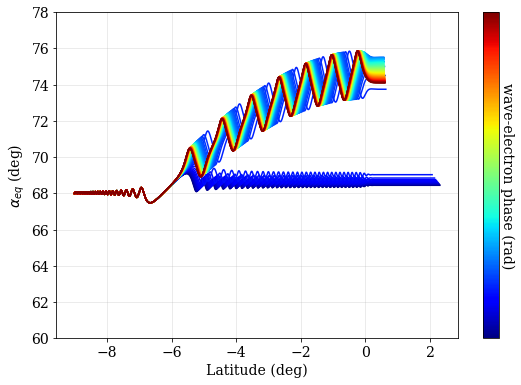

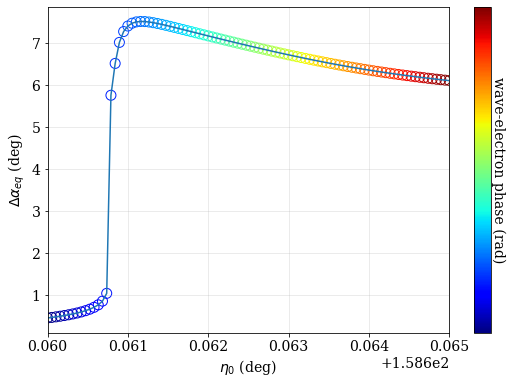

In [31]:
plt.rc('font', family='serif',size=14)
from matplotlib import cm
aeq=np.nan_to_num(aeq)
dalpha=[]
for r in range(0,len(eta0)):
    ls=np.max(np.nonzero(aeq[r,:]))
    dalphaf=np.rad2deg(aeq[r,ls])-aeq0_deg
    dalpha.append(dalphaf)
#     print(np.rad2deg(aeq[r,ls]))

norm = cm.colors.Normalize(vmin=eta0.min(), vmax=eta0.max())
cmap = cm.ScalarMappable(norm=norm, cmap=cm.jet)
cmap.set_array([])

norm2 = cm.colors.Normalize(vmin=eta0.min(), vmax=eta0.max())
cmap2 = cm.ScalarMappable(norm=norm2, cmap=cm.winter)
cmap2.set_array([])
###################################################################
fig, ax = plt.subplots(figsize=(9,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),np.rad2deg(aeq[r,:-1]),c=cmap.to_rgba(eta0[r]))
ax.grid(alpha=.3)
# ax.set_xlim(-9,0)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel(r'$\alpha_{eq}$ (deg)')

ax.set_ylim(60,78)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('wave-electron phase (rad)', rotation=270,labelpad=15)
# ax.axvline(x=-5,color="black", linestyle="--")
plt.show()
####################################################################
fig, ax = plt.subplots(figsize=(9,6))
s=5

colors=eta0[:]

ax.grid(alpha=.3)
ax.plot(np.rad2deg(eta0),dalpha)
ax.scatter(np.rad2deg(eta0),dalpha,marker='o',facecolors='none', edgecolors=cmap.to_rgba(eta0[:]),s=100)
ax.set_xlim(158.66,158.665)
ax.set_xlabel(r'$\eta_0$ (deg)')
ax.set_ylabel(r'$\Delta \alpha_{eq}$ (deg)')

# ax.set_ylim(-10,10)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('wave-electron phase (rad)', rotation=270,labelpad=15)
# ax.axvline(x=-5,color="black", linestyle="--")
plt.show()


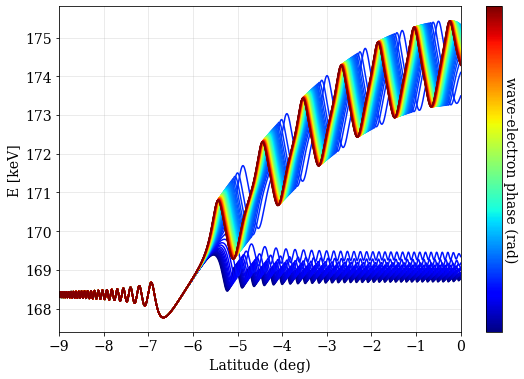

In [10]:
################################################################
fig, ax = plt.subplots(figsize=(9,6))
for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),E_kin[r,:-1]*6.2415e15,c=cmap.to_rgba(eta0[r]))
# ax.legend()
ax.grid(alpha=.3)
ax.set_xlim(-9,0)
# ax.set_ylim(160,250)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel('E [keV]')
# ax.set_ylim(-10,10)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('wave-electron phase (rad)', rotation=270,labelpad=15)
# ax.axvline(x=-5,color="black", linestyle="--")
plt.show()


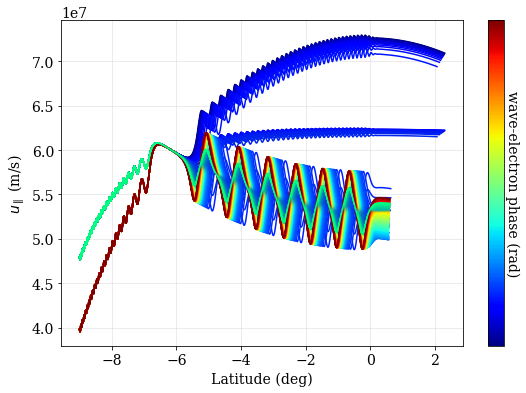

In [11]:
####################################################################

fig, ax = plt.subplots(figsize=(9,6))
for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,:-1]),upar[r,:-1],c=cmap.to_rgba(eta0[r]))
    ax.plot(np.rad2deg(lamda[r,:-1]),v_res_out[r,:-1],c=cmap2.to_rgba(eta0[r]))
# ax.legend()
ax.grid(alpha=.3)
# ax.set_xlim(-4.8,-5.2)
ax.set_xlabel('Latitude (deg)')
ax.set_ylabel(r'$u_{\parallel}$ (m/s)')
# ax.axvline(x=-5,color="black", linestyle="--")
# ax.set_ylim(5.75*10**7,5.85*10**7)
ticks=np.arange(0,2*np.pi,1)
cbar=fig.colorbar(cmap, ticks=ticks)
cbar.set_label('wave-electron phase (rad)', rotation=270,labelpad=15)
# ax.axvline(x=-5,color="black", linestyle="--")
plt.show()



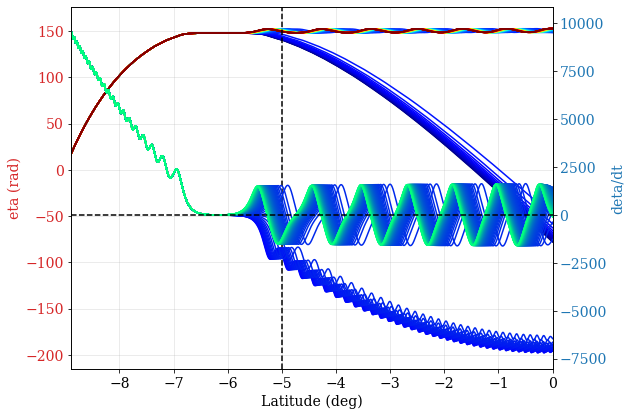

In [12]:

###########################################################################
fig, ax1 = plt.subplots(figsize=(9,6))

color = 'tab:red'
ax1.set_xlabel('Latitude (deg)')
ax1.set_ylabel('eta (rad)', color=color)


for r in range(0,len(eta0)):
    ax1.plot(np.rad2deg(lamda[r,:-1]),eta[r,:-1],c=cmap.to_rgba(eta0[r]))
    
ax1.tick_params(axis='y', labelcolor=color)
# ax.set_xlim(-30.1,-0.1)

ax1.set_xlim(-8.9,0)
ax1.grid(alpha=.3)
ax1.axvline(x=-5,color="black", linestyle="--")
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('deta/dt', color=color)  # we already handled the x-label with ax1
# ax2.set_ylim(-0.45,0.2)
for r in range(0,len(eta0)):
    ax2.plot(np.rad2deg(lamda[r,:-1]),deta_dt[r,:-1],c=cmap2.to_rgba(eta0[r]))
ax2.tick_params(axis='y', labelcolor=color)
fig.tight_layout()  # otherwise the right y-label is slightly clipped
ax2.axhline(y=0,color="black", linestyle="--")
plt.show()



/home/tourgaidis/.local/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until


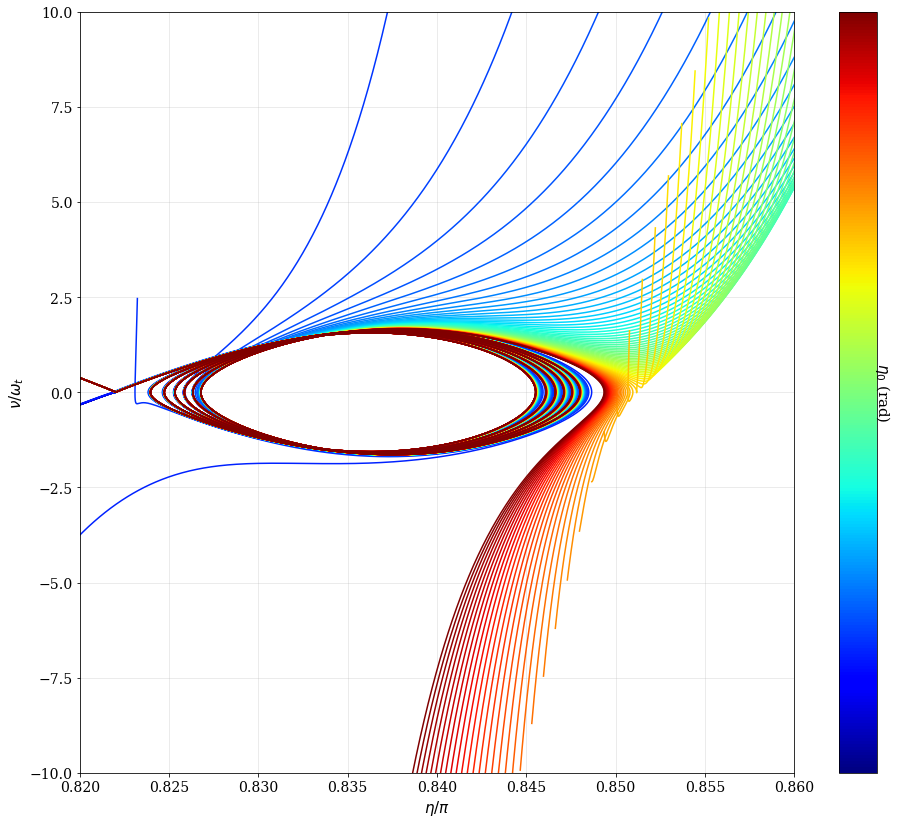

In [38]:
wtr=np.sqrt(wtrsq_out)

nplot=deta_dt/wtr

fonts=15
fig, ax = plt.subplots(figsize=(16,14))
s=5
last=5

for r in range(0,len(eta0)):
    ax.plot(eta[r,:-last]/180,nplot[r,:-last],c=cmap.to_rgba(eta0[r]))

ax.grid(alpha=.3)
ax.set_xlim(0.82,0.86)
ax.set_xlabel(r'$\eta/\pi$',fontsize=fonts)
ax.set_ylabel(r'$\nu/\omega_t$',fontsize=fonts)

ax.set_ylim(-10,10)

cbar=fig.colorbar(cmap, ticks=[-np.pi,-np.pi/2,0,np.pi/2,np.pi])
cbar.ax.set_yticklabels([r'$-\pi$',r'$-\pi/2$', '0',r'$\pi/2$', r'$\pi$'])  # horizontal colorbar
cbar.set_label(r'$\eta_0$ (rad)', rotation=270,labelpad=15,fontsize=fonts)
# ax.axvline(x=-5,color="black", linestyle="--")
plt.show()


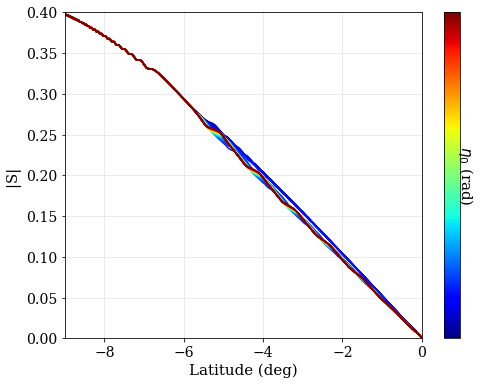

In [14]:
fig, ax = plt.subplots(figsize=(8,6))
s=5


for r in range(0,len(eta0)):
    ax.plot(np.rad2deg(lamda[r,2:]),np.abs(S_out[r,2:]),c=cmap.to_rgba(eta0[r]))

ax.grid(alpha=.3)
ax.set_xlim(-9,0)
ax.set_xlabel('Latitude (deg)',fontsize=fonts)
ax.set_ylabel('|S| ',fontsize=fonts)

ax.set_ylim(0,0.4)
cbar=fig.colorbar(cmap, ticks=[-np.pi,-np.pi/2,0,np.pi/2,np.pi])
cbar.ax.set_yticklabels([r'$-\pi$',r'$-\pi/2$', '0',r'$\pi/2$', r'$-\pi$'])  # horizontal colorbar
cbar.set_label(r'$\eta_0$ (rad)', rotation=270,labelpad=15,fontsize=fonts)
# ax.axvline(x=-5,color="black", linestyle="--")
plt.show()